## A model build using BERTweet to identify cause-effect pairs in sentences of tweets

The cause-effect pair sentence prediction model will be trained on the dataset which got augmented in an active learning approach in 5 steps.

Load already preprocessed file with sentence containing either cause or effect or both. Sentences labeled as Jokes, questions or having negations are removed.

IO tagging is used instead of BIO tagging. The assumption is that the attention mechanism already encodes information about the postion (B-.). In consequence the training should be simplified with only 3 classes: I-C, I-E, O

Finetune a the pretrained BERTweet model

In [1]:
import pandas as pd
import numpy as np
import spacy 
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
from sklearn.metrics import classification_report
from seqeval.metrics import classification_report as classification_report_seqeval
from transformers import BertForSequenceClassification, AutoTokenizer
from transformers import AdamW, get_linear_schedule_with_warmup
from tqdm import tqdm, trange
import random
import os
import torch.nn.functional as F
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import transformers
from tqdm import tqdm, trange
from utils import normalizeTweet, split_into_sentences, bio_tagging, EarlyStopping
import matplotlib.pyplot as plt
from ast import literal_eval
%matplotlib inline

########################### Check if cuda available ############################
print("Cuda available: ", torch.cuda.is_available())
device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')



########################### DATA FILE ###################################
dataPath = "data/cause_effect_sentences_with_IO_tags.csv"



########################### MODEL PARAMETERS ############################
lr = 1e-5 # earlier 1e-3    
adam_eps = 1e-8
epochs = 55
num_warmup_steps = 0
early_patience = 10 # earlier 5, how long to wait after last time validation loss improved

train_batch_size = 1#8
val_batch_size = 8
test_batch_size = 8
train_to_test_ratio = 0.9 # 10% test and 90% train
val_to_train_ratio = 0.2
type_ = "io_cause-and-effect"
attempt_ = "test"

n_labels = 3 # 0, I-C, I-E
tag2id = {label: idx for idx, label in enumerate(["O", "I-C", "I-E"])}
tag2id[-100] = -100
id2tag = {id:tag for tag,id in tag2id.items()}

# if True, only sentences containing both cause and effect are considered. (Default)
# if False, all sentences containing either cause or effect are considered
requireCauseAndEffect = True 

# Each token has its associated IO tag ("O", "I-C", "I-E").
# The Bertweet tokenizer splits words into sub-words
# if True => assign IO tag of word to all sub-words
# if False => assign IO tag of word to first sub-word and all other sub-words get -100 (loss function ignores this index)
subwordTagEqualFirstwordTag = False 

metric_choice = "weighted" # micro, macro, samples or weighted 
# metrics_average = "binary" # this will give measure for class_1,i.e., causal class

# saveModelName = "./model-causal-span/cause-and-effect_model_1_finetuned-{}-epochs-lr_{}.pth".format(epochs, lr) # it should be epoch so that the name shows at what epoch teh mdel ws saved

Cuda available:  True


In [2]:
##### DATA TO LOAD ######

data = pd.read_csv(dataPath, sep=";", converters={"tokenized":literal_eval, "bio_tags":literal_eval})
print(data.shape)
data.head()

(2500, 7)


,sentence,Intent,Cause,Effect,Causal association,tokenized,bio_tags
0,USER Additionally the medicines are being char...,NaN,medicines are being charged at MRP,costing much higher,1.0,"[USER, Additionally, the, medicines, are, bein...","[O, O, O, I-C, I-C, I-C, I-C, I-C, I-C, O, O, ..."
1,"I hear "" I hate being a diabetic "" .",NaN,diabetic,hate,1.0,"[I, hear, "", I, hate, being, a, diabetic, "", .]","[O, O, O, O, I-E, O, O, I-C, O, O]"
2,"i got lime for my glucose test , was n't that ...",NaN,glucose test,nauseous,1.0,"[i, got, lime, for, my, glucose, test, ,, was,...","[O, O, O, O, O, I-C, I-C, O, O, O, O, O, O, O,..."
3,Sounds like Willow 's blood sugar level is rea...,NaN,blood sugar level is real low,reduce her insulin shots,1.0,"[Sounds, like, Willow, 's, blood, sugar, level...","[O, O, O, O, I-C, I-C, I-C, I-C, I-C, I-C, O, ..."
4,USER I 've always found it too sweet mustvsay ...,NaN,dreaded diabetes,sauces are used sparingly,1.0,"[USER, I, 've, always, found, it, too, sweet, ...","[O, O, O, O, O, O, O, O, O, O, O, O, I-E, I-E,..."


## Preprocessing

In [3]:
############ Choose only sentences with both cause and effect or only sentences with either cause or effect (or both) #######

if requireCauseAndEffect: # cause and effect in sentence
    dataSentFiltered = data[(data["Cause"].notnull()) & (data["Effect"].notnull())]
else: # cause or effect or both in sentence
    dataSentFiltered = data[(data["Cause"].notnull()) | (data["Effect"].notnull())]

print(dataSentFiltered.shape)
dataSentFiltered.head()

(2118, 7)


,sentence,Intent,Cause,Effect,Causal association,tokenized,bio_tags
0,USER Additionally the medicines are being char...,NaN,medicines are being charged at MRP,costing much higher,1.0,"[USER, Additionally, the, medicines, are, bein...","[O, O, O, I-C, I-C, I-C, I-C, I-C, I-C, O, O, ..."
1,"I hear "" I hate being a diabetic "" .",NaN,diabetic,hate,1.0,"[I, hear, "", I, hate, being, a, diabetic, "", .]","[O, O, O, O, I-E, O, O, I-C, O, O]"
2,"i got lime for my glucose test , was n't that ...",NaN,glucose test,nauseous,1.0,"[i, got, lime, for, my, glucose, test, ,, was,...","[O, O, O, O, O, I-C, I-C, O, O, O, O, O, O, O,..."
3,Sounds like Willow 's blood sugar level is rea...,NaN,blood sugar level is real low,reduce her insulin shots,1.0,"[Sounds, like, Willow, 's, blood, sugar, level...","[O, O, O, O, I-C, I-C, I-C, I-C, I-C, I-C, O, ..."
4,USER I 've always found it too sweet mustvsay ...,NaN,dreaded diabetes,sauces are used sparingly,1.0,"[USER, I, 've, always, found, it, too, sweet, ...","[O, O, O, O, O, O, O, O, O, O, O, O, I-E, I-E,..."


## Training

In [5]:
trainingDataSample = dataSentFiltered #.sample(n=100)   # Only for testing
train = trainingDataSample.sample(frac=train_to_test_ratio, random_state=0)
test = trainingDataSample.drop(train.index)
validate = train.sample(frac=val_to_train_ratio, random_state=0)
train = train.drop(validate.index)
print("Train:", train.shape)
print("Validate:", validate.shape)
print("Test:", test.shape)

Train: (1525, 7)
Validate: (381, 7)
Test: (212, 7)


In [6]:
######### BERTWEET TOKENIZER + PYTORCH DATASET/DATALOADER STRUCTURE ##################

class TweetDataSet(torch.utils.data.Dataset):
    def __init__(self, text, labels, bio_tags, tokenizer):
        self.text = text
        self.labels = labels
        self.tokenizer = tokenizer
        self.bio_tags = bio_tags


    def __getitem__(self, idx):
        inputs = self.tokenizer(self.text, padding=True, truncation=True, return_token_type_ids=True)
        ids = inputs["input_ids"]
        mask = inputs["attention_mask"]
        token_type_ids = inputs["token_type_ids"]
        bio_tags_extended = self.extend_tags(self.text[idx], self.bio_tags[idx], ids[idx])
        
        assert(len(ids[idx]) == len(bio_tags_extended), "token ids and IO tags lengths do not match!")
        return {
                "input_ids" : torch.tensor(ids[idx], dtype=torch.long)
              , "attention_mask" : torch.tensor(mask[idx], dtype=torch.long)
              , "token_type_ids" : torch.tensor(token_type_ids[idx], dtype=torch.long)
              , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
              , "bio_tags" : torch.tensor(list(map(lambda bioTags: tag2id[bioTags], bio_tags_extended))
, dtype=torch.long)
        }

    def __len__(self):
        return len(self.labels)

    
    def extend_tags(self, tokens_old, tags_old, ids_tokenized_padded):
        """ 
            Each token has a IO tag label. 
            However BERT's tokenization splits tokens into subwords. How to label those subwords?
            
            Option 1:
            ---------
            
            add the same label to each subword than the first subword
            Ex. 
            #lowbloodsugar => '#low@@', 'blood@@', 'sugar@@'
               "I-C"       =>   "I-C" ,   "I-C"  ,   "I-C"
            
            Option 2 (implemented):      
            ---------
            
            From : https://huggingface.co/transformers/custom_datasets.html#token-classification-with-w-nut-emerging-entities
            A common obstacle with using pre-trained models for token-level classification: many of the tokens in
            the W-NUT corpus are not in DistilBert’s vocabulary. Bert and many models like it use a method called 
            WordPiece Tokenization, meaning that single words are split into multiple tokens such that each token
            is likely to be in the vocabulary. For example, DistilBert’s tokenizer would split the Twitter 
            handle @huggingface into the tokens ['@', 'hugging', '##face']. This is a problem for us because we 
            have exactly one tag per token. If the tokenizer splits a token into multiple sub-tokens, then we will
            end up with a mismatch between our tokens and our labels.

            One way to handle this is to only train on the tag labels for the first subtoken of a split token. 
            We can do this in 🤗 Transformers by setting the labels we wish to ignore to -100. 
            In the example above, if the label for @HuggingFace is 3 (indexing B-corporation), we would set 
            the labels of ['@', 'hugging', '##face'] to [3, -100, -100].
        """
        tags = [-100] # add for start token <CLS>
        for token_old, tag in zip(tokens_old.split(" "), tags_old):
            for i, sub_token in enumerate(self.tokenizer.tokenize(token_old)):
                if (i == 0): # first sub token of a word keeps the original bio tag
                    firstTag = tag
                    tags.append(tag)
                else: 
                    if subwordTagEqualFirstwordTag: # the other sub tokens get the first bio tag than the first sub token
                        tags.append(firstTag)
                    else: # to other sub tokens get the tag -100 (ignored in loss function)
                        tags.append(-100)

        tags.append(-100) # 0 for end of sentence token
    
        # append -100 for all padded elements
        padded_elements = ids_tokenized_padded.count(1) # id 1 is <PAD> ; Alternative: where attention_mask == 0 add -100
        tags.extend([-100]*padded_elements)
        
        return tags
        
        
    
tokenizer = AutoTokenizer.from_pretrained("vinai/bertweet-base", padding = "max_length", truncation = True, max_length = 60 )

train_dataset = TweetDataSet(train["sentence"].values.tolist()
                           , train["Causal association"].values.tolist()
                           , train["bio_tags"].values.tolist()
                           , tokenizer)
val_dataset = TweetDataSet(validate["sentence"].values.tolist()
                           , validate["Causal association"].values.tolist()
                           , validate["bio_tags"].values.tolist()
                           , tokenizer)
test_dataset = TweetDataSet(test["sentence"].values.tolist()
                           , test["Causal association"].values.tolist()
                           , test["bio_tags"].values.tolist()
                           , tokenizer)
print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

# put data to batches
train_loader = DataLoader(train_dataset, batch_size=train_batch_size, shuffle=True)
validation_loader = DataLoader(val_dataset, batch_size=val_batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=test_batch_size, shuffle=True)


<>:18: SyntaxWarning: assertion is always true, perhaps remove parentheses?
<>:18: SyntaxWarning: assertion is always true, perhaps remove parentheses?
<ipython-input-6-6ea249dd8a91>:18: SyntaxWarning: assertion is always true, perhaps remove parentheses?
  assert(len(ids[idx]) == len(bio_tags_extended), "token ids and IO tags lengths do not match!")
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


1525
381
212


In [7]:
############ class weights #####################

# Since -100 will anyway be ignored by loss func, drop it
train_bio_tags = np.hstack([t["bio_tags"][t["bio_tags"]!=-100].numpy() for t in train_dataset])
print("train_bio_tags:", train_bio_tags)

train_bio_tags_count_info = (pd.Series(train_bio_tags).value_counts(normalize=True))
print("train_bio_tags_count_info:", train_bio_tags_count_info)

# for class-imbalanced dataset, the class weight for a ith class
# to be specified for balancing in the loss function is given by:
# weight[i] = num_samples / (num_classes * num_samples[i])
# since train_bio_tags_count_info obtained above has fraction of 
# samples for ith class, hence the corresponding weight calculation is:
class_weight = (1/train_bio_tags_count_info)/len(train_bio_tags_count_info)
class_weight = class_weight[sorted(class_weight.index)]
class_weight


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


train_bio_tags: [0 0 0 ... 1 1 0]
train_bio_tags_count_info: 0    0.801340
2    0.106704
1    0.091957
dtype: float64


0    0.415970
1    3.624900
2    3.123913
dtype: float64

## Evaluation metrics

In [8]:
def compute_metrics(pred, labels):
    """
        Dataset is unbalanced -> measure weighted metrics
        Calculate metrics for each label, and find their average wieghted by support (Number of true instances for each label)
        This alters 'macro' to account for label imbalance;
        it can result in an F-Score taht is not between precision and recall
    """
    precision, recall, f1, _ = precision_recall_fscore_support(labels, pred, average= metric_choice) # TODO: check weightin
    acc = accuracy_score(labels, pred)
    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }


## Model definition

In [9]:
class CausalNER(torch.nn.Module):
    """ Model Bert"""
    def __init__(self):
        super(CausalNER, self).__init__()
        self.bert = transformers.BertModel.from_pretrained("vinai/bertweet-base")
        self.dropout = torch.nn.Dropout(0.3)
        self.linear1 = torch.nn.Linear(768, 256)
        self.linear2 = torch.nn.Linear(256, n_labels)
        self.softmax = torch.nn.Softmax(-1)
        
    def forward(self, input_ids, attention_mask, token_type_ids):
#        _, output_1 = self.bert(input_ids, attention_mask = attention_mask, token_type_ids=token_type_ids, return_dict=False) # if output 1 is our cls token
        output_seq, _ = self.bert(input_ids, attention_mask = attention_mask, token_type_ids=token_type_ids, return_dict=False) # if output 1 is our cls token
        output_2 = self.dropout(output_seq)
        output_3 = self.linear1(output_2)
        output_4 = self.dropout(output_3)
        output_5 = self.linear2(output_4)
        return output_5 # 5


In [10]:
model = CausalNER()
model.to(device)

# fine-tune only the task-specific parameters 
for param in model.bert.parameters():
    param.requires_grad = False
#     param[:-1].requires_grad = False
#     param[-1].requires_grad = True

num_training_steps = np.ceil(len(train_dataset)/train_batch_size)*epochs
optim = AdamW(model.parameters(), lr=lr, eps=adam_eps)
# scheduler with a linearly decreasing learning rate from the initial lr set in the optimizer to 0;
# after a warmup period during which it increases linearly from to the initial lr set in the optimizer
scheduler = get_linear_schedule_with_warmup(optim, num_warmup_steps=num_warmup_steps, num_training_steps=num_training_steps) 


## adding weight to the loss function 
loss_fn = CrossEntropyLoss(
    weight=torch.tensor(class_weight.to_list()).to(device),
    ignore_index=-100 # ignore subwords/tokens with label -100 
)


You are using a model of type roberta to instantiate a model of type bert. This is not supported for all configurations of models and can yield errors.
Some weights of the model checkpoint at vinai/bertweet-base were not used when initializing BertModel: ['roberta.encoder.layer.5.attention.output.LayerNorm.bias', 'roberta.encoder.layer.11.attention.output.LayerNorm.bias', 'roberta.encoder.layer.7.output.dense.bias', 'roberta.encoder.layer.10.attention.self.key.bias', 'roberta.encoder.layer.0.intermediate.dense.bias', 'roberta.encoder.layer.7.attention.output.LayerNorm.weight', 'lm_head.dense.bias', 'roberta.encoder.layer.11.attention.self.value.bias', 'roberta.encoder.layer.5.attention.self.query.bias', 'roberta.encoder.layer.4.attention.output.dense.bias', 'roberta.encoder.layer.5.attention.self.value.bias', 'roberta.encoder.layer.11.attention.self.query.weight', 'roberta.encoder.layer.2.output.LayerNorm.bias', 'roberta.encoder.layer.6.attention.output.dense.weight', 'roberta.encoder.

In [11]:
################ TRAINING ######################

# initialise the early_stopping object
early_stopping = EarlyStopping(patience=early_patience, verbose=True)

train_avg_loss = [] # avg training loss per epoch
val_avg_loss = [] # avg validation loss per epoch
train_avg_acc = [] # avg training accuracy per epoch
val_avg_acc = [] # avg val accuracy per epoch
n_trained_epochs = 0

for epoch in trange(1, epochs+1, desc='Epoch'):
    print("<" + "="*22 + F" Epoch {epoch} "+ "="*22 + ">")

    
    ############ training eval metrics ######################
    train_loss = []
    train_acc = []
    train_prec = []
    train_rec = []
    train_f1 = []
    
    #########################################################
    
    
    for batch in tqdm(train_loader):
        optim.zero_grad() # gradients get accumulated by default -> clear previous accumulated gradients
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        token_type_ids = batch["token_type_ids"].to(device)
        labels = batch['labels'].to(device)
        bio_tags = batch['bio_tags'].to(device)
        
        ################################################
        model.train() # set model to training mode
        logits = model(**{"input_ids":input_ids, "attention_mask":attention_mask, "token_type_ids":token_type_ids}) # forward pass

        ################################################ 
        # similar to the class RobertaForToken classification in transformers: https://github.com/huggingface/transformers/blob/master/src/transformers/models/roberta/modeling_roberta.py
        active_loss = attention_mask.view(-1) == 1  # either based on attention_mask (includes <CLS>, <SEP> token)
        active_logits = logits.view(-1, n_labels)[active_loss] # n_labels=53
        active_tags = bio_tags.view(-1)[active_loss]
        loss = loss_fn(active_logits, active_tags)             
        print("loss:", loss)       ## TODO VIVEK: check loss function calculation
        loss.backward() # backward pass
        ## gradient clipping to control the exploding gradient problem 
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
        optim.step()    # update parameters and take a steup using the computed gradient
        scheduler.step()# update learning rate scheduler
        train_loss.append(loss.item())
            
            
        ################## Training Performance Measures ##########
        logits = logits.detach().to('cpu').numpy()
        tags_ids = bio_tags.to('cpu').numpy()

        # calculate performance measures only on tokens and not subwords or special tokens
        tags_mask = tags_ids != -100 # only get token labels and not labels from subwords or special tokens
        pred = np.argmax(logits, axis=2)[tags_mask] #.flatten() # convert logits to list of predicted labels
        tags = tags_ids[tags_mask]                      
                
        metrics = compute_metrics(pred, tags)
        train_acc.append(metrics["accuracy"])
        train_prec.append(metrics["precision"])
        train_rec.append(metrics["recall"])
        train_f1.append(metrics["f1"])
                          
    train_avg_loss.append(np.mean(train_loss))
    train_avg_acc.append(np.mean(train_acc))           
    print(F'\n\tTraining Loss: {np.mean(train_loss)}')
    print(F'\n\tTraining acc: {np.mean(train_acc)}')
    print(F'\n\tTraining prec: {np.mean(train_prec)}')
    print(F'\n\tTraining rec: {np.mean(train_rec)}')
    print(F'\n\tTraining f1: {np.mean(train_f1)}')

    n_trained_epochs += 1

                          
    ###################################################################################

    
    ## ---- Validation ------    
    val_accuracy = []
    val_loss = []
    val_acc = []
    val_prec = []
    val_rec = []
    val_f1 = []

    # Evaluate data for one epoch
    for batch in tqdm(validation_loader):
        batch = tuple(batch[t].to(device) for t in batch)      # batch to GPU
        v_input_ids, v_input_mask, v_token_type_ids, v_labels, v_bio_tags = batch  # unpack inputs from dataloader
        
        with torch.no_grad(): # tell model not to compute or store gradients -> saves memory + speeds up validation
            model.eval() # put model in evaluation mode for validation set
            logits = model(**{"input_ids":v_input_ids, "attention_mask":v_input_mask, "token_type_ids":v_token_type_ids}) # forward pass, calculates logit predictions

        ######################################################
        
        # similar to the class RobertaForToken classification in transformers: https://github.com/huggingface/transformers/blob/master/src/transformers/models/roberta/modeling_roberta.py
        v_active_loss = v_input_mask.view(-1) == 1  # either based on attention_mask (includes <CLS>, <SEP> token)
        v_active_logits = logits.view(-1, n_labels)[v_active_loss] # n_labels=3 
        v_active_tags = v_bio_tags.view(-1)[v_active_loss]
        v_loss = loss_fn(v_active_logits, v_active_tags)             
        val_loss.append(v_loss.item())
              
        #########################################################
        logits = logits.detach().to('cpu').numpy()
        tags_ids = v_bio_tags.to('cpu').numpy()

        # calculate performance measures only on tokens and not subwords or special tokens
        tags_mask = tags_ids != -100 # only get token labels and not labels from subwords or special tokens
        pred = np.argmax(logits, axis=2)[tags_mask] #.flatten() # convert logits to list of predicted labels
        tags = tags_ids[tags_mask]#.flatten()        
        
        metrics = compute_metrics(pred, tags)
        val_acc.append(metrics["accuracy"])
        val_prec.append(metrics["precision"])
        val_rec.append(metrics["recall"])
        val_f1.append(metrics["f1"])
                              
    val_avg_loss.append(np.mean(val_loss))
    val_avg_acc.append(np.mean(val_acc))        
    print(F'\n\tValidation Loss: {np.mean(val_loss)}')
    print(F'\n\tValidation acc: {np.mean(val_acc)}')
    print(F'\n\tValidation prec: {np.mean(val_prec)}')
    print(F'\n\tValidation rec: {np.mean(val_rec)}')
    print(F'\n\tValidation f1: {np.mean(val_f1)}')

    # early_stopping needs the validation loss to check if it has decreased,
    # and if it has, it will make a checkpoint of the current model
    saveModelName = "./model-causal-span/{}_model_{}_finetuned-{}-epochs-lr_{}.pth".format(type_, attempt_, n_trained_epochs-early_patience, lr) 
    early_stopping.path = saveModelName
    early_stopping(np.average(val_loss), model)
    
    if early_stopping.early_stop:
        print("Early stopping")
        break

Epoch:   0%|          | 0/55 [00:00<?, ?it/s]

<====================== Epoch 1 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<17:52,  1.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<08:59,  2.82it/s]

loss: tensor(1.4014, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<06:08,  4.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:01<04:47,  5.29it/s]

loss: tensor(0.9510, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 5/1525 [00:01<04:05,  6.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:01<04:15,  5.95it/s]

loss: tensor(1.5242, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:01<03:45,  6.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:01<03:25,  7.37it/s]

loss: tensor(1.2447, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:12,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:03,  8.27it/s]

loss: tensor(1.3005, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:57,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:52,  8.75it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:02<02:49,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:02<02:48,  8.95it/s]

loss: tensor(1.1522, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 15/1525 [00:02<02:46,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:02<03:16,  7.68it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:05,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:57,  8.48it/s]

loss: tensor(1.2469, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:52,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:48,  8.92it/s]

loss: tensor(1.1403, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:03<02:45,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:03<02:43,  9.17it/s]

loss: tensor(1.3714, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:03<02:43,  9.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:03<02:43,  9.16it/s]

loss: tensor(1.2170, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:03<02:43,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:15,  7.68it/s]

loss: tensor(1.3033, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:05,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:57,  8.42it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:52,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:04<02:48,  8.87it/s]

loss: tensor(1.2001, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:04<02:46,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:04<02:44,  9.06it/s]

loss: tensor(1.1251, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:04<02:42,  9.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:41,  9.24it/s]

loss: tensor(0.9621, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:40,  9.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:40,  9.26it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<03:16,  7.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:05,  8.00it/s]

loss: tensor(1.3805, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:05<02:58,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:05<02:53,  8.57it/s]

loss: tensor(1.0760, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:05<02:50,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 42/1525 [00:05<02:47,  8.88it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:45,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:43,  9.04it/s]

loss: tensor(1.2762, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:43,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:42,  9.08it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:42,  9.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:06<03:11,  7.71it/s]

loss: tensor(1.1885, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 49/1525 [00:06<03:00,  8.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:06<02:54,  8.48it/s]

loss: tensor(1.1301, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:48,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:45,  8.90it/s]

loss: tensor(1.0414, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:44,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:42,  9.07it/s]

loss: tensor(1.0995, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:40,  9.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:07<02:38,  9.25it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:07<02:38,  9.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:07<03:08,  7.76it/s]

loss: tensor(0.9569, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<03:00,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:54,  8.42it/s]

loss: tensor(1.3685, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:50,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:48,  8.68it/s]

loss: tensor(1.1778, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:47,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:46,  8.79it/s]

loss: tensor(1.0632, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:08<02:45,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:08<02:44,  8.85it/s]

loss: tensor(1.2414, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:08<02:44,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<03:15,  7.46it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▍         | 69/1525 [00:08<03:05,  7.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:59,  8.12it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:54,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:51,  8.48it/s]

loss: tensor(1.1413, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:09<02:47,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:09<02:44,  8.81it/s]

loss: tensor(0.9699, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:09<02:43,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:42,  8.89it/s]

loss: tensor(1.1689, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:41,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:38,  9.12it/s]

loss: tensor(1.2034, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<03:09,  7.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<03:00,  7.99it/s]

loss: tensor(1.1171, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:55,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:10<02:50,  8.44it/s]

loss: tensor(1.3802, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:10<02:47,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:10<02:45,  8.70it/s]

loss: tensor(1.0781, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:44,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:42,  8.83it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:41,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:39,  9.03it/s]

loss: tensor(1.0092, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:38,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:11<03:08,  7.62it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:11<02:59,  8.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:11<02:51,  8.35it/s]

loss: tensor(1.0642, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:50,  8.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:45,  8.66it/s]

loss: tensor(1.2630, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:41,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:38,  9.02it/s]

loss: tensor(1.2587, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:36,  9.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:37,  9.08it/s]

loss: tensor(1.3290, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:12<02:35,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:12<02:33,  9.27it/s]

loss: tensor(1.1125, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:12<03:02,  7.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:52,  8.24it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:46,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:41,  8.77it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:39,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:36,  9.04it/s]

loss: tensor(1.2854, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:35,  9.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:13<02:35,  9.13it/s]

loss: tensor(1.2100, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:13<02:33,  9.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:32,  9.27it/s]

loss: tensor(1.1786, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<03:02,  7.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:52,  8.20it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:45,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:40,  8.79it/s]

loss: tensor(1.1587, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:37,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:35,  9.07it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:14<02:35,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:14<02:36,  9.00it/s]

loss: tensor(1.1200, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:37,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:35,  9.03it/s]

loss: tensor(1.2424, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<03:05,  7.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:57,  7.88it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:51,  8.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:48,  8.33it/s]

loss: tensor(1.1327, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:15<02:45,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:15<02:42,  8.60it/s]

loss: tensor(1.0839, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:41,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:40,  8.71it/s]

loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:40,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▊         | 130/1525 [00:15<02:39,  8.73it/s]

loss: tensor(1.0810, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:39,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<03:09,  7.35it/s]

loss: tensor(1.3138, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:16<03:01,  7.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:16<02:54,  7.98it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:16<02:49,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:45,  8.40it/s]

loss: tensor(1.1993, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:42,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:40,  8.66it/s]

loss: tensor(1.2242, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:39,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:37,  8.79it/s]

loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:36,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:17<02:36,  8.82it/s]

loss: tensor(1.0771, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:17<03:07,  7.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:58,  7.74it/s]

loss: tensor(1.2726, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:52,  8.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:46,  8.28it/s]

loss: tensor(1.1515, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:42,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:39,  8.65it/s]

loss: tensor(1.2324, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:37,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:18<02:36,  8.80it/s]

loss: tensor(1.2188, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:18<02:35,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:18<02:34,  8.90it/s]

loss: tensor(1.1272, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:32,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<03:00,  7.59it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:52,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:46,  8.21it/s]

loss: tensor(1.1969, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:43,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:40,  8.54it/s]

loss: tensor(1.0696, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:19<02:37,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:19<02:35,  8.75it/s]

loss: tensor(1.0170, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:34,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:34,  8.85it/s]

loss: tensor(1.1933, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:33,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<03:02,  7.47it/s]

loss: tensor(1.0970, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:54,  7.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:47,  8.10it/s]

loss: tensor(1.1719, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:20<02:43,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:20<02:40,  8.44it/s]

loss: tensor(1.2011, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█         | 169/1525 [00:20<02:38,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/met

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:35,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:33,  8.80it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:33,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<03:01,  7.43it/s]

loss: tensor(1.0666, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:21<02:52,  7.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:21<02:45,  8.15it/s]

loss: tensor(1.1970, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:21<02:40,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:37,  8.55it/s]

loss: tensor(1.2362, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:33,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:30,  8.95it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:28,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:27,  9.10it/s]

loss: tensor(1.0754, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:26,  9.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:22<02:26,  9.17it/s]

loss: tensor(0.9522, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:22<02:54,  7.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:45,  8.08it/s]

loss: tensor(1.2650, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:39,  8.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:37,  8.46it/s]

loss: tensor(1.0823, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:33,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:29,  8.93it/s]

loss: tensor(1.1140, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:26,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:25,  9.17it/s]

loss: tensor(1.1486, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:23<02:23,  9.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:23<02:22,  9.32it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:23,  9.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:51,  7.74it/s]

loss: tensor(1.0138, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:42,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:35,  8.52it/s]

loss: tensor(1.0255, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:31,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:27,  8.97it/s]

loss: tensor(1.3654, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:25,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:24<02:23,  9.21it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:22,  9.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:21,  9.35it/s]

loss: tensor(1.2416, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:20,  9.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:20,  9.41it/s]

loss: tensor(1.0089, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:47,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:38,  8.31it/s]

loss: tensor(1.1564, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:32,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:25<02:28,  8.84it/s]

loss: tensor(1.1263, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:25<02:26,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:26,  8.94it/s]

loss: tensor(1.1525, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:24,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:22,  9.19it/s]

loss: tensor(1.2002, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:21,  9.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:20,  9.30it/s]

loss: tensor(0.9699, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:47,  7.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:38,  8.23it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:26<02:32,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:28,  8.81it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:25,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:22,  9.11it/s]

loss: tensor(1.1538, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:21,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:22,  9.15it/s]

loss: tensor(1.2012, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:20,  9.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:19,  9.30it/s]

loss: tensor(1.1018, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:46,  7.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:37,  8.22it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:31,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:27,  8.80it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:24,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:21,  9.11it/s]

loss: tensor(1.0896, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:19,  9.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:18,  9.33it/s]

loss: tensor(0.9333, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:18,  9.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:17,  9.35it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:17,  9.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:44,  7.81it/s]

loss: tensor(1.0407, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:36,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:30,  8.53it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:25,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:22,  9.01it/s]

loss: tensor(1.1170, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:20,  9.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:20,  9.15it/s]

loss: tensor(1.2985, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:19,  9.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:18,  9.23it/s]

loss: tensor(1.1740, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:18,  9.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:19,  9.14it/s]

loss: tensor(1.0681, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:47,  7.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:38,  8.03it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:32,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:27,  8.63it/s]

loss: tensor(1.0529, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:23,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:21,  8.98it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:19,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:18,  9.16it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:17,  9.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:17,  9.25it/s]

loss: tensor(1.3238, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:16,  9.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:42,  7.78it/s]

loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:34,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:29,  8.44it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:27,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:23,  8.77it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:23,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:22,  8.83it/s]

loss: tensor(1.2312, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:20,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 268/1525 [00:31<02:19,  9.04it/s]

loss: tensor(1.1090, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:18,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:44,  7.61it/s]

loss: tensor(1.1767, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:36,  8.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:30,  8.35it/s]

loss: tensor(1.1686, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:25,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:21,  8.82it/s]

loss: tensor(1.1155, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:20,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:19,  8.97it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:18,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:17,  9.07it/s]

loss: tensor(1.2097, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:16,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:43,  7.61it/s]

loss: tensor(1.2544, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:35,  8.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:29,  8.32it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:24,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▊        | 284/1525 [00:33<02:21,  8.76it/s]

loss: tensor(1.1783, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:19,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:17,  8.99it/s]

loss: tensor(1.2187, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:16,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:15,  9.10it/s]

loss: tensor(1.3817, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:15,  9.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:14,  9.16it/s]

loss: tensor(1.2213, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:42,  7.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:33,  8.01it/s]

loss: tensor(1.1115, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:28,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:24,  8.53it/s]

loss: tensor(1.0643, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:25,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:21,  8.68it/s]

loss: tensor(1.2624, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:19,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|█▉        | 298/1525 [00:35<02:16,  8.98it/s]

loss: tensor(1.3607, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:15,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:14,  9.13it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:14,  9.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:41,  7.57it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:33,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:27,  8.30it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:22,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:19,  8.74it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:17,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:15,  8.99it/s]

loss: tensor(1.1950, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:14,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:13,  9.11it/s]

loss: tensor(1.0401, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:13,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:13,  9.10it/s]

loss: tensor(1.2956, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:39,  7.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:31,  8.01it/s]

loss: tensor(1.1787, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:25,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:21,  8.53it/s]

loss: tensor(1.3873, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:19,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:16,  8.83it/s]

loss: tensor(1.2229, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:14,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:16,  8.86it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:15,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 322/1525 [00:37<02:14,  8.93it/s]

loss: tensor(1.2546, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:40,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:32,  7.88it/s]

loss: tensor(1.2712, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:27,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:22,  8.39it/s]

loss: tensor(1.1650, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:20,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:19,  8.60it/s]

loss: tensor(0.9750, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:18,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:17,  8.68it/s]

loss: tensor(1.0532, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:17,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:16,  8.73it/s]

loss: tensor(1.1773, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:43,  7.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:34,  7.70it/s]

loss: tensor(1.0273, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:28,  7.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:24,  8.21it/s]

loss: tensor(0.9674, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:21,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:19,  8.52it/s]

loss: tensor(1.1678, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:17,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:15,  8.72it/s]

loss: tensor(1.2413, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:15,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:15,  8.76it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:14,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:40,  7.38it/s]

loss: tensor(1.0322, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:31,  7.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:25,  8.12it/s]

loss: tensor(1.1274, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:20,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:17,  8.55it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:14,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:13,  8.83it/s]

loss: tensor(1.1605, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:11,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:11,  8.94it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:10,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:09,  9.01it/s]

loss: tensor(0.9876, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:35,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:26,  8.00it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:19,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:15,  8.62it/s]

loss: tensor(1.2102, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:12,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:09,  8.97it/s]

loss: tensor(1.2004, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:07,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:06,  9.21it/s]

loss: tensor(1.0319, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:05,  9.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:04,  9.31it/s]

loss: tensor(1.1342, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:04,  9.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:30,  7.71it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:23,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:18,  8.36it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:14,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:11,  8.80it/s]

loss: tensor(1.4644, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:08,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:07,  9.08it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:05,  9.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:04,  9.23it/s]

loss: tensor(1.1139, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:03,  9.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:28,  7.73it/s]

loss: tensor(1.0769, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:21,  8.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:15,  8.48it/s]

loss: tensor(1.2047, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:10,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:07,  8.95it/s]

loss: tensor(1.1027, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:06,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:04,  9.15it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:04,  9.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:03,  9.26it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:02,  9.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:27,  7.74it/s]

loss: tensor(1.1797, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:19,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:13,  8.49it/s]

loss: tensor(1.0420, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:09,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:07,  8.93it/s]

loss: tensor(1.2505, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:05,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:03,  9.16it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:02,  9.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:01,  9.29it/s]

loss: tensor(1.2033, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:01,  9.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:00,  9.35it/s]

loss: tensor(1.0705, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:25,  7.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:22,  7.91it/s]

loss: tensor(1.0683, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:17,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:46<02:13,  8.41it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:10,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:08,  8.72it/s]

loss: tensor(1.3265, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:07,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:06,  8.86it/s]

loss: tensor(1.2270, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:05,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:04,  8.98it/s]

loss: tensor(1.1476, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:04,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:28,  7.50it/s]

loss: tensor(1.0701, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:21,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:16,  8.18it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:12,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:10,  8.55it/s]

loss: tensor(1.2428, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:08,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:06,  8.75it/s]

loss: tensor(1.1097, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:06,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:04,  8.88it/s]

loss: tensor(1.1503, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:03,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:01,  9.09it/s]

loss: tensor(1.0976, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:23,  7.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:16,  8.11it/s]

loss: tensor(1.1513, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:11,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:07,  8.64it/s]

loss: tensor(1.0731, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:05,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:03,  8.92it/s]

loss: tensor(1.2274, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:01,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:49<02:00,  9.12it/s]

loss: tensor(1.0224, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<01:59,  9.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<01:58,  9.23it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:21,  7.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:14,  8.17it/s]

loss: tensor(1.2162, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:08,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:05,  8.74it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:02,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:00,  9.04it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<01:59,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<01:58,  9.16it/s]

loss: tensor(1.0513, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<01:58,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<01:57,  9.25it/s]

loss: tensor(1.1812, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:22,  7.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:14,  8.08it/s]

loss: tensor(1.2703, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:09,  8.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:05,  8.64it/s]

loss: tensor(1.0948, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:51<02:03,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:02,  8.85it/s]

loss: tensor(1.0963, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:01,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:00,  8.95it/s]

loss: tensor(1.2091, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<01:59,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:01,  8.89it/s]

loss: tensor(0.9520, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<01:59,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:21,  7.59it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:52<02:13,  8.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:08,  8.36it/s]

loss: tensor(0.9603, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:04,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:03,  8.69it/s]

loss: tensor(1.0262, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:00,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<01:58,  9.01it/s]

loss: tensor(1.1872, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<01:57,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<01:56,  9.13it/s]

loss: tensor(1.4106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<01:57,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:53<01:57,  9.08it/s]

loss: tensor(0.9632, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:19,  7.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:12,  8.01it/s]

loss: tensor(1.0372, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:09,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:05,  8.43it/s]

loss: tensor(1.0057, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:04,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 466/1525 [00:54<02:02,  8.65it/s]

loss: tensor(1.2041, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<02:01,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:54<02:00,  8.75it/s]

loss: tensor(1.1995, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:54<02:01,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:00,  8.75it/s]

loss: tensor(1.2523, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:00,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:21,  7.42it/s]

loss: tensor(1.3656, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:14,  7.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:07,  8.23it/s]

loss: tensor(1.2067, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<02:03,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<02:01,  8.62it/s]

loss: tensor(1.2709, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:55<01:59,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:57,  8.90it/s]

loss: tensor(1.1487, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:56,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:55,  9.05it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:55,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:16,  7.65it/s]

loss: tensor(1.1056, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 483/1525 [00:56<02:09,  8.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<02:03,  8.41it/s]

loss: tensor(0.8691, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:56<02:02,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:00,  8.62it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:59,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:58,  8.78it/s]

loss: tensor(1.0629, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:57,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:56,  8.86it/s]

loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:56,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:18,  7.48it/s]

loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<02:10,  7.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:57<02:05,  8.22it/s]

loss: tensor(1.1770, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:01,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:59,  8.62it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:57,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:56,  8.83it/s]

loss: tensor(0.9260, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:54,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:54,  8.99it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<01:54,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<01:54,  8.97it/s]

loss: tensor(1.2527, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:16,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 504/1525 [00:59<02:09,  7.90it/s]

loss: tensor(1.1746, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:04,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:01,  8.42it/s]

loss: tensor(1.0876, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:58,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:57,  8.69it/s]

loss: tensor(1.2311, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:56,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<01:54,  8.83it/s]

loss: tensor(1.3729, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▎      | 511/1525 [00:59<01:54,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:53,  8.95it/s]

loss: tensor(1.5913, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:53,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:16,  7.43it/s]

loss: tensor(1.0241, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<02:09,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<02:04,  8.09it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<02:01,  8.33it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<01:58,  8.49it/s]

loss: tensor(0.9320, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:56,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:53,  8.86it/s]

loss: tensor(1.1090, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:51,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:49,  9.13it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:48,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:48,  9.25it/s]

loss: tensor(1.2620, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<02:08,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<02:01,  8.21it/s]

loss: tensor(1.1183, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<01:57,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:01<01:54,  8.71it/s]

loss: tensor(1.3046, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:52,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:51,  8.96it/s]

loss: tensor(1.1467, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 531/1525 [01:02<01:52,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:50,  8.99it/s]

loss: tensor(1.4075, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:49,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:48,  9.16it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<02:08,  7.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:02<02:02,  8.04it/s]

loss: tensor(1.1817, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:02<01:59,  8.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:55,  8.52it/s]

loss: tensor(1.1793, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:52,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:50,  8.91it/s]

loss: tensor(1.1388, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:49,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:47,  9.12it/s]

loss: tensor(1.2354, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<01:46,  9.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<01:45,  9.26it/s]

loss: tensor(1.0398, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:03<02:06,  7.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:02,  8.01it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:58,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:55,  8.47it/s]

loss: tensor(1.3051, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:53,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:51,  8.74it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:50,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:49,  8.85it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:04<01:49,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:04<01:49,  8.87it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▋      | 555/1525 [01:05<01:49,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<02:10,  7.45it/s]

loss: tensor(1.3287, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<02:02,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:57,  8.24it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:53,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:50,  8.73it/s]

loss: tensor(1.2554, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:48,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:05<01:46,  9.01it/s]

loss: tensor(1.1560, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:05<01:47,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:46,  9.03it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:45,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:44,  9.17it/s]

loss: tensor(1.2814, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<02:05,  7.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:58,  8.05it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:54,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:06<01:51,  8.59it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:06<01:48,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:46,  8.98it/s]

loss: tensor(1.1397, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:44,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:43,  9.19it/s]

loss: tensor(1.1008, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:43,  9.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:42,  9.29it/s]

loss: tensor(1.1368, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:42,  9.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<02:01,  7.77it/s]

loss: tensor(1.1488, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:07<01:55,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:07<01:51,  8.48it/s]

loss: tensor(1.0520, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:48,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:46,  8.88it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:44,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:44,  9.03it/s]

loss: tensor(1.2371, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<01:45,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:45,  8.90it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 587/1525 [01:08<01:46,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:08<02:04,  7.50it/s]

loss: tensor(1.1067, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:57,  7.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:52,  8.32it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:48,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:45,  8.81it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:44,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:44,  8.92it/s]

loss: tensor(1.1954, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:09<01:45,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:09<01:45,  8.82it/s]

loss: tensor(1.1568, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:09<01:45,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<02:03,  7.49it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 599/1525 [01:10<01:56,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:51,  8.28it/s]

loss: tensor(1.1662, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:48,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:45,  8.75it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:43,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<01:42,  9.00it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:10<01:41,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:10<01:40,  9.14it/s]

loss: tensor(1.2019, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:41,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:41,  9.03it/s]

loss: tensor(1.0219, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<02:00,  7.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:53,  8.03it/s]

loss: tensor(0.7213, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:49,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:45,  8.63it/s]

loss: tensor(1.1067, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:11<01:43,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:11<01:41,  8.96it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:11<01:40,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:39,  9.17it/s]

loss: tensor(1.2944, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:38,  9.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:37,  9.28it/s]

loss: tensor(0.9947, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:37,  9.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:57,  7.68it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:12<01:52,  8.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:12<01:47,  8.38it/s]

loss: tensor(1.0473, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:12<01:44,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:42,  8.80it/s]

loss: tensor(1.1611, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:40,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:39,  9.04it/s]

loss: tensor(1.4167, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:38,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:38,  9.14it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:37,  9.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:13<01:37,  9.20it/s]

loss: tensor(1.1605, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:13<01:55,  7.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:13<01:49,  8.12it/s]

loss: tensor(1.0485, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:46,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:43,  8.64it/s]

loss: tensor(0.9743, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:42,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:40,  8.81it/s]

loss: tensor(1.0605, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:39,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:14<01:38,  8.98it/s]

loss: tensor(1.0571, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:14<01:37,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:14<01:36,  9.13it/s]

loss: tensor(1.2115, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:54,  7.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:48,  8.12it/s]

loss: tensor(1.1713, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:44,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:40,  8.73it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:38,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:37,  8.99it/s]

loss: tensor(1.2038, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:15<01:36,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:15<01:35,  9.14it/s]

loss: tensor(1.1645, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:15<01:35,  9.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:15<01:35,  9.21it/s]

loss: tensor(1.2036, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:53,  7.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:47,  8.13it/s]

loss: tensor(0.9922, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:43,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:42,  8.51it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:16<01:39,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:16<01:37,  8.92it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:16<01:36,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:16<01:35,  9.10it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:35,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:36,  9.01it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:35,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:54,  7.53it/s]

loss: tensor(1.2332, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:48,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:17<01:43,  8.30it/s]

loss: tensor(0.9110, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:17<01:40,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:17<01:38,  8.71it/s]

loss: tensor(1.2838, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:17<01:37,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:35,  8.93it/s]

loss: tensor(1.1733, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:35,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:35,  8.99it/s]

loss: tensor(1.0150, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:35,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:18<01:36,  8.86it/s]

loss: tensor(1.2000, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:18<01:55,  7.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:18<01:50,  7.69it/s]

loss: tensor(0.8885, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:18<01:44,  8.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:40,  8.41it/s]

loss: tensor(1.2431, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:38,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:36,  8.81it/s]

loss: tensor(1.5218, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:34,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:32,  9.09it/s]

loss: tensor(0.7873, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:19<01:32,  9.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:19<01:31,  9.18it/s]

loss: tensor(1.1256, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:19<01:31,  9.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:48,  7.76it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:43,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:39,  8.44it/s]

loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:36,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:34,  8.85it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:20<01:33,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:20<01:32,  9.04it/s]

loss: tensor(1.0291, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:20<01:31,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:20<01:31,  9.13it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▌     | 693/1525 [01:20<01:30,  9.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:48,  7.68it/s]

loss: tensor(1.1916, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:42,  8.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:38,  8.41it/s]

loss: tensor(1.1406, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:35,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:21<01:33,  8.80it/s]

loss: tensor(1.0046, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 699/1525 [01:21<01:33,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:21<01:32,  8.91it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:21<01:31,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:30,  9.05it/s]

loss: tensor(1.2174, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:30,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:48,  7.58it/s]

loss: tensor(1.1094, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:42,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:22<01:37,  8.38it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:22<01:34,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:22<01:32,  8.80it/s]

loss: tensor(0.9396, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:22<01:30,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:22<01:29,  9.10it/s]

loss: tensor(1.0606, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:28,  9.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:28,  9.21it/s]

loss: tensor(1.2368, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:30,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:29,  9.09it/s]

loss: tensor(1.0759, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:23<01:46,  7.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:23<01:40,  8.09it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:23<01:35,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:23<01:33,  8.62it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:31,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:29,  8.99it/s]

loss: tensor(1.2860, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:28,  9.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:27,  9.20it/s]

loss: tensor(1.1569, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:26,  9.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:24<01:26,  9.30it/s]

loss: tensor(1.1846, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 725/1525 [01:24<01:25,  9.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/met

loss: tensor(1.4143, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:24<01:39,  8.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:35,  8.31it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:33,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:31,  8.73it/s]

loss: tensor(1.0405, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:29,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:25<01:28,  8.99it/s]

loss: tensor(1.2768, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:25<01:27,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:25<01:26,  9.18it/s]

loss: tensor(1.0674, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:25<01:25,  9.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:25<01:26,  9.15it/s]

loss: tensor(1.0139, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:42,  7.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:36,  8.12it/s]

loss: tensor(1.0165, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:33,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:30,  8.68it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:26<01:28,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:26<01:27,  8.95it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:26<01:26,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:26<01:26,  9.08it/s]

loss: tensor(0.9826, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:26<01:25,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:25,  9.12it/s]

loss: tensor(1.2384, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:41,  7.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:36,  8.08it/s]

loss: tensor(1.0083, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:27<01:32,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:27<01:29,  8.63it/s]

loss: tensor(0.8695, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:27<01:27,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:27<01:26,  8.90it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:27<01:26,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:25,  9.02it/s]

loss: tensor(1.1396, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:25,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:24,  9.09it/s]

loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:40,  7.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:28<01:35,  8.04it/s]

loss: tensor(1.1833, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:28<01:31,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:28<01:28,  8.63it/s]

loss: tensor(1.0343, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:28<01:26,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:28<01:25,  8.97it/s]

loss: tensor(0.9921, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:23,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:23,  9.15it/s]

loss: tensor(0.9994, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:22,  9.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:22,  9.16it/s]

loss: tensor(1.0589, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:29<01:23,  9.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:29<01:39,  7.58it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:29<01:34,  7.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:29<01:31,  8.29it/s]

loss: tensor(1.0277, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:28,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:26,  8.67it/s]

loss: tensor(1.2171, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:25,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:24,  8.89it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:30<01:23,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████     | 776/1525 [01:30<01:23,  9.01it/s]

loss: tensor(1.2123, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:30<01:22,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:30<01:22,  9.04it/s]

loss: tensor(0.8697, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:30<01:39,  7.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:33,  7.95it/s]

loss: tensor(1.1113, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:30,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:27,  8.46it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:26,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:31<01:24,  8.76it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:31<01:23,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:31<01:22,  9.01it/s]

loss: tensor(0.6697, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 787/1525 [01:31<01:21,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:31<01:20,  9.17it/s]

loss: tensor(0.9128, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:20,  9.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:35,  7.70it/s]

loss: tensor(1.2529, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:30,  8.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:32<01:27,  8.43it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:32<01:24,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:32<01:23,  8.81it/s]

loss: tensor(1.1028, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:32<01:21,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:32<01:20,  9.06it/s]

loss: tensor(1.0415, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:19,  9.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:19,  9.20it/s]

loss: tensor(1.1633, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:18,  9.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:33<01:33,  7.74it/s]

loss: tensor(1.1569, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:33<01:28,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:33<01:25,  8.46it/s]

loss: tensor(1.2241, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:33<01:22,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:33<01:21,  8.90it/s]

loss: tensor(1.2464, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:33<01:19,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:19,  9.09it/s]

loss: tensor(1.3108, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:18,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:18,  9.10it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:34<01:18,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:34<01:34,  7.60it/s]

loss: tensor(1.1032, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:34<01:29,  7.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:34<01:25,  8.35it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:34<01:22,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:34<01:20,  8.84it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:19,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:18,  9.08it/s]

loss: tensor(0.8984, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:17,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:35<01:17,  9.15it/s]

loss: tensor(1.1685, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:35<01:16,  9.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:35<01:19,  8.81it/s]

loss: tensor(1.1938, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:35<01:34,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:35<01:28,  7.91it/s]

loss: tensor(1.1355, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:25,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▍    | 824/1525 [01:36<01:22,  8.50it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:21,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:36<01:19,  8.82it/s]

loss: tensor(0.9273, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:36<01:18,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:36<01:17,  9.04it/s]

loss: tensor(1.0608, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:36<01:16,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:36<01:15,  9.18it/s]

loss: tensor(1.2607, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:36<01:15,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:30,  7.62it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:26,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:37<01:22,  8.38it/s]

loss: tensor(1.1806, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:37<01:19,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:37<01:17,  8.84it/s]

loss: tensor(1.2375, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:37<01:16,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:37<01:15,  9.05it/s]

loss: tensor(1.2776, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:37<01:15,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:37<01:14,  9.15it/s]

loss: tensor(1.2987, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:14,  9.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:38<01:13,  9.24it/s]

loss: tensor(1.1631, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:38<01:28,  7.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:38<01:23,  8.15it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:38<01:20,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:38<01:18,  8.65it/s]

loss: tensor(1.0730, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:38<01:17,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:38<01:16,  8.90it/s]

loss: tensor(1.1374, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:15,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:14,  9.08it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:39<01:14,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:39<01:13,  9.15it/s]

loss: tensor(1.1330, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:39<01:27,  7.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:39<01:22,  8.09it/s]

loss: tensor(1.3491, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:39<01:19,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:39<01:17,  8.67it/s]

loss: tensor(1.1398, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:39<01:15,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:13,  9.03it/s]

loss: tensor(0.9786, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:13,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:40<01:12,  9.15it/s]

loss: tensor(1.1303, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:40<01:12,  9.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:40<01:11,  9.21it/s]

loss: tensor(0.9055, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:40<01:28,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:40<01:23,  7.96it/s]

loss: tensor(1.0591, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:40<01:19,  8.33it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:40<01:16,  8.65it/s]

loss: tensor(1.0407, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:14,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:41<01:12,  9.00it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:41<01:12,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:41<01:11,  9.20it/s]

loss: tensor(1.2411, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:41<01:10,  9.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:41<01:10,  9.25it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:41<01:10,  9.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:41<01:26,  7.51it/s]

loss: tensor(1.0680, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:21,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:42<01:18,  8.31it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:42<01:15,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:42<01:13,  8.78it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:42<01:12,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:42<01:11,  9.03it/s]

loss: tensor(1.1626, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:42<01:10,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:42<01:10,  9.16it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:42<01:09,  9.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:09,  9.25it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:43<01:24,  7.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:43<01:19,  8.01it/s]

loss: tensor(1.2675, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:43<01:16,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:43<01:13,  8.62it/s]

loss: tensor(1.1877, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:43<01:12,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:43<01:10,  8.96it/s]

loss: tensor(1.1861, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:43<01:10,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:43<01:09,  9.14it/s]

loss: tensor(1.2868, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:44<01:08,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 59%|█████▊    | 894/1525 [01:44<01:08,  9.26it/s]

loss: tensor(1.3163, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:44<01:07,  9.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:44<01:22,  7.63it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:44<01:17,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:44<01:14,  8.40it/s]

loss: tensor(1.1369, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:44<01:12,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:44<01:11,  8.79it/s]

loss: tensor(1.1046, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:44<01:09,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:45<01:08,  9.04it/s]

loss: tensor(0.9569, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:45<01:08,  9.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:45<01:07,  9.18it/s]

loss: tensor(1.0998, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:45<01:07,  9.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:45<01:21,  7.56it/s]

loss: tensor(1.1020, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:45<01:17,  8.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:45<01:13,  8.35it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|█████▉    | 909/1525 [01:45<01:11,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:46<01:09,  8.83it/s]

loss: tensor(1.0029, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:46<01:08,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:46<01:07,  9.03it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|█████▉    | 913/1525 [01:46<01:07,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:46<01:06,  9.14it/s]

loss: tensor(0.8417, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:46<01:06,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:46<01:21,  7.52it/s]

loss: tensor(1.1166, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:46<01:16,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:46<01:12,  8.32it/s]

loss: tensor(1.1514, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:47<01:10,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:47<01:08,  8.80it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:47<01:07,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:47<01:07,  8.92it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:47<01:06,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:47<01:06,  9.10it/s]

loss: tensor(1.3336, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:47<01:05,  9.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:47<01:05,  9.18it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:48<01:20,  7.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:48<01:15,  7.90it/s]

loss: tensor(1.3054, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 929/1525 [01:48<01:12,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:48<01:09,  8.54it/s]

loss: tensor(1.3001, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:48<01:08,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 932/1525 [01:48<01:06,  8.85it/s]

loss: tensor(1.1254, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:48<01:05,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:48<01:04,  9.11it/s]

loss: tensor(0.9181, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 935/1525 [01:48<01:04,  9.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:49<01:03,  9.24it/s]

loss: tensor(1.0132, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:49<01:04,  9.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:49<01:16,  7.64it/s]

loss: tensor(0.8486, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:49<01:12,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:49<01:09,  8.42it/s]

loss: tensor(1.2982, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:49<01:07,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:49<01:05,  8.89it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:49<01:04,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:49<01:03,  9.13it/s]

loss: tensor(1.2082, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:50<01:03,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:50<01:02,  9.27it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:50<01:02,  9.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:50<01:01,  9.35it/s]

loss: tensor(1.3234, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:50<01:13,  7.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:50<01:09,  8.24it/s]

loss: tensor(1.3285, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:50<01:07,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:50<01:05,  8.73it/s]

loss: tensor(1.1189, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:50<01:04,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:51<01:03,  8.98it/s]

loss: tensor(1.0039, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:51<01:03,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:51<01:02,  9.12it/s]

loss: tensor(0.9406, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:51<01:01,  9.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:51<01:01,  9.19it/s]

loss: tensor(0.9080, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:51<01:13,  7.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:51<01:09,  8.15it/s]

loss: tensor(0.9944, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:51<01:06,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 962/1525 [01:52<01:04,  8.75it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:52<01:02,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 964/1525 [01:52<01:01,  9.08it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:52<01:01,  9.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:52<01:00,  9.22it/s]

loss: tensor(1.3893, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:52<01:00,  9.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 968/1525 [01:52<00:59,  9.29it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:52<01:11,  7.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:52<01:07,  8.20it/s]

loss: tensor(0.9741, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:53<01:04,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:53<01:03,  8.77it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 973/1525 [01:53<01:01,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:53<01:00,  9.10it/s]

loss: tensor(1.1491, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:53<00:59,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:53<00:59,  9.28it/s]

loss: tensor(0.8482, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:53<00:59,  9.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 978/1525 [01:53<00:59,  9.21it/s]

loss: tensor(1.1530, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:53<00:59,  9.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:54<01:10,  7.72it/s]

loss: tensor(1.3551, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:54<01:06,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:54<01:04,  8.47it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:54<01:02,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:54<01:00,  8.89it/s]

loss: tensor(1.1032, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:54<00:59,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:54<00:59,  9.07it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:54<00:59,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:54<00:58,  9.17it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:55<00:57,  9.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:55<00:57,  9.27it/s]

loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:55<01:09,  7.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:55<01:05,  8.11it/s]

loss: tensor(1.0519, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:55<01:03,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:55<01:01,  8.68it/s]

loss: tensor(1.0034, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:55<00:59,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:55<00:58,  9.02it/s]

loss: tensor(1.1105, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:55<00:57,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:56<00:57,  9.21it/s]

loss: tensor(1.2989, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 999/1525 [01:56<00:56,  9.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:56<00:56,  9.26it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1001/1525 [01:56<00:56,  9.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:56<01:07,  7.79it/s]

loss: tensor(1.2448, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:56<01:03,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:56<01:01,  8.49it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:56<00:59,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:57<00:58,  8.87it/s]

loss: tensor(1.0896, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:57<00:57,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:57<00:56,  9.09it/s]

loss: tensor(0.9114, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:57<00:56,  9.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:57<00:55,  9.23it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:57<00:55,  9.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:57<01:05,  7.82it/s]

loss: tensor(1.1057, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:57<01:02,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:57<01:00,  8.44it/s]

loss: tensor(0.8988, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1015/1525 [01:58<00:58,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:58<00:56,  8.95it/s]

loss: tensor(1.1761, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:58<00:56,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:58<00:56,  9.01it/s]

loss: tensor(1.2420, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:58<00:55,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:58<00:55,  9.16it/s]

loss: tensor(1.0742, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [01:58<00:54,  9.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [01:58<01:05,  7.73it/s]

loss: tensor(0.7736, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [01:58<01:01,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [01:59<00:59,  8.46it/s]

loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [01:59<00:57,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [01:59<00:55,  8.94it/s]

loss: tensor(1.3319, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [01:59<00:54,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [01:59<00:54,  9.16it/s]

loss: tensor(1.2208, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [01:59<00:53,  9.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [01:59<00:53,  9.23it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [01:59<00:53,  9.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [01:59<00:53,  9.22it/s]

loss: tensor(1.3055, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:00<01:04,  7.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:00<01:00,  8.09it/s]

loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:00<00:58,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:00<00:56,  8.66it/s]

loss: tensor(1.3267, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:00<00:55,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:00<00:54,  8.98it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:00<00:53,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:00<00:52,  9.20it/s]

loss: tensor(1.1361, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:00<00:52,  9.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:01<00:51,  9.32it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:01<00:51,  9.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:01<01:02,  7.70it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:01<00:58,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:01<00:56,  8.46it/s]

loss: tensor(1.2135, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:01<00:55,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:01<00:53,  8.88it/s]

loss: tensor(0.9475, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:01<00:52,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:02<00:51,  9.14it/s]

loss: tensor(1.3585, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:02<00:51,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:02<00:51,  9.27it/s]

loss: tensor(1.2041, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:02<00:51,  9.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:02<00:51,  9.23it/s]

loss: tensor(1.1069, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:02<01:00,  7.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:02<00:57,  8.19it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:02<00:55,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:02<00:53,  8.72it/s]

loss: tensor(0.9066, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:03<00:52,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:03<00:51,  8.96it/s]

loss: tensor(0.8585, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:03<00:51,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:03<00:51,  9.07it/s]

loss: tensor(0.8667, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:03<00:50,  9.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:03<00:49,  9.24it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:03<01:00,  7.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:03<00:56,  8.11it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:03<00:54,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:04<00:52,  8.74it/s]

loss: tensor(1.1540, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:04<00:50,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:04<00:50,  9.06it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:04<00:49,  9.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:04<00:49,  9.22it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:04<00:49,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:04<00:49,  9.18it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:04<00:58,  7.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:05<00:54,  8.19it/s]

loss: tensor(1.1155, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:05<00:52,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:05<00:50,  8.78it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1079/1525 [02:05<00:52,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:05<00:51,  8.72it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:05<00:49,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:05<00:48,  9.07it/s]

loss: tensor(1.0868, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:05<00:48,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:05<00:48,  9.12it/s]

loss: tensor(0.8967, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:06<00:48,  9.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:06<00:57,  7.63it/s]

loss: tensor(1.2305, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:06<00:54,  8.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:06<00:52,  8.37it/s]

loss: tensor(1.3167, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:06<00:50,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:06<00:49,  8.81it/s]

loss: tensor(1.1209, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:06<00:48,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:06<00:47,  9.09it/s]

loss: tensor(1.0220, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:06<00:47,  9.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:07<00:46,  9.22it/s]

loss: tensor(1.2878, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:07<00:46,  9.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:07<00:46,  9.28it/s]

loss: tensor(1.2466, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:07<00:55,  7.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:07<00:52,  8.08it/s]

loss: tensor(1.1367, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:07<00:50,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:07<00:49,  8.64it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:07<00:48,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:08<00:48,  8.81it/s]

loss: tensor(1.0847, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:08<00:47,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:08<00:47,  8.92it/s]

loss: tensor(1.1437, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:08<00:46,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:08<00:45,  9.13it/s]

loss: tensor(1.1097, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:08<00:45,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:08<00:54,  7.67it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:08<00:51,  8.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:08<00:49,  8.44it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:09<00:49,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:09<00:47,  8.66it/s]

loss: tensor(1.2420, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:09<00:46,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:09<00:45,  9.02it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:09<00:44,  9.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:09<00:44,  9.22it/s]

loss: tensor(1.0034, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:09<00:44,  9.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:09<00:52,  7.80it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:09<00:49,  8.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:10<00:47,  8.56it/s]

loss: tensor(1.0315, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:10<00:45,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:10<00:44,  8.99it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:10<00:44,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:10<00:43,  9.18it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:10<00:43,  9.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:10<00:43,  9.27it/s]

loss: tensor(1.2183, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:10<00:42,  9.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:11<00:51,  7.75it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1129/1525 [02:11<00:49,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:11<00:47,  8.30it/s]

loss: tensor(0.9247, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:11<00:46,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:11<00:45,  8.72it/s]

loss: tensor(1.1309, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:11<00:44,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:11<00:43,  8.92it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:11<00:43,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:11<00:43,  8.96it/s]

loss: tensor(0.8962, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:12<00:43,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:12<00:43,  8.91it/s]

loss: tensor(1.2223, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:12<00:51,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:12<00:49,  7.85it/s]

loss: tensor(1.2964, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:12<00:47,  8.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:12<00:46,  8.32it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:12<00:44,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:12<00:43,  8.85it/s]

loss: tensor(1.0544, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:12<00:42,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:13<00:41,  9.16it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:13<00:40,  9.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:13<00:40,  9.34it/s]

loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:13<00:40,  9.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:13<00:48,  7.72it/s]

loss: tensor(1.2676, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:13<00:45,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:13<00:44,  8.47it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:13<00:42,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:13<00:41,  8.90it/s]

loss: tensor(1.0638, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:14<00:40,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:14<00:40,  9.12it/s]

loss: tensor(1.2688, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:14<00:40,  9.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:14<00:39,  9.26it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:14<00:39,  9.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:14<00:39,  9.31it/s]

loss: tensor(0.9243, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:14<00:47,  7.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1162/1525 [02:14<00:44,  8.18it/s]

loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:15<00:42,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:15<00:41,  8.75it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:15<00:40,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:15<00:39,  9.06it/s]

loss: tensor(1.2086, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:15<00:39,  9.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1168/1525 [02:15<00:38,  9.22it/s]

loss: tensor(1.0831, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:15<00:38,  9.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:15<00:38,  9.31it/s]

loss: tensor(1.2485, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:15<00:45,  7.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:16<00:43,  8.19it/s]

loss: tensor(1.0415, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:16<00:42,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:16<00:40,  8.63it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1175/1525 [02:16<00:39,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:16<00:38,  9.02it/s]

loss: tensor(1.1277, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:16<00:38,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:16<00:37,  9.18it/s]

loss: tensor(1.1574, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:16<00:37,  9.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:16<00:38,  9.03it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:17<00:45,  7.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:17<00:43,  7.96it/s]

loss: tensor(1.0405, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:17<00:41,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:17<00:40,  8.48it/s]

loss: tensor(1.2296, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:17<00:39,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:17<00:38,  8.75it/s]

loss: tensor(1.1346, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:17<00:39,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:17<00:38,  8.67it/s]

loss: tensor(1.0718, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:18<00:37,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:18<00:37,  9.01it/s]

loss: tensor(1.1998, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:18<00:36,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:18<00:43,  7.63it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:18<00:41,  8.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:18<00:39,  8.43it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:18<00:39,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:18<00:38,  8.61it/s]

loss: tensor(1.0862, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:18<00:37,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:19<00:37,  8.77it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:19<00:37,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:19<00:36,  8.81it/s]

loss: tensor(1.0219, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:19<00:36,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:19<00:36,  8.86it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:19<00:43,  7.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:19<00:41,  7.82it/s]

loss: tensor(1.1084, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:19<00:39,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:20<00:37,  8.46it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:20<00:36,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:20<00:35,  8.82it/s]

loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:20<00:35,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:20<00:35,  8.82it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:20<00:35,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:20<00:34,  9.03it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:20<00:34,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:20<00:40,  7.62it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:21<00:38,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:21<00:37,  8.34it/s]

loss: tensor(1.0209, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:21<00:36,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:21<00:35,  8.66it/s]

loss: tensor(1.0704, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:21<00:34,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:21<00:34,  8.90it/s]

loss: tensor(1.3590, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:21<00:34,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:21<00:34,  8.84it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:21<00:33,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:22<00:40,  7.51it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:22<00:37,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:22<00:35,  8.33it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:22<00:34,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:22<00:33,  8.78it/s]

loss: tensor(1.0734, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:22<00:33,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:22<00:33,  8.74it/s]

loss: tensor(1.0761, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:22<00:33,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:23<00:32,  9.01it/s]

loss: tensor(1.2734, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:23<00:32,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:23<00:38,  7.51it/s]

loss: tensor(0.9653, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:23<00:36,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:23<00:35,  8.22it/s]

loss: tensor(1.0451, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:23<00:33,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:23<00:32,  8.72it/s]

loss: tensor(1.1188, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:23<00:32,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:23<00:31,  8.96it/s]

loss: tensor(1.1162, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:24<00:31,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:24<00:31,  8.95it/s]

loss: tensor(1.0625, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:24<00:31,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:24<00:31,  9.01it/s]

loss: tensor(0.9434, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:24<00:37,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:24<00:35,  7.96it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:24<00:33,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:24<00:32,  8.51it/s]

loss: tensor(1.0762, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:25<00:32,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:25<00:31,  8.76it/s]

loss: tensor(0.9220, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:25<00:30,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:25<00:30,  9.03it/s]

loss: tensor(1.0275, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:25<00:30,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:25<00:29,  9.06it/s]

loss: tensor(1.0480, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:25<00:30,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:25<00:36,  7.46it/s]

loss: tensor(1.0716, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:26<00:34,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:26<00:32,  8.18it/s]

loss: tensor(1.2719, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:26<00:31,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:26<00:30,  8.65it/s]

loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:26<00:30,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:26<00:29,  8.81it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:26<00:29,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:26<00:28,  9.03it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:26<00:28,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:27<00:28,  9.16it/s]

loss: tensor(1.2718, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:27<00:33,  7.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:27<00:31,  8.10it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:27<00:30,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:27<00:30,  8.46it/s]

loss: tensor(0.9556, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:27<00:29,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:27<00:28,  8.87it/s]

loss: tensor(1.1280, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:27<00:28,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:27<00:27,  8.98it/s]

loss: tensor(1.0186, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:28<00:27,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:28<00:27,  9.09it/s]

loss: tensor(0.9931, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:28<00:32,  7.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:28<00:30,  8.04it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:28<00:29,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:28<00:28,  8.67it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:28<00:27,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:28<00:27,  8.97it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:29<00:26,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:29<00:26,  9.09it/s]

loss: tensor(1.4880, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:29<00:26,  9.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:29<00:26,  9.19it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1287/1525 [02:29<00:30,  7.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:29<00:29,  7.99it/s]

loss: tensor(1.2028, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1289/1525 [02:29<00:28,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:29<00:27,  8.57it/s]

loss: tensor(1.1253, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:29<00:26,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:30<00:26,  8.94it/s]

loss: tensor(1.0722, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1293/1525 [02:30<00:26,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:30<00:26,  8.78it/s]

loss: tensor(1.2870, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:30<00:25,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:30<00:25,  8.99it/s]

loss: tensor(1.2431, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:30<00:25,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:30<00:29,  7.60it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:30<00:28,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:31<00:27,  8.18it/s]

loss: tensor(0.6806, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:31<00:26,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:31<00:25,  8.59it/s]

loss: tensor(1.2487, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:31<00:25,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:31<00:24,  8.95it/s]

loss: tensor(1.1605, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:31<00:24,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:31<00:24,  9.01it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:31<00:24,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:31<00:24,  9.00it/s]

loss: tensor(1.1371, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:32<00:28,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:32<00:26,  7.98it/s]

loss: tensor(1.0957, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:32<00:25,  8.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1312/1525 [02:32<00:24,  8.55it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:32<00:24,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:32<00:23,  8.85it/s]

loss: tensor(1.2426, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:32<00:23,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:32<00:22,  9.13it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:32<00:22,  9.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:33<00:22,  9.24it/s]

loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:33<00:22,  9.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:33<00:26,  7.75it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:33<00:24,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:33<00:24,  8.45it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:33<00:23,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:33<00:22,  8.84it/s]

loss: tensor(1.3024, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:33<00:22,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:33<00:21,  9.08it/s]

loss: tensor(0.9483, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:34<00:21,  9.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:34<00:21,  9.05it/s]

loss: tensor(1.2489, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:34<00:21,  9.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:34<00:25,  7.56it/s]

loss: tensor(1.1452, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:34<00:24,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:34<00:23,  8.14it/s]

loss: tensor(1.1576, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:34<00:22,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1334/1525 [02:34<00:22,  8.54it/s]

loss: tensor(0.9241, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:35<00:22,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:35<00:21,  8.66it/s]

loss: tensor(1.1300, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 88%|████████▊ | 1337/1525 [02:35<00:21,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:35<00:21,  8.62it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:35<00:21,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)



loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


 88%|████████▊ | 1340/1525 [02:35<00:25,  7.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:35<00:24,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:35<00:23,  7.94it/s]

loss: tensor(1.1221, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:36<00:21,  8.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:36<00:21,  8.56it/s]

loss: tensor(1.1132, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:36<00:20,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:36<00:20,  8.67it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:36<00:20,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:36<00:19,  8.89it/s]

loss: tensor(1.0846, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 88%|████████▊ | 1349/1525 [02:36<00:19,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:36<00:19,  8.96it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:37<00:23,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:37<00:21,  7.88it/s]

loss: tensor(1.3030, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:37<00:20,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:37<00:20,  8.48it/s]

loss: tensor(0.9070, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1355/1525 [02:37<00:19,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:37<00:19,  8.72it/s]

loss: tensor(1.2520, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:37<00:18,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:37<00:18,  9.02it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:37<00:18,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:38<00:18,  9.05it/s]

loss: tensor(1.1022, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:38<00:18,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:38<00:21,  7.45it/s]

loss: tensor(0.8321, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:38<00:20,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:38<00:20,  8.05it/s]

loss: tensor(1.2555, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:38<00:19,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:38<00:18,  8.52it/s]

loss: tensor(1.4080, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:38<00:18,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:38<00:17,  8.83it/s]

loss: tensor(1.1092, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:39<00:17,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:39<00:17,  8.98it/s]

loss: tensor(0.9928, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:39<00:17,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:39<00:16,  9.02it/s]

loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:39<00:20,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:39<00:18,  7.96it/s]

loss: tensor(1.3104, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:39<00:18,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:39<00:17,  8.43it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1377/1525 [02:40<00:17,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:40<00:16,  8.77it/s]

loss: tensor(1.3125, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:40<00:16,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:40<00:16,  8.89it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:40<00:16,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:40<00:15,  9.04it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:40<00:18,  7.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:40<00:17,  8.06it/s]

loss: tensor(1.2466, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:40<00:16,  8.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:41<00:16,  8.65it/s]

loss: tensor(1.3155, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:41<00:15,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:41<00:15,  8.98it/s]

loss: tensor(1.0043, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:41<00:15,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:41<00:14,  9.04it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:41<00:14,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:41<00:14,  9.20it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:41<00:17,  7.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:42<00:16,  8.11it/s]

loss: tensor(1.0480, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:42<00:15,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:42<00:14,  8.73it/s]

loss: tensor(0.9396, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:42<00:14,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:42<00:13,  9.07it/s]

loss: tensor(1.0970, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:42<00:13,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1400/1525 [02:42<00:13,  9.27it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:42<00:13,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:42<00:13,  8.90it/s]

loss: tensor(1.1806, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:43<00:13,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:43<00:16,  7.48it/s]

loss: tensor(1.2288, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:43<00:15,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/me

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:43<00:13,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:43<00:13,  8.63it/s]

loss: tensor(1.0125, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:43<00:13,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:43<00:13,  8.84it/s]

loss: tensor(0.9149, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:43<00:12,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:44<00:12,  8.93it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:44<00:12,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:44<00:12,  9.01it/s]

loss: tensor(0.8417, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:44<00:14,  7.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:44<00:13,  7.83it/s]

loss: tensor(1.2258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:44<00:13,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:44<00:12,  8.48it/s]

loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:44<00:12,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:45<00:11,  8.83it/s]

loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:45<00:11,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:45<00:11,  8.93it/s]

loss: tensor(1.3077, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:45<00:11,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:45<00:11,  9.05it/s]

loss: tensor(0.9181, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:45<00:11,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:45<00:12,  7.66it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:45<00:12,  8.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:45<00:11,  8.34it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:46<00:11,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:46<00:10,  8.71it/s]

loss: tensor(0.8966, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:46<00:10,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:46<00:10,  8.90it/s]

loss: tensor(1.2400, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:46<00:10,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:46<00:10,  9.06it/s]

loss: tensor(1.2396, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:46<00:09,  9.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:46<00:11,  7.63it/s]

loss: tensor(1.1145, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:47<00:10,  8.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:47<00:10,  8.33it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:47<00:10,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:47<00:09,  8.74it/s]

loss: tensor(1.3008, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:47<00:09,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:47<00:09,  8.93it/s]

loss: tensor(1.4263, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:47<00:09,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:47<00:08,  9.04it/s]

loss: tensor(1.1614, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:47<00:08,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:48<00:10,  7.61it/s]

loss: tensor(1.0508, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:48<00:09,  8.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:48<00:09,  8.33it/s]

loss: tensor(1.2834, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:48<00:08,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:48<00:08,  8.75it/s]

loss: tensor(1.1655, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:48<00:08,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:48<00:08,  8.97it/s]

loss: tensor(1.3272, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:48<00:07,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:48<00:07,  9.06it/s]

loss: tensor(1.0094, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:49<00:07,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:49<00:07,  9.11it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:49<00:08,  7.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:49<00:08,  8.01it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:49<00:07,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:49<00:07,  8.62it/s]

loss: tensor(0.9958, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:49<00:07,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:49<00:07,  8.93it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:50<00:06,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:50<00:06,  9.14it/s]

loss: tensor(0.7062, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:50<00:06,  9.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:50<00:06,  9.23it/s]

loss: tensor(1.4218, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:50<00:06,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:50<00:07,  7.46it/s]

loss: tensor(1.0484, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:50<00:07,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:50<00:06,  8.16it/s]

loss: tensor(1.1937, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:50<00:06,  8.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1472/1525 [02:51<00:06,  8.34it/s]

loss: tensor(1.1548, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:51<00:06,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:51<00:05,  8.75it/s]

loss: tensor(0.9343, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:51<00:05,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:51<00:05,  8.99it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:51<00:05,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:51<00:05,  9.15it/s]

loss: tensor(1.2026, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:51<00:05,  7.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:52<00:05,  7.97it/s]

loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:52<00:05,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:52<00:05,  8.36it/s]

loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:52<00:04,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:52<00:04,  8.53it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:52<00:04,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:52<00:04,  8.69it/s]

loss: tensor(1.1632, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:52<00:04,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:52<00:04,  8.72it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:53<00:04,  7.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:53<00:04,  7.74it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:53<00:04,  8.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:53<00:03,  8.28it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:53<00:03,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:53<00:03,  8.51it/s]

loss: tensor(1.0339, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:53<00:03,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:53<00:03,  8.53it/s]

loss: tensor(1.2907, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:54<00:03,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:54<00:03,  8.82it/s]

loss: tensor(1.1146, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:54<00:03,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:54<00:03,  7.88it/s]

loss: tensor(1.3327, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:54<00:02,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:54<00:02,  8.51it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:54<00:02,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▊| 1504/1525 [02:54<00:02,  8.85it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:54<00:02,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:55<00:02,  9.03it/s]

loss: tensor(1.2979, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:55<00:01,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:55<00:01,  9.04it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:55<00:01,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:55<00:01,  7.57it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:55<00:01,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:55<00:01,  8.21it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:55<00:01,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:56<00:01,  8.55it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:56<00:01,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:56<00:01,  8.84it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:56<00:00,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:56<00:00,  8.99it/s]

loss: tensor(0.8579, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:56<00:00,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:56<00:00,  9.06it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:56<00:00,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:57<00:00,  7.93it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:57<00:00,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:57<00:00,  8.45it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:57<00:00,  8.60it/s]


loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 1.0953033116215565

	Training acc: 0.46635344090260494

	Training prec: 0.6908633993544406

	Training rec: 0.46635344090260494

	Training f1: 0.5261572945157584



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:10,  4.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.67it/s]<ipy


	Validation Loss: 1.01283015559117

	Validation acc: 0.5486922875907143

	Validation prec: 0.7544190566996648

	Validation rec: 0.5486922875907143

	Validation f1: 0.6111352603447199
Validation loss decreased (inf --> 1.012830).  Saving model ...


Epoch:   2%|▏         | 1/55 [03:07<2:49:09, 187.96s/it]

<====================== Epoch 2 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 1/1525 [00:00<04:34,  5.55it/s]

loss: tensor(1.1928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:33,  7.14it/s]

loss: tensor(1.2498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:12,  7.89it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:03,  8.28it/s]

loss: tensor(1.0632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:58,  8.50it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:55,  8.64it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:53,  8.72it/s]

loss: tensor(1.3048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:52,  8.79it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:51,  8.84it/s]

loss: tensor(1.2104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:52,  8.80it/s]

loss: tensor(1.1366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:24,  7.42it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:13,  7.82it/s]

loss: tensor(0.9537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:06,  8.13it/s]

loss: tensor(1.1075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:00,  8.35it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:56,  8.53it/s]

loss: tensor(1.2297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:54,  8.65it/s]

loss: tensor(1.1690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:52,  8.74it/s]

loss: tensor(0.9499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:51,  8.78it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:51,  8.80it/s]

loss: tensor(0.9971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:49,  8.86it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:22,  7.44it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:11,  7.86it/s]

loss: tensor(1.2677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:04,  8.16it/s]

loss: tensor(0.8861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:59,  8.38it/s]

loss: tensor(1.0536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:03<02:55,  8.55it/s]

loss: tensor(1.1187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:52,  8.67it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:50,  8.78it/s]

loss: tensor(1.0280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:49,  8.84it/s]

loss: tensor(1.3026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:48,  8.88it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:47,  8.91it/s]

loss: tensor(0.9697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:48,  8.89it/s]

loss: tensor(0.9480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:21,  7.42it/s]

loss: tensor(0.9928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<03:11,  7.81it/s]

loss: tensor(1.1561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:04,  8.08it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:59,  8.30it/s]

loss: tensor(1.1361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:55,  8.48it/s]

loss: tensor(1.1002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:53,  8.56it/s]

loss: tensor(1.0759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:51,  8.69it/s]

loss: tensor(1.0983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:48,  8.81it/s]

loss: tensor(1.3713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:46,  8.90it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:45,  8.96it/s]

loss: tensor(0.9780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:45,  8.98it/s]

loss: tensor(0.9743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<03:16,  7.54it/s]

loss: tensor(0.9761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<03:06,  7.93it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:00,  8.18it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:56,  8.38it/s]

loss: tensor(1.1224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:53,  8.53it/s]

loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:50,  8.66it/s]

loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:48,  8.75it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:47,  8.82it/s]

loss: tensor(1.3093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:46,  8.87it/s]

loss: tensor(1.1529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:45,  8.93it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<03:16,  7.50it/s]

loss: tensor(1.2029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<03:06,  7.88it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:59,  8.20it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:54,  8.42it/s]

loss: tensor(1.1588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:50,  8.61it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:48,  8.72it/s]

loss: tensor(0.8559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<02:46,  8.78it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:46,  8.82it/s]

loss: tensor(1.0310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:47,  8.72it/s]

loss: tensor(1.2439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:45,  8.82it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<03:16,  7.44it/s]

loss: tensor(1.1805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<03:05,  7.89it/s]

loss: tensor(1.0911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:56,  8.26it/s]

loss: tensor(1.0531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:50,  8.54it/s]

loss: tensor(1.2190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:48,  8.66it/s]

loss: tensor(0.8272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:45,  8.80it/s]

loss: tensor(0.9814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:44,  8.86it/s]

loss: tensor(1.3077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:43,  8.91it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:43,  8.89it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:43,  8.89it/s]

loss: tensor(1.0774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:43,  8.90it/s]

loss: tensor(1.3989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▍         | 74/1525 [00:08<03:15,  7.42it/s]

loss: tensor(1.1331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<03:05,  7.82it/s]

loss: tensor(1.0587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:59,  8.09it/s]

loss: tensor(1.0838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:54,  8.31it/s]

loss: tensor(1.3525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:50,  8.46it/s]

loss: tensor(1.0877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:48,  8.56it/s]

loss: tensor(1.2462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:46,  8.67it/s]

loss: tensor(1.0380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:45,  8.74it/s]

loss: tensor(1.0213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:44,  8.79it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:42,  8.86it/s]

loss: tensor(0.8873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:42,  8.85it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<03:14,  7.39it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<03:05,  7.77it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<03:00,  7.97it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:53,  8.27it/s]

loss: tensor(1.1077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:49,  8.47it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:47,  8.55it/s]

loss: tensor(1.1485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:44,  8.72it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:42,  8.82it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:40,  8.93it/s]

loss: tensor(1.0372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:39,  9.00it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:37,  9.07it/s]

loss: tensor(1.0395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<03:07,  7.62it/s]

loss: tensor(0.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:58,  8.01it/s]

loss: tensor(1.1297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:52,  8.25it/s]

loss: tensor(1.3119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:48,  8.46it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:44,  8.64it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:42,  8.77it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:40,  8.87it/s]

loss: tensor(0.9068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:39,  8.94it/s]

loss: tensor(1.1327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:38,  8.96it/s]

loss: tensor(1.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:37,  9.01it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<03:09,  7.47it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:59,  7.89it/s]

loss: tensor(1.1831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:51,  8.24it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:46,  8.49it/s]

loss: tensor(1.2338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:42,  8.69it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:40,  8.81it/s]

loss: tensor(1.1986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:39,  8.88it/s]

loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:38,  8.93it/s]

loss: tensor(0.8635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:37,  8.98it/s]

loss: tensor(1.1857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:36,  9.01it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<03:07,  7.52it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 117/1525 [00:13<02:57,  7.94it/s]

loss: tensor(0.8468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:14<02:50,  8.25it/s]

loss: tensor(1.0786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:45,  8.51it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:43,  8.57it/s]

loss: tensor(1.1472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:40,  8.74it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:38,  8.85it/s]

loss: tensor(1.0563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:37,  8.93it/s]

loss: tensor(1.0167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:36,  8.98it/s]

loss: tensor(1.0547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:35,  9.02it/s]

loss: tensor(1.2917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:35,  8.99it/s]

loss: tensor(1.0666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<03:05,  7.52it/s]

loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:56,  7.91it/s]

loss: tensor(1.2658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:49,  8.23it/s]

loss: tensor(0.9519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:45,  8.43it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:42,  8.59it/s]

loss: tensor(0.9797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:42,  8.57it/s]

loss: tensor(1.2183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:39,  8.72it/s]

loss: tensor(1.2076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:41,  8.61it/s]

loss: tensor(0.9481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:38,  8.76it/s]

loss: tensor(1.0336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:36,  8.86it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:36,  8.88it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<03:06,  7.43it/s]

loss: tensor(1.1364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:56,  7.84it/s]

loss: tensor(1.1401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:49,  8.15it/s]

loss: tensor(1.2148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:44,  8.39it/s]

loss: tensor(1.1913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 142/1525 [00:16<02:41,  8.56it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:38,  8.72it/s]

loss: tensor(1.0226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:36,  8.81it/s]

loss: tensor(1.1276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|▉         | 145/1525 [00:17<02:35,  8.90it/s]

loss: tensor(1.0165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:33,  8.98it/s]

loss: tensor(1.2121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:32,  9.02it/s]

loss: tensor(0.9160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:31,  9.08it/s]

loss: tensor(1.1021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<03:01,  7.60it/s]

loss: tensor(1.0520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:53,  7.94it/s]

loss: tensor(1.0555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:46,  8.27it/s]

loss: tensor(1.0566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:18<02:41,  8.50it/s]

loss: tensor(1.0406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:38,  8.66it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:35,  8.80it/s]

loss: tensor(1.0846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:33,  8.90it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:31,  9.01it/s]

loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:31,  9.02it/s]

loss: tensor(0.6430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:31,  9.05it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:59,  7.62it/s]

loss: tensor(0.9776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:49,  8.04it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:42,  8.38it/s]

loss: tensor(1.1693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:38,  8.61it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:35,  8.78it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:33,  8.88it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:31,  8.96it/s]

loss: tensor(1.0668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:31,  8.98it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:30,  9.02it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:29,  9.09it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:57,  7.62it/s]

loss: tensor(1.3147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:48,  8.03it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:42,  8.31it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:38,  8.54it/s]

loss: tensor(0.9070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:36,  8.65it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:33,  8.82it/s]

loss: tensor(1.3466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:31,  8.93it/s]

loss: tensor(1.2381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:29,  9.02it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:29,  9.04it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:28,  9.07it/s]

loss: tensor(0.9921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:28,  9.09it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:57,  7.57it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:48,  7.96it/s]

loss: tensor(1.3856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:42,  8.27it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:37,  8.51it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:34,  8.70it/s]

loss: tensor(0.9173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:31,  8.85it/s]

loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:31,  8.85it/s]

loss: tensor(1.0115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:29,  8.95it/s]

loss: tensor(1.1610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:29,  8.95it/s]

loss: tensor(1.1221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:29,  8.93it/s]

loss: tensor(1.2325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:30,  8.87it/s]

loss: tensor(0.8364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<03:01,  7.36it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:52,  7.75it/s]

loss: tensor(1.0667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:43,  8.13it/s]

loss: tensor(1.1103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:37,  8.43it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:33,  8.65it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:30,  8.81it/s]

loss: tensor(1.1072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:28,  8.94it/s]

loss: tensor(1.1185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 198/1525 [00:23<02:27,  9.03it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 199/1525 [00:23<02:25,  9.10it/s]

loss: tensor(1.1119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:24,  9.15it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:24,  9.19it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:51,  7.70it/s]

loss: tensor(1.2164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:42,  8.12it/s]

loss: tensor(1.1687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:37,  8.40it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:33,  8.59it/s]

loss: tensor(1.1621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:30,  8.76it/s]

loss: tensor(1.1962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:28,  8.87it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:26,  8.96it/s]

loss: tensor(1.0614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:25,  9.05it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:28,  8.87it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:26,  8.97it/s]

loss: tensor(0.9391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:53,  7.57it/s]

loss: tensor(0.7891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:44,  7.99it/s]

loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:37,  8.32it/s]

loss: tensor(1.1367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:33,  8.56it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:29,  8.75it/s]

loss: tensor(0.8203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:27,  8.86it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:26,  8.90it/s]

loss: tensor(1.1675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:25,  8.99it/s]

loss: tensor(1.0132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:24,  9.00it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:24,  9.01it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:52,  7.54it/s]

loss: tensor(1.2340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:43,  7.95it/s]

loss: tensor(0.9396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:39,  8.18it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:33,  8.44it/s]

loss: tensor(1.0455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:29,  8.67it/s]

loss: tensor(1.1927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:27,  8.79it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:25,  8.88it/s]

loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:24,  8.94it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:24,  8.99it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:25,  8.91it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:23,  8.98it/s]

loss: tensor(1.2451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:51,  7.53it/s]

loss: tensor(1.2570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:42,  7.95it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:35,  8.28it/s]

loss: tensor(1.0654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:31,  8.52it/s]

loss: tensor(0.9225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:28,  8.70it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:25,  8.83it/s]

loss: tensor(1.0793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:23,  8.93it/s]

loss: tensor(1.1985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:31,  8.48it/s]

loss: tensor(1.1926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:27,  8.68it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:25,  8.85it/s]

loss: tensor(0.9524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:23,  8.92it/s]

loss: tensor(1.2101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:51,  7.47it/s]

loss: tensor(0.8599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:42,  7.90it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:34,  8.26it/s]

loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:32,  8.38it/s]

loss: tensor(0.8463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:30,  8.48it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:28,  8.59it/s]

loss: tensor(1.1347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:26,  8.73it/s]

loss: tensor(1.1561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:24,  8.81it/s]

loss: tensor(1.0983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:22,  8.92it/s]

loss: tensor(1.0783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:21,  9.01it/s]

loss: tensor(1.0794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:20,  9.04it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:48,  7.55it/s]

loss: tensor(1.2221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:41,  7.87it/s]

loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:34,  8.22it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:29,  8.49it/s]

loss: tensor(1.0023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:27,  8.56it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:25,  8.71it/s]

loss: tensor(1.2880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:23,  8.81it/s]

loss: tensor(1.1980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:24,  8.77it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:21,  8.93it/s]

loss: tensor(1.3270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:20,  9.00it/s]

loss: tensor(1.3704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:46,  7.57it/s]

loss: tensor(1.2553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:37,  8.01it/s]

loss: tensor(1.1280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:30,  8.34it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:32,  8.26it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:26,  8.56it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:24,  8.70it/s]

loss: tensor(1.1591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:24,  8.67it/s]

loss: tensor(1.2800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:23,  8.74it/s]

loss: tensor(1.2303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:23,  8.74it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:22,  8.79it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:48,  7.42it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:39,  7.85it/s]

loss: tensor(1.0794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:33,  8.15it/s]

loss: tensor(1.1286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:29,  8.36it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:25,  8.54it/s]

loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:25,  8.58it/s]

loss: tensor(0.9932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:23,  8.68it/s]

loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:20,  8.83it/s]

loss: tensor(1.2051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:19,  8.88it/s]

loss: tensor(1.2381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:19,  8.92it/s]

loss: tensor(0.8894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:18,  8.97it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:44,  7.51it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:38,  7.81it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:31,  8.15it/s]

loss: tensor(0.9157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:26,  8.42it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:23,  8.58it/s]

loss: tensor(1.1086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:20,  8.75it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:19,  8.83it/s]

loss: tensor(1.2790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:18,  8.88it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:17,  8.95it/s]

loss: tensor(1.0248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:16,  9.02it/s]

loss: tensor(1.0619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:15,  9.04it/s]

loss: tensor(0.8815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:43,  7.50it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:35,  7.89it/s]

loss: tensor(0.8973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:29,  8.19it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:25,  8.43it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:22,  8.61it/s]

loss: tensor(1.0673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:20,  8.72it/s]

loss: tensor(1.1071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:18,  8.83it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:16,  8.91it/s]

loss: tensor(1.0874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:15,  8.99it/s]

loss: tensor(0.8882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:14,  9.03it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:14,  9.08it/s]

loss: tensor(1.0400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:39,  7.63it/s]

loss: tensor(0.9290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:30,  8.07it/s]

loss: tensor(0.9929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:25,  8.35it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:21,  8.56it/s]

loss: tensor(1.1082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:19,  8.72it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:17,  8.83it/s]

loss: tensor(1.2476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:15,  8.94it/s]

loss: tensor(1.1481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:14,  9.02it/s]

loss: tensor(1.0877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:13,  9.06it/s]

loss: tensor(1.3625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:12,  9.10it/s]

loss: tensor(1.1116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:38,  7.63it/s]

loss: tensor(1.0355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:30,  8.02it/s]

loss: tensor(1.2659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:24,  8.34it/s]

loss: tensor(1.2650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 321/1525 [00:37<02:22,  8.44it/s]

loss: tensor(1.2917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:18,  8.66it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:16,  8.81it/s]

loss: tensor(1.1687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 324/1525 [00:38<02:14,  8.92it/s]

loss: tensor(1.1283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:13,  8.97it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:12,  9.02it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:12,  9.07it/s]

loss: tensor(1.1423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:38,  7.58it/s]

loss: tensor(1.2528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:29,  7.98it/s]

loss: tensor(0.9172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:23,  8.30it/s]

loss: tensor(1.0391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:19,  8.56it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:16,  8.71it/s]

loss: tensor(0.9390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:15,  8.78it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:13,  8.91it/s]

loss: tensor(1.2063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:11,  9.03it/s]

loss: tensor(1.0372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:11,  9.03it/s]

loss: tensor(0.9088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:11,  9.03it/s]

loss: tensor(1.2369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:10,  9.07it/s]

loss: tensor(0.9386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:37,  7.54it/s]

loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:29,  7.95it/s]

loss: tensor(1.1154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:22,  8.28it/s]

loss: tensor(1.3787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:18,  8.54it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:16,  8.65it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:13,  8.84it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:11,  8.98it/s]

loss: tensor(1.1416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:12,  8.87it/s]

loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:14,  8.76it/s]

loss: tensor(1.0318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:13,  8.79it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:14,  8.76it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:41,  7.29it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:31,  7.75it/s]

loss: tensor(0.8590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:23,  8.15it/s]

loss: tensor(0.9483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:20,  8.36it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:15,  8.62it/s]

loss: tensor(0.6892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:13,  8.79it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:13,  8.73it/s]

loss: tensor(1.1248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:14,  8.71it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:13,  8.71it/s]

loss: tensor(1.0428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:13,  8.75it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:11,  8.87it/s]

loss: tensor(0.9111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:38,  7.36it/s]

loss: tensor(1.0934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:29,  7.76it/s]

loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:24,  8.04it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:19,  8.32it/s]

loss: tensor(0.9206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:15,  8.55it/s]

loss: tensor(1.3207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:12,  8.75it/s]

loss: tensor(0.9370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:10,  8.89it/s]

loss: tensor(0.9652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:10,  8.90it/s]

loss: tensor(0.9604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 369/1525 [00:43<02:08,  9.02it/s]

loss: tensor(1.1269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:07,  9.09it/s]

loss: tensor(1.0563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:32,  7.56it/s]

loss: tensor(1.2844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:24,  7.97it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:19,  8.26it/s]

loss: tensor(0.9837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:15,  8.51it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:12,  8.65it/s]

loss: tensor(1.0939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:11,  8.72it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:09,  8.86it/s]

loss: tensor(1.0621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:08,  8.96it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:07,  9.01it/s]

loss: tensor(1.2711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:05,  9.09it/s]

loss: tensor(0.7672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:30,  7.62it/s]

loss: tensor(1.1118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:21,  8.06it/s]

loss: tensor(1.2714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:18,  8.27it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:14,  8.47it/s]

loss: tensor(0.8304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:11,  8.68it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:08,  8.85it/s]

loss: tensor(1.1747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:07,  8.95it/s]

loss: tensor(0.9227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:06,  9.02it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:05,  9.04it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:04,  9.08it/s]

loss: tensor(0.8827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:04,  9.10it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:29,  7.57it/s]

loss: tensor(1.0740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:21,  7.97it/s]

loss: tensor(1.1183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:16,  8.28it/s]

loss: tensor(1.1763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:12,  8.51it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 396/1525 [00:46<02:10,  8.67it/s]

loss: tensor(1.1476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:09,  8.69it/s]

loss: tensor(1.0860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:08,  8.75it/s]

loss: tensor(1.1642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:07,  8.82it/s]

loss: tensor(1.0848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:06,  8.86it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:06,  8.87it/s]

loss: tensor(1.0487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:07,  8.80it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▋       | 403/1525 [00:47<02:34,  7.27it/s]

loss: tensor(1.1477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:25,  7.73it/s]

loss: tensor(1.3878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:18,  8.07it/s]

loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 406/1525 [00:47<02:14,  8.32it/s]

loss: tensor(0.9987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:10,  8.55it/s]

loss: tensor(0.9133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:08,  8.70it/s]

loss: tensor(1.0051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:06,  8.81it/s]

loss: tensor(1.2126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:05,  8.91it/s]

loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:04,  8.98it/s]

loss: tensor(1.2438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:03,  9.03it/s]

loss: tensor(1.1426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:02,  9.07it/s]

loss: tensor(1.3124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:25,  7.63it/s]

loss: tensor(1.1798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:17,  8.05it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:12,  8.34it/s]

loss: tensor(1.1700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:09,  8.54it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:06,  8.72it/s]

loss: tensor(1.1174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:07,  8.70it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:06,  8.74it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:06,  8.76it/s]

loss: tensor(1.1216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:05,  8.80it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:05,  8.76it/s]

loss: tensor(1.0047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:28,  7.43it/s]

loss: tensor(1.1284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:19,  7.90it/s]

loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:12,  8.27it/s]

loss: tensor(1.2489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:08,  8.54it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:05,  8.74it/s]

loss: tensor(1.2167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:04,  8.77it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:03,  8.89it/s]

loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:02,  8.97it/s]

loss: tensor(1.3267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 28%|██▊       | 432/1525 [00:50<02:01,  9.02it/s]

loss: tensor(1.4110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:00,  9.07it/s]

loss: tensor(0.9858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:23,  7.61it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:15,  8.04it/s]

loss: tensor(1.1451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:10,  8.36it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:06,  8.61it/s]

loss: tensor(1.0494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▊       | 438/1525 [00:51<02:04,  8.74it/s]

loss: tensor(0.9262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:02,  8.90it/s]

loss: tensor(1.0382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:00,  9.02it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<01:59,  9.08it/s]

loss: tensor(1.3560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<01:59,  9.08it/s]

loss: tensor(1.3235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<01:58,  9.11it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<01:58,  9.13it/s]

loss: tensor(1.0144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:22,  7.59it/s]

loss: tensor(1.2592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:14,  8.00it/s]

loss: tensor(1.0600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:09,  8.29it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:06,  8.55it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:03,  8.74it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:01,  8.85it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:00,  8.93it/s]

loss: tensor(1.3213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<01:58,  9.02it/s]

loss: tensor(0.8181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<01:58,  9.07it/s]

loss: tensor(1.0284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<01:57,  9.12it/s]

loss: tensor(0.8814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<01:57,  9.11it/s]

loss: tensor(1.0054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:21,  7.58it/s]

loss: tensor(1.1683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:14,  7.97it/s]

loss: tensor(1.3206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:08,  8.29it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<02:04,  8.54it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:01,  8.73it/s]

loss: tensor(1.1987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:00,  8.85it/s]

loss: tensor(0.9851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<01:59,  8.91it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<01:58,  9.00it/s]

loss: tensor(1.1331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<01:56,  9.07it/s]

loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<01:56,  9.12it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<01:55,  9.13it/s]

loss: tensor(0.8737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<02:19,  7.60it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:12,  8.00it/s]

loss: tensor(0.9853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:07,  8.31it/s]

loss: tensor(0.9520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:03,  8.53it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:01,  8.69it/s]

loss: tensor(1.1249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:59,  8.83it/s]

loss: tensor(1.2289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 473/1525 [00:55<01:57,  8.93it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<01:56,  9.02it/s]

loss: tensor(1.4946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<01:55,  9.07it/s]

loss: tensor(1.2197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<01:55,  9.08it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:17,  7.61it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:10,  8.00it/s]

loss: tensor(0.9818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:06,  8.29it/s]

loss: tensor(0.9154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:02,  8.54it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:59,  8.74it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<01:57,  8.86it/s]

loss: tensor(0.9092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<01:56,  8.93it/s]

loss: tensor(1.1906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<01:55,  9.00it/s]

loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:56<01:55,  9.01it/s]

loss: tensor(1.0505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:54,  9.04it/s]

loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 487/1525 [00:57<02:16,  7.59it/s]

loss: tensor(1.2933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:09,  8.00it/s]

loss: tensor(1.1752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:04,  8.34it/s]

loss: tensor(1.0213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:00,  8.59it/s]

loss: tensor(1.0496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:58,  8.76it/s]

loss: tensor(1.1999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<01:55,  8.91it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<01:54,  9.02it/s]

loss: tensor(1.0981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:53,  9.09it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:53,  9.11it/s]

loss: tensor(1.2202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:52,  9.12it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:52,  9.16it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 498/1525 [00:58<02:14,  7.61it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<02:07,  8.02it/s]

loss: tensor(0.9720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<02:02,  8.35it/s]

loss: tensor(1.2000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<01:59,  8.58it/s]

loss: tensor(1.1226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<01:56,  8.76it/s]

loss: tensor(1.2051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:55,  8.88it/s]

loss: tensor(1.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:53,  8.97it/s]

loss: tensor(1.1748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:52,  9.04it/s]

loss: tensor(1.3618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:51,  9.12it/s]

loss: tensor(0.7659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:51,  9.17it/s]

loss: tensor(1.0749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:54,  8.91it/s]

loss: tensor(0.8924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<02:16,  7.42it/s]

loss: tensor(1.1676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<02:09,  7.83it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:04,  8.14it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:01,  8.36it/s]

loss: tensor(0.9876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:58,  8.54it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:56,  8.69it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:55,  8.78it/s]

loss: tensor(0.9714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:53,  8.87it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:52,  8.95it/s]

loss: tensor(1.0583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<01:51,  9.02it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:51,  8.99it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<02:12,  7.57it/s]

loss: tensor(1.0153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<02:06,  7.94it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:02,  8.20it/s]

loss: tensor(1.2348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:58,  8.43it/s]

loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:56,  8.60it/s]

loss: tensor(1.2784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:54,  8.72it/s]

loss: tensor(1.0954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<01:53,  8.82it/s]

loss: tensor(1.2117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<01:52,  8.86it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:01<01:51,  8.91it/s]

loss: tensor(1.1030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:51,  8.97it/s]

loss: tensor(1.0058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<02:13,  7.44it/s]

loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<02:07,  7.79it/s]

loss: tensor(0.9559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<02:03,  8.07it/s]

loss: tensor(1.1331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:59,  8.32it/s]

loss: tensor(1.0475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:56,  8.53it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<01:54,  8.63it/s]

loss: tensor(1.1731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:02<01:53,  8.74it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:52,  8.80it/s]

loss: tensor(1.2489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:50,  8.90it/s]

loss: tensor(1.1683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:50,  8.96it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<02:11,  7.51it/s]

loss: tensor(1.1037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<02:04,  7.92it/s]

loss: tensor(1.1312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:59,  8.24it/s]

loss: tensor(0.9704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<01:55,  8.49it/s]

loss: tensor(1.2862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<01:52,  8.69it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:50,  8.85it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:49,  8.98it/s]

loss: tensor(1.3029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:47,  9.07it/s]

loss: tensor(1.0336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:47,  9.07it/s]

loss: tensor(1.0594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:47,  9.08it/s]

loss: tensor(1.3613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 550/1525 [01:04<01:46,  9.12it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<02:08,  7.57it/s]

loss: tensor(0.9728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<02:02,  7.95it/s]

loss: tensor(1.0392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:04<01:57,  8.26it/s]

loss: tensor(1.0068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:54,  8.52it/s]

loss: tensor(1.1036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:51,  8.69it/s]

loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:49,  8.82it/s]

loss: tensor(1.1126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:48,  8.93it/s]

loss: tensor(0.9254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:47,  8.98it/s]

loss: tensor(1.0643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:46,  9.04it/s]

loss: tensor(1.0288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:46,  9.07it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:46,  9.07it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<02:08,  7.47it/s]

loss: tensor(1.0052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<02:01,  7.89it/s]

loss: tensor(1.0251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:56,  8.22it/s]

loss: tensor(1.2248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:53,  8.46it/s]

loss: tensor(1.0155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 566/1525 [01:06<01:50,  8.65it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:49,  8.76it/s]

loss: tensor(1.0621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:47,  8.87it/s]

loss: tensor(1.3684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:47,  8.93it/s]

loss: tensor(1.1724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:06<01:46,  8.99it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:45,  9.01it/s]

loss: tensor(1.1742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:45,  9.04it/s]

loss: tensor(0.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<02:05,  7.61it/s]

loss: tensor(1.1925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:58,  8.02it/s]

loss: tensor(1.0169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:54,  8.32it/s]

loss: tensor(1.1368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:53,  8.39it/s]

loss: tensor(0.8155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 577/1525 [01:07<01:50,  8.57it/s]

loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:49,  8.67it/s]

loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:07<01:47,  8.79it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:48,  8.73it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:46,  8.87it/s]

loss: tensor(0.9307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:45,  8.97it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<02:05,  7.53it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:58,  7.93it/s]

loss: tensor(1.0139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<01:53,  8.31it/s]

loss: tensor(0.8740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:49,  8.55it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:08<01:46,  8.77it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:45,  8.90it/s]

loss: tensor(0.8319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:44,  8.98it/s]

loss: tensor(1.1089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:43,  9.02it/s]

loss: tensor(0.9624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 591/1525 [01:09<01:42,  9.08it/s]

loss: tensor(1.1423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:42,  9.13it/s]

loss: tensor(1.3365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<02:02,  7.63it/s]

loss: tensor(1.2098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:55,  8.04it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:09<01:51,  8.37it/s]

loss: tensor(1.1762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:09<01:47,  8.62it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:45,  8.79it/s]

loss: tensor(1.1595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:43,  8.95it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:42,  9.03it/s]

loss: tensor(1.0643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:41,  9.11it/s]

loss: tensor(1.0739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:40,  9.15it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:40,  9.16it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:40,  9.16it/s]

loss: tensor(0.9125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<02:00,  7.64it/s]

loss: tensor(1.2967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:54,  8.06it/s]

loss: tensor(1.0005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:49,  8.38it/s]

loss: tensor(0.8806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:46,  8.63it/s]

loss: tensor(1.3157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:46,  8.59it/s]

loss: tensor(1.1267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:44,  8.73it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:45,  8.69it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:42,  8.88it/s]

loss: tensor(1.1841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:41,  9.00it/s]

loss: tensor(1.1125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:11<01:41,  8.96it/s]

loss: tensor(1.1479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:41,  9.02it/s]

loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<02:01,  7.48it/s]

loss: tensor(0.9816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 616/1525 [01:12<01:55,  7.90it/s]

loss: tensor(1.0565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:50,  8.19it/s]

loss: tensor(1.2543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:49,  8.29it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:46,  8.50it/s]

loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:44,  8.64it/s]

loss: tensor(1.1239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 621/1525 [01:12<01:43,  8.78it/s]

loss: tensor(1.0032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:12<01:42,  8.81it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:40,  8.93it/s]

loss: tensor(1.1290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:40,  9.00it/s]

loss: tensor(0.9086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:40,  8.95it/s]

loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:59,  7.54it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:53,  7.90it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:49,  8.16it/s]

loss: tensor(1.1574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:47,  8.35it/s]

loss: tensor(0.7677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:13<01:44,  8.56it/s]

loss: tensor(0.9089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:43,  8.66it/s]

loss: tensor(1.0725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:41,  8.82it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:40,  8.91it/s]

loss: tensor(0.9089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:39,  8.95it/s]

loss: tensor(1.0452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:39,  8.97it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:57,  7.54it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:52,  7.90it/s]

loss: tensor(1.2449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:14<01:47,  8.23it/s]

loss: tensor(1.2795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:44,  8.48it/s]

loss: tensor(1.2811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:45,  8.37it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:44,  8.47it/s]

loss: tensor(1.1010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:41,  8.67it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 643/1525 [01:15<01:39,  8.83it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:41,  8.72it/s]

loss: tensor(1.2561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:40,  8.79it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:58,  7.42it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:15<01:51,  7.87it/s]

loss: tensor(1.2903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:46,  8.23it/s]

loss: tensor(1.2385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:43,  8.47it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:40,  8.69it/s]

loss: tensor(1.3440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:38,  8.84it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:38,  8.88it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:37,  8.98it/s]

loss: tensor(0.7452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:36,  9.02it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:16<01:36,  9.05it/s]

loss: tensor(1.2646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:16<01:36,  8.98it/s]

loss: tensor(1.1694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:55,  7.52it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:49,  7.91it/s]

loss: tensor(0.8203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:44,  8.28it/s]

loss: tensor(0.9863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:41,  8.56it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:39,  8.67it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:37,  8.84it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:37,  8.87it/s]

loss: tensor(1.0802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:17<01:35,  9.02it/s]

loss: tensor(1.2543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:34,  9.10it/s]

loss: tensor(1.0286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:33,  9.15it/s]

loss: tensor(1.1002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:34,  9.04it/s]

loss: tensor(1.0395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:54,  7.46it/s]

loss: tensor(0.7598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:48,  7.90it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:43,  8.25it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:40,  8.51it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:18<01:37,  8.71it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:18<01:36,  8.85it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:34,  8.97it/s]

loss: tensor(0.9066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:35,  8.92it/s]

loss: tensor(0.7551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:34,  9.02it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:33,  9.08it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:32,  9.13it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:51,  7.57it/s]

loss: tensor(1.1097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:45,  8.04it/s]

loss: tensor(1.2713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:19<01:40,  8.37it/s]

loss: tensor(1.0345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:37,  8.61it/s]

loss: tensor(1.2558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:36,  8.77it/s]

loss: tensor(0.9505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:34,  8.90it/s]

loss: tensor(1.0398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:33,  9.00it/s]

loss: tensor(1.2114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:32,  9.05it/s]

loss: tensor(1.1475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:32,  9.06it/s]

loss: tensor(1.0377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:31,  9.10it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:20<01:49,  7.61it/s]

loss: tensor(1.0737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:20<01:44,  8.01it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:40,  8.31it/s]

loss: tensor(0.9858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:37,  8.55it/s]

loss: tensor(0.9105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:35,  8.75it/s]

loss: tensor(1.4331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:34,  8.83it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:32,  8.93it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:32,  8.96it/s]

loss: tensor(1.0475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:31,  9.01it/s]

loss: tensor(1.0171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:21<01:31,  9.03it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:49,  7.54it/s]

loss: tensor(0.8972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:43,  7.96it/s]

loss: tensor(1.1679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 701/1525 [01:22<01:39,  8.29it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:36,  8.55it/s]

loss: tensor(0.9698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:34,  8.73it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:32,  8.83it/s]

loss: tensor(1.2769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:31,  8.93it/s]

loss: tensor(1.1575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:22<01:30,  9.02it/s]

loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:22<01:30,  9.04it/s]

loss: tensor(0.9510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:29,  9.08it/s]

loss: tensor(0.9341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 709/1525 [01:23<01:29,  9.12it/s]

loss: tensor(1.2007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:47,  7.61it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:41,  8.03it/s]

loss: tensor(1.2956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:37,  8.35it/s]

loss: tensor(1.1751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:34,  8.57it/s]

loss: tensor(0.9003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:33,  8.70it/s]

loss: tensor(1.5094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:23<01:31,  8.84it/s]

loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:23<01:30,  8.94it/s]

loss: tensor(0.7918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:29,  9.01it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:30,  8.90it/s]

loss: tensor(1.2743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:30,  8.90it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:30,  8.89it/s]

loss: tensor(0.9835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:48,  7.43it/s]

loss: tensor(0.9491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:42,  7.85it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:37,  8.19it/s]

loss: tensor(0.9530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:24<01:34,  8.45it/s]

loss: tensor(1.2297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:32,  8.65it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:32,  8.67it/s]

loss: tensor(0.9621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:30,  8.79it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:30,  8.84it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:29,  8.91it/s]

loss: tensor(0.9278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:28,  8.96it/s]

loss: tensor(1.1230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:28,  8.95it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:25<01:44,  7.59it/s]

loss: tensor(1.3307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:38,  8.02it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:35,  8.32it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:32,  8.55it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:30,  8.74it/s]

loss: tensor(1.0571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:28,  8.88it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 738/1525 [01:26<01:27,  9.02it/s]

loss: tensor(1.2571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:26,  9.09it/s]

loss: tensor(0.9918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:26,  9.12it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:26<01:25,  9.12it/s]

loss: tensor(1.0282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▊     | 742/1525 [01:27<01:42,  7.66it/s]

loss: tensor(1.2165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:37,  7.99it/s]

loss: tensor(1.3979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:33,  8.35it/s]

loss: tensor(1.1472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:30,  8.62it/s]

loss: tensor(1.0077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:28,  8.82it/s]

loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:27,  8.93it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:26,  9.00it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:27<01:25,  9.03it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:27<01:25,  9.08it/s]

loss: tensor(1.2758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:26,  8.99it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:41,  7.58it/s]

loss: tensor(1.1967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:36,  8.02it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:32,  8.35it/s]

loss: tensor(1.0891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:29,  8.58it/s]

loss: tensor(1.0469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:27,  8.76it/s]

loss: tensor(1.2514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:26,  8.88it/s]

loss: tensor(1.0263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:28<01:26,  8.89it/s]

loss: tensor(1.3329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:28<01:24,  9.01it/s]

loss: tensor(1.3409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:25,  8.94it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:25,  8.99it/s]

loss: tensor(1.1373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:24,  9.01it/s]

loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:41,  7.54it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:35,  7.95it/s]

loss: tensor(1.0529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:32,  8.24it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:29,  8.49it/s]

loss: tensor(1.0793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:29<01:27,  8.65it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:26,  8.76it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:25,  8.85it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:24,  8.91it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:23,  8.99it/s]

loss: tensor(1.1856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:23,  9.03it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:23,  9.01it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:40,  7.49it/s]

loss: tensor(1.3042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:30<01:34,  7.90it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:30,  8.27it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:27,  8.53it/s]

loss: tensor(1.1964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:25,  8.72it/s]

loss: tensor(0.9415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████     | 779/1525 [01:31<01:23,  8.88it/s]

loss: tensor(1.1687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:22,  9.00it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:21,  9.09it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:22,  9.04it/s]

loss: tensor(1.1602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:21,  9.11it/s]

loss: tensor(1.0747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:31<01:20,  9.16it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:36,  7.71it/s]

loss: tensor(0.9187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:31,  8.10it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 787/1525 [01:32<01:28,  8.38it/s]

loss: tensor(1.4408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:25,  8.61it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:23,  8.77it/s]

loss: tensor(1.0187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:24,  8.68it/s]

loss: tensor(1.0634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:23,  8.82it/s]

loss: tensor(1.1590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:32<01:22,  8.92it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:32<01:21,  9.02it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:20,  9.11it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:35,  7.66it/s]

loss: tensor(1.1173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:30,  8.05it/s]

loss: tensor(0.9015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:26,  8.39it/s]

loss: tensor(0.8935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:24,  8.63it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:22,  8.81it/s]

loss: tensor(0.8660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:33<01:21,  8.92it/s]

loss: tensor(1.3210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:33<01:20,  8.99it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:33<01:20,  9.02it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:19,  9.07it/s]

loss: tensor(0.9858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:19,  9.09it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:35,  7.57it/s]

loss: tensor(1.0602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 806/1525 [01:34<01:30,  7.98it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:26,  8.31it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:23,  8.56it/s]

loss: tensor(0.9078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:34<01:21,  8.73it/s]

loss: tensor(0.8929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:34<01:20,  8.88it/s]

loss: tensor(1.1973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:19,  8.98it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:18,  9.04it/s]

loss: tensor(0.9175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:18,  9.08it/s]

loss: tensor(0.9034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:18,  9.09it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:17,  9.12it/s]

loss: tensor(0.9826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:32,  7.63it/s]

loss: tensor(1.1600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:28,  8.01it/s]

loss: tensor(1.0552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:35<01:24,  8.33it/s]

loss: tensor(1.1261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:35<01:22,  8.57it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:20,  8.73it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:19,  8.85it/s]

loss: tensor(0.8946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:18,  8.95it/s]

loss: tensor(1.1638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:17,  9.04it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:17,  9.10it/s]

loss: tensor(0.9626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:16,  9.16it/s]

loss: tensor(0.9750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:36<01:16,  9.15it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:36<01:31,  7.61it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:26,  8.01it/s]

loss: tensor(1.0678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:23,  8.32it/s]

loss: tensor(1.1603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:21,  8.57it/s]

loss: tensor(0.9078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:19,  8.78it/s]

loss: tensor(1.3457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:17,  8.91it/s]

loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:16,  8.99it/s]

loss: tensor(0.9296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:37<01:16,  9.07it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:37<01:15,  9.14it/s]

loss: tensor(1.1741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:37<01:15,  9.18it/s]

loss: tensor(0.9373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:14,  9.22it/s]

loss: tensor(1.0352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:28,  7.75it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:24,  8.15it/s]

loss: tensor(1.0079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:21,  8.42it/s]

loss: tensor(0.8002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:19,  8.63it/s]

loss: tensor(1.2783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:38<01:17,  8.80it/s]

loss: tensor(1.0870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:38<01:17,  8.75it/s]

loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:38<01:17,  8.84it/s]

loss: tensor(0.9017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:38<01:15,  8.97it/s]

loss: tensor(1.0666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:14,  9.06it/s]

loss: tensor(1.1418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:14,  9.09it/s]

loss: tensor(1.0596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:28,  7.62it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:25,  7.91it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:23,  8.13it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:39<01:19,  8.43it/s]

loss: tensor(1.0244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:39<01:17,  8.65it/s]

loss: tensor(1.0168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:39<01:16,  8.80it/s]

loss: tensor(1.1069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:15,  8.90it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:14,  8.94it/s]

loss: tensor(1.1949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:14,  8.98it/s]

loss: tensor(0.7083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:14,  9.01it/s]

loss: tensor(1.2097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:28,  7.53it/s]

loss: tensor(0.9919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:24,  7.84it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:40<01:21,  8.17it/s]

loss: tensor(1.1091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:40<01:18,  8.44it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:40<01:16,  8.64it/s]

loss: tensor(0.9545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:16,  8.67it/s]

loss: tensor(0.8600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:15,  8.78it/s]

loss: tensor(1.0523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:14,  8.89it/s]

loss: tensor(1.1279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:13,  8.94it/s]

loss: tensor(1.0808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:13,  8.96it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:41<01:13,  8.99it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:41<01:27,  7.50it/s]

loss: tensor(0.8988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:41<01:22,  7.89it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:19,  8.18it/s]

loss: tensor(0.9674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:17,  8.44it/s]

loss: tensor(1.0505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:15,  8.60it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:14,  8.76it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:13,  8.88it/s]

loss: tensor(0.8470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:42<01:12,  9.00it/s]

loss: tensor(1.1807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:42<01:11,  9.07it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:42<01:10,  9.14it/s]

loss: tensor(1.1045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:42<01:10,  9.13it/s]

loss: tensor(0.7521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:25,  7.50it/s]

loss: tensor(1.0757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:21,  7.89it/s]

loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:17,  8.25it/s]

loss: tensor(1.5215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:15,  8.50it/s]

loss: tensor(0.9782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:15,  8.51it/s]

loss: tensor(1.2969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:43<01:14,  8.64it/s]

loss: tensor(1.0889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:43<01:12,  8.76it/s]

loss: tensor(1.0949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:43<01:12,  8.85it/s]

loss: tensor(1.0207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:11,  8.91it/s]

loss: tensor(0.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:11,  8.95it/s]

loss: tensor(0.8843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:10,  9.00it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:24,  7.46it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 892/1525 [01:44<01:21,  7.79it/s]

loss: tensor(1.0956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:44<01:19,  7.99it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:44<01:15,  8.36it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:44<01:14,  8.48it/s]

loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:44<01:12,  8.71it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:10,  8.86it/s]

loss: tensor(0.6427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:09,  9.00it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:08,  9.07it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:09,  8.99it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:23,  7.48it/s]

loss: tensor(1.0820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:45<01:18,  7.95it/s]

loss: tensor(0.6230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:45<01:15,  8.28it/s]

loss: tensor(1.2682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:45<01:12,  8.57it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:10,  8.79it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:09,  8.91it/s]

loss: tensor(1.4216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:08,  8.98it/s]

loss: tensor(0.9056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:10,  8.81it/s]

loss: tensor(1.1128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:09,  8.86it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:46<01:08,  8.98it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:46<01:22,  7.47it/s]

loss: tensor(0.7175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:46<01:17,  7.94it/s]

loss: tensor(1.0496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:46<01:13,  8.28it/s]

loss: tensor(1.0608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:11,  8.55it/s]

loss: tensor(1.3074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:09,  8.77it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:08,  8.95it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:06,  9.08it/s]

loss: tensor(0.8936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:47<01:06,  9.17it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:47<01:05,  9.18it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:47<01:05,  9.20it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:47<01:06,  9.13it/s]

loss: tensor(1.1497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:19,  7.58it/s]

loss: tensor(0.9345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:15,  8.01it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:11,  8.35it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:09,  8.64it/s]

loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:07,  8.87it/s]

loss: tensor(1.1899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:48<01:06,  8.98it/s]

loss: tensor(0.9252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:48<01:05,  9.10it/s]

loss: tensor(1.2505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:48<01:04,  9.20it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:48<01:04,  9.24it/s]

loss: tensor(1.0791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:48<01:03,  9.29it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:03,  9.28it/s]

loss: tensor(0.9070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:17,  7.68it/s]

loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:13,  8.09it/s]

loss: tensor(1.0684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 935/1525 [01:49<01:10,  8.41it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:49<01:08,  8.65it/s]

loss: tensor(1.0899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:49<01:06,  8.79it/s]

loss: tensor(1.1731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:49<01:06,  8.85it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:49<01:05,  8.95it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:04,  9.01it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:04,  9.09it/s]

loss: tensor(1.1115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:03,  9.13it/s]

loss: tensor(1.1711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:03,  9.17it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:50<01:15,  7.68it/s]

loss: tensor(1.0937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:50<01:11,  8.09it/s]

loss: tensor(1.0877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:50<01:09,  8.36it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:50<01:07,  8.57it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:50<01:06,  8.64it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:05,  8.80it/s]

loss: tensor(1.0447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:04,  8.92it/s]

loss: tensor(1.2178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:03,  9.01it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:51<01:02,  9.10it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:51<01:02,  9.16it/s]

loss: tensor(1.2269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:51<01:14,  7.64it/s]

loss: tensor(1.2275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:51<01:10,  8.08it/s]

loss: tensor(0.9424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:51<01:08,  8.30it/s]

loss: tensor(0.8480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:06,  8.53it/s]

loss: tensor(0.9509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:05,  8.72it/s]

loss: tensor(0.9682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:04,  8.82it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:52<01:03,  8.93it/s]

loss: tensor(1.4069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:52<01:02,  8.99it/s]

loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:52<01:02,  9.05it/s]

loss: tensor(1.1644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:52<01:02,  9.06it/s]

loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:52<01:15,  7.48it/s]

loss: tensor(1.0176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:52<01:10,  7.91it/s]

loss: tensor(1.2365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:07,  8.27it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:05,  8.53it/s]

loss: tensor(1.1644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:04,  8.70it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:53<01:04,  8.68it/s]

loss: tensor(1.1736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:53<01:02,  8.82it/s]

loss: tensor(1.5273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:53<01:01,  8.95it/s]

loss: tensor(1.3196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:53<01:01,  8.97it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:53<01:01,  9.02it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:53<01:01,  9.00it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:12,  7.56it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:08,  8.00it/s]

loss: tensor(1.0971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:06,  8.25it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:54<01:03,  8.56it/s]

loss: tensor(1.1655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:54<01:02,  8.77it/s]

loss: tensor(1.1779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:54<01:00,  8.95it/s]

loss: tensor(0.9263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:54<01:00,  9.05it/s]

loss: tensor(1.1447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:54<01:00,  9.05it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<00:59,  9.13it/s]

loss: tensor(0.9431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<00:58,  9.23it/s]

loss: tensor(1.3033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<00:58,  9.25it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:55<01:10,  7.65it/s]

loss: tensor(1.0506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:55<01:06,  8.07it/s]

loss: tensor(1.1526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:55<01:04,  8.39it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:55<01:02,  8.62it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:55<01:00,  8.81it/s]

loss: tensor(1.2807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:55<00:59,  8.95it/s]

loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<00:58,  9.06it/s]

loss: tensor(1.0831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<00:58,  9.14it/s]

loss: tensor(0.9190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<00:57,  9.20it/s]

loss: tensor(1.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:56<00:57,  9.21it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:56<00:58,  9.10it/s]

loss: tensor(1.1177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:56<01:08,  7.66it/s]

loss: tensor(1.3795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:56<01:05,  8.01it/s]

loss: tensor(0.9078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:56<01:03,  8.34it/s]

loss: tensor(1.3676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<01:00,  8.63it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<00:59,  8.82it/s]

loss: tensor(1.3061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<00:58,  8.96it/s]

loss: tensor(0.9743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:57<00:57,  9.06it/s]

loss: tensor(1.1289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:57<00:57,  9.11it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:57<00:57,  9.10it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:57<00:56,  9.13it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:57<01:07,  7.64it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:57<01:04,  8.03it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<01:01,  8.35it/s]

loss: tensor(0.9895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<00:59,  8.61it/s]

loss: tensor(0.8073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:58<00:58,  8.85it/s]

loss: tensor(1.1371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:58<00:57,  8.97it/s]

loss: tensor(1.1018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▋   | 1013/1525 [01:58<00:56,  9.04it/s]

loss: tensor(1.4039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:58<00:56,  9.03it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:58<00:56,  9.10it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:58<00:56,  9.04it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<01:06,  7.60it/s]

loss: tensor(1.1932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<01:03,  8.02it/s]

loss: tensor(1.0893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<01:00,  8.38it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:59<00:58,  8.63it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [01:59<00:57,  8.80it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [01:59<00:56,  8.94it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [01:59<00:55,  9.02it/s]

loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [01:59<00:55,  9.09it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [01:59<00:54,  9.11it/s]

loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [01:59<00:54,  9.14it/s]

loss: tensor(0.9094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:54,  9.15it/s]

loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<01:05,  7.57it/s]

loss: tensor(0.9939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:00<01:02,  7.97it/s]

loss: tensor(0.9517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:00<00:59,  8.27it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:00<00:58,  8.49it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:00<00:56,  8.66it/s]

loss: tensor(0.9842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:00<00:55,  8.80it/s]

loss: tensor(0.9207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:00<00:55,  8.89it/s]

loss: tensor(1.0882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:54,  8.93it/s]

loss: tensor(0.9834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<00:54,  9.05it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:01<00:53,  9.14it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:01<00:53,  9.12it/s]

loss: tensor(1.2793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:01<01:04,  7.57it/s]

loss: tensor(0.9224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:01<01:00,  8.00it/s]

loss: tensor(0.7710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:01<00:58,  8.33it/s]

loss: tensor(1.1836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:01<00:56,  8.55it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:01<00:55,  8.76it/s]

loss: tensor(1.4395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:54,  8.89it/s]

loss: tensor(1.3444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<00:53,  9.01it/s]

loss: tensor(1.3703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:02<00:52,  9.08it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:02<00:52,  9.15it/s]

loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:02<00:52,  9.17it/s]

loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:02<00:51,  9.20it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:02<01:01,  7.71it/s]

loss: tensor(0.9388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:02<00:58,  8.11it/s]

loss: tensor(1.2262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<00:56,  8.42it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:03<00:54,  8.65it/s]

loss: tensor(1.1851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:03<00:53,  8.81it/s]

loss: tensor(0.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:03<00:52,  8.93it/s]

loss: tensor(1.2698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:03<00:51,  9.03it/s]

loss: tensor(1.0779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:03<00:51,  9.11it/s]

loss: tensor(1.2414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:03<00:50,  9.17it/s]

loss: tensor(1.4365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:03<00:50,  9.18it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:03<01:00,  7.68it/s]

loss: tensor(1.4377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:57,  8.08it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:04<00:55,  8.40it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:04<00:53,  8.65it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:04<00:52,  8.83it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1065/1525 [02:04<00:51,  8.94it/s]

loss: tensor(1.1352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:04<00:50,  9.00it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:04<00:51,  8.97it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:04<00:50,  9.04it/s]

loss: tensor(0.9160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:04<00:50,  9.08it/s]

loss: tensor(1.1904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:59,  7.61it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:05<00:56,  8.03it/s]

loss: tensor(1.3813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:05<00:54,  8.36it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:05<00:52,  8.62it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1074/1525 [02:05<00:51,  8.79it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:05<00:50,  8.94it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:05<00:49,  9.04it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:05<00:49,  9.10it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:05<00:49,  9.09it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:49,  9.09it/s]

loss: tensor(1.2718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:06<00:48,  9.12it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:06<00:58,  7.60it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:06<00:55,  7.99it/s]

loss: tensor(1.0138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:06<00:53,  8.32it/s]

loss: tensor(1.2727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:06<00:51,  8.56it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:06<00:51,  8.60it/s]

loss: tensor(0.9742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:06<00:50,  8.74it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:07<00:49,  8.85it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:07<00:48,  8.94it/s]

loss: tensor(1.1358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:07<00:48,  8.97it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:07<00:48,  9.04it/s]

loss: tensor(0.9889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:07<00:48,  9.00it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:07<00:58,  7.45it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:07<00:54,  7.87it/s]

loss: tensor(1.2817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:07<00:52,  8.22it/s]

loss: tensor(1.0391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:50,  8.44it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:49,  8.65it/s]

loss: tensor(0.8642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:08<00:48,  8.81it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:08<00:47,  8.91it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:08<00:47,  8.99it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:08<00:47,  9.03it/s]

loss: tensor(1.0345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:08<00:46,  9.05it/s]

loss: tensor(1.2992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:08<00:46,  9.09it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1103/1525 [02:08<00:55,  7.62it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:09<00:52,  8.03it/s]

loss: tensor(1.0275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:09<00:50,  8.30it/s]

loss: tensor(1.1667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:09<00:49,  8.50it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:09<00:48,  8.65it/s]

loss: tensor(1.1687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:09<00:47,  8.77it/s]

loss: tensor(1.0819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:09<00:46,  8.85it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:09<00:46,  8.90it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:09<00:46,  8.96it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:09<00:45,  9.02it/s]

loss: tensor(1.1412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:54,  7.55it/s]

loss: tensor(0.9937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:10<00:51,  7.94it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:10<00:49,  8.26it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:10<00:48,  8.52it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:10<00:47,  8.68it/s]

loss: tensor(1.1854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:10<00:46,  8.80it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:10<00:45,  8.85it/s]

loss: tensor(1.4717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:10<00:45,  8.84it/s]

loss: tensor(0.7598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:11<00:45,  8.90it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:11<00:45,  8.94it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:11<00:53,  7.49it/s]

loss: tensor(0.8128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:11<00:50,  7.92it/s]

loss: tensor(1.0231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:11<00:48,  8.27it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:11<00:46,  8.54it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:11<00:45,  8.74it/s]

loss: tensor(1.4704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:11<00:44,  8.91it/s]

loss: tensor(0.6989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:11<00:43,  9.03it/s]

loss: tensor(1.1133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:43,  9.11it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:12<00:43,  9.10it/s]

loss: tensor(0.7308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:12<00:43,  9.12it/s]

loss: tensor(1.3466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:12<00:42,  9.12it/s]

loss: tensor(1.0831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:12<00:52,  7.49it/s]

loss: tensor(1.1298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:12<00:49,  7.94it/s]

loss: tensor(1.0388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:12<00:46,  8.28it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:12<00:45,  8.55it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:44,  8.74it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:13<00:43,  8.91it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:13<00:42,  9.01it/s]

loss: tensor(1.4308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:13<00:42,  8.95it/s]

loss: tensor(0.9554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:13<00:42,  9.01it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:13<00:42,  9.04it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:13<00:42,  8.98it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:13<00:50,  7.52it/s]

loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:13<00:47,  7.96it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:14<00:45,  8.28it/s]

loss: tensor(1.0458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:14<00:44,  8.55it/s]

loss: tensor(0.7247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:14<00:43,  8.74it/s]

loss: tensor(1.0343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:14<00:42,  8.92it/s]

loss: tensor(1.1559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:14<00:41,  9.03it/s]

loss: tensor(1.2946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:14<00:41,  9.09it/s]

loss: tensor(0.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:14<00:40,  9.12it/s]

loss: tensor(0.9731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:14<00:40,  9.19it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:14<00:40,  9.25it/s]

loss: tensor(1.1201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:15<00:47,  7.73it/s]

loss: tensor(1.0059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:15<00:45,  8.15it/s]

loss: tensor(1.0298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:15<00:43,  8.43it/s]

loss: tensor(1.0531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:15<00:42,  8.65it/s]

loss: tensor(0.7390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:15<00:41,  8.78it/s]

loss: tensor(1.2363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:15<00:41,  8.80it/s]

loss: tensor(1.0369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:15<00:40,  8.88it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:15<00:40,  8.93it/s]

loss: tensor(0.8695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:16<00:40,  8.98it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:16<00:40,  9.00it/s]

loss: tensor(0.6574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:16<00:47,  7.55it/s]

loss: tensor(1.0034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:16<00:45,  7.95it/s]

loss: tensor(0.8243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:16<00:43,  8.26it/s]

loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:16<00:41,  8.48it/s]

loss: tensor(0.7515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:16<00:41,  8.56it/s]

loss: tensor(0.8438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:16<00:40,  8.70it/s]

loss: tensor(1.1068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:16<00:39,  8.83it/s]

loss: tensor(0.8980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:17<00:39,  8.82it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:17<00:39,  8.90it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:17<00:38,  8.98it/s]

loss: tensor(0.9522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:17<00:46,  7.53it/s]

loss: tensor(0.9917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:17<00:43,  7.96it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:17<00:41,  8.30it/s]

loss: tensor(0.8445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:17<00:40,  8.55it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:17<00:39,  8.74it/s]

loss: tensor(0.7957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:18<00:38,  8.89it/s]

loss: tensor(1.0248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:18<00:38,  8.98it/s]

loss: tensor(1.2271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:18<00:37,  9.07it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:18<00:37,  9.01it/s]

loss: tensor(0.7382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:18<00:37,  9.01it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:18<00:37,  9.05it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:18<00:44,  7.54it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:18<00:42,  7.89it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:18<00:40,  8.20it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:19<00:39,  8.45it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:19<00:38,  8.60it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:19<00:38,  8.68it/s]

loss: tensor(0.9509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:19<00:37,  8.84it/s]

loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:19<00:36,  8.98it/s]

loss: tensor(1.1102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:19<00:36,  9.10it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:19<00:35,  9.16it/s]

loss: tensor(1.1565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:19<00:35,  9.12it/s]

loss: tensor(1.3642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:20<00:43,  7.56it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:20<00:41,  7.95it/s]

loss: tensor(1.3634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:20<00:39,  8.18it/s]

loss: tensor(1.2048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:20<00:38,  8.46it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:20<00:37,  8.57it/s]

loss: tensor(1.2126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:20<00:36,  8.74it/s]

loss: tensor(0.8899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:20<00:36,  8.85it/s]

loss: tensor(1.5356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:20<00:35,  8.94it/s]

loss: tensor(1.1263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:20<00:35,  9.00it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:21<00:35,  9.04it/s]

loss: tensor(1.1705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1208/1525 [02:21<00:34,  9.07it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:21<00:41,  7.59it/s]

loss: tensor(1.1321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:21<00:39,  8.00it/s]

loss: tensor(1.1298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:21<00:37,  8.29it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:21<00:36,  8.50it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:21<00:35,  8.70it/s]

loss: tensor(1.0231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1214/1525 [02:21<00:35,  8.81it/s]

loss: tensor(1.3598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:21<00:34,  8.91it/s]

loss: tensor(1.1955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:22<00:34,  8.98it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:22<00:33,  9.08it/s]

loss: tensor(1.3445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:22<00:33,  9.12it/s]

loss: tensor(1.0399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:22<00:40,  7.61it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:22<00:38,  8.00it/s]

loss: tensor(1.3335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:22<00:36,  8.33it/s]

loss: tensor(0.8692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:22<00:35,  8.60it/s]

loss: tensor(1.3132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:22<00:34,  8.77it/s]

loss: tensor(1.0640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:23<00:33,  8.86it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:23<00:33,  8.92it/s]

loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|████████  | 1226/1525 [02:23<00:33,  8.98it/s]

loss: tensor(1.3435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:23<00:33,  9.02it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:23<00:32,  9.06it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:23<00:38,  7.60it/s]

loss: tensor(0.7645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:23<00:36,  8.04it/s]

loss: tensor(0.9470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:23<00:35,  8.34it/s]

loss: tensor(1.3209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:23<00:34,  8.58it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:24<00:33,  8.77it/s]

loss: tensor(0.8846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:24<00:32,  8.89it/s]

loss: tensor(0.9596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:24<00:32,  8.98it/s]

loss: tensor(1.0798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:24<00:31,  9.05it/s]

loss: tensor(0.8998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:24<00:31,  9.05it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:24<00:31,  9.07it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:24<00:31,  9.09it/s]

loss: tensor(1.0697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:24<00:37,  7.56it/s]

loss: tensor(0.7472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:25<00:35,  7.96it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:25<00:34,  8.27it/s]

loss: tensor(1.3281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1243/1525 [02:25<00:33,  8.52it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:25<00:32,  8.68it/s]

loss: tensor(1.0668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:25<00:31,  8.84it/s]

loss: tensor(1.0689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:25<00:31,  8.95it/s]

loss: tensor(1.1340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:25<00:30,  9.02it/s]

loss: tensor(1.3209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:25<00:30,  9.08it/s]

loss: tensor(0.8175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:25<00:30,  9.13it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:26<00:30,  9.14it/s]

loss: tensor(1.0479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:26<00:36,  7.56it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:26<00:34,  7.99it/s]

loss: tensor(1.1395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:26<00:32,  8.31it/s]

loss: tensor(0.7730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:26<00:31,  8.54it/s]

loss: tensor(1.0502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:26<00:31,  8.71it/s]

loss: tensor(0.9079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:26<00:30,  8.73it/s]

loss: tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:26<00:30,  8.83it/s]

loss: tensor(1.1993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:26<00:30,  8.89it/s]

loss: tensor(0.9965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:27<00:29,  8.94it/s]

loss: tensor(1.1505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:27<00:29,  8.99it/s]

loss: tensor(0.7830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:27<00:29,  8.99it/s]

loss: tensor(0.8962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:27<00:34,  7.57it/s]

loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:27<00:32,  7.97it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:27<00:31,  8.23it/s]

loss: tensor(0.8973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1265/1525 [02:27<00:30,  8.46it/s]

loss: tensor(0.8177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:27<00:30,  8.60it/s]

loss: tensor(1.0781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:28<00:29,  8.72it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1268/1525 [02:28<00:29,  8.80it/s]

loss: tensor(1.2809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:28<00:28,  8.85it/s]

loss: tensor(1.0620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:28<00:28,  8.90it/s]

loss: tensor(1.2753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:28<00:28,  8.95it/s]

loss: tensor(1.1819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:28<00:33,  7.52it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:28<00:31,  7.91it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:28<00:30,  8.22it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:29<00:29,  8.47it/s]

loss: tensor(1.2831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:29<00:28,  8.64it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:29<00:28,  8.76it/s]

loss: tensor(1.0750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:29<00:27,  8.83it/s]

loss: tensor(1.1781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:29<00:27,  8.88it/s]

loss: tensor(0.7742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:29<00:27,  8.91it/s]

loss: tensor(1.1389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:29<00:27,  8.94it/s]

loss: tensor(0.5198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:29<00:32,  7.50it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:29<00:30,  7.89it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:30<00:29,  8.21it/s]

loss: tensor(0.7423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:30<00:28,  8.46it/s]

loss: tensor(0.9538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:30<00:27,  8.61it/s]

loss: tensor(1.0348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:30<00:27,  8.76it/s]

loss: tensor(1.3926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:30<00:26,  8.85it/s]

loss: tensor(1.2508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:30<00:26,  8.89it/s]

loss: tensor(1.3105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:30<00:26,  8.92it/s]

loss: tensor(1.2840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:30<00:26,  8.86it/s]

loss: tensor(0.9805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:30<00:26,  8.92it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:31<00:30,  7.49it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:31<00:29,  7.92it/s]

loss: tensor(0.7360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:31<00:27,  8.24it/s]

loss: tensor(1.1763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:31<00:26,  8.49it/s]

loss: tensor(1.1036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:31<00:26,  8.59it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:31<00:25,  8.76it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:31<00:25,  8.89it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:31<00:25,  8.99it/s]

loss: tensor(1.1743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:32<00:24,  9.08it/s]

loss: tensor(1.2233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:32<00:24,  9.14it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:32<00:24,  9.12it/s]

loss: tensor(1.1739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:32<00:29,  7.56it/s]

loss: tensor(1.0725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:32<00:27,  7.87it/s]

loss: tensor(0.9756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:32<00:26,  8.16it/s]

loss: tensor(1.1033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:32<00:25,  8.42it/s]

loss: tensor(1.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:32<00:25,  8.60it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:32<00:24,  8.77it/s]

loss: tensor(1.0202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:33<00:24,  8.86it/s]

loss: tensor(1.2602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:33<00:23,  8.95it/s]

loss: tensor(0.9152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:33<00:23,  8.99it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1313/1525 [02:33<00:23,  9.05it/s]

loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:33<00:23,  9.04it/s]

loss: tensor(1.0122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:33<00:27,  7.58it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:33<00:26,  7.98it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▋ | 1317/1525 [02:33<00:25,  8.27it/s]

loss: tensor(0.9179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:34<00:24,  8.48it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:34<00:23,  8.65it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:34<00:23,  8.76it/s]

loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:34<00:23,  8.84it/s]

loss: tensor(1.2806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:34<00:22,  8.90it/s]

loss: tensor(1.1157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:34<00:22,  8.97it/s]

loss: tensor(1.1739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:34<00:22,  9.01it/s]

loss: tensor(0.8144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:34<00:26,  7.49it/s]

loss: tensor(0.8388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:35<00:25,  7.94it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:35<00:23,  8.29it/s]

loss: tensor(1.0450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:35<00:22,  8.59it/s]

loss: tensor(1.1923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:35<00:22,  8.69it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:35<00:21,  8.88it/s]

loss: tensor(0.8648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:35<00:21,  9.01it/s]

loss: tensor(0.7173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:35<00:21,  9.09it/s]

loss: tensor(0.9077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:35<00:20,  9.18it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:35<00:20,  9.21it/s]

loss: tensor(0.9838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:36<00:24,  7.68it/s]

loss: tensor(0.8884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:36<00:23,  8.08it/s]

loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:36<00:22,  8.46it/s]

loss: tensor(1.0516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:36<00:21,  8.70it/s]

loss: tensor(1.1561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:36<00:20,  8.90it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:36<00:20,  9.05it/s]

loss: tensor(1.1883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:36<00:20,  9.14it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:36<00:19,  9.23it/s]

loss: tensor(0.9103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:36<00:19,  9.26it/s]

loss: tensor(1.1348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:37<00:19,  9.25it/s]

loss: tensor(0.9024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:37<00:19,  9.27it/s]

loss: tensor(0.8951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:37<00:23,  7.67it/s]

loss: tensor(1.0220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:37<00:21,  8.11it/s]

loss: tensor(1.0861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:37<00:20,  8.46it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:37<00:20,  8.73it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:37<00:19,  8.92it/s]

loss: tensor(1.1868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:37<00:19,  9.08it/s]

loss: tensor(0.8132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:37<00:18,  9.16it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:38<00:18,  9.23it/s]

loss: tensor(1.1595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:38<00:18,  9.30it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:38<00:18,  9.33it/s]

loss: tensor(1.0681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:38<00:18,  9.35it/s]

loss: tensor(1.3269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:38<00:21,  7.71it/s]

loss: tensor(1.0533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:38<00:20,  8.12it/s]

loss: tensor(0.9067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:38<00:19,  8.45it/s]

loss: tensor(1.1349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:38<00:18,  8.70it/s]

loss: tensor(1.0058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:38<00:18,  8.91it/s]

loss: tensor(1.1643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:39<00:18,  9.03it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1363/1525 [02:39<00:17,  9.10it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:39<00:17,  9.11it/s]

loss: tensor(1.0768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:39<00:17,  9.17it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:39<00:17,  9.21it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:39<00:17,  9.23it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:39<00:20,  7.70it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:39<00:19,  8.06it/s]

loss: tensor(0.9166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:40<00:18,  8.40it/s]

loss: tensor(1.3038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:40<00:17,  8.66it/s]

loss: tensor(0.9121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:40<00:17,  8.86it/s]

loss: tensor(1.0858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:40<00:16,  9.01it/s]

loss: tensor(1.0380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:40<00:16,  9.11it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:40<00:16,  9.18it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:40<00:16,  9.23it/s]

loss: tensor(1.0598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:40<00:15,  9.27it/s]

loss: tensor(1.3340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:40<00:18,  7.74it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:41<00:17,  8.17it/s]

loss: tensor(1.0031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:41<00:17,  8.48it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:41<00:16,  8.75it/s]

loss: tensor(0.7234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:41<00:15,  8.95it/s]

loss: tensor(1.1257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:41<00:15,  9.07it/s]

loss: tensor(0.8229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:41<00:15,  9.11it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:41<00:15,  9.16it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:41<00:15,  9.16it/s]

loss: tensor(1.1068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:41<00:14,  9.21it/s]

loss: tensor(0.9846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:42<00:17,  7.70it/s]

loss: tensor(1.3194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:42<00:16,  8.09it/s]

loss: tensor(0.9769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:42<00:16,  8.42it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:42<00:15,  8.67it/s]

loss: tensor(0.8687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:42<00:14,  8.87it/s]

loss: tensor(0.7955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:42<00:14,  9.02it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████▏| 1394/1525 [02:42<00:14,  9.11it/s]

loss: tensor(1.3290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:42<00:14,  9.18it/s]

loss: tensor(0.8821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:42<00:14,  9.19it/s]

loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:43<00:14,  9.06it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:43<00:13,  9.09it/s]

loss: tensor(1.4462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:43<00:16,  7.58it/s]

loss: tensor(0.9459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:43<00:15,  7.99it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:43<00:14,  8.30it/s]

loss: tensor(1.2659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:43<00:14,  8.54it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:43<00:13,  8.73it/s]

loss: tensor(1.4134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:43<00:13,  8.90it/s]

loss: tensor(1.2582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:44<00:13,  9.02it/s]

loss: tensor(1.0034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:44<00:13,  9.14it/s]

loss: tensor(1.2440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:44<00:12,  9.21it/s]

loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:44<00:12,  9.26it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:44<00:12,  9.26it/s]

loss: tensor(1.3976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:44<00:15,  7.65it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:44<00:14,  8.06it/s]

loss: tensor(1.3839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:44<00:13,  8.33it/s]

loss: tensor(0.8491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:44<00:13,  8.51it/s]

loss: tensor(1.1072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:45<00:12,  8.73it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:45<00:12,  8.88it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:45<00:12,  8.98it/s]

loss: tensor(1.1920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:45<00:11,  9.06it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:45<00:11,  9.03it/s]

loss: tensor(0.9833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:45<00:11,  9.10it/s]

loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:45<00:11,  9.05it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:45<00:13,  7.68it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:45<00:12,  8.11it/s]

loss: tensor(0.6765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:46<00:12,  8.42it/s]

loss: tensor(0.9241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:46<00:11,  8.66it/s]

loss: tensor(1.0209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:46<00:11,  8.84it/s]

loss: tensor(1.2562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:46<00:11,  8.82it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:46<00:10,  8.93it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:46<00:10,  8.87it/s]

loss: tensor(0.8331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:46<00:10,  9.02it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:46<00:10,  9.02it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:47<00:12,  7.52it/s]

loss: tensor(1.1864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:47<00:11,  7.97it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1433/1525 [02:47<00:11,  8.21it/s]

loss: tensor(1.3061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:47<00:10,  8.56it/s]

loss: tensor(1.1930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:47<00:10,  8.79it/s]

loss: tensor(0.8809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:47<00:09,  8.95it/s]

loss: tensor(1.5733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:47<00:09,  9.05it/s]

loss: tensor(0.8539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:47<00:09,  9.12it/s]

loss: tensor(1.1243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:47<00:09,  9.17it/s]

loss: tensor(0.6942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:48<00:09,  9.21it/s]

loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:48<00:11,  7.50it/s]

loss: tensor(0.8173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:48<00:10,  7.94it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:48<00:09,  8.30it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:48<00:09,  8.57it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:48<00:09,  8.76it/s]

loss: tensor(0.8807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:48<00:08,  8.90it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:48<00:08,  9.00it/s]

loss: tensor(1.1335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:48<00:08,  9.09it/s]

loss: tensor(1.2382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:49<00:08,  9.11it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:49<00:08,  9.11it/s]

loss: tensor(1.0422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:49<00:08,  9.12it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:49<00:09,  7.53it/s]

loss: tensor(1.1980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:49<00:09,  7.88it/s]

loss: tensor(1.0782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:49<00:08,  8.11it/s]

loss: tensor(0.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▌| 1455/1525 [02:49<00:08,  8.38it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:49<00:08,  8.41it/s]

loss: tensor(0.6952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:50<00:07,  8.66it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:50<00:07,  8.88it/s]

loss: tensor(0.8083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:50<00:07,  8.89it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:50<00:07,  9.04it/s]

loss: tensor(0.9017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:50<00:06,  9.15it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:50<00:06,  9.19it/s]

loss: tensor(1.0674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:50<00:08,  7.60it/s]

loss: tensor(1.1780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:50<00:07,  8.04it/s]

loss: tensor(0.6070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▌| 1465/1525 [02:50<00:07,  8.38it/s]

loss: tensor(1.3328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:51<00:06,  8.64it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:51<00:06,  8.86it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:51<00:06,  9.02it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:51<00:06,  9.13it/s]

loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:51<00:05,  9.20it/s]

loss: tensor(1.1180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:51<00:05,  9.25it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:51<00:05,  9.27it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:51<00:05,  9.15it/s]

loss: tensor(0.8645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:52<00:06,  7.68it/s]

loss: tensor(1.2303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:52<00:06,  8.11it/s]

loss: tensor(1.0791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:52<00:05,  8.44it/s]

loss: tensor(1.0832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:52<00:05,  8.66it/s]

loss: tensor(1.2673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:52<00:05,  8.84it/s]

loss: tensor(1.3154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:52<00:05,  8.96it/s]

loss: tensor(0.9538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:52<00:05,  8.94it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:52<00:04,  9.10it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:52<00:04,  9.00it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:53<00:04,  9.02it/s]

loss: tensor(1.0594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:53<00:05,  7.62it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:53<00:04,  8.05it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:53<00:04,  8.40it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1487/1525 [02:53<00:04,  8.68it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:53<00:04,  8.89it/s]

loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:53<00:04,  8.97it/s]

loss: tensor(0.7597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:53<00:03,  9.05it/s]

loss: tensor(1.1419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:53<00:03,  9.13it/s]

loss: tensor(0.6663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:54<00:03,  9.17it/s]

loss: tensor(1.5019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:54<00:03,  9.21it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:54<00:04,  7.66it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:54<00:03,  8.08it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:54<00:03,  8.42it/s]

loss: tensor(0.9550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:54<00:03,  8.68it/s]

loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:54<00:03,  8.85it/s]

loss: tensor(0.9726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:54<00:02,  9.00it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:54<00:02,  9.12it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:55<00:02,  9.20it/s]

loss: tensor(1.0244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:55<00:02,  9.20it/s]

loss: tensor(1.1120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:55<00:02,  9.22it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:55<00:02,  9.24it/s]

loss: tensor(0.9767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:55<00:02,  7.66it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:55<00:02,  8.04it/s]

loss: tensor(1.0990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:55<00:02,  8.38it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:55<00:01,  8.62it/s]

loss: tensor(1.1949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:56<00:01,  8.82it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:56<00:01,  8.94it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:56<00:01,  9.02it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:56<00:01,  9.09it/s]

loss: tensor(0.8823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:56<00:01,  9.18it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:56<00:01,  9.24it/s]

loss: tensor(1.1839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:56<00:01,  9.21it/s]

loss: tensor(1.0970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:56<00:01,  7.61it/s]

loss: tensor(1.1334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:56<00:00,  8.00it/s]

loss: tensor(0.9517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:57<00:00,  8.32it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:57<00:00,  8.57it/s]

loss: tensor(1.3521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:57<00:00,  8.78it/s]

loss: tensor(1.2766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:57<00:00,  8.88it/s]

loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:57<00:00,  8.99it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:57<00:00,  9.08it/s]

loss: tensor(1.4099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:57<00:00,  9.12it/s]

loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:57<00:00,  8.58it/s]


loss: tensor(1.0534, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 1.037995328082413

	Training acc: 0.5379103788609179

	Training prec: 0.7292563465380933

	Training rec: 0.5379103788609179

	Training f1: 0.5911253270168182



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:12,  3.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:10,  4.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.58it/s]<ipy


	Validation Loss: 0.9797242792944113

	Validation acc: 0.7045851505676387

	Validation prec: 0.7643022462506536

	Validation rec: 0.7045851505676387

	Validation f1: 0.7289240999298015
Validation loss decreased (1.012830 --> 0.979724).  Saving model ...


Epoch:   4%|▎         | 2/55 [06:16<2:46:11, 188.14s/it]

<====================== Epoch 3 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:43,  9.34it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:43,  9.31it/s]

loss: tensor(1.0196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:43,  9.30it/s]

loss: tensor(1.0025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:43,  9.30it/s]

loss: tensor(1.0562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:43,  9.27it/s]

loss: tensor(1.4545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:43,  9.28it/s]

loss: tensor(0.8932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:22,  7.51it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:10,  7.96it/s]

loss: tensor(1.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:02,  8.32it/s]

loss: tensor(1.0980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:56,  8.58it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 11/1525 [00:01<02:52,  8.78it/s]

loss: tensor(0.9134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:49,  8.91it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:48,  8.99it/s]

loss: tensor(1.1582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:46,  9.05it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:46,  9.07it/s]

loss: tensor(1.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:46,  9.08it/s]

loss: tensor(0.6328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<03:18,  7.60it/s]

loss: tensor(1.0619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:08,  8.00it/s]

loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:59,  8.38it/s]

loss: tensor(1.1836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:57,  8.49it/s]

loss: tensor(1.2866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:52,  8.72it/s]

loss: tensor(0.9594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:49,  8.88it/s]

loss: tensor(0.7392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:46,  9.02it/s]

loss: tensor(0.7071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:44,  9.12it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:43,  9.16it/s]

loss: tensor(1.0830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:02<02:43,  9.16it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:43,  9.19it/s]

loss: tensor(1.2512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:16,  7.64it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:05,  8.05it/s]

loss: tensor(0.9765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:58,  8.38it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:55,  8.51it/s]

loss: tensor(1.0284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:51,  8.72it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:48,  8.86it/s]

loss: tensor(1.1943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:46,  8.97it/s]

loss: tensor(0.9888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:44,  9.06it/s]

loss: tensor(1.0321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:43,  9.13it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:42,  9.18it/s]

loss: tensor(0.8504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:41,  9.23it/s]

loss: tensor(1.2019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:41,  9.20it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:12,  7.70it/s]

loss: tensor(1.0348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:03,  8.07it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:57,  8.38it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:04<02:52,  8.62it/s]

loss: tensor(1.0644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:48,  8.80it/s]

loss: tensor(1.0239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:45,  8.92it/s]

loss: tensor(1.0284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:43,  9.03it/s]

loss: tensor(1.1889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:42,  9.10it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:41,  9.15it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:40,  9.18it/s]

loss: tensor(1.3338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<03:11,  7.69it/s]

loss: tensor(1.3266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<03:01,  8.11it/s]

loss: tensor(1.2455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:55,  8.41it/s]

loss: tensor(1.2724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:50,  8.63it/s]

loss: tensor(1.0086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:47,  8.80it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:44,  8.91it/s]

loss: tensor(1.2110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:43,  8.99it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:42,  9.05it/s]

loss: tensor(1.2555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:40,  9.12it/s]

loss: tensor(1.0039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 59/1525 [00:06<02:39,  9.17it/s]

loss: tensor(1.3268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:06<03:10,  7.68it/s]

loss: tensor(1.0308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:01,  8.07it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:54,  8.39it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 63/1525 [00:07<02:49,  8.62it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:45,  8.80it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:44,  8.89it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:42,  8.99it/s]

loss: tensor(1.2034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:41,  9.06it/s]

loss: tensor(0.9324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:40,  9.09it/s]

loss: tensor(1.3417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:07<02:39,  9.15it/s]

loss: tensor(1.0063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<03:10,  7.65it/s]

loss: tensor(1.2301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:00,  8.07it/s]

loss: tensor(1.0409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:53,  8.38it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:48,  8.62it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:44,  8.81it/s]

loss: tensor(0.9440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:42,  8.94it/s]

loss: tensor(1.0520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:40,  9.04it/s]

loss: tensor(0.8809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:08<02:38,  9.11it/s]

loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:08<02:38,  9.13it/s]

loss: tensor(0.4870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:38,  9.14it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:37,  9.17it/s]

loss: tensor(0.8115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:08,  7.65it/s]

loss: tensor(0.4462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:58,  8.08it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:51,  8.39it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:47,  8.63it/s]

loss: tensor(1.3163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:43,  8.80it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:09<02:41,  8.92it/s]

loss: tensor(0.9021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:39,  9.02it/s]

loss: tensor(1.2628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:37,  9.10it/s]

loss: tensor(1.2866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:36,  9.18it/s]

loss: tensor(0.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:35,  9.20it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:35,  9.21it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:07,  7.63it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:58,  8.04it/s]

loss: tensor(0.8068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:10<02:51,  8.35it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:10<02:46,  8.58it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:42,  8.77it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:39,  8.93it/s]

loss: tensor(1.5017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:37,  9.04it/s]

loss: tensor(0.8960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:36,  9.11it/s]

loss: tensor(0.9462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:35,  9.16it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:34,  9.20it/s]

loss: tensor(1.1655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:34,  9.23it/s]

loss: tensor(0.8930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:11<03:04,  7.73it/s]

loss: tensor(1.1265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:11<02:54,  8.13it/s]

loss: tensor(1.1187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:49,  8.40it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:44,  8.62it/s]

loss: tensor(1.0587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:43,  8.69it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:40,  8.84it/s]

loss: tensor(1.1517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:37,  8.98it/s]

loss: tensor(0.7536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:36,  9.05it/s]

loss: tensor(1.1334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:12<02:35,  9.12it/s]

loss: tensor(0.7002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:12<02:34,  9.16it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<03:04,  7.66it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:54,  8.07it/s]

loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:48,  8.39it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:42,  8.65it/s]

loss: tensor(1.2050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:39,  8.84it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:37,  8.94it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:35,  9.02it/s]

loss: tensor(0.9370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:13<02:34,  9.08it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 121/1525 [00:13<02:33,  9.12it/s]

loss: tensor(1.0699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:32,  9.17it/s]

loss: tensor(1.0975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<03:03,  7.65it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:53,  8.06it/s]

loss: tensor(1.1531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:47,  8.37it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:42,  8.62it/s]

loss: tensor(1.3940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:39,  8.79it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:14<02:36,  8.93it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:14<02:34,  9.04it/s]

loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:14<02:32,  9.13it/s]

loss: tensor(1.1585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:32,  9.15it/s]

loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:32,  9.16it/s]

loss: tensor(1.0494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:31,  9.17it/s]

loss: tensor(0.7033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<03:02,  7.63it/s]

loss: tensor(1.1014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:53,  8.03it/s]

loss: tensor(0.7746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:46,  8.36it/s]

loss: tensor(1.0476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:15<02:41,  8.59it/s]

loss: tensor(0.9634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:15<02:37,  8.80it/s]

loss: tensor(1.2812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:35,  8.93it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:33,  9.03it/s]

loss: tensor(1.1830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:32,  9.09it/s]

loss: tensor(1.1436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:31,  9.16it/s]

loss: tensor(0.8243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:30,  9.20it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:29,  9.21it/s]

loss: tensor(1.1340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:16<03:00,  7.63it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:16<02:51,  8.04it/s]

loss: tensor(1.4240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:16<02:45,  8.35it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:40,  8.59it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:37,  8.75it/s]

loss: tensor(1.0008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:34,  8.90it/s]

loss: tensor(0.7203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:32,  8.99it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:30,  9.09it/s]

loss: tensor(1.3064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:29,  9.15it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:17<02:28,  9.20it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:17<02:28,  9.22it/s]

loss: tensor(0.9299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:17<02:57,  7.71it/s]

loss: tensor(0.7739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:48,  8.11it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:42,  8.42it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:37,  8.65it/s]

loss: tensor(1.1228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:35,  8.80it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:33,  8.91it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:18<02:31,  9.00it/s]

loss: tensor(1.1001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:18<02:30,  9.04it/s]

loss: tensor(1.0030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:18<02:30,  9.07it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:18<02:28,  9.15it/s]

loss: tensor(1.1203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:57,  7.66it/s]

loss: tensor(0.9957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:48,  8.08it/s]

loss: tensor(0.8747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:41,  8.41it/s]

loss: tensor(1.1585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:36,  8.67it/s]

loss: tensor(1.0148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:32,  8.86it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:19<02:31,  8.96it/s]

loss: tensor(0.9971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:19<02:29,  9.05it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:19<02:28,  9.08it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:28,  9.13it/s]

loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:27,  9.16it/s]

loss: tensor(0.8181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:56,  7.64it/s]

loss: tensor(0.8120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:47,  8.04it/s]

loss: tensor(1.2379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:40,  8.38it/s]

loss: tensor(1.1212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:35,  8.63it/s]

loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:20<02:32,  8.83it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:20<02:29,  8.98it/s]

loss: tensor(1.1895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:20<02:27,  9.08it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:26,  9.15it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:26,  9.17it/s]

loss: tensor(0.9899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:25,  9.19it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:25,  9.21it/s]

loss: tensor(1.2323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:56,  7.60it/s]

loss: tensor(0.8256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:21<02:46,  8.02it/s]

loss: tensor(0.9504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:21<02:39,  8.35it/s]

loss: tensor(0.6915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:21<02:34,  8.62it/s]

loss: tensor(0.7237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:21<02:31,  8.83it/s]

loss: tensor(0.9515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:28,  8.97it/s]

loss: tensor(1.3790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:27,  9.06it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:25,  9.15it/s]

loss: tensor(1.1622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:24,  9.22it/s]

loss: tensor(1.0955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:22<02:25,  9.15it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:22<02:25,  9.16it/s]

loss: tensor(0.8807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 198/1525 [00:22<02:54,  7.60it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:22<02:46,  7.96it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:39,  8.31it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:34,  8.58it/s]

loss: tensor(0.7349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:30,  8.81it/s]

loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:27,  8.96it/s]

loss: tensor(0.8331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:25,  9.05it/s]

loss: tensor(0.9045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:23<02:24,  9.13it/s]

loss: tensor(0.9077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:23<02:23,  9.16it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:23<02:23,  9.20it/s]

loss: tensor(0.8810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:23<02:22,  9.24it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:50,  7.73it/s]

loss: tensor(1.1230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:41,  8.13it/s]

loss: tensor(0.7113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:36,  8.41it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:32,  8.60it/s]

loss: tensor(0.9774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:28,  8.81it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:24<02:26,  8.92it/s]

loss: tensor(0.9781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:24<02:25,  9.03it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:24<02:23,  9.11it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:24<02:22,  9.17it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:21,  9.21it/s]

loss: tensor(1.1571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 219/1525 [00:25<02:49,  7.69it/s]

loss: tensor(1.2599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 220/1525 [00:25<02:41,  8.10it/s]

loss: tensor(1.2529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:34,  8.43it/s]

loss: tensor(1.2947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:25<02:29,  8.69it/s]

loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▍        | 223/1525 [00:25<02:26,  8.88it/s]

loss: tensor(0.6718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:25<02:25,  8.94it/s]

loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▍        | 225/1525 [00:25<02:23,  9.05it/s]

loss: tensor(1.0513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:25<02:22,  9.13it/s]

loss: tensor(1.0107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▍        | 227/1525 [00:26<02:22,  9.14it/s]

loss: tensor(1.2581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:21,  9.16it/s]

loss: tensor(1.2965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:49,  7.67it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:40,  8.05it/s]

loss: tensor(0.6822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:26<02:34,  8.37it/s]

loss: tensor(0.7117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:26<02:29,  8.62it/s]

loss: tensor(1.1038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:26<02:26,  8.81it/s]

loss: tensor(1.1648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:26<02:24,  8.92it/s]

loss: tensor(1.0620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:22,  9.05it/s]

loss: tensor(1.2150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:21,  9.11it/s]

loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:20,  9.14it/s]

loss: tensor(1.1880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:20,  9.14it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:27<02:20,  9.13it/s]

loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:27<02:48,  7.61it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:27<02:40,  8.02it/s]

loss: tensor(1.1241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:27<02:34,  8.33it/s]

loss: tensor(0.9188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:27<02:29,  8.59it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:26,  8.75it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:23,  8.90it/s]

loss: tensor(0.9085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:22,  9.00it/s]

loss: tensor(1.0667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:20,  9.09it/s]

loss: tensor(0.8642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:28<02:19,  9.16it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:28<02:18,  9.21it/s]

loss: tensor(1.3535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:28<02:20,  9.08it/s]

loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:28<02:48,  7.58it/s]

loss: tensor(1.1402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:39,  7.98it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:32,  8.31it/s]

loss: tensor(1.3026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:28,  8.55it/s]

loss: tensor(0.8425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:25,  8.74it/s]

loss: tensor(1.2513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:29<02:22,  8.90it/s]

loss: tensor(1.0111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:29<02:21,  8.99it/s]

loss: tensor(0.9263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:29<02:19,  9.06it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:29<02:18,  9.13it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:29<02:17,  9.18it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:19,  9.09it/s]

loss: tensor(0.9094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:44,  7.67it/s]

loss: tensor(0.7872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:36,  8.07it/s]

loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:30,  8.38it/s]

loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:30<02:27,  8.52it/s]

loss: tensor(0.9162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:30<02:24,  8.68it/s]

loss: tensor(1.3252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:30<02:22,  8.83it/s]

loss: tensor(1.1784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:30<02:22,  8.84it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:30<02:20,  8.93it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 270/1525 [00:31<02:19,  9.01it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:18,  9.08it/s]

loss: tensor(0.9476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:44,  7.63it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:31<02:35,  8.06it/s]

loss: tensor(1.3661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:31<02:28,  8.40it/s]

loss: tensor(1.1077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:31<02:24,  8.64it/s]

loss: tensor(1.1245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:31<02:22,  8.79it/s]

loss: tensor(1.1042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:31<02:20,  8.90it/s]

loss: tensor(0.9947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:18,  8.98it/s]

loss: tensor(1.0944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:18,  9.02it/s]

loss: tensor(1.3293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:17,  9.08it/s]

loss: tensor(0.9224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:16,  9.13it/s]

loss: tensor(0.7836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:32<02:42,  7.63it/s]

loss: tensor(1.2773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:32<02:34,  8.05it/s]

loss: tensor(0.7926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:32<02:28,  8.37it/s]

loss: tensor(1.0738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:32<02:23,  8.63it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:32<02:20,  8.81it/s]

loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:18,  8.93it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:16,  9.04it/s]

loss: tensor(1.2801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:15,  9.09it/s]

loss: tensor(1.2809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:33<02:15,  9.10it/s]

loss: tensor(1.0433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:33<02:15,  9.13it/s]

loss: tensor(1.1254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:33<02:14,  9.16it/s]

loss: tensor(1.1199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:33<02:41,  7.62it/s]

loss: tensor(1.0649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:33<02:33,  8.02it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:27,  8.32it/s]

loss: tensor(1.1198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:23,  8.54it/s]

loss: tensor(1.0856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:22,  8.65it/s]

loss: tensor(0.8622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:20,  8.72it/s]

loss: tensor(1.1769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:34<02:18,  8.85it/s]

loss: tensor(0.7993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:34<02:16,  8.95it/s]

loss: tensor(1.1486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:34<02:15,  9.03it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:34<02:14,  9.08it/s]

loss: tensor(1.3241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:34<02:14,  9.11it/s]

loss: tensor(1.3676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:41,  7.58it/s]

loss: tensor(1.1707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:32,  7.98it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:26,  8.30it/s]

loss: tensor(0.8491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|██        | 307/1525 [00:35<02:22,  8.53it/s]

loss: tensor(0.9166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:35<02:19,  8.73it/s]

loss: tensor(0.8252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:35<02:18,  8.76it/s]

loss: tensor(1.0508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:35<02:16,  8.90it/s]

loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:35<02:14,  9.00it/s]

loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:35<02:13,  9.08it/s]

loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 313/1525 [00:36<02:13,  9.08it/s]

loss: tensor(1.2993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:12,  9.16it/s]

loss: tensor(1.1074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:37,  7.70it/s]

loss: tensor(1.0858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:36<02:28,  8.14it/s]

loss: tensor(0.7496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:36<02:23,  8.41it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:36<02:19,  8.63it/s]

loss: tensor(0.9416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:36<02:17,  8.78it/s]

loss: tensor(1.4272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:36<02:14,  8.94it/s]

loss: tensor(1.0142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:36<02:13,  9.01it/s]

loss: tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:12,  9.06it/s]

loss: tensor(1.0602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:12,  9.10it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:37<02:11,  9.15it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:37<02:36,  7.68it/s]

loss: tensor(1.0119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:37<02:28,  8.08it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:37<02:22,  8.38it/s]

loss: tensor(1.2141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:37<02:19,  8.60it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:37<02:16,  8.78it/s]

loss: tensor(1.1972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:14,  8.89it/s]

loss: tensor(1.4904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:13,  8.98it/s]

loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:11,  9.04it/s]

loss: tensor(0.9692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:38<02:11,  9.05it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:38<02:11,  9.05it/s]

loss: tensor(0.9853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:38<02:36,  7.58it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:38<02:28,  8.00it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:38<02:22,  8.33it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:38<02:18,  8.57it/s]

loss: tensor(1.3453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:15,  8.76it/s]

loss: tensor(1.0849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:12,  8.91it/s]

loss: tensor(1.1497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:39<02:11,  9.02it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:39<02:10,  9.09it/s]

loss: tensor(1.2962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:39<02:09,  9.11it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 344/1525 [00:39<02:09,  9.13it/s]

loss: tensor(0.8093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:39<02:09,  9.15it/s]

loss: tensor(0.9698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:39<02:34,  7.62it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:26,  8.04it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:20,  8.35it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:16,  8.60it/s]

loss: tensor(1.0347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:40<02:13,  8.79it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:40<02:11,  8.94it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:40<02:09,  9.03it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:40<02:08,  9.11it/s]

loss: tensor(1.2075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:40<02:07,  9.16it/s]

loss: tensor(1.0453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:40<02:06,  9.22it/s]

loss: tensor(1.1036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:06,  9.23it/s]

loss: tensor(0.8353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:32,  7.65it/s]

loss: tensor(1.1078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:25,  8.05it/s]

loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:41<02:19,  8.35it/s]

loss: tensor(0.9708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:41<02:15,  8.61it/s]

loss: tensor(0.7160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:41<02:12,  8.78it/s]

loss: tensor(1.2622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:41<02:10,  8.92it/s]

loss: tensor(0.9296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:41<02:08,  9.02it/s]

loss: tensor(0.9814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:41<02:07,  9.09it/s]

loss: tensor(1.0245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:07,  9.13it/s]

loss: tensor(0.8628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:06,  9.17it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:42<02:05,  9.23it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:42<02:29,  7.74it/s]

loss: tensor(1.1780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:42<02:22,  8.14it/s]

loss: tensor(0.9863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 370/1525 [00:42<02:16,  8.43it/s]

loss: tensor(1.0687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:42<02:14,  8.57it/s]

loss: tensor(1.2395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:42<02:12,  8.72it/s]

loss: tensor(1.0438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:42<02:10,  8.86it/s]

loss: tensor(1.0552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:09,  8.90it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:43<02:07,  9.01it/s]

loss: tensor(0.9779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:43<02:06,  9.07it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:43<02:05,  9.13it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:43<02:30,  7.65it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:43<02:22,  8.07it/s]

loss: tensor(1.1377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:43<02:16,  8.37it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:43<02:12,  8.63it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:09,  8.84it/s]

loss: tensor(1.1486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:44<02:07,  8.94it/s]

loss: tensor(0.7219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:44<02:06,  9.02it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:44<02:05,  9.06it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 386/1525 [00:44<02:05,  9.11it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:44<02:04,  9.15it/s]

loss: tensor(1.0982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:44<02:28,  7.64it/s]

loss: tensor(1.1735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:44<02:21,  8.04it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:44<02:15,  8.37it/s]

loss: tensor(0.8341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:11,  8.62it/s]

loss: tensor(0.9307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:45<02:08,  8.80it/s]

loss: tensor(0.9984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:45<02:06,  8.94it/s]

loss: tensor(0.6990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:45<02:05,  9.04it/s]

loss: tensor(0.9154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:45<02:03,  9.15it/s]

loss: tensor(1.0621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:45<02:03,  9.18it/s]

loss: tensor(1.1241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:45<02:02,  9.19it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:45<02:02,  9.21it/s]

loss: tensor(1.0316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:27,  7.63it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:46<02:19,  8.04it/s]

loss: tensor(0.8622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:46<02:14,  8.36it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:46<02:10,  8.60it/s]

loss: tensor(0.9780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:46<02:07,  8.78it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:46<02:05,  8.93it/s]

loss: tensor(1.2222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:46<02:03,  9.05it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:46<02:02,  9.15it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:46<02:01,  9.20it/s]

loss: tensor(1.0299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:46<02:01,  9.23it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:47<02:00,  9.23it/s]

loss: tensor(1.1662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:47<02:26,  7.63it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:47<02:18,  8.04it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:47<02:13,  8.34it/s]

loss: tensor(0.9267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:47<02:09,  8.58it/s]

loss: tensor(1.0873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:47<02:06,  8.76it/s]

loss: tensor(1.0300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:47<02:04,  8.89it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:47<02:03,  9.00it/s]

loss: tensor(1.0072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:02,  9.08it/s]

loss: tensor(0.8629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:48<02:01,  9.12it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:48<02:00,  9.18it/s]

loss: tensor(1.0870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:48<02:00,  9.20it/s]

loss: tensor(1.2365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:48<02:23,  7.71it/s]

loss: tensor(1.1786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:48<02:15,  8.13it/s]

loss: tensor(1.2590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:48<02:11,  8.41it/s]

loss: tensor(1.2663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:48<02:07,  8.64it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:48<02:05,  8.79it/s]

loss: tensor(1.0724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:49<02:03,  8.89it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:49<02:01,  9.01it/s]

loss: tensor(1.1963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:49<02:00,  9.10it/s]

loss: tensor(1.0333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:49<01:59,  9.17it/s]

loss: tensor(1.0139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:49<01:58,  9.22it/s]

loss: tensor(1.1070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:49<02:21,  7.72it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:49<02:14,  8.12it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:49<02:09,  8.44it/s]

loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:05,  8.69it/s]

loss: tensor(1.1081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:50<02:04,  8.73it/s]

loss: tensor(0.9524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:50<02:02,  8.85it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:50<02:01,  8.96it/s]

loss: tensor(1.1351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:50<02:00,  9.00it/s]

loss: tensor(0.8884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:50<02:00,  9.04it/s]

loss: tensor(1.1606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:50<01:59,  9.10it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:50<02:21,  7.65it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:50<02:14,  8.06it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:51<02:09,  8.38it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:51<02:05,  8.64it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:51<02:02,  8.81it/s]

loss: tensor(1.1551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:51<02:00,  8.96it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:51<02:01,  8.85it/s]

loss: tensor(0.8917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:51<01:59,  8.99it/s]

loss: tensor(0.9441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:51<01:58,  9.07it/s]

loss: tensor(1.0222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:51<01:58,  9.11it/s]

loss: tensor(1.1475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:51<01:57,  9.14it/s]

loss: tensor(0.7686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:52<02:21,  7.61it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:52<02:13,  8.03it/s]

loss: tensor(0.9989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:52<02:07,  8.37it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:52<02:04,  8.62it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:52<02:01,  8.82it/s]

loss: tensor(1.0432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:52<01:59,  8.96it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:52<01:57,  9.06it/s]

loss: tensor(1.1831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:52<01:56,  9.14it/s]

loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:52<01:55,  9.20it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:53<01:55,  9.24it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 462/1525 [00:53<01:55,  9.22it/s]

loss: tensor(1.5940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:53<02:18,  7.65it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 464/1525 [00:53<02:11,  8.07it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:53<02:06,  8.38it/s]

loss: tensor(1.1923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:53<02:02,  8.64it/s]

loss: tensor(1.2352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:53<01:59,  8.83it/s]

loss: tensor(0.8213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:53<01:57,  8.96it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:54<01:56,  9.03it/s]

loss: tensor(1.1369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:54<01:55,  9.10it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:54<01:55,  9.15it/s]

loss: tensor(0.9038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:54<01:54,  9.20it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 473/1525 [00:54<01:53,  9.24it/s]

loss: tensor(0.8869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:54<02:15,  7.73it/s]

loss: tensor(1.0587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:54<02:08,  8.14it/s]

loss: tensor(0.7924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:54<02:04,  8.44it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:54<02:01,  8.66it/s]

loss: tensor(1.1768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:55<01:58,  8.82it/s]

loss: tensor(1.1586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:55<01:57,  8.93it/s]

loss: tensor(1.2281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:55<01:55,  9.01it/s]

loss: tensor(1.1539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:55<01:54,  9.08it/s]

loss: tensor(1.3129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:55<01:54,  9.14it/s]

loss: tensor(1.1257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:55<01:53,  9.19it/s]

loss: tensor(1.3096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:55<02:15,  7.70it/s]

loss: tensor(1.1905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:55<02:08,  8.11it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:56<02:03,  8.42it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:56<01:59,  8.66it/s]

loss: tensor(1.0432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:56<01:57,  8.84it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:56<01:55,  8.94it/s]

loss: tensor(1.2746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:56<01:55,  8.99it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:56<01:54,  9.05it/s]

loss: tensor(0.5735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:56<01:53,  9.11it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:56<01:52,  9.14it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:56<02:14,  7.65it/s]

loss: tensor(1.0224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:57<02:07,  8.05it/s]

loss: tensor(1.2067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:57<02:02,  8.37it/s]

loss: tensor(0.9523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:57<01:59,  8.59it/s]

loss: tensor(1.1157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:57<01:56,  8.79it/s]

loss: tensor(0.8299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:57<01:54,  8.94it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:57<01:54,  8.94it/s]

loss: tensor(1.2841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:57<01:53,  9.05it/s]

loss: tensor(0.8642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:57<01:52,  9.09it/s]

loss: tensor(0.7137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:57<01:52,  9.11it/s]

loss: tensor(0.8658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:58<01:51,  9.15it/s]

loss: tensor(1.1222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:58<02:13,  7.63it/s]

loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:58<02:06,  8.05it/s]

loss: tensor(1.0406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:58<02:01,  8.39it/s]

loss: tensor(1.3425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 508/1525 [00:58<01:57,  8.63it/s]

loss: tensor(1.4076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:58<01:55,  8.82it/s]

loss: tensor(1.1291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:58<01:53,  8.93it/s]

loss: tensor(0.8415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [00:58<01:52,  9.04it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [00:58<01:51,  9.11it/s]

loss: tensor(1.2396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [00:59<01:50,  9.18it/s]

loss: tensor(0.8114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [00:59<01:51,  9.11it/s]

loss: tensor(1.2271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [00:59<01:50,  9.14it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [00:59<02:14,  7.52it/s]

loss: tensor(1.0308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [00:59<02:07,  7.93it/s]

loss: tensor(1.2095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 518/1525 [00:59<02:01,  8.30it/s]

loss: tensor(1.1388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [00:59<01:57,  8.58it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [00:59<01:54,  8.77it/s]

loss: tensor(1.1667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:00<01:52,  8.93it/s]

loss: tensor(1.0496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:00<01:51,  9.01it/s]

loss: tensor(1.0014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 523/1525 [01:00<01:50,  9.11it/s]

loss: tensor(1.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:00<01:49,  9.15it/s]

loss: tensor(1.2829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:00<01:49,  9.10it/s]

loss: tensor(1.1522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:00<01:49,  9.16it/s]

loss: tensor(1.1703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:00<02:10,  7.63it/s]

loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:00<02:03,  8.07it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:00<01:58,  8.39it/s]

loss: tensor(0.8840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:01<01:55,  8.62it/s]

loss: tensor(1.3038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:01<01:53,  8.78it/s]

loss: tensor(1.0250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:01<01:51,  8.91it/s]

loss: tensor(0.9985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:01<01:49,  9.03it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:01<01:49,  9.08it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:01<01:48,  9.14it/s]

loss: tensor(1.3486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:01<01:48,  9.16it/s]

loss: tensor(0.8371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:01<02:08,  7.67it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:02<02:03,  8.02it/s]

loss: tensor(0.8803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:02<01:58,  8.34it/s]

loss: tensor(1.1585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:02<01:54,  8.61it/s]

loss: tensor(0.6232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:02<01:51,  8.80it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:02<01:50,  8.92it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:02<01:49,  9.00it/s]

loss: tensor(0.9349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:02<01:48,  9.06it/s]

loss: tensor(0.8661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:02<01:47,  9.10it/s]

loss: tensor(1.1641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:02<01:46,  9.15it/s]

loss: tensor(0.9258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:03<02:07,  7.65it/s]

loss: tensor(0.8043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:03<02:01,  8.07it/s]

loss: tensor(1.2418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:03<01:56,  8.40it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:03<01:52,  8.65it/s]

loss: tensor(1.0212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:03<01:50,  8.84it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:03<01:48,  8.97it/s]

loss: tensor(0.8438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:03<01:46,  9.09it/s]

loss: tensor(1.2418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:03<01:45,  9.17it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:03<01:45,  9.18it/s]

loss: tensor(1.3037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▋      | 556/1525 [01:04<01:45,  9.18it/s]

loss: tensor(0.7210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:04<01:45,  9.15it/s]

loss: tensor(1.3497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:04<02:06,  7.63it/s]

loss: tensor(1.3379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:04<02:00,  8.02it/s]

loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:04<01:55,  8.35it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:04<01:52,  8.61it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:04<01:49,  8.81it/s]

loss: tensor(1.5516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:04<01:47,  8.96it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:04<01:46,  9.04it/s]

loss: tensor(0.9075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:05<01:46,  9.00it/s]

loss: tensor(1.0093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:05<01:45,  9.09it/s]

loss: tensor(0.9918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:05<01:45,  9.05it/s]

loss: tensor(1.5468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:05<01:45,  9.10it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:05<02:06,  7.57it/s]

loss: tensor(0.7662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:05<01:59,  7.97it/s]

loss: tensor(1.1788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:05<01:55,  8.29it/s]

loss: tensor(1.1136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:05<01:51,  8.56it/s]

loss: tensor(0.9028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:06<01:48,  8.77it/s]

loss: tensor(0.9275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:06<01:46,  8.89it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:06<01:45,  9.00it/s]

loss: tensor(1.0169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:06<01:44,  9.11it/s]

loss: tensor(1.1458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:06<01:43,  9.15it/s]

loss: tensor(1.0965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:06<01:42,  9.21it/s]

loss: tensor(1.1213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 579/1525 [01:06<01:42,  9.22it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:06<02:02,  7.73it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:06<01:55,  8.15it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:07<01:51,  8.42it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:07<01:48,  8.65it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:07<01:47,  8.79it/s]

loss: tensor(1.2094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:07<01:45,  8.93it/s]

loss: tensor(0.8036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:07<01:44,  9.02it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 587/1525 [01:07<01:43,  9.02it/s]

loss: tensor(1.0601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:07<01:43,  9.09it/s]

loss: tensor(1.0863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:07<01:42,  9.16it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:08<02:01,  7.67it/s]

loss: tensor(1.0141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:08<01:55,  8.09it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:08<01:50,  8.42it/s]

loss: tensor(0.6821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:08<01:47,  8.65it/s]

loss: tensor(0.9184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:08<01:45,  8.82it/s]

loss: tensor(0.7811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:08<01:44,  8.93it/s]

loss: tensor(1.1433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:08<01:42,  9.03it/s]

loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:08<01:42,  9.07it/s]

loss: tensor(1.0414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:08<01:41,  9.12it/s]

loss: tensor(0.8525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:09<01:41,  9.16it/s]

loss: tensor(0.8402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:09<02:00,  7.66it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:09<01:55,  8.02it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:09<01:50,  8.33it/s]

loss: tensor(0.8233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:09<01:47,  8.58it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:09<01:45,  8.75it/s]

loss: tensor(1.2875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:09<01:43,  8.88it/s]

loss: tensor(1.0229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:09<01:43,  8.87it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:09<01:42,  8.98it/s]

loss: tensor(1.3787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:10<01:41,  9.04it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:10<01:40,  9.09it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:10<01:40,  9.12it/s]

loss: tensor(0.8848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:10<02:02,  7.44it/s]

loss: tensor(1.1552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:10<01:55,  7.89it/s]

loss: tensor(1.3345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 613/1525 [01:10<01:50,  8.26it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 614/1525 [01:10<01:46,  8.56it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:10<01:43,  8.77it/s]

loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 616/1525 [01:11<01:42,  8.90it/s]

loss: tensor(0.9493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:11<01:40,  9.02it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:11<01:39,  9.11it/s]

loss: tensor(1.1363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:11<01:38,  9.17it/s]

loss: tensor(1.2316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:11<01:38,  9.20it/s]

loss: tensor(1.3969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:11<01:38,  9.20it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:11<01:59,  7.58it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:11<01:52,  7.98it/s]

loss: tensor(0.9726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:11<01:48,  8.29it/s]

loss: tensor(1.3592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:12<01:45,  8.56it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:12<01:42,  8.76it/s]

loss: tensor(0.9392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:12<01:40,  8.89it/s]

loss: tensor(1.1704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:12<01:39,  9.01it/s]

loss: tensor(1.2138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:12<01:39,  9.05it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:12<01:38,  9.10it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████▏     | 631/1525 [01:12<01:37,  9.17it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:12<01:37,  9.21it/s]

loss: tensor(1.2904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:12<01:56,  7.68it/s]

loss: tensor(0.9682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:13<01:49,  8.11it/s]

loss: tensor(1.2033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:13<01:46,  8.39it/s]

loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:13<01:43,  8.59it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:13<01:42,  8.68it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:13<01:40,  8.79it/s]

loss: tensor(1.1301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:13<01:39,  8.91it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:13<01:38,  8.99it/s]

loss: tensor(1.2732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:13<01:37,  9.08it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:13<01:36,  9.11it/s]

loss: tensor(1.1421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:14<01:55,  7.62it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:14<01:49,  8.04it/s]

loss: tensor(1.0853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:14<01:45,  8.36it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 646/1525 [01:14<01:42,  8.61it/s]

loss: tensor(1.1914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:14<01:39,  8.80it/s]

loss: tensor(1.0786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:14<01:38,  8.91it/s]

loss: tensor(1.1176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:14<01:37,  8.97it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:14<01:36,  9.05it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:15<01:36,  9.06it/s]

loss: tensor(1.5272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:15<01:35,  9.11it/s]

loss: tensor(1.0098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:15<01:54,  7.60it/s]

loss: tensor(0.8510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:15<01:48,  8.01it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:15<01:44,  8.32it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:15<01:41,  8.59it/s]

loss: tensor(1.0214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:15<01:38,  8.78it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:15<01:37,  8.92it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:15<01:35,  9.03it/s]

loss: tensor(1.1212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:16<01:34,  9.17it/s]

loss: tensor(1.2134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:16<01:33,  9.19it/s]

loss: tensor(1.2493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:16<01:33,  9.22it/s]

loss: tensor(1.1573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:16<01:33,  9.24it/s]

loss: tensor(0.8229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:16<01:52,  7.64it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:16<01:46,  8.04it/s]

loss: tensor(1.2516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:16<01:42,  8.37it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:16<01:39,  8.63it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:17<01:37,  8.80it/s]

loss: tensor(1.0780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:17<01:35,  8.94it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:17<01:34,  9.02it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:17<01:33,  9.10it/s]

loss: tensor(1.0639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:17<01:32,  9.17it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:17<01:32,  9.23it/s]

loss: tensor(1.1172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:17<01:32,  9.24it/s]

loss: tensor(0.6163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:17<01:51,  7.62it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:17<01:45,  8.04it/s]

loss: tensor(0.7922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:18<01:41,  8.38it/s]

loss: tensor(0.7297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:18<01:39,  8.54it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:18<01:36,  8.75it/s]

loss: tensor(1.1899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:18<01:35,  8.89it/s]

loss: tensor(1.0886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:18<01:33,  9.00it/s]

loss: tensor(1.3544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:18<01:34,  8.95it/s]

loss: tensor(0.5891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 683/1525 [01:18<01:33,  8.99it/s]

loss: tensor(1.0591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:18<01:33,  9.02it/s]

loss: tensor(1.2357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:18<01:32,  9.08it/s]

loss: tensor(1.0987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:19<01:50,  7.63it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:19<01:44,  8.03it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:19<01:40,  8.32it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:19<01:37,  8.53it/s]

loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:19<01:36,  8.68it/s]

loss: tensor(0.8071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:19<01:34,  8.83it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:19<01:33,  8.91it/s]

loss: tensor(0.9032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:19<01:32,  8.98it/s]

loss: tensor(1.2659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:19<01:32,  9.03it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:20<01:31,  9.09it/s]

loss: tensor(1.1482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:20<01:49,  7.59it/s]

loss: tensor(0.9505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:20<01:43,  8.00it/s]

loss: tensor(0.9729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:20<01:39,  8.31it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:20<01:36,  8.55it/s]

loss: tensor(0.8383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:20<01:34,  8.70it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:20<01:34,  8.75it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:20<01:32,  8.87it/s]

loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:21<01:31,  8.96it/s]

loss: tensor(1.2271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:21<01:31,  9.01it/s]

loss: tensor(0.7828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:21<01:30,  9.07it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:21<01:48,  7.58it/s]

loss: tensor(0.8111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 707/1525 [01:21<01:42,  7.99it/s]

loss: tensor(1.2261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:21<01:37,  8.35it/s]

loss: tensor(0.9196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:21<01:35,  8.52it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 710/1525 [01:21<01:33,  8.73it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:22<01:31,  8.90it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:22<01:30,  9.03it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:22<01:28,  9.13it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:22<01:28,  9.14it/s]

loss: tensor(0.7901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:22<01:28,  9.15it/s]

loss: tensor(0.9023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:22<01:28,  9.18it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:22<01:48,  7.46it/s]

loss: tensor(1.1335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:22<01:42,  7.89it/s]

loss: tensor(1.2536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:22<01:37,  8.25it/s]

loss: tensor(0.9074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:23<01:34,  8.55it/s]

loss: tensor(0.8625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:23<01:31,  8.77it/s]

loss: tensor(1.0962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:23<01:29,  8.93it/s]

loss: tensor(1.1944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:23<01:28,  9.04it/s]

loss: tensor(1.2075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:23<01:27,  9.13it/s]

loss: tensor(1.1797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:23<01:27,  9.19it/s]

loss: tensor(0.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:23<01:26,  9.25it/s]

loss: tensor(0.7552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:23<01:25,  9.29it/s]

loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:24<01:45,  7.55it/s]

loss: tensor(0.8139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:24<01:39,  7.97it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:24<01:35,  8.33it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:24<01:32,  8.60it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:24<01:30,  8.80it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:24<01:28,  8.94it/s]

loss: tensor(1.4907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:24<01:27,  9.03it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:24<01:26,  9.09it/s]

loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:24<01:26,  9.16it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:24<01:25,  9.21it/s]

loss: tensor(1.1267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:25<01:25,  9.24it/s]

loss: tensor(1.1349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:25<01:43,  7.57it/s]

loss: tensor(1.1125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:25<01:37,  8.03it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:25<01:33,  8.38it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:25<01:30,  8.64it/s]

loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:25<01:28,  8.82it/s]

loss: tensor(0.9121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:25<01:27,  8.95it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:25<01:25,  9.07it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:26<01:25,  9.12it/s]

loss: tensor(1.1876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 747/1525 [01:26<01:24,  9.18it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:26<01:24,  9.24it/s]

loss: tensor(1.0118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:26<01:42,  7.58it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 750/1525 [01:26<01:36,  8.05it/s]

loss: tensor(1.1917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:26<01:32,  8.40it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:26<01:29,  8.68it/s]

loss: tensor(1.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:26<01:27,  8.87it/s]

loss: tensor(1.1677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:26<01:25,  8.99it/s]

loss: tensor(1.1014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|████▉     | 755/1525 [01:27<01:24,  9.07it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:27<01:24,  9.12it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:27<01:23,  9.17it/s]

loss: tensor(1.3305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:27<01:23,  9.20it/s]

loss: tensor(1.0385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:27<01:41,  7.51it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:27<01:35,  7.97it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:27<01:31,  8.35it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:27<01:28,  8.62it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:28<01:26,  8.81it/s]

loss: tensor(1.1317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:28<01:24,  8.96it/s]

loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:28<01:23,  9.08it/s]

loss: tensor(1.0525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:28<01:23,  9.14it/s]

loss: tensor(1.2162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:28<01:22,  9.16it/s]

loss: tensor(0.8353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:28<01:22,  9.19it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:28<01:22,  9.21it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:28<01:40,  7.50it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:28<01:35,  7.92it/s]

loss: tensor(1.1552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:29<01:30,  8.29it/s]

loss: tensor(1.1742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:29<01:27,  8.58it/s]

loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:29<01:25,  8.78it/s]

loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:29<01:24,  8.83it/s]

loss: tensor(1.0079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:29<01:23,  8.97it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:29<01:22,  9.06it/s]

loss: tensor(0.8486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:29<01:21,  9.14it/s]

loss: tensor(1.1000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:29<01:21,  9.17it/s]

loss: tensor(1.1168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:29<01:21,  9.18it/s]

loss: tensor(1.2544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:30<01:39,  7.45it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:30<01:34,  7.90it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:30<01:30,  8.23it/s]

loss: tensor(0.6518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:30<01:27,  8.49it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:30<01:24,  8.71it/s]

loss: tensor(1.2069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:30<01:23,  8.87it/s]

loss: tensor(1.1610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:30<01:22,  8.99it/s]

loss: tensor(1.0438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:30<01:21,  9.08it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:30<01:20,  9.16it/s]

loss: tensor(1.3737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:31<01:19,  9.19it/s]

loss: tensor(1.1185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:31<01:19,  9.22it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:31<01:36,  7.56it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:31<01:31,  8.02it/s]

loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:31<01:27,  8.32it/s]

loss: tensor(0.9750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:31<01:25,  8.56it/s]

loss: tensor(1.3290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:31<01:23,  8.73it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:31<01:22,  8.86it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:32<01:20,  8.98it/s]

loss: tensor(0.9099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:32<01:20,  9.05it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:32<01:19,  9.12it/s]

loss: tensor(0.7742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:32<01:18,  9.17it/s]

loss: tensor(0.7329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:32<01:36,  7.51it/s]

loss: tensor(0.9127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:32<01:30,  7.98it/s]

loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:32<01:26,  8.34it/s]

loss: tensor(1.2051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:32<01:23,  8.60it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:32<01:21,  8.78it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:33<01:20,  8.90it/s]

loss: tensor(0.9938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:33<01:19,  9.00it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:33<01:18,  9.08it/s]

loss: tensor(0.6645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:33<01:18,  9.14it/s]

loss: tensor(1.4466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:33<01:17,  9.19it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:33<01:33,  7.61it/s]

loss: tensor(1.1488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:33<01:29,  7.99it/s]

loss: tensor(0.7148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:33<01:25,  8.33it/s]

loss: tensor(1.1528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:34<01:22,  8.61it/s]

loss: tensor(1.1636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:34<01:20,  8.80it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:34<01:19,  8.94it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▎    | 818/1525 [01:34<01:18,  9.02it/s]

loss: tensor(1.1105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:34<01:19,  8.91it/s]

loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:34<01:18,  8.96it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:34<01:18,  9.02it/s]

loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:34<01:17,  9.04it/s]

loss: tensor(0.9914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:34<01:33,  7.51it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:35<01:28,  7.92it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:35<01:25,  8.23it/s]

loss: tensor(1.0282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:35<01:22,  8.47it/s]

loss: tensor(0.7111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:35<01:20,  8.64it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:35<01:19,  8.76it/s]

loss: tensor(0.9524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:35<01:18,  8.88it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:35<01:17,  8.94it/s]

loss: tensor(0.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:35<01:17,  8.92it/s]

loss: tensor(0.7976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:35<01:17,  8.98it/s]

loss: tensor(1.0152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:36<01:17,  8.97it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:36<01:33,  7.40it/s]

loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:36<01:28,  7.82it/s]

loss: tensor(0.9596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:36<01:24,  8.16it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:36<01:21,  8.41it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:36<01:19,  8.60it/s]

loss: tensor(1.1555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:36<01:18,  8.73it/s]

loss: tensor(0.9961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:36<01:17,  8.83it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:37<01:16,  8.90it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:37<01:16,  8.90it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:37<01:16,  8.94it/s]

loss: tensor(1.1064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:37<01:15,  9.00it/s]

loss: tensor(1.1665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:37<01:30,  7.55it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:37<01:25,  7.95it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:37<01:22,  8.24it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:37<01:20,  8.44it/s]

loss: tensor(0.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:38<01:18,  8.60it/s]

loss: tensor(1.0893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:38<01:17,  8.71it/s]

loss: tensor(0.7964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:38<01:16,  8.79it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:38<01:16,  8.83it/s]

loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:38<01:15,  8.85it/s]

loss: tensor(0.9673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:38<01:15,  8.92it/s]

loss: tensor(0.6777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:38<01:29,  7.51it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:38<01:24,  7.89it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:38<01:21,  8.21it/s]

loss: tensor(1.0504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:39<01:18,  8.46it/s]

loss: tensor(0.8744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:39<01:17,  8.63it/s]

loss: tensor(1.4023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:39<01:16,  8.73it/s]

loss: tensor(1.0130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:39<01:15,  8.80it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:39<01:14,  8.87it/s]

loss: tensor(0.7691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:39<01:14,  8.91it/s]

loss: tensor(0.8861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:39<01:13,  8.94it/s]

loss: tensor(1.2510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:39<01:28,  7.46it/s]

loss: tensor(1.1335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:40<01:24,  7.84it/s]

loss: tensor(0.6780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:40<01:20,  8.15it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:40<01:18,  8.40it/s]

loss: tensor(1.0913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:40<01:16,  8.57it/s]

loss: tensor(0.7664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:40<01:15,  8.70it/s]

loss: tensor(1.2531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:40<01:14,  8.79it/s]

loss: tensor(0.8989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:40<01:13,  8.86it/s]

loss: tensor(1.1155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:40<01:13,  8.88it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:40<01:13,  8.90it/s]

loss: tensor(1.1232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:41<01:12,  8.91it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:41<01:27,  7.41it/s]

loss: tensor(0.9538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:41<01:22,  7.82it/s]

loss: tensor(1.3624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:41<01:19,  8.13it/s]

loss: tensor(1.0833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:41<01:17,  8.38it/s]

loss: tensor(1.2378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:41<01:15,  8.58it/s]

loss: tensor(1.0691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:41<01:14,  8.70it/s]

loss: tensor(1.1437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:41<01:13,  8.78it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:42<01:12,  8.87it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:42<01:12,  8.89it/s]

loss: tensor(1.0117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:42<01:11,  8.92it/s]

loss: tensor(0.8884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:42<01:11,  8.90it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:42<01:26,  7.37it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:42<01:21,  7.80it/s]

loss: tensor(1.5358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:42<01:18,  8.09it/s]

loss: tensor(1.2031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:42<01:16,  8.35it/s]

loss: tensor(1.0192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:42<01:14,  8.52it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:43<01:13,  8.66it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:43<01:12,  8.74it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:43<01:11,  8.83it/s]

loss: tensor(0.8203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:43<01:10,  8.88it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:43<01:10,  8.93it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:43<01:10,  8.96it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:43<01:23,  7.52it/s]

loss: tensor(0.9944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:43<01:19,  7.87it/s]

loss: tensor(1.1643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:44<01:16,  8.16it/s]

loss: tensor(1.1895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:44<01:14,  8.39it/s]

loss: tensor(1.1799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:44<01:12,  8.55it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:44<01:11,  8.70it/s]

loss: tensor(0.7855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:44<01:10,  8.81it/s]

loss: tensor(0.8579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:44<01:09,  8.88it/s]

loss: tensor(1.1912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:44<01:09,  8.94it/s]

loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:44<01:08,  8.96it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:45<01:22,  7.52it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:45<01:18,  7.89it/s]

loss: tensor(1.0867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:45<01:15,  8.16it/s]

loss: tensor(1.0519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:45<01:13,  8.38it/s]

loss: tensor(0.9369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:45<01:10,  8.65it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:45<01:09,  8.80it/s]

loss: tensor(1.0027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:45<01:08,  8.90it/s]

loss: tensor(0.7973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:45<01:07,  9.00it/s]

loss: tensor(1.2319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:45<01:06,  9.11it/s]

loss: tensor(1.4193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:46<01:06,  9.16it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:46<01:19,  7.65it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:46<01:15,  8.06it/s]

loss: tensor(1.2836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:46<01:12,  8.36it/s]

loss: tensor(0.8299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:46<01:10,  8.61it/s]

loss: tensor(0.6967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:46<01:08,  8.79it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:46<01:07,  8.94it/s]

loss: tensor(1.2041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:46<01:06,  9.06it/s]

loss: tensor(1.0354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:46<01:05,  9.15it/s]

loss: tensor(0.8811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:47<01:05,  9.17it/s]

loss: tensor(1.1780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:47<01:04,  9.23it/s]

loss: tensor(1.1115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:47<01:04,  9.25it/s]

loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:47<01:17,  7.68it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:47<01:13,  8.08it/s]

loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:47<01:10,  8.40it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:47<01:08,  8.63it/s]

loss: tensor(0.7244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:47<01:07,  8.79it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:47<01:06,  8.92it/s]

loss: tensor(1.0631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:48<01:05,  8.98it/s]

loss: tensor(1.1472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:48<01:04,  9.09it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:48<01:04,  9.14it/s]

loss: tensor(0.7065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:48<01:03,  9.22it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:48<01:03,  9.21it/s]

loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:48<01:16,  7.65it/s]

loss: tensor(1.1404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:48<01:12,  8.06it/s]

loss: tensor(1.0864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:48<01:09,  8.37it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:49<01:07,  8.61it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:49<01:05,  8.81it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:49<01:04,  8.92it/s]

loss: tensor(1.2352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:49<01:04,  9.03it/s]

loss: tensor(1.0616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:49<01:03,  9.11it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:49<01:02,  9.18it/s]

loss: tensor(1.0155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:49<01:02,  9.23it/s]

loss: tensor(0.9123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:49<01:02,  9.26it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:49<01:13,  7.78it/s]

loss: tensor(0.7696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:50<01:09,  8.19it/s]

loss: tensor(0.9247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:50<01:08,  8.36it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:50<01:06,  8.61it/s]

loss: tensor(1.1087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:50<01:05,  8.65it/s]

loss: tensor(0.8854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:50<01:04,  8.83it/s]

loss: tensor(1.0642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:50<01:03,  8.96it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:50<01:02,  9.05it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:50<01:02,  9.13it/s]

loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:50<01:01,  9.18it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:51<01:13,  7.72it/s]

loss: tensor(1.1213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:51<01:09,  8.13it/s]

loss: tensor(0.8625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:51<01:06,  8.41it/s]

loss: tensor(0.7770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:51<01:04,  8.66it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:51<01:03,  8.87it/s]

loss: tensor(1.0586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:51<01:02,  9.00it/s]

loss: tensor(0.9271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:51<01:01,  9.05it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:51<01:01,  9.07it/s]

loss: tensor(1.1292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:51<01:01,  9.11it/s]

loss: tensor(1.3474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:52<01:00,  9.15it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:52<01:12,  7.67it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:52<01:08,  8.02it/s]

loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:52<01:07,  8.21it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:52<01:05,  8.46it/s]

loss: tensor(1.1867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:52<01:03,  8.65it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:52<01:02,  8.77it/s]

loss: tensor(0.8673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:52<01:01,  8.89it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:53<01:00,  8.99it/s]

loss: tensor(1.3190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:53<01:00,  8.99it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:53<01:00,  8.98it/s]

loss: tensor(1.1476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:53<01:00,  9.02it/s]

loss: tensor(0.7477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 982/1525 [01:53<01:12,  7.52it/s]

loss: tensor(1.1004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:53<01:08,  7.95it/s]

loss: tensor(0.9802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:53<01:05,  8.27it/s]

loss: tensor(0.7009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:53<01:03,  8.52it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:54<01:01,  8.72it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 987/1525 [01:54<01:00,  8.87it/s]

loss: tensor(1.3434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:54<00:59,  8.97it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:54<00:59,  9.02it/s]

loss: tensor(1.0382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:54<00:59,  9.03it/s]

loss: tensor(1.1974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:54<00:58,  9.09it/s]

loss: tensor(1.1636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:54<00:58,  9.12it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:54<01:10,  7.55it/s]

loss: tensor(1.0078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:54<01:06,  7.96it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:55<01:03,  8.29it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:55<01:01,  8.55it/s]

loss: tensor(1.1333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:55<01:00,  8.71it/s]

loss: tensor(1.1069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:55<00:59,  8.84it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:55<00:58,  8.94it/s]

loss: tensor(0.9390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:55<00:58,  9.00it/s]

loss: tensor(1.1953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:55<00:57,  9.06it/s]

loss: tensor(1.2436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:55<00:57,  9.02it/s]

loss: tensor(0.6888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:55<00:58,  8.98it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:56<01:08,  7.58it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:56<01:05,  7.97it/s]

loss: tensor(0.9899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:56<01:02,  8.24it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:56<01:01,  8.45it/s]

loss: tensor(1.0288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:56<00:59,  8.62it/s]

loss: tensor(1.2056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:56<00:59,  8.72it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:56<00:58,  8.80it/s]

loss: tensor(0.7190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:56<00:57,  8.88it/s]

loss: tensor(0.8141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:57<00:57,  8.90it/s]

loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▋   | 1013/1525 [01:57<00:57,  8.95it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:57<01:08,  7.49it/s]

loss: tensor(1.1537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:57<01:04,  7.95it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:57<01:01,  8.29it/s]

loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:57<01:00,  8.46it/s]

loss: tensor(0.6504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:57<00:58,  8.67it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:57<00:57,  8.79it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:57<00:56,  8.87it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [01:58<00:56,  8.94it/s]

loss: tensor(0.8731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [01:58<00:56,  8.91it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [01:58<00:56,  8.93it/s]

loss: tensor(1.2476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [01:58<01:07,  7.48it/s]

loss: tensor(1.3913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [01:58<01:03,  7.91it/s]

loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [01:58<01:00,  8.25it/s]

loss: tensor(1.2496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [01:58<00:58,  8.50it/s]

loss: tensor(0.6992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [01:58<00:58,  8.53it/s]

loss: tensor(1.2302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [01:59<00:56,  8.72it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [01:59<00:55,  8.87it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [01:59<00:55,  8.98it/s]

loss: tensor(0.8984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [01:59<00:54,  9.05it/s]

loss: tensor(1.0775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [01:59<00:54,  9.07it/s]

loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [01:59<00:54,  9.09it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [01:59<01:04,  7.58it/s]

loss: tensor(0.9021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [01:59<01:01,  7.99it/s]

loss: tensor(1.3633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [01:59<00:58,  8.33it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:00<00:56,  8.59it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:00<00:55,  8.80it/s]

loss: tensor(1.1015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:00<00:54,  8.94it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:00<00:53,  9.02it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:00<00:53,  9.10it/s]

loss: tensor(0.7472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:00<00:52,  9.13it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:00<00:52,  9.16it/s]

loss: tensor(1.0378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:00<00:52,  9.20it/s]

loss: tensor(1.0481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:01<01:03,  7.60it/s]

loss: tensor(0.8559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:01<00:59,  8.01it/s]

loss: tensor(1.3004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:01<00:57,  8.31it/s]

loss: tensor(0.9964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:01<00:55,  8.55it/s]

loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:01<00:54,  8.72it/s]

loss: tensor(0.8342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:01<00:53,  8.86it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:01<00:52,  8.95it/s]

loss: tensor(1.1402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:01<00:52,  9.04it/s]

loss: tensor(1.1342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:01<00:51,  9.09it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:02<00:51,  9.14it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:02<00:51,  9.15it/s]

loss: tensor(1.1462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:02<01:00,  7.69it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:02<00:57,  8.08it/s]

loss: tensor(1.1194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:02<00:55,  8.36it/s]

loss: tensor(1.3064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:02<00:54,  8.57it/s]

loss: tensor(0.9251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:02<00:53,  8.73it/s]

loss: tensor(0.8034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:02<00:52,  8.82it/s]

loss: tensor(1.2452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:02<00:52,  8.80it/s]

loss: tensor(1.2325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1064/1525 [02:03<00:51,  8.89it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:03<00:51,  8.98it/s]

loss: tensor(1.2901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:03<00:50,  9.05it/s]

loss: tensor(1.3065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:03<01:00,  7.61it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:03<00:57,  7.97it/s]

loss: tensor(0.7644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:03<00:54,  8.30it/s]

loss: tensor(0.8940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:03<00:53,  8.57it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:03<00:51,  8.78it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:04<00:50,  8.91it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:04<00:50,  8.99it/s]

loss: tensor(1.1582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:04<00:49,  9.05it/s]

loss: tensor(0.9989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:04<00:49,  9.08it/s]

loss: tensor(1.1970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:04<00:49,  9.02it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:04<00:59,  7.55it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:04<00:56,  7.95it/s]

loss: tensor(0.8485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:04<00:54,  8.24it/s]

loss: tensor(0.6541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:04<00:52,  8.45it/s]

loss: tensor(1.0231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:05<00:51,  8.65it/s]

loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:05<00:50,  8.82it/s]

loss: tensor(1.2585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:05<00:49,  8.93it/s]

loss: tensor(0.9578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:05<00:48,  9.03it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:05<00:48,  9.07it/s]

loss: tensor(1.1429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:05<00:48,  9.10it/s]

loss: tensor(0.9790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:05<00:48,  9.10it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:05<00:57,  7.61it/s]

loss: tensor(1.0818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:06<00:54,  8.02it/s]

loss: tensor(1.0949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:06<00:52,  8.32it/s]

loss: tensor(1.2106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:06<00:50,  8.57it/s]

loss: tensor(0.6790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:06<00:49,  8.72it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:06<00:48,  8.84it/s]

loss: tensor(1.3697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:06<00:48,  8.93it/s]

loss: tensor(0.9506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:06<00:47,  9.00it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:06<00:47,  9.06it/s]

loss: tensor(0.8271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:06<00:46,  9.12it/s]

loss: tensor(0.7239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:06<00:46,  9.13it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:07<00:55,  7.61it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:07<00:52,  8.02it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:07<00:50,  8.33it/s]

loss: tensor(1.3209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:07<00:49,  8.55it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:07<00:48,  8.73it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:07<00:47,  8.82it/s]

loss: tensor(1.2461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:07<00:47,  8.94it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:07<00:46,  9.00it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:08<00:46,  9.06it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:08<00:45,  9.11it/s]

loss: tensor(0.8155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:08<00:45,  9.16it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:08<00:53,  7.69it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:08<00:51,  8.10it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:08<00:49,  8.37it/s]

loss: tensor(1.1052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1113/1525 [02:08<00:48,  8.57it/s]

loss: tensor(1.1466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:08<00:47,  8.73it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:08<00:46,  8.84it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:09<00:45,  8.95it/s]

loss: tensor(0.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:09<00:45,  9.05it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:09<00:44,  9.09it/s]

loss: tensor(1.0863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:09<00:44,  9.15it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:09<00:52,  7.71it/s]

loss: tensor(0.6928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:09<00:49,  8.13it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:09<00:47,  8.43it/s]

loss: tensor(1.3579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:09<00:46,  8.68it/s]

loss: tensor(1.1970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:10<00:45,  8.86it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:10<00:44,  8.94it/s]

loss: tensor(1.3574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:10<00:44,  9.00it/s]

loss: tensor(0.7579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:10<00:43,  9.07it/s]

loss: tensor(0.8943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:10<00:43,  9.10it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1129/1525 [02:10<00:43,  9.15it/s]

loss: tensor(0.9114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1130/1525 [02:10<00:51,  7.67it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:10<00:48,  8.09it/s]

loss: tensor(0.9926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:10<00:46,  8.40it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1133/1525 [02:11<00:45,  8.55it/s]

loss: tensor(0.9820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:11<00:44,  8.75it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:11<00:44,  8.78it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1136/1525 [02:11<00:43,  8.85it/s]

loss: tensor(0.6568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:11<00:43,  8.91it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:11<00:43,  8.92it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:11<00:43,  8.91it/s]

loss: tensor(1.0702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:11<00:43,  8.91it/s]

loss: tensor(1.1925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:12<00:51,  7.45it/s]

loss: tensor(0.9252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:12<00:48,  7.82it/s]

loss: tensor(0.6590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:12<00:47,  8.11it/s]

loss: tensor(0.7198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:12<00:45,  8.35it/s]

loss: tensor(0.9320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:12<00:44,  8.55it/s]

loss: tensor(1.1781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:12<00:43,  8.68it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:12<00:43,  8.69it/s]

loss: tensor(0.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:12<00:42,  8.85it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:12<00:41,  8.97it/s]

loss: tensor(1.1718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:13<00:41,  9.04it/s]

loss: tensor(0.9422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:13<00:41,  9.07it/s]

loss: tensor(0.8734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:13<00:49,  7.58it/s]

loss: tensor(1.0256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:13<00:46,  7.99it/s]

loss: tensor(1.1635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:13<00:44,  8.35it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:13<00:43,  8.60it/s]

loss: tensor(1.1470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:13<00:42,  8.78it/s]

loss: tensor(0.8613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1157/1525 [02:13<00:41,  8.91it/s]

loss: tensor(1.2120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:13<00:40,  8.98it/s]

loss: tensor(1.2280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:14<00:40,  9.07it/s]

loss: tensor(1.1852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:14<00:40,  9.10it/s]

loss: tensor(1.1637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:14<00:39,  9.10it/s]

loss: tensor(1.2200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:14<00:39,  9.14it/s]

loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:14<00:47,  7.69it/s]

loss: tensor(1.1074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:14<00:44,  8.08it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:14<00:42,  8.39it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:14<00:41,  8.61it/s]

loss: tensor(0.8804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:15<00:40,  8.78it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:15<00:40,  8.91it/s]

loss: tensor(1.0079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:15<00:39,  8.99it/s]

loss: tensor(0.8508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:15<00:39,  9.07it/s]

loss: tensor(1.2598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:15<00:38,  9.12it/s]

loss: tensor(0.6214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:15<00:38,  9.16it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:15<00:46,  7.64it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:15<00:43,  8.07it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:15<00:41,  8.41it/s]

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:16<00:40,  8.65it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:16<00:39,  8.83it/s]

loss: tensor(1.2646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:16<00:38,  8.92it/s]

loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:16<00:38,  9.00it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:16<00:38,  9.04it/s]

loss: tensor(1.2279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:16<00:37,  9.08it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:16<00:37,  9.13it/s]

loss: tensor(0.5294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:16<00:45,  7.52it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:17<00:42,  7.98it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:17<00:40,  8.33it/s]

loss: tensor(1.1868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:17<00:39,  8.60it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:17<00:38,  8.80it/s]

loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:17<00:37,  8.93it/s]

loss: tensor(0.6779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:17<00:37,  9.05it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:17<00:36,  9.13it/s]

loss: tensor(1.3821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:17<00:36,  9.17it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:17<00:36,  9.21it/s]

loss: tensor(0.8275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:18<00:36,  9.21it/s]

loss: tensor(1.3594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:18<00:43,  7.67it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:18<00:40,  8.07it/s]

loss: tensor(0.9099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:18<00:39,  8.42it/s]

loss: tensor(0.8672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:18<00:37,  8.66it/s]

loss: tensor(1.0185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:18<00:37,  8.72it/s]

loss: tensor(1.0655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:18<00:36,  8.83it/s]

loss: tensor(0.9105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:18<00:36,  8.91it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:18<00:36,  8.94it/s]

loss: tensor(1.2560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:19<00:35,  8.99it/s]

loss: tensor(1.1406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:19<00:35,  9.04it/s]

loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:19<00:35,  9.05it/s]

loss: tensor(1.0227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:19<00:42,  7.53it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:19<00:40,  7.91it/s]

loss: tensor(1.1949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:19<00:38,  8.19it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:19<00:37,  8.45it/s]

loss: tensor(1.2534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:19<00:36,  8.64it/s]

loss: tensor(0.9487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:20<00:35,  8.76it/s]

loss: tensor(1.2328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:20<00:35,  8.88it/s]

loss: tensor(0.9519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:20<00:35,  8.93it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:20<00:34,  8.98it/s]

loss: tensor(1.3611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:20<00:34,  9.01it/s]

loss: tensor(1.0315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:20<00:34,  9.06it/s]

loss: tensor(1.1776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:20<00:40,  7.66it/s]

loss: tensor(1.2053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:20<00:38,  8.05it/s]

loss: tensor(0.7924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:20<00:37,  8.30it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:21<00:35,  8.50it/s]

loss: tensor(1.0624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:21<00:35,  8.63it/s]

loss: tensor(1.2432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:21<00:34,  8.76it/s]

loss: tensor(1.2295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:21<00:34,  8.87it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:21<00:33,  8.96it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:21<00:33,  9.01it/s]

loss: tensor(1.1862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:21<00:33,  9.06it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:21<00:39,  7.61it/s]

loss: tensor(0.8964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:22<00:37,  7.99it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:22<00:36,  8.24it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:22<00:35,  8.44it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1230/1525 [02:22<00:34,  8.63it/s]

loss: tensor(0.9684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:22<00:33,  8.75it/s]

loss: tensor(1.0947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:22<00:33,  8.82it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:22<00:32,  8.87it/s]

loss: tensor(1.2467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:22<00:32,  8.93it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:22<00:32,  8.97it/s]

loss: tensor(1.0197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:23<00:38,  7.52it/s]

loss: tensor(1.0224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:23<00:36,  7.90it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:23<00:34,  8.21it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:23<00:33,  8.44it/s]

loss: tensor(1.5486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:23<00:33,  8.57it/s]

loss: tensor(1.1691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:23<00:32,  8.68it/s]

loss: tensor(1.3396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:23<00:32,  8.79it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:23<00:31,  8.89it/s]

loss: tensor(0.6486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:23<00:31,  8.93it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:24<00:31,  8.94it/s]

loss: tensor(0.9576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:24<00:31,  8.95it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1247/1525 [02:24<00:37,  7.51it/s]

loss: tensor(0.7645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:24<00:35,  7.89it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:24<00:33,  8.21it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:24<00:32,  8.45it/s]

loss: tensor(0.9124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:24<00:31,  8.60it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:24<00:31,  8.68it/s]

loss: tensor(1.0854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:25<00:30,  8.79it/s]

loss: tensor(0.7893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:25<00:30,  8.87it/s]

loss: tensor(1.2410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:25<00:30,  8.95it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:25<00:29,  8.98it/s]

loss: tensor(0.9674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:25<00:29,  8.97it/s]

loss: tensor(0.8013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:25<00:35,  7.49it/s]

loss: tensor(1.0889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:25<00:33,  7.88it/s]

loss: tensor(1.2603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:25<00:32,  8.20it/s]

loss: tensor(1.3940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:26<00:31,  8.43it/s]

loss: tensor(1.0159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:26<00:30,  8.56it/s]

loss: tensor(0.5501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:26<00:30,  8.70it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:26<00:29,  8.80it/s]

loss: tensor(1.1932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:26<00:29,  8.90it/s]

loss: tensor(1.2309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:26<00:29,  8.93it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:26<00:28,  8.93it/s]

loss: tensor(1.3673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:26<00:28,  9.04it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:26<00:33,  7.66it/s]

loss: tensor(0.8814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:27<00:31,  8.08it/s]

loss: tensor(0.9625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:27<00:30,  8.38it/s]

loss: tensor(1.2861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:27<00:29,  8.61it/s]

loss: tensor(0.8071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:27<00:28,  8.75it/s]

loss: tensor(0.8576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:27<00:28,  8.85it/s]

loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:27<00:27,  8.94it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:27<00:27,  9.02it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:27<00:27,  9.09it/s]

loss: tensor(0.9021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:27<00:27,  9.13it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:28<00:32,  7.69it/s]

loss: tensor(1.0167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:28<00:30,  8.09it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:28<00:28,  8.43it/s]

loss: tensor(1.2140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:28<00:28,  8.66it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:28<00:27,  8.84it/s]

loss: tensor(0.8807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:28<00:26,  8.94it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:28<00:26,  9.00it/s]

loss: tensor(0.8259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:28<00:26,  8.99it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:28<00:26,  9.04it/s]

loss: tensor(0.7704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:29<00:26,  9.09it/s]

loss: tensor(0.9071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:29<00:31,  7.51it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:29<00:29,  7.96it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:29<00:28,  8.33it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:29<00:27,  8.61it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:29<00:26,  8.82it/s]

loss: tensor(0.8877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:29<00:25,  8.97it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:29<00:25,  9.09it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:30<00:24,  9.16it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:30<00:24,  9.19it/s]

loss: tensor(1.1829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:30<00:24,  9.21it/s]

loss: tensor(1.1242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:30<00:24,  9.24it/s]

loss: tensor(0.8647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:30<00:29,  7.67it/s]

loss: tensor(1.1513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:30<00:27,  8.08it/s]

loss: tensor(1.0487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:30<00:26,  8.42it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:30<00:25,  8.67it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:30<00:24,  8.87it/s]

loss: tensor(0.8824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:31<00:24,  9.01it/s]

loss: tensor(0.9614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:31<00:24,  9.12it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:31<00:23,  9.19it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:31<00:23,  9.13it/s]

loss: tensor(1.0612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:31<00:23,  9.10it/s]

loss: tensor(1.4207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:31<00:23,  9.15it/s]

loss: tensor(1.0397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:31<00:28,  7.63it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:31<00:26,  8.03it/s]

loss: tensor(1.0722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:32<00:25,  8.35it/s]

loss: tensor(0.8847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:32<00:24,  8.59it/s]

loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:32<00:23,  8.80it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:32<00:23,  8.96it/s]

loss: tensor(0.7444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:32<00:23,  9.04it/s]

loss: tensor(1.0669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:32<00:22,  9.11it/s]

loss: tensor(0.9946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:32<00:22,  9.16it/s]

loss: tensor(0.8067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:32<00:22,  9.07it/s]

loss: tensor(0.8827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:32<00:22,  9.17it/s]

loss: tensor(0.9329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:33<00:26,  7.73it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:33<00:24,  8.16it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:33<00:23,  8.45it/s]

loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:33<00:23,  8.68it/s]

loss: tensor(0.9440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:33<00:22,  8.84it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:33<00:22,  8.97it/s]

loss: tensor(1.2171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:33<00:21,  9.06it/s]

loss: tensor(1.5114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:33<00:21,  9.13it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:33<00:21,  9.07it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:34<00:21,  9.06it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:34<00:25,  7.51it/s]

loss: tensor(0.8936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:34<00:24,  7.97it/s]

loss: tensor(0.8586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:34<00:22,  8.32it/s]

loss: tensor(1.2778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:34<00:22,  8.60it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:34<00:21,  8.80it/s]

loss: tensor(1.2190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:34<00:21,  8.92it/s]

loss: tensor(1.1125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 88%|████████▊ | 1338/1525 [02:34<00:20,  8.97it/s]

loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:34<00:20,  9.05it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:35<00:20,  9.11it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:35<00:20,  9.15it/s]

loss: tensor(1.1091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:35<00:23,  7.64it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:35<00:22,  8.06it/s]

loss: tensor(1.2021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:35<00:21,  8.40it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:35<00:20,  8.65it/s]

loss: tensor(1.2201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:35<00:20,  8.59it/s]

loss: tensor(1.2088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:35<00:20,  8.77it/s]

loss: tensor(1.3142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:36<00:20,  8.71it/s]

loss: tensor(1.0261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:36<00:20,  8.69it/s]

loss: tensor(0.9249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:36<00:19,  8.82it/s]

loss: tensor(1.0449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:36<00:19,  8.90it/s]

loss: tensor(0.5230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:36<00:19,  8.94it/s]

loss: tensor(1.1312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:36<00:22,  7.53it/s]

loss: tensor(1.0141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1354/1525 [02:36<00:21,  7.95it/s]

loss: tensor(1.3268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:36<00:20,  8.32it/s]

loss: tensor(1.3984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:37<00:19,  8.58it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:37<00:19,  8.78it/s]

loss: tensor(0.9923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:37<00:18,  8.91it/s]

loss: tensor(1.2374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:37<00:18,  9.00it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:37<00:18,  9.07it/s]

loss: tensor(1.0352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:37<00:17,  9.12it/s]

loss: tensor(1.2611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:37<00:17,  9.20it/s]

loss: tensor(0.8625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:37<00:17,  9.19it/s]

loss: tensor(0.4742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:37<00:21,  7.62it/s]

loss: tensor(0.8534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:38<00:19,  8.04it/s]

loss: tensor(0.9232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:38<00:19,  8.31it/s]

loss: tensor(0.7223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:38<00:18,  8.52it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:38<00:18,  8.71it/s]

loss: tensor(0.8100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:38<00:17,  8.86it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:38<00:17,  8.98it/s]

loss: tensor(0.7407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:38<00:16,  9.08it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:38<00:16,  9.13it/s]

loss: tensor(1.1795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:38<00:16,  9.16it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:39<00:16,  9.17it/s]

loss: tensor(1.3057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:39<00:19,  7.72it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1376/1525 [02:39<00:18,  8.07it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:39<00:17,  8.34it/s]

loss: tensor(1.0804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:39<00:17,  8.55it/s]

loss: tensor(1.3521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:39<00:16,  8.72it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:39<00:16,  8.86it/s]

loss: tensor(1.1975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:39<00:16,  8.95it/s]

loss: tensor(0.9180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:39<00:15,  9.02it/s]

loss: tensor(1.1759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:40<00:15,  9.08it/s]

loss: tensor(1.0716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:40<00:15,  9.13it/s]

loss: tensor(1.0841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:40<00:18,  7.67it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:40<00:17,  8.08it/s]

loss: tensor(1.0733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:40<00:16,  8.33it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:40<00:16,  8.51it/s]

loss: tensor(0.7168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:40<00:15,  8.72it/s]

loss: tensor(0.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:40<00:15,  8.85it/s]

loss: tensor(1.0472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:41<00:14,  8.95it/s]

loss: tensor(1.4432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:41<00:14,  9.02it/s]

loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:41<00:14,  9.08it/s]

loss: tensor(1.4018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:41<00:14,  9.13it/s]

loss: tensor(1.3422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:41<00:16,  7.65it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:41<00:15,  8.07it/s]

loss: tensor(0.8642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:41<00:15,  8.40it/s]

loss: tensor(1.1947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:41<00:14,  8.52it/s]

loss: tensor(1.2732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:41<00:14,  8.73it/s]

loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:42<00:14,  8.89it/s]

loss: tensor(1.1937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1401/1525 [02:42<00:13,  8.99it/s]

loss: tensor(1.2042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:42<00:13,  9.08it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:42<00:13,  9.09it/s]

loss: tensor(1.1550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:42<00:13,  9.11it/s]

loss: tensor(0.9756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:42<00:13,  9.15it/s]

loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:42<00:15,  7.61it/s]

loss: tensor(1.1039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:42<00:14,  8.04it/s]

loss: tensor(1.1409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:43<00:14,  8.34it/s]

loss: tensor(0.6958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:43<00:13,  8.58it/s]

loss: tensor(0.9004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1410/1525 [02:43<00:13,  8.69it/s]

loss: tensor(0.8112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:43<00:13,  8.74it/s]

loss: tensor(0.9604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:43<00:12,  8.85it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:43<00:12,  8.94it/s]

loss: tensor(0.9654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:43<00:12,  9.02it/s]

loss: tensor(1.0476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:43<00:12,  9.10it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:43<00:11,  9.13it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:44<00:14,  7.60it/s]

loss: tensor(0.9754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:44<00:13,  8.00it/s]

loss: tensor(1.0236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:44<00:12,  8.31it/s]

loss: tensor(0.9220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:44<00:12,  8.57it/s]

loss: tensor(1.1941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:44<00:11,  8.73it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:44<00:11,  8.85it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:44<00:11,  8.97it/s]

loss: tensor(1.1125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:44<00:11,  9.07it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:44<00:10,  9.13it/s]

loss: tensor(1.2321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:45<00:11,  9.00it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:45<00:10,  9.04it/s]

loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:45<00:12,  7.59it/s]

loss: tensor(0.8175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:45<00:12,  8.00it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:45<00:11,  8.25it/s]

loss: tensor(1.1973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:45<00:11,  8.49it/s]

loss: tensor(1.3142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:45<00:10,  8.63it/s]

loss: tensor(1.4330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:45<00:10,  8.73it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:46<00:10,  8.82it/s]

loss: tensor(1.3546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:46<00:10,  8.90it/s]

loss: tensor(0.9538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:46<00:09,  8.94it/s]

loss: tensor(0.8707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:46<00:09,  8.97it/s]

loss: tensor(1.2005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:46<00:11,  7.55it/s]

loss: tensor(0.7832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:46<00:10,  7.92it/s]

loss: tensor(1.1095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:46<00:10,  8.23it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:46<00:09,  8.45it/s]

loss: tensor(0.8709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:46<00:09,  8.62it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:47<00:09,  8.71it/s]

loss: tensor(1.3936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:47<00:09,  8.79it/s]

loss: tensor(0.8301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:47<00:09,  8.83it/s]

loss: tensor(1.0971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:47<00:08,  8.84it/s]

loss: tensor(0.7325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:47<00:08,  8.90it/s]

loss: tensor(1.2106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:47<00:10,  7.49it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:47<00:09,  7.87it/s]

loss: tensor(1.0141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:47<00:09,  8.19it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:48<00:08,  8.44it/s]

loss: tensor(0.9367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:48<00:08,  8.64it/s]

loss: tensor(1.2702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:48<00:08,  8.78it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▌| 1454/1525 [02:48<00:07,  8.88it/s]

loss: tensor(1.4752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:48<00:07,  8.95it/s]

loss: tensor(1.1236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:48<00:07,  8.96it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:48<00:07,  8.96it/s]

loss: tensor(0.8188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:48<00:07,  8.90it/s]

loss: tensor(1.3126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:49<00:08,  7.47it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:49<00:08,  7.89it/s]

loss: tensor(1.2013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:49<00:07,  8.20it/s]

loss: tensor(0.6571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:49<00:07,  8.47it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:49<00:07,  8.67it/s]

loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:49<00:06,  8.75it/s]

loss: tensor(1.2503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:49<00:06,  8.69it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:49<00:06,  8.75it/s]

loss: tensor(1.2823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:49<00:06,  8.67it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:50<00:06,  8.60it/s]

loss: tensor(1.0391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:50<00:06,  8.70it/s]

loss: tensor(1.0913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:50<00:07,  7.35it/s]

loss: tensor(1.2334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:50<00:06,  7.81it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:50<00:06,  8.13it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:50<00:06,  8.40it/s]

loss: tensor(1.1793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:50<00:05,  8.58it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:50<00:05,  8.71it/s]

loss: tensor(0.9721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:50<00:05,  8.81it/s]

loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:51<00:05,  8.89it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:51<00:05,  8.98it/s]

loss: tensor(1.0754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:51<00:05,  9.02it/s]

loss: tensor(1.2914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:51<00:04,  9.06it/s]

loss: tensor(0.9476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:51<00:05,  7.61it/s]

loss: tensor(0.7847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:51<00:05,  8.01it/s]

loss: tensor(0.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:51<00:05,  8.30it/s]

loss: tensor(0.8441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:51<00:04,  8.52it/s]

loss: tensor(1.2019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:52<00:04,  8.67it/s]

loss: tensor(1.0232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:52<00:04,  8.77it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:52<00:04,  8.83it/s]

loss: tensor(1.3900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:52<00:04,  8.92it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:52<00:04,  8.98it/s]

loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:52<00:03,  9.03it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:52<00:04,  7.55it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:52<00:04,  7.96it/s]

loss: tensor(1.1352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:53<00:03,  8.29it/s]

loss: tensor(1.1783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:53<00:03,  8.53it/s]

loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:53<00:03,  8.69it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:53<00:03,  8.80it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:53<00:03,  8.90it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:53<00:03,  8.92it/s]

loss: tensor(0.6944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:53<00:02,  8.94it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:53<00:02,  8.97it/s]

loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:53<00:03,  7.52it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:54<00:02,  7.92it/s]

loss: tensor(0.7556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:54<00:02,  8.23it/s]

loss: tensor(1.2083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:54<00:02,  8.49it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:54<00:02,  8.65it/s]

loss: tensor(0.7418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:54<00:02,  8.76it/s]

loss: tensor(1.2433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:54<00:02,  8.83it/s]

loss: tensor(0.6832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:54<00:01,  8.91it/s]

loss: tensor(0.8598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:54<00:01,  8.90it/s]

loss: tensor(1.1346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:54<00:01,  8.92it/s]

loss: tensor(0.8128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1511/1525 [02:55<00:01,  8.92it/s]

loss: tensor(1.1508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:55<00:01,  7.45it/s]

loss: tensor(1.0714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:55<00:01,  7.85it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:55<00:01,  8.17it/s]

loss: tensor(1.1312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:55<00:01,  8.39it/s]

loss: tensor(1.3510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1516/1525 [02:55<00:01,  8.58it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:55<00:00,  8.70it/s]

loss: tensor(1.0778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:55<00:00,  8.80it/s]

loss: tensor(0.5658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:56<00:00,  8.87it/s]

loss: tensor(0.9107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:56<00:00,  8.94it/s]

loss: tensor(1.0436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:56<00:00,  8.99it/s]

loss: tensor(1.2441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:56<00:00,  9.00it/s]

loss: tensor(0.5264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|█████████▉| 1523/1525 [02:56<00:00,  7.49it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:56<00:00,  7.87it/s]

loss: tensor(1.1038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:56<00:00,  8.63it/s]


loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 1.0039784773451383

	Training acc: 0.5668431164290294

	Training prec: 0.7434313444316606

	Training rec: 0.5668431164290294

	Training f1: 0.6157641217945903



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.82it/s]<ipy


	Validation Loss: 0.9765729047358036

	Validation acc: 0.77379972761898

	Validation prec: 0.7661493700426926

	Validation rec: 0.77379972761898

	Validation f1: 0.767562958102299
Validation loss decreased (0.979724 --> 0.976573).  Saving model ...


Epoch:   5%|▌         | 3/55 [09:23<2:42:41, 187.72s/it]

<====================== Epoch 4 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:44,  9.27it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:48,  6.65it/s]

loss: tensor(1.3742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:21,  7.56it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:08,  8.05it/s]

loss: tensor(0.8517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:01,  8.39it/s]

loss: tensor(1.3431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:56,  8.60it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 7/1525 [00:00<02:53,  8.72it/s]

loss: tensor(1.2591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:52,  8.81it/s]

loss: tensor(0.9142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:51,  8.85it/s]

loss: tensor(0.6519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:50,  8.88it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:49,  8.91it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:22,  7.49it/s]

loss: tensor(0.8804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:11,  7.88it/s]

loss: tensor(1.2507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:04,  8.18it/s]

loss: tensor(0.6425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:59,  8.43it/s]

loss: tensor(1.0949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:55,  8.60it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:52,  8.75it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:50,  8.83it/s]

loss: tensor(1.1846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:48,  8.92it/s]

loss: tensor(0.9752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|▏         | 20/1525 [00:02<02:47,  8.96it/s]

loss: tensor(1.2797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:47,  8.98it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:47,  8.99it/s]

loss: tensor(1.1628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:19,  7.53it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<03:13,  7.76it/s]

loss: tensor(0.8617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<03:04,  8.12it/s]

loss: tensor(1.2340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:57,  8.44it/s]

loss: tensor(1.0347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:53,  8.65it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:49,  8.82it/s]

loss: tensor(1.2019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:47,  8.93it/s]

loss: tensor(1.1018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:45,  9.02it/s]

loss: tensor(1.0612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:44,  9.06it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:43,  9.12it/s]

loss: tensor(1.2564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:43,  9.14it/s]

loss: tensor(0.8575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:16,  7.59it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:06,  7.99it/s]

loss: tensor(1.2520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:59,  8.28it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:54,  8.52it/s]

loss: tensor(1.4091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:52,  8.60it/s]

loss: tensor(0.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:49,  8.77it/s]

loss: tensor(1.0334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:47,  8.87it/s]

loss: tensor(0.6083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:45,  8.99it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:43,  9.06it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:42,  9.10it/s]

loss: tensor(0.9366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:42,  9.13it/s]

loss: tensor(0.7082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:14,  7.60it/s]

loss: tensor(1.3973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<03:04,  8.00it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:58,  8.27it/s]

loss: tensor(0.7955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 48/1525 [00:05<02:54,  8.49it/s]

loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:50,  8.65it/s]

loss: tensor(1.1134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 50/1525 [00:05<02:48,  8.76it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:47,  8.83it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:45,  8.89it/s]

loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:44,  8.93it/s]

loss: tensor(0.7760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:43,  9.00it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:13,  7.58it/s]

loss: tensor(0.9218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<03:03,  7.99it/s]

loss: tensor(1.0872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:57,  8.28it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:52,  8.52it/s]

loss: tensor(0.8047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:49,  8.66it/s]

loss: tensor(0.9262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:46,  8.77it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:45,  8.85it/s]

loss: tensor(0.8271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:44,  8.90it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:43,  8.93it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:43,  8.94it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:14,  7.52it/s]

loss: tensor(0.9054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<03:04,  7.89it/s]

loss: tensor(1.1108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:58,  8.19it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:53,  8.42it/s]

loss: tensor(0.9431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:49,  8.58it/s]

loss: tensor(1.3444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:47,  8.66it/s]

loss: tensor(0.7583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:45,  8.80it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:43,  8.90it/s]

loss: tensor(0.9092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:42,  8.93it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:42,  8.95it/s]

loss: tensor(1.2040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:41,  9.01it/s]

loss: tensor(1.4025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<03:11,  7.55it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<03:01,  7.98it/s]

loss: tensor(0.9188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:53,  8.34it/s]

loss: tensor(1.1757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:48,  8.58it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:45,  8.75it/s]

loss: tensor(0.8219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:42,  8.87it/s]

loss: tensor(1.1108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:40,  8.98it/s]

loss: tensor(0.7037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:39,  9.05it/s]

loss: tensor(0.9279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:38,  9.09it/s]

loss: tensor(0.8634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:37,  9.13it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:37,  9.12it/s]

loss: tensor(1.3531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<03:10,  7.54it/s]

loss: tensor(1.0741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<03:00,  7.95it/s]

loss: tensor(0.8677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:54,  8.25it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:49,  8.48it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:46,  8.64it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:44,  8.71it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:41,  8.85it/s]

loss: tensor(1.7350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:39,  8.97it/s]

loss: tensor(0.7616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:38,  9.03it/s]

loss: tensor(1.2048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:37,  9.07it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:36,  9.11it/s]

loss: tensor(0.9220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<03:08,  7.57it/s]

loss: tensor(1.2461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:58,  8.00it/s]

loss: tensor(1.1355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:51,  8.31it/s]

loss: tensor(0.5462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:46,  8.55it/s]

loss: tensor(0.8120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:43,  8.71it/s]

loss: tensor(1.0887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:40,  8.85it/s]

loss: tensor(1.2206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 104/1525 [00:12<02:38,  8.96it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:37,  9.03it/s]

loss: tensor(1.3809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:36,  9.08it/s]

loss: tensor(1.1464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:35,  9.12it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<03:05,  7.63it/s]

loss: tensor(0.6397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:56,  8.03it/s]

loss: tensor(0.7600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:49,  8.35it/s]

loss: tensor(1.2390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:44,  8.60it/s]

loss: tensor(1.0629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:41,  8.76it/s]

loss: tensor(0.8985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:39,  8.84it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:38,  8.90it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:37,  8.98it/s]

loss: tensor(0.8827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:36,  9.00it/s]

loss: tensor(0.8951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:36,  9.02it/s]

loss: tensor(0.8463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<03:06,  7.54it/s]

loss: tensor(1.2672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:57,  7.92it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:50,  8.23it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:45,  8.49it/s]

loss: tensor(1.3104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:43,  8.58it/s]

loss: tensor(1.3660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:39,  8.77it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:37,  8.91it/s]

loss: tensor(0.9974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:35,  9.01it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:34,  9.05it/s]

loss: tensor(0.7969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:33,  9.09it/s]

loss: tensor(0.6186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:14<02:33,  9.11it/s]

loss: tensor(0.7520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<03:03,  7.59it/s]

loss: tensor(0.9654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▊         | 130/1525 [00:15<02:54,  8.00it/s]

loss: tensor(1.1584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:47,  8.33it/s]

loss: tensor(1.0634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:42,  8.56it/s]

loss: tensor(1.2297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:38,  8.76it/s]

loss: tensor(0.9230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:36,  8.90it/s]

loss: tensor(0.9947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:34,  9.00it/s]

loss: tensor(1.1972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:33,  9.08it/s]

loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:15<02:32,  9.12it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:31,  9.16it/s]

loss: tensor(0.8450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:31,  9.16it/s]

loss: tensor(0.9146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<03:02,  7.58it/s]

loss: tensor(1.4490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 141/1525 [00:16<02:53,  7.99it/s]

loss: tensor(1.0447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:47,  8.27it/s]

loss: tensor(1.2679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:44,  8.38it/s]

loss: tensor(0.8661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:40,  8.60it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:16<02:37,  8.76it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:35,  8.89it/s]

loss: tensor(0.9218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:34,  8.94it/s]

loss: tensor(1.1072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:33,  8.97it/s]

loss: tensor(0.7012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:32,  9.04it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:31,  9.07it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:59,  7.64it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:50,  8.04it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:44,  8.33it/s]

loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:41,  8.51it/s]

loss: tensor(1.0277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:38,  8.67it/s]

loss: tensor(1.0211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:35,  8.79it/s]

loss: tensor(0.9756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:34,  8.85it/s]

loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:33,  8.91it/s]

loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:32,  8.97it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 160/1525 [00:18<02:31,  9.01it/s]

loss: tensor(1.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<03:00,  7.57it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:18<02:52,  7.92it/s]

loss: tensor(1.2008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:47,  8.14it/s]

loss: tensor(0.9200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:41,  8.42it/s]

loss: tensor(0.9525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:37,  8.65it/s]

loss: tensor(0.6456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:35,  8.77it/s]

loss: tensor(1.2526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:33,  8.87it/s]

loss: tensor(0.8083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:32,  8.92it/s]

loss: tensor(0.8073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:30,  9.00it/s]

loss: tensor(0.8438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:30,  9.03it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:59,  7.55it/s]

loss: tensor(1.0025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:49,  7.97it/s]

loss: tensor(1.1217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:43,  8.29it/s]

loss: tensor(1.3728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█▏        | 174/1525 [00:20<02:38,  8.54it/s]

loss: tensor(0.7240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:34,  8.72it/s]

loss: tensor(1.1267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:32,  8.85it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:30,  8.97it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:28,  9.05it/s]

loss: tensor(0.7975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:29,  9.03it/s]

loss: tensor(0.7336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:29,  9.02it/s]

loss: tensor(0.8023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:28,  9.03it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:58,  7.53it/s]

loss: tensor(1.1803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:48,  7.95it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:42,  8.26it/s]

loss: tensor(0.7362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:37,  8.52it/s]

loss: tensor(0.8687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:38,  8.45it/s]

loss: tensor(0.8080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:35,  8.62it/s]

loss: tensor(0.6803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:21<02:34,  8.66it/s]

loss: tensor(0.8433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:31,  8.81it/s]

loss: tensor(1.1642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:32,  8.77it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:30,  8.89it/s]

loss: tensor(0.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:31,  8.78it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:59,  7.40it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:49,  7.84it/s]

loss: tensor(0.6082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:42,  8.20it/s]

loss: tensor(1.2319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:22<02:36,  8.48it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:33,  8.68it/s]

loss: tensor(1.2835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 198/1525 [00:23<02:30,  8.83it/s]

loss: tensor(1.2477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:28,  8.96it/s]

loss: tensor(1.0117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:26,  9.03it/s]

loss: tensor(0.8044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:25,  9.10it/s]

loss: tensor(1.0927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 202/1525 [00:23<02:25,  9.12it/s]

loss: tensor(1.1045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:24,  9.16it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:52,  7.67it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:23<02:43,  8.08it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:37,  8.36it/s]

loss: tensor(1.1969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:33,  8.57it/s]

loss: tensor(0.7514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:30,  8.72it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:29,  8.82it/s]

loss: tensor(1.2932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:29,  8.81it/s]

loss: tensor(0.9912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:27,  8.91it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:25,  9.00it/s]

loss: tensor(0.6710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:24,  9.06it/s]

loss: tensor(1.0576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:52,  7.59it/s]

loss: tensor(0.7584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 215/1525 [00:25<02:43,  8.01it/s]

loss: tensor(1.3845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:37,  8.33it/s]

loss: tensor(0.6981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:32,  8.58it/s]

loss: tensor(0.5946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:29,  8.75it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:27,  8.88it/s]

loss: tensor(0.6061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:25,  8.96it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:24,  9.03it/s]

loss: tensor(1.3811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:25<02:23,  9.08it/s]

loss: tensor(0.8374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:23,  9.09it/s]

loss: tensor(0.5523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:51,  7.58it/s]

loss: tensor(1.3699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:42,  7.99it/s]

loss: tensor(1.5257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:36,  8.30it/s]

loss: tensor(0.8246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:31,  8.56it/s]

loss: tensor(0.5498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:28,  8.76it/s]

loss: tensor(1.2932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▌        | 229/1525 [00:26<02:25,  8.89it/s]

loss: tensor(1.6056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:24,  8.98it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:26<02:22,  9.09it/s]

loss: tensor(1.4321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:22,  9.08it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:23,  8.99it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:23,  9.01it/s]

loss: tensor(1.6195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:52,  7.49it/s]

loss: tensor(0.7575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:43,  7.89it/s]

loss: tensor(1.2778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:37,  8.20it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:32,  8.43it/s]

loss: tensor(1.1259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:27<02:29,  8.58it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 240/1525 [00:28<02:27,  8.71it/s]

loss: tensor(1.3531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:25,  8.80it/s]

loss: tensor(0.9684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:24,  8.85it/s]

loss: tensor(1.0122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:23,  8.91it/s]

loss: tensor(0.8942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:22,  8.98it/s]

loss: tensor(1.2032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:22,  8.99it/s]

loss: tensor(0.7224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 246/1525 [00:28<02:51,  7.46it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:42,  7.87it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:35,  8.21it/s]

loss: tensor(1.2911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:30,  8.46it/s]

loss: tensor(1.0115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:27,  8.64it/s]

loss: tensor(1.3658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:24,  8.79it/s]

loss: tensor(0.6632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:23,  8.88it/s]

loss: tensor(0.6897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:22,  8.96it/s]

loss: tensor(1.1467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:20,  9.02it/s]

loss: tensor(1.0851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:20,  9.05it/s]

loss: tensor(1.2433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:29<02:19,  9.07it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:46,  7.61it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:38,  7.99it/s]

loss: tensor(1.1296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:33,  8.25it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:29,  8.43it/s]

loss: tensor(0.9391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:28,  8.52it/s]

loss: tensor(1.0955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:25,  8.70it/s]

loss: tensor(1.1337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:23,  8.82it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:21,  8.91it/s]

loss: tensor(1.4279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:30<02:20,  9.00it/s]

loss: tensor(1.2144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:18,  9.06it/s]

loss: tensor(0.9944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:44,  7.63it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:38,  7.95it/s]

loss: tensor(1.3187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:31,  8.28it/s]

loss: tensor(1.2541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:26,  8.55it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:24,  8.65it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:22,  8.80it/s]

loss: tensor(1.1834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:31<02:20,  8.90it/s]

loss: tensor(1.0519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:21,  8.82it/s]

loss: tensor(0.7174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:20,  8.92it/s]

loss: tensor(0.8263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:19,  8.97it/s]

loss: tensor(0.6307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:45,  7.54it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:36,  7.96it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:30,  8.28it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:25,  8.55it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:22,  8.75it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:32<02:19,  8.88it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:18,  8.99it/s]

loss: tensor(0.8018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:16,  9.07it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:16,  9.08it/s]

loss: tensor(1.1401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:18,  8.97it/s]

loss: tensor(0.7591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:17,  9.01it/s]

loss: tensor(1.3281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:44,  7.53it/s]

loss: tensor(1.0421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:38,  7.81it/s]

loss: tensor(0.8233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:33<02:32,  8.08it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:28,  8.32it/s]

loss: tensor(0.9707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:26,  8.41it/s]

loss: tensor(1.1540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:23,  8.61it/s]

loss: tensor(1.1902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:20,  8.78it/s]

loss: tensor(0.8387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:18,  8.90it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:16,  8.99it/s]

loss: tensor(1.0573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 297/1525 [00:34<02:15,  9.05it/s]

loss: tensor(1.0494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:15,  9.07it/s]

loss: tensor(1.2968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:43,  7.51it/s]

loss: tensor(0.9123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:34,  7.91it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:28,  8.24it/s]

loss: tensor(0.6773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:24,  8.48it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:20,  8.68it/s]

loss: tensor(0.8266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:18,  8.82it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:16,  8.91it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:15,  8.98it/s]

loss: tensor(0.8351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:35<02:15,  9.01it/s]

loss: tensor(0.7104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:35<02:14,  9.06it/s]

loss: tensor(2.0880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:13,  9.08it/s]

loss: tensor(0.8392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:40,  7.56it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:32,  7.99it/s]

loss: tensor(1.1275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:26,  8.27it/s]

loss: tensor(0.9180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:22,  8.49it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:20,  8.63it/s]

loss: tensor(1.0084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:17,  8.79it/s]

loss: tensor(1.1262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:36<02:15,  8.89it/s]

loss: tensor(1.1331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:14,  8.96it/s]

loss: tensor(0.9588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:13,  9.01it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:13,  9.05it/s]

loss: tensor(1.4102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 320/1525 [00:37<02:39,  7.57it/s]

loss: tensor(0.9779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:31,  7.97it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:25,  8.29it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:21,  8.51it/s]

loss: tensor(1.1229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:37<02:18,  8.68it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:37<02:16,  8.80it/s]

loss: tensor(0.9108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:15,  8.85it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:14,  8.89it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:14,  8.91it/s]

loss: tensor(1.0985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:13,  8.93it/s]

loss: tensor(0.8586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:39,  7.49it/s]

loss: tensor(1.0610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:31,  7.89it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:25,  8.20it/s]

loss: tensor(0.9414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:38<02:21,  8.45it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:19,  8.55it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:16,  8.74it/s]

loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:14,  8.87it/s]

loss: tensor(1.2686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:12,  8.96it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:12,  8.98it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:11,  9.01it/s]

loss: tensor(1.1502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 340/1525 [00:39<02:11,  9.02it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:39<02:37,  7.52it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 342/1525 [00:40<02:28,  7.94it/s]

loss: tensor(0.8647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:23,  8.25it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:18,  8.52it/s]

loss: tensor(1.2176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:15,  8.68it/s]

loss: tensor(0.9414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:13,  8.81it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:12,  8.92it/s]

loss: tensor(0.8942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:10,  9.00it/s]

loss: tensor(1.2739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:09,  9.06it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:40<02:09,  9.10it/s]

loss: tensor(1.1383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:09,  9.09it/s]

loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:35,  7.53it/s]

loss: tensor(1.1395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:28,  7.92it/s]

loss: tensor(1.1015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:22,  8.22it/s]

loss: tensor(0.7572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:18,  8.46it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:15,  8.64it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:13,  8.74it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:11,  8.85it/s]

loss: tensor(1.0684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:41<02:10,  8.95it/s]

loss: tensor(1.2399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:09,  9.00it/s]

loss: tensor(1.2673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:08,  9.04it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:08,  9.08it/s]

loss: tensor(0.7835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:32,  7.61it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:25,  8.00it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:19,  8.29it/s]

loss: tensor(1.4525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:16,  8.49it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:42<02:13,  8.64it/s]

loss: tensor(1.1546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:11,  8.78it/s]

loss: tensor(0.6521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:10,  8.85it/s]

loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:09,  8.92it/s]

loss: tensor(1.1003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:08,  9.00it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:07,  9.05it/s]

loss: tensor(1.2003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:31,  7.60it/s]

loss: tensor(1.2080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:23,  8.00it/s]

loss: tensor(1.2879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:43<02:18,  8.31it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:43<02:14,  8.56it/s]

loss: tensor(1.2923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:11,  8.73it/s]

loss: tensor(1.3559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:09,  8.84it/s]

loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:08,  8.92it/s]

loss: tensor(1.1276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:08,  8.94it/s]

loss: tensor(1.2486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:07,  8.94it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:06,  9.00it/s]

loss: tensor(0.8991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:44<02:31,  7.55it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:44<02:23,  7.95it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:17,  8.27it/s]

loss: tensor(1.0930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:13,  8.51it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:10,  8.70it/s]

loss: tensor(1.0862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:08,  8.84it/s]

loss: tensor(0.7455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:07,  8.94it/s]

loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:06,  9.00it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:05,  9.02it/s]

loss: tensor(0.7969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:45<02:05,  9.03it/s]

loss: tensor(0.6124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:45<02:05,  9.02it/s]

loss: tensor(1.2569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:30,  7.52it/s]

loss: tensor(1.2565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:22,  7.92it/s]

loss: tensor(0.9264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:17,  8.23it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:13,  8.48it/s]

loss: tensor(0.7161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:10,  8.65it/s]

loss: tensor(0.6939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:08,  8.79it/s]

loss: tensor(0.7984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:46<02:06,  8.88it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:46<02:05,  8.98it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:46<02:04,  9.02it/s]

loss: tensor(0.6322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:03,  9.07it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:03,  9.08it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:28,  7.52it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:20,  7.94it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:15,  8.23it/s]

loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:11,  8.48it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:47<02:09,  8.65it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:47<02:06,  8.80it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:05,  8.90it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:04,  8.97it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:03,  9.03it/s]

loss: tensor(0.8613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:02,  9.07it/s]

loss: tensor(1.2062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:01,  9.13it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:24,  7.65it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:17,  8.06it/s]

loss: tensor(1.1366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:48<02:13,  8.32it/s]

loss: tensor(0.8951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 419/1525 [00:48<02:11,  8.42it/s]

loss: tensor(0.9607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:08,  8.58it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:06,  8.73it/s]

loss: tensor(1.3024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:05,  8.82it/s]

loss: tensor(0.8513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:04,  8.87it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:03,  8.93it/s]

loss: tensor(0.8853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:02,  8.97it/s]

loss: tensor(1.2058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:49<02:25,  7.54it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:49<02:18,  7.91it/s]

loss: tensor(1.0624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:13,  8.22it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:09,  8.49it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:06,  8.66it/s]

loss: tensor(1.2143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:05,  8.75it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:04,  8.81it/s]

loss: tensor(0.8799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:03,  8.86it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:02,  8.91it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:50<02:01,  8.97it/s]

loss: tensor(1.0508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:25,  7.50it/s]

loss: tensor(0.8023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:17,  7.92it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:11,  8.24it/s]

loss: tensor(0.7765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:08,  8.48it/s]

loss: tensor(1.2317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:05,  8.65it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:04,  8.74it/s]

loss: tensor(0.7972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:02,  8.85it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:51<02:00,  8.94it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:51<02:00,  8.99it/s]

loss: tensor(1.3658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<01:59,  9.03it/s]

loss: tensor(0.8975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<01:59,  9.03it/s]

loss: tensor(0.6740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:24,  7.48it/s]

loss: tensor(0.8277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:17,  7.83it/s]

loss: tensor(1.0504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:12,  8.13it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:08,  8.36it/s]

loss: tensor(1.2054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:52<02:06,  8.51it/s]

loss: tensor(1.0293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:52<02:04,  8.60it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:52<02:03,  8.66it/s]

loss: tensor(0.8673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:02,  8.76it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:00,  8.85it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:00,  8.89it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:00,  8.86it/s]

loss: tensor(0.9716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:24,  7.40it/s]

loss: tensor(1.0565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<02:17,  7.77it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:53<02:12,  8.04it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:53<02:08,  8.26it/s]

loss: tensor(1.3540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:05,  8.44it/s]

loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:03,  8.62it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:00,  8.78it/s]

loss: tensor(0.9323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<01:59,  8.89it/s]

loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<01:58,  8.97it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<01:57,  9.03it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:54<01:56,  9.07it/s]

loss: tensor(1.1918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:54<02:18,  7.62it/s]

loss: tensor(1.2411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:11,  8.02it/s]

loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:07,  8.27it/s]

loss: tensor(1.5792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:03,  8.49it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 473/1525 [00:55<02:01,  8.66it/s]

loss: tensor(1.2394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<01:59,  8.80it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<01:58,  8.85it/s]

loss: tensor(1.2847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<01:58,  8.88it/s]

loss: tensor(0.9512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:55<01:57,  8.92it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:55<01:57,  8.94it/s]

loss: tensor(1.2376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:19,  7.49it/s]

loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:12,  7.88it/s]

loss: tensor(1.2640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 481/1525 [00:56<02:07,  8.18it/s]

loss: tensor(1.2750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:03,  8.44it/s]

loss: tensor(1.1068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:01,  8.61it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<01:59,  8.69it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:56<02:00,  8.62it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:56<01:58,  8.77it/s]

loss: tensor(1.2994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:56<01:56,  8.91it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:55,  8.99it/s]

loss: tensor(1.0620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:17,  7.54it/s]

loss: tensor(1.4749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:09,  7.97it/s]

loss: tensor(0.8691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:04,  8.28it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:02,  8.42it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<01:59,  8.63it/s]

loss: tensor(1.1108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:57<01:57,  8.81it/s]

loss: tensor(1.0544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:57<01:56,  8.86it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:55,  8.94it/s]

loss: tensor(1.2230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:54,  9.00it/s]

loss: tensor(0.9462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:53,  9.05it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:53,  9.07it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<02:15,  7.54it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<02:08,  7.96it/s]

loss: tensor(0.8661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<02:03,  8.28it/s]

loss: tensor(0.9035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:58<02:00,  8.48it/s]

loss: tensor(1.0871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 504/1525 [00:58<01:57,  8.66it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:56,  8.77it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:54,  8.91it/s]

loss: tensor(0.6452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:53,  8.99it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 508/1525 [00:59<01:52,  9.05it/s]

loss: tensor(1.1098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:51,  9.10it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<01:51,  9.08it/s]

loss: tensor(0.9930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [00:59<02:14,  7.53it/s]

loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [00:59<02:07,  7.93it/s]

loss: tensor(1.3796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:02,  8.25it/s]

loss: tensor(1.0466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:59,  8.48it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:56,  8.68it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:54,  8.80it/s]

loss: tensor(1.1253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:53,  8.91it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<01:52,  8.93it/s]

loss: tensor(1.0981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:52,  8.97it/s]

loss: tensor(1.4827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:00<01:51,  9.03it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:00<01:50,  9.07it/s]

loss: tensor(0.7291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:13,  7.50it/s]

loss: tensor(0.9396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:07,  7.89it/s]

loss: tensor(1.1119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<02:01,  8.22it/s]

loss: tensor(0.9129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:57,  8.49it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<01:55,  8.68it/s]

loss: tensor(0.8666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<01:53,  8.81it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 528/1525 [01:01<01:51,  8.91it/s]

loss: tensor(1.0243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:01<01:50,  8.99it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:50,  9.01it/s]

loss: tensor(0.8194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:49,  9.06it/s]

loss: tensor(0.9781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<02:10,  7.59it/s]

loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<02:04,  7.99it/s]

loss: tensor(0.7665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:58,  8.33it/s]

loss: tensor(0.7257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<01:55,  8.59it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▌      | 536/1525 [01:02<01:52,  8.79it/s]

loss: tensor(1.1319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:02<01:50,  8.90it/s]

loss: tensor(0.6836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:02<01:50,  8.96it/s]

loss: tensor(1.1228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:49,  8.99it/s]

loss: tensor(0.8086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:48,  9.04it/s]

loss: tensor(1.1904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:48,  9.11it/s]

loss: tensor(0.8709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<02:09,  7.57it/s]

loss: tensor(0.7100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<02:02,  7.99it/s]

loss: tensor(1.1752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<01:58,  8.31it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:03<01:54,  8.57it/s]

loss: tensor(1.1350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:03<01:52,  8.74it/s]

loss: tensor(1.1824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:03<01:50,  8.87it/s]

loss: tensor(0.9247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:48,  9.01it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:47,  9.06it/s]

loss: tensor(1.5212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 550/1525 [01:04<01:47,  9.09it/s]

loss: tensor(2.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 551/1525 [01:04<01:46,  9.11it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:46,  9.11it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:04<02:08,  7.54it/s]

loss: tensor(1.1497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:04<02:01,  7.96it/s]

loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▋      | 555/1525 [01:04<01:57,  8.28it/s]

loss: tensor(1.3505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:53,  8.54it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:50,  8.73it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:48,  8.88it/s]

loss: tensor(0.6534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:47,  9.00it/s]

loss: tensor(0.8220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:46,  9.09it/s]

loss: tensor(0.9207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:45,  9.13it/s]

loss: tensor(0.6975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:05<01:44,  9.18it/s]

loss: tensor(0.9394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:05<01:44,  9.20it/s]

loss: tensor(0.9596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:05<02:06,  7.61it/s]

loss: tensor(0.9251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:59,  8.01it/s]

loss: tensor(0.7744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:54,  8.34it/s]

loss: tensor(1.0128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:51,  8.59it/s]

loss: tensor(1.3513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:48,  8.79it/s]

loss: tensor(0.7169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:47,  8.93it/s]

loss: tensor(1.3639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:06<01:47,  8.91it/s]

loss: tensor(1.1247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:06<01:46,  8.99it/s]

loss: tensor(0.9703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:06<01:45,  9.06it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:06<01:44,  9.10it/s]

loss: tensor(0.8934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:44,  9.12it/s]

loss: tensor(1.1630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<02:04,  7.64it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:57,  8.06it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:53,  8.35it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:50,  8.55it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:07<01:48,  8.71it/s]

loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:07<01:47,  8.82it/s]

loss: tensor(1.0205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:07<01:46,  8.90it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:45,  8.96it/s]

loss: tensor(1.1913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:44,  9.02it/s]

loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:43,  9.08it/s]

loss: tensor(0.6551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<02:03,  7.59it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:57,  7.99it/s]

loss: tensor(1.0152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:08<01:52,  8.31it/s]

loss: tensor(0.9021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:08<01:49,  8.56it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:08<01:47,  8.74it/s]

loss: tensor(0.9386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:08<01:45,  8.82it/s]

loss: tensor(0.7615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:44,  8.93it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:43,  9.00it/s]

loss: tensor(1.1303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:46,  8.75it/s]

loss: tensor(1.0844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:47,  8.64it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:09<02:06,  7.32it/s]

loss: tensor(1.1357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:09<02:00,  7.72it/s]

loss: tensor(1.0128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:09<01:55,  8.01it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:09<01:51,  8.33it/s]

loss: tensor(1.4143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:47,  8.58it/s]

loss: tensor(1.0087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:45,  8.75it/s]

loss: tensor(1.2142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:43,  8.90it/s]

loss: tensor(1.1104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:42,  8.99it/s]

loss: tensor(1.2485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:42,  8.99it/s]

loss: tensor(1.0262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<01:42,  9.02it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:10<01:42,  9.01it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:10<02:02,  7.48it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:56,  7.89it/s]

loss: tensor(1.4103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:51,  8.22it/s]

loss: tensor(1.1586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:48,  8.46it/s]

loss: tensor(0.8975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:46,  8.59it/s]

loss: tensor(1.1371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:44,  8.75it/s]

loss: tensor(1.1456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:42,  8.91it/s]

loss: tensor(1.1966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:11<01:41,  8.99it/s]

loss: tensor(1.3841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:11<01:40,  9.04it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:11<01:39,  9.10it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:39,  9.10it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<02:00,  7.51it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:54,  7.91it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:49,  8.24it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:48,  8.35it/s]

loss: tensor(1.4334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:12<01:45,  8.55it/s]

loss: tensor(0.9855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:12<01:43,  8.69it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:12<01:42,  8.78it/s]

loss: tensor(0.7630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:12<01:41,  8.87it/s]

loss: tensor(0.6288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:40,  8.95it/s]

loss: tensor(0.6756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:39,  8.99it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:39,  9.03it/s]

loss: tensor(1.2253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:58,  7.57it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:52,  7.96it/s]

loss: tensor(0.9692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:13<01:48,  8.25it/s]

loss: tensor(1.0716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:13<01:45,  8.47it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:13<01:43,  8.62it/s]

loss: tensor(1.0431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:42,  8.72it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:40,  8.83it/s]

loss: tensor(1.0989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:39,  8.91it/s]

loss: tensor(0.6705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:39,  8.97it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:38,  9.03it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:14<01:57,  7.57it/s]

loss: tensor(0.6562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:14<01:52,  7.89it/s]

loss: tensor(0.6538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:14<01:47,  8.23it/s]

loss: tensor(1.4634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:14<01:44,  8.50it/s]

loss: tensor(0.8572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:41,  8.71it/s]

loss: tensor(0.6390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:40,  8.80it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:38,  8.90it/s]

loss: tensor(0.8586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:37,  8.98it/s]

loss: tensor(1.1128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 646/1525 [01:15<01:37,  9.06it/s]

loss: tensor(1.0089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:15<01:36,  9.08it/s]

loss: tensor(0.8113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:15<01:55,  7.56it/s]

loss: tensor(0.6579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:15<01:50,  7.96it/s]

loss: tensor(0.6555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:45,  8.28it/s]

loss: tensor(1.1884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:42,  8.52it/s]

loss: tensor(1.0329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:40,  8.71it/s]

loss: tensor(1.2091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:38,  8.85it/s]

loss: tensor(1.1631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:37,  8.97it/s]

loss: tensor(1.0472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:16<01:36,  9.05it/s]

loss: tensor(0.9038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:16<01:35,  9.06it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:16<01:35,  9.08it/s]

loss: tensor(1.5040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:16<01:35,  9.07it/s]

loss: tensor(1.1017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:55,  7.52it/s]

loss: tensor(0.8304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:49,  7.93it/s]

loss: tensor(1.0399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:44,  8.26it/s]

loss: tensor(1.3361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:41,  8.52it/s]

loss: tensor(1.2544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:39,  8.70it/s]

loss: tensor(0.6538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:17<01:37,  8.82it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:17<01:36,  8.92it/s]

loss: tensor(1.3217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:17<01:36,  8.89it/s]

loss: tensor(1.1440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:17<01:35,  8.99it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:34,  9.05it/s]

loss: tensor(0.8562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:34,  9.07it/s]

loss: tensor(1.0880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:54,  7.50it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:48,  7.90it/s]

loss: tensor(1.2198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:18<01:43,  8.22it/s]

loss: tensor(1.3937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 673/1525 [01:18<01:40,  8.47it/s]

loss: tensor(1.4277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:18<01:38,  8.66it/s]

loss: tensor(1.3486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:18<01:36,  8.81it/s]

loss: tensor(0.9674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:35,  8.92it/s]

loss: tensor(0.8252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:34,  8.98it/s]

loss: tensor(1.2952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:33,  9.05it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:32,  9.11it/s]

loss: tensor(0.8496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:32,  9.13it/s]

loss: tensor(1.3902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:19<01:50,  7.63it/s]

loss: tensor(1.2735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:19<01:45,  7.97it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:19<01:42,  8.24it/s]

loss: tensor(0.9127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:39,  8.46it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:37,  8.61it/s]

loss: tensor(1.1481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:36,  8.71it/s]

loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:35,  8.81it/s]

loss: tensor(1.2385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:33,  8.91it/s]

loss: tensor(1.1204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:20<01:33,  8.93it/s]

loss: tensor(1.4810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:20<01:33,  8.97it/s]

loss: tensor(1.0730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:20<01:51,  7.46it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:20<01:45,  7.89it/s]

loss: tensor(1.2396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:40,  8.25it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:37,  8.53it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:35,  8.71it/s]

loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:34,  8.81it/s]

loss: tensor(1.0429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:34,  8.78it/s]

loss: tensor(0.9309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:21<01:33,  8.87it/s]

loss: tensor(1.0269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:21<01:32,  8.94it/s]

loss: tensor(0.7318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:21<01:31,  9.00it/s]

loss: tensor(1.0037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:50,  7.44it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:44,  7.89it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:39,  8.24it/s]

loss: tensor(0.9829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:36,  8.53it/s]

loss: tensor(1.1168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:34,  8.72it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:22<01:32,  8.88it/s]

loss: tensor(0.9729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:22<01:31,  8.97it/s]

loss: tensor(1.2863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:22<01:30,  9.05it/s]

loss: tensor(1.1985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:22<01:29,  9.08it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:29,  9.12it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:29,  9.14it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:47,  7.59it/s]

loss: tensor(0.7890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:41,  7.97it/s]

loss: tensor(1.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:37,  8.28it/s]

loss: tensor(1.0783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:23<01:35,  8.51it/s]

loss: tensor(0.9260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:23<01:32,  8.72it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:23<01:31,  8.84it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:23<01:30,  8.93it/s]

loss: tensor(1.2491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:29,  9.02it/s]

loss: tensor(0.6143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:28,  9.10it/s]

loss: tensor(1.0844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:28,  9.11it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:28,  9.08it/s]

loss: tensor(0.9467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:46,  7.53it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:24<01:40,  7.95it/s]

loss: tensor(1.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:24<01:37,  8.25it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:24<01:33,  8.51it/s]

loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:31,  8.70it/s]

loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:30,  8.83it/s]

loss: tensor(0.8319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:29,  8.92it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:28,  8.99it/s]

loss: tensor(1.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:27,  9.04it/s]

loss: tensor(0.7715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:25<01:27,  9.08it/s]

loss: tensor(0.7913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:25<01:26,  9.14it/s]

loss: tensor(0.6614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:25<01:43,  7.65it/s]

loss: tensor(0.9271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:25<01:38,  8.05it/s]

loss: tensor(1.0934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:34,  8.32it/s]

loss: tensor(1.1644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:33,  8.43it/s]

loss: tensor(0.7037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:31,  8.62it/s]

loss: tensor(0.7450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:29,  8.77it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:28,  8.89it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:26<01:27,  8.96it/s]

loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:26<01:26,  9.04it/s]

loss: tensor(0.6199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:26<01:26,  9.08it/s]

loss: tensor(1.2742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:42,  7.61it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:37,  8.01it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:33,  8.31it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:31,  8.55it/s]

loss: tensor(1.1933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:28,  8.74it/s]

loss: tensor(1.1216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 749/1525 [01:27<01:27,  8.86it/s]

loss: tensor(1.3278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:27<01:27,  8.82it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:27<01:27,  8.89it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:27<01:26,  8.93it/s]

loss: tensor(1.0419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:26,  8.91it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 754/1525 [01:28<01:42,  7.50it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:36,  7.95it/s]

loss: tensor(0.7097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:32,  8.28it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:29,  8.55it/s]

loss: tensor(0.7878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:28<01:27,  8.75it/s]

loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:28<01:26,  8.87it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:28<01:25,  8.95it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:28<01:24,  9.07it/s]

loss: tensor(0.9550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:24,  9.06it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:23,  9.08it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:23,  9.07it/s]

loss: tensor(0.9030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:40,  7.56it/s]

loss: tensor(0.5145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:35,  7.96it/s]

loss: tensor(1.2789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:29<01:31,  8.27it/s]

loss: tensor(1.1626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:29<01:28,  8.52it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:29<01:26,  8.71it/s]

loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:25,  8.83it/s]

loss: tensor(1.1552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:24,  8.89it/s]

loss: tensor(0.8063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:24,  8.92it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:24,  8.94it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:23,  8.98it/s]

loss: tensor(1.1263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:30<01:23,  8.97it/s]

loss: tensor(1.2229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:30<01:40,  7.45it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:30<01:35,  7.84it/s]

loss: tensor(0.9811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:30<01:31,  8.17it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:28,  8.41it/s]

loss: tensor(1.1332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:27,  8.49it/s]

loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:25,  8.66it/s]

loss: tensor(1.1448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:24,  8.80it/s]

loss: tensor(1.1793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:24,  8.81it/s]

loss: tensor(1.0033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:31<01:23,  8.90it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:31<01:22,  8.98it/s]

loss: tensor(1.3057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:31<01:22,  9.00it/s]

loss: tensor(1.0466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:37,  7.58it/s]

loss: tensor(1.5141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:32,  7.99it/s]

loss: tensor(0.6564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:28,  8.28it/s]

loss: tensor(1.3037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:26,  8.49it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:24,  8.67it/s]

loss: tensor(0.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:32<01:23,  8.75it/s]

loss: tensor(0.8740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:32<01:22,  8.86it/s]

loss: tensor(0.6962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:32<01:21,  8.93it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:32<01:21,  9.00it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:20,  9.04it/s]

loss: tensor(1.2773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:36,  7.58it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:31,  7.99it/s]

loss: tensor(1.1667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 799/1525 [01:33<01:27,  8.28it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:33<01:24,  8.53it/s]

loss: tensor(0.7198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:33<01:23,  8.71it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:33<01:23,  8.67it/s]

loss: tensor(1.0923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:33<01:22,  8.77it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:21,  8.85it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:20,  8.90it/s]

loss: tensor(1.0484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:20,  8.95it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:35,  7.52it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:30,  7.94it/s]

loss: tensor(1.0502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:34<01:26,  8.27it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:34<01:24,  8.51it/s]

loss: tensor(1.0895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:34<01:22,  8.65it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:34<01:21,  8.77it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:20,  8.88it/s]

loss: tensor(1.2378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 814/1525 [01:35<01:19,  8.96it/s]

loss: tensor(1.1959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:19,  8.96it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:18,  8.99it/s]

loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:18,  8.98it/s]

loss: tensor(0.7457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:35<01:34,  7.51it/s]

loss: tensor(1.0883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:35<01:29,  7.89it/s]

loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:35<01:26,  8.11it/s]

loss: tensor(1.1513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:24,  8.38it/s]

loss: tensor(1.4748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:21,  8.59it/s]

loss: tensor(1.1098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:20,  8.75it/s]

loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:19,  8.86it/s]

loss: tensor(1.4948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:18,  8.95it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:36<01:17,  9.02it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:36<01:17,  9.05it/s]

loss: tensor(1.3688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:36<01:16,  9.06it/s]

loss: tensor(1.3815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:36<01:32,  7.51it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:27,  7.92it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:24,  8.21it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:21,  8.46it/s]

loss: tensor(0.7302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:20,  8.62it/s]

loss: tensor(0.9144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:37<01:18,  8.78it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:37<01:17,  8.88it/s]

loss: tensor(1.0257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:37<01:16,  8.98it/s]

loss: tensor(0.7350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:37<01:16,  9.02it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:37<01:15,  9.07it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:15,  9.10it/s]

loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:29,  7.67it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:24,  8.09it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:38<01:21,  8.37it/s]

loss: tensor(0.7168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:38<01:19,  8.57it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:38<01:18,  8.70it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:38<01:16,  8.83it/s]

loss: tensor(0.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:38<01:16,  8.93it/s]

loss: tensor(1.2960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:15,  8.99it/s]

loss: tensor(0.7180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:14,  9.03it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:14,  9.08it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:28,  7.62it/s]

loss: tensor(0.9343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:39<01:24,  8.01it/s]

loss: tensor(1.1911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:39<01:21,  8.29it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:39<01:18,  8.52it/s]

loss: tensor(1.1016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:39<01:18,  8.58it/s]

loss: tensor(1.2164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:39<01:16,  8.72it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:16,  8.80it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:15,  8.84it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:14,  8.90it/s]

loss: tensor(1.1033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:14,  8.90it/s]

loss: tensor(1.1086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:40<01:29,  7.41it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:40<01:25,  7.80it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:40<01:21,  8.11it/s]

loss: tensor(1.2477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:40<01:19,  8.36it/s]

loss: tensor(1.1859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:18,  8.45it/s]

loss: tensor(1.2206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:16,  8.64it/s]

loss: tensor(0.7927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:14,  8.80it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:13,  8.91it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:41<01:13,  8.95it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:41<01:13,  8.96it/s]

loss: tensor(1.1176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:41<01:13,  8.97it/s]

loss: tensor(0.8068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:41<01:28,  7.42it/s]

loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:23,  7.84it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:19,  8.20it/s]

loss: tensor(0.8350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:16,  8.46it/s]

loss: tensor(0.9781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:15,  8.64it/s]

loss: tensor(0.9786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:42<01:13,  8.79it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:42<01:13,  8.86it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:42<01:12,  8.92it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:42<01:12,  8.93it/s]

loss: tensor(0.8064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:42<01:12,  8.92it/s]

loss: tensor(1.0129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:12,  8.93it/s]

loss: tensor(1.0801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:26,  7.44it/s]

loss: tensor(0.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:22,  7.80it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:18,  8.16it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:43<01:15,  8.44it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:43<01:14,  8.55it/s]

loss: tensor(1.1579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:43<01:13,  8.64it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:43<01:12,  8.80it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:43<01:11,  8.92it/s]

loss: tensor(1.2143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:10,  8.98it/s]

loss: tensor(0.8433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:10,  9.04it/s]

loss: tensor(0.9229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:44<01:09,  9.07it/s]

loss: tensor(1.0220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:44<01:22,  7.66it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:44<01:18,  8.04it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:44<01:15,  8.33it/s]

loss: tensor(0.7559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:44<01:13,  8.55it/s]

loss: tensor(0.9859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:44<01:12,  8.70it/s]

loss: tensor(1.3447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:11,  8.73it/s]

loss: tensor(0.6768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:10,  8.86it/s]

loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:09,  8.95it/s]

loss: tensor(0.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:09,  9.00it/s]

loss: tensor(1.1564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:45<01:08,  9.05it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:45<01:21,  7.61it/s]

loss: tensor(1.0496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:45<01:17,  8.02it/s]

loss: tensor(0.7941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:45<01:14,  8.30it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:45<01:12,  8.53it/s]

loss: tensor(1.2200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:11,  8.70it/s]

loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:10,  8.77it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:09,  8.85it/s]

loss: tensor(0.9782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:46<01:08,  8.92it/s]

loss: tensor(1.0860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:46<01:08,  8.91it/s]

loss: tensor(1.1299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:46<01:07,  9.03it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:46<01:21,  7.48it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:46<01:17,  7.87it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:14,  8.22it/s]

loss: tensor(1.2984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:11,  8.50it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:09,  8.70it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:47<01:09,  8.70it/s]

loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:47<01:08,  8.85it/s]

loss: tensor(1.2964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:47<01:07,  8.96it/s]

loss: tensor(1.1109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:47<01:06,  9.04it/s]

loss: tensor(1.2428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:47<01:06,  9.09it/s]

loss: tensor(0.9969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:47<01:06,  9.12it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:20,  7.49it/s]

loss: tensor(0.8001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:15,  7.91it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:12,  8.25it/s]

loss: tensor(0.7799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:48<01:10,  8.46it/s]

loss: tensor(1.2635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:48<01:09,  8.60it/s]

loss: tensor(1.3001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:48<01:08,  8.68it/s]

loss: tensor(0.9946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:48<01:08,  8.75it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:48<01:07,  8.85it/s]

loss: tensor(1.1183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:06,  8.87it/s]

loss: tensor(0.9823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:06,  8.87it/s]

loss: tensor(1.1388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:06,  8.93it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:49<01:19,  7.38it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:49<01:15,  7.82it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:49<01:12,  8.13it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:49<01:10,  8.38it/s]

loss: tensor(0.8878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:49<01:08,  8.56it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:49<01:06,  8.73it/s]

loss: tensor(1.1969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:07,  8.65it/s]

loss: tensor(1.3243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:06,  8.78it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:05,  8.92it/s]

loss: tensor(0.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:50<01:04,  9.01it/s]

loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:50<01:04,  9.04it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:50<01:16,  7.53it/s]

loss: tensor(1.2308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 947/1525 [01:50<01:12,  7.96it/s]

loss: tensor(0.5818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:50<01:09,  8.28it/s]

loss: tensor(1.4439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:07,  8.50it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:06,  8.69it/s]

loss: tensor(1.2900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:05,  8.81it/s]

loss: tensor(1.0994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:51<01:04,  8.90it/s]

loss: tensor(0.9720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:51<01:03,  8.98it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:51<01:03,  9.04it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:51<01:02,  9.06it/s]

loss: tensor(1.3642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:51<01:15,  7.54it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:51<01:11,  7.97it/s]

loss: tensor(0.9869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:08,  8.25it/s]

loss: tensor(1.1934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:06,  8.48it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:52<01:04,  8.71it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:52<01:03,  8.83it/s]

loss: tensor(1.3450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:52<01:02,  8.94it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:52<01:02,  9.00it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:52<01:01,  9.06it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:52<01:01,  9.09it/s]

loss: tensor(1.3837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:13,  7.56it/s]

loss: tensor(0.8951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:10,  7.89it/s]

loss: tensor(0.3642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:08,  8.16it/s]

loss: tensor(0.8678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:53<01:06,  8.40it/s]

loss: tensor(1.3012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:53<01:04,  8.57it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:53<01:03,  8.69it/s]

loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:53<01:02,  8.78it/s]

loss: tensor(1.2969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:53<01:02,  8.88it/s]

loss: tensor(0.8873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:53<01:01,  8.98it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:01,  9.01it/s]

loss: tensor(1.3316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:00,  9.04it/s]

loss: tensor(0.9906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:12,  7.54it/s]

loss: tensor(1.3710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:54<01:08,  7.95it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:54<01:05,  8.28it/s]

loss: tensor(0.9602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:54<01:04,  8.51it/s]

loss: tensor(0.7208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:54<01:02,  8.71it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:54<01:02,  8.75it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:01,  8.88it/s]

loss: tensor(1.2357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:00,  8.97it/s]

loss: tensor(1.0744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<00:59,  9.06it/s]

loss: tensor(1.1231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:55<00:59,  9.11it/s]

loss: tensor(0.7593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:55<00:58,  9.13it/s]

loss: tensor(1.2341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:55<01:10,  7.57it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:55<01:07,  7.98it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:55<01:04,  8.24it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:55<01:03,  8.39it/s]

loss: tensor(0.9503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:02,  8.53it/s]

loss: tensor(0.7790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:01,  8.68it/s]

loss: tensor(0.7651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<01:00,  8.80it/s]

loss: tensor(1.0738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:56<00:59,  8.89it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:56<00:59,  8.94it/s]

loss: tensor(1.1086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:56<00:58,  8.99it/s]

loss: tensor(0.8133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:56<00:58,  9.03it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:56<01:09,  7.59it/s]

loss: tensor(0.7777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<01:05,  7.98it/s]

loss: tensor(0.8980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<01:03,  8.25it/s]

loss: tensor(0.7326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<01:01,  8.45it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:57<01:00,  8.59it/s]

loss: tensor(0.9923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:57<00:59,  8.72it/s]

loss: tensor(1.2180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:57<00:58,  8.83it/s]

loss: tensor(0.6634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:57<00:58,  8.91it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:57<00:57,  8.99it/s]

loss: tensor(0.5131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:57<00:57,  9.03it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<01:07,  7.60it/s]

loss: tensor(1.5621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<01:04,  8.00it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:58<01:01,  8.32it/s]

loss: tensor(0.7618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:58<00:59,  8.56it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:58<00:58,  8.73it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:58<00:58,  8.81it/s]

loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:58<00:57,  8.84it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1016/1525 [01:58<00:57,  8.81it/s]

loss: tensor(1.2914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:58<00:57,  8.82it/s]

loss: tensor(0.9144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:57,  8.82it/s]

loss: tensor(0.8380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<01:08,  7.41it/s]

loss: tensor(0.7851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:59<01:04,  7.79it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [01:59<01:02,  8.05it/s]

loss: tensor(0.9921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [01:59<01:00,  8.26it/s]

loss: tensor(0.7798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1023/1525 [01:59<00:59,  8.42it/s]

loss: tensor(1.2674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [01:59<00:58,  8.55it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [01:59<00:57,  8.64it/s]

loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:57,  8.71it/s]

loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:57,  8.71it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<00:57,  8.69it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:00<00:57,  8.69it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:00<01:07,  7.32it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:00<01:04,  7.70it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:00<01:01,  8.01it/s]

loss: tensor(0.8336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:00<00:59,  8.23it/s]

loss: tensor(0.9797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:58,  8.38it/s]

loss: tensor(1.0919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:57,  8.55it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<00:56,  8.70it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:01<00:55,  8.81it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:01<00:54,  8.91it/s]

loss: tensor(1.0750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1039/1525 [02:01<00:54,  8.98it/s]

loss: tensor(0.6263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:01<00:53,  8.99it/s]

loss: tensor(1.2090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:01<01:04,  7.45it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<01:01,  7.85it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:59,  8.17it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:57,  8.36it/s]

loss: tensor(0.8311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<00:56,  8.55it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:02<00:55,  8.66it/s]

loss: tensor(1.1746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:02<00:54,  8.79it/s]

loss: tensor(0.5588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:02<00:53,  8.84it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:02<00:53,  8.91it/s]

loss: tensor(0.6894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:02<00:53,  8.95it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:52,  8.97it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1052/1525 [02:03<01:02,  7.54it/s]

loss: tensor(1.2496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:03<00:59,  7.92it/s]

loss: tensor(0.9869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:03<00:57,  8.19it/s]

loss: tensor(1.3776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:03<00:55,  8.41it/s]

loss: tensor(1.0736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:03<00:54,  8.57it/s]

loss: tensor(1.2928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:03<00:53,  8.69it/s]

loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:03<00:53,  8.79it/s]

loss: tensor(0.9545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:03<00:52,  8.86it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:52,  8.91it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:51,  8.95it/s]

loss: tensor(1.1444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:04<01:01,  7.51it/s]

loss: tensor(1.0897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:04<00:58,  7.93it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:04<00:56,  8.21it/s]

loss: tensor(0.6798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:04<00:54,  8.40it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1066/1525 [02:04<00:53,  8.57it/s]

loss: tensor(1.0213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:04<00:53,  8.64it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:52,  8.75it/s]

loss: tensor(0.7893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:51,  8.84it/s]

loss: tensor(1.1567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:51,  8.89it/s]

loss: tensor(1.1178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:05<00:50,  8.93it/s]

loss: tensor(1.0432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:05<01:00,  7.51it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:05<00:57,  7.92it/s]

loss: tensor(1.2325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:05<00:54,  8.24it/s]

loss: tensor(0.9899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1075/1525 [02:05<00:52,  8.49it/s]

loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:51,  8.65it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:51,  8.74it/s]

loss: tensor(1.2254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:06<00:50,  8.84it/s]

loss: tensor(0.7349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:50,  8.92it/s]

loss: tensor(1.0750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:06<00:49,  8.93it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:06<00:49,  8.96it/s]

loss: tensor(0.8789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:06<00:49,  8.98it/s]

loss: tensor(0.7561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:06<00:58,  7.50it/s]

loss: tensor(1.1208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:06<00:55,  7.90it/s]

loss: tensor(1.2706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:53,  8.19it/s]

loss: tensor(1.0634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:51,  8.47it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:07<00:50,  8.64it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:07<00:49,  8.77it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:07<00:49,  8.86it/s]

loss: tensor(0.9128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:07<00:48,  8.95it/s]

loss: tensor(1.2284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:07<00:48,  8.95it/s]

loss: tensor(0.8115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:07<00:48,  9.01it/s]

loss: tensor(1.1945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:07<00:47,  9.01it/s]

loss: tensor(0.7738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:57,  7.50it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:54,  7.89it/s]

loss: tensor(0.7744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:52,  8.20it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:08<00:50,  8.44it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:08<00:49,  8.62it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:08<00:48,  8.75it/s]

loss: tensor(0.7160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:08<00:47,  8.87it/s]

loss: tensor(0.7257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:08<00:47,  8.88it/s]

loss: tensor(0.7395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:47,  8.95it/s]

loss: tensor(1.3200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:46,  9.00it/s]

loss: tensor(1.3096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:09<00:46,  9.06it/s]

loss: tensor(1.4519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:09<00:55,  7.61it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:09<00:52,  8.00it/s]

loss: tensor(1.3724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:09<00:50,  8.29it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:09<00:49,  8.49it/s]

loss: tensor(1.1900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:09<00:48,  8.65it/s]

loss: tensor(1.0642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:09<00:47,  8.76it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:46,  8.85it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:10<00:46,  8.94it/s]

loss: tensor(1.1545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:45,  9.00it/s]

loss: tensor(0.8491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:10<00:45,  9.05it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:10<00:53,  7.60it/s]

loss: tensor(1.5453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:10<00:51,  8.01it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:10<00:49,  8.32it/s]

loss: tensor(1.1875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:10<00:47,  8.48it/s]

loss: tensor(1.0237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:46,  8.69it/s]

loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:11<00:46,  8.79it/s]

loss: tensor(1.1655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:11<00:45,  8.87it/s]

loss: tensor(1.1859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:11<00:45,  8.93it/s]

loss: tensor(0.6287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:11<00:44,  8.97it/s]

loss: tensor(0.8341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:11<00:44,  9.04it/s]

loss: tensor(0.8750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:11<00:52,  7.56it/s]

loss: tensor(1.0899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:11<00:50,  7.97it/s]

loss: tensor(0.9886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:11<00:48,  8.26it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:46,  8.49it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:12<00:45,  8.68it/s]

loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:44,  8.79it/s]

loss: tensor(0.5736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:12<00:44,  8.87it/s]

loss: tensor(0.9291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:12<00:44,  8.83it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:12<00:44,  8.85it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:12<00:43,  8.89it/s]

loss: tensor(1.0597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:12<00:43,  8.92it/s]

loss: tensor(0.6619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:52,  7.47it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:49,  7.86it/s]

loss: tensor(1.1462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:47,  8.16it/s]

loss: tensor(1.1201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:13<00:45,  8.40it/s]

loss: tensor(0.8827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:13<00:44,  8.56it/s]

loss: tensor(0.7920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:13<00:44,  8.67it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:13<00:43,  8.78it/s]

loss: tensor(0.8142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:13<00:43,  8.86it/s]

loss: tensor(1.1563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:13<00:42,  8.89it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:42,  8.92it/s]

loss: tensor(0.6614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:14<00:42,  8.90it/s]

loss: tensor(1.0589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:14<00:51,  7.38it/s]

loss: tensor(1.2139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:14<00:48,  7.77it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:14<00:46,  8.06it/s]

loss: tensor(1.0225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:14<00:45,  8.30it/s]

loss: tensor(1.2840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:14<00:44,  8.50it/s]

loss: tensor(0.4803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:14<00:43,  8.62it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:42,  8.72it/s]

loss: tensor(1.0479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:42,  8.81it/s]

loss: tensor(1.2252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:15<00:41,  8.83it/s]

loss: tensor(1.1460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:15<00:41,  8.88it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:15<00:41,  8.91it/s]

loss: tensor(0.7873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:15<00:49,  7.41it/s]

loss: tensor(1.2604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:15<00:46,  7.86it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:15<00:44,  8.16it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:43,  8.42it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:42,  8.59it/s]

loss: tensor(0.7530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:16<00:41,  8.75it/s]

loss: tensor(0.9053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:16<00:40,  8.86it/s]

loss: tensor(1.4266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:16<00:40,  8.92it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:16<00:40,  8.97it/s]

loss: tensor(0.8340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:16<00:39,  9.01it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:16<00:47,  7.52it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:16<00:44,  7.95it/s]

loss: tensor(0.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:42,  8.28it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:41,  8.53it/s]

loss: tensor(1.3815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:17<00:40,  8.70it/s]

loss: tensor(0.8459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:17<00:40,  8.78it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:17<00:39,  8.86it/s]

loss: tensor(0.7475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:17<00:39,  8.93it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:17<00:38,  9.00it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:17<00:38,  9.04it/s]

loss: tensor(1.2801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:46,  7.41it/s]

loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:44,  7.82it/s]

loss: tensor(0.8266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1180/1525 [02:18<00:42,  8.17it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:18<00:41,  8.31it/s]

loss: tensor(1.1103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:18<00:40,  8.56it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:18<00:39,  8.74it/s]

loss: tensor(0.8929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:18<00:38,  8.87it/s]

loss: tensor(1.3197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:18<00:37,  8.96it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:18<00:37,  9.01it/s]

loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:37,  9.02it/s]

loss: tensor(1.0326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:19<00:37,  9.05it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:19<00:44,  7.51it/s]

loss: tensor(1.1587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:19<00:42,  7.95it/s]

loss: tensor(1.1400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:19<00:40,  8.26it/s]

loss: tensor(1.2702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:19<00:39,  8.51it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:19<00:38,  8.68it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1194/1525 [02:19<00:37,  8.82it/s]

loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:19<00:36,  8.93it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:36,  9.01it/s]

loss: tensor(0.7739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:20<00:36,  9.08it/s]

loss: tensor(1.2317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:20<00:35,  9.13it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:20<00:35,  9.13it/s]

loss: tensor(1.2843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:20<00:43,  7.52it/s]

loss: tensor(1.3500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:20<00:40,  7.93it/s]

loss: tensor(0.6680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:20<00:39,  8.26it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:20<00:37,  8.49it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:36,  8.69it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:36,  8.81it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:21<00:35,  8.89it/s]

loss: tensor(1.2047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:21<00:35,  8.93it/s]

loss: tensor(0.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:21<00:35,  8.99it/s]

loss: tensor(1.1808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:21<00:35,  9.03it/s]

loss: tensor(1.0894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:21<00:34,  9.02it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:21<00:41,  7.58it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1212/1525 [02:21<00:39,  7.94it/s]

loss: tensor(1.0995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:37,  8.27it/s]

loss: tensor(0.8950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:36,  8.51it/s]

loss: tensor(1.3510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:22<00:35,  8.69it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:22<00:34,  8.87it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:22<00:34,  8.88it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:22<00:34,  9.00it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:22<00:33,  9.09it/s]

loss: tensor(0.7043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:22<00:33,  9.14it/s]

loss: tensor(1.4684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:39,  7.69it/s]

loss: tensor(0.8387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:37,  7.99it/s]

loss: tensor(1.1577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:23<00:36,  8.32it/s]

loss: tensor(0.6738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:23<00:35,  8.58it/s]

loss: tensor(1.4012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:23<00:34,  8.75it/s]

loss: tensor(1.1965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:23<00:33,  8.85it/s]

loss: tensor(0.6707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:23<00:33,  8.94it/s]

loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:23<00:33,  9.00it/s]

loss: tensor(0.9833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:23<00:32,  9.06it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:32,  9.09it/s]

loss: tensor(1.0502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:24<00:38,  7.57it/s]

loss: tensor(1.1470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1232/1525 [02:24<00:36,  7.94it/s]

loss: tensor(1.2067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:24<00:35,  8.30it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:24<00:33,  8.56it/s]

loss: tensor(1.1054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:24<00:33,  8.76it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:24<00:32,  8.89it/s]

loss: tensor(1.1472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1237/1525 [02:24<00:31,  9.01it/s]

loss: tensor(1.5304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:24<00:31,  9.06it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:31,  8.96it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:25<00:31,  9.01it/s]

loss: tensor(0.6726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:25<00:31,  9.04it/s]

loss: tensor(0.8013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:25<00:37,  7.55it/s]

loss: tensor(1.1572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:25<00:35,  7.96it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:25<00:33,  8.27it/s]

loss: tensor(1.0660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:25<00:32,  8.51it/s]

loss: tensor(0.8894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:25<00:32,  8.70it/s]

loss: tensor(0.8623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:31,  8.85it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:26<00:30,  8.97it/s]

loss: tensor(1.1850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:26<00:30,  9.05it/s]

loss: tensor(1.2823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:26<00:30,  9.11it/s]

loss: tensor(1.2905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:26<00:29,  9.17it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:26<00:29,  9.16it/s]

loss: tensor(1.2483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:26<00:35,  7.58it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:26<00:33,  8.00it/s]

loss: tensor(0.7306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:26<00:32,  8.30it/s]

loss: tensor(1.2257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:31,  8.53it/s]

loss: tensor(0.6608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:27<00:30,  8.70it/s]

loss: tensor(0.7264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:27<00:30,  8.84it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:27<00:29,  8.94it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:27<00:29,  9.01it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:27<00:29,  9.08it/s]

loss: tensor(0.6482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:27<00:28,  9.12it/s]

loss: tensor(0.6841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1263/1525 [02:27<00:28,  9.18it/s]

loss: tensor(1.0276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:34,  7.57it/s]

loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:28<00:32,  8.02it/s]

loss: tensor(0.6543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:28<00:31,  8.33it/s]

loss: tensor(0.7659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:28<00:30,  8.58it/s]

loss: tensor(0.7455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:28<00:29,  8.74it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:28<00:28,  8.85it/s]

loss: tensor(1.2741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:28<00:28,  8.98it/s]

loss: tensor(1.0319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:28<00:28,  9.05it/s]

loss: tensor(0.6262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:28<00:27,  9.13it/s]

loss: tensor(1.3087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:27,  9.19it/s]

loss: tensor(0.6198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:29<00:32,  7.68it/s]

loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:29<00:30,  8.08it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:29<00:29,  8.38it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:29<00:28,  8.62it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:29<00:28,  8.80it/s]

loss: tensor(1.2123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:29<00:27,  8.91it/s]

loss: tensor(0.6491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:29<00:27,  8.94it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:29<00:27,  9.00it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:30<00:26,  9.04it/s]

loss: tensor(0.9411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:30<00:27,  8.96it/s]

loss: tensor(0.8275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:30<00:32,  7.50it/s]

loss: tensor(1.4367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:30<00:30,  7.90it/s]

loss: tensor(1.4222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1286/1525 [02:30<00:29,  8.19it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1287/1525 [02:30<00:28,  8.47it/s]

loss: tensor(1.2999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:30<00:27,  8.64it/s]

loss: tensor(0.8854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:30<00:26,  8.80it/s]

loss: tensor(0.7237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:26,  8.90it/s]

loss: tensor(0.6816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:31<00:26,  8.99it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:31<00:25,  9.02it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:31<00:25,  9.03it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:31<00:25,  9.05it/s]

loss: tensor(1.2052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:31<00:30,  7.55it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:31<00:28,  7.93it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:31<00:27,  8.24it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:31<00:26,  8.49it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:32<00:26,  8.66it/s]

loss: tensor(0.9727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:32<00:25,  8.78it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:32<00:25,  8.88it/s]

loss: tensor(0.8726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:32<00:24,  8.97it/s]

loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:32<00:24,  9.00it/s]

loss: tensor(0.7886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:32<00:24,  8.94it/s]

loss: tensor(0.8531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:32<00:24,  8.97it/s]

loss: tensor(1.4772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:32<00:29,  7.48it/s]

loss: tensor(1.1249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:33<00:27,  7.88it/s]

loss: tensor(1.2964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:33<00:26,  8.20it/s]

loss: tensor(0.6568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:33<00:25,  8.43it/s]

loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:33<00:24,  8.63it/s]

loss: tensor(1.2068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:33<00:24,  8.76it/s]

loss: tensor(0.7429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:33<00:24,  8.85it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:33<00:23,  8.93it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:33<00:23,  8.99it/s]

loss: tensor(0.9436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:33<00:23,  9.03it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:34<00:23,  8.98it/s]

loss: tensor(1.2248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▋ | 1317/1525 [02:34<00:27,  7.51it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:34<00:26,  7.95it/s]

loss: tensor(1.0980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:34<00:24,  8.26it/s]

loss: tensor(1.2140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:34<00:24,  8.51it/s]

loss: tensor(1.2799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:34<00:23,  8.69it/s]

loss: tensor(0.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:34<00:23,  8.81it/s]

loss: tensor(1.2986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:34<00:22,  8.92it/s]

loss: tensor(1.2451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:34<00:22,  8.99it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:35<00:22,  9.05it/s]

loss: tensor(1.2766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:35<00:21,  9.07it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:35<00:26,  7.61it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:35<00:24,  8.01it/s]

loss: tensor(1.0134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:35<00:23,  8.32it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:35<00:22,  8.55it/s]

loss: tensor(0.8740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:35<00:22,  8.72it/s]

loss: tensor(1.3704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:35<00:21,  8.82it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:36<00:21,  8.91it/s]

loss: tensor(0.5746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:36<00:21,  8.97it/s]

loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:36<00:21,  9.00it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:36<00:20,  9.04it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:36<00:24,  7.58it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:36<00:23,  7.99it/s]

loss: tensor(1.2634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:36<00:22,  8.30it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:36<00:21,  8.47it/s]

loss: tensor(0.9842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:36<00:21,  8.65it/s]

loss: tensor(1.0113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:37<00:20,  8.82it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:37<00:20,  8.91it/s]

loss: tensor(0.9478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:37<00:20,  8.99it/s]

loss: tensor(1.1357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:37<00:19,  9.03it/s]

loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:37<00:19,  9.08it/s]

loss: tensor(1.0125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:37<00:19,  9.07it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:37<00:23,  7.56it/s]

loss: tensor(0.5864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:37<00:22,  7.99it/s]

loss: tensor(1.2370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:38<00:21,  8.19it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:38<00:20,  8.47it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:38<00:19,  8.66it/s]

loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:38<00:19,  8.79it/s]

loss: tensor(1.1576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:38<00:19,  8.78it/s]

loss: tensor(1.0622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:38<00:19,  8.89it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:38<00:18,  8.97it/s]

loss: tensor(1.2092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:38<00:18,  9.05it/s]

loss: tensor(1.2716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:38<00:18,  9.06it/s]

loss: tensor(0.9554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:39<00:22,  7.47it/s]

loss: tensor(1.0510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:39<00:20,  7.88it/s]

loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:39<00:19,  8.21it/s]

loss: tensor(1.1720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:39<00:19,  8.45it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:39<00:18,  8.65it/s]

loss: tensor(0.7718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:39<00:18,  8.81it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:39<00:17,  8.90it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:39<00:17,  8.99it/s]

loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:39<00:17,  9.05it/s]

loss: tensor(1.0985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:40<00:17,  8.94it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:40<00:17,  8.83it/s]

loss: tensor(0.6695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:40<00:20,  7.47it/s]

loss: tensor(1.5358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:40<00:19,  7.92it/s]

loss: tensor(1.1001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:40<00:18,  8.26it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:40<00:17,  8.51it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:40<00:17,  8.69it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:40<00:17,  8.79it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:41<00:16,  8.88it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:41<00:16,  8.94it/s]

loss: tensor(1.4410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:41<00:16,  9.00it/s]

loss: tensor(0.9414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:41<00:16,  9.01it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:41<00:19,  7.56it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:41<00:18,  7.96it/s]

loss: tensor(1.1885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:41<00:17,  8.30it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:41<00:16,  8.49it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1384/1525 [02:42<00:16,  8.65it/s]

loss: tensor(1.5966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:42<00:15,  8.76it/s]

loss: tensor(1.2245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:42<00:15,  8.85it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:42<00:15,  8.92it/s]

loss: tensor(1.1553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:42<00:15,  8.94it/s]

loss: tensor(1.0120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:42<00:15,  8.99it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:42<00:17,  7.52it/s]

loss: tensor(1.1495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:42<00:16,  7.95it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:42<00:16,  8.27it/s]

loss: tensor(0.5536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:43<00:15,  8.54it/s]

loss: tensor(1.1362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:43<00:15,  8.72it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:43<00:14,  8.85it/s]

loss: tensor(1.3013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:43<00:14,  8.93it/s]

loss: tensor(0.9069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:43<00:14,  9.00it/s]

loss: tensor(1.1085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:43<00:14,  9.02it/s]

loss: tensor(1.3694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:43<00:13,  9.05it/s]

loss: tensor(1.0616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:43<00:13,  9.06it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:44<00:16,  7.51it/s]

loss: tensor(0.9525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:44<00:15,  7.86it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:44<00:14,  8.19it/s]

loss: tensor(1.2817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:44<00:14,  8.46it/s]

loss: tensor(0.7581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:44<00:13,  8.61it/s]

loss: tensor(1.3141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:44<00:13,  8.78it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:44<00:13,  8.92it/s]

loss: tensor(1.0087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:44<00:13,  8.99it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:44<00:13,  8.86it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:45<00:12,  8.94it/s]

loss: tensor(1.1870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:45<00:12,  9.01it/s]

loss: tensor(1.0745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:45<00:15,  7.49it/s]

loss: tensor(1.1259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:45<00:14,  7.91it/s]

loss: tensor(0.8322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:45<00:13,  8.23it/s]

loss: tensor(1.3815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:45<00:13,  8.35it/s]

loss: tensor(0.6017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:45<00:12,  8.58it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:45<00:12,  8.77it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:45<00:12,  8.90it/s]

loss: tensor(0.9601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:46<00:11,  8.97it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:46<00:11,  8.98it/s]

loss: tensor(0.9866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:46<00:11,  9.05it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:46<00:11,  9.12it/s]

loss: tensor(0.9254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:46<00:13,  7.66it/s]

loss: tensor(1.2239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:46<00:12,  8.06it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:46<00:11,  8.34it/s]

loss: tensor(1.1621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▎| 1426/1525 [02:46<00:11,  8.56it/s]

loss: tensor(1.0345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:47<00:11,  8.64it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:47<00:11,  8.78it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:47<00:10,  8.90it/s]

loss: tensor(0.8292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:47<00:10,  8.99it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:47<00:10,  9.07it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:47<00:10,  9.10it/s]

loss: tensor(1.1900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:47<00:12,  7.61it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1434/1525 [02:47<00:11,  8.00it/s]

loss: tensor(0.8858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:47<00:10,  8.37it/s]

loss: tensor(0.7700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:48<00:10,  8.59it/s]

loss: tensor(1.0283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:48<00:10,  8.77it/s]

loss: tensor(0.9568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:48<00:09,  8.86it/s]

loss: tensor(1.2409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:48<00:09,  8.93it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:48<00:09,  8.96it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:48<00:09,  8.88it/s]

loss: tensor(1.0052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:48<00:09,  8.96it/s]

loss: tensor(1.0024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:48<00:10,  7.53it/s]

loss: tensor(1.2887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:49<00:10,  7.94it/s]

loss: tensor(1.1818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:49<00:09,  8.26it/s]

loss: tensor(0.9602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:49<00:09,  8.51it/s]

loss: tensor(1.2331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:49<00:08,  8.70it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:49<00:08,  8.82it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:49<00:08,  8.93it/s]

loss: tensor(1.1821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:49<00:08,  8.99it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:49<00:08,  8.97it/s]

loss: tensor(0.6528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:49<00:08,  9.00it/s]

loss: tensor(1.1593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:50<00:07,  9.02it/s]

loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:50<00:09,  7.51it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:50<00:08,  7.90it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:50<00:08,  8.22it/s]

loss: tensor(1.4581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:50<00:08,  8.49it/s]

loss: tensor(0.7404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:50<00:07,  8.68it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:50<00:07,  8.76it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:50<00:07,  8.88it/s]

loss: tensor(1.1424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:50<00:07,  8.93it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:51<00:07,  8.99it/s]

loss: tensor(1.0157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:51<00:06,  9.05it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:51<00:06,  9.05it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:51<00:07,  7.50it/s]

loss: tensor(1.3323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:51<00:07,  7.89it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:51<00:07,  8.19it/s]

loss: tensor(1.2263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:51<00:06,  8.45it/s]

loss: tensor(0.9938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:51<00:06,  8.63it/s]

loss: tensor(1.0214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:52<00:06,  8.77it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:52<00:06,  8.85it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:52<00:05,  8.95it/s]

loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:52<00:05,  8.98it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:52<00:05,  9.02it/s]

loss: tensor(1.2650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:52<00:05,  9.06it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:52<00:06,  7.61it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:52<00:05,  8.02it/s]

loss: tensor(1.1018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:53<00:05,  8.29it/s]

loss: tensor(1.1949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:53<00:05,  8.51it/s]

loss: tensor(1.0657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:53<00:05,  8.68it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:53<00:05,  8.77it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:53<00:04,  8.89it/s]

loss: tensor(0.7993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:53<00:04,  8.97it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:53<00:04,  8.99it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:53<00:04,  9.01it/s]

loss: tensor(1.2726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:53<00:05,  7.55it/s]

loss: tensor(0.7473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:54<00:04,  7.97it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:54<00:04,  8.29it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1489/1525 [02:54<00:04,  8.49it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:54<00:04,  8.66it/s]

loss: tensor(1.1061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:54<00:03,  8.73it/s]

loss: tensor(0.8311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:54<00:03,  8.72it/s]

loss: tensor(0.8649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:54<00:03,  8.80it/s]

loss: tensor(1.4058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:54<00:03,  8.88it/s]

loss: tensor(0.9869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:54<00:03,  8.93it/s]

loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:55<00:03,  7.50it/s]

loss: tensor(1.3267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:55<00:03,  7.90it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:55<00:03,  8.20it/s]

loss: tensor(1.1205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:55<00:03,  8.46it/s]

loss: tensor(1.1188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:55<00:02,  8.61it/s]

loss: tensor(0.8570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:55<00:02,  8.75it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:55<00:02,  8.86it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:55<00:02,  8.95it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:56<00:02,  8.92it/s]

loss: tensor(1.2398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:56<00:02,  8.95it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:56<00:02,  8.96it/s]

loss: tensor(0.9419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:56<00:02,  7.41it/s]

loss: tensor(1.1868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:56<00:02,  7.84it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:56<00:01,  8.17it/s]

loss: tensor(0.6799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:56<00:01,  8.43it/s]

loss: tensor(1.3052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:56<00:01,  8.63it/s]

loss: tensor(1.0358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1512/1525 [02:56<00:01,  8.77it/s]

loss: tensor(0.7979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:57<00:01,  8.86it/s]

loss: tensor(1.1193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:57<00:01,  8.94it/s]

loss: tensor(0.6349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:57<00:01,  9.03it/s]

loss: tensor(0.9577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:57<00:00,  9.06it/s]

loss: tensor(1.1147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:57<00:00,  9.05it/s]

loss: tensor(0.9298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:57<00:00,  7.51it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:57<00:00,  7.90it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:57<00:00,  8.21it/s]

loss: tensor(0.9154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:58<00:00,  8.45it/s]

loss: tensor(1.0109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:58<00:00,  8.64it/s]

loss: tensor(0.7910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:58<00:00,  8.76it/s]

loss: tensor(0.8174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:58<00:00,  8.87it/s]

loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:58<00:00,  8.54it/s]


loss: tensor(1.0145, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9893358679091344

	Training acc: 0.5859290407720538

	Training prec: 0.7521207874659819

	Training rec: 0.5859290407720538

	Training f1: 0.6322445632022018



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.84it/s]<ipy


	Validation Loss: 0.9461670964956284

	Validation acc: 0.6721311738346336

	Validation prec: 0.7662683649612839

	Validation rec: 0.6721311738346336

	Validation f1: 0.7066337684110046
Validation loss decreased (0.976573 --> 0.946167).  Saving model ...


Epoch:   7%|▋         | 4/55 [12:32<2:40:00, 188.24s/it]

<====================== Epoch 5 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:45,  9.24it/s]

loss: tensor(1.1646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:45,  9.20it/s]

loss: tensor(1.0272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:46,  9.16it/s]

loss: tensor(0.7997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:47,  9.11it/s]

loss: tensor(0.7788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:47,  9.08it/s]

loss: tensor(0.9710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:25,  7.40it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:12,  7.87it/s]

loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:04,  8.23it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:58,  8.48it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:55,  8.65it/s]

loss: tensor(1.3215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:52,  8.79it/s]

loss: tensor(0.7516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:50,  8.90it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:48,  8.98it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:47,  9.02it/s]

loss: tensor(0.6693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:47,  9.04it/s]

loss: tensor(1.2110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:46,  9.05it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:20,  7.52it/s]

loss: tensor(1.1200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:10,  7.91it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:02,  8.23it/s]

loss: tensor(0.7630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:57,  8.48it/s]

loss: tensor(0.8767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:53,  8.65it/s]

loss: tensor(1.1867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:50,  8.79it/s]

loss: tensor(1.0649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:48,  8.90it/s]

loss: tensor(0.6788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:47,  8.97it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:46,  9.03it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:45,  9.05it/s]

loss: tensor(0.6966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:45,  9.07it/s]

loss: tensor(1.2096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:45,  9.06it/s]

loss: tensor(1.0128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:16,  7.59it/s]

loss: tensor(0.9515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:07,  7.98it/s]

loss: tensor(1.2860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:00,  8.28it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:55,  8.50it/s]

loss: tensor(0.8872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:51,  8.68it/s]

loss: tensor(1.1729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:49,  8.79it/s]

loss: tensor(1.1519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 35/1525 [00:04<02:47,  8.88it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:47,  8.90it/s]

loss: tensor(1.2088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:48,  8.84it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:47,  8.87it/s]

loss: tensor(1.0030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 39/1525 [00:04<03:17,  7.52it/s]

loss: tensor(0.6810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:07,  7.91it/s]

loss: tensor(1.4714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:01,  8.18it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:56,  8.40it/s]

loss: tensor(1.0749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:53,  8.56it/s]

loss: tensor(1.1157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:50,  8.66it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:50,  8.68it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:50,  8.67it/s]

loss: tensor(0.8194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:48,  8.78it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 48/1525 [00:05<02:46,  8.87it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 49/1525 [00:05<03:17,  7.48it/s]

loss: tensor(0.8044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<03:06,  7.90it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:59,  8.20it/s]

loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:54,  8.42it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:50,  8.61it/s]

loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:49,  8.67it/s]

loss: tensor(1.0260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:47,  8.76it/s]

loss: tensor(1.0738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:46,  8.82it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:45,  8.86it/s]

loss: tensor(1.1397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:44,  8.89it/s]

loss: tensor(0.8148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<03:15,  7.49it/s]

loss: tensor(1.2198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<03:05,  7.91it/s]

loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:58,  8.21it/s]

loss: tensor(0.8028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:53,  8.45it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:49,  8.61it/s]

loss: tensor(0.6746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:46,  8.77it/s]

loss: tensor(0.6332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 65/1525 [00:07<02:44,  8.90it/s]

loss: tensor(1.4272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:42,  8.98it/s]

loss: tensor(0.7229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:41,  9.01it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:41,  9.04it/s]

loss: tensor(0.7765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:41,  9.03it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<03:13,  7.52it/s]

loss: tensor(1.2069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:04,  7.87it/s]

loss: tensor(1.1340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:56,  8.22it/s]

loss: tensor(1.0660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:51,  8.48it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:47,  8.65it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:44,  8.80it/s]

loss: tensor(1.2861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:42,  8.92it/s]

loss: tensor(1.1235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:41,  8.96it/s]

loss: tensor(0.9155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:40,  9.02it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:39,  9.06it/s]

loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:40,  9.03it/s]

loss: tensor(1.0407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:14,  7.44it/s]

loss: tensor(0.8554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<03:03,  7.86it/s]

loss: tensor(0.5861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:56,  8.15it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:50,  8.44it/s]

loss: tensor(0.7014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:46,  8.64it/s]

loss: tensor(1.0543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:43,  8.79it/s]

loss: tensor(1.0360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:42,  8.86it/s]

loss: tensor(0.6945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:41,  8.91it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:40,  8.97it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:39,  8.99it/s]

loss: tensor(0.6325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:38,  9.03it/s]

loss: tensor(1.0948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:08,  7.60it/s]

loss: tensor(1.0129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:59,  7.98it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:53,  8.27it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:49,  8.46it/s]

loss: tensor(1.0457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:47,  8.51it/s]

loss: tensor(1.0252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:44,  8.70it/s]

loss: tensor(1.2545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:41,  8.82it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:40,  8.89it/s]

loss: tensor(1.1411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:39,  8.96it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:38,  9.00it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<03:10,  7.48it/s]

loss: tensor(1.0617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<03:00,  7.89it/s]

loss: tensor(0.7506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:52,  8.24it/s]

loss: tensor(0.9354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:47,  8.49it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:43,  8.67it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:41,  8.77it/s]

loss: tensor(1.0867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:40,  8.82it/s]

loss: tensor(1.1804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:39,  8.90it/s]

loss: tensor(0.9244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:38,  8.95it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:12<02:37,  8.98it/s]

loss: tensor(1.1374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<03:07,  7.54it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:57,  7.97it/s]

loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:51,  8.23it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 115/1525 [00:13<02:45,  8.51it/s]

loss: tensor(0.9241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:41,  8.71it/s]

loss: tensor(0.6787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:38,  8.86it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:37,  8.95it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:36,  9.01it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:35,  9.04it/s]

loss: tensor(0.7982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:35,  9.03it/s]

loss: tensor(0.8025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:35,  9.03it/s]

loss: tensor(1.2309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<03:09,  7.39it/s]

loss: tensor(0.9965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:59,  7.82it/s]

loss: tensor(0.8271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:53,  8.06it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:47,  8.36it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:42,  8.60it/s]

loss: tensor(0.6427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:39,  8.76it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:38,  8.83it/s]

loss: tensor(0.7917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:36,  8.91it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:34,  9.03it/s]

loss: tensor(1.2951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:35,  8.93it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:35,  8.98it/s]

loss: tensor(0.5445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<03:05,  7.49it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:55,  7.93it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:48,  8.25it/s]

loss: tensor(0.7550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:44,  8.46it/s]

loss: tensor(0.8863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:40,  8.64it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:37,  8.78it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:36,  8.87it/s]

loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:34,  8.96it/s]

loss: tensor(0.8140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:33,  9.00it/s]

loss: tensor(1.1693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:33,  9.03it/s]

loss: tensor(1.1088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:32,  9.05it/s]

loss: tensor(1.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<03:01,  7.60it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:53,  7.97it/s]

loss: tensor(0.9762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:46,  8.29it/s]

loss: tensor(1.1240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:41,  8.51it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:38,  8.70it/s]

loss: tensor(1.0533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:35,  8.85it/s]

loss: tensor(1.4514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:33,  8.96it/s]

loss: tensor(1.1140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:31,  9.04it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 153/1525 [00:17<02:31,  9.08it/s]

loss: tensor(1.7135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:30,  9.11it/s]

loss: tensor(0.8141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<03:00,  7.61it/s]

loss: tensor(0.8879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:50,  8.01it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:44,  8.34it/s]

loss: tensor(1.1115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:39,  8.56it/s]

loss: tensor(1.2458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:36,  8.73it/s]

loss: tensor(0.9144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:34,  8.82it/s]

loss: tensor(0.7769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:33,  8.91it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:18<02:32,  8.95it/s]

loss: tensor(1.1672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:31,  8.97it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:31,  9.00it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<03:00,  7.55it/s]

loss: tensor(0.8934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:50,  7.96it/s]

loss: tensor(1.4641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:43,  8.29it/s]

loss: tensor(1.3357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:39,  8.53it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:35,  8.69it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:33,  8.82it/s]

loss: tensor(0.8700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:31,  8.91it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:30,  8.98it/s]

loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:30,  9.00it/s]

loss: tensor(1.3241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:29,  9.01it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:31,  8.92it/s]

loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<03:02,  7.40it/s]

loss: tensor(1.1255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:52,  7.82it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:45,  8.16it/s]

loss: tensor(1.1045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:42,  8.31it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:37,  8.54it/s]

loss: tensor(0.8090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:34,  8.72it/s]

loss: tensor(0.8244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:31,  8.85it/s]

loss: tensor(0.8915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 183/1525 [00:21<02:30,  8.92it/s]

loss: tensor(1.1611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:29,  8.97it/s]

loss: tensor(0.6775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:28,  9.04it/s]

loss: tensor(1.5562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:27,  9.05it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:58,  7.50it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:53,  7.71it/s]

loss: tensor(0.9128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:45,  8.05it/s]

loss: tensor(1.0749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:40,  8.33it/s]

loss: tensor(1.0881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:35,  8.59it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 192/1525 [00:22<02:32,  8.74it/s]

loss: tensor(0.9791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:29,  8.88it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:28,  8.96it/s]

loss: tensor(1.3956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:27,  9.04it/s]

loss: tensor(0.8240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:22<02:26,  9.08it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:25,  9.13it/s]

loss: tensor(0.6315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:53,  7.64it/s]

loss: tensor(0.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:45,  8.04it/s]

loss: tensor(1.0956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:38,  8.35it/s]

loss: tensor(1.1211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:34,  8.54it/s]

loss: tensor(0.9402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:32,  8.69it/s]

loss: tensor(0.7882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:29,  8.82it/s]

loss: tensor(1.1627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:28,  8.92it/s]

loss: tensor(1.1350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:27,  8.97it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:25,  9.03it/s]

loss: tensor(1.1606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:25,  9.07it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:53,  7.57it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:44,  7.99it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:38,  8.30it/s]

loss: tensor(1.0423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:33,  8.56it/s]

loss: tensor(1.1435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:30,  8.72it/s]

loss: tensor(1.1174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:28,  8.83it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:27,  8.91it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 215/1525 [00:25<02:25,  8.99it/s]

loss: tensor(1.5345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:24,  9.05it/s]

loss: tensor(0.9731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:23,  9.09it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:52,  7.59it/s]

loss: tensor(1.2024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:43,  7.99it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:36,  8.33it/s]

loss: tensor(1.3086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:32,  8.55it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:28,  8.75it/s]

loss: tensor(1.3693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:26,  8.87it/s]

loss: tensor(1.0933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:24,  8.98it/s]

loss: tensor(1.1572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:23,  9.07it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:22,  9.08it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:22,  9.09it/s]

loss: tensor(0.6570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:22,  9.09it/s]

loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▌        | 229/1525 [00:26<02:52,  7.53it/s]

loss: tensor(1.0381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:43,  7.94it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:36,  8.27it/s]

loss: tensor(0.9469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:32,  8.50it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:28,  8.68it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:26,  8.82it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:26,  8.78it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:25,  8.87it/s]

loss: tensor(1.1873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:23,  8.97it/s]

loss: tensor(0.5346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:22,  9.02it/s]

loss: tensor(1.3681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:27<02:22,  9.03it/s]

loss: tensor(0.7781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:51,  7.49it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:42,  7.90it/s]

loss: tensor(0.8738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:35,  8.24it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:31,  8.48it/s]

loss: tensor(1.1256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:27,  8.67it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:25,  8.81it/s]

loss: tensor(1.2509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:23,  8.91it/s]

loss: tensor(0.8417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:22,  8.98it/s]

loss: tensor(0.9461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▋        | 248/1525 [00:29<02:21,  9.03it/s]

loss: tensor(0.6994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:20,  9.09it/s]

loss: tensor(0.9342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:19,  9.13it/s]

loss: tensor(1.0106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:46,  7.65it/s]

loss: tensor(1.2604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:37,  8.06it/s]

loss: tensor(0.9542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:32,  8.34it/s]

loss: tensor(0.8815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:28,  8.55it/s]

loss: tensor(0.7412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:26,  8.69it/s]

loss: tensor(0.6500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:29<02:23,  8.82it/s]

loss: tensor(1.1737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:22,  8.90it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:20,  9.00it/s]

loss: tensor(1.2999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:19,  9.07it/s]

loss: tensor(0.7520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:18,  9.12it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:45,  7.64it/s]

loss: tensor(1.1635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:37,  8.03it/s]

loss: tensor(0.9697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:31,  8.33it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:26,  8.58it/s]

loss: tensor(1.0687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:23,  8.76it/s]

loss: tensor(0.7644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:22,  8.84it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:21,  8.91it/s]

loss: tensor(0.8921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:20,  8.98it/s]

loss: tensor(1.2294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:19,  9.01it/s]

loss: tensor(1.1616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:18,  9.05it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:45,  7.57it/s]

loss: tensor(0.9881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:37,  7.95it/s]

loss: tensor(0.9865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:31<02:31,  8.27it/s]

loss: tensor(1.3252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:26,  8.52it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:23,  8.69it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:21,  8.83it/s]

loss: tensor(1.0334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:19,  8.96it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:17,  9.05it/s]

loss: tensor(0.6736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:17,  9.06it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:17,  9.06it/s]

loss: tensor(0.9181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:16,  9.10it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:44,  7.57it/s]

loss: tensor(1.0798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:35,  7.97it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:29,  8.29it/s]

loss: tensor(1.4686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:25,  8.51it/s]

loss: tensor(1.0851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:22,  8.71it/s]

loss: tensor(0.8144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:19,  8.85it/s]

loss: tensor(0.8869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:17,  8.97it/s]

loss: tensor(1.3356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 289/1525 [00:33<02:16,  9.05it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:33<02:15,  9.11it/s]

loss: tensor(0.6785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:33<02:14,  9.15it/s]

loss: tensor(1.2949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:15,  9.11it/s]

loss: tensor(1.0562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:43,  7.55it/s]

loss: tensor(1.0887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:35,  7.93it/s]

loss: tensor(1.1721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:29,  8.24it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:25,  8.46it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:22,  8.64it/s]

loss: tensor(1.2622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:19,  8.78it/s]

loss: tensor(0.7993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:34<02:17,  8.91it/s]

loss: tensor(0.7017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:16,  8.97it/s]

loss: tensor(0.8005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:15,  9.04it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:14,  9.09it/s]

loss: tensor(0.9254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:13,  9.12it/s]

loss: tensor(0.6571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:39,  7.65it/s]

loss: tensor(0.8934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:31,  8.03it/s]

loss: tensor(0.8973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:26,  8.31it/s]

loss: tensor(0.8483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:35<02:22,  8.53it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:19,  8.70it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:18,  8.81it/s]

loss: tensor(1.1748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:16,  8.89it/s]

loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:15,  8.96it/s]

loss: tensor(1.2526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:14,  9.01it/s]

loss: tensor(1.2173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:14,  9.04it/s]

loss: tensor(0.9256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:39,  7.59it/s]

loss: tensor(0.8876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:30,  8.02it/s]

loss: tensor(0.8590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:36<02:25,  8.29it/s]

loss: tensor(0.8466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:21,  8.55it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:18,  8.71it/s]

loss: tensor(0.9974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:16,  8.82it/s]

loss: tensor(1.1648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:15,  8.89it/s]

loss: tensor(0.9690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:14,  8.97it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:13,  9.01it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:13,  9.04it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:37<02:39,  7.55it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:30,  7.95it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:25,  8.27it/s]

loss: tensor(1.0478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:20,  8.51it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:17,  8.70it/s]

loss: tensor(1.1010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:15,  8.82it/s]

loss: tensor(1.2375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:13,  8.92it/s]

loss: tensor(1.3146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:12,  9.00it/s]

loss: tensor(0.8079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:11,  9.06it/s]

loss: tensor(1.2493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:38<02:11,  9.06it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:11,  9.06it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:37,  7.54it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 336/1525 [00:39<02:29,  7.94it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:24,  8.25it/s]

loss: tensor(1.2021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:19,  8.49it/s]

loss: tensor(1.5283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:16,  8.68it/s]

loss: tensor(1.2160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:14,  8.80it/s]

loss: tensor(1.1407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:39<02:13,  8.88it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:39<02:11,  8.98it/s]

loss: tensor(0.8515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:10,  9.04it/s]

loss: tensor(1.2225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:10,  9.07it/s]

loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:10,  9.08it/s]

loss: tensor(1.2478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:36,  7.53it/s]

loss: tensor(1.1317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:28,  7.94it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:22,  8.26it/s]

loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:18,  8.51it/s]

loss: tensor(0.9707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:40<02:15,  8.68it/s]

loss: tensor(1.2515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:13,  8.82it/s]

loss: tensor(1.0924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:11,  8.91it/s]

loss: tensor(0.8840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:10,  8.99it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:09,  9.03it/s]

loss: tensor(1.2547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:08,  9.08it/s]

loss: tensor(1.3026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:08,  9.12it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:32,  7.65it/s]

loss: tensor(1.1423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:24,  8.06it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:41<02:20,  8.32it/s]

loss: tensor(0.6481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:16,  8.53it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:13,  8.69it/s]

loss: tensor(1.1375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:11,  8.82it/s]

loss: tensor(1.0911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:10,  8.91it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:11,  8.82it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:10,  8.92it/s]

loss: tensor(0.8505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:09,  8.98it/s]

loss: tensor(0.7054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:42<02:33,  7.56it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:25,  7.95it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:19,  8.30it/s]

loss: tensor(1.1060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:14,  8.57it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:11,  8.78it/s]

loss: tensor(1.0313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:09,  8.87it/s]

loss: tensor(1.1555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:08,  8.94it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:07,  9.01it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:43<02:07,  9.04it/s]

loss: tensor(1.2563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:43<02:06,  9.06it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:30,  7.61it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:23,  8.02it/s]

loss: tensor(1.4333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:17,  8.32it/s]

loss: tensor(0.8811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:13,  8.56it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:11,  8.72it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:09,  8.84it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:44<02:07,  8.95it/s]

loss: tensor(1.1724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:44<02:06,  9.02it/s]

loss: tensor(0.9926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:44<02:06,  9.04it/s]

loss: tensor(1.1017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:05,  9.04it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:05,  9.06it/s]

loss: tensor(1.2847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:30,  7.55it/s]

loss: tensor(0.8441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:22,  7.95it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:17,  8.26it/s]

loss: tensor(1.4392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:13,  8.51it/s]

loss: tensor(1.2419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:45<02:10,  8.69it/s]

loss: tensor(1.0744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:45<02:07,  8.85it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:06,  8.95it/s]

loss: tensor(0.8696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:05,  9.01it/s]

loss: tensor(1.0239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:04,  9.09it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:03,  9.14it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:03,  9.13it/s]

loss: tensor(1.3204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:29,  7.55it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:46<02:21,  7.93it/s]

loss: tensor(0.6704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:46<02:16,  8.21it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:46<02:14,  8.34it/s]

loss: tensor(0.7705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:12,  8.47it/s]

loss: tensor(0.6321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:12,  8.45it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:08,  8.68it/s]

loss: tensor(1.3899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:06,  8.85it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:04,  8.96it/s]

loss: tensor(0.5752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:03,  9.02it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:47<02:03,  9.06it/s]

loss: tensor(1.1937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:47<02:26,  7.61it/s]

loss: tensor(0.9256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:19,  8.00it/s]

loss: tensor(1.0262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:15,  8.22it/s]

loss: tensor(1.2221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:11,  8.45it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:08,  8.66it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:06,  8.80it/s]

loss: tensor(0.9835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:04,  8.90it/s]

loss: tensor(0.8309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:03,  8.98it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:48<02:02,  9.01it/s]

loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:48<02:01,  9.08it/s]

loss: tensor(0.8426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:25,  7.60it/s]

loss: tensor(1.1224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:17,  8.01it/s]

loss: tensor(1.0197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:12,  8.34it/s]

loss: tensor(1.0083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:08,  8.59it/s]

loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:05,  8.78it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:03,  8.90it/s]

loss: tensor(0.8755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:49<02:02,  8.97it/s]

loss: tensor(1.4356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:49<02:01,  9.03it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:49<02:01,  9.06it/s]

loss: tensor(1.1931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:00,  9.08it/s]

loss: tensor(1.2341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:24,  7.57it/s]

loss: tensor(0.9038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:16,  7.99it/s]

loss: tensor(0.8276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:11,  8.32it/s]

loss: tensor(0.8374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:07,  8.57it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:04,  8.73it/s]

loss: tensor(1.0945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:50<02:02,  8.87it/s]

loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:50<02:01,  8.97it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:00,  9.05it/s]

loss: tensor(0.9149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<01:59,  9.07it/s]

loss: tensor(1.0419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<01:59,  9.05it/s]

loss: tensor(0.8804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<01:59,  9.06it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:23,  7.54it/s]

loss: tensor(1.3930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:16,  7.96it/s]

loss: tensor(0.9561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:51<02:10,  8.28it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:51<02:07,  8.51it/s]

loss: tensor(0.8228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:51<02:04,  8.69it/s]

loss: tensor(1.2349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:02,  8.83it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:00,  8.91it/s]

loss: tensor(1.1178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<01:59,  9.00it/s]

loss: tensor(0.5917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<01:58,  9.05it/s]

loss: tensor(0.8022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<01:58,  9.09it/s]

loss: tensor(0.8239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:52<01:58,  9.10it/s]

loss: tensor(0.8547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:52<02:23,  7.50it/s]

loss: tensor(0.9499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:52<02:15,  7.90it/s]

loss: tensor(0.9741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:09,  8.24it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:06,  8.49it/s]

loss: tensor(1.1603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:03,  8.68it/s]

loss: tensor(0.8580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:00,  8.84it/s]

loss: tensor(1.2077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 458/1525 [00:53<01:59,  8.92it/s]

loss: tensor(1.0930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<01:58,  8.99it/s]

loss: tensor(1.0039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:53<01:57,  9.07it/s]

loss: tensor(1.1945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:53<01:57,  9.08it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:53<01:58,  8.99it/s]

loss: tensor(0.7238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:20,  7.57it/s]

loss: tensor(1.2814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:13,  7.97it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:08,  8.27it/s]

loss: tensor(1.3298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<02:04,  8.50it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<02:01,  8.68it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:54<02:00,  8.80it/s]

loss: tensor(1.3627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:54<02:00,  8.78it/s]

loss: tensor(1.4488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:54<01:58,  8.88it/s]

loss: tensor(0.7109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:54<01:57,  8.94it/s]

loss: tensor(1.7661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:56,  9.03it/s]

loss: tensor(1.1876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:19,  7.57it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:12,  7.96it/s]

loss: tensor(1.1550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<02:06,  8.28it/s]

loss: tensor(1.2359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<02:04,  8.45it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:55<02:01,  8.66it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:55<01:58,  8.81it/s]

loss: tensor(1.1018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:55<01:59,  8.79it/s]

loss: tensor(0.9243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:57,  8.88it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:56,  8.93it/s]

loss: tensor(0.8658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<01:56,  8.97it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:18,  7.50it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<02:11,  7.92it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:56<02:06,  8.24it/s]

loss: tensor(0.5743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:56<02:03,  8.41it/s]

loss: tensor(1.1130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:56<02:00,  8.60it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:58,  8.78it/s]

loss: tensor(1.0853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:56,  8.88it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:55,  8.97it/s]

loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:55,  8.98it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<01:54,  9.02it/s]

loss: tensor(0.8021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<01:54,  9.05it/s]

loss: tensor(0.9395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:57<02:16,  7.54it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:57<02:09,  7.92it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:57<02:04,  8.25it/s]

loss: tensor(1.3555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:01,  8.48it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:58,  8.67it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 499/1525 [00:58<01:57,  8.73it/s]

loss: tensor(1.2731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:55,  8.86it/s]

loss: tensor(0.7495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<01:54,  8.96it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<01:53,  9.05it/s]

loss: tensor(0.9023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:58<01:52,  9.10it/s]

loss: tensor(0.8284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:58<01:52,  9.09it/s]

loss: tensor(0.7380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:15,  7.54it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:08,  7.93it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:03,  8.24it/s]

loss: tensor(0.7723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:59,  8.50it/s]

loss: tensor(1.4293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:57,  8.67it/s]

loss: tensor(0.9923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<01:55,  8.83it/s]

loss: tensor(0.8840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [00:59<01:53,  8.93it/s]

loss: tensor(1.0974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [00:59<01:52,  9.00it/s]

loss: tensor(1.1667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [00:59<01:51,  9.06it/s]

loss: tensor(0.8568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:50,  9.13it/s]

loss: tensor(1.1808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:50,  9.18it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<02:11,  7.67it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<02:04,  8.09it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<02:00,  8.34it/s]

loss: tensor(0.7808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:58,  8.46it/s]

loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:00<01:56,  8.61it/s]

loss: tensor(1.0269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:00<01:55,  8.69it/s]

loss: tensor(1.2140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 522/1525 [01:00<01:53,  8.83it/s]

loss: tensor(0.8371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:51,  8.95it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:52,  8.92it/s]

loss: tensor(0.6820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:51,  8.98it/s]

loss: tensor(1.1214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<02:12,  7.55it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<02:05,  7.97it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 528/1525 [01:01<02:00,  8.30it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:01<01:56,  8.55it/s]

loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:01<01:53,  8.74it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:52,  8.85it/s]

loss: tensor(0.6067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:53,  8.75it/s]

loss: tensor(1.3626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:53,  8.73it/s]

loss: tensor(1.3410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:52,  8.84it/s]

loss: tensor(0.6389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<01:51,  8.90it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:02<02:12,  7.47it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:02<02:05,  7.88it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:02<02:00,  8.22it/s]

loss: tensor(0.6395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:02<01:56,  8.46it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:53,  8.67it/s]

loss: tensor(1.0896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:51,  8.79it/s]

loss: tensor(0.6918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 542/1525 [01:03<01:50,  8.89it/s]

loss: tensor(0.8741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<01:49,  8.97it/s]

loss: tensor(0.7508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<01:48,  9.01it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:03<01:48,  9.05it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:03<01:48,  9.05it/s]

loss: tensor(1.1886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:03<02:09,  7.56it/s]

loss: tensor(1.3401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<02:03,  7.94it/s]

loss: tensor(1.3871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 549/1525 [01:04<01:58,  8.24it/s]

loss: tensor(1.1303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:54,  8.48it/s]

loss: tensor(0.9866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:53,  8.56it/s]

loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:51,  8.75it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:04<01:49,  8.88it/s]

loss: tensor(1.0767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:04<01:48,  8.97it/s]

loss: tensor(1.0868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:04<01:47,  9.03it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:04<01:46,  9.06it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 557/1525 [01:05<01:47,  9.05it/s]

loss: tensor(1.3906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<02:09,  7.49it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<02:02,  7.88it/s]

loss: tensor(1.2510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:57,  8.18it/s]

loss: tensor(1.2583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:54,  8.41it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:05<01:54,  8.43it/s]

loss: tensor(0.7607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:05<01:52,  8.58it/s]

loss: tensor(0.8807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:05<01:50,  8.71it/s]

loss: tensor(0.9459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:49,  8.80it/s]

loss: tensor(0.8994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:47,  8.88it/s]

loss: tensor(0.7259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:47,  8.94it/s]

loss: tensor(0.9938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:46,  9.00it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<02:05,  7.62it/s]

loss: tensor(0.8989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:06<01:59,  8.02it/s]

loss: tensor(0.7417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:06<01:54,  8.30it/s]

loss: tensor(1.4693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:06<01:52,  8.51it/s]

loss: tensor(0.6060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:06<01:50,  8.65it/s]

loss: tensor(1.6648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:48,  8.75it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:47,  8.85it/s]

loss: tensor(1.3782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:46,  8.94it/s]

loss: tensor(0.3959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:45,  8.98it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:45,  9.01it/s]

loss: tensor(1.0747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:07<02:04,  7.58it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:07<01:58,  7.97it/s]

loss: tensor(1.1483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:07<01:54,  8.26it/s]

loss: tensor(1.0890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:51,  8.48it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:48,  8.67it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:47,  8.77it/s]

loss: tensor(1.1702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<01:46,  8.86it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:46,  8.83it/s]

loss: tensor(1.1571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:08<01:45,  8.92it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:08<01:44,  8.96it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:08<02:05,  7.47it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:08<01:58,  7.88it/s]

loss: tensor(0.5946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:53,  8.22it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:50,  8.47it/s]

loss: tensor(0.8226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:48,  8.61it/s]

loss: tensor(0.6991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:46,  8.74it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:09<01:45,  8.83it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:09<01:44,  8.89it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:09<01:44,  8.91it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:09<01:43,  8.92it/s]

loss: tensor(0.9883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:09<01:43,  8.92it/s]

loss: tensor(0.6301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 600/1525 [01:10<02:05,  7.39it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:58,  7.82it/s]

loss: tensor(1.0095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:54,  8.07it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:50,  8.34it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<01:48,  8.53it/s]

loss: tensor(1.3499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:10<01:45,  8.69it/s]

loss: tensor(0.8704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:10<01:44,  8.80it/s]

loss: tensor(0.6713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:10<01:43,  8.89it/s]

loss: tensor(0.7785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:42,  8.94it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:41,  9.00it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:41,  9.02it/s]

loss: tensor(0.9343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<02:01,  7.51it/s]

loss: tensor(1.1495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:56,  7.84it/s]

loss: tensor(0.7096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:11<01:52,  8.10it/s]

loss: tensor(0.6512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:11<01:49,  8.36it/s]

loss: tensor(1.4217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:11<01:46,  8.56it/s]

loss: tensor(1.2725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:44,  8.74it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 617/1525 [01:12<01:42,  8.86it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 618/1525 [01:12<01:41,  8.96it/s]

loss: tensor(1.1151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:40,  9.02it/s]

loss: tensor(0.8123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:39,  9.08it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:12<01:39,  9.09it/s]

loss: tensor(1.3548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:12<01:58,  7.65it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:12<01:52,  8.05it/s]

loss: tensor(1.2357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:12<01:48,  8.31it/s]

loss: tensor(1.0084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:45,  8.51it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:43,  8.67it/s]

loss: tensor(1.3157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:42,  8.78it/s]

loss: tensor(1.1405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:41,  8.85it/s]

loss: tensor(0.8849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:40,  8.92it/s]

loss: tensor(1.3911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:13<01:39,  8.98it/s]

loss: tensor(0.7278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:13<01:38,  9.03it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:13<01:57,  7.60it/s]

loss: tensor(1.2368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 633/1525 [01:14<01:51,  7.99it/s]

loss: tensor(0.9465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:47,  8.30it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:44,  8.53it/s]

loss: tensor(1.2325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:42,  8.71it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:41,  8.79it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:14<01:40,  8.86it/s]

loss: tensor(1.1861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:14<01:39,  8.93it/s]

loss: tensor(0.8508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:14<01:40,  8.84it/s]

loss: tensor(0.7379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:14<01:39,  8.92it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:57,  7.49it/s]

loss: tensor(0.5543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:51,  7.90it/s]

loss: tensor(1.2427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:46,  8.24it/s]

loss: tensor(0.9424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:43,  8.49it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:41,  8.69it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:15<01:39,  8.82it/s]

loss: tensor(1.3108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:15<01:38,  8.94it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:15<01:37,  9.02it/s]

loss: tensor(0.6599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:15<01:36,  9.05it/s]

loss: tensor(1.1216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:36,  9.04it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 652/1525 [01:16<01:36,  9.05it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:55,  7.55it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:49,  7.95it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:16<01:45,  8.26it/s]

loss: tensor(1.3457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:16<01:42,  8.51it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:16<01:40,  8.67it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:16<01:38,  8.80it/s]

loss: tensor(0.6120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:37,  8.93it/s]

loss: tensor(0.5842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:36,  8.98it/s]

loss: tensor(0.8173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:35,  9.04it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:35,  9.08it/s]

loss: tensor(0.9308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:34,  9.08it/s]

loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:17<01:54,  7.54it/s]

loss: tensor(1.0534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:17<01:48,  7.95it/s]

loss: tensor(0.7744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:17<01:43,  8.27it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:17<01:41,  8.49it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:38,  8.70it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:37,  8.80it/s]

loss: tensor(1.0945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:36,  8.90it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:35,  8.96it/s]

loss: tensor(0.8005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 672/1525 [01:18<01:34,  9.00it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:18<01:34,  9.05it/s]

loss: tensor(1.0226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:18<01:33,  9.06it/s]

loss: tensor(0.8476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:18<01:52,  7.58it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:46,  7.97it/s]

loss: tensor(1.3191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:42,  8.24it/s]

loss: tensor(1.0233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:40,  8.44it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:38,  8.59it/s]

loss: tensor(1.3468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:37,  8.71it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:19<01:35,  8.81it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:19<01:34,  8.89it/s]

loss: tensor(0.8259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 683/1525 [01:19<01:34,  8.96it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:19<01:33,  8.96it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:51,  7.51it/s]

loss: tensor(1.0886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:45,  7.92it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:41,  8.24it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:38,  8.49it/s]

loss: tensor(1.0924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:20<01:36,  8.68it/s]

loss: tensor(1.2076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:20<01:36,  8.68it/s]

loss: tensor(1.1885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:20<01:34,  8.79it/s]

loss: tensor(1.0078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:20<01:33,  8.87it/s]

loss: tensor(1.1029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:20<01:33,  8.92it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:32,  8.98it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:50,  7.53it/s]

loss: tensor(1.6539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:44,  7.90it/s]

loss: tensor(1.5012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:40,  8.25it/s]

loss: tensor(0.9086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:21<01:37,  8.49it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:21<01:35,  8.65it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:21<01:33,  8.80it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:21<01:34,  8.75it/s]

loss: tensor(1.2385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:33,  8.79it/s]

loss: tensor(1.2185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:32,  8.89it/s]

loss: tensor(0.5813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:31,  8.95it/s]

loss: tensor(0.7506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:31,  8.98it/s]

loss: tensor(1.0989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:22<01:48,  7.52it/s]

loss: tensor(1.0714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:22<01:43,  7.94it/s]

loss: tensor(0.9550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:22<01:39,  8.23it/s]

loss: tensor(0.9589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 709/1525 [01:22<01:36,  8.44it/s]

loss: tensor(1.2221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:34,  8.63it/s]

loss: tensor(0.8284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:32,  8.77it/s]

loss: tensor(1.2015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:31,  8.86it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:30,  8.93it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:30,  8.97it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:23<01:31,  8.89it/s]

loss: tensor(0.7786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:23<01:30,  8.92it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 717/1525 [01:23<01:48,  7.47it/s]

loss: tensor(0.9352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:23<01:42,  7.86it/s]

loss: tensor(1.0131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:39,  8.12it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:35,  8.39it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:33,  8.57it/s]

loss: tensor(1.0980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:32,  8.72it/s]

loss: tensor(0.7970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:30,  8.83it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 724/1525 [01:24<01:30,  8.90it/s]

loss: tensor(0.9786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:24<01:29,  8.93it/s]

loss: tensor(0.9949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:24<01:29,  8.96it/s]

loss: tensor(0.9121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:24<01:28,  8.97it/s]

loss: tensor(1.1656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:45,  7.57it/s]

loss: tensor(0.6809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:40,  7.96it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:36,  8.23it/s]

loss: tensor(0.8284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:34,  8.41it/s]

loss: tensor(0.7568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:25<01:32,  8.57it/s]

loss: tensor(0.9595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:25<01:31,  8.66it/s]

loss: tensor(0.9285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:25<01:30,  8.75it/s]

loss: tensor(0.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:25<01:29,  8.81it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:29,  8.84it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:28,  8.87it/s]

loss: tensor(1.3473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:45,  7.48it/s]

loss: tensor(1.3721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:39,  7.86it/s]

loss: tensor(0.9542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:36,  8.17it/s]

loss: tensor(0.8441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:26<01:33,  8.39it/s]

loss: tensor(0.9352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:26<01:31,  8.58it/s]

loss: tensor(1.3680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:26<01:30,  8.64it/s]

loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:29,  8.69it/s]

loss: tensor(1.2806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:29,  8.68it/s]

loss: tensor(1.1517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:28,  8.80it/s]

loss: tensor(1.1815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:27,  8.87it/s]

loss: tensor(0.9175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:44,  7.46it/s]

loss: tensor(1.0870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:27<01:38,  7.86it/s]

loss: tensor(1.1807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:27<01:34,  8.17it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:27<01:32,  8.40it/s]

loss: tensor(1.3823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:27<01:30,  8.58it/s]

loss: tensor(1.2441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:28,  8.71it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:27,  8.83it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:26,  8.95it/s]

loss: tensor(1.3424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:25,  8.99it/s]

loss: tensor(1.2287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:25,  9.02it/s]

loss: tensor(1.1768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:28<01:24,  9.04it/s]

loss: tensor(1.2410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:28<01:41,  7.54it/s]

loss: tensor(1.1908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:28<01:36,  7.94it/s]

loss: tensor(1.1196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:32,  8.24it/s]

loss: tensor(0.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:30,  8.47it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:28,  8.64it/s]

loss: tensor(1.2037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:26,  8.78it/s]

loss: tensor(0.8148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:25,  8.89it/s]

loss: tensor(0.8370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:24,  8.95it/s]

loss: tensor(0.9690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:29<01:24,  9.02it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:29<01:23,  9.08it/s]

loss: tensor(1.1483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:29<01:23,  9.03it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:40,  7.51it/s]

loss: tensor(0.8213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:35,  7.89it/s]

loss: tensor(0.8503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:31,  8.20it/s]

loss: tensor(1.3193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:29,  8.44it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:27,  8.61it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:30<01:25,  8.75it/s]

loss: tensor(0.8534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:30<01:24,  8.83it/s]

loss: tensor(1.0162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:30<01:23,  8.92it/s]

loss: tensor(1.1577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:23,  8.99it/s]

loss: tensor(1.0251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:22,  9.03it/s]

loss: tensor(0.7966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:22,  9.07it/s]

loss: tensor(1.2541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:38,  7.54it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:33,  7.96it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:29,  8.26it/s]

loss: tensor(0.5012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:31<01:27,  8.47it/s]

loss: tensor(1.0862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:31<01:25,  8.62it/s]

loss: tensor(0.9034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:31<01:24,  8.75it/s]

loss: tensor(0.8457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:23,  8.86it/s]

loss: tensor(1.1745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:22,  8.90it/s]

loss: tensor(1.0922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:21,  8.98it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:21,  8.98it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:37,  7.50it/s]

loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:32<01:32,  7.89it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:32<01:29,  8.20it/s]

loss: tensor(1.1026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:32<01:27,  8.38it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:25,  8.56it/s]

loss: tensor(1.1763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:24,  8.68it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:23,  8.75it/s]

loss: tensor(0.7958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:22,  8.81it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:21,  8.88it/s]

loss: tensor(1.0981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:33<01:21,  8.94it/s]

loss: tensor(0.7102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:33<01:36,  7.49it/s]

loss: tensor(0.5871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:33<01:31,  7.90it/s]

loss: tensor(1.2124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:33<01:27,  8.21it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:25,  8.48it/s]

loss: tensor(0.7366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:23,  8.67it/s]

loss: tensor(1.1917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:21,  8.80it/s]

loss: tensor(0.9556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:20,  8.88it/s]

loss: tensor(1.0086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:19,  8.97it/s]

loss: tensor(0.6040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:34<01:19,  8.99it/s]

loss: tensor(1.2740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:34<01:19,  9.02it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:34<01:19,  9.03it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:35,  7.49it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:30,  7.88it/s]

loss: tensor(1.1115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:27,  8.17it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:24,  8.37it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:22,  8.58it/s]

loss: tensor(1.1611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:21,  8.72it/s]

loss: tensor(1.0647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:35<01:20,  8.84it/s]

loss: tensor(1.0225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:35<01:19,  8.92it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:35<01:19,  8.88it/s]

loss: tensor(0.9747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:18,  8.93it/s]

loss: tensor(1.1776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:18,  8.96it/s]

loss: tensor(1.1595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:34,  7.47it/s]

loss: tensor(1.2318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:29,  7.86it/s]

loss: tensor(1.0973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:25,  8.19it/s]

loss: tensor(1.1858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:36<01:22,  8.44it/s]

loss: tensor(1.2387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:36<01:20,  8.62it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:36<01:19,  8.77it/s]

loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:18,  8.83it/s]

loss: tensor(0.8219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:17,  8.91it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:17,  8.94it/s]

loss: tensor(1.0358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:17,  8.98it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:16,  9.01it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:37<01:31,  7.58it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:37<01:27,  7.90it/s]

loss: tensor(1.0573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:37<01:24,  8.14it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:37<01:22,  8.37it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:20,  8.54it/s]

loss: tensor(1.2217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:19,  8.67it/s]

loss: tensor(0.9162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:18,  8.78it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:17,  8.86it/s]

loss: tensor(0.6208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:38<01:16,  8.90it/s]

loss: tensor(1.1850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:38<01:16,  8.96it/s]

loss: tensor(1.0172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:38<01:30,  7.51it/s]

loss: tensor(0.6980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:38<01:25,  7.93it/s]

loss: tensor(0.9203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:22,  8.25it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:20,  8.46it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:18,  8.67it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:17,  8.77it/s]

loss: tensor(0.7986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:16,  8.84it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:39<01:15,  8.88it/s]

loss: tensor(1.0690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:39<01:15,  8.91it/s]

loss: tensor(1.0602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:39<01:15,  8.95it/s]

loss: tensor(0.7744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:29,  7.49it/s]

loss: tensor(0.4890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:24,  7.92it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:21,  8.23it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:18,  8.47it/s]

loss: tensor(1.4293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:17,  8.62it/s]

loss: tensor(1.0269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:16,  8.68it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:40<01:15,  8.81it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:40<01:14,  8.88it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:40<01:14,  8.91it/s]

loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:14,  8.93it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:13,  8.95it/s]

loss: tensor(1.3516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:28,  7.49it/s]

loss: tensor(0.7594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 866/1525 [01:41<01:23,  7.88it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:20,  8.19it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:41<01:17,  8.43it/s]

loss: tensor(0.9857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:41<01:16,  8.60it/s]

loss: tensor(0.6230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:41<01:14,  8.75it/s]

loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:41<01:15,  8.66it/s]

loss: tensor(0.9075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:16,  8.56it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:14,  8.72it/s]

loss: tensor(0.8177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:13,  8.84it/s]

loss: tensor(1.0316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:15,  8.66it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:42<01:28,  7.31it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:42<01:23,  7.74it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:42<01:20,  8.07it/s]

loss: tensor(0.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:42<01:17,  8.35it/s]

loss: tensor(0.7562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:15,  8.56it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:13,  8.72it/s]

loss: tensor(1.4915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:12,  8.83it/s]

loss: tensor(1.4036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:12,  8.86it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:11,  8.92it/s]

loss: tensor(1.0809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:43<01:11,  8.95it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:43<01:11,  8.98it/s]

loss: tensor(1.3257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:43<01:24,  7.55it/s]

loss: tensor(0.7112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:20,  7.91it/s]

loss: tensor(0.8791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:17,  8.20it/s]

loss: tensor(0.9026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:15,  8.42it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:13,  8.58it/s]

loss: tensor(1.2857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:44<01:12,  8.68it/s]

loss: tensor(0.7272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:44<01:12,  8.75it/s]

loss: tensor(0.9323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:44<01:11,  8.82it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:44<01:11,  8.87it/s]

loss: tensor(1.3588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:44<01:10,  8.94it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:23,  7.50it/s]

loss: tensor(1.2680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:19,  7.90it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:16,  8.19it/s]

loss: tensor(1.3588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:14,  8.43it/s]

loss: tensor(1.2397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:12,  8.60it/s]

loss: tensor(1.0171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:45<01:11,  8.70it/s]

loss: tensor(1.2838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:45<01:10,  8.79it/s]

loss: tensor(1.0473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:45<01:10,  8.80it/s]

loss: tensor(0.7651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:45<01:10,  8.84it/s]

loss: tensor(1.4488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:09,  8.88it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:22,  7.45it/s]

loss: tensor(1.2244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:18,  7.88it/s]

loss: tensor(1.2333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:15,  8.19it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:46<01:13,  8.40it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:46<01:11,  8.60it/s]

loss: tensor(0.7368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:46<01:10,  8.73it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:46<01:09,  8.82it/s]

loss: tensor(1.0501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:08,  8.88it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:08,  8.86it/s]

loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:08,  8.88it/s]

loss: tensor(0.7913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:08,  8.93it/s]

loss: tensor(0.8380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:47<01:21,  7.47it/s]

loss: tensor(1.4448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:47<01:16,  7.88it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:47<01:14,  8.16it/s]

loss: tensor(1.2870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:47<01:11,  8.39it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:10,  8.55it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:09,  8.70it/s]

loss: tensor(0.7355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:08,  8.73it/s]

loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:08,  8.77it/s]

loss: tensor(0.8953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:07,  8.85it/s]

loss: tensor(1.0257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:48<01:07,  8.92it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:48<01:06,  8.93it/s]

loss: tensor(0.8008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:48<01:20,  7.42it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:48<01:16,  7.81it/s]

loss: tensor(1.2544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:13,  8.10it/s]

loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:11,  8.35it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:09,  8.57it/s]

loss: tensor(0.9172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 934/1525 [01:49<01:07,  8.73it/s]

loss: tensor(1.0433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:49<01:06,  8.81it/s]

loss: tensor(0.9970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:49<01:06,  8.87it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:49<01:05,  8.92it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:49<01:05,  8.96it/s]

loss: tensor(1.2610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:49<01:05,  8.98it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:17,  7.55it/s]

loss: tensor(1.1518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:13,  7.96it/s]

loss: tensor(1.0440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:10,  8.24it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:09,  8.43it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:50<01:07,  8.59it/s]

loss: tensor(0.6920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:50<01:06,  8.72it/s]

loss: tensor(1.0698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:50<01:05,  8.81it/s]

loss: tensor(0.9339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:50<01:05,  8.83it/s]

loss: tensor(0.7562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:05,  8.87it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:04,  8.89it/s]

loss: tensor(0.9094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:17,  7.46it/s]

loss: tensor(0.6740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:14,  7.69it/s]

loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:51<01:12,  7.95it/s]

loss: tensor(1.2766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:51<01:09,  8.26it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:51<01:07,  8.50it/s]

loss: tensor(1.3326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:51<01:05,  8.65it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:04,  8.76it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:04,  8.81it/s]

loss: tensor(0.8480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:03,  8.89it/s]

loss: tensor(0.7927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:03,  8.92it/s]

loss: tensor(1.1054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:52<01:15,  7.49it/s]

loss: tensor(0.6239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:52<01:11,  7.90it/s]

loss: tensor(1.0029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:52<01:08,  8.19it/s]

loss: tensor(1.1549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:52<01:06,  8.45it/s]

loss: tensor(0.7702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:52<01:05,  8.62it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:03,  8.77it/s]

loss: tensor(0.9560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:03,  8.87it/s]

loss: tensor(1.1133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:02,  8.96it/s]

loss: tensor(0.7340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:02,  8.98it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:53<01:01,  8.99it/s]

loss: tensor(0.8038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:53<01:01,  9.01it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:53<01:13,  7.49it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:53<01:10,  7.90it/s]

loss: tensor(0.9946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:07,  8.20it/s]

loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:05,  8.46it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:03,  8.63it/s]

loss: tensor(0.7898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:02,  8.78it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:01,  8.90it/s]

loss: tensor(1.0478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:54<01:00,  8.97it/s]

loss: tensor(1.1780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:54<01:00,  9.02it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:54<01:00,  9.01it/s]

loss: tensor(1.2882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:54<01:00,  9.02it/s]

loss: tensor(1.1779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:12,  7.49it/s]

loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:08,  7.88it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:06,  8.18it/s]

loss: tensor(0.7730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<01:04,  8.42it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:55<01:02,  8.59it/s]

loss: tensor(1.0768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:55<01:01,  8.72it/s]

loss: tensor(0.8378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:55<01:01,  8.75it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:55<01:00,  8.86it/s]

loss: tensor(1.0821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:00,  8.87it/s]

loss: tensor(1.0973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<00:59,  8.93it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<00:59,  8.99it/s]

loss: tensor(0.8740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:11,  7.46it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<01:07,  7.90it/s]

loss: tensor(1.2743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:56<01:04,  8.22it/s]

loss: tensor(0.9763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:56<01:02,  8.47it/s]

loss: tensor(1.1516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:56<01:01,  8.65it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:56<01:00,  8.78it/s]

loss: tensor(1.0506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<00:59,  8.88it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<00:58,  8.94it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<00:58,  8.98it/s]

loss: tensor(1.3601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<00:58,  8.98it/s]

loss: tensor(1.0071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:57<01:09,  7.53it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:57<01:05,  7.93it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:57<01:02,  8.27it/s]

loss: tensor(0.7380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:57<01:00,  8.53it/s]

loss: tensor(1.0339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:59,  8.70it/s]

loss: tensor(1.3346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:58,  8.82it/s]

loss: tensor(1.1964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<00:57,  8.90it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<00:57,  8.95it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:58<00:57,  8.99it/s]

loss: tensor(1.3674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:58<00:56,  9.02it/s]

loss: tensor(1.1423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:58<01:07,  7.53it/s]

loss: tensor(1.1510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:58<01:04,  7.91it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:58<01:01,  8.25it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<01:00,  8.48it/s]

loss: tensor(0.8512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:58,  8.66it/s]

loss: tensor(0.8827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:57,  8.80it/s]

loss: tensor(0.8660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<00:56,  8.90it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1020/1525 [01:59<00:56,  9.01it/s]

loss: tensor(0.8508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [01:59<00:55,  9.04it/s]

loss: tensor(1.4350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [01:59<00:55,  9.07it/s]

loss: tensor(1.3022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [01:59<00:55,  9.09it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<01:06,  7.57it/s]

loss: tensor(0.9754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<01:02,  7.95it/s]

loss: tensor(0.9896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<01:01,  8.18it/s]

loss: tensor(0.9530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:58,  8.44it/s]

loss: tensor(0.8703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<00:58,  8.53it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:00<00:57,  8.66it/s]

loss: tensor(1.0798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:00<00:56,  8.69it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:00<00:55,  8.84it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:00<00:55,  8.92it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:54,  9.01it/s]

loss: tensor(1.2665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:55,  8.91it/s]

loss: tensor(1.1429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<01:05,  7.45it/s]

loss: tensor(1.4476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<01:02,  7.89it/s]

loss: tensor(0.8624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:01<00:59,  8.22it/s]

loss: tensor(1.1125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:01<00:57,  8.48it/s]

loss: tensor(0.8707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:01<00:56,  8.64it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:01<00:55,  8.79it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:54,  8.87it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<00:53,  8.96it/s]

loss: tensor(1.2140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:53,  9.00it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:53,  9.04it/s]

loss: tensor(0.7878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<00:52,  9.09it/s]

loss: tensor(0.8789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:02<01:02,  7.66it/s]

loss: tensor(1.0878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:02<00:59,  8.06it/s]

loss: tensor(1.0671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:02<00:57,  8.34it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:02<00:55,  8.55it/s]

loss: tensor(1.3052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:54,  8.71it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:53,  8.83it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<00:52,  8.93it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:03<00:52,  8.99it/s]

loss: tensor(0.8139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:03<00:52,  9.02it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:03<00:51,  9.06it/s]

loss: tensor(1.1992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:03<01:02,  7.53it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:03<00:58,  7.96it/s]

loss: tensor(1.1199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:56,  8.28it/s]

loss: tensor(1.1125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:54,  8.53it/s]

loss: tensor(1.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:53,  8.72it/s]

loss: tensor(0.6667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:52,  8.81it/s]

loss: tensor(0.9089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:04<00:52,  8.88it/s]

loss: tensor(1.0169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:04<00:52,  8.87it/s]

loss: tensor(0.8285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:04<00:51,  8.91it/s]

loss: tensor(1.2192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:04<00:51,  8.95it/s]

loss: tensor(0.9714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:04<01:01,  7.48it/s]

loss: tensor(0.7342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:58,  7.89it/s]

loss: tensor(0.7843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:55,  8.18it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:54,  8.41it/s]

loss: tensor(0.9338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:52,  8.59it/s]

loss: tensor(0.7593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:05<00:52,  8.71it/s]

loss: tensor(1.0968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:05<00:51,  8.79it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:05<00:52,  8.65it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:05<00:52,  8.61it/s]

loss: tensor(1.0808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:05<00:51,  8.72it/s]

loss: tensor(0.7651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:50,  8.83it/s]

loss: tensor(0.7277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<01:00,  7.42it/s]

loss: tensor(0.8846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:06<00:56,  7.85it/s]

loss: tensor(1.1004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:54,  8.20it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:06<00:52,  8.44it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:06<00:51,  8.61it/s]

loss: tensor(1.4794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:06<00:50,  8.75it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:06<00:49,  8.85it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:49,  8.94it/s]

loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:48,  8.99it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:48,  9.04it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:07<00:48,  9.05it/s]

loss: tensor(1.1242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:07<00:58,  7.50it/s]

loss: tensor(1.1297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:07<00:55,  7.91it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:07<00:52,  8.22it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:07<00:51,  8.48it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:50,  8.64it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:49,  8.77it/s]

loss: tensor(1.0679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:48,  8.85it/s]

loss: tensor(1.0578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:48,  8.93it/s]

loss: tensor(0.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:47,  9.00it/s]

loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:08<00:47,  8.98it/s]

loss: tensor(0.9412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:08<00:47,  9.06it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:08<00:55,  7.64it/s]

loss: tensor(1.3173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:08<00:52,  8.06it/s]

loss: tensor(1.0520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:50,  8.35it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:49,  8.55it/s]

loss: tensor(1.1439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:48,  8.72it/s]

loss: tensor(1.0225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:09<00:47,  8.84it/s]

loss: tensor(1.4809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:09<00:47,  8.92it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:09<00:46,  8.98it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:09<00:46,  9.03it/s]

loss: tensor(0.9776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:09<00:46,  8.95it/s]

loss: tensor(0.8639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:55,  7.56it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:51,  7.99it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:49,  8.30it/s]

loss: tensor(1.2293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:10<00:48,  8.56it/s]

loss: tensor(1.0987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:47,  8.65it/s]

loss: tensor(1.0006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:10<00:46,  8.76it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:10<00:46,  8.85it/s]

loss: tensor(0.6697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:10<00:45,  8.93it/s]

loss: tensor(0.8690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:10<00:45,  8.91it/s]

loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:45,  8.88it/s]

loss: tensor(0.5979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:54,  7.49it/s]

loss: tensor(0.7884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:11<00:51,  7.92it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▎  | 1121/1525 [02:11<00:48,  8.26it/s]

loss: tensor(1.1842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:11<00:47,  8.52it/s]

loss: tensor(1.1768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:11<00:46,  8.72it/s]

loss: tensor(0.9795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:11<00:45,  8.85it/s]

loss: tensor(0.7831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:11<00:44,  8.94it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:11<00:44,  9.02it/s]

loss: tensor(0.9895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:44,  8.94it/s]

loss: tensor(0.9473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:44,  8.98it/s]

loss: tensor(0.8595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:12<00:43,  9.03it/s]

loss: tensor(1.1196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:52,  7.48it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:12<00:49,  7.90it/s]

loss: tensor(1.3530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:12<00:47,  8.23it/s]

loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:12<00:46,  8.37it/s]

loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:12<00:45,  8.59it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:44,  8.75it/s]

loss: tensor(0.7918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:43,  8.86it/s]

loss: tensor(0.6735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:43,  8.95it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:42,  9.01it/s]

loss: tensor(1.4474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:13<00:42,  9.06it/s]

loss: tensor(0.7179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:13<00:42,  9.06it/s]

loss: tensor(1.2008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:13<00:51,  7.50it/s]

loss: tensor(1.1629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:13<00:48,  7.90it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:13<00:46,  8.19it/s]

loss: tensor(0.9085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:45,  8.45it/s]

loss: tensor(1.1312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:43,  8.64it/s]

loss: tensor(1.2245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:14<00:43,  8.62it/s]

loss: tensor(0.8584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:14<00:43,  8.76it/s]

loss: tensor(0.8807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:14<00:42,  8.88it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:14<00:41,  8.97it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:14<00:41,  9.05it/s]

loss: tensor(1.1450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:14<00:41,  9.08it/s]

loss: tensor(1.0672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:48,  7.65it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:46,  8.06it/s]

loss: tensor(1.2084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:45,  8.22it/s]

loss: tensor(1.2647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:15<00:43,  8.45it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1156/1525 [02:15<00:42,  8.63it/s]

loss: tensor(0.9181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:15<00:41,  8.77it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:15<00:41,  8.84it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:15<00:41,  8.91it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:15<00:40,  9.00it/s]

loss: tensor(0.7347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:40,  9.02it/s]

loss: tensor(1.0255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:48,  7.56it/s]

loss: tensor(0.7551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:16<00:45,  7.95it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:16<00:43,  8.27it/s]

loss: tensor(0.7642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:16<00:42,  8.52it/s]

loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:16<00:41,  8.70it/s]

loss: tensor(0.8515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1167/1525 [02:16<00:40,  8.78it/s]

loss: tensor(1.1920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:16<00:40,  8.77it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:16<00:40,  8.83it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:40,  8.82it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:39,  8.92it/s]

loss: tensor(1.0830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:17<00:47,  7.49it/s]

loss: tensor(1.1418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:17<00:44,  7.93it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:17<00:42,  8.28it/s]

loss: tensor(1.2374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:17<00:41,  8.54it/s]

loss: tensor(0.7182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:17<00:40,  8.70it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:17<00:40,  8.70it/s]

loss: tensor(0.6940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:39,  8.84it/s]

loss: tensor(1.0159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:38,  8.94it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:38,  8.96it/s]

loss: tensor(1.0699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:18<00:38,  9.00it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:18<00:37,  9.06it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:18<00:45,  7.54it/s]

loss: tensor(1.3057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:18<00:42,  7.94it/s]

loss: tensor(1.6401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:18<00:41,  8.28it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:39,  8.52it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:38,  8.70it/s]

loss: tensor(1.4751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:19<00:38,  8.78it/s]

loss: tensor(0.9888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:19<00:37,  8.85it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:19<00:37,  8.93it/s]

loss: tensor(1.3187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:19<00:37,  9.01it/s]

loss: tensor(1.0705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:19<00:36,  9.04it/s]

loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1193/1525 [02:19<00:36,  9.00it/s]

loss: tensor(0.7166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:19<00:44,  7.51it/s]

loss: tensor(0.8574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:41,  7.91it/s]

loss: tensor(0.6720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:39,  8.25it/s]

loss: tensor(0.6152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:20<00:38,  8.49it/s]

loss: tensor(0.8268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:20<00:37,  8.67it/s]

loss: tensor(0.6639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:20<00:37,  8.80it/s]

loss: tensor(1.2608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:20<00:36,  8.88it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:20<00:36,  8.96it/s]

loss: tensor(1.0032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:20<00:35,  8.98it/s]

loss: tensor(0.6509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:20<00:35,  9.03it/s]

loss: tensor(1.1730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:35,  9.08it/s]

loss: tensor(0.8685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:41,  7.65it/s]

loss: tensor(0.6814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:21<00:39,  8.07it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:21<00:38,  8.35it/s]

loss: tensor(1.1733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1208/1525 [02:21<00:36,  8.57it/s]

loss: tensor(1.1452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:21<00:36,  8.74it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:21<00:35,  8.86it/s]

loss: tensor(0.8869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:21<00:35,  8.93it/s]

loss: tensor(0.6605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:34,  9.01it/s]

loss: tensor(1.0999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:34,  9.06it/s]

loss: tensor(0.9743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:34,  9.08it/s]

loss: tensor(1.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:22<00:40,  7.59it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:22<00:39,  7.90it/s]

loss: tensor(1.1758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:22<00:37,  8.20it/s]

loss: tensor(0.7577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:22<00:36,  8.41it/s]

loss: tensor(1.0477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1219/1525 [02:22<00:35,  8.57it/s]

loss: tensor(1.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:22<00:35,  8.62it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:34,  8.72it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:34,  8.75it/s]

loss: tensor(0.6370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:23<00:34,  8.76it/s]

loss: tensor(0.5015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:23<00:34,  8.79it/s]

loss: tensor(0.6451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:23<00:40,  7.39it/s]

loss: tensor(0.6562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:23<00:38,  7.77it/s]

loss: tensor(1.0608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:23<00:36,  8.06it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:23<00:35,  8.28it/s]

loss: tensor(0.9568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:34,  8.47it/s]

loss: tensor(0.9704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:34,  8.60it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1231/1525 [02:24<00:33,  8.70it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:24<00:33,  8.74it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:24<00:33,  8.78it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:24<00:33,  8.79it/s]

loss: tensor(1.0457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:24<00:33,  8.77it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:24<00:39,  7.34it/s]

loss: tensor(1.2562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:37,  7.74it/s]

loss: tensor(1.0873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:35,  8.05it/s]

loss: tensor(0.6049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1239/1525 [02:25<00:34,  8.31it/s]

loss: tensor(0.8863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████▏ | 1240/1525 [02:25<00:33,  8.45it/s]

loss: tensor(1.5190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:25<00:33,  8.56it/s]

loss: tensor(0.8279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:25<00:32,  8.67it/s]

loss: tensor(0.9450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:25<00:32,  8.77it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:25<00:31,  8.84it/s]

loss: tensor(0.7174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:25<00:31,  8.90it/s]

loss: tensor(0.7495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:31,  8.91it/s]

loss: tensor(1.2308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:37,  7.43it/s]

loss: tensor(1.1564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1248/1525 [02:26<00:35,  7.79it/s]

loss: tensor(0.9570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:26<00:34,  7.94it/s]

loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:26<00:33,  8.20it/s]

loss: tensor(1.5735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:26<00:33,  8.25it/s]

loss: tensor(0.8371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:26<00:32,  8.48it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:26<00:31,  8.60it/s]

loss: tensor(0.8854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1254/1525 [02:27<00:31,  8.63it/s]

loss: tensor(1.3154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:30,  8.79it/s]

loss: tensor(1.0395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:30,  8.88it/s]

loss: tensor(0.7970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:27<00:29,  8.96it/s]

loss: tensor(1.5925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:27<00:35,  7.54it/s]

loss: tensor(1.1709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:27<00:33,  7.91it/s]

loss: tensor(1.3383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:27<00:32,  8.23it/s]

loss: tensor(1.2379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:27<00:31,  8.48it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:27<00:30,  8.65it/s]

loss: tensor(1.3949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:29,  8.79it/s]

loss: tensor(1.0131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:29,  8.87it/s]

loss: tensor(1.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:28<00:29,  8.95it/s]

loss: tensor(1.1255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:28<00:28,  8.98it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:28<00:28,  9.00it/s]

loss: tensor(0.7096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:28<00:34,  7.53it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:28<00:32,  7.95it/s]

loss: tensor(0.5744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:28<00:30,  8.28it/s]

loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1271/1525 [02:29<00:29,  8.50it/s]

loss: tensor(1.2415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:29,  8.70it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:28,  8.82it/s]

loss: tensor(0.8383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:29<00:28,  8.87it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:29<00:28,  8.91it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:29<00:27,  8.94it/s]

loss: tensor(1.1578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:29<00:27,  8.98it/s]

loss: tensor(0.5458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:29<00:32,  7.51it/s]

loss: tensor(1.1067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:31,  7.94it/s]

loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:29,  8.25it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:28,  8.48it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:30<00:28,  8.64it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:30<00:27,  8.77it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:30<00:27,  8.85it/s]

loss: tensor(0.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1285/1525 [02:30<00:26,  8.92it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:30<00:26,  8.94it/s]

loss: tensor(1.2498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:30<00:26,  8.96it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1288/1525 [02:31<00:26,  9.00it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:31,  7.46it/s]

loss: tensor(0.7363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:29,  7.85it/s]

loss: tensor(0.7153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:31<00:28,  8.19it/s]

loss: tensor(1.2652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:31<00:27,  8.42it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:31<00:26,  8.63it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:31<00:26,  8.75it/s]

loss: tensor(0.9851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:31<00:26,  8.84it/s]

loss: tensor(0.9528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:31<00:25,  8.93it/s]

loss: tensor(1.2189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:25,  8.98it/s]

loss: tensor(1.1029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:25,  9.05it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:32<00:24,  9.04it/s]

loss: tensor(0.8572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:32<00:29,  7.50it/s]

loss: tensor(0.7580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:32<00:28,  7.90it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:32<00:27,  8.21it/s]

loss: tensor(1.1148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:32<00:26,  8.44it/s]

loss: tensor(0.9634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:32<00:25,  8.60it/s]

loss: tensor(1.6096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:25,  8.74it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:24,  8.85it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:33<00:24,  8.92it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:33<00:24,  8.99it/s]

loss: tensor(0.6660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:33<00:23,  9.08it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1310/1525 [02:33<00:23,  9.10it/s]

loss: tensor(2.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:33<00:28,  7.62it/s]

loss: tensor(1.0425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:33<00:26,  8.03it/s]

loss: tensor(0.9343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:33<00:25,  8.30it/s]

loss: tensor(1.2376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:25,  8.39it/s]

loss: tensor(1.1672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:24,  8.59it/s]

loss: tensor(0.8021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:34<00:23,  8.78it/s]

loss: tensor(0.9887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:34<00:23,  8.90it/s]

loss: tensor(1.2630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:34<00:23,  8.99it/s]

loss: tensor(1.1844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:34<00:22,  9.05it/s]

loss: tensor(0.7691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:34<00:22,  9.08it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:34<00:26,  7.61it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:25,  8.02it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:24,  8.33it/s]

loss: tensor(0.8437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:23,  8.56it/s]

loss: tensor(0.6989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:35<00:23,  8.65it/s]

loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:35<00:22,  8.77it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:35<00:22,  8.85it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:35<00:22,  8.92it/s]

loss: tensor(1.1373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:35<00:21,  8.99it/s]

loss: tensor(1.3080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:35<00:21,  9.04it/s]

loss: tensor(1.1817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:25,  7.57it/s]

loss: tensor(1.2812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:24,  7.88it/s]

loss: tensor(0.6917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:36<00:23,  8.22it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:36<00:22,  8.47it/s]

loss: tensor(0.9291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:36<00:21,  8.66it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:36<00:21,  8.77it/s]

loss: tensor(0.7341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:36<00:21,  8.91it/s]

loss: tensor(1.3074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:36<00:20,  9.00it/s]

loss: tensor(0.5485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:36<00:20,  9.01it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:20,  9.05it/s]

loss: tensor(1.4111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:37<00:20,  9.07it/s]

loss: tensor(1.1071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:37<00:24,  7.55it/s]

loss: tensor(1.1919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:37<00:23,  7.89it/s]

loss: tensor(1.0883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:37<00:22,  8.20it/s]

loss: tensor(1.0731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:37<00:21,  8.46it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:37<00:20,  8.65it/s]

loss: tensor(1.1776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:37<00:20,  8.64it/s]

loss: tensor(0.8776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:20,  8.77it/s]

loss: tensor(0.5528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:19,  8.90it/s]

loss: tensor(1.6564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:38<00:19,  8.96it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:38<00:19,  9.04it/s]

loss: tensor(0.9071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:38<00:19,  9.04it/s]

loss: tensor(0.6533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:38<00:22,  7.54it/s]

loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:38<00:21,  7.96it/s]

loss: tensor(1.0293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:38<00:20,  8.28it/s]

loss: tensor(0.9795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:20,  8.44it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:19,  8.63it/s]

loss: tensor(1.1349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:19,  8.77it/s]

loss: tensor(0.6547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:39<00:18,  8.90it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1360/1525 [02:39<00:18,  8.98it/s]

loss: tensor(1.1061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:39<00:18,  9.00it/s]

loss: tensor(1.1020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:39<00:18,  9.05it/s]

loss: tensor(0.5134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:39<00:17,  9.09it/s]

loss: tensor(1.3730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:39<00:21,  7.63it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:20,  7.96it/s]

loss: tensor(0.6794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|████████▉ | 1366/1525 [02:40<00:19,  8.28it/s]

loss: tensor(1.2051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:40<00:18,  8.53it/s]

loss: tensor(0.9726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:40<00:18,  8.67it/s]

loss: tensor(0.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:40<00:17,  8.80it/s]

loss: tensor(1.1895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:40<00:17,  8.89it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:40<00:17,  8.98it/s]

loss: tensor(1.3051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|████████▉ | 1372/1525 [02:40<00:16,  9.03it/s]

loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:40<00:16,  9.06it/s]

loss: tensor(1.4746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:41<00:19,  7.60it/s]

loss: tensor(1.3094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:41<00:18,  8.03it/s]

loss: tensor(0.8693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:41<00:17,  8.33it/s]

loss: tensor(0.7043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:41<00:17,  8.57it/s]

loss: tensor(0.6623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:41<00:16,  8.77it/s]

loss: tensor(1.3551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:41<00:16,  8.88it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:41<00:16,  8.96it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:41<00:16,  8.99it/s]

loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:41<00:15,  9.03it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:42<00:15,  9.06it/s]

loss: tensor(1.1334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:42<00:18,  7.58it/s]

loss: tensor(0.9077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:42<00:17,  7.95it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:42<00:16,  8.26it/s]

loss: tensor(1.1678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:42<00:16,  8.51it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:42<00:15,  8.59it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:42<00:15,  8.71it/s]

loss: tensor(0.6502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:42<00:15,  8.84it/s]

loss: tensor(0.5682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1391/1525 [02:43<00:14,  8.95it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:43<00:14,  8.98it/s]

loss: tensor(0.7370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:43<00:14,  9.02it/s]

loss: tensor(1.0828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:43<00:14,  9.03it/s]

loss: tensor(1.5688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:43<00:17,  7.51it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:43<00:16,  7.91it/s]

loss: tensor(0.7336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:43<00:15,  8.12it/s]

loss: tensor(0.8954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:43<00:15,  8.37it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:14,  8.58it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:44<00:14,  8.75it/s]

loss: tensor(0.9251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:44<00:14,  8.86it/s]

loss: tensor(1.0136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:44<00:13,  8.95it/s]

loss: tensor(1.0472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:44<00:13,  9.02it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:44<00:13,  9.08it/s]

loss: tensor(1.1789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1405/1525 [02:44<00:13,  9.08it/s]

loss: tensor(1.2561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:44<00:15,  7.54it/s]

loss: tensor(1.4533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:44<00:14,  7.94it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:14,  8.25it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:45<00:13,  8.50it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:45<00:13,  8.67it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:45<00:12,  8.78it/s]

loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:45<00:12,  8.89it/s]

loss: tensor(1.1179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:45<00:12,  8.94it/s]

loss: tensor(0.6555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:45<00:12,  9.03it/s]

loss: tensor(0.7489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:45<00:12,  9.08it/s]

loss: tensor(0.8091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:45<00:11,  9.11it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:46<00:14,  7.64it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:46<00:13,  7.97it/s]

loss: tensor(1.0481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:46<00:12,  8.29it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:46<00:12,  8.49it/s]

loss: tensor(0.7851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:46<00:11,  8.68it/s]

loss: tensor(1.0395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:46<00:11,  8.66it/s]

loss: tensor(0.9625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:46<00:11,  8.80it/s]

loss: tensor(1.3690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:46<00:11,  8.88it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:47<00:11,  8.97it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:47<00:10,  9.03it/s]

loss: tensor(1.2626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:47<00:12,  7.61it/s]

loss: tensor(1.2096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:47<00:12,  8.03it/s]

loss: tensor(1.2533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:47<00:11,  8.34it/s]

loss: tensor(1.0434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:47<00:11,  8.59it/s]

loss: tensor(0.8192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:47<00:10,  8.77it/s]

loss: tensor(0.5450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:47<00:10,  8.83it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:47<00:10,  8.86it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:48<00:10,  8.88it/s]

loss: tensor(1.2285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:48<00:10,  8.92it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:48<00:09,  8.96it/s]

loss: tensor(1.0730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:48<00:11,  7.53it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:48<00:10,  7.92it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:48<00:10,  8.12it/s]

loss: tensor(1.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:48<00:10,  8.31it/s]

loss: tensor(1.1158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:48<00:10,  8.35it/s]

loss: tensor(1.0596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  8.52it/s]

loss: tensor(0.7773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:49<00:09,  8.68it/s]

loss: tensor(1.0664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:49<00:09,  8.76it/s]

loss: tensor(0.9510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:49<00:09,  8.78it/s]

loss: tensor(0.9844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:49<00:08,  8.81it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:49<00:08,  8.89it/s]

loss: tensor(0.9686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:49<00:10,  7.44it/s]

loss: tensor(0.9146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:49<00:09,  7.82it/s]

loss: tensor(1.0965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:09,  8.11it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:50<00:09,  8.21it/s]

loss: tensor(1.2385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:50<00:08,  8.44it/s]

loss: tensor(0.9386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:50<00:08,  8.60it/s]

loss: tensor(1.2911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:50<00:08,  8.73it/s]

loss: tensor(1.1991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:50<00:07,  8.81it/s]

loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:50<00:07,  8.87it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:50<00:07,  8.94it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:50<00:07,  8.96it/s]

loss: tensor(1.2978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:08,  7.44it/s]

loss: tensor(1.1296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:51<00:08,  7.85it/s]

loss: tensor(0.6193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:51<00:07,  8.17it/s]

loss: tensor(0.8456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:51<00:07,  8.42it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:51<00:07,  8.49it/s]

loss: tensor(1.1683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:51<00:07,  8.65it/s]

loss: tensor(1.0745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:51<00:06,  8.79it/s]

loss: tensor(0.8131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:51<00:06,  8.88it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:51<00:06,  8.96it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:52<00:06,  9.03it/s]

loss: tensor(0.7804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:52<00:06,  9.06it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:52<00:07,  7.60it/s]

loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:52<00:06,  7.98it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:52<00:06,  8.27it/s]

loss: tensor(1.0507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:52<00:06,  8.48it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:52<00:05,  8.62it/s]

loss: tensor(0.5436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:52<00:05,  8.73it/s]

loss: tensor(1.0486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:53<00:05,  8.81it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:53<00:05,  8.85it/s]

loss: tensor(0.7986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:53<00:05,  8.90it/s]

loss: tensor(1.1529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:53<00:05,  8.98it/s]

loss: tensor(1.0578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:53<00:05,  7.55it/s]

loss: tensor(1.1065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:53<00:05,  7.96it/s]

loss: tensor(0.8663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:53<00:05,  8.26it/s]

loss: tensor(1.0478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:53<00:04,  8.49it/s]

loss: tensor(1.3028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.62it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1485/1525 [02:54<00:04,  8.73it/s]

loss: tensor(1.4944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:54<00:04,  8.81it/s]

loss: tensor(0.7232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1487/1525 [02:54<00:04,  8.80it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:54<00:04,  8.86it/s]

loss: tensor(1.0827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:54<00:04,  8.93it/s]

loss: tensor(1.3331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:54<00:04,  7.49it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:54<00:04,  7.90it/s]

loss: tensor(1.3542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:54<00:04,  8.22it/s]

loss: tensor(1.0288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:03,  8.44it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:55<00:03,  8.65it/s]

loss: tensor(0.9985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:55<00:03,  8.78it/s]

loss: tensor(0.7383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:55<00:03,  8.89it/s]

loss: tensor(0.8471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:55<00:03,  8.97it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:55<00:03,  8.97it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:55<00:02,  8.98it/s]

loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:55<00:02,  9.00it/s]

loss: tensor(0.7693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:56<00:03,  7.51it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:56<00:02,  7.86it/s]

loss: tensor(0.7275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:56<00:02,  8.18it/s]

loss: tensor(1.2661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:56<00:02,  8.43it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:56<00:02,  8.62it/s]

loss: tensor(0.9842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1506/1525 [02:56<00:02,  8.76it/s]

loss: tensor(1.0998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:56<00:02,  8.84it/s]

loss: tensor(1.0283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:56<00:01,  8.92it/s]

loss: tensor(0.9071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:56<00:01,  8.98it/s]

loss: tensor(1.2605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:57<00:01,  9.04it/s]

loss: tensor(0.8219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:57<00:01,  9.06it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:57<00:01,  7.51it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:57<00:01,  7.93it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:57<00:01,  8.25it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:57<00:01,  8.49it/s]

loss: tensor(1.1306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:57<00:01,  8.67it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:57<00:00,  8.82it/s]

loss: tensor(1.3156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:57<00:00,  8.90it/s]

loss: tensor(0.9247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:58<00:00,  8.96it/s]

loss: tensor(0.6428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|█████████▉| 1520/1525 [02:58<00:00,  8.95it/s]

loss: tensor(1.7127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:58<00:00,  8.98it/s]

loss: tensor(0.8341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:58<00:00,  9.02it/s]

loss: tensor(0.7211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:58<00:00,  7.58it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:58<00:00,  7.98it/s]

loss: tensor(0.9469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:58<00:00,  8.53it/s]


loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9808578251424382

	Training acc: 0.5824811025140614

	Training prec: 0.7508886605469559

	Training rec: 0.5824811025140614

	Training f1: 0.6301976715708301



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.85it/s]<ipy


	Validation Loss: 0.9351229965686798

	Validation acc: 0.6577556817386588

	Validation prec: 0.7812434627766348

	Validation rec: 0.6577556817386588

	Validation f1: 0.7011803898852483
Validation loss decreased (0.946167 --> 0.935123).  Saving model ...


Epoch:   9%|▉         | 5/55 [15:41<2:37:12, 188.65s/it]

<====================== Epoch 6 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:47,  9.11it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.12it/s]

loss: tensor(0.6280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:46,  9.14it/s]

loss: tensor(0.6740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:47,  9.11it/s]

loss: tensor(1.2186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 5/1525 [00:00<03:26,  7.38it/s]

loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:12,  7.87it/s]

loss: tensor(0.7730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:04,  8.23it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:59,  8.47it/s]

loss: tensor(0.7263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:56,  8.61it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:54,  8.70it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:52,  8.80it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 12/1525 [00:01<02:51,  8.84it/s]

loss: tensor(0.9768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:50,  8.89it/s]

loss: tensor(0.8043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:49,  8.94it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:22,  7.47it/s]

loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<03:11,  7.89it/s]

loss: tensor(0.7958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:04,  8.18it/s]

loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:59,  8.39it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:55,  8.56it/s]

loss: tensor(1.2387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:52,  8.72it/s]

loss: tensor(0.7943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:49,  8.85it/s]

loss: tensor(1.1055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:51,  8.78it/s]

loss: tensor(1.2900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 23/1525 [00:02<02:49,  8.88it/s]

loss: tensor(0.7788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:48,  8.93it/s]

loss: tensor(0.8989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<03:20,  7.50it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:09,  7.90it/s]

loss: tensor(0.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:05,  8.06it/s]

loss: tensor(1.0722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:59,  8.35it/s]

loss: tensor(0.8590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:54,  8.57it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:53,  8.61it/s]

loss: tensor(0.6817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:51,  8.72it/s]

loss: tensor(1.1522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:50,  8.78it/s]

loss: tensor(0.6904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 33/1525 [00:03<02:49,  8.82it/s]

loss: tensor(1.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:48,  8.87it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:47,  8.88it/s]

loss: tensor(1.0393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:21,  7.38it/s]

loss: tensor(0.6049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<03:15,  7.59it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:09,  7.85it/s]

loss: tensor(0.6284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:01,  8.19it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:56,  8.41it/s]

loss: tensor(0.9089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:53,  8.57it/s]

loss: tensor(1.0738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:50,  8.71it/s]

loss: tensor(1.0868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:48,  8.82it/s]

loss: tensor(1.0398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:46,  8.91it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:44,  8.99it/s]

loss: tensor(1.1925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:43,  9.06it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<03:15,  7.54it/s]

loss: tensor(1.6853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:05,  7.95it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:58,  8.25it/s]

loss: tensor(1.2835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:54,  8.47it/s]

loss: tensor(0.6400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:52,  8.56it/s]

loss: tensor(0.9350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:49,  8.72it/s]

loss: tensor(0.7117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:47,  8.81it/s]

loss: tensor(1.2611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:45,  8.88it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:44,  8.94it/s]

loss: tensor(1.2897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:43,  9.00it/s]

loss: tensor(1.3338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<03:13,  7.58it/s]

loss: tensor(1.0997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:03,  7.98it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:56,  8.29it/s]

loss: tensor(0.8556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:51,  8.53it/s]

loss: tensor(0.8350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:48,  8.70it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:46,  8.78it/s]

loss: tensor(1.1396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:45,  8.83it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:44,  8.89it/s]

loss: tensor(0.7380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:43,  8.92it/s]

loss: tensor(0.8378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:42,  8.95it/s]

loss: tensor(0.7413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<03:16,  7.43it/s]

loss: tensor(0.8293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<03:05,  7.86it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:57,  8.19it/s]

loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:51,  8.49it/s]

loss: tensor(1.2232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:47,  8.66it/s]

loss: tensor(0.7873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:44,  8.82it/s]

loss: tensor(1.2185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:42,  8.92it/s]

loss: tensor(0.8946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:42,  8.91it/s]

loss: tensor(1.1082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:41,  8.96it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:41,  8.98it/s]

loss: tensor(1.0046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:41,  8.98it/s]

loss: tensor(0.6845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<03:12,  7.51it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<03:02,  7.93it/s]

loss: tensor(1.1384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:55,  8.25it/s]

loss: tensor(1.1489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:50,  8.48it/s]

loss: tensor(0.7362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:46,  8.64it/s]

loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:44,  8.77it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:42,  8.88it/s]

loss: tensor(0.6364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 85/1525 [00:10<02:41,  8.93it/s]

loss: tensor(1.0268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:39,  9.01it/s]

loss: tensor(1.0266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:38,  9.05it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:38,  9.05it/s]

loss: tensor(1.3574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<03:10,  7.54it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 90/1525 [00:10<03:00,  7.95it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:54,  8.24it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:48,  8.50it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:45,  8.67it/s]

loss: tensor(0.5794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:42,  8.81it/s]

loss: tensor(1.2382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:40,  8.92it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:38,  9.00it/s]

loss: tensor(0.7887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:37,  9.04it/s]

loss: tensor(0.8618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:37,  9.07it/s]

loss: tensor(1.4346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:36,  9.11it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<03:06,  7.65it/s]

loss: tensor(1.0111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:56,  8.05it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:50,  8.35it/s]

loss: tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:45,  8.57it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:44,  8.63it/s]

loss: tensor(1.2011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:42,  8.75it/s]

loss: tensor(0.9465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:40,  8.84it/s]

loss: tensor(1.1274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:39,  8.90it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:37,  8.97it/s]

loss: tensor(1.2607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:37,  9.01it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<03:09,  7.49it/s]

loss: tensor(1.1610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:57,  7.94it/s]

loss: tensor(1.1268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:50,  8.28it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:44,  8.56it/s]

loss: tensor(1.0516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:40,  8.77it/s]

loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:38,  8.91it/s]

loss: tensor(1.1482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:36,  8.99it/s]

loss: tensor(0.7052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:37,  8.92it/s]

loss: tensor(1.2568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:37,  8.95it/s]

loss: tensor(0.9313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:36,  9.00it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<03:06,  7.55it/s]

loss: tensor(1.1435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:56,  7.95it/s]

loss: tensor(1.0878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:49,  8.27it/s]

loss: tensor(0.6811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:45,  8.50it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:41,  8.68it/s]

loss: tensor(1.0118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:38,  8.82it/s]

loss: tensor(0.9826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:36,  8.92it/s]

loss: tensor(1.2280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:35,  8.98it/s]

loss: tensor(1.2455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:35,  9.01it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:34,  9.01it/s]

loss: tensor(0.8405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:34,  9.01it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<03:04,  7.54it/s]

loss: tensor(1.0795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:57,  7.85it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:50,  8.17it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:45,  8.42it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:41,  8.63it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:37,  8.80it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:35,  8.90it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:34,  8.98it/s]

loss: tensor(1.4048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:33,  9.02it/s]

loss: tensor(1.4082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:33,  9.04it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:32,  9.07it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<03:08,  7.35it/s]

loss: tensor(0.9578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:58,  7.76it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:51,  8.06it/s]

loss: tensor(0.8968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:46,  8.30it/s]

loss: tensor(1.1238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:42,  8.48it/s]

loss: tensor(0.5383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|▉         | 147/1525 [00:17<02:39,  8.62it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:37,  8.74it/s]

loss: tensor(0.6615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:36,  8.79it/s]

loss: tensor(0.8459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:35,  8.85it/s]

loss: tensor(1.1716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:34,  8.92it/s]

loss: tensor(1.2415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:33,  8.95it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<03:04,  7.46it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:54,  7.85it/s]

loss: tensor(0.6756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:48,  8.12it/s]

loss: tensor(0.7644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:44,  8.33it/s]

loss: tensor(1.4441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:40,  8.50it/s]

loss: tensor(1.4146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:38,  8.60it/s]

loss: tensor(0.9699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:37,  8.67it/s]

loss: tensor(1.5551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:36,  8.73it/s]

loss: tensor(0.6484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:35,  8.79it/s]

loss: tensor(1.3778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:34,  8.85it/s]

loss: tensor(0.8743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<03:06,  7.30it/s]

loss: tensor(1.1487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:55,  7.77it/s]

loss: tensor(1.6874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:46,  8.15it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:40,  8.46it/s]

loss: tensor(1.1543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:36,  8.68it/s]

loss: tensor(1.4910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:33,  8.83it/s]

loss: tensor(0.6299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:31,  8.95it/s]

loss: tensor(1.0282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█         | 170/1525 [00:19<02:30,  8.99it/s]

loss: tensor(1.0922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:32,  8.90it/s]

loss: tensor(0.8166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:31,  8.96it/s]

loss: tensor(1.3374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<03:02,  7.40it/s]

loss: tensor(0.9033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:51,  7.86it/s]

loss: tensor(0.8052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:44,  8.19it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:39,  8.47it/s]

loss: tensor(0.8320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:35,  8.69it/s]

loss: tensor(0.9070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:32,  8.84it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:30,  8.96it/s]

loss: tensor(0.6841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:28,  9.06it/s]

loss: tensor(1.3610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:28,  9.05it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:29,  9.01it/s]

loss: tensor(1.0742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:28,  9.04it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:58,  7.51it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:49,  7.92it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:42,  8.26it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:37,  8.51it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:34,  8.67it/s]

loss: tensor(1.4286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:31,  8.82it/s]

loss: tensor(0.7607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:29,  8.92it/s]

loss: tensor(1.0503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:27,  9.01it/s]

loss: tensor(0.9596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:26,  9.08it/s]

loss: tensor(1.1859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:25,  9.13it/s]

loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:26,  9.11it/s]

loss: tensor(1.2211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:56,  7.52it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 196/1525 [00:23<02:48,  7.89it/s]

loss: tensor(1.0171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:44,  8.09it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:38,  8.38it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:34,  8.58it/s]

loss: tensor(0.6963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:31,  8.76it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:29,  8.88it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:27,  8.95it/s]

loss: tensor(0.6753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:26,  9.03it/s]

loss: tensor(1.4107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 204/1525 [00:23<02:25,  9.08it/s]

loss: tensor(1.1636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:24,  9.13it/s]

loss: tensor(1.1576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:51,  7.67it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:43,  8.08it/s]

loss: tensor(0.9290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:37,  8.37it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:33,  8.57it/s]

loss: tensor(0.8387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:30,  8.75it/s]

loss: tensor(0.7996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:28,  8.84it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:27,  8.88it/s]

loss: tensor(1.2569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:26,  8.95it/s]

loss: tensor(0.5502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:25,  9.02it/s]

loss: tensor(0.7706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:24,  9.05it/s]

loss: tensor(1.1806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:54,  7.51it/s]

loss: tensor(0.7990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:45,  7.93it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:40,  8.14it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:35,  8.42it/s]

loss: tensor(1.1226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:31,  8.62it/s]

loss: tensor(1.1078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:29,  8.72it/s]

loss: tensor(0.7051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:27,  8.82it/s]

loss: tensor(0.9608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:26,  8.89it/s]

loss: tensor(1.3477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:25,  8.95it/s]

loss: tensor(1.0132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▍        | 225/1525 [00:26<02:24,  8.99it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:51,  7.56it/s]

loss: tensor(0.6745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:43,  7.96it/s]

loss: tensor(0.7885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:36,  8.26it/s]

loss: tensor(0.9469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:32,  8.52it/s]

loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:29,  8.68it/s]

loss: tensor(1.5700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:27,  8.76it/s]

loss: tensor(1.2261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:25,  8.90it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:23,  8.99it/s]

loss: tensor(1.0937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:23,  9.02it/s]

loss: tensor(1.0532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:23,  9.00it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:23,  9.01it/s]

loss: tensor(0.7950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:52,  7.46it/s]

loss: tensor(1.0690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:43,  7.87it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:37,  8.17it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:32,  8.41it/s]

loss: tensor(1.2475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:30,  8.55it/s]

loss: tensor(1.3485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:28,  8.66it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:26,  8.76it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:25,  8.83it/s]

loss: tensor(1.2486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:24,  8.88it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:23,  8.93it/s]

loss: tensor(0.6867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:22,  8.96it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:52,  7.39it/s]

loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:43,  7.80it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:37,  8.08it/s]

loss: tensor(0.7209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:33,  8.31it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:29,  8.49it/s]

loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:27,  8.63it/s]

loss: tensor(1.0876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:25,  8.75it/s]

loss: tensor(1.0024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:23,  8.84it/s]

loss: tensor(1.1413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:22,  8.90it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:21,  8.95it/s]

loss: tensor(0.7166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:21,  8.98it/s]

loss: tensor(1.2038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:48,  7.52it/s]

loss: tensor(1.3851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:40,  7.90it/s]

loss: tensor(1.0547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:34,  8.16it/s]

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:30,  8.40it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:27,  8.53it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:25,  8.66it/s]

loss: tensor(1.0493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:24,  8.74it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:23,  8.80it/s]

loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:22,  8.84it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:21,  8.88it/s]

loss: tensor(0.7262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:50,  7.35it/s]

loss: tensor(1.0093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:40,  7.81it/s]

loss: tensor(1.2045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:34,  8.14it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:28,  8.43it/s]

loss: tensor(0.9320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 273/1525 [00:32<02:26,  8.54it/s]

loss: tensor(1.1228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:27,  8.50it/s]

loss: tensor(0.6865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:24,  8.66it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:22,  8.77it/s]

loss: tensor(1.2204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:21,  8.83it/s]

loss: tensor(1.1320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:21,  8.80it/s]

loss: tensor(1.0012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:49,  7.37it/s]

loss: tensor(1.0907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:39,  7.81it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 281/1525 [00:33<02:32,  8.16it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:31,  8.22it/s]

loss: tensor(1.1572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:26,  8.46it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▊        | 284/1525 [00:33<02:23,  8.62it/s]

loss: tensor(1.2273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:21,  8.78it/s]

loss: tensor(0.7045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:19,  8.88it/s]

loss: tensor(1.2117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:18,  8.93it/s]

loss: tensor(0.7941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:19,  8.85it/s]

loss: tensor(0.9416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:18,  8.93it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:45,  7.47it/s]

loss: tensor(1.1574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:36,  7.87it/s]

loss: tensor(1.2332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:30,  8.18it/s]

loss: tensor(0.8660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:26,  8.44it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:22,  8.62it/s]

loss: tensor(0.9166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:21,  8.69it/s]

loss: tensor(1.2188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:20,  8.74it/s]

loss: tensor(0.7374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:18,  8.85it/s]

loss: tensor(0.7798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|█▉        | 298/1525 [00:35<02:17,  8.91it/s]

loss: tensor(1.1245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:16,  8.96it/s]

loss: tensor(1.2365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:16,  8.98it/s]

loss: tensor(1.5213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:44,  7.46it/s]

loss: tensor(0.9033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:35,  7.86it/s]

loss: tensor(1.0244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:29,  8.17it/s]

loss: tensor(0.6915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:25,  8.41it/s]

loss: tensor(0.8854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:21,  8.61it/s]

loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:19,  8.75it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:18,  8.83it/s]

loss: tensor(0.7918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:16,  8.91it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:15,  8.97it/s]

loss: tensor(0.9725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:16,  8.91it/s]

loss: tensor(0.8377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:15,  8.95it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:40,  7.56it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:31,  7.99it/s]

loss: tensor(0.6047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:26,  8.27it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:22,  8.50it/s]

loss: tensor(0.8024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:19,  8.66it/s]

loss: tensor(0.7421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:17,  8.77it/s]

loss: tensor(0.8513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:16,  8.86it/s]

loss: tensor(0.8195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:15,  8.91it/s]

loss: tensor(0.9430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:14,  8.96it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:13,  8.99it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:39,  7.53it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:31,  7.94it/s]

loss: tensor(1.0377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:25,  8.26it/s]

loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:20,  8.53it/s]

loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:17,  8.70it/s]

loss: tensor(0.6707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:16,  8.79it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:14,  8.87it/s]

loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:14,  8.92it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:13,  8.95it/s]

loss: tensor(0.9091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:15,  8.82it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:40,  7.45it/s]

loss: tensor(0.9853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:31,  7.88it/s]

loss: tensor(1.1317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:25,  8.21it/s]

loss: tensor(1.5717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:20,  8.45it/s]

loss: tensor(1.0216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:17,  8.62it/s]

loss: tensor(1.0980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:15,  8.76it/s]

loss: tensor(0.9516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:14,  8.85it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:12,  8.92it/s]

loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:12,  8.94it/s]

loss: tensor(1.0169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:12,  8.94it/s]

loss: tensor(0.9303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:12,  8.94it/s]

loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:38,  7.47it/s]

loss: tensor(0.7303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:29,  7.91it/s]

loss: tensor(1.1378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 345/1525 [00:40<02:23,  8.25it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:18,  8.51it/s]

loss: tensor(1.0852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:15,  8.69it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:13,  8.82it/s]

loss: tensor(1.1316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:11,  8.91it/s]

loss: tensor(0.6532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:11,  8.97it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:10,  8.97it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:10,  9.02it/s]

loss: tensor(1.1750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:09,  9.04it/s]

loss: tensor(1.2458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:35,  7.53it/s]

loss: tensor(0.9200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:27,  7.91it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:22,  8.20it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:18,  8.45it/s]

loss: tensor(1.1502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:15,  8.61it/s]

loss: tensor(1.0839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:13,  8.74it/s]

loss: tensor(0.6591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:11,  8.83it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:10,  8.91it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:09,  8.98it/s]

loss: tensor(0.8028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:08,  9.03it/s]

loss: tensor(0.6764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:08,  9.05it/s]

loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:32,  7.63it/s]

loss: tensor(1.4338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:24,  8.02it/s]

loss: tensor(0.7447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:19,  8.28it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:16,  8.48it/s]

loss: tensor(1.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:14,  8.61it/s]

loss: tensor(1.2735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:12,  8.74it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:10,  8.85it/s]

loss: tensor(1.5042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:10,  8.84it/s]

loss: tensor(1.1063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:09,  8.91it/s]

loss: tensor(1.2182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:08,  8.95it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:32,  7.56it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:25,  7.90it/s]

loss: tensor(1.4675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:19,  8.25it/s]

loss: tensor(0.7189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▍       | 378/1525 [00:44<02:14,  8.53it/s]

loss: tensor(1.5482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:11,  8.71it/s]

loss: tensor(0.9045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:10,  8.79it/s]

loss: tensor(1.3056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:09,  8.81it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:09,  8.85it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:08,  8.87it/s]

loss: tensor(1.1309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:07,  8.93it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:31,  7.52it/s]

loss: tensor(0.7487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:23,  7.94it/s]

loss: tensor(1.1680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:17,  8.25it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:13,  8.49it/s]

loss: tensor(0.5786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:12,  8.54it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:09,  8.74it/s]

loss: tensor(0.8083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:07,  8.89it/s]

loss: tensor(1.1347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:06,  8.98it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:05,  9.01it/s]

loss: tensor(0.7870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:05,  9.04it/s]

loss: tensor(1.0703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:04,  9.07it/s]

loss: tensor(0.7224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:29,  7.56it/s]

loss: tensor(1.3356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:21,  7.94it/s]

loss: tensor(0.9869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:16,  8.26it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:12,  8.50it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:09,  8.69it/s]

loss: tensor(0.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:07,  8.83it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:05,  8.93it/s]

loss: tensor(0.8792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:04,  8.98it/s]

loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:04,  9.03it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:03,  9.07it/s]

loss: tensor(0.6381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 406/1525 [00:47<02:03,  9.06it/s]

loss: tensor(1.4191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:28,  7.54it/s]

loss: tensor(1.1045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:20,  7.93it/s]

loss: tensor(1.4094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:15,  8.22it/s]

loss: tensor(0.9229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:12,  8.43it/s]

loss: tensor(0.8677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:09,  8.62it/s]

loss: tensor(1.2713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:07,  8.75it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:05,  8.86it/s]

loss: tensor(0.7969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:04,  8.94it/s]

loss: tensor(1.3253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:03,  9.00it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:02,  9.07it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:01,  9.09it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:24,  7.65it/s]

loss: tensor(1.1538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:17,  8.04it/s]

loss: tensor(0.7073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:12,  8.31it/s]

loss: tensor(1.4049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:09,  8.52it/s]

loss: tensor(1.1460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:07,  8.68it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:05,  8.79it/s]

loss: tensor(0.6500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:03,  8.88it/s]

loss: tensor(0.6173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:02,  8.96it/s]

loss: tensor(1.0865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:02,  8.98it/s]

loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:01,  9.01it/s]

loss: tensor(1.2387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:24,  7.58it/s]

loss: tensor(0.7439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:17,  7.97it/s]

loss: tensor(0.7191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:12,  8.29it/s]

loss: tensor(1.3171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:08,  8.51it/s]

loss: tensor(1.3728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:05,  8.68it/s]

loss: tensor(0.8004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:04,  8.79it/s]

loss: tensor(1.1506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:03,  8.86it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:02,  8.91it/s]

loss: tensor(1.2364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:01,  8.95it/s]

loss: tensor(1.2594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:01,  8.97it/s]

loss: tensor(0.9982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:24,  7.53it/s]

loss: tensor(1.0654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:16,  7.96it/s]

loss: tensor(1.1283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:10,  8.31it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:06,  8.55it/s]

loss: tensor(1.2681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:04,  8.71it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:02,  8.82it/s]

loss: tensor(0.9581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:03,  8.76it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:02,  8.84it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:01,  8.88it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:00,  8.94it/s]

loss: tensor(0.7080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<01:59,  8.98it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:23,  7.51it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:15,  7.93it/s]

loss: tensor(0.6093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:10,  8.23it/s]

loss: tensor(1.0143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:06,  8.47it/s]

loss: tensor(0.4895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:04,  8.64it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:02,  8.78it/s]

loss: tensor(0.8667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:00,  8.87it/s]

loss: tensor(1.1248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<01:59,  8.95it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<01:58,  9.01it/s]

loss: tensor(0.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<01:57,  9.05it/s]

loss: tensor(1.3021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<01:59,  8.91it/s]

loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:22,  7.49it/s]

loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:14,  7.90it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:09,  8.20it/s]

loss: tensor(1.1170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:05,  8.45it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:03,  8.62it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:01,  8.76it/s]

loss: tensor(0.7569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<01:59,  8.86it/s]

loss: tensor(0.7068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<01:58,  8.95it/s]

loss: tensor(0.6795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:54<01:57,  8.99it/s]

loss: tensor(0.8503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:56,  9.05it/s]

loss: tensor(0.7576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:55,  9.11it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:17,  7.68it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:10,  8.08it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:05,  8.38it/s]

loss: tensor(1.3381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:02,  8.60it/s]

loss: tensor(1.0809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<01:59,  8.76it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<01:57,  8.90it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:56,  8.99it/s]

loss: tensor(1.1323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:55,  9.03it/s]

loss: tensor(1.2539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:55,  9.07it/s]

loss: tensor(1.1960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:54,  9.10it/s]

loss: tensor(1.0238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:17,  7.59it/s]

loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:10,  8.01it/s]

loss: tensor(1.0662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:04,  8.34it/s]

loss: tensor(0.6048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<02:01,  8.60it/s]

loss: tensor(1.2000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:56<01:58,  8.78it/s]

loss: tensor(0.8487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:57,  8.87it/s]

loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:55,  8.95it/s]

loss: tensor(1.1485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:55,  9.00it/s]

loss: tensor(1.1496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:54,  9.04it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:54,  9.06it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:16,  7.57it/s]

loss: tensor(1.1339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:09,  7.97it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<02:05,  8.20it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:01,  8.46it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 495/1525 [00:58<01:58,  8.67it/s]

loss: tensor(0.9164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:56,  8.82it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:55,  8.92it/s]

loss: tensor(0.7784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:54,  8.97it/s]

loss: tensor(0.7474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:54,  8.97it/s]

loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:55,  8.86it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<01:54,  8.92it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<02:16,  7.48it/s]

loss: tensor(0.7890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:09,  7.91it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:03,  8.24it/s]

loss: tensor(1.2257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:00,  8.49it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:57,  8.66it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:55,  8.82it/s]

loss: tensor(1.0059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:53,  8.93it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:52,  9.01it/s]

loss: tensor(0.7146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<01:51,  9.08it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [00:59<01:51,  9.13it/s]

loss: tensor(1.5022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:51,  9.12it/s]

loss: tensor(1.1440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:13,  7.56it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:07,  7.95it/s]

loss: tensor(1.1738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<02:02,  8.22it/s]

loss: tensor(0.6938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:59,  8.44it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:57,  8.59it/s]

loss: tensor(0.6972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<01:55,  8.73it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:54,  8.82it/s]

loss: tensor(0.9609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:53,  8.86it/s]

loss: tensor(1.0585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:52,  8.90it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:52,  8.93it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:52,  8.94it/s]

loss: tensor(0.9750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<02:12,  7.56it/s]

loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<02:05,  7.96it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<02:01,  8.23it/s]

loss: tensor(1.6651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<01:58,  8.44it/s]

loss: tensor(1.1045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:56,  8.58it/s]

loss: tensor(1.0106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:54,  8.69it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:53,  8.77it/s]

loss: tensor(1.1105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:52,  8.83it/s]

loss: tensor(0.6725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:51,  8.88it/s]

loss: tensor(1.0771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:50,  8.96it/s]

loss: tensor(1.2915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<02:11,  7.55it/s]

loss: tensor(0.5229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<02:04,  7.94it/s]

loss: tensor(1.0612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:02<02:00,  8.23it/s]

loss: tensor(1.0660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:56,  8.45it/s]

loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:54,  8.62it/s]

loss: tensor(1.1576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:53,  8.72it/s]

loss: tensor(0.9774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:52,  8.78it/s]

loss: tensor(1.4730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:51,  8.84it/s]

loss: tensor(0.8246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:50,  8.90it/s]

loss: tensor(1.3169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<01:49,  8.95it/s]

loss: tensor(0.8738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<02:10,  7.51it/s]

loss: tensor(1.0563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<02:04,  7.89it/s]

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:59,  8.20it/s]

loss: tensor(0.8693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:56,  8.42it/s]

loss: tensor(0.7721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:53,  8.59it/s]

loss: tensor(0.9247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:51,  8.74it/s]

loss: tensor(0.4840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:50,  8.81it/s]

loss: tensor(0.8010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:49,  8.90it/s]

loss: tensor(1.1699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:49,  8.93it/s]

loss: tensor(0.9149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:04<01:48,  8.95it/s]

loss: tensor(1.0007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:48,  8.97it/s]

loss: tensor(0.9338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<02:09,  7.52it/s]

loss: tensor(1.0509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<02:02,  7.91it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:57,  8.21it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:54,  8.46it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:52,  8.62it/s]

loss: tensor(1.1360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:50,  8.74it/s]

loss: tensor(1.2811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:48,  8.85it/s]

loss: tensor(1.4735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:05<01:47,  8.93it/s]

loss: tensor(0.9576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:47,  8.97it/s]

loss: tensor(0.8937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:47,  8.98it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:46,  8.97it/s]

loss: tensor(0.8743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<02:08,  7.45it/s]

loss: tensor(0.8240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<02:02,  7.84it/s]

loss: tensor(0.8068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:58,  8.06it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:56,  8.24it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 570/1525 [01:06<01:52,  8.47it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:50,  8.63it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:48,  8.78it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:47,  8.87it/s]

loss: tensor(0.7997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:46,  8.93it/s]

loss: tensor(1.0738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:45,  9.00it/s]

loss: tensor(0.7610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:44,  9.04it/s]

loss: tensor(1.1806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<02:04,  7.62it/s]

loss: tensor(1.1644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:57,  8.03it/s]

loss: tensor(1.1294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:54,  8.28it/s]

loss: tensor(0.8201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:51,  8.46it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:50,  8.54it/s]

loss: tensor(0.8077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:49,  8.64it/s]

loss: tensor(0.6994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:47,  8.75it/s]

loss: tensor(1.1439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:46,  8.82it/s]

loss: tensor(0.8293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<01:48,  8.68it/s]

loss: tensor(1.3772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:46,  8.80it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:08<02:05,  7.46it/s]

loss: tensor(0.5990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:58,  7.91it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:53,  8.26it/s]

loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:49,  8.55it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:46,  8.77it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:44,  8.89it/s]

loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:43,  8.96it/s]

loss: tensor(0.6552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:43,  9.01it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:09<01:42,  9.06it/s]

loss: tensor(1.0065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:09<01:42,  9.09it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<02:02,  7.60it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:56,  7.99it/s]

loss: tensor(0.9897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:51,  8.30it/s]

loss: tensor(0.8444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:48,  8.55it/s]

loss: tensor(0.5905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:46,  8.71it/s]

loss: tensor(1.1669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:44,  8.84it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:43,  8.90it/s]

loss: tensor(0.7883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<01:42,  8.98it/s]

loss: tensor(0.6159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:42,  9.00it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:41,  9.03it/s]

loss: tensor(1.1759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:41,  9.01it/s]

loss: tensor(0.7182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<02:01,  7.52it/s]

loss: tensor(1.4812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:55,  7.94it/s]

loss: tensor(1.2130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:50,  8.25it/s]

loss: tensor(1.1710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:47,  8.49it/s]

loss: tensor(1.0030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:45,  8.65it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:11<01:43,  8.78it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:42,  8.87it/s]

loss: tensor(1.1074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:41,  8.95it/s]

loss: tensor(1.1421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:40,  9.00it/s]

loss: tensor(1.0580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:40,  9.06it/s]

loss: tensor(0.6299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:39,  9.07it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:59,  7.55it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:53,  7.96it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:12<01:49,  8.26it/s]

loss: tensor(1.5654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:46,  8.52it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:43,  8.68it/s]

loss: tensor(0.7576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:42,  8.83it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:40,  8.95it/s]

loss: tensor(1.1657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:39,  9.03it/s]

loss: tensor(0.8906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:38,  9.10it/s]

loss: tensor(0.8792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:38,  9.14it/s]

loss: tensor(1.3086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:37,  9.17it/s]

loss: tensor(1.2105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:13<01:56,  7.66it/s]

loss: tensor(0.4063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:50,  8.07it/s]

loss: tensor(0.8613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:46,  8.39it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:43,  8.60it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:41,  8.77it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:40,  8.88it/s]

loss: tensor(0.9906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:39,  8.96it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:38,  9.03it/s]

loss: tensor(0.9319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:14<01:37,  9.06it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:14<01:37,  9.09it/s]

loss: tensor(0.9009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:55,  7.63it/s]

loss: tensor(1.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:50,  8.03it/s]

loss: tensor(0.9627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:45,  8.35it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:42,  8.60it/s]

loss: tensor(1.1468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:42,  8.57it/s]

loss: tensor(1.0041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:41,  8.69it/s]

loss: tensor(1.2906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:40,  8.78it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:15<01:39,  8.86it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:38,  8.89it/s]

loss: tensor(0.7255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:37,  8.95it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:56,  7.49it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:50,  7.91it/s]

loss: tensor(0.9894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 652/1525 [01:16<01:47,  8.12it/s]

loss: tensor(1.4202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:43,  8.42it/s]

loss: tensor(1.0005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:40,  8.66it/s]

loss: tensor(1.1501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:16<01:38,  8.83it/s]

loss: tensor(1.4234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:16<01:36,  8.96it/s]

loss: tensor(0.9121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:37,  8.93it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:36,  8.96it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:36,  8.97it/s]

loss: tensor(0.8122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:36,  9.00it/s]

loss: tensor(0.9549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:55,  7.48it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:50,  7.80it/s]

loss: tensor(1.0821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:45,  8.14it/s]

loss: tensor(1.1639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▎     | 664/1525 [01:17<01:42,  8.40it/s]

loss: tensor(1.2263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:39,  8.61it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:37,  8.77it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:36,  8.87it/s]

loss: tensor(0.7096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:35,  8.97it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:34,  9.03it/s]

loss: tensor(1.3955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:34,  9.08it/s]

loss: tensor(1.2245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:34,  9.06it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:18<01:53,  7.53it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:47,  7.95it/s]

loss: tensor(0.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:42,  8.28it/s]

loss: tensor(1.4653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:40,  8.42it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:38,  8.61it/s]

loss: tensor(1.1156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:36,  8.77it/s]

loss: tensor(0.9576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:35,  8.91it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:34,  8.98it/s]

loss: tensor(1.0550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:33,  9.02it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:19<01:32,  9.08it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:32,  9.10it/s]

loss: tensor(0.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:51,  7.54it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:45,  7.96it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:41,  8.28it/s]

loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:38,  8.52it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:36,  8.70it/s]

loss: tensor(0.7118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:34,  8.81it/s]

loss: tensor(1.3746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:20<01:33,  8.90it/s]

loss: tensor(0.7774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:20<01:33,  8.97it/s]

loss: tensor(1.0161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:32,  8.97it/s]

loss: tensor(0.8036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:32,  9.02it/s]

loss: tensor(1.1011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:49,  7.57it/s]

loss: tensor(0.9866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:44,  7.96it/s]

loss: tensor(1.0222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:40,  8.27it/s]

loss: tensor(0.6743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:37,  8.52it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:35,  8.70it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:21<01:33,  8.81it/s]

loss: tensor(0.6609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:32,  8.89it/s]

loss: tensor(1.1713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:32,  8.94it/s]

loss: tensor(1.5174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:31,  9.00it/s]

loss: tensor(0.8730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:31,  9.01it/s]

loss: tensor(1.5440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:49,  7.53it/s]

loss: tensor(1.2674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:43,  7.95it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:39,  8.27it/s]

loss: tensor(0.7494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:22<01:36,  8.52it/s]

loss: tensor(0.9177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:22<01:34,  8.69it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:32,  8.83it/s]

loss: tensor(0.7933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:31,  8.94it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:30,  9.01it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:31,  8.94it/s]

loss: tensor(1.0435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:30,  8.96it/s]

loss: tensor(0.7878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:29,  9.02it/s]

loss: tensor(0.8614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:47,  7.53it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:23<01:41,  7.95it/s]

loss: tensor(1.3376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:37,  8.26it/s]

loss: tensor(0.6641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:35,  8.50it/s]

loss: tensor(0.6674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:32,  8.68it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:31,  8.83it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:30,  8.90it/s]

loss: tensor(0.9090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:29,  8.97it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:28,  9.04it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:28,  9.07it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:24<01:28,  9.04it/s]

loss: tensor(0.8720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:46,  7.49it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:41,  7.89it/s]

loss: tensor(0.6305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:37,  8.22it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:34,  8.47it/s]

loss: tensor(1.2587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:32,  8.64it/s]

loss: tensor(0.8384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 730/1525 [01:25<01:30,  8.78it/s]

loss: tensor(0.6427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:29,  8.89it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:25<01:28,  8.96it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:25<01:27,  9.03it/s]

loss: tensor(1.1918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:27,  9.06it/s]

loss: tensor(0.9577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:26,  9.09it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:44,  7.53it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:40,  7.88it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:38,  8.00it/s]

loss: tensor(1.2005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:34,  8.29it/s]

loss: tensor(0.7609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:32,  8.50it/s]

loss: tensor(1.0710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:26<01:30,  8.67it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:29,  8.79it/s]

loss: tensor(0.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:28,  8.87it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:27,  8.95it/s]

loss: tensor(1.1829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:26,  9.01it/s]

loss: tensor(0.6750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:42,  7.56it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:37,  7.99it/s]

loss: tensor(1.1885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:33,  8.30it/s]

loss: tensor(1.0333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:27<01:30,  8.57it/s]

loss: tensor(0.9634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:28,  8.76it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:27,  8.87it/s]

loss: tensor(1.1961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:26,  8.95it/s]

loss: tensor(1.9764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:25,  8.99it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:25,  9.02it/s]

loss: tensor(0.6489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:25,  9.04it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:42,  7.49it/s]

loss: tensor(0.7268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:37,  7.91it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:28<01:32,  8.25it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:30,  8.50it/s]

loss: tensor(1.1815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:28,  8.68it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:26,  8.81it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:25,  8.93it/s]

loss: tensor(1.2674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:24,  9.02it/s]

loss: tensor(1.1005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:23,  9.07it/s]

loss: tensor(1.0263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:23,  9.07it/s]

loss: tensor(0.8202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:23,  9.07it/s]

loss: tensor(0.9035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:40,  7.56it/s]

loss: tensor(0.8619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:35,  7.91it/s]

loss: tensor(1.1604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:31,  8.23it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:28,  8.51it/s]

loss: tensor(1.4744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:26,  8.71it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:24,  8.86it/s]

loss: tensor(0.7364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:25,  8.83it/s]

loss: tensor(0.9595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:24,  8.92it/s]

loss: tensor(0.9818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:30<01:23,  8.99it/s]

loss: tensor(1.4935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:22,  9.07it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:22,  9.06it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:39,  7.51it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:34,  7.91it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:30,  8.21it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:27,  8.47it/s]

loss: tensor(0.6693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:25,  8.65it/s]

loss: tensor(1.2514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:24,  8.77it/s]

loss: tensor(1.1284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:31<01:23,  8.86it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:22,  8.95it/s]

loss: tensor(1.2992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:22,  9.00it/s]

loss: tensor(0.7580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:21,  9.01it/s]

loss: tensor(0.9069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:21,  9.03it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:36,  7.60it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:31,  8.00it/s]

loss: tensor(0.8047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:28,  8.27it/s]

loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:32<01:26,  8.48it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:24,  8.66it/s]

loss: tensor(1.0144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:23,  8.78it/s]

loss: tensor(0.3516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:22,  8.89it/s]

loss: tensor(1.0109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:21,  8.98it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:20,  9.01it/s]

loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:20,  9.08it/s]

loss: tensor(0.8256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:36,  7.52it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 800/1525 [01:33<01:31,  7.94it/s]

loss: tensor(1.3036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:33<01:28,  8.20it/s]

loss: tensor(1.2901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:25,  8.48it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:23,  8.67it/s]

loss: tensor(1.3343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:22,  8.77it/s]

loss: tensor(0.7578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:21,  8.84it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:20,  8.91it/s]

loss: tensor(0.9708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:20,  8.96it/s]

loss: tensor(1.3697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:19,  9.03it/s]

loss: tensor(0.7269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:34<01:34,  7.55it/s]

loss: tensor(0.9503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:29,  7.96it/s]

loss: tensor(1.1243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:25,  8.31it/s]

loss: tensor(0.7504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:23,  8.56it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:21,  8.73it/s]

loss: tensor(0.8940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:20,  8.84it/s]

loss: tensor(1.3076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:19,  8.92it/s]

loss: tensor(0.9431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:19,  8.96it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:18,  8.98it/s]

loss: tensor(1.1102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:35<01:19,  8.90it/s]

loss: tensor(0.8052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:18,  8.96it/s]

loss: tensor(1.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:33,  7.53it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:28,  7.93it/s]

loss: tensor(1.0476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:25,  8.26it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:22,  8.52it/s]

loss: tensor(1.0029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:20,  8.68it/s]

loss: tensor(1.2013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:19,  8.83it/s]

loss: tensor(1.0835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:36<01:18,  8.94it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:36<01:17,  9.01it/s]

loss: tensor(0.9728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:16,  9.08it/s]

loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:16,  9.12it/s]

loss: tensor(1.2063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:17,  9.02it/s]

loss: tensor(0.6423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:32,  7.53it/s]

loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:27,  7.95it/s]

loss: tensor(0.8503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:23,  8.24it/s]

loss: tensor(1.1414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:37<01:21,  8.50it/s]

loss: tensor(1.1428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:37<01:19,  8.66it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:18,  8.81it/s]

loss: tensor(1.4327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:17,  8.91it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:16,  8.97it/s]

loss: tensor(1.5791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:15,  9.04it/s]

loss: tensor(1.5048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:15,  9.05it/s]

loss: tensor(1.2144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:15,  9.10it/s]

loss: tensor(1.0530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▌    | 842/1525 [01:38<01:29,  7.66it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:38<01:24,  8.07it/s]

loss: tensor(1.0423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:38<01:21,  8.33it/s]

loss: tensor(0.6388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:19,  8.52it/s]

loss: tensor(0.7026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:18,  8.61it/s]

loss: tensor(0.7266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:17,  8.77it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:16,  8.89it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:15,  8.98it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:14,  9.05it/s]

loss: tensor(1.2834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:39<01:14,  9.09it/s]

loss: tensor(0.8025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:39<01:28,  7.63it/s]

loss: tensor(1.2476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:23,  8.03it/s]

loss: tensor(0.8160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:20,  8.35it/s]

loss: tensor(0.6188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:17,  8.61it/s]

loss: tensor(0.9316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:16,  8.79it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:14,  8.91it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:14,  8.98it/s]

loss: tensor(0.8268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:13,  9.01it/s]

loss: tensor(1.1268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:40<01:14,  8.93it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:40<01:13,  8.99it/s]

loss: tensor(1.1332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:27,  7.56it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:23,  7.97it/s]

loss: tensor(1.0017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:19,  8.31it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:17,  8.53it/s]

loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:15,  8.71it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:14,  8.84it/s]

loss: tensor(1.2411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:41<01:13,  8.92it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:41<01:12,  9.01it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:41<01:12,  9.01it/s]

loss: tensor(1.0931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:12,  9.02it/s]

loss: tensor(1.1574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:12,  9.06it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:26,  7.58it/s]

loss: tensor(0.9007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:21,  7.97it/s]

loss: tensor(0.6845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:18,  8.28it/s]

loss: tensor(0.7145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:42<01:16,  8.51it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:42<01:14,  8.69it/s]

loss: tensor(1.4962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:42<01:13,  8.81it/s]

loss: tensor(1.2960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:12,  8.93it/s]

loss: tensor(1.0338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:12,  8.86it/s]

loss: tensor(0.8905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:11,  8.97it/s]

loss: tensor(0.6672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:11,  9.05it/s]

loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:10,  9.04it/s]

loss: tensor(1.3557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:24,  7.54it/s]

loss: tensor(1.0777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:43<01:20,  7.94it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:43<01:17,  8.25it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:43<01:15,  8.50it/s]

loss: tensor(0.9358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:13,  8.71it/s]

loss: tensor(1.1027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:11,  8.85it/s]

loss: tensor(0.7579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:10,  8.99it/s]

loss: tensor(0.8974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:09,  9.09it/s]

loss: tensor(1.4211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:44<01:10,  8.99it/s]

loss: tensor(0.8522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:44<01:09,  9.08it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:44<01:09,  9.13it/s]

loss: tensor(1.0550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:44<01:22,  7.67it/s]

loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:17,  8.07it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:15,  8.36it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:13,  8.59it/s]

loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:11,  8.76it/s]

loss: tensor(1.0631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:10,  8.88it/s]

loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:09,  8.97it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:45<01:08,  9.03it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:45<01:08,  9.09it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:45<01:07,  9.15it/s]

loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:21,  7.64it/s]

loss: tensor(1.5088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:16,  8.05it/s]

loss: tensor(1.3330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:13,  8.38it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:11,  8.63it/s]

loss: tensor(1.4431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:10,  8.80it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:46<01:09,  8.91it/s]

loss: tensor(0.9258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:46<01:08,  8.98it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:46<01:07,  9.02it/s]

loss: tensor(1.2994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:46<01:07,  9.06it/s]

loss: tensor(1.1669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:07,  9.07it/s]

loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|██████    | 915/1525 [01:47<01:20,  7.58it/s]

loss: tensor(1.3960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:16,  7.98it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:13,  8.22it/s]

loss: tensor(0.8904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:47<01:11,  8.50it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:47<01:09,  8.72it/s]

loss: tensor(0.6187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:47<01:08,  8.86it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:47<01:07,  8.91it/s]

loss: tensor(0.9139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:06,  9.04it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:06,  9.09it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:06,  9.01it/s]

loss: tensor(1.4486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:06,  9.09it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:18,  7.60it/s]

loss: tensor(0.8580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:48<01:14,  8.02it/s]

loss: tensor(1.1413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:48<01:11,  8.30it/s]

loss: tensor(1.5221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:48<01:09,  8.56it/s]

loss: tensor(0.8107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:48<01:07,  8.78it/s]

loss: tensor(1.0192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:06,  8.94it/s]

loss: tensor(0.7046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:05,  9.04it/s]

loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:05,  9.10it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:04,  9.16it/s]

loss: tensor(1.3476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:49<01:04,  9.18it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:49<01:05,  9.05it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:49<01:17,  7.54it/s]

loss: tensor(1.2856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:49<01:13,  7.96it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:10,  8.30it/s]

loss: tensor(1.0550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:08,  8.53it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:06,  8.74it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:06,  8.80it/s]

loss: tensor(1.1210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:05,  8.93it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:50<01:04,  9.02it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 945/1525 [01:50<01:03,  9.10it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:50<01:03,  9.14it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:50<01:02,  9.18it/s]

loss: tensor(1.3852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:14,  7.69it/s]

loss: tensor(1.2702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:11,  8.08it/s]

loss: tensor(0.8471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:08,  8.36it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:07,  8.55it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:51<01:05,  8.73it/s]

loss: tensor(1.3521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:51<01:04,  8.86it/s]

loss: tensor(0.8315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:51<01:03,  8.93it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:51<01:04,  8.87it/s]

loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:51<01:04,  8.84it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:04,  8.81it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:16,  7.44it/s]

loss: tensor(0.6625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:12,  7.83it/s]

loss: tensor(0.6415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:52<01:09,  8.17it/s]

loss: tensor(0.7893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:52<01:06,  8.42it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:52<01:05,  8.63it/s]

loss: tensor(1.2953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:52<01:04,  8.76it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:52<01:03,  8.84it/s]

loss: tensor(1.2715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:03,  8.81it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:02,  8.92it/s]

loss: tensor(1.1949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:01,  9.02it/s]

loss: tensor(1.5591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:14,  7.51it/s]

loss: tensor(0.9564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:53<01:09,  7.94it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:53<01:07,  8.27it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:53<01:04,  8.53it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:53<01:03,  8.71it/s]

loss: tensor(0.7371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:53<01:02,  8.87it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:02,  8.83it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:01,  8.94it/s]

loss: tensor(1.0969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:01,  8.99it/s]

loss: tensor(0.9352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:00,  9.02it/s]

loss: tensor(0.8043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:54<01:00,  9.04it/s]

loss: tensor(1.2889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:54<01:12,  7.56it/s]

loss: tensor(0.7716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:54<01:08,  7.96it/s]

loss: tensor(1.2570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:54<01:05,  8.29it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:03,  8.56it/s]

loss: tensor(1.2464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:02,  8.72it/s]

loss: tensor(1.0805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:00,  8.87it/s]

loss: tensor(1.1467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<01:00,  8.99it/s]

loss: tensor(0.8111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:55<00:59,  9.07it/s]

loss: tensor(1.2802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:55<00:59,  9.10it/s]

loss: tensor(1.1094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:55<00:58,  9.14it/s]

loss: tensor(0.9581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:55<00:58,  9.11it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:55<01:10,  7.57it/s]

loss: tensor(0.6288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<01:06,  7.99it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:04,  8.28it/s]

loss: tensor(1.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:02,  8.52it/s]

loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<01:01,  8.68it/s]

loss: tensor(0.6800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:56<00:59,  8.85it/s]

loss: tensor(1.2993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:56<00:59,  8.85it/s]

loss: tensor(0.6725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:56<00:59,  8.94it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:56<00:58,  9.03it/s]

loss: tensor(0.8102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:56<00:57,  9.09it/s]

loss: tensor(1.2595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<00:57,  9.12it/s]

loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<01:08,  7.68it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<01:04,  8.09it/s]

loss: tensor(1.0768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:57<01:02,  8.36it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:57<01:00,  8.56it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:57<00:59,  8.74it/s]

loss: tensor(0.9116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:57<00:59,  8.74it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:57<00:58,  8.86it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:57,  8.97it/s]

loss: tensor(1.2451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<00:57,  9.04it/s]

loss: tensor(0.6793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<00:56,  9.06it/s]

loss: tensor(0.6470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:58<01:07,  7.61it/s]

loss: tensor(0.7205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:58<01:03,  8.02it/s]

loss: tensor(0.7045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:58<01:01,  8.34it/s]

loss: tensor(0.7509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▋   | 1014/1525 [01:58<00:59,  8.58it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:58<00:58,  8.77it/s]

loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:58<00:57,  8.85it/s]

loss: tensor(1.0978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:56,  8.92it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:56,  8.97it/s]

loss: tensor(1.3111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<00:56,  9.03it/s]

loss: tensor(0.8833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:59<00:55,  9.05it/s]

loss: tensor(0.9500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [01:59<01:06,  7.58it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [01:59<01:02,  8.00it/s]

loss: tensor(1.2588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [01:59<01:00,  8.31it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [01:59<00:58,  8.55it/s]

loss: tensor(1.1339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:57,  8.73it/s]

loss: tensor(0.6363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:56,  8.86it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:55,  8.97it/s]

loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<00:55,  9.02it/s]

loss: tensor(1.1083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:00<00:55,  9.00it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:00<00:54,  9.03it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:00<00:54,  9.06it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:00<01:05,  7.56it/s]

loss: tensor(1.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:00<01:01,  7.97it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:59,  8.26it/s]

loss: tensor(1.1436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:57,  8.51it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<00:57,  8.56it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:01<00:56,  8.68it/s]

loss: tensor(1.1179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:01<00:55,  8.77it/s]

loss: tensor(1.1992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:01<00:54,  8.85it/s]

loss: tensor(1.1496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:01<00:55,  8.74it/s]

loss: tensor(0.5158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:01<00:54,  8.88it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:01<00:54,  8.85it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<01:04,  7.45it/s]

loss: tensor(0.8791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<01:01,  7.87it/s]

loss: tensor(1.0996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<00:58,  8.21it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:02<00:56,  8.45it/s]

loss: tensor(1.1465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:02<00:55,  8.62it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:02<00:54,  8.76it/s]

loss: tensor(1.0172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:02<00:53,  8.84it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:02<00:53,  8.93it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1051/1525 [02:03<00:52,  8.98it/s]

loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<00:52,  9.04it/s]

loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:03<00:51,  9.09it/s]

loss: tensor(0.9249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:03<01:01,  7.64it/s]

loss: tensor(1.2741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:03<00:58,  8.06it/s]

loss: tensor(0.8654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:03<00:56,  8.32it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:03<00:54,  8.53it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:03<00:53,  8.71it/s]

loss: tensor(0.8200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1059/1525 [02:03<00:52,  8.83it/s]

loss: tensor(0.5240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:52,  8.90it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:51,  8.96it/s]

loss: tensor(1.0113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:04<00:51,  9.01it/s]

loss: tensor(0.7408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:04<00:50,  9.06it/s]

loss: tensor(1.0770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:04<01:00,  7.61it/s]

loss: tensor(0.8359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:04<00:57,  8.01it/s]

loss: tensor(1.2269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:04<00:55,  8.32it/s]

loss: tensor(0.6249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:04<00:53,  8.54it/s]

loss: tensor(0.6665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:52,  8.73it/s]

loss: tensor(1.1129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1069/1525 [02:05<00:51,  8.85it/s]

loss: tensor(0.9561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:51,  8.92it/s]

loss: tensor(0.6716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1071/1525 [02:05<00:50,  9.00it/s]

loss: tensor(1.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:05<00:50,  9.04it/s]

loss: tensor(1.2787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:05<00:49,  9.08it/s]

loss: tensor(0.7148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:05<00:59,  7.60it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:05<00:56,  8.00it/s]

loss: tensor(0.9200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:54,  8.30it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:52,  8.56it/s]

loss: tensor(0.7719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:06<00:51,  8.74it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:50,  8.87it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:06<00:49,  8.96it/s]

loss: tensor(1.3947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:06<00:49,  9.03it/s]

loss: tensor(1.3216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:06<00:48,  9.07it/s]

loss: tensor(0.8353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:06<00:48,  9.09it/s]

loss: tensor(0.8271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:06<00:48,  9.09it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1085/1525 [02:07<00:58,  7.57it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:54,  8.00it/s]

loss: tensor(0.7158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:07<00:52,  8.32it/s]

loss: tensor(1.2149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:07<00:51,  8.56it/s]

loss: tensor(1.1213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:07<00:49,  8.77it/s]

loss: tensor(0.8315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:07<00:48,  8.90it/s]

loss: tensor(1.3241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:07<00:48,  9.00it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:07<00:47,  9.08it/s]

loss: tensor(0.7976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:07<00:47,  9.12it/s]

loss: tensor(1.0222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:47,  9.17it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:46,  9.16it/s]

loss: tensor(0.7094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:56,  7.60it/s]

loss: tensor(1.0742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:08<00:53,  8.00it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:08<00:51,  8.30it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:08<00:49,  8.55it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:08<00:48,  8.71it/s]

loss: tensor(0.7494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:08<00:47,  8.85it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:08<00:47,  8.97it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:46,  9.02it/s]

loss: tensor(1.0245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:09<00:46,  8.99it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:09<00:46,  9.03it/s]

loss: tensor(0.9026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:09<00:46,  9.06it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:09<00:54,  7.63it/s]

loss: tensor(0.9415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:09<00:52,  7.97it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:09<00:50,  8.25it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:09<00:49,  8.47it/s]

loss: tensor(0.8199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:48,  8.62it/s]

loss: tensor(1.0383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:10<00:47,  8.76it/s]

loss: tensor(1.0181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:46,  8.79it/s]

loss: tensor(1.3682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:10<00:47,  8.69it/s]

loss: tensor(1.1028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:10<00:46,  8.80it/s]

loss: tensor(0.7781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:10<00:45,  8.90it/s]

loss: tensor(0.6452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1117/1525 [02:10<00:54,  7.51it/s]

loss: tensor(1.2893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:10<00:51,  7.89it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:49,  8.20it/s]

loss: tensor(1.0560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:11<00:48,  8.44it/s]

loss: tensor(0.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:11<00:46,  8.60it/s]

loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:11<00:46,  8.59it/s]

loss: tensor(0.6809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:11<00:46,  8.64it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:11<00:46,  8.66it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:11<00:45,  8.70it/s]

loss: tensor(1.0349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:11<00:45,  8.74it/s]

loss: tensor(1.1482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:11<00:54,  7.33it/s]

loss: tensor(1.0546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:51,  7.71it/s]

loss: tensor(1.3594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:12<00:49,  8.04it/s]

loss: tensor(1.3923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:47,  8.31it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:12<00:46,  8.53it/s]

loss: tensor(0.9340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:12<00:45,  8.68it/s]

loss: tensor(0.9938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:12<00:44,  8.76it/s]

loss: tensor(1.1228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:12<00:44,  8.82it/s]

loss: tensor(1.1620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:12<00:44,  8.83it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:44,  8.82it/s]

loss: tensor(1.1594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:43,  8.84it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:52,  7.36it/s]

loss: tensor(0.6444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:13<00:50,  7.72it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:13<00:48,  8.01it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:13<00:46,  8.25it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:13<00:45,  8.40it/s]

loss: tensor(0.7852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:13<00:44,  8.50it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:13<00:44,  8.60it/s]

loss: tensor(1.1920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:43,  8.65it/s]

loss: tensor(0.6024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:14<00:43,  8.71it/s]

loss: tensor(1.4107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:14<00:43,  8.74it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:14<00:43,  8.76it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:14<00:51,  7.33it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:14<00:48,  7.75it/s]

loss: tensor(0.9299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:14<00:46,  8.10it/s]

loss: tensor(0.7534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:14<00:44,  8.36it/s]

loss: tensor(1.2380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:43,  8.57it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:42,  8.71it/s]

loss: tensor(1.0495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:15<00:42,  8.75it/s]

loss: tensor(1.1774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:15<00:42,  8.76it/s]

loss: tensor(1.3245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:15<00:41,  8.80it/s]

loss: tensor(1.1933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:15<00:41,  8.79it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:15<00:41,  8.77it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:15<00:49,  7.38it/s]

loss: tensor(0.9089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:47,  7.72it/s]

loss: tensor(0.9857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:45,  7.97it/s]

loss: tensor(0.6110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:16<00:44,  8.14it/s]

loss: tensor(1.1838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:16<00:43,  8.36it/s]

loss: tensor(0.8211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:16<00:42,  8.53it/s]

loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:16<00:41,  8.59it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:16<00:41,  8.73it/s]

loss: tensor(1.0500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:16<00:40,  8.76it/s]

loss: tensor(0.8616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:16<00:40,  8.79it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:48,  7.39it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:45,  7.78it/s]

loss: tensor(1.4759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:17<00:43,  8.06it/s]

loss: tensor(0.7277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:17<00:42,  8.24it/s]

loss: tensor(0.8562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:17<00:41,  8.37it/s]

loss: tensor(0.8761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:17<00:41,  8.44it/s]

loss: tensor(0.8833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:17<00:41,  8.51it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:17<00:40,  8.54it/s]

loss: tensor(1.1530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:40,  8.59it/s]

loss: tensor(1.2918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:40,  8.61it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:47,  7.27it/s]

loss: tensor(0.9005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:18<00:44,  7.65it/s]

loss: tensor(1.5154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:18<00:43,  7.94it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:18<00:42,  8.11it/s]

loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:18<00:41,  8.28it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:18<00:40,  8.39it/s]

loss: tensor(0.9499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:39,  8.48it/s]

loss: tensor(0.6322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:39,  8.55it/s]

loss: tensor(1.2490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:19<00:39,  8.59it/s]

loss: tensor(1.0925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:19<00:39,  8.60it/s]

loss: tensor(1.0690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:19<00:38,  8.63it/s]

loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:19<00:45,  7.28it/s]

loss: tensor(1.2732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:19<00:43,  7.65it/s]

loss: tensor(0.5951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:19<00:41,  7.94it/s]

loss: tensor(0.7228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:40,  8.17it/s]

loss: tensor(0.6612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:39,  8.33it/s]

loss: tensor(1.1412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:38,  8.45it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:20<00:38,  8.55it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:20<00:38,  8.59it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:20<00:37,  8.64it/s]

loss: tensor(0.8555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:20<00:37,  8.70it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:20<00:37,  8.71it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1202/1525 [02:21<00:44,  7.29it/s]

loss: tensor(1.4359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:42,  7.64it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:40,  7.90it/s]

loss: tensor(0.8118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:39,  8.10it/s]

loss: tensor(1.0963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:21<00:38,  8.27it/s]

loss: tensor(1.2246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:21<00:37,  8.40it/s]

loss: tensor(0.6179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:21<00:37,  8.48it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:21<00:36,  8.54it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:21<00:36,  8.60it/s]

loss: tensor(0.5861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:36,  8.65it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:36,  8.68it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:42,  7.37it/s]

loss: tensor(1.0131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:40,  7.73it/s]

loss: tensor(0.7191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:22<00:38,  7.98it/s]

loss: tensor(1.1450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:22<00:37,  8.14it/s]

loss: tensor(1.2368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:22<00:37,  8.29it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:22<00:36,  8.38it/s]

loss: tensor(1.1824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:36,  8.47it/s]

loss: tensor(0.7483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:35,  8.54it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:35,  8.61it/s]

loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:35,  8.64it/s]

loss: tensor(1.0152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:23<00:41,  7.33it/s]

loss: tensor(0.7832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:23<00:39,  7.71it/s]

loss: tensor(0.7014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:23<00:37,  8.01it/s]

loss: tensor(0.9505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:23<00:36,  8.22it/s]

loss: tensor(1.3334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:35,  8.39it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:35,  8.45it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:34,  8.51it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:34,  8.52it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:24<00:34,  8.57it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:24<00:34,  8.57it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:24<00:40,  7.25it/s]

loss: tensor(0.5410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:24<00:38,  7.61it/s]

loss: tensor(1.2295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:36,  7.89it/s]

loss: tensor(0.6438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:35,  8.13it/s]

loss: tensor(1.1597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:34,  8.30it/s]

loss: tensor(0.8645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:34,  8.43it/s]

loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:33,  8.54it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:25<00:33,  8.61it/s]

loss: tensor(1.3970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:25<00:32,  8.64it/s]

loss: tensor(1.1492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:25<00:32,  8.63it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:25<00:32,  8.62it/s]

loss: tensor(0.6968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:38,  7.24it/s]

loss: tensor(1.2091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:36,  7.62it/s]

loss: tensor(1.1710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:35,  7.87it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:34,  8.07it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:26<00:33,  8.21it/s]

loss: tensor(0.8968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:26<00:32,  8.37it/s]

loss: tensor(0.8567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:26<00:32,  8.46it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:26<00:32,  8.53it/s]

loss: tensor(0.7277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:31,  8.61it/s]

loss: tensor(0.9345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:31,  8.65it/s]

loss: tensor(1.2110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:31,  8.65it/s]

loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:37,  7.24it/s]

loss: tensor(0.7448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:35,  7.59it/s]

loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:27<00:33,  7.89it/s]

loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:27<00:33,  8.08it/s]

loss: tensor(0.9697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:27<00:32,  8.25it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:31,  8.36it/s]

loss: tensor(0.9946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:31,  8.49it/s]

loss: tensor(1.0495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:30,  8.51it/s]

loss: tensor(0.6343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:30,  8.57it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:30,  8.57it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:28<00:30,  8.62it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:28<00:35,  7.32it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:28<00:33,  7.68it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:32,  7.94it/s]

loss: tensor(1.2119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:31,  8.11it/s]

loss: tensor(1.1272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:30,  8.27it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:30,  8.37it/s]

loss: tensor(0.7336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:29,  8.46it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:29,  8.53it/s]

loss: tensor(1.0753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:29<00:29,  8.58it/s]

loss: tensor(1.0253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:29<00:29,  8.61it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:34,  7.31it/s]

loss: tensor(1.2182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:32,  7.70it/s]

loss: tensor(1.2038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:30,  7.98it/s]

loss: tensor(1.2439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:30,  8.20it/s]

loss: tensor(1.4443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:29,  8.38it/s]

loss: tensor(0.7703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:28,  8.46it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:30<00:28,  8.52it/s]

loss: tensor(0.6537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:30<00:28,  8.57it/s]

loss: tensor(1.5670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:30<00:27,  8.63it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:27,  8.72it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:32,  7.35it/s]

loss: tensor(1.2043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:30,  7.72it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:29,  8.00it/s]

loss: tensor(0.8743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:28,  8.21it/s]

loss: tensor(1.0378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:28,  8.37it/s]

loss: tensor(0.7141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:31<00:27,  8.51it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:31<00:27,  8.58it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:26,  8.64it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:26,  8.68it/s]

loss: tensor(1.2721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:26,  8.69it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:26,  8.74it/s]

loss: tensor(0.8835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:30,  7.39it/s]

loss: tensor(1.0287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:29,  7.83it/s]

loss: tensor(1.4331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:32<00:27,  8.18it/s]

loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:32<00:26,  8.40it/s]

loss: tensor(1.0689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:26,  8.56it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:25,  8.67it/s]

loss: tensor(0.7807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.74it/s]

loss: tensor(1.2150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:25,  8.82it/s]

loss: tensor(0.6712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:24,  8.88it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:24,  8.90it/s]

loss: tensor(1.1359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:33<00:24,  8.85it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:33<00:29,  7.39it/s]

loss: tensor(1.2882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:27,  7.83it/s]

loss: tensor(1.4691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:26,  8.09it/s]

loss: tensor(1.0961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:25,  8.37it/s]

loss: tensor(0.7513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:24,  8.60it/s]

loss: tensor(0.8059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:24,  8.74it/s]

loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:23,  8.86it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:23,  8.95it/s]

loss: tensor(0.8301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:34<00:23,  9.01it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:34<00:23,  9.04it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:22,  9.09it/s]

loss: tensor(1.4323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:26,  7.63it/s]

loss: tensor(1.1390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:25,  8.03it/s]

loss: tensor(1.2085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:24,  8.31it/s]

loss: tensor(1.3811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1322/1525 [02:35<00:23,  8.51it/s]

loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:23,  8.68it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:22,  8.79it/s]

loss: tensor(0.8281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:35<00:22,  8.84it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:35<00:22,  8.91it/s]

loss: tensor(0.7592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.96it/s]

loss: tensor(1.3008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:21,  9.02it/s]

loss: tensor(1.4374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:25,  7.58it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:24,  8.01it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:23,  8.23it/s]

loss: tensor(1.2000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:22,  8.50it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:36<00:22,  8.70it/s]

loss: tensor(1.1521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:36<00:21,  8.80it/s]

loss: tensor(1.3881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.85it/s]

loss: tensor(1.0628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.92it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:21,  8.91it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:20,  8.94it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:24,  7.49it/s]

loss: tensor(0.8607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:23,  7.90it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:37<00:22,  8.23it/s]

loss: tensor(0.8346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:37<00:21,  8.48it/s]

loss: tensor(1.0063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:37<00:21,  8.65it/s]

loss: tensor(1.1322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  8.79it/s]

loss: tensor(0.6661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.87it/s]

loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:19,  8.96it/s]

loss: tensor(1.0014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:19,  8.96it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:19,  8.99it/s]

loss: tensor(0.8709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:19,  9.02it/s]

loss: tensor(1.0525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:38<00:23,  7.52it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▊ | 1351/1525 [02:38<00:21,  7.93it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:20,  8.26it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:20,  8.44it/s]

loss: tensor(1.0270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:19,  8.55it/s]

loss: tensor(0.9568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.66it/s]

loss: tensor(0.6549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.75it/s]

loss: tensor(1.3499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:19,  8.82it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:18,  8.88it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:39<00:18,  8.96it/s]

loss: tensor(1.1864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:39<00:18,  8.96it/s]

loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:21,  7.46it/s]

loss: tensor(1.2713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:20,  7.83it/s]

loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:19,  8.15it/s]

loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:19,  8.40it/s]

loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:18,  8.57it/s]

loss: tensor(1.3149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:40<00:18,  8.71it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:40<00:17,  8.83it/s]

loss: tensor(1.4250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:40<00:17,  8.93it/s]

loss: tensor(0.8767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:17,  8.95it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:17,  8.99it/s]

loss: tensor(0.9427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:17,  8.99it/s]

loss: tensor(1.0415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:20,  7.54it/s]

loss: tensor(1.0578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:19,  7.91it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:41<00:18,  8.18it/s]

loss: tensor(0.6571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:41<00:17,  8.38it/s]

loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:41<00:17,  8.49it/s]

loss: tensor(0.8149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:41<00:17,  8.60it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.73it/s]

loss: tensor(1.1621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.78it/s]

loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:16,  8.81it/s]

loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:16,  8.85it/s]

loss: tensor(0.6940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:42<00:19,  7.44it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:42<00:18,  7.84it/s]

loss: tensor(0.7288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:42<00:17,  8.16it/s]

loss: tensor(1.4995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:42<00:16,  8.34it/s]

loss: tensor(1.3880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:16,  8.56it/s]

loss: tensor(0.9391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.68it/s]

loss: tensor(1.0092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.76it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:15,  8.83it/s]

loss: tensor(1.3286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1390/1525 [02:43<00:15,  8.90it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:43<00:14,  8.95it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:43<00:17,  7.50it/s]

loss: tensor(1.1223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:43<00:16,  7.88it/s]

loss: tensor(1.0336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.20it/s]

loss: tensor(0.5205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:15,  8.43it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  8.63it/s]

loss: tensor(0.8166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:14,  8.75it/s]

loss: tensor(1.0273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:14,  8.85it/s]

loss: tensor(0.6950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:14,  8.90it/s]

loss: tensor(1.4413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:44<00:14,  8.92it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:44<00:13,  8.96it/s]

loss: tensor(0.5497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:44<00:13,  8.97it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:16,  7.51it/s]

loss: tensor(0.9895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:15,  7.90it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:14,  8.23it/s]

loss: tensor(0.8276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:14,  8.47it/s]

loss: tensor(1.0042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:13,  8.64it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:13,  8.78it/s]

loss: tensor(0.6171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:45<00:13,  8.90it/s]

loss: tensor(0.7965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:45<00:12,  8.96it/s]

loss: tensor(0.5280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:45<00:12,  8.99it/s]

loss: tensor(0.7059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:12,  9.03it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:12,  9.04it/s]

loss: tensor(1.2730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:14,  7.50it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:13,  7.89it/s]

loss: tensor(1.2705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:46<00:13,  8.18it/s]

loss: tensor(1.2602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:46<00:12,  8.34it/s]

loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:46<00:12,  8.47it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:46<00:12,  8.67it/s]

loss: tensor(0.9441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  8.75it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.82it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  8.81it/s]

loss: tensor(0.6597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:11,  8.82it/s]

loss: tensor(1.2805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:11,  8.94it/s]

loss: tensor(1.4342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:47<00:13,  7.58it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:47<00:12,  7.99it/s]

loss: tensor(0.7092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:47<00:11,  8.31it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:47<00:11,  8.53it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:11,  8.69it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.80it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:10,  8.88it/s]

loss: tensor(0.6824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:48<00:10,  8.86it/s]

loss: tensor(0.7853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:48<00:10,  8.94it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:48<00:10,  8.99it/s]

loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:48<00:11,  7.60it/s]

loss: tensor(1.0070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:48<00:11,  7.99it/s]

loss: tensor(1.1450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.26it/s]

loss: tensor(0.5646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:10,  8.52it/s]

loss: tensor(0.5832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:09,  8.71it/s]

loss: tensor(1.4135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:09,  8.81it/s]

loss: tensor(1.3169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:09,  8.88it/s]

loss: tensor(1.3127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  8.96it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:49<00:09,  8.99it/s]

loss: tensor(1.3462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:49<00:08,  9.06it/s]

loss: tensor(0.6400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:10,  7.57it/s]

loss: tensor(0.6806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:09,  7.99it/s]

loss: tensor(1.1097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:09,  8.31it/s]

loss: tensor(1.2378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:09,  8.54it/s]

loss: tensor(0.9264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▌| 1449/1525 [02:50<00:08,  8.72it/s]

loss: tensor(0.9626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:08,  8.85it/s]

loss: tensor(1.0557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:50<00:08,  8.95it/s]

loss: tensor(0.6637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:50<00:08,  9.03it/s]

loss: tensor(1.3405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:50<00:07,  9.05it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:50<00:07,  9.08it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:07,  9.07it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:09,  7.57it/s]

loss: tensor(1.3326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:08,  7.91it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:08,  8.21it/s]

loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:07,  8.45it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:51<00:07,  8.62it/s]

loss: tensor(0.7659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:51<00:07,  8.77it/s]

loss: tensor(0.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:51<00:07,  8.87it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:06,  8.93it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  8.98it/s]

loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:06,  9.03it/s]

loss: tensor(1.2360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:52<00:06,  9.03it/s]

loss: tensor(0.6400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:07,  7.50it/s]

loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:52<00:07,  7.92it/s]

loss: tensor(1.3428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:52<00:06,  8.21it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:52<00:06,  8.45it/s]

loss: tensor(1.0946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.65it/s]

loss: tensor(0.7810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.77it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  8.88it/s]

loss: tensor(0.6448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  8.94it/s]

loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:53<00:05,  8.98it/s]

loss: tensor(1.1971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:53<00:05,  9.02it/s]

loss: tensor(0.7287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1477/1525 [02:53<00:05,  9.02it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:53<00:06,  7.58it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:53<00:05,  7.93it/s]

loss: tensor(1.6662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.23it/s]

loss: tensor(1.5895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  8.44it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:04,  8.63it/s]

loss: tensor(1.2821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:54<00:04,  8.77it/s]

loss: tensor(0.6043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.85it/s]

loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:54<00:04,  8.89it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:54<00:04,  8.96it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:54<00:04,  9.00it/s]

loss: tensor(0.9355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  7.57it/s]

loss: tensor(1.2762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  7.88it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:04,  8.21it/s]

loss: tensor(0.8991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:04,  8.46it/s]

loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:03,  8.66it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:03,  8.77it/s]

loss: tensor(1.5886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:55<00:03,  8.83it/s]

loss: tensor(1.2397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:55<00:03,  8.88it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:55<00:03,  8.94it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  8.99it/s]

loss: tensor(0.9476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  7.53it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:03,  7.94it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:56<00:03,  8.24it/s]

loss: tensor(1.3843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1501/1525 [02:56<00:02,  8.41it/s]

loss: tensor(1.2402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:56<00:02,  8.65it/s]

loss: tensor(0.6622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:56<00:02,  8.78it/s]

loss: tensor(1.1145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:56<00:02,  8.89it/s]

loss: tensor(0.5795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▊| 1505/1525 [02:56<00:02,  8.98it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  9.01it/s]

loss: tensor(1.1815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:01,  9.06it/s]

loss: tensor(0.6986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:57<00:01,  9.05it/s]

loss: tensor(1.3062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:57<00:02,  7.54it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:57<00:01,  7.94it/s]

loss: tensor(1.4037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:57<00:01,  8.22it/s]

loss: tensor(1.1479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:57<00:01,  8.44it/s]

loss: tensor(1.4725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:57<00:01,  8.62it/s]

loss: tensor(1.1030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.66it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.78it/s]

loss: tensor(1.0144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  8.88it/s]

loss: tensor(0.6423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:58<00:00,  8.96it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:58<00:00,  9.01it/s]

loss: tensor(1.2227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:58<00:00,  9.01it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:58<00:00,  7.47it/s]

loss: tensor(0.7891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:58<00:00,  7.80it/s]

loss: tensor(1.0977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.09it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  8.33it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  8.49it/s]

loss: tensor(1.2623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:59<00:00,  8.50it/s]


loss: tensor(0.9233, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9721497462421167

	Training acc: 0.5927717395089092

	Training prec: 0.7596879781358311

	Training rec: 0.5927717395089092

	Training f1: 0.6392957768727399



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.86it/s]<ipy


	Validation Loss: 0.941296481837829

	Validation acc: 0.729062830356141

	Validation prec: 0.7759184855389072

	Validation rec: 0.729062830356141

	Validation f1: 0.7475762313241058
EarlyStopping counter: 1 out of 10
<====================== Epoch 7 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:44,  9.27it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:46,  9.17it/s]

loss: tensor(0.6927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:46,  9.14it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:46,  9.13it/s]

loss: tensor(0.7514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 5/1525 [00:00<02:46,  9.12it/s]

loss: tensor(1.1815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:47,  9.07it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:48,  9.03it/s]

loss: tensor(0.6279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 8/1525 [00:00<03:23,  7.44it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:11,  7.90it/s]

loss: tensor(1.3249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:04,  8.23it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:58,  8.48it/s]

loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:54,  8.67it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:51,  8.80it/s]

loss: tensor(1.3646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:50,  8.88it/s]

loss: tensor(0.6121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:49,  8.92it/s]

loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:48,  8.96it/s]

loss: tensor(0.8392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:47,  9.02it/s]

loss: tensor(0.9734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:46,  9.06it/s]

loss: tensor(0.7097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:46,  9.03it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:20,  7.51it/s]

loss: tensor(1.1084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:10,  7.90it/s]

loss: tensor(0.7228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:03,  8.19it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:00,  8.32it/s]

loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:56,  8.52it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:54,  8.58it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 26/1525 [00:03<02:51,  8.74it/s]

loss: tensor(1.3951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:49,  8.86it/s]

loss: tensor(1.1735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:47,  8.94it/s]

loss: tensor(1.1584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:46,  9.00it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:17,  7.57it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:06,  8.00it/s]

loss: tensor(0.9254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:00,  8.29it/s]

loss: tensor(0.7386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:55,  8.51it/s]

loss: tensor(0.6667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:53,  8.58it/s]

loss: tensor(0.8337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:51,  8.70it/s]

loss: tensor(0.8004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:49,  8.78it/s]

loss: tensor(1.0064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:47,  8.88it/s]

loss: tensor(0.4169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:47,  8.87it/s]

loss: tensor(0.7074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:46,  8.94it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:19,  7.45it/s]

loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:08,  7.87it/s]

loss: tensor(0.9290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<03:02,  8.13it/s]

loss: tensor(1.3250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:56,  8.40it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:52,  8.59it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:49,  8.71it/s]

loss: tensor(0.8723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:47,  8.80it/s]

loss: tensor(0.6357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:46,  8.87it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:44,  8.95it/s]

loss: tensor(0.3152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:44,  8.96it/s]

loss: tensor(1.2530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<03:16,  7.51it/s]

loss: tensor(1.2692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<03:08,  7.80it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<03:01,  8.13it/s]

loss: tensor(1.3564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:55,  8.40it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:50,  8.61it/s]

loss: tensor(1.3368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:48,  8.75it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:46,  8.84it/s]

loss: tensor(1.2146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:45,  8.90it/s]

loss: tensor(0.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:44,  8.89it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:44,  8.93it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:44,  8.93it/s]

loss: tensor(1.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:16,  7.46it/s]

loss: tensor(1.4194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<03:06,  7.84it/s]

loss: tensor(0.6437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:59,  8.15it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:54,  8.37it/s]

loss: tensor(1.2593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:50,  8.55it/s]

loss: tensor(1.6184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:48,  8.65it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:46,  8.76it/s]

loss: tensor(1.1253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:44,  8.84it/s]

loss: tensor(1.0259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:43,  8.90it/s]

loss: tensor(0.6447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:42,  8.95it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:42,  8.95it/s]

loss: tensor(1.0747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<03:14,  7.46it/s]

loss: tensor(0.7663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<03:05,  7.85it/s]

loss: tensor(0.7246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:58,  8.14it/s]

loss: tensor(0.8246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:53,  8.36it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:49,  8.53it/s]

loss: tensor(0.8197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:47,  8.63it/s]

loss: tensor(0.8905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:45,  8.74it/s]

loss: tensor(0.5802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:43,  8.84it/s]

loss: tensor(0.8797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:42,  8.90it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:41,  8.93it/s]

loss: tensor(0.6651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:41,  8.96it/s]

loss: tensor(0.9744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<03:11,  7.54it/s]

loss: tensor(1.5195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<03:01,  7.93it/s]

loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:56,  8.18it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:51,  8.38it/s]

loss: tensor(0.8821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:48,  8.53it/s]

loss: tensor(0.8226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:46,  8.64it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 89/1525 [00:10<02:43,  8.77it/s]

loss: tensor(1.1279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:42,  8.85it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:41,  8.89it/s]

loss: tensor(1.0972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:42,  8.80it/s]

loss: tensor(1.4341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<03:11,  7.46it/s]

loss: tensor(0.8219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<03:01,  7.88it/s]

loss: tensor(1.0707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:54,  8.21it/s]

loss: tensor(1.1294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:48,  8.47it/s]

loss: tensor(0.6948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:45,  8.65it/s]

loss: tensor(1.4626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:43,  8.74it/s]

loss: tensor(0.6530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:42,  8.77it/s]

loss: tensor(0.8409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:41,  8.82it/s]

loss: tensor(1.2074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:40,  8.89it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:39,  8.93it/s]

loss: tensor(0.5912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<03:09,  7.49it/s]

loss: tensor(0.8030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<03:00,  7.89it/s]

loss: tensor(0.7136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:53,  8.20it/s]

loss: tensor(0.7448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:47,  8.45it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 107/1525 [00:12<02:44,  8.63it/s]

loss: tensor(1.0595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:41,  8.75it/s]

loss: tensor(0.8239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:40,  8.85it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 110/1525 [00:12<02:38,  8.92it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:38,  8.93it/s]

loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:37,  8.96it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:37,  8.98it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<03:08,  7.50it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:59,  7.87it/s]

loss: tensor(1.0478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:52,  8.18it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:47,  8.43it/s]

loss: tensor(0.7068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:43,  8.61it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:41,  8.73it/s]

loss: tensor(1.0470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:39,  8.83it/s]

loss: tensor(0.9069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:37,  8.91it/s]

loss: tensor(1.2316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:36,  8.96it/s]

loss: tensor(0.8954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:36,  8.98it/s]

loss: tensor(0.9271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:36,  8.97it/s]

loss: tensor(0.7331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<03:08,  7.44it/s]

loss: tensor(1.2001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:58,  7.85it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:51,  8.17it/s]

loss: tensor(0.9014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:45,  8.42it/s]

loss: tensor(0.6871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:42,  8.60it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:39,  8.72it/s]

loss: tensor(1.3619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:37,  8.83it/s]

loss: tensor(0.6738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:36,  8.91it/s]

loss: tensor(1.1971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:35,  8.96it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:34,  9.00it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:33,  9.03it/s]

loss: tensor(1.3042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<03:04,  7.51it/s]

loss: tensor(1.0583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:55,  7.92it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:50,  8.13it/s]

loss: tensor(0.8088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:45,  8.38it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 140/1525 [00:16<02:41,  8.56it/s]

loss: tensor(1.3331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:39,  8.70it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:37,  8.79it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:37,  8.75it/s]

loss: tensor(0.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:35,  8.85it/s]

loss: tensor(1.3658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:34,  8.93it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<03:03,  7.51it/s]

loss: tensor(0.7486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:53,  7.93it/s]

loss: tensor(1.0869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:46,  8.26it/s]

loss: tensor(1.3086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:42,  8.49it/s]

loss: tensor(1.4721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:38,  8.67it/s]

loss: tensor(0.8662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|▉         | 151/1525 [00:17<02:36,  8.77it/s]

loss: tensor(0.6780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:35,  8.85it/s]

loss: tensor(1.0360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:33,  8.92it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:36,  8.74it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:36,  8.76it/s]

loss: tensor(0.9332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<03:06,  7.36it/s]

loss: tensor(1.0668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:56,  7.77it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:49,  8.08it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:43,  8.38it/s]

loss: tensor(0.7941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 160/1525 [00:18<02:38,  8.61it/s]

loss: tensor(1.2958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:35,  8.79it/s]

loss: tensor(1.0507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:32,  8.91it/s]

loss: tensor(0.6660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:32,  8.91it/s]

loss: tensor(1.2113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:31,  8.96it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:31,  8.98it/s]

loss: tensor(1.4105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:30,  9.04it/s]

loss: tensor(1.1989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<03:00,  7.53it/s]

loss: tensor(0.9392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:50,  7.94it/s]

loss: tensor(0.9769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:43,  8.28it/s]

loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:38,  8.55it/s]

loss: tensor(1.0343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:35,  8.72it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:32,  8.86it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:30,  8.97it/s]

loss: tensor(1.2530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:29,  9.04it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:28,  9.10it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:27,  9.15it/s]

loss: tensor(0.6102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:27,  9.13it/s]

loss: tensor(1.0828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:58,  7.53it/s]

loss: tensor(0.6507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:49,  7.94it/s]

loss: tensor(1.1139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:44,  8.16it/s]

loss: tensor(1.0003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:39,  8.43it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:35,  8.64it/s]

loss: tensor(1.3928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 183/1525 [00:21<02:32,  8.79it/s]

loss: tensor(1.3274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:30,  8.89it/s]

loss: tensor(1.1573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:30,  8.90it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:29,  8.95it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:29,  8.97it/s]

loss: tensor(1.1400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:28,  8.98it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:57,  7.53it/s]

loss: tensor(1.1827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:48,  7.93it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:42,  8.19it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:38,  8.40it/s]

loss: tensor(0.9321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:35,  8.55it/s]

loss: tensor(1.3251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:33,  8.69it/s]

loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:30,  8.81it/s]

loss: tensor(0.8013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:29,  8.90it/s]

loss: tensor(1.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:27,  8.98it/s]

loss: tensor(1.6304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:28,  8.95it/s]

loss: tensor(1.0978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:57,  7.49it/s]

loss: tensor(0.9724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:48,  7.86it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:41,  8.21it/s]

loss: tensor(0.6216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 202/1525 [00:23<02:35,  8.49it/s]

loss: tensor(1.2537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:32,  8.69it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:30,  8.80it/s]

loss: tensor(0.7970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:29,  8.81it/s]

loss: tensor(1.1917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:30,  8.79it/s]

loss: tensor(0.8848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:28,  8.87it/s]

loss: tensor(1.0636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:27,  8.93it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:55,  7.50it/s]

loss: tensor(1.0287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:46,  7.88it/s]

loss: tensor(0.7398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:40,  8.19it/s]

loss: tensor(0.7965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:36,  8.38it/s]

loss: tensor(1.4192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:32,  8.58it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:33,  8.56it/s]

loss: tensor(0.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:30,  8.71it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:28,  8.81it/s]

loss: tensor(0.7492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:27,  8.88it/s]

loss: tensor(0.9725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:26,  8.94it/s]

loss: tensor(1.2445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:25,  8.98it/s]

loss: tensor(1.2037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:54,  7.48it/s]

loss: tensor(0.8928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:45,  7.89it/s]

loss: tensor(0.7760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:38,  8.22it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:35,  8.35it/s]

loss: tensor(1.2540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:31,  8.58it/s]

loss: tensor(1.1157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:28,  8.74it/s]

loss: tensor(1.1276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:26,  8.87it/s]

loss: tensor(1.1680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:24,  8.96it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:23,  9.02it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:22,  9.08it/s]

loss: tensor(1.3297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:24,  8.98it/s]

loss: tensor(0.7945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:52,  7.50it/s]

loss: tensor(0.8703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:43,  7.92it/s]

loss: tensor(1.1063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:36,  8.23it/s]

loss: tensor(0.8697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:32,  8.47it/s]

loss: tensor(0.9894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:28,  8.66it/s]

loss: tensor(1.3670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:27,  8.74it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:25,  8.87it/s]

loss: tensor(0.7332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:23,  8.97it/s]

loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:22,  9.03it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:21,  9.11it/s]

loss: tensor(0.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:21,  9.10it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:48,  7.63it/s]

loss: tensor(0.9742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:39,  8.03it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:33,  8.32it/s]

loss: tensor(1.1778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:29,  8.55it/s]

loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:26,  8.70it/s]

loss: tensor(0.8882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:24,  8.84it/s]

loss: tensor(1.1411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:23,  8.92it/s]

loss: tensor(1.1545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▋        | 249/1525 [00:29<02:22,  8.98it/s]

loss: tensor(1.5184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:21,  9.04it/s]

loss: tensor(1.3622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:22,  8.97it/s]

loss: tensor(1.2354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:50,  7.47it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:40,  7.91it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:33,  8.28it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:29,  8.51it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:28,  8.57it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:26,  8.68it/s]

loss: tensor(0.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:25,  8.71it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 17%|█▋        | 259/1525 [00:30<02:24,  8.74it/s]

loss: tensor(1.0841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:22,  8.86it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:21,  8.90it/s]

loss: tensor(1.2463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:48,  7.48it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:39,  7.89it/s]

loss: tensor(1.1237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:33,  8.23it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:28,  8.49it/s]

loss: tensor(0.9270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:25,  8.67it/s]

loss: tensor(1.0944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:22,  8.81it/s]

loss: tensor(1.1999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:20,  8.92it/s]

loss: tensor(1.0058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:19,  9.02it/s]

loss: tensor(0.6325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:18,  9.03it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:18,  9.04it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:18,  9.07it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:45,  7.56it/s]

loss: tensor(0.9041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:37,  7.96it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:31,  8.26it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:26,  8.50it/s]

loss: tensor(1.3401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:24,  8.65it/s]

loss: tensor(1.0887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:21,  8.78it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:20,  8.88it/s]

loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:19,  8.94it/s]

loss: tensor(1.0209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:18,  9.01it/s]

loss: tensor(0.8349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:17,  9.06it/s]

loss: tensor(1.4063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:16,  9.08it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:43,  7.58it/s]

loss: tensor(0.6344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:35,  7.99it/s]

loss: tensor(1.3259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:29,  8.30it/s]

loss: tensor(1.8318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:25,  8.52it/s]

loss: tensor(1.0566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:22,  8.67it/s]

loss: tensor(1.3511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:20,  8.81it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:20,  8.77it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:19,  8.83it/s]

loss: tensor(1.1368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:18,  8.88it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:17,  8.94it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:17,  8.98it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:42,  7.58it/s]

loss: tensor(1.1450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:37,  7.82it/s]

loss: tensor(0.8383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:32,  8.07it/s]

loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:28,  8.26it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:26,  8.40it/s]

loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:24,  8.50it/s]

loss: tensor(1.4660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:22,  8.57it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:22,  8.59it/s]

loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:21,  8.62it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:21,  8.61it/s]

loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:46,  7.31it/s]

loss: tensor(1.2754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:38,  7.70it/s]

loss: tensor(0.6205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:30,  8.07it/s]

loss: tensor(1.2282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:26,  8.32it/s]

loss: tensor(0.8871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:24,  8.43it/s]

loss: tensor(1.3011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:23,  8.49it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:21,  8.56it/s]

loss: tensor(0.7603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:20,  8.60it/s]

loss: tensor(1.0287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:19,  8.66it/s]

loss: tensor(0.9716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:19,  8.68it/s]

loss: tensor(1.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:44,  7.34it/s]

loss: tensor(1.2499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:37,  7.69it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:31,  7.96it/s]

loss: tensor(1.3849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:27,  8.18it/s]

loss: tensor(1.3721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 319/1525 [00:37<02:24,  8.34it/s]

loss: tensor(1.1779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:22,  8.46it/s]

loss: tensor(1.4770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:19,  8.62it/s]

loss: tensor(0.7774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:17,  8.76it/s]

loss: tensor(0.6614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:15,  8.85it/s]

loss: tensor(1.1876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:15,  8.88it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:14,  8.90it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:40,  7.45it/s]

loss: tensor(1.0059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:33,  7.80it/s]

loss: tensor(0.9778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:27,  8.14it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:22,  8.40it/s]

loss: tensor(1.2523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:19,  8.58it/s]

loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:17,  8.71it/s]

loss: tensor(0.8658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:15,  8.81it/s]

loss: tensor(0.8419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:13,  8.90it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:13,  8.94it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:12,  8.97it/s]

loss: tensor(0.8929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:12,  8.99it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:38,  7.49it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:30,  7.86it/s]

loss: tensor(1.1956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:25,  8.18it/s]

loss: tensor(0.6604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:21,  8.40it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:18,  8.57it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:19,  8.50it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:16,  8.66it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:14,  8.80it/s]

loss: tensor(1.1797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:14,  8.79it/s]

loss: tensor(0.7862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:12,  8.89it/s]

loss: tensor(0.6073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:11,  8.98it/s]

loss: tensor(0.6801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:35,  7.57it/s]

loss: tensor(1.0447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:27,  7.98it/s]

loss: tensor(0.8337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:21,  8.29it/s]

loss: tensor(0.7062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:18,  8.46it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:15,  8.63it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:14,  8.74it/s]

loss: tensor(1.0431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:12,  8.86it/s]

loss: tensor(0.6923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:10,  8.94it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:10,  8.99it/s]

loss: tensor(1.1582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:08,  9.05it/s]

loss: tensor(1.0288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:33,  7.60it/s]

loss: tensor(0.9342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:26,  7.97it/s]

loss: tensor(0.6885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:20,  8.26it/s]

loss: tensor(1.0136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:16,  8.53it/s]

loss: tensor(0.9875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:13,  8.71it/s]

loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 363/1525 [00:42<02:12,  8.79it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:10,  8.87it/s]

loss: tensor(0.7544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:09,  8.94it/s]

loss: tensor(1.1292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:08,  8.99it/s]

loss: tensor(0.7186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:08,  9.04it/s]

loss: tensor(1.0707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:32,  7.58it/s]

loss: tensor(0.8336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:24,  8.00it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:20,  8.23it/s]

loss: tensor(1.2080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:16,  8.47it/s]

loss: tensor(1.0696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:13,  8.67it/s]

loss: tensor(0.9402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:10,  8.84it/s]

loss: tensor(1.0162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:08,  8.94it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:07,  9.01it/s]

loss: tensor(1.0968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:07,  9.04it/s]

loss: tensor(1.2628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:06,  9.06it/s]

loss: tensor(0.8155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:06,  9.08it/s]

loss: tensor(1.0083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:31,  7.58it/s]

loss: tensor(0.9091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:23,  7.98it/s]

loss: tensor(1.0746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:18,  8.29it/s]

loss: tensor(1.1661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:13,  8.53it/s]

loss: tensor(0.7233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:10,  8.73it/s]

loss: tensor(1.0867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:08,  8.87it/s]

loss: tensor(1.2493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:07,  8.96it/s]

loss: tensor(0.8728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:05,  9.05it/s]

loss: tensor(0.7675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:05,  9.10it/s]

loss: tensor(1.1078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:04,  9.14it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:04,  9.11it/s]

loss: tensor(1.1812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:30,  7.54it/s]

loss: tensor(1.2271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:22,  7.94it/s]

loss: tensor(1.0470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:18,  8.21it/s]

loss: tensor(1.3071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:13,  8.45it/s]

loss: tensor(0.6172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:11,  8.63it/s]

loss: tensor(0.9801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:08,  8.78it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:07,  8.87it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:07,  8.87it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:06,  8.94it/s]

loss: tensor(0.6803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:07,  8.83it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:06,  8.88it/s]

loss: tensor(0.8645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:29,  7.51it/s]

loss: tensor(1.2193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:21,  7.93it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:16,  8.22it/s]

loss: tensor(1.1660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:12,  8.44it/s]

loss: tensor(0.6487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:10,  8.61it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:07,  8.74it/s]

loss: tensor(1.3015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:06,  8.86it/s]

loss: tensor(1.2507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:05,  8.93it/s]

loss: tensor(0.6824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:04,  9.00it/s]

loss: tensor(0.8705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:03,  9.04it/s]

loss: tensor(0.6919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:26,  7.60it/s]

loss: tensor(1.4086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:18,  8.02it/s]

loss: tensor(0.6669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:13,  8.33it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:09,  8.55it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:07,  8.69it/s]

loss: tensor(1.0852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:07,  8.66it/s]

loss: tensor(0.5691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:07,  8.70it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:06,  8.77it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:04,  8.87it/s]

loss: tensor(1.0542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:03,  8.91it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:27,  7.47it/s]

loss: tensor(1.2419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:19,  7.88it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:14,  8.22it/s]

loss: tensor(1.5262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:09,  8.48it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:06,  8.68it/s]

loss: tensor(0.8946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:04,  8.82it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:02,  8.94it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:01,  9.01it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:01,  8.99it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:02,  8.96it/s]

loss: tensor(1.0620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:02,  8.95it/s]

loss: tensor(0.9491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:26,  7.47it/s]

loss: tensor(0.6861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:19,  7.85it/s]

loss: tensor(1.3424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:13,  8.16it/s]

loss: tensor(1.3301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:09,  8.42it/s]

loss: tensor(0.6802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:07,  8.56it/s]

loss: tensor(0.6155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:04,  8.70it/s]

loss: tensor(0.6608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:03,  8.81it/s]

loss: tensor(0.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:02,  8.88it/s]

loss: tensor(1.2656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:01,  8.94it/s]

loss: tensor(1.1449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:00,  8.96it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:00,  8.96it/s]

loss: tensor(0.6914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:28,  7.31it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:19,  7.75it/s]

loss: tensor(1.2432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:13,  8.08it/s]

loss: tensor(0.9329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:09,  8.35it/s]

loss: tensor(0.9692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:06,  8.53it/s]

loss: tensor(1.3096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:03,  8.69it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:03,  8.72it/s]

loss: tensor(1.1355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|██▉       | 450/1525 [00:52<02:02,  8.81it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:01,  8.82it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:00,  8.92it/s]

loss: tensor(0.6664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<01:59,  8.98it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:21,  7.57it/s]

loss: tensor(1.3041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:14,  7.98it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:09,  8.27it/s]

loss: tensor(0.5709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:06,  8.44it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:03,  8.62it/s]

loss: tensor(0.7112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:01,  8.74it/s]

loss: tensor(0.9195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:00,  8.83it/s]

loss: tensor(0.6227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<01:59,  8.88it/s]

loss: tensor(1.3551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<01:59,  8.89it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<01:59,  8.92it/s]

loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:21,  7.49it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:14,  7.89it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<02:09,  8.18it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<02:05,  8.41it/s]

loss: tensor(0.5553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:03,  8.59it/s]

loss: tensor(1.0145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:01,  8.67it/s]

loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:00,  8.75it/s]

loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:59,  8.80it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:59,  8.81it/s]

loss: tensor(1.4195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<01:58,  8.87it/s]

loss: tensor(1.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:21,  7.42it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<02:14,  7.82it/s]

loss: tensor(0.9053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:10,  8.06it/s]

loss: tensor(1.6992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:05,  8.38it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:03,  8.50it/s]

loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███▏      | 479/1525 [00:56<02:00,  8.67it/s]

loss: tensor(0.6619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:58,  8.79it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:57,  8.89it/s]

loss: tensor(1.1355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<01:56,  8.92it/s]

loss: tensor(1.1767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<01:56,  8.98it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<01:55,  9.01it/s]

loss: tensor(0.5917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:18,  7.51it/s]

loss: tensor(0.7391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:11,  7.91it/s]

loss: tensor(0.8510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:05,  8.24it/s]

loss: tensor(0.7097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:01,  8.50it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:59,  8.68it/s]

loss: tensor(0.9160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:57,  8.80it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:56,  8.87it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<01:55,  8.94it/s]

loss: tensor(0.8009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:55,  8.97it/s]

loss: tensor(1.0089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:54,  9.02it/s]

loss: tensor(1.1322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:53,  9.05it/s]

loss: tensor(0.6991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:16,  7.51it/s]

loss: tensor(1.0818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:09,  7.92it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<02:04,  8.24it/s]

loss: tensor(1.1333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<02:01,  8.46it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:58,  8.63it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<01:57,  8.75it/s]

loss: tensor(1.1691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:55,  8.85it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:54,  8.95it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:53,  9.00it/s]

loss: tensor(1.5318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:52,  9.03it/s]

loss: tensor(0.7647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:52,  9.05it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:14,  7.54it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<02:07,  7.96it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<02:02,  8.27it/s]

loss: tensor(1.3102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:59,  8.49it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:57,  8.66it/s]

loss: tensor(0.6501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:55,  8.80it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:53,  8.89it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:53,  8.94it/s]

loss: tensor(1.5273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:53,  8.88it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:53,  8.92it/s]

loss: tensor(0.7898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<02:14,  7.50it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<02:07,  7.92it/s]

loss: tensor(1.0689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:01,  8.25it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:58,  8.52it/s]

loss: tensor(0.8018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:55,  8.69it/s]

loss: tensor(1.2962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:54,  8.77it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:53,  8.82it/s]

loss: tensor(1.1475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:52,  8.88it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:52,  8.91it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 526/1525 [01:01<01:51,  8.96it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:13,  7.49it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:06,  7.91it/s]

loss: tensor(0.4754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:01,  8.21it/s]

loss: tensor(1.1526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:57,  8.47it/s]

loss: tensor(0.8745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:54,  8.65it/s]

loss: tensor(0.7544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:52,  8.79it/s]

loss: tensor(1.0068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:51,  8.88it/s]

loss: tensor(1.1727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:50,  8.98it/s]

loss: tensor(0.9394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<01:49,  9.02it/s]

loss: tensor(0.9035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:49,  9.05it/s]

loss: tensor(1.1413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:48,  9.07it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<02:12,  7.48it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<02:05,  7.89it/s]

loss: tensor(1.0401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<02:00,  8.18it/s]

loss: tensor(0.8311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:56,  8.42it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:54,  8.61it/s]

loss: tensor(0.8155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<01:52,  8.72it/s]

loss: tensor(0.6885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:51,  8.80it/s]

loss: tensor(0.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:50,  8.87it/s]

loss: tensor(0.9790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:49,  8.94it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:49,  8.95it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:49,  8.95it/s]

loss: tensor(1.1980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 549/1525 [01:04<02:11,  7.43it/s]

loss: tensor(1.5167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<02:04,  7.85it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:59,  8.17it/s]

loss: tensor(0.6328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:55,  8.42it/s]

loss: tensor(0.7241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:53,  8.58it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:51,  8.75it/s]

loss: tensor(0.4303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:49,  8.85it/s]

loss: tensor(0.5899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:49,  8.82it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 557/1525 [01:05<01:48,  8.93it/s]

loss: tensor(1.0458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:47,  8.99it/s]

loss: tensor(1.0154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:47,  9.02it/s]

loss: tensor(0.6622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 560/1525 [01:05<02:07,  7.58it/s]

loss: tensor(1.1835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<02:00,  8.00it/s]

loss: tensor(1.3665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:56,  8.28it/s]

loss: tensor(1.0706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:53,  8.49it/s]

loss: tensor(1.2362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:51,  8.64it/s]

loss: tensor(1.1292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:50,  8.69it/s]

loss: tensor(0.6488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:49,  8.80it/s]

loss: tensor(1.0544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:47,  8.90it/s]

loss: tensor(1.3520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:46,  8.97it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:46,  9.01it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<02:06,  7.58it/s]

loss: tensor(0.5766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:59,  7.98it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:55,  8.28it/s]

loss: tensor(0.8804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:52,  8.48it/s]

loss: tensor(0.6375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:49,  8.67it/s]

loss: tensor(0.8559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:48,  8.79it/s]

loss: tensor(1.3583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:47,  8.84it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:46,  8.91it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:46,  8.93it/s]

loss: tensor(1.2871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:45,  8.96it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<02:05,  7.50it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:59,  7.90it/s]

loss: tensor(0.9450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:54,  8.23it/s]

loss: tensor(0.7623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:51,  8.46it/s]

loss: tensor(1.2126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:49,  8.63it/s]

loss: tensor(0.7336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 585/1525 [01:08<01:47,  8.72it/s]

loss: tensor(0.9491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:46,  8.81it/s]

loss: tensor(1.3583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:45,  8.88it/s]

loss: tensor(0.8430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:45,  8.87it/s]

loss: tensor(0.9491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:45,  8.90it/s]

loss: tensor(0.9065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:45,  8.86it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<02:06,  7.40it/s]

loss: tensor(1.2590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:59,  7.80it/s]

loss: tensor(0.8133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:54,  8.11it/s]

loss: tensor(1.1493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:51,  8.34it/s]

loss: tensor(1.1764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:49,  8.50it/s]

loss: tensor(1.1836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:47,  8.63it/s]

loss: tensor(1.0874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:46,  8.68it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:45,  8.81it/s]

loss: tensor(0.7513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:44,  8.90it/s]

loss: tensor(1.0240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:43,  8.95it/s]

loss: tensor(0.6257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:42,  8.97it/s]

loss: tensor(0.5084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<02:03,  7.46it/s]

loss: tensor(0.6924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:57,  7.87it/s]

loss: tensor(1.1998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:52,  8.19it/s]

loss: tensor(0.9003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:49,  8.43it/s]

loss: tensor(1.1684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:47,  8.54it/s]

loss: tensor(1.3798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:45,  8.69it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:44,  8.80it/s]

loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:43,  8.89it/s]

loss: tensor(0.7452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:42,  8.97it/s]

loss: tensor(1.2469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 611/1525 [01:11<01:41,  9.02it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:40,  9.06it/s]

loss: tensor(1.1536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:59,  7.61it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:53,  8.01it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:49,  8.29it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:47,  8.49it/s]

loss: tensor(1.2647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:44,  8.66it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:43,  8.74it/s]

loss: tensor(1.1119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:42,  8.80it/s]

loss: tensor(1.1449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:42,  8.84it/s]

loss: tensor(0.7364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:41,  8.88it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:40,  8.95it/s]

loss: tensor(1.3204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:59,  7.54it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:54,  7.87it/s]

loss: tensor(0.6450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:50,  8.13it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:46,  8.41it/s]

loss: tensor(0.9818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:44,  8.63it/s]

loss: tensor(1.1473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:42,  8.75it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:41,  8.82it/s]

loss: tensor(1.3342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:42,  8.76it/s]

loss: tensor(1.0889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:40,  8.87it/s]

loss: tensor(1.1808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:39,  8.94it/s]

loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:58,  7.50it/s]

loss: tensor(0.7516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:52,  7.91it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:47,  8.25it/s]

loss: tensor(0.9560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:44,  8.50it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:42,  8.68it/s]

loss: tensor(0.6798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:40,  8.80it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:39,  8.88it/s]

loss: tensor(0.6864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:38,  8.96it/s]

loss: tensor(0.8697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:39,  8.90it/s]

loss: tensor(0.7423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:38,  8.93it/s]

loss: tensor(0.9127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:38,  8.96it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:57,  7.49it/s]

loss: tensor(1.4118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:51,  7.89it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 646/1525 [01:16<01:46,  8.23it/s]

loss: tensor(0.9632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:43,  8.48it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:40,  8.69it/s]

loss: tensor(1.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:39,  8.79it/s]

loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:38,  8.87it/s]

loss: tensor(1.3458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:37,  8.94it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:37,  8.99it/s]

loss: tensor(0.7875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:36,  9.03it/s]

loss: tensor(1.4538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:36,  9.03it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:57,  7.43it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 656/1525 [01:17<01:50,  7.85it/s]

loss: tensor(1.1773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:46,  8.16it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:43,  8.41it/s]

loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:40,  8.61it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:38,  8.74it/s]

loss: tensor(0.6811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:37,  8.84it/s]

loss: tensor(0.6169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:37,  8.87it/s]

loss: tensor(0.8321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:36,  8.92it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:35,  8.98it/s]

loss: tensor(0.7176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:35,  9.03it/s]

loss: tensor(1.2640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:53,  7.58it/s]

loss: tensor(1.0497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:47,  8.00it/s]

loss: tensor(1.0669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:43,  8.30it/s]

loss: tensor(0.7232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:40,  8.51it/s]

loss: tensor(0.9424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:38,  8.66it/s]

loss: tensor(1.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:37,  8.77it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:36,  8.85it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:35,  8.95it/s]

loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:34,  9.01it/s]

loss: tensor(1.4227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:34,  9.04it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:52,  7.57it/s]

loss: tensor(1.1711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:46,  7.95it/s]

loss: tensor(1.1573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:42,  8.24it/s]

loss: tensor(1.0543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:39,  8.49it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:37,  8.67it/s]

loss: tensor(1.1643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:36,  8.76it/s]

loss: tensor(1.4454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:35,  8.84it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:34,  8.91it/s]

loss: tensor(1.0689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:34,  8.90it/s]

loss: tensor(1.2220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:34,  8.93it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:52,  7.48it/s]

loss: tensor(0.6705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:46,  7.88it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:42,  8.20it/s]

loss: tensor(1.1297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:38,  8.46it/s]

loss: tensor(0.9613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:37,  8.60it/s]

loss: tensor(1.1171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:35,  8.73it/s]

loss: tensor(1.3098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:34,  8.80it/s]

loss: tensor(1.2294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:33,  8.85it/s]

loss: tensor(1.3765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:33,  8.85it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:33,  8.87it/s]

loss: tensor(0.9157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:33,  8.89it/s]

loss: tensor(1.0505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:51,  7.42it/s]

loss: tensor(1.1732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:46,  7.79it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:41,  8.11it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:38,  8.36it/s]

loss: tensor(1.3986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:36,  8.55it/s]

loss: tensor(0.7337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:34,  8.70it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:33,  8.83it/s]

loss: tensor(0.7048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 704/1525 [01:22<01:32,  8.90it/s]

loss: tensor(1.2028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:31,  8.96it/s]

loss: tensor(1.3286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:31,  8.99it/s]

loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:30,  9.00it/s]

loss: tensor(0.9589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:49,  7.47it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:43,  7.85it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:39,  8.17it/s]

loss: tensor(1.4718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:36,  8.40it/s]

loss: tensor(0.9578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:34,  8.57it/s]

loss: tensor(1.0591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:33,  8.71it/s]

loss: tensor(0.7789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:31,  8.83it/s]

loss: tensor(1.0328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:30,  8.92it/s]

loss: tensor(1.3555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:30,  8.98it/s]

loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:29,  9.05it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:29,  9.05it/s]

loss: tensor(0.9179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:46,  7.58it/s]

loss: tensor(0.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:40,  7.98it/s]

loss: tensor(1.0803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:37,  8.26it/s]

loss: tensor(0.8687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:34,  8.48it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:32,  8.64it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:31,  8.75it/s]

loss: tensor(0.8915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:30,  8.83it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:29,  8.91it/s]

loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 727/1525 [01:25<01:29,  8.95it/s]

loss: tensor(1.1790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:28,  8.97it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:46,  7.51it/s]

loss: tensor(1.4258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:40,  7.92it/s]

loss: tensor(0.7727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:36,  8.21it/s]

loss: tensor(0.7483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:33,  8.46it/s]

loss: tensor(1.1465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:32,  8.58it/s]

loss: tensor(0.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:30,  8.71it/s]

loss: tensor(0.8989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:29,  8.80it/s]

loss: tensor(0.9066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:28,  8.87it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:28,  8.86it/s]

loss: tensor(1.1209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:29,  8.79it/s]

loss: tensor(1.5309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:46,  7.40it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:40,  7.82it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:36,  8.13it/s]

loss: tensor(0.7649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:33,  8.36it/s]

loss: tensor(1.2945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:31,  8.58it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:29,  8.72it/s]

loss: tensor(1.4652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:28,  8.82it/s]

loss: tensor(1.1346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:27,  8.88it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:27,  8.90it/s]

loss: tensor(1.1340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:27,  8.91it/s]

loss: tensor(0.7059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:27,  8.86it/s]

loss: tensor(1.0377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:44,  7.45it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:38,  7.87it/s]

loss: tensor(1.0293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:34,  8.20it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:31,  8.43it/s]

loss: tensor(1.2866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:29,  8.60it/s]

loss: tensor(1.3398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:28,  8.67it/s]

loss: tensor(0.8707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:28,  8.71it/s]

loss: tensor(0.9370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:26,  8.85it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:25,  8.94it/s]

loss: tensor(1.0697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:24,  9.02it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:24,  9.05it/s]

loss: tensor(1.3290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:42,  7.47it/s]

loss: tensor(1.3579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:37,  7.86it/s]

loss: tensor(1.2004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:33,  8.15it/s]

loss: tensor(0.9181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:33,  8.12it/s]

loss: tensor(0.8943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:31,  8.34it/s]

loss: tensor(1.1737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:28,  8.55it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:27,  8.69it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:26,  8.79it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:25,  8.85it/s]

loss: tensor(2.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:24,  8.92it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:23,  8.98it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:39,  7.58it/s]

loss: tensor(1.1192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:34,  7.99it/s]

loss: tensor(1.0093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:30,  8.26it/s]

loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:28,  8.47it/s]

loss: tensor(1.3348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:26,  8.62it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:26,  8.66it/s]

loss: tensor(1.0483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:25,  8.75it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:25,  8.69it/s]

loss: tensor(0.8115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:24,  8.80it/s]

loss: tensor(0.6404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:23,  8.89it/s]

loss: tensor(1.1132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:38,  7.53it/s]

loss: tensor(0.7791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:33,  7.93it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:29,  8.26it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:26,  8.52it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:24,  8.70it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:23,  8.80it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:22,  8.88it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:22,  8.95it/s]

loss: tensor(1.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:21,  8.97it/s]

loss: tensor(0.6916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:21,  9.01it/s]

loss: tensor(1.0008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:37,  7.56it/s]

loss: tensor(1.1223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:33,  7.84it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:29,  8.17it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 795/1525 [01:33<01:26,  8.42it/s]

loss: tensor(1.0372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:24,  8.62it/s]

loss: tensor(1.0674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:23,  8.76it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 798/1525 [01:33<01:21,  8.87it/s]

loss: tensor(1.3002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:22,  8.82it/s]

loss: tensor(0.6779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:22,  8.78it/s]

loss: tensor(0.7764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:22,  8.81it/s]

loss: tensor(0.6407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:21,  8.89it/s]

loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:36,  7.48it/s]

loss: tensor(1.0098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:34,  7.63it/s]

loss: tensor(1.3483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:29,  8.02it/s]

loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:26,  8.29it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:24,  8.51it/s]

loss: tensor(0.7053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:22,  8.68it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:21,  8.80it/s]

loss: tensor(1.0965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:20,  8.87it/s]

loss: tensor(1.2047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:19,  8.95it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:19,  8.99it/s]

loss: tensor(1.4532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:21,  8.71it/s]

loss: tensor(0.9897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:37,  7.28it/s]

loss: tensor(1.0759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:32,  7.70it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:28,  7.97it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:25,  8.25it/s]

loss: tensor(0.8502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:23,  8.46it/s]

loss: tensor(0.9930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:22,  8.60it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:21,  8.70it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:20,  8.78it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:19,  8.82it/s]

loss: tensor(0.7993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:18,  8.90it/s]

loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:18,  8.95it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:34,  7.43it/s]

loss: tensor(1.0719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:28,  7.88it/s]

loss: tensor(0.6742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:25,  8.21it/s]

loss: tensor(1.0562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:22,  8.47it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:20,  8.63it/s]

loss: tensor(1.3784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:19,  8.78it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:18,  8.81it/s]

loss: tensor(1.1932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:17,  8.91it/s]

loss: tensor(1.1239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:17,  8.96it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:16,  8.99it/s]

loss: tensor(1.2928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:31,  7.56it/s]

loss: tensor(0.7990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:26,  7.98it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:23,  8.28it/s]

loss: tensor(0.8692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:20,  8.54it/s]

loss: tensor(1.1753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:18,  8.72it/s]

loss: tensor(1.5349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:17,  8.82it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▌    | 841/1525 [01:39<01:18,  8.73it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:17,  8.82it/s]

loss: tensor(0.6105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:17,  8.82it/s]

loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:17,  8.74it/s]

loss: tensor(1.1946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:32,  7.36it/s]

loss: tensor(1.1360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:27,  7.78it/s]

loss: tensor(0.9894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:23,  8.10it/s]

loss: tensor(1.2341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:21,  8.34it/s]

loss: tensor(0.7381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:19,  8.52it/s]

loss: tensor(0.8213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:18,  8.63it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:17,  8.72it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:16,  8.77it/s]

loss: tensor(0.7210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:16,  8.79it/s]

loss: tensor(0.7974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:16,  8.78it/s]

loss: tensor(0.7035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:16,  8.81it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:31,  7.35it/s]

loss: tensor(0.5469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:25,  7.78it/s]

loss: tensor(1.3872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:22,  8.12it/s]

loss: tensor(1.1242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:19,  8.35it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:17,  8.54it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:16,  8.68it/s]

loss: tensor(0.8900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:15,  8.81it/s]

loss: tensor(1.0595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:14,  8.88it/s]

loss: tensor(0.7242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:14,  8.84it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:14,  8.91it/s]

loss: tensor(1.3302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:13,  8.96it/s]

loss: tensor(0.5703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:28,  7.45it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:23,  7.87it/s]

loss: tensor(0.5037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:19,  8.21it/s]

loss: tensor(0.9483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:17,  8.47it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:15,  8.66it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:14,  8.81it/s]

loss: tensor(0.7702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:13,  8.91it/s]

loss: tensor(0.5550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:12,  8.97it/s]

loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:12,  9.02it/s]

loss: tensor(0.7325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:11,  9.04it/s]

loss: tensor(0.8112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:11,  9.07it/s]

loss: tensor(1.2629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:24,  7.63it/s]

loss: tensor(1.1045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:20,  8.04it/s]

loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 880/1525 [01:43<01:17,  8.32it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:15,  8.54it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:14,  8.68it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:12,  8.80it/s]

loss: tensor(1.1938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:12,  8.87it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:11,  8.92it/s]

loss: tensor(1.1485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:11,  8.92it/s]

loss: tensor(0.7150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:11,  8.90it/s]

loss: tensor(1.0023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:25,  7.48it/s]

loss: tensor(0.6866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:20,  7.87it/s]

loss: tensor(1.1203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:17,  8.17it/s]

loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:15,  8.40it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:14,  8.49it/s]

loss: tensor(0.9779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:13,  8.63it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:11,  8.77it/s]

loss: tensor(1.2572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:11,  8.86it/s]

loss: tensor(0.9018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:10,  8.93it/s]

loss: tensor(0.6023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:09,  8.98it/s]

loss: tensor(0.6055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:24,  7.46it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:19,  7.89it/s]

loss: tensor(0.6709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:16,  8.21it/s]

loss: tensor(0.6300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:13,  8.47it/s]

loss: tensor(0.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:11,  8.65it/s]

loss: tensor(1.1345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:10,  8.82it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:09,  8.94it/s]

loss: tensor(0.5930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:08,  9.01it/s]

loss: tensor(1.3856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:08,  9.03it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:08,  9.05it/s]

loss: tensor(0.6508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:08,  9.06it/s]

loss: tensor(1.4126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:21,  7.53it/s]

loss: tensor(1.1455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:17,  7.91it/s]

loss: tensor(0.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:14,  8.20it/s]

loss: tensor(0.8939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:12,  8.42it/s]

loss: tensor(0.9271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:11,  8.62it/s]

loss: tensor(0.8871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:09,  8.76it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:08,  8.86it/s]

loss: tensor(1.1452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:08,  8.91it/s]

loss: tensor(0.6470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:07,  8.95it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:07,  8.98it/s]

loss: tensor(0.7492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:07,  8.98it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:20,  7.47it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:16,  7.88it/s]

loss: tensor(1.1967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:13,  8.15it/s]

loss: tensor(1.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:11,  8.38it/s]

loss: tensor(0.8937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:10,  8.58it/s]

loss: tensor(1.1184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:09,  8.59it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:08,  8.70it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:07,  8.80it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:07,  8.85it/s]

loss: tensor(1.2684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 929/1525 [01:49<01:06,  8.91it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 930/1525 [01:49<01:06,  8.94it/s]

loss: tensor(0.6637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:18,  7.53it/s]

loss: tensor(1.0991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:14,  7.94it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:11,  8.23it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:09,  8.46it/s]

loss: tensor(0.8311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:08,  8.63it/s]

loss: tensor(1.2431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:07,  8.74it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:06,  8.85it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:05,  8.91it/s]

loss: tensor(1.3205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:05,  8.92it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:05,  8.97it/s]

loss: tensor(0.6110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:17,  7.54it/s]

loss: tensor(1.4221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:13,  7.91it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:10,  8.21it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:08,  8.46it/s]

loss: tensor(1.1009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:07,  8.62it/s]

loss: tensor(0.9985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:07,  8.61it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:06,  8.73it/s]

loss: tensor(1.5615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:05,  8.82it/s]

loss: tensor(1.0321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:04,  8.87it/s]

loss: tensor(1.2765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:04,  8.95it/s]

loss: tensor(1.3482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:16,  7.49it/s]

loss: tensor(0.6682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:12,  7.87it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:10,  8.17it/s]

loss: tensor(1.1216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:07,  8.41it/s]

loss: tensor(1.1536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:06,  8.60it/s]

loss: tensor(1.1088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:05,  8.72it/s]

loss: tensor(1.0457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:04,  8.82it/s]

loss: tensor(0.9590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:03,  8.89it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:03,  8.93it/s]

loss: tensor(0.9987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:03,  8.95it/s]

loss: tensor(0.6355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:02,  8.97it/s]

loss: tensor(1.1101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:15,  7.49it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:12,  7.80it/s]

loss: tensor(0.8855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 964/1525 [01:53<01:08,  8.13it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:07,  8.31it/s]

loss: tensor(0.8409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:06,  8.46it/s]

loss: tensor(1.1455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:05,  8.54it/s]

loss: tensor(0.6836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:04,  8.70it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:03,  8.79it/s]

loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:02,  8.91it/s]

loss: tensor(0.9291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:02,  8.85it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:02,  8.88it/s]

loss: tensor(0.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:14,  7.42it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:10,  7.83it/s]

loss: tensor(0.6131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:07,  8.15it/s]

loss: tensor(0.9172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:05,  8.37it/s]

loss: tensor(1.2344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:04,  8.51it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:03,  8.65it/s]

loss: tensor(0.8884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:02,  8.75it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:01,  8.81it/s]

loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:01,  8.87it/s]

loss: tensor(1.2805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:00,  8.92it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:00,  8.96it/s]

loss: tensor(0.9790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:12,  7.47it/s]

loss: tensor(0.8964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:08,  7.89it/s]

loss: tensor(0.7208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:05,  8.19it/s]

loss: tensor(1.2417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:03,  8.41it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:02,  8.56it/s]

loss: tensor(0.9103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:01,  8.68it/s]

loss: tensor(1.0520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:00,  8.77it/s]

loss: tensor(1.1444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<01:00,  8.85it/s]

loss: tensor(0.7707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<00:59,  8.91it/s]

loss: tensor(1.0290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<00:59,  8.95it/s]

loss: tensor(0.7729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:11,  7.47it/s]

loss: tensor(1.5187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:07,  7.89it/s]

loss: tensor(1.1254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:04,  8.18it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:03,  8.32it/s]

loss: tensor(1.1333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<01:01,  8.53it/s]

loss: tensor(1.0943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<01:00,  8.68it/s]

loss: tensor(1.4010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<00:59,  8.80it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<00:58,  8.88it/s]

loss: tensor(0.9121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:58,  8.94it/s]

loss: tensor(0.9258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:58,  8.94it/s]

loss: tensor(1.1367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:10,  7.39it/s]

loss: tensor(0.5895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<01:06,  7.79it/s]

loss: tensor(1.0797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<01:03,  8.11it/s]

loss: tensor(1.0266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<01:03,  8.20it/s]

loss: tensor(0.6262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<01:01,  8.42it/s]

loss: tensor(0.8284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<01:00,  8.59it/s]

loss: tensor(1.1437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<00:58,  8.74it/s]

loss: tensor(1.2085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:58,  8.85it/s]

loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:57,  8.91it/s]

loss: tensor(1.2842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:57,  8.94it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:57,  8.93it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<01:08,  7.43it/s]

loss: tensor(0.6824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<01:05,  7.80it/s]

loss: tensor(0.9065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<01:02,  8.12it/s]

loss: tensor(1.2425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<01:00,  8.37it/s]

loss: tensor(1.2892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:59,  8.57it/s]

loss: tensor(0.5431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:57,  8.71it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:57,  8.79it/s]

loss: tensor(0.8025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:56,  8.86it/s]

loss: tensor(1.0571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:56,  8.93it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1024/1525 [02:00<00:55,  8.97it/s]

loss: tensor(1.5224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:55,  8.96it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<01:06,  7.45it/s]

loss: tensor(1.2763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<01:03,  7.86it/s]

loss: tensor(0.5893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<01:00,  8.17it/s]

loss: tensor(0.5181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1029/1525 [02:01<00:59,  8.40it/s]

loss: tensor(1.1371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:58,  8.49it/s]

loss: tensor(0.8021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1031/1525 [02:01<00:57,  8.64it/s]

loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:56,  8.74it/s]

loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:55,  8.82it/s]

loss: tensor(0.6950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:55,  8.87it/s]

loss: tensor(1.1910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:55,  8.89it/s]

loss: tensor(1.2769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:54,  8.91it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<01:04,  7.52it/s]

loss: tensor(0.8149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<01:01,  7.92it/s]

loss: tensor(0.5920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:59,  8.21it/s]

loss: tensor(1.3712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:57,  8.38it/s]

loss: tensor(0.8347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:56,  8.55it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<00:55,  8.70it/s]

loss: tensor(1.0947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:54,  8.79it/s]

loss: tensor(0.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:54,  8.85it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:53,  8.92it/s]

loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:53,  8.96it/s]

loss: tensor(0.8357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<01:03,  7.53it/s]

loss: tensor(0.7690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<01:00,  7.94it/s]

loss: tensor(1.2419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:57,  8.21it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:56,  8.40it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1051/1525 [02:03<00:55,  8.56it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<00:54,  8.69it/s]

loss: tensor(1.0098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:53,  8.79it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:53,  8.85it/s]

loss: tensor(0.8626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:52,  8.91it/s]

loss: tensor(0.6312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:52,  8.95it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<01:02,  7.48it/s]

loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:59,  7.87it/s]

loss: tensor(1.4249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:57,  8.10it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:55,  8.37it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:54,  8.58it/s]

loss: tensor(1.0762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:53,  8.73it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:52,  8.84it/s]

loss: tensor(1.3609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:51,  8.92it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:51,  8.95it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:51,  9.00it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:51,  8.97it/s]

loss: tensor(1.0896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<01:00,  7.49it/s]

loss: tensor(0.8384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1069/1525 [02:05<00:57,  7.90it/s]

loss: tensor(1.1267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:55,  8.22it/s]

loss: tensor(1.0864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:53,  8.45it/s]

loss: tensor(1.0197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:52,  8.60it/s]

loss: tensor(1.0779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:51,  8.72it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:51,  8.80it/s]

loss: tensor(0.9080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:50,  8.84it/s]

loss: tensor(1.2596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:50,  8.89it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:50,  8.92it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1078/1525 [02:06<00:50,  8.87it/s]

loss: tensor(0.9173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<01:00,  7.38it/s]

loss: tensor(0.6834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:57,  7.77it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:54,  8.07it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1082/1525 [02:07<00:53,  8.31it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:51,  8.51it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:51,  8.63it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:50,  8.76it/s]

loss: tensor(1.2240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:49,  8.83it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:49,  8.90it/s]

loss: tensor(0.5270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:48,  8.94it/s]

loss: tensor(1.0637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:48,  8.96it/s]

loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:57,  7.54it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:54,  7.94it/s]

loss: tensor(1.1399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:52,  8.22it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1093/1525 [02:08<00:51,  8.45it/s]

loss: tensor(1.3513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:50,  8.60it/s]

loss: tensor(0.7634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:49,  8.71it/s]

loss: tensor(1.2139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:48,  8.78it/s]

loss: tensor(1.2677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:48,  8.86it/s]

loss: tensor(1.3124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:47,  8.93it/s]

loss: tensor(0.7881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:47,  8.94it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:56,  7.51it/s]

loss: tensor(0.9961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:53,  7.91it/s]

loss: tensor(0.6119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1102/1525 [02:09<00:51,  8.23it/s]

loss: tensor(1.5585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:49,  8.48it/s]

loss: tensor(1.3070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:48,  8.66it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:48,  8.74it/s]

loss: tensor(1.5166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:47,  8.80it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:47,  8.83it/s]

loss: tensor(0.6808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:46,  8.92it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:46,  8.95it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:55,  7.49it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:52,  7.90it/s]

loss: tensor(1.2463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:50,  8.23it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:48,  8.49it/s]

loss: tensor(0.9390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:47,  8.64it/s]

loss: tensor(0.9390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1115/1525 [02:11<00:46,  8.79it/s]

loss: tensor(1.2382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:46,  8.87it/s]

loss: tensor(1.4069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:46,  8.86it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:45,  8.92it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:45,  8.96it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:11<00:45,  8.97it/s]

loss: tensor(0.6449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:54,  7.46it/s]

loss: tensor(0.9761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:51,  7.87it/s]

loss: tensor(0.9074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:49,  8.20it/s]

loss: tensor(0.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:47,  8.46it/s]

loss: tensor(1.0808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:46,  8.67it/s]

loss: tensor(0.5252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:45,  8.81it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:44,  8.91it/s]

loss: tensor(0.7516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:44,  8.97it/s]

loss: tensor(1.1249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:12<00:43,  9.02it/s]

loss: tensor(1.2329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:43,  9.06it/s]

loss: tensor(1.3055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:43,  9.06it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:52,  7.51it/s]

loss: tensor(0.8611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:49,  7.89it/s]

loss: tensor(1.1120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:47,  8.17it/s]

loss: tensor(1.1000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:46,  8.42it/s]

loss: tensor(0.6980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:45,  8.62it/s]

loss: tensor(0.5016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:44,  8.72it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:44,  8.77it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:43,  8.84it/s]

loss: tensor(1.0150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:43,  8.92it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:42,  8.97it/s]

loss: tensor(1.0847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:42,  9.03it/s]

loss: tensor(1.2220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:50,  7.60it/s]

loss: tensor(1.3229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:47,  8.00it/s]

loss: tensor(1.0957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:45,  8.32it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:44,  8.53it/s]

loss: tensor(1.1849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:43,  8.70it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:42,  8.80it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:42,  8.87it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:42,  8.92it/s]

loss: tensor(0.5464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:41,  8.97it/s]

loss: tensor(1.0178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:41,  8.99it/s]

loss: tensor(1.0975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:49,  7.56it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:46,  7.93it/s]

loss: tensor(1.0336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:44,  8.24it/s]

loss: tensor(0.5144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:43,  8.47it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:42,  8.64it/s]

loss: tensor(0.9313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:42,  8.73it/s]

loss: tensor(1.3320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:41,  8.82it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:41,  8.86it/s]

loss: tensor(1.2595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:40,  8.89it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:40,  8.93it/s]

loss: tensor(1.5085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:48,  7.47it/s]

loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:45,  7.86it/s]

loss: tensor(0.8551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:43,  8.19it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:42,  8.46it/s]

loss: tensor(1.0181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:41,  8.64it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:40,  8.77it/s]

loss: tensor(1.2759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:40,  8.88it/s]

loss: tensor(0.8964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:39,  8.98it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:39,  9.00it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:39,  9.03it/s]

loss: tensor(1.0266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:38,  9.04it/s]

loss: tensor(0.9196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:46,  7.54it/s]

loss: tensor(0.7769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:43,  7.96it/s]

loss: tensor(1.1945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:42,  8.28it/s]

loss: tensor(1.2663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:40,  8.52it/s]

loss: tensor(0.7790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:39,  8.69it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:39,  8.84it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:38,  8.92it/s]

loss: tensor(0.6334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:38,  8.98it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:38,  9.02it/s]

loss: tensor(0.7700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:37,  9.03it/s]

loss: tensor(0.8730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:37,  9.02it/s]

loss: tensor(1.3903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:45,  7.49it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:43,  7.87it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1187/1525 [02:19<00:41,  8.18it/s]

loss: tensor(0.9110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1188/1525 [02:19<00:39,  8.43it/s]

loss: tensor(1.3600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:39,  8.61it/s]

loss: tensor(0.9747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:38,  8.75it/s]

loss: tensor(0.9375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:37,  8.84it/s]

loss: tensor(0.7287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:37,  8.91it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:36,  8.99it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:36,  9.02it/s]

loss: tensor(0.8442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:36,  9.00it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:44,  7.39it/s]

loss: tensor(1.5519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:41,  7.82it/s]

loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:40,  8.14it/s]

loss: tensor(0.8199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:38,  8.38it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:37,  8.56it/s]

loss: tensor(0.9537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:37,  8.67it/s]

loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:36,  8.74it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:36,  8.82it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:36,  8.90it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:35,  8.96it/s]

loss: tensor(0.4813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:42,  7.52it/s]

loss: tensor(0.8981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:40,  7.93it/s]

loss: tensor(1.2235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:38,  8.27it/s]

loss: tensor(1.0096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:37,  8.51it/s]

loss: tensor(0.7317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:36,  8.68it/s]

loss: tensor(0.7727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:35,  8.79it/s]

loss: tensor(0.8930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:35,  8.87it/s]

loss: tensor(0.4535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:35,  8.91it/s]

loss: tensor(1.3246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:34,  8.95it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:34,  9.00it/s]

loss: tensor(0.6932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:41,  7.53it/s]

loss: tensor(1.1002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:38,  7.91it/s]

loss: tensor(0.7945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:37,  8.24it/s]

loss: tensor(0.7409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:36,  8.48it/s]

loss: tensor(1.1857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:35,  8.66it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:35,  8.64it/s]

loss: tensor(0.9504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:34,  8.76it/s]

loss: tensor(0.9500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:34,  8.79it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:33,  8.87it/s]

loss: tensor(1.0295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:33,  8.92it/s]

loss: tensor(1.0036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:33,  8.91it/s]

loss: tensor(0.6277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:40,  7.44it/s]

loss: tensor(0.5861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:37,  7.85it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:36,  8.17it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:34,  8.43it/s]

loss: tensor(0.8744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:34,  8.64it/s]

loss: tensor(0.9172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:33,  8.76it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:33,  8.84it/s]

loss: tensor(0.7127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:33,  8.61it/s]

loss: tensor(0.6065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:33,  8.74it/s]

loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:32,  8.84it/s]

loss: tensor(1.2712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:32,  8.90it/s]

loss: tensor(1.0600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1238/1525 [02:25<00:38,  7.45it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:36,  7.86it/s]

loss: tensor(1.2772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:35,  8.04it/s]

loss: tensor(0.6530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:34,  8.33it/s]

loss: tensor(0.9622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:33,  8.57it/s]

loss: tensor(0.7949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:32,  8.75it/s]

loss: tensor(1.5991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:31,  8.86it/s]

loss: tensor(0.7366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:31,  8.94it/s]

loss: tensor(1.4998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:31,  8.78it/s]

loss: tensor(0.8319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:31,  8.89it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:26<00:30,  8.99it/s]

loss: tensor(0.7096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:36,  7.58it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:34,  7.92it/s]

loss: tensor(1.0610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:33,  8.22it/s]

loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:32,  8.46it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:31,  8.62it/s]

loss: tensor(1.3439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:31,  8.74it/s]

loss: tensor(1.0719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:30,  8.80it/s]

loss: tensor(0.6846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:30,  8.88it/s]

loss: tensor(0.8423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:29,  8.95it/s]

loss: tensor(1.3445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:29,  9.02it/s]

loss: tensor(1.4454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:35,  7.46it/s]

loss: tensor(1.3296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:33,  7.87it/s]

loss: tensor(0.6753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:32,  8.21it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:31,  8.46it/s]

loss: tensor(0.6662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:30,  8.63it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:29,  8.74it/s]

loss: tensor(1.1284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:29,  8.80it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:29,  8.87it/s]

loss: tensor(1.3336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:28,  8.91it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:28,  8.97it/s]

loss: tensor(0.6134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:34,  7.49it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:32,  7.90it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:31,  8.15it/s]

loss: tensor(0.8752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:30,  8.37it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:29,  8.43it/s]

loss: tensor(0.6793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:29,  8.58it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:28,  8.72it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:28,  8.85it/s]

loss: tensor(0.6487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:27,  8.88it/s]

loss: tensor(1.2799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:27,  8.91it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:27,  8.93it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:32,  7.44it/s]

loss: tensor(0.8132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:31,  7.86it/s]

loss: tensor(1.4858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:29,  8.19it/s]

loss: tensor(0.8428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:28,  8.45it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:27,  8.65it/s]

loss: tensor(1.3426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:27,  8.80it/s]

loss: tensor(1.3098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:26,  8.90it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:26,  8.98it/s]

loss: tensor(0.5911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:26,  9.01it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:26,  9.04it/s]

loss: tensor(1.0777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:25,  9.06it/s]

loss: tensor(0.9003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:31,  7.50it/s]

loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:29,  7.89it/s]

loss: tensor(0.6238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:28,  8.21it/s]

loss: tensor(1.1074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:27,  8.48it/s]

loss: tensor(0.7408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:26,  8.69it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:25,  8.83it/s]

loss: tensor(0.7872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1297/1525 [02:32<00:25,  8.93it/s]

loss: tensor(1.1541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:25,  9.02it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:32<00:24,  9.06it/s]

loss: tensor(0.9227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:24,  9.08it/s]

loss: tensor(1.1988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:24,  9.10it/s]

loss: tensor(0.7971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:29,  7.62it/s]

loss: tensor(0.9273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1303/1525 [02:33<00:27,  8.03it/s]

loss: tensor(1.4835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:26,  8.30it/s]

loss: tensor(1.1920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:25,  8.51it/s]

loss: tensor(1.2168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:25,  8.68it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:33<00:24,  8.80it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:24,  8.87it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:24,  8.94it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:23,  8.99it/s]

loss: tensor(0.3995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:23,  9.04it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:28,  7.53it/s]

loss: tensor(0.7910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:26,  7.95it/s]

loss: tensor(0.5686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:25,  8.29it/s]

loss: tensor(0.5882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:24,  8.54it/s]

loss: tensor(0.9696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:34<00:23,  8.75it/s]

loss: tensor(1.0826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:23,  8.86it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:23,  8.96it/s]

loss: tensor(1.2119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:22,  9.01it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:22,  9.08it/s]

loss: tensor(1.2534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:22,  9.11it/s]

loss: tensor(0.6813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:26,  7.55it/s]

loss: tensor(1.2537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:25,  7.98it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:24,  8.32it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:23,  8.57it/s]

loss: tensor(0.8540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.75it/s]

loss: tensor(1.0352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.88it/s]

loss: tensor(0.8921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:21,  8.99it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:21,  9.05it/s]

loss: tensor(1.4577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:21,  9.05it/s]

loss: tensor(0.6431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:21,  9.06it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:21,  9.08it/s]

loss: tensor(1.3900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:36<00:25,  7.50it/s]

loss: tensor(1.1460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:24,  7.91it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:23,  8.23it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:22,  8.49it/s]

loss: tensor(0.5433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:21,  8.70it/s]

loss: tensor(0.9695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:21,  8.85it/s]

loss: tensor(0.5737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:20,  8.97it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:20,  9.05it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:37<00:20,  9.08it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:37<00:20,  9.13it/s]

loss: tensor(0.9697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:19,  9.13it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:24,  7.53it/s]

loss: tensor(1.2477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:22,  7.95it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:21,  8.28it/s]

loss: tensor(1.2344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:20,  8.53it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:20,  8.72it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:19,  8.87it/s]

loss: tensor(0.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:38<00:19,  8.99it/s]

loss: tensor(1.5674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:19,  9.06it/s]

loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:18,  9.12it/s]

loss: tensor(1.1370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:18,  9.17it/s]

loss: tensor(0.9958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:18,  9.18it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:22,  7.62it/s]

loss: tensor(1.1704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:21,  8.00it/s]

loss: tensor(1.3130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:20,  8.32it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:19,  8.55it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:39<00:19,  8.73it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:18,  8.87it/s]

loss: tensor(1.0627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:18,  8.96it/s]

loss: tensor(0.9814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:18,  9.02it/s]

loss: tensor(1.1448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:17,  9.07it/s]

loss: tensor(1.3598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:17,  9.12it/s]

loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:20,  7.63it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:40<00:19,  8.03it/s]

loss: tensor(1.0619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:40<00:18,  8.34it/s]

loss: tensor(1.3645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:18,  8.60it/s]

loss: tensor(0.9542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:17,  8.77it/s]

loss: tensor(0.6293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:17,  8.89it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:17,  8.95it/s]

loss: tensor(0.4332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:16,  9.03it/s]

loss: tensor(1.0707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:16,  9.04it/s]

loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:41<00:16,  9.06it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:41<00:20,  7.45it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:41<00:18,  7.85it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:18,  8.20it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:17,  8.49it/s]

loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.68it/s]

loss: tensor(0.7265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:16,  8.82it/s]

loss: tensor(0.7513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:16,  8.94it/s]

loss: tensor(1.1784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:42<00:15,  8.99it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:42<00:15,  9.01it/s]

loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:42<00:15,  9.02it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:42<00:15,  9.01it/s]

loss: tensor(1.2520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:18,  7.51it/s]

loss: tensor(0.9225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:17,  7.93it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:16,  8.17it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:16,  8.47it/s]

loss: tensor(0.6993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:15,  8.68it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:43<00:15,  8.81it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:43<00:14,  8.92it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:43<00:14,  9.00it/s]

loss: tensor(1.0192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:14,  9.06it/s]

loss: tensor(0.7291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:14,  9.09it/s]

loss: tensor(1.2405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  9.10it/s]

loss: tensor(1.2611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:16,  7.54it/s]

loss: tensor(0.8665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:15,  7.94it/s]

loss: tensor(0.4580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:15,  8.25it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:44<00:14,  8.49it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:44<00:14,  8.68it/s]

loss: tensor(0.7605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:44<00:13,  8.81it/s]

loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:13,  8.89it/s]

loss: tensor(1.2277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:13,  8.97it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:13,  9.04it/s]

loss: tensor(1.2918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:13,  9.06it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:12,  9.12it/s]

loss: tensor(1.0260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:15,  7.63it/s]

loss: tensor(1.1419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:45<00:14,  7.96it/s]

loss: tensor(1.0094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:45<00:13,  8.26it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:13,  8.48it/s]

loss: tensor(0.8625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:13,  8.65it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:12,  8.76it/s]

loss: tensor(0.6016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:12,  8.86it/s]

loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:12,  8.97it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:46<00:12,  9.01it/s]

loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:46<00:11,  9.05it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:46<00:14,  7.55it/s]

loss: tensor(0.8262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:13,  7.97it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:12,  8.29it/s]

loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:12,  8.55it/s]

loss: tensor(0.5732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  8.74it/s]

loss: tensor(1.1969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:11,  8.84it/s]

loss: tensor(0.9851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:11,  8.81it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:47<00:11,  8.91it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:47<00:10,  9.01it/s]

loss: tensor(1.2180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:47<00:10,  8.94it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:13,  7.44it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:12,  7.87it/s]

loss: tensor(0.7745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:11,  8.20it/s]

loss: tensor(0.9765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:11,  8.43it/s]

loss: tensor(1.1008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:48<00:10,  8.63it/s]

loss: tensor(1.4339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:48<00:10,  8.76it/s]

loss: tensor(0.9383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:48<00:10,  8.87it/s]

loss: tensor(0.6636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:48<00:10,  8.96it/s]

loss: tensor(0.6414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:48<00:09,  8.99it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:09,  9.00it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:09,  9.02it/s]

loss: tensor(1.2516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:11,  7.53it/s]

loss: tensor(1.2092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:10,  7.91it/s]

loss: tensor(1.4179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:10,  8.21it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  8.46it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:49<00:09,  8.64it/s]

loss: tensor(0.8309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:49<00:09,  8.78it/s]

loss: tensor(1.1162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.87it/s]

loss: tensor(1.0877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:08,  8.95it/s]

loss: tensor(0.8205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:08,  8.99it/s]

loss: tensor(1.2524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:08,  9.05it/s]

loss: tensor(1.2530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:50<00:08,  8.96it/s]

loss: tensor(0.9271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:10,  7.42it/s]

loss: tensor(1.2133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:50<00:09,  7.84it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:50<00:08,  8.16it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:50<00:08,  8.40it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:08,  8.58it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:08,  8.62it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:07,  8.76it/s]

loss: tensor(0.5963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:07,  8.81it/s]

loss: tensor(0.8118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:07,  8.90it/s]

loss: tensor(1.2846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:07,  8.94it/s]

loss: tensor(0.7309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:51<00:07,  8.99it/s]

loss: tensor(1.2725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:51<00:08,  7.56it/s]

loss: tensor(1.0930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  7.96it/s]

loss: tensor(0.9592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:07,  8.24it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:07,  8.49it/s]

loss: tensor(0.8675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:06,  8.64it/s]

loss: tensor(1.0994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:52<00:06,  8.79it/s]

loss: tensor(1.2927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:06,  8.88it/s]

loss: tensor(0.4178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:52<00:06,  8.92it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:52<00:06,  8.97it/s]

loss: tensor(0.6463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:52<00:06,  9.02it/s]

loss: tensor(0.9459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:07,  7.56it/s]

loss: tensor(0.6227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  7.98it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:06,  8.30it/s]

loss: tensor(0.5624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  8.54it/s]

loss: tensor(1.0007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:53<00:05,  8.72it/s]

loss: tensor(0.9155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1476/1525 [02:53<00:05,  8.82it/s]

loss: tensor(0.8378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:53<00:05,  8.87it/s]

loss: tensor(1.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:53<00:05,  8.91it/s]

loss: tensor(0.5895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:53<00:05,  8.96it/s]

loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.99it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  7.54it/s]

loss: tensor(0.8437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:05,  7.93it/s]

loss: tensor(1.2758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:54<00:05,  8.26it/s]

loss: tensor(0.8775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.47it/s]

loss: tensor(1.3513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:54<00:04,  8.66it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:54<00:04,  8.82it/s]

loss: tensor(0.6879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:54<00:04,  8.92it/s]

loss: tensor(1.1859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  9.01it/s]

loss: tensor(1.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:03,  9.01it/s]

loss: tensor(0.8113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:03,  9.03it/s]

loss: tensor(0.9805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:03,  9.05it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:04,  7.53it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:04,  7.94it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:55<00:03,  8.26it/s]

loss: tensor(0.6713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:55<00:03,  8.48it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.66it/s]

loss: tensor(0.9519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  8.78it/s]

loss: tensor(1.1953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  8.89it/s]

loss: tensor(0.6332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:02,  8.96it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:56<00:02,  9.02it/s]

loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:56<00:02,  9.06it/s]

loss: tensor(1.3577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:56<00:02,  9.02it/s]

loss: tensor(0.6647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:56<00:02,  7.49it/s]

loss: tensor(1.1832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:56<00:02,  7.89it/s]

loss: tensor(0.9051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.08it/s]

loss: tensor(0.9370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  8.29it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:02,  8.49it/s]

loss: tensor(0.9320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:57<00:01,  8.65it/s]

loss: tensor(0.9116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:57<00:01,  8.79it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:57<00:01,  8.85it/s]

loss: tensor(1.1902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:57<00:01,  8.91it/s]

loss: tensor(0.7055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:57<00:01,  8.94it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:57<00:01,  8.99it/s]

loss: tensor(1.0853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  7.57it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  7.98it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  8.23it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:58<00:00,  8.46it/s]

loss: tensor(1.3319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:58<00:00,  8.63it/s]

loss: tensor(1.2053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:58<00:00,  8.77it/s]

loss: tensor(0.8025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:58<00:00,  8.86it/s]

loss: tensor(1.1698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|█████████▉| 1521/1525 [02:58<00:00,  8.92it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.95it/s]

loss: tensor(0.9600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  9.00it/s]

loss: tensor(1.4099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  7.57it/s]

loss: tensor(0.6350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:59<00:00,  8.50it/s]


loss: tensor(0.7114, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9672156791217992

	Training acc: 0.601395582647309

	Training prec: 0.7610805786596008

	Training rec: 0.601395582647309

	Training f1: 0.6467923104845494



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.81it/s]<ipy


	Validation Loss: 0.9309161218504111

	Validation acc: 0.6354310282937218

	Validation prec: 0.798661669119804

	Validation rec: 0.6354310282937218

	Validation f1: 0.6888848437962153
Validation loss decreased (0.935123 --> 0.930916).  Saving model ...


Epoch:  13%|█▎        | 7/55 [22:01<2:31:24, 189.26s/it]

<====================== Epoch 8 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:45,  9.21it/s]

loss: tensor(1.4473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.07it/s]

loss: tensor(0.6957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:47,  9.09it/s]

loss: tensor(0.9918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:46,  9.14it/s]

loss: tensor(1.3965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:26,  7.37it/s]

loss: tensor(0.7392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:14,  7.80it/s]

loss: tensor(0.5960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:05,  8.19it/s]

loss: tensor(0.7961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:59,  8.45it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:55,  8.64it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:52,  8.78it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:50,  8.90it/s]

loss: tensor(0.8118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:48,  8.97it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:47,  9.01it/s]

loss: tensor(0.7140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:51,  8.83it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:49,  8.90it/s]

loss: tensor(1.2093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<03:22,  7.46it/s]

loss: tensor(1.1229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:11,  7.89it/s]

loss: tensor(0.6367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:03,  8.20it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:58,  8.43it/s]

loss: tensor(1.0961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:58,  8.41it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:54,  8.61it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:51,  8.78it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:48,  8.89it/s]

loss: tensor(1.3493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:46,  9.00it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:45,  9.05it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:45,  9.06it/s]

loss: tensor(1.1732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:20,  7.49it/s]

loss: tensor(0.7065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:09,  7.90it/s]

loss: tensor(1.2683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:02,  8.21it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:56,  8.46it/s]

loss: tensor(1.0888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:52,  8.64it/s]

loss: tensor(0.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:50,  8.78it/s]

loss: tensor(0.6201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:47,  8.89it/s]

loss: tensor(0.6297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:46,  8.97it/s]

loss: tensor(0.9254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:45,  9.03it/s]

loss: tensor(1.2115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:44,  9.07it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:43,  9.11it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:14,  7.63it/s]

loss: tensor(1.6156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:04,  8.03it/s]

loss: tensor(0.6263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:58,  8.31it/s]

loss: tensor(1.4349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:54,  8.49it/s]

loss: tensor(1.1363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:51,  8.64it/s]

loss: tensor(1.3484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:49,  8.74it/s]

loss: tensor(1.1326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:48,  8.79it/s]

loss: tensor(0.9596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:46,  8.90it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:45,  8.96it/s]

loss: tensor(0.7350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:44,  8.97it/s]

loss: tensor(0.6268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:18,  7.45it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:07,  7.86it/s]

loss: tensor(0.6967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:59,  8.21it/s]

loss: tensor(1.5047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:54,  8.44it/s]

loss: tensor(1.0688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:51,  8.61it/s]

loss: tensor(0.7221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:51,  8.60it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:48,  8.71it/s]

loss: tensor(1.4222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:46,  8.81it/s]

loss: tensor(0.9495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:47,  8.78it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:45,  8.89it/s]

loss: tensor(1.2579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:16,  7.48it/s]

loss: tensor(0.8026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<03:05,  7.89it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:58,  8.21it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:53,  8.45it/s]

loss: tensor(1.4823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:49,  8.64it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:47,  8.73it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 64/1525 [00:07<02:45,  8.84it/s]

loss: tensor(1.6233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:43,  8.93it/s]

loss: tensor(0.9545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 66/1525 [00:07<02:43,  8.92it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:43,  8.91it/s]

loss: tensor(1.1989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:43,  8.90it/s]

loss: tensor(1.1832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<03:15,  7.46it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<03:04,  7.87it/s]

loss: tensor(1.7372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:57,  8.17it/s]

loss: tensor(1.0157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:53,  8.39it/s]

loss: tensor(0.4823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:49,  8.56it/s]

loss: tensor(1.1405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:46,  8.73it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:45,  8.77it/s]

loss: tensor(0.7042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:42,  8.89it/s]

loss: tensor(1.1792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:43,  8.87it/s]

loss: tensor(0.6271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:44,  8.81it/s]

loss: tensor(0.9596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:43,  8.85it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<03:16,  7.36it/s]

loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:06,  7.76it/s]

loss: tensor(1.0961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:59,  8.04it/s]

loss: tensor(1.1675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:53,  8.29it/s]

loss: tensor(0.7949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:50,  8.47it/s]

loss: tensor(0.6505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:49,  8.50it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:46,  8.62it/s]

loss: tensor(1.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:45,  8.67it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:44,  8.75it/s]

loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:45,  8.70it/s]

loss: tensor(1.5735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:44,  8.71it/s]

loss: tensor(1.2222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<03:12,  7.43it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:02,  7.87it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:55,  8.17it/s]

loss: tensor(1.0227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:52,  8.31it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:50,  8.36it/s]

loss: tensor(1.0221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:47,  8.52it/s]

loss: tensor(1.0433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:45,  8.65it/s]

loss: tensor(1.3269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:43,  8.75it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:41,  8.81it/s]

loss: tensor(1.2416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:40,  8.87it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<03:10,  7.48it/s]

loss: tensor(1.3137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<03:01,  7.83it/s]

loss: tensor(0.6842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 103/1525 [00:12<02:55,  8.12it/s]

loss: tensor(1.7559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:53,  8.20it/s]

loss: tensor(0.8697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:48,  8.43it/s]

loss: tensor(1.0042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:45,  8.59it/s]

loss: tensor(1.1856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:42,  8.71it/s]

loss: tensor(0.8457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:40,  8.81it/s]

loss: tensor(1.3706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:39,  8.87it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:39,  8.89it/s]

loss: tensor(1.3021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<03:09,  7.47it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:59,  7.89it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:52,  8.19it/s]

loss: tensor(1.0586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:46,  8.45it/s]

loss: tensor(1.1147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:43,  8.64it/s]

loss: tensor(0.7984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:40,  8.80it/s]

loss: tensor(0.7322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:38,  8.87it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:36,  8.97it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:36,  8.99it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:36,  8.95it/s]

loss: tensor(0.6018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:36,  8.97it/s]

loss: tensor(1.0924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<03:07,  7.49it/s]

loss: tensor(0.6448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:57,  7.88it/s]

loss: tensor(0.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:51,  8.18it/s]

loss: tensor(0.7666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 125/1525 [00:14<02:46,  8.41it/s]

loss: tensor(1.3539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:42,  8.61it/s]

loss: tensor(1.0911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:40,  8.73it/s]

loss: tensor(1.5274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:37,  8.87it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:36,  8.94it/s]

loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:35,  8.97it/s]

loss: tensor(0.6663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:34,  9.03it/s]

loss: tensor(1.2090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:34,  9.03it/s]

loss: tensor(1.2510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<03:05,  7.51it/s]

loss: tensor(0.7363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:55,  7.90it/s]

loss: tensor(1.0934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:49,  8.20it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:44,  8.43it/s]

loss: tensor(0.7054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:41,  8.59it/s]

loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:38,  8.74it/s]

loss: tensor(0.7467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:36,  8.86it/s]

loss: tensor(1.2629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:35,  8.93it/s]

loss: tensor(1.1411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 141/1525 [00:16<02:34,  8.97it/s]

loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:33,  9.01it/s]

loss: tensor(0.9503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:32,  9.05it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 144/1525 [00:17<03:01,  7.61it/s]

loss: tensor(1.1031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:52,  8.00it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:46,  8.29it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:42,  8.48it/s]

loss: tensor(1.0530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:39,  8.63it/s]

loss: tensor(1.1449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:37,  8.75it/s]

loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:35,  8.82it/s]

loss: tensor(1.1453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:34,  8.91it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:33,  8.97it/s]

loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:32,  9.03it/s]

loss: tensor(1.1626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<03:01,  7.55it/s]

loss: tensor(1.2242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:52,  7.96it/s]

loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:45,  8.28it/s]

loss: tensor(1.1406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:40,  8.52it/s]

loss: tensor(0.7021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:37,  8.69it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:35,  8.77it/s]

loss: tensor(0.8304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:34,  8.85it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:33,  8.91it/s]

loss: tensor(0.5345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:34,  8.82it/s]

loss: tensor(0.7656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:33,  8.87it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<03:02,  7.48it/s]

loss: tensor(0.8772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:52,  7.88it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:48,  8.07it/s]

loss: tensor(1.1621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:42,  8.35it/s]

loss: tensor(1.2108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:37,  8.59it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:39,  8.51it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:36,  8.69it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:33,  8.82it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:32,  8.87it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:33,  8.81it/s]

loss: tensor(0.8499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:33,  8.79it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<03:02,  7.41it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:51,  7.85it/s]

loss: tensor(1.2024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:44,  8.20it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:39,  8.46it/s]

loss: tensor(1.0932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:35,  8.67it/s]

loss: tensor(0.7132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:32,  8.80it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:31,  8.90it/s]

loss: tensor(0.7232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:29,  9.00it/s]

loss: tensor(1.2324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:28,  9.04it/s]

loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:28,  9.04it/s]

loss: tensor(1.3212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:27,  9.06it/s]

loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:58,  7.52it/s]

loss: tensor(1.0184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:48,  7.93it/s]

loss: tensor(1.1942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:42,  8.24it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:37,  8.48it/s]

loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:34,  8.65it/s]

loss: tensor(0.7890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:32,  8.78it/s]

loss: tensor(1.5506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:29,  8.91it/s]

loss: tensor(0.6778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:30,  8.87it/s]

loss: tensor(1.3245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:28,  8.94it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:27,  8.99it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:26,  9.05it/s]

loss: tensor(1.1092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:54,  7.61it/s]

loss: tensor(0.9106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:45,  8.02it/s]

loss: tensor(1.2249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:39,  8.30it/s]

loss: tensor(0.9074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:35,  8.51it/s]

loss: tensor(0.6681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:32,  8.66it/s]

loss: tensor(1.3121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:30,  8.77it/s]

loss: tensor(1.7208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:28,  8.89it/s]

loss: tensor(1.0308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:27,  8.95it/s]

loss: tensor(0.9548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:27,  8.97it/s]

loss: tensor(0.8430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:26,  9.01it/s]

loss: tensor(1.2116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:54,  7.56it/s]

loss: tensor(0.5702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:45,  7.96it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:39,  8.27it/s]

loss: tensor(0.6895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:34,  8.51it/s]

loss: tensor(1.2956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:30,  8.71it/s]

loss: tensor(1.0918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:29,  8.77it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:28,  8.83it/s]

loss: tensor(1.1159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:27,  8.90it/s]

loss: tensor(0.8929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:26,  8.92it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:26,  8.93it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:54,  7.50it/s]

loss: tensor(0.9091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:45,  7.91it/s]

loss: tensor(1.2773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 219/1525 [00:25<02:38,  8.22it/s]

loss: tensor(1.1361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:34,  8.46it/s]

loss: tensor(0.7145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:30,  8.64it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:28,  8.79it/s]

loss: tensor(0.8730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:26,  8.90it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:24,  8.98it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:24,  9.00it/s]

loss: tensor(0.6751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:24,  9.02it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:23,  9.04it/s]

loss: tensor(1.0213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:51,  7.55it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:43,  7.95it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:36,  8.27it/s]

loss: tensor(1.0229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:32,  8.51it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:29,  8.67it/s]

loss: tensor(0.8054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:27,  8.78it/s]

loss: tensor(0.5729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:25,  8.88it/s]

loss: tensor(1.1479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:24,  8.94it/s]

loss: tensor(1.3922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:23,  8.97it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:22,  9.03it/s]

loss: tensor(0.9556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:22,  9.06it/s]

loss: tensor(0.8797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 239/1525 [00:28<02:50,  7.54it/s]

loss: tensor(0.9127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:42,  7.92it/s]

loss: tensor(0.8562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:36,  8.23it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:31,  8.46it/s]

loss: tensor(0.6440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:28,  8.62it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:26,  8.76it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:24,  8.86it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:23,  8.94it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:22,  9.00it/s]

loss: tensor(0.8394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:21,  9.04it/s]

loss: tensor(0.6400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:20,  9.07it/s]

loss: tensor(0.6972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:47,  7.63it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:38,  8.03it/s]

loss: tensor(0.7536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:33,  8.31it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:29,  8.51it/s]

loss: tensor(0.8012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:26,  8.68it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:24,  8.78it/s]

loss: tensor(0.7408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:23,  8.87it/s]

loss: tensor(1.0530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:22,  8.92it/s]

loss: tensor(0.8707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:21,  8.98it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:21,  8.96it/s]

loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:48,  7.50it/s]

loss: tensor(1.0068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:40,  7.85it/s]

loss: tensor(1.1083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:35,  8.12it/s]

loss: tensor(0.9414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:31,  8.31it/s]

loss: tensor(0.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:29,  8.44it/s]

loss: tensor(1.2086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:28,  8.50it/s]

loss: tensor(1.6404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:27,  8.54it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:26,  8.57it/s]

loss: tensor(0.7863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:25,  8.64it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:24,  8.69it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:50,  7.34it/s]

loss: tensor(1.3633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:42,  7.73it/s]

loss: tensor(0.5720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:35,  8.06it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:30,  8.30it/s]

loss: tensor(1.2027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:27,  8.49it/s]

loss: tensor(1.3320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:25,  8.59it/s]

loss: tensor(1.0429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:23,  8.70it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 277/1525 [00:32<02:22,  8.77it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:21,  8.80it/s]

loss: tensor(0.5597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:21,  8.83it/s]

loss: tensor(0.6378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:20,  8.83it/s]

loss: tensor(0.7560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:48,  7.38it/s]

loss: tensor(1.3082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:39,  7.79it/s]

loss: tensor(0.6583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:33,  8.08it/s]

loss: tensor(0.6306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:29,  8.30it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:26,  8.46it/s]

loss: tensor(1.0793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:24,  8.60it/s]

loss: tensor(1.0275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:22,  8.71it/s]

loss: tensor(0.9475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:21,  8.77it/s]

loss: tensor(0.6551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:20,  8.79it/s]

loss: tensor(1.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:20,  8.79it/s]

loss: tensor(1.0399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:20,  8.79it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:48,  7.33it/s]

loss: tensor(1.2161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:40,  7.70it/s]

loss: tensor(1.1656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:33,  8.01it/s]

loss: tensor(1.1130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:29,  8.25it/s]

loss: tensor(0.3893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:25,  8.43it/s]

loss: tensor(0.6237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:22,  8.60it/s]

loss: tensor(1.1528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:20,  8.71it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:19,  8.78it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:18,  8.82it/s]

loss: tensor(1.2973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:17,  8.88it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|█▉        | 302/1525 [00:35<02:17,  8.90it/s]

loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:42,  7.52it/s]

loss: tensor(0.9111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:34,  7.88it/s]

loss: tensor(1.0860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:29,  8.15it/s]

loss: tensor(0.8696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:26,  8.34it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:23,  8.49it/s]

loss: tensor(1.0913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:22,  8.54it/s]

loss: tensor(0.6546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:22,  8.52it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:20,  8.64it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:18,  8.75it/s]

loss: tensor(0.6623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:17,  8.79it/s]

loss: tensor(1.5472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:43,  7.41it/s]

loss: tensor(0.6072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:34,  7.83it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:28,  8.13it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:24,  8.39it/s]

loss: tensor(0.7578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:23,  8.43it/s]

loss: tensor(0.6083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:20,  8.60it/s]

loss: tensor(1.2556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:18,  8.71it/s]

loss: tensor(0.6502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:17,  8.77it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:16,  8.79it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:15,  8.86it/s]

loss: tensor(1.1698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:40,  7.48it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:31,  7.92it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:26,  8.20it/s]

loss: tensor(0.8374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:24,  8.32it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:23,  8.37it/s]

loss: tensor(1.1393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:22,  8.42it/s]

loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:21,  8.44it/s]

loss: tensor(1.2570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 330/1525 [00:38<02:21,  8.47it/s]

loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:20,  8.49it/s]

loss: tensor(1.0465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:20,  8.46it/s]

loss: tensor(0.8304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:20,  8.51it/s]

loss: tensor(0.5664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:45,  7.19it/s]

loss: tensor(0.6335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:37,  7.55it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:30,  7.90it/s]

loss: tensor(0.6303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:24,  8.22it/s]

loss: tensor(0.8392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:24,  8.23it/s]

loss: tensor(1.2045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:22,  8.30it/s]

loss: tensor(1.3534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:21,  8.39it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:19,  8.47it/s]

loss: tensor(1.1307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:18,  8.52it/s]

loss: tensor(1.0656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:18,  8.56it/s]

loss: tensor(0.7208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:17,  8.60it/s]

loss: tensor(1.1789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:43,  7.21it/s]

loss: tensor(1.5869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:35,  7.56it/s]

loss: tensor(1.4702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:30,  7.81it/s]

loss: tensor(0.8003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:26,  8.02it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:23,  8.18it/s]

loss: tensor(0.8077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:21,  8.29it/s]

loss: tensor(1.3352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:21,  8.29it/s]

loss: tensor(1.4811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:17,  8.50it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:15,  8.66it/s]

loss: tensor(1.2302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:13,  8.78it/s]

loss: tensor(0.8342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:11,  8.87it/s]

loss: tensor(1.1468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:35,  7.53it/s]

loss: tensor(0.6598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:27,  7.91it/s]

loss: tensor(1.2330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:22,  8.19it/s]

loss: tensor(1.2748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:20,  8.29it/s]

loss: tensor(1.0358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:17,  8.49it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:15,  8.61it/s]

loss: tensor(1.1529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:13,  8.70it/s]

loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:12,  8.78it/s]

loss: tensor(0.5940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:11,  8.84it/s]

loss: tensor(0.9175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:14,  8.66it/s]

loss: tensor(1.3021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:37,  7.37it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:28,  7.79it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:23,  8.08it/s]

loss: tensor(0.8305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:19,  8.29it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:15,  8.51it/s]

loss: tensor(1.1464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:13,  8.66it/s]

loss: tensor(0.6409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:11,  8.74it/s]

loss: tensor(1.0551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 373/1525 [00:44<02:10,  8.81it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:10,  8.85it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:09,  8.91it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:34,  7.44it/s]

loss: tensor(1.2054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:26,  7.82it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:21,  8.10it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:17,  8.33it/s]

loss: tensor(0.6236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:15,  8.43it/s]

loss: tensor(1.0016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:12,  8.60it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:10,  8.75it/s]

loss: tensor(1.1035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:08,  8.86it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:07,  8.92it/s]

loss: tensor(0.8931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:07,  8.96it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:06,  9.00it/s]

loss: tensor(1.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:34,  7.34it/s]

loss: tensor(1.1583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:46<02:25,  7.80it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:19,  8.17it/s]

loss: tensor(1.0282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:14,  8.43it/s]

loss: tensor(0.8218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:11,  8.65it/s]

loss: tensor(1.0625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:08,  8.81it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:06,  8.95it/s]

loss: tensor(1.5033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:05,  9.05it/s]

loss: tensor(1.2273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:04,  9.10it/s]

loss: tensor(1.0060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:03,  9.16it/s]

loss: tensor(1.2203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:03,  9.17it/s]

loss: tensor(1.0292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:29,  7.56it/s]

loss: tensor(1.2436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:20,  8.00it/s]

loss: tensor(1.1595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:15,  8.32it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:10,  8.59it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:08,  8.77it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:05,  8.91it/s]

loss: tensor(0.7310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:04,  8.99it/s]

loss: tensor(1.3014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:03,  9.06it/s]

loss: tensor(1.0608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:02,  9.12it/s]

loss: tensor(1.4492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:02,  9.16it/s]

loss: tensor(0.7034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:01,  9.19it/s]

loss: tensor(0.7611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:28,  7.53it/s]

loss: tensor(0.5978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:21,  7.86it/s]

loss: tensor(0.6957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:15,  8.20it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:11,  8.44it/s]

loss: tensor(1.0293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:09,  8.61it/s]

loss: tensor(1.4738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:06,  8.76it/s]

loss: tensor(1.0850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:05,  8.84it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:06,  8.77it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:04,  8.90it/s]

loss: tensor(1.0036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:03,  8.97it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:26,  7.53it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:20,  7.89it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:14,  8.22it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:09,  8.49it/s]

loss: tensor(1.3269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:06,  8.70it/s]

loss: tensor(1.2626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:04,  8.82it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:03,  8.91it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:02,  8.99it/s]

loss: tensor(0.8272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:01,  9.06it/s]

loss: tensor(0.6733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:00,  9.07it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:24,  7.58it/s]

loss: tensor(0.8738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:17,  7.99it/s]

loss: tensor(0.9632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:11,  8.30it/s]

loss: tensor(0.9052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:07,  8.55it/s]

loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:05,  8.73it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:03,  8.87it/s]

loss: tensor(1.3265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:03,  8.84it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:01,  8.94it/s]

loss: tensor(0.8452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:01,  8.96it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:01,  8.96it/s]

loss: tensor(0.6143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:00,  8.99it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:24,  7.50it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:16,  7.94it/s]

loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:10,  8.28it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:07,  8.50it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:04,  8.71it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:02,  8.84it/s]

loss: tensor(1.2864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:00,  8.94it/s]

loss: tensor(1.0788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<01:59,  9.02it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<01:58,  9.10it/s]

loss: tensor(1.2392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<01:57,  9.12it/s]

loss: tensor(0.6106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<01:57,  9.13it/s]

loss: tensor(0.8636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:22,  7.55it/s]

loss: tensor(0.9476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:15,  7.94it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:09,  8.25it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:06,  8.50it/s]

loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:03,  8.69it/s]

loss: tensor(1.2425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:01,  8.83it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:00,  8.88it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<01:59,  8.90it/s]

loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<01:58,  8.98it/s]

loss: tensor(1.0679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<01:57,  9.04it/s]

loss: tensor(0.6281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<01:57,  9.08it/s]

loss: tensor(1.1872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:19,  7.61it/s]

loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:12,  8.02it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:07,  8.31it/s]

loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:04,  8.53it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:01,  8.70it/s]

loss: tensor(1.2345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:00,  8.81it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<01:58,  8.91it/s]

loss: tensor(0.8131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:58,  8.88it/s]

loss: tensor(1.1247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:57,  8.98it/s]

loss: tensor(0.8319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:56,  9.05it/s]

loss: tensor(1.4553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:18,  7.62it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:10,  8.04it/s]

loss: tensor(0.6643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:05,  8.34it/s]

loss: tensor(0.8191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:02,  8.56it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:59,  8.77it/s]

loss: tensor(0.9720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:58,  8.86it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:57,  8.93it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:56,  8.98it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:56,  9.00it/s]

loss: tensor(1.1399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:56,  8.97it/s]

loss: tensor(1.2013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:19,  7.49it/s]

loss: tensor(0.6966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:11,  7.89it/s]

loss: tensor(0.7345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:06,  8.20it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:03,  8.44it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:00,  8.60it/s]

loss: tensor(1.4804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:59,  8.71it/s]

loss: tensor(1.0882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:58,  8.78it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:56,  8.89it/s]

loss: tensor(0.7594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:55,  8.93it/s]

loss: tensor(1.2909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:55,  8.96it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:55,  8.97it/s]

loss: tensor(1.0219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:17,  7.51it/s]

loss: tensor(1.3498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:09,  7.93it/s]

loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:04,  8.26it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:00,  8.51it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:58,  8.71it/s]

loss: tensor(0.8858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:56,  8.84it/s]

loss: tensor(0.7137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:54,  8.93it/s]

loss: tensor(0.6867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:54,  8.99it/s]

loss: tensor(0.5719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:53,  9.04it/s]

loss: tensor(0.7409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:52,  9.07it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:52,  9.08it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:15,  7.55it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:08,  7.95it/s]

loss: tensor(1.0993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:03,  8.24it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:02,  8.30it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:59,  8.48it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:57,  8.63it/s]

loss: tensor(1.1576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:55,  8.77it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:54,  8.85it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:53,  8.93it/s]

loss: tensor(1.0374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:52,  9.01it/s]

loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:51,  9.06it/s]

loss: tensor(0.6473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<02:12,  7.61it/s]

loss: tensor(1.4194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<02:07,  7.91it/s]

loss: tensor(0.7572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<02:02,  8.23it/s]

loss: tensor(0.7201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:59,  8.44it/s]

loss: tensor(1.0349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:56,  8.62it/s]

loss: tensor(0.5851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:55,  8.72it/s]

loss: tensor(0.6075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:53,  8.85it/s]

loss: tensor(0.6003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:52,  8.91it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:51,  8.95it/s]

loss: tensor(0.8114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:51,  8.97it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<02:12,  7.56it/s]

loss: tensor(0.8556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<02:05,  7.94it/s]

loss: tensor(1.2937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:00,  8.26it/s]

loss: tensor(0.7455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:57,  8.50it/s]

loss: tensor(0.7015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:55,  8.65it/s]

loss: tensor(0.6117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:53,  8.76it/s]

loss: tensor(1.1135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:52,  8.85it/s]

loss: tensor(1.1562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:51,  8.89it/s]

loss: tensor(0.7956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:50,  8.95it/s]

loss: tensor(1.1955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:50,  8.95it/s]

loss: tensor(0.9475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<02:11,  7.51it/s]

loss: tensor(0.8211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<02:05,  7.90it/s]

loss: tensor(0.9127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<02:00,  8.21it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:56,  8.45it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:55,  8.56it/s]

loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▌      | 540/1525 [01:03<01:53,  8.69it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:51,  8.81it/s]

loss: tensor(1.1359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:51,  8.80it/s]

loss: tensor(0.6865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:50,  8.85it/s]

loss: tensor(1.1522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:50,  8.90it/s]

loss: tensor(1.2980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:49,  8.94it/s]

loss: tensor(0.8975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:10,  7.48it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<02:04,  7.88it/s]

loss: tensor(1.0891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:59,  8.19it/s]

loss: tensor(1.2325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:55,  8.42it/s]

loss: tensor(1.1490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:53,  8.62it/s]

loss: tensor(1.2872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:51,  8.72it/s]

loss: tensor(0.6711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:50,  8.77it/s]

loss: tensor(1.4327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:49,  8.87it/s]

loss: tensor(1.1145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:48,  8.94it/s]

loss: tensor(0.4806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▋      | 555/1525 [01:05<01:47,  9.02it/s]

loss: tensor(1.5999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:46,  9.06it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<02:08,  7.52it/s]

loss: tensor(1.3430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<02:01,  7.93it/s]

loss: tensor(1.0755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:57,  8.23it/s]

loss: tensor(1.0134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:53,  8.48it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:52,  8.54it/s]

loss: tensor(1.2097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:50,  8.69it/s]

loss: tensor(0.5964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:49,  8.81it/s]

loss: tensor(1.3031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:47,  8.90it/s]

loss: tensor(1.3201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:46,  8.98it/s]

loss: tensor(1.2592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:46,  9.03it/s]

loss: tensor(0.6182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:45,  9.06it/s]

loss: tensor(0.8347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<02:05,  7.61it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:59,  8.01it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 570/1525 [01:07<01:55,  8.29it/s]

loss: tensor(1.3019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:52,  8.48it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:50,  8.66it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 573/1525 [01:07<01:48,  8.79it/s]

loss: tensor(0.6551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:47,  8.87it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:46,  8.94it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:45,  9.01it/s]

loss: tensor(0.5850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:45,  9.01it/s]

loss: tensor(0.7940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<02:05,  7.57it/s]

loss: tensor(1.2134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:58,  7.97it/s]

loss: tensor(0.7720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:54,  8.27it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:50,  8.51it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:48,  8.68it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:47,  8.79it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:46,  8.87it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:45,  8.94it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:44,  8.98it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:44,  9.01it/s]

loss: tensor(0.7068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<02:04,  7.54it/s]

loss: tensor(0.8151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:57,  7.94it/s]

loss: tensor(0.7870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:52,  8.28it/s]

loss: tensor(1.7277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:49,  8.56it/s]

loss: tensor(0.6486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:46,  8.73it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:45,  8.83it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:44,  8.93it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:43,  9.02it/s]

loss: tensor(1.2321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:42,  9.02it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:42,  9.03it/s]

loss: tensor(0.5831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:42,  9.03it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<02:02,  7.53it/s]

loss: tensor(0.6719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:56,  7.95it/s]

loss: tensor(1.0987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:51,  8.27it/s]

loss: tensor(1.1926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:50,  8.37it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:50,  8.31it/s]

loss: tensor(1.0090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:49,  8.41it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:47,  8.60it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|███▉      | 606/1525 [01:11<01:45,  8.74it/s]

loss: tensor(1.1141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:43,  8.86it/s]

loss: tensor(0.7662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:42,  8.92it/s]

loss: tensor(0.7908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:43,  8.87it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<02:04,  7.36it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:58,  7.70it/s]

loss: tensor(0.8415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:53,  8.02it/s]

loss: tensor(1.1001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:50,  8.29it/s]

loss: tensor(1.0685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:47,  8.47it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:45,  8.60it/s]

loss: tensor(1.0030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:44,  8.71it/s]

loss: tensor(0.7550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:43,  8.76it/s]

loss: tensor(0.9491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:43,  8.78it/s]

loss: tensor(1.1707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:44,  8.64it/s]

loss: tensor(0.7920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 620/1525 [01:13<01:42,  8.80it/s]

loss: tensor(1.2048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<02:01,  7.44it/s]

loss: tensor(0.6422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:54,  7.86it/s]

loss: tensor(1.6084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:50,  8.16it/s]

loss: tensor(1.3358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:47,  8.40it/s]

loss: tensor(1.1218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:45,  8.57it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:43,  8.70it/s]

loss: tensor(0.9029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:42,  8.78it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:41,  8.88it/s]

loss: tensor(1.4662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:40,  8.94it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:39,  8.96it/s]

loss: tensor(1.1618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:59,  7.49it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:53,  7.86it/s]

loss: tensor(0.8072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:49,  8.16it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:46,  8.41it/s]

loss: tensor(1.3831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:43,  8.60it/s]

loss: tensor(0.7911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:42,  8.71it/s]

loss: tensor(0.7531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:40,  8.81it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:39,  8.87it/s]

loss: tensor(1.2312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 639/1525 [01:15<01:39,  8.91it/s]

loss: tensor(0.9483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:38,  8.96it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:58,  7.47it/s]

loss: tensor(0.9794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:51,  7.89it/s]

loss: tensor(1.1668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:48,  8.15it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:44,  8.40it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:42,  8.59it/s]

loss: tensor(1.1551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:40,  8.73it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:39,  8.83it/s]

loss: tensor(1.1177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:38,  8.93it/s]

loss: tensor(0.8576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:38,  8.92it/s]

loss: tensor(0.9434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:37,  8.96it/s]

loss: tensor(0.9905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 651/1525 [01:16<01:37,  9.00it/s]

loss: tensor(0.7427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 652/1525 [01:16<01:56,  7.47it/s]

loss: tensor(0.8349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:50,  7.86it/s]

loss: tensor(1.2511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:46,  8.19it/s]

loss: tensor(0.8266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:43,  8.42it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:41,  8.55it/s]

loss: tensor(1.4580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:39,  8.70it/s]

loss: tensor(0.7485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:38,  8.80it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:37,  8.84it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:37,  8.89it/s]

loss: tensor(0.6133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:36,  8.95it/s]

loss: tensor(0.8916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:36,  8.99it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:55,  7.46it/s]

loss: tensor(1.1491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:49,  7.85it/s]

loss: tensor(0.9506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▎     | 665/1525 [01:18<01:45,  8.16it/s]

loss: tensor(1.4982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:42,  8.38it/s]

loss: tensor(1.4880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:40,  8.53it/s]

loss: tensor(1.2483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:38,  8.67it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 669/1525 [01:18<01:39,  8.59it/s]

loss: tensor(1.0521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:38,  8.71it/s]

loss: tensor(1.6601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:38,  8.63it/s]

loss: tensor(1.1667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:37,  8.73it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:37,  8.78it/s]

loss: tensor(0.6025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:54,  7.45it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:48,  7.86it/s]

loss: tensor(1.1437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:43,  8.18it/s]

loss: tensor(0.8799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:40,  8.42it/s]

loss: tensor(1.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:38,  8.59it/s]

loss: tensor(0.9189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:37,  8.71it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:36,  8.78it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:35,  8.81it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:35,  8.83it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:34,  8.90it/s]

loss: tensor(1.2950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:52,  7.50it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:46,  7.92it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:42,  8.18it/s]

loss: tensor(0.5404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:38,  8.48it/s]

loss: tensor(1.1647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:36,  8.68it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:35,  8.79it/s]

loss: tensor(0.6982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:33,  8.91it/s]

loss: tensor(1.1452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:33,  8.96it/s]

loss: tensor(1.3540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:34,  8.82it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:34,  8.82it/s]

loss: tensor(1.3725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:53,  7.33it/s]

loss: tensor(0.9116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:47,  7.76it/s]

loss: tensor(1.0968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:42,  8.11it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:39,  8.35it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:36,  8.56it/s]

loss: tensor(1.4107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:34,  8.70it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:33,  8.84it/s]

loss: tensor(1.0731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:32,  8.92it/s]

loss: tensor(0.8405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:31,  8.96it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:31,  8.98it/s]

loss: tensor(0.6771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:31,  9.00it/s]

loss: tensor(1.0899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:49,  7.50it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:43,  7.89it/s]

loss: tensor(1.3711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:41,  8.10it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:38,  8.29it/s]

loss: tensor(0.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:35,  8.52it/s]

loss: tensor(1.1587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:33,  8.68it/s]

loss: tensor(0.9224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:32,  8.78it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:31,  8.88it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:30,  8.98it/s]

loss: tensor(0.8430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:29,  9.02it/s]

loss: tensor(0.4624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:29,  9.03it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:47,  7.50it/s]

loss: tensor(1.2700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:42,  7.92it/s]

loss: tensor(0.9495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:38,  8.20it/s]

loss: tensor(1.0228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:35,  8.47it/s]

loss: tensor(0.4916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:33,  8.64it/s]

loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:31,  8.79it/s]

loss: tensor(0.6419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:30,  8.87it/s]

loss: tensor(1.2272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:29,  8.94it/s]

loss: tensor(1.1277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:30,  8.87it/s]

loss: tensor(1.0940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:29,  8.96it/s]

loss: tensor(1.3754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:28,  9.03it/s]

loss: tensor(1.0167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:45,  7.60it/s]

loss: tensor(0.7956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:39,  7.99it/s]

loss: tensor(0.7156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:36,  8.28it/s]

loss: tensor(0.9270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:33,  8.49it/s]

loss: tensor(1.1335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:32,  8.62it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:31,  8.66it/s]

loss: tensor(0.7248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:30,  8.80it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:29,  8.88it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:28,  8.94it/s]

loss: tensor(0.4910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:27,  9.01it/s]

loss: tensor(0.6280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:44,  7.56it/s]

loss: tensor(0.8747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:38,  7.98it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:34,  8.31it/s]

loss: tensor(0.5909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:31,  8.56it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:29,  8.74it/s]

loss: tensor(1.3015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:28,  8.84it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:27,  8.90it/s]

loss: tensor(1.1284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:27,  8.93it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:26,  8.97it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:26,  9.00it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:43,  7.54it/s]

loss: tensor(0.9105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:38,  7.90it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:34,  8.24it/s]

loss: tensor(1.1776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:31,  8.47it/s]

loss: tensor(0.6490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:29,  8.66it/s]

loss: tensor(0.9594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:27,  8.81it/s]

loss: tensor(0.6485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:26,  8.88it/s]

loss: tensor(1.1120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:25,  8.97it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:26,  8.95it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:27,  8.83it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:26,  8.89it/s]

loss: tensor(0.7975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:43,  7.42it/s]

loss: tensor(1.3904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:37,  7.82it/s]

loss: tensor(1.0136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:33,  8.15it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:30,  8.41it/s]

loss: tensor(1.3235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:28,  8.59it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:27,  8.74it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:26,  8.84it/s]

loss: tensor(1.0702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:25,  8.92it/s]

loss: tensor(1.0280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:24,  8.96it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:24,  9.00it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:24,  9.00it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:41,  7.46it/s]

loss: tensor(0.9270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:36,  7.86it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:33,  8.08it/s]

loss: tensor(0.9724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:30,  8.33it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:28,  8.54it/s]

loss: tensor(0.6213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:26,  8.67it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:25,  8.77it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:24,  8.86it/s]

loss: tensor(0.7874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:24,  8.89it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:23,  8.93it/s]

loss: tensor(0.9592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:23,  8.96it/s]

loss: tensor(0.7869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:39,  7.52it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:34,  7.89it/s]

loss: tensor(1.1570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:31,  8.16it/s]

loss: tensor(0.6095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:28,  8.35it/s]

loss: tensor(0.8924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:27,  8.51it/s]

loss: tensor(1.1995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:25,  8.63it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:24,  8.72it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:24,  8.78it/s]

loss: tensor(1.2137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:23,  8.82it/s]

loss: tensor(1.2088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:23,  8.85it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:38,  7.43it/s]

loss: tensor(1.0519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:34,  7.81it/s]

loss: tensor(1.3264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:30,  8.13it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:27,  8.38it/s]

loss: tensor(0.7538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:25,  8.57it/s]

loss: tensor(1.3541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:24,  8.67it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:24,  8.67it/s]

loss: tensor(0.6946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:22,  8.79it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:22,  8.85it/s]

loss: tensor(1.3406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:21,  8.91it/s]

loss: tensor(0.6637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:37,  7.47it/s]

loss: tensor(1.2790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:31,  7.90it/s]

loss: tensor(1.1539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:27,  8.23it/s]

loss: tensor(0.9899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:25,  8.49it/s]

loss: tensor(0.9005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:23,  8.67it/s]

loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:21,  8.79it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:21,  8.84it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:20,  8.91it/s]

loss: tensor(1.5148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:19,  8.96it/s]

loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:19,  9.00it/s]

loss: tensor(1.6306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:19,  9.05it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:34,  7.52it/s]

loss: tensor(1.1896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:29,  7.93it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:26,  8.25it/s]

loss: tensor(1.4768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:23,  8.48it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:21,  8.66it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:20,  8.80it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:19,  8.90it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:18,  9.01it/s]

loss: tensor(1.1961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▎    | 819/1525 [01:36<01:17,  9.09it/s]

loss: tensor(1.7235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:17,  9.14it/s]

loss: tensor(1.2564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:17,  9.12it/s]

loss: tensor(0.9892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:33,  7.51it/s]

loss: tensor(1.0066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:28,  7.91it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:25,  8.23it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:22,  8.45it/s]

loss: tensor(0.6217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:20,  8.63it/s]

loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:19,  8.78it/s]

loss: tensor(1.3147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:18,  8.85it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:17,  8.94it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:17,  9.00it/s]

loss: tensor(1.5307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:16,  9.07it/s]

loss: tensor(1.0493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:16,  9.07it/s]

loss: tensor(0.8339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:31,  7.59it/s]

loss: tensor(0.8475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:26,  7.99it/s]

loss: tensor(0.6264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:23,  8.28it/s]

loss: tensor(1.4874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:20,  8.51it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:19,  8.67it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:18,  8.80it/s]

loss: tensor(0.7996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:17,  8.90it/s]

loss: tensor(1.2990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:16,  8.98it/s]

loss: tensor(1.1405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:15,  9.03it/s]

loss: tensor(1.3923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:15,  9.05it/s]

loss: tensor(1.1582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:29,  7.59it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:24,  8.01it/s]

loss: tensor(1.1561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:21,  8.31it/s]

loss: tensor(1.1271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:19,  8.57it/s]

loss: tensor(1.0190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:17,  8.76it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:16,  8.86it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:15,  8.90it/s]

loss: tensor(0.9963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:15,  8.98it/s]

loss: tensor(1.0189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:14,  9.00it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:14,  9.05it/s]

loss: tensor(0.7828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:29,  7.53it/s]

loss: tensor(0.9609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:25,  7.87it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:21,  8.22it/s]

loss: tensor(0.8551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:18,  8.48it/s]

loss: tensor(0.7898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:17,  8.65it/s]

loss: tensor(1.2849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:15,  8.78it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:14,  8.89it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:14,  8.96it/s]

loss: tensor(1.3124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:13,  9.01it/s]

loss: tensor(0.7860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:13,  9.03it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:13,  9.03it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:28,  7.50it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:23,  7.91it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:19,  8.26it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:17,  8.49it/s]

loss: tensor(1.1873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:15,  8.66it/s]

loss: tensor(0.8273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:14,  8.78it/s]

loss: tensor(0.9349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:13,  8.88it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 871/1525 [01:42<01:13,  8.94it/s]

loss: tensor(1.2232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:12,  8.99it/s]

loss: tensor(1.1596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:12,  9.05it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:13,  8.80it/s]

loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:28,  7.36it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:23,  7.75it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:20,  8.08it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:17,  8.35it/s]

loss: tensor(0.8655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:15,  8.56it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:14,  8.72it/s]

loss: tensor(0.7964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:12,  8.83it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:12,  8.91it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:11,  8.95it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:12,  8.89it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:11,  8.97it/s]

loss: tensor(0.7046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 886/1525 [01:44<01:25,  7.50it/s]

loss: tensor(1.0981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:20,  7.90it/s]

loss: tensor(1.6205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:19,  8.00it/s]

loss: tensor(1.1146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:19,  8.04it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:17,  8.24it/s]

loss: tensor(1.3623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:16,  8.32it/s]

loss: tensor(0.7984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:14,  8.52it/s]

loss: tensor(0.8585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:12,  8.69it/s]

loss: tensor(1.3283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:11,  8.83it/s]

loss: tensor(0.9149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:10,  8.91it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:24,  7.46it/s]

loss: tensor(0.9338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:19,  7.88it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:16,  8.22it/s]

loss: tensor(0.6518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:13,  8.47it/s]

loss: tensor(0.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:12,  8.68it/s]

loss: tensor(0.6698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:10,  8.79it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:10,  8.88it/s]

loss: tensor(0.5148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:09,  8.92it/s]

loss: tensor(0.6944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:09,  8.98it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:08,  9.02it/s]

loss: tensor(1.0619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:22,  7.49it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:18,  7.92it/s]

loss: tensor(0.6769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:15,  8.22it/s]

loss: tensor(1.3910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:12,  8.48it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:10,  8.67it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:09,  8.83it/s]

loss: tensor(1.2450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:08,  8.91it/s]

loss: tensor(1.1927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:08,  8.99it/s]

loss: tensor(1.2175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:07,  9.00it/s]

loss: tensor(1.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:07,  9.02it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:07,  9.04it/s]

loss: tensor(0.8660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:21,  7.49it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:16,  7.88it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:13,  8.21it/s]

loss: tensor(0.6130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:11,  8.44it/s]

loss: tensor(1.0397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:10,  8.59it/s]

loss: tensor(1.0767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|██████    | 922/1525 [01:48<01:08,  8.75it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:08,  8.84it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:07,  8.90it/s]

loss: tensor(0.5707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:07,  8.95it/s]

loss: tensor(0.8697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:06,  8.98it/s]

loss: tensor(0.9673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:06,  9.00it/s]

loss: tensor(1.1467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:20,  7.46it/s]

loss: tensor(1.0972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:15,  7.87it/s]

loss: tensor(0.8634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:12,  8.19it/s]

loss: tensor(0.5930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 931/1525 [01:49<01:10,  8.44it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:08,  8.63it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:07,  8.78it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:06,  8.87it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:06,  8.92it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:05,  8.97it/s]

loss: tensor(1.0949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:05,  9.00it/s]

loss: tensor(1.3141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:04,  9.07it/s]

loss: tensor(0.6384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:17,  7.55it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 940/1525 [01:50<01:13,  7.94it/s]

loss: tensor(1.2549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:11,  8.22it/s]

loss: tensor(1.1945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:09,  8.42it/s]

loss: tensor(0.5914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:07,  8.58it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:07,  8.66it/s]

loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:06,  8.76it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:05,  8.85it/s]

loss: tensor(0.7137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:04,  8.92it/s]

loss: tensor(0.7014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:04,  8.98it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:16,  7.50it/s]

loss: tensor(1.0597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:13,  7.81it/s]

loss: tensor(1.3856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:10,  8.12it/s]

loss: tensor(1.1943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:08,  8.38it/s]

loss: tensor(0.9928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:06,  8.58it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:05,  8.70it/s]

loss: tensor(1.2305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:05,  8.75it/s]

loss: tensor(1.5160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:04,  8.77it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:03,  8.89it/s]

loss: tensor(1.2316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:03,  8.95it/s]

loss: tensor(0.6804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:15,  7.48it/s]

loss: tensor(1.0434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:11,  7.87it/s]

loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:08,  8.18it/s]

loss: tensor(1.1423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:06,  8.42it/s]

loss: tensor(0.7782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:05,  8.62it/s]

loss: tensor(1.4730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:04,  8.69it/s]

loss: tensor(1.3242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:03,  8.80it/s]

loss: tensor(1.3027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:02,  8.91it/s]

loss: tensor(1.1552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:02,  8.94it/s]

loss: tensor(0.8406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:02,  8.96it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:01,  8.97it/s]

loss: tensor(0.7738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:14,  7.42it/s]

loss: tensor(0.7054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:11,  7.75it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:08,  8.07it/s]

loss: tensor(0.9970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:08,  8.09it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:05,  8.38it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:03,  8.61it/s]

loss: tensor(0.5066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:02,  8.77it/s]

loss: tensor(0.7418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:01,  8.88it/s]

loss: tensor(1.2180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:00,  8.98it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:00,  9.06it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:00,  9.07it/s]

loss: tensor(1.1646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:12,  7.52it/s]

loss: tensor(1.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:08,  7.94it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:05,  8.25it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:03,  8.48it/s]

loss: tensor(1.0162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:02,  8.62it/s]

loss: tensor(1.1174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:01,  8.78it/s]

loss: tensor(1.3137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:00,  8.86it/s]

loss: tensor(0.8508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:00,  8.91it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<00:59,  9.01it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<00:59,  9.06it/s]

loss: tensor(1.0293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<00:58,  9.13it/s]

loss: tensor(1.0618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:09,  7.64it/s]

loss: tensor(0.7905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:06,  8.03it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:04,  8.25it/s]

loss: tensor(1.3761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:02,  8.43it/s]

loss: tensor(1.2970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:01,  8.64it/s]

loss: tensor(1.5247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:00,  8.76it/s]

loss: tensor(1.2168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<00:59,  8.83it/s]

loss: tensor(0.7166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<00:59,  8.89it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<00:58,  8.97it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1001/1525 [01:57<00:58,  9.02it/s]

loss: tensor(1.2818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:09,  7.54it/s]

loss: tensor(0.7575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:05,  7.93it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:03,  8.24it/s]

loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<01:01,  8.48it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:59,  8.66it/s]

loss: tensor(1.1384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:59,  8.74it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:59,  8.68it/s]

loss: tensor(0.5229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<00:58,  8.79it/s]

loss: tensor(0.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:58,  8.86it/s]

loss: tensor(0.7467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:57,  8.94it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:08,  7.48it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<01:04,  7.91it/s]

loss: tensor(0.5900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<01:02,  8.24it/s]

loss: tensor(0.5761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<01:00,  8.50it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:58,  8.68it/s]

loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:57,  8.83it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:57,  8.87it/s]

loss: tensor(0.7521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:56,  8.97it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:56,  8.99it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:55,  9.02it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:55,  9.04it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<01:06,  7.53it/s]

loss: tensor(1.1551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<01:03,  7.94it/s]

loss: tensor(1.0902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<01:00,  8.26it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:58,  8.50it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:57,  8.68it/s]

loss: tensor(1.4940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:56,  8.82it/s]

loss: tensor(0.5912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:55,  8.89it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:55,  8.97it/s]

loss: tensor(0.9934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:54,  9.05it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:54,  9.08it/s]

loss: tensor(1.2074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:54,  9.06it/s]

loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<01:05,  7.49it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<01:02,  7.87it/s]

loss: tensor(1.1001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:59,  8.19it/s]

loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:57,  8.46it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:56,  8.65it/s]

loss: tensor(1.1137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:55,  8.79it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:54,  8.91it/s]

loss: tensor(1.4978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:53,  8.99it/s]

loss: tensor(0.9123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<00:53,  9.02it/s]

loss: tensor(0.9265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:53,  9.07it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1044/1525 [02:03<00:52,  9.12it/s]

loss: tensor(1.4161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<01:02,  7.63it/s]

loss: tensor(0.7800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:59,  8.05it/s]

loss: tensor(1.6127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:57,  8.28it/s]

loss: tensor(0.7964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:56,  8.50it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:55,  8.65it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:54,  8.70it/s]

loss: tensor(0.8257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:54,  8.73it/s]

loss: tensor(1.3025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<00:53,  8.83it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:52,  8.92it/s]

loss: tensor(0.7447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:52,  8.97it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<01:02,  7.53it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:58,  7.96it/s]

loss: tensor(1.0731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:56,  8.30it/s]

loss: tensor(1.2883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:54,  8.56it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:53,  8.64it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:53,  8.77it/s]

loss: tensor(1.1538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:52,  8.83it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:51,  8.91it/s]

loss: tensor(1.2088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:51,  8.96it/s]

loss: tensor(0.8336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:51,  9.02it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<01:01,  7.54it/s]

loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:57,  7.96it/s]

loss: tensor(1.1904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:55,  8.27it/s]

loss: tensor(0.7055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:53,  8.51it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:52,  8.66it/s]

loss: tensor(0.9816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:51,  8.80it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:51,  8.80it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:50,  8.89it/s]

loss: tensor(0.9278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:50,  8.95it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:50,  8.99it/s]

loss: tensor(0.9766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:49,  9.01it/s]

loss: tensor(1.2297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:59,  7.50it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:57,  7.86it/s]

loss: tensor(1.2782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:54,  8.18it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:52,  8.44it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:51,  8.64it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:50,  8.79it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:49,  8.91it/s]

loss: tensor(1.2961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:49,  8.98it/s]

loss: tensor(1.1896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:48,  9.04it/s]

loss: tensor(1.0647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:48,  9.06it/s]

loss: tensor(0.9504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:48,  9.03it/s]

loss: tensor(0.7010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:58,  7.48it/s]

loss: tensor(0.9029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:55,  7.89it/s]

loss: tensor(0.6417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:53,  8.19it/s]

loss: tensor(1.1148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:51,  8.42it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:50,  8.58it/s]

loss: tensor(0.9540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:49,  8.72it/s]

loss: tensor(0.7971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:49,  8.79it/s]

loss: tensor(1.1371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:48,  8.86it/s]

loss: tensor(1.3442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:48,  8.91it/s]

loss: tensor(1.0392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:47,  8.96it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:47,  9.03it/s]

loss: tensor(0.9867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:56,  7.61it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:53,  8.03it/s]

loss: tensor(1.0392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:51,  8.31it/s]

loss: tensor(1.0598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:49,  8.52it/s]

loss: tensor(1.4898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1102/1525 [02:09<00:48,  8.66it/s]

loss: tensor(1.2148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:48,  8.62it/s]

loss: tensor(0.6812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:48,  8.73it/s]

loss: tensor(0.8487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:47,  8.78it/s]

loss: tensor(0.7302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:47,  8.83it/s]

loss: tensor(1.1424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:46,  8.90it/s]

loss: tensor(1.0087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:55,  7.48it/s]

loss: tensor(0.9308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:52,  7.89it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:50,  8.18it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:49,  8.29it/s]

loss: tensor(0.5889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:49,  8.41it/s]

loss: tensor(0.5789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:48,  8.57it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:47,  8.69it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:47,  8.64it/s]

loss: tensor(1.0707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:46,  8.80it/s]

loss: tensor(1.0927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:45,  8.92it/s]

loss: tensor(1.3135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:54,  7.52it/s]

loss: tensor(0.7166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:51,  7.95it/s]

loss: tensor(1.2276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:48,  8.29it/s]

loss: tensor(1.5411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:47,  8.54it/s]

loss: tensor(0.8288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:46,  8.62it/s]

loss: tensor(0.8392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:45,  8.76it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:45,  8.80it/s]

loss: tensor(0.7791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:44,  8.92it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:44,  8.97it/s]

loss: tensor(1.4227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:44,  9.00it/s]

loss: tensor(0.5915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:43,  9.03it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:52,  7.50it/s]

loss: tensor(1.0681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:49,  7.91it/s]

loss: tensor(0.8793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:47,  8.22it/s]

loss: tensor(1.0755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:46,  8.46it/s]

loss: tensor(1.4758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:45,  8.64it/s]

loss: tensor(0.9212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:44,  8.79it/s]

loss: tensor(0.7213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:43,  8.88it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:43,  8.97it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:42,  9.03it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:42,  9.07it/s]

loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:43,  8.95it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:51,  7.45it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:48,  7.85it/s]

loss: tensor(0.7496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:47,  8.11it/s]

loss: tensor(0.6690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:45,  8.39it/s]

loss: tensor(1.1834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:44,  8.61it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:43,  8.80it/s]

loss: tensor(0.6606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:42,  8.89it/s]

loss: tensor(1.0071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:42,  8.98it/s]

loss: tensor(1.2654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:41,  9.02it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:41,  9.06it/s]

loss: tensor(1.1478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:41,  9.04it/s]

loss: tensor(1.0381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:49,  7.59it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:46,  7.99it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:44,  8.27it/s]

loss: tensor(1.1865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:43,  8.49it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:42,  8.67it/s]

loss: tensor(0.6259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:42,  8.78it/s]

loss: tensor(0.8916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:41,  8.86it/s]

loss: tensor(0.5978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:41,  8.93it/s]

loss: tensor(0.8894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:40,  8.99it/s]

loss: tensor(0.8199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:40,  9.02it/s]

loss: tensor(0.8595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:48,  7.54it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:45,  7.96it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:43,  8.27it/s]

loss: tensor(0.7835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:42,  8.53it/s]

loss: tensor(0.8966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:41,  8.72it/s]

loss: tensor(0.7990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.81it/s]

loss: tensor(0.7325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:40,  8.87it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:40,  8.92it/s]

loss: tensor(1.4383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:39,  8.99it/s]

loss: tensor(0.9227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:39,  9.02it/s]

loss: tensor(1.4293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:46,  7.55it/s]

loss: tensor(0.9726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:44,  7.97it/s]

loss: tensor(1.6448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:42,  8.28it/s]

loss: tensor(1.1177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:41,  8.52it/s]

loss: tensor(1.0723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:40,  8.69it/s]

loss: tensor(0.6361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:39,  8.84it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:38,  8.92it/s]

loss: tensor(0.7506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:38,  9.01it/s]

loss: tensor(0.8133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:38,  9.01it/s]

loss: tensor(1.1173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:38,  9.02it/s]

loss: tensor(0.5413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:38,  9.02it/s]

loss: tensor(1.3005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:45,  7.52it/s]

loss: tensor(0.8848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:43,  7.92it/s]

loss: tensor(1.0544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:41,  8.23it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:40,  8.49it/s]

loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:39,  8.61it/s]

loss: tensor(0.7173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:38,  8.74it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:19<00:38,  8.86it/s]

loss: tensor(0.6055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:37,  8.95it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:37,  9.02it/s]

loss: tensor(0.9923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:36,  9.07it/s]

loss: tensor(0.9481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:36,  9.06it/s]

loss: tensor(0.7297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:43,  7.55it/s]

loss: tensor(1.3393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:41,  7.96it/s]

loss: tensor(1.1822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:39,  8.29it/s]

loss: tensor(0.7756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:38,  8.52it/s]

loss: tensor(0.7350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:37,  8.67it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:37,  8.80it/s]

loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:36,  8.89it/s]

loss: tensor(0.6949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:36,  8.95it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:35,  9.02it/s]

loss: tensor(1.1385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:35,  9.05it/s]

loss: tensor(0.5449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1203/1525 [02:21<00:35,  9.07it/s]

loss: tensor(1.0815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:42,  7.60it/s]

loss: tensor(1.3350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:39,  8.01it/s]

loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:38,  8.19it/s]

loss: tensor(0.6186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:37,  8.45it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:36,  8.64it/s]

loss: tensor(0.5544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:35,  8.78it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:35,  8.89it/s]

loss: tensor(1.1451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:35,  8.75it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:35,  8.76it/s]

loss: tensor(1.0210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:35,  8.87it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:41,  7.51it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:39,  7.93it/s]

loss: tensor(1.6428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:37,  8.26it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:36,  8.52it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:35,  8.63it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:34,  8.76it/s]

loss: tensor(0.8012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:34,  8.83it/s]

loss: tensor(0.8984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:34,  8.91it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:33,  8.96it/s]

loss: tensor(1.1673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:33,  8.97it/s]

loss: tensor(1.1268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:40,  7.51it/s]

loss: tensor(1.0715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:37,  7.91it/s]

loss: tensor(1.1401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:36,  8.25it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:35,  8.46it/s]

loss: tensor(1.3151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:34,  8.65it/s]

loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:33,  8.76it/s]

loss: tensor(0.8616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:33,  8.87it/s]

loss: tensor(1.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:24<00:32,  8.97it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:32,  8.99it/s]

loss: tensor(1.2888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:32,  9.01it/s]

loss: tensor(0.7226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:32,  9.03it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:38,  7.51it/s]

loss: tensor(1.3349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:36,  7.90it/s]

loss: tensor(0.7223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:35,  8.22it/s]

loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:34,  8.44it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:33,  8.64it/s]

loss: tensor(0.6421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:32,  8.66it/s]

loss: tensor(1.3939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.79it/s]

loss: tensor(1.3683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:31,  8.89it/s]

loss: tensor(1.2612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:31,  8.96it/s]

loss: tensor(1.1944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:31,  9.00it/s]

loss: tensor(1.1724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:31,  9.01it/s]

loss: tensor(1.2482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:37,  7.50it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:35,  7.91it/s]

loss: tensor(0.6716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:33,  8.23it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:32,  8.48it/s]

loss: tensor(1.2850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:31,  8.63it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:31,  8.77it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:30,  8.88it/s]

loss: tensor(0.7705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:30,  8.95it/s]

loss: tensor(0.9727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:30,  9.01it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:29,  9.06it/s]

loss: tensor(0.9452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:29,  9.10it/s]

loss: tensor(1.2650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:35,  7.64it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:33,  8.06it/s]

loss: tensor(0.7766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:31,  8.35it/s]

loss: tensor(0.6789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:30,  8.58it/s]

loss: tensor(1.3851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:30,  8.75it/s]

loss: tensor(0.7360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:29,  8.86it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:29,  8.95it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:28,  9.03it/s]

loss: tensor(0.5932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:28<00:28,  9.06it/s]

loss: tensor(0.9752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:28,  9.09it/s]

loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:33,  7.62it/s]

loss: tensor(0.9196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:32,  8.02it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:30,  8.33it/s]

loss: tensor(1.3195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:29,  8.60it/s]

loss: tensor(0.6461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:28,  8.78it/s]

loss: tensor(1.2621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:28,  8.85it/s]

loss: tensor(0.8517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:28,  8.84it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:29<00:28,  8.90it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:27,  8.96it/s]

loss: tensor(1.0220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:27,  8.93it/s]

loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:33,  7.51it/s]

loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:31,  7.93it/s]

loss: tensor(0.9469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:29,  8.26it/s]

loss: tensor(1.1179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:28,  8.53it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:27,  8.72it/s]

loss: tensor(1.0683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1282/1525 [02:30<00:27,  8.85it/s]

loss: tensor(1.1644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.96it/s]

loss: tensor(0.6554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:26,  9.05it/s]

loss: tensor(1.0757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:26,  9.06it/s]

loss: tensor(1.3156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:26,  9.09it/s]

loss: tensor(0.6930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:26,  9.08it/s]

loss: tensor(1.3756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:31,  7.56it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:29,  7.96it/s]

loss: tensor(1.2379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:28,  8.28it/s]

loss: tensor(0.7475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:27,  8.50it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:26,  8.68it/s]

loss: tensor(0.8740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:26,  8.83it/s]

loss: tensor(0.7883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:26,  8.86it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:25,  8.99it/s]

loss: tensor(1.1071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:25,  9.08it/s]

loss: tensor(0.9989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:24,  9.13it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:24,  9.16it/s]

loss: tensor(0.5153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:32<00:30,  7.52it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:28,  7.94it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:27,  8.29it/s]

loss: tensor(1.1782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:26,  8.55it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.70it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:25,  8.82it/s]

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:24,  8.88it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:24,  8.97it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:33<00:24,  9.05it/s]

loss: tensor(1.1022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:33<00:23,  9.10it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:23,  9.12it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:28,  7.61it/s]

loss: tensor(0.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:26,  7.93it/s]

loss: tensor(1.2023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:25,  8.23it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:25,  8.45it/s]

loss: tensor(0.5482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:24,  8.65it/s]

loss: tensor(1.3331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:23,  8.79it/s]

loss: tensor(1.3207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:34<00:23,  8.89it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:34<00:23,  8.98it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:22,  9.05it/s]

loss: tensor(0.9175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:22,  9.08it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:26,  7.61it/s]

loss: tensor(0.5320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:25,  8.00it/s]

loss: tensor(0.8228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:24,  8.30it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:23,  8.44it/s]

loss: tensor(1.2988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:23,  8.67it/s]

loss: tensor(1.0926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:35<00:22,  8.78it/s]

loss: tensor(1.3177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.86it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.94it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:21,  8.97it/s]

loss: tensor(0.7958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:21,  9.02it/s]

loss: tensor(1.2262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:25,  7.56it/s]

loss: tensor(0.9114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:24,  7.99it/s]

loss: tensor(1.1911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:23,  8.31it/s]

loss: tensor(1.3437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:36<00:22,  8.54it/s]

loss: tensor(0.5340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.73it/s]

loss: tensor(0.8776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.85it/s]

loss: tensor(1.0169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.96it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:20,  9.05it/s]

loss: tensor(1.2155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:20,  9.06it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:20,  9.08it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:20,  9.08it/s]

loss: tensor(0.8962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:37<00:24,  7.56it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:37<00:22,  7.98it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:21,  8.29it/s]

loss: tensor(1.0975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:21,  8.53it/s]

loss: tensor(0.8199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.71it/s]

loss: tensor(1.3563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:20,  8.84it/s]

loss: tensor(1.3273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:19,  8.95it/s]

loss: tensor(0.6574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:19,  9.02it/s]

loss: tensor(0.9350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:19,  8.98it/s]

loss: tensor(0.7205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:38<00:19,  9.07it/s]

loss: tensor(1.0524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:38<00:19,  9.08it/s]

loss: tensor(0.6375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:22,  7.56it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:21,  7.94it/s]

loss: tensor(0.9946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:20,  8.26it/s]

loss: tensor(1.1719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.51it/s]

loss: tensor(1.1289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.69it/s]

loss: tensor(0.9588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:18,  8.84it/s]

loss: tensor(0.6873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:18,  8.94it/s]

loss: tensor(0.6626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:39<00:18,  9.03it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:39<00:18,  9.07it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:18,  9.09it/s]

loss: tensor(1.4424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:17,  9.10it/s]

loss: tensor(1.1824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:21,  7.66it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:20,  8.03it/s]

loss: tensor(1.1542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:19,  8.33it/s]

loss: tensor(0.6591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:40<00:18,  8.55it/s]

loss: tensor(1.0233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:40<00:18,  8.70it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:40<00:18,  8.71it/s]

loss: tensor(0.8187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:17,  8.83it/s]

loss: tensor(1.0742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:17,  8.91it/s]

loss: tensor(1.0717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:17,  9.02it/s]

loss: tensor(0.8467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:16,  9.06it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:20,  7.58it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1374/1525 [02:41<00:18,  8.00it/s]

loss: tensor(0.6922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:41<00:17,  8.34it/s]

loss: tensor(0.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:41<00:17,  8.59it/s]

loss: tensor(0.9929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:16,  8.77it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.88it/s]

loss: tensor(0.7166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.92it/s]

loss: tensor(0.9729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:16,  8.98it/s]

loss: tensor(0.8677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:15,  9.00it/s]

loss: tensor(1.2584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:42<00:15,  9.02it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1383/1525 [02:42<00:18,  7.55it/s]

loss: tensor(0.9128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:42<00:17,  7.93it/s]

loss: tensor(0.5440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:42<00:16,  8.24it/s]

loss: tensor(1.2437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:16,  8.49it/s]

loss: tensor(1.8988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.68it/s]

loss: tensor(1.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.80it/s]

loss: tensor(1.2608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:15,  8.89it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:15,  8.98it/s]

loss: tensor(0.7308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:43<00:14,  8.99it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:43<00:14,  9.02it/s]

loss: tensor(1.4152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:43<00:14,  9.05it/s]

loss: tensor(0.5724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:17,  7.55it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:16,  7.98it/s]

loss: tensor(0.7864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:15,  8.31it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:14,  8.56it/s]

loss: tensor(0.9851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:14,  8.75it/s]

loss: tensor(1.2306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:14,  8.89it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:44<00:13,  8.99it/s]

loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:44<00:13,  9.05it/s]

loss: tensor(1.3294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:44<00:13,  9.13it/s]

loss: tensor(1.1943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:44<00:13,  9.15it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:13,  9.12it/s]

loss: tensor(0.8924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:15,  7.57it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:14,  7.97it/s]

loss: tensor(1.0900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:14,  8.27it/s]

loss: tensor(1.2289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:13,  8.51it/s]

loss: tensor(0.9078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:45<00:13,  8.70it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:45<00:13,  8.83it/s]

loss: tensor(1.1958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:45<00:12,  8.94it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:12,  9.01it/s]

loss: tensor(0.9609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:12,  9.09it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:12,  9.09it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:12,  9.04it/s]

loss: tensor(0.9632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1416/1525 [02:46<00:14,  7.62it/s]

loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:46<00:13,  8.04it/s]

loss: tensor(1.1567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:46<00:12,  8.32it/s]

loss: tensor(1.1009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:46<00:12,  8.53it/s]

loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1420/1525 [02:47<00:12,  8.66it/s]

loss: tensor(0.9597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.78it/s]

loss: tensor(1.0861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  8.85it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:11,  8.94it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:11,  8.98it/s]

loss: tensor(1.0600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:47<00:11,  8.98it/s]

loss: tensor(0.9402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:47<00:13,  7.53it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:47<00:12,  7.98it/s]

loss: tensor(0.8486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:47<00:11,  8.27it/s]

loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:11,  8.48it/s]

loss: tensor(1.3016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.70it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:10,  8.82it/s]

loss: tensor(0.9004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:48<00:10,  8.93it/s]

loss: tensor(0.5743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:48<00:10,  8.98it/s]

loss: tensor(0.6734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:48<00:10,  9.06it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:48<00:09,  9.08it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:48<00:11,  7.61it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.02it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:10,  8.36it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:10,  8.59it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:09,  8.76it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:09,  8.90it/s]

loss: tensor(1.0451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  9.02it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:49<00:09,  9.07it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:49<00:08,  9.07it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:49<00:08,  9.06it/s]

loss: tensor(0.9922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:49<00:08,  9.06it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:10,  7.54it/s]

loss: tensor(0.8726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:09,  7.94it/s]

loss: tensor(1.6048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:50<00:09,  8.25it/s]

loss: tensor(1.2112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:08,  8.51it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:50<00:08,  8.71it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:50<00:08,  8.84it/s]

loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:50<00:08,  8.95it/s]

loss: tensor(0.8401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:50<00:07,  9.01it/s]

loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:07,  9.08it/s]

loss: tensor(1.2665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:07,  9.14it/s]

loss: tensor(1.3356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:07,  9.15it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:08,  7.58it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:08,  7.99it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:51<00:07,  8.31it/s]

loss: tensor(0.8175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:51<00:07,  8.54it/s]

loss: tensor(1.3941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:51<00:07,  8.72it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:06,  8.86it/s]

loss: tensor(1.2034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  8.94it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:06,  9.01it/s]

loss: tensor(1.1068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:52<00:06,  9.08it/s]

loss: tensor(0.7884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:06,  9.12it/s]

loss: tensor(0.5354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:52<00:06,  9.15it/s]

loss: tensor(0.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:52<00:07,  7.67it/s]

loss: tensor(0.9303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:52<00:06,  8.10it/s]

loss: tensor(0.8805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:52<00:06,  8.38it/s]

loss: tensor(0.9846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.59it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  8.75it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  8.88it/s]

loss: tensor(1.6453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:53<00:05,  8.98it/s]

loss: tensor(0.4709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:53<00:05,  9.06it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:53<00:05,  9.12it/s]

loss: tensor(0.5530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:53<00:05,  9.16it/s]

loss: tensor(0.6277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:53<00:06,  7.65it/s]

loss: tensor(0.5838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:53<00:05,  8.05it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  8.37it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:04,  8.62it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:54<00:04,  8.80it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.88it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:54<00:04,  8.83it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:54<00:04,  8.90it/s]

loss: tensor(0.8482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:54<00:04,  8.96it/s]

loss: tensor(1.1555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:54<00:04,  9.00it/s]

loss: tensor(1.3246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  7.55it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:04,  7.98it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:04,  8.30it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:03,  8.54it/s]

loss: tensor(1.0629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:03,  8.72it/s]

loss: tensor(0.7284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:55<00:03,  8.83it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:55<00:03,  8.94it/s]

loss: tensor(0.7249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:55<00:03,  9.01it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:55<00:03,  9.03it/s]

loss: tensor(0.7140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:02,  9.05it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:02,  9.06it/s]

loss: tensor(0.7128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:56<00:03,  7.53it/s]

loss: tensor(1.2629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:56<00:03,  7.92it/s]

loss: tensor(0.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:56<00:02,  8.23it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:56<00:02,  8.49it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:56<00:02,  8.68it/s]

loss: tensor(0.4656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:56<00:02,  8.81it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:56<00:02,  8.91it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:01,  9.01it/s]

loss: tensor(1.1640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:57<00:01,  9.08it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:57<00:01,  9.12it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:57<00:01,  9.12it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1511/1525 [02:57<00:01,  7.56it/s]

loss: tensor(1.0423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:57<00:01,  7.95it/s]

loss: tensor(0.9492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:57<00:01,  8.26it/s]

loss: tensor(0.7922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:57<00:01,  8.51it/s]

loss: tensor(0.8613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.68it/s]

loss: tensor(1.1362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  8.81it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:58<00:00,  8.91it/s]

loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:58<00:00,  8.98it/s]

loss: tensor(0.8043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:58<00:00,  8.96it/s]

loss: tensor(1.1350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:58<00:00,  9.02it/s]

loss: tensor(1.2968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:58<00:00,  9.02it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:58<00:00,  7.63it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:58<00:00,  8.05it/s]

loss: tensor(1.1510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  8.37it/s]

loss: tensor(1.3400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:59<00:00,  8.51it/s]


loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.965860119452242

	Training acc: 0.6005025322275183

	Training prec: 0.7645505938780457

	Training rec: 0.6005025322275183

	Training f1: 0.6467678165227597



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.89it/s]<ipy


	Validation Loss: 0.9257946126163006

	Validation acc: 0.6764130351267408

	Validation prec: 0.7893900205662066

	Validation rec: 0.6764130351267408

	Validation f1: 0.7172335385936046
Validation loss decreased (0.930916 --> 0.925795).  Saving model ...


Epoch:  15%|█▍        | 8/55 [25:10<2:28:20, 189.37s/it]

<====================== Epoch 9 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:43,  9.30it/s]

loss: tensor(0.7205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:49,  6.63it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:21,  7.56it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:07,  8.11it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:59,  8.45it/s]

loss: tensor(1.4482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:54,  8.69it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:51,  8.83it/s]

loss: tensor(1.0762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:50,  8.91it/s]

loss: tensor(1.1275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:48,  8.98it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:47,  9.03it/s]

loss: tensor(1.2538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:47,  9.05it/s]

loss: tensor(0.7204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:20,  7.55it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:10,  7.92it/s]

loss: tensor(1.0705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:02,  8.27it/s]

loss: tensor(1.0562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:57,  8.53it/s]

loss: tensor(0.6411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:53,  8.69it/s]

loss: tensor(1.1560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:51,  8.80it/s]

loss: tensor(0.6748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:48,  8.93it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:47,  9.01it/s]

loss: tensor(1.3020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:46,  9.05it/s]

loss: tensor(1.2967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:46,  9.03it/s]

loss: tensor(0.6805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:46,  9.03it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:19,  7.52it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<03:08,  7.95it/s]

loss: tensor(1.2722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<03:01,  8.28it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:55,  8.54it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:51,  8.71it/s]

loss: tensor(1.0196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:49,  8.85it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:47,  8.95it/s]

loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:46,  8.99it/s]

loss: tensor(0.6361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:47,  8.91it/s]

loss: tensor(1.2282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:46,  8.99it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:45,  9.03it/s]

loss: tensor(1.1583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:45,  9.02it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:16,  7.59it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:07,  7.96it/s]

loss: tensor(1.2314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:59,  8.27it/s]

loss: tensor(1.3492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:54,  8.51it/s]

loss: tensor(1.1533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:50,  8.70it/s]

loss: tensor(0.9888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:48,  8.83it/s]

loss: tensor(0.8021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:46,  8.93it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:44,  9.01it/s]

loss: tensor(1.2348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:43,  9.09it/s]

loss: tensor(0.5589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:42,  9.14it/s]

loss: tensor(1.0307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:12,  7.68it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<03:03,  8.08it/s]

loss: tensor(1.3466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:56,  8.35it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:52,  8.55it/s]

loss: tensor(0.6342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:49,  8.72it/s]

loss: tensor(1.4412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:47,  8.80it/s]

loss: tensor(0.9461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:45,  8.90it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:45,  8.88it/s]

loss: tensor(0.8131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:44,  8.97it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:42,  9.03it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:15,  7.53it/s]

loss: tensor(1.0532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<03:04,  7.95it/s]

loss: tensor(0.7738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:57,  8.29it/s]

loss: tensor(0.9699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:52,  8.52it/s]

loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 59/1525 [00:06<02:48,  8.72it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:46,  8.82it/s]

loss: tensor(1.4736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:44,  8.89it/s]

loss: tensor(1.2041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 62/1525 [00:07<02:44,  8.89it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:43,  8.96it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 64/1525 [00:07<02:41,  9.03it/s]

loss: tensor(1.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:12,  7.58it/s]

loss: tensor(1.1609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<03:02,  7.99it/s]

loss: tensor(1.2023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:55,  8.30it/s]

loss: tensor(0.9529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 68/1525 [00:07<02:50,  8.54it/s]

loss: tensor(0.9528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:47,  8.71it/s]

loss: tensor(0.9846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:44,  8.85it/s]

loss: tensor(1.1235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:41,  8.98it/s]

loss: tensor(0.5723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:40,  9.04it/s]

loss: tensor(0.7116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:42,  8.96it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:40,  9.02it/s]

loss: tensor(1.2015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:40,  9.06it/s]

loss: tensor(0.8897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<03:11,  7.57it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<03:01,  7.99it/s]

loss: tensor(0.6693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:54,  8.30it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:49,  8.54it/s]

loss: tensor(1.1395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:45,  8.72it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:42,  8.87it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:41,  8.94it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:39,  9.05it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:38,  9.11it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:37,  9.15it/s]

loss: tensor(1.0286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:39,  9.05it/s]

loss: tensor(0.6427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<03:10,  7.53it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<03:00,  7.94it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:54,  8.24it/s]

loss: tensor(0.7159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:49,  8.47it/s]

loss: tensor(0.6129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:45,  8.64it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:42,  8.80it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:41,  8.89it/s]

loss: tensor(1.5985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:10<02:39,  8.96it/s]

loss: tensor(1.1907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:38,  9.03it/s]

loss: tensor(0.8861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:37,  9.09it/s]

loss: tensor(0.7048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:36,  9.12it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<03:08,  7.59it/s]

loss: tensor(0.6699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:58,  7.99it/s]

loss: tensor(0.7730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:52,  8.28it/s]

loss: tensor(0.5992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:47,  8.50it/s]

loss: tensor(1.4028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:44,  8.67it/s]

loss: tensor(1.5011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:41,  8.80it/s]

loss: tensor(0.8700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:39,  8.91it/s]

loss: tensor(1.7730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:38,  8.96it/s]

loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:38,  8.93it/s]

loss: tensor(1.0307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:37,  9.01it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<03:07,  7.57it/s]

loss: tensor(0.7232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:56,  8.01it/s]

loss: tensor(1.3978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:49,  8.36it/s]

loss: tensor(0.5122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:12<02:44,  8.60it/s]

loss: tensor(0.9442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:40,  8.78it/s]

loss: tensor(0.8117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:39,  8.87it/s]

loss: tensor(0.8663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:38,  8.92it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:36,  8.99it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:35,  9.05it/s]

loss: tensor(1.2183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:34,  9.10it/s]

loss: tensor(0.6742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<03:05,  7.60it/s]

loss: tensor(1.0870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:55,  8.03it/s]

loss: tensor(1.0077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:48,  8.34it/s]

loss: tensor(0.7192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:43,  8.58it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:40,  8.76it/s]

loss: tensor(0.6034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:37,  8.90it/s]

loss: tensor(1.2885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:36,  8.97it/s]

loss: tensor(1.1090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:34,  9.03it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:34,  9.06it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:33,  9.09it/s]

loss: tensor(1.1534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:14<02:33,  9.12it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<03:04,  7.58it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:54,  7.99it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:47,  8.30it/s]

loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:42,  8.56it/s]

loss: tensor(0.5325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:39,  8.74it/s]

loss: tensor(1.2179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:36,  8.88it/s]

loss: tensor(1.1008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:34,  8.97it/s]

loss: tensor(1.2331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:33,  9.05it/s]

loss: tensor(1.1880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:15<02:32,  9.13it/s]

loss: tensor(0.6322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:31,  9.18it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:31,  9.13it/s]

loss: tensor(0.9007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<03:03,  7.54it/s]

loss: tensor(0.7225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:55,  7.87it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:50,  8.12it/s]

loss: tensor(1.3459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:44,  8.41it/s]

loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:39,  8.66it/s]

loss: tensor(0.6414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:16<02:36,  8.84it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:34,  8.95it/s]

loss: tensor(1.1976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:32,  9.01it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:31,  9.07it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:32,  9.00it/s]

loss: tensor(0.7756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:33,  8.94it/s]

loss: tensor(0.6009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<03:03,  7.50it/s]

loss: tensor(0.5903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:52,  7.94it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:45,  8.27it/s]

loss: tensor(1.0155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:17<02:40,  8.52it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:37,  8.71it/s]

loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:35,  8.83it/s]

loss: tensor(0.6719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:33,  8.93it/s]

loss: tensor(0.9692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:33,  8.92it/s]

loss: tensor(0.7996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:31,  8.99it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:30,  9.06it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:58,  7.63it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:18<02:49,  8.05it/s]

loss: tensor(0.5934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:42,  8.37it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:38,  8.61it/s]

loss: tensor(1.2343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:34,  8.79it/s]

loss: tensor(0.8227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:32,  8.89it/s]

loss: tensor(0.5340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█         | 167/1525 [00:19<02:31,  8.96it/s]

loss: tensor(1.0338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:30,  9.03it/s]

loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:29,  9.10it/s]

loss: tensor(0.5742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:29,  9.03it/s]

loss: tensor(0.6901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:19<02:58,  7.58it/s]

loss: tensor(1.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:49,  7.99it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:42,  8.32it/s]

loss: tensor(1.2675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:38,  8.55it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:34,  8.73it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:32,  8.87it/s]

loss: tensor(0.8018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:30,  8.97it/s]

loss: tensor(0.6411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:28,  9.05it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:28,  9.08it/s]

loss: tensor(0.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:20<02:27,  9.11it/s]

loss: tensor(1.3549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:27,  9.11it/s]

loss: tensor(0.7758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:57,  7.58it/s]

loss: tensor(0.6995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 183/1525 [00:21<02:47,  8.00it/s]

loss: tensor(0.7479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:41,  8.32it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:36,  8.54it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:34,  8.66it/s]

loss: tensor(1.0382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:31,  8.85it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:21<02:29,  8.96it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:21<02:27,  9.03it/s]

loss: tensor(0.5256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:26,  9.12it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:25,  9.14it/s]

loss: tensor(1.0836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:25,  9.15it/s]

loss: tensor(0.6477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:55,  7.58it/s]

loss: tensor(1.0047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:46,  7.99it/s]

loss: tensor(1.2071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:40,  8.29it/s]

loss: tensor(0.7530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:22<02:35,  8.55it/s]

loss: tensor(1.3802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:22<02:32,  8.73it/s]

loss: tensor(1.1538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:29,  8.88it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:27,  8.97it/s]

loss: tensor(1.1300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:26,  9.06it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 201/1525 [00:23<02:25,  9.13it/s]

loss: tensor(1.2459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:23,  9.20it/s]

loss: tensor(1.1657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:23,  9.24it/s]

loss: tensor(1.1183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:51,  7.72it/s]

loss: tensor(0.7233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 205/1525 [00:23<02:42,  8.13it/s]

loss: tensor(1.3983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:23<02:36,  8.41it/s]

loss: tensor(1.2411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:33,  8.61it/s]

loss: tensor(1.5159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:29,  8.79it/s]

loss: tensor(0.6893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:28,  8.87it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:26,  8.96it/s]

loss: tensor(0.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:25,  9.03it/s]

loss: tensor(1.3317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:24,  9.09it/s]

loss: tensor(0.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:23,  9.12it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:24<02:51,  7.65it/s]

loss: tensor(0.6739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:42,  8.05it/s]

loss: tensor(1.2385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:36,  8.36it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:32,  8.59it/s]

loss: tensor(0.5623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:29,  8.75it/s]

loss: tensor(0.9500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:27,  8.86it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 220/1525 [00:25<02:25,  8.96it/s]

loss: tensor(1.2173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:24,  9.00it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:25<02:23,  9.05it/s]

loss: tensor(0.8722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:25<02:23,  9.07it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:51,  7.57it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:42,  7.99it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:36,  8.32it/s]

loss: tensor(0.8233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:31,  8.55it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:28,  8.74it/s]

loss: tensor(0.8467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:25,  8.88it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:24,  8.99it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:26<02:22,  9.06it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:26<02:22,  9.10it/s]

loss: tensor(0.8224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:21,  9.11it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:21,  9.11it/s]

loss: tensor(0.8351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:51,  7.52it/s]

loss: tensor(0.8853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:42,  7.94it/s]

loss: tensor(0.8188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:35,  8.27it/s]

loss: tensor(1.1705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:30,  8.53it/s]

loss: tensor(1.3039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:27<02:27,  8.73it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:27<02:25,  8.86it/s]

loss: tensor(0.8529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:23,  8.95it/s]

loss: tensor(1.3713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:22,  9.01it/s]

loss: tensor(0.9801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:21,  9.06it/s]

loss: tensor(0.6764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:20,  9.12it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:20,  9.11it/s]

loss: tensor(0.7865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:49,  7.54it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:40,  7.95it/s]

loss: tensor(1.5104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:28<02:35,  8.23it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:28<02:30,  8.46it/s]

loss: tensor(0.3611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:27,  8.66it/s]

loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:24,  8.81it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:23,  8.90it/s]

loss: tensor(1.1537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:21,  8.97it/s]

loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:20,  9.05it/s]

loss: tensor(1.2413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:19,  9.09it/s]

loss: tensor(0.7517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:29<02:19,  9.13it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:29<02:45,  7.67it/s]

loss: tensor(0.6611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:37,  8.07it/s]

loss: tensor(1.0743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:31,  8.36it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:27,  8.55it/s]

loss: tensor(1.2396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:25,  8.69it/s]

loss: tensor(0.9673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:23,  8.82it/s]

loss: tensor(1.0484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:21,  8.91it/s]

loss: tensor(1.1803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:20,  9.00it/s]

loss: tensor(1.2198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:30<02:19,  9.06it/s]

loss: tensor(0.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:30<02:19,  8.99it/s]

loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:46,  7.56it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:37,  7.97it/s]

loss: tensor(0.8001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:31,  8.27it/s]

loss: tensor(1.2159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:27,  8.52it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:23,  8.73it/s]

loss: tensor(0.5591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:21,  8.85it/s]

loss: tensor(1.2497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:31<02:20,  8.93it/s]

loss: tensor(0.9869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:31<02:19,  8.99it/s]

loss: tensor(1.2863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:31<02:18,  9.05it/s]

loss: tensor(0.7735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:17,  9.09it/s]

loss: tensor(0.8505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:44,  7.61it/s]

loss: tensor(0.6022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:35,  8.00it/s]

loss: tensor(1.0703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:34,  8.08it/s]

loss: tensor(0.9523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:30,  8.26it/s]

loss: tensor(0.6386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:26,  8.50it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:32<02:23,  8.66it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:32<02:21,  8.80it/s]

loss: tensor(1.1493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:19,  8.88it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:19,  8.91it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:18,  8.94it/s]

loss: tensor(0.6464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:24,  8.58it/s]

loss: tensor(0.5247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:49,  7.29it/s]

loss: tensor(0.8622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:39,  7.75it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:33<02:32,  8.10it/s]

loss: tensor(0.7117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:33<02:27,  8.38it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:26,  8.44it/s]

loss: tensor(0.7729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:23,  8.61it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:20,  8.73it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:19,  8.84it/s]

loss: tensor(1.3845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:18,  8.89it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:17,  8.92it/s]

loss: tensor(1.1332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:17,  8.95it/s]

loss: tensor(1.1224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:34<02:44,  7.43it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:34<02:36,  7.82it/s]

loss: tensor(0.6861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:30,  8.12it/s]

loss: tensor(0.7552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:26,  8.37it/s]

loss: tensor(0.9315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:23,  8.54it/s]

loss: tensor(0.8263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:20,  8.68it/s]

loss: tensor(0.8026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:18,  8.78it/s]

loss: tensor(0.8833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:17,  8.87it/s]

loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:35<02:17,  8.88it/s]

loss: tensor(0.9704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:35<02:16,  8.92it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:35<02:15,  8.98it/s]

loss: tensor(0.4601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:41,  7.53it/s]

loss: tensor(1.3024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:33,  7.92it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:27,  8.22it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:24,  8.39it/s]

loss: tensor(0.8223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:21,  8.55it/s]

loss: tensor(1.4595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:19,  8.69it/s]

loss: tensor(0.7407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:36<02:17,  8.79it/s]

loss: tensor(1.4493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:36<02:16,  8.88it/s]

loss: tensor(1.0372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:15,  8.89it/s]

loss: tensor(0.7108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:14,  8.95it/s]

loss: tensor(0.7831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:41,  7.48it/s]

loss: tensor(0.6323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:33,  7.84it/s]

loss: tensor(1.0292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:27,  8.17it/s]

loss: tensor(0.8902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:22,  8.41it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:37<02:19,  8.61it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:37<02:17,  8.70it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:16,  8.77it/s]

loss: tensor(1.0034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:15,  8.83it/s]

loss: tensor(1.1602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:14,  8.89it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:13,  8.94it/s]

loss: tensor(0.8002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:40,  7.43it/s]

loss: tensor(1.1926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:31,  7.87it/s]

loss: tensor(0.9961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:25,  8.21it/s]

loss: tensor(0.8321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:38<02:20,  8.48it/s]

loss: tensor(1.0142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:38<02:17,  8.67it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:14,  8.82it/s]

loss: tensor(0.6816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:14,  8.83it/s]

loss: tensor(1.5116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:13,  8.91it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:15,  8.79it/s]

loss: tensor(1.1486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:13,  8.85it/s]

loss: tensor(1.1057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:15,  8.77it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:39<02:40,  7.38it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:39<02:31,  7.82it/s]

loss: tensor(1.2663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:24,  8.17it/s]

loss: tensor(1.4081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:20,  8.43it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:16,  8.62it/s]

loss: tensor(0.6822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:14,  8.75it/s]

loss: tensor(0.6964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:12,  8.86it/s]

loss: tensor(0.6551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:11,  8.93it/s]

loss: tensor(1.1915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:10,  8.99it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:40<02:10,  9.03it/s]

loss: tensor(0.8728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:40<02:09,  9.03it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:36,  7.48it/s]

loss: tensor(1.0087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:30,  7.80it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:24,  8.10it/s]

loss: tensor(0.4606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:19,  8.37it/s]

loss: tensor(0.7823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:16,  8.55it/s]

loss: tensor(1.2042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:14,  8.69it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:13,  8.74it/s]

loss: tensor(0.8946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:41<02:11,  8.89it/s]

loss: tensor(1.3443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▎       | 360/1525 [00:42<02:10,  8.96it/s]

loss: tensor(1.2988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▎       | 361/1525 [00:42<02:08,  9.05it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:07,  9.10it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:32,  7.64it/s]

loss: tensor(1.5508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:23,  8.06it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:19,  8.33it/s]

loss: tensor(0.8426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:15,  8.54it/s]

loss: tensor(1.0943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:42<02:13,  8.68it/s]

loss: tensor(0.8411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:42<02:11,  8.80it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:09,  8.91it/s]

loss: tensor(1.0440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:08,  8.97it/s]

loss: tensor(0.6561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:08,  9.01it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:07,  9.04it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:32,  7.56it/s]

loss: tensor(0.9540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▍       | 374/1525 [00:43<02:24,  7.97it/s]

loss: tensor(1.3557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:43<02:18,  8.29it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:43<02:16,  8.42it/s]

loss: tensor(1.3586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:13,  8.61it/s]

loss: tensor(0.7388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:12,  8.68it/s]

loss: tensor(0.8760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:11,  8.74it/s]

loss: tensor(1.3041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:09,  8.87it/s]

loss: tensor(0.8528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:07,  8.94it/s]

loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:07,  8.97it/s]

loss: tensor(1.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:44<02:32,  7.50it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:44<02:24,  7.91it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:44<02:20,  8.10it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:15,  8.41it/s]

loss: tensor(1.1505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:11,  8.64it/s]

loss: tensor(0.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:09,  8.80it/s]

loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:07,  8.89it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:06,  9.00it/s]

loss: tensor(1.2213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:06,  8.96it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:45<02:06,  8.95it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:45<02:06,  8.97it/s]

loss: tensor(0.7764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:31,  7.48it/s]

loss: tensor(1.1280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:23,  7.89it/s]

loss: tensor(0.9578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:17,  8.22it/s]

loss: tensor(0.8482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:13,  8.46it/s]

loss: tensor(1.2135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:10,  8.63it/s]

loss: tensor(1.1114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:08,  8.76it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:46<02:06,  8.87it/s]

loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:46<02:05,  8.95it/s]

loss: tensor(1.0128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:46<02:04,  9.01it/s]

loss: tensor(0.9729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:04,  9.04it/s]

loss: tensor(1.2144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:03,  9.07it/s]

loss: tensor(1.2587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:29,  7.51it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:21,  7.91it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:16,  8.21it/s]

loss: tensor(0.5880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 408/1525 [00:47<02:12,  8.45it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:47<02:09,  8.64it/s]

loss: tensor(0.7121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:47<02:07,  8.76it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:05,  8.84it/s]

loss: tensor(1.1135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:04,  8.90it/s]

loss: tensor(0.7269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:04,  8.95it/s]

loss: tensor(0.7045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:03,  8.98it/s]

loss: tensor(0.7718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:03,  9.00it/s]

loss: tensor(1.0185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:26,  7.55it/s]

loss: tensor(1.1585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:19,  7.95it/s]

loss: tensor(0.7264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:48<02:14,  8.23it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:48<02:10,  8.47it/s]

loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:08,  8.62it/s]

loss: tensor(1.4672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:06,  8.74it/s]

loss: tensor(0.8655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:04,  8.84it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:04,  8.88it/s]

loss: tensor(1.2702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:03,  8.93it/s]

loss: tensor(1.1188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:02,  8.97it/s]

loss: tensor(0.9017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:49<02:25,  7.55it/s]

loss: tensor(0.8173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:49<02:19,  7.86it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:14,  8.19it/s]

loss: tensor(1.4323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:09,  8.48it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:06,  8.67it/s]

loss: tensor(1.0834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:04,  8.79it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:03,  8.84it/s]

loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:03,  8.87it/s]

loss: tensor(1.1814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:02,  8.91it/s]

loss: tensor(0.8915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:50<02:02,  8.92it/s]

loss: tensor(0.9134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:50<02:25,  7.48it/s]

loss: tensor(1.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:18,  7.87it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:13,  8.16it/s]

loss: tensor(0.9435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:09,  8.37it/s]

loss: tensor(0.6382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:07,  8.54it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:05,  8.66it/s]

loss: tensor(0.8915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:04,  8.73it/s]

loss: tensor(1.1306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:51<02:03,  8.78it/s]

loss: tensor(1.3663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:51<02:03,  8.78it/s]

loss: tensor(1.5007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:02,  8.78it/s]

loss: tensor(1.2079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:02,  8.81it/s]

loss: tensor(1.1999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:25,  7.40it/s]

loss: tensor(0.9566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:18,  7.78it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:13,  8.06it/s]

loss: tensor(1.2502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:09,  8.31it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:52<02:06,  8.49it/s]

loss: tensor(0.8239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:52<02:04,  8.64it/s]

loss: tensor(1.4956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:52<02:02,  8.74it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:01,  8.82it/s]

loss: tensor(0.6817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:00,  8.90it/s]

loss: tensor(1.0589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<01:59,  8.94it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<01:59,  8.91it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:23,  7.43it/s]

loss: tensor(0.7610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<02:16,  7.81it/s]

loss: tensor(0.9708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:53<02:11,  8.09it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:53<02:08,  8.31it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:05,  8.49it/s]

loss: tensor(0.9383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:03,  8.62it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:01,  8.70it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:01,  8.75it/s]

loss: tensor(0.9844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<02:00,  8.79it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<01:59,  8.83it/s]

loss: tensor(0.5647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:54<01:59,  8.84it/s]

loss: tensor(1.0275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:54<02:21,  7.48it/s]

loss: tensor(1.5704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 470/1525 [00:55<02:14,  7.86it/s]

loss: tensor(1.4529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:09,  8.14it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:06,  8.34it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:04,  8.48it/s]

loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 474/1525 [00:55<02:01,  8.62it/s]

loss: tensor(0.9919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<02:00,  8.70it/s]

loss: tensor(1.1612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<01:59,  8.75it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:55<01:58,  8.82it/s]

loss: tensor(0.7608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:55<01:58,  8.82it/s]

loss: tensor(1.0047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:20,  7.47it/s]

loss: tensor(1.3256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:13,  7.82it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:08,  8.14it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:04,  8.36it/s]

loss: tensor(1.5679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:01,  8.54it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<02:00,  8.65it/s]

loss: tensor(0.7008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:56<01:59,  8.71it/s]

loss: tensor(0.6671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:56<01:58,  8.75it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:58,  8.79it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:57,  8.83it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:19,  7.44it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:12,  7.84it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:07,  8.12it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:03,  8.34it/s]

loss: tensor(1.0107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<02:01,  8.50it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:57<01:59,  8.62it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 495/1525 [00:57<01:58,  8.68it/s]

loss: tensor(0.7153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:57,  8.72it/s]

loss: tensor(1.5442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:56,  8.79it/s]

loss: tensor(1.2450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:56,  8.84it/s]

loss: tensor(0.6295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:55,  8.85it/s]

loss: tensor(0.5874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<02:17,  7.44it/s]

loss: tensor(0.9195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<02:10,  7.84it/s]

loss: tensor(0.9607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<02:05,  8.15it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:58<02:01,  8.38it/s]

loss: tensor(0.9684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:59,  8.57it/s]

loss: tensor(1.3077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:58,  8.61it/s]

loss: tensor(1.2248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:56,  8.73it/s]

loss: tensor(0.8192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:55,  8.85it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:54,  8.91it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:53,  8.99it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<01:52,  8.99it/s]

loss: tensor(1.0216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [00:59<02:15,  7.51it/s]

loss: tensor(0.9338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:08,  7.91it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:02,  8.24it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:59,  8.46it/s]

loss: tensor(0.7514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:57,  8.62it/s]

loss: tensor(0.8722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:55,  8.77it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:53,  8.88it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<01:52,  8.96it/s]

loss: tensor(0.6883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:53,  8.88it/s]

loss: tensor(0.9162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:00<01:55,  8.72it/s]

loss: tensor(1.1340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:54,  8.80it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:15,  7.41it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:08,  7.83it/s]

loss: tensor(1.2691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<02:03,  8.13it/s]

loss: tensor(0.5234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:59,  8.36it/s]

loss: tensor(1.0407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<01:57,  8.52it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<01:55,  8.66it/s]

loss: tensor(0.5677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:01<01:53,  8.78it/s]

loss: tensor(0.7749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:01<01:52,  8.86it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:51,  8.89it/s]

loss: tensor(0.6367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:51,  8.91it/s]

loss: tensor(1.0696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<02:11,  7.53it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<02:05,  7.91it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<02:00,  8.21it/s]

loss: tensor(1.3948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<01:58,  8.37it/s]

loss: tensor(0.7374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:02<01:54,  8.62it/s]

loss: tensor(0.6671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:02<01:53,  8.72it/s]

loss: tensor(0.9307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:52,  8.77it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:51,  8.85it/s]

loss: tensor(1.2418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:51,  8.80it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:50,  8.87it/s]

loss: tensor(1.1885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<02:11,  7.47it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<02:04,  7.88it/s]

loss: tensor(0.8411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<02:00,  8.17it/s]

loss: tensor(0.9065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:03<01:56,  8.42it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:53,  8.60it/s]

loss: tensor(0.5101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:52,  8.72it/s]

loss: tensor(0.6030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:50,  8.83it/s]

loss: tensor(0.5470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:49,  8.90it/s]

loss: tensor(1.3097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 550/1525 [01:04<01:49,  8.93it/s]

loss: tensor(1.2406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:48,  8.96it/s]

loss: tensor(0.9516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:48,  8.97it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:04<02:09,  7.48it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:04<02:03,  7.87it/s]

loss: tensor(1.2425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:59,  8.15it/s]

loss: tensor(1.3005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:55,  8.40it/s]

loss: tensor(1.0176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:52,  8.57it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:51,  8.70it/s]

loss: tensor(1.1177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 559/1525 [01:05<01:50,  8.78it/s]

loss: tensor(1.1109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:49,  8.84it/s]

loss: tensor(1.0066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:48,  8.91it/s]

loss: tensor(1.0142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:05<01:47,  8.98it/s]

loss: tensor(0.6875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 563/1525 [01:05<01:47,  8.97it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<02:08,  7.46it/s]

loss: tensor(0.6846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<02:02,  7.85it/s]

loss: tensor(1.0445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:58,  8.13it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:54,  8.35it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:52,  8.49it/s]

loss: tensor(0.8707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:50,  8.62it/s]

loss: tensor(0.7468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:06<01:49,  8.68it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:06<01:48,  8.75it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:47,  8.85it/s]

loss: tensor(0.6351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:47,  8.85it/s]

loss: tensor(0.5539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:46,  8.94it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<02:05,  7.57it/s]

loss: tensor(1.5231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:59,  7.97it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:54,  8.26it/s]

loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:51,  8.46it/s]

loss: tensor(0.7187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:07<01:49,  8.63it/s]

loss: tensor(0.7883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:48,  8.73it/s]

loss: tensor(0.8568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:49,  8.59it/s]

loss: tensor(1.0597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:48,  8.71it/s]

loss: tensor(1.2204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:46,  8.81it/s]

loss: tensor(0.7387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:45,  8.89it/s]

loss: tensor(0.6441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<02:05,  7.47it/s]

loss: tensor(1.0452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:59,  7.89it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:08<01:54,  8.22it/s]

loss: tensor(1.1212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:08<01:50,  8.47it/s]

loss: tensor(0.9905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:47,  8.67it/s]

loss: tensor(0.9698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▊      | 590/1525 [01:09<01:47,  8.72it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:46,  8.80it/s]

loss: tensor(1.4141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:45,  8.85it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:44,  8.88it/s]

loss: tensor(0.7156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:44,  8.90it/s]

loss: tensor(0.6210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:09<02:05,  7.41it/s]

loss: tensor(1.3251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:09<02:00,  7.70it/s]

loss: tensor(1.0483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:55,  8.04it/s]

loss: tensor(1.4991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:51,  8.32it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:48,  8.57it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:45,  8.73it/s]

loss: tensor(0.7412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:44,  8.82it/s]

loss: tensor(1.3862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:43,  8.92it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:43,  8.94it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<01:42,  8.99it/s]

loss: tensor(1.5231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:10<01:42,  8.98it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<02:03,  7.46it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:56,  7.86it/s]

loss: tensor(0.6883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:52,  8.17it/s]

loss: tensor(0.7855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:48,  8.41it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:46,  8.57it/s]

loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:44,  8.73it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:43,  8.84it/s]

loss: tensor(0.6357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:11<01:42,  8.93it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:41,  8.99it/s]

loss: tensor(1.1444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:40,  9.05it/s]

loss: tensor(1.5803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:40,  9.06it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<02:02,  7.44it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:55,  7.88it/s]

loss: tensor(0.9867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:50,  8.20it/s]

loss: tensor(0.7953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:47,  8.44it/s]

loss: tensor(1.5295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:12<01:44,  8.64it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:12<01:42,  8.78it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:41,  8.87it/s]

loss: tensor(0.8340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:40,  8.95it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:39,  9.01it/s]

loss: tensor(0.5160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:39,  9.06it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:38,  9.10it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:57,  7.61it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:51,  8.03it/s]

loss: tensor(0.6914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:13<01:47,  8.32it/s]

loss: tensor(0.8841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:44,  8.53it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:42,  8.68it/s]

loss: tensor(0.5294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:41,  8.81it/s]

loss: tensor(0.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:40,  8.91it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:39,  8.98it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:37,  9.09it/s]

loss: tensor(0.9195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:37,  9.13it/s]

loss: tensor(0.8451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:14<01:56,  7.61it/s]

loss: tensor(1.2886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:14<01:50,  8.00it/s]

loss: tensor(1.0497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:46,  8.35it/s]

loss: tensor(0.6701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:42,  8.59it/s]

loss: tensor(0.9802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:40,  8.77it/s]

loss: tensor(0.8125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:39,  8.88it/s]

loss: tensor(0.7052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:38,  8.92it/s]

loss: tensor(0.5830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:37,  8.99it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:37,  9.04it/s]

loss: tensor(1.2803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:15<01:36,  9.09it/s]

loss: tensor(1.2625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:55,  7.57it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:50,  7.96it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:45,  8.27it/s]

loss: tensor(1.4586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 651/1525 [01:16<01:42,  8.51it/s]

loss: tensor(1.3046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:41,  8.61it/s]

loss: tensor(1.8184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:40,  8.71it/s]

loss: tensor(0.9430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:39,  8.74it/s]

loss: tensor(0.9329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:16<01:39,  8.78it/s]

loss: tensor(1.0589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:16<01:38,  8.79it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:38,  8.79it/s]

loss: tensor(1.0434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:38,  8.80it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:57,  7.37it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:51,  7.75it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:47,  8.04it/s]

loss: tensor(1.0779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:44,  8.28it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:43,  8.33it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:17<01:40,  8.53it/s]

loss: tensor(1.1897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:39,  8.66it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:38,  8.70it/s]

loss: tensor(0.9794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:37,  8.84it/s]

loss: tensor(0.9695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:35,  8.96it/s]

loss: tensor(0.5398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:35,  8.99it/s]

loss: tensor(1.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:54,  7.50it/s]

loss: tensor(1.3261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:48,  7.89it/s]

loss: tensor(1.1797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:18<01:44,  8.19it/s]

loss: tensor(0.6364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:18<01:40,  8.44it/s]

loss: tensor(0.8378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:38,  8.63it/s]

loss: tensor(1.0755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:36,  8.76it/s]

loss: tensor(1.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:35,  8.91it/s]

loss: tensor(1.0714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:34,  8.98it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:33,  9.07it/s]

loss: tensor(0.6470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:32,  9.11it/s]

loss: tensor(1.2836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:32,  9.14it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:19<01:50,  7.65it/s]

loss: tensor(1.1875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:44,  8.03it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:41,  8.30it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:38,  8.51it/s]

loss: tensor(0.7180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:36,  8.66it/s]

loss: tensor(0.7226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:36,  8.70it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:36,  8.71it/s]

loss: tensor(0.8277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:36,  8.72it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:20<01:34,  8.83it/s]

loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:20<01:33,  8.95it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:50,  7.53it/s]

loss: tensor(0.7951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:44,  7.96it/s]

loss: tensor(0.9703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:40,  8.28it/s]

loss: tensor(0.6248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:37,  8.53it/s]

loss: tensor(0.8941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:35,  8.72it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:33,  8.83it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:32,  8.91it/s]

loss: tensor(1.0968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:21<01:32,  8.97it/s]

loss: tensor(0.6677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:21<01:33,  8.84it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:32,  8.91it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:49,  7.50it/s]

loss: tensor(0.7257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:43,  7.93it/s]

loss: tensor(0.7949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:39,  8.26it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:36,  8.52it/s]

loss: tensor(1.0819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:34,  8.64it/s]

loss: tensor(0.5228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:22<01:33,  8.71it/s]

loss: tensor(0.7672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:22<01:33,  8.77it/s]

loss: tensor(1.2659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:32,  8.79it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:33,  8.72it/s]

loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:33,  8.75it/s]

loss: tensor(0.8905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:33,  8.73it/s]

loss: tensor(1.0580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:51,  7.31it/s]

loss: tensor(0.8191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:45,  7.68it/s]

loss: tensor(1.4975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:43,  7.83it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:23<01:39,  8.10it/s]

loss: tensor(0.7392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:37,  8.32it/s]

loss: tensor(0.5422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:35,  8.48it/s]

loss: tensor(0.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:33,  8.59it/s]

loss: tensor(1.3948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:33,  8.65it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:32,  8.70it/s]

loss: tensor(1.0841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:32,  8.74it/s]

loss: tensor(1.1686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:31,  8.75it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:49,  7.30it/s]

loss: tensor(0.7177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:44,  7.68it/s]

loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:40,  7.98it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:37,  8.16it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:35,  8.36it/s]

loss: tensor(1.0583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:34,  8.46it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:32,  8.57it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:32,  8.62it/s]

loss: tensor(1.2642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:30,  8.76it/s]

loss: tensor(0.7656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:25<01:29,  8.84it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:28,  8.90it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:45,  7.52it/s]

loss: tensor(0.6187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:39,  7.92it/s]

loss: tensor(0.6197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:36,  8.21it/s]

loss: tensor(0.5954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:32,  8.48it/s]

loss: tensor(1.1809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:30,  8.67it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:29,  8.76it/s]

loss: tensor(0.9616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:28,  8.83it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:28,  8.88it/s]

loss: tensor(0.5039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:28,  8.88it/s]

loss: tensor(0.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:27,  8.95it/s]

loss: tensor(1.4454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:43,  7.55it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:37,  7.97it/s]

loss: tensor(0.6400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:33,  8.30it/s]

loss: tensor(0.7332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:31,  8.54it/s]

loss: tensor(1.0802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:29,  8.71it/s]

loss: tensor(0.9761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:27<01:28,  8.82it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:27,  8.87it/s]

loss: tensor(0.7843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:28,  8.75it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:26,  8.89it/s]

loss: tensor(0.5491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:25,  8.98it/s]

loss: tensor(1.2253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:42,  7.51it/s]

loss: tensor(0.6685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:38,  7.85it/s]

loss: tensor(0.6515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:33,  8.22it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:30,  8.47it/s]

loss: tensor(1.2271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:28,  8.68it/s]

loss: tensor(0.9074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:26,  8.84it/s]

loss: tensor(1.3503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:25,  8.97it/s]

loss: tensor(1.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:24,  9.07it/s]

loss: tensor(0.9882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:23,  9.11it/s]

loss: tensor(0.5774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:23,  9.13it/s]

loss: tensor(1.0347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:23,  9.16it/s]

loss: tensor(1.2823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:42,  7.43it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:36,  7.89it/s]

loss: tensor(1.1788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:31,  8.25it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:28,  8.51it/s]

loss: tensor(0.9514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:26,  8.71it/s]

loss: tensor(1.0644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:25,  8.84it/s]

loss: tensor(0.5574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:24,  8.94it/s]

loss: tensor(0.5656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:23,  9.03it/s]

loss: tensor(1.0500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:22,  9.10it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:22,  9.14it/s]

loss: tensor(1.0064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:30<01:22,  9.13it/s]

loss: tensor(1.0377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:39,  7.56it/s]

loss: tensor(1.4822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:33,  7.98it/s]

loss: tensor(1.0008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:30,  8.29it/s]

loss: tensor(1.1907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:27,  8.53it/s]

loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:25,  8.71it/s]

loss: tensor(1.0798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:24,  8.85it/s]

loss: tensor(1.4045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:22,  8.95it/s]

loss: tensor(1.3896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:22,  9.02it/s]

loss: tensor(1.2566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████▏    | 784/1525 [01:32<01:21,  9.08it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:21,  9.13it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:20,  9.16it/s]

loss: tensor(1.1087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:36,  7.67it/s]

loss: tensor(1.0315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:32,  7.96it/s]

loss: tensor(0.9912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:28,  8.31it/s]

loss: tensor(1.1004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:26,  8.55it/s]

loss: tensor(0.7205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:23,  8.75it/s]

loss: tensor(1.0165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:32<01:22,  8.87it/s]

loss: tensor(0.7747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 793/1525 [01:33<01:22,  8.90it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:21,  8.99it/s]

loss: tensor(1.3736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:20,  9.07it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:20,  9.01it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:35,  7.62it/s]

loss: tensor(0.6194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:30,  8.03it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:27,  8.27it/s]

loss: tensor(0.6488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:33<01:26,  8.35it/s]

loss: tensor(1.1624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:26,  8.38it/s]

loss: tensor(0.7434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:24,  8.55it/s]

loss: tensor(1.3691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:23,  8.61it/s]

loss: tensor(1.2084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:22,  8.71it/s]

loss: tensor(1.3032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:22,  8.76it/s]

loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:21,  8.80it/s]

loss: tensor(1.0636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:37,  7.40it/s]

loss: tensor(1.4231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:32,  7.78it/s]

loss: tensor(1.1966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:28,  8.10it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:25,  8.33it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:24,  8.48it/s]

loss: tensor(0.8090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:22,  8.61it/s]

loss: tensor(1.2227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:22,  8.67it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:21,  8.74it/s]

loss: tensor(0.5700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:21,  8.74it/s]

loss: tensor(0.9685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:21,  8.74it/s]

loss: tensor(0.5818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:20,  8.74it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▎    | 818/1525 [01:36<01:36,  7.33it/s]

loss: tensor(1.1515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:31,  7.74it/s]

loss: tensor(1.0995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:27,  8.03it/s]

loss: tensor(1.3378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:25,  8.25it/s]

loss: tensor(0.7163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:23,  8.42it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:21,  8.56it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:21,  8.64it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:20,  8.74it/s]

loss: tensor(1.2758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:19,  8.77it/s]

loss: tensor(0.5878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:19,  8.80it/s]

loss: tensor(1.1680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:19,  8.78it/s]

loss: tensor(1.1450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:35,  7.31it/s]

loss: tensor(1.2081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▍    | 830/1525 [01:37<01:30,  7.71it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:26,  7.98it/s]

loss: tensor(0.7749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:24,  8.20it/s]

loss: tensor(0.5936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:22,  8.37it/s]

loss: tensor(0.6780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:21,  8.51it/s]

loss: tensor(0.6833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:20,  8.59it/s]

loss: tensor(0.6993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:19,  8.68it/s]

loss: tensor(1.1740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:18,  8.72it/s]

loss: tensor(1.5023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:18,  8.79it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:17,  8.81it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:32,  7.43it/s]

loss: tensor(0.9934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:27,  7.79it/s]

loss: tensor(0.9065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:38<01:24,  8.04it/s]

loss: tensor(0.7071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:22,  8.25it/s]

loss: tensor(1.0679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:21,  8.39it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:20,  8.50it/s]

loss: tensor(1.4675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:19,  8.59it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:18,  8.65it/s]

loss: tensor(0.7957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:17,  8.70it/s]

loss: tensor(1.0810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:17,  8.76it/s]

loss: tensor(1.2278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:31,  7.35it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:27,  7.73it/s]

loss: tensor(1.1442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:23,  8.02it/s]

loss: tensor(1.2460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:21,  8.22it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:19,  8.46it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:19,  8.46it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:17,  8.58it/s]

loss: tensor(0.8304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:16,  8.70it/s]

loss: tensor(1.2525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▋    | 858/1525 [01:40<01:15,  8.79it/s]

loss: tensor(1.8524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:15,  8.86it/s]

loss: tensor(1.1348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:29,  7.42it/s]

loss: tensor(1.2147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:25,  7.79it/s]

loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:22,  8.05it/s]

loss: tensor(1.2161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:20,  8.25it/s]

loss: tensor(0.7402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:17,  8.51it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:15,  8.73it/s]

loss: tensor(0.4416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:14,  8.85it/s]

loss: tensor(1.0605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:13,  8.95it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:13,  8.96it/s]

loss: tensor(0.5654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:13,  8.96it/s]

loss: tensor(1.1945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:13,  8.97it/s]

loss: tensor(1.2698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:27,  7.47it/s]

loss: tensor(1.2759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:22,  7.87it/s]

loss: tensor(0.7270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:19,  8.17it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:17,  8.43it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:15,  8.63it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:13,  8.77it/s]

loss: tensor(0.8635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:13,  8.87it/s]

loss: tensor(0.9131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 878/1525 [01:43<01:12,  8.93it/s]

loss: tensor(1.3366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:11,  8.97it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:11,  9.02it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:11,  9.03it/s]

loss: tensor(1.2647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:26,  7.41it/s]

loss: tensor(0.4832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:22,  7.82it/s]

loss: tensor(0.8415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:18,  8.13it/s]

loss: tensor(1.1100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:16,  8.35it/s]

loss: tensor(1.2630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:15,  8.52it/s]

loss: tensor(0.7470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:13,  8.66it/s]

loss: tensor(0.4960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:12,  8.77it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:11,  8.84it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:11,  8.85it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:11,  8.90it/s]

loss: tensor(1.2668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:44<01:11,  8.85it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:24,  7.50it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:20,  7.89it/s]

loss: tensor(0.8616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:17,  8.15it/s]

loss: tensor(0.7287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:15,  8.34it/s]

loss: tensor(0.9548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:13,  8.49it/s]

loss: tensor(0.9173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:12,  8.62it/s]

loss: tensor(0.6385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:12,  8.64it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:11,  8.80it/s]

loss: tensor(0.9348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:10,  8.91it/s]

loss: tensor(0.6771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:10,  8.80it/s]

loss: tensor(0.6765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:24,  7.32it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:19,  7.77it/s]

loss: tensor(1.0707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:16,  8.10it/s]

loss: tensor(0.9155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:14,  8.33it/s]

loss: tensor(1.2198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:13,  8.41it/s]

loss: tensor(0.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:12,  8.53it/s]

loss: tensor(1.0597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:11,  8.63it/s]

loss: tensor(0.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:10,  8.74it/s]

loss: tensor(1.0782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:09,  8.79it/s]

loss: tensor(1.5583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:09,  8.85it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:22,  7.41it/s]

loss: tensor(1.2242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:17,  7.85it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:14,  8.20it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:11,  8.49it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:10,  8.67it/s]

loss: tensor(0.8394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:47<01:08,  8.81it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:08,  8.89it/s]

loss: tensor(0.8200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:07,  8.95it/s]

loss: tensor(0.5721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:07,  8.95it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:07,  8.95it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:07,  8.96it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:20,  7.48it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:16,  7.86it/s]

loss: tensor(0.6907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:13,  8.18it/s]

loss: tensor(0.5464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:11,  8.41it/s]

loss: tensor(0.8614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:09,  8.53it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:09,  8.60it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:08,  8.65it/s]

loss: tensor(1.0098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:08,  8.71it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:07,  8.73it/s]

loss: tensor(1.2032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:07,  8.77it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 934/1525 [01:49<01:06,  8.83it/s]

loss: tensor(1.3526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:20,  7.34it/s]

loss: tensor(0.6949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:16,  7.75it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:13,  8.03it/s]

loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:11,  8.24it/s]

loss: tensor(0.7104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:09,  8.39it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:08,  8.53it/s]

loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:07,  8.68it/s]

loss: tensor(0.7986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 942/1525 [01:50<01:06,  8.76it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:06,  8.82it/s]

loss: tensor(0.9144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:05,  8.82it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:06,  8.77it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:18,  7.39it/s]

loss: tensor(1.3122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:13,  7.82it/s]

loss: tensor(1.1430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:11,  8.12it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:09,  8.33it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:07,  8.50it/s]

loss: tensor(0.8502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:06,  8.67it/s]

loss: tensor(0.9542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:08,  8.37it/s]

loss: tensor(0.7329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:07,  8.51it/s]

loss: tensor(0.9246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:06,  8.54it/s]

loss: tensor(0.5939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:05,  8.69it/s]

loss: tensor(1.0003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:16,  7.40it/s]

loss: tensor(0.6984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:12,  7.83it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:09,  8.19it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:06,  8.46it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:05,  8.66it/s]

loss: tensor(0.6604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:04,  8.75it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:03,  8.84it/s]

loss: tensor(0.9014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:02,  8.92it/s]

loss: tensor(1.3910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:02,  8.98it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:02,  9.03it/s]

loss: tensor(1.0772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:14,  7.54it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:10,  7.96it/s]

loss: tensor(0.6423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:07,  8.28it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▎   | 969/1525 [01:54<01:05,  8.52it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:03,  8.70it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:02,  8.86it/s]

loss: tensor(0.9285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:01,  8.94it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:01,  9.02it/s]

loss: tensor(0.8431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:00,  9.05it/s]

loss: tensor(1.2692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:00,  9.06it/s]

loss: tensor(0.7953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:00,  9.10it/s]

loss: tensor(1.0087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:12,  7.55it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:08,  7.96it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:06,  8.27it/s]

loss: tensor(1.3209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:04,  8.43it/s]

loss: tensor(0.7332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:03,  8.58it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:02,  8.71it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:01,  8.83it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:01,  8.78it/s]

loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<01:00,  8.89it/s]

loss: tensor(1.3575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:00,  8.96it/s]

loss: tensor(0.7505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<00:59,  8.97it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:12,  7.46it/s]

loss: tensor(1.2154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:08,  7.87it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:05,  8.17it/s]

loss: tensor(1.0489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<01:03,  8.40it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:02,  8.56it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:01,  8.72it/s]

loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<01:00,  8.82it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<00:59,  8.90it/s]

loss: tensor(0.8144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.96it/s]

loss: tensor(0.6172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<00:58,  9.03it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<00:57,  9.09it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<01:08,  7.63it/s]

loss: tensor(1.2775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<01:05,  8.02it/s]

loss: tensor(1.2748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<01:03,  8.30it/s]

loss: tensor(1.2697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<01:01,  8.51it/s]

loss: tensor(1.1592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:00,  8.65it/s]

loss: tensor(0.7610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:59,  8.78it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:58,  8.88it/s]

loss: tensor(1.0795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:58,  8.95it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:57,  8.98it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:57,  9.02it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<01:08,  7.58it/s]

loss: tensor(0.7735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<01:04,  7.99it/s]

loss: tensor(0.7860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:58<01:01,  8.30it/s]

loss: tensor(1.0996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:59,  8.56it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:58,  8.74it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:57,  8.82it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:57,  8.93it/s]

loss: tensor(0.7839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:56,  8.98it/s]

loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:56,  9.01it/s]

loss: tensor(0.7335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:56,  9.04it/s]

loss: tensor(1.2398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<01:06,  7.57it/s]

loss: tensor(1.4360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<01:03,  7.98it/s]

loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<01:00,  8.29it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:59,  8.40it/s]

loss: tensor(0.6650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:58,  8.60it/s]

loss: tensor(0.7222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:57,  8.77it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:56,  8.86it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:55,  8.95it/s]

loss: tensor(1.0156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:55,  8.99it/s]

loss: tensor(0.6780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<00:55,  9.02it/s]

loss: tensor(1.1385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:54,  9.04it/s]

loss: tensor(1.1268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<01:06,  7.49it/s]

loss: tensor(1.0159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<01:02,  7.90it/s]

loss: tensor(0.8755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<01:00,  8.19it/s]

loss: tensor(1.3446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:58,  8.41it/s]

loss: tensor(0.8662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:57,  8.60it/s]

loss: tensor(1.0148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:55,  8.76it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<00:55,  8.85it/s]

loss: tensor(0.5400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:54,  8.95it/s]

loss: tensor(0.9631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:54,  9.01it/s]

loss: tensor(1.4398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:53,  9.02it/s]

loss: tensor(0.7169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:53,  9.03it/s]

loss: tensor(0.9917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<01:04,  7.54it/s]

loss: tensor(1.1406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<01:00,  7.94it/s]

loss: tensor(1.4245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:58,  8.25it/s]

loss: tensor(0.7905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:56,  8.50it/s]

loss: tensor(1.6144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<00:55,  8.70it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:54,  8.83it/s]

loss: tensor(0.8384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:53,  8.92it/s]

loss: tensor(0.7563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:53,  8.98it/s]

loss: tensor(1.2156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:52,  9.02it/s]

loss: tensor(0.8629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:52,  9.07it/s]

loss: tensor(0.8184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:52,  9.11it/s]

loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<01:01,  7.65it/s]

loss: tensor(1.4707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1053/1525 [02:03<00:58,  8.04it/s]

loss: tensor(1.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:56,  8.32it/s]

loss: tensor(0.9857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:56,  8.37it/s]

loss: tensor(0.8327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:54,  8.56it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:53,  8.70it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:53,  8.78it/s]

loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:52,  8.87it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:51,  8.95it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:51,  8.99it/s]

loss: tensor(0.8051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:04<01:01,  7.58it/s]

loss: tensor(1.4664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:57,  7.97it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:55,  8.29it/s]

loss: tensor(0.7112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:54,  8.52it/s]

loss: tensor(1.3220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:52,  8.68it/s]

loss: tensor(1.4283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:52,  8.78it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:51,  8.85it/s]

loss: tensor(0.8228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:51,  8.92it/s]

loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:50,  8.95it/s]

loss: tensor(1.3351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:05<00:50,  8.97it/s]

loss: tensor(0.9429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<01:00,  7.52it/s]

loss: tensor(0.9535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:56,  7.93it/s]

loss: tensor(0.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:54,  8.23it/s]

loss: tensor(1.3018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:53,  8.49it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:51,  8.66it/s]

loss: tensor(1.3271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:50,  8.81it/s]

loss: tensor(1.2527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:06<00:50,  8.88it/s]

loss: tensor(1.1209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:49,  8.94it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:50,  8.86it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:50,  8.77it/s]

loss: tensor(1.0627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:50,  8.81it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<01:00,  7.29it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:57,  7.72it/s]

loss: tensor(1.1344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:54,  8.07it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:52,  8.32it/s]

loss: tensor(1.0785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:07<00:51,  8.48it/s]

loss: tensor(1.1551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:50,  8.60it/s]

loss: tensor(0.4857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:50,  8.71it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:49,  8.79it/s]

loss: tensor(0.5628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:49,  8.84it/s]

loss: tensor(1.4546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:48,  8.88it/s]

loss: tensor(1.2478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:48,  8.91it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:58,  7.43it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:54,  7.83it/s]

loss: tensor(0.9208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:52,  8.15it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:51,  8.38it/s]

loss: tensor(0.8662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:49,  8.55it/s]

loss: tensor(1.0504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:49,  8.67it/s]

loss: tensor(0.9608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:48,  8.75it/s]

loss: tensor(1.2060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:48,  8.83it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:47,  8.89it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:47,  8.93it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:09<00:46,  8.97it/s]

loss: tensor(1.1830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:55,  7.56it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:52,  7.95it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:51,  8.19it/s]

loss: tensor(0.9290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:49,  8.40it/s]

loss: tensor(1.1609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:48,  8.50it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:48,  8.64it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:47,  8.76it/s]

loss: tensor(1.1378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:10<00:47,  8.72it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:46,  8.82it/s]

loss: tensor(1.0101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:46,  8.87it/s]

loss: tensor(0.8003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:54,  7.46it/s]

loss: tensor(1.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:51,  7.89it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:49,  8.18it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:48,  8.45it/s]

loss: tensor(0.7356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:47,  8.59it/s]

loss: tensor(1.4516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:11<00:46,  8.74it/s]

loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:11<00:45,  8.83it/s]

loss: tensor(1.4072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▎  | 1122/1525 [02:12<00:45,  8.90it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:44,  8.96it/s]

loss: tensor(1.4858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:44,  8.98it/s]

loss: tensor(0.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:53,  7.51it/s]

loss: tensor(0.6147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:50,  7.93it/s]

loss: tensor(1.3287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:48,  8.26it/s]

loss: tensor(0.5864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:46,  8.51it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:12<00:45,  8.69it/s]

loss: tensor(0.9434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:44,  8.81it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:44,  8.90it/s]

loss: tensor(1.0574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:43,  8.97it/s]

loss: tensor(0.7986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:44,  8.84it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:44,  8.87it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:44,  8.69it/s]

loss: tensor(1.0473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1136/1525 [02:13<00:52,  7.36it/s]

loss: tensor(1.2719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:49,  7.80it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:47,  8.12it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:46,  8.37it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:45,  8.53it/s]

loss: tensor(0.7976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:44,  8.70it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:43,  8.82it/s]

loss: tensor(1.2702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:43,  8.84it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:43,  8.86it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:42,  8.92it/s]

loss: tensor(1.0102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:14<00:42,  8.88it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:50,  7.42it/s]

loss: tensor(0.7675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:48,  7.80it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:46,  8.10it/s]

loss: tensor(0.9974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:45,  8.33it/s]

loss: tensor(0.7438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:43,  8.53it/s]

loss: tensor(1.1148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:43,  8.67it/s]

loss: tensor(1.2833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:42,  8.77it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1154/1525 [02:15<00:42,  8.83it/s]

loss: tensor(1.1778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:15<00:41,  8.89it/s]

loss: tensor(0.7317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:41,  8.94it/s]

loss: tensor(0.8227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:41,  8.96it/s]

loss: tensor(1.0937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:48,  7.54it/s]

loss: tensor(0.9493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:46,  7.92it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:44,  8.18it/s]

loss: tensor(0.5918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:43,  8.37it/s]

loss: tensor(0.7856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:42,  8.53it/s]

loss: tensor(0.7618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:16<00:41,  8.66it/s]

loss: tensor(1.2763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:16<00:41,  8.74it/s]

loss: tensor(0.9021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:40,  8.79it/s]

loss: tensor(1.0319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.85it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:40,  8.79it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:47,  7.48it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:45,  7.89it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:43,  8.17it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:42,  8.42it/s]

loss: tensor(0.7278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:17<00:41,  8.61it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:40,  8.71it/s]

loss: tensor(0.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:39,  8.79it/s]

loss: tensor(0.8459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:39,  8.86it/s]

loss: tensor(0.8666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:39,  8.90it/s]

loss: tensor(1.0205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:39,  8.92it/s]

loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:46,  7.50it/s]

loss: tensor(0.7108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:43,  7.89it/s]

loss: tensor(0.8021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:42,  8.19it/s]

loss: tensor(0.8515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:40,  8.43it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:39,  8.60it/s]

loss: tensor(0.8915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:39,  8.71it/s]

loss: tensor(1.0701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:38,  8.78it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:38,  8.86it/s]

loss: tensor(1.2244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:38,  8.91it/s]

loss: tensor(1.1229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:37,  8.94it/s]

loss: tensor(1.2693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1188/1525 [02:19<00:37,  8.95it/s]

loss: tensor(0.9905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:19<00:45,  7.46it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:43,  7.76it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:41,  8.10it/s]

loss: tensor(0.8678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:39,  8.36it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:38,  8.57it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:38,  8.69it/s]

loss: tensor(0.7972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:37,  8.74it/s]

loss: tensor(0.9549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:37,  8.83it/s]

loss: tensor(1.2039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:20<00:36,  8.93it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:20<00:36,  8.95it/s]

loss: tensor(1.0451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:36,  8.96it/s]

loss: tensor(1.1522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:43,  7.43it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:41,  7.84it/s]

loss: tensor(1.3697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:39,  8.15it/s]

loss: tensor(0.9283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:38,  8.38it/s]

loss: tensor(1.0849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:38,  8.45it/s]

loss: tensor(0.9815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:37,  8.64it/s]

loss: tensor(1.2535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:21<00:36,  8.78it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:35,  8.90it/s]

loss: tensor(1.2729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.97it/s]

loss: tensor(0.5684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:35,  8.95it/s]

loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:34,  9.03it/s]

loss: tensor(1.1427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:41,  7.60it/s]

loss: tensor(0.7706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:39,  8.02it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:37,  8.23it/s]

loss: tensor(1.1484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:37,  8.38it/s]

loss: tensor(0.7047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:36,  8.51it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1216/1525 [02:23<00:36,  8.55it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:35,  8.73it/s]

loss: tensor(1.2050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:34,  8.86it/s]

loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:34,  8.89it/s]

loss: tensor(1.1400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:34,  8.89it/s]

loss: tensor(1.0156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:40,  7.45it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|████████  | 1222/1525 [02:23<00:38,  7.84it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:37,  8.10it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:36,  8.17it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:36,  8.30it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:35,  8.45it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:34,  8.54it/s]

loss: tensor(0.6244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:34,  8.60it/s]

loss: tensor(0.4613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:34,  8.64it/s]

loss: tensor(0.9187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:34,  8.64it/s]

loss: tensor(0.7719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:40,  7.22it/s]

loss: tensor(1.0974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:38,  7.66it/s]

loss: tensor(0.9283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:36,  8.00it/s]

loss: tensor(1.1171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:35,  8.30it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:34,  8.51it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:33,  8.65it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:32,  8.75it/s]

loss: tensor(0.6952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:32,  8.86it/s]

loss: tensor(1.2119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:32,  8.91it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:32,  8.87it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.84it/s]

loss: tensor(1.3396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████▏ | 1242/1525 [02:26<00:38,  7.43it/s]

loss: tensor(0.6248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1243/1525 [02:26<00:35,  7.85it/s]

loss: tensor(1.1616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:34,  8.09it/s]

loss: tensor(0.5657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:33,  8.36it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:32,  8.53it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:31,  8.73it/s]

loss: tensor(0.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:26<00:31,  8.86it/s]

loss: tensor(1.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:30,  8.94it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:30,  9.00it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:30,  9.06it/s]

loss: tensor(0.5542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:30,  9.04it/s]

loss: tensor(1.3465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:36,  7.49it/s]

loss: tensor(0.7689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:34,  7.85it/s]

loss: tensor(1.4907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:33,  8.12it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:32,  8.33it/s]

loss: tensor(1.1674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:31,  8.48it/s]

loss: tensor(0.8614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:31,  8.59it/s]

loss: tensor(0.6623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:30,  8.67it/s]

loss: tensor(1.2859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:30,  8.75it/s]

loss: tensor(1.0666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:29,  8.81it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:29,  8.85it/s]

loss: tensor(0.9749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:29,  8.86it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:34,  7.49it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:33,  7.85it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1266/1525 [02:29<00:31,  8.12it/s]

loss: tensor(1.4223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:31,  8.32it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:30,  8.49it/s]

loss: tensor(0.9922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:29,  8.60it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:29,  8.56it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:29,  8.63it/s]

loss: tensor(0.7277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:29,  8.70it/s]

loss: tensor(1.2658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:28,  8.70it/s]

loss: tensor(0.8034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:34,  7.38it/s]

loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:31,  7.83it/s]

loss: tensor(0.8567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:30,  8.16it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:29,  8.43it/s]

loss: tensor(0.4426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:28,  8.63it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1279/1525 [02:30<00:28,  8.72it/s]

loss: tensor(1.3358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:27,  8.80it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:27,  8.84it/s]

loss: tensor(0.8489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:30<00:27,  8.89it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.88it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:32,  7.46it/s]

loss: tensor(0.3937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:30,  7.87it/s]

loss: tensor(0.7953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:29,  8.18it/s]

loss: tensor(0.6955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:28,  8.42it/s]

loss: tensor(1.3102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:27,  8.60it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:27,  8.70it/s]

loss: tensor(0.8133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:26,  8.78it/s]

loss: tensor(1.4052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  8.82it/s]

loss: tensor(1.2015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:26,  8.83it/s]

loss: tensor(0.7340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:26,  8.81it/s]

loss: tensor(1.3076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:26,  8.82it/s]

loss: tensor(1.4419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:31,  7.38it/s]

loss: tensor(1.7111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:29,  7.71it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:28,  7.95it/s]

loss: tensor(1.0440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:27,  8.14it/s]

loss: tensor(0.8704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:27,  8.34it/s]

loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:26,  8.50it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:25,  8.63it/s]

loss: tensor(1.2320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:25,  8.71it/s]

loss: tensor(1.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.78it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:25,  8.79it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:25,  8.78it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:29,  7.33it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:28,  7.71it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:27,  8.01it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:26,  8.25it/s]

loss: tensor(1.0736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:25,  8.42it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:24,  8.57it/s]

loss: tensor(1.4172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:24,  8.68it/s]

loss: tensor(1.1652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:24,  8.76it/s]

loss: tensor(0.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:23,  8.82it/s]

loss: tensor(1.1974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:23,  8.85it/s]

loss: tensor(1.1995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.87it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:27,  7.51it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:26,  7.90it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:25,  8.12it/s]

loss: tensor(1.0757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:24,  8.31it/s]

loss: tensor(0.8482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:24,  8.44it/s]

loss: tensor(0.3957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:23,  8.54it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:23,  8.65it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:22,  8.75it/s]

loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:23,  8.64it/s]

loss: tensor(0.4362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.75it/s]

loss: tensor(1.3184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:26,  7.42it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:25,  7.84it/s]

loss: tensor(0.8101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:23,  8.20it/s]

loss: tensor(1.2536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1330/1525 [02:36<00:23,  8.44it/s]

loss: tensor(1.2711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:22,  8.56it/s]

loss: tensor(0.9528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:22,  8.63it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:22,  8.68it/s]

loss: tensor(0.7392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.70it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.72it/s]

loss: tensor(1.0795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.79it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:25,  7.41it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:23,  7.83it/s]

loss: tensor(0.6406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:22,  8.14it/s]

loss: tensor(0.5813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:22,  8.38it/s]

loss: tensor(0.9971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:21,  8.46it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:21,  8.60it/s]

loss: tensor(1.1261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:20,  8.72it/s]

loss: tensor(1.1374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  8.79it/s]

loss: tensor(0.6223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.86it/s]

loss: tensor(1.1921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:20,  8.92it/s]

loss: tensor(1.2399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:19,  8.96it/s]

loss: tensor(0.8625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:23,  7.47it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:22,  7.87it/s]

loss: tensor(1.1104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:21,  8.06it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:20,  8.32it/s]

loss: tensor(1.0238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:20,  8.51it/s]

loss: tensor(0.7421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:19,  8.63it/s]

loss: tensor(0.6368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:19,  8.73it/s]

loss: tensor(0.9470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.77it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.84it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:18,  8.87it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:18,  8.85it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:22,  7.36it/s]

loss: tensor(0.7364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:21,  7.70it/s]

loss: tensor(0.6297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:20,  7.91it/s]

loss: tensor(1.1868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:19,  8.24it/s]

loss: tensor(1.4026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:19,  8.45it/s]

loss: tensor(0.8374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:18,  8.59it/s]

loss: tensor(1.3659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:18,  8.67it/s]

loss: tensor(0.4837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:18,  8.77it/s]

loss: tensor(1.3953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:17,  8.79it/s]

loss: tensor(0.9935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:17,  8.86it/s]

loss: tensor(1.2341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|████████▉ | 1369/1525 [02:41<00:17,  8.90it/s]

loss: tensor(1.2698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:20,  7.41it/s]

loss: tensor(1.1490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:19,  7.81it/s]

loss: tensor(0.9179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:18,  8.10it/s]

loss: tensor(0.7823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:18,  8.31it/s]

loss: tensor(0.7773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.46it/s]

loss: tensor(0.7768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.57it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:17,  8.67it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:16,  8.74it/s]

loss: tensor(1.3420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.78it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.83it/s]

loss: tensor(1.1895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:19,  7.40it/s]

loss: tensor(1.2871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:18,  7.80it/s]

loss: tensor(1.2830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:42<00:17,  8.10it/s]

loss: tensor(0.6350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:17,  8.33it/s]

loss: tensor(1.1556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.48it/s]

loss: tensor(1.1686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:16,  8.59it/s]

loss: tensor(0.6351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:15,  8.71it/s]

loss: tensor(0.4015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.80it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.87it/s]

loss: tensor(1.1808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:15,  8.92it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:18,  7.45it/s]

loss: tensor(1.3470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:17,  7.81it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:16,  8.11it/s]

loss: tensor(1.3098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.34it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.50it/s]

loss: tensor(0.9313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:15,  8.61it/s]

loss: tensor(0.6433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  8.70it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:14,  8.76it/s]

loss: tensor(1.1139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:14,  8.78it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:14,  8.71it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.79it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:16,  7.37it/s]

loss: tensor(1.0211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:15,  7.78it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:15,  8.13it/s]

loss: tensor(1.2755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:14,  8.34it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:14,  8.53it/s]

loss: tensor(1.1473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:13,  8.67it/s]

loss: tensor(0.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:13,  8.77it/s]

loss: tensor(0.8093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.72it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.78it/s]

loss: tensor(1.2343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:12,  8.86it/s]

loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:13,  8.76it/s]

loss: tensor(0.9367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:15,  7.39it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:14,  7.81it/s]

loss: tensor(0.7452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:13,  8.16it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:13,  8.33it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.43it/s]

loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.58it/s]

loss: tensor(0.7945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.76it/s]

loss: tensor(0.7924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:11,  8.84it/s]

loss: tensor(1.2813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  8.95it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.98it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  9.01it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:13,  7.60it/s]

loss: tensor(1.0762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:12,  7.99it/s]

loss: tensor(1.2646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:12,  8.14it/s]

loss: tensor(0.4968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.44it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.66it/s]

loss: tensor(1.0618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:11,  8.59it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:11,  8.61it/s]

loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.75it/s]

loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:10,  8.88it/s]

loss: tensor(1.3270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:48<00:10,  8.99it/s]

loss: tensor(1.0956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1433/1525 [02:49<00:12,  7.57it/s]

loss: tensor(0.9930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:11,  7.99it/s]

loss: tensor(0.6097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.31it/s]

loss: tensor(0.8603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:10,  8.53it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.75it/s]

loss: tensor(0.6259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:09,  8.87it/s]

loss: tensor(0.8532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:09,  8.91it/s]

loss: tensor(0.7133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:09,  8.99it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:09,  9.03it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  9.09it/s]

loss: tensor(0.6036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:10,  7.58it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:10,  8.01it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.34it/s]

loss: tensor(0.7500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:09,  8.59it/s]

loss: tensor(0.9817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:08,  8.71it/s]

loss: tensor(0.7102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:08,  8.84it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:50<00:08,  8.96it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:08,  9.06it/s]

loss: tensor(0.7908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  9.07it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  9.06it/s]

loss: tensor(0.5572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:07,  9.11it/s]

loss: tensor(0.5882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:09,  7.54it/s]

loss: tensor(1.0832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:08,  7.95it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:08,  8.25it/s]

loss: tensor(0.7028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:07,  8.51it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:07,  8.72it/s]

loss: tensor(1.3192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.86it/s]

loss: tensor(1.2985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.95it/s]

loss: tensor(1.0123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  9.01it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:06,  9.04it/s]

loss: tensor(1.4705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:06,  9.10it/s]

loss: tensor(0.9383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  9.09it/s]

loss: tensor(0.9009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:07,  7.52it/s]

loss: tensor(1.0181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:52<00:07,  7.93it/s]

loss: tensor(1.2317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:07,  8.25it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.45it/s]

loss: tensor(1.5437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.51it/s]

loss: tensor(1.2769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.68it/s]

loss: tensor(0.8179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.80it/s]

loss: tensor(0.6721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.71it/s]

loss: tensor(0.8730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  8.76it/s]

loss: tensor(1.0676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  8.82it/s]

loss: tensor(1.2909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:53<00:05,  8.86it/s]

loss: tensor(0.7356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:06,  7.44it/s]

loss: tensor(0.5487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:06,  7.82it/s]

loss: tensor(0.6985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.10it/s]

loss: tensor(1.0600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.29it/s]

loss: tensor(1.4578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.45it/s]

loss: tensor(1.0803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  8.55it/s]

loss: tensor(0.6609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:04,  8.63it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:54<00:04,  8.69it/s]

loss: tensor(0.9333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.72it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.75it/s]

loss: tensor(0.8027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:05,  7.28it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  7.69it/s]

loss: tensor(0.9934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.01it/s]

loss: tensor(1.1896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  8.29it/s]

loss: tensor(1.0489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:04,  8.50it/s]

loss: tensor(1.0348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:03,  8.62it/s]

loss: tensor(1.2499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:03,  8.70it/s]

loss: tensor(1.4681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.74it/s]

loss: tensor(0.7264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.77it/s]

loss: tensor(1.4711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.84it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  7.43it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  7.84it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  8.16it/s]

loss: tensor(0.7062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:03,  8.40it/s]

loss: tensor(0.4414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:56<00:02,  8.56it/s]

loss: tensor(1.1901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.67it/s]

loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.75it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.80it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.69it/s]

loss: tensor(0.6285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.72it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  8.76it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:02,  7.37it/s]

loss: tensor(0.6877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:57<00:02,  7.75it/s]

loss: tensor(1.2750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.06it/s]

loss: tensor(1.0190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.30it/s]

loss: tensor(1.2594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.46it/s]

loss: tensor(1.0372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.59it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.69it/s]

loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.75it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.77it/s]

loss: tensor(0.4944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  8.80it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:58<00:00,  8.83it/s]

loss: tensor(1.3757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  7.36it/s]

loss: tensor(1.1042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  7.74it/s]

loss: tensor(0.6950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.03it/s]

loss: tensor(1.2342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.27it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.45it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  8.55it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  8.62it/s]

loss: tensor(1.1540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:59<00:00,  8.48it/s]


loss: tensor(1.2742, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9554404342760805

	Training acc: 0.6013782453431639

	Training prec: 0.7641174597664325

	Training rec: 0.6013782453431639

	Training f1: 0.6465036791430228



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:10,  4.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.68it/s]<ipy


	Validation Loss: 0.9278553525606791

	Validation acc: 0.6975201592945721

	Validation prec: 0.7806793974870585

	Validation rec: 0.6975201592945721

	Validation f1: 0.729355177088121
EarlyStopping counter: 1 out of 10
<====================== Epoch 10 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:46,  9.14it/s]

loss: tensor(1.2253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:48,  9.03it/s]

loss: tensor(0.6020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:49,  8.95it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:50,  8.90it/s]

loss: tensor(0.9262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:51,  8.84it/s]

loss: tensor(0.7901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:52,  8.80it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:28,  7.27it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:16,  7.71it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:08,  8.04it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:03,  8.26it/s]

loss: tensor(0.8293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:59,  8.42it/s]

loss: tensor(1.5720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:56,  8.57it/s]

loss: tensor(0.8025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:54,  8.67it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:54,  8.68it/s]

loss: tensor(0.5681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:52,  8.73it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:51,  8.78it/s]

loss: tensor(1.3299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:51,  8.82it/s]

loss: tensor(1.0911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:24,  7.36it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:14,  7.75it/s]

loss: tensor(1.0733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:07,  8.03it/s]

loss: tensor(1.4960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:01,  8.27it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:57,  8.45it/s]

loss: tensor(0.7073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:55,  8.57it/s]

loss: tensor(0.6366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:54,  8.62it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:52,  8.69it/s]

loss: tensor(0.7760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:50,  8.78it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:49,  8.82it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:49,  8.85it/s]

loss: tensor(1.0175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:21,  7.43it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:11,  7.80it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:05,  8.07it/s]

loss: tensor(1.0531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:00,  8.29it/s]

loss: tensor(0.8705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:57,  8.43it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:54,  8.55it/s]

loss: tensor(0.8843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:52,  8.62it/s]

loss: tensor(0.7004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:51,  8.70it/s]

loss: tensor(1.0233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:49,  8.76it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:49,  8.77it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:20,  7.41it/s]

loss: tensor(1.5738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:10,  7.80it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:03,  8.09it/s]

loss: tensor(1.4172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:05<02:58,  8.30it/s]

loss: tensor(1.2845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:55,  8.46it/s]

loss: tensor(0.6512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:52,  8.56it/s]

loss: tensor(1.2279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:50,  8.69it/s]

loss: tensor(1.2746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:48,  8.76it/s]

loss: tensor(1.2433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:47,  8.82it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:46,  8.85it/s]

loss: tensor(0.9208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:18,  7.45it/s]

loss: tensor(0.7979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:06<03:07,  7.85it/s]

loss: tensor(1.3479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<03:00,  8.16it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:55,  8.40it/s]

loss: tensor(1.0680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:51,  8.60it/s]

loss: tensor(1.4740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:48,  8.75it/s]

loss: tensor(1.1746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:45,  8.86it/s]

loss: tensor(1.1716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:45,  8.88it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:44,  8.93it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:43,  8.96it/s]

loss: tensor(0.7588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:42,  9.01it/s]

loss: tensor(1.3439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<03:14,  7.53it/s]

loss: tensor(1.0360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:04,  7.92it/s]

loss: tensor(1.3143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:57,  8.24it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:52,  8.47it/s]

loss: tensor(0.5773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:48,  8.67it/s]

loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:45,  8.83it/s]

loss: tensor(1.1549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:43,  8.91it/s]

loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:43,  8.94it/s]

loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:42,  8.97it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:41,  9.02it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:40,  9.05it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:13,  7.52it/s]

loss: tensor(1.3684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<03:02,  7.94it/s]

loss: tensor(0.9988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:56,  8.23it/s]

loss: tensor(0.8638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:50,  8.49it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:47,  8.64it/s]

loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:44,  8.79it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:43,  8.88it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:41,  8.96it/s]

loss: tensor(1.1322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:40,  8.99it/s]

loss: tensor(0.8616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:40,  9.03it/s]

loss: tensor(0.7675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:41,  8.94it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<03:10,  7.56it/s]

loss: tensor(0.7485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<03:00,  7.98it/s]

loss: tensor(1.5914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:54,  8.27it/s]

loss: tensor(0.7922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 85/1525 [00:10<02:49,  8.48it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 86/1525 [00:10<02:46,  8.63it/s]

loss: tensor(1.3152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:44,  8.76it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:42,  8.86it/s]

loss: tensor(0.8991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:40,  8.95it/s]

loss: tensor(0.8069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:38,  9.03it/s]

loss: tensor(1.0447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:42,  8.82it/s]

loss: tensor(0.5937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:11,  7.49it/s]

loss: tensor(1.0772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<03:00,  7.92it/s]

loss: tensor(0.9162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:52,  8.28it/s]

loss: tensor(0.6029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:47,  8.54it/s]

loss: tensor(1.2871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:43,  8.72it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:44,  8.70it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:42,  8.76it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:41,  8.84it/s]

loss: tensor(1.3031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:40,  8.89it/s]

loss: tensor(0.7841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:39,  8.94it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<03:09,  7.51it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:59,  7.93it/s]

loss: tensor(0.5362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:53,  8.20it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:48,  8.43it/s]

loss: tensor(0.8093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:44,  8.62it/s]

loss: tensor(1.2711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:42,  8.75it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:39,  8.91it/s]

loss: tensor(1.0073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:37,  8.97it/s]

loss: tensor(0.9859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:37,  8.99it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:36,  9.04it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:36,  9.05it/s]

loss: tensor(0.8279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<03:08,  7.50it/s]

loss: tensor(1.1907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:58,  7.92it/s]

loss: tensor(1.0186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 115/1525 [00:13<02:50,  8.25it/s]

loss: tensor(0.8030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:45,  8.50it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:42,  8.67it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:41,  8.70it/s]

loss: tensor(0.7246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:39,  8.80it/s]

loss: tensor(0.6497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:38,  8.85it/s]

loss: tensor(0.6065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:37,  8.92it/s]

loss: tensor(0.8981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 122/1525 [00:14<02:38,  8.87it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:40,  8.72it/s]

loss: tensor(1.1115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<03:10,  7.35it/s]

loss: tensor(1.1891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:59,  7.78it/s]

loss: tensor(0.9252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:52,  8.12it/s]

loss: tensor(1.0847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:46,  8.38it/s]

loss: tensor(1.0094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:42,  8.58it/s]

loss: tensor(0.9908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:39,  8.73it/s]

loss: tensor(0.7901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:37,  8.86it/s]

loss: tensor(1.4774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:36,  8.93it/s]

loss: tensor(0.8734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:35,  8.93it/s]

loss: tensor(1.1271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:35,  8.93it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:35,  8.97it/s]

loss: tensor(0.5968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<03:03,  7.56it/s]

loss: tensor(0.9133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:54,  7.96it/s]

loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:48,  8.24it/s]

loss: tensor(1.4539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:44,  8.44it/s]

loss: tensor(0.5730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:41,  8.60it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:38,  8.72it/s]

loss: tensor(1.1043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:36,  8.83it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:35,  8.91it/s]

loss: tensor(1.0072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:34,  8.94it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:34,  8.94it/s]

loss: tensor(0.7262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<03:05,  7.43it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:55,  7.86it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:48,  8.16it/s]

loss: tensor(1.1683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|▉         | 148/1525 [00:17<02:43,  8.41it/s]

loss: tensor(0.9052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:39,  8.60it/s]

loss: tensor(1.1612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:38,  8.70it/s]

loss: tensor(1.1165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:36,  8.76it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:35,  8.82it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:36,  8.78it/s]

loss: tensor(0.8175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:35,  8.83it/s]

loss: tensor(0.8489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<03:04,  7.41it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:55,  7.80it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:50,  8.03it/s]

loss: tensor(1.3146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:43,  8.35it/s]

loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:39,  8.55it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:36,  8.73it/s]

loss: tensor(1.0480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:34,  8.85it/s]

loss: tensor(0.7746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:32,  8.95it/s]

loss: tensor(0.7192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:32,  8.96it/s]

loss: tensor(1.2058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:31,  9.01it/s]

loss: tensor(1.2777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:31,  9.00it/s]

loss: tensor(0.7391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<03:01,  7.51it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:51,  7.91it/s]

loss: tensor(0.7054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:44,  8.24it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:40,  8.45it/s]

loss: tensor(0.8034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:36,  8.63it/s]

loss: tensor(0.5477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:35,  8.73it/s]

loss: tensor(0.5990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:33,  8.79it/s]

loss: tensor(0.7259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:32,  8.86it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:32,  8.85it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:31,  8.91it/s]

loss: tensor(1.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:31,  8.88it/s]

loss: tensor(1.2020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<03:02,  7.39it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:53,  7.77it/s]

loss: tensor(1.4919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:46,  8.10it/s]

loss: tensor(1.5126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:42,  8.30it/s]

loss: tensor(1.2672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:38,  8.46it/s]

loss: tensor(1.1066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:36,  8.57it/s]

loss: tensor(1.6184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:34,  8.68it/s]

loss: tensor(1.6942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:33,  8.75it/s]

loss: tensor(0.9863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:32,  8.81it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:31,  8.86it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:30,  8.89it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:58,  7.48it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:51,  7.80it/s]

loss: tensor(0.7951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:45,  8.08it/s]

loss: tensor(1.3133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:40,  8.30it/s]

loss: tensor(0.7100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:37,  8.44it/s]

loss: tensor(1.3558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:35,  8.55it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:33,  8.65it/s]

loss: tensor(1.2968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:32,  8.73it/s]

loss: tensor(1.2184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:31,  8.75it/s]

loss: tensor(0.6529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:30,  8.82it/s]

loss: tensor(0.8835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:58,  7.42it/s]

loss: tensor(1.3888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:50,  7.79it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:43,  8.11it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:38,  8.34it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:35,  8.50it/s]

loss: tensor(0.5214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:33,  8.60it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:32,  8.66it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:31,  8.71it/s]

loss: tensor(1.0447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:30,  8.77it/s]

loss: tensor(1.2725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:29,  8.82it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:57,  7.40it/s]

loss: tensor(1.2170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:48,  7.80it/s]

loss: tensor(0.5835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:42,  8.10it/s]

loss: tensor(1.1680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:37,  8.34it/s]

loss: tensor(1.5169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:34,  8.52it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:32,  8.62it/s]

loss: tensor(0.7269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:29,  8.75it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:28,  8.81it/s]

loss: tensor(1.1843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:28,  8.84it/s]

loss: tensor(1.1460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:28,  8.83it/s]

loss: tensor(0.6415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:27,  8.83it/s]

loss: tensor(0.6745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:57,  7.36it/s]

loss: tensor(1.3089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:49,  7.71it/s]

loss: tensor(1.2245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:43,  7.99it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:38,  8.23it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:34,  8.40it/s]

loss: tensor(1.2911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:32,  8.53it/s]

loss: tensor(0.5792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:31,  8.61it/s]

loss: tensor(1.2523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:29,  8.67it/s]

loss: tensor(1.1063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:28,  8.74it/s]

loss: tensor(0.6949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:27,  8.78it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:27,  8.79it/s]

loss: tensor(1.4170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:56,  7.33it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:47,  7.73it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:40,  8.03it/s]

loss: tensor(0.9905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:36,  8.26it/s]

loss: tensor(0.8972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:33,  8.41it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:31,  8.52it/s]

loss: tensor(1.2046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:29,  8.63it/s]

loss: tensor(1.2635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:28,  8.70it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:27,  8.75it/s]

loss: tensor(0.6096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:26,  8.79it/s]

loss: tensor(1.1438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:25,  8.81it/s]

loss: tensor(1.5075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:52,  7.45it/s]

loss: tensor(1.0732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:44,  7.82it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:38,  8.09it/s]

loss: tensor(1.1378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:34,  8.28it/s]

loss: tensor(1.1798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:29<02:32,  8.42it/s]

loss: tensor(1.2547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:30,  8.52it/s]

loss: tensor(0.6262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:27,  8.64it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:27,  8.68it/s]

loss: tensor(0.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:26,  8.71it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:25,  8.74it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:52,  7.37it/s]

loss: tensor(0.7012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:44,  7.74it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:30<02:38,  8.03it/s]

loss: tensor(0.8268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:33,  8.27it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:30,  8.43it/s]

loss: tensor(0.8512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:29,  8.51it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:27,  8.59it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:26,  8.63it/s]

loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:25,  8.69it/s]

loss: tensor(0.5949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:25,  8.72it/s]

loss: tensor(0.6999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:31<02:52,  7.35it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:43,  7.72it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:37,  8.02it/s]

loss: tensor(1.0592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:32,  8.25it/s]

loss: tensor(1.3309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:29,  8.42it/s]

loss: tensor(0.7976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:27,  8.52it/s]

loss: tensor(0.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:26,  8.61it/s]

loss: tensor(1.5359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:24,  8.68it/s]

loss: tensor(0.9922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:24,  8.69it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:32<02:24,  8.70it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:23,  8.73it/s]

loss: tensor(1.4163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:50,  7.34it/s]

loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:42,  7.72it/s]

loss: tensor(0.8401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:36,  8.01it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:32,  8.21it/s]

loss: tensor(0.7515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:29,  8.38it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:27,  8.48it/s]

loss: tensor(1.0290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:33<02:25,  8.58it/s]

loss: tensor(0.9180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:23,  8.68it/s]

loss: tensor(1.1415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:22,  8.71it/s]

loss: tensor(0.6587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 281/1525 [00:33<02:21,  8.81it/s]

loss: tensor(1.9024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:20,  8.82it/s]

loss: tensor(1.0216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:48,  7.38it/s]

loss: tensor(1.0157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:39,  7.79it/s]

loss: tensor(0.6225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:33,  8.09it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:34<02:27,  8.39it/s]

loss: tensor(1.0974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:34<02:23,  8.60it/s]

loss: tensor(1.0286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:21,  8.74it/s]

loss: tensor(0.7891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:21,  8.74it/s]

loss: tensor(0.9744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:21,  8.76it/s]

loss: tensor(0.6695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:20,  8.75it/s]

loss: tensor(0.9189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:20,  8.75it/s]

loss: tensor(1.2353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:20,  8.76it/s]

loss: tensor(1.1509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:46,  7.40it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:35<02:38,  7.78it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:32,  8.04it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:30,  8.15it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:28,  8.27it/s]

loss: tensor(1.1502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:25,  8.45it/s]

loss: tensor(0.7389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:23,  8.56it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:21,  8.65it/s]

loss: tensor(1.0351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:20,  8.70it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:36<02:20,  8.72it/s]

loss: tensor(0.8264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:48,  7.23it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:38,  7.68it/s]

loss: tensor(0.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:33,  7.96it/s]

loss: tensor(0.6345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:27,  8.25it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:26,  8.31it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:27,  8.23it/s]

loss: tensor(0.7017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:23,  8.45it/s]

loss: tensor(1.2281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:37<02:21,  8.61it/s]

loss: tensor(1.1067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:37<02:19,  8.69it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:18,  8.78it/s]

loss: tensor(0.6757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:45,  7.34it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:35,  7.76it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:30,  8.03it/s]

loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:24,  8.33it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:21,  8.55it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:18,  8.72it/s]

loss: tensor(1.0406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:38<02:17,  8.77it/s]

loss: tensor(0.6515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:15,  8.90it/s]

loss: tensor(1.5250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:14,  8.93it/s]

loss: tensor(0.7791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:13,  8.98it/s]

loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:13,  9.01it/s]

loss: tensor(0.8347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:40,  7.48it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:32,  7.88it/s]

loss: tensor(0.7233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██▏       | 327/1525 [00:38<02:26,  8.20it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:39<02:21,  8.43it/s]

loss: tensor(0.8517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:39<02:19,  8.59it/s]

loss: tensor(1.1467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:17,  8.72it/s]

loss: tensor(1.3384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 331/1525 [00:39<02:15,  8.83it/s]

loss: tensor(1.2999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:13,  8.93it/s]

loss: tensor(1.0385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:12,  9.02it/s]

loss: tensor(0.6450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:11,  9.07it/s]

loss: tensor(1.4445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:11,  9.03it/s]

loss: tensor(1.2929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:39,  7.45it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:40<02:31,  7.84it/s]

loss: tensor(1.2716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:25,  8.14it/s]

loss: tensor(0.6337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:21,  8.37it/s]

loss: tensor(0.6148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:19,  8.51it/s]

loss: tensor(1.1865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:17,  8.60it/s]

loss: tensor(0.7559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:15,  8.71it/s]

loss: tensor(1.4172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:14,  8.79it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:13,  8.85it/s]

loss: tensor(0.6179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:41<02:12,  8.90it/s]

loss: tensor(0.6189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:41<02:13,  8.83it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:37,  7.49it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:29,  7.88it/s]

loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:24,  8.14it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:20,  8.36it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:17,  8.53it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:15,  8.65it/s]

loss: tensor(1.4170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:13,  8.76it/s]

loss: tensor(0.6346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:42<02:12,  8.82it/s]

loss: tensor(0.7123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 355/1525 [00:42<02:11,  8.89it/s]

loss: tensor(0.6553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:10,  8.95it/s]

loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:36,  7.48it/s]

loss: tensor(1.1772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:27,  7.90it/s]

loss: tensor(0.6787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:21,  8.23it/s]

loss: tensor(0.6816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:17,  8.50it/s]

loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:15,  8.56it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:43<02:14,  8.65it/s]

loss: tensor(0.9054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:43<02:13,  8.70it/s]

loss: tensor(0.4987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:12,  8.77it/s]

loss: tensor(0.7104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:10,  8.87it/s]

loss: tensor(0.9592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:09,  8.94it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:34,  7.50it/s]

loss: tensor(1.0329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:26,  7.92it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:20,  8.26it/s]

loss: tensor(1.3050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:44<02:15,  8.51it/s]

loss: tensor(0.7098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:44<02:12,  8.70it/s]

loss: tensor(1.1374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:11,  8.74it/s]

loss: tensor(0.9622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:09,  8.86it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:08,  8.95it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:09,  8.90it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:09,  8.90it/s]

loss: tensor(0.6815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:09,  8.90it/s]

loss: tensor(0.9373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:34,  7.42it/s]

loss: tensor(0.6705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:45<02:26,  7.82it/s]

loss: tensor(0.7142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:20,  8.15it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:15,  8.42it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:13,  8.58it/s]

loss: tensor(0.8667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:11,  8.67it/s]

loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:10,  8.74it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:09,  8.80it/s]

loss: tensor(1.6184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:08,  8.85it/s]

loss: tensor(1.0944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:10,  8.73it/s]

loss: tensor(1.3545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:46<02:08,  8.84it/s]

loss: tensor(0.5591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 389/1525 [00:46<02:34,  7.36it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:25,  7.78it/s]

loss: tensor(0.6185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 391/1525 [00:46<02:21,  8.01it/s]

loss: tensor(1.0663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:16,  8.30it/s]

loss: tensor(1.0144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:13,  8.50it/s]

loss: tensor(0.6594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:10,  8.65it/s]

loss: tensor(1.1331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:09,  8.73it/s]

loss: tensor(1.3375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:47<02:07,  8.88it/s]

loss: tensor(1.6682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:05,  8.98it/s]

loss: tensor(0.5976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:04,  9.04it/s]

loss: tensor(1.3011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:04,  9.07it/s]

loss: tensor(0.8042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:28,  7.56it/s]

loss: tensor(0.6871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:21,  7.93it/s]

loss: tensor(0.9889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:16,  8.22it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:13,  8.39it/s]

loss: tensor(1.2408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:48<02:11,  8.54it/s]

loss: tensor(0.5564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:48<02:09,  8.66it/s]

loss: tensor(1.2214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:07,  8.77it/s]

loss: tensor(1.0838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:06,  8.83it/s]

loss: tensor(1.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:05,  8.90it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:04,  8.95it/s]

loss: tensor(1.2096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:29,  7.46it/s]

loss: tensor(0.8445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:21,  7.86it/s]

loss: tensor(0.8655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:16,  8.15it/s]

loss: tensor(0.7419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:49<02:12,  8.41it/s]

loss: tensor(1.0995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:09,  8.58it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:08,  8.66it/s]

loss: tensor(0.6588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:06,  8.75it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:06,  8.76it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:06,  8.78it/s]

loss: tensor(1.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:05,  8.78it/s]

loss: tensor(1.1765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:29,  7.38it/s]

loss: tensor(1.3625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:50<02:22,  7.76it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:16,  8.06it/s]

loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:15,  8.15it/s]

loss: tensor(0.5920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:11,  8.35it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:09,  8.52it/s]

loss: tensor(1.5893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:06,  8.68it/s]

loss: tensor(1.0025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:04,  8.80it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:03,  8.87it/s]

loss: tensor(0.5713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:02,  8.92it/s]

loss: tensor(1.0703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:51<02:01,  8.99it/s]

loss: tensor(0.7260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:26,  7.48it/s]

loss: tensor(1.0300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:18,  7.87it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:13,  8.20it/s]

loss: tensor(1.2679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:09,  8.43it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:10,  8.38it/s]

loss: tensor(0.8703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:08,  8.46it/s]

loss: tensor(0.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:07,  8.53it/s]

loss: tensor(0.8793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:52<02:06,  8.58it/s]

loss: tensor(1.0138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:05,  8.62it/s]

loss: tensor(0.6800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:05,  8.67it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:05,  8.67it/s]

loss: tensor(0.5499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:29,  7.26it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:21,  7.64it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:15,  7.95it/s]

loss: tensor(0.7878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:12,  8.18it/s]

loss: tensor(0.8322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:53<02:09,  8.32it/s]

loss: tensor(0.7806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:53<02:07,  8.44it/s]

loss: tensor(1.3186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:06,  8.49it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:04,  8.63it/s]

loss: tensor(0.9961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:03,  8.72it/s]

loss: tensor(1.1077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:01,  8.81it/s]

loss: tensor(0.9475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:03,  8.72it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:23,  7.45it/s]

loss: tensor(1.1300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|██▉       | 454/1525 [00:54<02:16,  7.87it/s]

loss: tensor(1.3711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:54<02:10,  8.18it/s]

loss: tensor(1.2233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:07,  8.38it/s]

loss: tensor(1.2970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:05,  8.53it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:05,  8.52it/s]

loss: tensor(1.2307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:04,  8.57it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:03,  8.63it/s]

loss: tensor(1.5908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:02,  8.69it/s]

loss: tensor(1.3315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:01,  8.72it/s]

loss: tensor(1.0032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:55<02:23,  7.42it/s]

loss: tensor(0.9549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<02:17,  7.74it/s]

loss: tensor(0.8021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:13,  7.96it/s]

loss: tensor(1.3477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:09,  8.17it/s]

loss: tensor(1.3987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:06,  8.34it/s]

loss: tensor(1.1222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:06,  8.39it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:05,  8.43it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:03,  8.57it/s]

loss: tensor(0.9264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:56<02:01,  8.69it/s]

loss: tensor(0.7871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:56<02:00,  8.77it/s]

loss: tensor(0.7028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:22,  7.38it/s]

loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:14,  7.79it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:09,  8.11it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:08,  8.15it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:06,  8.29it/s]

loss: tensor(0.6822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:03,  8.44it/s]

loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:57<02:02,  8.55it/s]

loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:57<02:01,  8.59it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<02:00,  8.65it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<01:58,  8.77it/s]

loss: tensor(0.9858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<01:57,  8.86it/s]

loss: tensor(0.9059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:20,  7.43it/s]

loss: tensor(0.5119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:12,  7.83it/s]

loss: tensor(0.8759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:07,  8.15it/s]

loss: tensor(1.0624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:03,  8.39it/s]

loss: tensor(1.2202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:58<02:01,  8.56it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:58<01:59,  8.70it/s]

loss: tensor(1.1077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 490/1525 [00:58<01:57,  8.78it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:57,  8.83it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:56,  8.90it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:57,  8.77it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:58,  8.72it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:21,  7.27it/s]

loss: tensor(1.0530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:59<02:14,  7.67it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:59<02:09,  7.97it/s]

loss: tensor(1.0786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<02:06,  8.15it/s]

loss: tensor(1.3361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<02:03,  8.29it/s]

loss: tensor(0.6384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<02:02,  8.39it/s]

loss: tensor(1.1140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:01,  8.42it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:59,  8.58it/s]

loss: tensor(1.1619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:58,  8.65it/s]

loss: tensor(1.0821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:55,  8.81it/s]

loss: tensor(0.4584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [01:00<01:54,  8.91it/s]

loss: tensor(1.1078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [01:00<02:16,  7.47it/s]

loss: tensor(0.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<02:10,  7.79it/s]

loss: tensor(1.0478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:07,  8.00it/s]

loss: tensor(0.6732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:04,  8.15it/s]

loss: tensor(0.6119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<02:03,  8.24it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:01,  8.34it/s]

loss: tensor(1.4046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:00,  8.41it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:01<01:59,  8.46it/s]

loss: tensor(0.8528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:01<01:58,  8.50it/s]

loss: tensor(0.6316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<01:58,  8.55it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:20,  7.18it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<02:12,  7.62it/s]

loss: tensor(1.0601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<02:06,  7.97it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:02,  8.24it/s]

loss: tensor(1.2903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:59,  8.44it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:02<01:57,  8.56it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:02<01:56,  8.64it/s]

loss: tensor(1.1067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:02<01:54,  8.73it/s]

loss: tensor(0.4871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<01:53,  8.78it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:52,  8.86it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<02:14,  7.45it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:06,  7.86it/s]

loss: tensor(0.9787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:01,  8.18it/s]

loss: tensor(0.5220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:03<01:58,  8.38it/s]

loss: tensor(0.8056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:03<01:56,  8.57it/s]

loss: tensor(0.9461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:03<01:54,  8.70it/s]

loss: tensor(0.6743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<01:52,  8.79it/s]

loss: tensor(0.8580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:51,  8.86it/s]

loss: tensor(1.0510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:51,  8.92it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:50,  8.92it/s]

loss: tensor(1.1261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:50,  8.91it/s]

loss: tensor(0.9077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:04<02:12,  7.45it/s]

loss: tensor(0.7788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:04<02:05,  7.86it/s]

loss: tensor(0.6606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:04<02:00,  8.19it/s]

loss: tensor(1.0646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:04<01:56,  8.43it/s]

loss: tensor(1.0864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:54,  8.56it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:53,  8.69it/s]

loss: tensor(0.9318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:51,  8.81it/s]

loss: tensor(0.6803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:50,  8.88it/s]

loss: tensor(0.8228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:49,  8.94it/s]

loss: tensor(0.6284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:05<01:49,  8.98it/s]

loss: tensor(1.2067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:05<01:51,  8.79it/s]

loss: tensor(0.6736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:05<02:13,  7.34it/s]

loss: tensor(1.1631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<02:06,  7.75it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<02:00,  8.09it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:57,  8.28it/s]

loss: tensor(0.6454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:57,  8.28it/s]

loss: tensor(1.0585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:54,  8.49it/s]

loss: tensor(1.2560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:51,  8.67it/s]

loss: tensor(1.2019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:06<01:49,  8.83it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:06<01:48,  8.90it/s]

loss: tensor(0.8123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:06<01:50,  8.79it/s]

loss: tensor(1.0837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:49,  8.84it/s]

loss: tensor(1.1126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<02:11,  7.35it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<02:04,  7.76it/s]

loss: tensor(1.3708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:59,  8.06it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:55,  8.31it/s]

loss: tensor(0.9760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:07<01:53,  8.48it/s]

loss: tensor(1.2219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:07<01:51,  8.60it/s]

loss: tensor(1.2337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:07<01:50,  8.69it/s]

loss: tensor(1.1596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<01:50,  8.68it/s]

loss: tensor(0.7784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:49,  8.72it/s]

loss: tensor(1.3836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:49,  8.76it/s]

loss: tensor(1.1275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<02:09,  7.37it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<02:03,  7.74it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:08<01:58,  8.06it/s]

loss: tensor(1.4875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:08<01:54,  8.29it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:08<01:52,  8.47it/s]

loss: tensor(0.9863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:08<01:51,  8.56it/s]

loss: tensor(0.7807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:49,  8.65it/s]

loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:49,  8.70it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:49,  8.63it/s]

loss: tensor(0.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:48,  8.72it/s]

loss: tensor(0.7302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:09<02:08,  7.34it/s]

loss: tensor(1.4923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:09<02:02,  7.73it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:09<01:57,  8.03it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:09<01:54,  8.25it/s]

loss: tensor(0.7886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<01:51,  8.42it/s]

loss: tensor(1.0542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:50,  8.53it/s]

loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:49,  8.61it/s]

loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:48,  8.68it/s]

loss: tensor(0.8504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:47,  8.71it/s]

loss: tensor(0.8539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:10<01:47,  8.73it/s]

loss: tensor(0.8174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:10<01:46,  8.76it/s]

loss: tensor(0.7108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:10<02:07,  7.34it/s]

loss: tensor(0.7339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:10<02:01,  7.70it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:56,  8.03it/s]

loss: tensor(1.1895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 593/1525 [01:10<01:52,  8.29it/s]

loss: tensor(1.0760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:49,  8.49it/s]

loss: tensor(0.9318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 595/1525 [01:10<01:49,  8.52it/s]

loss: tensor(0.8975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:11<01:47,  8.67it/s]

loss: tensor(0.8624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:11<01:46,  8.74it/s]

loss: tensor(0.5570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:11<01:45,  8.79it/s]

loss: tensor(0.7886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:11<01:44,  8.87it/s]

loss: tensor(0.6587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:44,  8.85it/s]

loss: tensor(0.7095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<02:06,  7.31it/s]

loss: tensor(1.3350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:59,  7.71it/s]

loss: tensor(0.6733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:54,  8.04it/s]

loss: tensor(1.4462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:12<01:51,  8.27it/s]

loss: tensor(0.7505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:12<01:48,  8.45it/s]

loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:12<01:46,  8.60it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:12<01:45,  8.68it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<01:44,  8.75it/s]

loss: tensor(1.4074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:44,  8.80it/s]

loss: tensor(1.3824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:43,  8.83it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:44,  8.77it/s]

loss: tensor(1.1015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:13<02:04,  7.35it/s]

loss: tensor(0.9149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:13<01:57,  7.79it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:13<01:52,  8.11it/s]

loss: tensor(1.2924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 615/1525 [01:13<01:48,  8.35it/s]

loss: tensor(2.1248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 616/1525 [01:13<01:46,  8.53it/s]

loss: tensor(0.8452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:44,  8.65it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:44,  8.72it/s]

loss: tensor(0.8564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:43,  8.76it/s]

loss: tensor(0.8693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:42,  8.80it/s]

loss: tensor(0.6610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:14<01:42,  8.83it/s]

loss: tensor(0.5259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:14<02:01,  7.44it/s]

loss: tensor(0.8444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:14<01:55,  7.84it/s]

loss: tensor(1.1554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:14<01:50,  8.17it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:47,  8.41it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:44,  8.57it/s]

loss: tensor(1.2362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:43,  8.68it/s]

loss: tensor(1.2789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:42,  8.72it/s]

loss: tensor(0.8870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:42,  8.78it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:15<01:41,  8.82it/s]

loss: tensor(1.4301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:15<01:40,  8.86it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:15<02:00,  7.42it/s]

loss: tensor(0.8374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:15<01:53,  7.84it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:49,  8.14it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:46,  8.36it/s]

loss: tensor(1.1765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:44,  8.52it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:43,  8.59it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:16<01:42,  8.69it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:16<01:41,  8.75it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:16<01:40,  8.78it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:16<01:40,  8.79it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:40,  8.80it/s]

loss: tensor(0.6853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<02:00,  7.34it/s]

loss: tensor(1.2586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:53,  7.73it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:49,  8.05it/s]

loss: tensor(0.9920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:17<01:46,  8.27it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:17<01:44,  8.43it/s]

loss: tensor(1.0851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:17<01:42,  8.52it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:17<01:41,  8.62it/s]

loss: tensor(1.2078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:17<01:40,  8.69it/s]

loss: tensor(1.3256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:39,  8.74it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:39,  8.79it/s]

loss: tensor(0.6214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:38,  8.81it/s]

loss: tensor(0.8726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:18<01:58,  7.37it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:18<01:52,  7.76it/s]

loss: tensor(0.8143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:18<01:48,  8.04it/s]

loss: tensor(0.9441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:18<01:44,  8.27it/s]

loss: tensor(0.7233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:18<01:42,  8.43it/s]

loss: tensor(1.1562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:41,  8.57it/s]

loss: tensor(1.0788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:39,  8.68it/s]

loss: tensor(1.1526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:38,  8.76it/s]

loss: tensor(0.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:37,  8.81it/s]

loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:19<01:37,  8.86it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:19<01:36,  8.89it/s]

loss: tensor(1.5995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:19<01:55,  7.48it/s]

loss: tensor(0.8772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:19<01:49,  7.86it/s]

loss: tensor(0.8460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:45,  8.13it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:42,  8.34it/s]

loss: tensor(0.9142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:40,  8.49it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:39,  8.60it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:38,  8.69it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:20<01:37,  8.74it/s]

loss: tensor(0.8877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:20<01:36,  8.81it/s]

loss: tensor(0.8638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:20<01:36,  8.81it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:20<01:54,  7.43it/s]

loss: tensor(0.5139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 676/1525 [01:20<01:48,  7.81it/s]

loss: tensor(1.2151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:44,  8.13it/s]

loss: tensor(1.0893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:41,  8.34it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:39,  8.51it/s]

loss: tensor(0.8658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:21<01:38,  8.61it/s]

loss: tensor(0.6707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:21<01:37,  8.66it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:21<01:36,  8.71it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:21<01:36,  8.75it/s]

loss: tensor(1.4156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:35,  8.79it/s]

loss: tensor(1.3417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:53,  7.38it/s]

loss: tensor(1.3647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:47,  7.77it/s]

loss: tensor(0.6189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:43,  8.06it/s]

loss: tensor(1.2887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:22<01:40,  8.29it/s]

loss: tensor(1.0934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:22<01:38,  8.45it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:22<01:37,  8.57it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:22<01:36,  8.68it/s]

loss: tensor(1.0710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:22<01:35,  8.74it/s]

loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:34,  8.77it/s]

loss: tensor(1.3547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:34,  8.80it/s]

loss: tensor(0.7883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:34,  8.82it/s]

loss: tensor(0.6312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:23<01:52,  7.37it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:23<01:46,  7.76it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:23<01:42,  8.06it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:23<01:39,  8.30it/s]

loss: tensor(1.1482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:23<01:37,  8.48it/s]

loss: tensor(0.7039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:35,  8.61it/s]

loss: tensor(0.8985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:34,  8.68it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:33,  8.76it/s]

loss: tensor(1.0391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:33,  8.76it/s]

loss: tensor(1.0397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:24<01:32,  8.84it/s]

loss: tensor(0.8679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:24<01:32,  8.84it/s]

loss: tensor(0.9912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:24<01:50,  7.38it/s]

loss: tensor(1.4712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:24<01:45,  7.77it/s]

loss: tensor(1.4439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 709/1525 [01:24<01:41,  8.06it/s]

loss: tensor(1.0162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:38,  8.30it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 711/1525 [01:24<01:36,  8.48it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:34,  8.63it/s]

loss: tensor(1.0673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:25<01:33,  8.71it/s]

loss: tensor(0.8687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:25<01:32,  8.76it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:25<01:32,  8.78it/s]

loss: tensor(1.1971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:25<01:31,  8.80it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:25<01:31,  8.83it/s]

loss: tensor(1.4208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:48,  7.44it/s]

loss: tensor(0.9431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:42,  7.83it/s]

loss: tensor(1.2844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:39,  8.08it/s]

loss: tensor(1.2628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:36,  8.29it/s]

loss: tensor(1.2572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:26<01:35,  8.42it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:26<01:34,  8.49it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:26<01:34,  8.47it/s]

loss: tensor(0.7177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:26<01:33,  8.59it/s]

loss: tensor(0.5717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:32,  8.65it/s]

loss: tensor(0.5950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:31,  8.75it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:49,  7.25it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:27<01:47,  7.40it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:27<01:41,  7.84it/s]

loss: tensor(0.8555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:27<01:37,  8.16it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 732/1525 [01:27<01:34,  8.42it/s]

loss: tensor(1.1711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:27<01:33,  8.49it/s]

loss: tensor(0.9241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 734/1525 [01:27<01:31,  8.64it/s]

loss: tensor(0.6797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:30,  8.75it/s]

loss: tensor(1.0969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:29,  8.80it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:29,  8.83it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:28<01:46,  7.37it/s]

loss: tensor(0.5365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:28<01:40,  7.80it/s]

loss: tensor(1.2554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:28<01:36,  8.12it/s]

loss: tensor(1.2792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:28<01:34,  8.26it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:28<01:33,  8.38it/s]

loss: tensor(0.8399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:30,  8.60it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:30,  8.67it/s]

loss: tensor(1.0836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:28,  8.84it/s]

loss: tensor(1.0063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:28,  8.81it/s]

loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:29<01:28,  8.82it/s]

loss: tensor(1.0676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:29<01:28,  8.82it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:29<01:45,  7.37it/s]

loss: tensor(1.3282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:29<01:40,  7.74it/s]

loss: tensor(1.0477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:29<01:36,  8.05it/s]

loss: tensor(0.7336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:33,  8.27it/s]

loss: tensor(1.0158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:31,  8.41it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:30,  8.57it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:30<01:29,  8.63it/s]

loss: tensor(1.1762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:30<01:28,  8.67it/s]

loss: tensor(0.9290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:30<01:27,  8.73it/s]

loss: tensor(0.6853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:30<01:27,  8.75it/s]

loss: tensor(1.1319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:30<01:27,  8.75it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:45,  7.28it/s]

loss: tensor(0.7176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:39,  7.66it/s]

loss: tensor(1.1152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:35,  7.97it/s]

loss: tensor(1.2078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:31<01:34,  8.06it/s]

loss: tensor(1.2121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:31<01:31,  8.30it/s]

loss: tensor(0.8177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:31<01:29,  8.49it/s]

loss: tensor(0.6794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:31<01:27,  8.64it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:31<01:26,  8.73it/s]

loss: tensor(0.5787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:31<01:26,  8.71it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:26,  8.76it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:26,  8.71it/s]

loss: tensor(0.9571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:32<01:41,  7.41it/s]

loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:32<01:35,  7.85it/s]

loss: tensor(1.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:32<01:31,  8.18it/s]

loss: tensor(1.3578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:32<01:29,  8.42it/s]

loss: tensor(0.7030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:32<01:27,  8.61it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:32<01:26,  8.68it/s]

loss: tensor(0.6511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:25,  8.77it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:24,  8.84it/s]

loss: tensor(1.0143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:24,  8.88it/s]

loss: tensor(1.0432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:33<01:23,  8.95it/s]

loss: tensor(0.6217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:33<01:38,  7.52it/s]

loss: tensor(0.9461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:33<01:33,  7.96it/s]

loss: tensor(0.6125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:33<01:29,  8.28it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:33<01:26,  8.54it/s]

loss: tensor(0.5335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:33<01:24,  8.72it/s]

loss: tensor(1.2379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:23,  8.82it/s]

loss: tensor(0.8259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:23,  8.87it/s]

loss: tensor(0.9767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:22,  8.93it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:34<01:22,  8.96it/s]

loss: tensor(1.1958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 790/1525 [01:34<01:21,  9.02it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:34<01:37,  7.54it/s]

loss: tensor(0.6514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:34<01:32,  7.94it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:34<01:29,  8.22it/s]

loss: tensor(0.6762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:27,  8.38it/s]

loss: tensor(0.5424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:25,  8.55it/s]

loss: tensor(0.8600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:23,  8.69it/s]

loss: tensor(0.6270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:35<01:22,  8.79it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:35<01:22,  8.85it/s]

loss: tensor(0.8456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:35<01:21,  8.87it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 800/1525 [01:35<01:21,  8.88it/s]

loss: tensor(0.9220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:35<01:21,  8.93it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:37,  7.40it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:33,  7.75it/s]

loss: tensor(0.8854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:30,  7.99it/s]

loss: tensor(1.0409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:36<01:27,  8.24it/s]

loss: tensor(0.5394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 806/1525 [01:36<01:25,  8.42it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:36<01:23,  8.55it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:36<01:23,  8.57it/s]

loss: tensor(0.8720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:36<01:22,  8.70it/s]

loss: tensor(1.5176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:36<01:21,  8.79it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:22,  8.63it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:22,  8.69it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:37<01:37,  7.28it/s]

loss: tensor(1.0406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:37<01:32,  7.71it/s]

loss: tensor(1.3403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 815/1525 [01:37<01:28,  8.02it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:37<01:25,  8.27it/s]

loss: tensor(0.9847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:37<01:23,  8.45it/s]

loss: tensor(0.8048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:37<01:22,  8.59it/s]

loss: tensor(1.2752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▎    | 819/1525 [01:37<01:21,  8.68it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:20,  8.71it/s]

loss: tensor(1.2763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:20,  8.75it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:38<01:19,  8.83it/s]

loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:38<01:18,  8.90it/s]

loss: tensor(1.0531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:38<01:33,  7.50it/s]

loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:38<01:28,  7.89it/s]

loss: tensor(0.8873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:38<01:25,  8.19it/s]

loss: tensor(0.5625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:38<01:23,  8.40it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:21,  8.57it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:20,  8.68it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:39<01:19,  8.77it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:39<01:18,  8.84it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:39<01:17,  8.92it/s]

loss: tensor(0.7150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:39<01:17,  8.96it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:39<01:33,  7.41it/s]

loss: tensor(0.7162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:39<01:27,  7.85it/s]

loss: tensor(1.2234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:24,  8.18it/s]

loss: tensor(1.2709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:21,  8.41it/s]

loss: tensor(1.0899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:19,  8.60it/s]

loss: tensor(1.0740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:40<01:18,  8.71it/s]

loss: tensor(0.6850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:40<01:17,  8.80it/s]

loss: tensor(1.4184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▌    | 841/1525 [01:40<01:16,  8.89it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:40<01:16,  8.94it/s]

loss: tensor(1.2242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:40<01:15,  8.99it/s]

loss: tensor(0.8976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:30,  7.49it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:25,  7.91it/s]

loss: tensor(1.0733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:22,  8.22it/s]

loss: tensor(0.7215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:41<01:20,  8.41it/s]

loss: tensor(1.4128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:41<01:18,  8.57it/s]

loss: tensor(1.3856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:41<01:17,  8.71it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:41<01:16,  8.82it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:41<01:15,  8.90it/s]

loss: tensor(1.0601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:41<01:15,  8.94it/s]

loss: tensor(0.9169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:14,  8.98it/s]

loss: tensor(0.7255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:14,  9.00it/s]

loss: tensor(1.0294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:29,  7.46it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:42<01:24,  7.88it/s]

loss: tensor(1.1017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 857/1525 [01:42<01:21,  8.18it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:42<01:19,  8.42it/s]

loss: tensor(1.1262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:42<01:17,  8.60it/s]

loss: tensor(1.1640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:42<01:16,  8.72it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:15,  8.78it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:15,  8.84it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:14,  8.85it/s]

loss: tensor(1.7114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:14,  8.88it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:43<01:14,  8.89it/s]

loss: tensor(0.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:43<01:29,  7.39it/s]

loss: tensor(1.1059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:43<01:24,  7.77it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:43<01:21,  8.07it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:43<01:19,  8.25it/s]

loss: tensor(1.0224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:17,  8.43it/s]

loss: tensor(0.7284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:16,  8.57it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:15,  8.67it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:44<01:14,  8.76it/s]

loss: tensor(0.7152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:44<01:13,  8.84it/s]

loss: tensor(1.1846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:44<01:12,  8.91it/s]

loss: tensor(1.1540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:44<01:12,  8.94it/s]

loss: tensor(1.1185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:44<01:26,  7.52it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:21,  7.91it/s]

loss: tensor(0.8855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:18,  8.19it/s]

loss: tensor(0.5569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:17,  8.27it/s]

loss: tensor(1.1008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:45<01:17,  8.31it/s]

loss: tensor(1.0653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:45<01:15,  8.51it/s]

loss: tensor(1.3692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:45<01:13,  8.69it/s]

loss: tensor(0.8239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:45<01:12,  8.84it/s]

loss: tensor(1.2301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:45<01:11,  8.90it/s]

loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:45<01:11,  8.99it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:24,  7.57it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:20,  7.91it/s]

loss: tensor(0.9053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:46<01:17,  8.25it/s]

loss: tensor(0.6333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:46<01:14,  8.51it/s]

loss: tensor(0.6594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:46<01:12,  8.69it/s]

loss: tensor(1.0137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:46<01:11,  8.81it/s]

loss: tensor(1.1767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:46<01:11,  8.88it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:46<01:10,  8.96it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:09,  9.01it/s]

loss: tensor(0.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:09,  9.05it/s]

loss: tensor(0.7513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:22,  7.57it/s]

loss: tensor(1.2447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:47<01:18,  7.97it/s]

loss: tensor(0.9779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:47<01:15,  8.24it/s]

loss: tensor(0.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:47<01:13,  8.54it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:47<01:11,  8.77it/s]

loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:47<01:10,  8.90it/s]

loss: tensor(0.9419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:47<01:09,  9.01it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:08,  9.10it/s]

loss: tensor(0.8673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:07,  9.12it/s]

loss: tensor(0.9232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:07,  9.13it/s]

loss: tensor(0.9715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:48<01:07,  9.13it/s]

loss: tensor(0.9065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:48<01:21,  7.57it/s]

loss: tensor(1.1351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:48<01:17,  7.97it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:48<01:14,  8.29it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:48<01:11,  8.55it/s]

loss: tensor(0.8011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:10,  8.71it/s]

loss: tensor(1.0621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:08,  8.88it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:07,  9.00it/s]

loss: tensor(0.5898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:07,  9.00it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:49<01:07,  9.06it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:49<01:06,  9.11it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:49<01:06,  9.12it/s]

loss: tensor(1.3722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:49<01:20,  7.57it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:15,  7.97it/s]

loss: tensor(0.7390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:12,  8.30it/s]

loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:10,  8.54it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:09,  8.71it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:50<01:07,  8.85it/s]

loss: tensor(0.6744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:50<01:06,  8.97it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:50<01:06,  9.05it/s]

loss: tensor(0.7068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:50<01:06,  9.02it/s]

loss: tensor(1.7518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:50<01:05,  9.07it/s]

loss: tensor(0.6981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:05,  9.10it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:17,  7.65it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:13,  8.06it/s]

loss: tensor(1.0978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:11,  8.34it/s]

loss: tensor(0.6962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:51<01:09,  8.57it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 934/1525 [01:51<01:07,  8.75it/s]

loss: tensor(1.1288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:51<01:06,  8.89it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:51<01:05,  9.00it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 937/1525 [01:51<01:04,  9.05it/s]

loss: tensor(0.7212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:04,  9.13it/s]

loss: tensor(0.6295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:04,  9.16it/s]

loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:16,  7.67it/s]

loss: tensor(0.9876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:52<01:12,  8.08it/s]

loss: tensor(0.5776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:52<01:09,  8.40it/s]

loss: tensor(1.4158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 943/1525 [01:52<01:07,  8.63it/s]

loss: tensor(1.2377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:52<01:06,  8.80it/s]

loss: tensor(0.9771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:52<01:05,  8.89it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:04,  8.97it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:03,  9.04it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:03,  9.10it/s]

loss: tensor(1.1435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:03,  9.12it/s]

loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:53<01:15,  7.61it/s]

loss: tensor(1.2767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:53<01:11,  8.01it/s]

loss: tensor(0.7863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:53<01:08,  8.35it/s]

loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 953/1525 [01:53<01:06,  8.57it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:05,  8.76it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:04,  8.87it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:03,  8.97it/s]

loss: tensor(0.5234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:02,  9.07it/s]

loss: tensor(0.4910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:02,  9.08it/s]

loss: tensor(0.8973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:54<01:02,  9.11it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:54<01:01,  9.14it/s]

loss: tensor(0.7050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 961/1525 [01:54<01:14,  7.59it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:11,  7.92it/s]

loss: tensor(0.6529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:08,  8.25it/s]

loss: tensor(1.3751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:05,  8.50it/s]

loss: tensor(0.8484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:04,  8.69it/s]

loss: tensor(0.9185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:03,  8.82it/s]

loss: tensor(0.6965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:55<01:02,  8.91it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 968/1525 [01:55<01:02,  8.97it/s]

loss: tensor(0.7474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:55<01:01,  9.03it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:55<01:01,  9.08it/s]

loss: tensor(1.0728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:01,  9.08it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:13,  7.54it/s]

loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:09,  7.95it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:06,  8.27it/s]

loss: tensor(0.9144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:04,  8.52it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:56<01:02,  8.71it/s]

loss: tensor(0.6569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:56<01:02,  8.82it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:56<01:01,  8.93it/s]

loss: tensor(1.0070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:56<01:00,  9.01it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:00,  9.00it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:00,  9.06it/s]

loss: tensor(1.2864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<00:59,  9.09it/s]

loss: tensor(1.2908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:10,  7.66it/s]

loss: tensor(0.6053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:57<01:06,  8.08it/s]

loss: tensor(0.8704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:57<01:04,  8.37it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:57<01:02,  8.59it/s]

loss: tensor(0.6599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:57<01:01,  8.76it/s]

loss: tensor(1.0248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:00,  8.88it/s]

loss: tensor(0.9125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<00:59,  8.95it/s]

loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<00:59,  9.04it/s]

loss: tensor(1.3345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<00:58,  9.12it/s]

loss: tensor(0.6272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<00:58,  9.15it/s]

loss: tensor(1.0758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:58<01:09,  7.66it/s]

loss: tensor(0.7603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:58<01:05,  8.06it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 995/1525 [01:58<01:03,  8.39it/s]

loss: tensor(1.0837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:58<01:01,  8.63it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<00:59,  8.80it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<00:59,  8.90it/s]

loss: tensor(1.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:58,  8.97it/s]

loss: tensor(0.6890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:58,  9.01it/s]

loss: tensor(0.8112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<00:57,  9.07it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:59<00:58,  9.01it/s]

loss: tensor(1.0003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:59<01:10,  7.42it/s]

loss: tensor(1.3735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:59<01:06,  7.86it/s]

loss: tensor(0.6130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<01:03,  8.22it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<01:01,  8.48it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<00:59,  8.69it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:58,  8.82it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:57,  8.95it/s]

loss: tensor(0.8584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [02:00<00:56,  9.07it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [02:00<00:56,  9.11it/s]

loss: tensor(1.1279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [02:00<00:57,  8.98it/s]

loss: tensor(0.9039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<00:57,  8.90it/s]

loss: tensor(0.7927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<01:08,  7.41it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<01:06,  7.70it/s]

loss: tensor(1.0837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<01:03,  8.03it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:01,  8.30it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:59,  8.51it/s]

loss: tensor(1.1817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:01<00:58,  8.65it/s]

loss: tensor(1.1776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:01<00:57,  8.74it/s]

loss: tensor(1.2075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:01<00:57,  8.80it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:56,  8.85it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:56,  8.90it/s]

loss: tensor(1.2828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:56,  8.90it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<01:07,  7.40it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<01:04,  7.76it/s]

loss: tensor(1.1675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:02<01:01,  8.08it/s]

loss: tensor(0.5977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:02<00:59,  8.30it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:02<00:58,  8.48it/s]

loss: tensor(0.5574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<00:57,  8.55it/s]

loss: tensor(0.6513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:59,  8.37it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:58,  8.48it/s]

loss: tensor(0.9690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:56,  8.66it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1034/1525 [02:02<00:56,  8.72it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:56,  8.68it/s]

loss: tensor(1.1862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:03<01:06,  7.35it/s]

loss: tensor(1.2570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:03<01:02,  7.76it/s]

loss: tensor(0.6814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:03<01:00,  8.01it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<00:59,  8.18it/s]

loss: tensor(1.2495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:58,  8.28it/s]

loss: tensor(0.9722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:57,  8.44it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:56,  8.54it/s]

loss: tensor(0.8847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:56,  8.56it/s]

loss: tensor(0.7115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:04<00:55,  8.64it/s]

loss: tensor(0.6209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:04<00:54,  8.73it/s]

loss: tensor(1.3834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:04<01:05,  7.36it/s]

loss: tensor(0.9350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<01:01,  7.76it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:58,  8.10it/s]

loss: tensor(0.5847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:57,  8.34it/s]

loss: tensor(1.3955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:55,  8.55it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:54,  8.67it/s]

loss: tensor(1.1010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:05<00:54,  8.74it/s]

loss: tensor(1.0295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:05<00:53,  8.83it/s]

loss: tensor(1.1949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:05<00:52,  8.90it/s]

loss: tensor(0.7905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<00:53,  8.78it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<01:03,  7.42it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:59,  7.82it/s]

loss: tensor(1.1659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:57,  8.12it/s]

loss: tensor(1.1429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:55,  8.33it/s]

loss: tensor(1.1889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:06<00:54,  8.50it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:06<00:54,  8.53it/s]

loss: tensor(1.0983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:06<00:54,  8.52it/s]

loss: tensor(1.0889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:06<00:53,  8.67it/s]

loss: tensor(1.5889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:53,  8.68it/s]

loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:53,  8.67it/s]

loss: tensor(0.7115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:53,  8.66it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<01:03,  7.24it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:07<00:59,  7.64it/s]

loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:07<00:57,  7.96it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:07<00:55,  8.18it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:07<00:55,  8.15it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:07<00:54,  8.31it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:53,  8.42it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:53,  8.49it/s]

loss: tensor(0.7387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:52,  8.62it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:51,  8.74it/s]

loss: tensor(0.6281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:08<00:51,  8.62it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:08<01:01,  7.28it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:08<00:58,  7.68it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:08<00:56,  7.91it/s]

loss: tensor(0.6311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:55,  8.06it/s]

loss: tensor(0.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:53,  8.30it/s]

loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:51,  8.51it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:50,  8.67it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:09<00:50,  8.79it/s]

loss: tensor(1.4339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:09<00:49,  8.90it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:09<00:48,  8.99it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:09<00:48,  9.02it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████▏  | 1089/1525 [02:09<00:57,  7.57it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:54,  7.97it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1091/1525 [02:09<00:52,  8.26it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:51,  8.46it/s]

loss: tensor(0.8931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:10<00:50,  8.62it/s]

loss: tensor(0.7246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:10<00:49,  8.76it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:10<00:48,  8.84it/s]

loss: tensor(0.9495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:10<00:48,  8.81it/s]

loss: tensor(0.7016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:10<00:48,  8.80it/s]

loss: tensor(0.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:48,  8.77it/s]

loss: tensor(1.2760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:57,  7.37it/s]

loss: tensor(0.7421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:54,  7.79it/s]

loss: tensor(0.6855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:52,  8.12it/s]

loss: tensor(0.7509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:11<00:50,  8.37it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:11<00:49,  8.56it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:11<00:48,  8.66it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:11<00:48,  8.74it/s]

loss: tensor(0.6092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:47,  8.82it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:47,  8.85it/s]

loss: tensor(0.9681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:47,  8.87it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:56,  7.34it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:12<00:54,  7.67it/s]

loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:12<00:51,  8.00it/s]

loss: tensor(1.1534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:12<00:50,  8.21it/s]

loss: tensor(0.9419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:12<00:48,  8.41it/s]

loss: tensor(1.2634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:48,  8.53it/s]

loss: tensor(1.3144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:47,  8.60it/s]

loss: tensor(0.4818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:47,  8.65it/s]

loss: tensor(0.6864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:47,  8.66it/s]

loss: tensor(0.6253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:47,  8.65it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:13<00:47,  8.57it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:13<00:55,  7.23it/s]

loss: tensor(0.6409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:13<00:52,  7.63it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:13<00:50,  7.94it/s]

loss: tensor(1.0793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:48,  8.24it/s]

loss: tensor(0.7306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:47,  8.44it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:46,  8.62it/s]

loss: tensor(1.4263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:45,  8.73it/s]

loss: tensor(1.2533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:14<00:45,  8.80it/s]

loss: tensor(1.1393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1128/1525 [02:14<00:44,  8.85it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:14<00:44,  8.89it/s]

loss: tensor(1.0074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:14<00:44,  8.90it/s]

loss: tensor(0.7429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:53,  7.43it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:50,  7.83it/s]

loss: tensor(1.0622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:48,  8.12it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:46,  8.35it/s]

loss: tensor(1.4053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:15<00:45,  8.51it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:15<00:44,  8.65it/s]

loss: tensor(1.0852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:15<00:44,  8.74it/s]

loss: tensor(0.6627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:15<00:43,  8.81it/s]

loss: tensor(1.0433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▍  | 1139/1525 [02:15<00:43,  8.87it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:44,  8.73it/s]

loss: tensor(1.1010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:43,  8.80it/s]

loss: tensor(0.5891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:51,  7.45it/s]

loss: tensor(0.4776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▍  | 1143/1525 [02:16<00:48,  7.87it/s]

loss: tensor(1.2932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:16<00:46,  8.13it/s]

loss: tensor(1.2236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:16<00:45,  8.33it/s]

loss: tensor(1.6748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:16<00:44,  8.49it/s]

loss: tensor(0.9516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:16<00:43,  8.64it/s]

loss: tensor(1.2462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:43,  8.74it/s]

loss: tensor(1.0233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:42,  8.79it/s]

loss: tensor(0.6626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:42,  8.81it/s]

loss: tensor(0.6744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:42,  8.84it/s]

loss: tensor(1.3768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:17<00:50,  7.43it/s]

loss: tensor(0.6972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:17<00:47,  7.81it/s]

loss: tensor(0.9383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1154/1525 [02:17<00:45,  8.13it/s]

loss: tensor(1.0240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:17<00:44,  8.37it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:43,  8.53it/s]

loss: tensor(1.1379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:42,  8.63it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:42,  8.66it/s]

loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:43,  8.49it/s]

loss: tensor(1.1581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:42,  8.55it/s]

loss: tensor(1.3003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:18<00:42,  8.59it/s]

loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:18<00:49,  7.27it/s]

loss: tensor(1.2663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:18<00:47,  7.60it/s]

loss: tensor(1.1975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:18<00:45,  7.93it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:18<00:44,  8.13it/s]

loss: tensor(1.5591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:42,  8.35it/s]

loss: tensor(0.8614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:42,  8.49it/s]

loss: tensor(0.8340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:41,  8.58it/s]

loss: tensor(1.0552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:19<00:41,  8.60it/s]

loss: tensor(1.2112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:19<00:41,  8.59it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:19<00:41,  8.59it/s]

loss: tensor(0.4743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:19<00:41,  8.56it/s]

loss: tensor(1.2036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:19<00:49,  7.17it/s]

loss: tensor(0.6719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:19<00:46,  7.53it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:44,  7.81it/s]

loss: tensor(1.1448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:43,  8.08it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:20<00:42,  8.28it/s]

loss: tensor(1.0431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:20<00:41,  8.40it/s]

loss: tensor(0.6295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:20<00:40,  8.59it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:20<00:39,  8.72it/s]

loss: tensor(1.0058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:20<00:39,  8.80it/s]

loss: tensor(0.7776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:38,  8.89it/s]

loss: tensor(0.7894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:38,  8.89it/s]

loss: tensor(1.1095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:46,  7.40it/s]

loss: tensor(0.9216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:21<00:43,  7.81it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:21<00:41,  8.08it/s]

loss: tensor(0.7200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:21<00:40,  8.30it/s]

loss: tensor(1.4986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:21<00:39,  8.49it/s]

loss: tensor(1.1151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:21<00:38,  8.63it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:21<00:38,  8.75it/s]

loss: tensor(0.7746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:37,  8.83it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:37,  8.88it/s]

loss: tensor(1.5197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:37,  8.92it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:22<00:37,  8.94it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:22<00:43,  7.53it/s]

loss: tensor(1.1594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:22<00:41,  7.92it/s]

loss: tensor(1.2442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:22<00:40,  8.18it/s]

loss: tensor(1.2941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:22<00:38,  8.41it/s]

loss: tensor(0.6631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:38,  8.54it/s]

loss: tensor(1.3751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:37,  8.60it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:37,  8.61it/s]

loss: tensor(0.7623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:23<00:37,  8.54it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:23<00:37,  8.66it/s]

loss: tensor(0.7109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:23<00:36,  8.74it/s]

loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:23<00:43,  7.42it/s]

loss: tensor(1.3196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:23<00:41,  7.78it/s]

loss: tensor(1.2023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:39,  8.04it/s]

loss: tensor(0.8496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1208/1525 [02:23<00:37,  8.35it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:37,  8.54it/s]

loss: tensor(1.1388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:24<00:36,  8.62it/s]

loss: tensor(0.9142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:24<00:36,  8.71it/s]

loss: tensor(1.1097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:24<00:35,  8.82it/s]

loss: tensor(1.1072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:24<00:35,  8.90it/s]

loss: tensor(0.5695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:24<00:34,  8.94it/s]

loss: tensor(1.0509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:24<00:41,  7.51it/s]

loss: tensor(1.2460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:24<00:39,  7.90it/s]

loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:37,  8.24it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:36,  8.46it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:25<00:35,  8.62it/s]

loss: tensor(0.6002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:25<00:34,  8.74it/s]

loss: tensor(1.5119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:25<00:34,  8.72it/s]

loss: tensor(0.6860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:25<00:34,  8.81it/s]

loss: tensor(1.1721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:25<00:34,  8.82it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:34,  8.82it/s]

loss: tensor(0.4867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:33,  8.82it/s]

loss: tensor(1.2509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:40,  7.39it/s]

loss: tensor(0.8276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:26<00:38,  7.78it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:26<00:36,  8.06it/s]

loss: tensor(0.5716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:26<00:35,  8.27it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:26<00:34,  8.44it/s]

loss: tensor(0.6951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:26<00:34,  8.56it/s]

loss: tensor(0.7695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:26<00:33,  8.65it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:26<00:33,  8.71it/s]

loss: tensor(0.7388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:33,  8.76it/s]

loss: tensor(0.7473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:32,  8.81it/s]

loss: tensor(0.7348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:27<00:32,  8.80it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:27<00:39,  7.35it/s]

loss: tensor(1.5766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:27<00:37,  7.72it/s]

loss: tensor(0.8406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:27<00:35,  8.02it/s]

loss: tensor(1.1600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:27<00:34,  8.27it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:27<00:33,  8.42it/s]

loss: tensor(0.9508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:32,  8.58it/s]

loss: tensor(1.0688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:32,  8.68it/s]

loss: tensor(0.4948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:28<00:32,  8.75it/s]

loss: tensor(1.2202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:28<00:31,  8.80it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:28<00:31,  8.86it/s]

loss: tensor(1.0926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:28<00:31,  8.91it/s]

loss: tensor(1.3275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:28<00:36,  7.52it/s]

loss: tensor(0.9352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:28<00:34,  7.89it/s]

loss: tensor(1.2657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:28<00:33,  8.15it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:32,  8.37it/s]

loss: tensor(0.6233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1252/1525 [02:29<00:32,  8.50it/s]

loss: tensor(1.1641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:29<00:31,  8.59it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:29<00:31,  8.63it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:29<00:31,  8.64it/s]

loss: tensor(0.8346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:29<00:30,  8.76it/s]

loss: tensor(1.1081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:29<00:30,  8.82it/s]

loss: tensor(1.0241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:35,  7.47it/s]

loss: tensor(0.8173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:33,  7.88it/s]

loss: tensor(0.6776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:32,  8.20it/s]

loss: tensor(0.7569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:30<00:31,  8.43it/s]

loss: tensor(0.6520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:30<00:30,  8.60it/s]

loss: tensor(1.5479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:30<00:30,  8.71it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:30<00:29,  8.77it/s]

loss: tensor(0.7347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:30<00:29,  8.82it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:30<00:29,  8.89it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:28,  8.94it/s]

loss: tensor(0.3133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:34,  7.48it/s]

loss: tensor(1.4191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:31<00:32,  7.88it/s]

loss: tensor(0.9690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:31<00:31,  8.18it/s]

loss: tensor(0.7839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:31<00:30,  8.42it/s]

loss: tensor(0.6866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:31<00:29,  8.58it/s]

loss: tensor(0.5518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:31<00:29,  8.61it/s]

loss: tensor(0.5351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:31<00:28,  8.69it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:28,  8.80it/s]

loss: tensor(1.0980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:28,  8.82it/s]

loss: tensor(1.2071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:28,  8.82it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:32<00:27,  8.84it/s]

loss: tensor(1.2716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:32<00:33,  7.40it/s]

loss: tensor(0.5202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:32<00:31,  7.80it/s]

loss: tensor(1.1816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:32<00:30,  8.05it/s]

loss: tensor(1.2587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:32<00:29,  8.27it/s]

loss: tensor(1.0841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:28,  8.45it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:28,  8.58it/s]

loss: tensor(1.4128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:27,  8.68it/s]

loss: tensor(1.3322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:33<00:27,  8.76it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1287/1525 [02:33<00:27,  8.80it/s]

loss: tensor(1.3267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1288/1525 [02:33<00:26,  8.87it/s]

loss: tensor(0.6030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:33<00:26,  8.87it/s]

loss: tensor(0.9815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:33<00:31,  7.40it/s]

loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1291/1525 [02:33<00:30,  7.76it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:33<00:28,  8.06it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:27,  8.30it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:34<00:27,  8.45it/s]

loss: tensor(0.8985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:34<00:26,  8.56it/s]

loss: tensor(1.4462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:34<00:26,  8.64it/s]

loss: tensor(0.5970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:34<00:26,  8.72it/s]

loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:34<00:26,  8.73it/s]

loss: tensor(0.9307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:34<00:25,  8.84it/s]

loss: tensor(0.6606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:25,  8.91it/s]

loss: tensor(0.6579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:29,  7.54it/s]

loss: tensor(1.0894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:28,  7.94it/s]

loss: tensor(1.1917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:35<00:26,  8.23it/s]

loss: tensor(0.7021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:35<00:26,  8.46it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:35<00:25,  8.63it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:35<00:25,  8.73it/s]

loss: tensor(1.0241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:35<00:24,  8.85it/s]

loss: tensor(0.9025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:35<00:24,  8.91it/s]

loss: tensor(1.4560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:24,  8.97it/s]

loss: tensor(0.8967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:23,  9.01it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:36<00:28,  7.58it/s]

loss: tensor(1.3374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:36<00:26,  7.98it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:36<00:25,  8.28it/s]

loss: tensor(1.1152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:36<00:24,  8.51it/s]

loss: tensor(0.9778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:36<00:24,  8.67it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:36<00:23,  8.78it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:23,  8.84it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:23,  8.91it/s]

loss: tensor(1.2117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:22,  8.96it/s]

loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:37<00:22,  9.00it/s]

loss: tensor(1.3590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:37<00:27,  7.54it/s]

loss: tensor(0.6907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:37<00:26,  7.77it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:37<00:24,  8.13it/s]

loss: tensor(0.8682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:37<00:23,  8.39it/s]

loss: tensor(1.1630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:23,  8.59it/s]

loss: tensor(1.2165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:22,  8.73it/s]

loss: tensor(1.2870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:22,  8.85it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:38<00:22,  8.91it/s]

loss: tensor(0.5311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:38<00:21,  8.93it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:38<00:21,  8.94it/s]

loss: tensor(0.9686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:38<00:21,  8.96it/s]

loss: tensor(0.5585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:38<00:26,  7.34it/s]

loss: tensor(1.1424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:38<00:25,  7.66it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:24,  7.91it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:23,  8.09it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:39<00:22,  8.24it/s]

loss: tensor(1.3602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:39<00:22,  8.33it/s]

loss: tensor(0.6129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:39<00:22,  8.39it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:39<00:22,  8.42it/s]

loss: tensor(0.8842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:39<00:21,  8.47it/s]

loss: tensor(1.1421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:39<00:21,  8.48it/s]

loss: tensor(1.4728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:21,  8.44it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:25,  7.11it/s]

loss: tensor(1.4224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:40<00:24,  7.54it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:40<00:23,  7.81it/s]

loss: tensor(0.6321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:40<00:22,  8.08it/s]

loss: tensor(1.1135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:40<00:21,  8.20it/s]

loss: tensor(1.3802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:40<00:21,  8.24it/s]

loss: tensor(0.9363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:40<00:20,  8.46it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:40<00:20,  8.61it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:19,  8.73it/s]

loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:19,  8.66it/s]

loss: tensor(1.0346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:41<00:19,  8.79it/s]

loss: tensor(1.0622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:41<00:22,  7.45it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:41<00:21,  7.85it/s]

loss: tensor(1.1158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:41<00:20,  8.05it/s]

loss: tensor(1.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:41<00:20,  8.20it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:41<00:20,  8.30it/s]

loss: tensor(0.9899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:41<00:19,  8.39it/s]

loss: tensor(1.1101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:19,  8.45it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:42<00:19,  8.52it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:42<00:19,  8.57it/s]

loss: tensor(0.6812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:42<00:18,  8.59it/s]

loss: tensor(0.5954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:42<00:22,  7.28it/s]

loss: tensor(0.7913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:42<00:20,  7.68it/s]

loss: tensor(0.7924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:42<00:19,  7.97it/s]

loss: tensor(1.3764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:42<00:19,  8.20it/s]

loss: tensor(0.6888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:18,  8.28it/s]

loss: tensor(1.4587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:43<00:18,  8.33it/s]

loss: tensor(0.8470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:43<00:18,  8.47it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:43<00:18,  8.55it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:43<00:17,  8.70it/s]

loss: tensor(1.3894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:43<00:17,  8.83it/s]

loss: tensor(1.3291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:43<00:20,  7.45it/s]

loss: tensor(1.3569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:43<00:19,  7.89it/s]

loss: tensor(1.2485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:18,  8.22it/s]

loss: tensor(1.2608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:17,  8.46it/s]

loss: tensor(0.7938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:44<00:17,  8.62it/s]

loss: tensor(0.9905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:44<00:16,  8.76it/s]

loss: tensor(1.3068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:44<00:16,  8.85it/s]

loss: tensor(1.0547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:44<00:16,  8.87it/s]

loss: tensor(1.2651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:44<00:16,  8.94it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:44<00:15,  8.98it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:44<00:15,  9.02it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:18,  7.52it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:45<00:17,  7.89it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:45<00:16,  8.12it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:45<00:16,  8.37it/s]

loss: tensor(0.7052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:45<00:15,  8.52it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:45<00:15,  8.66it/s]

loss: tensor(0.6914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:45<00:15,  8.76it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:45<00:15,  8.82it/s]

loss: tensor(0.9455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:14,  8.84it/s]

loss: tensor(1.1770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:14,  8.90it/s]

loss: tensor(0.8227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:46<00:14,  8.91it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:46<00:17,  7.43it/s]

loss: tensor(0.9911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:46<00:16,  7.82it/s]

loss: tensor(1.0767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:46<00:15,  8.12it/s]

loss: tensor(1.5460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:46<00:15,  8.34it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:46<00:14,  8.51it/s]

loss: tensor(1.2222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:46<00:14,  8.64it/s]

loss: tensor(1.3886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:14,  8.71it/s]

loss: tensor(0.5556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:47<00:13,  8.76it/s]

loss: tensor(0.8950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:47<00:13,  8.82it/s]

loss: tensor(1.1508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:47<00:13,  8.84it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:47<00:13,  8.87it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:47<00:15,  7.48it/s]

loss: tensor(1.6639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:47<00:14,  7.87it/s]

loss: tensor(1.0254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:47<00:14,  8.12it/s]

loss: tensor(0.6008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:13,  8.32it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:48<00:13,  8.48it/s]

loss: tensor(1.0935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:48<00:13,  8.59it/s]

loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:48<00:12,  8.64it/s]

loss: tensor(1.4410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:48<00:12,  8.74it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:48<00:12,  8.83it/s]

loss: tensor(1.4591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:48<00:12,  8.90it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:48<00:14,  7.51it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:48<00:13,  7.90it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:12,  8.21it/s]

loss: tensor(0.9761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:49<00:12,  8.46it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:49<00:12,  8.62it/s]

loss: tensor(1.1914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:49<00:11,  8.72it/s]

loss: tensor(0.5747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:49<00:11,  8.77it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:49<00:11,  8.83it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:49<00:11,  8.88it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:49<00:11,  8.91it/s]

loss: tensor(0.8356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:13,  7.49it/s]

loss: tensor(1.6289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:50<00:12,  7.87it/s]

loss: tensor(1.2317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:50<00:11,  8.17it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:50<00:11,  8.42it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:50<00:10,  8.58it/s]

loss: tensor(1.1534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1432/1525 [02:50<00:10,  8.71it/s]

loss: tensor(1.1001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:50<00:10,  8.82it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:50<00:10,  8.88it/s]

loss: tensor(1.3576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:50<00:10,  8.84it/s]

loss: tensor(0.7219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:10,  8.85it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:51<00:09,  8.83it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:51<00:11,  7.37it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:51<00:11,  7.77it/s]

loss: tensor(0.6370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:51<00:10,  7.95it/s]

loss: tensor(1.1531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:51<00:10,  8.12it/s]

loss: tensor(1.0797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:51<00:10,  8.22it/s]

loss: tensor(0.8113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:51<00:09,  8.27it/s]

loss: tensor(0.9487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.31it/s]

loss: tensor(1.2357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:52<00:09,  8.40it/s]

loss: tensor(0.9014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:52<00:09,  8.39it/s]

loss: tensor(1.1970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▍| 1447/1525 [02:52<00:09,  8.60it/s]

loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:52<00:08,  8.74it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:52<00:10,  7.34it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:52<00:09,  7.73it/s]

loss: tensor(0.8598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:52<00:09,  8.06it/s]

loss: tensor(0.7531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:52<00:08,  8.35it/s]

loss: tensor(0.8475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:53<00:08,  8.53it/s]

loss: tensor(0.7588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:53<00:08,  8.65it/s]

loss: tensor(0.6782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:53<00:07,  8.79it/s]

loss: tensor(0.8233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:53<00:07,  8.88it/s]

loss: tensor(0.6554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:53<00:07,  8.91it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:53<00:07,  8.95it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:53<00:07,  8.95it/s]

loss: tensor(0.9774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:53<00:08,  7.53it/s]

loss: tensor(1.1833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:08,  7.93it/s]

loss: tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:54<00:07,  8.20it/s]

loss: tensor(1.1407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:54<00:07,  8.41it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:54<00:07,  8.57it/s]

loss: tensor(0.5515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:54<00:06,  8.68it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:54<00:06,  8.78it/s]

loss: tensor(1.1055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:54<00:06,  8.82it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:54<00:06,  8.79it/s]

loss: tensor(1.4747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:54<00:06,  8.73it/s]

loss: tensor(1.3193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:55<00:07,  7.33it/s]

loss: tensor(0.6612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:55<00:07,  7.67it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:55<00:06,  7.95it/s]

loss: tensor(0.6844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:55<00:06,  8.15it/s]

loss: tensor(0.7109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:55<00:06,  8.34it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:55<00:05,  8.39it/s]

loss: tensor(1.2075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:55<00:05,  8.43it/s]

loss: tensor(1.2831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:55<00:05,  8.50it/s]

loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:56<00:05,  8.67it/s]

loss: tensor(0.7198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:56<00:05,  8.63it/s]

loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:56<00:06,  7.26it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:56<00:05,  7.73it/s]

loss: tensor(1.2842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1482/1525 [02:56<00:05,  8.09it/s]

loss: tensor(1.5308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:56<00:05,  8.39it/s]

loss: tensor(1.1192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:56<00:04,  8.58it/s]

loss: tensor(0.6327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:56<00:04,  8.76it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.81it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:57<00:04,  8.93it/s]

loss: tensor(1.0540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:57<00:04,  9.01it/s]

loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:57<00:03,  9.03it/s]

loss: tensor(1.0961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:57<00:03,  9.03it/s]

loss: tensor(1.2872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:57<00:04,  7.52it/s]

loss: tensor(0.7608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:57<00:04,  7.91it/s]

loss: tensor(0.5891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:57<00:03,  8.22it/s]

loss: tensor(0.6947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:57<00:03,  8.45it/s]

loss: tensor(1.1363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:58<00:03,  8.52it/s]

loss: tensor(1.2776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:58<00:03,  8.69it/s]

loss: tensor(1.5159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:58<00:03,  8.78it/s]

loss: tensor(0.6359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:58<00:03,  8.85it/s]

loss: tensor(0.8142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:58<00:02,  8.93it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:58<00:02,  8.97it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:58<00:02,  9.01it/s]

loss: tensor(0.7055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1502/1525 [02:58<00:03,  7.50it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▊| 1503/1525 [02:59<00:02,  7.89it/s]

loss: tensor(1.7597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:59<00:02,  8.20it/s]

loss: tensor(0.6917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:59<00:02,  8.43it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:59<00:02,  8.60it/s]

loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:59<00:02,  8.73it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:59<00:01,  8.86it/s]

loss: tensor(0.6433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:59<00:01,  8.80it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:59<00:01,  8.85it/s]

loss: tensor(1.5746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:59<00:01,  8.90it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [03:00<00:01,  8.94it/s]

loss: tensor(0.8044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [03:00<00:01,  7.52it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [03:00<00:01,  7.92it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [03:00<00:01,  8.19it/s]

loss: tensor(1.2280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [03:00<00:01,  8.31it/s]

loss: tensor(1.1168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [03:00<00:00,  8.51it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [03:00<00:00,  8.68it/s]

loss: tensor(0.6484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [03:00<00:00,  8.78it/s]

loss: tensor(1.4561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  8.88it/s]

loss: tensor(1.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:01<00:00,  8.96it/s]

loss: tensor(1.0096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:01<00:00,  9.02it/s]

loss: tensor(0.8600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:01<00:00,  7.58it/s]

loss: tensor(0.8986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:01<00:00,  7.99it/s]

loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:01<00:00,  8.40it/s]


loss: tensor(1.2024, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9574724620092111

	Training acc: 0.600423772029705

	Training prec: 0.7649203345271509

	Training rec: 0.600423772029705

	Training f1: 0.6456986969928328



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.82it/s]<ipy


	Validation Loss: 0.9218610376119614

	Validation acc: 0.6931132986872927

	Validation prec: 0.7881627225155409

	Validation rec: 0.6931132986872927

	Validation f1: 0.7282763439508232
Validation loss decreased (0.925795 --> 0.921861).  Saving model ...


Epoch:  18%|█▊        | 10/55 [31:33<2:22:47, 190.40s/it]

<====================== Epoch 11 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:45,  9.21it/s]

loss: tensor(1.2824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:49,  8.96it/s]

loss: tensor(1.2367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:49,  8.98it/s]

loss: tensor(1.1724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:32,  7.17it/s]

loss: tensor(2.2554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:16,  7.75it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 6/1525 [00:00<03:07,  8.11it/s]

loss: tensor(1.1345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:00,  8.43it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:55,  8.64it/s]

loss: tensor(1.2997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:53,  8.75it/s]

loss: tensor(0.9984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:51,  8.85it/s]

loss: tensor(1.2169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:49,  8.94it/s]

loss: tensor(1.2460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:48,  8.99it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:47,  9.02it/s]

loss: tensor(1.1182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:46,  9.05it/s]

loss: tensor(1.2301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:19,  7.56it/s]

loss: tensor(1.2489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<03:08,  7.99it/s]

loss: tensor(0.7847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:01,  8.29it/s]

loss: tensor(1.0868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:56,  8.52it/s]

loss: tensor(1.0743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:54,  8.65it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:51,  8.76it/s]

loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:49,  8.88it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|▏         | 22/1525 [00:02<02:48,  8.90it/s]

loss: tensor(1.2942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:49,  8.89it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:48,  8.93it/s]

loss: tensor(1.1126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:48,  8.92it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:21,  7.45it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:11,  7.82it/s]

loss: tensor(0.6949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:04,  8.13it/s]

loss: tensor(0.9199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:59,  8.33it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:55,  8.50it/s]

loss: tensor(1.3126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:53,  8.61it/s]

loss: tensor(0.9535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:51,  8.70it/s]

loss: tensor(0.6509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:49,  8.78it/s]

loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:48,  8.83it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:48,  8.85it/s]

loss: tensor(1.1745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:47,  8.88it/s]

loss: tensor(0.8144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 37/1525 [00:04<03:18,  7.50it/s]

loss: tensor(0.7828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:08,  7.89it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:02,  8.16it/s]

loss: tensor(1.6292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:57,  8.35it/s]

loss: tensor(1.1543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:54,  8.51it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:52,  8.61it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:52,  8.61it/s]

loss: tensor(1.1026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:49,  8.74it/s]

loss: tensor(1.1976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:47,  8.86it/s]

loss: tensor(1.1155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:45,  8.93it/s]

loss: tensor(0.9663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<03:15,  7.54it/s]

loss: tensor(0.7961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:05,  7.94it/s]

loss: tensor(1.0352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:00,  8.18it/s]

loss: tensor(1.6077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:54,  8.47it/s]

loss: tensor(1.0031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:50,  8.67it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:48,  8.76it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:46,  8.85it/s]

loss: tensor(1.0944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:45,  8.89it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:44,  8.94it/s]

loss: tensor(1.4475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:43,  8.98it/s]

loss: tensor(1.0043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<03:14,  7.54it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:04,  7.96it/s]

loss: tensor(1.3129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:57,  8.27it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:52,  8.48it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:55,  8.36it/s]

loss: tensor(1.2312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:49,  8.61it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:46,  8.81it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:44,  8.90it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:42,  8.97it/s]

loss: tensor(0.7160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:41,  9.03it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:40,  9.07it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 68/1525 [00:08<03:13,  7.54it/s]

loss: tensor(1.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▍         | 69/1525 [00:08<03:03,  7.93it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:59,  8.12it/s]

loss: tensor(1.0876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:52,  8.41it/s]

loss: tensor(1.4815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:48,  8.61it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:48,  8.59it/s]

loss: tensor(1.6282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:46,  8.72it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:44,  8.84it/s]

loss: tensor(1.1565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:43,  8.87it/s]

loss: tensor(0.4932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:45,  8.76it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:45,  8.73it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▌         | 79/1525 [00:09<03:16,  7.38it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<03:04,  7.83it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:58,  8.11it/s]

loss: tensor(0.7982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:51,  8.39it/s]

loss: tensor(0.8747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:47,  8.63it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:44,  8.78it/s]

loss: tensor(0.7829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:40,  8.95it/s]

loss: tensor(1.0872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:40,  8.98it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:38,  9.05it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:38,  9.09it/s]

loss: tensor(1.2859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:37,  9.11it/s]

loss: tensor(0.7278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<03:12,  7.47it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<03:01,  7.92it/s]

loss: tensor(1.0928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:54,  8.23it/s]

loss: tensor(0.4626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:48,  8.48it/s]

loss: tensor(0.7430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:45,  8.65it/s]

loss: tensor(0.6996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:42,  8.81it/s]

loss: tensor(1.0136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:40,  8.89it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:39,  8.95it/s]

loss: tensor(0.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:38,  8.99it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:37,  9.05it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<03:08,  7.56it/s]

loss: tensor(1.1617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:58,  7.98it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:55,  8.11it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:49,  8.41it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:46,  8.54it/s]

loss: tensor(1.1253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:43,  8.71it/s]

loss: tensor(1.2560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:40,  8.83it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:39,  8.91it/s]

loss: tensor(1.2619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:38,  8.96it/s]

loss: tensor(1.2600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:37,  8.99it/s]

loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<03:09,  7.46it/s]

loss: tensor(1.3109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<03:03,  7.71it/s]

loss: tensor(0.5238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:55,  8.06it/s]

loss: tensor(0.3894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:49,  8.34it/s]

loss: tensor(1.5244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:45,  8.54it/s]

loss: tensor(1.0434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:45,  8.54it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:41,  8.73it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:38,  8.91it/s]

loss: tensor(1.1858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:36,  8.98it/s]

loss: tensor(1.1078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:35,  9.05it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:34,  9.07it/s]

loss: tensor(0.8213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<03:07,  7.47it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:57,  7.89it/s]

loss: tensor(0.8408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:49,  8.25it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:44,  8.50it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:40,  8.70it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:37,  8.86it/s]

loss: tensor(1.3532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:37,  8.87it/s]

loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:35,  8.97it/s]

loss: tensor(0.9609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:34,  9.04it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:33,  9.10it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:32,  9.13it/s]

loss: tensor(0.6077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<03:04,  7.56it/s]

loss: tensor(1.0283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:54,  7.96it/s]

loss: tensor(0.6333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:49,  8.21it/s]

loss: tensor(1.0893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:43,  8.51it/s]

loss: tensor(0.9758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:39,  8.73it/s]

loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:36,  8.89it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:34,  8.99it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:33,  9.00it/s]

loss: tensor(1.1563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:37,  8.80it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:35,  8.90it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:34,  8.97it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<03:02,  7.57it/s]

loss: tensor(0.9634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:54,  7.93it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:48,  8.20it/s]

loss: tensor(1.0352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:43,  8.43it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:40,  8.59it/s]

loss: tensor(0.7293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:38,  8.69it/s]

loss: tensor(0.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:38,  8.67it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|▉         | 150/1525 [00:17<02:36,  8.79it/s]

loss: tensor(1.0552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:34,  8.89it/s]

loss: tensor(0.9980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:33,  8.95it/s]

loss: tensor(0.7676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<03:04,  7.42it/s]

loss: tensor(1.1621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:54,  7.83it/s]

loss: tensor(0.5167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:47,  8.18it/s]

loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:44,  8.33it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:41,  8.49it/s]

loss: tensor(1.1335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:38,  8.64it/s]

loss: tensor(0.8892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:36,  8.75it/s]

loss: tensor(1.4101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 160/1525 [00:18<02:35,  8.80it/s]

loss: tensor(0.8252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:34,  8.80it/s]

loss: tensor(1.1400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:36,  8.73it/s]

loss: tensor(1.5737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<03:05,  7.35it/s]

loss: tensor(0.9938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:55,  7.77it/s]

loss: tensor(0.9179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:47,  8.11it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:42,  8.36it/s]

loss: tensor(1.1624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:38,  8.56it/s]

loss: tensor(1.0841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:36,  8.69it/s]

loss: tensor(1.2655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:33,  8.81it/s]

loss: tensor(1.2349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:32,  8.87it/s]

loss: tensor(0.8940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:34,  8.78it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:33,  8.84it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:34,  8.76it/s]

loss: tensor(0.6984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<03:03,  7.36it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:53,  7.78it/s]

loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:46,  8.10it/s]

loss: tensor(1.1224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:41,  8.36it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:37,  8.54it/s]

loss: tensor(1.0548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:35,  8.68it/s]

loss: tensor(1.0768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:33,  8.76it/s]

loss: tensor(1.0529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:32,  8.84it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:31,  8.87it/s]

loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:30,  8.92it/s]

loss: tensor(0.9209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:30,  8.93it/s]

loss: tensor(0.9811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<03:00,  7.43it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:50,  7.83it/s]

loss: tensor(0.6465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:43,  8.16it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:40,  8.31it/s]

loss: tensor(0.8878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:37,  8.51it/s]

loss: tensor(0.5732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:34,  8.66it/s]

loss: tensor(0.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:32,  8.76it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:30,  8.85it/s]

loss: tensor(1.6209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:29,  8.89it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:29,  8.92it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:28,  8.95it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:56,  7.52it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:47,  7.93it/s]

loss: tensor(1.4285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:41,  8.22it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:36,  8.46it/s]

loss: tensor(0.6616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:33,  8.62it/s]

loss: tensor(0.9605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:31,  8.73it/s]

loss: tensor(1.2850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:29,  8.84it/s]

loss: tensor(0.7855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:28,  8.92it/s]

loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:26,  9.00it/s]

loss: tensor(0.5955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:26,  9.00it/s]

loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:54,  7.58it/s]

loss: tensor(1.3043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:45,  7.97it/s]

loss: tensor(1.2216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:39,  8.27it/s]

loss: tensor(1.3233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:34,  8.50it/s]

loss: tensor(1.3579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:32,  8.64it/s]

loss: tensor(0.8906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:30,  8.74it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:28,  8.82it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:28,  8.84it/s]

loss: tensor(0.7306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:29,  8.77it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:28,  8.80it/s]

loss: tensor(1.2988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:56,  7.43it/s]

loss: tensor(0.8111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:47,  7.82it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:40,  8.13it/s]

loss: tensor(0.5973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:36,  8.35it/s]

loss: tensor(0.6423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:32,  8.54it/s]

loss: tensor(1.5433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:32,  8.55it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:30,  8.68it/s]

loss: tensor(0.6884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:28,  8.78it/s]

loss: tensor(1.0856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:28,  8.76it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:26,  8.85it/s]

loss: tensor(1.3063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:26,  8.90it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:53,  7.47it/s]

loss: tensor(1.5142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:45,  7.86it/s]

loss: tensor(0.7961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:38,  8.19it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:34,  8.41it/s]

loss: tensor(1.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:30,  8.58it/s]

loss: tensor(0.9208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:28,  8.69it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:27,  8.79it/s]

loss: tensor(1.1992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:25,  8.86it/s]

loss: tensor(0.7645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:24,  8.91it/s]

loss: tensor(0.8068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:24,  8.92it/s]

loss: tensor(1.3371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:24,  8.90it/s]

loss: tensor(0.8894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:54,  7.39it/s]

loss: tensor(1.2953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:45,  7.76it/s]

loss: tensor(1.0969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:39,  8.08it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:34,  8.29it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:31,  8.48it/s]

loss: tensor(1.3479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:28,  8.62it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:27,  8.70it/s]

loss: tensor(0.7241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:25,  8.77it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:23,  8.91it/s]

loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:22,  8.94it/s]

loss: tensor(0.6938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:24,  8.86it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:50,  7.48it/s]

loss: tensor(0.7220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:41,  7.91it/s]

loss: tensor(0.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:34,  8.23it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:30,  8.47it/s]

loss: tensor(1.2150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:27,  8.64it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:24,  8.78it/s]

loss: tensor(0.5932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:23,  8.85it/s]

loss: tensor(1.1976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:21,  8.95it/s]

loss: tensor(1.1443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:20,  9.02it/s]

loss: tensor(0.4362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:19,  9.08it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:46,  7.62it/s]

loss: tensor(0.9441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:37,  8.05it/s]

loss: tensor(1.1847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:31,  8.34it/s]

loss: tensor(1.0980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:29,  8.42it/s]

loss: tensor(0.8050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:26,  8.61it/s]

loss: tensor(0.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:24,  8.73it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:22,  8.83it/s]

loss: tensor(0.9385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:21,  8.90it/s]

loss: tensor(0.6664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:20,  8.94it/s]

loss: tensor(1.1495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 268/1525 [00:31<02:19,  8.99it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:46,  7.55it/s]

loss: tensor(1.1816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:38,  7.92it/s]

loss: tensor(1.0591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:31,  8.26it/s]

loss: tensor(0.9417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:27,  8.50it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:24,  8.67it/s]

loss: tensor(1.1396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:23,  8.69it/s]

loss: tensor(0.9067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:21,  8.84it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:19,  8.94it/s]

loss: tensor(0.9190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:18,  8.99it/s]

loss: tensor(1.0172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:18,  9.02it/s]

loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:17,  9.04it/s]

loss: tensor(1.1039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:45,  7.53it/s]

loss: tensor(0.7647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:37,  7.91it/s]

loss: tensor(1.1403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:31,  8.19it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:27,  8.44it/s]

loss: tensor(0.7097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:23,  8.67it/s]

loss: tensor(0.7133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▊        | 285/1525 [00:33<02:20,  8.81it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:22,  8.70it/s]

loss: tensor(0.6365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:21,  8.75it/s]

loss: tensor(1.1515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:23,  8.60it/s]

loss: tensor(1.5367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:23,  8.64it/s]

loss: tensor(1.2786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:21,  8.74it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:48,  7.33it/s]

loss: tensor(1.1563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:39,  7.74it/s]

loss: tensor(1.1711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:34,  7.99it/s]

loss: tensor(0.8093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:28,  8.27it/s]

loss: tensor(1.0163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:25,  8.47it/s]

loss: tensor(0.9874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:22,  8.65it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:21,  8.67it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:20,  8.76it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:18,  8.85it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:17,  8.93it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:16,  8.97it/s]

loss: tensor(0.8939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:41,  7.55it/s]

loss: tensor(0.6496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:33,  7.98it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:27,  8.27it/s]

loss: tensor(1.3002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:23,  8.49it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|██        | 306/1525 [00:36<02:21,  8.64it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:18,  8.77it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:17,  8.86it/s]

loss: tensor(1.5846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:16,  8.89it/s]

loss: tensor(0.6541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:15,  8.94it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:15,  8.97it/s]

loss: tensor(0.5634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:41,  7.53it/s]

loss: tensor(0.8571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:32,  7.93it/s]

loss: tensor(0.7212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:26,  8.25it/s]

loss: tensor(0.7117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:22,  8.48it/s]

loss: tensor(1.2997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:19,  8.64it/s]

loss: tensor(1.0186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:17,  8.75it/s]

loss: tensor(1.2622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:16,  8.82it/s]

loss: tensor(1.0118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:16,  8.86it/s]

loss: tensor(1.5165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:15,  8.88it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:14,  8.93it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:40,  7.50it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:31,  7.91it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:25,  8.25it/s]

loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:21,  8.49it/s]

loss: tensor(0.8218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:19,  8.57it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:16,  8.75it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:15,  8.85it/s]

loss: tensor(1.5313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:13,  8.96it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:13,  8.98it/s]

loss: tensor(0.7785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 331/1525 [00:39<02:12,  9.01it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:12,  9.00it/s]

loss: tensor(1.0532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:38,  7.51it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:30,  7.90it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:24,  8.21it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:20,  8.45it/s]

loss: tensor(0.9293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:17,  8.61it/s]

loss: tensor(0.7489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:15,  8.73it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:14,  8.81it/s]

loss: tensor(0.4971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:13,  8.91it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:13,  8.84it/s]

loss: tensor(0.7543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 342/1525 [00:40<02:12,  8.93it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:12,  8.95it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:38,  7.45it/s]

loss: tensor(1.3165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:30,  7.84it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:24,  8.15it/s]

loss: tensor(0.4854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:21,  8.31it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:18,  8.51it/s]

loss: tensor(1.4977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:15,  8.66it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:15,  8.67it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:15,  8.69it/s]

loss: tensor(0.7221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:12,  8.83it/s]

loss: tensor(0.6873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:11,  8.92it/s]

loss: tensor(0.8576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:09,  9.02it/s]

loss: tensor(0.7366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:34,  7.58it/s]

loss: tensor(1.2782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:26,  7.99it/s]

loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:21,  8.24it/s]

loss: tensor(1.4239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:19,  8.36it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:16,  8.52it/s]

loss: tensor(1.5384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:14,  8.65it/s]

loss: tensor(1.5777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:12,  8.76it/s]

loss: tensor(1.4260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:11,  8.83it/s]

loss: tensor(1.4022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:10,  8.91it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:09,  8.98it/s]

loss: tensor(0.4876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:36,  7.43it/s]

loss: tensor(1.1563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 366/1525 [00:43<02:27,  7.85it/s]

loss: tensor(0.9897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:23,  8.09it/s]

loss: tensor(1.2949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:18,  8.33it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:15,  8.53it/s]

loss: tensor(0.9747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:13,  8.64it/s]

loss: tensor(1.3109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:13,  8.65it/s]

loss: tensor(0.9492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:11,  8.74it/s]

loss: tensor(0.6621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:10,  8.84it/s]

loss: tensor(1.3510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:09,  8.88it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:34,  7.45it/s]

loss: tensor(1.2036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:27,  7.81it/s]

loss: tensor(1.2086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:22,  8.04it/s]

loss: tensor(0.6804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:18,  8.31it/s]

loss: tensor(1.0263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:14,  8.49it/s]

loss: tensor(0.9094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:15,  8.43it/s]

loss: tensor(1.1525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:13,  8.57it/s]

loss: tensor(0.7663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:11,  8.70it/s]

loss: tensor(0.6648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:10,  8.77it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:09,  8.82it/s]

loss: tensor(0.6821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:08,  8.85it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:33,  7.43it/s]

loss: tensor(0.5752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:25,  7.84it/s]

loss: tensor(0.7370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:19,  8.16it/s]

loss: tensor(0.7798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:15,  8.41it/s]

loss: tensor(0.9881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:12,  8.56it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:11,  8.63it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:09,  8.72it/s]

loss: tensor(0.6108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:08,  8.81it/s]

loss: tensor(1.2011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:08,  8.78it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:07,  8.86it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:06,  8.90it/s]

loss: tensor(0.6823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:31,  7.45it/s]

loss: tensor(1.0422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:23,  7.85it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:17,  8.17it/s]

loss: tensor(0.7213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:14,  8.34it/s]

loss: tensor(1.0301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:13,  8.41it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:12,  8.50it/s]

loss: tensor(0.6879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:11,  8.53it/s]

loss: tensor(0.5960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:08,  8.70it/s]

loss: tensor(1.4951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:07,  8.81it/s]

loss: tensor(0.8711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:05,  8.90it/s]

loss: tensor(0.7544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:06,  8.80it/s]

loss: tensor(1.4680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:29,  7.48it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:20,  7.92it/s]

loss: tensor(0.7970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:15,  8.25it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:11,  8.50it/s]

loss: tensor(0.5226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:08,  8.65it/s]

loss: tensor(1.0939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:06,  8.80it/s]

loss: tensor(1.0142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:04,  8.90it/s]

loss: tensor(0.9014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:03,  8.99it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:05,  8.81it/s]

loss: tensor(0.9318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:07,  8.72it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:30,  7.35it/s]

loss: tensor(0.9517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:22,  7.77it/s]

loss: tensor(0.8496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:16,  8.12it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:10,  8.43it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:07,  8.64it/s]

loss: tensor(1.2269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:05,  8.76it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:04,  8.84it/s]

loss: tensor(1.3841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:03,  8.91it/s]

loss: tensor(0.5225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:02,  8.99it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:01,  9.06it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:25,  7.54it/s]

loss: tensor(1.2963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:17,  7.97it/s]

loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:11,  8.30it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:08,  8.54it/s]

loss: tensor(0.7436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:05,  8.72it/s]

loss: tensor(0.4630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:03,  8.84it/s]

loss: tensor(0.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:02,  8.93it/s]

loss: tensor(0.4881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:01,  9.00it/s]

loss: tensor(1.4690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:02,  8.90it/s]

loss: tensor(1.3234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:01,  8.97it/s]

loss: tensor(0.8619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:01,  8.97it/s]

loss: tensor(1.0079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:25,  7.46it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 440/1525 [00:51<02:17,  7.88it/s]

loss: tensor(1.1501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:13,  8.14it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:08,  8.41it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:05,  8.61it/s]

loss: tensor(1.1128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:03,  8.78it/s]

loss: tensor(1.3093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:01,  8.87it/s]

loss: tensor(1.2392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:00,  8.94it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:00,  8.97it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<01:59,  9.03it/s]

loss: tensor(0.6249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<01:59,  9.02it/s]

loss: tensor(0.5757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:23,  7.48it/s]

loss: tensor(1.1519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:16,  7.87it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:11,  8.19it/s]

loss: tensor(0.6051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:07,  8.41it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:05,  8.56it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:03,  8.67it/s]

loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:01,  8.77it/s]

loss: tensor(0.5987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:02,  8.74it/s]

loss: tensor(0.6456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:00,  8.84it/s]

loss: tensor(0.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:00,  8.86it/s]

loss: tensor(0.5443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<01:59,  8.88it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:21,  7.53it/s]

loss: tensor(1.0484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:13,  7.95it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:08,  8.25it/s]

loss: tensor(0.7467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:06,  8.39it/s]

loss: tensor(0.8306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:03,  8.57it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:01,  8.72it/s]

loss: tensor(0.9039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<01:59,  8.83it/s]

loss: tensor(0.7477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 468/1525 [00:55<01:58,  8.91it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:58,  8.94it/s]

loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:56,  9.04it/s]

loss: tensor(0.9366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:19,  7.58it/s]

loss: tensor(0.6441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:11,  7.99it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:06,  8.34it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:02,  8.57it/s]

loss: tensor(1.3580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:00,  8.74it/s]

loss: tensor(0.7991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:58,  8.84it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:57,  8.91it/s]

loss: tensor(1.1384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:58,  8.87it/s]

loss: tensor(0.6181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:57,  8.92it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:56,  8.96it/s]

loss: tensor(1.4401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:18,  7.53it/s]

loss: tensor(0.8512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:11,  7.93it/s]

loss: tensor(1.3791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:06,  8.26it/s]

loss: tensor(0.7190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:02,  8.49it/s]

loss: tensor(0.7495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:00,  8.67it/s]

loss: tensor(1.2982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:58,  8.79it/s]

loss: tensor(1.1094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:56,  8.89it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:55,  9.01it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:55,  8.98it/s]

loss: tensor(0.6610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:54,  9.01it/s]

loss: tensor(0.5910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:54,  9.03it/s]

loss: tensor(0.8598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:17,  7.54it/s]

loss: tensor(1.1841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:10,  7.93it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:05,  8.23it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:01,  8.46it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:59,  8.61it/s]

loss: tensor(0.8380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:58,  8.67it/s]

loss: tensor(1.3783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 498/1525 [00:58<01:56,  8.83it/s]

loss: tensor(1.3806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:54,  8.93it/s]

loss: tensor(0.7167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:53,  8.99it/s]

loss: tensor(0.4641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:52,  9.10it/s]

loss: tensor(1.1031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:52,  9.06it/s]

loss: tensor(0.8071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:16,  7.49it/s]

loss: tensor(0.9061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:10,  7.83it/s]

loss: tensor(1.5522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:04,  8.17it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:00,  8.43it/s]

loss: tensor(1.0639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:58,  8.60it/s]

loss: tensor(1.1425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:56,  8.75it/s]

loss: tensor(0.5877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:54,  8.87it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:53,  8.93it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:52,  9.02it/s]

loss: tensor(1.3690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:52,  9.04it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:51,  9.07it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:12,  7.64it/s]

loss: tensor(0.5863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<02:06,  8.01it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<02:01,  8.27it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 517/1525 [01:00<01:58,  8.48it/s]

loss: tensor(1.4759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:57,  8.60it/s]

loss: tensor(1.4663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:56,  8.67it/s]

loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:55,  8.73it/s]

loss: tensor(0.9218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:53,  8.84it/s]

loss: tensor(0.7872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:52,  8.91it/s]

loss: tensor(0.7996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:51,  8.98it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<02:12,  7.57it/s]

loss: tensor(1.1147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<02:05,  7.96it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 526/1525 [01:02<02:00,  8.29it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:57,  8.49it/s]

loss: tensor(1.1720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:54,  8.70it/s]

loss: tensor(1.1178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:53,  8.79it/s]

loss: tensor(1.2653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:52,  8.87it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:51,  8.93it/s]

loss: tensor(0.7843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:50,  8.96it/s]

loss: tensor(0.5517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:50,  8.99it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<02:13,  7.44it/s]

loss: tensor(1.2838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<02:06,  7.83it/s]

loss: tensor(0.4011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<02:03,  8.04it/s]

loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:58,  8.32it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:55,  8.52it/s]

loss: tensor(0.6322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:53,  8.68it/s]

loss: tensor(0.6457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:51,  8.80it/s]

loss: tensor(0.9949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:50,  8.91it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:50,  8.93it/s]

loss: tensor(1.2508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:49,  8.98it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:49,  9.00it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<02:12,  7.42it/s]

loss: tensor(1.0503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:06,  7.77it/s]

loss: tensor(0.9233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:59,  8.16it/s]

loss: tensor(1.0132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:55,  8.43it/s]

loss: tensor(0.8408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:54,  8.51it/s]

loss: tensor(1.4512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:52,  8.70it/s]

loss: tensor(0.6630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:50,  8.81it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:49,  8.92it/s]

loss: tensor(1.6397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:48,  8.98it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:48,  8.93it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:48,  8.97it/s]

loss: tensor(1.1795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<02:10,  7.43it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<02:03,  7.87it/s]

loss: tensor(1.1816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:59,  8.12it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:56,  8.33it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:55,  8.32it/s]

loss: tensor(1.0226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:52,  8.54it/s]

loss: tensor(1.2968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:50,  8.73it/s]

loss: tensor(0.9795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:48,  8.87it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:47,  8.96it/s]

loss: tensor(0.6614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:46,  9.04it/s]

loss: tensor(1.5187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:45,  9.09it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<02:08,  7.48it/s]

loss: tensor(1.3317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<02:01,  7.89it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:58,  8.09it/s]

loss: tensor(0.8484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:57,  8.10it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:54,  8.35it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:52,  8.50it/s]

loss: tensor(0.5606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 573/1525 [01:07<01:51,  8.55it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:49,  8.70it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:47,  8.81it/s]

loss: tensor(1.0187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:46,  8.90it/s]

loss: tensor(0.6350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<02:07,  7.44it/s]

loss: tensor(0.7448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<02:01,  7.79it/s]

loss: tensor(0.7834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:56,  8.14it/s]

loss: tensor(0.8726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:52,  8.43it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:49,  8.62it/s]

loss: tensor(0.7961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:48,  8.70it/s]

loss: tensor(0.8942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:47,  8.75it/s]

loss: tensor(0.8840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:46,  8.82it/s]

loss: tensor(0.7506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:45,  8.88it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:45,  8.91it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<02:05,  7.50it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:58,  7.93it/s]

loss: tensor(1.1644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:53,  8.23it/s]

loss: tensor(1.1094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:50,  8.46it/s]

loss: tensor(1.3578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:48,  8.60it/s]

loss: tensor(1.3685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 592/1525 [01:09<01:48,  8.62it/s]

loss: tensor(1.0457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:46,  8.72it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:45,  8.86it/s]

loss: tensor(0.6929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 595/1525 [01:10<01:44,  8.92it/s]

loss: tensor(1.0422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:45,  8.83it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:44,  8.89it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<02:04,  7.45it/s]

loss: tensor(1.3041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:58,  7.85it/s]

loss: tensor(1.0750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:52,  8.19it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:49,  8.46it/s]

loss: tensor(1.1011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:46,  8.64it/s]

loss: tensor(0.5819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:44,  8.79it/s]

loss: tensor(1.9427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:43,  8.89it/s]

loss: tensor(0.7041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:42,  8.96it/s]

loss: tensor(1.0392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|███▉      | 606/1525 [01:11<01:42,  9.00it/s]

loss: tensor(1.0680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:41,  9.04it/s]

loss: tensor(0.6004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:41,  9.02it/s]

loss: tensor(0.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<02:03,  7.39it/s]

loss: tensor(1.1343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:56,  7.82it/s]

loss: tensor(1.1458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:52,  8.15it/s]

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:48,  8.42it/s]

loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:45,  8.61it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:44,  8.74it/s]

loss: tensor(1.4397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:43,  8.83it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:42,  8.91it/s]

loss: tensor(1.1831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:43,  8.76it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:42,  8.85it/s]

loss: tensor(0.4455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:41,  8.88it/s]

loss: tensor(0.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<02:01,  7.44it/s]

loss: tensor(0.7035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:54,  7.90it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:50,  8.20it/s]

loss: tensor(1.1932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:46,  8.46it/s]

loss: tensor(0.7517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:44,  8.64it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:42,  8.78it/s]

loss: tensor(0.6945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:41,  8.86it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:40,  8.94it/s]

loss: tensor(1.4510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:39,  9.01it/s]

loss: tensor(1.1441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:38,  9.06it/s]

loss: tensor(1.0845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:57,  7.59it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:51,  7.99it/s]

loss: tensor(0.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:47,  8.30it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:44,  8.55it/s]

loss: tensor(0.8791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:41,  8.74it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:41,  8.81it/s]

loss: tensor(0.8026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:40,  8.87it/s]

loss: tensor(1.1156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:40,  8.85it/s]

loss: tensor(1.2443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:40,  8.84it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:39,  8.91it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:58,  7.50it/s]

loss: tensor(1.1789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:51,  7.91it/s]

loss: tensor(0.4275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:47,  8.25it/s]

loss: tensor(0.7398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:43,  8.50it/s]

loss: tensor(1.4040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:41,  8.66it/s]

loss: tensor(0.8951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:40,  8.79it/s]

loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:38,  8.89it/s]

loss: tensor(1.1551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:37,  8.97it/s]

loss: tensor(1.2584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:37,  8.97it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:37,  8.98it/s]

loss: tensor(1.2349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:37,  8.99it/s]

loss: tensor(1.1357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:56,  7.49it/s]

loss: tensor(1.4773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:50,  7.89it/s]

loss: tensor(0.8068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:47,  8.12it/s]

loss: tensor(1.0985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:44,  8.37it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:41,  8.55it/s]

loss: tensor(0.9859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:39,  8.73it/s]

loss: tensor(0.6052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:38,  8.84it/s]

loss: tensor(1.1042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:38,  8.83it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:36,  8.93it/s]

loss: tensor(1.3159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:35,  9.05it/s]

loss: tensor(1.6478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:35,  9.06it/s]

loss: tensor(1.0068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:54,  7.52it/s]

loss: tensor(0.6235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:48,  7.91it/s]

loss: tensor(0.7449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:44,  8.22it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:41,  8.46it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:39,  8.63it/s]

loss: tensor(0.5583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:37,  8.77it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:38,  8.67it/s]

loss: tensor(0.5679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:37,  8.81it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:35,  8.92it/s]

loss: tensor(0.9424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:35,  8.97it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:34,  8.98it/s]

loss: tensor(1.0090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:52,  7.54it/s]

loss: tensor(1.0872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 674/1525 [01:19<01:47,  7.94it/s]

loss: tensor(1.4584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:43,  8.25it/s]

loss: tensor(0.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:40,  8.48it/s]

loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:38,  8.65it/s]

loss: tensor(0.6890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:36,  8.76it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:35,  8.84it/s]

loss: tensor(1.1364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:35,  8.82it/s]

loss: tensor(0.8183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:34,  8.92it/s]

loss: tensor(1.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:34,  8.91it/s]

loss: tensor(0.7391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:54,  7.38it/s]

loss: tensor(0.6922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:47,  7.80it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:43,  8.15it/s]

loss: tensor(0.8371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:39,  8.40it/s]

loss: tensor(0.7538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▌     | 687/1525 [01:21<01:37,  8.55it/s]

loss: tensor(1.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:36,  8.71it/s]

loss: tensor(1.3564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:34,  8.83it/s]

loss: tensor(1.0957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:34,  8.80it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:35,  8.71it/s]

loss: tensor(0.8752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:34,  8.84it/s]

loss: tensor(1.2160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:54,  7.28it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:47,  7.75it/s]

loss: tensor(1.2979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:41,  8.14it/s]

loss: tensor(1.0381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:38,  8.38it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:37,  8.50it/s]

loss: tensor(0.7012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:36,  8.58it/s]

loss: tensor(1.2163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:34,  8.73it/s]

loss: tensor(0.6416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:33,  8.84it/s]

loss: tensor(0.6687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:32,  8.89it/s]

loss: tensor(0.8871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:32,  8.91it/s]

loss: tensor(0.9624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:33,  8.79it/s]

loss: tensor(0.6592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 704/1525 [01:23<01:55,  7.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:48,  7.58it/s]

loss: tensor(1.5758, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:43,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:39,  8.23it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:36,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:34,  8.64it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 710/1525 [01:23<01:32,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:31,  8.88it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:31,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:30,  8.97it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:30,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:50,  7.32it/s]

loss: tensor(0.9747, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:44,  7.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:39,  8.09it/s]

loss: tensor(0.7427, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:37,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:35,  8.46it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:33,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:32,  8.72it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:32,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:30,  8.86it/s]

loss: tensor(0.9771, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:29,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:28,  9.01it/s]

loss: tensor(1.1438, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:47,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:41,  7.89it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:39,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:37,  8.17it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:35,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:33,  8.53it/s]

loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:31,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:30,  8.75it/s]

loss: tensor(1.1002, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:30,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:30,  8.72it/s]

loss: tensor(0.6378, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:49,  7.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:43,  7.63it/s]

loss: tensor(0.8935, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:39,  7.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:36,  8.16it/s]

loss: tensor(0.8512, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:35,  8.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:35,  8.25it/s]

loss: tensor(0.9033, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:32,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:30,  8.66it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:28,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:27,  8.88it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:45,  7.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:39,  7.84it/s]

loss: tensor(0.8046, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:35,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:32,  8.43it/s]

loss: tensor(0.7128, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:30,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:28,  8.71it/s]

loss: tensor(1.0315, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.3919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:27,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:26,  8.94it/s]

loss: tensor(1.2628, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:25,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:25,  9.01it/s]

loss: tensor(0.8301, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:25,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:42,  7.50it/s]

loss: tensor(1.0895, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:37,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:33,  8.21it/s]

loss: tensor(0.7811, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:30,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:28,  8.67it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:26,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:25,  8.90it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:24,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:24,  9.02it/s]

loss: tensor(0.8863, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:24,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:24,  8.99it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:41,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:36,  7.86it/s]

loss: tensor(0.9160, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|█████     | 770/1525 [01:30<01:32,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:29,  8.45it/s]

loss: tensor(1.1443, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:27,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:25,  8.75it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:24,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:24,  8.91it/s]

loss: tensor(0.7352, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:23,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:23,  8.99it/s]

loss: tensor(0.9921, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:22,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:38,  7.56it/s]

loss: tensor(1.1412, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:33,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:30,  8.20it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:28,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:26,  8.61it/s]

loss: tensor(0.6716, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:24,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:23,  8.85it/s]

loss: tensor(1.7747, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.3967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:22,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:22,  8.99it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:21,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:37,  7.53it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:32,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:29,  8.24it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:26,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:24,  8.67it/s]

loss: tensor(1.1207, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:23,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:22,  8.84it/s]

loss: tensor(1.4934, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:21,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:22,  8.86it/s]

loss: tensor(0.6106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:22,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:37,  7.42it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:32,  7.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:28,  8.18it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:25,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:23,  8.61it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:24,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:22,  8.73it/s]

loss: tensor(1.1770, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:21,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:22,  8.69it/s]

loss: tensor(0.7253, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:22,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:21,  8.83it/s]

loss: tensor(1.0845, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:37,  7.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:31,  7.81it/s]

loss: tensor(0.9875, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:28,  8.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:25,  8.34it/s]

loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:23,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:21,  8.69it/s]

loss: tensor(0.8340, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:21,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:20,  8.80it/s]

loss: tensor(1.3813, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:19,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:18,  8.96it/s]

loss: tensor(0.9937, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:18,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:35,  7.36it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:30,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:26,  8.13it/s]

loss: tensor(1.2888, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:23,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:21,  8.57it/s]

loss: tensor(1.0542, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:20,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:19,  8.80it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:18,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:18,  8.87it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:17,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:17,  9.00it/s]

loss: tensor(1.5930, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:32,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:27,  7.90it/s]

loss: tensor(1.6170, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:24,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:21,  8.42it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:20,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:19,  8.70it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:18,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:17,  8.85it/s]

loss: tensor(1.1258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:17,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:16,  8.92it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:31,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:26,  7.86it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:23,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:21,  8.37it/s]

loss: tensor(1.0500, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:18,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:18,  8.62it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:17,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:16,  8.84it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:15,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:14,  9.00it/s]

loss: tensor(1.0095, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:29,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:24,  7.96it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:21,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 855/1525 [01:40<01:19,  8.48it/s]

loss: tensor(1.2403, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:17,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:15,  8.83it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:15,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:14,  8.94it/s]

loss: tensor(0.8943, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:14,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:14,  8.96it/s]

loss: tensor(0.6623, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:15,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:29,  7.39it/s]

loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:24,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:21,  8.12it/s]

loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:18,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:17,  8.45it/s]

loss: tensor(0.6388, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:16,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:17,  8.52it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:15,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:15,  8.71it/s]

loss: tensor(1.3782, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:14,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:14,  8.75it/s]

loss: tensor(0.8285, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:29,  7.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:25,  7.63it/s]

loss: tensor(1.2266, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:21,  8.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:18,  8.28it/s]

loss: tensor(1.5781, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:16,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:15,  8.55it/s]

loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:14,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:13,  8.75it/s]

loss: tensor(0.6653, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:12,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:12,  8.85it/s]

loss: tensor(1.2744, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:12,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:25,  7.47it/s]

loss: tensor(1.2321, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:22,  7.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:18,  8.11it/s]

loss: tensor(1.3249, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:16,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:14,  8.50it/s]

loss: tensor(1.1808, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:14,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:13,  8.68it/s]

loss: tensor(1.0571, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:12,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:12,  8.74it/s]

loss: tensor(0.9858, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:11,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:24,  7.41it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:20,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:17,  8.11it/s]

loss: tensor(1.0181, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:15,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:13,  8.51it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:12,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:12,  8.63it/s]

loss: tensor(1.1421, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:11,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:10,  8.76it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:10,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:23,  7.42it/s]

loss: tensor(1.3580, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:19,  7.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:16,  8.12it/s]

loss: tensor(0.6629, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:13,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|█████▉    | 909/1525 [01:47<01:12,  8.54it/s]

loss: tensor(1.1802, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:11,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:10,  8.66it/s]

loss: tensor(1.2208, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:10,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:09,  8.75it/s]

loss: tensor(1.0406, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:09,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:08,  8.87it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:21,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:17,  7.82it/s]

loss: tensor(1.3037, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:15,  8.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:14,  8.18it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:12,  8.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:12,  8.37it/s]

loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:11,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:10,  8.49it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:10,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:09,  8.65it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:09,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:22,  7.23it/s]

loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:17,  7.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:14,  8.01it/s]

loss: tensor(1.1587, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:15,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:11,  8.25it/s]

loss: tensor(1.2553, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:09,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:07,  8.72it/s]

loss: tensor(1.2034, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:08,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:06,  8.82it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:06,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:05,  8.95it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:17,  7.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:13,  7.98it/s]

loss: tensor(0.9504, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:10,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:09,  8.46it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:07,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:07,  8.69it/s]

loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:07,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:06,  8.71it/s]

loss: tensor(0.7974, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:05,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:05,  8.82it/s]

loss: tensor(0.8179, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:17,  7.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:14,  7.78it/s]

loss: tensor(0.6991, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:11,  8.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:09,  8.28it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:08,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:07,  8.42it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:06,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 955/1525 [01:52<01:05,  8.71it/s]

loss: tensor(1.2484, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:04,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:04,  8.87it/s]

loss: tensor(0.7157, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:15,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:11,  7.93it/s]

loss: tensor(0.7391, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:08,  8.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:06,  8.49it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:04,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:03,  8.82it/s]

loss: tensor(0.6901, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:03,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:02,  8.98it/s]

loss: tensor(0.9160, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:01,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:02,  8.90it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:02,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:14,  7.43it/s]

loss: tensor(0.7095, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:10,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:07,  8.21it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:05,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:03,  8.67it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:02,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:01,  8.92it/s]

loss: tensor(1.1739, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:01,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:00,  9.05it/s]

loss: tensor(0.7951, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:00,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<00:59,  9.11it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:12,  7.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:08,  7.94it/s]

loss: tensor(0.6480, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:06,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:04,  8.45it/s]

loss: tensor(1.1403, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:02,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:01,  8.73it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:01,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:00,  8.85it/s]

loss: tensor(1.1904, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:00,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:00,  8.92it/s]

loss: tensor(0.6090, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<00:59,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:10,  7.55it/s]

loss: tensor(0.8065, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:07,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:05,  8.09it/s]

loss: tensor(0.5772, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:04,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:03,  8.39it/s]

loss: tensor(0.6439, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:02,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:01,  8.55it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:01,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<01:00,  8.66it/s]

loss: tensor(1.4989, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1000/1525 [01:58<01:00,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:11,  7.36it/s]

loss: tensor(1.0850, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:07,  7.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:05,  8.00it/s]

loss: tensor(0.6775, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:03,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<01:01,  8.42it/s]

loss: tensor(1.2386, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<01:01,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<01:00,  8.60it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:59,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:00,  8.60it/s]

loss: tensor(1.0089, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:59,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:09,  7.36it/s]

loss: tensor(0.5204, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:05,  7.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<01:02,  8.18it/s]

loss: tensor(1.2794, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<01:00,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<00:58,  8.65it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:57,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:57,  8.87it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:57,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:56,  8.96it/s]

loss: tensor(0.6172, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:56,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:55,  9.05it/s]

loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<01:06,  7.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<01:02,  7.99it/s]

loss: tensor(0.6070, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1024/1525 [02:01<01:00,  8.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:58,  8.57it/s]

loss: tensor(0.7556, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:57,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:56,  8.78it/s]

loss: tensor(1.0447, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:56,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:55,  8.86it/s]

loss: tensor(0.6630, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:55,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:55,  8.93it/s]

loss: tensor(0.7744, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:55,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<01:06,  7.42it/s]

loss: tensor(1.4918, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<01:02,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<01:00,  8.11it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:58,  8.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:57,  8.48it/s]

loss: tensor(0.8629, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:56,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:55,  8.68it/s]

loss: tensor(0.9654, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:55,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:54,  8.82it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:54,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:54,  8.91it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1044/1525 [02:03<01:04,  7.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<01:00,  7.90it/s]

loss: tensor(1.5065, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:58,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:56,  8.41it/s]

loss: tensor(0.7975, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:55,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:54,  8.66it/s]

loss: tensor(1.2519, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:54,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:53,  8.81it/s]

loss: tensor(1.3052, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:53,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:54,  8.74it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<01:04,  7.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<01:01,  7.68it/s]

loss: tensor(1.2677, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:58,  8.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:56,  8.26it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:55,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:54,  8.54it/s]

loss: tensor(1.3282, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:53,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:53,  8.74it/s]

loss: tensor(1.0258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:52,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:52,  8.88it/s]

loss: tensor(1.2623, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<01:01,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:58,  7.86it/s]

loss: tensor(1.2339, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:56,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:54,  8.43it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:53,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:52,  8.73it/s]

loss: tensor(0.8012, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:52,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:51,  8.86it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:50,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:50,  8.92it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:50,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<01:00,  7.48it/s]

loss: tensor(0.6216, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:57,  7.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:55,  8.09it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:53,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:52,  8.51it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:51,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:50,  8.85it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:49,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:49,  9.00it/s]

loss: tensor(1.2209, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:48,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:48,  9.04it/s]

loss: tensor(0.4717, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.8350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:58,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:56,  7.80it/s]

loss: tensor(1.0907, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:54,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:52,  8.28it/s]

loss: tensor(0.8705, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:52,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:51,  8.43it/s]

loss: tensor(0.9767, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:50,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:50,  8.61it/s]

loss: tensor(1.1817, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:49,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:50,  8.59it/s]

loss: tensor(1.1947, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:49,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:57,  7.46it/s]

loss: tensor(1.1237, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:54,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:52,  8.16it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:50,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:49,  8.58it/s]

loss: tensor(0.6468, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:48,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:48,  8.78it/s]

loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:47,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:47,  8.92it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:46,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:55,  7.53it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:53,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:50,  8.18it/s]

loss: tensor(0.8877, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:49,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:47,  8.66it/s]

loss: tensor(1.2724, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:47,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:46,  8.87it/s]

loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:45,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:45,  9.00it/s]

loss: tensor(0.8155, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:45,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:54,  7.54it/s]

loss: tensor(0.7257, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:52,  7.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:50,  8.03it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:49,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:48,  8.39it/s]

loss: tensor(0.6764, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:47,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:46,  8.74it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:45,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:45,  8.76it/s]

loss: tensor(0.9480, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:45,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:44,  8.87it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:53,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:50,  7.84it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:49,  7.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:47,  8.27it/s]

loss: tensor(1.3049, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:46,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:45,  8.57it/s]

loss: tensor(0.9597, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:45,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:44,  8.84it/s]

loss: tensor(0.7614, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:43,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:43,  9.01it/s]

loss: tensor(0.7725, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:42,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:51,  7.51it/s]

loss: tensor(1.0769, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:48,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:46,  8.20it/s]

loss: tensor(0.7664, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:45,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:44,  8.63it/s]

loss: tensor(1.1273, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:43,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:43,  8.70it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:42,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:42,  8.94it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:41,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:41,  9.09it/s]

loss: tensor(1.1065, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:49,  7.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:46,  8.01it/s]

loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:44,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:43,  8.49it/s]

loss: tensor(0.9939, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:43,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:42,  8.75it/s]

loss: tensor(1.0622, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:41,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:41,  8.94it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:40,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:40,  9.02it/s]

loss: tensor(1.3469, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:48,  7.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:45,  8.00it/s]

loss: tensor(0.9883, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:43,  8.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:42,  8.56it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:41,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:40,  8.88it/s]

loss: tensor(0.6299, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:39,  8.98it/s]

loss: tensor(1.1054, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:39,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:39,  9.04it/s]

loss: tensor(0.6326, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:47,  7.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:44,  7.98it/s]

loss: tensor(1.3278, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:42,  8.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:41,  8.54it/s]

loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:40,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:39,  8.76it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:39,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:38,  8.94it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:38,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1179/1525 [02:19<00:38,  9.02it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:38,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:45,  7.52it/s]

loss: tensor(0.7467, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:43,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:41,  8.20it/s]

loss: tensor(0.6695, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:40,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:39,  8.63it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:38,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:38,  8.82it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:37,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:37,  8.95it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:37,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:37,  8.88it/s]

loss: tensor(0.6248, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:44,  7.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:42,  7.84it/s]

loss: tensor(1.2048, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:40,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:39,  8.43it/s]

loss: tensor(0.9496, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:38,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:37,  8.74it/s]

loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:36,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:36,  8.95it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:36,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:36,  8.98it/s]

loss: tensor(0.9478, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:35,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:42,  7.49it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:41,  7.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:39,  8.12it/s]

loss: tensor(1.3996, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:39,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:38,  8.32it/s]

loss: tensor(0.7314, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:37,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:36,  8.65it/s]

loss: tensor(1.1037, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:35,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:35,  8.78it/s]

loss: tensor(0.6957, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:35,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:41,  7.48it/s]

loss: tensor(0.6199, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1214/1525 [02:23<00:39,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:37,  8.22it/s]

loss: tensor(1.3929, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:36,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:35,  8.64it/s]

loss: tensor(0.9627, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:35,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:35,  8.70it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:34,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:34,  8.90it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:33,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:40,  7.49it/s]

loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:38,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:36,  8.26it/s]

loss: tensor(0.6836, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:35,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:34,  8.71it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:33,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:33,  8.94it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:32,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:32,  8.94it/s]

loss: tensor(0.9594, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:32,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:32,  9.03it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:38,  7.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:36,  7.86it/s]

loss: tensor(0.8961, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:35,  8.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:34,  8.26it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:34,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:33,  8.54it/s]

loss: tensor(0.6949, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:33,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.64it/s]

loss: tensor(1.1586, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:32,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:32,  8.77it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:32,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:38,  7.31it/s]

loss: tensor(0.5340, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:36,  7.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:34,  7.95it/s]

loss: tensor(0.6223, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:33,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:32,  8.39it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:32,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:32,  8.56it/s]

loss: tensor(1.0378, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:31,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:31,  8.68it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:31,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.73it/s]

loss: tensor(0.6275, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:36,  7.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:34,  7.76it/s]

loss: tensor(0.5737, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:33,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:32,  8.25it/s]

loss: tensor(0.9291, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:31,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:30,  8.69it/s]

loss: tensor(1.0881, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1262/1525 [02:29<00:29,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:29,  8.92it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:29,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:28,  9.02it/s]

loss: tensor(0.8585, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:34,  7.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1267/1525 [02:29<00:32,  7.96it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1268/1525 [02:30<00:31,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:30,  8.38it/s]

loss: tensor(1.2584, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:29,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:29,  8.71it/s]

loss: tensor(0.8418, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:28,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.88it/s]

loss: tensor(1.3188, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:28,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:28,  8.87it/s]

loss: tensor(0.7086, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:33,  7.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:31,  7.77it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:30,  8.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:29,  8.34it/s]

loss: tensor(0.8932, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:28,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:28,  8.56it/s]

loss: tensor(0.6815, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:28,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.71it/s]

loss: tensor(0.8603, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1284/1525 [02:31<00:27,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:27,  8.74it/s]

loss: tensor(1.1748, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:32,  7.34it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:30,  7.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:29,  8.03it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:28,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:27,  8.39it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:27,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:27,  8.54it/s]

loss: tensor(1.4382, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:27,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:26,  8.58it/s]

loss: tensor(0.9323, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:26,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:26,  8.64it/s]

loss: tensor(1.1925, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:31,  7.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:29,  7.60it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1300/1525 [02:33<00:28,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:27,  8.10it/s]

loss: tensor(1.6167, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:27,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:26,  8.37it/s]

loss: tensor(1.1876, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:26,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:25,  8.50it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:25,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:25,  8.53it/s]

loss: tensor(1.0434, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:25,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:29,  7.30it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:28,  7.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1311/1525 [02:35<00:27,  7.89it/s]

loss: tensor(1.1710, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:26,  8.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:25,  8.26it/s]

loss: tensor(1.2137, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:25,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:24,  8.44it/s]

loss: tensor(0.8524, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:24,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:24,  8.62it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:23,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:28,  7.30it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:26,  7.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:25,  7.98it/s]

loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:24,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:24,  8.34it/s]

loss: tensor(1.6505, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:23,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:23,  8.55it/s]

loss: tensor(1.4764, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:23,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:23,  8.59it/s]

loss: tensor(1.1861, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:22,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:27,  7.18it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:25,  7.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:24,  7.82it/s]

loss: tensor(1.1812, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:24,  8.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:23,  8.21it/s]

loss: tensor(0.6066, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:22,  8.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:22,  8.38it/s]

loss: tensor(0.8799, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:22,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:22,  8.46it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:22,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.52it/s]

loss: tensor(1.5338, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:25,  7.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:24,  7.59it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:23,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:22,  8.16it/s]

loss: tensor(1.2534, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:21,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:21,  8.56it/s]

loss: tensor(0.7739, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:20,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:20,  8.81it/s]

loss: tensor(0.8617, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:19,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:19,  8.97it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:19,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:23,  7.50it/s]

loss: tensor(0.9411, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:21,  7.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:20,  8.24it/s]

loss: tensor(1.2169, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:20,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:19,  8.67it/s]

loss: tensor(1.4275, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:18,  8.90it/s]

loss: tensor(0.6096, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:18,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:18,  8.91it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:18,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:18,  9.06it/s]

loss: tensor(0.5458, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:21,  7.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:20,  8.02it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:19,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:18,  8.51it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:18,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:18,  8.75it/s]

loss: tensor(0.6160, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:17,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:17,  8.88it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.97it/s]

loss: tensor(0.5008, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:20,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:19,  7.90it/s]

loss: tensor(1.0101, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:18,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.47it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:17,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:17,  8.70it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:16,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:16,  8.88it/s]

loss: tensor(1.3225, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:16,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.96it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:19,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:17,  7.94it/s]

loss: tensor(1.1713, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:17,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:16,  8.51it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:15,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:15,  8.86it/s]

loss: tensor(1.2224, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:15,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:15,  9.02it/s]

loss: tensor(0.5709, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:14,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:14,  9.06it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:14,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:17,  7.54it/s]

loss: tensor(0.9588, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:16,  7.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:15,  8.23it/s]

loss: tensor(1.0624, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:15,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.66it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1398/1525 [02:45<00:14,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.85it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:13,  9.00it/s]

loss: tensor(0.7808, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:13,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:13,  9.07it/s]

loss: tensor(0.8344, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:16,  7.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:15,  7.86it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:14,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1407/1525 [02:46<00:14,  8.42it/s]

loss: tensor(0.5706, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.72it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:13,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:12,  8.92it/s]

loss: tensor(1.2913, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:12,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:12,  9.03it/s]

loss: tensor(0.6645, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:14,  7.54it/s]

loss: tensor(1.5030, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:13,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:13,  8.20it/s]

loss: tensor(1.3380, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1419/1525 [02:48<00:12,  8.67it/s]

loss: tensor(0.8056, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:11,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:11,  8.91it/s]

loss: tensor(0.8281, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:11,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  9.06it/s]

loss: tensor(0.6726, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:13,  7.64it/s]

loss: tensor(0.8878, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:12,  7.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.30it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▎| 1428/1525 [02:49<00:11,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:11,  8.72it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:10,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  8.83it/s]

loss: tensor(1.0759, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:10,  8.91it/s]

loss: tensor(0.8755, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:11,  7.50it/s]

loss: tensor(1.2823, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:11,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:10,  8.27it/s]

loss: tensor(1.1020, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:10,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:09,  8.71it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.93it/s]

loss: tensor(0.7185, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.94it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:08,  8.97it/s]

loss: tensor(1.4183, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:10,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:09,  7.88it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▍| 1448/1525 [02:51<00:09,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:09,  8.43it/s]

loss: tensor(0.5969, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.74it/s]

loss: tensor(0.5858, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.93it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:07,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:07,  9.00it/s]

loss: tensor(0.5540, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:07,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:09,  7.48it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:08,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:08,  8.08it/s]

loss: tensor(1.0705, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.56it/s]

loss: tensor(1.0598, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:07,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  8.81it/s]

loss: tensor(0.6691, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:06,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.96it/s]

loss: tensor(1.0347, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.87it/s]

loss: tensor(1.2396, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:07,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:07,  7.89it/s]

loss: tensor(0.7886, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  8.42it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:06,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:05,  8.76it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.99it/s]

loss: tensor(0.6385, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  9.00it/s]

loss: tensor(1.1441, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1478/1525 [02:55<00:06,  7.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:05,  8.00it/s]

loss: tensor(1.1993, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.33it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:05,  8.55it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:04,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.85it/s]

loss: tensor(0.6336, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.86it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.81it/s]

loss: tensor(0.9570, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:56<00:05,  7.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  7.79it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:04,  8.42it/s]

loss: tensor(0.9465, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.75it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.93it/s]

loss: tensor(0.8961, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.98it/s]

loss: tensor(0.7329, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:02,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:03,  7.57it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:03,  7.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.32it/s]

loss: tensor(1.2278, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.74it/s]

loss: tensor(1.0037, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  8.98it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:01,  9.07it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  9.06it/s]

loss: tensor(1.0617, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  7.94it/s]

loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  8.47it/s]

loss: tensor(0.8387, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.80it/s]

loss: tensor(0.8054, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.95it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  9.06it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  7.63it/s]

loss: tensor(0.7360, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  8.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.31it/s]

loss: tensor(1.4297, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.45it/s]


loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9544588257445664

	Training acc: 0.6057578079237028

	Training prec: 0.7676525320819806

	Training rec: 0.6057578079237028

	Training f1: 0.650832621255684



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.82it/s]<ipy


	Validation Loss: 0.9242027973135313

	Validation acc: 0.7135951094180107

	Validation prec: 0.7877383620517913

	Validation rec: 0.7135951094180107

	Validation f1: 0.7420615210628551
EarlyStopping counter: 1 out of 10
<====================== Epoch 12 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:46,  9.15it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.09it/s]

loss: tensor(1.1517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:47,  9.08it/s]

loss: tensor(1.0573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:47,  9.06it/s]

loss: tensor(0.6142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:47,  9.06it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:49,  8.94it/s]

loss: tensor(0.5923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:48,  9.01it/s]

loss: tensor(1.5192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:47,  9.03it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:00<02:47,  9.02it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:23,  7.44it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:14,  7.80it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:05,  8.15it/s]

loss: tensor(1.2601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:00,  8.40it/s]

loss: tensor(1.2374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:55,  8.59it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:53,  8.71it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:51,  8.82it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:49,  8.91it/s]

loss: tensor(0.7950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:47,  8.98it/s]

loss: tensor(0.8654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:46,  9.03it/s]

loss: tensor(1.0383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:46,  9.04it/s]

loss: tensor(0.8618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:18,  7.59it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:08,  7.98it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:01,  8.27it/s]

loss: tensor(0.6616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:57,  8.46it/s]

loss: tensor(1.4422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:53,  8.63it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:51,  8.76it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:49,  8.84it/s]

loss: tensor(0.6465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:47,  8.91it/s]

loss: tensor(1.0586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:47,  8.95it/s]

loss: tensor(1.5023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:46,  8.99it/s]

loss: tensor(0.7118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:17,  7.55it/s]

loss: tensor(1.3561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:07,  7.95it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<03:00,  8.26it/s]

loss: tensor(1.4370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:55,  8.48it/s]

loss: tensor(0.6756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:51,  8.67it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:49,  8.80it/s]

loss: tensor(0.5169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:47,  8.86it/s]

loss: tensor(0.7466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:46,  8.92it/s]

loss: tensor(0.6869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:45,  8.99it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:44,  9.03it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:16,  7.54it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<03:08,  7.88it/s]

loss: tensor(1.4663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<03:02,  8.14it/s]

loss: tensor(0.8775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:58,  8.31it/s]

loss: tensor(1.0160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:54,  8.48it/s]

loss: tensor(0.7074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:52,  8.59it/s]

loss: tensor(1.0095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:50,  8.67it/s]

loss: tensor(1.0288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:49,  8.74it/s]

loss: tensor(0.5733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:48,  8.76it/s]

loss: tensor(0.8707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:48,  8.77it/s]

loss: tensor(0.6038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:47,  8.79it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<03:20,  7.36it/s]

loss: tensor(1.2468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 53/1525 [00:06<03:09,  7.77it/s]

loss: tensor(0.8799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▎         | 54/1525 [00:06<03:01,  8.09it/s]

loss: tensor(1.1685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:56,  8.33it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:53,  8.48it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:50,  8.61it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 58/1525 [00:06<02:48,  8.71it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:46,  8.80it/s]

loss: tensor(0.6029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:44,  8.90it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:42,  8.98it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:43,  8.97it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 63/1525 [00:07<03:16,  7.44it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<03:08,  7.77it/s]

loss: tensor(0.7775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:00,  8.09it/s]

loss: tensor(0.8791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:55,  8.31it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:51,  8.50it/s]

loss: tensor(1.2402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:48,  8.64it/s]

loss: tensor(0.7360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:46,  8.74it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:44,  8.83it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:43,  8.89it/s]

loss: tensor(1.4968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:42,  8.94it/s]

loss: tensor(0.6044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:42,  8.95it/s]

loss: tensor(0.9462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<03:13,  7.51it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<03:03,  7.91it/s]

loss: tensor(0.6366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:56,  8.19it/s]

loss: tensor(1.2215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:52,  8.39it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:49,  8.53it/s]

loss: tensor(0.5423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:47,  8.64it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:45,  8.73it/s]

loss: tensor(0.6478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:44,  8.80it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:42,  8.87it/s]

loss: tensor(0.7958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:42,  8.89it/s]

loss: tensor(0.6246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<03:13,  7.46it/s]

loss: tensor(0.6691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<03:03,  7.85it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:56,  8.17it/s]

loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:51,  8.40it/s]

loss: tensor(1.3429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:49,  8.46it/s]

loss: tensor(0.8327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:46,  8.63it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:44,  8.73it/s]

loss: tensor(0.6768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:42,  8.83it/s]

loss: tensor(0.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:41,  8.88it/s]

loss: tensor(0.8077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:40,  8.91it/s]

loss: tensor(1.2571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<03:11,  7.48it/s]

loss: tensor(0.7205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<03:01,  7.87it/s]

loss: tensor(0.7905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:54,  8.19it/s]

loss: tensor(1.0925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:50,  8.39it/s]

loss: tensor(1.2021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:46,  8.60it/s]

loss: tensor(0.7544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:42,  8.75it/s]

loss: tensor(1.1420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:40,  8.87it/s]

loss: tensor(0.6323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:39,  8.94it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:38,  8.97it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:38,  8.99it/s]

loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:39,  8.93it/s]

loss: tensor(0.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<03:11,  7.43it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<03:01,  7.84it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:54,  8.13it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 108/1525 [00:12<02:50,  8.33it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:45,  8.55it/s]

loss: tensor(0.8517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:42,  8.69it/s]

loss: tensor(0.8350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:40,  8.79it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:38,  8.89it/s]

loss: tensor(0.6893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:37,  8.95it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:37,  8.98it/s]

loss: tensor(1.0933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:39,  8.85it/s]

loss: tensor(1.1771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<03:10,  7.40it/s]

loss: tensor(0.8961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<03:00,  7.82it/s]

loss: tensor(1.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:52,  8.15it/s]

loss: tensor(1.0156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:48,  8.37it/s]

loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:44,  8.52it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:42,  8.66it/s]

loss: tensor(1.4181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:39,  8.77it/s]

loss: tensor(0.6989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:37,  8.88it/s]

loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 124/1525 [00:14<02:38,  8.81it/s]

loss: tensor(1.1251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:38,  8.83it/s]

loss: tensor(0.5728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:37,  8.91it/s]

loss: tensor(1.1173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<03:05,  7.53it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:55,  7.95it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:49,  8.24it/s]

loss: tensor(0.9825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:45,  8.44it/s]

loss: tensor(1.0351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:41,  8.61it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:39,  8.71it/s]

loss: tensor(0.5832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:38,  8.79it/s]

loss: tensor(0.7855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 134/1525 [00:15<02:36,  8.88it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:35,  8.95it/s]

loss: tensor(1.2303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:34,  8.98it/s]

loss: tensor(0.9782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<03:04,  7.52it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:55,  7.89it/s]

loss: tensor(1.3900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:49,  8.20it/s]

loss: tensor(0.7008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:44,  8.40it/s]

loss: tensor(0.6591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:41,  8.56it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:39,  8.65it/s]

loss: tensor(1.1670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:38,  8.73it/s]

loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:37,  8.77it/s]

loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:36,  8.80it/s]

loss: tensor(0.6929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:36,  8.81it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<03:06,  7.38it/s]

loss: tensor(0.6687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:57,  7.78it/s]

loss: tensor(1.0336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:49,  8.10it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:45,  8.33it/s]

loss: tensor(0.9088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:40,  8.54it/s]

loss: tensor(0.7479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:38,  8.67it/s]

loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:38,  8.65it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:37,  8.71it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:35,  8.82it/s]

loss: tensor(1.6508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:34,  8.87it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:32,  8.96it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<03:01,  7.52it/s]

loss: tensor(0.5583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:52,  7.90it/s]

loss: tensor(0.7071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:46,  8.22it/s]

loss: tensor(1.1545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:40,  8.48it/s]

loss: tensor(1.2128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:37,  8.68it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:34,  8.82it/s]

loss: tensor(1.1000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:32,  8.91it/s]

loss: tensor(1.5299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:31,  8.98it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:30,  9.02it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:29,  9.05it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:30,  9.03it/s]

loss: tensor(1.2135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<03:00,  7.52it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:51,  7.89it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:45,  8.20it/s]

loss: tensor(0.5084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:39,  8.46it/s]

loss: tensor(0.7000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:36,  8.65it/s]

loss: tensor(0.9865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:34,  8.77it/s]

loss: tensor(1.0421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:31,  8.90it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:30,  8.98it/s]

loss: tensor(1.1054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:29,  9.03it/s]

loss: tensor(1.3651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:28,  9.05it/s]

loss: tensor(0.5314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:27,  9.10it/s]

loss: tensor(1.1103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:56,  7.64it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:48,  7.95it/s]

loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:43,  8.23it/s]

loss: tensor(0.7425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:40,  8.35it/s]

loss: tensor(0.6891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:37,  8.52it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:36,  8.54it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:34,  8.66it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:32,  8.77it/s]

loss: tensor(0.6184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:31,  8.85it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:30,  8.90it/s]

loss: tensor(1.2963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:57,  7.50it/s]

loss: tensor(1.1771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:48,  7.91it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:42,  8.21it/s]

loss: tensor(0.6456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:37,  8.44it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:34,  8.61it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:32,  8.72it/s]

loss: tensor(1.0583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:31,  8.77it/s]

loss: tensor(1.0407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:30,  8.84it/s]

loss: tensor(0.7893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:29,  8.89it/s]

loss: tensor(0.8687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:28,  8.92it/s]

loss: tensor(0.9173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<03:00,  7.33it/s]

loss: tensor(1.0084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:49,  7.80it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:43,  8.11it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:37,  8.38it/s]

loss: tensor(1.2039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:34,  8.58it/s]

loss: tensor(1.0497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:31,  8.74it/s]

loss: tensor(0.6322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:28,  8.86it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:27,  8.94it/s]

loss: tensor(0.9199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:29,  8.84it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:27,  8.89it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:27,  8.94it/s]

loss: tensor(0.8709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:55,  7.49it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:46,  7.90it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:39,  8.22it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:37,  8.32it/s]

loss: tensor(1.0457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:35,  8.42it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:32,  8.58it/s]

loss: tensor(1.2862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:29,  8.74it/s]

loss: tensor(0.6395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:27,  8.85it/s]

loss: tensor(0.6091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:26,  8.93it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:25,  8.97it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:24,  9.00it/s]

loss: tensor(0.9340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:53,  7.49it/s]

loss: tensor(1.0897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:45,  7.89it/s]

loss: tensor(0.7479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:38,  8.18it/s]

loss: tensor(1.3666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:34,  8.43it/s]

loss: tensor(1.2519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:30,  8.62it/s]

loss: tensor(0.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:28,  8.73it/s]

loss: tensor(0.5817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:27,  8.80it/s]

loss: tensor(0.8869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:26,  8.86it/s]

loss: tensor(0.6861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:25,  8.90it/s]

loss: tensor(0.9961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:25,  8.92it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:24,  8.95it/s]

loss: tensor(0.6886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:51,  7.53it/s]

loss: tensor(0.9895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:42,  7.92it/s]

loss: tensor(1.4577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:37,  8.20it/s]

loss: tensor(1.1851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:33,  8.41it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:31,  8.50it/s]

loss: tensor(1.2794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:28,  8.65it/s]

loss: tensor(1.2467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:26,  8.77it/s]

loss: tensor(0.9033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:25,  8.85it/s]

loss: tensor(1.0469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:23,  8.92it/s]

loss: tensor(0.8023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:23,  8.93it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:50,  7.50it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:42,  7.89it/s]

loss: tensor(0.8355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:36,  8.19it/s]

loss: tensor(1.1638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:31,  8.42it/s]

loss: tensor(0.6306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:33,  8.31it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:32,  8.39it/s]

loss: tensor(0.5914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:29,  8.54it/s]

loss: tensor(1.3304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:26,  8.69it/s]

loss: tensor(1.2928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:26,  8.70it/s]

loss: tensor(1.3176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:26,  8.68it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:53,  7.33it/s]

loss: tensor(0.6539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:44,  7.74it/s]

loss: tensor(0.6703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:38,  8.03it/s]

loss: tensor(0.7175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:35,  8.14it/s]

loss: tensor(1.2340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:33,  8.24it/s]

loss: tensor(1.3526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:29,  8.46it/s]

loss: tensor(1.4652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:26,  8.62it/s]

loss: tensor(1.0138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:24,  8.78it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:23,  8.83it/s]

loss: tensor(2.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:22,  8.85it/s]

loss: tensor(0.8531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:22,  8.88it/s]

loss: tensor(1.0684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:50,  7.41it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:41,  7.78it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:35,  8.08it/s]

loss: tensor(1.1577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:31,  8.29it/s]

loss: tensor(1.1047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:28,  8.45it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:26,  8.60it/s]

loss: tensor(1.1361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:24,  8.70it/s]

loss: tensor(1.0603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:22,  8.77it/s]

loss: tensor(1.3532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:22,  8.79it/s]

loss: tensor(0.6862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:21,  8.82it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:20,  8.88it/s]

loss: tensor(1.1021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:49,  7.37it/s]

loss: tensor(1.3918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:43,  7.65it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:36,  7.96it/s]

loss: tensor(1.1484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 278/1525 [00:32<02:32,  8.20it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:28,  8.39it/s]

loss: tensor(0.9823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:26,  8.53it/s]

loss: tensor(1.0139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:24,  8.64it/s]

loss: tensor(0.7786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:21,  8.77it/s]

loss: tensor(0.5104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:20,  8.84it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:19,  8.89it/s]

loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:19,  8.89it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:45,  7.47it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:37,  7.84it/s]

loss: tensor(1.3704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:32,  8.12it/s]

loss: tensor(1.4428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:28,  8.32it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:25,  8.47it/s]

loss: tensor(1.2976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:24,  8.56it/s]

loss: tensor(0.7006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:23,  8.59it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:21,  8.71it/s]

loss: tensor(1.3606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:20,  8.75it/s]

loss: tensor(1.1911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:19,  8.81it/s]

loss: tensor(0.5971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:46,  7.39it/s]

loss: tensor(1.2601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:37,  7.78it/s]

loss: tensor(1.1761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:32,  8.07it/s]

loss: tensor(0.7718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:27,  8.29it/s]

loss: tensor(0.6433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:25,  8.40it/s]

loss: tensor(0.9587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:23,  8.51it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:22,  8.58it/s]

loss: tensor(1.2423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:22,  8.60it/s]

loss: tensor(0.9638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:21,  8.66it/s]

loss: tensor(0.8750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:20,  8.70it/s]

loss: tensor(0.8288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:47,  7.27it/s]

loss: tensor(0.8183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:38,  7.71it/s]

loss: tensor(1.0128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:32,  8.01it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:27,  8.26it/s]

loss: tensor(0.6674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:24,  8.43it/s]

loss: tensor(0.7212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:21,  8.58it/s]

loss: tensor(0.9108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:21,  8.57it/s]

loss: tensor(1.3151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:18,  8.72it/s]

loss: tensor(1.0924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:17,  8.79it/s]

loss: tensor(0.7030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:17,  8.83it/s]

loss: tensor(1.5597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:16,  8.86it/s]

loss: tensor(1.2300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:43,  7.40it/s]

loss: tensor(0.7978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:35,  7.77it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:29,  8.07it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:25,  8.30it/s]

loss: tensor(1.1772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:22,  8.45it/s]

loss: tensor(1.1074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:20,  8.58it/s]

loss: tensor(1.0248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:18,  8.70it/s]

loss: tensor(1.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:17,  8.76it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:16,  8.79it/s]

loss: tensor(0.5450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:15,  8.84it/s]

loss: tensor(0.9802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:15,  8.84it/s]

loss: tensor(0.8352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:42,  7.37it/s]

loss: tensor(1.4357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:39<02:34,  7.75it/s]

loss: tensor(1.0866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:28,  8.06it/s]

loss: tensor(0.7632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:23,  8.29it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:21,  8.45it/s]

loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:18,  8.61it/s]

loss: tensor(1.0033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:16,  8.74it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:14,  8.84it/s]

loss: tensor(1.5262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:13,  8.91it/s]

loss: tensor(1.1517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:12,  8.96it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:13,  8.88it/s]

loss: tensor(0.7165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:38,  7.50it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:30,  7.88it/s]

loss: tensor(1.3054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:25,  8.14it/s]

loss: tensor(0.9613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:22,  8.33it/s]

loss: tensor(0.9958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:20,  8.43it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:18,  8.56it/s]

loss: tensor(1.3511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:16,  8.65it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:15,  8.72it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:14,  8.78it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:13,  8.79it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:38,  7.42it/s]

loss: tensor(0.8093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:31,  7.78it/s]

loss: tensor(0.8744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:25,  8.07it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:21,  8.29it/s]

loss: tensor(0.9829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:18,  8.44it/s]

loss: tensor(0.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:18,  8.44it/s]

loss: tensor(0.7151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:18,  8.48it/s]

loss: tensor(0.7309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:16,  8.57it/s]

loss: tensor(1.2081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:15,  8.65it/s]

loss: tensor(0.7931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:14,  8.67it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:39,  7.32it/s]

loss: tensor(0.9330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:30,  7.72it/s]

loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:25,  8.02it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:20,  8.26it/s]

loss: tensor(0.8220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:43<02:17,  8.44it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 364/1525 [00:43<02:16,  8.50it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:15,  8.54it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:14,  8.64it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 367/1525 [00:43<02:13,  8.67it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:13,  8.69it/s]

loss: tensor(1.1978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 369/1525 [00:43<02:12,  8.73it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:37,  7.32it/s]

loss: tensor(0.6795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:44<02:30,  7.69it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:23,  8.02it/s]

loss: tensor(0.7293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:19,  8.26it/s]

loss: tensor(0.6748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:16,  8.43it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:14,  8.53it/s]

loss: tensor(1.0807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:13,  8.63it/s]

loss: tensor(1.2183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:12,  8.69it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:11,  8.73it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:10,  8.77it/s]

loss: tensor(1.1184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:10,  8.75it/s]

loss: tensor(1.3363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:36,  7.33it/s]

loss: tensor(0.5885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:27,  7.73it/s]

loss: tensor(1.0144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:22,  8.02it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:17,  8.27it/s]

loss: tensor(0.8411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:15,  8.42it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:13,  8.56it/s]

loss: tensor(1.1454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:11,  8.65it/s]

loss: tensor(0.7957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:46<02:10,  8.70it/s]

loss: tensor(0.7419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:09,  8.75it/s]

loss: tensor(0.6049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:08,  8.80it/s]

loss: tensor(0.8767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:08,  8.83it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:32,  7.43it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:24,  7.83it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:19,  8.08it/s]

loss: tensor(0.9754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:16,  8.28it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:47<02:14,  8.42it/s]

loss: tensor(0.9529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:12,  8.54it/s]

loss: tensor(0.7829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:10,  8.62it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:09,  8.68it/s]

loss: tensor(1.1617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:08,  8.72it/s]

loss: tensor(0.6129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:08,  8.77it/s]

loss: tensor(1.4401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:32,  7.39it/s]

loss: tensor(0.7466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:23,  7.80it/s]

loss: tensor(1.2102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:48<02:18,  8.09it/s]

loss: tensor(1.1606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:48<02:14,  8.33it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:11,  8.49it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:09,  8.60it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:08,  8.67it/s]

loss: tensor(0.8148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:07,  8.72it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:07,  8.77it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:06,  8.81it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:30,  7.40it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:49<02:22,  7.81it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:16,  8.14it/s]

loss: tensor(1.1136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:12,  8.40it/s]

loss: tensor(1.0119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:09,  8.59it/s]

loss: tensor(0.9157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:07,  8.71it/s]

loss: tensor(0.8418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:06,  8.75it/s]

loss: tensor(0.6521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:04,  8.86it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:05,  8.79it/s]

loss: tensor(1.0130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:04,  8.85it/s]

loss: tensor(0.5743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:04,  8.86it/s]

loss: tensor(0.5818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:29,  7.35it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:21,  7.76it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:18,  7.94it/s]

loss: tensor(0.7974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:14,  8.20it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:11,  8.34it/s]

loss: tensor(1.0851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:08,  8.51it/s]

loss: tensor(0.8240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:07,  8.62it/s]

loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:51<02:05,  8.72it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:04,  8.78it/s]

loss: tensor(0.7670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:03,  8.87it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:03,  8.87it/s]

loss: tensor(0.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:28,  7.37it/s]

loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:21,  7.69it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:15,  8.01it/s]

loss: tensor(0.9828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:11,  8.28it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:52<02:07,  8.50it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:05,  8.67it/s]

loss: tensor(1.0787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:03,  8.79it/s]

loss: tensor(1.3882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:02,  8.88it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:02,  8.85it/s]

loss: tensor(0.9603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:01,  8.91it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:00,  8.98it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:22,  7.57it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:53<02:15,  7.98it/s]

loss: tensor(1.1304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:53<02:11,  8.18it/s]

loss: tensor(1.2308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:09,  8.32it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:06,  8.51it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:03,  8.68it/s]

loss: tensor(0.6967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:02,  8.77it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:01,  8.85it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:00,  8.93it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|██▉       | 454/1525 [00:53<01:59,  8.98it/s]

loss: tensor(0.8243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:54<02:21,  7.56it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:14,  7.96it/s]

loss: tensor(2.1891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:09,  8.27it/s]

loss: tensor(0.8559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:05,  8.48it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:04,  8.59it/s]

loss: tensor(0.7392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:03,  8.66it/s]

loss: tensor(1.4535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:02,  8.69it/s]

loss: tensor(0.8101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:02,  8.67it/s]

loss: tensor(0.5126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:02,  8.64it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<02:01,  8.76it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 465/1525 [00:55<02:23,  7.40it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:15,  7.82it/s]

loss: tensor(0.7331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:09,  8.14it/s]

loss: tensor(1.0262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:05,  8.40it/s]

loss: tensor(1.4429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:02,  8.59it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 470/1525 [00:55<02:03,  8.57it/s]

loss: tensor(1.0782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:00,  8.72it/s]

loss: tensor(0.8985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:56<01:59,  8.83it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<01:58,  8.88it/s]

loss: tensor(0.9689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<01:58,  8.90it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<01:57,  8.94it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:20,  7.47it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:13,  7.84it/s]

loss: tensor(0.8202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:07,  8.18it/s]

loss: tensor(1.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:04,  8.43it/s]

loss: tensor(0.6516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:57<02:01,  8.61it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<01:59,  8.77it/s]

loss: tensor(1.4282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<01:57,  8.89it/s]

loss: tensor(1.1015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<01:58,  8.77it/s]

loss: tensor(0.6808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:57,  8.83it/s]

loss: tensor(0.7810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:57,  8.87it/s]

loss: tensor(1.4909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:57,  8.87it/s]

loss: tensor(1.5575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:20,  7.38it/s]

loss: tensor(1.6743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:58<02:14,  7.68it/s]

loss: tensor(0.7033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:58<02:11,  7.88it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:58<02:06,  8.20it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<02:04,  8.29it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:00,  8.54it/s]

loss: tensor(1.4583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:58,  8.68it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:56,  8.83it/s]

loss: tensor(0.4827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:55,  8.92it/s]

loss: tensor(0.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:54,  8.99it/s]

loss: tensor(0.7151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 497/1525 [00:59<01:53,  9.05it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<02:17,  7.49it/s]

loss: tensor(0.8981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<02:09,  7.92it/s]

loss: tensor(0.7597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<02:04,  8.22it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:01,  8.45it/s]

loss: tensor(0.7264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 502/1525 [00:59<01:58,  8.63it/s]

loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:56,  8.74it/s]

loss: tensor(0.7452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:56,  8.79it/s]

loss: tensor(1.2161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:57,  8.69it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [01:00<01:55,  8.80it/s]

loss: tensor(0.5926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<01:56,  8.78it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:17,  7.39it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:09,  7.82it/s]

loss: tensor(1.3534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<02:04,  8.16it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:01,  8.38it/s]

loss: tensor(0.8863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:58,  8.58it/s]

loss: tensor(0.8689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:56,  8.68it/s]

loss: tensor(0.7174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:01<01:56,  8.65it/s]

loss: tensor(1.0603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<01:56,  8.68it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<01:56,  8.69it/s]

loss: tensor(1.5631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:55,  8.75it/s]

loss: tensor(1.4440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<02:17,  7.34it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:09,  7.75it/s]

loss: tensor(1.1371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<02:06,  7.95it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<02:01,  8.26it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:02<01:58,  8.49it/s]

loss: tensor(1.4460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:02<01:55,  8.66it/s]

loss: tensor(0.7152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<01:53,  8.82it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:52,  8.89it/s]

loss: tensor(0.7055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:52,  8.91it/s]

loss: tensor(0.8246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:53,  8.79it/s]

loss: tensor(1.5507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:53,  8.78it/s]

loss: tensor(0.7870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:16,  7.30it/s]

loss: tensor(0.9009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:03<02:08,  7.77it/s]

loss: tensor(0.8336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:03<02:03,  8.02it/s]

loss: tensor(0.6932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<02:00,  8.27it/s]

loss: tensor(0.6736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:56,  8.48it/s]

loss: tensor(0.6338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▌      | 534/1525 [01:03<01:54,  8.67it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:53,  8.70it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:52,  8.83it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:50,  8.92it/s]

loss: tensor(1.3387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:49,  9.01it/s]

loss: tensor(0.5370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:04<01:49,  9.03it/s]

loss: tensor(0.6122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:04<02:12,  7.41it/s]

loss: tensor(1.0525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<02:06,  7.78it/s]

loss: tensor(0.7201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<02:02,  8.01it/s]

loss: tensor(0.8487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:58,  8.32it/s]

loss: tensor(1.2043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:54,  8.56it/s]

loss: tensor(0.8690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:52,  8.72it/s]

loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:50,  8.86it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:49,  8.96it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:05<01:48,  9.02it/s]

loss: tensor(0.5973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<01:47,  9.07it/s]

loss: tensor(0.3823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:47,  9.09it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<02:08,  7.59it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<02:01,  8.00it/s]

loss: tensor(1.0243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:57,  8.28it/s]

loss: tensor(0.6854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:53,  8.52it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:51,  8.70it/s]

loss: tensor(1.0534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:06<01:50,  8.75it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:06<01:49,  8.84it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:48,  8.92it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:47,  8.96it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:48,  8.88it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<02:09,  7.47it/s]

loss: tensor(0.9509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<02:02,  7.88it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:56,  8.24it/s]

loss: tensor(1.3482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:53,  8.50it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:07<01:50,  8.69it/s]

loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<01:48,  8.81it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:48,  8.81it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:47,  8.89it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:48,  8.82it/s]

loss: tensor(1.1864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:47,  8.90it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<02:09,  7.39it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<02:01,  7.82it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:08<01:56,  8.18it/s]

loss: tensor(1.1615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:08<01:52,  8.46it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:52,  8.47it/s]

loss: tensor(0.7973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:49,  8.65it/s]

loss: tensor(1.4361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:47,  8.79it/s]

loss: tensor(1.0058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:46,  8.88it/s]

loss: tensor(1.2230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:46,  8.90it/s]

loss: tensor(0.8005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:45,  8.92it/s]

loss: tensor(0.8112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:45,  8.93it/s]

loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:09<02:07,  7.40it/s]

loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<02:00,  7.82it/s]

loss: tensor(0.5813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:55,  8.14it/s]

loss: tensor(0.4781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:52,  8.38it/s]

loss: tensor(0.5113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:49,  8.59it/s]

loss: tensor(0.9922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:47,  8.74it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:45,  8.85it/s]

loss: tensor(0.6431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:45,  8.83it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:10<01:44,  8.91it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:10<01:44,  8.96it/s]

loss: tensor(1.1026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:43,  8.99it/s]

loss: tensor(0.5297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<02:04,  7.46it/s]

loss: tensor(1.2360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:58,  7.85it/s]

loss: tensor(1.0598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:55,  8.09it/s]

loss: tensor(0.6789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:51,  8.36it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:48,  8.55it/s]

loss: tensor(1.0934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:11<01:46,  8.70it/s]

loss: tensor(1.0700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:11<01:45,  8.81it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:45,  8.80it/s]

loss: tensor(0.8941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:43,  8.89it/s]

loss: tensor(0.9114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:43,  8.95it/s]

loss: tensor(0.8760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:42,  9.02it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<02:03,  7.46it/s]

loss: tensor(0.6885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:57,  7.86it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:53,  8.10it/s]

loss: tensor(0.5705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:12<01:50,  8.34it/s]

loss: tensor(1.2356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<01:47,  8.51it/s]

loss: tensor(1.2884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:45,  8.67it/s]

loss: tensor(0.7641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:44,  8.73it/s]

loss: tensor(0.9939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:45,  8.69it/s]

loss: tensor(1.4318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:44,  8.77it/s]

loss: tensor(1.5490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:45,  8.64it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<02:04,  7.31it/s]

loss: tensor(1.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:13<01:57,  7.75it/s]

loss: tensor(0.7937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:13<01:52,  8.09it/s]

loss: tensor(0.5422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:48,  8.34it/s]

loss: tensor(1.1642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:46,  8.55it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:44,  8.66it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:43,  8.77it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:41,  8.87it/s]

loss: tensor(0.8220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:41,  8.89it/s]

loss: tensor(1.1129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:40,  8.95it/s]

loss: tensor(1.3884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:14<01:59,  7.55it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:52,  7.97it/s]

loss: tensor(1.1913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:48,  8.29it/s]

loss: tensor(0.7581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:46,  8.45it/s]

loss: tensor(1.3223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:43,  8.64it/s]

loss: tensor(0.8125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:42,  8.77it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:40,  8.87it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:40,  8.94it/s]

loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:15<01:39,  8.97it/s]

loss: tensor(0.6339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:15<01:39,  8.98it/s]

loss: tensor(0.5578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:38,  9.00it/s]

loss: tensor(0.7438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:58,  7.50it/s]

loss: tensor(0.7131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:52,  7.88it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:48,  8.19it/s]

loss: tensor(1.2267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:45,  8.42it/s]

loss: tensor(0.5392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 639/1525 [01:15<01:42,  8.60it/s]

loss: tensor(1.4866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:41,  8.74it/s]

loss: tensor(0.8043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:16<01:39,  8.84it/s]

loss: tensor(0.5964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:38,  8.95it/s]

loss: tensor(0.9003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:38,  8.99it/s]

loss: tensor(0.8931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:38,  8.90it/s]

loss: tensor(0.5630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:38,  8.91it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:58,  7.44it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:51,  7.84it/s]

loss: tensor(0.8191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:47,  8.15it/s]

loss: tensor(1.0602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:17<01:44,  8.38it/s]

loss: tensor(0.6007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:17<01:43,  8.44it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:41,  8.62it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 652/1525 [01:17<01:39,  8.73it/s]

loss: tensor(0.8046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:38,  8.81it/s]

loss: tensor(0.6043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:38,  8.87it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:37,  8.93it/s]

loss: tensor(0.9189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:36,  8.96it/s]

loss: tensor(1.0509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:18<01:55,  7.54it/s]

loss: tensor(1.1736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:18<01:49,  7.94it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:45,  8.21it/s]

loss: tensor(1.1751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:42,  8.42it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:40,  8.59it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:39,  8.70it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:38,  8.79it/s]

loss: tensor(1.0991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:37,  8.85it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:36,  8.89it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:19<01:36,  8.95it/s]

loss: tensor(1.3184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:53,  7.53it/s]

loss: tensor(1.2130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:47,  7.94it/s]

loss: tensor(0.9843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:43,  8.24it/s]

loss: tensor(0.7579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:40,  8.47it/s]

loss: tensor(0.9506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:38,  8.63it/s]

loss: tensor(0.6098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:37,  8.74it/s]

loss: tensor(1.2058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:36,  8.82it/s]

loss: tensor(1.1120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:35,  8.88it/s]

loss: tensor(1.1515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:20<01:35,  8.89it/s]

loss: tensor(1.0627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:35,  8.91it/s]

loss: tensor(1.1097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:53,  7.47it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:47,  7.87it/s]

loss: tensor(0.6121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:43,  8.18it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:40,  8.44it/s]

loss: tensor(0.8791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:38,  8.61it/s]

loss: tensor(1.3272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 682/1525 [01:20<01:36,  8.75it/s]

loss: tensor(1.1913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:21<01:35,  8.84it/s]

loss: tensor(1.0674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:34,  8.89it/s]

loss: tensor(0.6120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:35,  8.79it/s]

loss: tensor(1.2465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:34,  8.84it/s]

loss: tensor(0.6662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:34,  8.89it/s]

loss: tensor(0.6489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:52,  7.47it/s]

loss: tensor(0.7927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:46,  7.86it/s]

loss: tensor(0.9539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:43,  8.08it/s]

loss: tensor(1.4337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:22<01:39,  8.35it/s]

loss: tensor(0.7033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:22<01:37,  8.54it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:36,  8.65it/s]

loss: tensor(1.2381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:36,  8.62it/s]

loss: tensor(0.5538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 695/1525 [01:22<01:35,  8.67it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:34,  8.79it/s]

loss: tensor(1.2380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:34,  8.77it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:33,  8.81it/s]

loss: tensor(1.3351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:51,  7.38it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:23<01:45,  7.81it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:41,  8.08it/s]

loss: tensor(1.2251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:38,  8.35it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:36,  8.54it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:34,  8.67it/s]

loss: tensor(1.3012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:33,  8.78it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:33,  8.79it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:32,  8.86it/s]

loss: tensor(1.2634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:31,  8.95it/s]

loss: tensor(1.1089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 709/1525 [01:24<01:30,  8.98it/s]

loss: tensor(1.3224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:47,  7.55it/s]

loss: tensor(0.7756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:43,  7.86it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:39,  8.16it/s]

loss: tensor(0.8858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:36,  8.38it/s]

loss: tensor(0.6959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:34,  8.56it/s]

loss: tensor(0.7490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:33,  8.69it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:32,  8.79it/s]

loss: tensor(0.9342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 717/1525 [01:25<01:32,  8.76it/s]

loss: tensor(0.9172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:30,  8.87it/s]

loss: tensor(0.7002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:30,  8.93it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:46,  7.53it/s]

loss: tensor(1.1238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:41,  7.91it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:37,  8.20it/s]

loss: tensor(1.1284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:35,  8.43it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:33,  8.61it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:26<01:31,  8.71it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:31,  8.69it/s]

loss: tensor(0.7659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:30,  8.80it/s]

loss: tensor(0.7448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:30,  8.77it/s]

loss: tensor(1.5859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:29,  8.85it/s]

loss: tensor(0.5821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:46,  7.48it/s]

loss: tensor(1.1218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:40,  7.88it/s]

loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:37,  8.10it/s]

loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:35,  8.33it/s]

loss: tensor(1.2744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:27<01:32,  8.54it/s]

loss: tensor(0.6819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:32,  8.58it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:30,  8.73it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:29,  8.85it/s]

loss: tensor(1.4197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:28,  8.89it/s]

loss: tensor(0.6672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:27,  8.94it/s]

loss: tensor(0.6177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:27,  8.97it/s]

loss: tensor(0.7719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:44,  7.48it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:28<01:39,  7.88it/s]

loss: tensor(0.6776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:35,  8.21it/s]

loss: tensor(1.3170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:33,  8.36it/s]

loss: tensor(1.2878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:30,  8.57it/s]

loss: tensor(0.9638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:28,  8.76it/s]

loss: tensor(1.1928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:27,  8.86it/s]

loss: tensor(1.2981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:27,  8.90it/s]

loss: tensor(1.3420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:26,  8.95it/s]

loss: tensor(0.6821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:26,  8.98it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:29<01:26,  8.99it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:43,  7.47it/s]

loss: tensor(1.1244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:38,  7.87it/s]

loss: tensor(0.7705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:35,  8.11it/s]

loss: tensor(0.5869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:31,  8.38it/s]

loss: tensor(0.7677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:29,  8.57it/s]

loss: tensor(1.0998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:28,  8.71it/s]

loss: tensor(1.1938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:27,  8.82it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:30<01:26,  8.90it/s]

loss: tensor(1.3204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:25,  8.94it/s]

loss: tensor(1.2061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:24,  8.99it/s]

loss: tensor(0.8696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:24,  9.05it/s]

loss: tensor(0.9181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:39,  7.62it/s]

loss: tensor(1.0560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:34,  8.01it/s]

loss: tensor(1.0918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:32,  8.20it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:31,  8.29it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:29,  8.51it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:31<01:27,  8.70it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:26,  8.78it/s]

loss: tensor(1.0510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:25,  8.87it/s]

loss: tensor(1.0286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:24,  8.90it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:24,  8.95it/s]

loss: tensor(1.1263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:39,  7.56it/s]

loss: tensor(0.6662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:34,  7.96it/s]

loss: tensor(1.4302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:30,  8.28it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:32<01:28,  8.51it/s]

loss: tensor(0.7086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:26,  8.66it/s]

loss: tensor(1.0878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:25,  8.77it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:24,  8.82it/s]

loss: tensor(1.3256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:23,  8.88it/s]

loss: tensor(0.9681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:24,  8.84it/s]

loss: tensor(1.2506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:23,  8.89it/s]

loss: tensor(0.6888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:38,  7.50it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:33<01:33,  7.92it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:33<01:29,  8.23it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:28,  8.39it/s]

loss: tensor(0.8277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:25,  8.59it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:24,  8.71it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:23,  8.81it/s]

loss: tensor(0.9673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:22,  8.91it/s]

loss: tensor(1.4701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:22,  8.93it/s]

loss: tensor(0.6240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:21,  8.95it/s]

loss: tensor(1.2887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:34<01:21,  8.94it/s]

loss: tensor(0.8463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:37,  7.48it/s]

loss: tensor(0.9107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:33,  7.84it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:29,  8.14it/s]

loss: tensor(0.8211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:26,  8.38it/s]

loss: tensor(0.7242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:25,  8.51it/s]

loss: tensor(1.6904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:23,  8.67it/s]

loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:22,  8.77it/s]

loss: tensor(0.5408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:21,  8.87it/s]

loss: tensor(0.7156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:21,  8.92it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:20,  8.95it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:20,  8.92it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:36,  7.45it/s]

loss: tensor(1.2386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:31,  7.83it/s]

loss: tensor(0.6758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:28,  8.14it/s]

loss: tensor(1.0980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:25,  8.37it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:23,  8.54it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:36<01:22,  8.66it/s]

loss: tensor(0.9766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 811/1525 [01:36<01:21,  8.74it/s]

loss: tensor(0.7610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:21,  8.75it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:21,  8.74it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:20,  8.78it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:20,  8.86it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:34,  7.51it/s]

loss: tensor(1.0497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:29,  7.89it/s]

loss: tensor(1.3189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:37<01:26,  8.20it/s]

loss: tensor(0.5722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:23,  8.42it/s]

loss: tensor(0.6171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:22,  8.58it/s]

loss: tensor(1.1636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:20,  8.71it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:20,  8.78it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:19,  8.85it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:18,  8.91it/s]

loss: tensor(0.9728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:18,  8.94it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:32,  7.52it/s]

loss: tensor(0.6330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▍    | 827/1525 [01:38<01:28,  7.86it/s]

loss: tensor(0.6562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:25,  8.18it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:22,  8.41it/s]

loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:21,  8.57it/s]

loss: tensor(1.4536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:19,  8.68it/s]

loss: tensor(1.0832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:19,  8.66it/s]

loss: tensor(1.0247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:19,  8.67it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:18,  8.77it/s]

loss: tensor(1.2424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:17,  8.87it/s]

loss: tensor(0.8402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:32,  7.48it/s]

loss: tensor(1.2456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:27,  7.86it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:23,  8.18it/s]

loss: tensor(1.3854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:21,  8.43it/s]

loss: tensor(1.3988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:19,  8.62it/s]

loss: tensor(0.5129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:18,  8.70it/s]

loss: tensor(1.3779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:17,  8.82it/s]

loss: tensor(0.5709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:17,  8.80it/s]

loss: tensor(1.5718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:17,  8.81it/s]

loss: tensor(0.7534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:17,  8.82it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:17,  8.82it/s]

loss: tensor(0.7477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:31,  7.42it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:26,  7.83it/s]

loss: tensor(0.6155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:23,  8.08it/s]

loss: tensor(0.5461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:20,  8.34it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:18,  8.53it/s]

loss: tensor(0.6824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:41<01:18,  8.55it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 853/1525 [01:41<01:17,  8.69it/s]

loss: tensor(1.5630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:16,  8.78it/s]

loss: tensor(0.6534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:15,  8.86it/s]

loss: tensor(0.6244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:15,  8.91it/s]

loss: tensor(1.5386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:15,  8.80it/s]

loss: tensor(0.5284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:30,  7.35it/s]

loss: tensor(0.6520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:25,  7.77it/s]

loss: tensor(0.8114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:42<01:22,  8.09it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:19,  8.33it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:17,  8.52it/s]

loss: tensor(1.2372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:17,  8.56it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:16,  8.60it/s]

loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:15,  8.73it/s]

loss: tensor(0.7138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:14,  8.81it/s]

loss: tensor(0.7264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:13,  8.91it/s]

loss: tensor(1.1101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:13,  8.93it/s]

loss: tensor(1.2416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:43<01:27,  7.53it/s]

loss: tensor(0.9062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:22,  7.96it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:18,  8.28it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:16,  8.49it/s]

loss: tensor(0.8617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:14,  8.70it/s]

loss: tensor(1.0897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:13,  8.81it/s]

loss: tensor(1.0393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:13,  8.90it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:12,  8.98it/s]

loss: tensor(1.0024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:11,  9.04it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:11,  9.08it/s]

loss: tensor(1.4508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:24,  7.63it/s]

loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:20,  8.00it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:17,  8.30it/s]

loss: tensor(0.7479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:15,  8.55it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:13,  8.70it/s]

loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:13,  8.72it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:12,  8.80it/s]

loss: tensor(0.9988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:45<01:11,  8.88it/s]

loss: tensor(0.8370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:11,  8.89it/s]

loss: tensor(1.4959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:11,  8.92it/s]

loss: tensor(0.9154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:25,  7.47it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:20,  7.85it/s]

loss: tensor(1.2157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:17,  8.14it/s]

loss: tensor(1.0435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:15,  8.37it/s]

loss: tensor(0.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:14,  8.51it/s]

loss: tensor(1.2539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:46<01:12,  8.68it/s]

loss: tensor(0.6887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:11,  8.76it/s]

loss: tensor(0.6954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:11,  8.77it/s]

loss: tensor(1.1140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:11,  8.74it/s]

loss: tensor(1.1769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:11,  8.75it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:11,  8.77it/s]

loss: tensor(1.3145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:24,  7.37it/s]

loss: tensor(1.0398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 59%|█████▉    | 901/1525 [01:46<01:20,  7.74it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:17,  8.05it/s]

loss: tensor(1.3437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:47<01:15,  8.28it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:13,  8.45it/s]

loss: tensor(1.1786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:11,  8.66it/s]

loss: tensor(0.8489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:10,  8.77it/s]

loss: tensor(0.9229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:09,  8.83it/s]

loss: tensor(0.9939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:09,  8.93it/s]

loss: tensor(1.1035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:08,  8.99it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:08,  8.97it/s]

loss: tensor(1.0426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:48<01:22,  7.47it/s]

loss: tensor(1.2955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:17,  7.87it/s]

loss: tensor(0.6842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:15,  8.15it/s]

loss: tensor(1.3565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:12,  8.39it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:10,  8.59it/s]

loss: tensor(0.6198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:10,  8.66it/s]

loss: tensor(0.9857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:09,  8.77it/s]

loss: tensor(0.6718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:08,  8.87it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:08,  8.91it/s]

loss: tensor(0.7874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:07,  8.97it/s]

loss: tensor(1.2735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:07,  9.00it/s]

loss: tensor(1.4025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:19,  7.59it/s]

loss: tensor(0.6510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:15,  7.98it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 924/1525 [01:49<01:12,  8.28it/s]

loss: tensor(1.0283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:10,  8.51it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:08,  8.69it/s]

loss: tensor(1.1866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:08,  8.78it/s]

loss: tensor(0.9786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:50<01:07,  8.87it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:06,  8.91it/s]

loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:06,  8.97it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:06,  8.97it/s]

loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:18,  7.55it/s]

loss: tensor(0.7869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:14,  7.92it/s]

loss: tensor(1.1510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:12,  8.21it/s]

loss: tensor(1.6215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:09,  8.45it/s]

loss: tensor(1.1693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:08,  8.63it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:51<01:07,  8.76it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:06,  8.82it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:06,  8.82it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:06,  8.85it/s]

loss: tensor(1.1275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:05,  8.89it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:18,  7.46it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:14,  7.84it/s]

loss: tensor(1.2464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:11,  8.16it/s]

loss: tensor(0.7544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:52<01:09,  8.38it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:07,  8.54it/s]

loss: tensor(1.0276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:06,  8.64it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:05,  8.75it/s]

loss: tensor(1.5740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:05,  8.86it/s]

loss: tensor(0.6763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:04,  8.89it/s]

loss: tensor(0.7229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:04,  8.88it/s]

loss: tensor(0.6959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:05,  8.80it/s]

loss: tensor(0.8695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:53<01:17,  7.35it/s]

loss: tensor(1.2649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:13,  7.73it/s]

loss: tensor(1.5911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:10,  8.03it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:10,  8.12it/s]

loss: tensor(1.3869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:07,  8.38it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:06,  8.56it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:05,  8.69it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:04,  8.80it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:03,  8.87it/s]

loss: tensor(0.6631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:02,  8.95it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:02,  8.94it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:15,  7.47it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:11,  7.85it/s]

loss: tensor(0.7809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:08,  8.16it/s]

loss: tensor(1.4887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:06,  8.41it/s]

loss: tensor(0.7894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:05,  8.56it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:04,  8.67it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:03,  8.77it/s]

loss: tensor(0.7871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:02,  8.84it/s]

loss: tensor(0.6861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:02,  8.87it/s]

loss: tensor(0.8943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:01,  8.92it/s]

loss: tensor(1.3379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:01,  8.96it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:12,  7.55it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:09,  7.93it/s]

loss: tensor(1.1732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:06,  8.22it/s]

loss: tensor(1.1275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:04,  8.45it/s]

loss: tensor(1.1182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:56<01:03,  8.63it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:02,  8.74it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:01,  8.86it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:00,  8.90it/s]

loss: tensor(1.0908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:00,  8.91it/s]

loss: tensor(0.6227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:00,  8.93it/s]

loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:11,  7.51it/s]

loss: tensor(0.6002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:08,  7.88it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:57<01:05,  8.17it/s]

loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:03,  8.41it/s]

loss: tensor(0.6967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:02,  8.62it/s]

loss: tensor(1.0103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:01,  8.72it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:00,  8.80it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:00,  8.87it/s]

loss: tensor(0.8752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:00,  8.86it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:00,  8.80it/s]

loss: tensor(1.1271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:11,  7.39it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 996/1525 [01:58<01:08,  7.73it/s]

loss: tensor(0.5966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<01:05,  8.01it/s]

loss: tensor(0.7272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:04,  8.21it/s]

loss: tensor(0.6383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<01:02,  8.38it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<01:02,  8.46it/s]

loss: tensor(1.6658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:00,  8.61it/s]

loss: tensor(1.2707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:00,  8.66it/s]

loss: tensor(1.0782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:00,  8.65it/s]

loss: tensor(1.3216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:59<00:59,  8.71it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<00:59,  8.78it/s]

loss: tensor(1.2752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<01:10,  7.38it/s]

loss: tensor(1.5058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<01:06,  7.79it/s]

loss: tensor(1.4228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<01:05,  7.90it/s]

loss: tensor(1.1861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:04,  8.05it/s]

loss: tensor(0.8855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:01,  8.32it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:00,  8.49it/s]

loss: tensor(1.2472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [02:00<00:59,  8.62it/s]

loss: tensor(1.2042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<00:58,  8.74it/s]

loss: tensor(1.0692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<00:57,  8.84it/s]

loss: tensor(1.4343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1015/1525 [02:00<00:57,  8.91it/s]

loss: tensor(0.8231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:57,  8.92it/s]

loss: tensor(0.7371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:08,  7.44it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<01:04,  7.86it/s]

loss: tensor(1.2227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<01:02,  8.10it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<01:01,  8.28it/s]

loss: tensor(0.6731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:01<00:59,  8.44it/s]

loss: tensor(1.0207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:59,  8.52it/s]

loss: tensor(0.5277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:58,  8.62it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:58,  8.58it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:57,  8.66it/s]

loss: tensor(1.5425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:56,  8.80it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:56,  8.76it/s]

loss: tensor(1.0639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<01:07,  7.37it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:02<01:03,  7.81it/s]

loss: tensor(0.7177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<01:01,  8.11it/s]

loss: tensor(0.7204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:59,  8.33it/s]

loss: tensor(1.0630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:57,  8.57it/s]

loss: tensor(0.9059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:56,  8.71it/s]

loss: tensor(0.9749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:55,  8.81it/s]

loss: tensor(0.9162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:55,  8.88it/s]

loss: tensor(1.2460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:54,  8.94it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:54,  8.99it/s]

loss: tensor(0.6518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:03<01:05,  7.39it/s]

loss: tensor(0.7775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<01:01,  7.84it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:59,  8.21it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:57,  8.46it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:55,  8.65it/s]

loss: tensor(0.7417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:55,  8.76it/s]

loss: tensor(0.8645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:54,  8.85it/s]

loss: tensor(0.8305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:54,  8.79it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:04<00:54,  8.87it/s]

loss: tensor(1.0072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<00:53,  8.94it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<01:04,  7.36it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<01:01,  7.78it/s]

loss: tensor(0.8285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:58,  8.09it/s]

loss: tensor(0.6388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:57,  8.27it/s]

loss: tensor(0.6717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:55,  8.45it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:54,  8.60it/s]

loss: tensor(1.1747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:53,  8.75it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<00:54,  8.67it/s]

loss: tensor(0.9181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1056/1525 [02:05<00:53,  8.76it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1057/1525 [02:05<00:53,  8.72it/s]

loss: tensor(1.0125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:53,  8.72it/s]

loss: tensor(1.3179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<01:03,  7.31it/s]

loss: tensor(1.3588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<01:00,  7.70it/s]

loss: tensor(0.6699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:57,  8.05it/s]

loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:56,  8.20it/s]

loss: tensor(1.0745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:06<00:54,  8.46it/s]

loss: tensor(0.9250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:53,  8.62it/s]

loss: tensor(0.6372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:52,  8.78it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:51,  8.91it/s]

loss: tensor(0.7231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:50,  9.00it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:50,  9.05it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:51,  8.93it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<01:00,  7.48it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:07<00:57,  7.87it/s]

loss: tensor(1.3418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:07<00:55,  8.17it/s]

loss: tensor(1.2751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:53,  8.40it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:52,  8.57it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:51,  8.72it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:51,  8.72it/s]

loss: tensor(1.4137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:50,  8.88it/s]

loss: tensor(0.7863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:50,  8.90it/s]

loss: tensor(0.6102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:49,  8.96it/s]

loss: tensor(0.7095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:08<00:49,  8.99it/s]

loss: tensor(0.9887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:58,  7.53it/s]

loss: tensor(1.6159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:55,  7.92it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:53,  8.20it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:52,  8.43it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:51,  8.46it/s]

loss: tensor(0.7964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:51,  8.58it/s]

loss: tensor(0.7780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:50,  8.67it/s]

loss: tensor(1.1690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:09<00:49,  8.79it/s]

loss: tensor(1.0555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:09<00:49,  8.88it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:48,  8.96it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:57,  7.55it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:54,  7.88it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:52,  8.19it/s]

loss: tensor(1.2752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:50,  8.49it/s]

loss: tensor(0.9844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:49,  8.69it/s]

loss: tensor(0.9322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:48,  8.81it/s]

loss: tensor(1.4519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:10<00:48,  8.89it/s]

loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:47,  8.94it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:47,  8.99it/s]

loss: tensor(0.8723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:47,  9.03it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:56,  7.56it/s]

loss: tensor(1.1906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:53,  7.96it/s]

loss: tensor(0.6677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:51,  8.27it/s]

loss: tensor(1.1541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:49,  8.52it/s]

loss: tensor(1.5561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:11<00:48,  8.68it/s]

loss: tensor(0.4739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:47,  8.76it/s]

loss: tensor(0.7363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:47,  8.87it/s]

loss: tensor(0.6656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:46,  8.94it/s]

loss: tensor(1.3266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:46,  8.97it/s]

loss: tensor(0.4757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:46,  9.00it/s]

loss: tensor(0.5985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:45,  9.03it/s]

loss: tensor(1.0899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:54,  7.54it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:51,  7.93it/s]

loss: tensor(0.9530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:49,  8.26it/s]

loss: tensor(0.6514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:48,  8.50it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:47,  8.66it/s]

loss: tensor(0.7163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:46,  8.78it/s]

loss: tensor(1.3587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:45,  8.88it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:45,  8.95it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:44,  9.02it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▎  | 1121/1525 [02:12<00:44,  9.09it/s]

loss: tensor(0.8115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:44,  9.08it/s]

loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:53,  7.52it/s]

loss: tensor(1.0500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:50,  7.93it/s]

loss: tensor(0.7177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:48,  8.22it/s]

loss: tensor(1.0171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:47,  8.42it/s]

loss: tensor(1.3085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:46,  8.52it/s]

loss: tensor(0.8599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:46,  8.60it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:45,  8.76it/s]

loss: tensor(1.0166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:44,  8.89it/s]

loss: tensor(0.5863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:43,  8.97it/s]

loss: tensor(0.6434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:43,  9.03it/s]

loss: tensor(1.1377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:43,  9.07it/s]

loss: tensor(1.1052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:51,  7.64it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:48,  8.02it/s]

loss: tensor(0.6746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:46,  8.32it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▍  | 1137/1525 [02:14<00:45,  8.51it/s]

loss: tensor(1.3624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▍  | 1138/1525 [02:14<00:44,  8.67it/s]

loss: tensor(1.3607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:43,  8.79it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:43,  8.88it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:43,  8.84it/s]

loss: tensor(0.9634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:42,  8.94it/s]

loss: tensor(0.9771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:42,  9.01it/s]

loss: tensor(1.4102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:51,  7.45it/s]

loss: tensor(1.1879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:48,  7.88it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:46,  8.20it/s]

loss: tensor(0.6758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:44,  8.47it/s]

loss: tensor(1.1650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:43,  8.66it/s]

loss: tensor(0.6956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:42,  8.78it/s]

loss: tensor(1.3531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:43,  8.61it/s]

loss: tensor(0.6666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:43,  8.65it/s]

loss: tensor(0.6369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:42,  8.72it/s]

loss: tensor(0.6684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:42,  8.80it/s]

loss: tensor(0.5220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:49,  7.45it/s]

loss: tensor(0.7313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:47,  7.82it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:45,  8.13it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:43,  8.39it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:42,  8.56it/s]

loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:42,  8.65it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:41,  8.78it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:41,  8.86it/s]

loss: tensor(1.1120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:40,  8.88it/s]

loss: tensor(0.7778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:40,  8.90it/s]

loss: tensor(1.2550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:40,  8.89it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:18<00:48,  7.48it/s]

loss: tensor(0.9024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:45,  7.90it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:43,  8.23it/s]

loss: tensor(1.2283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:42,  8.46it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:41,  8.64it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:40,  8.79it/s]

loss: tensor(0.6078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:39,  8.89it/s]

loss: tensor(1.1995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:39,  8.96it/s]

loss: tensor(0.9769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:39,  9.02it/s]

loss: tensor(0.9116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1174/1525 [02:19<00:38,  9.05it/s]

loss: tensor(1.1383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:39,  8.83it/s]

loss: tensor(1.0728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:47,  7.37it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:44,  7.79it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:42,  8.11it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:41,  8.30it/s]

loss: tensor(0.6134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:40,  8.50it/s]

loss: tensor(0.8564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:39,  8.66it/s]

loss: tensor(0.8647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:38,  8.80it/s]

loss: tensor(1.0213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:38,  8.89it/s]

loss: tensor(0.5356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:38,  8.91it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:38,  8.90it/s]

loss: tensor(0.7965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:38,  8.87it/s]

loss: tensor(1.2285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:45,  7.47it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:42,  7.86it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:41,  8.13it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:21<00:40,  8.35it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:39,  8.50it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:38,  8.62it/s]

loss: tensor(0.8072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:38,  8.72it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:37,  8.78it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:37,  8.84it/s]

loss: tensor(0.9678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:37,  8.75it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:44,  7.42it/s]

loss: tensor(1.1046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:22<00:41,  7.80it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:40,  8.08it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:38,  8.37it/s]

loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1201/1525 [02:22<00:37,  8.57it/s]

loss: tensor(1.0257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:37,  8.60it/s]

loss: tensor(0.8141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:37,  8.70it/s]

loss: tensor(2.1736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:36,  8.77it/s]

loss: tensor(1.3835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:36,  8.84it/s]

loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:35,  8.88it/s]

loss: tensor(1.1092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:42,  7.45it/s]

loss: tensor(0.7987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:23<00:40,  7.86it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:38,  8.16it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:37,  8.40it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:36,  8.59it/s]

loss: tensor(1.1764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:35,  8.72it/s]

loss: tensor(1.4617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:35,  8.70it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:35,  8.83it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:34,  8.87it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:24<00:34,  8.89it/s]

loss: tensor(0.6815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:34,  8.95it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:40,  7.49it/s]

loss: tensor(0.5988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:38,  7.91it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:37,  8.12it/s]

loss: tensor(1.0715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:36,  8.30it/s]

loss: tensor(1.1959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:35,  8.52it/s]

loss: tensor(0.9358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:34,  8.69it/s]

loss: tensor(1.2152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:34,  8.82it/s]

loss: tensor(1.0247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:34,  8.80it/s]

loss: tensor(1.0500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:33,  8.89it/s]

loss: tensor(1.2564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:33,  8.96it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:33,  8.98it/s]

loss: tensor(0.9148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:40,  7.33it/s]

loss: tensor(1.0758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:37,  7.79it/s]

loss: tensor(0.8437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:36,  8.11it/s]

loss: tensor(1.2408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:26<00:35,  8.36it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:26<00:34,  8.58it/s]

loss: tensor(1.2909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:33,  8.74it/s]

loss: tensor(1.0947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:32,  8.85it/s]

loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:32,  8.92it/s]

loss: tensor(0.8088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:32,  8.96it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:31,  9.04it/s]

loss: tensor(1.4142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:31,  9.07it/s]

loss: tensor(1.2967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:37,  7.63it/s]

loss: tensor(0.9566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:27<00:35,  7.99it/s]

loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:34,  8.28it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:33,  8.51it/s]

loss: tensor(1.1023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:32,  8.67it/s]

loss: tensor(0.6825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:31,  8.80it/s]

loss: tensor(0.9520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:31,  8.76it/s]

loss: tensor(0.6892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:31,  8.84it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:31,  8.86it/s]

loss: tensor(1.0562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:30,  8.93it/s]

loss: tensor(0.6873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:28<00:36,  7.55it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:34,  7.95it/s]

loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:33,  8.18it/s]

loss: tensor(1.0598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:32,  8.45it/s]

loss: tensor(0.6409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:31,  8.64it/s]

loss: tensor(0.3313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.76it/s]

loss: tensor(1.2486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:30,  8.75it/s]

loss: tensor(1.1864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:30,  8.86it/s]

loss: tensor(1.2046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:29,  8.93it/s]

loss: tensor(0.6198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:29,  8.95it/s]

loss: tensor(1.3981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:35,  7.52it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:33,  7.92it/s]

loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:31,  8.24it/s]

loss: tensor(0.7237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:30,  8.49it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:30,  8.53it/s]

loss: tensor(0.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:30,  8.63it/s]

loss: tensor(0.6884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:30<00:29,  8.67it/s]

loss: tensor(1.0803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:29,  8.71it/s]

loss: tensor(0.4276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:29,  8.61it/s]

loss: tensor(1.2515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:29,  8.78it/s]

loss: tensor(0.6746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:28,  8.87it/s]

loss: tensor(1.1075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:34,  7.41it/s]

loss: tensor(0.9279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:32,  7.79it/s]

loss: tensor(0.4855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:31,  8.05it/s]

loss: tensor(0.7768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:30,  8.24it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:30,  8.29it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:29,  8.48it/s]

loss: tensor(1.1346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:28,  8.59it/s]

loss: tensor(1.1247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:28,  8.72it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:27,  8.80it/s]

loss: tensor(0.9225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:27,  8.88it/s]

loss: tensor(0.7931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:27,  8.90it/s]

loss: tensor(1.2322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1282/1525 [02:31<00:32,  7.46it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:30,  7.87it/s]

loss: tensor(0.7479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:29,  8.19it/s]

loss: tensor(1.4577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:28,  8.43it/s]

loss: tensor(1.0392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.60it/s]

loss: tensor(0.9206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:27,  8.52it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:27,  8.70it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:26,  8.82it/s]

loss: tensor(1.1546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:26,  8.89it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  8.96it/s]

loss: tensor(0.8940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:33<00:25,  9.01it/s]

loss: tensor(0.9475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:30,  7.61it/s]

loss: tensor(1.2297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:28,  7.99it/s]

loss: tensor(1.1307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:28,  8.04it/s]

loss: tensor(0.6004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:27,  8.30it/s]

loss: tensor(0.7118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:26,  8.51it/s]

loss: tensor(1.1594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:26,  8.67it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:25,  8.78it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:25,  8.85it/s]

loss: tensor(0.7200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:25,  8.89it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:25,  8.92it/s]

loss: tensor(0.9892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:29,  7.53it/s]

loss: tensor(0.9415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:27,  7.95it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:26,  8.26it/s]

loss: tensor(0.6108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:25,  8.53it/s]

loss: tensor(1.0007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:25,  8.69it/s]

loss: tensor(0.5163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:24,  8.81it/s]

loss: tensor(0.8112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:24,  8.89it/s]

loss: tensor(1.3394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:23,  8.97it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:23,  8.96it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:23,  8.94it/s]

loss: tensor(1.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:28,  7.37it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:26,  7.82it/s]

loss: tensor(0.7390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:25,  8.18it/s]

loss: tensor(1.5009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:24,  8.47it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:24,  8.66it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:23,  8.81it/s]

loss: tensor(1.0924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:23,  8.92it/s]

loss: tensor(1.2175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:22,  8.99it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:22,  9.02it/s]

loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:22,  8.93it/s]

loss: tensor(1.1090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:22,  9.00it/s]

loss: tensor(1.0617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:26,  7.54it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:25,  7.95it/s]

loss: tensor(0.6880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:24,  8.26it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:23,  8.52it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:22,  8.71it/s]

loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:22,  8.73it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:21,  8.88it/s]

loss: tensor(1.1832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:21,  8.94it/s]

loss: tensor(1.1119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:21,  9.02it/s]

loss: tensor(1.2245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:21,  9.05it/s]

loss: tensor(0.6372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:21,  9.05it/s]

loss: tensor(1.3174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:25,  7.54it/s]

loss: tensor(0.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:23,  7.96it/s]

loss: tensor(0.9124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:22,  8.26it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:21,  8.51it/s]

loss: tensor(0.6131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.68it/s]

loss: tensor(0.9866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:21,  8.81it/s]

loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:20,  8.92it/s]

loss: tensor(0.6341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:20,  8.99it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:20,  9.02it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:19,  9.05it/s]

loss: tensor(0.7194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:19,  9.08it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:23,  7.66it/s]

loss: tensor(1.4597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:22,  8.03it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:21,  8.32it/s]

loss: tensor(0.6586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:20,  8.54it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:20,  8.66it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:19,  8.78it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:19,  8.88it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:19,  8.93it/s]

loss: tensor(1.2314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:19,  8.98it/s]

loss: tensor(0.8986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:18,  9.01it/s]

loss: tensor(0.7720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:22,  7.59it/s]

loss: tensor(0.5449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:21,  7.99it/s]

loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:20,  8.29it/s]

loss: tensor(0.8986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:19,  8.54it/s]

loss: tensor(0.7577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:19,  8.60it/s]

loss: tensor(0.5688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:18,  8.71it/s]

loss: tensor(1.0002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:18,  8.80it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.87it/s]

loss: tensor(1.1667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:18,  8.89it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:18,  8.82it/s]

loss: tensor(1.3217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:21,  7.49it/s]

loss: tensor(1.1770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:19,  7.90it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:19,  8.25it/s]

loss: tensor(1.4112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:18,  8.50it/s]

loss: tensor(1.2643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.68it/s]

loss: tensor(1.1560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.83it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.93it/s]

loss: tensor(1.3242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:16,  9.01it/s]

loss: tensor(0.8187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:16,  9.03it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:16,  9.03it/s]

loss: tensor(1.0922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:16,  8.97it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:19,  7.52it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:18,  7.92it/s]

loss: tensor(1.2200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:17,  8.23it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:17,  8.47it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.55it/s]

loss: tensor(0.8805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:16,  8.72it/s]

loss: tensor(0.5745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:16,  8.84it/s]

loss: tensor(0.8007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:15,  8.93it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:15,  8.90it/s]

loss: tensor(1.1139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:15,  9.00it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:15,  9.01it/s]

loss: tensor(0.7188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:18,  7.53it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:17,  7.93it/s]

loss: tensor(0.5094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:16,  8.22it/s]

loss: tensor(0.7693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:15,  8.44it/s]

loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:15,  8.59it/s]

loss: tensor(1.0775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.70it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:14,  8.81it/s]

loss: tensor(0.6634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:14,  8.88it/s]

loss: tensor(0.7950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:14,  8.93it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.99it/s]

loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:14,  9.04it/s]

loss: tensor(1.5299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:16,  7.61it/s]

loss: tensor(1.0433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:15,  7.94it/s]

loss: tensor(0.5401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:15,  8.20it/s]

loss: tensor(0.9815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:14,  8.39it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:14,  8.53it/s]

loss: tensor(1.2367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:14,  8.60it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1405/1525 [02:46<00:13,  8.70it/s]

loss: tensor(0.9184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  8.79it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.86it/s]

loss: tensor(1.1237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.79it/s]

loss: tensor(0.7477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:15,  7.47it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:14,  7.88it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:13,  8.22it/s]

loss: tensor(1.0855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:13,  8.49it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:12,  8.62it/s]

loss: tensor(0.8233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.61it/s]

loss: tensor(0.6356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.69it/s]

loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.77it/s]

loss: tensor(1.1764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.75it/s]

loss: tensor(0.9760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.79it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:14,  7.42it/s]

loss: tensor(0.5509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:13,  7.64it/s]

loss: tensor(0.9246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:12,  8.03it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:12,  8.32it/s]

loss: tensor(1.0644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.53it/s]

loss: tensor(0.8370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  8.68it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.71it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.79it/s]

loss: tensor(0.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.83it/s]

loss: tensor(1.0123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:10,  8.85it/s]

loss: tensor(0.8567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:10,  8.80it/s]

loss: tensor(1.6887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:12,  7.40it/s]

loss: tensor(0.7253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:12,  7.75it/s]

loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:11,  8.11it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:11,  8.25it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.49it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.66it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1436/1525 [02:50<00:10,  8.82it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:09,  8.92it/s]

loss: tensor(1.1420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:09,  9.01it/s]

loss: tensor(0.9074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1439/1525 [02:50<00:09,  9.08it/s]

loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1440/1525 [02:50<00:09,  9.11it/s]

loss: tensor(1.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:11,  7.56it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:10,  7.97it/s]

loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:10,  8.15it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.43it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:09,  8.64it/s]

loss: tensor(1.2146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:09,  8.69it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:08,  8.73it/s]

loss: tensor(1.2715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:08,  8.58it/s]

loss: tensor(1.0718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.70it/s]

loss: tensor(0.7438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.80it/s]

loss: tensor(0.8930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.82it/s]

loss: tensor(0.8093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:09,  7.42it/s]

loss: tensor(0.9846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:09,  7.78it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.12it/s]

loss: tensor(0.7937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▌| 1455/1525 [02:52<00:08,  8.37it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:08,  8.54it/s]

loss: tensor(1.2480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.67it/s]

loss: tensor(0.5940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:07,  8.78it/s]

loss: tensor(0.5558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.87it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.93it/s]

loss: tensor(1.2571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  9.00it/s]

loss: tensor(1.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:08,  7.54it/s]

loss: tensor(0.8263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  7.91it/s]

loss: tensor(1.1208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:07,  8.22it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:07,  8.46it/s]

loss: tensor(1.2565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.63it/s]

loss: tensor(0.6251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.71it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.80it/s]

loss: tensor(0.6118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.85it/s]

loss: tensor(1.2729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.88it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  8.93it/s]

loss: tensor(0.7822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:07,  7.46it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:06,  7.86it/s]

loss: tensor(1.1778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:06,  8.13it/s]

loss: tensor(1.0245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:06,  8.30it/s]

loss: tensor(1.0761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.26it/s]

loss: tensor(1.1248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.44it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:05,  8.59it/s]

loss: tensor(1.2093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:05,  8.70it/s]

loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.73it/s]

loss: tensor(0.6003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:05,  8.78it/s]

loss: tensor(0.9681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:04,  8.86it/s]

loss: tensor(0.4458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:05,  7.34it/s]

loss: tensor(1.0445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:05,  7.75it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.08it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.21it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.46it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.65it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  8.79it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:03,  8.90it/s]

loss: tensor(1.0795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  8.97it/s]

loss: tensor(0.5676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  9.03it/s]

loss: tensor(0.9714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  9.04it/s]

loss: tensor(0.6691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:04,  7.51it/s]

loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  7.90it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.22it/s]

loss: tensor(0.8789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.45it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.64it/s]

loss: tensor(1.0919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  8.78it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  8.89it/s]

loss: tensor(1.4015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.94it/s]

loss: tensor(0.6601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.83it/s]

loss: tensor(1.2285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.91it/s]

loss: tensor(1.2621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  8.76it/s]

loss: tensor(1.0627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  7.45it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  7.90it/s]

loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.21it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:02,  8.45it/s]

loss: tensor(0.7347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.61it/s]

loss: tensor(0.6324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.61it/s]

loss: tensor(0.5716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.70it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  8.75it/s]

loss: tensor(1.1101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  8.80it/s]

loss: tensor(0.8510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.83it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  7.40it/s]

loss: tensor(1.4449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  7.80it/s]

loss: tensor(1.1317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.13it/s]

loss: tensor(0.6212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.37it/s]

loss: tensor(0.6650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.52it/s]

loss: tensor(0.8244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  8.65it/s]

loss: tensor(0.4181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  8.64it/s]

loss: tensor(1.3842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  8.64it/s]

loss: tensor(0.6781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.73it/s]

loss: tensor(0.6947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.84it/s]

loss: tensor(1.4407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.44it/s]


loss: tensor(1.6497, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9509740662770193

	Training acc: 0.605838686777609

	Training prec: 0.7676500078196935

	Training rec: 0.605838686777609

	Training f1: 0.6514541824310927



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.80it/s]<ipy


	Validation Loss: 0.9209664712349573

	Validation acc: 0.6658280654941275

	Validation prec: 0.7962976565970155

	Validation rec: 0.6658280654941275

	Validation f1: 0.7106653946966688
Validation loss decreased (0.921861 --> 0.920966).  Saving model ...


Epoch:  22%|██▏       | 12/55 [37:55<2:16:40, 190.71s/it]

<====================== Epoch 13 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:47,  9.10it/s]

loss: tensor(1.0427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:48,  9.06it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:48,  9.04it/s]

loss: tensor(1.0043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:48,  9.01it/s]

loss: tensor(0.6142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:33,  7.13it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:17,  7.68it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:07,  8.11it/s]

loss: tensor(1.5344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:00,  8.42it/s]

loss: tensor(1.2486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:55,  8.63it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:52,  8.78it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:50,  8.90it/s]

loss: tensor(0.4510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:48,  8.99it/s]

loss: tensor(0.6221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:46,  9.06it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 14/1525 [00:01<02:45,  9.11it/s]

loss: tensor(1.6519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:45,  9.14it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<03:17,  7.64it/s]

loss: tensor(0.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:10,  7.90it/s]

loss: tensor(1.0211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:03,  8.22it/s]

loss: tensor(1.1764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:58,  8.46it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:54,  8.65it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:51,  8.77it/s]

loss: tensor(0.8309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:49,  8.87it/s]

loss: tensor(0.9818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:47,  8.96it/s]

loss: tensor(1.0936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:46,  9.03it/s]

loss: tensor(0.9826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:45,  9.05it/s]

loss: tensor(0.7728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:16,  7.62it/s]

loss: tensor(0.8791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:06,  8.02it/s]

loss: tensor(1.3438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:59,  8.34it/s]

loss: tensor(0.5447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:54,  8.55it/s]

loss: tensor(0.9923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:54,  8.58it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:51,  8.72it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:49,  8.81it/s]

loss: tensor(0.8551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:48,  8.88it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:48,  8.83it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:47,  8.92it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:19,  7.46it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<03:08,  7.89it/s]

loss: tensor(0.5000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:00,  8.22it/s]

loss: tensor(1.1902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:57,  8.37it/s]

loss: tensor(1.1916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:53,  8.58it/s]

loss: tensor(1.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:50,  8.72it/s]

loss: tensor(1.5064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:47,  8.84it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:45,  8.93it/s]

loss: tensor(0.7721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:45,  8.96it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:44,  8.98it/s]

loss: tensor(1.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:44,  8.97it/s]

loss: tensor(1.0414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<03:18,  7.46it/s]

loss: tensor(1.0349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:07,  7.87it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:00,  8.20it/s]

loss: tensor(0.6362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:54,  8.43it/s]

loss: tensor(1.1773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:51,  8.59it/s]

loss: tensor(0.7271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:49,  8.71it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:46,  8.82it/s]

loss: tensor(0.5978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:44,  8.92it/s]

loss: tensor(1.2049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▎         | 55/1525 [00:06<02:43,  8.98it/s]

loss: tensor(1.1506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:44,  8.93it/s]

loss: tensor(1.4597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:44,  8.92it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:17,  7.43it/s]

loss: tensor(1.0476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<03:06,  7.86it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:59,  8.17it/s]

loss: tensor(1.2785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:54,  8.40it/s]

loss: tensor(0.8102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:50,  8.57it/s]

loss: tensor(1.1748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 63/1525 [00:07<02:48,  8.69it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:46,  8.80it/s]

loss: tensor(0.8250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:44,  8.86it/s]

loss: tensor(1.1462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:43,  8.91it/s]

loss: tensor(1.2980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:42,  8.95it/s]

loss: tensor(1.3061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:42,  8.98it/s]

loss: tensor(0.9535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<03:12,  7.57it/s]

loss: tensor(1.2905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<03:04,  7.91it/s]

loss: tensor(0.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:57,  8.20it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:52,  8.43it/s]

loss: tensor(0.8926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:50,  8.53it/s]

loss: tensor(0.8741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:47,  8.66it/s]

loss: tensor(0.8897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:47,  8.66it/s]

loss: tensor(0.9766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:48,  8.59it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:46,  8.69it/s]

loss: tensor(0.9005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:44,  8.82it/s]

loss: tensor(1.4853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<03:14,  7.43it/s]

loss: tensor(1.2037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<03:05,  7.78it/s]

loss: tensor(0.7603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:57,  8.15it/s]

loss: tensor(0.7520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:52,  8.37it/s]

loss: tensor(1.3333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:50,  8.44it/s]

loss: tensor(0.8870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:47,  8.59it/s]

loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:45,  8.68it/s]

loss: tensor(0.9970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:44,  8.76it/s]

loss: tensor(0.8998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:45,  8.66it/s]

loss: tensor(0.9195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:44,  8.71it/s]

loss: tensor(1.4503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<03:16,  7.32it/s]

loss: tensor(1.5742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<03:04,  7.77it/s]

loss: tensor(0.8484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:56,  8.13it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:50,  8.41it/s]

loss: tensor(1.0213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:46,  8.61it/s]

loss: tensor(1.0351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:43,  8.74it/s]

loss: tensor(1.0032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:42,  8.82it/s]

loss: tensor(1.1749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:44,  8.67it/s]

loss: tensor(1.3272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:42,  8.76it/s]

loss: tensor(1.0334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:41,  8.81it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:41,  8.84it/s]

loss: tensor(1.1207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<03:11,  7.44it/s]

loss: tensor(0.9577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<03:01,  7.85it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:54,  8.17it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:49,  8.38it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:46,  8.54it/s]

loss: tensor(1.2664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:44,  8.65it/s]

loss: tensor(1.1080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:41,  8.77it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:39,  8.89it/s]

loss: tensor(1.0619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:38,  8.96it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:38,  8.91it/s]

loss: tensor(0.6234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:37,  8.96it/s]

loss: tensor(0.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<03:10,  7.43it/s]

loss: tensor(0.8586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:59,  7.85it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:52,  8.18it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:47,  8.44it/s]

loss: tensor(0.8731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:43,  8.64it/s]

loss: tensor(1.2832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:40,  8.77it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:38,  8.89it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:37,  8.95it/s]

loss: tensor(1.1809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:36,  9.00it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:35,  9.05it/s]

loss: tensor(1.2223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:35,  9.06it/s]

loss: tensor(1.3144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<03:03,  7.63it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:54,  8.02it/s]

loss: tensor(1.1514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:49,  8.25it/s]

loss: tensor(1.3867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:45,  8.46it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:42,  8.62it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:40,  8.72it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:38,  8.83it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:37,  8.88it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:39,  8.74it/s]

loss: tensor(0.5586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:41,  8.64it/s]

loss: tensor(0.8224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<03:13,  7.22it/s]

loss: tensor(0.6047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<03:01,  7.67it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:52,  8.06it/s]

loss: tensor(1.1298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:46,  8.36it/s]

loss: tensor(0.6524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:41,  8.60it/s]

loss: tensor(0.8112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:39,  8.73it/s]

loss: tensor(1.0090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:37,  8.80it/s]

loss: tensor(0.9260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:36,  8.85it/s]

loss: tensor(0.5589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:35,  8.92it/s]

loss: tensor(0.8227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:34,  8.93it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<03:06,  7.43it/s]

loss: tensor(0.8635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:56,  7.81it/s]

loss: tensor(1.3376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:50,  8.11it/s]

loss: tensor(0.8118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:47,  8.26it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:44,  8.39it/s]

loss: tensor(1.2522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:40,  8.60it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:37,  8.75it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:37,  8.74it/s]

loss: tensor(0.6046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:36,  8.80it/s]

loss: tensor(1.0830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:35,  8.82it/s]

loss: tensor(1.1409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:36,  8.76it/s]

loss: tensor(1.2098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<03:06,  7.34it/s]

loss: tensor(0.9564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:57,  7.72it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:50,  8.02it/s]

loss: tensor(1.2865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:45,  8.27it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:41,  8.47it/s]

loss: tensor(1.0710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:39,  8.60it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:37,  8.70it/s]

loss: tensor(0.9569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:37,  8.66it/s]

loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:35,  8.79it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:34,  8.85it/s]

loss: tensor(1.2872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:34,  8.79it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<03:06,  7.28it/s]

loss: tensor(0.6813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:56,  7.69it/s]

loss: tensor(1.2728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:49,  8.02it/s]

loss: tensor(0.6224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:44,  8.26it/s]

loss: tensor(1.0102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:40,  8.45it/s]

loss: tensor(0.6600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:38,  8.58it/s]

loss: tensor(0.5801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:36,  8.66it/s]

loss: tensor(0.6783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:34,  8.75it/s]

loss: tensor(1.1520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:34,  8.77it/s]

loss: tensor(1.1997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:33,  8.82it/s]

loss: tensor(1.0172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:32,  8.86it/s]

loss: tensor(1.1658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<03:01,  7.45it/s]

loss: tensor(0.9944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:51,  7.87it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:45,  8.16it/s]

loss: tensor(1.0195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:40,  8.38it/s]

loss: tensor(0.5934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:38,  8.50it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:36,  8.59it/s]

loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:35,  8.63it/s]

loss: tensor(0.8285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 182/1525 [00:21<02:34,  8.69it/s]

loss: tensor(0.9749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:32,  8.77it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:31,  8.82it/s]

loss: tensor(0.3927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<03:01,  7.37it/s]

loss: tensor(0.9324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:53,  7.73it/s]

loss: tensor(0.7068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:44,  8.11it/s]

loss: tensor(1.3811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:38,  8.41it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:34,  8.62it/s]

loss: tensor(0.8306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:32,  8.76it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:30,  8.85it/s]

loss: tensor(0.9395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:31,  8.78it/s]

loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:30,  8.86it/s]

loss: tensor(1.4372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:29,  8.93it/s]

loss: tensor(0.8672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:58,  7.47it/s]

loss: tensor(0.9964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:48,  7.87it/s]

loss: tensor(0.7053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:42,  8.16it/s]

loss: tensor(0.8752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:37,  8.41it/s]

loss: tensor(0.6709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:34,  8.59it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:32,  8.68it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:30,  8.79it/s]

loss: tensor(0.6728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:31,  8.74it/s]

loss: tensor(0.9309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:30,  8.79it/s]

loss: tensor(1.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:29,  8.84it/s]

loss: tensor(0.6318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:28,  8.89it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:57,  7.44it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:48,  7.84it/s]

loss: tensor(1.5173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:41,  8.16it/s]

loss: tensor(1.4472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:36,  8.39it/s]

loss: tensor(0.9690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:33,  8.56it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:25<02:30,  8.71it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:29,  8.78it/s]

loss: tensor(0.3103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:28,  8.82it/s]

loss: tensor(0.6803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:28,  8.84it/s]

loss: tensor(1.5078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:28,  8.85it/s]

loss: tensor(0.9491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:28,  8.79it/s]

loss: tensor(1.1774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:57,  7.36it/s]

loss: tensor(0.7425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:48,  7.77it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:41,  8.09it/s]

loss: tensor(0.9094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:36,  8.34it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:33,  8.51it/s]

loss: tensor(1.1564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:31,  8.62it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:29,  8.71it/s]

loss: tensor(0.6950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:28,  8.76it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:27,  8.82it/s]

loss: tensor(0.6661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:26,  8.85it/s]

loss: tensor(0.6683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:25,  8.91it/s]

loss: tensor(1.1542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:52,  7.50it/s]

loss: tensor(0.5784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:44,  7.90it/s]

loss: tensor(0.7538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:38,  8.16it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:34,  8.37it/s]

loss: tensor(0.7241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:31,  8.53it/s]

loss: tensor(1.5505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:29,  8.65it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:27,  8.73it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:27,  8.77it/s]

loss: tensor(0.5148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:26,  8.82it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:25,  8.86it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:52,  7.48it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:43,  7.88it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 240/1525 [00:28<02:36,  8.21it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:32,  8.42it/s]

loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:30,  8.55it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:27,  8.67it/s]

loss: tensor(0.7543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:26,  8.73it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:29<02:26,  8.76it/s]

loss: tensor(0.6815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:25,  8.82it/s]

loss: tensor(0.6954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:25,  8.79it/s]

loss: tensor(0.8309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:52,  7.41it/s]

loss: tensor(0.9673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:43,  7.82it/s]

loss: tensor(1.2212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:37,  8.12it/s]

loss: tensor(1.2267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:32,  8.38it/s]

loss: tensor(0.7337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:28,  8.55it/s]

loss: tensor(0.9963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:26,  8.69it/s]

loss: tensor(1.3623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:25,  8.76it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:24,  8.80it/s]

loss: tensor(1.1920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:24,  8.80it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:23,  8.81it/s]

loss: tensor(1.0957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:23,  8.82it/s]

loss: tensor(0.7522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:51,  7.40it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:43,  7.74it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:38,  7.99it/s]

loss: tensor(0.7478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:32,  8.29it/s]

loss: tensor(1.1520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:28,  8.51it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:25,  8.66it/s]

loss: tensor(0.6414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:23,  8.78it/s]

loss: tensor(0.6324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:21,  8.89it/s]

loss: tensor(1.0714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:20,  8.94it/s]

loss: tensor(0.7173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:20,  8.98it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:19,  8.97it/s]

loss: tensor(0.6885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:32<02:48,  7.44it/s]

loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:40,  7.82it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:36,  8.00it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:31,  8.29it/s]

loss: tensor(1.1776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:27,  8.47it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:25,  8.62it/s]

loss: tensor(1.2383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:24,  8.63it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 277/1525 [00:32<02:22,  8.74it/s]

loss: tensor(1.2040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:21,  8.83it/s]

loss: tensor(0.5985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:19,  8.91it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:18,  8.98it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:44,  7.57it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:36,  7.97it/s]

loss: tensor(1.1236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:31,  8.22it/s]

loss: tensor(1.3101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:27,  8.40it/s]

loss: tensor(0.7150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▊        | 285/1525 [00:33<02:25,  8.54it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:26,  8.43it/s]

loss: tensor(1.3069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:34<02:25,  8.54it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:22,  8.69it/s]

loss: tensor(0.6972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:20,  8.82it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:18,  8.91it/s]

loss: tensor(1.3290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:46,  7.43it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:36,  7.86it/s]

loss: tensor(1.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:30,  8.19it/s]

loss: tensor(1.4823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:25,  8.45it/s]

loss: tensor(0.7924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:22,  8.62it/s]

loss: tensor(0.6742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:20,  8.75it/s]

loss: tensor(0.6814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:19,  8.80it/s]

loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:18,  8.89it/s]

loss: tensor(0.9535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:17,  8.92it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:16,  8.96it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:43,  7.47it/s]

loss: tensor(1.0930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:34,  7.89it/s]

loss: tensor(1.3016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:28,  8.21it/s]

loss: tensor(1.2483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:24,  8.46it/s]

loss: tensor(0.8220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:22,  8.57it/s]

loss: tensor(0.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:21,  8.62it/s]

loss: tensor(0.5928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:19,  8.76it/s]

loss: tensor(1.1377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:19,  8.75it/s]

loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:17,  8.84it/s]

loss: tensor(0.8846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:16,  8.89it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:15,  8.95it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:37<02:41,  7.49it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:35,  7.82it/s]

loss: tensor(1.4283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:28,  8.14it/s]

loss: tensor(1.4869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:24,  8.39it/s]

loss: tensor(1.4351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:20,  8.58it/s]

loss: tensor(1.0255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:18,  8.75it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 318/1525 [00:37<02:16,  8.86it/s]

loss: tensor(1.1821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:14,  8.95it/s]

loss: tensor(0.5846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:13,  9.00it/s]

loss: tensor(0.7810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:13,  9.04it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 322/1525 [00:38<02:13,  9.04it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:40,  7.48it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:32,  7.89it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:26,  8.20it/s]

loss: tensor(0.7191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:22,  8.42it/s]

loss: tensor(0.6079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██▏       | 327/1525 [00:38<02:19,  8.59it/s]

loss: tensor(1.0594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:17,  8.72it/s]

loss: tensor(0.9450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:15,  8.81it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:14,  8.88it/s]

loss: tensor(1.1945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:13,  8.93it/s]

loss: tensor(0.5919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 332/1525 [00:39<02:13,  8.96it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:12,  9.01it/s]

loss: tensor(0.9520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:37,  7.57it/s]

loss: tensor(0.8229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:29,  7.95it/s]

loss: tensor(1.1102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:24,  8.23it/s]

loss: tensor(0.7516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:21,  8.42it/s]

loss: tensor(1.2713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:18,  8.58it/s]

loss: tensor(1.1182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:15,  8.72it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:14,  8.82it/s]

loss: tensor(1.2699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:12,  8.92it/s]

loss: tensor(0.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:11,  8.99it/s]

loss: tensor(1.3197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:10,  9.03it/s]

loss: tensor(1.2677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:36,  7.57it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:28,  7.97it/s]

loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:41<02:22,  8.28it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:18,  8.52it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:15,  8.69it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:13,  8.78it/s]

loss: tensor(0.6570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:12,  8.86it/s]

loss: tensor(0.6961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:11,  8.95it/s]

loss: tensor(1.1753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:10,  9.01it/s]

loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:09,  9.04it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:34,  7.57it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:26,  7.98it/s]

loss: tensor(1.2573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:21,  8.29it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:16,  8.54it/s]

loss: tensor(1.1348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:13,  8.72it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:11,  8.84it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:12,  8.81it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:10,  8.91it/s]

loss: tensor(1.3247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:11,  8.83it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:10,  8.88it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:10,  8.87it/s]

loss: tensor(0.6665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:35,  7.46it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:26,  7.89it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:21,  8.21it/s]

loss: tensor(0.7953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:16,  8.45it/s]

loss: tensor(1.1209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:14,  8.61it/s]

loss: tensor(0.7478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:12,  8.70it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:10,  8.82it/s]

loss: tensor(0.8250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:09,  8.88it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:08,  8.96it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:09,  8.92it/s]

loss: tensor(1.3468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:08,  8.96it/s]

loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:34,  7.45it/s]

loss: tensor(0.6562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:25,  7.88it/s]

loss: tensor(1.3194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:20,  8.18it/s]

loss: tensor(1.0231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:15,  8.44it/s]

loss: tensor(0.7704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:13,  8.60it/s]

loss: tensor(0.8114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:10,  8.74it/s]

loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:09,  8.85it/s]

loss: tensor(0.4375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:08,  8.91it/s]

loss: tensor(0.5673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:08,  8.87it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:07,  8.92it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:06,  9.00it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:31,  7.50it/s]

loss: tensor(1.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:23,  7.92it/s]

loss: tensor(0.6232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:17,  8.23it/s]

loss: tensor(0.9053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:14,  8.46it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:12,  8.54it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:10,  8.68it/s]

loss: tensor(0.6015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:08,  8.78it/s]

loss: tensor(1.0209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:07,  8.87it/s]

loss: tensor(1.3019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:06,  8.93it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:05,  9.01it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:28,  7.57it/s]

loss: tensor(1.0184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:22,  7.91it/s]

loss: tensor(0.7957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:16,  8.24it/s]

loss: tensor(0.6544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:12,  8.50it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:10,  8.59it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:08,  8.72it/s]

loss: tensor(1.3285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:07,  8.82it/s]

loss: tensor(1.6045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:06,  8.88it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:05,  8.95it/s]

loss: tensor(1.2588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:04,  9.00it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:28,  7.53it/s]

loss: tensor(0.5802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:20,  7.94it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:15,  8.26it/s]

loss: tensor(1.3004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:11,  8.49it/s]

loss: tensor(1.2664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:08,  8.69it/s]

loss: tensor(1.0236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:06,  8.83it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:04,  8.93it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:03,  9.00it/s]

loss: tensor(1.4552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:03,  9.00it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:03,  9.01it/s]

loss: tensor(0.6443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:02,  9.04it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:27,  7.51it/s]

loss: tensor(1.3922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:19,  7.94it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:14,  8.24it/s]

loss: tensor(0.9990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:11,  8.38it/s]

loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:08,  8.57it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:06,  8.74it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:04,  8.85it/s]

loss: tensor(1.1251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:03,  8.90it/s]

loss: tensor(1.2733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:02,  8.97it/s]

loss: tensor(0.6276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:01,  9.02it/s]

loss: tensor(0.9330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:01,  9.01it/s]

loss: tensor(1.1015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(0.6158, device='cuda:1', grad_fn=<NllLossBackward>)



 28%|██▊       | 429/1525 [00:50<02:30,  7.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:21,  7.73it/s]

loss: tensor(0.9015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:18,  7.89it/s]

loss: tensor(0.7809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:13,  8.17it/s]

loss: tensor(0.9121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:10,  8.36it/s]

loss: tensor(1.2392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:10,  8.35it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:08,  8.51it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:06,  8.63it/s]

loss: tensor(0.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:05,  8.66it/s]

loss: tensor(0.8151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:03,  8.77it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:02,  8.83it/s]

loss: tensor(1.2896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:25,  7.44it/s]

loss: tensor(0.7253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:18,  7.84it/s]

loss: tensor(1.1844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:13,  8.11it/s]

loss: tensor(0.9216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:09,  8.34it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:06,  8.52it/s]

loss: tensor(1.1913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:05,  8.64it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:03,  8.71it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:02,  8.77it/s]

loss: tensor(0.9481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:02,  8.82it/s]

loss: tensor(0.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:01,  8.86it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:27,  7.28it/s]

loss: tensor(0.8713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:18,  7.73it/s]

loss: tensor(0.5834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:12,  8.10it/s]

loss: tensor(0.7980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:08,  8.37it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:04,  8.61it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:02,  8.75it/s]

loss: tensor(1.3956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:03,  8.63it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:01,  8.76it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 458/1525 [00:54<02:00,  8.85it/s]

loss: tensor(1.2363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<01:59,  8.93it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:22,  7.47it/s]

loss: tensor(1.3395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 461/1525 [00:54<02:15,  7.88it/s]

loss: tensor(1.4196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:09,  8.21it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:05,  8.44it/s]

loss: tensor(1.0159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:03,  8.62it/s]

loss: tensor(1.2539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:01,  8.74it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<01:59,  8.85it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<01:58,  8.95it/s]

loss: tensor(0.5455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<01:57,  8.98it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:57,  8.97it/s]

loss: tensor(1.2138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:57,  9.00it/s]

loss: tensor(1.0556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 471/1525 [00:55<02:20,  7.48it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:14,  7.85it/s]

loss: tensor(1.1216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:08,  8.19it/s]

loss: tensor(0.8250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:04,  8.45it/s]

loss: tensor(1.3409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:01,  8.62it/s]

loss: tensor(0.5197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:59,  8.77it/s]

loss: tensor(0.5840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:58,  8.87it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:57,  8.93it/s]

loss: tensor(0.5774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:56,  8.98it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:55,  9.05it/s]

loss: tensor(0.9613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:55,  9.03it/s]

loss: tensor(1.1903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 482/1525 [00:57<02:19,  7.46it/s]

loss: tensor(1.0090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:13,  7.80it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:08,  8.12it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:04,  8.35it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:01,  8.53it/s]

loss: tensor(0.9180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:59,  8.67it/s]

loss: tensor(1.1368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:57,  8.80it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:56,  8.88it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:56,  8.91it/s]

loss: tensor(0.7911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:56,  8.91it/s]

loss: tensor(0.6946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:55,  8.94it/s]

loss: tensor(0.9273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:17,  7.49it/s]

loss: tensor(1.2888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:11,  7.84it/s]

loss: tensor(1.2782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:06,  8.16it/s]

loss: tensor(1.0095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:02,  8.39it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 497/1525 [00:58<02:00,  8.54it/s]

loss: tensor(2.1465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:58,  8.67it/s]

loss: tensor(0.9987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<01:56,  8.77it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:55,  8.84it/s]

loss: tensor(0.8645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:55,  8.86it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:54,  8.93it/s]

loss: tensor(1.3797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:16,  7.49it/s]

loss: tensor(0.5206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:09,  7.89it/s]

loss: tensor(1.2794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:04,  8.20it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:00,  8.46it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:58,  8.56it/s]

loss: tensor(1.1105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<01:57,  8.66it/s]

loss: tensor(1.1911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:56,  8.73it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:55,  8.79it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:54,  8.87it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:53,  8.93it/s]

loss: tensor(0.7580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:15,  7.46it/s]

loss: tensor(0.7995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:08,  7.87it/s]

loss: tensor(1.2229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<02:03,  8.19it/s]

loss: tensor(1.2007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<01:59,  8.45it/s]

loss: tensor(1.3480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:57,  8.60it/s]

loss: tensor(1.2347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:55,  8.74it/s]

loss: tensor(1.0049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:54,  8.79it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:53,  8.89it/s]

loss: tensor(1.1665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:52,  8.89it/s]

loss: tensor(0.8347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:52,  8.88it/s]

loss: tensor(0.5167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:55,  8.66it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<02:19,  7.19it/s]

loss: tensor(0.6693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<02:10,  7.66it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<02:04,  8.03it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:59,  8.33it/s]

loss: tensor(0.6021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:56,  8.56it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:54,  8.72it/s]

loss: tensor(1.3689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:52,  8.85it/s]

loss: tensor(1.3415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:52,  8.84it/s]

loss: tensor(1.1812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:51,  8.94it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:50,  8.99it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:49,  9.03it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<02:12,  7.46it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<02:05,  7.87it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<02:00,  8.17it/s]

loss: tensor(0.6068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:57,  8.42it/s]

loss: tensor(1.3697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:54,  8.60it/s]

loss: tensor(0.5944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:52,  8.74it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:51,  8.84it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:50,  8.92it/s]

loss: tensor(1.3880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:49,  8.98it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:48,  9.03it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:48,  9.07it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:08,  7.59it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<02:02,  7.98it/s]

loss: tensor(0.8900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:57,  8.29it/s]

loss: tensor(1.0803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:54,  8.51it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:52,  8.66it/s]

loss: tensor(0.8691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:50,  8.78it/s]

loss: tensor(0.8355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:49,  8.87it/s]

loss: tensor(0.7780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:48,  8.95it/s]

loss: tensor(1.6001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:48,  8.97it/s]

loss: tensor(1.0112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:47,  9.02it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<02:08,  7.54it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<02:01,  7.96it/s]

loss: tensor(0.7190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:56,  8.28it/s]

loss: tensor(0.6553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:53,  8.53it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:50,  8.71it/s]

loss: tensor(0.6877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:49,  8.80it/s]

loss: tensor(0.5503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:48,  8.87it/s]

loss: tensor(1.1669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:47,  8.92it/s]

loss: tensor(0.8140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:48,  8.83it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:48,  8.83it/s]

loss: tensor(1.1223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<02:09,  7.41it/s]

loss: tensor(0.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<02:02,  7.85it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:56,  8.19it/s]

loss: tensor(0.6579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:53,  8.45it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:50,  8.66it/s]

loss: tensor(0.8658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:48,  8.80it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:47,  8.89it/s]

loss: tensor(0.7556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:45,  9.00it/s]

loss: tensor(0.9493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:45,  9.00it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:45,  9.01it/s]

loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:45,  9.04it/s]

loss: tensor(0.7455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<02:05,  7.53it/s]

loss: tensor(1.4446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:59,  7.94it/s]

loss: tensor(1.3324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:54,  8.24it/s]

loss: tensor(0.5252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:51,  8.49it/s]

loss: tensor(1.0150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:51,  8.43it/s]

loss: tensor(1.1124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:49,  8.60it/s]

loss: tensor(0.9790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:47,  8.76it/s]

loss: tensor(0.5094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:46,  8.85it/s]

loss: tensor(0.9811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:45,  8.90it/s]

loss: tensor(0.7933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:44,  8.96it/s]

loss: tensor(0.5334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:45,  8.93it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<02:07,  7.38it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<02:00,  7.77it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:56,  8.06it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:53,  8.24it/s]

loss: tensor(1.0755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:51,  8.39it/s]

loss: tensor(0.9349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:48,  8.56it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:48,  8.62it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:47,  8.66it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:48,  8.58it/s]

loss: tensor(0.9616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:46,  8.75it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:44,  8.86it/s]

loss: tensor(1.2615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<02:03,  7.48it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:57,  7.91it/s]

loss: tensor(1.3489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:53,  8.11it/s]

loss: tensor(1.2483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:50,  8.35it/s]

loss: tensor(1.2128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:49,  8.39it/s]

loss: tensor(0.7404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:47,  8.55it/s]

loss: tensor(1.1969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:46,  8.63it/s]

loss: tensor(1.0032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:45,  8.68it/s]

loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:46,  8.65it/s]

loss: tensor(0.4893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:44,  8.77it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|███▉      | 609/1525 [01:12<02:02,  7.45it/s]

loss: tensor(1.8966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:56,  7.88it/s]

loss: tensor(0.5816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:52,  8.15it/s]

loss: tensor(1.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:48,  8.40it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:46,  8.57it/s]

loss: tensor(1.0833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:44,  8.70it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:43,  8.80it/s]

loss: tensor(0.6986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:43,  8.78it/s]

loss: tensor(0.9110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:42,  8.85it/s]

loss: tensor(0.6731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 618/1525 [01:13<01:42,  8.85it/s]

loss: tensor(1.2864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<02:02,  7.38it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:57,  7.71it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:52,  8.07it/s]

loss: tensor(1.2029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:48,  8.36it/s]

loss: tensor(0.5064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:45,  8.54it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:43,  8.71it/s]

loss: tensor(0.8835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:41,  8.86it/s]

loss: tensor(1.0209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:40,  8.92it/s]

loss: tensor(1.1792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:40,  8.92it/s]

loss: tensor(0.6991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:40,  8.94it/s]

loss: tensor(1.1571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:40,  8.94it/s]

loss: tensor(0.7542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:59,  7.49it/s]

loss: tensor(1.1187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:53,  7.86it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:50,  8.07it/s]

loss: tensor(1.1174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:46,  8.34it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:44,  8.52it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:43,  8.64it/s]

loss: tensor(0.5624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:42,  8.68it/s]

loss: tensor(0.7966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:41,  8.75it/s]

loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:40,  8.80it/s]

loss: tensor(0.6155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:40,  8.81it/s]

loss: tensor(1.2362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:40,  8.82it/s]

loss: tensor(1.3429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:59,  7.41it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:53,  7.81it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:48,  8.12it/s]

loss: tensor(1.4198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:45,  8.38it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:42,  8.58it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:41,  8.70it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:39,  8.83it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:38,  8.90it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:38,  8.94it/s]

loss: tensor(1.0428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:37,  8.97it/s]

loss: tensor(0.8638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:37,  9.00it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:55,  7.59it/s]

loss: tensor(1.2728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:49,  7.97it/s]

loss: tensor(0.9571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:45,  8.26it/s]

loss: tensor(0.9918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:42,  8.49it/s]

loss: tensor(1.0300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:40,  8.64it/s]

loss: tensor(0.5895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:38,  8.79it/s]

loss: tensor(0.7309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:38,  8.84it/s]

loss: tensor(0.6214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:37,  8.91it/s]

loss: tensor(0.9139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:36,  8.94it/s]

loss: tensor(0.7234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:36,  8.98it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:54,  7.56it/s]

loss: tensor(1.3235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:48,  7.93it/s]

loss: tensor(1.1392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:45,  8.17it/s]

loss: tensor(1.3267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:42,  8.43it/s]

loss: tensor(1.4389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:39,  8.63it/s]

loss: tensor(1.3156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:37,  8.77it/s]

loss: tensor(0.9411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:36,  8.86it/s]

loss: tensor(0.7044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:36,  8.90it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:36,  8.86it/s]

loss: tensor(0.5734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:35,  8.93it/s]

loss: tensor(1.2159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:54,  7.44it/s]

loss: tensor(1.4513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:48,  7.87it/s]

loss: tensor(1.0928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:43,  8.22it/s]

loss: tensor(1.0090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:40,  8.47it/s]

loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 676/1525 [01:19<01:38,  8.66it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:36,  8.81it/s]

loss: tensor(1.0605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:35,  8.87it/s]

loss: tensor(1.1975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:34,  8.95it/s]

loss: tensor(1.0265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:34,  8.98it/s]

loss: tensor(1.3560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:33,  9.03it/s]

loss: tensor(1.2566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:33,  9.06it/s]

loss: tensor(0.9270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:51,  7.54it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:45,  7.96it/s]

loss: tensor(0.8444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:41,  8.25it/s]

loss: tensor(0.5860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:38,  8.50it/s]

loss: tensor(1.6519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:37,  8.64it/s]

loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:35,  8.77it/s]

loss: tensor(0.9392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:34,  8.83it/s]

loss: tensor(1.5131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:33,  8.90it/s]

loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:33,  8.96it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:32,  9.00it/s]

loss: tensor(0.9187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:32,  8.98it/s]

loss: tensor(1.0598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:51,  7.45it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:45,  7.86it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:41,  8.15it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:39,  8.35it/s]

loss: tensor(1.4156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:36,  8.53it/s]

loss: tensor(1.0505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:35,  8.65it/s]

loss: tensor(1.2264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:34,  8.77it/s]

loss: tensor(1.1815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:33,  8.85it/s]

loss: tensor(0.7745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:32,  8.91it/s]

loss: tensor(1.2270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:31,  8.96it/s]

loss: tensor(0.6927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:32,  8.90it/s]

loss: tensor(0.9616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:50,  7.45it/s]

loss: tensor(1.4837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:45,  7.80it/s]

loss: tensor(1.3338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:40,  8.15it/s]

loss: tensor(0.6246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:37,  8.40it/s]

loss: tensor(1.1284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:34,  8.61it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:33,  8.74it/s]

loss: tensor(0.5933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:32,  8.84it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:31,  8.93it/s]

loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:30,  8.99it/s]

loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:29,  9.04it/s]

loss: tensor(0.8011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:47,  7.55it/s]

loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:41,  7.95it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:37,  8.27it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:34,  8.51it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:32,  8.70it/s]

loss: tensor(1.0098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:31,  8.81it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:30,  8.86it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:29,  8.93it/s]

loss: tensor(1.2287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:30,  8.86it/s]

loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:30,  8.87it/s]

loss: tensor(1.3305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:47,  7.44it/s]

loss: tensor(1.1567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:41,  7.86it/s]

loss: tensor(0.9794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:38,  8.06it/s]

loss: tensor(1.2599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:35,  8.31it/s]

loss: tensor(0.6381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:33,  8.55it/s]

loss: tensor(1.0362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:31,  8.71it/s]

loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:30,  8.82it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:30,  8.75it/s]

loss: tensor(1.1877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:29,  8.85it/s]

loss: tensor(1.2591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:29,  8.87it/s]

loss: tensor(0.5925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:28,  8.92it/s]

loss: tensor(0.9208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:46,  7.39it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:41,  7.80it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:36,  8.14it/s]

loss: tensor(1.3985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:34,  8.31it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:32,  8.50it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:30,  8.65it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:29,  8.76it/s]

loss: tensor(0.7372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:28,  8.84it/s]

loss: tensor(0.8061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:27,  8.94it/s]

loss: tensor(1.2975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:26,  8.97it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:26,  8.99it/s]

loss: tensor(0.6307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:45,  7.39it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:39,  7.81it/s]

loss: tensor(1.2786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:35,  8.13it/s]

loss: tensor(1.2491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:32,  8.40it/s]

loss: tensor(0.9473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:31,  8.47it/s]

loss: tensor(1.1469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:29,  8.64it/s]

loss: tensor(1.2277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:28,  8.76it/s]

loss: tensor(0.6237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:27,  8.85it/s]

loss: tensor(0.8584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:26,  8.88it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:25,  8.99it/s]

loss: tensor(1.2313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:24,  9.07it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:40,  7.63it/s]

loss: tensor(0.7852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:35,  8.03it/s]

loss: tensor(1.2685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:32,  8.31it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:29,  8.51it/s]

loss: tensor(0.6067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:29,  8.55it/s]

loss: tensor(0.6696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:27,  8.68it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:26,  8.80it/s]

loss: tensor(0.7547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:25,  8.89it/s]

loss: tensor(0.5497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:25,  8.84it/s]

loss: tensor(0.7659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:26,  8.74it/s]

loss: tensor(0.6828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:42,  7.37it/s]

loss: tensor(1.2829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:36,  7.83it/s]

loss: tensor(0.5924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:32,  8.18it/s]

loss: tensor(0.7807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:29,  8.45it/s]

loss: tensor(0.8380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:26,  8.66it/s]

loss: tensor(0.7794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:25,  8.79it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:24,  8.88it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:23,  8.93it/s]

loss: tensor(0.6996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:23,  8.98it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:22,  9.02it/s]

loss: tensor(0.5511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:40,  7.45it/s]

loss: tensor(1.0636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:34,  7.87it/s]

loss: tensor(0.8072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:31,  8.19it/s]

loss: tensor(1.1944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:28,  8.44it/s]

loss: tensor(1.3337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:27,  8.52it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:25,  8.70it/s]

loss: tensor(1.0490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:25,  8.71it/s]

loss: tensor(0.8417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:23,  8.85it/s]

loss: tensor(0.9883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:23,  8.90it/s]

loss: tensor(0.6989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:22,  8.92it/s]

loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:22,  8.97it/s]

loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:38,  7.49it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:33,  7.87it/s]

loss: tensor(1.2838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:29,  8.19it/s]

loss: tensor(1.1862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:27,  8.41it/s]

loss: tensor(1.4135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:26,  8.47it/s]

loss: tensor(1.1208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:24,  8.64it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:23,  8.78it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:22,  8.89it/s]

loss: tensor(0.8357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:21,  8.98it/s]

loss: tensor(1.0764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:20,  9.03it/s]

loss: tensor(0.8663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:20,  9.02it/s]

loss: tensor(1.3084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:36,  7.50it/s]

loss: tensor(0.7304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:31,  7.90it/s]

loss: tensor(0.5782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:29,  8.11it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 803/1525 [01:34<01:26,  8.35it/s]

loss: tensor(1.1651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:24,  8.56it/s]

loss: tensor(1.3987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:22,  8.73it/s]

loss: tensor(1.4028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:22,  8.73it/s]

loss: tensor(0.7313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:21,  8.84it/s]

loss: tensor(0.6316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:20,  8.90it/s]

loss: tensor(1.2622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:19,  8.97it/s]

loss: tensor(0.5792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:19,  9.03it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:34,  7.59it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:29,  8.01it/s]

loss: tensor(1.2865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:26,  8.27it/s]

loss: tensor(1.0438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:24,  8.40it/s]

loss: tensor(1.3657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:22,  8.60it/s]

loss: tensor(1.3920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:21,  8.73it/s]

loss: tensor(1.1511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:20,  8.85it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:19,  8.93it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:18,  8.99it/s]

loss: tensor(1.1718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:17,  9.05it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:33,  7.56it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:28,  7.98it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:24,  8.29it/s]

loss: tensor(0.7670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:22,  8.54it/s]

loss: tensor(0.7863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:20,  8.73it/s]

loss: tensor(1.0704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:18,  8.85it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:18,  8.92it/s]

loss: tensor(1.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:17,  8.99it/s]

loss: tensor(0.5630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:17,  9.04it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:16,  9.08it/s]

loss: tensor(0.7141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:32,  7.50it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:27,  7.93it/s]

loss: tensor(0.7547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:23,  8.27it/s]

loss: tensor(1.6287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:20,  8.53it/s]

loss: tensor(0.8665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:19,  8.72it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 836/1525 [01:38<01:17,  8.86it/s]

loss: tensor(1.0248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:16,  8.97it/s]

loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:15,  9.07it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:16,  8.98it/s]

loss: tensor(0.7052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:16,  9.00it/s]

loss: tensor(0.8982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:15,  9.05it/s]

loss: tensor(0.9592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:30,  7.58it/s]

loss: tensor(0.7180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:25,  8.00it/s]

loss: tensor(0.7578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:21,  8.34it/s]

loss: tensor(1.1704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:19,  8.57it/s]

loss: tensor(0.8052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:17,  8.75it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:16,  8.89it/s]

loss: tensor(0.6510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:15,  9.00it/s]

loss: tensor(1.0795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:14,  9.04it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:14,  9.09it/s]

loss: tensor(0.8355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:13,  9.12it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:13,  9.13it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:28,  7.60it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:23,  8.02it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:20,  8.34it/s]

loss: tensor(0.6624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:17,  8.58it/s]

loss: tensor(1.0334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:16,  8.72it/s]

loss: tensor(1.0101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:15,  8.83it/s]

loss: tensor(0.6391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:14,  8.94it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:13,  9.03it/s]

loss: tensor(0.7197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:13,  9.09it/s]

loss: tensor(1.2943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:12,  9.13it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:12,  9.15it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:25,  7.70it/s]

loss: tensor(0.8483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:21,  8.10it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:18,  8.38it/s]

loss: tensor(0.7908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:16,  8.59it/s]

loss: tensor(1.2280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:15,  8.74it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:13,  8.87it/s]

loss: tensor(0.6916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:14,  8.83it/s]

loss: tensor(0.5660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:13,  8.92it/s]

loss: tensor(1.1204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:12,  9.02it/s]

loss: tensor(0.5519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:11,  9.10it/s]

loss: tensor(0.8627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:25,  7.59it/s]

loss: tensor(1.0295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:21,  8.00it/s]

loss: tensor(0.8083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:18,  8.29it/s]

loss: tensor(0.5849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:16,  8.49it/s]

loss: tensor(1.2317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:15,  8.60it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:14,  8.70it/s]

loss: tensor(0.9152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:13,  8.73it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:13,  8.74it/s]

loss: tensor(1.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:13,  8.79it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:12,  8.82it/s]

loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:27,  7.37it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:22,  7.73it/s]

loss: tensor(1.3496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:19,  8.00it/s]

loss: tensor(1.2635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:17,  8.23it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:15,  8.39it/s]

loss: tensor(1.0299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:14,  8.51it/s]

loss: tensor(0.9332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:13,  8.59it/s]

loss: tensor(0.5534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 891/1525 [01:45<01:13,  8.67it/s]

loss: tensor(1.3760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:13,  8.64it/s]

loss: tensor(1.1495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:12,  8.73it/s]

loss: tensor(0.5740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:11,  8.79it/s]

loss: tensor(0.9866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:25,  7.37it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:20,  7.77it/s]

loss: tensor(1.0150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:17,  8.06it/s]

loss: tensor(0.5547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:15,  8.27it/s]

loss: tensor(1.2870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:14,  8.44it/s]

loss: tensor(1.3528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:12,  8.61it/s]

loss: tensor(0.7906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:11,  8.69it/s]

loss: tensor(0.9914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:10,  8.80it/s]

loss: tensor(0.5742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:10,  8.84it/s]

loss: tensor(0.7402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:09,  8.89it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:09,  8.87it/s]

loss: tensor(1.1137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:23,  7.40it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:19,  7.79it/s]

loss: tensor(0.6806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:16,  8.06it/s]

loss: tensor(0.6039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:14,  8.30it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:12,  8.46it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:11,  8.57it/s]

loss: tensor(0.6727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:10,  8.68it/s]

loss: tensor(0.8349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:09,  8.75it/s]

loss: tensor(0.5795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:08,  8.86it/s]

loss: tensor(0.4999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:07,  8.97it/s]

loss: tensor(1.2299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:07,  9.06it/s]

loss: tensor(0.6172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:20,  7.58it/s]

loss: tensor(1.1903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:16,  7.93it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:13,  8.21it/s]

loss: tensor(0.8322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:12,  8.37it/s]

loss: tensor(1.3292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:12,  8.33it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:10,  8.52it/s]

loss: tensor(1.3739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:09,  8.67it/s]

loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 924/1525 [01:49<01:08,  8.80it/s]

loss: tensor(0.6730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:07,  8.92it/s]

loss: tensor(1.2585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:06,  8.99it/s]

loss: tensor(0.5473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:18,  7.58it/s]

loss: tensor(0.6450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 928/1525 [01:49<01:14,  8.01it/s]

loss: tensor(1.3329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:11,  8.33it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:09,  8.57it/s]

loss: tensor(1.5722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:07,  8.77it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:07,  8.84it/s]

loss: tensor(1.0063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:06,  8.89it/s]

loss: tensor(1.4439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:05,  8.97it/s]

loss: tensor(1.1267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:05,  9.01it/s]

loss: tensor(0.5306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:05,  9.06it/s]

loss: tensor(0.9682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:17,  7.58it/s]

loss: tensor(0.4955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:13,  7.99it/s]

loss: tensor(0.5215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:10,  8.31it/s]

loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:08,  8.56it/s]

loss: tensor(0.6406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:07,  8.70it/s]

loss: tensor(0.7364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:06,  8.83it/s]

loss: tensor(0.8431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:06,  8.75it/s]

loss: tensor(1.1495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:05,  8.81it/s]

loss: tensor(0.6843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:05,  8.82it/s]

loss: tensor(1.0775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:05,  8.82it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:05,  8.80it/s]

loss: tensor(1.5817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:17,  7.41it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:13,  7.80it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:10,  8.15it/s]

loss: tensor(1.2385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:08,  8.39it/s]

loss: tensor(1.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:06,  8.57it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:05,  8.69it/s]

loss: tensor(0.7005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:04,  8.79it/s]

loss: tensor(1.0326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:04,  8.86it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:03,  8.92it/s]

loss: tensor(0.8047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:03,  8.97it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:03,  8.96it/s]

loss: tensor(0.6712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:16,  7.41it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:12,  7.82it/s]

loss: tensor(0.7954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:09,  8.14it/s]

loss: tensor(0.5908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:07,  8.39it/s]

loss: tensor(0.6431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:05,  8.57it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:04,  8.70it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:03,  8.81it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:03,  8.86it/s]

loss: tensor(0.9395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:02,  8.90it/s]

loss: tensor(0.6392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:02,  8.96it/s]

loss: tensor(0.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:01,  8.99it/s]

loss: tensor(0.6427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:13,  7.55it/s]

loss: tensor(0.7920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:09,  7.96it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:07,  8.23it/s]

loss: tensor(1.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:05,  8.43it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:04,  8.53it/s]

loss: tensor(1.0508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:03,  8.62it/s]

loss: tensor(0.7137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:02,  8.74it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:01,  8.84it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:01,  8.90it/s]

loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:01,  8.81it/s]

loss: tensor(1.1214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:13,  7.45it/s]

loss: tensor(1.0092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:09,  7.84it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:06,  8.14it/s]

loss: tensor(0.5746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:04,  8.37it/s]

loss: tensor(1.0808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:03,  8.53it/s]

loss: tensor(0.7983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:02,  8.62it/s]

loss: tensor(0.8932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:02,  8.69it/s]

loss: tensor(1.1518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 987/1525 [01:56<01:01,  8.75it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:01,  8.80it/s]

loss: tensor(0.6986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 989/1525 [01:56<01:00,  8.83it/s]

loss: tensor(1.3230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:12,  7.42it/s]

loss: tensor(1.2923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:08,  7.79it/s]

loss: tensor(0.5239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 992/1525 [01:57<01:05,  8.11it/s]

loss: tensor(1.1982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:03,  8.34it/s]

loss: tensor(0.8502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:02,  8.50it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:01,  8.63it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:00,  8.72it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:00,  8.78it/s]

loss: tensor(0.5052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<00:59,  8.81it/s]

loss: tensor(1.2161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:59,  8.86it/s]

loss: tensor(1.1310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:59,  8.85it/s]

loss: tensor(1.7045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:10,  7.42it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:07,  7.78it/s]

loss: tensor(0.8377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:04,  8.09it/s]

loss: tensor(0.7878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:02,  8.32it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<01:01,  8.52it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<01:00,  8.64it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:59,  8.76it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:58,  8.84it/s]

loss: tensor(0.8124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:57,  8.92it/s]

loss: tensor(0.6149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:57,  8.97it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:57,  8.96it/s]

loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:09,  7.42it/s]

loss: tensor(0.8213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<01:05,  7.83it/s]

loss: tensor(1.1909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<01:02,  8.18it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<01:00,  8.44it/s]

loss: tensor(0.8115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<01:00,  8.43it/s]

loss: tensor(1.2822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:58,  8.62it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:58,  8.73it/s]

loss: tensor(1.0890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:57,  8.87it/s]

loss: tensor(0.8321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1020/1525 [02:00<00:56,  8.96it/s]

loss: tensor(1.0728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1021/1525 [02:00<00:55,  9.01it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:55,  9.05it/s]

loss: tensor(1.3216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<01:05,  7.63it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<01:02,  8.03it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<01:00,  8.33it/s]

loss: tensor(0.7577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:59,  8.36it/s]

loss: tensor(1.1998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:58,  8.55it/s]

loss: tensor(0.5996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:57,  8.60it/s]

loss: tensor(1.1097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:56,  8.78it/s]

loss: tensor(0.6308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:55,  8.90it/s]

loss: tensor(0.6230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:55,  8.98it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:54,  9.00it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<01:05,  7.52it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<01:02,  7.87it/s]

loss: tensor(0.8442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:59,  8.18it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1036/1525 [02:02<00:58,  8.40it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:56,  8.57it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:56,  8.70it/s]

loss: tensor(1.0968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:56,  8.68it/s]

loss: tensor(0.5311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:55,  8.78it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:54,  8.82it/s]

loss: tensor(0.6986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1042/1525 [02:03<00:55,  8.75it/s]

loss: tensor(1.1805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<01:05,  7.36it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<01:01,  7.77it/s]

loss: tensor(1.1087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:59,  8.10it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:57,  8.34it/s]

loss: tensor(0.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:56,  8.52it/s]

loss: tensor(1.0642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:55,  8.65it/s]

loss: tensor(1.1260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:54,  8.67it/s]

loss: tensor(0.9348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:53,  8.82it/s]

loss: tensor(0.8591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:53,  8.85it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:53,  8.85it/s]

loss: tensor(0.7609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:53,  8.78it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<01:03,  7.38it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<01:00,  7.79it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:58,  8.07it/s]

loss: tensor(0.7609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:57,  8.15it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:55,  8.39it/s]

loss: tensor(0.9021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:54,  8.57it/s]

loss: tensor(1.4969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:53,  8.67it/s]

loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1061/1525 [02:05<00:53,  8.75it/s]

loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:52,  8.81it/s]

loss: tensor(0.8761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:51,  8.89it/s]

loss: tensor(0.7969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1064/1525 [02:05<00:51,  8.92it/s]

loss: tensor(1.1858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<01:01,  7.43it/s]

loss: tensor(0.6789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:58,  7.80it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:56,  8.09it/s]

loss: tensor(1.1731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:54,  8.34it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:53,  8.52it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:52,  8.66it/s]

loss: tensor(1.1400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:51,  8.77it/s]

loss: tensor(1.3127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:51,  8.88it/s]

loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:50,  8.88it/s]

loss: tensor(1.0830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:50,  8.91it/s]

loss: tensor(1.2079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:50,  8.90it/s]

loss: tensor(0.5426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<01:00,  7.43it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:57,  7.85it/s]

loss: tensor(0.5867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:55,  8.05it/s]

loss: tensor(1.1982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:53,  8.30it/s]

loss: tensor(1.1443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1080/1525 [02:07<00:52,  8.49it/s]

loss: tensor(1.3386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:51,  8.63it/s]

loss: tensor(0.8529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1082/1525 [02:07<00:50,  8.74it/s]

loss: tensor(1.2310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:49,  8.85it/s]

loss: tensor(0.6533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:49,  8.89it/s]

loss: tensor(1.0125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1085/1525 [02:08<00:49,  8.93it/s]

loss: tensor(0.8259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1086/1525 [02:08<00:58,  7.48it/s]

loss: tensor(0.5775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:55,  7.90it/s]

loss: tensor(0.9549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:53,  8.20it/s]

loss: tensor(0.9741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:51,  8.45it/s]

loss: tensor(0.6407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:50,  8.62it/s]

loss: tensor(0.9025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:50,  8.61it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1092/1525 [02:09<00:49,  8.70it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:49,  8.76it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:48,  8.82it/s]

loss: tensor(1.2705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:49,  8.72it/s]

loss: tensor(1.0038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:58,  7.35it/s]

loss: tensor(0.9296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:54,  7.78it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:52,  8.10it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:50,  8.37it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:49,  8.56it/s]

loss: tensor(0.9843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:48,  8.71it/s]

loss: tensor(1.2098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:48,  8.80it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:47,  8.84it/s]

loss: tensor(1.4023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:47,  8.79it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:47,  8.84it/s]

loss: tensor(0.7987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:47,  8.79it/s]

loss: tensor(0.8263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1107/1525 [02:10<00:56,  7.38it/s]

loss: tensor(0.5491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:53,  7.81it/s]

loss: tensor(0.8240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:51,  8.11it/s]

loss: tensor(1.1255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:49,  8.36it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:48,  8.45it/s]

loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1112/1525 [02:11<00:48,  8.47it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:47,  8.65it/s]

loss: tensor(1.4353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:46,  8.79it/s]

loss: tensor(0.5406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:46,  8.88it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:47,  8.65it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:47,  8.64it/s]

loss: tensor(0.9895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:55,  7.29it/s]

loss: tensor(1.3698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:52,  7.73it/s]

loss: tensor(1.0883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:50,  8.09it/s]

loss: tensor(0.4523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:48,  8.36it/s]

loss: tensor(1.0794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▎  | 1122/1525 [02:12<00:47,  8.54it/s]

loss: tensor(1.4653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:46,  8.69it/s]

loss: tensor(0.6617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:45,  8.80it/s]

loss: tensor(1.6274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:45,  8.88it/s]

loss: tensor(1.2665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:44,  8.88it/s]

loss: tensor(0.9944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:45,  8.80it/s]

loss: tensor(0.6720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:44,  8.87it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:52,  7.52it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:49,  7.95it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:47,  8.23it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:46,  8.47it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:46,  8.49it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:45,  8.64it/s]

loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:44,  8.77it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:44,  8.69it/s]

loss: tensor(0.9815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:44,  8.67it/s]

loss: tensor(1.0422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:43,  8.80it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:51,  7.47it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:49,  7.84it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:47,  8.15it/s]

loss: tensor(0.7953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:45,  8.36it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:44,  8.51it/s]

loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:44,  8.56it/s]

loss: tensor(1.2940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:44,  8.57it/s]

loss: tensor(1.3443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:44,  8.61it/s]

loss: tensor(0.6990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:43,  8.62it/s]

loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:43,  8.65it/s]

loss: tensor(1.0034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:51,  7.27it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:48,  7.66it/s]

loss: tensor(1.1433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:47,  7.82it/s]

loss: tensor(1.0254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:45,  8.14it/s]

loss: tensor(1.1358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:44,  8.38it/s]

loss: tensor(0.9982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:43,  8.53it/s]

loss: tensor(0.5836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:42,  8.62it/s]

loss: tensor(1.0710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:42,  8.68it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:42,  8.70it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:42,  8.71it/s]

loss: tensor(0.7349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1159/1525 [02:17<00:41,  8.74it/s]

loss: tensor(0.8285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:49,  7.36it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:47,  7.74it/s]

loss: tensor(1.5926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:45,  8.06it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:44,  8.22it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:43,  8.33it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:43,  8.33it/s]

loss: tensor(0.4968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:42,  8.47it/s]

loss: tensor(1.1193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:41,  8.59it/s]

loss: tensor(1.0746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:41,  8.65it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:40,  8.75it/s]

loss: tensor(0.6146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:40,  8.78it/s]

loss: tensor(1.0496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:48,  7.28it/s]

loss: tensor(1.2078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:45,  7.72it/s]

loss: tensor(1.2386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:43,  8.08it/s]

loss: tensor(0.6570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:42,  8.34it/s]

loss: tensor(0.6921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:41,  8.41it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:41,  8.50it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:40,  8.62it/s]

loss: tensor(1.2594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:39,  8.73it/s]

loss: tensor(1.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:39,  8.75it/s]

loss: tensor(1.1841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:38,  8.87it/s]

loss: tensor(1.2022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:38,  8.96it/s]

loss: tensor(1.0747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:45,  7.54it/s]

loss: tensor(0.9626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:42,  7.96it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:42,  8.07it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:41,  8.20it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:40,  8.38it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:39,  8.48it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:39,  8.63it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:38,  8.72it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:38,  8.60it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:38,  8.74it/s]

loss: tensor(1.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:44,  7.40it/s]

loss: tensor(1.4779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:42,  7.79it/s]

loss: tensor(0.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:40,  8.13it/s]

loss: tensor(0.6074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:39,  8.39it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:38,  8.58it/s]

loss: tensor(0.5227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:38,  8.58it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:37,  8.70it/s]

loss: tensor(1.0420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:37,  8.79it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:36,  8.84it/s]

loss: tensor(1.4403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:36,  8.89it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:43,  7.42it/s]

loss: tensor(0.9776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:41,  7.85it/s]

loss: tensor(0.9820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:39,  8.17it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:38,  8.41it/s]

loss: tensor(1.2491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:37,  8.59it/s]

loss: tensor(0.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:36,  8.74it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.82it/s]

loss: tensor(1.1497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:35,  8.88it/s]

loss: tensor(1.1011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:35,  8.91it/s]

loss: tensor(0.7414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:35,  8.94it/s]

loss: tensor(0.7261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:34,  8.95it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:42,  7.35it/s]

loss: tensor(1.0978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:39,  7.79it/s]

loss: tensor(0.7329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:38,  8.11it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:37,  8.35it/s]

loss: tensor(1.5864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:36,  8.52it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:35,  8.66it/s]

loss: tensor(0.4177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:34,  8.75it/s]

loss: tensor(0.9539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:34,  8.79it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:34,  8.87it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:33,  8.92it/s]

loss: tensor(1.1313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:33,  8.95it/s]

loss: tensor(1.1615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:40,  7.45it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:38,  7.84it/s]

loss: tensor(1.2396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|████████  | 1226/1525 [02:25<00:36,  8.11it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:35,  8.32it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:35,  8.47it/s]

loss: tensor(0.9296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:34,  8.59it/s]

loss: tensor(1.6842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:33,  8.69it/s]

loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:33,  8.69it/s]

loss: tensor(1.0538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:33,  8.76it/s]

loss: tensor(0.7943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:33,  8.82it/s]

loss: tensor(0.6393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:32,  8.87it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:38,  7.47it/s]

loss: tensor(0.5970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:36,  7.85it/s]

loss: tensor(0.9417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:35,  8.15it/s]

loss: tensor(1.0149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:34,  8.36it/s]

loss: tensor(0.7275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:33,  8.52it/s]

loss: tensor(1.3067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:33,  8.61it/s]

loss: tensor(1.3895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.69it/s]

loss: tensor(1.2670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:32,  8.70it/s]

loss: tensor(0.7416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:32,  8.77it/s]

loss: tensor(1.0028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:31,  8.87it/s]

loss: tensor(1.1870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:37,  7.49it/s]

loss: tensor(1.2118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:35,  7.92it/s]

loss: tensor(1.0698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:33,  8.21it/s]

loss: tensor(1.2654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:32,  8.47it/s]

loss: tensor(0.4854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:32,  8.51it/s]

loss: tensor(1.1279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:31,  8.63it/s]

loss: tensor(1.2170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:31,  8.71it/s]

loss: tensor(0.8240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:31,  8.79it/s]

loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:30,  8.86it/s]

loss: tensor(0.7340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:30,  8.88it/s]

loss: tensor(1.1044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:36,  7.33it/s]

loss: tensor(1.0699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1256/1525 [02:28<00:34,  7.70it/s]

loss: tensor(1.2395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:33,  8.07it/s]

loss: tensor(1.7052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:31,  8.35it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:31,  8.54it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:30,  8.67it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:30,  8.79it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:30,  8.76it/s]

loss: tensor(1.1732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:29,  8.85it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:29,  8.88it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:29,  8.94it/s]

loss: tensor(1.0771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:35,  7.39it/s]

loss: tensor(1.0307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:33,  7.81it/s]

loss: tensor(0.8559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:31,  8.15it/s]

loss: tensor(0.9895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:30,  8.42it/s]

loss: tensor(1.2361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:29,  8.61it/s]

loss: tensor(0.9469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:28,  8.76it/s]

loss: tensor(1.0835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:28,  8.87it/s]

loss: tensor(0.8727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.97it/s]

loss: tensor(0.9033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:27,  9.02it/s]

loss: tensor(1.2183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:27,  9.01it/s]

loss: tensor(0.8884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:27,  8.91it/s]

loss: tensor(1.4072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:33,  7.37it/s]

loss: tensor(0.6290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:31,  7.81it/s]

loss: tensor(0.9510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:30,  8.15it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:29,  8.40it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:28,  8.41it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:28,  8.63it/s]

loss: tensor(0.9752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.76it/s]

loss: tensor(0.8840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:27,  8.86it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:26,  8.95it/s]

loss: tensor(0.8848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:26,  9.03it/s]

loss: tensor(1.4453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:26,  9.06it/s]

loss: tensor(1.1043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:31,  7.64it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:29,  8.03it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:28,  8.33it/s]

loss: tensor(0.6322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:27,  8.54it/s]

loss: tensor(0.8043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:26,  8.66it/s]

loss: tensor(0.5142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:26,  8.71it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:26,  8.85it/s]

loss: tensor(1.2257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:25,  8.95it/s]

loss: tensor(0.9710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:25,  9.01it/s]

loss: tensor(1.1364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:25,  9.06it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:29,  7.60it/s]

loss: tensor(0.9212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:28,  8.01it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:27,  8.33it/s]

loss: tensor(0.8915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:26,  8.57it/s]

loss: tensor(1.3150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:25,  8.74it/s]

loss: tensor(0.8183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:25,  8.81it/s]

loss: tensor(1.2103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:25,  8.84it/s]

loss: tensor(0.5842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:24,  8.87it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:24,  8.85it/s]

loss: tensor(1.1198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:24,  8.84it/s]

loss: tensor(0.7579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:29,  7.44it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:27,  7.84it/s]

loss: tensor(0.9179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:26,  8.19it/s]

loss: tensor(0.6202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:25,  8.45it/s]

loss: tensor(0.6914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:24,  8.64it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:24,  8.79it/s]

loss: tensor(1.0345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:23,  8.89it/s]

loss: tensor(0.7927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:23,  8.95it/s]

loss: tensor(0.7436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.96it/s]

loss: tensor(1.0432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:23,  8.94it/s]

loss: tensor(0.6237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:23,  8.91it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:27,  7.46it/s]

loss: tensor(1.5391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:26,  7.80it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:25,  8.14it/s]

loss: tensor(0.7304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:24,  8.38it/s]

loss: tensor(1.0533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1323/1525 [02:36<00:23,  8.57it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:23,  8.57it/s]

loss: tensor(0.6915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  8.70it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.82it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.89it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:21,  8.97it/s]

loss: tensor(1.2234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:21,  8.98it/s]

loss: tensor(1.2034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:25,  7.50it/s]

loss: tensor(1.1005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:24,  7.90it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:23,  8.22it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:22,  8.45it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:22,  8.65it/s]

loss: tensor(1.3039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.77it/s]

loss: tensor(1.5338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:21,  8.88it/s]

loss: tensor(1.0971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:20,  8.96it/s]

loss: tensor(1.1559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:20,  9.00it/s]

loss: tensor(1.1724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:20,  9.04it/s]

loss: tensor(0.6787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:20,  9.06it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:24,  7.63it/s]

loss: tensor(0.5455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:22,  8.02it/s]

loss: tensor(1.5931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:21,  8.32it/s]

loss: tensor(1.4361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:21,  8.53it/s]

loss: tensor(0.9185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:20,  8.71it/s]

loss: tensor(1.2865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:20,  8.80it/s]

loss: tensor(0.7094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:20,  8.89it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:19,  8.95it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:19,  9.02it/s]

loss: tensor(1.3708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:19,  9.07it/s]

loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:22,  7.63it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:21,  8.01it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:20,  8.29it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:20,  8.54it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:19,  8.71it/s]

loss: tensor(1.1762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.79it/s]

loss: tensor(1.0039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:19,  8.71it/s]

loss: tensor(0.6085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:19,  8.78it/s]

loss: tensor(1.3114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:18,  8.81it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:18,  8.90it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:21,  7.51it/s]

loss: tensor(1.0157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:20,  7.84it/s]

loss: tensor(0.7768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:19,  8.18it/s]

loss: tensor(0.9462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:19,  8.45it/s]

loss: tensor(1.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:18,  8.66it/s]

loss: tensor(1.0434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:18,  8.78it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:17,  8.91it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:17,  9.00it/s]

loss: tensor(0.8654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:17,  9.02it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  9.01it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  9.05it/s]

loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:20,  7.54it/s]

loss: tensor(0.3743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:19,  7.96it/s]

loss: tensor(1.2748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1374/1525 [02:42<00:18,  8.27it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.53it/s]

loss: tensor(1.1511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:17,  8.56it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:16,  8.72it/s]

loss: tensor(1.0832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.85it/s]

loss: tensor(0.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:16,  8.92it/s]

loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:16,  8.94it/s]

loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.94it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:16,  8.86it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:19,  7.44it/s]

loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:17,  7.85it/s]

loss: tensor(1.4139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:17,  8.18it/s]

loss: tensor(0.8322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:16,  8.42it/s]

loss: tensor(0.9801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:16,  8.59it/s]

loss: tensor(0.8061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:15,  8.72it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:15,  8.60it/s]

loss: tensor(0.9160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:15,  8.74it/s]

loss: tensor(0.7991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:15,  8.85it/s]

loss: tensor(0.9627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:14,  8.89it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:14,  8.95it/s]

loss: tensor(0.6342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:17,  7.53it/s]

loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:16,  7.86it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:15,  8.10it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:15,  8.36it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:15,  8.33it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.51it/s]

loss: tensor(1.1340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.64it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:14,  8.75it/s]

loss: tensor(1.2130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:13,  8.83it/s]

loss: tensor(1.1017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:13,  8.89it/s]

loss: tensor(1.1620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1404/1525 [02:46<00:16,  7.47it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:15,  7.89it/s]

loss: tensor(1.1888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:14,  8.21it/s]

loss: tensor(1.2278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.47it/s]

loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.64it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.77it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:12,  8.85it/s]

loss: tensor(0.8483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:12,  8.92it/s]

loss: tensor(0.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:12,  8.93it/s]

loss: tensor(1.0764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:12,  8.95it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:14,  7.54it/s]

loss: tensor(1.1967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:13,  7.95it/s]

loss: tensor(0.6082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:13,  8.27it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.50it/s]

loss: tensor(1.2413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.64it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:12,  8.75it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  8.83it/s]

loss: tensor(1.5381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:11,  8.92it/s]

loss: tensor(1.5535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:11,  8.97it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.99it/s]

loss: tensor(0.6361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  9.01it/s]

loss: tensor(0.5493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:13,  7.54it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:12,  7.94it/s]

loss: tensor(1.1490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.24it/s]

loss: tensor(0.6993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:11,  8.47it/s]

loss: tensor(0.8181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:11,  8.65it/s]

loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:10,  8.76it/s]

loss: tensor(0.7048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  8.83it/s]

loss: tensor(0.8005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  8.78it/s]

loss: tensor(0.7972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1433/1525 [02:49<00:10,  8.85it/s]

loss: tensor(1.1129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.81it/s]

loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.86it/s]

loss: tensor(0.9985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:12,  7.42it/s]

loss: tensor(1.0723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:11,  7.72it/s]

loss: tensor(1.3026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:10,  7.92it/s]

loss: tensor(1.0684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:10,  8.25it/s]

loss: tensor(0.5453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  8.51it/s]

loss: tensor(1.0334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.67it/s]

loss: tensor(1.0895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.81it/s]

loss: tensor(0.8795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.93it/s]

loss: tensor(1.0175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.68it/s]

loss: tensor(1.1409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.76it/s]

loss: tensor(1.1536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:08,  8.84it/s]

loss: tensor(0.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:10,  7.45it/s]

loss: tensor(1.0605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:09,  7.86it/s]

loss: tensor(0.9249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:09,  8.02it/s]

loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:09,  8.26it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.45it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.59it/s]

loss: tensor(1.2616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.72it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:08,  8.81it/s]

loss: tensor(0.7042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:07,  8.85it/s]

loss: tensor(1.3113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:07,  8.91it/s]

loss: tensor(0.6810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:09,  7.47it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:08,  7.87it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:08,  8.20it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.46it/s]

loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.64it/s]

loss: tensor(1.0436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.75it/s]

loss: tensor(1.2519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▌| 1463/1525 [02:53<00:07,  8.81it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:06,  8.77it/s]

loss: tensor(0.8603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.76it/s]

loss: tensor(0.6603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.79it/s]

loss: tensor(0.6534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:07,  7.43it/s]

loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:07,  7.86it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.17it/s]

loss: tensor(1.1005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.41it/s]

loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  8.60it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:06,  8.73it/s]

loss: tensor(1.2666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:05,  8.80it/s]

loss: tensor(0.8695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.87it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.80it/s]

loss: tensor(0.9932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.85it/s]

loss: tensor(1.6286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.68it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:06,  7.34it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  7.80it/s]

loss: tensor(0.9139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.15it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:05,  8.34it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:05,  8.57it/s]

loss: tensor(1.1085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.73it/s]

loss: tensor(0.7676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.83it/s]

loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.94it/s]

loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  9.00it/s]

loss: tensor(0.8785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  9.04it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.83it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  7.40it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  7.82it/s]

loss: tensor(1.7152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:04,  8.15it/s]

loss: tensor(1.1982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.39it/s]

loss: tensor(1.2393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.58it/s]

loss: tensor(0.8244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.73it/s]

loss: tensor(0.9330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.85it/s]

loss: tensor(0.8024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.92it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.97it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:02,  9.01it/s]

loss: tensor(0.9692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  9.04it/s]

loss: tensor(1.0936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:03,  7.59it/s]

loss: tensor(0.3322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:03,  7.97it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.26it/s]

loss: tensor(1.0863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.49it/s]

loss: tensor(0.7875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.60it/s]

loss: tensor(1.1694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  8.70it/s]

loss: tensor(0.5099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.57it/s]

loss: tensor(0.7465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.69it/s]

loss: tensor(0.7776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.68it/s]

loss: tensor(0.6833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.77it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:02,  7.40it/s]

loss: tensor(1.3326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  7.81it/s]

loss: tensor(1.1973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.06it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.33it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.55it/s]

loss: tensor(1.3897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.70it/s]

loss: tensor(1.3141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.79it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.81it/s]

loss: tensor(1.1941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.70it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.82it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  7.42it/s]

loss: tensor(1.2670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  7.85it/s]

loss: tensor(1.1003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  8.19it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.45it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.64it/s]

loss: tensor(0.8264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.45it/s]


loss: tensor(0.7597, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9541187500562824

	Training acc: 0.6039491363564184

	Training prec: 0.766877827773978

	Training rec: 0.6039491363564184

	Training f1: 0.6492374450826455



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.85it/s]<ipy


	Validation Loss: 0.9181305890281996

	Validation acc: 0.6831844449852227

	Validation prec: 0.7869219700130635

	Validation rec: 0.6831844449852227

	Validation f1: 0.720569707676769
Validation loss decreased (0.920966 --> 0.918131).  Saving model ...


Epoch:  24%|██▎       | 13/55 [41:06<2:13:31, 190.76s/it]

<====================== Epoch 14 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:46,  9.14it/s]

loss: tensor(1.0237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:54,  6.48it/s]

loss: tensor(0.7706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:25,  7.41it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:11,  7.94it/s]

loss: tensor(0.8598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:02,  8.31it/s]

loss: tensor(1.3586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:57,  8.55it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:54,  8.72it/s]

loss: tensor(1.2122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:51,  8.86it/s]

loss: tensor(0.7173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:49,  8.93it/s]

loss: tensor(1.2054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:48,  9.01it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:47,  9.02it/s]

loss: tensor(0.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:47,  9.02it/s]

loss: tensor(0.6626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:21,  7.49it/s]

loss: tensor(0.7356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:11,  7.90it/s]

loss: tensor(0.6764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:03,  8.21it/s]

loss: tensor(1.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:58,  8.45it/s]

loss: tensor(0.9985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:54,  8.62it/s]

loss: tensor(1.0132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:52,  8.75it/s]

loss: tensor(1.0883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:50,  8.85it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:48,  8.92it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:47,  8.96it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:47,  8.99it/s]

loss: tensor(0.9039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:46,  9.01it/s]

loss: tensor(0.6677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<03:18,  7.58it/s]

loss: tensor(0.5611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<03:08,  7.97it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:02,  8.23it/s]

loss: tensor(0.8301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:57,  8.45it/s]

loss: tensor(0.6263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:54,  8.59it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:51,  8.73it/s]

loss: tensor(0.9987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:49,  8.83it/s]

loss: tensor(0.7256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:47,  8.90it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:46,  8.95it/s]

loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:46,  8.97it/s]

loss: tensor(0.7414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:17,  7.54it/s]

loss: tensor(0.8917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:07,  7.93it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:00,  8.24it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:55,  8.48it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:53,  8.55it/s]

loss: tensor(1.3284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:51,  8.68it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:49,  8.78it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:49,  8.77it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:50,  8.72it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:47,  8.82it/s]

loss: tensor(1.0565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<03:18,  7.45it/s]

loss: tensor(0.7449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:08,  7.86it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<03:00,  8.19it/s]

loss: tensor(1.2905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:55,  8.42it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:51,  8.61it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:48,  8.77it/s]

loss: tensor(1.1627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:46,  8.87it/s]

loss: tensor(0.6050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:44,  8.94it/s]

loss: tensor(1.3062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:48,  8.76it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:47,  8.81it/s]

loss: tensor(0.6070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:45,  8.89it/s]

loss: tensor(0.9530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▎         | 55/1525 [00:06<03:17,  7.44it/s]

loss: tensor(0.8827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<03:07,  7.84it/s]

loss: tensor(1.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:59,  8.16it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:55,  8.38it/s]

loss: tensor(0.6753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:51,  8.54it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:48,  8.69it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:48,  8.71it/s]

loss: tensor(1.1383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:45,  8.82it/s]

loss: tensor(0.7364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:43,  8.92it/s]

loss: tensor(1.3401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:42,  8.99it/s]

loss: tensor(0.5534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:42,  8.99it/s]

loss: tensor(1.3380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<03:14,  7.50it/s]

loss: tensor(0.8047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<03:04,  7.89it/s]

loss: tensor(1.5893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:57,  8.19it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:53,  8.41it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:49,  8.60it/s]

loss: tensor(1.1253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:46,  8.73it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:44,  8.83it/s]

loss: tensor(0.5506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:42,  8.92it/s]

loss: tensor(1.0453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:41,  8.98it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:41,  9.00it/s]

loss: tensor(0.8833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:41,  9.00it/s]

loss: tensor(1.2323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<03:11,  7.58it/s]

loss: tensor(1.0283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<03:01,  7.98it/s]

loss: tensor(1.5356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:54,  8.27it/s]

loss: tensor(1.6534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:49,  8.51it/s]

loss: tensor(1.5404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:46,  8.67it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:43,  8.80it/s]

loss: tensor(1.0487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:43,  8.82it/s]

loss: tensor(1.1108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:43,  8.79it/s]

loss: tensor(1.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:42,  8.88it/s]

loss: tensor(0.6819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:43,  8.81it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<03:12,  7.46it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<03:02,  7.87it/s]

loss: tensor(1.3277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:54,  8.21it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:50,  8.44it/s]

loss: tensor(0.9075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:46,  8.62it/s]

loss: tensor(0.8197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:44,  8.72it/s]

loss: tensor(0.9209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:42,  8.81it/s]

loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:41,  8.87it/s]

loss: tensor(0.6714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:40,  8.93it/s]

loss: tensor(1.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:40,  8.89it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<03:10,  7.48it/s]

loss: tensor(0.7212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▋         | 98/1525 [00:11<03:00,  7.90it/s]

loss: tensor(1.0265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:53,  8.23it/s]

loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:48,  8.48it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:45,  8.58it/s]

loss: tensor(1.5725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:42,  8.76it/s]

loss: tensor(0.5632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:42,  8.78it/s]

loss: tensor(1.0928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:39,  8.89it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:38,  8.94it/s]

loss: tensor(0.5636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:37,  8.99it/s]

loss: tensor(1.1337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:37,  9.02it/s]

loss: tensor(1.4182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<03:08,  7.53it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:59,  7.89it/s]

loss: tensor(1.2114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:51,  8.23it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:46,  8.48it/s]

loss: tensor(0.6518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:43,  8.64it/s]

loss: tensor(0.6775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:40,  8.79it/s]

loss: tensor(0.6943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:38,  8.91it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:36,  9.01it/s]

loss: tensor(1.2944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:35,  9.07it/s]

loss: tensor(0.8304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:34,  9.12it/s]

loss: tensor(0.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:34,  9.10it/s]

loss: tensor(0.8151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<03:07,  7.51it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<03:00,  7.78it/s]

loss: tensor(1.2087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:52,  8.13it/s]

loss: tensor(0.6929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:47,  8.40it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:42,  8.60it/s]

loss: tensor(1.2104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:39,  8.76it/s]

loss: tensor(0.4588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:37,  8.86it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:36,  8.95it/s]

loss: tensor(0.7731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:35,  9.00it/s]

loss: tensor(1.2815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:34,  9.05it/s]

loss: tensor(0.7146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:33,  9.07it/s]

loss: tensor(1.1167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<03:02,  7.63it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:53,  8.04it/s]

loss: tensor(1.5095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:47,  8.30it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:43,  8.52it/s]

loss: tensor(0.9570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:42,  8.54it/s]

loss: tensor(0.8831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:39,  8.69it/s]

loss: tensor(0.6414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:37,  8.80it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:35,  8.91it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:34,  9.00it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:33,  9.05it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<03:02,  7.59it/s]

loss: tensor(0.6303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:53,  7.99it/s]

loss: tensor(1.4211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:46,  8.30it/s]

loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:41,  8.53it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:38,  8.71it/s]

loss: tensor(0.6515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:36,  8.82it/s]

loss: tensor(0.5861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:35,  8.87it/s]

loss: tensor(0.8431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:34,  8.92it/s]

loss: tensor(0.9529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:33,  8.97it/s]

loss: tensor(1.0736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:33,  8.99it/s]

loss: tensor(1.1959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<03:02,  7.54it/s]

loss: tensor(1.3151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:53,  7.93it/s]

loss: tensor(0.5648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:46,  8.23it/s]

loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 153/1525 [00:18<02:42,  8.45it/s]

loss: tensor(0.6565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:41,  8.48it/s]

loss: tensor(1.2504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:38,  8.62it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:35,  8.79it/s]

loss: tensor(0.6604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:32,  8.95it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:31,  9.01it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:30,  9.06it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:30,  9.05it/s]

loss: tensor(1.1321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<03:02,  7.48it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:52,  7.91it/s]

loss: tensor(1.3042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:45,  8.24it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:40,  8.49it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:36,  8.68it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:33,  8.85it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:31,  8.94it/s]

loss: tensor(0.8586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:30,  9.02it/s]

loss: tensor(0.5753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:29,  9.07it/s]

loss: tensor(0.8873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:30,  9.01it/s]

loss: tensor(1.2449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:30,  8.98it/s]

loss: tensor(0.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<03:04,  7.34it/s]

loss: tensor(0.9530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:53,  7.79it/s]

loss: tensor(1.4316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:46,  8.14it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:40,  8.40it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:36,  8.61it/s]

loss: tensor(1.1065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:35,  8.69it/s]

loss: tensor(1.1837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:32,  8.81it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:30,  8.92it/s]

loss: tensor(1.2716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:29,  8.98it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:29,  9.01it/s]

loss: tensor(1.4768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:28,  9.04it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:57,  7.58it/s]

loss: tensor(1.0864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:48,  7.98it/s]

loss: tensor(0.8811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:42,  8.26it/s]

loss: tensor(0.9834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:38,  8.45it/s]

loss: tensor(1.0051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:35,  8.60it/s]

loss: tensor(0.8858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:33,  8.71it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:31,  8.79it/s]

loss: tensor(1.3909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:30,  8.86it/s]

loss: tensor(0.9480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:29,  8.93it/s]

loss: tensor(1.0616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:32,  8.73it/s]

loss: tensor(1.0685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<03:01,  7.34it/s]

loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:51,  7.77it/s]

loss: tensor(0.6410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:43,  8.12it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:39,  8.35it/s]

loss: tensor(0.6603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:35,  8.56it/s]

loss: tensor(0.6961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:32,  8.70it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:30,  8.81it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:31,  8.73it/s]

loss: tensor(1.4315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:30,  8.79it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:28,  8.89it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:57,  7.47it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:47,  7.89it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:40,  8.23it/s]

loss: tensor(1.2175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:37,  8.39it/s]

loss: tensor(0.6308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:33,  8.60it/s]

loss: tensor(1.0219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:30,  8.76it/s]

loss: tensor(1.4752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:30,  8.73it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:28,  8.86it/s]

loss: tensor(1.7167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:26,  8.94it/s]

loss: tensor(0.9624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:26,  8.95it/s]

loss: tensor(1.4237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:26,  8.96it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:57,  7.38it/s]

loss: tensor(1.1878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:47,  7.82it/s]

loss: tensor(1.2838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:40,  8.15it/s]

loss: tensor(1.0655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:35,  8.39it/s]

loss: tensor(1.0883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:32,  8.59it/s]

loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:30,  8.70it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:28,  8.80it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:26,  8.90it/s]

loss: tensor(0.9225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:25,  8.96it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:24,  8.99it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:24,  8.98it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:56,  7.36it/s]

loss: tensor(1.4810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:46,  7.79it/s]

loss: tensor(1.2287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:39,  8.14it/s]

loss: tensor(0.7425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:34,  8.40it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:31,  8.57it/s]

loss: tensor(1.0525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:28,  8.72it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:26,  8.84it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:25,  8.90it/s]

loss: tensor(1.1744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:23,  8.98it/s]

loss: tensor(0.7538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:23,  9.02it/s]

loss: tensor(0.8677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:22,  9.05it/s]

loss: tensor(0.7028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:49,  7.61it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:42,  7.91it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:36,  8.21it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:32,  8.45it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:29,  8.62it/s]

loss: tensor(0.7864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:26,  8.77it/s]

loss: tensor(0.8906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:25,  8.85it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:26,  8.73it/s]

loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:26,  8.75it/s]

loss: tensor(0.5684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:24,  8.84it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:51,  7.44it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:43,  7.84it/s]

loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:36,  8.18it/s]

loss: tensor(1.2286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:30,  8.47it/s]

loss: tensor(0.7215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:27,  8.62it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:25,  8.73it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:24,  8.81it/s]

loss: tensor(1.1556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:25,  8.76it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:23,  8.85it/s]

loss: tensor(0.9293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:22,  8.92it/s]

loss: tensor(0.6307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:51,  7.41it/s]

loss: tensor(0.7852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:41,  7.86it/s]

loss: tensor(0.9540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:34,  8.21it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:29,  8.46it/s]

loss: tensor(0.6845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:27,  8.60it/s]

loss: tensor(0.6259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:25,  8.71it/s]

loss: tensor(0.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:23,  8.80it/s]

loss: tensor(1.0531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:22,  8.85it/s]

loss: tensor(0.6964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:22,  8.86it/s]

loss: tensor(1.1139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:22,  8.84it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:24,  8.68it/s]

loss: tensor(0.9088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:52,  7.31it/s]

loss: tensor(0.5293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:42,  7.71it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:36,  8.03it/s]

loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:31,  8.26it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:28,  8.42it/s]

loss: tensor(0.9249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:26,  8.57it/s]

loss: tensor(0.9754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:24,  8.66it/s]

loss: tensor(1.3583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:23,  8.74it/s]

loss: tensor(0.9571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:21,  8.83it/s]

loss: tensor(1.3451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:20,  8.87it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:22,  8.77it/s]

loss: tensor(0.7041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:48,  7.41it/s]

loss: tensor(0.8677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:38,  7.85it/s]

loss: tensor(0.7296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:32,  8.19it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:26,  8.48it/s]

loss: tensor(1.2399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:23,  8.67it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:21,  8.78it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:19,  8.89it/s]

loss: tensor(1.4998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:18,  8.95it/s]

loss: tensor(1.2139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:17,  9.01it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:17,  9.03it/s]

loss: tensor(0.6467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:16,  9.06it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:42,  7.62it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:34,  8.01it/s]

loss: tensor(1.0688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:29,  8.27it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:25,  8.47it/s]

loss: tensor(0.7010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 293/1525 [00:34<02:22,  8.63it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 294/1525 [00:34<02:20,  8.76it/s]

loss: tensor(0.7881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:19,  8.85it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:17,  8.91it/s]

loss: tensor(1.4650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:17,  8.95it/s]

loss: tensor(1.2230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:16,  9.01it/s]

loss: tensor(0.6212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:41,  7.58it/s]

loss: tensor(1.0895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:34,  7.95it/s]

loss: tensor(1.1932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|█▉        | 301/1525 [00:35<02:30,  8.15it/s]

loss: tensor(1.3451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:26,  8.37it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:23,  8.52it/s]

loss: tensor(1.3677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:22,  8.58it/s]

loss: tensor(1.2316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:21,  8.65it/s]

loss: tensor(0.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:20,  8.69it/s]

loss: tensor(2.0640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:19,  8.71it/s]

loss: tensor(1.5141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:19,  8.71it/s]

loss: tensor(1.6371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:43,  7.42it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:36,  7.77it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:29,  8.11it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:24,  8.37it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:21,  8.55it/s]

loss: tensor(1.1552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:19,  8.71it/s]

loss: tensor(1.2864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:17,  8.83it/s]

loss: tensor(0.8991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:15,  8.92it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:15,  8.93it/s]

loss: tensor(0.7222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:14,  8.95it/s]

loss: tensor(0.4528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:14,  8.97it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:40,  7.51it/s]

loss: tensor(1.0775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:32,  7.91it/s]

loss: tensor(0.7656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:26,  8.22it/s]

loss: tensor(1.1466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:21,  8.47it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:20,  8.55it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:18,  8.67it/s]

loss: tensor(0.6570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:17,  8.73it/s]

loss: tensor(0.9994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:15,  8.82it/s]

loss: tensor(1.2353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:14,  8.87it/s]

loss: tensor(1.1569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:13,  8.94it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:13,  8.94it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:41,  7.39it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:32,  7.82it/s]

loss: tensor(1.1458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:27,  8.09it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:22,  8.37it/s]

loss: tensor(1.1367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:18,  8.57it/s]

loss: tensor(1.3641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:16,  8.70it/s]

loss: tensor(1.1898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:14,  8.82it/s]

loss: tensor(1.1165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:13,  8.90it/s]

loss: tensor(1.1449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:12,  8.97it/s]

loss: tensor(0.9807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:12,  8.94it/s]

loss: tensor(1.0012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:11,  8.99it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:35,  7.58it/s]

loss: tensor(0.9923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:27,  8.00it/s]

loss: tensor(0.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:23,  8.25it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:21,  8.33it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:17,  8.55it/s]

loss: tensor(0.8556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:15,  8.72it/s]

loss: tensor(1.2839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:13,  8.82it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:12,  8.89it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:10,  8.98it/s]

loss: tensor(0.9162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:10,  9.01it/s]

loss: tensor(0.7460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:35,  7.56it/s]

loss: tensor(1.1250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:26,  7.99it/s]

loss: tensor(0.6609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:20,  8.31it/s]

loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:16,  8.55it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:13,  8.73it/s]

loss: tensor(1.2745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:11,  8.86it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:10,  8.95it/s]

loss: tensor(1.2369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:09,  8.99it/s]

loss: tensor(0.6430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:09,  9.01it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:09,  8.98it/s]

loss: tensor(0.8093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:34,  7.54it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:27,  7.88it/s]

loss: tensor(0.9279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:21,  8.22it/s]

loss: tensor(1.2603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:16,  8.47it/s]

loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:15,  8.58it/s]

loss: tensor(0.6815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:12,  8.74it/s]

loss: tensor(1.0611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:10,  8.87it/s]

loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:08,  8.98it/s]

loss: tensor(0.8576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:07,  9.04it/s]

loss: tensor(1.1147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:08,  9.01it/s]

loss: tensor(0.6392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:07,  9.06it/s]

loss: tensor(1.1464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:32,  7.57it/s]

loss: tensor(0.5385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:24,  7.96it/s]

loss: tensor(0.6054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:19,  8.26it/s]

loss: tensor(0.9761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:15,  8.48it/s]

loss: tensor(1.3221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:13,  8.62it/s]

loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:12,  8.66it/s]

loss: tensor(1.0612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:10,  8.80it/s]

loss: tensor(0.7246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:10,  8.77it/s]

loss: tensor(0.6051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:09,  8.84it/s]

loss: tensor(1.5211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:08,  8.90it/s]

loss: tensor(0.6388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:07,  8.93it/s]

loss: tensor(0.7979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:33,  7.43it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:27,  7.73it/s]

loss: tensor(0.4821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:20,  8.08it/s]

loss: tensor(1.3098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:16,  8.35it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:13,  8.51it/s]

loss: tensor(1.1408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:11,  8.66it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:09,  8.78it/s]

loss: tensor(1.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:08,  8.85it/s]

loss: tensor(0.6539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:07,  8.92it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:06,  8.93it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:06,  8.95it/s]

loss: tensor(0.6329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:30,  7.51it/s]

loss: tensor(1.5664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:22,  7.91it/s]

loss: tensor(0.7862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:18,  8.17it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:14,  8.38it/s]

loss: tensor(1.1907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:12,  8.53it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:09,  8.66it/s]

loss: tensor(1.0562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:08,  8.76it/s]

loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:08,  8.71it/s]

loss: tensor(0.9267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:07,  8.80it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:06,  8.88it/s]

loss: tensor(1.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:29,  7.49it/s]

loss: tensor(0.6161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:21,  7.91it/s]

loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:15,  8.24it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:11,  8.48it/s]

loss: tensor(1.3230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:08,  8.67it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:07,  8.77it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:06,  8.83it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:05,  8.89it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:04,  8.94it/s]

loss: tensor(0.5935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:03,  8.96it/s]

loss: tensor(0.9636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:27,  7.52it/s]

loss: tensor(0.9909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:19,  7.94it/s]

loss: tensor(0.4883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:14,  8.26it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:10,  8.51it/s]

loss: tensor(0.7630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:10,  8.51it/s]

loss: tensor(0.3575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:07,  8.65it/s]

loss: tensor(0.5158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:05,  8.79it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:04,  8.87it/s]

loss: tensor(1.3098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:04,  8.88it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:03,  8.90it/s]

loss: tensor(1.2196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:03,  8.93it/s]

loss: tensor(0.6440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:27,  7.47it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:19,  7.87it/s]

loss: tensor(1.1584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:13,  8.19it/s]

loss: tensor(0.7167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:10,  8.42it/s]

loss: tensor(0.8547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:07,  8.59it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:05,  8.70it/s]

loss: tensor(0.6147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:05,  8.73it/s]

loss: tensor(1.0955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:03,  8.82it/s]

loss: tensor(0.7560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:02,  8.90it/s]

loss: tensor(0.7704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:02,  8.93it/s]

loss: tensor(1.2797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:01,  8.94it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:26,  7.45it/s]

loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:19,  7.81it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:14,  8.09it/s]

loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:11,  8.27it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:07,  8.48it/s]

loss: tensor(0.6448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:05,  8.66it/s]

loss: tensor(1.1499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:03,  8.79it/s]

loss: tensor(1.5596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:01,  8.87it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:02,  8.85it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:01,  8.90it/s]

loss: tensor(1.6146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:01,  8.90it/s]

loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:23,  7.53it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:14,  7.97it/s]

loss: tensor(0.6559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:09,  8.27it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:05,  8.54it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:03,  8.69it/s]

loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:01,  8.79it/s]

loss: tensor(0.7791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:00,  8.88it/s]

loss: tensor(0.6181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<01:59,  8.95it/s]

loss: tensor(0.6942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<01:58,  9.01it/s]

loss: tensor(0.6829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<01:58,  9.05it/s]

loss: tensor(1.1146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:20,  7.57it/s]

loss: tensor(1.0052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:13,  7.98it/s]

loss: tensor(1.1624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:08,  8.30it/s]

loss: tensor(1.0924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:04,  8.51it/s]

loss: tensor(0.7216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 462/1525 [00:54<02:03,  8.63it/s]

loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:02,  8.69it/s]

loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:01,  8.74it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:00,  8.78it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<02:01,  8.72it/s]

loss: tensor(1.1744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:00,  8.81it/s]

loss: tensor(1.1692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:21,  7.44it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:14,  7.87it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:10,  8.11it/s]

loss: tensor(1.3062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:05,  8.38it/s]

loss: tensor(1.1733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:02,  8.58it/s]

loss: tensor(1.2139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:00,  8.77it/s]

loss: tensor(0.8745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<01:58,  8.88it/s]

loss: tensor(0.7025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<01:57,  8.95it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:56,  8.97it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:56,  8.98it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:57,  8.88it/s]

loss: tensor(0.9218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:20,  7.43it/s]

loss: tensor(0.5954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:13,  7.84it/s]

loss: tensor(1.1705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:08,  8.13it/s]

loss: tensor(1.5401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:05,  8.34it/s]

loss: tensor(0.7579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:02,  8.53it/s]

loss: tensor(1.2858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:01,  8.59it/s]

loss: tensor(0.4918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:58,  8.74it/s]

loss: tensor(1.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:58,  8.75it/s]

loss: tensor(1.0691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 487/1525 [00:57<01:56,  8.88it/s]

loss: tensor(1.2076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:55,  8.99it/s]

loss: tensor(0.8102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:55,  8.99it/s]

loss: tensor(0.6187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:18,  7.48it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:10,  7.90it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:05,  8.21it/s]

loss: tensor(0.7136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:02,  8.45it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:59,  8.60it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:57,  8.75it/s]

loss: tensor(1.4725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:58,  8.65it/s]

loss: tensor(0.7350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:57,  8.74it/s]

loss: tensor(1.2366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:56,  8.83it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:55,  8.91it/s]

loss: tensor(1.1639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 500/1525 [00:58<01:54,  8.98it/s]

loss: tensor(1.2546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:15,  7.58it/s]

loss: tensor(1.3154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<02:08,  7.95it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:03,  8.24it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:59,  8.52it/s]

loss: tensor(1.2802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:57,  8.66it/s]

loss: tensor(1.2820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:55,  8.79it/s]

loss: tensor(0.7147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:54,  8.90it/s]

loss: tensor(1.1060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:53,  8.95it/s]

loss: tensor(0.5427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:53,  8.99it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:54,  8.90it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:16,  7.44it/s]

loss: tensor(0.6727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:08,  7.87it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:03,  8.22it/s]

loss: tensor(1.1233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:59,  8.46it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:58,  8.52it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:56,  8.67it/s]

loss: tensor(0.6743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:56,  8.66it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:54,  8.76it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:53,  8.84it/s]

loss: tensor(1.3405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:54,  8.81it/s]

loss: tensor(1.2024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<02:16,  7.35it/s]

loss: tensor(0.7121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:08,  7.78it/s]

loss: tensor(0.8018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:03,  8.11it/s]

loss: tensor(0.9230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 524/1525 [01:01<01:59,  8.36it/s]

loss: tensor(0.6156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:57,  8.54it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:55,  8.68it/s]

loss: tensor(0.6203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:53,  8.78it/s]

loss: tensor(0.8408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:52,  8.84it/s]

loss: tensor(0.8806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:52,  8.86it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:52,  8.88it/s]

loss: tensor(1.1061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:51,  8.89it/s]

loss: tensor(0.7864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<02:13,  7.46it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<02:06,  7.86it/s]

loss: tensor(0.9223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<02:01,  8.16it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:57,  8.42it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:54,  8.65it/s]

loss: tensor(1.4766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:52,  8.79it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:50,  8.89it/s]

loss: tensor(1.1330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:50,  8.95it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:49,  9.03it/s]

loss: tensor(1.5982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:48,  9.08it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:48,  9.08it/s]

loss: tensor(0.6390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<02:09,  7.56it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<02:03,  7.95it/s]

loss: tensor(0.5684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:58,  8.25it/s]

loss: tensor(0.3350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:55,  8.47it/s]

loss: tensor(0.9905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:53,  8.62it/s]

loss: tensor(1.1242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:51,  8.76it/s]

loss: tensor(0.6336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:50,  8.86it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:48,  8.96it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:49,  8.87it/s]

loss: tensor(0.5897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:48,  8.94it/s]

loss: tensor(1.1694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:48,  8.98it/s]

loss: tensor(0.6612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<02:08,  7.58it/s]

loss: tensor(0.9722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<02:01,  7.98it/s]

loss: tensor(1.0610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:57,  8.25it/s]

loss: tensor(0.9892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:54,  8.45it/s]

loss: tensor(0.8525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:52,  8.62it/s]

loss: tensor(0.9874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:50,  8.74it/s]

loss: tensor(1.1998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:49,  8.82it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:48,  8.91it/s]

loss: tensor(1.0606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:47,  8.97it/s]

loss: tensor(1.2584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:46,  9.01it/s]

loss: tensor(1.2979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<02:06,  7.58it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<02:00,  7.96it/s]

loss: tensor(1.0662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:56,  8.25it/s]

loss: tensor(0.6653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:53,  8.47it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:51,  8.59it/s]

loss: tensor(1.3406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:51,  8.58it/s]

loss: tensor(0.7379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:50,  8.67it/s]

loss: tensor(1.0684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:48,  8.77it/s]

loss: tensor(1.0738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:47,  8.83it/s]

loss: tensor(1.3314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:46,  8.90it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<02:07,  7.48it/s]

loss: tensor(0.9134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<02:00,  7.89it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:55,  8.24it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:52,  8.46it/s]

loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:49,  8.66it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:47,  8.81it/s]

loss: tensor(1.3316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:46,  8.89it/s]

loss: tensor(0.6841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:45,  8.93it/s]

loss: tensor(1.1530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:46,  8.83it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:45,  8.90it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:45,  8.95it/s]

loss: tensor(0.6128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<02:05,  7.51it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:58,  7.91it/s]

loss: tensor(0.8250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:53,  8.23it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:51,  8.41it/s]

loss: tensor(0.8607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:48,  8.60it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:46,  8.74it/s]

loss: tensor(0.9504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:45,  8.84it/s]

loss: tensor(1.2097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:44,  8.91it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:43,  8.96it/s]

loss: tensor(1.0277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:43,  9.00it/s]

loss: tensor(0.8019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:43,  8.98it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<02:03,  7.49it/s]

loss: tensor(1.4101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:57,  7.88it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:53,  8.18it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:50,  8.41it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:47,  8.62it/s]

loss: tensor(1.2624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:45,  8.76it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:44,  8.85it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:43,  8.91it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:42,  8.96it/s]

loss: tensor(0.7487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:42,  9.01it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:41,  9.03it/s]

loss: tensor(0.7581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|███▉      | 607/1525 [01:11<02:00,  7.60it/s]

loss: tensor(1.2632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:55,  7.97it/s]

loss: tensor(0.8585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:51,  8.24it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 610/1525 [01:11<01:48,  8.45it/s]

loss: tensor(0.9929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:46,  8.60it/s]

loss: tensor(0.5986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:44,  8.72it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:43,  8.80it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:42,  8.87it/s]

loss: tensor(0.7531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:42,  8.92it/s]

loss: tensor(1.0210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:41,  8.95it/s]

loss: tensor(0.8787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<02:00,  7.53it/s]

loss: tensor(0.6956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:54,  7.93it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:49,  8.26it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:46,  8.52it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:43,  8.71it/s]

loss: tensor(1.0832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:42,  8.82it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:41,  8.90it/s]

loss: tensor(0.8689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:40,  8.97it/s]

loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:39,  9.01it/s]

loss: tensor(0.6230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:39,  9.04it/s]

loss: tensor(1.1642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:59,  7.54it/s]

loss: tensor(1.2856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:54,  7.85it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:49,  8.21it/s]

loss: tensor(0.6980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:45,  8.47it/s]

loss: tensor(0.7858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:45,  8.50it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:43,  8.64it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:41,  8.80it/s]

loss: tensor(0.8787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:39,  8.93it/s]

loss: tensor(0.6154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:38,  9.01it/s]

loss: tensor(0.5666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:38,  9.05it/s]

loss: tensor(0.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:37,  9.09it/s]

loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:57,  7.57it/s]

loss: tensor(1.0115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:50,  8.01it/s]

loss: tensor(1.0322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:47,  8.20it/s]

loss: tensor(1.0264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:44,  8.48it/s]

loss: tensor(0.7240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:42,  8.64it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:40,  8.79it/s]

loss: tensor(1.1187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:38,  8.91it/s]

loss: tensor(0.6571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:39,  8.87it/s]

loss: tensor(0.5519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:38,  8.97it/s]

loss: tensor(1.5182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:37,  9.05it/s]

loss: tensor(1.0168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:36,  9.05it/s]

loss: tensor(0.7576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:56,  7.50it/s]

loss: tensor(1.2816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:50,  7.91it/s]

loss: tensor(1.3743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:46,  8.24it/s]

loss: tensor(0.4193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:42,  8.48it/s]

loss: tensor(1.0343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:40,  8.70it/s]

loss: tensor(0.6838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:38,  8.83it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 655/1525 [01:17<01:37,  8.93it/s]

loss: tensor(1.0065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:37,  8.87it/s]

loss: tensor(0.3992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:36,  8.95it/s]

loss: tensor(1.3853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:36,  8.99it/s]

loss: tensor(1.2185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:35,  9.02it/s]

loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:54,  7.58it/s]

loss: tensor(1.3080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:48,  8.00it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:44,  8.29it/s]

loss: tensor(0.9866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:41,  8.53it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▎     | 664/1525 [01:18<01:38,  8.71it/s]

loss: tensor(1.0989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:37,  8.83it/s]

loss: tensor(0.6407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:37,  8.83it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:36,  8.89it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:35,  8.94it/s]

loss: tensor(0.9926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:35,  9.00it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:53,  7.56it/s]

loss: tensor(1.1840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:46,  7.99it/s]

loss: tensor(0.9790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:42,  8.32it/s]

loss: tensor(0.5617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:39,  8.55it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:37,  8.74it/s]

loss: tensor(0.9033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:36,  8.82it/s]

loss: tensor(0.7348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:35,  8.93it/s]

loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:34,  8.99it/s]

loss: tensor(0.7931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:33,  9.04it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:33,  9.07it/s]

loss: tensor(1.3293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:51,  7.56it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:46,  7.96it/s]

loss: tensor(0.9778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 682/1525 [01:20<01:41,  8.28it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 683/1525 [01:20<01:38,  8.53it/s]

loss: tensor(1.1436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:36,  8.70it/s]

loss: tensor(1.2605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:35,  8.84it/s]

loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 686/1525 [01:20<01:33,  8.95it/s]

loss: tensor(1.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:32,  9.02it/s]

loss: tensor(0.7913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:32,  9.02it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:32,  9.07it/s]

loss: tensor(0.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:32,  9.07it/s]

loss: tensor(0.6691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:51,  7.46it/s]

loss: tensor(0.6434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:45,  7.88it/s]

loss: tensor(1.1263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:41,  8.21it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:38,  8.46it/s]

loss: tensor(1.0089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:35,  8.66it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:33,  8.82it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 697/1525 [01:22<01:32,  8.92it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:31,  9.02it/s]

loss: tensor(0.6860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:32,  8.97it/s]

loss: tensor(1.0710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:31,  9.04it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:31,  9.04it/s]

loss: tensor(1.3406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:49,  7.50it/s]

loss: tensor(1.0945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:44,  7.85it/s]

loss: tensor(0.5880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:40,  8.16it/s]

loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:37,  8.42it/s]

loss: tensor(1.1165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:36,  8.53it/s]

loss: tensor(1.1783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:34,  8.68it/s]

loss: tensor(0.8595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:32,  8.81it/s]

loss: tensor(1.1752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:31,  8.93it/s]

loss: tensor(0.7490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 710/1525 [01:23<01:30,  8.99it/s]

loss: tensor(0.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:30,  9.03it/s]

loss: tensor(0.6781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:29,  9.09it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:46,  7.59it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:41,  8.02it/s]

loss: tensor(0.7480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:37,  8.30it/s]

loss: tensor(1.3514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:34,  8.55it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:32,  8.71it/s]

loss: tensor(0.6885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:31,  8.84it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:30,  8.92it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:29,  8.98it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:30,  8.88it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:30,  8.91it/s]

loss: tensor(0.9968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:47,  7.49it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:41,  7.90it/s]

loss: tensor(0.5696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:37,  8.20it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:34,  8.47it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:32,  8.67it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:30,  8.77it/s]

loss: tensor(0.7082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:30,  8.84it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:29,  8.89it/s]

loss: tensor(0.8087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:28,  8.93it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:28,  8.98it/s]

loss: tensor(0.6315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:46,  7.44it/s]

loss: tensor(0.9728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:40,  7.88it/s]

loss: tensor(1.0290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 735/1525 [01:26<01:36,  8.23it/s]

loss: tensor(1.0970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:32,  8.49it/s]

loss: tensor(0.5628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:30,  8.67it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:29,  8.82it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:27,  8.95it/s]

loss: tensor(1.1658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:27,  9.02it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:26,  9.04it/s]

loss: tensor(1.0028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:26,  9.03it/s]

loss: tensor(1.2554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:26,  9.03it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:44,  7.51it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:38,  7.93it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:34,  8.25it/s]

loss: tensor(0.6382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:31,  8.49it/s]

loss: tensor(1.2479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:29,  8.67it/s]

loss: tensor(0.8554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 749/1525 [01:28<01:27,  8.82it/s]

loss: tensor(1.5950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:27,  8.90it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:26,  8.95it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:25,  9.03it/s]

loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:24,  9.09it/s]

loss: tensor(0.9710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:24,  9.10it/s]

loss: tensor(0.7614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:42,  7.52it/s]

loss: tensor(1.2256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:37,  7.86it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:35,  8.08it/s]

loss: tensor(0.5586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:33,  8.22it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:31,  8.41it/s]

loss: tensor(0.6270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:30,  8.50it/s]

loss: tensor(0.6931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:28,  8.59it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:27,  8.73it/s]

loss: tensor(1.5728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:26,  8.80it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:26,  8.84it/s]

loss: tensor(1.2513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:26,  8.77it/s]

loss: tensor(1.4388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:41,  7.48it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:35,  7.92it/s]

loss: tensor(0.9025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:32,  8.22it/s]

loss: tensor(1.1072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:29,  8.45it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:27,  8.62it/s]

loss: tensor(0.6456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:26,  8.75it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:25,  8.85it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:24,  8.92it/s]

loss: tensor(0.9767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:23,  8.96it/s]

loss: tensor(1.2424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:23,  9.01it/s]

loss: tensor(1.5129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:38,  7.57it/s]

loss: tensor(0.7293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:34,  7.95it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:30,  8.24it/s]

loss: tensor(0.8903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:28,  8.47it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:26,  8.65it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:24,  8.75it/s]

loss: tensor(1.4035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:23,  8.85it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:23,  8.91it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:22,  8.95it/s]

loss: tensor(1.0106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:22,  9.00it/s]

loss: tensor(0.4715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:37,  7.55it/s]

loss: tensor(0.7335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:32,  7.96it/s]

loss: tensor(0.5504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:28,  8.29it/s]

loss: tensor(0.8835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:26,  8.54it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:24,  8.71it/s]

loss: tensor(1.3515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:23,  8.83it/s]

loss: tensor(0.6801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:22,  8.92it/s]

loss: tensor(1.4191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:21,  9.00it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:21,  9.00it/s]

loss: tensor(1.3386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:21,  9.00it/s]

loss: tensor(0.7928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:20,  9.03it/s]

loss: tensor(0.8932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:36,  7.55it/s]

loss: tensor(1.2827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:31,  7.94it/s]

loss: tensor(1.2923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:29,  8.13it/s]

loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:26,  8.40it/s]

loss: tensor(1.1984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:24,  8.60it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:22,  8.74it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:21,  8.81it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:20,  8.91it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:20,  8.98it/s]

loss: tensor(1.3057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 806/1525 [01:34<01:19,  9.02it/s]

loss: tensor(1.2397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:21,  8.79it/s]

loss: tensor(1.2800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 808/1525 [01:35<01:37,  7.38it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:31,  7.81it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:27,  8.14it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:24,  8.40it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:23,  8.56it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:22,  8.66it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:22,  8.64it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:20,  8.78it/s]

loss: tensor(1.5850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:19,  8.87it/s]

loss: tensor(0.8228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:19,  8.93it/s]

loss: tensor(0.8063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:18,  8.98it/s]

loss: tensor(1.4319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:32,  7.60it/s]

loss: tensor(0.6225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:27,  8.01it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:25,  8.28it/s]

loss: tensor(1.3798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:22,  8.51it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:21,  8.61it/s]

loss: tensor(0.9911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:20,  8.72it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:19,  8.81it/s]

loss: tensor(1.5255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:18,  8.89it/s]

loss: tensor(1.2243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:18,  8.95it/s]

loss: tensor(0.8620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:17,  8.98it/s]

loss: tensor(1.4105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:31,  7.58it/s]

loss: tensor(1.0823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:27,  7.95it/s]

loss: tensor(0.8572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:24,  8.25it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:21,  8.50it/s]

loss: tensor(0.5337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:19,  8.68it/s]

loss: tensor(0.7858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:18,  8.78it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:17,  8.85it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:17,  8.93it/s]

loss: tensor(0.6891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:16,  8.99it/s]

loss: tensor(1.0276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:16,  9.02it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:30,  7.57it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:26,  7.96it/s]

loss: tensor(1.0534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:22,  8.27it/s]

loss: tensor(1.0578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:20,  8.51it/s]

loss: tensor(1.3109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:18,  8.68it/s]

loss: tensor(1.2309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:17,  8.83it/s]

loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:17,  8.82it/s]

loss: tensor(1.0881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:16,  8.89it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:16,  8.88it/s]

loss: tensor(0.6661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:16,  8.90it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:15,  8.94it/s]

loss: tensor(0.7192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:30,  7.48it/s]

loss: tensor(0.8364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:25,  7.88it/s]

loss: tensor(0.9797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:22,  8.17it/s]

loss: tensor(1.4234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:19,  8.43it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:17,  8.61it/s]

loss: tensor(1.0092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:16,  8.72it/s]

loss: tensor(1.1699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:15,  8.84it/s]

loss: tensor(0.7113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:14,  8.94it/s]

loss: tensor(1.3657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:14,  8.99it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:15,  8.87it/s]

loss: tensor(1.3167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:14,  8.87it/s]

loss: tensor(0.6964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:29,  7.43it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:24,  7.84it/s]

loss: tensor(0.7715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:22,  8.04it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:19,  8.32it/s]

loss: tensor(1.0257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:17,  8.54it/s]

loss: tensor(0.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:15,  8.70it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:14,  8.81it/s]

loss: tensor(0.6967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:13,  8.89it/s]

loss: tensor(1.0284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:13,  8.94it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:13,  8.96it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:12,  9.00it/s]

loss: tensor(1.4233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:26,  7.53it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:22,  7.91it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:19,  8.21it/s]

loss: tensor(1.0051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:16,  8.45it/s]

loss: tensor(0.6423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:15,  8.61it/s]

loss: tensor(1.4906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:14,  8.73it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:13,  8.79it/s]

loss: tensor(1.2349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:12,  8.86it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:12,  8.90it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:11,  8.95it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:26,  7.45it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:21,  7.87it/s]

loss: tensor(0.8337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:18,  8.13it/s]

loss: tensor(1.1816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:16,  8.41it/s]

loss: tensor(1.3195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:14,  8.61it/s]

loss: tensor(1.3149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:12,  8.74it/s]

loss: tensor(0.6434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:12,  8.73it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:12,  8.81it/s]

loss: tensor(0.6373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:11,  8.87it/s]

loss: tensor(1.2391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:10,  8.93it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:24,  7.52it/s]

loss: tensor(0.6508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:19,  7.94it/s]

loss: tensor(1.0070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:16,  8.24it/s]

loss: tensor(1.3728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:14,  8.47it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:12,  8.68it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:11,  8.82it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:10,  8.93it/s]

loss: tensor(1.2896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:09,  8.98it/s]

loss: tensor(0.5498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:09,  9.00it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:09,  9.00it/s]

loss: tensor(1.1549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:09,  8.98it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:22,  7.53it/s]

loss: tensor(0.7577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:18,  7.92it/s]

loss: tensor(1.4857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:15,  8.19it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:13,  8.45it/s]

loss: tensor(1.7831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:11,  8.63it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:10,  8.76it/s]

loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:09,  8.87it/s]

loss: tensor(0.6159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:08,  8.94it/s]

loss: tensor(1.1531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:08,  8.96it/s]

loss: tensor(1.1349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:08,  9.01it/s]

loss: tensor(1.0141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:07,  9.00it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:21,  7.52it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:17,  7.89it/s]

loss: tensor(0.8050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:15,  8.07it/s]

loss: tensor(0.5949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:12,  8.36it/s]

loss: tensor(1.1343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:10,  8.56it/s]

loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:09,  8.69it/s]

loss: tensor(0.9110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:08,  8.79it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:08,  8.85it/s]

loss: tensor(0.7663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:08,  8.75it/s]

loss: tensor(0.8590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:08,  8.84it/s]

loss: tensor(0.5895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 924/1525 [01:48<01:08,  8.83it/s]

loss: tensor(1.4477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:19,  7.50it/s]

loss: tensor(0.6655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:15,  7.92it/s]

loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:12,  8.23it/s]

loss: tensor(0.9395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:10,  8.46it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:08,  8.64it/s]

loss: tensor(1.3897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:07,  8.76it/s]

loss: tensor(1.1423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:07,  8.85it/s]

loss: tensor(0.9062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:06,  8.93it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:05,  8.99it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:05,  9.04it/s]

loss: tensor(0.9919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:17,  7.57it/s]

loss: tensor(1.4100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:13,  7.99it/s]

loss: tensor(1.0431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:10,  8.30it/s]

loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:08,  8.54it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:07,  8.73it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:06,  8.81it/s]

loss: tensor(0.9826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:05,  8.88it/s]

loss: tensor(0.7951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:06,  8.81it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:06,  8.73it/s]

loss: tensor(0.7076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:06,  8.76it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:18,  7.39it/s]

loss: tensor(1.0406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:14,  7.79it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:11,  8.12it/s]

loss: tensor(1.1903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:09,  8.36it/s]

loss: tensor(0.6588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:07,  8.53it/s]

loss: tensor(0.7249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:07,  8.54it/s]

loss: tensor(1.3929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:07,  8.55it/s]

loss: tensor(0.7124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:05,  8.69it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:05,  8.75it/s]

loss: tensor(0.4954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:04,  8.79it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:04,  8.82it/s]

loss: tensor(0.6643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:16,  7.42it/s]

loss: tensor(0.7368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:12,  7.82it/s]

loss: tensor(0.5312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:09,  8.14it/s]

loss: tensor(0.9616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:07,  8.38it/s]

loss: tensor(1.1787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:06,  8.55it/s]

loss: tensor(1.6528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:04,  8.69it/s]

loss: tensor(0.7563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:04,  8.77it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:03,  8.84it/s]

loss: tensor(0.7136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:03,  8.87it/s]

loss: tensor(1.1291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:02,  8.92it/s]

loss: tensor(0.6030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:02,  8.90it/s]

loss: tensor(0.9400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:16,  7.30it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:11,  7.76it/s]

loss: tensor(0.9487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:08,  8.12it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:06,  8.38it/s]

loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:04,  8.57it/s]

loss: tensor(0.5904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:04,  8.60it/s]

loss: tensor(0.8917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:03,  8.75it/s]

loss: tensor(1.0806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:02,  8.85it/s]

loss: tensor(0.5817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:01,  8.93it/s]

loss: tensor(0.6073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:01,  9.00it/s]

loss: tensor(0.5265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:00,  9.03it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:12,  7.51it/s]

loss: tensor(0.6944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:09,  7.82it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:06,  8.14it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:04,  8.39it/s]

loss: tensor(0.8504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:03,  8.55it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:02,  8.69it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:01,  8.78it/s]

loss: tensor(0.9062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<01:01,  8.72it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:01,  8.80it/s]

loss: tensor(1.3145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:00,  8.85it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:12,  7.46it/s]

loss: tensor(0.8359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:08,  7.88it/s]

loss: tensor(0.6012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:05,  8.18it/s]

loss: tensor(0.6783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<01:03,  8.44it/s]

loss: tensor(0.9811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:01,  8.60it/s]

loss: tensor(0.5628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:01,  8.70it/s]

loss: tensor(1.4414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:00,  8.76it/s]

loss: tensor(1.4591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:00,  8.81it/s]

loss: tensor(1.2112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.85it/s]

loss: tensor(0.8056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<00:59,  8.89it/s]

loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<01:11,  7.32it/s]

loss: tensor(1.2520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<01:07,  7.77it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<01:04,  8.11it/s]

loss: tensor(0.8613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<01:02,  8.40it/s]

loss: tensor(0.5306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<01:00,  8.62it/s]

loss: tensor(1.2683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:59,  8.77it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:58,  8.86it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:58,  8.95it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:57,  8.96it/s]

loss: tensor(1.1343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:57,  8.99it/s]

loss: tensor(0.6996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1008/1525 [01:58<00:57,  9.01it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<01:08,  7.50it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<01:05,  7.87it/s]

loss: tensor(0.5943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:03,  8.15it/s]

loss: tensor(1.2117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:01,  8.38it/s]

loss: tensor(1.3776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:59,  8.58it/s]

loss: tensor(0.7332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:58,  8.70it/s]

loss: tensor(1.1998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:57,  8.81it/s]

loss: tensor(1.5944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:57,  8.89it/s]

loss: tensor(1.1080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:57,  8.90it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:56,  8.91it/s]

loss: tensor(1.0567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<00:57,  8.82it/s]

loss: tensor(0.5977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<01:09,  7.29it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<01:05,  7.75it/s]

loss: tensor(0.6950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<01:02,  8.08it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:59,  8.37it/s]

loss: tensor(1.4955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:58,  8.58it/s]

loss: tensor(1.3617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:57,  8.70it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:56,  8.79it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:56,  8.86it/s]

loss: tensor(0.5241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:55,  8.91it/s]

loss: tensor(0.8718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:55,  8.99it/s]

loss: tensor(1.1429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:54,  9.06it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<01:05,  7.52it/s]

loss: tensor(0.6778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<01:02,  7.94it/s]

loss: tensor(0.6314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:59,  8.23it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1034/1525 [02:01<00:58,  8.43it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:57,  8.51it/s]

loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<00:56,  8.67it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1037/1525 [02:02<00:55,  8.79it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:54,  8.87it/s]

loss: tensor(1.0724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:54,  8.90it/s]

loss: tensor(0.5988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:54,  8.92it/s]

loss: tensor(0.6311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<01:04,  7.47it/s]

loss: tensor(1.3079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<01:01,  7.90it/s]

loss: tensor(0.4897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:58,  8.23it/s]

loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:56,  8.46it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:55,  8.65it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:54,  8.75it/s]

loss: tensor(1.0501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:54,  8.73it/s]

loss: tensor(1.3973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:54,  8.81it/s]

loss: tensor(0.9503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:53,  8.87it/s]

loss: tensor(1.2744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:54,  8.79it/s]

loss: tensor(0.8678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1051/1525 [02:03<01:03,  7.41it/s]

loss: tensor(0.8327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<01:00,  7.84it/s]

loss: tensor(0.6956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:57,  8.20it/s]

loss: tensor(0.8905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:55,  8.43it/s]

loss: tensor(1.3863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:54,  8.59it/s]

loss: tensor(0.6123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:54,  8.67it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:53,  8.76it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:52,  8.87it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:54,  8.61it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:53,  8.62it/s]

loss: tensor(1.1429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:53,  8.66it/s]

loss: tensor(0.9807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<01:04,  7.23it/s]

loss: tensor(0.8051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<01:00,  7.63it/s]

loss: tensor(1.2803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:58,  7.87it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:56,  8.09it/s]

loss: tensor(1.1163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:55,  8.24it/s]

loss: tensor(0.9697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:54,  8.43it/s]

loss: tensor(0.4907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:54,  8.44it/s]

loss: tensor(1.4523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:53,  8.57it/s]

loss: tensor(0.9674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:52,  8.65it/s]

loss: tensor(1.1179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:52,  8.72it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:51,  8.81it/s]

loss: tensor(1.2705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<01:01,  7.38it/s]

loss: tensor(1.1433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:57,  7.82it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:55,  8.08it/s]

loss: tensor(0.8071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:54,  8.26it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:52,  8.47it/s]

loss: tensor(0.6950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:51,  8.62it/s]

loss: tensor(1.0023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:50,  8.75it/s]

loss: tensor(1.2770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:50,  8.85it/s]

loss: tensor(0.5178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:50,  8.82it/s]

loss: tensor(1.1269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:50,  8.80it/s]

loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:49,  8.91it/s]

loss: tensor(1.1173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:58,  7.51it/s]

loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:55,  7.93it/s]

loss: tensor(1.3120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:53,  8.22it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:52,  8.33it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:51,  8.48it/s]

loss: tensor(0.8776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:50,  8.61it/s]

loss: tensor(1.3929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:49,  8.75it/s]

loss: tensor(0.6991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:49,  8.83it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:48,  8.86it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:48,  8.90it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:58,  7.37it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:55,  7.80it/s]

loss: tensor(1.1774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:52,  8.15it/s]

loss: tensor(1.2019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:50,  8.43it/s]

loss: tensor(1.2831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:49,  8.63it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:48,  8.74it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:48,  8.82it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:47,  8.87it/s]

loss: tensor(0.9587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:47,  8.89it/s]

loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:47,  8.85it/s]

loss: tensor(1.0238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:56,  7.40it/s]

loss: tensor(0.6722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:53,  7.78it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:51,  8.10it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:50,  8.23it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:49,  8.46it/s]

loss: tensor(1.1074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:47,  8.67it/s]

loss: tensor(0.4114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:47,  8.81it/s]

loss: tensor(0.6204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:46,  8.90it/s]

loss: tensor(1.4112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:46,  8.94it/s]

loss: tensor(0.8809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:45,  8.96it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:46,  8.91it/s]

loss: tensor(1.0780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:55,  7.38it/s]

loss: tensor(0.8772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:52,  7.80it/s]

loss: tensor(1.1987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:50,  8.11it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:48,  8.35it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:47,  8.54it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:46,  8.70it/s]

loss: tensor(0.5064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:45,  8.81it/s]

loss: tensor(0.8038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:45,  8.90it/s]

loss: tensor(0.3768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:44,  8.97it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:44,  9.01it/s]

loss: tensor(0.7677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:44,  9.02it/s]

loss: tensor(1.0958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:53,  7.49it/s]

loss: tensor(0.6399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:50,  7.89it/s]

loss: tensor(1.0513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:48,  8.15it/s]

loss: tensor(1.4126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:47,  8.34it/s]

loss: tensor(0.9971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:46,  8.55it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:45,  8.71it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:45,  8.60it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:44,  8.75it/s]

loss: tensor(1.1609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:44,  8.83it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:43,  8.89it/s]

loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:43,  8.92it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:51,  7.53it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:48,  7.93it/s]

loss: tensor(1.3768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:47,  8.21it/s]

loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:45,  8.43it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:44,  8.58it/s]

loss: tensor(0.8305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:43,  8.72it/s]

loss: tensor(1.2867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:43,  8.78it/s]

loss: tensor(0.6271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:43,  8.83it/s]

loss: tensor(1.4524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:42,  8.88it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:42,  8.91it/s]

loss: tensor(1.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:50,  7.45it/s]

loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:48,  7.84it/s]

loss: tensor(1.0112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:46,  8.06it/s]

loss: tensor(1.1920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:45,  8.32it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:43,  8.52it/s]

loss: tensor(1.0256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:43,  8.55it/s]

loss: tensor(0.9124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:42,  8.66it/s]

loss: tensor(0.8315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:42,  8.77it/s]

loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:41,  8.86it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:41,  8.92it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:49,  7.51it/s]

loss: tensor(0.8430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1158/1525 [02:16<00:46,  7.82it/s]

loss: tensor(1.2015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:44,  8.16it/s]

loss: tensor(0.5646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:43,  8.42it/s]

loss: tensor(1.1233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:42,  8.61it/s]

loss: tensor(0.9025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:41,  8.76it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:40,  8.83it/s]

loss: tensor(0.6703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:40,  8.93it/s]

loss: tensor(0.9173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▋  | 1165/1525 [02:17<00:40,  8.96it/s]

loss: tensor(1.2306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.93it/s]

loss: tensor(0.6668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:40,  8.82it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:48,  7.38it/s]

loss: tensor(0.7911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:45,  7.76it/s]

loss: tensor(1.2445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:44,  8.05it/s]

loss: tensor(0.7260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:42,  8.25it/s]

loss: tensor(1.0082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:42,  8.39it/s]

loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:40,  8.61it/s]

loss: tensor(0.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:40,  8.66it/s]

loss: tensor(0.9721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:39,  8.79it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:39,  8.86it/s]

loss: tensor(0.7043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:38,  8.93it/s]

loss: tensor(0.9309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:38,  8.96it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:46,  7.38it/s]

loss: tensor(1.1548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:44,  7.76it/s]

loss: tensor(1.1168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:42,  8.07it/s]

loss: tensor(1.1366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:41,  8.28it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:40,  8.49it/s]

loss: tensor(0.9324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:39,  8.64it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:39,  8.71it/s]

loss: tensor(0.6887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:38,  8.78it/s]

loss: tensor(0.6795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:38,  8.78it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:38,  8.66it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:38,  8.75it/s]

loss: tensor(1.2301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:45,  7.33it/s]

loss: tensor(0.9243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:42,  7.77it/s]

loss: tensor(0.6588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:41,  8.10it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:39,  8.35it/s]

loss: tensor(1.0778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:39,  8.45it/s]

loss: tensor(0.9569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:38,  8.64it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:37,  8.77it/s]

loss: tensor(0.5311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:37,  8.84it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:36,  8.89it/s]

loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:36,  8.96it/s]

loss: tensor(0.7331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:43,  7.49it/s]

loss: tensor(1.1575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:40,  7.94it/s]

loss: tensor(0.6545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:39,  8.24it/s]

loss: tensor(1.2423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:38,  8.47it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:37,  8.64it/s]

loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:36,  8.75it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:36,  8.82it/s]

loss: tensor(1.0073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:35,  8.87it/s]

loss: tensor(1.2241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.92it/s]

loss: tensor(1.2243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:35,  8.94it/s]

loss: tensor(1.1603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:41,  7.52it/s]

loss: tensor(0.6308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:39,  7.92it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:38,  8.24it/s]

loss: tensor(1.6038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:36,  8.48it/s]

loss: tensor(0.5619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:35,  8.65it/s]

loss: tensor(1.2724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:35,  8.80it/s]

loss: tensor(0.8655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:34,  8.88it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1217/1525 [02:23<00:34,  8.85it/s]

loss: tensor(1.1829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:34,  8.91it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:34,  8.81it/s]

loss: tensor(1.1105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:34,  8.81it/s]

loss: tensor(1.3055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:41,  7.33it/s]

loss: tensor(1.0192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:38,  7.79it/s]

loss: tensor(0.5428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:37,  8.13it/s]

loss: tensor(0.8364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:35,  8.40it/s]

loss: tensor(0.6438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:34,  8.57it/s]

loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:34,  8.73it/s]

loss: tensor(1.1355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:33,  8.85it/s]

loss: tensor(0.7775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:33,  8.92it/s]

loss: tensor(1.3250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:32,  8.97it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:32,  9.03it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:32,  9.03it/s]

loss: tensor(1.2454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:39,  7.48it/s]

loss: tensor(0.6249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:36,  7.91it/s]

loss: tensor(1.3346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:35,  8.25it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:34,  8.47it/s]

loss: tensor(1.3562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:33,  8.64it/s]

loss: tensor(0.8160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:32,  8.76it/s]

loss: tensor(0.9963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:32,  8.86it/s]

loss: tensor(0.7774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:31,  8.94it/s]

loss: tensor(1.4257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:31,  8.99it/s]

loss: tensor(1.2802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:31,  9.00it/s]

loss: tensor(1.0698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:31,  8.95it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:37,  7.56it/s]

loss: tensor(0.8437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:35,  7.98it/s]

loss: tensor(0.6084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:33,  8.27it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:32,  8.46it/s]

loss: tensor(0.8022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:32,  8.60it/s]

loss: tensor(1.2077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:31,  8.72it/s]

loss: tensor(0.6964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:31,  8.81it/s]

loss: tensor(0.9530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:30,  8.90it/s]

loss: tensor(0.6658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:30,  8.89it/s]

loss: tensor(1.0678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:30,  8.93it/s]

loss: tensor(1.0744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:36,  7.54it/s]

loss: tensor(0.5352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:35,  7.67it/s]

loss: tensor(0.8087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1255/1525 [02:28<00:33,  8.02it/s]

loss: tensor(0.5477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:32,  8.32it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:31,  8.53it/s]

loss: tensor(0.8705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:30,  8.65it/s]

loss: tensor(1.2308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:30,  8.75it/s]

loss: tensor(1.1362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:30,  8.83it/s]

loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:29,  8.91it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:29,  8.98it/s]

loss: tensor(0.7690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:34,  7.52it/s]

loss: tensor(1.3726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:33,  7.90it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:32,  8.11it/s]

loss: tensor(0.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:30,  8.39it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:30,  8.57it/s]

loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:29,  8.73it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:28,  8.86it/s]

loss: tensor(0.7809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:28,  8.95it/s]

loss: tensor(1.2812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:28,  9.00it/s]

loss: tensor(0.6871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:28,  9.03it/s]

loss: tensor(1.2355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:27,  9.04it/s]

loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:33,  7.50it/s]

loss: tensor(1.0747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:32,  7.74it/s]

loss: tensor(1.2325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:31,  7.91it/s]

loss: tensor(0.7974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:30,  8.24it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:29,  8.47it/s]

loss: tensor(0.6394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:28,  8.68it/s]

loss: tensor(0.4568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:27,  8.82it/s]

loss: tensor(0.7182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:27,  8.92it/s]

loss: tensor(0.7809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:27,  8.88it/s]

loss: tensor(1.3383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.96it/s]

loss: tensor(1.3963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:26,  8.98it/s]

loss: tensor(0.7204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:32,  7.39it/s]

loss: tensor(1.1173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:30,  7.81it/s]

loss: tensor(1.3160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:29,  8.11it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:28,  8.32it/s]

loss: tensor(1.2225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:27,  8.48it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:27,  8.54it/s]

loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  8.71it/s]

loss: tensor(0.9411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:26,  8.82it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:26,  8.91it/s]

loss: tensor(0.6488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:25,  8.96it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:25,  8.99it/s]

loss: tensor(1.0546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:30,  7.55it/s]

loss: tensor(0.5441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:28,  7.94it/s]

loss: tensor(0.9056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:27,  8.24it/s]

loss: tensor(1.4201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:26,  8.40it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:26,  8.61it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:25,  8.75it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:25,  8.77it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.85it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:24,  8.91it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:24,  8.94it/s]

loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:29,  7.51it/s]

loss: tensor(1.4815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:27,  7.86it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:26,  8.20it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:25,  8.46it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:24,  8.65it/s]

loss: tensor(1.0254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:24,  8.76it/s]

loss: tensor(1.3729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:24,  8.74it/s]

loss: tensor(0.7975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:23,  8.84it/s]

loss: tensor(1.3357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:23,  8.90it/s]

loss: tensor(1.0087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:23,  8.93it/s]

loss: tensor(0.6256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:28,  7.46it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:26,  7.88it/s]

loss: tensor(1.0948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:25,  8.18it/s]

loss: tensor(1.5141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:24,  8.42it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:23,  8.61it/s]

loss: tensor(1.2089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:23,  8.71it/s]

loss: tensor(1.3093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:23,  8.81it/s]

loss: tensor(1.3096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:22,  8.87it/s]

loss: tensor(1.1089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:22,  8.91it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  8.93it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.95it/s]

loss: tensor(1.1081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:26,  7.45it/s]

loss: tensor(0.5482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:25,  7.85it/s]

loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:23,  8.17it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:23,  8.42it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:22,  8.61it/s]

loss: tensor(0.7727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:22,  8.71it/s]

loss: tensor(0.9631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:21,  8.80it/s]

loss: tensor(1.2941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.88it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.91it/s]

loss: tensor(0.6337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.95it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:21,  8.93it/s]

loss: tensor(0.8470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:25,  7.40it/s]

loss: tensor(0.9146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:23,  7.80it/s]

loss: tensor(1.2067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:22,  8.05it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:22,  8.33it/s]

loss: tensor(0.6817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:21,  8.43it/s]

loss: tensor(0.6470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:21,  8.58it/s]

loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  8.70it/s]

loss: tensor(0.9990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.80it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:20,  8.86it/s]

loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:20,  8.87it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:19,  8.97it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:23,  7.53it/s]

loss: tensor(1.5480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:22,  7.94it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:21,  8.21it/s]

loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:20,  8.41it/s]

loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:20,  8.57it/s]

loss: tensor(0.8354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:19,  8.61it/s]

loss: tensor(0.8870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.69it/s]

loss: tensor(0.7225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.81it/s]

loss: tensor(1.4126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:18,  8.88it/s]

loss: tensor(0.5901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:18,  8.96it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:22,  7.50it/s]

loss: tensor(0.9829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:20,  7.87it/s]

loss: tensor(0.6280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:20,  8.15it/s]

loss: tensor(1.2048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:19,  8.36it/s]

loss: tensor(0.7591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:19,  8.50it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:18,  8.60it/s]

loss: tensor(1.1087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:18,  8.67it/s]

loss: tensor(1.4465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:18,  8.70it/s]

loss: tensor(0.9415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:18,  8.75it/s]

loss: tensor(0.6400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:17,  8.79it/s]

loss: tensor(0.3895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:21,  7.38it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:19,  7.80it/s]

loss: tensor(1.3144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:18,  8.14it/s]

loss: tensor(1.4741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:18,  8.36it/s]

loss: tensor(0.6570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:17,  8.52it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.63it/s]

loss: tensor(0.9427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.75it/s]

loss: tensor(1.2679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:16,  8.81it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:16,  8.84it/s]

loss: tensor(0.8452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.88it/s]

loss: tensor(0.7736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.91it/s]

loss: tensor(0.8231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:19,  7.43it/s]

loss: tensor(1.6130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:18,  7.84it/s]

loss: tensor(1.0059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:17,  8.14it/s]

loss: tensor(1.6503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:16,  8.36it/s]

loss: tensor(0.8257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.54it/s]

loss: tensor(0.7548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:16,  8.66it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:15,  8.77it/s]

loss: tensor(1.1619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.71it/s]

loss: tensor(0.7504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.62it/s]

loss: tensor(0.7908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:15,  8.76it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:15,  8.84it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:18,  7.39it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:17,  7.79it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████▏| 1393/1525 [02:44<00:16,  8.12it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.37it/s]

loss: tensor(0.5494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:15,  8.54it/s]

loss: tensor(0.7131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  8.66it/s]

loss: tensor(1.1109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1397/1525 [02:44<00:14,  8.75it/s]

loss: tensor(1.3025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:14,  8.81it/s]

loss: tensor(1.1943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.81it/s]

loss: tensor(1.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.84it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:13,  8.87it/s]

loss: tensor(1.0533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:16,  7.45it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:15,  7.86it/s]

loss: tensor(1.2751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:15,  8.00it/s]

loss: tensor(0.5592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:14,  8.26it/s]

loss: tensor(1.3201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:14,  8.34it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.52it/s]

loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.66it/s]

loss: tensor(0.6122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.79it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:12,  8.87it/s]

loss: tensor(0.6738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:12,  8.91it/s]

loss: tensor(1.1348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:15,  7.52it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:14,  7.91it/s]

loss: tensor(1.0646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:13,  8.22it/s]

loss: tensor(0.7138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:13,  8.46it/s]

loss: tensor(1.2404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.62it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.71it/s]

loss: tensor(0.5584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.80it/s]

loss: tensor(1.1585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:11,  8.87it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  8.92it/s]

loss: tensor(0.6101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.94it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:13,  7.50it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:13,  7.78it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:12,  8.12it/s]

loss: tensor(0.9749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.38it/s]

loss: tensor(1.5548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.58it/s]

loss: tensor(0.6823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.66it/s]

loss: tensor(1.4965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:11,  8.72it/s]

loss: tensor(1.4549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:10,  8.78it/s]

loss: tensor(1.0925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.82it/s]

loss: tensor(0.7028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:10,  8.84it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:48<00:10,  8.63it/s]

loss: tensor(0.8617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:12,  7.24it/s]

loss: tensor(0.7304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:11,  7.66it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:11,  8.00it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:10,  8.25it/s]

loss: tensor(1.3434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.38it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:10,  8.49it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:10,  8.42it/s]

loss: tensor(1.6010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:09,  8.58it/s]

loss: tensor(1.0722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.51it/s]

loss: tensor(1.6277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.68it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.76it/s]

loss: tensor(1.0351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:11,  7.35it/s]

loss: tensor(1.0981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:10,  7.76it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:09,  8.07it/s]

loss: tensor(1.1455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:09,  8.29it/s]

loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:09,  8.39it/s]

loss: tensor(0.7720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.57it/s]

loss: tensor(1.5991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.69it/s]

loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.79it/s]

loss: tensor(0.9716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.86it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.88it/s]

loss: tensor(0.9524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:07,  8.93it/s]

loss: tensor(1.4535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:09,  7.54it/s]

loss: tensor(1.3591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:08,  7.94it/s]

loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:08,  8.16it/s]

loss: tensor(0.9838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:08,  8.36it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.42it/s]

loss: tensor(0.6661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.64it/s]

loss: tensor(1.0937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.75it/s]

loss: tensor(0.7153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.85it/s]

loss: tensor(0.4130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:06,  8.91it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  8.83it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:08,  7.44it/s]

loss: tensor(1.3776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:07,  7.83it/s]

loss: tensor(0.7124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:07,  8.14it/s]

loss: tensor(1.2962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.39it/s]

loss: tensor(0.9216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.57it/s]

loss: tensor(0.8408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.68it/s]

loss: tensor(0.4449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.51it/s]

loss: tensor(0.7350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.67it/s]

loss: tensor(0.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  8.77it/s]

loss: tensor(0.6255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  8.88it/s]

loss: tensor(0.6450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:06,  7.48it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:06,  7.86it/s]

loss: tensor(1.5409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.18it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.42it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.58it/s]

loss: tensor(0.8418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.73it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:04,  8.85it/s]

loss: tensor(0.5926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:04,  8.94it/s]

loss: tensor(1.2066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.83it/s]

loss: tensor(0.7211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.81it/s]

loss: tensor(1.0806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.84it/s]

loss: tensor(1.3329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:05,  7.44it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  7.85it/s]

loss: tensor(0.8693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.08it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  8.31it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:04,  8.35it/s]

loss: tensor(0.7213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  8.55it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.71it/s]

loss: tensor(1.2375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.82it/s]

loss: tensor(0.4826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.89it/s]

loss: tensor(1.4686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.94it/s]

loss: tensor(0.9909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.91it/s]

loss: tensor(0.9129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  7.35it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  7.78it/s]

loss: tensor(0.8799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:03,  8.13it/s]

loss: tensor(0.8051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:03,  8.30it/s]

loss: tensor(0.6637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.48it/s]

loss: tensor(0.7329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.62it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.73it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.82it/s]

loss: tensor(1.1489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.90it/s]

loss: tensor(0.6111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  8.96it/s]

loss: tensor(0.9938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:02,  8.96it/s]

loss: tensor(1.2317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:02,  7.55it/s]

loss: tensor(1.4175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:02,  7.94it/s]

loss: tensor(1.2351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.24it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.44it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.58it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.68it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.76it/s]

loss: tensor(0.9177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.81it/s]

loss: tensor(0.7780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  8.83it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.88it/s]

loss: tensor(1.0873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  7.49it/s]

loss: tensor(0.6942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  7.88it/s]

loss: tensor(0.7477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.17it/s]

loss: tensor(1.0616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.41it/s]

loss: tensor(0.8603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.57it/s]

loss: tensor(0.9224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  8.68it/s]

loss: tensor(0.6276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  8.66it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.47it/s]


loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9497165437995411

	Training acc: 0.6034400328124869

	Training prec: 0.7698616704405818

	Training rec: 0.6034400328124869

	Training f1: 0.6497210604343939



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.78it/s]<ipy


	Validation Loss: 0.9225055426359177

	Validation acc: 0.6428513880177342

	Validation prec: 0.8024989590887118

	Validation rec: 0.6428513880177342

	Validation f1: 0.6951831312185993
EarlyStopping counter: 1 out of 10
<====================== Epoch 15 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:44,  9.27it/s]

loss: tensor(1.0321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:44,  9.23it/s]

loss: tensor(1.6163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:45,  9.21it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:45,  9.20it/s]

loss: tensor(1.4545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:44,  9.22it/s]

loss: tensor(0.8293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:44,  9.21it/s]

loss: tensor(0.9068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:44,  9.23it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:18,  7.63it/s]

loss: tensor(1.1617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:10,  7.94it/s]

loss: tensor(1.1772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:03,  8.25it/s]

loss: tensor(0.6838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:58,  8.46it/s]

loss: tensor(1.6069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:55,  8.62it/s]

loss: tensor(1.2896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:52,  8.76it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:50,  8.88it/s]

loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:48,  8.96it/s]

loss: tensor(1.0224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:47,  9.01it/s]

loss: tensor(1.0943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:46,  9.04it/s]

loss: tensor(0.6268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:18,  7.58it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:08,  7.98it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:01,  8.29it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:56,  8.53it/s]

loss: tensor(1.0315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:52,  8.71it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:50,  8.82it/s]

loss: tensor(1.0913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:48,  8.89it/s]

loss: tensor(0.7984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:47,  8.94it/s]

loss: tensor(0.9653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:51,  8.75it/s]

loss: tensor(0.4095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:49,  8.84it/s]

loss: tensor(0.5851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:20,  7.48it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:09,  7.89it/s]

loss: tensor(1.6525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:01,  8.23it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:57,  8.44it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:53,  8.60it/s]

loss: tensor(0.6901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:51,  8.72it/s]

loss: tensor(0.8938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:48,  8.87it/s]

loss: tensor(1.2119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:46,  8.93it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:45,  8.98it/s]

loss: tensor(0.5863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 37/1525 [00:04<02:45,  9.00it/s]

loss: tensor(1.0420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:44,  9.03it/s]

loss: tensor(1.2828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:19,  7.45it/s]

loss: tensor(1.0823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:08,  7.86it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:01,  8.19it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:58,  8.29it/s]

loss: tensor(1.4448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:54,  8.49it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:51,  8.64it/s]

loss: tensor(0.9718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:53,  8.53it/s]

loss: tensor(0.5821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:50,  8.67it/s]

loss: tensor(1.2476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:48,  8.79it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:46,  8.86it/s]

loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:49,  8.72it/s]

loss: tensor(0.6091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<03:21,  7.32it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<03:12,  7.68it/s]

loss: tensor(1.7955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<03:03,  8.05it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:59,  8.22it/s]

loss: tensor(1.0399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:54,  8.43it/s]

loss: tensor(0.6384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:53,  8.46it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:50,  8.63it/s]

loss: tensor(0.7074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:48,  8.73it/s]

loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:46,  8.82it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:46,  8.81it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:44,  8.90it/s]

loss: tensor(1.2864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:13,  7.55it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<03:04,  7.95it/s]

loss: tensor(1.0112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:57,  8.24it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:52,  8.47it/s]

loss: tensor(1.2235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:49,  8.61it/s]

loss: tensor(0.7703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:46,  8.75it/s]

loss: tensor(0.6061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:44,  8.86it/s]

loss: tensor(1.0650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:43,  8.91it/s]

loss: tensor(0.6314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:43,  8.93it/s]

loss: tensor(1.1646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:42,  8.98it/s]

loss: tensor(0.7404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:12,  7.56it/s]

loss: tensor(1.2070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<03:02,  7.94it/s]

loss: tensor(0.5771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:55,  8.25it/s]

loss: tensor(0.6867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:51,  8.46it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:47,  8.63it/s]

loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:45,  8.76it/s]

loss: tensor(1.3812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:44,  8.82it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:43,  8.86it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:42,  8.90it/s]

loss: tensor(1.0257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:41,  8.93it/s]

loss: tensor(0.8624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:13,  7.47it/s]

loss: tensor(1.1407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<03:02,  7.89it/s]

loss: tensor(0.7632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:58,  8.08it/s]

loss: tensor(1.5611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:53,  8.33it/s]

loss: tensor(1.3731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:48,  8.53it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:47,  8.61it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:47,  8.58it/s]

loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:44,  8.73it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:44,  8.72it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:42,  8.82it/s]

loss: tensor(0.7352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:41,  8.86it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:13,  7.42it/s]

loss: tensor(0.6931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<03:03,  7.82it/s]

loss: tensor(1.3685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:56,  8.10it/s]

loss: tensor(0.7336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:51,  8.32it/s]

loss: tensor(1.4446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:49,  8.45it/s]

loss: tensor(0.7494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:46,  8.59it/s]

loss: tensor(1.2025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:44,  8.68it/s]

loss: tensor(0.6100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:42,  8.76it/s]

loss: tensor(1.2769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:41,  8.81it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:40,  8.85it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:40,  8.87it/s]

loss: tensor(2.1392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<03:12,  7.37it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<03:02,  7.77it/s]

loss: tensor(1.3114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:56,  8.05it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:51,  8.28it/s]

loss: tensor(0.8054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:46,  8.50it/s]

loss: tensor(1.0102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:43,  8.66it/s]

loss: tensor(0.8709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:41,  8.79it/s]

loss: tensor(0.8618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:39,  8.88it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:38,  8.93it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:37,  8.97it/s]

loss: tensor(0.5573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:36,  9.02it/s]

loss: tensor(1.0239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<03:06,  7.57it/s]

loss: tensor(0.4957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:56,  7.98it/s]

loss: tensor(0.6314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:50,  8.25it/s]

loss: tensor(1.1449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:46,  8.46it/s]

loss: tensor(0.7414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:43,  8.61it/s]

loss: tensor(0.7229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:40,  8.74it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:39,  8.82it/s]

loss: tensor(1.3117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:37,  8.89it/s]

loss: tensor(1.3040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:37,  8.92it/s]

loss: tensor(0.6328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:36,  8.96it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<03:06,  7.52it/s]

loss: tensor(1.2591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:56,  7.94it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:49,  8.24it/s]

loss: tensor(1.3264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:44,  8.50it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:40,  8.71it/s]

loss: tensor(0.7486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:38,  8.81it/s]

loss: tensor(0.8352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:36,  8.90it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:35,  8.94it/s]

loss: tensor(0.6940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:35,  8.98it/s]

loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:34,  9.01it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<03:05,  7.52it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:56,  7.90it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:49,  8.21it/s]

loss: tensor(0.8954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:44,  8.43it/s]

loss: tensor(1.4948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:41,  8.57it/s]

loss: tensor(0.9668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:39,  8.68it/s]

loss: tensor(1.0185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:37,  8.82it/s]

loss: tensor(1.3950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:35,  8.87it/s]

loss: tensor(1.0508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:35,  8.91it/s]

loss: tensor(1.3437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:34,  8.94it/s]

loss: tensor(0.3076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:35,  8.91it/s]

loss: tensor(1.1672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<03:05,  7.45it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:55,  7.85it/s]

loss: tensor(0.6959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:48,  8.16it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:43,  8.43it/s]

loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|▉         | 149/1525 [00:17<02:39,  8.61it/s]

loss: tensor(0.7412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:37,  8.75it/s]

loss: tensor(1.5717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:35,  8.84it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:34,  8.90it/s]

loss: tensor(0.6613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:33,  8.96it/s]

loss: tensor(0.5487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:32,  8.97it/s]

loss: tensor(0.8131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:32,  9.00it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<03:02,  7.49it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:54,  7.85it/s]

loss: tensor(1.2441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 158/1525 [00:18<02:47,  8.15it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:42,  8.38it/s]

loss: tensor(1.0214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:39,  8.56it/s]

loss: tensor(1.4140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:37,  8.68it/s]

loss: tensor(0.9866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:35,  8.78it/s]

loss: tensor(1.2097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:34,  8.84it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:33,  8.89it/s]

loss: tensor(0.4551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:32,  8.90it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:31,  8.96it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<03:00,  7.54it/s]

loss: tensor(0.7486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:50,  7.96it/s]

loss: tensor(0.6323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:44,  8.24it/s]

loss: tensor(0.5449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█         | 170/1525 [00:20<02:39,  8.47it/s]

loss: tensor(0.9636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█         | 171/1525 [00:20<02:36,  8.64it/s]

loss: tensor(1.3329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:34,  8.75it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:32,  8.85it/s]

loss: tensor(1.1409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:31,  8.94it/s]

loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:30,  8.99it/s]

loss: tensor(1.2533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:29,  9.01it/s]

loss: tensor(1.1919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:58,  7.55it/s]

loss: tensor(0.8938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:49,  7.96it/s]

loss: tensor(0.6498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:42,  8.27it/s]

loss: tensor(1.2499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:37,  8.51it/s]

loss: tensor(1.2550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:36,  8.56it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:34,  8.71it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:31,  8.84it/s]

loss: tensor(0.9699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:30,  8.89it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:29,  8.94it/s]

loss: tensor(1.1851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:29,  8.98it/s]

loss: tensor(0.7823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:59,  7.46it/s]

loss: tensor(0.5558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 188/1525 [00:22<02:51,  7.82it/s]

loss: tensor(1.1343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:48,  7.93it/s]

loss: tensor(1.2868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:42,  8.20it/s]

loss: tensor(0.8775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:40,  8.31it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:36,  8.54it/s]

loss: tensor(0.5575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:33,  8.69it/s]

loss: tensor(1.3375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:30,  8.82it/s]

loss: tensor(1.0381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:30,  8.82it/s]

loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:29,  8.88it/s]

loss: tensor(1.3899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:28,  8.92it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:58,  7.43it/s]

loss: tensor(1.0207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:50,  7.78it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:42,  8.14it/s]

loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:37,  8.40it/s]

loss: tensor(1.3711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:33,  8.60it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:31,  8.72it/s]

loss: tensor(1.1962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:31,  8.69it/s]

loss: tensor(0.7983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:30,  8.75it/s]

loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:29,  8.83it/s]

loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:28,  8.85it/s]

loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:28,  8.87it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:59,  7.34it/s]

loss: tensor(0.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:50,  7.73it/s]

loss: tensor(1.0718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:43,  8.02it/s]

loss: tensor(1.0231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:39,  8.23it/s]

loss: tensor(1.3401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:35,  8.42it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:33,  8.52it/s]

loss: tensor(0.9188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:33,  8.54it/s]

loss: tensor(0.8658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:31,  8.65it/s]

loss: tensor(1.2715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:32,  8.57it/s]

loss: tensor(1.0313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:31,  8.65it/s]

loss: tensor(0.6718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:32,  8.57it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:57,  7.36it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:47,  7.78it/s]

loss: tensor(1.2005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:41,  8.09it/s]

loss: tensor(0.7561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:36,  8.33it/s]

loss: tensor(1.2512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:32,  8.52it/s]

loss: tensor(1.1254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:32,  8.55it/s]

loss: tensor(0.8380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:30,  8.63it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:29,  8.70it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:28,  8.76it/s]

loss: tensor(1.2124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:27,  8.78it/s]

loss: tensor(0.5824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:54,  7.42it/s]

loss: tensor(1.2949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:46,  7.79it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:39,  8.13it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:33,  8.39it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:30,  8.58it/s]

loss: tensor(0.7536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:28,  8.71it/s]

loss: tensor(1.0167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:26,  8.79it/s]

loss: tensor(0.7197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:25,  8.85it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:24,  8.89it/s]

loss: tensor(1.1074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:24,  8.93it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 240/1525 [00:28<02:52,  7.47it/s]

loss: tensor(1.5695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:43,  7.87it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:36,  8.19it/s]

loss: tensor(1.6153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:32,  8.42it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:29,  8.59it/s]

loss: tensor(0.9430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:26,  8.74it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 246/1525 [00:29<02:24,  8.85it/s]

loss: tensor(1.0450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:23,  8.91it/s]

loss: tensor(0.9994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:22,  8.94it/s]

loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:22,  8.97it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:22,  8.95it/s]

loss: tensor(0.7558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:50,  7.47it/s]

loss: tensor(1.2096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:41,  7.87it/s]

loss: tensor(1.2637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:35,  8.17it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:31,  8.39it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:28,  8.56it/s]

loss: tensor(0.5802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:25,  8.71it/s]

loss: tensor(0.6012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:23,  8.81it/s]

loss: tensor(1.1118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:22,  8.87it/s]

loss: tensor(0.5191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:22,  8.88it/s]

loss: tensor(1.2430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:21,  8.95it/s]

loss: tensor(0.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:21,  8.94it/s]

loss: tensor(0.6819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:50,  7.43it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:41,  7.83it/s]

loss: tensor(0.8938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:34,  8.16it/s]

loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:29,  8.41it/s]

loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:26,  8.58it/s]

loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:25,  8.63it/s]

loss: tensor(1.2968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:23,  8.76it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:22,  8.84it/s]

loss: tensor(0.6964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:20,  8.91it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 271/1525 [00:32<02:19,  8.97it/s]

loss: tensor(1.1396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:19,  9.01it/s]

loss: tensor(0.9059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:44,  7.59it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:36,  7.99it/s]

loss: tensor(0.5427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:31,  8.27it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:27,  8.46it/s]

loss: tensor(1.2505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:24,  8.61it/s]

loss: tensor(1.4761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:22,  8.73it/s]

loss: tensor(1.1541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:22,  8.72it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:21,  8.82it/s]

loss: tensor(1.5154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:20,  8.84it/s]

loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:20,  8.86it/s]

loss: tensor(1.1192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:46,  7.46it/s]

loss: tensor(1.2431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:37,  7.87it/s]

loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:30,  8.22it/s]

loss: tensor(0.9412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:26,  8.47it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:22,  8.67it/s]

loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:21,  8.75it/s]

loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:23,  8.62it/s]

loss: tensor(1.0540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:21,  8.73it/s]

loss: tensor(1.1008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:20,  8.79it/s]

loss: tensor(0.6233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:19,  8.83it/s]

loss: tensor(0.7270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:47,  7.37it/s]

loss: tensor(0.7776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:38,  7.75it/s]

loss: tensor(1.4482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:36,  7.85it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:30,  8.15it/s]

loss: tensor(1.3971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:26,  8.37it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:23,  8.56it/s]

loss: tensor(0.7239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:21,  8.66it/s]

loss: tensor(0.8430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:21,  8.66it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:20,  8.71it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:19,  8.76it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:19,  8.76it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:48,  7.23it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:38,  7.70it/s]

loss: tensor(0.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:31,  8.04it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:26,  8.32it/s]

loss: tensor(1.1146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:22,  8.52it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:20,  8.65it/s]

loss: tensor(0.6805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:20,  8.68it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|██        | 311/1525 [00:36<02:17,  8.82it/s]

loss: tensor(0.8713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:16,  8.89it/s]

loss: tensor(0.6558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:14,  8.98it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:15,  8.95it/s]

loss: tensor(0.6029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:42,  7.44it/s]

loss: tensor(0.5882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:35,  7.79it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:29,  8.10it/s]

loss: tensor(1.0262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:25,  8.32it/s]

loss: tensor(1.4186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:21,  8.51it/s]

loss: tensor(1.2327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:19,  8.64it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:17,  8.74it/s]

loss: tensor(0.7739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:16,  8.81it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:15,  8.86it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:15,  8.86it/s]

loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:15,  8.85it/s]

loss: tensor(1.2248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:41,  7.41it/s]

loss: tensor(1.1272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:32,  7.85it/s]

loss: tensor(1.1529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:26,  8.14it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:24,  8.30it/s]

loss: tensor(1.4192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:20,  8.49it/s]

loss: tensor(0.8219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:18,  8.64it/s]

loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:16,  8.77it/s]

loss: tensor(0.9982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:14,  8.86it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:13,  8.93it/s]

loss: tensor(1.2442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:12,  8.95it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:37,  7.54it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:29,  7.93it/s]

loss: tensor(0.5600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:23,  8.25it/s]

loss: tensor(0.6245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:19,  8.50it/s]

loss: tensor(0.6587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:16,  8.69it/s]

loss: tensor(1.4903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:14,  8.80it/s]

loss: tensor(0.6555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:13,  8.88it/s]

loss: tensor(1.3037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:13,  8.85it/s]

loss: tensor(1.0785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:15,  8.74it/s]

loss: tensor(1.3910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:13,  8.84it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:38,  7.46it/s]

loss: tensor(1.1772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:29,  7.86it/s]

loss: tensor(1.1059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:24,  8.16it/s]

loss: tensor(0.7370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:20,  8.37it/s]

loss: tensor(0.7404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:17,  8.54it/s]

loss: tensor(0.4940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:15,  8.68it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:13,  8.80it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:11,  8.89it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:11,  8.94it/s]

loss: tensor(0.9880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:10,  8.96it/s]

loss: tensor(1.3056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:10,  8.93it/s]

loss: tensor(0.8387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:37,  7.41it/s]

loss: tensor(0.9704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:29,  7.79it/s]

loss: tensor(1.1047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:23,  8.10it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:19,  8.35it/s]

loss: tensor(1.1469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:16,  8.54it/s]

loss: tensor(0.6161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:16,  8.53it/s]

loss: tensor(1.1900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:14,  8.62it/s]

loss: tensor(0.7982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:13,  8.68it/s]

loss: tensor(1.1931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:11,  8.81it/s]

loss: tensor(0.6076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:10,  8.88it/s]

loss: tensor(0.7474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:09,  8.92it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:35,  7.46it/s]

loss: tensor(0.6713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:26,  7.88it/s]

loss: tensor(0.6285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:21,  8.18it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:16,  8.43it/s]

loss: tensor(0.9038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:13,  8.62it/s]

loss: tensor(0.8526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:11,  8.74it/s]

loss: tensor(0.6445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:10,  8.84it/s]

loss: tensor(0.6247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:09,  8.91it/s]

loss: tensor(1.0600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:08,  8.93it/s]

loss: tensor(1.1081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:08,  8.96it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:07,  8.99it/s]

loss: tensor(0.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:31,  7.57it/s]

loss: tensor(0.5904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:25,  7.89it/s]

loss: tensor(0.8118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:19,  8.19it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:15,  8.45it/s]

loss: tensor(0.9094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:12,  8.61it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:11,  8.71it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:08,  8.85it/s]

loss: tensor(1.2486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:08,  8.89it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:06,  8.96it/s]

loss: tensor(1.3184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:07,  8.93it/s]

loss: tensor(0.4535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:30,  7.53it/s]

loss: tensor(1.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:23,  7.93it/s]

loss: tensor(1.1856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:18,  8.21it/s]

loss: tensor(1.3352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:13,  8.47it/s]

loss: tensor(1.1657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:11,  8.63it/s]

loss: tensor(0.6040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:09,  8.73it/s]

loss: tensor(0.9891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:08,  8.80it/s]

loss: tensor(0.7291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:07,  8.85it/s]

loss: tensor(0.8884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 397/1525 [00:46<02:07,  8.86it/s]

loss: tensor(1.1974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:07,  8.85it/s]

loss: tensor(1.1995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:32,  7.38it/s]

loss: tensor(1.3388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:23,  7.81it/s]

loss: tensor(0.7568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:18,  8.14it/s]

loss: tensor(0.9516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:13,  8.41it/s]

loss: tensor(1.2249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:11,  8.54it/s]

loss: tensor(1.3699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:10,  8.62it/s]

loss: tensor(1.1066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:08,  8.69it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:07,  8.78it/s]

loss: tensor(0.6835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:06,  8.81it/s]

loss: tensor(0.6409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 408/1525 [00:48<02:06,  8.81it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:05,  8.91it/s]

loss: tensor(0.8921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:29,  7.47it/s]

loss: tensor(0.6091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:21,  7.88it/s]

loss: tensor(0.9164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:15,  8.21it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:11,  8.46it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:10,  8.52it/s]

loss: tensor(1.3808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:07,  8.68it/s]

loss: tensor(1.1930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:05,  8.81it/s]

loss: tensor(1.5706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:04,  8.91it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:03,  8.97it/s]

loss: tensor(0.7898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:02,  9.02it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:02,  9.01it/s]

loss: tensor(1.3004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:27,  7.47it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:20,  7.88it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:14,  8.17it/s]

loss: tensor(1.2609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:11,  8.39it/s]

loss: tensor(1.2922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:08,  8.59it/s]

loss: tensor(1.1295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:05,  8.74it/s]

loss: tensor(1.1583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:03,  8.89it/s]

loss: tensor(0.7491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:03,  8.88it/s]

loss: tensor(0.6940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:02,  8.95it/s]

loss: tensor(1.2568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:01,  9.03it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:00,  9.05it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:23,  7.59it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:16,  7.99it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:11,  8.30it/s]

loss: tensor(1.1372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:08,  8.48it/s]

loss: tensor(0.5179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:06,  8.60it/s]

loss: tensor(0.8120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:04,  8.73it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:03,  8.81it/s]

loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:02,  8.86it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:01,  8.90it/s]

loss: tensor(1.3555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:00,  8.96it/s]

loss: tensor(1.7521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:23,  7.55it/s]

loss: tensor(1.3266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:16,  7.92it/s]

loss: tensor(0.5777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:11,  8.21it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:08,  8.43it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:05,  8.58it/s]

loss: tensor(1.1870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:04,  8.68it/s]

loss: tensor(0.9273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:03,  8.74it/s]

loss: tensor(0.3887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:02,  8.77it/s]

loss: tensor(1.0516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:01,  8.85it/s]

loss: tensor(1.1474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:00,  8.92it/s]

loss: tensor(1.0314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:23,  7.48it/s]

loss: tensor(0.5680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:15,  7.92it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:10,  8.23it/s]

loss: tensor(1.1591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:06,  8.46it/s]

loss: tensor(1.1549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:03,  8.64it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:01,  8.78it/s]

loss: tensor(1.1615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:00,  8.87it/s]

loss: tensor(1.4370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<01:59,  8.94it/s]

loss: tensor(0.5503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<01:59,  8.94it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:00,  8.85it/s]

loss: tensor(0.6672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<01:58,  8.94it/s]

loss: tensor(1.1542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:22,  7.48it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:14,  7.89it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:09,  8.19it/s]

loss: tensor(1.1932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:05,  8.41it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:03,  8.54it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:02,  8.66it/s]

loss: tensor(1.1085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:01,  8.71it/s]

loss: tensor(0.9110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:00,  8.77it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:00,  8.71it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:58,  8.85it/s]

loss: tensor(0.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<01:57,  8.92it/s]

loss: tensor(1.0036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:20,  7.46it/s]

loss: tensor(1.0192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:13,  7.85it/s]

loss: tensor(0.6566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:08,  8.14it/s]

loss: tensor(1.3320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:05,  8.34it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███▏      | 478/1525 [00:56<02:03,  8.49it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:01,  8.61it/s]

loss: tensor(0.6518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███▏      | 480/1525 [00:56<02:01,  8.60it/s]

loss: tensor(1.0216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:59,  8.75it/s]

loss: tensor(0.7304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<01:57,  8.84it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<01:57,  8.87it/s]

loss: tensor(1.1256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:57,  8.85it/s]

loss: tensor(1.1220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:18,  7.49it/s]

loss: tensor(1.1658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:12,  7.85it/s]

loss: tensor(0.6575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:08,  8.11it/s]

loss: tensor(1.1159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:05,  8.28it/s]

loss: tensor(0.6177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:03,  8.40it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:00,  8.60it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:57,  8.77it/s]

loss: tensor(0.5773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:56,  8.83it/s]

loss: tensor(0.5307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:57,  8.80it/s]

loss: tensor(1.3013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:55,  8.89it/s]

loss: tensor(1.3829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:17,  7.52it/s]

loss: tensor(1.1768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:10,  7.86it/s]

loss: tensor(1.5046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:06,  8.10it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<02:03,  8.30it/s]

loss: tensor(1.2440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<02:01,  8.46it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 500/1525 [00:59<02:00,  8.54it/s]

loss: tensor(0.9422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:59,  8.59it/s]

loss: tensor(0.6470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:58,  8.63it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:57,  8.69it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:56,  8.75it/s]

loss: tensor(1.1767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:18,  7.39it/s]

loss: tensor(1.3113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:10,  7.81it/s]

loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<02:05,  8.14it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:01,  8.39it/s]

loss: tensor(0.7332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:58,  8.61it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:56,  8.72it/s]

loss: tensor(0.8157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:55,  8.75it/s]

loss: tensor(0.6393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:55,  8.79it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:55,  8.76it/s]

loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:55,  8.76it/s]

loss: tensor(0.6712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:55,  8.75it/s]

loss: tensor(1.2675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:18,  7.26it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<02:10,  7.73it/s]

loss: tensor(0.6043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<02:05,  7.99it/s]

loss: tensor(1.1492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:01,  8.26it/s]

loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:58,  8.45it/s]

loss: tensor(0.8707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:56,  8.60it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:54,  8.73it/s]

loss: tensor(0.6730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:53,  8.83it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<01:52,  8.93it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:51,  8.98it/s]

loss: tensor(0.9731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:50,  9.01it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:13,  7.50it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:06,  7.90it/s]

loss: tensor(1.0638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:01,  8.19it/s]

loss: tensor(0.5375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:58,  8.43it/s]

loss: tensor(0.9442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:55,  8.62it/s]

loss: tensor(0.8068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:53,  8.73it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 533/1525 [01:03<01:54,  8.68it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:52,  8.81it/s]

loss: tensor(0.9818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:51,  8.89it/s]

loss: tensor(1.4466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:49,  8.99it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:48,  9.08it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<02:08,  7.66it/s]

loss: tensor(0.6666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<02:02,  8.07it/s]

loss: tensor(0.9034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:58,  8.33it/s]

loss: tensor(1.4822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:55,  8.55it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:55,  8.53it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:52,  8.69it/s]

loss: tensor(1.1310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:51,  8.79it/s]

loss: tensor(1.5433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:50,  8.88it/s]

loss: tensor(0.5902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:49,  8.96it/s]

loss: tensor(0.5902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:48,  9.00it/s]

loss: tensor(1.4019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<02:09,  7.56it/s]

loss: tensor(1.0185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<02:02,  7.97it/s]

loss: tensor(0.5671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:57,  8.28it/s]

loss: tensor(0.8450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:54,  8.51it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:52,  8.67it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:50,  8.78it/s]

loss: tensor(0.9842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:49,  8.85it/s]

loss: tensor(1.3086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:49,  8.88it/s]

loss: tensor(1.1562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:49,  8.88it/s]

loss: tensor(1.1496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:48,  8.90it/s]

loss: tensor(1.1316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<02:09,  7.49it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<02:02,  7.87it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:58,  8.16it/s]

loss: tensor(1.1908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:54,  8.38it/s]

loss: tensor(1.4718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:52,  8.56it/s]

loss: tensor(0.9625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:51,  8.66it/s]

loss: tensor(0.8441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:50,  8.73it/s]

loss: tensor(0.7679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:50,  8.71it/s]

loss: tensor(1.1393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:49,  8.79it/s]

loss: tensor(0.7558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:48,  8.87it/s]

loss: tensor(1.5971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:47,  8.90it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<02:07,  7.49it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<02:00,  7.91it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:55,  8.24it/s]

loss: tensor(1.1611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:53,  8.36it/s]

loss: tensor(1.3937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:51,  8.56it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:49,  8.72it/s]

loss: tensor(0.7362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:47,  8.83it/s]

loss: tensor(0.9430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:46,  8.92it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:45,  8.98it/s]

loss: tensor(0.9182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:44,  9.03it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 579/1525 [01:08<01:45,  9.01it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<02:06,  7.46it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:59,  7.88it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:55,  8.19it/s]

loss: tensor(0.9990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:51,  8.43it/s]

loss: tensor(0.7745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:49,  8.61it/s]

loss: tensor(1.2399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:47,  8.76it/s]

loss: tensor(1.0066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:45,  8.86it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:44,  8.94it/s]

loss: tensor(0.6157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:43,  9.01it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:43,  9.04it/s]

loss: tensor(1.0283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:43,  9.08it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<02:02,  7.65it/s]

loss: tensor(1.2849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:55,  8.08it/s]

loss: tensor(0.5939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:51,  8.36it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:48,  8.56it/s]

loss: tensor(0.6350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:46,  8.69it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:45,  8.81it/s]

loss: tensor(0.8897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:44,  8.88it/s]

loss: tensor(0.7391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:43,  8.98it/s]

loss: tensor(1.1472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:42,  9.02it/s]

loss: tensor(0.5864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:42,  9.06it/s]

loss: tensor(1.0510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<02:01,  7.62it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:55,  8.00it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:51,  8.30it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:47,  8.55it/s]

loss: tensor(0.6048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:45,  8.72it/s]

loss: tensor(0.7226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:44,  8.77it/s]

loss: tensor(0.8522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:43,  8.86it/s]

loss: tensor(0.4890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:43,  8.90it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:42,  8.94it/s]

loss: tensor(1.2261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:41,  8.97it/s]

loss: tensor(1.2785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<02:01,  7.55it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:55,  7.88it/s]

loss: tensor(0.6726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:51,  8.21it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:47,  8.45it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:45,  8.63it/s]

loss: tensor(1.0325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:43,  8.80it/s]

loss: tensor(1.2426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:42,  8.87it/s]

loss: tensor(1.5580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:41,  8.95it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:40,  8.98it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:40,  9.01it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:39,  9.04it/s]

loss: tensor(0.9503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:59,  7.53it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:55,  7.83it/s]

loss: tensor(0.9756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:50,  8.18it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:46,  8.42it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:44,  8.62it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:42,  8.79it/s]

loss: tensor(1.0725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:40,  8.90it/s]

loss: tensor(1.4938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:39,  8.99it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:38,  9.05it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:38,  9.07it/s]

loss: tensor(1.1198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:38,  9.07it/s]

loss: tensor(1.1680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:58,  7.53it/s]

loss: tensor(1.2058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:52,  7.92it/s]

loss: tensor(1.2031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:48,  8.22it/s]

loss: tensor(0.9199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:45,  8.46it/s]

loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:42,  8.64it/s]

loss: tensor(1.2492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:41,  8.75it/s]

loss: tensor(0.7333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:40,  8.83it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:39,  8.91it/s]

loss: tensor(0.8077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:38,  8.97it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:38,  9.01it/s]

loss: tensor(0.9363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:38,  9.00it/s]

loss: tensor(0.7642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:56,  7.57it/s]

loss: tensor(0.7065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:50,  7.96it/s]

loss: tensor(0.9308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:46,  8.25it/s]

loss: tensor(0.5564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:43,  8.47it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:41,  8.63it/s]

loss: tensor(1.3944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:40,  8.75it/s]

loss: tensor(0.8904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:39,  8.81it/s]

loss: tensor(1.2994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:38,  8.85it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:37,  8.93it/s]

loss: tensor(1.1650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:37,  8.98it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:55,  7.57it/s]

loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:49,  7.92it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:45,  8.24it/s]

loss: tensor(0.9280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:42,  8.46it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:40,  8.65it/s]

loss: tensor(1.1071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:38,  8.78it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:37,  8.85it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:37,  8.91it/s]

loss: tensor(1.4690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:37,  8.83it/s]

loss: tensor(1.1904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:36,  8.91it/s]

loss: tensor(1.3460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:55,  7.48it/s]

loss: tensor(1.0472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:49,  7.88it/s]

loss: tensor(1.0930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:44,  8.20it/s]

loss: tensor(0.9847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:41,  8.44it/s]

loss: tensor(1.1574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:39,  8.64it/s]

loss: tensor(0.8007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:37,  8.78it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:36,  8.86it/s]

loss: tensor(0.6963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:35,  8.92it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:35,  8.96it/s]

loss: tensor(1.4022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:34,  8.99it/s]

loss: tensor(0.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:35,  8.88it/s]

loss: tensor(1.2354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:54,  7.46it/s]

loss: tensor(1.0453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:48,  7.84it/s]

loss: tensor(1.0484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:43,  8.16it/s]

loss: tensor(0.8508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:40,  8.41it/s]

loss: tensor(0.6822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:38,  8.59it/s]

loss: tensor(1.4608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:37,  8.71it/s]

loss: tensor(1.3218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:35,  8.83it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:34,  8.90it/s]

loss: tensor(0.9802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:33,  8.97it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:34,  8.93it/s]

loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:33,  8.94it/s]

loss: tensor(0.6620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:52,  7.46it/s]

loss: tensor(0.6291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:46,  7.87it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:42,  8.19it/s]

loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:39,  8.44it/s]

loss: tensor(0.5802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:36,  8.62it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:35,  8.76it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:34,  8.85it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:33,  8.85it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:33,  8.89it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:32,  8.94it/s]

loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:32,  8.99it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:49,  7.57it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 698/1525 [01:22<01:43,  7.98it/s]

loss: tensor(0.9730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:39,  8.26it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:37,  8.44it/s]

loss: tensor(1.2806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:35,  8.60it/s]

loss: tensor(0.9653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:34,  8.70it/s]

loss: tensor(0.8311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:33,  8.83it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:32,  8.89it/s]

loss: tensor(1.3310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:31,  8.93it/s]

loss: tensor(1.3913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:31,  8.96it/s]

loss: tensor(0.7924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:48,  7.53it/s]

loss: tensor(0.5842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:43,  7.93it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:39,  8.23it/s]

loss: tensor(1.1969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:36,  8.48it/s]

loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:34,  8.64it/s]

loss: tensor(0.6946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:32,  8.75it/s]

loss: tensor(0.6449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:31,  8.83it/s]

loss: tensor(1.0810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:31,  8.90it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:30,  8.92it/s]

loss: tensor(0.7247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:30,  8.94it/s]

loss: tensor(0.9127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:48,  7.48it/s]

loss: tensor(1.1882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:42,  7.87it/s]

loss: tensor(0.7809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:38,  8.18it/s]

loss: tensor(0.7853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:35,  8.42it/s]

loss: tensor(1.4277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:33,  8.60it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 722/1525 [01:25<01:32,  8.71it/s]

loss: tensor(1.1011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:31,  8.80it/s]

loss: tensor(0.6275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:30,  8.90it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:29,  8.93it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:29,  8.95it/s]

loss: tensor(0.5333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 727/1525 [01:25<01:29,  8.89it/s]

loss: tensor(0.8799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:46,  7.46it/s]

loss: tensor(1.3967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:41,  7.85it/s]

loss: tensor(1.5757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:37,  8.17it/s]

loss: tensor(1.0658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:34,  8.43it/s]

loss: tensor(0.3703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:32,  8.60it/s]

loss: tensor(1.1258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:30,  8.75it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:29,  8.83it/s]

loss: tensor(1.1926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:29,  8.87it/s]

loss: tensor(0.9094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:28,  8.93it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:27,  8.98it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:27,  8.97it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:45,  7.47it/s]

loss: tensor(1.0988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:39,  7.85it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:35,  8.17it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:33,  8.40it/s]

loss: tensor(1.1668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:31,  8.57it/s]

loss: tensor(1.3138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:29,  8.71it/s]

loss: tensor(0.6674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:28,  8.81it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:27,  8.87it/s]

loss: tensor(0.8077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:27,  8.91it/s]

loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:26,  8.95it/s]

loss: tensor(1.0815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:26,  8.97it/s]

loss: tensor(1.4352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:42,  7.56it/s]

loss: tensor(1.0156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:37,  7.94it/s]

loss: tensor(1.2019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:33,  8.23it/s]

loss: tensor(0.4580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:31,  8.45it/s]

loss: tensor(0.6280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:30,  8.53it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:30,  8.52it/s]

loss: tensor(0.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:28,  8.65it/s]

loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:28,  8.66it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|████▉     | 758/1525 [01:29<01:28,  8.70it/s]

loss: tensor(1.1260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:27,  8.72it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:44,  7.30it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:38,  7.73it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:34,  8.11it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:31,  8.30it/s]

loss: tensor(1.2452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:29,  8.52it/s]

loss: tensor(0.7883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:27,  8.66it/s]

loss: tensor(0.6443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:26,  8.77it/s]

loss: tensor(0.6517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:26,  8.73it/s]

loss: tensor(1.1464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:25,  8.82it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:25,  8.87it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:40,  7.48it/s]

loss: tensor(0.5706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:35,  7.88it/s]

loss: tensor(1.0630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:32,  8.18it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:29,  8.44it/s]

loss: tensor(0.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:27,  8.61it/s]

loss: tensor(0.8205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:26,  8.69it/s]

loss: tensor(1.2315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:25,  8.78it/s]

loss: tensor(1.0642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:24,  8.85it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:24,  8.84it/s]

loss: tensor(1.1658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:24,  8.85it/s]

loss: tensor(0.8264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:24,  8.82it/s]

loss: tensor(1.5230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:40,  7.43it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:34,  7.88it/s]

loss: tensor(0.7012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:30,  8.21it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:27,  8.47it/s]

loss: tensor(0.7062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:25,  8.67it/s]

loss: tensor(0.5676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:24,  8.78it/s]

loss: tensor(1.5233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:22,  8.90it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:22,  8.95it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:21,  8.99it/s]

loss: tensor(1.1085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:21,  9.02it/s]

loss: tensor(0.6812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:21,  9.02it/s]

loss: tensor(1.2522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:39,  7.40it/s]

loss: tensor(0.7413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:33,  7.82it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:29,  8.14it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:28,  8.28it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:26,  8.44it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:24,  8.64it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:23,  8.76it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:21,  8.86it/s]

loss: tensor(1.2310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:21,  8.94it/s]

loss: tensor(0.6640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:20,  9.01it/s]

loss: tensor(0.9577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:19,  9.05it/s]

loss: tensor(1.5013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:35,  7.59it/s]

loss: tensor(1.3895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:30,  7.96it/s]

loss: tensor(0.7021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:27,  8.24it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:24,  8.47it/s]

loss: tensor(1.0265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:23,  8.62it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:21,  8.75it/s]

loss: tensor(1.1258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:21,  8.83it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:20,  8.83it/s]

loss: tensor(0.9067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:21,  8.79it/s]

loss: tensor(0.5625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:20,  8.89it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:34,  7.50it/s]

loss: tensor(0.9765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:29,  7.91it/s]

loss: tensor(1.1300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:26,  8.24it/s]

loss: tensor(1.0077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:23,  8.48it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▎    | 817/1525 [01:36<01:21,  8.64it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:20,  8.73it/s]

loss: tensor(0.5900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:21,  8.64it/s]

loss: tensor(1.3084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:20,  8.73it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:20,  8.78it/s]

loss: tensor(1.0159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:19,  8.81it/s]

loss: tensor(0.8127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:34,  7.41it/s]

loss: tensor(0.9758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:29,  7.82it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:25,  8.15it/s]

loss: tensor(1.0981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:23,  8.41it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:21,  8.58it/s]

loss: tensor(0.8197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:19,  8.72it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:19,  8.80it/s]

loss: tensor(1.0038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:18,  8.89it/s]

loss: tensor(0.6509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:18,  8.90it/s]

loss: tensor(0.8900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:17,  8.90it/s]

loss: tensor(0.5894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:17,  8.93it/s]

loss: tensor(0.8906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:32,  7.45it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:28,  7.84it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:24,  8.16it/s]

loss: tensor(1.0353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:22,  8.37it/s]

loss: tensor(0.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:20,  8.56it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:18,  8.69it/s]

loss: tensor(0.8221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:17,  8.80it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:17,  8.87it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:16,  8.91it/s]

loss: tensor(1.0326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:16,  8.93it/s]

loss: tensor(1.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:16,  8.88it/s]

loss: tensor(1.0264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:32,  7.36it/s]

loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:27,  7.77it/s]

loss: tensor(0.6778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:23,  8.07it/s]

loss: tensor(1.3734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:21,  8.28it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:21,  8.33it/s]

loss: tensor(1.3692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:20,  8.39it/s]

loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:18,  8.54it/s]

loss: tensor(0.7786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:18,  8.62it/s]

loss: tensor(0.6823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:17,  8.72it/s]

loss: tensor(0.5803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:16,  8.78it/s]

loss: tensor(1.1794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:15,  8.82it/s]

loss: tensor(1.5266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:29,  7.44it/s]

loss: tensor(1.3370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:25,  7.80it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:22,  8.06it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:20,  8.24it/s]

loss: tensor(1.1517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:19,  8.40it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:18,  8.50it/s]

loss: tensor(0.6243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:17,  8.58it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:16,  8.63it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:15,  8.71it/s]

loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:15,  8.74it/s]

loss: tensor(0.6601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:29,  7.38it/s]

loss: tensor(0.6564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:24,  7.76it/s]

loss: tensor(0.9888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:21,  8.05it/s]

loss: tensor(1.1085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:19,  8.26it/s]

loss: tensor(0.6002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:17,  8.42it/s]

loss: tensor(0.7403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:17,  8.39it/s]

loss: tensor(1.1436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:16,  8.58it/s]

loss: tensor(0.9375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:15,  8.59it/s]

loss: tensor(1.5960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:14,  8.74it/s]

loss: tensor(1.3305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:13,  8.85it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 876/1525 [01:43<01:27,  7.45it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:22,  7.88it/s]

loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:18,  8.22it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:17,  8.28it/s]

loss: tensor(1.5127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:15,  8.51it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:14,  8.70it/s]

loss: tensor(1.3382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:12,  8.82it/s]

loss: tensor(1.0982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:12,  8.90it/s]

loss: tensor(0.7490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:11,  8.92it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:11,  8.91it/s]

loss: tensor(1.1750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:11,  8.93it/s]

loss: tensor(0.9833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:25,  7.46it/s]

loss: tensor(0.7736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:21,  7.86it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:17,  8.17it/s]

loss: tensor(0.8409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:15,  8.44it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:13,  8.63it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:12,  8.69it/s]

loss: tensor(1.0602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:11,  8.81it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:11,  8.88it/s]

loss: tensor(0.6177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:10,  8.93it/s]

loss: tensor(1.2076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:10,  8.97it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:10,  8.96it/s]

loss: tensor(0.8821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:27,  7.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 59%|█████▉    | 899/1525 [01:46<01:22,  7.62it/s]

loss: tensor(0.9232, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.7938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:19,  7.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:17,  8.06it/s]

loss: tensor(0.8976, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:15,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:13,  8.45it/s]

loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:12,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:11,  8.72it/s]

loss: tensor(0.9776, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.3592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:10,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:09,  8.86it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:09,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:23,  7.40it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:18,  7.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:16,  8.07it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:14,  8.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:12,  8.42it/s]

loss: tensor(0.7878, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:11,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|██████    | 915/1525 [01:48<01:10,  8.63it/s]

loss: tensor(0.8628, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:10,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:09,  8.75it/s]

loss: tensor(1.3874, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:09,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:21,  7.40it/s]

loss: tensor(0.8661, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:17,  7.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:14,  8.13it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|██████    | 922/1525 [01:49<01:11,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:10,  8.55it/s]

loss: tensor(1.1189, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:09,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:08,  8.72it/s]

loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:08,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:07,  8.81it/s]

loss: tensor(1.3654, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:07,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:20,  7.42it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:16,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:12,  8.17it/s]

loss: tensor(1.6331, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:10,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:08,  8.64it/s]

loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:07,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:06,  8.89it/s]

loss: tensor(1.1999, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:05,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:05,  8.96it/s]

loss: tensor(1.0174, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 938/1525 [01:50<01:05,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:05,  9.01it/s]

loss: tensor(1.4561, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:18,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:13,  7.92it/s]

loss: tensor(1.2485, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:10,  8.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:08,  8.48it/s]

loss: tensor(1.1053, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:07,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:05,  8.81it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:04,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:04,  8.99it/s]

loss: tensor(0.8402, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:03,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:03,  9.07it/s]

loss: tensor(1.1323, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:03,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:16,  7.50it/s]

loss: tensor(1.2951, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:12,  7.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:10,  8.12it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:09,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 955/1525 [01:52<01:07,  8.43it/s]

loss: tensor(1.2049, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:06,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:05,  8.71it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:04,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:03,  8.89it/s]

loss: tensor(1.4992, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:03,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 961/1525 [01:53<01:02,  8.97it/s]

loss: tensor(1.0268, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:14,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:10,  7.92it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:08,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:07,  8.35it/s]

loss: tensor(1.4085, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:05,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:05,  8.50it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:04,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:03,  8.75it/s]

loss: tensor(1.5197, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:03,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:02,  8.86it/s]

loss: tensor(1.2971, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:14,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 973/1525 [01:55<01:09,  7.91it/s]

loss: tensor(0.6325, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:07,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:05,  8.43it/s]

loss: tensor(1.2690, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:03,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:03,  8.62it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:02,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:01,  8.82it/s]

loss: tensor(1.0392, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:01,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:01,  8.78it/s]

loss: tensor(0.9430, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:13,  7.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:09,  7.84it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:06,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:04,  8.38it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:04,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:05,  8.24it/s]

loss: tensor(1.2190, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:03,  8.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:03,  8.43it/s]

loss: tensor(0.7749, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:02,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:02,  8.48it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:02,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:13,  7.25it/s]

loss: tensor(0.7715, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:08,  7.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:05,  8.05it/s]

loss: tensor(0.9685, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:03,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:01,  8.53it/s]

loss: tensor(0.6634, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:00,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:59,  8.78it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:59,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<00:58,  8.95it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:59,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:58,  8.93it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:10,  7.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<01:06,  7.83it/s]

loss: tensor(1.0411, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<01:03,  8.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<01:01,  8.41it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<01:00,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:59,  8.72it/s]

loss: tensor(0.7887, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:58,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:57,  8.91it/s]

loss: tensor(0.8339, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:57,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:57,  8.95it/s]

loss: tensor(1.1348, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:56,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<01:07,  7.55it/s]

loss: tensor(1.0943, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<01:04,  7.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:01,  8.24it/s]

loss: tensor(1.4319, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<01:00,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:58,  8.60it/s]

loss: tensor(0.7306, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:57,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:57,  8.83it/s]

loss: tensor(0.5312, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:56,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:55,  8.98it/s]

loss: tensor(0.7563, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:55,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<01:05,  7.59it/s]

loss: tensor(1.4449, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<01:02,  8.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:59,  8.33it/s]

loss: tensor(0.5954, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:57,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:56,  8.72it/s]

loss: tensor(0.8700, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:56,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:55,  8.86it/s]

loss: tensor(0.6164, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:55,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:54,  8.96it/s]

loss: tensor(0.7430, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:54,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<01:05,  7.50it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<01:02,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:59,  8.18it/s]

loss: tensor(1.1795, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:58,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:57,  8.52it/s]

loss: tensor(0.9980, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:56,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:55,  8.74it/s]

loss: tensor(0.5812, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:54,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:54,  8.81it/s]

loss: tensor(0.6102, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:54,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:54,  8.74it/s]

loss: tensor(0.6943, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<01:05,  7.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<01:01,  7.79it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:58,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:56,  8.36it/s]

loss: tensor(0.4138, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:55,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:54,  8.70it/s]

loss: tensor(0.9187, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:53,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:52,  8.91it/s]

loss: tensor(1.4546, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:52,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:52,  9.01it/s]

loss: tensor(0.9754, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:52,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)



loss: tensor(1.2785, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2306, device='cuda:1', grad_fn=<NllLossBackward>)


 69%|██████▉   | 1057/1525 [02:05<01:04,  7.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<01:01,  7.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:58,  8.01it/s]

loss: tensor(1.2527, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:56,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:54,  8.51it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:53,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:52,  8.74it/s]

loss: tensor(1.1624, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:53,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:52,  8.81it/s]

loss: tensor(0.7910, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:51,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:51,  8.97it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<01:00,  7.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:57,  7.91it/s]

loss: tensor(1.3021, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:55,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:53,  8.42it/s]

loss: tensor(1.1304, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:52,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:52,  8.67it/s]

loss: tensor(1.0714, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:51,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:51,  8.82it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:50,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:50,  8.92it/s]

loss: tensor(1.6154, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:59,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:56,  7.88it/s]

loss: tensor(0.8564, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:54,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:52,  8.46it/s]

loss: tensor(0.5540, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:51,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:50,  8.76it/s]

loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:50,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:50,  8.77it/s]

loss: tensor(1.0637, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:49,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:49,  8.84it/s]

loss: tensor(0.9385, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:58,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:55,  7.81it/s]

loss: tensor(0.9224, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:53,  8.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:52,  8.30it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:51,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:49,  8.67it/s]

loss: tensor(1.3931, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:48,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:48,  8.88it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1096/1525 [02:09<00:48,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:47,  8.96it/s]

loss: tensor(1.1968, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:47,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:56,  7.49it/s]

loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:54,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:52,  8.12it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:50,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:49,  8.53it/s]

loss: tensor(1.4468, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:48,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:48,  8.72it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:47,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:47,  8.81it/s]

loss: tensor(0.7730, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:46,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:46,  8.89it/s]

loss: tensor(0.6943, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:55,  7.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:53,  7.80it/s]

loss: tensor(1.0380, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:51,  8.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:49,  8.33it/s]

loss: tensor(0.4327, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:48,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:47,  8.63it/s]

loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:46,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:46,  8.77it/s]

loss: tensor(0.7598, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:46,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:47,  8.53it/s]

loss: tensor(1.1510, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:46,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:54,  7.42it/s]

loss: tensor(1.0770, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:51,  7.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:49,  8.15it/s]

loss: tensor(0.7287, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:47,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1125/1525 [02:13<00:46,  8.54it/s]

loss: tensor(0.7419, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:45,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:45,  8.80it/s]

loss: tensor(0.7318, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:44,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:44,  8.92it/s]

loss: tensor(1.1721, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:43,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:51,  7.58it/s]

loss: tensor(0.8649, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:49,  7.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:47,  8.30it/s]

loss: tensor(1.2726, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:45,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:45,  8.59it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:44,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:44,  8.76it/s]

loss: tensor(1.1987, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:43,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:43,  8.92it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:42,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:50,  7.56it/s]

loss: tensor(1.0222, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:48,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:46,  8.28it/s]

loss: tensor(0.4856, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:44,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:43,  8.72it/s]

loss: tensor(0.6771, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:42,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:42,  8.93it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:41,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:41,  9.00it/s]

loss: tensor(0.6391, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:42,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:41,  8.94it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:49,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1153/1525 [02:16<00:47,  7.90it/s]

loss: tensor(0.7972, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.8554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:45,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:44,  8.37it/s]

loss: tensor(1.4140, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:43,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:42,  8.66it/s]

loss: tensor(0.7808, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:42,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:41,  8.80it/s]

loss: tensor(1.1163, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:41,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:40,  8.95it/s]

loss: tensor(0.5746, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:40,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:48,  7.45it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:46,  7.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:44,  8.16it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:42,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:41,  8.55it/s]

loss: tensor(1.0238, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:41,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:40,  8.82it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:39,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:39,  8.94it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:39,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:39,  9.00it/s]

loss: tensor(1.3777, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:46,  7.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:43,  7.96it/s]

loss: tensor(0.7869, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:42,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:41,  8.45it/s]

loss: tensor(1.9661, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:40,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:39,  8.75it/s]

loss: tensor(0.8468, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:39,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:38,  8.90it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:38,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:38,  8.99it/s]

loss: tensor(0.8489, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:45,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:43,  7.90it/s]

loss: tensor(0.5670, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:41,  8.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:39,  8.48it/s]

loss: tensor(0.8470, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:38,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:38,  8.76it/s]

loss: tensor(0.6408, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:37,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:37,  8.89it/s]

loss: tensor(0.9564, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:37,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:36,  8.99it/s]

loss: tensor(0.5580, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:44,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:41,  7.92it/s]

loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:40,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:39,  8.36it/s]

loss: tensor(0.6698, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▊  | 1198/1525 [02:21<00:38,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:37,  8.70it/s]

loss: tensor(1.0141, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:36,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:36,  8.93it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:35,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:35,  9.00it/s]

loss: tensor(0.6633, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:35,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:42,  7.51it/s]

loss: tensor(1.1540, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:40,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:38,  8.18it/s]

loss: tensor(0.7092, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:37,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:36,  8.63it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:35,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:35,  8.87it/s]

loss: tensor(0.5554, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:35,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:34,  9.00it/s]

loss: tensor(1.2258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1214/1525 [02:23<00:34,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:34,  9.02it/s]

loss: tensor(1.0046, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:41,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:39,  7.84it/s]

loss: tensor(0.7514, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:37,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:36,  8.33it/s]

loss: tensor(0.8516, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:35,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:34,  8.71it/s]

loss: tensor(0.7472, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:34,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:33,  8.89it/s]

loss: tensor(1.1304, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:33,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:33,  8.93it/s]

loss: tensor(1.2772, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:33,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:39,  7.55it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:37,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:36,  8.13it/s]

loss: tensor(0.6986, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:35,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:34,  8.44it/s]

loss: tensor(1.1662, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:33,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:33,  8.75it/s]

loss: tensor(1.0502, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:32,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:32,  8.91it/s]

loss: tensor(0.7014, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:32,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:38,  7.44it/s]

loss: tensor(0.5698, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:36,  7.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:35,  8.08it/s]

loss: tensor(1.0257, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:34,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:33,  8.54it/s]

loss: tensor(1.0113, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:32,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:32,  8.71it/s]

loss: tensor(0.9316, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:32,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:31,  8.83it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:31,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:37,  7.43it/s]

loss: tensor(0.9455, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:35,  7.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:34,  7.94it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:33,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:32,  8.46it/s]

loss: tensor(0.8667, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:31,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:30,  8.78it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:30,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.90it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:30,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:29,  8.97it/s]

loss: tensor(0.8658, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:36,  7.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:34,  7.81it/s]

loss: tensor(0.9858, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.3899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:32,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:32,  8.25it/s]

loss: tensor(1.0644, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:31,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:30,  8.62it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:29,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:29,  8.80it/s]

loss: tensor(1.1872, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:29,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:29,  8.84it/s]

loss: tensor(0.8149, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:29,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:35,  7.28it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:33,  7.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:31,  8.08it/s]

loss: tensor(1.3274, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:30,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:29,  8.55it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:28,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:28,  8.79it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:28,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:27,  8.89it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:27,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:27,  9.05it/s]

loss: tensor(0.6178, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:32,  7.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:30,  8.02it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:29,  8.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:28,  8.51it/s]

loss: tensor(0.8940, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:27,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:27,  8.75it/s]

loss: tensor(1.3887, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:27,  8.68it/s]

loss: tensor(0.6170, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:27,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:26,  8.85it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:31,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:29,  7.90it/s]

loss: tensor(0.6742, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:28,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:27,  8.38it/s]

loss: tensor(1.0405, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:26,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:26,  8.70it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:26,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:25,  8.87it/s]

loss: tensor(0.6893, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:25,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:25,  8.87it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:30,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1301/1525 [02:33<00:28,  7.89it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:27,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:26,  8.37it/s]

loss: tensor(0.5654, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:25,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:25,  8.73it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:24,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:24,  8.90it/s]

loss: tensor(0.7102, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:24,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:24,  8.99it/s]

loss: tensor(1.0432, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:23,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:28,  7.52it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:27,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:25,  8.17it/s]

loss: tensor(1.1810, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:25,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:24,  8.61it/s]

loss: tensor(1.2436, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:23,  8.84it/s]

loss: tensor(0.5533, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:23,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:22,  8.97it/s]

loss: tensor(1.3979, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:22,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:22,  9.05it/s]

loss: tensor(1.3354, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:27,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:25,  7.92it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:24,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:23,  8.41it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:23,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.76it/s]

loss: tensor(1.1643, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.3720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1328/1525 [02:37<00:22,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:22,  8.90it/s]

loss: tensor(0.5050, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:21,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:21,  8.96it/s]

loss: tensor(1.4412, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:21,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:25,  7.56it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:23,  8.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:22,  8.31it/s]

loss: tensor(1.2169, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:22,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:21,  8.69it/s]

loss: tensor(0.6356, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:21,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:20,  8.90it/s]

loss: tensor(1.2631, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:20,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:20,  9.04it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:20,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:23,  7.63it/s]

loss: tensor(0.8036, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:22,  7.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:21,  8.22it/s]

loss: tensor(1.2926, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:21,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:20,  8.71it/s]

loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:20,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:19,  8.91it/s]

loss: tensor(1.2188, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:19,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:19,  9.05it/s]

loss: tensor(1.0280, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:19,  9.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:22,  7.60it/s]

loss: tensor(0.5145, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:21,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:20,  8.25it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:19,  8.69it/s]

loss: tensor(0.6985, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:19,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:19,  8.69it/s]

loss: tensor(1.1268, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:18,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:18,  8.86it/s]

loss: tensor(0.7158, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:18,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.86it/s]

loss: tensor(0.8903, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:21,  7.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:20,  7.80it/s]

loss: tensor(0.7391, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:19,  8.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:18,  8.33it/s]

loss: tensor(1.3338, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:18,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:18,  8.62it/s]

loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.78it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.86it/s]

loss: tensor(1.4013, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:20,  7.29it/s]

loss: tensor(0.7951, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:19,  7.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:18,  8.13it/s]

loss: tensor(1.1148, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:17,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:17,  8.36it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:16,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.76it/s]

loss: tensor(0.7776, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:16,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:15,  8.97it/s]

loss: tensor(1.3074, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:15,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:15,  9.04it/s]

loss: tensor(1.3950, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:18,  7.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:17,  7.98it/s]

loss: tensor(1.3029, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:16,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:16,  8.45it/s]

loss: tensor(1.2085, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:15,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:15,  8.43it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:15,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.49it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:14,  8.70it/s]

loss: tensor(1.0982, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:17,  7.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:16,  7.75it/s]

loss: tensor(1.1737, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:15,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:15,  8.35it/s]

loss: tensor(0.8572, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:14,  8.55it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:14,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:14,  8.68it/s]

loss: tensor(0.9290, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:13,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:13,  8.64it/s]

loss: tensor(0.9118, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:16,  7.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:15,  7.69it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:14,  7.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:14,  8.28it/s]

loss: tensor(0.5702, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:13,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:13,  8.65it/s]

loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:12,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:12,  8.85it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.90it/s]

loss: tensor(1.2534, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:14,  7.48it/s]

loss: tensor(0.8607, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:13,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:12,  8.21it/s]

loss: tensor(0.8181, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:12,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:12,  8.64it/s]

loss: tensor(1.1155, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:11,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.84it/s]

loss: tensor(0.9761, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.94it/s]

loss: tensor(1.1047, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:10,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:10,  8.99it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:12,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:12,  7.87it/s]

loss: tensor(1.2044, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:11,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:11,  8.40it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:10,  8.73it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.90it/s]

loss: tensor(0.7052, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:09,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:09,  8.91it/s]

loss: tensor(0.9348, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:09,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:11,  7.55it/s]

loss: tensor(0.6211, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:10,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:10,  8.24it/s]

loss: tensor(1.0385, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.64it/s]

loss: tensor(0.6380, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.84it/s]

loss: tensor(0.6365, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:08,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:08,  8.93it/s]

loss: tensor(0.7872, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▍| 1448/1525 [02:51<00:08,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:10,  7.50it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:09,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:09,  8.09it/s]

loss: tensor(0.5653, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.48it/s]

loss: tensor(1.4179, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:08,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:08,  8.57it/s]

loss: tensor(1.1959, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:08,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.65it/s]

loss: tensor(0.9845, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:07,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:08,  7.34it/s]

loss: tensor(1.5362, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:08,  7.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.10it/s]

loss: tensor(1.3714, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  8.55it/s]

loss: tensor(1.3306, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:07,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.79it/s]

loss: tensor(0.6483, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.87it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.92it/s]

loss: tensor(1.2924, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:07,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  7.85it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:06,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:06,  8.30it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.66it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.85it/s]

loss: tensor(1.1398, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.94it/s]

loss: tensor(1.2993, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:05,  7.44it/s]

loss: tensor(0.6012, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:05,  7.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:05,  8.16it/s]

loss: tensor(0.9307, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.55it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.80it/s]

loss: tensor(0.6196, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.8900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  8.70it/s]

loss: tensor(1.4235, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:03,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  8.87it/s]

loss: tensor(1.5096, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1492/1525 [02:56<00:04,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:04,  7.83it/s]

loss: tensor(1.2871, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.35it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.56it/s]

loss: tensor(0.7234, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  8.72it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.78it/s]

loss: tensor(0.6442, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:03,  7.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  7.77it/s]

loss: tensor(1.1743, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  8.33it/s]

loss: tensor(1.2815, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.65it/s]

loss: tensor(0.6329, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.81it/s]

loss: tensor(0.4915, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.92it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  7.85it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.44it/s]

loss: tensor(0.6864, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.79it/s]

loss: tensor(1.0705, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.96it/s]

loss: tensor(0.4935, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.95it/s]

loss: tensor(0.9164, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  7.53it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  7.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.45it/s]


loss: tensor(0.9825, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9743, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9540281067324466

	Training acc: 0.599024517168546

	Training prec: 0.7633780862465012

	Training rec: 0.599024517168546

	Training f1: 0.6450465123545109



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.77it/s]<ipy


	Validation Loss: 0.9162419885396957

	Validation acc: 0.7107891322494276

	Validation prec: 0.7855851069248843

	Validation rec: 0.7107891322494276

	Validation f1: 0.7395504950784639
Validation loss decreased (0.918131 --> 0.916242).  Saving model ...


Epoch:  27%|██▋       | 15/55 [47:27<2:07:10, 190.76s/it]

<====================== Epoch 16 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<03:06,  8.16it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:57,  8.58it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:52,  8.82it/s]

loss: tensor(0.3672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:51,  8.89it/s]

loss: tensor(1.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:28,  7.28it/s]

loss: tensor(0.5868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:15,  7.79it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:06,  8.16it/s]

loss: tensor(0.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:00,  8.40it/s]

loss: tensor(1.5047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:57,  8.54it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:54,  8.69it/s]

loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:52,  8.79it/s]

loss: tensor(1.1977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:50,  8.88it/s]

loss: tensor(0.8077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:49,  8.92it/s]

loss: tensor(1.1379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:48,  8.98it/s]

loss: tensor(1.2319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:21,  7.49it/s]

loss: tensor(1.2680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<03:10,  7.92it/s]

loss: tensor(0.9762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:03,  8.22it/s]

loss: tensor(0.5337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:58,  8.45it/s]

loss: tensor(0.5800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:54,  8.62it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|▏         | 20/1525 [00:02<02:51,  8.76it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:49,  8.87it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:48,  8.95it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 23/1525 [00:02<02:49,  8.84it/s]

loss: tensor(0.4974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:47,  8.94it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<03:19,  7.53it/s]

loss: tensor(1.7691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:08,  7.93it/s]

loss: tensor(0.6185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:01,  8.26it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:56,  8.49it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:53,  8.64it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:50,  8.75it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:49,  8.83it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:47,  8.92it/s]

loss: tensor(0.8021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:46,  8.95it/s]

loss: tensor(1.1456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:45,  8.99it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:17,  7.53it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:07,  7.93it/s]

loss: tensor(0.6330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<03:03,  8.12it/s]

loss: tensor(0.5457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:57,  8.36it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:52,  8.59it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:49,  8.75it/s]

loss: tensor(0.6231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:47,  8.88it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:47,  8.86it/s]

loss: tensor(0.7821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:46,  8.92it/s]

loss: tensor(1.1651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:45,  8.97it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:44,  9.02it/s]

loss: tensor(0.6423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<03:18,  7.46it/s]

loss: tensor(1.2163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<03:08,  7.85it/s]

loss: tensor(1.4866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:01,  8.13it/s]

loss: tensor(0.6726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:57,  8.33it/s]

loss: tensor(0.7163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:53,  8.51it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:52,  8.54it/s]

loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:51,  8.58it/s]

loss: tensor(1.4383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:48,  8.76it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:48,  8.75it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:46,  8.84it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:45,  8.88it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<03:17,  7.45it/s]

loss: tensor(0.6703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:06,  7.86it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<02:59,  8.18it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:55,  8.32it/s]

loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:51,  8.53it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:48,  8.71it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:45,  8.82it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:43,  8.93it/s]

loss: tensor(0.7391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:42,  9.00it/s]

loss: tensor(1.3108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:41,  9.06it/s]

loss: tensor(1.0187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:40,  9.08it/s]

loss: tensor(1.1630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<03:10,  7.65it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<03:00,  8.06it/s]

loss: tensor(1.1255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:54,  8.33it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:50,  8.54it/s]

loss: tensor(0.8618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:47,  8.68it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:45,  8.79it/s]

loss: tensor(1.2235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:43,  8.86it/s]

loss: tensor(1.4104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:42,  8.94it/s]

loss: tensor(1.3463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:41,  8.99it/s]

loss: tensor(0.9251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:40,  9.03it/s]

loss: tensor(0.6842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<03:11,  7.56it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<03:02,  7.90it/s]

loss: tensor(1.0594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:55,  8.22it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:50,  8.47it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:46,  8.65it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:44,  8.75it/s]

loss: tensor(0.6995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:43,  8.83it/s]

loss: tensor(0.8360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:42,  8.87it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:41,  8.92it/s]

loss: tensor(1.0481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:40,  8.96it/s]

loss: tensor(1.0719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<03:10,  7.55it/s]

loss: tensor(1.0697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<03:02,  7.87it/s]

loss: tensor(0.8899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:55,  8.18it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:51,  8.37it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:47,  8.54it/s]

loss: tensor(1.1321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:46,  8.60it/s]

loss: tensor(1.2633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:46,  8.61it/s]

loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:43,  8.73it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:46,  8.58it/s]

loss: tensor(0.7051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:44,  8.68it/s]

loss: tensor(1.3396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:42,  8.75it/s]

loss: tensor(0.8564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<03:14,  7.34it/s]

loss: tensor(0.8281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<03:05,  7.70it/s]

loss: tensor(0.6589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:58,  7.99it/s]

loss: tensor(1.0352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:52,  8.27it/s]

loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:47,  8.49it/s]

loss: tensor(0.6437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:44,  8.64it/s]

loss: tensor(0.6869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:42,  8.74it/s]

loss: tensor(0.7966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:40,  8.84it/s]

loss: tensor(0.7972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:43,  8.68it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:40,  8.80it/s]

loss: tensor(0.5599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:40,  8.85it/s]

loss: tensor(0.7719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<03:11,  7.38it/s]

loss: tensor(1.0095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<03:01,  7.79it/s]

loss: tensor(1.5029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:57,  7.96it/s]

loss: tensor(0.7427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:53,  8.13it/s]

loss: tensor(0.9216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:49,  8.35it/s]

loss: tensor(0.5774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:44,  8.55it/s]

loss: tensor(1.2074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:41,  8.70it/s]

loss: tensor(0.5733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:39,  8.80it/s]

loss: tensor(1.1792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:38,  8.87it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:37,  8.92it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:38,  8.84it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<03:10,  7.38it/s]

loss: tensor(0.7506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<03:00,  7.79it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:52,  8.11it/s]

loss: tensor(0.6057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:47,  8.35it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:44,  8.50it/s]

loss: tensor(0.8645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:42,  8.62it/s]

loss: tensor(1.1171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:40,  8.72it/s]

loss: tensor(0.8409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:38,  8.79it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:38,  8.83it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:36,  8.91it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<03:09,  7.37it/s]

loss: tensor(1.0653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:58,  7.80it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:51,  8.13it/s]

loss: tensor(0.5246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:47,  8.32it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:16<02:44,  8.43it/s]

loss: tensor(1.3172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 136/1525 [00:16<02:41,  8.61it/s]

loss: tensor(1.6329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:41,  8.58it/s]

loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:39,  8.69it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:37,  8.79it/s]

loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:35,  8.89it/s]

loss: tensor(1.3357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<03:05,  7.46it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:55,  7.89it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:48,  8.19it/s]

loss: tensor(1.1702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:43,  8.46it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:39,  8.64it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:36,  8.81it/s]

loss: tensor(1.1928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:36,  8.80it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:34,  8.90it/s]

loss: tensor(1.4342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:34,  8.91it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:34,  8.91it/s]

loss: tensor(0.7872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:34,  8.92it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:18<03:05,  7.40it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:59,  7.65it/s]

loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:51,  7.98it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:45,  8.26it/s]

loss: tensor(0.7610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:41,  8.45it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:38,  8.61it/s]

loss: tensor(1.3202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:37,  8.71it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:37,  8.65it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:35,  8.78it/s]

loss: tensor(0.6579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:35,  8.77it/s]

loss: tensor(1.2559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:33,  8.85it/s]

loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<03:04,  7.38it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:54,  7.80it/s]

loss: tensor(0.8892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:46,  8.15it/s]

loss: tensor(0.7225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:41,  8.41it/s]

loss: tensor(0.8777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:37,  8.60it/s]

loss: tensor(1.0508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:35,  8.75it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:33,  8.86it/s]

loss: tensor(0.7630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:33,  8.84it/s]

loss: tensor(0.6182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:31,  8.93it/s]

loss: tensor(1.0753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:30,  8.98it/s]

loss: tensor(1.2639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:29,  9.04it/s]

loss: tensor(0.7722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:58,  7.56it/s]

loss: tensor(1.2176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:49,  7.96it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:44,  8.18it/s]

loss: tensor(0.9750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:40,  8.41it/s]

loss: tensor(0.5091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 178/1525 [00:21<02:36,  8.58it/s]

loss: tensor(1.0260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:34,  8.73it/s]

loss: tensor(1.8447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:32,  8.84it/s]

loss: tensor(0.6461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:30,  8.91it/s]

loss: tensor(1.1418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:29,  8.99it/s]

loss: tensor(0.9746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:28,  9.01it/s]

loss: tensor(1.0419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:58,  7.52it/s]

loss: tensor(0.9013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:49,  7.92it/s]

loss: tensor(1.3040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:43,  8.19it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:38,  8.43it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:35,  8.59it/s]

loss: tensor(0.5782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:33,  8.71it/s]

loss: tensor(0.5612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:31,  8.80it/s]

loss: tensor(0.5991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:30,  8.87it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:31,  8.79it/s]

loss: tensor(0.9508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 193/1525 [00:22<02:30,  8.84it/s]

loss: tensor(0.9911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:23<02:59,  7.40it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:50,  7.82it/s]

loss: tensor(1.5185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 196/1525 [00:23<02:42,  8.16it/s]

loss: tensor(1.1003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:40,  8.25it/s]

loss: tensor(0.9982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:36,  8.48it/s]

loss: tensor(1.1738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:33,  8.66it/s]

loss: tensor(0.9322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:31,  8.77it/s]

loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:29,  8.84it/s]

loss: tensor(0.7670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 202/1525 [00:23<02:29,  8.87it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:28,  8.92it/s]

loss: tensor(1.3992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:27,  8.94it/s]

loss: tensor(0.9998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:58,  7.38it/s]

loss: tensor(0.9164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:48,  7.82it/s]

loss: tensor(0.6591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:41,  8.16it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:36,  8.42it/s]

loss: tensor(0.8501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:32,  8.61it/s]

loss: tensor(1.0120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:30,  8.74it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:28,  8.85it/s]

loss: tensor(0.6891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:27,  8.89it/s]

loss: tensor(0.5589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:26,  8.96it/s]

loss: tensor(1.1904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:25,  8.99it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:25,  8.98it/s]

loss: tensor(1.4954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 216/1525 [00:25<02:55,  7.46it/s]

loss: tensor(1.2047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:46,  7.86it/s]

loss: tensor(1.1331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:43,  7.99it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:37,  8.28it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:33,  8.50it/s]

loss: tensor(1.2084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:30,  8.67it/s]

loss: tensor(1.4064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:28,  8.79it/s]

loss: tensor(0.6275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:26,  8.89it/s]

loss: tensor(1.5321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:25,  8.96it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:24,  9.00it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:23,  9.05it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:51,  7.58it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:42,  7.97it/s]

loss: tensor(1.6442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:36,  8.26it/s]

loss: tensor(1.4782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:34,  8.36it/s]

loss: tensor(0.9754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:31,  8.53it/s]

loss: tensor(0.9963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:28,  8.68it/s]

loss: tensor(0.9323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:26,  8.80it/s]

loss: tensor(0.6342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:25,  8.87it/s]

loss: tensor(0.5282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:24,  8.94it/s]

loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:24,  8.90it/s]

loss: tensor(0.7076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:51,  7.49it/s]

loss: tensor(1.2889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:42,  7.94it/s]

loss: tensor(0.7297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:35,  8.28it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:30,  8.53it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:27,  8.68it/s]

loss: tensor(0.6286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:26,  8.77it/s]

loss: tensor(1.0638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:24,  8.84it/s]

loss: tensor(0.6814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:23,  8.90it/s]

loss: tensor(1.3064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:23,  8.92it/s]

loss: tensor(1.0056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 246/1525 [00:29<02:23,  8.94it/s]

loss: tensor(0.9279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:53,  7.35it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:45,  7.74it/s]

loss: tensor(0.5470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:40,  7.94it/s]

loss: tensor(1.2484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:34,  8.23it/s]

loss: tensor(0.6404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:31,  8.43it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:27,  8.62it/s]

loss: tensor(0.7104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:25,  8.74it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:23,  8.87it/s]

loss: tensor(0.7991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:22,  8.93it/s]

loss: tensor(0.6664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:21,  8.95it/s]

loss: tensor(1.0120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:21,  8.95it/s]

loss: tensor(0.9243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(1.4522, device='cuda:1', grad_fn=<NllLossBackward>)



 17%|█▋        | 258/1525 [00:30<02:54,  7.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:44,  7.72it/s]

loss: tensor(0.6392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:36,  8.09it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:32,  8.30it/s]

loss: tensor(0.6788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:28,  8.52it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:25,  8.68it/s]

loss: tensor(1.3033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:23,  8.82it/s]

loss: tensor(0.6731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:21,  8.90it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:20,  8.95it/s]

loss: tensor(1.3414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:20,  8.97it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:20,  8.93it/s]

loss: tensor(0.9467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:51,  7.31it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:32<02:42,  7.73it/s]

loss: tensor(0.8286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:35,  8.06it/s]

loss: tensor(0.6990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:31,  8.29it/s]

loss: tensor(1.1946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:28,  8.44it/s]

loss: tensor(1.0077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:25,  8.60it/s]

loss: tensor(0.9103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:23,  8.70it/s]

loss: tensor(0.4235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:22,  8.78it/s]

loss: tensor(0.9264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:21,  8.82it/s]

loss: tensor(0.7017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:20,  8.87it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:19,  8.90it/s]

loss: tensor(0.9604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:45,  7.52it/s]

loss: tensor(1.1376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:37,  7.90it/s]

loss: tensor(1.4764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:31,  8.19it/s]

loss: tensor(1.2897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:28,  8.36it/s]

loss: tensor(1.2561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:26,  8.47it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:23,  8.62it/s]

loss: tensor(0.8540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:21,  8.75it/s]

loss: tensor(0.9724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:19,  8.84it/s]

loss: tensor(1.0312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:18,  8.91it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:18,  8.89it/s]

loss: tensor(1.3083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:44,  7.49it/s]

loss: tensor(0.7572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:36,  7.89it/s]

loss: tensor(0.8132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:30,  8.18it/s]

loss: tensor(1.0700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:26,  8.43it/s]

loss: tensor(1.1885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:22,  8.61it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:21,  8.71it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:19,  8.78it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:18,  8.83it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|█▉        | 298/1525 [00:35<02:18,  8.86it/s]

loss: tensor(1.5087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:17,  8.90it/s]

loss: tensor(1.5430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:43,  7.50it/s]

loss: tensor(0.9079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:34,  7.90it/s]

loss: tensor(1.4692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:29,  8.19it/s]

loss: tensor(0.9348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:25,  8.42it/s]

loss: tensor(1.1211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:22,  8.59it/s]

loss: tensor(1.4370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:20,  8.71it/s]

loss: tensor(1.4679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:18,  8.83it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:18,  8.79it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:17,  8.85it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:16,  8.92it/s]

loss: tensor(1.2986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:16,  8.93it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:42,  7.47it/s]

loss: tensor(0.6875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:34,  7.86it/s]

loss: tensor(1.1935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:28,  8.16it/s]

loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:23,  8.42it/s]

loss: tensor(1.0438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:20,  8.60it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:18,  8.72it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:16,  8.83it/s]

loss: tensor(0.6620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:15,  8.92it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:15,  8.88it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:14,  8.96it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:14,  8.97it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:41,  7.45it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:33,  7.81it/s]

loss: tensor(0.6869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:28,  8.11it/s]

loss: tensor(1.2953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:23,  8.35it/s]

loss: tensor(0.6073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:20,  8.56it/s]

loss: tensor(0.6120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:18,  8.62it/s]

loss: tensor(1.0688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:16,  8.77it/s]

loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:14,  8.88it/s]

loss: tensor(1.4404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:13,  8.97it/s]

loss: tensor(1.1567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:13,  8.98it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 332/1525 [00:39<02:13,  8.95it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:39,  7.47it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 334/1525 [00:39<02:31,  7.84it/s]

loss: tensor(2.3181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:25,  8.16it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:21,  8.43it/s]

loss: tensor(0.9225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:18,  8.58it/s]

loss: tensor(1.0465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:17,  8.65it/s]

loss: tensor(0.6288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:16,  8.71it/s]

loss: tensor(1.0956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:15,  8.75it/s]

loss: tensor(1.5432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:14,  8.82it/s]

loss: tensor(1.0991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:13,  8.86it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:38,  7.45it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:31,  7.78it/s]

loss: tensor(1.3586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:26,  8.04it/s]

loss: tensor(1.4303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:21,  8.34it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:19,  8.47it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:16,  8.63it/s]

loss: tensor(0.6802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:14,  8.76it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:14,  8.73it/s]

loss: tensor(0.7738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:12,  8.83it/s]

loss: tensor(1.2756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:11,  8.91it/s]

loss: tensor(0.6426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:36,  7.51it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:29,  7.84it/s]

loss: tensor(0.9267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:23,  8.16it/s]

loss: tensor(0.7905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:18,  8.43it/s]

loss: tensor(1.4157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:15,  8.61it/s]

loss: tensor(1.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:13,  8.77it/s]

loss: tensor(1.1275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:11,  8.86it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:10,  8.94it/s]

loss: tensor(0.6908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:11,  8.85it/s]

loss: tensor(0.8761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:10,  8.90it/s]

loss: tensor(1.1839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:10,  8.92it/s]

loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:35,  7.45it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:27,  7.86it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:21,  8.22it/s]

loss: tensor(0.6426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:17,  8.45it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:13,  8.63it/s]

loss: tensor(1.2310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:12,  8.76it/s]

loss: tensor(0.9133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:11,  8.79it/s]

loss: tensor(1.1792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:09,  8.90it/s]

loss: tensor(0.7271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:08,  8.96it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:08,  8.98it/s]

loss: tensor(0.6076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:07,  9.00it/s]

loss: tensor(1.1027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:33,  7.48it/s]

loss: tensor(1.4814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:25,  7.88it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:20,  8.19it/s]

loss: tensor(1.2498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:16,  8.40it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:13,  8.55it/s]

loss: tensor(0.8275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:12,  8.65it/s]

loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:11,  8.73it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:09,  8.82it/s]

loss: tensor(1.0455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:08,  8.88it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:07,  8.92it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:07,  8.96it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 386/1525 [00:45<02:30,  7.55it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:23,  7.95it/s]

loss: tensor(0.6498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:18,  8.22it/s]

loss: tensor(0.7577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:14,  8.43it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:11,  8.60it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:10,  8.72it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:08,  8.80it/s]

loss: tensor(0.4980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:07,  8.86it/s]

loss: tensor(0.7591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:06,  8.91it/s]

loss: tensor(0.6664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:06,  8.91it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:30,  7.50it/s]

loss: tensor(0.7841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:23,  7.88it/s]

loss: tensor(1.0770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:17,  8.20it/s]

loss: tensor(1.0170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:13,  8.44it/s]

loss: tensor(1.3376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:10,  8.62it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:08,  8.73it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:09,  8.70it/s]

loss: tensor(1.0453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:09,  8.66it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:08,  8.74it/s]

loss: tensor(1.2013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:07,  8.81it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:32,  7.32it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:23,  7.77it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:17,  8.11it/s]

loss: tensor(1.1625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:13,  8.35it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:11,  8.46it/s]

loss: tensor(1.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:09,  8.64it/s]

loss: tensor(1.0935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:07,  8.71it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:05,  8.85it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:04,  8.90it/s]

loss: tensor(0.6085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:04,  8.95it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:03,  8.99it/s]

loss: tensor(1.5724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:27,  7.50it/s]

loss: tensor(1.5016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:20,  7.90it/s]

loss: tensor(1.3901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:14,  8.22it/s]

loss: tensor(0.3378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:10,  8.48it/s]

loss: tensor(0.9090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:07,  8.65it/s]

loss: tensor(1.3897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:06,  8.72it/s]

loss: tensor(0.6405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:05,  8.76it/s]

loss: tensor(1.3804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:04,  8.86it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:03,  8.91it/s]

loss: tensor(1.1705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:02,  8.96it/s]

loss: tensor(1.1677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:03,  8.92it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:28,  7.36it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:20,  7.79it/s]

loss: tensor(0.6631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:14,  8.13it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:10,  8.39it/s]

loss: tensor(1.0341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 28%|██▊       | 432/1525 [00:51<02:08,  8.49it/s]

loss: tensor(0.6836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:06,  8.63it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 28%|██▊       | 434/1525 [00:51<02:05,  8.70it/s]

loss: tensor(0.5826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:04,  8.77it/s]

loss: tensor(1.2982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:03,  8.84it/s]

loss: tensor(0.6370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:02,  8.86it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:02,  8.87it/s]

loss: tensor(1.0982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:25,  7.48it/s]

loss: tensor(1.3979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:17,  7.91it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:13,  8.10it/s]

loss: tensor(0.7115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:09,  8.38it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:06,  8.57it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:04,  8.70it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:04,  8.71it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:02,  8.81it/s]

loss: tensor(0.8806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:01,  8.89it/s]

loss: tensor(0.9473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:02,  8.78it/s]

loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:24,  7.45it/s]

loss: tensor(1.0817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:16,  7.87it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:10,  8.22it/s]

loss: tensor(0.5841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:06,  8.48it/s]

loss: tensor(0.7961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:03,  8.67it/s]

loss: tensor(0.9512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:01,  8.79it/s]

loss: tensor(1.0090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:02,  8.73it/s]

loss: tensor(1.4537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:01,  8.83it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:00,  8.90it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<01:59,  8.94it/s]

loss: tensor(0.5447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:24,  7.36it/s]

loss: tensor(1.1020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:16,  7.79it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:11,  8.12it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:06,  8.38it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:03,  8.58it/s]

loss: tensor(0.7784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:01,  8.71it/s]

loss: tensor(1.1152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:00,  8.79it/s]

loss: tensor(0.5542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<01:59,  8.85it/s]

loss: tensor(1.1376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<01:59,  8.85it/s]

loss: tensor(0.7436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<01:59,  8.83it/s]

loss: tensor(0.8297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:59,  8.83it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:23,  7.37it/s]

loss: tensor(1.2102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:15,  7.77it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:10,  8.09it/s]

loss: tensor(1.0268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:06,  8.34it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:03,  8.54it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:01,  8.66it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:59,  8.75it/s]

loss: tensor(1.2422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:00,  8.70it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:58,  8.82it/s]

loss: tensor(0.8842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:56,  8.95it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:56,  8.99it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:19,  7.50it/s]

loss: tensor(0.8064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<02:12,  7.89it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:06,  8.21it/s]

loss: tensor(0.5861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:02,  8.48it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:00,  8.65it/s]

loss: tensor(1.0298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:58,  8.79it/s]

loss: tensor(1.1604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:56,  8.88it/s]

loss: tensor(1.1832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:57,  8.81it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:56,  8.91it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:55,  8.94it/s]

loss: tensor(0.9912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:54,  9.01it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:16,  7.55it/s]

loss: tensor(1.1647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:09,  7.97it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:05,  8.24it/s]

loss: tensor(1.3740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:02,  8.43it/s]

loss: tensor(1.0955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:59,  8.58it/s]

loss: tensor(0.7127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:58,  8.69it/s]

loss: tensor(0.4827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:56,  8.81it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<01:57,  8.72it/s]

loss: tensor(0.8069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:56,  8.79it/s]

loss: tensor(0.7987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:55,  8.84it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<02:18,  7.37it/s]

loss: tensor(0.8685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:11,  7.79it/s]

loss: tensor(0.5160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:05,  8.13it/s]

loss: tensor(0.7263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:01,  8.38it/s]

loss: tensor(0.8486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:58,  8.57it/s]

loss: tensor(0.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<01:57,  8.66it/s]

loss: tensor(0.4698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 508/1525 [01:00<01:56,  8.75it/s]

loss: tensor(1.4738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:55,  8.82it/s]

loss: tensor(0.5964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:54,  8.86it/s]

loss: tensor(1.2007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:54,  8.89it/s]

loss: tensor(1.1268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:16,  7.41it/s]

loss: tensor(0.7579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:09,  7.84it/s]

loss: tensor(1.4120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:03,  8.17it/s]

loss: tensor(1.0869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:59,  8.44it/s]

loss: tensor(1.3615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<01:57,  8.61it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:57,  8.61it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 518/1525 [01:01<01:55,  8.72it/s]

loss: tensor(0.9350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:53,  8.85it/s]

loss: tensor(0.9065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:52,  8.93it/s]

loss: tensor(1.3677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:51,  8.99it/s]

loss: tensor(1.4183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:51,  9.00it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 523/1525 [01:01<02:13,  7.50it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<02:06,  7.92it/s]

loss: tensor(0.8224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<02:01,  8.23it/s]

loss: tensor(0.5945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:57,  8.47it/s]

loss: tensor(1.0738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:55,  8.65it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:53,  8.77it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:53,  8.78it/s]

loss: tensor(1.6856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:52,  8.85it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:51,  8.93it/s]

loss: tensor(0.7168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:50,  8.99it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:50,  9.00it/s]

loss: tensor(0.5721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)



loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


 35%|███▌      | 534/1525 [01:03<02:15,  7.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<02:07,  7.74it/s]

loss: tensor(0.7865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<02:02,  8.08it/s]

loss: tensor(0.8457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:58,  8.36it/s]

loss: tensor(1.0969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:55,  8.57it/s]

loss: tensor(0.7940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:52,  8.73it/s]

loss: tensor(0.6044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▌      | 540/1525 [01:03<01:52,  8.79it/s]

loss: tensor(0.8322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:52,  8.77it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:50,  8.86it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:49,  8.95it/s]

loss: tensor(0.6240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:48,  9.03it/s]

loss: tensor(0.7182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<02:08,  7.61it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:01,  8.04it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:58,  8.26it/s]

loss: tensor(1.1465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:56,  8.35it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:55,  8.46it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:53,  8.56it/s]

loss: tensor(1.1200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:52,  8.67it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:50,  8.79it/s]

loss: tensor(0.6485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:50,  8.84it/s]

loss: tensor(0.6879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:49,  8.85it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<02:09,  7.50it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<02:02,  7.91it/s]

loss: tensor(1.3249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 557/1525 [01:05<02:00,  8.02it/s]

loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:55,  8.35it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:52,  8.60it/s]

loss: tensor(0.7472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:50,  8.75it/s]

loss: tensor(0.6157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 561/1525 [01:06<01:48,  8.89it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:47,  8.95it/s]

loss: tensor(1.1908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:48,  8.86it/s]

loss: tensor(1.3063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:47,  8.94it/s]

loss: tensor(1.1997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<02:07,  7.51it/s]

loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<02:00,  7.94it/s]

loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:55,  8.28it/s]

loss: tensor(0.9299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:53,  8.43it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:50,  8.62it/s]

loss: tensor(1.3454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:49,  8.72it/s]

loss: tensor(0.8392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:48,  8.81it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:47,  8.83it/s]

loss: tensor(1.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:47,  8.84it/s]

loss: tensor(0.6279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:47,  8.86it/s]

loss: tensor(1.3066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:47,  8.87it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<02:08,  7.37it/s]

loss: tensor(0.5387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<02:01,  7.79it/s]

loss: tensor(0.9778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:56,  8.11it/s]

loss: tensor(1.3030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:52,  8.39it/s]

loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:50,  8.59it/s]

loss: tensor(1.0292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:47,  8.75it/s]

loss: tensor(0.2908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:46,  8.85it/s]

loss: tensor(0.7114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:45,  8.94it/s]

loss: tensor(1.3719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:44,  8.99it/s]

loss: tensor(0.4998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:47,  8.72it/s]

loss: tensor(0.5723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:47,  8.77it/s]

loss: tensor(0.7254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<02:07,  7.36it/s]

loss: tensor(1.1585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<02:00,  7.80it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:55,  8.14it/s]

loss: tensor(1.5011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:51,  8.38it/s]

loss: tensor(0.5858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:50,  8.48it/s]

loss: tensor(1.0322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:48,  8.62it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:46,  8.73it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:45,  8.81it/s]

loss: tensor(0.5701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:45,  8.84it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:44,  8.89it/s]

loss: tensor(1.2655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:43,  8.95it/s]

loss: tensor(1.3544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<02:02,  7.56it/s]

loss: tensor(1.0241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:56,  7.95it/s]

loss: tensor(1.3940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:52,  8.22it/s]

loss: tensor(0.7874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:49,  8.46it/s]

loss: tensor(0.6722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:47,  8.62it/s]

loss: tensor(0.9039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:45,  8.74it/s]

loss: tensor(0.8437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:44,  8.82it/s]

loss: tensor(1.0506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:43,  8.89it/s]

loss: tensor(1.0798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:42,  8.96it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:42,  8.99it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<02:01,  7.57it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:54,  7.98it/s]

loss: tensor(1.2077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:50,  8.30it/s]

loss: tensor(0.7572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:46,  8.57it/s]

loss: tensor(0.7607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:44,  8.72it/s]

loss: tensor(0.6224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:43,  8.84it/s]

loss: tensor(0.6789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:42,  8.89it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:41,  8.93it/s]

loss: tensor(1.3460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:41,  8.97it/s]

loss: tensor(0.6745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:40,  9.01it/s]

loss: tensor(0.8111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<02:00,  7.54it/s]

loss: tensor(1.0083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:54,  7.94it/s]

loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 620/1525 [01:13<01:49,  8.25it/s]

loss: tensor(0.7940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:46,  8.49it/s]

loss: tensor(1.5290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 622/1525 [01:13<01:43,  8.68it/s]

loss: tensor(0.9033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:42,  8.80it/s]

loss: tensor(0.6315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:41,  8.86it/s]

loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:40,  8.92it/s]

loss: tensor(0.4511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:40,  8.97it/s]

loss: tensor(1.2504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:39,  9.02it/s]

loss: tensor(0.7756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:39,  9.03it/s]

loss: tensor(0.7657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:59,  7.52it/s]

loss: tensor(1.2049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:52,  7.94it/s]

loss: tensor(1.1656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:48,  8.25it/s]

loss: tensor(1.3353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:45,  8.46it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:43,  8.62it/s]

loss: tensor(0.6663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:41,  8.77it/s]

loss: tensor(1.4431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:40,  8.84it/s]

loss: tensor(1.6961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:39,  8.91it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:38,  8.99it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:41,  8.77it/s]

loss: tensor(0.8100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:40,  8.83it/s]

loss: tensor(1.0470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<02:00,  7.33it/s]

loss: tensor(0.9867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:54,  7.72it/s]

loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:49,  8.06it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:46,  8.28it/s]

loss: tensor(0.9157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:44,  8.43it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:42,  8.55it/s]

loss: tensor(0.4812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:41,  8.65it/s]

loss: tensor(1.2216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:41,  8.69it/s]

loss: tensor(1.3509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 648/1525 [01:16<01:39,  8.78it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:39,  8.84it/s]

loss: tensor(1.1660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:38,  8.86it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:56,  7.49it/s]

loss: tensor(0.7917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:51,  7.85it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:47,  8.13it/s]

loss: tensor(1.5764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:44,  8.33it/s]

loss: tensor(1.2934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:42,  8.48it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:41,  8.60it/s]

loss: tensor(1.2603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:40,  8.62it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:39,  8.69it/s]

loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:38,  8.75it/s]

loss: tensor(0.6560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:38,  8.81it/s]

loss: tensor(0.9779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:56,  7.41it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:50,  7.80it/s]

loss: tensor(0.6450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:46,  8.09it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:43,  8.33it/s]

loss: tensor(0.9791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:41,  8.50it/s]

loss: tensor(1.0341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:39,  8.60it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:39,  8.63it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:39,  8.61it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:38,  8.70it/s]

loss: tensor(0.7414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:37,  8.76it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:55,  7.41it/s]

loss: tensor(0.9435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:48,  7.83it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:44,  8.17it/s]

loss: tensor(1.3879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:40,  8.43it/s]

loss: tensor(1.1449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 675/1525 [01:19<01:38,  8.61it/s]

loss: tensor(1.2625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:36,  8.76it/s]

loss: tensor(0.9984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:35,  8.86it/s]

loss: tensor(0.6575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:34,  8.94it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:34,  8.93it/s]

loss: tensor(0.7457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 680/1525 [01:20<01:35,  8.85it/s]

loss: tensor(1.1448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:34,  8.90it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:53,  7.44it/s]

loss: tensor(1.0008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:47,  7.86it/s]

loss: tensor(1.2377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:44,  8.07it/s]

loss: tensor(0.8998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:40,  8.34it/s]

loss: tensor(1.4862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:38,  8.52it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:36,  8.67it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:35,  8.79it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:34,  8.87it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:33,  8.94it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:32,  8.98it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:33,  8.89it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:51,  7.43it/s]

loss: tensor(1.2290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:46,  7.83it/s]

loss: tensor(0.7054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 695/1525 [01:22<01:41,  8.14it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:38,  8.39it/s]

loss: tensor(0.9601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:36,  8.57it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:35,  8.69it/s]

loss: tensor(1.1744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:34,  8.73it/s]

loss: tensor(0.5142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:34,  8.77it/s]

loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:33,  8.81it/s]

loss: tensor(1.0250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:33,  8.82it/s]

loss: tensor(0.6921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:32,  8.87it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:49,  7.50it/s]

loss: tensor(1.2253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:43,  7.90it/s]

loss: tensor(1.1185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:40,  8.16it/s]

loss: tensor(1.0012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:37,  8.36it/s]

loss: tensor(0.9279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:36,  8.49it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:34,  8.62it/s]

loss: tensor(1.3015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:33,  8.70it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:32,  8.78it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:31,  8.85it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:31,  8.90it/s]

loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 714/1525 [01:24<01:48,  7.48it/s]

loss: tensor(0.7956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:43,  7.85it/s]

loss: tensor(1.2573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:39,  8.16it/s]

loss: tensor(0.6482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:36,  8.39it/s]

loss: tensor(1.2063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:34,  8.56it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:33,  8.65it/s]

loss: tensor(1.3323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:31,  8.77it/s]

loss: tensor(0.9567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:31,  8.82it/s]

loss: tensor(1.0475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:30,  8.84it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:31,  8.80it/s]

loss: tensor(1.2267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:49,  7.35it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:42,  7.77it/s]

loss: tensor(0.6585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:39,  8.07it/s]

loss: tensor(0.5988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:36,  8.31it/s]

loss: tensor(0.8293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:33,  8.48it/s]

loss: tensor(1.2203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:32,  8.63it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:30,  8.75it/s]

loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:30,  8.82it/s]

loss: tensor(0.6034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:29,  8.82it/s]

loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:29,  8.83it/s]

loss: tensor(1.7878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:29,  8.82it/s]

loss: tensor(1.2432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:46,  7.40it/s]

loss: tensor(1.1620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:41,  7.80it/s]

loss: tensor(1.3505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:37,  8.09it/s]

loss: tensor(0.8132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:35,  8.26it/s]

loss: tensor(1.5574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:33,  8.41it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:31,  8.54it/s]

loss: tensor(0.7521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:30,  8.63it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:30,  8.62it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:29,  8.75it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:28,  8.82it/s]

loss: tensor(1.3410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:28,  8.84it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:45,  7.39it/s]

loss: tensor(0.7906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:39,  7.80it/s]

loss: tensor(1.2589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 748/1525 [01:28<01:35,  8.11it/s]

loss: tensor(1.2725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:33,  8.26it/s]

loss: tensor(0.9028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:31,  8.46it/s]

loss: tensor(0.8240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:29,  8.64it/s]

loss: tensor(0.6543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:29,  8.65it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:27,  8.77it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:26,  8.87it/s]

loss: tensor(0.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:26,  8.95it/s]

loss: tensor(1.0486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:25,  8.98it/s]

loss: tensor(0.8575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:41,  7.53it/s]

loss: tensor(0.7881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:36,  7.92it/s]

loss: tensor(1.2299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:32,  8.25it/s]

loss: tensor(0.4873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:30,  8.45it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:29,  8.58it/s]

loss: tensor(0.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:27,  8.69it/s]

loss: tensor(0.6751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:26,  8.77it/s]

loss: tensor(1.2197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:26,  8.82it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:25,  8.93it/s]

loss: tensor(1.0580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:24,  8.96it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:40,  7.54it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:35,  7.94it/s]

loss: tensor(1.1781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:31,  8.29it/s]

loss: tensor(0.7147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:28,  8.52it/s]

loss: tensor(1.2628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:27,  8.66it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:26,  8.72it/s]

loss: tensor(0.7423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:25,  8.75it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:25,  8.78it/s]

loss: tensor(0.7310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:25,  8.79it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:24,  8.86it/s]

loss: tensor(0.7518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:41,  7.40it/s]

loss: tensor(0.6520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:35,  7.80it/s]

loss: tensor(1.2397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:31,  8.14it/s]

loss: tensor(0.7600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:28,  8.39it/s]

loss: tensor(0.7018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:26,  8.60it/s]

loss: tensor(1.3108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:24,  8.75it/s]

loss: tensor(1.1531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:23,  8.85it/s]

loss: tensor(1.1368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:22,  8.94it/s]

loss: tensor(1.5218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:22,  8.96it/s]

loss: tensor(0.6669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:22,  9.01it/s]

loss: tensor(0.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:21,  9.03it/s]

loss: tensor(0.6320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:37,  7.53it/s]

loss: tensor(0.7616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:32,  7.95it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:29,  8.24it/s]

loss: tensor(1.4207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:26,  8.46it/s]

loss: tensor(0.8902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:24,  8.63it/s]

loss: tensor(0.6497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:23,  8.78it/s]

loss: tensor(1.3317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:22,  8.88it/s]

loss: tensor(1.0423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:21,  8.95it/s]

loss: tensor(1.4174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:20,  9.02it/s]

loss: tensor(0.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:20,  9.06it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:20,  9.06it/s]

loss: tensor(0.6569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:37,  7.47it/s]

loss: tensor(1.3854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:32,  7.84it/s]

loss: tensor(1.0905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:28,  8.17it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:26,  8.40it/s]

loss: tensor(1.1094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:24,  8.55it/s]

loss: tensor(0.5960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:23,  8.66it/s]

loss: tensor(0.8292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:22,  8.70it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:22,  8.71it/s]

loss: tensor(0.5403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:21,  8.78it/s]

loss: tensor(1.7720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:21,  8.80it/s]

loss: tensor(1.3947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:20,  8.84it/s]

loss: tensor(0.6838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:35,  7.45it/s]

loss: tensor(1.2206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:31,  7.83it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:27,  8.13it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:25,  8.31it/s]

loss: tensor(0.5537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:23,  8.46it/s]

loss: tensor(1.0705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:22,  8.57it/s]

loss: tensor(0.7383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:22,  8.64it/s]

loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▎    | 817/1525 [01:36<01:21,  8.70it/s]

loss: tensor(0.5885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:20,  8.73it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:20,  8.81it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:35,  7.37it/s]

loss: tensor(0.6697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:30,  7.79it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:26,  8.13it/s]

loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:23,  8.38it/s]

loss: tensor(0.7241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:21,  8.55it/s]

loss: tensor(0.6008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:20,  8.67it/s]

loss: tensor(0.5135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:20,  8.73it/s]

loss: tensor(1.1075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:20,  8.71it/s]

loss: tensor(0.7608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:19,  8.79it/s]

loss: tensor(0.6752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:18,  8.87it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:32,  7.49it/s]

loss: tensor(1.1454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:28,  7.88it/s]

loss: tensor(0.9567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:24,  8.15it/s]

loss: tensor(0.8635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:23,  8.31it/s]

loss: tensor(1.2579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:21,  8.50it/s]

loss: tensor(1.4695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:19,  8.64it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:18,  8.73it/s]

loss: tensor(1.3607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:18,  8.79it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:18,  8.80it/s]

loss: tensor(0.5505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:17,  8.81it/s]

loss: tensor(0.8023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:17,  8.82it/s]

loss: tensor(1.1069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:33,  7.35it/s]

loss: tensor(0.5919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:28,  7.72it/s]

loss: tensor(1.3730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:24,  8.05it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:21,  8.33it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:19,  8.53it/s]

loss: tensor(0.7063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:18,  8.67it/s]

loss: tensor(1.1063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:17,  8.77it/s]

loss: tensor(1.1317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:16,  8.85it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:15,  8.91it/s]

loss: tensor(1.2032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:15,  8.97it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:14,  8.99it/s]

loss: tensor(0.7094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:30,  7.47it/s]

loss: tensor(1.0101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:25,  7.87it/s]

loss: tensor(1.0037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:22,  8.18it/s]

loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:19,  8.41it/s]

loss: tensor(1.2977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 856/1525 [01:41<01:17,  8.59it/s]

loss: tensor(1.2757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:16,  8.71it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:15,  8.80it/s]

loss: tensor(0.8117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:14,  8.90it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:14,  8.95it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:13,  9.00it/s]

loss: tensor(1.2648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:13,  9.05it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:27,  7.58it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:23,  7.88it/s]

loss: tensor(0.6045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:21,  8.14it/s]

loss: tensor(0.8178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:20,  8.19it/s]

loss: tensor(0.5326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:18,  8.42it/s]

loss: tensor(1.2028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:16,  8.62it/s]

loss: tensor(0.6122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:15,  8.71it/s]

loss: tensor(1.1850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:14,  8.76it/s]

loss: tensor(0.9843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:13,  8.84it/s]

loss: tensor(0.8292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:14,  8.82it/s]

loss: tensor(0.7868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:27,  7.45it/s]

loss: tensor(1.1453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:22,  7.87it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:19,  8.18it/s]

loss: tensor(0.6795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:16,  8.43it/s]

loss: tensor(0.9528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:15,  8.61it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:14,  8.71it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:13,  8.81it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:12,  8.89it/s]

loss: tensor(1.1319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:11,  8.95it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:11,  8.96it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:25,  7.50it/s]

loss: tensor(0.6780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:21,  7.90it/s]

loss: tensor(0.6256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:17,  8.21it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:15,  8.44it/s]

loss: tensor(1.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:14,  8.62it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:12,  8.75it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:11,  8.86it/s]

loss: tensor(0.6647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:10,  8.94it/s]

loss: tensor(0.5490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:10,  8.96it/s]

loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:10,  8.98it/s]

loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:10,  8.91it/s]

loss: tensor(1.3418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:25,  7.42it/s]

loss: tensor(0.7037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:20,  7.83it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:17,  8.14it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:14,  8.40it/s]

loss: tensor(0.9177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:13,  8.58it/s]

loss: tensor(0.6804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:11,  8.73it/s]

loss: tensor(0.9503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:10,  8.81it/s]

loss: tensor(1.0669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:10,  8.88it/s]

loss: tensor(0.6883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:09,  8.94it/s]

loss: tensor(0.8687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:09,  8.98it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:08,  9.00it/s]

loss: tensor(1.0333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:23,  7.47it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:18,  7.87it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:15,  8.19it/s]

loss: tensor(1.2855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:13,  8.42it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:11,  8.60it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:10,  8.73it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:09,  8.85it/s]

loss: tensor(1.0282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:08,  8.91it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:08,  8.99it/s]

loss: tensor(1.1255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:07,  9.01it/s]

loss: tensor(1.0432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:07,  9.03it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:20,  7.57it/s]

loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:17,  7.84it/s]

loss: tensor(0.6779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:14,  8.15it/s]

loss: tensor(1.1575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:12,  8.37it/s]

loss: tensor(1.3300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:10,  8.53it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:09,  8.65it/s]

loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:09,  8.66it/s]

loss: tensor(1.1456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:08,  8.79it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:07,  8.86it/s]

loss: tensor(1.1588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:07,  8.94it/s]

loss: tensor(0.8924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:20,  7.48it/s]

loss: tensor(0.8811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:15,  7.89it/s]

loss: tensor(1.2456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:12,  8.20it/s]

loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:10,  8.43it/s]

loss: tensor(0.6758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:09,  8.62it/s]

loss: tensor(0.8200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:07,  8.74it/s]

loss: tensor(1.2998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:07,  8.72it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:07,  8.82it/s]

loss: tensor(0.9863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:06,  8.87it/s]

loss: tensor(1.3888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:06,  8.93it/s]

loss: tensor(0.6293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:18,  7.47it/s]

loss: tensor(1.2557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:14,  7.88it/s]

loss: tensor(1.1195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:11,  8.21it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:09,  8.44it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:07,  8.61it/s]

loss: tensor(0.9201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:06,  8.74it/s]

loss: tensor(1.5015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:05,  8.85it/s]

loss: tensor(0.5605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:05,  8.94it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:05,  8.92it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:04,  8.95it/s]

loss: tensor(0.5250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:04,  8.98it/s]

loss: tensor(0.7672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:17,  7.47it/s]

loss: tensor(1.3982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:13,  7.89it/s]

loss: tensor(1.0395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:10,  8.17it/s]

loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:08,  8.38it/s]

loss: tensor(1.1941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:07,  8.47it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:06,  8.61it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:05,  8.76it/s]

loss: tensor(1.5616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:04,  8.82it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:04,  8.87it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:03,  8.94it/s]

loss: tensor(0.4647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:03,  8.92it/s]

loss: tensor(0.7308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:16,  7.39it/s]

loss: tensor(1.1567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:12,  7.81it/s]

loss: tensor(1.0291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:09,  8.13it/s]

loss: tensor(1.0897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:07,  8.38it/s]

loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:06,  8.48it/s]

loss: tensor(0.5728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:05,  8.64it/s]

loss: tensor(1.3847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:04,  8.76it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:03,  8.86it/s]

loss: tensor(1.0617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:03,  8.81it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:02,  8.86it/s]

loss: tensor(1.3366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:02,  8.91it/s]

loss: tensor(1.1539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:14,  7.50it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:10,  7.83it/s]

loss: tensor(0.5838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:08,  8.14it/s]

loss: tensor(1.2110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:06,  8.31it/s]

loss: tensor(1.2808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:04,  8.52it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:03,  8.64it/s]

loss: tensor(0.6724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:02,  8.75it/s]

loss: tensor(1.3239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:02,  8.82it/s]

loss: tensor(0.8452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:01,  8.86it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:01,  8.88it/s]

loss: tensor(0.8536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:12,  7.49it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:08,  7.91it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:06,  8.23it/s]

loss: tensor(1.5669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:04,  8.45it/s]

loss: tensor(0.6762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:03,  8.53it/s]

loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 984/1525 [01:56<01:02,  8.65it/s]

loss: tensor(1.4625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:01,  8.74it/s]

loss: tensor(0.9865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:01,  8.79it/s]

loss: tensor(1.3165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:00,  8.86it/s]

loss: tensor(1.1301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:01,  8.72it/s]

loss: tensor(0.9169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:12,  7.36it/s]

loss: tensor(0.5505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:08,  7.78it/s]

loss: tensor(1.2226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:05,  8.12it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:03,  8.41it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:01,  8.60it/s]

loss: tensor(0.9561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:00,  8.77it/s]

loss: tensor(0.7368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<00:59,  8.89it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.95it/s]

loss: tensor(0.9603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<00:58,  8.96it/s]

loss: tensor(0.7015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<00:58,  8.99it/s]

loss: tensor(0.6213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:58,  9.01it/s]

loss: tensor(1.3290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<01:10,  7.48it/s]

loss: tensor(0.6579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:06,  7.88it/s]

loss: tensor(0.8713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:03,  8.18it/s]

loss: tensor(1.3125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:01,  8.43it/s]

loss: tensor(0.7577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:00,  8.62it/s]

loss: tensor(1.4357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:59,  8.73it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<00:58,  8.84it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<00:57,  8.93it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:57,  9.02it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:56,  9.07it/s]

loss: tensor(1.4641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:56,  9.08it/s]

loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:08,  7.49it/s]

loss: tensor(1.1259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:05,  7.88it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<01:02,  8.19it/s]

loss: tensor(0.6575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<01:00,  8.45it/s]

loss: tensor(1.2412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<00:59,  8.63it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:58,  8.77it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:57,  8.84it/s]

loss: tensor(1.3658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:57,  8.83it/s]

loss: tensor(1.1691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:56,  8.92it/s]

loss: tensor(1.4433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:56,  8.98it/s]

loss: tensor(1.1707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:55,  9.05it/s]

loss: tensor(0.7049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<01:06,  7.57it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<01:02,  7.98it/s]

loss: tensor(0.6661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<01:00,  8.26it/s]

loss: tensor(0.9427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:58,  8.48it/s]

loss: tensor(0.7232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:57,  8.66it/s]

loss: tensor(1.1830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:56,  8.78it/s]

loss: tensor(0.6824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:56,  8.87it/s]

loss: tensor(1.3582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:55,  8.90it/s]

loss: tensor(1.0478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:55,  8.95it/s]

loss: tensor(0.9834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:55,  8.94it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<01:05,  7.48it/s]

loss: tensor(0.7073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<01:02,  7.89it/s]

loss: tensor(0.7616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:59,  8.19it/s]

loss: tensor(1.5965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:58,  8.44it/s]

loss: tensor(0.6655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:56,  8.63it/s]

loss: tensor(1.0094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:55,  8.73it/s]

loss: tensor(1.5204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:55,  8.77it/s]

loss: tensor(0.7452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:55,  8.81it/s]

loss: tensor(0.7050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:54,  8.85it/s]

loss: tensor(1.1727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:54,  8.90it/s]

loss: tensor(1.0245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<01:05,  7.41it/s]

loss: tensor(1.0634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<01:01,  7.83it/s]

loss: tensor(0.5939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:58,  8.16it/s]

loss: tensor(1.0520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:57,  8.37it/s]

loss: tensor(0.8268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:56,  8.54it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:55,  8.69it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:54,  8.77it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:53,  8.83it/s]

loss: tensor(1.0224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:53,  8.85it/s]

loss: tensor(1.4832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:53,  8.88it/s]

loss: tensor(0.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:53,  8.86it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<01:03,  7.41it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<01:00,  7.77it/s]

loss: tensor(0.8689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:58,  8.06it/s]

loss: tensor(0.5697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<00:56,  8.28it/s]

loss: tensor(0.8761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:55,  8.44it/s]

loss: tensor(1.1709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:54,  8.56it/s]

loss: tensor(1.4229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:53,  8.67it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:53,  8.77it/s]

loss: tensor(1.4011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1061/1525 [02:05<00:52,  8.84it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:52,  8.89it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:51,  8.92it/s]

loss: tensor(0.6143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<01:02,  7.41it/s]

loss: tensor(0.6720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:59,  7.75it/s]

loss: tensor(0.7080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:56,  8.10it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:54,  8.37it/s]

loss: tensor(0.6742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:53,  8.54it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:52,  8.71it/s]

loss: tensor(1.3313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:51,  8.81it/s]

loss: tensor(0.6344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:50,  8.90it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:50,  8.96it/s]

loss: tensor(0.9123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:50,  8.98it/s]

loss: tensor(0.5682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:50,  8.98it/s]

loss: tensor(1.0400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:59,  7.54it/s]

loss: tensor(1.3339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:56,  7.94it/s]

loss: tensor(1.1672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:54,  8.22it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:52,  8.45it/s]

loss: tensor(1.0450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:51,  8.61it/s]

loss: tensor(1.3752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:50,  8.73it/s]

loss: tensor(1.3515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:50,  8.83it/s]

loss: tensor(1.5053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:50,  8.85it/s]

loss: tensor(0.6539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:49,  8.91it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1084/1525 [02:08<00:49,  8.90it/s]

loss: tensor(1.2439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1085/1525 [02:08<00:58,  7.50it/s]

loss: tensor(1.2487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:55,  7.90it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████▏  | 1087/1525 [02:08<00:53,  8.21it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:51,  8.45it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:50,  8.58it/s]

loss: tensor(0.8457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:49,  8.72it/s]

loss: tensor(1.2615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:49,  8.80it/s]

loss: tensor(1.4299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:48,  8.85it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:48,  8.86it/s]

loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:48,  8.92it/s]

loss: tensor(1.1209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:57,  7.47it/s]

loss: tensor(1.4221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:54,  7.87it/s]

loss: tensor(1.2977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:52,  8.19it/s]

loss: tensor(1.5051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:50,  8.43it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:49,  8.63it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:48,  8.74it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:48,  8.83it/s]

loss: tensor(1.1670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:47,  8.92it/s]

loss: tensor(1.0310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:47,  8.94it/s]

loss: tensor(1.3668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:47,  8.94it/s]

loss: tensor(1.0683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:46,  8.95it/s]

loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:56,  7.46it/s]

loss: tensor(0.6702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:53,  7.85it/s]

loss: tensor(0.6584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1108/1525 [02:11<00:51,  8.16it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:49,  8.38it/s]

loss: tensor(0.9965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:48,  8.52it/s]

loss: tensor(1.5668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:47,  8.65it/s]

loss: tensor(1.3958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:47,  8.72it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:46,  8.78it/s]

loss: tensor(0.6262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:46,  8.83it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:46,  8.89it/s]

loss: tensor(1.1032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:46,  8.87it/s]

loss: tensor(0.5797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:55,  7.39it/s]

loss: tensor(0.8728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:52,  7.77it/s]

loss: tensor(1.5354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:50,  8.07it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1120/1525 [02:12<00:48,  8.31it/s]

loss: tensor(1.1965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:47,  8.49it/s]

loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:46,  8.63it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:46,  8.71it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:45,  8.78it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:45,  8.81it/s]

loss: tensor(0.7100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:45,  8.85it/s]

loss: tensor(1.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:44,  8.93it/s]

loss: tensor(1.5282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:52,  7.54it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:49,  7.95it/s]

loss: tensor(1.0382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:47,  8.25it/s]

loss: tensor(0.6874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:46,  8.47it/s]

loss: tensor(0.7381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:45,  8.62it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:44,  8.74it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:44,  8.80it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:44,  8.86it/s]

loss: tensor(1.1144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:43,  8.92it/s]

loss: tensor(0.9429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:43,  8.95it/s]

loss: tensor(1.4470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:51,  7.54it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:49,  7.83it/s]

loss: tensor(0.6466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:47,  8.17it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:45,  8.43it/s]

loss: tensor(0.7003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:44,  8.61it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:43,  8.73it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:43,  8.81it/s]

loss: tensor(1.1448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:42,  8.87it/s]

loss: tensor(1.1609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:42,  8.91it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:42,  8.96it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:50,  7.52it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:47,  7.93it/s]

loss: tensor(0.7185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:45,  8.23it/s]

loss: tensor(1.3751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:44,  8.47it/s]

loss: tensor(0.7293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:43,  8.64it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:42,  8.79it/s]

loss: tensor(1.2184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:41,  8.90it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:41,  8.95it/s]

loss: tensor(1.4454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:41,  8.96it/s]

loss: tensor(1.1584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:41,  8.97it/s]

loss: tensor(0.7439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:41,  8.95it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:49,  7.42it/s]

loss: tensor(1.1601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:46,  7.84it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:44,  8.16it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:43,  8.40it/s]

loss: tensor(1.4943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:42,  8.60it/s]

loss: tensor(0.5801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:41,  8.76it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:40,  8.88it/s]

loss: tensor(0.6669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.97it/s]

loss: tensor(0.6856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:39,  9.02it/s]

loss: tensor(0.7216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:39,  9.08it/s]

loss: tensor(1.5984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:39,  9.08it/s]

loss: tensor(1.3139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:47,  7.53it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:44,  7.94it/s]

loss: tensor(0.5043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:42,  8.25it/s]

loss: tensor(1.1136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:41,  8.50it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:40,  8.67it/s]

loss: tensor(0.8002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:39,  8.81it/s]

loss: tensor(0.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:39,  8.89it/s]

loss: tensor(1.1843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:38,  8.96it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:38,  9.02it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:38,  9.08it/s]

loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:37,  9.09it/s]

loss: tensor(0.4817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:45,  7.62it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:42,  8.01it/s]

loss: tensor(0.6423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:42,  8.10it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:40,  8.36it/s]

loss: tensor(1.5407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:40,  8.45it/s]

loss: tensor(0.6057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:39,  8.57it/s]

loss: tensor(1.2252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:39,  8.55it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:38,  8.71it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:38,  8.81it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:37,  8.89it/s]

loss: tensor(1.0477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:44,  7.48it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:42,  7.89it/s]

loss: tensor(1.2471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:40,  8.21it/s]

loss: tensor(0.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:39,  8.45it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:38,  8.66it/s]

loss: tensor(0.9573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:37,  8.75it/s]

loss: tensor(1.2397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:37,  8.83it/s]

loss: tensor(1.0792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:36,  8.87it/s]

loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:36,  8.92it/s]

loss: tensor(1.0703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:36,  8.96it/s]

loss: tensor(0.7494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:43,  7.49it/s]

loss: tensor(0.5258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:41,  7.72it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:39,  8.08it/s]

loss: tensor(0.5881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:38,  8.35it/s]

loss: tensor(1.0202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:37,  8.53it/s]

loss: tensor(0.4174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:36,  8.68it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:36,  8.81it/s]

loss: tensor(1.3082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.90it/s]

loss: tensor(0.6492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:35,  8.90it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:35,  8.93it/s]

loss: tensor(1.0542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:35,  8.94it/s]

loss: tensor(0.7920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:42,  7.44it/s]

loss: tensor(1.1819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:39,  7.83it/s]

loss: tensor(0.6434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:38,  8.15it/s]

loss: tensor(0.9767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:36,  8.41it/s]

loss: tensor(0.5652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:35,  8.59it/s]

loss: tensor(1.2615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:35,  8.71it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:34,  8.79it/s]

loss: tensor(0.4679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:34,  8.85it/s]

loss: tensor(0.7623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:34,  8.91it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:34,  8.86it/s]

loss: tensor(1.3723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:34,  8.90it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:41,  7.29it/s]

loss: tensor(0.4691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:38,  7.73it/s]

loss: tensor(0.7630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:37,  8.06it/s]

loss: tensor(1.2755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:36,  8.19it/s]

loss: tensor(0.6864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:35,  8.43it/s]

loss: tensor(1.1185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:34,  8.60it/s]

loss: tensor(0.6380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:34,  8.52it/s]

loss: tensor(0.8740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:33,  8.69it/s]

loss: tensor(1.4894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:33,  8.82it/s]

loss: tensor(1.3195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:32,  8.92it/s]

loss: tensor(1.1656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:32,  9.03it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:39,  7.45it/s]

loss: tensor(1.2449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:36,  7.86it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:36,  8.01it/s]

loss: tensor(0.6197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:35,  8.14it/s]

loss: tensor(0.5862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:34,  8.35it/s]

loss: tensor(1.1640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:33,  8.52it/s]

loss: tensor(1.1570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:32,  8.66it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.77it/s]

loss: tensor(0.8350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:32,  8.81it/s]

loss: tensor(0.6863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:31,  8.88it/s]

loss: tensor(0.7208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:38,  7.26it/s]

loss: tensor(0.7211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:36,  7.70it/s]

loss: tensor(0.9180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:34,  8.08it/s]

loss: tensor(1.1014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:33,  8.33it/s]

loss: tensor(1.1559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:33,  8.34it/s]

loss: tensor(0.9009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:32,  8.49it/s]

loss: tensor(1.1594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1250/1525 [02:27<00:31,  8.65it/s]

loss: tensor(1.0125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:31,  8.75it/s]

loss: tensor(1.1323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:30,  8.82it/s]

loss: tensor(1.1944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:30,  8.87it/s]

loss: tensor(0.9079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:37,  7.25it/s]

loss: tensor(1.0155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:35,  7.66it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:33,  8.00it/s]

loss: tensor(0.8133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:32,  8.27it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:31,  8.50it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:30,  8.65it/s]

loss: tensor(1.0723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:30,  8.74it/s]

loss: tensor(0.6200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:30,  8.76it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:30,  8.69it/s]

loss: tensor(0.6544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:29,  8.75it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:29,  8.80it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)



loss: tensor(1.6624, device='cuda:1', grad_fn=<NllLossBackward>)


 83%|████████▎ | 1265/1525 [02:29<00:36,  7.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:33,  7.67it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:32,  7.94it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:31,  8.25it/s]

loss: tensor(0.7096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:30,  8.34it/s]

loss: tensor(1.3824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:29,  8.55it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:29,  8.69it/s]

loss: tensor(0.9876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:29,  8.68it/s]

loss: tensor(0.9322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.73it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:28,  8.66it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:28,  8.71it/s]

loss: tensor(1.0867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:35,  7.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:32,  7.59it/s]

loss: tensor(0.7380, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:31,  7.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:30,  8.19it/s]

loss: tensor(1.3667, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:29,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:28,  8.59it/s]

loss: tensor(0.6962, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:27,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.82it/s]

loss: tensor(0.8917, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1284/1525 [02:32<00:27,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:26,  8.90it/s]

loss: tensor(1.4395, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:26,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:32,  7.36it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:30,  7.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:29,  8.06it/s]

loss: tensor(0.6063, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:28,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:27,  8.43it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:27,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:26,  8.73it/s]

loss: tensor(1.3657, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:26,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:25,  8.88it/s]

loss: tensor(1.3337, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:25,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1297/1525 [02:33<00:31,  7.33it/s]

loss: tensor(1.0996, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:29,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:27,  8.13it/s]

loss: tensor(1.1317, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:26,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:26,  8.58it/s]

loss: tensor(1.2806, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:25,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:25,  8.72it/s]

loss: tensor(1.4270, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:25,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:25,  8.62it/s]

loss: tensor(0.8220, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:25,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:30,  7.25it/s]

loss: tensor(0.5925, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:28,  7.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:26,  8.09it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1310/1525 [02:35<00:25,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:24,  8.59it/s]

loss: tensor(1.1520, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:24,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:23,  8.86it/s]

loss: tensor(1.0523, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:23,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:23,  8.95it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:23,  8.96it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▋ | 1318/1525 [02:36<00:28,  7.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:26,  7.76it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:25,  8.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:24,  8.38it/s]

loss: tensor(1.3790, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:23,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:23,  8.75it/s]

loss: tensor(0.8941, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:22,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  8.92it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:22,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:21,  9.04it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:22,  8.81it/s]

loss: tensor(1.1732, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:27,  7.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:25,  7.61it/s]

loss: tensor(1.3943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:24,  7.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:23,  8.24it/s]

loss: tensor(1.1428, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:22,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1334/1525 [02:37<00:22,  8.62it/s]

loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:22,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:21,  8.75it/s]

loss: tensor(1.1907, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:21,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:21,  8.82it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:20,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:25,  7.36it/s]

loss: tensor(1.3230, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:23,  7.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:22,  8.10it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:21,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:21,  8.53it/s]

loss: tensor(1.4716, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:21,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:21,  8.47it/s]

loss: tensor(1.0006, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:20,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:20,  8.77it/s]

loss: tensor(0.8943, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:20,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:24,  7.26it/s]

loss: tensor(0.8730, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:22,  7.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:21,  8.07it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:20,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:19,  8.58it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:19,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.80it/s]

loss: tensor(1.1366, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1357/1525 [02:40<00:18,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:18,  8.92it/s]

loss: tensor(1.1959, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:18,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:22,  7.36it/s]

loss: tensor(1.3672, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:20,  7.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1362/1525 [02:41<00:19,  8.17it/s]

loss: tensor(1.4417, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:19,  8.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:18,  8.60it/s]

loss: tensor(0.6921, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:18,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:17,  8.87it/s]

loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:17,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:17,  8.88it/s]

loss: tensor(0.8679, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:17,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.97it/s]

loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:21,  7.33it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:19,  7.77it/s]

loss: tensor(0.5983, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:18,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.40it/s]

loss: tensor(1.1912, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:17,  8.76it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:16,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:16,  8.89it/s]

loss: tensor(0.8916, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:16,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:16,  9.01it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:15,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:19,  7.34it/s]

loss: tensor(0.9894, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:18,  7.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:17,  8.14it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:16,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:16,  8.62it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:15,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:15,  8.88it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:15,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:14,  9.02it/s]

loss: tensor(1.0683, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:14,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:14,  9.04it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:17,  7.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:16,  7.79it/s]

loss: tensor(1.2433, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:16,  8.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:15,  8.34it/s]

loss: tensor(0.7543, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:15,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:14,  8.65it/s]

loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.83it/s]

loss: tensor(1.3834, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:13,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:13,  8.95it/s]

loss: tensor(0.6589, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:16,  7.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:15,  7.80it/s]

loss: tensor(0.8623, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:14,  8.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:14,  8.41it/s]

loss: tensor(0.6403, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.68it/s]

loss: tensor(1.8009, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:12,  8.86it/s]

loss: tensor(1.4727, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:12,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:12,  8.97it/s]

loss: tensor(0.5976, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:15,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:14,  7.90it/s]

loss: tensor(1.0551, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:13,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.48it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.78it/s]

loss: tensor(1.1391, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:11,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:11,  8.97it/s]

loss: tensor(0.9324, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:11,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:11,  9.03it/s]

loss: tensor(0.8056, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:13,  7.51it/s]

loss: tensor(1.1740, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:12,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:12,  8.15it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:11,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:11,  8.63it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:10,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:10,  8.89it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  9.00it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:10,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  9.05it/s]

loss: tensor(0.8277, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:12,  7.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:11,  7.83it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:10,  8.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:10,  8.41it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:10,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  8.73it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.92it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.99it/s]

loss: tensor(1.5250, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:08,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:10,  7.57it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:09,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:09,  8.25it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.64it/s]

loss: tensor(1.1960, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.84it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.85it/s]

loss: tensor(1.0900, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:07,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:09,  7.43it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:08,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:08,  8.20it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.68it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:07,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:07,  8.89it/s]

loss: tensor(0.4318, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:06,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:06,  8.90it/s]

loss: tensor(0.8876, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▌| 1466/1525 [02:53<00:07,  7.44it/s]

loss: tensor(1.1229, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:07,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.23it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.67it/s]

loss: tensor(0.7094, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:05,  8.92it/s]

loss: tensor(0.9076, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:05,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.98it/s]

loss: tensor(1.1189, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  9.00it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:06,  7.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:06,  7.73it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:05,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.25it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:05,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:04,  8.66it/s]

loss: tensor(0.7637, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.89it/s]

loss: tensor(1.3028, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  8.98it/s]

loss: tensor(0.9838, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:56<00:04,  7.48it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1489/1525 [02:56<00:04,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  8.16it/s]

loss: tensor(0.7288, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:04,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.56it/s]

loss: tensor(0.8354, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.81it/s]

loss: tensor(0.5045, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.97it/s]

loss: tensor(1.2815, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:02,  9.06it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:03,  7.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:03,  8.03it/s]

loss: tensor(1.3129, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.53it/s]

loss: tensor(1.1762, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  8.77it/s]

loss: tensor(0.7808, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.80it/s]

loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.94it/s]

loss: tensor(1.2245, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:02,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  7.90it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  8.47it/s]

loss: tensor(1.3935, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.72it/s]

loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.87it/s]

loss: tensor(1.1375, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.98it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  7.95it/s]

loss: tensor(0.7157, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  8.53it/s]

loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.82it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.45it/s]


loss: tensor(0.5050, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.954537995643303

	Training acc: 0.6054407095165301

	Training prec: 0.7685525855130785

	Training rec: 0.6054407095165301

	Training f1: 0.6501112820180587



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.88it/s]<ipy


	Validation Loss: 0.9188706378142039

	Validation acc: 0.7281213584346844

	Validation prec: 0.7869872251825875

	Validation rec: 0.7281213584346844

	Validation f1: 0.7511707383368579
EarlyStopping counter: 1 out of 10
<====================== Epoch 17 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<04:38,  5.47it/s]

loss: tensor(1.3703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:33,  7.13it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:13,  7.87it/s]

loss: tensor(0.5320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:02,  8.32it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:57,  8.57it/s]

loss: tensor(0.6867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:53,  8.76it/s]

loss: tensor(1.2141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:51,  8.85it/s]

loss: tensor(1.2005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:50,  8.90it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:50,  8.91it/s]

loss: tensor(1.0944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:48,  8.98it/s]

loss: tensor(1.2420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:47,  9.01it/s]

loss: tensor(1.0794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:19,  7.57it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:09,  7.99it/s]

loss: tensor(1.3185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:03,  8.25it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:58,  8.45it/s]

loss: tensor(1.3664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:55,  8.61it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:52,  8.73it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:50,  8.82it/s]

loss: tensor(0.5432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:49,  8.89it/s]

loss: tensor(1.1320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:48,  8.94it/s]

loss: tensor(1.1223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:47,  8.98it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:19,  7.55it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:08,  7.96it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<03:01,  8.26it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:56,  8.50it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:52,  8.68it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:50,  8.77it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:48,  8.86it/s]

loss: tensor(0.6539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:47,  8.92it/s]

loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:47,  8.94it/s]

loss: tensor(0.7033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:46,  8.97it/s]

loss: tensor(1.1510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:18,  7.51it/s]

loss: tensor(1.0876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<03:08,  7.91it/s]

loss: tensor(1.0167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:01,  8.23it/s]

loss: tensor(1.1028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:56,  8.47it/s]

loss: tensor(1.2556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:52,  8.65it/s]

loss: tensor(1.1491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:50,  8.75it/s]

loss: tensor(0.9636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:47,  8.86it/s]

loss: tensor(0.5850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:46,  8.95it/s]

loss: tensor(1.1385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 40/1525 [00:04<02:45,  8.99it/s]

loss: tensor(1.0301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:45,  8.98it/s]

loss: tensor(0.9227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:47,  8.87it/s]

loss: tensor(1.1127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<03:20,  7.38it/s]

loss: tensor(0.6615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<03:09,  7.81it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:01,  8.16it/s]

loss: tensor(0.9846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 46/1525 [00:05<02:56,  8.40it/s]

loss: tensor(1.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:56,  8.38it/s]

loss: tensor(0.6413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:52,  8.58it/s]

loss: tensor(1.1170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:49,  8.73it/s]

loss: tensor(0.6677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:46,  8.84it/s]

loss: tensor(1.2254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:45,  8.91it/s]

loss: tensor(0.8470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:44,  8.97it/s]

loss: tensor(1.4361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:43,  9.00it/s]

loss: tensor(1.4053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<03:16,  7.49it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:06,  7.89it/s]

loss: tensor(1.2084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:59,  8.20it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:54,  8.42it/s]

loss: tensor(1.3422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:50,  8.62it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:47,  8.77it/s]

loss: tensor(0.6746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:45,  8.84it/s]

loss: tensor(1.0708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:44,  8.91it/s]

loss: tensor(0.9897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:43,  8.96it/s]

loss: tensor(0.7710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:41,  9.03it/s]

loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:41,  9.07it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:11,  7.62it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 66/1525 [00:07<03:02,  8.01it/s]

loss: tensor(1.3315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:56,  8.27it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:51,  8.47it/s]

loss: tensor(1.2881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:49,  8.60it/s]

loss: tensor(0.6898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:46,  8.76it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:43,  8.88it/s]

loss: tensor(0.7278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:42,  8.96it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:40,  9.03it/s]

loss: tensor(0.7970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:39,  9.09it/s]

loss: tensor(1.4653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<03:09,  7.64it/s]

loss: tensor(1.1951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<03:00,  8.01it/s]

loss: tensor(0.9570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:54,  8.32it/s]

loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:49,  8.55it/s]

loss: tensor(1.2031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:45,  8.74it/s]

loss: tensor(1.0791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▌         | 80/1525 [00:09<02:43,  8.85it/s]

loss: tensor(1.0970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:41,  8.92it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:40,  8.97it/s]

loss: tensor(0.6211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:39,  9.04it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:39,  9.06it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<03:12,  7.48it/s]

loss: tensor(1.4648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<03:02,  7.89it/s]

loss: tensor(0.8535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:54,  8.23it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:49,  8.50it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:45,  8.69it/s]

loss: tensor(1.4317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:43,  8.80it/s]

loss: tensor(1.2898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:41,  8.90it/s]

loss: tensor(0.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:40,  8.96it/s]

loss: tensor(0.8111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:39,  8.99it/s]

loss: tensor(0.6076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:38,  9.02it/s]

loss: tensor(0.6931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:37,  9.06it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<03:09,  7.56it/s]

loss: tensor(0.9329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:59,  7.96it/s]

loss: tensor(0.6402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:52,  8.28it/s]

loss: tensor(0.9685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:47,  8.53it/s]

loss: tensor(1.2627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 100/1525 [00:11<02:43,  8.72it/s]

loss: tensor(1.4952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:40,  8.88it/s]

loss: tensor(0.9332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:38,  8.96it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:37,  9.03it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:36,  9.10it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:35,  9.12it/s]

loss: tensor(0.5917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:35,  9.12it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<03:07,  7.55it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:58,  7.95it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:51,  8.27it/s]

loss: tensor(1.1985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:46,  8.52it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:42,  8.71it/s]

loss: tensor(1.1931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:40,  8.83it/s]

loss: tensor(0.7235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:38,  8.90it/s]

loss: tensor(0.7931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:37,  8.97it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:36,  9.01it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:35,  9.06it/s]

loss: tensor(0.9766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:35,  9.07it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<03:04,  7.64it/s]

loss: tensor(0.9436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:55,  8.01it/s]

loss: tensor(1.0506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:49,  8.29it/s]

loss: tensor(1.1414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:44,  8.53it/s]

loss: tensor(0.8562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:41,  8.68it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:39,  8.81it/s]

loss: tensor(1.3375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:38,  8.82it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:38,  8.81it/s]

loss: tensor(1.0691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:37,  8.91it/s]

loss: tensor(0.9177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:35,  8.97it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<03:05,  7.51it/s]

loss: tensor(1.1404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:56,  7.92it/s]

loss: tensor(0.7016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:49,  8.24it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:44,  8.49it/s]

loss: tensor(1.2761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:40,  8.66it/s]

loss: tensor(0.7990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:39,  8.75it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:37,  8.81it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:37,  8.85it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:36,  8.88it/s]

loss: tensor(0.6293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:35,  8.91it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<03:05,  7.47it/s]

loss: tensor(0.4705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:55,  7.88it/s]

loss: tensor(0.7242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:49,  8.18it/s]

loss: tensor(0.7231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:45,  8.39it/s]

loss: tensor(0.7190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:42,  8.52it/s]

loss: tensor(0.5314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:38,  8.71it/s]

loss: tensor(0.5182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:36,  8.85it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:35,  8.88it/s]

loss: tensor(1.1931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:34,  8.94it/s]

loss: tensor(0.9495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:33,  8.98it/s]

loss: tensor(0.8777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:32,  9.01it/s]

loss: tensor(0.5046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<03:02,  7.55it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:53,  7.94it/s]

loss: tensor(1.2382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:47,  8.22it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:42,  8.45it/s]

loss: tensor(0.7756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:39,  8.62it/s]

loss: tensor(1.2811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:36,  8.76it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:34,  8.87it/s]

loss: tensor(1.0014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:32,  8.97it/s]

loss: tensor(0.7037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:31,  9.05it/s]

loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:30,  9.11it/s]

loss: tensor(1.2701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:29,  9.12it/s]

loss: tensor(1.2289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<03:02,  7.49it/s]

loss: tensor(1.3154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:52,  7.89it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:46,  8.19it/s]

loss: tensor(0.7071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:44,  8.28it/s]

loss: tensor(1.2808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:40,  8.47it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:37,  8.64it/s]

loss: tensor(1.4204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█         | 166/1525 [00:19<02:35,  8.73it/s]

loss: tensor(1.3493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:34,  8.81it/s]

loss: tensor(0.8985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:32,  8.88it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:31,  8.92it/s]

loss: tensor(1.1200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:32,  8.86it/s]

loss: tensor(1.1005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<03:00,  7.51it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:50,  7.93it/s]

loss: tensor(1.1262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:44,  8.24it/s]

loss: tensor(0.5682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:39,  8.49it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:35,  8.66it/s]

loss: tensor(1.0835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:33,  8.79it/s]

loss: tensor(0.7018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:31,  8.90it/s]

loss: tensor(0.8311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:30,  8.95it/s]

loss: tensor(0.7261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:29,  9.03it/s]

loss: tensor(0.8620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 180/1525 [00:21<02:28,  9.08it/s]

loss: tensor(1.4012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:57,  7.59it/s]

loss: tensor(0.8211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:47,  8.00it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:41,  8.32it/s]

loss: tensor(0.7473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:36,  8.55it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:33,  8.75it/s]

loss: tensor(1.1129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:36,  8.57it/s]

loss: tensor(0.8408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:33,  8.73it/s]

loss: tensor(0.7874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:31,  8.83it/s]

loss: tensor(0.8250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:29,  8.91it/s]

loss: tensor(1.0161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:28,  8.98it/s]

loss: tensor(0.7575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:56,  7.54it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:48,  7.93it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:41,  8.25it/s]

loss: tensor(1.0205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:36,  8.52it/s]

loss: tensor(1.0078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:32,  8.73it/s]

loss: tensor(0.6994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:30,  8.83it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:28,  8.93it/s]

loss: tensor(1.1460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:27,  9.00it/s]

loss: tensor(0.9847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:26,  9.04it/s]

loss: tensor(0.6680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:26,  9.07it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:26,  9.05it/s]

loss: tensor(1.0460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:55,  7.52it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:47,  7.91it/s]

loss: tensor(0.6370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:40,  8.24it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:35,  8.46it/s]

loss: tensor(0.5210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:35,  8.50it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:31,  8.68it/s]

loss: tensor(0.7242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:31,  8.71it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:30,  8.76it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:28,  8.84it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:28,  8.87it/s]

loss: tensor(0.6090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:27,  8.90it/s]

loss: tensor(0.9946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:56,  7.42it/s]

loss: tensor(0.3085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:47,  7.81it/s]

loss: tensor(1.5640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:42,  8.06it/s]

loss: tensor(0.8805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:36,  8.34it/s]

loss: tensor(1.1649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 217/1525 [00:25<02:32,  8.56it/s]

loss: tensor(1.0094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 218/1525 [00:25<02:30,  8.70it/s]

loss: tensor(1.2426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:27,  8.83it/s]

loss: tensor(0.7433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:26,  8.93it/s]

loss: tensor(0.7188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 221/1525 [00:25<02:24,  9.01it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:24,  9.04it/s]

loss: tensor(1.4486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:23,  9.07it/s]

loss: tensor(0.9774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:50,  7.64it/s]

loss: tensor(0.7315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:41,  8.04it/s]

loss: tensor(1.4147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:36,  8.31it/s]

loss: tensor(0.6309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:32,  8.51it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:29,  8.70it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:27,  8.81it/s]

loss: tensor(1.4032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:25,  8.91it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:25,  8.91it/s]

loss: tensor(0.8490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:24,  8.95it/s]

loss: tensor(1.1251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:23,  8.98it/s]

loss: tensor(1.0788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:50,  7.57it/s]

loss: tensor(0.5836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:42,  7.94it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:36,  8.22it/s]

loss: tensor(0.7238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:31,  8.48it/s]

loss: tensor(1.0130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:28,  8.67it/s]

loss: tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:26,  8.77it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:25,  8.83it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:24,  8.89it/s]

loss: tensor(0.8556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:23,  8.94it/s]

loss: tensor(1.1204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:22,  8.98it/s]

loss: tensor(1.1923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:49,  7.54it/s]

loss: tensor(1.2000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:41,  7.93it/s]

loss: tensor(0.8059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:35,  8.24it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:30,  8.48it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:28,  8.63it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:25,  8.79it/s]

loss: tensor(0.6185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:23,  8.90it/s]

loss: tensor(1.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:22,  8.96it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:21,  8.98it/s]

loss: tensor(1.0696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:21,  9.01it/s]

loss: tensor(0.8485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:20,  9.02it/s]

loss: tensor(0.8491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:48,  7.53it/s]

loss: tensor(0.8359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:40,  7.92it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:36,  8.08it/s]

loss: tensor(1.4143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:33,  8.26it/s]

loss: tensor(1.3544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 17%|█▋        | 259/1525 [00:30<02:30,  8.43it/s]

loss: tensor(0.7313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:26,  8.64it/s]

loss: tensor(0.9689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:23,  8.81it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:21,  8.93it/s]

loss: tensor(0.8199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:20,  9.01it/s]

loss: tensor(0.7483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:18,  9.07it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:18,  9.09it/s]

loss: tensor(0.8941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:46,  7.55it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:38,  7.96it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:31,  8.28it/s]

loss: tensor(1.0095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:28,  8.44it/s]

loss: tensor(0.9881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:25,  8.62it/s]

loss: tensor(1.1955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:23,  8.77it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:21,  8.84it/s]

loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:20,  8.90it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:19,  8.97it/s]

loss: tensor(1.0612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:18,  9.02it/s]

loss: tensor(0.5960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:18,  9.02it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:44,  7.58it/s]

loss: tensor(1.0258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:37,  7.90it/s]

loss: tensor(1.3354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:32,  8.17it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:28,  8.40it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:24,  8.59it/s]

loss: tensor(0.6603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:22,  8.74it/s]

loss: tensor(0.5439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:20,  8.82it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:19,  8.87it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:18,  8.94it/s]

loss: tensor(1.3524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:17,  8.99it/s]

loss: tensor(0.7425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:43,  7.55it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:36,  7.93it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:29,  8.26it/s]

loss: tensor(0.8444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:25,  8.51it/s]

loss: tensor(0.7425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:22,  8.69it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:20,  8.80it/s]

loss: tensor(0.8468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:18,  8.90it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:17,  8.94it/s]

loss: tensor(1.2959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:18,  8.86it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:17,  8.92it/s]

loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:43,  7.51it/s]

loss: tensor(0.9597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:35,  7.91it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:29,  8.23it/s]

loss: tensor(1.0426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:24,  8.48it/s]

loss: tensor(0.7157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|█▉        | 301/1525 [00:35<02:21,  8.64it/s]

loss: tensor(0.8347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:19,  8.78it/s]

loss: tensor(0.5792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:17,  8.88it/s]

loss: tensor(0.6479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:17,  8.86it/s]

loss: tensor(0.8532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:16,  8.91it/s]

loss: tensor(0.5905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:16,  8.92it/s]

loss: tensor(1.2428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:16,  8.93it/s]

loss: tensor(1.1404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:42,  7.48it/s]

loss: tensor(0.4153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:35,  7.83it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:28,  8.16it/s]

loss: tensor(1.0451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:24,  8.40it/s]

loss: tensor(0.9045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:21,  8.59it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:19,  8.70it/s]

loss: tensor(0.6647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:19,  8.70it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:16,  8.85it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:15,  8.95it/s]

loss: tensor(1.0982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:13,  9.02it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:13,  9.05it/s]

loss: tensor(1.3516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:40,  7.50it/s]

loss: tensor(0.7605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:32,  7.91it/s]

loss: tensor(0.9971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:26,  8.21it/s]

loss: tensor(1.0542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:22,  8.45it/s]

loss: tensor(1.4285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:19,  8.64it/s]

loss: tensor(1.3032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:16,  8.77it/s]

loss: tensor(0.7175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:17,  8.74it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:15,  8.84it/s]

loss: tensor(0.6239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██▏       | 327/1525 [00:38<02:14,  8.92it/s]

loss: tensor(1.5442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:13,  8.98it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:12,  9.03it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:37,  7.60it/s]

loss: tensor(0.6153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:29,  7.99it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:24,  8.26it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:20,  8.46it/s]

loss: tensor(0.6026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:18,  8.62it/s]

loss: tensor(1.2671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:15,  8.75it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:14,  8.84it/s]

loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:13,  8.91it/s]

loss: tensor(0.8841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:12,  8.96it/s]

loss: tensor(1.2454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:11,  9.00it/s]

loss: tensor(0.5960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:37,  7.54it/s]

loss: tensor(0.6246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:30,  7.85it/s]

loss: tensor(0.7121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:24,  8.18it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:20,  8.42it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:17,  8.61it/s]

loss: tensor(1.0038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:15,  8.73it/s]

loss: tensor(1.4366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:13,  8.81it/s]

loss: tensor(0.5862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:14,  8.79it/s]

loss: tensor(1.0595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:13,  8.84it/s]

loss: tensor(0.8846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:12,  8.89it/s]

loss: tensor(0.7226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:37,  7.47it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:29,  7.87it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:23,  8.16it/s]

loss: tensor(1.3986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:19,  8.41it/s]

loss: tensor(1.0158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:16,  8.56it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:14,  8.70it/s]

loss: tensor(0.9580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:12,  8.84it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:10,  8.92it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:10,  8.94it/s]

loss: tensor(1.1121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:10,  8.94it/s]

loss: tensor(0.5465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:10,  8.96it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:35,  7.46it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:27,  7.87it/s]

loss: tensor(1.3336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:21,  8.20it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:17,  8.43it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:14,  8.60it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:12,  8.73it/s]

loss: tensor(1.0202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:11,  8.82it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:10,  8.89it/s]

loss: tensor(1.0987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 369/1525 [00:43<02:09,  8.96it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:09,  8.94it/s]

loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:09,  8.95it/s]

loss: tensor(0.5787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:35,  7.43it/s]

loss: tensor(1.0046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:27,  7.83it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:21,  8.15it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:17,  8.38it/s]

loss: tensor(1.2931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:14,  8.55it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:12,  8.68it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▍       | 378/1525 [00:44<02:10,  8.76it/s]

loss: tensor(1.0207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:10,  8.78it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:09,  8.85it/s]

loss: tensor(0.5892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:08,  8.89it/s]

loss: tensor(1.3318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:08,  8.86it/s]

loss: tensor(0.9375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:34,  7.41it/s]

loss: tensor(0.7773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:25,  7.85it/s]

loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:19,  8.18it/s]

loss: tensor(1.0587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:15,  8.42it/s]

loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:12,  8.60it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:10,  8.74it/s]

loss: tensor(1.2712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:09,  8.79it/s]

loss: tensor(0.9313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:08,  8.82it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:08,  8.83it/s]

loss: tensor(1.2558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 392/1525 [00:46<02:07,  8.90it/s]

loss: tensor(1.2430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:31,  7.49it/s]

loss: tensor(0.6074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:23,  7.89it/s]

loss: tensor(1.1804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:18,  8.18it/s]

loss: tensor(1.4293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:16,  8.26it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:13,  8.42it/s]

loss: tensor(1.0687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:14,  8.36it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:12,  8.53it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:10,  8.64it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:08,  8.74it/s]

loss: tensor(0.9056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:07,  8.82it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:31,  7.41it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:24,  7.74it/s]

loss: tensor(1.0192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:18,  8.08it/s]

loss: tensor(0.9028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:14,  8.35it/s]

loss: tensor(1.2310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:11,  8.53it/s]

loss: tensor(0.5199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:08,  8.67it/s]

loss: tensor(1.1559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:07,  8.78it/s]

loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:06,  8.83it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:05,  8.88it/s]

loss: tensor(1.3964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:05,  8.88it/s]

loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:04,  8.92it/s]

loss: tensor(0.6476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:28,  7.47it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:20,  7.89it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:14,  8.22it/s]

loss: tensor(0.5177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:11,  8.45it/s]

loss: tensor(0.5698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 418/1525 [00:49<02:08,  8.63it/s]

loss: tensor(1.0425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:05,  8.78it/s]

loss: tensor(1.2414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:04,  8.90it/s]

loss: tensor(1.4421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:03,  8.96it/s]

loss: tensor(0.9157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:02,  9.03it/s]

loss: tensor(1.0431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:01,  9.08it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:01,  9.06it/s]

loss: tensor(0.6695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:26,  7.51it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:19,  7.90it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:13,  8.20it/s]

loss: tensor(0.8456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:10,  8.39it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:08,  8.54it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:05,  8.70it/s]

loss: tensor(1.3915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:04,  8.82it/s]

loss: tensor(1.1683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:02,  8.90it/s]

loss: tensor(0.7356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:01,  8.97it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:01,  9.01it/s]

loss: tensor(0.9853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:00,  9.04it/s]

loss: tensor(1.2878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:23,  7.59it/s]

loss: tensor(1.5626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:16,  7.98it/s]

loss: tensor(0.8351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:11,  8.25it/s]

loss: tensor(1.1743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 439/1525 [00:51<02:08,  8.47it/s]

loss: tensor(0.9091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:05,  8.64it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 441/1525 [00:51<02:03,  8.76it/s]

loss: tensor(0.6098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:02,  8.83it/s]

loss: tensor(0.5863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:01,  8.89it/s]

loss: tensor(1.5194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:00,  8.94it/s]

loss: tensor(1.1908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:00,  8.98it/s]

loss: tensor(0.4227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:22,  7.55it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:15,  7.94it/s]

loss: tensor(1.3358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 448/1525 [00:52<02:10,  8.23it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:06,  8.48it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:03,  8.67it/s]

loss: tensor(0.6799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:02,  8.76it/s]

loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:01,  8.84it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:00,  8.87it/s]

loss: tensor(1.3354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:00,  8.92it/s]

loss: tensor(1.1615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:01,  8.79it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:24,  7.42it/s]

loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:16,  7.84it/s]

loss: tensor(0.7954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:10,  8.18it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<02:08,  8.26it/s]

loss: tensor(0.9291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:07,  8.37it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:05,  8.50it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 462/1525 [00:54<02:02,  8.66it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:00,  8.79it/s]

loss: tensor(0.8231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:00,  8.82it/s]

loss: tensor(0.8203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<01:59,  8.84it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<01:59,  8.88it/s]

loss: tensor(1.1109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<02:22,  7.42it/s]

loss: tensor(1.2032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:14,  7.84it/s]

loss: tensor(0.5986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:09,  8.16it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:05,  8.42it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:02,  8.61it/s]

loss: tensor(1.2820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:00,  8.76it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<01:59,  8.84it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<01:58,  8.88it/s]

loss: tensor(0.8775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<01:58,  8.86it/s]

loss: tensor(1.0792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<01:57,  8.89it/s]

loss: tensor(1.3233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:57,  8.89it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:21,  7.38it/s]

loss: tensor(0.7749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:14,  7.78it/s]

loss: tensor(0.7329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:10,  8.02it/s]

loss: tensor(1.4790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:06,  8.26it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:03,  8.45it/s]

loss: tensor(0.7379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:00,  8.61it/s]

loss: tensor(0.5612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<01:59,  8.75it/s]

loss: tensor(0.7941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:57,  8.84it/s]

loss: tensor(1.1526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:58,  8.77it/s]

loss: tensor(0.7295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:59,  8.72it/s]

loss: tensor(1.3937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:57,  8.86it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:18,  7.48it/s]

loss: tensor(0.7663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:13,  7.78it/s]

loss: tensor(0.7630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:08,  8.07it/s]

loss: tensor(1.3280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:07,  8.07it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:03,  8.35it/s]

loss: tensor(0.7556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:00,  8.58it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:58,  8.71it/s]

loss: tensor(1.2758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 496/1525 [00:58<01:56,  8.80it/s]

loss: tensor(1.4358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:56,  8.82it/s]

loss: tensor(1.3125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:56,  8.84it/s]

loss: tensor(0.6272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<02:18,  7.40it/s]

loss: tensor(1.2878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<02:11,  7.79it/s]

loss: tensor(1.0689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:06,  8.07it/s]

loss: tensor(0.9686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<02:04,  8.22it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:02,  8.37it/s]

loss: tensor(1.5998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:59,  8.56it/s]

loss: tensor(1.3150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:56,  8.72it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:56,  8.78it/s]

loss: tensor(0.7315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:54,  8.87it/s]

loss: tensor(1.0338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:53,  8.93it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 509/1525 [00:59<02:19,  7.30it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<02:11,  7.69it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:06,  8.01it/s]

loss: tensor(1.1275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:02,  8.24it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:01,  8.36it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:59,  8.46it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:57,  8.59it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 516/1525 [01:00<01:56,  8.67it/s]

loss: tensor(1.2264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:56,  8.63it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:56,  8.63it/s]

loss: tensor(1.1624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:02,  8.24it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 520/1525 [01:01<02:21,  7.11it/s]

loss: tensor(1.3539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<02:11,  7.63it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:04,  8.02it/s]

loss: tensor(1.3297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:00,  8.32it/s]

loss: tensor(1.2896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:57,  8.54it/s]

loss: tensor(0.8262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:54,  8.72it/s]

loss: tensor(1.0793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<01:52,  8.86it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:51,  8.92it/s]

loss: tensor(1.3603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:50,  8.99it/s]

loss: tensor(0.9638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:50,  9.03it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:49,  9.05it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<02:12,  7.50it/s]

loss: tensor(0.8091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<02:05,  7.90it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<02:00,  8.21it/s]

loss: tensor(1.0525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▌      | 534/1525 [01:02<01:57,  8.44it/s]

loss: tensor(0.8916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:54,  8.63it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:52,  8.76it/s]

loss: tensor(0.8350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:51,  8.87it/s]

loss: tensor(0.7865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:51,  8.89it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:50,  8.92it/s]

loss: tensor(0.8562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:49,  8.98it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:50,  8.94it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<02:12,  7.45it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<02:04,  7.88it/s]

loss: tensor(0.9596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:59,  8.19it/s]

loss: tensor(0.6431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:56,  8.43it/s]

loss: tensor(1.0333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:54,  8.58it/s]

loss: tensor(1.2909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:52,  8.72it/s]

loss: tensor(1.1213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:50,  8.83it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:49,  8.94it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:48,  9.01it/s]

loss: tensor(0.4010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:47,  9.06it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<02:07,  7.61it/s]

loss: tensor(1.2453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<02:02,  7.96it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:57,  8.24it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:54,  8.45it/s]

loss: tensor(0.7730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:52,  8.65it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:50,  8.77it/s]

loss: tensor(1.3720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:49,  8.83it/s]

loss: tensor(0.8487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:48,  8.91it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:47,  8.94it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:47,  8.98it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<02:08,  7.48it/s]

loss: tensor(0.8595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<02:02,  7.87it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:57,  8.21it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:53,  8.45it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:51,  8.61it/s]

loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:50,  8.65it/s]

loss: tensor(1.0605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:49,  8.75it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:48,  8.84it/s]

loss: tensor(1.0298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:47,  8.87it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:47,  8.89it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:46,  8.95it/s]

loss: tensor(0.6893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<02:07,  7.47it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<02:00,  7.89it/s]

loss: tensor(1.0397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:56,  8.18it/s]

loss: tensor(1.1901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:52,  8.45it/s]

loss: tensor(0.6643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:53,  8.37it/s]

loss: tensor(0.6804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:52,  8.42it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:50,  8.56it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:48,  8.72it/s]

loss: tensor(0.6573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:47,  8.81it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:45,  8.91it/s]

loss: tensor(1.2027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:45,  8.97it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<02:06,  7.45it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<02:00,  7.79it/s]

loss: tensor(1.1046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:55,  8.11it/s]

loss: tensor(0.5608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:52,  8.35it/s]

loss: tensor(1.0328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:49,  8.52it/s]

loss: tensor(1.1359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:48,  8.63it/s]

loss: tensor(0.5384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:46,  8.74it/s]

loss: tensor(0.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:45,  8.83it/s]

loss: tensor(0.7269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:45,  8.88it/s]

loss: tensor(1.0683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:44,  8.89it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:45,  8.79it/s]

loss: tensor(1.0399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<02:04,  7.46it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:58,  7.87it/s]

loss: tensor(0.6966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:54,  8.14it/s]

loss: tensor(0.6513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:50,  8.36it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:49,  8.46it/s]

loss: tensor(1.2825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:47,  8.64it/s]

loss: tensor(0.7017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:45,  8.74it/s]

loss: tensor(0.6177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:44,  8.82it/s]

loss: tensor(0.6478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:44,  8.86it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:43,  8.93it/s]

loss: tensor(1.3804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<02:02,  7.52it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:55,  7.93it/s]

loss: tensor(0.9588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:51,  8.25it/s]

loss: tensor(0.6913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:47,  8.52it/s]

loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:45,  8.71it/s]

loss: tensor(1.3784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:43,  8.83it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:42,  8.90it/s]

loss: tensor(1.4099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:44,  8.71it/s]

loss: tensor(0.9514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:43,  8.80it/s]

loss: tensor(1.1731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:42,  8.88it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<02:02,  7.44it/s]

loss: tensor(1.1713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:55,  7.86it/s]

loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:51,  8.17it/s]

loss: tensor(1.4136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:47,  8.44it/s]

loss: tensor(1.0450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:45,  8.61it/s]

loss: tensor(0.5982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:43,  8.73it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:43,  8.77it/s]

loss: tensor(0.4787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:41,  8.88it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:41,  8.91it/s]

loss: tensor(0.6289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:40,  8.95it/s]

loss: tensor(0.6015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:40,  8.99it/s]

loss: tensor(1.1320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<02:00,  7.48it/s]

loss: tensor(0.4456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:53,  7.89it/s]

loss: tensor(0.7956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:49,  8.22it/s]

loss: tensor(0.5574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:45,  8.48it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:44,  8.55it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:43,  8.67it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:42,  8.74it/s]

loss: tensor(1.3393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:41,  8.75it/s]

loss: tensor(1.1239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:40,  8.87it/s]

loss: tensor(0.9110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:39,  8.96it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:38,  8.98it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<02:01,  7.33it/s]

loss: tensor(0.8988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:54,  7.75it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:49,  8.09it/s]

loss: tensor(0.6996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:46,  8.35it/s]

loss: tensor(0.7517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:43,  8.53it/s]

loss: tensor(1.0667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:41,  8.67it/s]

loss: tensor(1.2230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:41,  8.71it/s]

loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:40,  8.81it/s]

loss: tensor(1.1913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:38,  8.90it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:38,  8.91it/s]

loss: tensor(0.9790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:37,  8.97it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:56,  7.55it/s]

loss: tensor(0.5556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:50,  7.95it/s]

loss: tensor(0.7128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:46,  8.23it/s]

loss: tensor(1.1210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:43,  8.47it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:41,  8.62it/s]

loss: tensor(0.5297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:39,  8.76it/s]

loss: tensor(0.4968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 654/1525 [01:17<01:38,  8.85it/s]

loss: tensor(0.7084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:39,  8.76it/s]

loss: tensor(0.7898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:38,  8.86it/s]

loss: tensor(0.6148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:37,  8.93it/s]

loss: tensor(0.6783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:55,  7.51it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:49,  7.91it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:45,  8.21it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:42,  8.47it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:40,  8.62it/s]

loss: tensor(1.0745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:38,  8.72it/s]

loss: tensor(1.1119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:37,  8.79it/s]

loss: tensor(1.4759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:37,  8.85it/s]

loss: tensor(1.1654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:36,  8.87it/s]

loss: tensor(1.0414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:36,  8.93it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:54,  7.47it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:48,  7.87it/s]

loss: tensor(0.9227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:44,  8.21it/s]

loss: tensor(0.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:40,  8.46it/s]

loss: tensor(0.5915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:39,  8.61it/s]

loss: tensor(1.0328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:37,  8.71it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:36,  8.82it/s]

loss: tensor(1.2463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:35,  8.87it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:35,  8.90it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:34,  8.96it/s]

loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:34,  9.00it/s]

loss: tensor(0.5527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:52,  7.52it/s]

loss: tensor(0.9496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:46,  7.93it/s]

loss: tensor(1.2655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:42,  8.25it/s]

loss: tensor(1.3308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:39,  8.48it/s]

loss: tensor(0.7198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:37,  8.64it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:35,  8.77it/s]

loss: tensor(0.8487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:34,  8.86it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:34,  8.91it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:33,  8.98it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:34,  8.89it/s]

loss: tensor(1.2299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▌     | 689/1525 [01:21<01:33,  8.94it/s]

loss: tensor(1.0358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:51,  7.47it/s]

loss: tensor(1.3786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:45,  7.87it/s]

loss: tensor(1.0877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:41,  8.18it/s]

loss: tensor(0.7341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:38,  8.41it/s]

loss: tensor(1.2951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:37,  8.52it/s]

loss: tensor(0.7231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:35,  8.68it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:34,  8.81it/s]

loss: tensor(1.5705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 697/1525 [01:22<01:33,  8.89it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:32,  8.96it/s]

loss: tensor(1.4130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:31,  9.00it/s]

loss: tensor(0.6261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:31,  9.01it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:48,  7.59it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:42,  8.00it/s]

loss: tensor(0.7439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:39,  8.27it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:36,  8.49it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:36,  8.51it/s]

loss: tensor(1.1533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:35,  8.60it/s]

loss: tensor(1.3772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:34,  8.68it/s]

loss: tensor(1.6400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:33,  8.76it/s]

loss: tensor(1.2898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:32,  8.80it/s]

loss: tensor(1.2976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:31,  8.87it/s]

loss: tensor(0.9627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:48,  7.49it/s]

loss: tensor(1.4519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:42,  7.90it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:38,  8.21it/s]

loss: tensor(1.1679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:35,  8.46it/s]

loss: tensor(1.2275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:33,  8.67it/s]

loss: tensor(1.1441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:32,  8.73it/s]

loss: tensor(1.1991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:32,  8.78it/s]

loss: tensor(0.5703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:32,  8.75it/s]

loss: tensor(0.9937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:31,  8.84it/s]

loss: tensor(0.5843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:30,  8.93it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:47,  7.51it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:41,  7.90it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:37,  8.20it/s]

loss: tensor(0.7885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:34,  8.44it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:33,  8.52it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:32,  8.68it/s]

loss: tensor(1.1800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:30,  8.81it/s]

loss: tensor(0.3894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:30,  8.79it/s]

loss: tensor(0.6583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 729/1525 [01:25<01:29,  8.88it/s]

loss: tensor(0.8576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:28,  8.93it/s]

loss: tensor(0.6363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:28,  8.94it/s]

loss: tensor(1.3979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:46,  7.46it/s]

loss: tensor(1.1261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:40,  7.87it/s]

loss: tensor(1.2655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:37,  8.09it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:34,  8.34it/s]

loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:32,  8.54it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:30,  8.72it/s]

loss: tensor(0.8946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:29,  8.84it/s]

loss: tensor(0.5829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:28,  8.92it/s]

loss: tensor(0.7518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:27,  8.99it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:26,  9.04it/s]

loss: tensor(1.3157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:26,  9.01it/s]

loss: tensor(0.9000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:44,  7.49it/s]

loss: tensor(0.6666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:39,  7.87it/s]

loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:36,  8.12it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:33,  8.32it/s]

loss: tensor(1.1602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:31,  8.51it/s]

loss: tensor(0.9538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:29,  8.71it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:27,  8.86it/s]

loss: tensor(1.0383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:26,  8.93it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:26,  8.99it/s]

loss: tensor(0.5995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:25,  9.02it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:25,  9.03it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:42,  7.55it/s]

loss: tensor(1.1534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:37,  7.91it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:34,  8.17it/s]

loss: tensor(0.5532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:31,  8.39it/s]

loss: tensor(0.6456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:29,  8.57it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:28,  8.69it/s]

loss: tensor(0.6360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:26,  8.80it/s]

loss: tensor(0.6845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:26,  8.87it/s]

loss: tensor(1.1971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:25,  8.93it/s]

loss: tensor(0.8079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:25,  8.94it/s]

loss: tensor(1.1559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:40,  7.54it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:36,  7.91it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:33,  8.15it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:30,  8.34it/s]

loss: tensor(1.1020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:28,  8.53it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:28,  8.54it/s]

loss: tensor(0.8499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:26,  8.68it/s]

loss: tensor(0.9730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:25,  8.80it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:24,  8.87it/s]

loss: tensor(0.9316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:24,  8.94it/s]

loss: tensor(1.2767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:40,  7.46it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:36,  7.78it/s]

loss: tensor(1.2984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:32,  8.11it/s]

loss: tensor(0.2824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:29,  8.38it/s]

loss: tensor(0.8243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:27,  8.57it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:25,  8.74it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:24,  8.84it/s]

loss: tensor(1.2667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:23,  8.89it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:23,  8.91it/s]

loss: tensor(0.6938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:22,  8.95it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:22,  8.98it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:38,  7.53it/s]

loss: tensor(0.6460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:33,  7.92it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:29,  8.22it/s]

loss: tensor(1.3537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:27,  8.47it/s]

loss: tensor(1.7200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 789/1525 [01:33<01:25,  8.66it/s]

loss: tensor(1.6333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:23,  8.77it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:23,  8.84it/s]

loss: tensor(0.6433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:21,  8.94it/s]

loss: tensor(0.5716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:21,  8.98it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:20,  9.03it/s]

loss: tensor(1.2340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:21,  9.01it/s]

loss: tensor(1.1518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:37,  7.48it/s]

loss: tensor(0.6768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:32,  7.87it/s]

loss: tensor(1.1988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:29,  8.16it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:26,  8.40it/s]

loss: tensor(1.1956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:24,  8.57it/s]

loss: tensor(1.2878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:23,  8.72it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:21,  8.82it/s]

loss: tensor(1.4079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:21,  8.90it/s]

loss: tensor(0.9107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:21,  8.87it/s]

loss: tensor(0.5914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:20,  8.95it/s]

loss: tensor(0.8759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:19,  9.01it/s]

loss: tensor(0.5731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:34,  7.58it/s]

loss: tensor(0.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:29,  7.98it/s]

loss: tensor(0.5608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:26,  8.26it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:24,  8.47it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:22,  8.63it/s]

loss: tensor(0.8061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:21,  8.75it/s]

loss: tensor(0.6958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:20,  8.81it/s]

loss: tensor(1.1455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:20,  8.89it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:19,  8.94it/s]

loss: tensor(1.4265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:18,  9.01it/s]

loss: tensor(1.0923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:33,  7.55it/s]

loss: tensor(0.8759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:28,  7.95it/s]

loss: tensor(1.1377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:25,  8.23it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:23,  8.45it/s]

loss: tensor(1.3219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:21,  8.63it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:20,  8.74it/s]

loss: tensor(1.2994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:19,  8.82it/s]

loss: tensor(0.6445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:19,  8.87it/s]

loss: tensor(1.2431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:18,  8.93it/s]

loss: tensor(1.2618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:18,  8.93it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:33,  7.46it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:28,  7.88it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:25,  8.16it/s]

loss: tensor(1.0687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:22,  8.43it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:20,  8.62it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:19,  8.76it/s]

loss: tensor(0.8102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:18,  8.85it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:17,  8.92it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:17,  8.93it/s]

loss: tensor(0.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:17,  8.94it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:18,  8.81it/s]

loss: tensor(1.0734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:32,  7.43it/s]

loss: tensor(0.8024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:27,  7.83it/s]

loss: tensor(0.4910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:24,  8.14it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:21,  8.38it/s]

loss: tensor(0.4985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:20,  8.48it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:18,  8.65it/s]

loss: tensor(0.6322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:18,  8.72it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:17,  8.81it/s]

loss: tensor(1.2333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:17,  8.78it/s]

loss: tensor(0.8661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:16,  8.87it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:16,  8.90it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:30,  7.43it/s]

loss: tensor(0.8337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:27,  7.76it/s]

loss: tensor(1.0963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:24,  8.00it/s]

loss: tensor(0.8759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:21,  8.28it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:19,  8.50it/s]

loss: tensor(0.4744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:17,  8.65it/s]

loss: tensor(0.7083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:16,  8.76it/s]

loss: tensor(0.3987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:15,  8.86it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:14,  8.91it/s]

loss: tensor(0.6753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:14,  8.95it/s]

loss: tensor(0.8524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:14,  8.99it/s]

loss: tensor(0.9080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:27,  7.59it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:23,  7.98it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:20,  8.25it/s]

loss: tensor(0.6795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:18,  8.45it/s]

loss: tensor(0.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:16,  8.59it/s]

loss: tensor(0.6539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:16,  8.68it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:15,  8.77it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:14,  8.83it/s]

loss: tensor(1.1646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:13,  8.88it/s]

loss: tensor(0.4817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:13,  8.91it/s]

loss: tensor(1.0258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:28,  7.41it/s]

loss: tensor(1.0622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:23,  7.83it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:20,  8.14it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:17,  8.37it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:16,  8.54it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 875/1525 [01:43<01:15,  8.64it/s]

loss: tensor(0.5866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:14,  8.71it/s]

loss: tensor(0.8831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:14,  8.72it/s]

loss: tensor(0.6239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:13,  8.82it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:12,  8.85it/s]

loss: tensor(0.7765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:26,  7.45it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:22,  7.85it/s]

loss: tensor(0.9354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:18,  8.17it/s]

loss: tensor(1.1738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:16,  8.40it/s]

loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:14,  8.57it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:13,  8.70it/s]

loss: tensor(0.8703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:12,  8.78it/s]

loss: tensor(0.5647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:11,  8.87it/s]

loss: tensor(1.1145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:11,  8.88it/s]

loss: tensor(1.1872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:11,  8.90it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:11,  8.94it/s]

loss: tensor(0.6574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:24,  7.49it/s]

loss: tensor(0.8666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:20,  7.88it/s]

loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:18,  8.10it/s]

loss: tensor(1.0475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:15,  8.35it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:13,  8.53it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:12,  8.67it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:12,  8.66it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:11,  8.76it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:10,  8.83it/s]

loss: tensor(0.6913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:10,  8.89it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:09,  8.93it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:23,  7.45it/s]

loss: tensor(0.5980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:19,  7.85it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:16,  8.14it/s]

loss: tensor(1.0213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:14,  8.36it/s]

loss: tensor(1.0555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:12,  8.53it/s]

loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:11,  8.66it/s]

loss: tensor(1.6838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:10,  8.75it/s]

loss: tensor(1.1642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:09,  8.85it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:08,  8.92it/s]

loss: tensor(0.6130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:08,  8.97it/s]

loss: tensor(1.0965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:08,  9.00it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:21,  7.49it/s]

loss: tensor(0.7341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:17,  7.91it/s]

loss: tensor(1.4690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:14,  8.19it/s]

loss: tensor(1.0970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:12,  8.40it/s]

loss: tensor(1.0301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:11,  8.54it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:10,  8.66it/s]

loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:09,  8.77it/s]

loss: tensor(0.7489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:08,  8.84it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:07,  8.89it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:07,  8.92it/s]

loss: tensor(0.5360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:19,  7.53it/s]

loss: tensor(1.1402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:15,  7.95it/s]

loss: tensor(1.3473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:12,  8.26it/s]

loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:10,  8.49it/s]

loss: tensor(0.5965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:09,  8.63it/s]

loss: tensor(0.6707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:08,  8.73it/s]

loss: tensor(1.0113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:07,  8.78it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:07,  8.84it/s]

loss: tensor(0.6699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:06,  8.87it/s]

loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:06,  8.89it/s]

loss: tensor(2.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:19,  7.40it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:15,  7.82it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:12,  8.15it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:10,  8.41it/s]

loss: tensor(1.0997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:08,  8.59it/s]

loss: tensor(0.5887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:07,  8.73it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:06,  8.81it/s]

loss: tensor(0.7049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:05,  8.90it/s]

loss: tensor(1.1375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:05,  8.93it/s]

loss: tensor(0.7776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:04,  8.98it/s]

loss: tensor(1.4236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:04,  9.00it/s]

loss: tensor(0.9939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:17,  7.54it/s]

loss: tensor(1.1995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:13,  7.93it/s]

loss: tensor(0.7245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:10,  8.24it/s]

loss: tensor(1.0219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:08,  8.47it/s]

loss: tensor(0.7485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:06,  8.64it/s]

loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:05,  8.79it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:04,  8.87it/s]

loss: tensor(1.1898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:04,  8.95it/s]

loss: tensor(0.5874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:03,  8.98it/s]

loss: tensor(1.6050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:03,  8.99it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:03,  8.98it/s]

loss: tensor(0.5725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:16,  7.46it/s]

loss: tensor(0.8848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:13,  7.78it/s]

loss: tensor(1.1812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:09,  8.13it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:07,  8.37it/s]

loss: tensor(1.3260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:05,  8.58it/s]

loss: tensor(0.8767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:04,  8.71it/s]

loss: tensor(0.7996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:04,  8.79it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:03,  8.87it/s]

loss: tensor(1.1134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:02,  8.93it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:02,  8.98it/s]

loss: tensor(0.6546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:02,  8.98it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:13,  7.56it/s]

loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:10,  7.96it/s]

loss: tensor(0.5076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:07,  8.25it/s]

loss: tensor(1.1937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:05,  8.47it/s]

loss: tensor(0.9041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:04,  8.55it/s]

loss: tensor(1.1135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:03,  8.69it/s]

loss: tensor(0.9320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:03,  8.77it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:02,  8.84it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:01,  8.89it/s]

loss: tensor(0.8243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:02,  8.83it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:13,  7.47it/s]

loss: tensor(2.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:09,  7.85it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:06,  8.17it/s]

loss: tensor(0.5732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:04,  8.43it/s]

loss: tensor(0.6399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:03,  8.59it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:02,  8.70it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:02,  8.68it/s]

loss: tensor(0.9888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:01,  8.77it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:01,  8.82it/s]

loss: tensor(0.8636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 985/1525 [01:56<01:00,  8.90it/s]

loss: tensor(1.3861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:11,  7.50it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:07,  7.93it/s]

loss: tensor(1.2413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:05,  8.25it/s]

loss: tensor(0.9264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:02,  8.51it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:02,  8.60it/s]

loss: tensor(1.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<01:00,  8.78it/s]

loss: tensor(1.1011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:00,  8.86it/s]

loss: tensor(1.1963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<00:59,  8.95it/s]

loss: tensor(0.8355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<00:59,  8.97it/s]

loss: tensor(1.0622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<00:58,  9.01it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 996/1525 [01:57<00:58,  9.02it/s]

loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:10,  7.52it/s]

loss: tensor(1.2405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<01:06,  7.94it/s]

loss: tensor(1.1995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<01:03,  8.22it/s]

loss: tensor(0.8564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<01:02,  8.44it/s]

loss: tensor(1.1320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:00,  8.61it/s]

loss: tensor(1.0102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:59,  8.73it/s]

loss: tensor(0.9601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:59,  8.83it/s]

loss: tensor(1.3072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:58,  8.93it/s]

loss: tensor(0.8603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:58,  8.96it/s]

loss: tensor(1.2325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:58,  8.82it/s]

loss: tensor(1.3349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:58,  8.89it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<01:09,  7.41it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:05,  7.84it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:03,  8.17it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:01,  8.41it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:59,  8.58it/s]

loss: tensor(0.7325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:58,  8.72it/s]

loss: tensor(0.8879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:58,  8.81it/s]

loss: tensor(1.2326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:58,  8.78it/s]

loss: tensor(0.8470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:57,  8.87it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:58,  8.75it/s]

loss: tensor(0.6592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:56,  8.90it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<01:07,  7.55it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<01:03,  7.99it/s]

loss: tensor(1.4057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<01:02,  8.12it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:59,  8.39it/s]

loss: tensor(1.0244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:58,  8.59it/s]

loss: tensor(0.7304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:57,  8.75it/s]

loss: tensor(1.5203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:57,  8.77it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:56,  8.90it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:55,  8.97it/s]

loss: tensor(1.3582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:54,  9.04it/s]

loss: tensor(0.5747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<01:06,  7.46it/s]

loss: tensor(0.5855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<01:02,  7.88it/s]

loss: tensor(1.7211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<01:00,  8.21it/s]

loss: tensor(0.7608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:58,  8.48it/s]

loss: tensor(0.7097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:56,  8.65it/s]

loss: tensor(0.7277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:55,  8.77it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:55,  8.85it/s]

loss: tensor(0.8586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:54,  8.94it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:54,  8.96it/s]

loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:54,  9.01it/s]

loss: tensor(0.3900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<01:05,  7.45it/s]

loss: tensor(0.7977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<01:01,  7.87it/s]

loss: tensor(0.6172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:58,  8.22it/s]

loss: tensor(0.7536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<00:57,  8.45it/s]

loss: tensor(0.8059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:55,  8.61it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:55,  8.73it/s]

loss: tensor(1.5293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:54,  8.75it/s]

loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:54,  8.86it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:53,  8.93it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:53,  8.97it/s]

loss: tensor(1.0258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:52,  9.00it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<01:03,  7.52it/s]

loss: tensor(1.2927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:59,  7.91it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:57,  8.22it/s]

loss: tensor(0.8685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:55,  8.46it/s]

loss: tensor(1.0805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:55,  8.51it/s]

loss: tensor(0.6186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:54,  8.67it/s]

loss: tensor(1.1471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:53,  8.76it/s]

loss: tensor(1.4173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:52,  8.89it/s]

loss: tensor(1.0755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:52,  8.98it/s]

loss: tensor(0.8892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:51,  9.05it/s]

loss: tensor(1.3797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:51,  9.07it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<01:02,  7.45it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:58,  7.85it/s]

loss: tensor(0.7991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:56,  8.18it/s]

loss: tensor(0.4333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:54,  8.42it/s]

loss: tensor(0.9728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:53,  8.62it/s]

loss: tensor(0.9276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:52,  8.77it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:51,  8.82it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:51,  8.83it/s]

loss: tensor(1.3320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:51,  8.89it/s]

loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:50,  8.94it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:50,  8.99it/s]

loss: tensor(1.0369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:59,  7.56it/s]

loss: tensor(0.8960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:56,  7.94it/s]

loss: tensor(1.1795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:54,  8.24it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:53,  8.45it/s]

loss: tensor(0.8912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:52,  8.62it/s]

loss: tensor(0.6086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:51,  8.71it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:50,  8.83it/s]

loss: tensor(0.6229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:50,  8.90it/s]

loss: tensor(1.3138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:49,  8.93it/s]

loss: tensor(1.0420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:49,  8.98it/s]

loss: tensor(0.9564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:58,  7.53it/s]

loss: tensor(0.7213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:55,  7.94it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:53,  8.23it/s]

loss: tensor(1.1093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:51,  8.46it/s]

loss: tensor(0.7851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:50,  8.64it/s]

loss: tensor(1.0690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:49,  8.76it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:49,  8.83it/s]

loss: tensor(0.6618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:49,  8.80it/s]

loss: tensor(1.4987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:48,  8.90it/s]

loss: tensor(0.9696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:48,  8.95it/s]

loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:57,  7.52it/s]

loss: tensor(1.0852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:54,  7.95it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:52,  8.29it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:50,  8.54it/s]

loss: tensor(0.6631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:49,  8.69it/s]

loss: tensor(1.3053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:48,  8.84it/s]

loss: tensor(1.0696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:47,  8.96it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:47,  9.00it/s]

loss: tensor(0.6205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:47,  9.01it/s]

loss: tensor(0.6086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:47,  9.02it/s]

loss: tensor(0.5772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:46,  9.04it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:56,  7.45it/s]

loss: tensor(1.1316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:53,  7.87it/s]

loss: tensor(1.2112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1105/1525 [02:10<00:51,  8.11it/s]

loss: tensor(1.3565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:50,  8.33it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:48,  8.55it/s]

loss: tensor(1.0785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:47,  8.74it/s]

loss: tensor(0.5176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:46,  8.86it/s]

loss: tensor(0.9230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:46,  8.95it/s]

loss: tensor(1.1915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:46,  8.98it/s]

loss: tensor(0.8423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:45,  9.04it/s]

loss: tensor(0.4846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:45,  9.04it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:54,  7.47it/s]

loss: tensor(0.5739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:52,  7.86it/s]

loss: tensor(0.8718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:49,  8.20it/s]

loss: tensor(0.9496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:48,  8.44it/s]

loss: tensor(0.7887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:47,  8.62it/s]

loss: tensor(0.6732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1119/1525 [02:11<00:46,  8.79it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:45,  8.87it/s]

loss: tensor(0.6642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:45,  8.95it/s]

loss: tensor(0.9982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:44,  9.01it/s]

loss: tensor(1.3661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:44,  9.05it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:44,  9.08it/s]

loss: tensor(0.7317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:52,  7.61it/s]

loss: tensor(0.7175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:49,  8.00it/s]

loss: tensor(1.0618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:48,  8.18it/s]

loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:47,  8.38it/s]

loss: tensor(0.9223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:46,  8.53it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:45,  8.61it/s]

loss: tensor(0.6604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:45,  8.75it/s]

loss: tensor(0.7492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:44,  8.84it/s]

loss: tensor(1.0889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:44,  8.82it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:43,  8.91it/s]

loss: tensor(0.6309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:52,  7.41it/s]

loss: tensor(0.6504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:50,  7.77it/s]

loss: tensor(1.1174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:47,  8.14it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:46,  8.40it/s]

loss: tensor(0.6073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:44,  8.59it/s]

loss: tensor(1.1399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:44,  8.71it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:43,  8.80it/s]

loss: tensor(1.3499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:43,  8.86it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:42,  8.91it/s]

loss: tensor(0.7108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:42,  8.93it/s]

loss: tensor(0.6622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:50,  7.45it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:48,  7.78it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:46,  8.10it/s]

loss: tensor(0.7543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▌  | 1148/1525 [02:15<00:45,  8.32it/s]

loss: tensor(1.4116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:44,  8.49it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:44,  8.47it/s]

loss: tensor(1.1160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:43,  8.63it/s]

loss: tensor(0.6338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1152/1525 [02:15<00:42,  8.77it/s]

loss: tensor(1.5778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:42,  8.85it/s]

loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:41,  8.85it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:42,  8.81it/s]

loss: tensor(0.6492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:49,  7.43it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:46,  7.88it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:44,  8.19it/s]

loss: tensor(0.6243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:43,  8.44it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:42,  8.68it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:41,  8.83it/s]

loss: tensor(1.2979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:41,  8.84it/s]

loss: tensor(0.5649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:40,  8.96it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:39,  9.05it/s]

loss: tensor(1.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:39,  9.11it/s]

loss: tensor(0.8002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:39,  9.10it/s]

loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1167/1525 [02:17<00:47,  7.55it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:45,  7.90it/s]

loss: tensor(1.1451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:43,  8.24it/s]

loss: tensor(0.5437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:41,  8.51it/s]

loss: tensor(0.8425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:40,  8.68it/s]

loss: tensor(1.0031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:40,  8.73it/s]

loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:40,  8.74it/s]

loss: tensor(1.3361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:39,  8.86it/s]

loss: tensor(0.5358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:39,  8.91it/s]

loss: tensor(0.9758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:38,  8.99it/s]

loss: tensor(0.6258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:38,  9.04it/s]

loss: tensor(0.8428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:45,  7.59it/s]

loss: tensor(0.9837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:43,  8.00it/s]

loss: tensor(1.0632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:41,  8.30it/s]

loss: tensor(0.5209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:40,  8.53it/s]

loss: tensor(0.9483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:39,  8.70it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:38,  8.82it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:39,  8.74it/s]

loss: tensor(1.3181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:38,  8.83it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:38,  8.91it/s]

loss: tensor(0.7821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:37,  8.96it/s]

loss: tensor(0.8003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:44,  7.53it/s]

loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1189/1525 [02:20<00:42,  7.95it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:40,  8.31it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:38,  8.58it/s]

loss: tensor(0.8568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:38,  8.75it/s]

loss: tensor(0.7778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:37,  8.88it/s]

loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:36,  8.95it/s]

loss: tensor(1.0078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:36,  9.01it/s]

loss: tensor(1.4556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:36,  9.03it/s]

loss: tensor(1.0490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:36,  9.02it/s]

loss: tensor(1.6274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:43,  7.54it/s]

loss: tensor(1.2508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:41,  7.93it/s]

loss: tensor(0.6410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:39,  8.26it/s]

loss: tensor(0.9689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:38,  8.52it/s]

loss: tensor(1.6958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:37,  8.69it/s]

loss: tensor(0.7516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:36,  8.84it/s]

loss: tensor(0.5707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:35,  8.94it/s]

loss: tensor(0.7182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:35,  9.01it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:35,  8.87it/s]

loss: tensor(1.5006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:35,  8.92it/s]

loss: tensor(0.8642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.91it/s]

loss: tensor(0.7335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:42,  7.42it/s]

loss: tensor(0.7852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:40,  7.78it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:39,  8.03it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:38,  8.16it/s]

loss: tensor(0.9024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:37,  8.39it/s]

loss: tensor(1.4568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:36,  8.57it/s]

loss: tensor(0.3804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1215/1525 [02:23<00:35,  8.74it/s]

loss: tensor(0.9148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:35,  8.83it/s]

loss: tensor(0.6363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:34,  8.89it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:34,  8.92it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:34,  8.80it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:41,  7.32it/s]

loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:39,  7.76it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:37,  8.10it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:36,  8.37it/s]

loss: tensor(1.6551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:35,  8.56it/s]

loss: tensor(0.9503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:34,  8.64it/s]

loss: tensor(1.1606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:34,  8.70it/s]

loss: tensor(1.2509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:34,  8.75it/s]

loss: tensor(1.1393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:33,  8.82it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:33,  8.77it/s]

loss: tensor(1.5004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:33,  8.86it/s]

loss: tensor(1.4224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:39,  7.48it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:37,  7.88it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:35,  8.16it/s]

loss: tensor(1.2973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:34,  8.41it/s]

loss: tensor(0.5976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:33,  8.55it/s]

loss: tensor(0.8007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:33,  8.66it/s]

loss: tensor(0.5576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:32,  8.74it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:32,  8.82it/s]

loss: tensor(0.5081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:32,  8.84it/s]

loss: tensor(1.2254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:32,  8.86it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:38,  7.45it/s]

loss: tensor(0.6415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:36,  7.86it/s]

loss: tensor(1.2022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:34,  8.15it/s]

loss: tensor(1.0229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:33,  8.37it/s]

loss: tensor(0.6586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:32,  8.57it/s]

loss: tensor(1.3922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:32,  8.65it/s]

loss: tensor(0.9653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:31,  8.73it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:31,  8.80it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:31,  8.84it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:31,  8.86it/s]

loss: tensor(1.2068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:36,  7.42it/s]

loss: tensor(0.5397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:35,  7.79it/s]

loss: tensor(1.5143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:33,  8.09it/s]

loss: tensor(0.9506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:32,  8.31it/s]

loss: tensor(1.1337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:31,  8.48it/s]

loss: tensor(1.5005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:31,  8.61it/s]

loss: tensor(1.3657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:30,  8.72it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:30,  8.80it/s]

loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:30,  8.81it/s]

loss: tensor(1.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:30,  8.82it/s]

loss: tensor(0.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:29,  8.86it/s]

loss: tensor(0.4814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:35,  7.41it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:33,  7.83it/s]

loss: tensor(0.6915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:31,  8.17it/s]

loss: tensor(0.6962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:30,  8.43it/s]

loss: tensor(1.3858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:30,  8.63it/s]

loss: tensor(0.8456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:29,  8.76it/s]

loss: tensor(0.6959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:28,  8.87it/s]

loss: tensor(0.6719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:28,  8.93it/s]

loss: tensor(1.0060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:28,  8.98it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:28,  9.00it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:28,  8.99it/s]

loss: tensor(0.9908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:33,  7.44it/s]

loss: tensor(0.8689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:32,  7.82it/s]

loss: tensor(0.6813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:30,  8.11it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:29,  8.33it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:29,  8.48it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:28,  8.64it/s]

loss: tensor(0.5103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:28,  8.74it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:27,  8.82it/s]

loss: tensor(0.8829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:27,  8.87it/s]

loss: tensor(1.0733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:27,  8.91it/s]

loss: tensor(1.2616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.92it/s]

loss: tensor(0.5195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:32,  7.51it/s]

loss: tensor(0.8911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:30,  7.91it/s]

loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:29,  8.21it/s]

loss: tensor(1.3238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:28,  8.42it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1288/1525 [02:31<00:27,  8.53it/s]

loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:27,  8.69it/s]

loss: tensor(1.1703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:26,  8.76it/s]

loss: tensor(0.8394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  8.82it/s]

loss: tensor(0.6731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:26,  8.85it/s]

loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:26,  8.88it/s]

loss: tensor(1.0590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:30,  7.46it/s]

loss: tensor(1.2613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:29,  7.84it/s]

loss: tensor(0.7240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:28,  8.14it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:27,  8.34it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1298/1525 [02:33<00:26,  8.52it/s]

loss: tensor(1.0431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:26,  8.62it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:25,  8.69it/s]

loss: tensor(0.5416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:25,  8.75it/s]

loss: tensor(1.4200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:25,  8.79it/s]

loss: tensor(1.2084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.81it/s]

loss: tensor(0.5927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:29,  7.39it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:28,  7.81it/s]

loss: tensor(0.8662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:26,  8.11it/s]

loss: tensor(1.0687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:26,  8.35it/s]

loss: tensor(1.5049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:25,  8.51it/s]

loss: tensor(0.9731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:24,  8.66it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:24,  8.75it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:24,  8.84it/s]

loss: tensor(0.8529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:24,  8.86it/s]

loss: tensor(1.5480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:23,  8.90it/s]

loss: tensor(1.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:23,  8.91it/s]

loss: tensor(1.0779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:28,  7.42it/s]

loss: tensor(0.6989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:26,  7.86it/s]

loss: tensor(1.3737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:25,  8.18it/s]

loss: tensor(1.0779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:24,  8.41it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:24,  8.56it/s]

loss: tensor(0.9580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:23,  8.68it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:23,  8.75it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:22,  8.84it/s]

loss: tensor(1.1866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:22,  8.87it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:22,  8.90it/s]

loss: tensor(0.7272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1325/1525 [02:36<00:22,  8.87it/s]

loss: tensor(1.7135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:26,  7.39it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:25,  7.78it/s]

loss: tensor(1.0224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:24,  8.10it/s]

loss: tensor(0.7785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:23,  8.33it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:22,  8.51it/s]

loss: tensor(0.6256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:22,  8.65it/s]

loss: tensor(0.7664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:22,  8.74it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:21,  8.82it/s]

loss: tensor(1.0779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.85it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.89it/s]

loss: tensor(1.0544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.93it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:25,  7.51it/s]

loss: tensor(1.1451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:23,  7.90it/s]

loss: tensor(0.9832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:22,  8.20it/s]

loss: tensor(1.2843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:22,  8.39it/s]

loss: tensor(1.3781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:21,  8.50it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:21,  8.60it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:20,  8.69it/s]

loss: tensor(1.4093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  8.76it/s]

loss: tensor(1.2708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.80it/s]

loss: tensor(1.2592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:20,  8.82it/s]

loss: tensor(0.9595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:24,  7.40it/s]

loss: tensor(0.7272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:22,  7.78it/s]

loss: tensor(0.5319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:21,  8.09it/s]

loss: tensor(0.9110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:20,  8.34it/s]

loss: tensor(1.0954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:20,  8.52it/s]

loss: tensor(0.7374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:20,  8.61it/s]

loss: tensor(0.9366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:19,  8.72it/s]

loss: tensor(0.7146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1354/1525 [02:39<00:19,  8.77it/s]

loss: tensor(1.1573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.83it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.88it/s]

loss: tensor(0.5910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:22,  7.43it/s]

loss: tensor(1.0869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:21,  7.83it/s]

loss: tensor(1.0974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:20,  8.15it/s]

loss: tensor(0.7891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:19,  8.39it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:19,  8.57it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:18,  8.67it/s]

loss: tensor(1.2131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:18,  8.75it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:18,  8.82it/s]

loss: tensor(1.1559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:18,  8.84it/s]

loss: tensor(1.0463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:17,  8.86it/s]

loss: tensor(1.1751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:17,  8.88it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:21,  7.40it/s]

loss: tensor(0.5884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:19,  7.80it/s]

loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:19,  8.09it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:18,  8.31it/s]

loss: tensor(1.7858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:18,  8.47it/s]

loss: tensor(0.7136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.63it/s]

loss: tensor(0.5055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.73it/s]

loss: tensor(1.3594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.76it/s]

loss: tensor(0.6722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:16,  8.84it/s]

loss: tensor(1.0436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1377/1525 [02:42<00:16,  8.88it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.87it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:19,  7.37it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:18,  7.77it/s]

loss: tensor(0.7676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:17,  8.10it/s]

loss: tensor(1.0587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:17,  8.33it/s]

loss: tensor(0.7676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:16,  8.49it/s]

loss: tensor(1.2497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.65it/s]

loss: tensor(0.7191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:15,  8.75it/s]

loss: tensor(0.5889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:15,  8.79it/s]

loss: tensor(1.2818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.84it/s]

loss: tensor(0.8806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.86it/s]

loss: tensor(1.5770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:15,  8.90it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:18,  7.50it/s]

loss: tensor(1.2043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:16,  7.89it/s]

loss: tensor(1.2434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:16,  8.14it/s]

loss: tensor(0.8750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.36it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.50it/s]

loss: tensor(0.6564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:15,  8.63it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  8.70it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:14,  8.76it/s]

loss: tensor(1.2550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:14,  8.76it/s]

loss: tensor(0.7579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.82it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:16,  7.43it/s]

loss: tensor(1.1546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:15,  7.83it/s]

loss: tensor(1.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:15,  8.12it/s]

loss: tensor(0.7249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:14,  8.36it/s]

loss: tensor(1.3828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:14,  8.55it/s]

loss: tensor(1.0268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:13,  8.66it/s]

loss: tensor(0.5557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:13,  8.72it/s]

loss: tensor(0.6889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.78it/s]

loss: tensor(0.7811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.82it/s]

loss: tensor(0.6823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.83it/s]

loss: tensor(0.7115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:15,  7.40it/s]

loss: tensor(0.7308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:14,  7.75it/s]

loss: tensor(0.6552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:14,  8.05it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:13,  8.31it/s]

loss: tensor(1.2513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:13,  8.52it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.67it/s]

loss: tensor(0.4703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.80it/s]

loss: tensor(0.5943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.88it/s]

loss: tensor(0.7265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.91it/s]

loss: tensor(1.1647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:11,  8.94it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  8.92it/s]

loss: tensor(1.0574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:14,  7.42it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:13,  7.80it/s]

loss: tensor(1.0935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:12,  8.10it/s]

loss: tensor(0.7863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:12,  8.35it/s]

loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.46it/s]

loss: tensor(0.5435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.63it/s]

loss: tensor(1.2672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.75it/s]

loss: tensor(1.4755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:10,  8.85it/s]

loss: tensor(1.0593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:10,  8.93it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.98it/s]

loss: tensor(0.7821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:10,  8.97it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:12,  7.44it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:11,  7.83it/s]

loss: tensor(1.2803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:11,  8.12it/s]

loss: tensor(1.0734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.35it/s]

loss: tensor(0.8239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:10,  8.44it/s]

loss: tensor(0.8591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.60it/s]

loss: tensor(0.5836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:09,  8.70it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:09,  8.78it/s]

loss: tensor(0.8320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:09,  8.87it/s]

loss: tensor(1.3702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.92it/s]

loss: tensor(0.8532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.94it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:10,  7.51it/s]

loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:10,  7.95it/s]

loss: tensor(1.2349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.25it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:09,  8.47it/s]

loss: tensor(0.5122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:09,  8.63it/s]

loss: tensor(0.7508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▍| 1448/1525 [02:50<00:08,  8.76it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.81it/s]

loss: tensor(1.0787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.86it/s]

loss: tensor(0.8160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.91it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.97it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:09,  7.52it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:09,  7.88it/s]

loss: tensor(0.8522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:08,  8.21it/s]

loss: tensor(0.9608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:08,  8.45it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:07,  8.65it/s]

loss: tensor(1.3683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:07,  8.78it/s]

loss: tensor(0.5931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.87it/s]

loss: tensor(0.5194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.69it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.82it/s]

loss: tensor(0.6814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.88it/s]

loss: tensor(1.1237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:08,  7.40it/s]

loss: tensor(0.8785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:07,  7.83it/s]

loss: tensor(1.2530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:07,  8.14it/s]

loss: tensor(1.4926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:07,  8.41it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.61it/s]

loss: tensor(1.1553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.75it/s]

loss: tensor(1.0377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.87it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.95it/s]

loss: tensor(1.2598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.96it/s]

loss: tensor(1.2569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:05,  8.98it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  8.97it/s]

loss: tensor(1.0078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:06,  7.47it/s]

loss: tensor(1.0817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:06,  7.88it/s]

loss: tensor(0.4840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.19it/s]

loss: tensor(0.7608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.43it/s]

loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.60it/s]

loss: tensor(1.1033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.70it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.77it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:04,  8.85it/s]

loss: tensor(0.9786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:04,  8.88it/s]

loss: tensor(0.5868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.96it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.98it/s]

loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:05,  7.47it/s]

loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  7.87it/s]

loss: tensor(0.8634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.20it/s]

loss: tensor(1.4703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.40it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  8.39it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:04,  8.59it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:03,  8.76it/s]

loss: tensor(1.3757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.85it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.95it/s]

loss: tensor(1.2845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.98it/s]

loss: tensor(0.9587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  9.03it/s]

loss: tensor(1.0341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  7.50it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  7.91it/s]

loss: tensor(0.5467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  8.22it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:03,  8.46it/s]

loss: tensor(0.7416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  8.64it/s]

loss: tensor(1.2607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.75it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.84it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.90it/s]

loss: tensor(1.3139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.77it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.88it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  7.47it/s]

loss: tensor(0.5722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:02,  7.90it/s]

loss: tensor(0.6285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:02,  8.22it/s]

loss: tensor(1.2250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.47it/s]

loss: tensor(0.5967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.70it/s]

loss: tensor(0.6668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.78it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.85it/s]

loss: tensor(1.1893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.92it/s]

loss: tensor(0.7542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.97it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.98it/s]

loss: tensor(1.3857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  7.52it/s]

loss: tensor(0.6062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:01,  7.92it/s]

loss: tensor(1.4668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.24it/s]

loss: tensor(0.5344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.47it/s]

loss: tensor(0.6343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.66it/s]

loss: tensor(0.9305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.79it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.90it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  8.98it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  8.99it/s]

loss: tensor(0.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:59<00:00,  8.47it/s]


loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9423027295753604

	Training acc: 0.6111252306762589

	Training prec: 0.7693556854413922

	Training rec: 0.6111252306762589

	Training f1: 0.6548928395561614



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:10,  4.13it/s]<ipy


	Validation Loss: 0.9159321462114652

	Validation acc: 0.7108439622369954

	Validation prec: 0.7901785405851377

	Validation rec: 0.7108439622369954

	Validation f1: 0.7404341971361482
Validation loss decreased (0.916242 --> 0.915932).  Saving model ...


Epoch:  31%|███       | 17/55 [53:48<2:00:46, 190.69s/it]

<====================== Epoch 18 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:48,  9.07it/s]

loss: tensor(0.7686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:50,  8.92it/s]

loss: tensor(1.2798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:50,  8.92it/s]

loss: tensor(1.1221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:50,  8.91it/s]

loss: tensor(0.7928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:51,  8.86it/s]

loss: tensor(0.5981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:50,  8.90it/s]

loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:49,  8.94it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:49,  8.93it/s]

loss: tensor(0.5393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:25,  7.37it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:14,  7.78it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:07,  8.06it/s]

loss: tensor(0.5291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:03,  8.23it/s]

loss: tensor(0.9333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 13/1525 [00:01<02:59,  8.40it/s]

loss: tensor(1.0245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:56,  8.58it/s]

loss: tensor(0.8080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:53,  8.70it/s]

loss: tensor(0.7698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:51,  8.82it/s]

loss: tensor(1.1350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:49,  8.90it/s]

loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:50,  8.86it/s]

loss: tensor(1.2764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:48,  8.93it/s]

loss: tensor(1.1661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:19,  7.54it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:10,  7.91it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:03,  8.18it/s]

loss: tensor(0.5899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 23/1525 [00:02<02:59,  8.39it/s]

loss: tensor(0.5904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:55,  8.54it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 25/1525 [00:02<02:53,  8.66it/s]

loss: tensor(1.2228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:52,  8.68it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:51,  8.72it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:50,  8.79it/s]

loss: tensor(0.7958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:49,  8.83it/s]

loss: tensor(1.4480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:20,  7.44it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:11,  7.81it/s]

loss: tensor(1.2263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:03,  8.12it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:58,  8.36it/s]

loss: tensor(1.6986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:54,  8.56it/s]

loss: tensor(0.6395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:52,  8.65it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:50,  8.74it/s]

loss: tensor(0.6075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:50,  8.72it/s]

loss: tensor(0.5852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:48,  8.82it/s]

loss: tensor(1.2165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:48,  8.82it/s]

loss: tensor(1.0731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:19,  7.43it/s]

loss: tensor(0.6264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:09,  7.82it/s]

loss: tensor(0.5163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:05<03:03,  8.06it/s]

loss: tensor(1.1822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:57,  8.33it/s]

loss: tensor(0.8252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:54,  8.49it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:52,  8.57it/s]

loss: tensor(0.6601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:50,  8.69it/s]

loss: tensor(1.0826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:48,  8.78it/s]

loss: tensor(0.7403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:47,  8.81it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:46,  8.85it/s]

loss: tensor(0.8071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:46,  8.87it/s]

loss: tensor(1.2484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 51/1525 [00:06<03:18,  7.42it/s]

loss: tensor(1.1562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<03:08,  7.81it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<03:01,  8.10it/s]

loss: tensor(0.8356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:56,  8.34it/s]

loss: tensor(0.6359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▎         | 55/1525 [00:06<02:52,  8.52it/s]

loss: tensor(0.7983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:49,  8.66it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:47,  8.76it/s]

loss: tensor(0.8059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:46,  8.81it/s]

loss: tensor(1.1728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:45,  8.86it/s]

loss: tensor(0.4729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:44,  8.91it/s]

loss: tensor(0.5422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:46,  8.79it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<03:18,  7.36it/s]

loss: tensor(0.6056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<03:08,  7.75it/s]

loss: tensor(1.2431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<03:01,  8.05it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:57,  8.22it/s]

loss: tensor(1.5878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:52,  8.45it/s]

loss: tensor(0.6356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:49,  8.61it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:46,  8.73it/s]

loss: tensor(1.3862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:45,  8.80it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:44,  8.86it/s]

loss: tensor(0.6985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▍         | 71/1525 [00:08<02:43,  8.87it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:43,  8.91it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<03:13,  7.51it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<03:03,  7.90it/s]

loss: tensor(1.2386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:57,  8.16it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▍         | 76/1525 [00:09<02:53,  8.37it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:49,  8.52it/s]

loss: tensor(0.6586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:49,  8.56it/s]

loss: tensor(1.1638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:46,  8.67it/s]

loss: tensor(1.2202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▌         | 80/1525 [00:09<02:44,  8.76it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:43,  8.82it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:42,  8.86it/s]

loss: tensor(1.0529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<03:12,  7.48it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:10<03:02,  7.87it/s]

loss: tensor(0.5700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:56,  8.16it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:50,  8.42it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:49,  8.48it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:47,  8.56it/s]

loss: tensor(0.7908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:46,  8.60it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:46,  8.63it/s]

loss: tensor(0.9280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:48,  8.49it/s]

loss: tensor(0.7666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:45,  8.67it/s]

loss: tensor(1.1023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<03:13,  7.39it/s]

loss: tensor(0.9123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<03:02,  7.83it/s]

loss: tensor(0.7409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 95/1525 [00:11<02:55,  8.15it/s]

loss: tensor(1.0764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:50,  8.37it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:48,  8.48it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:44,  8.68it/s]

loss: tensor(0.6258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:41,  8.81it/s]

loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:39,  8.93it/s]

loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 101/1525 [00:11<02:38,  8.96it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:38,  8.98it/s]

loss: tensor(1.0304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:38,  8.99it/s]

loss: tensor(1.2577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<03:12,  7.38it/s]

loss: tensor(1.3799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<03:01,  7.84it/s]

loss: tensor(1.1515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:53,  8.16it/s]

loss: tensor(1.1923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:48,  8.41it/s]

loss: tensor(0.7800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:45,  8.58it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:42,  8.69it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:40,  8.80it/s]

loss: tensor(1.2060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:38,  8.91it/s]

loss: tensor(0.8505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:37,  9.00it/s]

loss: tensor(1.0322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:35,  9.08it/s]

loss: tensor(0.7291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:35,  9.09it/s]

loss: tensor(1.2217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<03:06,  7.57it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:56,  7.97it/s]

loss: tensor(1.2545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:50,  8.28it/s]

loss: tensor(0.6721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:14<02:45,  8.52it/s]

loss: tensor(1.0818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:41,  8.71it/s]

loss: tensor(0.7531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:38,  8.84it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:36,  8.95it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:35,  9.02it/s]

loss: tensor(0.7466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:34,  9.06it/s]

loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:34,  9.07it/s]

loss: tensor(1.1384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:34,  9.09it/s]

loss: tensor(0.6024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<03:02,  7.65it/s]

loss: tensor(0.6545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:54,  8.03it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:48,  8.29it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:44,  8.51it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:40,  8.68it/s]

loss: tensor(1.4063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▊         | 131/1525 [00:15<02:38,  8.81it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:36,  8.89it/s]

loss: tensor(0.7084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:35,  8.93it/s]

loss: tensor(0.5591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:34,  9.00it/s]

loss: tensor(0.8132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:33,  9.04it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<03:02,  7.59it/s]

loss: tensor(0.9038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:53,  7.98it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:47,  8.29it/s]

loss: tensor(0.9714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:42,  8.52it/s]

loss: tensor(0.8473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:39,  8.70it/s]

loss: tensor(1.5458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:37,  8.80it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:35,  8.87it/s]

loss: tensor(1.2064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:34,  8.93it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:34,  8.94it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:33,  8.99it/s]

loss: tensor(1.6380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<03:02,  7.55it/s]

loss: tensor(0.5340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:53,  7.96it/s]

loss: tensor(1.1340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:46,  8.28it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:41,  8.52it/s]

loss: tensor(0.7956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:38,  8.69it/s]

loss: tensor(1.2645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:35,  8.83it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:33,  8.94it/s]

loss: tensor(1.5555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:32,  9.00it/s]

loss: tensor(1.1628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:32,  9.02it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:31,  9.04it/s]

loss: tensor(1.2031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:31,  9.05it/s]

loss: tensor(1.1992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<03:01,  7.55it/s]

loss: tensor(0.6010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:51,  7.95it/s]

loss: tensor(0.3283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:45,  8.26it/s]

loss: tensor(1.5290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:40,  8.50it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:37,  8.68it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:34,  8.80it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:33,  8.88it/s]

loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:31,  8.97it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:30,  9.01it/s]

loss: tensor(1.1590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:29,  9.07it/s]

loss: tensor(0.6687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:30,  9.04it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<03:00,  7.52it/s]

loss: tensor(0.6993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:51,  7.90it/s]

loss: tensor(1.1603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:45,  8.21it/s]

loss: tensor(0.6662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:40,  8.46it/s]

loss: tensor(1.0841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:36,  8.65it/s]

loss: tensor(1.1129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:34,  8.75it/s]

loss: tensor(0.7474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:33,  8.82it/s]

loss: tensor(0.9561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:31,  8.89it/s]

loss: tensor(1.0573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:30,  8.98it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:29,  9.03it/s]

loss: tensor(0.7705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:28,  9.08it/s]

loss: tensor(0.7821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:56,  7.63it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:47,  8.01it/s]

loss: tensor(1.1855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:41,  8.31it/s]

loss: tensor(0.6073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:37,  8.53it/s]

loss: tensor(1.5424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:34,  8.69it/s]

loss: tensor(1.2087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:31,  8.83it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:30,  8.93it/s]

loss: tensor(1.5317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:28,  9.01it/s]

loss: tensor(0.8572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:27,  9.05it/s]

loss: tensor(1.0074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:27,  9.09it/s]

loss: tensor(1.5216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:54,  7.64it/s]

loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 190/1525 [00:22<02:46,  8.03it/s]

loss: tensor(1.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 191/1525 [00:22<02:40,  8.31it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:36,  8.53it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:32,  8.72it/s]

loss: tensor(0.6367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:30,  8.84it/s]

loss: tensor(1.1043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:29,  8.90it/s]

loss: tensor(1.0265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:28,  8.95it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:27,  8.98it/s]

loss: tensor(1.3751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:27,  9.01it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:55,  7.56it/s]

loss: tensor(0.6354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:46,  7.95it/s]

loss: tensor(1.0096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:39,  8.28it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:35,  8.49it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:32,  8.67it/s]

loss: tensor(1.0060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:29,  8.81it/s]

loss: tensor(1.1809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:27,  8.92it/s]

loss: tensor(1.3041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:26,  8.98it/s]

loss: tensor(0.6476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:26,  9.01it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:26,  9.00it/s]

loss: tensor(1.3509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:26,  9.00it/s]

loss: tensor(0.6346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:54,  7.52it/s]

loss: tensor(1.0839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:45,  7.93it/s]

loss: tensor(0.7347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:41,  8.11it/s]

loss: tensor(0.6931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:37,  8.34it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:33,  8.53it/s]

loss: tensor(0.9589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:30,  8.70it/s]

loss: tensor(0.3706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:28,  8.81it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:30,  8.67it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:28,  8.80it/s]

loss: tensor(0.5250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:26,  8.91it/s]

loss: tensor(0.6696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:26,  8.92it/s]

loss: tensor(0.6873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:57,  7.36it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:47,  7.79it/s]

loss: tensor(0.6107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:44,  7.94it/s]

loss: tensor(0.7459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:38,  8.23it/s]

loss: tensor(1.1396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:33,  8.46it/s]

loss: tensor(1.0957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:30,  8.65it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:27,  8.78it/s]

loss: tensor(0.6541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:26,  8.87it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:25,  8.94it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:24,  8.95it/s]

loss: tensor(0.7404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:24,  8.97it/s]

loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:51,  7.52it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:42,  7.93it/s]

loss: tensor(0.8306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:36,  8.24it/s]

loss: tensor(1.4455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:32,  8.46it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:29,  8.62it/s]

loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:27,  8.74it/s]

loss: tensor(1.1914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:25,  8.84it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:24,  8.93it/s]

loss: tensor(1.0001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:23,  8.98it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:24,  8.90it/s]

loss: tensor(1.1114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:51,  7.49it/s]

loss: tensor(1.0669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:42,  7.89it/s]

loss: tensor(1.0783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:36,  8.20it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:31,  8.45it/s]

loss: tensor(0.8256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:27,  8.66it/s]

loss: tensor(0.6603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 247/1525 [00:29<02:25,  8.76it/s]

loss: tensor(0.9429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:24,  8.86it/s]

loss: tensor(0.6629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:23,  8.90it/s]

loss: tensor(1.0949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:22,  8.95it/s]

loss: tensor(0.9763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:22,  8.97it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:50,  7.49it/s]

loss: tensor(1.2944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:41,  7.89it/s]

loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:34,  8.23it/s]

loss: tensor(1.3586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:30,  8.44it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:27,  8.62it/s]

loss: tensor(0.7505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:24,  8.75it/s]

loss: tensor(1.1489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:22,  8.86it/s]

loss: tensor(0.6753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:21,  8.92it/s]

loss: tensor(0.5049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:21,  8.94it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:20,  8.98it/s]

loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:20,  8.99it/s]

loss: tensor(1.1968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:48,  7.48it/s]

loss: tensor(1.1192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:40,  7.87it/s]

loss: tensor(0.5975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:33,  8.18it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:29,  8.43it/s]

loss: tensor(0.5398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:25,  8.62it/s]

loss: tensor(0.9233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:24,  8.73it/s]

loss: tensor(0.7464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:22,  8.84it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:20,  8.92it/s]

loss: tensor(0.8787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:20,  8.96it/s]

loss: tensor(1.3178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:18,  9.02it/s]

loss: tensor(0.8024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:18,  9.02it/s]

loss: tensor(0.9985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:48,  7.41it/s]

loss: tensor(0.6672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:40,  7.81it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:34,  8.11it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:29,  8.36it/s]

loss: tensor(0.2801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:25,  8.54it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:23,  8.68it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:22,  8.75it/s]

loss: tensor(0.6940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:21,  8.81it/s]

loss: tensor(1.0507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:19,  8.90it/s]

loss: tensor(1.2974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:19,  8.92it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:18,  8.95it/s]

loss: tensor(0.7520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:45,  7.51it/s]

loss: tensor(1.1581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:36,  7.91it/s]

loss: tensor(0.6697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:30,  8.21it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:26,  8.43it/s]

loss: tensor(0.7662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:23,  8.59it/s]

loss: tensor(0.5601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:21,  8.71it/s]

loss: tensor(0.8051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:20,  8.78it/s]

loss: tensor(0.9722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:19,  8.85it/s]

loss: tensor(1.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:18,  8.90it/s]

loss: tensor(1.0493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:17,  8.93it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:44,  7.47it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:36,  7.88it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:30,  8.17it/s]

loss: tensor(0.6033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:25,  8.41it/s]

loss: tensor(1.1865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:22,  8.58it/s]

loss: tensor(0.6996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:20,  8.73it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:19,  8.79it/s]

loss: tensor(1.1081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:18,  8.85it/s]

loss: tensor(0.9695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:17,  8.88it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:16,  8.92it/s]

loss: tensor(0.8401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:43,  7.47it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:35,  7.86it/s]

loss: tensor(0.7700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:29,  8.16it/s]

loss: tensor(0.7495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:24,  8.41it/s]

loss: tensor(0.5346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:21,  8.61it/s]

loss: tensor(0.6523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:18,  8.78it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:16,  8.89it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:15,  8.93it/s]

loss: tensor(1.5071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:17,  8.83it/s]

loss: tensor(1.2292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:16,  8.84it/s]

loss: tensor(1.1784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:15,  8.92it/s]

loss: tensor(1.0290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:42,  7.45it/s]

loss: tensor(1.1255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:33,  7.85it/s]

loss: tensor(0.5753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:28,  8.15it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:23,  8.38it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:20,  8.57it/s]

loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:18,  8.70it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:17,  8.78it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:15,  8.86it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:14,  8.92it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:13,  8.97it/s]

loss: tensor(0.5083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:13,  9.00it/s]

loss: tensor(0.7213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:40,  7.46it/s]

loss: tensor(0.4546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:32,  7.86it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:26,  8.15it/s]

loss: tensor(0.5015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:23,  8.35it/s]

loss: tensor(1.4498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:20,  8.51it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:17,  8.65it/s]

loss: tensor(1.0141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:16,  8.73it/s]

loss: tensor(1.3310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:15,  8.78it/s]

loss: tensor(1.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:15,  8.76it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:14,  8.85it/s]

loss: tensor(0.6217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 337/1525 [00:39<02:13,  8.92it/s]

loss: tensor(0.9765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:37,  7.52it/s]

loss: tensor(1.2735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:29,  7.93it/s]

loss: tensor(0.6889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:24,  8.21it/s]

loss: tensor(1.5479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:20,  8.44it/s]

loss: tensor(1.2876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:17,  8.63it/s]

loss: tensor(1.6875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:14,  8.76it/s]

loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:13,  8.85it/s]

loss: tensor(0.9743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:12,  8.93it/s]

loss: tensor(0.6008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:11,  8.98it/s]

loss: tensor(0.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:11,  8.99it/s]

loss: tensor(0.7514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:35,  7.55it/s]

loss: tensor(0.8128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:27,  7.95it/s]

loss: tensor(0.8666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:22,  8.25it/s]

loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:18,  8.50it/s]

loss: tensor(0.4060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:15,  8.69it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:13,  8.78it/s]

loss: tensor(1.0187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:12,  8.86it/s]

loss: tensor(0.8485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:11,  8.88it/s]

loss: tensor(1.3180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:10,  8.94it/s]

loss: tensor(1.0990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:10,  8.97it/s]

loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 358/1525 [00:42<02:35,  7.51it/s]

loss: tensor(1.0866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:27,  7.93it/s]

loss: tensor(1.8627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:21,  8.24it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:17,  8.47it/s]

loss: tensor(1.1459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:14,  8.64it/s]

loss: tensor(1.0922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:12,  8.77it/s]

loss: tensor(1.4272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:10,  8.88it/s]

loss: tensor(1.4107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:09,  8.95it/s]

loss: tensor(0.7662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:09,  8.96it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:09,  8.95it/s]

loss: tensor(0.5785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:08,  8.98it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:34,  7.49it/s]

loss: tensor(0.5410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:26,  7.89it/s]

loss: tensor(1.0425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 371/1525 [00:43<02:21,  8.18it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:17,  8.41it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:13,  8.60it/s]

loss: tensor(1.1382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:11,  8.72it/s]

loss: tensor(1.2491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:10,  8.81it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:09,  8.87it/s]

loss: tensor(1.1857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:09,  8.84it/s]

loss: tensor(1.2451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:08,  8.90it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:08,  8.92it/s]

loss: tensor(1.0987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:33,  7.44it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:26,  7.82it/s]

loss: tensor(1.2281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:20,  8.13it/s]

loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:16,  8.37it/s]

loss: tensor(1.2415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:13,  8.56it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:11,  8.68it/s]

loss: tensor(0.6510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:09,  8.77it/s]

loss: tensor(0.7322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:08,  8.85it/s]

loss: tensor(1.3592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:09,  8.81it/s]

loss: tensor(1.0334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:08,  8.87it/s]

loss: tensor(0.9260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:07,  8.92it/s]

loss: tensor(1.1059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:30,  7.51it/s]

loss: tensor(0.7663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:23,  7.92it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:18,  8.19it/s]

loss: tensor(0.8572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:14,  8.41it/s]

loss: tensor(0.6917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:11,  8.57it/s]

loss: tensor(0.7473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:11,  8.60it/s]

loss: tensor(1.2082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:09,  8.73it/s]

loss: tensor(1.4341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:07,  8.83it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:06,  8.89it/s]

loss: tensor(0.5791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:05,  8.97it/s]

loss: tensor(1.4690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:29,  7.52it/s]

loss: tensor(1.0039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:22,  7.91it/s]

loss: tensor(1.0435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:16,  8.20it/s]

loss: tensor(1.3261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:13,  8.38it/s]

loss: tensor(1.5321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:10,  8.56it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:09,  8.66it/s]

loss: tensor(0.6478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:07,  8.74it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:06,  8.81it/s]

loss: tensor(0.5821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:05,  8.87it/s]

loss: tensor(1.1998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:05,  8.90it/s]

loss: tensor(1.3974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:29,  7.45it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:22,  7.81it/s]

loss: tensor(0.7822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:16,  8.16it/s]

loss: tensor(0.8718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:12,  8.41it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:10,  8.50it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:08,  8.66it/s]

loss: tensor(0.6616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:05,  8.82it/s]

loss: tensor(1.4354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:04,  8.88it/s]

loss: tensor(0.6396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:04,  8.89it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:03,  8.92it/s]

loss: tensor(1.3210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:03,  8.95it/s]

loss: tensor(1.3780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:27,  7.49it/s]

loss: tensor(1.5381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:19,  7.88it/s]

loss: tensor(1.2739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:14,  8.20it/s]

loss: tensor(0.7240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:09,  8.46it/s]

loss: tensor(0.8690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:07,  8.60it/s]

loss: tensor(0.5479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:05,  8.73it/s]

loss: tensor(0.6799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:04,  8.85it/s]

loss: tensor(0.6727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:03,  8.90it/s]

loss: tensor(0.3628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:03,  8.87it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:02,  8.93it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:02,  8.93it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:26,  7.48it/s]

loss: tensor(0.9781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:19,  7.82it/s]

loss: tensor(0.8897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:13,  8.14it/s]

loss: tensor(0.9148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:09,  8.38it/s]

loss: tensor(0.4746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:07,  8.57it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:05,  8.69it/s]

loss: tensor(1.3252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:03,  8.79it/s]

loss: tensor(0.5549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:02,  8.87it/s]

loss: tensor(0.9088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:03,  8.81it/s]

loss: tensor(0.8639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:01,  8.90it/s]

loss: tensor(0.6943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:00,  8.95it/s]

loss: tensor(0.6001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:23,  7.55it/s]

loss: tensor(0.7364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:16,  7.93it/s]

loss: tensor(0.9969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:11,  8.20it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:07,  8.43it/s]

loss: tensor(0.6118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 448/1525 [00:52<02:05,  8.62it/s]

loss: tensor(0.7583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:03,  8.74it/s]

loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:02,  8.80it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:01,  8.87it/s]

loss: tensor(1.1933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:00,  8.93it/s]

loss: tensor(0.6233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<01:59,  8.97it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:22,  7.51it/s]

loss: tensor(1.4512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:15,  7.88it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:10,  8.18it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:06,  8.41it/s]

loss: tensor(1.2896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:04,  8.57it/s]

loss: tensor(0.7160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:03,  8.66it/s]

loss: tensor(0.6489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:02,  8.71it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:01,  8.79it/s]

loss: tensor(0.6178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<01:59,  8.86it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<01:59,  8.90it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:22,  7.45it/s]

loss: tensor(1.2566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:15,  7.85it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<02:10,  8.09it/s]

loss: tensor(0.8359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:07,  8.30it/s]

loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:03,  8.53it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:01,  8.70it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:59,  8.81it/s]

loss: tensor(0.7054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:58,  8.91it/s]

loss: tensor(1.1045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:57,  8.93it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<01:57,  8.97it/s]

loss: tensor(0.8354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<01:57,  8.97it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:21,  7.43it/s]

loss: tensor(0.6898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:14,  7.83it/s]

loss: tensor(1.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:10,  8.06it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:05,  8.32it/s]

loss: tensor(1.3138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:02,  8.54it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███▏      | 480/1525 [00:56<01:59,  8.71it/s]

loss: tensor(1.4403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 481/1525 [00:56<01:58,  8.79it/s]

loss: tensor(0.7979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<01:58,  8.84it/s]

loss: tensor(1.0237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<01:57,  8.89it/s]

loss: tensor(1.2506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:56,  8.95it/s]

loss: tensor(1.3829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:56,  8.90it/s]

loss: tensor(0.8257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:20,  7.38it/s]

loss: tensor(1.3213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:13,  7.80it/s]

loss: tensor(0.7798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:07,  8.10it/s]

loss: tensor(1.2391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:03,  8.37it/s]

loss: tensor(0.8451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:00,  8.55it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:58,  8.72it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:57,  8.82it/s]

loss: tensor(1.4876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:55,  8.92it/s]

loss: tensor(0.5750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:56,  8.88it/s]

loss: tensor(0.7515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:56,  8.84it/s]

loss: tensor(0.8991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:55,  8.90it/s]

loss: tensor(0.8090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:17,  7.49it/s]

loss: tensor(0.6142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<02:09,  7.92it/s]

loss: tensor(1.3293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<02:04,  8.21it/s]

loss: tensor(0.5739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<02:01,  8.43it/s]

loss: tensor(0.6738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:00,  8.51it/s]

loss: tensor(1.4076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:58,  8.64it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:56,  8.75it/s]

loss: tensor(1.1467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:55,  8.83it/s]

loss: tensor(1.0495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:54,  8.90it/s]

loss: tensor(0.9721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:54,  8.93it/s]

loss: tensor(0.8522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:15,  7.50it/s]

loss: tensor(1.2472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<02:08,  7.91it/s]

loss: tensor(0.7114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:03,  8.21it/s]

loss: tensor(1.2431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<02:00,  8.45it/s]

loss: tensor(0.6682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:59,  8.51it/s]

loss: tensor(0.6322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:57,  8.65it/s]

loss: tensor(0.6010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:55,  8.74it/s]

loss: tensor(1.4742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:54,  8.81it/s]

loss: tensor(0.6950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:53,  8.86it/s]

loss: tensor(0.8950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:53,  8.85it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<02:15,  7.43it/s]

loss: tensor(0.6124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<02:08,  7.82it/s]

loss: tensor(1.1724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:03,  8.13it/s]

loss: tensor(0.9883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<02:00,  8.35it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:57,  8.54it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:55,  8.70it/s]

loss: tensor(1.0493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:53,  8.81it/s]

loss: tensor(1.5728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:53,  8.85it/s]

loss: tensor(0.6407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:52,  8.88it/s]

loss: tensor(1.5172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:52,  8.88it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:52,  8.89it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:14,  7.43it/s]

loss: tensor(0.7210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:07,  7.82it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<02:02,  8.13it/s]

loss: tensor(0.9716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:58,  8.36it/s]

loss: tensor(0.9515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:56,  8.53it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:55,  8.61it/s]

loss: tensor(1.1944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:53,  8.76it/s]

loss: tensor(0.6856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:51,  8.86it/s]

loss: tensor(0.6752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:51,  8.91it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:50,  8.94it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:50,  8.95it/s]

loss: tensor(0.5715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<02:12,  7.46it/s]

loss: tensor(0.7445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<02:05,  7.84it/s]

loss: tensor(0.7875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<02:01,  8.13it/s]

loss: tensor(0.6358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:57,  8.38it/s]

loss: tensor(1.3870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:54,  8.59it/s]

loss: tensor(0.9125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:52,  8.74it/s]

loss: tensor(0.7780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:50,  8.83it/s]

loss: tensor(1.2503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:49,  8.91it/s]

loss: tensor(0.8515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:49,  8.97it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:48,  9.02it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:48,  9.02it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<02:08,  7.58it/s]

loss: tensor(1.4260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<02:02,  7.98it/s]

loss: tensor(1.1139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:57,  8.28it/s]

loss: tensor(0.6268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:54,  8.47it/s]

loss: tensor(0.9947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:52,  8.61it/s]

loss: tensor(1.2577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:51,  8.73it/s]

loss: tensor(1.2573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:50,  8.79it/s]

loss: tensor(0.5970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:49,  8.86it/s]

loss: tensor(0.6058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:48,  8.89it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:48,  8.94it/s]

loss: tensor(0.6598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<02:08,  7.49it/s]

loss: tensor(1.0186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<02:02,  7.88it/s]

loss: tensor(1.4390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:57,  8.18it/s]

loss: tensor(1.0516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:54,  8.42it/s]

loss: tensor(1.0226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:51,  8.61it/s]

loss: tensor(0.6893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:50,  8.72it/s]

loss: tensor(1.0947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:49,  8.79it/s]

loss: tensor(1.2719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 567/1525 [01:06<01:48,  8.86it/s]

loss: tensor(1.7663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:47,  8.90it/s]

loss: tensor(0.5998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:48,  8.84it/s]

loss: tensor(0.6075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<02:09,  7.39it/s]

loss: tensor(1.0820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<02:01,  7.84it/s]

loss: tensor(1.2039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:56,  8.16it/s]

loss: tensor(1.2152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:53,  8.42it/s]

loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:50,  8.60it/s]

loss: tensor(1.6576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:48,  8.75it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:47,  8.86it/s]

loss: tensor(0.6874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:46,  8.93it/s]

loss: tensor(0.7710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 578/1525 [01:08<01:46,  8.92it/s]

loss: tensor(0.9090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:45,  8.94it/s]

loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:45,  8.97it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<02:05,  7.50it/s]

loss: tensor(0.9561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:59,  7.89it/s]

loss: tensor(1.0404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:54,  8.22it/s]

loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:51,  8.46it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:49,  8.58it/s]

loss: tensor(1.1272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:48,  8.64it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:47,  8.76it/s]

loss: tensor(0.7689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:45,  8.86it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:44,  8.94it/s]

loss: tensor(1.4960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:43,  9.01it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:43,  8.99it/s]

loss: tensor(1.2512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<02:04,  7.47it/s]

loss: tensor(1.0955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:58,  7.88it/s]

loss: tensor(1.1088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:56,  8.00it/s]

loss: tensor(1.0065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:53,  8.19it/s]

loss: tensor(1.1974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:51,  8.31it/s]

loss: tensor(1.3471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:49,  8.50it/s]

loss: tensor(0.7698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:47,  8.65it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:45,  8.78it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:44,  8.89it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 601/1525 [01:10<01:43,  8.92it/s]

loss: tensor(0.8960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:43,  8.94it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<02:02,  7.52it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:56,  7.89it/s]

loss: tensor(1.5795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:53,  8.11it/s]

loss: tensor(1.2726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:51,  8.26it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:49,  8.42it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:47,  8.54it/s]

loss: tensor(1.0703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:46,  8.61it/s]

loss: tensor(1.3621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:45,  8.66it/s]

loss: tensor(0.5664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:45,  8.70it/s]

loss: tensor(0.8026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:44,  8.76it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<02:03,  7.40it/s]

loss: tensor(0.9710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:57,  7.79it/s]

loss: tensor(0.8340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:52,  8.06it/s]

loss: tensor(1.2020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:50,  8.25it/s]

loss: tensor(1.1627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:47,  8.43it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:46,  8.54it/s]

loss: tensor(0.7239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:44,  8.68it/s]

loss: tensor(1.2649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:43,  8.76it/s]

loss: tensor(0.6921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:43,  8.76it/s]

loss: tensor(0.3784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:43,  8.75it/s]

loss: tensor(1.1449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<02:02,  7.35it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:56,  7.75it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:53,  7.94it/s]

loss: tensor(0.6467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:49,  8.19it/s]

loss: tensor(1.4170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:47,  8.33it/s]

loss: tensor(1.1952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:45,  8.49it/s]

loss: tensor(0.7241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:43,  8.62it/s]

loss: tensor(0.6374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:42,  8.71it/s]

loss: tensor(1.1602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:41,  8.77it/s]

loss: tensor(1.4383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:42,  8.70it/s]

loss: tensor(1.2363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:42,  8.73it/s]

loss: tensor(0.6797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<02:01,  7.36it/s]

loss: tensor(0.6337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:54,  7.76it/s]

loss: tensor(0.9339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:50,  8.05it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:47,  8.29it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:44,  8.47it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:42,  8.61it/s]

loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:41,  8.72it/s]

loss: tensor(0.7665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:41,  8.69it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:40,  8.79it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:39,  8.86it/s]

loss: tensor(0.7615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:38,  8.90it/s]

loss: tensor(1.4926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:58,  7.42it/s]

loss: tensor(0.4936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:52,  7.83it/s]

loss: tensor(0.8132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:48,  8.11it/s]

loss: tensor(1.3139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:44,  8.37it/s]

loss: tensor(1.0889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:42,  8.57it/s]

loss: tensor(0.9080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:40,  8.73it/s]

loss: tensor(1.3300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:38,  8.85it/s]

loss: tensor(1.1675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:37,  8.96it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:36,  9.05it/s]

loss: tensor(0.5638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:35,  9.12it/s]

loss: tensor(0.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:35,  9.16it/s]

loss: tensor(1.5174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:53,  7.66it/s]

loss: tensor(0.9412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:47,  8.05it/s]

loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:44,  8.30it/s]

loss: tensor(1.1926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:42,  8.47it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:40,  8.61it/s]

loss: tensor(0.9964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:40,  8.63it/s]

loss: tensor(1.5220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:38,  8.76it/s]

loss: tensor(0.7665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:38,  8.74it/s]

loss: tensor(0.9019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:37,  8.84it/s]

loss: tensor(0.8046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:35,  8.96it/s]

loss: tensor(0.8019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:53,  7.58it/s]

loss: tensor(0.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:46,  8.02it/s]

loss: tensor(0.8187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:42,  8.36it/s]

loss: tensor(0.8071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:39,  8.62it/s]

loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:37,  8.81it/s]

loss: tensor(1.1732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:35,  8.90it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:35,  8.97it/s]

loss: tensor(0.7029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:34,  9.01it/s]

loss: tensor(0.8540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:34,  9.03it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:33,  9.05it/s]

loss: tensor(1.4865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:52,  7.56it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:46,  7.98it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:42,  8.29it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:39,  8.53it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:37,  8.68it/s]

loss: tensor(0.6143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:36,  8.78it/s]

loss: tensor(0.8728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:35,  8.81it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:35,  8.85it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:34,  8.86it/s]

loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:34,  8.90it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:33,  8.93it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:51,  7.50it/s]

loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:46,  7.89it/s]

loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:42,  8.20it/s]

loss: tensor(0.6024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:38,  8.45it/s]

loss: tensor(1.2357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:36,  8.65it/s]

loss: tensor(1.0738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:34,  8.78it/s]

loss: tensor(0.5583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:33,  8.89it/s]

loss: tensor(0.5066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:32,  8.95it/s]

loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:32,  9.00it/s]

loss: tensor(1.0911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:32,  8.98it/s]

loss: tensor(1.3121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:32,  8.97it/s]

loss: tensor(0.9968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:50,  7.47it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:45,  7.84it/s]

loss: tensor(0.5852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:41,  8.12it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:38,  8.34it/s]

loss: tensor(1.3212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:38,  8.38it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:35,  8.60it/s]

loss: tensor(0.5826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:34,  8.73it/s]

loss: tensor(1.0172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:32,  8.84it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 706/1525 [01:23<01:32,  8.87it/s]

loss: tensor(1.0501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:31,  8.91it/s]

loss: tensor(1.2588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:32,  8.87it/s]

loss: tensor(1.1463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:51,  7.35it/s]

loss: tensor(0.9742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:44,  7.82it/s]

loss: tensor(1.0115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:40,  8.13it/s]

loss: tensor(0.7098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:36,  8.40it/s]

loss: tensor(0.9851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:34,  8.61it/s]

loss: tensor(0.8532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:32,  8.76it/s]

loss: tensor(1.0574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:31,  8.85it/s]

loss: tensor(0.7363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:30,  8.96it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:29,  9.01it/s]

loss: tensor(0.9608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 718/1525 [01:24<01:29,  9.04it/s]

loss: tensor(0.9594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:47,  7.53it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:41,  7.95it/s]

loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:37,  8.26it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:34,  8.53it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:31,  8.72it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:30,  8.82it/s]

loss: tensor(0.9070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:29,  8.93it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:29,  8.96it/s]

loss: tensor(0.5513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:28,  9.01it/s]

loss: tensor(0.5715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:28,  9.03it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:46,  7.51it/s]

loss: tensor(0.9246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:40,  7.92it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:36,  8.24it/s]

loss: tensor(0.7575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:33,  8.48it/s]

loss: tensor(1.5041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:32,  8.58it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:30,  8.74it/s]

loss: tensor(1.0785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:29,  8.86it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:29,  8.81it/s]

loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:28,  8.88it/s]

loss: tensor(0.7983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:28,  8.93it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:27,  8.96it/s]

loss: tensor(1.3098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:45,  7.47it/s]

loss: tensor(1.0833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:39,  7.90it/s]

loss: tensor(0.9223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:35,  8.21it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:32,  8.46it/s]

loss: tensor(1.2954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:30,  8.65it/s]

loss: tensor(1.0472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 745/1525 [01:27<01:28,  8.77it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:27,  8.87it/s]

loss: tensor(1.0466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:27,  8.90it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:26,  8.98it/s]

loss: tensor(1.0783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:25,  9.07it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:25,  9.09it/s]

loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:42,  7.53it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:37,  7.95it/s]

loss: tensor(0.9876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:33,  8.26it/s]

loss: tensor(0.7146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:30,  8.52it/s]

loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:28,  8.68it/s]

loss: tensor(1.0477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:27,  8.80it/s]

loss: tensor(0.8772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:27,  8.78it/s]

loss: tensor(0.7353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:26,  8.88it/s]

loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:25,  8.92it/s]

loss: tensor(0.7509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:25,  8.95it/s]

loss: tensor(0.8827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:24,  9.03it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:40,  7.59it/s]

loss: tensor(1.1530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:35,  8.00it/s]

loss: tensor(1.0977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:32,  8.27it/s]

loss: tensor(1.1213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:29,  8.48it/s]

loss: tensor(0.6697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:27,  8.63it/s]

loss: tensor(0.9930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:26,  8.74it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:25,  8.81it/s]

loss: tensor(1.0494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:25,  8.85it/s]

loss: tensor(0.8547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:24,  8.92it/s]

loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:24,  8.95it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:40,  7.52it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:35,  7.84it/s]

loss: tensor(0.7508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:31,  8.17it/s]

loss: tensor(0.8976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:29,  8.41it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:26,  8.62it/s]

loss: tensor(1.1870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:25,  8.72it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:25,  8.77it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:24,  8.85it/s]

loss: tensor(0.6427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:23,  8.90it/s]

loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████     | 781/1525 [01:32<01:23,  8.96it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:38,  7.51it/s]

loss: tensor(0.6445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:33,  7.90it/s]

loss: tensor(1.2227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:30,  8.21it/s]

loss: tensor(1.1703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:27,  8.45it/s]

loss: tensor(1.0895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:25,  8.64it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:24,  8.76it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:23,  8.84it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:22,  8.91it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:22,  8.92it/s]

loss: tensor(0.9354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:22,  8.95it/s]

loss: tensor(0.9692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:22,  8.87it/s]

loss: tensor(1.2345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:38,  7.45it/s]

loss: tensor(0.5629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:32,  7.86it/s]

loss: tensor(0.6597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:29,  8.20it/s]

loss: tensor(1.1137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:26,  8.46it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:24,  8.64it/s]

loss: tensor(1.2119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:23,  8.74it/s]

loss: tensor(0.8127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:22,  8.83it/s]

loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:21,  8.91it/s]

loss: tensor(1.1506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:20,  8.96it/s]

loss: tensor(0.9249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:20,  9.01it/s]

loss: tensor(0.5795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:21,  8.88it/s]

loss: tensor(1.4209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:37,  7.41it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:32,  7.82it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:28,  8.11it/s]

loss: tensor(0.8154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:25,  8.36it/s]

loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:23,  8.55it/s]

loss: tensor(0.6361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:22,  8.67it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:21,  8.78it/s]

loss: tensor(0.6323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:20,  8.85it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:20,  8.90it/s]

loss: tensor(0.7331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:19,  8.91it/s]

loss: tensor(0.5757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:19,  8.98it/s]

loss: tensor(0.5728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:33,  7.58it/s]

loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:29,  7.92it/s]

loss: tensor(1.2864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:26,  8.19it/s]

loss: tensor(1.5498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:24,  8.39it/s]

loss: tensor(0.5465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:22,  8.57it/s]

loss: tensor(0.7271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:21,  8.66it/s]

loss: tensor(1.4493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:20,  8.71it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:20,  8.77it/s]

loss: tensor(0.5910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:19,  8.78it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:18,  8.89it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:34,  7.44it/s]

loss: tensor(1.0529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:29,  7.80it/s]

loss: tensor(1.2194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:25,  8.15it/s]

loss: tensor(1.0503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:22,  8.41it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:20,  8.60it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:19,  8.73it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:18,  8.79it/s]

loss: tensor(1.1498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:18,  8.87it/s]

loss: tensor(1.4195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:17,  8.92it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:17,  8.94it/s]

loss: tensor(0.8467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:31,  7.51it/s]

loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:27,  7.86it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:23,  8.21it/s]

loss: tensor(1.3893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:21,  8.47it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:19,  8.63it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:18,  8.76it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:17,  8.86it/s]

loss: tensor(0.9441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:16,  8.92it/s]

loss: tensor(1.0836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:16,  8.93it/s]

loss: tensor(0.8572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:16,  8.85it/s]

loss: tensor(1.6126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:16,  8.87it/s]

loss: tensor(0.6537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:31,  7.43it/s]

loss: tensor(0.7823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:26,  7.84it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:22,  8.16it/s]

loss: tensor(0.8115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:20,  8.42it/s]

loss: tensor(1.1233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:18,  8.59it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:17,  8.72it/s]

loss: tensor(0.8510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 852/1525 [01:40<01:16,  8.81it/s]

loss: tensor(1.2744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:15,  8.91it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:14,  8.96it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:14,  9.02it/s]

loss: tensor(1.2588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:14,  8.99it/s]

loss: tensor(1.4509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:29,  7.46it/s]

loss: tensor(0.8405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:24,  7.85it/s]

loss: tensor(0.7361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:21,  8.15it/s]

loss: tensor(0.9177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:19,  8.40it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:17,  8.56it/s]

loss: tensor(1.1212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:16,  8.68it/s]

loss: tensor(1.3925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:15,  8.79it/s]

loss: tensor(1.1194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:14,  8.86it/s]

loss: tensor(0.6270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:14,  8.88it/s]

loss: tensor(0.5477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:13,  8.94it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:13,  8.99it/s]

loss: tensor(1.0893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:26,  7.57it/s]

loss: tensor(0.7623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:22,  7.99it/s]

loss: tensor(0.8463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:19,  8.26it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:17,  8.44it/s]

loss: tensor(0.9779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:16,  8.58it/s]

loss: tensor(1.2120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:15,  8.68it/s]

loss: tensor(1.2654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:14,  8.78it/s]

loss: tensor(0.7781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:13,  8.85it/s]

loss: tensor(0.6251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:12,  8.91it/s]

loss: tensor(1.1294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:12,  8.93it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:25,  7.53it/s]

loss: tensor(1.2918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:21,  7.94it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:19,  8.15it/s]

loss: tensor(1.1601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:16,  8.39it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:15,  8.54it/s]

loss: tensor(1.2682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:14,  8.65it/s]

loss: tensor(1.4384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:13,  8.69it/s]

loss: tensor(1.1542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:13,  8.72it/s]

loss: tensor(0.7299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:12,  8.76it/s]

loss: tensor(1.2856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:12,  8.78it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:26,  7.39it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:21,  7.77it/s]

loss: tensor(0.7677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:18,  8.07it/s]

loss: tensor(1.1149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:16,  8.28it/s]

loss: tensor(0.7656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:14,  8.46it/s]

loss: tensor(1.1333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 59%|█████▊    | 893/1525 [01:45<01:13,  8.59it/s]

loss: tensor(1.2862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:12,  8.67it/s]

loss: tensor(0.6403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:11,  8.75it/s]

loss: tensor(0.9369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:12,  8.72it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:11,  8.77it/s]

loss: tensor(0.6226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:11,  8.83it/s]

loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:24,  7.42it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:19,  7.82it/s]

loss: tensor(0.9185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:16,  8.11it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:14,  8.37it/s]

loss: tensor(1.2729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:12,  8.56it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:11,  8.69it/s]

loss: tensor(0.6180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:10,  8.79it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:09,  8.84it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:09,  8.92it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:08,  8.97it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:08,  8.97it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:22,  7.43it/s]

loss: tensor(1.4356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:18,  7.82it/s]

loss: tensor(1.1414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:15,  8.16it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:12,  8.39it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:11,  8.57it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:10,  8.70it/s]

loss: tensor(0.6274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:09,  8.78it/s]

loss: tensor(0.8191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:08,  8.86it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:07,  8.93it/s]

loss: tensor(0.7864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:07,  8.97it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:07,  8.97it/s]

loss: tensor(1.3907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:19,  7.57it/s]

loss: tensor(1.0706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:15,  7.98it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:12,  8.25it/s]

loss: tensor(0.4440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:11,  8.45it/s]

loss: tensor(1.0304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:09,  8.62it/s]

loss: tensor(0.9025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:08,  8.73it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:07,  8.83it/s]

loss: tensor(1.1970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:07,  8.89it/s]

loss: tensor(0.9475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:06,  8.95it/s]

loss: tensor(0.6558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 930/1525 [01:49<01:06,  8.98it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:18,  7.56it/s]

loss: tensor(0.4747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:14,  7.91it/s]

loss: tensor(0.7288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:11,  8.22it/s]

loss: tensor(0.4609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:09,  8.45it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:08,  8.64it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:07,  8.76it/s]

loss: tensor(0.6124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:06,  8.82it/s]

loss: tensor(0.8950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:06,  8.83it/s]

loss: tensor(1.0426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:06,  8.87it/s]

loss: tensor(1.4344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:05,  8.90it/s]

loss: tensor(0.7651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:18,  7.40it/s]

loss: tensor(0.8181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:14,  7.83it/s]

loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:11,  8.17it/s]

loss: tensor(0.5366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:10,  8.19it/s]

loss: tensor(0.5838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 945/1525 [01:51<01:10,  8.26it/s]

loss: tensor(0.8904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:08,  8.50it/s]

loss: tensor(1.1357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:06,  8.66it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:06,  8.70it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:05,  8.75it/s]

loss: tensor(1.3907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:05,  8.78it/s]

loss: tensor(1.2574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:04,  8.83it/s]

loss: tensor(1.2400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:17,  7.37it/s]

loss: tensor(0.6721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:13,  7.75it/s]

loss: tensor(0.6632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:10,  8.08it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:08,  8.31it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:06,  8.57it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:05,  8.71it/s]

loss: tensor(1.2445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:04,  8.78it/s]

loss: tensor(0.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:04,  8.82it/s]

loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:03,  8.91it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:02,  9.00it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:02,  9.00it/s]

loss: tensor(0.6730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:15,  7.44it/s]

loss: tensor(1.3407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:11,  7.82it/s]

loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:09,  8.07it/s]

loss: tensor(1.4129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:07,  8.30it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:06,  8.44it/s]

loss: tensor(0.6221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:05,  8.54it/s]

loss: tensor(1.1232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:04,  8.62it/s]

loss: tensor(1.2682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:03,  8.68it/s]

loss: tensor(1.1126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:03,  8.75it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:02,  8.82it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:02,  8.84it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:13,  7.46it/s]

loss: tensor(1.1345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:09,  7.86it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:07,  8.14it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:05,  8.32it/s]

loss: tensor(1.2463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:05,  8.39it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:03,  8.56it/s]

loss: tensor(1.2038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:02,  8.69it/s]

loss: tensor(1.6985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:02,  8.66it/s]

loss: tensor(1.0858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:02,  8.72it/s]

loss: tensor(0.6477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:01,  8.81it/s]

loss: tensor(0.5884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 984/1525 [01:56<01:12,  7.47it/s]

loss: tensor(1.3199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:08,  7.89it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:05,  8.20it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:03,  8.46it/s]

loss: tensor(0.6867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:02,  8.64it/s]

loss: tensor(1.2083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:01,  8.67it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:00,  8.77it/s]

loss: tensor(0.7690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:00,  8.87it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<00:59,  8.93it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<00:59,  8.95it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:11,  7.47it/s]

loss: tensor(1.0295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:07,  7.83it/s]

loss: tensor(1.0321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:04,  8.19it/s]

loss: tensor(0.8315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:02,  8.45it/s]

loss: tensor(0.5457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<01:01,  8.64it/s]

loss: tensor(0.6682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<01:00,  8.76it/s]

loss: tensor(0.7843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:59,  8.86it/s]

loss: tensor(0.7342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<00:58,  8.90it/s]

loss: tensor(0.6161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:59,  8.85it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:58,  8.85it/s]

loss: tensor(0.6358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:58,  8.85it/s]

loss: tensor(0.9358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<01:10,  7.41it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<01:06,  7.82it/s]

loss: tensor(0.6724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1007/1525 [01:58<01:04,  8.06it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<01:02,  8.29it/s]

loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:01,  8.45it/s]

loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:00,  8.56it/s]

loss: tensor(1.0971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:59,  8.64it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:58,  8.79it/s]

loss: tensor(1.0453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:58,  8.78it/s]

loss: tensor(0.9697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:57,  8.87it/s]

loss: tensor(1.4087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:57,  8.91it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<01:08,  7.42it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:05,  7.80it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<01:02,  8.10it/s]

loss: tensor(0.6605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<01:01,  8.27it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:59,  8.48it/s]

loss: tensor(1.1977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:58,  8.64it/s]

loss: tensor(1.1820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:57,  8.77it/s]

loss: tensor(1.1207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:56,  8.86it/s]

loss: tensor(0.9090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:56,  8.89it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:56,  8.88it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:56,  8.86it/s]

loss: tensor(1.2924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<01:06,  7.44it/s]

loss: tensor(1.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<01:03,  7.80it/s]

loss: tensor(1.0964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<01:01,  8.08it/s]

loss: tensor(0.9324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:59,  8.32it/s]

loss: tensor(1.0238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:57,  8.53it/s]

loss: tensor(0.6613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1032/1525 [02:01<00:56,  8.68it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:55,  8.80it/s]

loss: tensor(1.1082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:55,  8.88it/s]

loss: tensor(1.1727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:54,  8.94it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:54,  8.99it/s]

loss: tensor(1.3195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1037/1525 [02:02<01:04,  7.52it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<01:01,  7.88it/s]

loss: tensor(0.6380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:59,  8.15it/s]

loss: tensor(0.7945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:58,  8.36it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:56,  8.53it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:56,  8.61it/s]

loss: tensor(1.1375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:55,  8.68it/s]

loss: tensor(0.6819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:55,  8.74it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:55,  8.72it/s]

loss: tensor(0.6083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:54,  8.73it/s]

loss: tensor(1.1813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<01:05,  7.33it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<01:02,  7.69it/s]

loss: tensor(0.7494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:59,  8.05it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:57,  8.25it/s]

loss: tensor(0.7765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:55,  8.48it/s]

loss: tensor(0.8911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:54,  8.66it/s]

loss: tensor(0.7893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:53,  8.78it/s]

loss: tensor(1.3595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:52,  8.89it/s]

loss: tensor(1.1047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:52,  8.94it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:52,  8.94it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:52,  8.92it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<01:02,  7.43it/s]

loss: tensor(1.3017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1059/1525 [02:05<00:59,  7.82it/s]

loss: tensor(0.7736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:57,  8.13it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:55,  8.34it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:54,  8.52it/s]

loss: tensor(0.6734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:53,  8.60it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:53,  8.69it/s]

loss: tensor(0.8504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:52,  8.81it/s]

loss: tensor(1.1077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:51,  8.90it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:51,  8.97it/s]

loss: tensor(1.0344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:50,  8.99it/s]

loss: tensor(0.7885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<01:01,  7.39it/s]

loss: tensor(1.2248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:58,  7.74it/s]

loss: tensor(0.7257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:56,  8.03it/s]

loss: tensor(1.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:55,  8.22it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:53,  8.41it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:52,  8.54it/s]

loss: tensor(0.7190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:52,  8.61it/s]

loss: tensor(1.3782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:51,  8.74it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:50,  8.84it/s]

loss: tensor(1.0003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:50,  8.91it/s]

loss: tensor(0.6145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:49,  8.96it/s]

loss: tensor(1.2192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:59,  7.53it/s]

loss: tensor(0.6389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:56,  7.90it/s]

loss: tensor(0.6914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:54,  8.20it/s]

loss: tensor(0.8056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:52,  8.43it/s]

loss: tensor(0.9520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:51,  8.58it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:50,  8.73it/s]

loss: tensor(0.8439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:49,  8.81it/s]

loss: tensor(1.2250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:49,  8.89it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:48,  8.95it/s]

loss: tensor(0.6624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:48,  8.99it/s]

loss: tensor(0.6908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:57,  7.53it/s]

loss: tensor(0.6061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:54,  7.92it/s]

loss: tensor(1.3570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:52,  8.23it/s]

loss: tensor(1.1001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:50,  8.48it/s]

loss: tensor(0.8279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:50,  8.61it/s]

loss: tensor(1.2973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:49,  8.69it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:49,  8.71it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:49,  8.70it/s]

loss: tensor(1.3129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:48,  8.78it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:48,  8.84it/s]

loss: tensor(0.6786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:57,  7.44it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:54,  7.80it/s]

loss: tensor(0.8720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:51,  8.15it/s]

loss: tensor(0.7937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:50,  8.42it/s]

loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:48,  8.63it/s]

loss: tensor(1.2480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:48,  8.75it/s]

loss: tensor(1.2221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:47,  8.82it/s]

loss: tensor(0.5334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:46,  8.90it/s]

loss: tensor(0.8516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:46,  8.93it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:47,  8.80it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:46,  8.84it/s]

loss: tensor(1.2531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:55,  7.43it/s]

loss: tensor(0.6317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:52,  7.83it/s]

loss: tensor(1.0788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:50,  8.13it/s]

loss: tensor(0.7245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:49,  8.34it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:48,  8.53it/s]

loss: tensor(0.7789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:48,  8.35it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:48,  8.42it/s]

loss: tensor(1.0265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:48,  8.44it/s]

loss: tensor(0.7727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:46,  8.64it/s]

loss: tensor(0.6833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:46,  8.77it/s]

loss: tensor(0.9203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:45,  8.82it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:54,  7.40it/s]

loss: tensor(1.1854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:51,  7.78it/s]

loss: tensor(1.2395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:49,  8.10it/s]

loss: tensor(0.8972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:48,  8.33it/s]

loss: tensor(1.1351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:46,  8.52it/s]

loss: tensor(0.6631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:45,  8.66it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:46,  8.50it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:46,  8.56it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:45,  8.62it/s]

loss: tensor(1.1538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:45,  8.74it/s]

loss: tensor(0.8044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:45,  8.70it/s]

loss: tensor(1.1925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:53,  7.37it/s]

loss: tensor(0.5709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:52,  7.47it/s]

loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:49,  7.82it/s]

loss: tensor(1.3630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1136/1525 [02:14<00:47,  8.12it/s]

loss: tensor(0.8806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:46,  8.38it/s]

loss: tensor(0.8154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:45,  8.59it/s]

loss: tensor(0.6193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:44,  8.72it/s]

loss: tensor(0.9767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:43,  8.84it/s]

loss: tensor(0.6958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:43,  8.91it/s]

loss: tensor(1.2913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:43,  8.86it/s]

loss: tensor(0.7578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:51,  7.43it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:48,  7.84it/s]

loss: tensor(1.2356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:46,  8.17it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:44,  8.42it/s]

loss: tensor(1.5091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:44,  8.51it/s]

loss: tensor(0.6259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:43,  8.63it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:43,  8.69it/s]

loss: tensor(1.3147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:42,  8.76it/s]

loss: tensor(0.6696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:42,  8.87it/s]

loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:42,  8.81it/s]

loss: tensor(1.2193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:50,  7.37it/s]

loss: tensor(1.5979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:47,  7.83it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:45,  8.13it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:44,  8.38it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:42,  8.59it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:41,  8.77it/s]

loss: tensor(1.2990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:41,  8.90it/s]

loss: tensor(1.6051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:40,  8.97it/s]

loss: tensor(0.7871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:40,  9.02it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:40,  9.03it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:40,  9.01it/s]

loss: tensor(0.8405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:48,  7.48it/s]

loss: tensor(0.5279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:45,  7.87it/s]

loss: tensor(1.3799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:44,  8.16it/s]

loss: tensor(1.4480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:42,  8.38it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:41,  8.53it/s]

loss: tensor(0.6677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:41,  8.67it/s]

loss: tensor(1.2299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:40,  8.75it/s]

loss: tensor(0.9768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:40,  8.80it/s]

loss: tensor(1.1606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:39,  8.86it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:39,  8.92it/s]

loss: tensor(0.6440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:39,  8.95it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:47,  7.41it/s]

loss: tensor(1.0592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:44,  7.80it/s]

loss: tensor(0.6245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:43,  8.09it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:41,  8.31it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:40,  8.50it/s]

loss: tensor(1.0689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:40,  8.49it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:39,  8.64it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:39,  8.74it/s]

loss: tensor(0.7584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:39,  8.73it/s]

loss: tensor(0.9386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:38,  8.83it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:38,  8.92it/s]

loss: tensor(0.7203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:45,  7.49it/s]

loss: tensor(0.5318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:42,  7.88it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:41,  8.16it/s]

loss: tensor(0.7260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:40,  8.26it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:39,  8.48it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:38,  8.65it/s]

loss: tensor(1.3643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:38,  8.76it/s]

loss: tensor(0.5929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1193/1525 [02:21<00:37,  8.80it/s]

loss: tensor(0.9246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:37,  8.86it/s]

loss: tensor(1.1357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:37,  8.90it/s]

loss: tensor(0.7491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:44,  7.45it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:41,  7.84it/s]

loss: tensor(0.6319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:40,  8.17it/s]

loss: tensor(0.6999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:38,  8.41it/s]

loss: tensor(0.7584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:37,  8.61it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:37,  8.75it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:36,  8.85it/s]

loss: tensor(0.8179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:36,  8.92it/s]

loss: tensor(0.7131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:35,  8.96it/s]

loss: tensor(0.6619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:35,  8.99it/s]

loss: tensor(1.1410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:42,  7.51it/s]

loss: tensor(0.7275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:40,  7.93it/s]

loss: tensor(1.0863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:38,  8.24it/s]

loss: tensor(0.5432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:37,  8.48it/s]

loss: tensor(0.7563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:36,  8.64it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:35,  8.78it/s]

loss: tensor(0.8745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:35,  8.83it/s]

loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:35,  8.89it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:34,  8.90it/s]

loss: tensor(0.6693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:34,  8.89it/s]

loss: tensor(1.0458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:34,  8.90it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:41,  7.43it/s]

loss: tensor(1.1452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:39,  7.83it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:37,  8.11it/s]

loss: tensor(1.0529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:36,  8.34it/s]

loss: tensor(1.4487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:35,  8.53it/s]

loss: tensor(0.7851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:35,  8.64it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:34,  8.73it/s]

loss: tensor(1.6497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:34,  8.68it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:34,  8.59it/s]

loss: tensor(0.5311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:34,  8.71it/s]

loss: tensor(1.0457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:33,  8.78it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:40,  7.37it/s]

loss: tensor(1.2629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:37,  7.80it/s]

loss: tensor(1.2754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:36,  8.11it/s]

loss: tensor(0.6901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:35,  8.35it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:34,  8.50it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:33,  8.63it/s]

loss: tensor(0.6451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:33,  8.69it/s]

loss: tensor(0.7340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:33,  8.76it/s]

loss: tensor(1.1358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:32,  8.81it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:32,  8.88it/s]

loss: tensor(0.9023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:32,  8.80it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:38,  7.48it/s]

loss: tensor(0.8853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:36,  7.91it/s]

loss: tensor(0.7885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:34,  8.19it/s]

loss: tensor(1.1761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:33,  8.41it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:32,  8.55it/s]

loss: tensor(1.2798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:32,  8.64it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:32,  8.72it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:31,  8.76it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:31,  8.82it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:31,  8.86it/s]

loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:36,  7.46it/s]

loss: tensor(1.4951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:35,  7.83it/s]

loss: tensor(1.1195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:33,  8.12it/s]

loss: tensor(0.8309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:33,  8.25it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:32,  8.49it/s]

loss: tensor(0.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:31,  8.60it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:31,  8.69it/s]

loss: tensor(1.0176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:30,  8.77it/s]

loss: tensor(0.6135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:30,  8.71it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:30,  8.80it/s]

loss: tensor(1.1712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:35,  7.45it/s]

loss: tensor(1.2899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:33,  7.81it/s]

loss: tensor(0.8892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:32,  8.09it/s]

loss: tensor(1.0083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:31,  8.30it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:30,  8.48it/s]

loss: tensor(0.6908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:30,  8.60it/s]

loss: tensor(0.7478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:30,  8.59it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:29,  8.68it/s]

loss: tensor(0.4317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:29,  8.72it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:29,  8.74it/s]

loss: tensor(1.2472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:29,  8.70it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:34,  7.34it/s]

loss: tensor(0.7700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:32,  7.78it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:31,  8.11it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:30,  8.25it/s]

loss: tensor(1.1224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:29,  8.48it/s]

loss: tensor(0.5504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:28,  8.65it/s]

loss: tensor(0.8723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:28,  8.77it/s]

loss: tensor(0.4468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:28,  8.80it/s]

loss: tensor(1.0510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:27,  8.82it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:27,  8.86it/s]

loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:27,  8.89it/s]

loss: tensor(1.2560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:32,  7.40it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:31,  7.74it/s]

loss: tensor(1.0589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:29,  8.08it/s]

loss: tensor(1.2061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:28,  8.34it/s]

loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:28,  8.54it/s]

loss: tensor(0.9698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.66it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:27,  8.73it/s]

loss: tensor(0.8704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:26,  8.85it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:26,  8.94it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:26,  8.96it/s]

loss: tensor(1.1350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  8.98it/s]

loss: tensor(1.1456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:30,  7.54it/s]

loss: tensor(1.1859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:29,  7.92it/s]

loss: tensor(0.5045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:28,  8.17it/s]

loss: tensor(0.5171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:27,  8.38it/s]

loss: tensor(0.7828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:26,  8.54it/s]

loss: tensor(0.6568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:26,  8.64it/s]

loss: tensor(0.9090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:25,  8.75it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:25,  8.82it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:25,  8.82it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:25,  8.87it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:29,  7.46it/s]

loss: tensor(1.3346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:28,  7.83it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:27,  8.17it/s]

loss: tensor(0.7012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:26,  8.43it/s]

loss: tensor(1.2946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:25,  8.63it/s]

loss: tensor(1.3220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:24,  8.74it/s]

loss: tensor(1.5675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:24,  8.80it/s]

loss: tensor(1.2265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:24,  8.85it/s]

loss: tensor(0.7735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:24,  8.90it/s]

loss: tensor(1.0241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:23,  8.93it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:28,  7.46it/s]

loss: tensor(0.6336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:26,  7.86it/s]

loss: tensor(0.7073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:25,  8.12it/s]

loss: tensor(1.3512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:25,  8.36it/s]

loss: tensor(1.0343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:24,  8.53it/s]

loss: tensor(1.0689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:24,  8.63it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:23,  8.66it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:23,  8.81it/s]

loss: tensor(1.1755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1320/1525 [02:36<00:23,  8.85it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:23,  8.85it/s]

loss: tensor(1.5147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1322/1525 [02:36<00:22,  8.90it/s]

loss: tensor(1.2445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:27,  7.45it/s]

loss: tensor(0.6728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:25,  7.80it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:24,  8.09it/s]

loss: tensor(0.5609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:23,  8.33it/s]

loss: tensor(1.3325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:23,  8.56it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:22,  8.73it/s]

loss: tensor(0.6817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:22,  8.82it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:21,  8.90it/s]

loss: tensor(0.6047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:21,  8.97it/s]

loss: tensor(1.2174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:21,  9.02it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:21,  9.01it/s]

loss: tensor(1.1786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:25,  7.48it/s]

loss: tensor(1.1785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:24,  7.86it/s]

loss: tensor(1.0887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:23,  8.14it/s]

loss: tensor(1.1659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:22,  8.39it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:21,  8.58it/s]

loss: tensor(1.0962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.72it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:20,  8.83it/s]

loss: tensor(0.7794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:20,  8.91it/s]

loss: tensor(0.5769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:20,  8.95it/s]

loss: tensor(0.7055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:20,  8.95it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  9.00it/s]

loss: tensor(0.8087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:23,  7.56it/s]

loss: tensor(0.9355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:22,  7.92it/s]

loss: tensor(1.0168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:21,  8.17it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:21,  8.30it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:20,  8.40it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:20,  8.48it/s]

loss: tensor(0.6363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:20,  8.60it/s]

loss: tensor(0.9825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:19,  8.71it/s]

loss: tensor(0.5527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:19,  8.79it/s]

loss: tensor(0.6863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:19,  8.82it/s]

loss: tensor(0.6121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:22,  7.46it/s]

loss: tensor(0.5557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:21,  7.85it/s]

loss: tensor(1.0617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:20,  8.15it/s]

loss: tensor(0.9715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:19,  8.40it/s]

loss: tensor(1.1582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:19,  8.55it/s]

loss: tensor(0.9149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:19,  8.67it/s]

loss: tensor(0.6154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:18,  8.76it/s]

loss: tensor(1.2789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:18,  8.83it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.86it/s]

loss: tensor(1.0886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:18,  8.90it/s]

loss: tensor(0.6603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:21,  7.45it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:20,  7.84it/s]

loss: tensor(1.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:19,  8.15it/s]

loss: tensor(0.7137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:18,  8.33it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:18,  8.51it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|████████▉ | 1370/1525 [02:42<00:18,  8.60it/s]

loss: tensor(0.9931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.65it/s]

loss: tensor(0.6884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.67it/s]

loss: tensor(1.3167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1373/1525 [02:42<00:17,  8.68it/s]

loss: tensor(1.0168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.68it/s]

loss: tensor(0.6731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.68it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:20,  7.28it/s]

loss: tensor(0.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:19,  7.66it/s]

loss: tensor(0.5496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:18,  7.96it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:17,  8.18it/s]

loss: tensor(1.0742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:17,  8.33it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.47it/s]

loss: tensor(1.1565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:16,  8.56it/s]

loss: tensor(1.1640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:16,  8.62it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.69it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:16,  8.73it/s]

loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:15,  8.72it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:18,  7.29it/s]

loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:17,  7.66it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:17,  7.96it/s]

loss: tensor(0.8336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:16,  8.19it/s]

loss: tensor(1.0778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:16,  8.36it/s]

loss: tensor(0.5808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████▏| 1392/1525 [02:44<00:15,  8.48it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.58it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.65it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:14,  8.68it/s]

loss: tensor(0.7288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:14,  8.69it/s]

loss: tensor(0.7174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.74it/s]

loss: tensor(0.6760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:17,  7.40it/s]

loss: tensor(1.0809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:16,  7.79it/s]

loss: tensor(1.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:15,  8.04it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1401/1525 [02:45<00:15,  8.25it/s]

loss: tensor(1.4440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:14,  8.39it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:14,  8.50it/s]

loss: tensor(1.3126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:14,  8.55it/s]

loss: tensor(0.4042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:13,  8.63it/s]

loss: tensor(0.9791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  8.68it/s]

loss: tensor(0.6001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.70it/s]

loss: tensor(1.1709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:15,  7.34it/s]

loss: tensor(1.1407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:14,  7.74it/s]

loss: tensor(1.4753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:14,  8.01it/s]

loss: tensor(1.4753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:13,  8.24it/s]

loss: tensor(0.7542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:13,  8.45it/s]

loss: tensor(0.8705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:13,  8.60it/s]

loss: tensor(0.8463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.66it/s]

loss: tensor(1.4074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.71it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.72it/s]

loss: tensor(0.8179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.78it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:14,  7.39it/s]

loss: tensor(1.3015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:13,  7.78it/s]

loss: tensor(0.5918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:13,  8.06it/s]

loss: tensor(0.7823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:12,  8.26it/s]

loss: tensor(0.4906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:12,  8.42it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.51it/s]

loss: tensor(0.7189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  8.62it/s]

loss: tensor(1.6666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.66it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.66it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.68it/s]

loss: tensor(0.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:11,  8.70it/s]

loss: tensor(1.4823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:13,  7.32it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:12,  7.71it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:11,  8.01it/s]

loss: tensor(0.7996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:11,  8.24it/s]

loss: tensor(1.0085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:10,  8.41it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.52it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.59it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:10,  8.66it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:10,  8.68it/s]

loss: tensor(1.1563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:09,  8.72it/s]

loss: tensor(0.8503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:09,  8.75it/s]

loss: tensor(1.3394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:11,  7.32it/s]

loss: tensor(0.8654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:10,  7.71it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:10,  8.04it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.30it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.47it/s]

loss: tensor(1.0523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:09,  8.61it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:09,  8.70it/s]

loss: tensor(1.2230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▍| 1447/1525 [02:51<00:08,  8.74it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:08,  8.78it/s]

loss: tensor(1.0063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.81it/s]

loss: tensor(0.4508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.86it/s]

loss: tensor(1.0189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:09,  7.48it/s]

loss: tensor(1.1183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:09,  7.84it/s]

loss: tensor(0.9989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.11it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.31it/s]

loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:08,  8.46it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:08,  8.54it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.64it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:07,  8.72it/s]

loss: tensor(1.2076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.79it/s]

loss: tensor(0.6516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.81it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:08,  7.42it/s]

loss: tensor(0.7644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:08,  7.82it/s]

loss: tensor(1.1964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  8.11it/s]

loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:07,  8.33it/s]

loss: tensor(0.6174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:07,  8.51it/s]

loss: tensor(1.4343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.62it/s]

loss: tensor(0.6245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.70it/s]

loss: tensor(0.9461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.76it/s]

loss: tensor(1.2858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.83it/s]

loss: tensor(0.7996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.91it/s]

loss: tensor(0.9613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:07,  7.45it/s]

loss: tensor(1.2294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:06,  7.86it/s]

loss: tensor(0.9169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:06,  8.18it/s]

loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:06,  8.42it/s]

loss: tensor(1.5379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.57it/s]

loss: tensor(0.7135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.74it/s]

loss: tensor(1.1211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.85it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:05,  8.92it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:05,  8.94it/s]

loss: tensor(1.0585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.94it/s]

loss: tensor(1.5307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:04,  8.95it/s]

loss: tensor(1.4220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:05,  7.45it/s]

loss: tensor(1.2902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:05,  7.84it/s]

loss: tensor(0.9233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:05,  8.14it/s]

loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.32it/s]

loss: tensor(0.9888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  8.53it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.70it/s]

loss: tensor(0.6351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.81it/s]

loss: tensor(1.2947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  8.86it/s]

loss: tensor(0.7552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:03,  8.91it/s]

loss: tensor(0.9475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  8.96it/s]

loss: tensor(0.6306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.99it/s]

loss: tensor(0.9918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:04,  7.44it/s]

loss: tensor(1.2011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1494/1525 [02:56<00:03,  7.84it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  8.18it/s]

loss: tensor(0.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.42it/s]

loss: tensor(0.5488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.53it/s]

loss: tensor(1.2033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.69it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  8.79it/s]

loss: tensor(0.8444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  8.87it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.93it/s]

loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.97it/s]

loss: tensor(0.7559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.99it/s]

loss: tensor(0.5625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  7.56it/s]

loss: tensor(1.2986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  7.94it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.14it/s]

loss: tensor(0.9538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.37it/s]

loss: tensor(0.5111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.55it/s]

loss: tensor(1.6034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.64it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.71it/s]

loss: tensor(0.9947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.82it/s]

loss: tensor(0.6757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  8.90it/s]

loss: tensor(0.8648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  8.94it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  7.43it/s]

loss: tensor(1.0918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  7.86it/s]

loss: tensor(1.1674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.20it/s]

loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.44it/s]

loss: tensor(1.3166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.63it/s]

loss: tensor(0.4106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.68it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.81it/s]

loss: tensor(1.1993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  8.86it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  8.87it/s]

loss: tensor(1.1933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.90it/s]

loss: tensor(0.4560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  7.46it/s]

loss: tensor(1.5890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.44it/s]


loss: tensor(1.2406, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9416879412385284

	Training acc: 0.6132792635598685

	Training prec: 0.7705367176063123

	Training rec: 0.6132792635598685

	Training f1: 0.6567757212858145



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.86it/s]<ipy


	Validation Loss: 0.9152710922062397

	Validation acc: 0.6818762098813447

	Validation prec: 0.7881979845633657

	Validation rec: 0.6818762098813447

	Validation f1: 0.7206166515491935
Validation loss decreased (0.915932 --> 0.915271).  Saving model ...


Epoch:  33%|███▎      | 18/55 [56:59<1:57:41, 190.85s/it]

<====================== Epoch 19 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:49,  8.98it/s]

loss: tensor(0.9715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:49,  8.99it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:51,  8.88it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:52,  8.81it/s]

loss: tensor(0.8388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:33,  7.12it/s]

loss: tensor(0.6039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:19,  7.61it/s]

loss: tensor(0.5465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:10,  7.96it/s]

loss: tensor(0.3797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:04,  8.22it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:02,  8.33it/s]

loss: tensor(1.2161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:58,  8.49it/s]

loss: tensor(1.1646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:56,  8.60it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:55,  8.64it/s]

loss: tensor(1.0213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:53,  8.73it/s]

loss: tensor(0.6690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:50,  8.85it/s]

loss: tensor(0.6845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:49,  8.91it/s]

loss: tensor(0.6628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:49,  8.93it/s]

loss: tensor(0.8623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:20,  7.51it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:11,  7.86it/s]

loss: tensor(1.3420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:04,  8.15it/s]

loss: tensor(1.0669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:59,  8.36it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:55,  8.56it/s]

loss: tensor(0.6561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:52,  8.73it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:49,  8.84it/s]

loss: tensor(0.6709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:48,  8.90it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:47,  8.95it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:46,  9.00it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:18,  7.55it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:08,  7.94it/s]

loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:02,  8.21it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:57,  8.40it/s]

loss: tensor(0.6485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:54,  8.55it/s]

loss: tensor(0.8079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:52,  8.65it/s]

loss: tensor(0.6208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:51,  8.72it/s]

loss: tensor(1.0844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:49,  8.80it/s]

loss: tensor(0.9964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:48,  8.83it/s]

loss: tensor(1.0663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:48,  8.84it/s]

loss: tensor(0.8054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<03:19,  7.45it/s]

loss: tensor(0.9062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:10,  7.82it/s]

loss: tensor(1.2471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:03,  8.11it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:58,  8.34it/s]

loss: tensor(0.9189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:54,  8.53it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:51,  8.63it/s]

loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:49,  8.74it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:48,  8.81it/s]

loss: tensor(0.9373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:47,  8.86it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:45,  8.92it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 47/1525 [00:05<03:17,  7.47it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:07,  7.86it/s]

loss: tensor(0.8824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:01,  8.13it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:56,  8.35it/s]

loss: tensor(1.0506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:52,  8.52it/s]

loss: tensor(1.2332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:50,  8.65it/s]

loss: tensor(0.8750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:48,  8.76it/s]

loss: tensor(1.2008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:46,  8.84it/s]

loss: tensor(1.0082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:46,  8.83it/s]

loss: tensor(0.8761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:46,  8.84it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:46,  8.84it/s]

loss: tensor(1.5520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:18,  7.40it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<03:08,  7.79it/s]

loss: tensor(0.7592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<03:01,  8.08it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:56,  8.31it/s]

loss: tensor(0.7222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:52,  8.49it/s]

loss: tensor(0.6917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:49,  8.62it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:47,  8.74it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:45,  8.80it/s]

loss: tensor(0.6280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:45,  8.84it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:44,  8.87it/s]

loss: tensor(0.9442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:44,  8.88it/s]

loss: tensor(0.8030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<03:17,  7.38it/s]

loss: tensor(0.8737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<03:06,  7.78it/s]

loss: tensor(1.2489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:59,  8.10it/s]

loss: tensor(1.0166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:54,  8.32it/s]

loss: tensor(0.8091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:51,  8.48it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:48,  8.61it/s]

loss: tensor(0.8848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:46,  8.70it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:45,  8.76it/s]

loss: tensor(0.8181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:44,  8.81it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:43,  8.84it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:42,  8.89it/s]

loss: tensor(1.1719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<03:12,  7.50it/s]

loss: tensor(0.8743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:03,  7.89it/s]

loss: tensor(0.6653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:56,  8.17it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:52,  8.38it/s]

loss: tensor(1.3916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:49,  8.51it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:46,  8.64it/s]

loss: tensor(1.3128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:44,  8.73it/s]

loss: tensor(1.3760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:43,  8.81it/s]

loss: tensor(0.7309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:42,  8.84it/s]

loss: tensor(0.9059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:42,  8.86it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<03:14,  7.39it/s]

loss: tensor(0.8882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<03:03,  7.81it/s]

loss: tensor(1.3521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:56,  8.11it/s]

loss: tensor(0.8175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:50,  8.39it/s]

loss: tensor(0.5541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:45,  8.63it/s]

loss: tensor(0.9542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:43,  8.75it/s]

loss: tensor(1.3834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:41,  8.84it/s]

loss: tensor(1.3276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:40,  8.91it/s]

loss: tensor(0.5968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:39,  8.96it/s]

loss: tensor(1.1250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:38,  9.00it/s]

loss: tensor(0.2816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<03:09,  7.53it/s]

loss: tensor(1.0292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:12<02:59,  7.93it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:52,  8.24it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:47,  8.51it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 104/1525 [00:12<02:43,  8.71it/s]

loss: tensor(0.8703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:40,  8.85it/s]

loss: tensor(0.6334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:38,  8.93it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:37,  8.99it/s]

loss: tensor(0.9519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:37,  9.01it/s]

loss: tensor(1.2537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:38,  8.92it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:39,  8.86it/s]

loss: tensor(0.6348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<03:10,  7.43it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<03:00,  7.84it/s]

loss: tensor(1.3473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:52,  8.16it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:47,  8.41it/s]

loss: tensor(0.7910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:44,  8.59it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:41,  8.75it/s]

loss: tensor(1.0687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:38,  8.87it/s]

loss: tensor(1.4624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:36,  8.97it/s]

loss: tensor(0.6972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 119/1525 [00:14<02:35,  9.03it/s]

loss: tensor(0.6972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:34,  9.09it/s]

loss: tensor(0.9427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:34,  9.08it/s]

loss: tensor(0.6589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<03:06,  7.53it/s]

loss: tensor(0.7569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:56,  7.93it/s]

loss: tensor(1.3808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:50,  8.24it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:47,  8.35it/s]

loss: tensor(1.0445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:44,  8.52it/s]

loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:41,  8.68it/s]

loss: tensor(1.7777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:38,  8.80it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:37,  8.88it/s]

loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:35,  8.97it/s]

loss: tensor(1.2004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:34,  9.00it/s]

loss: tensor(0.7034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:34,  9.02it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▊         | 133/1525 [00:15<03:03,  7.58it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:56,  7.90it/s]

loss: tensor(0.8321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:16<02:49,  8.21it/s]

loss: tensor(0.5447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:44,  8.42it/s]

loss: tensor(0.7459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:41,  8.58it/s]

loss: tensor(0.8935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:39,  8.72it/s]

loss: tensor(1.1586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:38,  8.72it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:37,  8.80it/s]

loss: tensor(1.0949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:35,  8.89it/s]

loss: tensor(0.6778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:34,  8.92it/s]

loss: tensor(1.1080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<03:03,  7.51it/s]

loss: tensor(1.2951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:54,  7.91it/s]

loss: tensor(1.0703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:47,  8.22it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:43,  8.46it/s]

loss: tensor(0.5896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:40,  8.61it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:38,  8.69it/s]

loss: tensor(1.0676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:36,  8.79it/s]

loss: tensor(1.0578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:35,  8.85it/s]

loss: tensor(0.9077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:34,  8.90it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:33,  8.92it/s]

loss: tensor(0.6361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<03:03,  7.49it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:53,  7.89it/s]

loss: tensor(0.7356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:47,  8.20it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:42,  8.44it/s]

loss: tensor(0.6594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:39,  8.60it/s]

loss: tensor(1.1553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:40,  8.52it/s]

loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:37,  8.66it/s]

loss: tensor(0.7558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:35,  8.77it/s]

loss: tensor(0.9703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:34,  8.81it/s]

loss: tensor(0.6125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:34,  8.85it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:38,  8.57it/s]

loss: tensor(1.6838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<03:07,  7.27it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:55,  7.73it/s]

loss: tensor(1.0325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:49,  8.00it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:44,  8.26it/s]

loss: tensor(1.0785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:40,  8.45it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:37,  8.60it/s]

loss: tensor(1.1518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:35,  8.71it/s]

loss: tensor(0.8879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:33,  8.79it/s]

loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:32,  8.85it/s]

loss: tensor(1.5435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:32,  8.89it/s]

loss: tensor(0.9400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:31,  8.90it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<03:05,  7.27it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:54,  7.71it/s]

loss: tensor(0.8803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 177/1525 [00:21<02:47,  8.06it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:41,  8.33it/s]

loss: tensor(0.8299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:38,  8.48it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:35,  8.65it/s]

loss: tensor(1.3939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:33,  8.77it/s]

loss: tensor(1.5056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:31,  8.85it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:30,  8.90it/s]

loss: tensor(0.6244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:29,  8.96it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:28,  9.01it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:56,  7.57it/s]

loss: tensor(0.8240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:47,  7.97it/s]

loss: tensor(1.2372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:41,  8.27it/s]

loss: tensor(0.7836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:38,  8.45it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:35,  8.60it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:32,  8.75it/s]

loss: tensor(0.8761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:30,  8.83it/s]

loss: tensor(0.8810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:29,  8.88it/s]

loss: tensor(0.8912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:29,  8.93it/s]

loss: tensor(0.6307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:28,  8.95it/s]

loss: tensor(0.9131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:56,  7.52it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:47,  7.94it/s]

loss: tensor(0.8453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:40,  8.27it/s]

loss: tensor(1.0347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:36,  8.49it/s]

loss: tensor(1.2640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:32,  8.67it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:31,  8.76it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:29,  8.84it/s]

loss: tensor(0.6160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:28,  8.87it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:27,  8.96it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:28,  8.90it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:58,  7.39it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:48,  7.82it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:41,  8.14it/s]

loss: tensor(1.1242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:36,  8.39it/s]

loss: tensor(0.9970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:33,  8.55it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:31,  8.69it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:29,  8.76it/s]

loss: tensor(1.1179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:28,  8.86it/s]

loss: tensor(1.0974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:27,  8.90it/s]

loss: tensor(1.2314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:27,  8.89it/s]

loss: tensor(1.2330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:26,  8.91it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:55,  7.46it/s]

loss: tensor(1.3535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:46,  7.86it/s]

loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:39,  8.18it/s]

loss: tensor(0.5204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:36,  8.35it/s]

loss: tensor(1.1583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:32,  8.53it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:30,  8.67it/s]

loss: tensor(0.9957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:28,  8.77it/s]

loss: tensor(0.9142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:26,  8.85it/s]

loss: tensor(1.1572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:26,  8.89it/s]

loss: tensor(0.6825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:25,  8.94it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:25,  8.95it/s]

loss: tensor(1.2490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:54,  7.44it/s]

loss: tensor(1.5468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:45,  7.85it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:38,  8.17it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:33,  8.41it/s]

loss: tensor(0.6516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:32,  8.48it/s]

loss: tensor(0.9580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:31,  8.51it/s]

loss: tensor(0.7146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:28,  8.70it/s]

loss: tensor(1.0469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:26,  8.81it/s]

loss: tensor(0.9758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:25,  8.89it/s]

loss: tensor(0.9805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:24,  8.93it/s]

loss: tensor(0.6589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:23,  8.99it/s]

loss: tensor(1.0786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:49,  7.58it/s]

loss: tensor(0.5516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:40,  7.99it/s]

loss: tensor(1.1109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:34,  8.29it/s]

loss: tensor(1.1032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:32,  8.43it/s]

loss: tensor(0.6238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 243/1525 [00:28<02:29,  8.58it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:27,  8.69it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:25,  8.78it/s]

loss: tensor(1.0620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:24,  8.85it/s]

loss: tensor(1.4412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:24,  8.87it/s]

loss: tensor(0.6170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:23,  8.92it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:49,  7.51it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:41,  7.91it/s]

loss: tensor(1.1230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:37,  8.10it/s]

loss: tensor(0.7865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:32,  8.36it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:28,  8.59it/s]

loss: tensor(0.9416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:26,  8.68it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:24,  8.76it/s]

loss: tensor(0.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:24,  8.80it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:23,  8.83it/s]

loss: tensor(0.6421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:22,  8.89it/s]

loss: tensor(0.4846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:50,  7.44it/s]

loss: tensor(0.6836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:41,  7.82it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:35,  8.11it/s]

loss: tensor(0.7423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:30,  8.37it/s]

loss: tensor(1.5114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:27,  8.56it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:25,  8.67it/s]

loss: tensor(0.7920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 17%|█▋        | 265/1525 [00:31<02:23,  8.76it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:22,  8.84it/s]

loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:22,  8.85it/s]

loss: tensor(1.3238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:21,  8.88it/s]

loss: tensor(0.7686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:21,  8.90it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:32<02:49,  7.43it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:39,  7.84it/s]

loss: tensor(1.2663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:33,  8.15it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:29,  8.39it/s]

loss: tensor(1.0900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:26,  8.56it/s]

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:23,  8.70it/s]

loss: tensor(1.1986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:22,  8.77it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:20,  8.85it/s]

loss: tensor(0.9652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:19,  8.92it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:19,  8.96it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 280/1525 [00:33<02:19,  8.94it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:47,  7.44it/s]

loss: tensor(1.0207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:39,  7.81it/s]

loss: tensor(0.8263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:34,  8.04it/s]

loss: tensor(1.2266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:30,  8.25it/s]

loss: tensor(0.6603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:27,  8.39it/s]

loss: tensor(1.1554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:26,  8.47it/s]

loss: tensor(1.2415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:26,  8.44it/s]

loss: tensor(0.8797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:24,  8.58it/s]

loss: tensor(1.0716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:23,  8.64it/s]

loss: tensor(1.2364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:27,  8.39it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:24,  8.56it/s]

loss: tensor(0.9196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:49,  7.28it/s]

loss: tensor(0.6200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:39,  7.72it/s]

loss: tensor(1.3419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:33,  8.03it/s]

loss: tensor(1.2568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 295/1525 [00:34<02:28,  8.29it/s]

loss: tensor(0.6479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:25,  8.46it/s]

loss: tensor(1.3583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:22,  8.61it/s]

loss: tensor(0.7505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:21,  8.70it/s]

loss: tensor(0.6434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:21,  8.69it/s]

loss: tensor(0.6082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:21,  8.66it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:19,  8.75it/s]

loss: tensor(1.1447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:44,  7.43it/s]

loss: tensor(1.1155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:35,  7.84it/s]

loss: tensor(0.6731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:29,  8.15it/s]

loss: tensor(0.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:25,  8.40it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:22,  8.56it/s]

loss: tensor(1.2005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:21,  8.62it/s]

loss: tensor(0.8846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:20,  8.65it/s]

loss: tensor(1.0465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:18,  8.76it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:17,  8.85it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:17,  8.86it/s]

loss: tensor(0.6180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:37<02:44,  7.40it/s]

loss: tensor(1.1698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:35,  7.82it/s]

loss: tensor(1.2734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:28,  8.14it/s]

loss: tensor(0.8663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:24,  8.39it/s]

loss: tensor(1.0754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:20,  8.58it/s]

loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:18,  8.72it/s]

loss: tensor(1.5664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:16,  8.85it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:15,  8.91it/s]

loss: tensor(0.8122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:15,  8.92it/s]

loss: tensor(1.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:14,  8.95it/s]

loss: tensor(1.1888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:14,  8.97it/s]

loss: tensor(1.1081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:40,  7.48it/s]

loss: tensor(0.6875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:32,  7.87it/s]

loss: tensor(1.1775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:26,  8.19it/s]

loss: tensor(1.2123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:22,  8.42it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:19,  8.60it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:16,  8.74it/s]

loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:15,  8.83it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:14,  8.90it/s]

loss: tensor(0.8575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:13,  8.94it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:12,  8.99it/s]

loss: tensor(0.7756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:12,  9.00it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:39,  7.48it/s]

loss: tensor(0.9985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:31,  7.85it/s]

loss: tensor(1.3417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:25,  8.16it/s]

loss: tensor(0.4718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:21,  8.39it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:18,  8.57it/s]

loss: tensor(0.5834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:16,  8.69it/s]

loss: tensor(1.1912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:14,  8.78it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:13,  8.87it/s]

loss: tensor(1.3700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:13,  8.89it/s]

loss: tensor(1.2313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:12,  8.93it/s]

loss: tensor(0.6085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:11,  8.95it/s]

loss: tensor(1.1412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:36,  7.54it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:41<02:28,  7.94it/s]

loss: tensor(0.5808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:23,  8.23it/s]

loss: tensor(0.7735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:19,  8.44it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:16,  8.62it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:14,  8.73it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:13,  8.82it/s]

loss: tensor(0.6102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:12,  8.88it/s]

loss: tensor(0.8091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:11,  8.94it/s]

loss: tensor(0.5942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:10,  9.00it/s]

loss: tensor(1.0538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 355/1525 [00:42<02:34,  7.56it/s]

loss: tensor(0.9023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:28,  7.85it/s]

loss: tensor(0.8853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:24,  8.08it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:19,  8.36it/s]

loss: tensor(1.1759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:15,  8.59it/s]

loss: tensor(0.7409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:13,  8.70it/s]

loss: tensor(0.5938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:12,  8.77it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:11,  8.84it/s]

loss: tensor(0.5377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:10,  8.90it/s]

loss: tensor(0.7392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:10,  8.92it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:36,  7.42it/s]

loss: tensor(1.0716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:27,  7.84it/s]

loss: tensor(0.7715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:22,  8.10it/s]

loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:18,  8.38it/s]

loss: tensor(0.8636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 369/1525 [00:43<02:14,  8.58it/s]

loss: tensor(1.5996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:12,  8.71it/s]

loss: tensor(0.8201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:10,  8.82it/s]

loss: tensor(0.6630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:09,  8.91it/s]

loss: tensor(0.5223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:09,  8.91it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:09,  8.92it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:08,  8.95it/s]

loss: tensor(1.5054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:33,  7.48it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:25,  7.89it/s]

loss: tensor(1.3805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:19,  8.20it/s]

loss: tensor(1.0828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:16,  8.37it/s]

loss: tensor(1.3686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:13,  8.56it/s]

loss: tensor(0.7326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▍       | 381/1525 [00:45<02:11,  8.70it/s]

loss: tensor(0.9626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:10,  8.73it/s]

loss: tensor(1.4582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:09,  8.85it/s]

loss: tensor(0.6983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:07,  8.93it/s]

loss: tensor(1.1576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:07,  8.97it/s]

loss: tensor(0.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:07,  8.97it/s]

loss: tensor(1.2011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:32,  7.45it/s]

loss: tensor(1.2213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:24,  7.85it/s]

loss: tensor(1.2016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:20,  8.08it/s]

loss: tensor(1.0849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:16,  8.33it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:12,  8.53it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:10,  8.66it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:09,  8.73it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 394/1525 [00:46<02:08,  8.78it/s]

loss: tensor(0.6101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:09,  8.75it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:07,  8.87it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:07,  8.86it/s]

loss: tensor(1.4400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:30,  7.50it/s]

loss: tensor(1.3456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:22,  7.90it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:17,  8.19it/s]

loss: tensor(0.8042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:14,  8.33it/s]

loss: tensor(0.7189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:12,  8.48it/s]

loss: tensor(0.6658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:10,  8.63it/s]

loss: tensor(0.7198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:08,  8.75it/s]

loss: tensor(0.8824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:07,  8.81it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:07,  8.77it/s]

loss: tensor(0.8112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:05,  8.90it/s]

loss: tensor(1.2433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:29,  7.48it/s]

loss: tensor(0.7201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:23,  7.76it/s]

loss: tensor(0.6661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 410/1525 [00:48<02:17,  8.09it/s]

loss: tensor(1.4377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:13,  8.33it/s]

loss: tensor(1.0374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:10,  8.54it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:08,  8.63it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:07,  8.71it/s]

loss: tensor(1.2860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:06,  8.76it/s]

loss: tensor(0.7598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:05,  8.82it/s]

loss: tensor(0.7439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:05,  8.82it/s]

loss: tensor(1.6354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:30,  7.37it/s]

loss: tensor(0.9175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:22,  7.77it/s]

loss: tensor(0.5170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:17,  8.06it/s]

loss: tensor(1.3700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:13,  8.28it/s]

loss: tensor(1.2360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:10,  8.48it/s]

loss: tensor(0.9931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:07,  8.62it/s]

loss: tensor(1.2455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:06,  8.73it/s]

loss: tensor(0.7291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:05,  8.79it/s]

loss: tensor(1.1080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:05,  8.79it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:04,  8.82it/s]

loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:05,  8.74it/s]

loss: tensor(1.2368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:28,  7.36it/s]

loss: tensor(1.1180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:51<02:20,  7.79it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:15,  8.10it/s]

loss: tensor(1.0540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:11,  8.34it/s]

loss: tensor(1.0873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:08,  8.51it/s]

loss: tensor(0.5273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:06,  8.64it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:05,  8.71it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:04,  8.76it/s]

loss: tensor(0.6277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:06,  8.63it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:05,  8.65it/s]

loss: tensor(0.7568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 439/1525 [00:52<02:04,  8.73it/s]

loss: tensor(1.2127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:27,  7.33it/s]

loss: tensor(0.9352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:19,  7.77it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:14,  8.06it/s]

loss: tensor(0.9015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:09,  8.36it/s]

loss: tensor(0.8026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:06,  8.57it/s]

loss: tensor(0.5905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:03,  8.73it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:01,  8.85it/s]

loss: tensor(0.5938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:00,  8.92it/s]

loss: tensor(1.1078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:00,  8.96it/s]

loss: tensor(0.6549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:00,  8.91it/s]

loss: tensor(0.6442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|██▉       | 450/1525 [00:53<02:00,  8.95it/s]

loss: tensor(0.6625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:22,  7.53it/s]

loss: tensor(0.6134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:15,  7.94it/s]

loss: tensor(0.5192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:10,  8.22it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:06,  8.44it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:04,  8.61it/s]

loss: tensor(1.1212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:02,  8.71it/s]

loss: tensor(0.6834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:02,  8.75it/s]

loss: tensor(0.7307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:01,  8.79it/s]

loss: tensor(0.4994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:00,  8.82it/s]

loss: tensor(0.9106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:00,  8.82it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:23,  7.42it/s]

loss: tensor(0.7034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:16,  7.81it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:10,  8.12it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<02:08,  8.24it/s]

loss: tensor(1.0344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:05,  8.48it/s]

loss: tensor(0.6712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:03,  8.61it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:01,  8.74it/s]

loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<01:59,  8.82it/s]

loss: tensor(0.9559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:59,  8.85it/s]

loss: tensor(1.0716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:00,  8.78it/s]

loss: tensor(1.3718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:22,  7.40it/s]

loss: tensor(0.7413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:14,  7.82it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:09,  8.15it/s]

loss: tensor(0.9207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:06,  8.29it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:03,  8.51it/s]

loss: tensor(0.8831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:01,  8.66it/s]

loss: tensor(1.2329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:59,  8.79it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:58,  8.84it/s]

loss: tensor(1.3470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:59,  8.75it/s]

loss: tensor(0.9367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:58,  8.80it/s]

loss: tensor(0.7339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<01:59,  8.75it/s]

loss: tensor(1.1511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<02:21,  7.39it/s]

loss: tensor(1.3032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:13,  7.83it/s]

loss: tensor(1.2922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:07,  8.16it/s]

loss: tensor(0.6306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:03,  8.43it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:00,  8.59it/s]

loss: tensor(0.8806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:58,  8.74it/s]

loss: tensor(1.5691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:57,  8.85it/s]

loss: tensor(1.0438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:56,  8.92it/s]

loss: tensor(0.7254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 490/1525 [00:58<01:55,  8.97it/s]

loss: tensor(1.4670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:54,  9.01it/s]

loss: tensor(0.9166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:54,  9.05it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:18,  7.48it/s]

loss: tensor(1.0562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:10,  7.89it/s]

loss: tensor(0.6130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:06,  8.16it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:03,  8.34it/s]

loss: tensor(1.0769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:00,  8.53it/s]

loss: tensor(0.7534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<01:58,  8.66it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<01:57,  8.76it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:55,  8.84it/s]

loss: tensor(1.2604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:55,  8.90it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:54,  8.95it/s]

loss: tensor(1.5432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:53,  8.98it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:15,  7.55it/s]

loss: tensor(1.2428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:08,  7.96it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [01:00<02:04,  8.22it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<02:01,  8.40it/s]

loss: tensor(1.1231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<01:59,  8.54it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:58,  8.60it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:56,  8.68it/s]

loss: tensor(1.0839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:55,  8.75it/s]

loss: tensor(0.6277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:55,  8.77it/s]

loss: tensor(1.0465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:54,  8.83it/s]

loss: tensor(0.8528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:16,  7.42it/s]

loss: tensor(0.6361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<02:08,  7.85it/s]

loss: tensor(1.1426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:03,  8.18it/s]

loss: tensor(0.6695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:59,  8.44it/s]

loss: tensor(1.2412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:56,  8.61it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:55,  8.71it/s]

loss: tensor(0.9406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:54,  8.76it/s]

loss: tensor(1.1450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 521/1525 [01:01<01:54,  8.78it/s]

loss: tensor(1.2282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:53,  8.82it/s]

loss: tensor(1.3378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:53,  8.83it/s]

loss: tensor(1.2623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<02:15,  7.41it/s]

loss: tensor(0.6054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<02:07,  7.82it/s]

loss: tensor(0.7008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<02:02,  8.14it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:59,  8.37it/s]

loss: tensor(0.6685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:57,  8.52it/s]

loss: tensor(1.3003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 529/1525 [01:02<01:55,  8.65it/s]

loss: tensor(0.6067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:53,  8.78it/s]

loss: tensor(0.6074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:52,  8.85it/s]

loss: tensor(1.2866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<01:52,  8.86it/s]

loss: tensor(0.8399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:51,  8.90it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:52,  8.81it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<02:13,  7.41it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<02:06,  7.82it/s]

loss: tensor(0.7884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<02:01,  8.15it/s]

loss: tensor(0.9621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:57,  8.41it/s]

loss: tensor(1.3811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:54,  8.60it/s]

loss: tensor(0.8151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:04<01:52,  8.72it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:51,  8.79it/s]

loss: tensor(1.0936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:51,  8.84it/s]

loss: tensor(1.3161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:50,  8.91it/s]

loss: tensor(1.3937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:49,  8.95it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:49,  8.95it/s]

loss: tensor(1.1311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:11,  7.43it/s]

loss: tensor(1.4385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<02:05,  7.82it/s]

loss: tensor(0.7043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<02:00,  8.11it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<01:56,  8.36it/s]

loss: tensor(1.1943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:54,  8.54it/s]

loss: tensor(0.9747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:52,  8.65it/s]

loss: tensor(1.6951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:51,  8.74it/s]

loss: tensor(1.2293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:50,  8.80it/s]

loss: tensor(1.0479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:49,  8.85it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:49,  8.89it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:48,  8.92it/s]

loss: tensor(1.4447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:06<02:08,  7.51it/s]

loss: tensor(1.0899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<02:02,  7.90it/s]

loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:58,  8.18it/s]

loss: tensor(0.8691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:55,  8.37it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:53,  8.50it/s]

loss: tensor(1.4349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:51,  8.62it/s]

loss: tensor(1.0792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:50,  8.71it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 564/1525 [01:06<01:49,  8.76it/s]

loss: tensor(1.3090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:48,  8.82it/s]

loss: tensor(0.6323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<01:48,  8.86it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<02:08,  7.44it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<02:01,  7.86it/s]

loss: tensor(0.7072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:57,  8.17it/s]

loss: tensor(0.9419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:53,  8.43it/s]

loss: tensor(1.1972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:50,  8.60it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 572/1525 [01:07<01:49,  8.67it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:48,  8.76it/s]

loss: tensor(1.1798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:08<01:47,  8.81it/s]

loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:47,  8.86it/s]

loss: tensor(1.2214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:46,  8.89it/s]

loss: tensor(0.5692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<02:07,  7.44it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<02:00,  7.85it/s]

loss: tensor(0.6434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:56,  8.15it/s]

loss: tensor(0.5313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:52,  8.40it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:50,  8.55it/s]

loss: tensor(1.0319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:09<01:48,  8.66it/s]

loss: tensor(2.1187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<01:47,  8.76it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:46,  8.81it/s]

loss: tensor(0.8849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:46,  8.81it/s]

loss: tensor(1.1888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:46,  8.84it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:46,  8.84it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<02:06,  7.39it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:59,  7.80it/s]

loss: tensor(1.1004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:55,  8.12it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:10<01:51,  8.37it/s]

loss: tensor(0.9077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 592/1525 [01:10<01:48,  8.57it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:47,  8.70it/s]

loss: tensor(1.0423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:45,  8.79it/s]

loss: tensor(1.1395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:45,  8.85it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:44,  8.89it/s]

loss: tensor(1.4644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:43,  8.94it/s]

loss: tensor(0.5105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:43,  8.92it/s]

loss: tensor(0.6781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:11<02:04,  7.42it/s]

loss: tensor(0.7706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:58,  7.84it/s]

loss: tensor(1.0435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:53,  8.14it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:50,  8.39it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:47,  8.55it/s]

loss: tensor(1.1957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:46,  8.65it/s]

loss: tensor(0.9894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:45,  8.73it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:44,  8.81it/s]

loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:43,  8.87it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<01:44,  8.81it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:43,  8.88it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<02:02,  7.49it/s]

loss: tensor(0.8912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:55,  7.89it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:51,  8.19it/s]

loss: tensor(1.1552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:49,  8.32it/s]

loss: tensor(0.6041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:47,  8.45it/s]

loss: tensor(1.1153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:46,  8.55it/s]

loss: tensor(0.7229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:13<01:46,  8.52it/s]

loss: tensor(0.8418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:45,  8.60it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:46,  8.50it/s]

loss: tensor(1.5352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:45,  8.62it/s]

loss: tensor(0.9838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<02:03,  7.34it/s]

loss: tensor(0.6641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:56,  7.77it/s]

loss: tensor(1.3252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:51,  8.11it/s]

loss: tensor(0.7402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:47,  8.38it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:14<01:45,  8.55it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:44,  8.62it/s]

loss: tensor(0.5823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:43,  8.67it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:43,  8.70it/s]

loss: tensor(1.0890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:42,  8.77it/s]

loss: tensor(1.1208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:41,  8.81it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<02:01,  7.38it/s]

loss: tensor(1.0102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:55,  7.75it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:51,  8.04it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 633/1525 [01:15<01:47,  8.27it/s]

loss: tensor(0.9321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:45,  8.47it/s]

loss: tensor(0.5811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:43,  8.59it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:42,  8.65it/s]

loss: tensor(1.1149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:41,  8.72it/s]

loss: tensor(0.8928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:41,  8.73it/s]

loss: tensor(0.7231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:40,  8.79it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:40,  8.82it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:16<01:59,  7.39it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:53,  7.78it/s]

loss: tensor(0.6621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:49,  8.08it/s]

loss: tensor(1.4138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:46,  8.30it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:43,  8.47it/s]

loss: tensor(1.3151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:41,  8.63it/s]

loss: tensor(1.4769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:40,  8.75it/s]

loss: tensor(0.6648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:39,  8.83it/s]

loss: tensor(0.7975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:38,  8.87it/s]

loss: tensor(1.5201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:17<01:37,  8.94it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:37,  8.94it/s]

loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:57,  7.44it/s]

loss: tensor(0.4892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:51,  7.83it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:46,  8.14it/s]

loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:43,  8.38it/s]

loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:41,  8.55it/s]

loss: tensor(1.2156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:40,  8.68it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:18<01:39,  8.74it/s]

loss: tensor(1.2921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:37,  8.84it/s]

loss: tensor(0.6818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:37,  8.90it/s]

loss: tensor(1.6357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:36,  8.94it/s]

loss: tensor(1.2336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:35,  9.01it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:53,  7.58it/s]

loss: tensor(0.7884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:48,  7.97it/s]

loss: tensor(1.3809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:44,  8.25it/s]

loss: tensor(0.6573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:19<01:41,  8.45it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:39,  8.61it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:38,  8.70it/s]

loss: tensor(0.5569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:37,  8.79it/s]

loss: tensor(0.8408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:36,  8.85it/s]

loss: tensor(1.3217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:36,  8.88it/s]

loss: tensor(0.7177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:35,  8.93it/s]

loss: tensor(1.2686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:53,  7.48it/s]

loss: tensor(0.5719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:48,  7.87it/s]

loss: tensor(1.3033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:20<01:44,  8.11it/s]

loss: tensor(1.0334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:41,  8.38it/s]

loss: tensor(1.2762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:39,  8.56it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:37,  8.69it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:36,  8.79it/s]

loss: tensor(0.7068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:35,  8.85it/s]

loss: tensor(1.3556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:35,  8.88it/s]

loss: tensor(1.3162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:35,  8.81it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:21<01:54,  7.34it/s]

loss: tensor(1.5428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:48,  7.77it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:43,  8.12it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:39,  8.40it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:37,  8.59it/s]

loss: tensor(0.6850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:35,  8.72it/s]

loss: tensor(0.7449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:34,  8.84it/s]

loss: tensor(0.5227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:33,  8.94it/s]

loss: tensor(0.8853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:33,  8.92it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:22<01:33,  8.94it/s]

loss: tensor(1.1000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:32,  8.97it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:51,  7.47it/s]

loss: tensor(0.8200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:45,  7.85it/s]

loss: tensor(0.5771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:41,  8.16it/s]

loss: tensor(1.2773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:38,  8.40it/s]

loss: tensor(1.2352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:36,  8.54it/s]

loss: tensor(0.6209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:35,  8.66it/s]

loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:23<01:34,  8.75it/s]

loss: tensor(0.7246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:33,  8.83it/s]

loss: tensor(0.5887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:32,  8.90it/s]

loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:31,  8.95it/s]

loss: tensor(1.1749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:31,  8.94it/s]

loss: tensor(1.3065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:50,  7.42it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:45,  7.80it/s]

loss: tensor(1.1176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:40,  8.10it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:37,  8.36it/s]

loss: tensor(1.1052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:24<01:35,  8.53it/s]

loss: tensor(0.8741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:33,  8.69it/s]

loss: tensor(0.7562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:32,  8.78it/s]

loss: tensor(0.6165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:32,  8.79it/s]

loss: tensor(1.4168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:31,  8.87it/s]

loss: tensor(1.5218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:30,  8.93it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:30,  8.95it/s]

loss: tensor(0.7718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:47,  7.54it/s]

loss: tensor(0.9908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:25<01:41,  7.94it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:38,  8.21it/s]

loss: tensor(0.6559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:35,  8.43it/s]

loss: tensor(0.6221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:33,  8.60it/s]

loss: tensor(1.1562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:32,  8.71it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:31,  8.80it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:30,  8.87it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:29,  8.92it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:29,  8.97it/s]

loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:46,  7.52it/s]

loss: tensor(0.5885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:40,  7.91it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:37,  8.18it/s]

loss: tensor(0.6890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:34,  8.41it/s]

loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:32,  8.58it/s]

loss: tensor(1.0616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:31,  8.68it/s]

loss: tensor(0.6659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:30,  8.74it/s]

loss: tensor(1.6594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:30,  8.79it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:27<01:29,  8.85it/s]

loss: tensor(0.6441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:28,  8.88it/s]

loss: tensor(1.3593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 736/1525 [01:27<01:45,  7.46it/s]

loss: tensor(0.8929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:40,  7.86it/s]

loss: tensor(1.1950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:36,  8.17it/s]

loss: tensor(1.0089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:33,  8.41it/s]

loss: tensor(1.2112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:31,  8.57it/s]

loss: tensor(0.5956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:30,  8.70it/s]

loss: tensor(1.2141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:30,  8.70it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:28,  8.82it/s]

loss: tensor(1.1924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:27,  8.89it/s]

loss: tensor(1.2351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:27,  8.90it/s]

loss: tensor(1.2528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:27,  8.94it/s]

loss: tensor(0.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:44,  7.47it/s]

loss: tensor(1.3677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:38,  7.88it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:34,  8.19it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 750/1525 [01:28<01:31,  8.45it/s]

loss: tensor(0.9256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:29<01:29,  8.64it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:28,  8.74it/s]

loss: tensor(1.0478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:27,  8.82it/s]

loss: tensor(1.3375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:26,  8.89it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:25,  8.96it/s]

loss: tensor(1.2905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|████▉     | 756/1525 [01:29<01:25,  9.00it/s]

loss: tensor(1.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:25,  9.01it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:42,  7.47it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:30<01:37,  7.87it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:33,  8.19it/s]

loss: tensor(0.5896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:30,  8.41it/s]

loss: tensor(1.0078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:28,  8.59it/s]

loss: tensor(1.2633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:27,  8.72it/s]

loss: tensor(1.1115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:26,  8.81it/s]

loss: tensor(1.1310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:25,  8.88it/s]

loss: tensor(0.6363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:24,  8.93it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:24,  8.99it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:31<01:23,  9.02it/s]

loss: tensor(1.2634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:39,  7.57it/s]

loss: tensor(0.6955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:34,  7.97it/s]

loss: tensor(0.9329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:31,  8.24it/s]

loss: tensor(1.5895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:29,  8.45it/s]

loss: tensor(0.9309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:27,  8.63it/s]

loss: tensor(0.7246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:25,  8.74it/s]

loss: tensor(1.0119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:26,  8.71it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:25,  8.79it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:25,  8.77it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:24,  8.84it/s]

loss: tensor(1.2714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:40,  7.40it/s]

loss: tensor(1.0977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:35,  7.81it/s]

loss: tensor(0.7187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:31,  8.16it/s]

loss: tensor(1.0006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:28,  8.41it/s]

loss: tensor(0.9180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:26,  8.57it/s]

loss: tensor(1.0943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:25,  8.69it/s]

loss: tensor(1.0252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:33<01:24,  8.76it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:23,  8.84it/s]

loss: tensor(1.3297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:23,  8.87it/s]

loss: tensor(2.5207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:22,  8.90it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:38,  7.46it/s]

loss: tensor(0.9685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:33,  7.84it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:30,  8.14it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:27,  8.37it/s]

loss: tensor(0.8648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:34<01:25,  8.53it/s]

loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:24,  8.67it/s]

loss: tensor(1.1523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:23,  8.77it/s]

loss: tensor(0.7418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:23,  8.77it/s]

loss: tensor(0.7063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:22,  8.86it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:21,  8.93it/s]

loss: tensor(1.1476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:21,  8.95it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:36,  7.50it/s]

loss: tensor(0.9741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:31,  7.89it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:28,  8.20it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:25,  8.44it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:23,  8.64it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:22,  8.73it/s]

loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:22,  8.75it/s]

loss: tensor(0.5994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:21,  8.85it/s]

loss: tensor(1.3337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:21,  8.81it/s]

loss: tensor(1.1601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:20,  8.91it/s]

loss: tensor(1.1751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:20,  8.93it/s]

loss: tensor(0.9369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:35,  7.44it/s]

loss: tensor(0.9190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:30,  7.84it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:27,  8.13it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:25,  8.36it/s]

loss: tensor(1.0344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:23,  8.55it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:21,  8.70it/s]

loss: tensor(1.0298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:20,  8.79it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:19,  8.87it/s]

loss: tensor(1.0864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:19,  8.92it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:18,  8.95it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:18,  8.97it/s]

loss: tensor(1.2846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:33,  7.53it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:28,  7.93it/s]

loss: tensor(0.7556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:25,  8.21it/s]

loss: tensor(0.8471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:22,  8.44it/s]

loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:21,  8.60it/s]

loss: tensor(1.2647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:38<01:20,  8.71it/s]

loss: tensor(1.4020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:19,  8.77it/s]

loss: tensor(0.8815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:18,  8.83it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:18,  8.86it/s]

loss: tensor(1.1759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:18,  8.87it/s]

loss: tensor(0.5561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:32,  7.49it/s]

loss: tensor(0.4932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:27,  7.91it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:24,  8.21it/s]

loss: tensor(1.3322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:21,  8.46it/s]

loss: tensor(1.5164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:19,  8.66it/s]

loss: tensor(0.7403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 837/1525 [01:39<01:18,  8.73it/s]

loss: tensor(1.3347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:19,  8.66it/s]

loss: tensor(0.7735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:18,  8.75it/s]

loss: tensor(1.4559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:17,  8.86it/s]

loss: tensor(1.2840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:16,  8.92it/s]

loss: tensor(1.3533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:31,  7.42it/s]

loss: tensor(1.0710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:28,  7.68it/s]

loss: tensor(1.2185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:24,  8.04it/s]

loss: tensor(0.7118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:22,  8.22it/s]

loss: tensor(1.3422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:20,  8.40it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:18,  8.61it/s]

loss: tensor(1.2154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:17,  8.76it/s]

loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:16,  8.87it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:15,  8.90it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:16,  8.81it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:15,  8.87it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:30,  7.43it/s]

loss: tensor(0.6963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:26,  7.77it/s]

loss: tensor(0.5927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:22,  8.09it/s]

loss: tensor(1.1047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:19,  8.36it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:17,  8.57it/s]

loss: tensor(1.3806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:16,  8.70it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:15,  8.78it/s]

loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▋    | 860/1525 [01:41<01:15,  8.76it/s]

loss: tensor(0.8847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:14,  8.86it/s]

loss: tensor(0.7886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:14,  8.93it/s]

loss: tensor(1.3311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:14,  8.93it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:28,  7.46it/s]

loss: tensor(1.0937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:23,  7.86it/s]

loss: tensor(0.5637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:21,  8.09it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:18,  8.34it/s]

loss: tensor(0.8613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:17,  8.52it/s]

loss: tensor(1.5957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:43<01:15,  8.67it/s]

loss: tensor(0.9315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:15,  8.67it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:14,  8.76it/s]

loss: tensor(1.3619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:13,  8.85it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:13,  8.92it/s]

loss: tensor(0.5404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:13,  8.90it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:26,  7.51it/s]

loss: tensor(0.6243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:22,  7.91it/s]

loss: tensor(1.5664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:19,  8.20it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:16,  8.42it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:15,  8.60it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:13,  8.73it/s]

loss: tensor(1.3067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:13,  8.81it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:12,  8.88it/s]

loss: tensor(1.5533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:11,  8.92it/s]

loss: tensor(0.8470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:11,  8.97it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:24,  7.54it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:45<01:20,  7.95it/s]

loss: tensor(0.8350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:17,  8.24it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:15,  8.47it/s]

loss: tensor(1.2454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:13,  8.63it/s]

loss: tensor(1.3026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:12,  8.73it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:11,  8.81it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:11,  8.84it/s]

loss: tensor(0.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:11,  8.90it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:10,  8.92it/s]

loss: tensor(0.5176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:24,  7.49it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:19,  7.90it/s]

loss: tensor(0.6081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:16,  8.19it/s]

loss: tensor(1.3892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:14,  8.40it/s]

loss: tensor(0.5802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:12,  8.58it/s]

loss: tensor(1.1323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:12,  8.65it/s]

loss: tensor(0.6653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:11,  8.77it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:10,  8.86it/s]

loss: tensor(0.7223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:09,  8.91it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:09,  8.94it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:09,  8.97it/s]

loss: tensor(1.3746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:22,  7.49it/s]

loss: tensor(0.7272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:18,  7.90it/s]

loss: tensor(0.8804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:15,  8.21it/s]

loss: tensor(0.9566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:13,  8.43it/s]

loss: tensor(1.1573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:11,  8.62it/s]

loss: tensor(0.6181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:10,  8.74it/s]

loss: tensor(0.6991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:09,  8.76it/s]

loss: tensor(1.2921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:09,  8.83it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:08,  8.88it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:08,  8.93it/s]

loss: tensor(1.1708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:08,  8.93it/s]

loss: tensor(0.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:21,  7.46it/s]

loss: tensor(0.8018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:17,  7.83it/s]

loss: tensor(0.5977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:14,  8.09it/s]

loss: tensor(0.7229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:12,  8.33it/s]

loss: tensor(0.4861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:10,  8.51it/s]

loss: tensor(1.1316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:09,  8.63it/s]

loss: tensor(0.9461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:09,  8.62it/s]

loss: tensor(1.2040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 924/1525 [01:49<01:08,  8.75it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:08,  8.82it/s]

loss: tensor(0.6068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:07,  8.88it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:07,  8.90it/s]

loss: tensor(0.6711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:50<01:19,  7.51it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:15,  7.92it/s]

loss: tensor(1.0803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:12,  8.21it/s]

loss: tensor(1.3957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:10,  8.38it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:09,  8.53it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:08,  8.62it/s]

loss: tensor(1.4548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:07,  8.74it/s]

loss: tensor(0.7799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:06,  8.82it/s]

loss: tensor(1.1707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:06,  8.82it/s]

loss: tensor(0.9005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 937/1525 [01:51<01:06,  8.78it/s]

loss: tensor(0.8980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:18,  7.45it/s]

loss: tensor(0.8884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:14,  7.88it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:11,  8.14it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:09,  8.42it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:07,  8.64it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:06,  8.78it/s]

loss: tensor(1.1009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:05,  8.83it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:06,  8.78it/s]

loss: tensor(0.9988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:05,  8.85it/s]

loss: tensor(0.6582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:04,  8.92it/s]

loss: tensor(1.0351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:16,  7.51it/s]

loss: tensor(0.6865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:12,  7.91it/s]

loss: tensor(0.6829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:09,  8.22it/s]

loss: tensor(1.3434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:07,  8.46it/s]

loss: tensor(1.0745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:06,  8.62it/s]

loss: tensor(0.9396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:05,  8.74it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:04,  8.84it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:04,  8.90it/s]

loss: tensor(0.5392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:03,  8.92it/s]

loss: tensor(0.9883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:03,  8.93it/s]

loss: tensor(1.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:03,  8.94it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:15,  7.46it/s]

loss: tensor(0.5959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:12,  7.85it/s]

loss: tensor(0.6201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:09,  8.16it/s]

loss: tensor(0.5685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:07,  8.39it/s]

loss: tensor(0.9673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:06,  8.47it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:04,  8.65it/s]

loss: tensor(1.1697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:04,  8.66it/s]

loss: tensor(1.2237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:03,  8.78it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:03,  8.85it/s]

loss: tensor(0.7418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:02,  8.92it/s]

loss: tensor(0.6877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:02,  8.93it/s]

loss: tensor(1.0585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:14,  7.45it/s]

loss: tensor(0.5434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:11,  7.78it/s]

loss: tensor(0.8019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:08,  8.03it/s]

loss: tensor(1.1997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:06,  8.31it/s]

loss: tensor(0.8885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:04,  8.52it/s]

loss: tensor(0.9791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:03,  8.65it/s]

loss: tensor(1.3104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:02,  8.75it/s]

loss: tensor(0.7874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:01,  8.85it/s]

loss: tensor(0.6238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:01,  8.83it/s]

loss: tensor(0.7052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:01,  8.91it/s]

loss: tensor(1.3285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:00,  8.96it/s]

loss: tensor(1.2521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:11,  7.57it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:08,  7.91it/s]

loss: tensor(1.1311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:06,  8.21it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:04,  8.39it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:03,  8.56it/s]

loss: tensor(1.1934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:02,  8.67it/s]

loss: tensor(0.8750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:01,  8.68it/s]

loss: tensor(0.8810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:01,  8.79it/s]

loss: tensor(1.0839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:00,  8.86it/s]

loss: tensor(1.1517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<00:59,  8.93it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:10,  7.53it/s]

loss: tensor(0.6624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:07,  7.89it/s]

loss: tensor(1.3241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:05,  8.18it/s]

loss: tensor(1.2486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:03,  8.42it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:01,  8.58it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:58<01:01,  8.66it/s]

loss: tensor(0.7118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<01:00,  8.72it/s]

loss: tensor(1.2439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:00,  8.76it/s]

loss: tensor(1.3674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:59,  8.78it/s]

loss: tensor(0.8442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:59,  8.81it/s]

loss: tensor(0.7964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:10,  7.40it/s]

loss: tensor(0.5629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:07,  7.78it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:04,  8.09it/s]

loss: tensor(0.8586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:02,  8.34it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<01:01,  8.52it/s]

loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<00:59,  8.67it/s]

loss: tensor(1.0421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<00:59,  8.76it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:59,  8.73it/s]

loss: tensor(0.8619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:58,  8.82it/s]

loss: tensor(1.2174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:58,  8.86it/s]

loss: tensor(0.6834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:57,  8.87it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:08,  7.45it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<01:05,  7.86it/s]

loss: tensor(0.6015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<01:02,  8.17it/s]

loss: tensor(1.2420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<01:00,  8.42it/s]

loss: tensor(1.2793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:59,  8.60it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:58,  8.75it/s]

loss: tensor(0.6583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:57,  8.84it/s]

loss: tensor(0.7957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:56,  8.90it/s]

loss: tensor(0.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:56,  8.94it/s]

loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:56,  8.98it/s]

loss: tensor(0.7894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:55,  8.99it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<01:07,  7.45it/s]

loss: tensor(1.4336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<01:03,  7.84it/s]

loss: tensor(1.5362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<01:01,  8.14it/s]

loss: tensor(0.8700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:59,  8.37it/s]

loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:58,  8.52it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:57,  8.65it/s]

loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:56,  8.74it/s]

loss: tensor(1.0290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<00:55,  8.86it/s]

loss: tensor(1.1792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:55,  8.94it/s]

loss: tensor(1.0240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:54,  8.98it/s]

loss: tensor(1.1502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:54,  9.02it/s]

loss: tensor(0.6639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<01:04,  7.58it/s]

loss: tensor(0.9627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<01:01,  7.98it/s]

loss: tensor(1.2886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:59,  8.24it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:57,  8.42it/s]

loss: tensor(0.7520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:56,  8.60it/s]

loss: tensor(0.5771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<00:55,  8.72it/s]

loss: tensor(1.0696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:55,  8.80it/s]

loss: tensor(1.1166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:54,  8.88it/s]

loss: tensor(1.1811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1042/1525 [02:03<00:54,  8.92it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:53,  8.97it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<01:03,  7.52it/s]

loss: tensor(1.2128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<01:00,  7.93it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:58,  8.24it/s]

loss: tensor(0.6867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<00:56,  8.49it/s]

loss: tensor(0.7822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:55,  8.66it/s]

loss: tensor(1.0286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:54,  8.73it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:54,  8.78it/s]

loss: tensor(1.1546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:53,  8.83it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:53,  8.88it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:52,  8.93it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<01:02,  7.50it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1055/1525 [02:05<00:59,  7.91it/s]

loss: tensor(0.8747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<00:56,  8.24it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:55,  8.49it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:53,  8.65it/s]

loss: tensor(0.8127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:53,  8.75it/s]

loss: tensor(0.7380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:52,  8.86it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:52,  8.91it/s]

loss: tensor(0.6713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:52,  8.87it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:53,  8.68it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:52,  8.76it/s]

loss: tensor(1.5682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<01:02,  7.37it/s]

loss: tensor(0.4434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:58,  7.80it/s]

loss: tensor(0.5727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:56,  8.12it/s]

loss: tensor(0.7965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:54,  8.38it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1069/1525 [02:06<00:53,  8.56it/s]

loss: tensor(1.1749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:52,  8.72it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:51,  8.82it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:51,  8.87it/s]

loss: tensor(1.1487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:50,  8.91it/s]

loss: tensor(0.7623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:50,  8.86it/s]

loss: tensor(1.0443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:50,  8.89it/s]

loss: tensor(0.6677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<01:00,  7.44it/s]

loss: tensor(0.8405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:57,  7.83it/s]

loss: tensor(1.1548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:54,  8.13it/s]

loss: tensor(1.1906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:53,  8.36it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:52,  8.54it/s]

loss: tensor(0.8693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:51,  8.65it/s]

loss: tensor(0.8506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:50,  8.74it/s]

loss: tensor(0.8591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:50,  8.82it/s]

loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:49,  8.89it/s]

loss: tensor(1.5653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:49,  8.93it/s]

loss: tensor(0.6236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:48,  8.98it/s]

loss: tensor(0.6907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:58,  7.53it/s]

loss: tensor(0.7768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:55,  7.91it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:09<00:53,  8.19it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:51,  8.41it/s]

loss: tensor(0.6898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:50,  8.56it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:49,  8.68it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:49,  8.75it/s]

loss: tensor(0.9744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:48,  8.86it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:48,  8.92it/s]

loss: tensor(0.7058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:47,  8.98it/s]

loss: tensor(0.9452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:57,  7.47it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:55,  7.67it/s]

loss: tensor(0.6892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:52,  8.04it/s]

loss: tensor(0.6598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:50,  8.36it/s]

loss: tensor(0.6897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:49,  8.62it/s]

loss: tensor(1.2183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:48,  8.77it/s]

loss: tensor(1.0391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1103/1525 [02:10<00:47,  8.87it/s]

loss: tensor(0.8501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:47,  8.95it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:46,  8.99it/s]

loss: tensor(1.1052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:46,  9.04it/s]

loss: tensor(1.2476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:55,  7.49it/s]

loss: tensor(0.6781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:52,  7.87it/s]

loss: tensor(1.2154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:50,  8.20it/s]

loss: tensor(0.9820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:49,  8.43it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:48,  8.59it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:47,  8.73it/s]

loss: tensor(0.8988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:46,  8.79it/s]

loss: tensor(1.1821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:46,  8.85it/s]

loss: tensor(0.5831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:46,  8.84it/s]

loss: tensor(1.5689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:46,  8.85it/s]

loss: tensor(1.2146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:45,  8.88it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:55,  7.38it/s]

loss: tensor(0.9188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:52,  7.77it/s]

loss: tensor(0.7291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:49,  8.12it/s]

loss: tensor(0.8931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:48,  8.39it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:47,  8.55it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:46,  8.65it/s]

loss: tensor(0.8785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:45,  8.74it/s]

loss: tensor(0.8639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:45,  8.80it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:45,  8.84it/s]

loss: tensor(0.6149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:44,  8.87it/s]

loss: tensor(1.1496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:44,  8.89it/s]

loss: tensor(0.6263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:53,  7.44it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:50,  7.80it/s]

loss: tensor(1.2743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:48,  8.05it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:47,  8.25it/s]

loss: tensor(0.7864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:46,  8.42it/s]

loss: tensor(0.6627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:46,  8.43it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:45,  8.49it/s]

loss: tensor(0.9616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:45,  8.51it/s]

loss: tensor(0.5019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:44,  8.68it/s]

loss: tensor(0.6384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:43,  8.80it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:43,  8.90it/s]

loss: tensor(1.2316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:51,  7.51it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:48,  7.89it/s]

loss: tensor(0.9500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:46,  8.17it/s]

loss: tensor(1.1660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:45,  8.38it/s]

loss: tensor(1.3045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:44,  8.55it/s]

loss: tensor(0.9609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:44,  8.58it/s]

loss: tensor(0.4355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:43,  8.66it/s]

loss: tensor(1.0733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:43,  8.71it/s]

loss: tensor(0.6293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:43,  8.74it/s]

loss: tensor(0.5733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:43,  8.74it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:50,  7.38it/s]

loss: tensor(0.5881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:48,  7.75it/s]

loss: tensor(0.5425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:47,  7.90it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:45,  8.13it/s]

loss: tensor(1.1127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:44,  8.42it/s]

loss: tensor(0.6787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:43,  8.59it/s]

loss: tensor(0.7852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:42,  8.69it/s]

loss: tensor(1.2703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:41,  8.79it/s]

loss: tensor(0.8870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:41,  8.86it/s]

loss: tensor(0.4793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1159/1525 [02:17<00:41,  8.92it/s]

loss: tensor(1.3688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:48,  7.47it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:46,  7.87it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:44,  8.16it/s]

loss: tensor(1.0064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:43,  8.40it/s]

loss: tensor(0.9386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:42,  8.47it/s]

loss: tensor(0.5772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:18<00:41,  8.66it/s]

loss: tensor(0.6033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:40,  8.76it/s]

loss: tensor(0.9998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:40,  8.85it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:40,  8.90it/s]

loss: tensor(0.6158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:39,  8.95it/s]

loss: tensor(0.5987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:39,  8.98it/s]

loss: tensor(0.9886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:47,  7.49it/s]

loss: tensor(0.7260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:44,  7.89it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:19<00:42,  8.19it/s]

loss: tensor(1.0376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:19<00:41,  8.43it/s]

loss: tensor(1.2854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:40,  8.62it/s]

loss: tensor(1.0743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:39,  8.73it/s]

loss: tensor(0.7325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:39,  8.77it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:39,  8.76it/s]

loss: tensor(0.6598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:39,  8.84it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:38,  8.91it/s]

loss: tensor(0.9260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:38,  8.93it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:45,  7.46it/s]

loss: tensor(0.5774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:43,  7.86it/s]

loss: tensor(1.2865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:42,  8.10it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:40,  8.31it/s]

loss: tensor(0.7076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:40,  8.46it/s]

loss: tensor(0.8504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:39,  8.59it/s]

loss: tensor(0.5745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:38,  8.70it/s]

loss: tensor(1.1451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:38,  8.77it/s]

loss: tensor(0.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:38,  8.81it/s]

loss: tensor(1.2318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:37,  8.86it/s]

loss: tensor(0.3522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:37,  8.92it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:44,  7.51it/s]

loss: tensor(1.3040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:42,  7.76it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:40,  8.09it/s]

loss: tensor(0.7138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:39,  8.33it/s]

loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1197/1525 [02:21<00:38,  8.51it/s]

loss: tensor(0.8019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:37,  8.65it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:37,  8.68it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▊  | 1200/1525 [02:22<00:37,  8.75it/s]

loss: tensor(0.6369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:36,  8.76it/s]

loss: tensor(0.7830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1202/1525 [02:22<00:36,  8.75it/s]

loss: tensor(0.9577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:43,  7.35it/s]

loss: tensor(1.0074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:41,  7.73it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:39,  8.02it/s]

loss: tensor(0.6087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:38,  8.22it/s]

loss: tensor(1.2558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:37,  8.38it/s]

loss: tensor(1.5101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:23<00:37,  8.45it/s]

loss: tensor(0.4865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:37,  8.50it/s]

loss: tensor(1.3384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:36,  8.54it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:36,  8.59it/s]

loss: tensor(0.9892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:36,  8.62it/s]

loss: tensor(1.2286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:43,  7.20it/s]

loss: tensor(0.9091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:40,  7.65it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:24<00:38,  8.02it/s]

loss: tensor(1.2618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:24<00:37,  8.29it/s]

loss: tensor(1.4727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:36,  8.35it/s]

loss: tensor(0.7651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:36,  8.51it/s]

loss: tensor(0.9131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:35,  8.64it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:34,  8.74it/s]

loss: tensor(0.9275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:34,  8.79it/s]

loss: tensor(0.6179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:34,  8.81it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:34,  8.83it/s]

loss: tensor(0.7197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:41,  7.33it/s]

loss: tensor(1.5590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:39,  7.68it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:37,  8.03it/s]

loss: tensor(1.3209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:35,  8.31it/s]

loss: tensor(1.2646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:34,  8.53it/s]

loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:34,  8.68it/s]

loss: tensor(1.2604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:33,  8.79it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:33,  8.87it/s]

loss: tensor(0.6018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:26<00:33,  8.82it/s]

loss: tensor(1.4657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:26<00:33,  8.81it/s]

loss: tensor(1.5933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:32,  8.89it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:39,  7.41it/s]

loss: tensor(1.4187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:36,  7.82it/s]

loss: tensor(1.2553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:35,  8.15it/s]

loss: tensor(1.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:34,  8.38it/s]

loss: tensor(0.5811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:33,  8.56it/s]

loss: tensor(0.4868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:27<00:32,  8.69it/s]

loss: tensor(0.6946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:27<00:32,  8.78it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:31,  8.88it/s]

loss: tensor(0.5614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:31,  8.82it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:31,  8.82it/s]

loss: tensor(1.1700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:31,  8.88it/s]

loss: tensor(0.5459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:37,  7.46it/s]

loss: tensor(1.3558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:35,  7.86it/s]

loss: tensor(0.7234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:33,  8.16it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:28<00:33,  8.28it/s]

loss: tensor(0.8118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:28<00:32,  8.49it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:31,  8.67it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:31,  8.77it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:30,  8.85it/s]

loss: tensor(0.7704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:30,  8.90it/s]

loss: tensor(0.6157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.93it/s]

loss: tensor(1.2639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:35,  7.51it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:29<00:33,  7.91it/s]

loss: tensor(1.3486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:32,  8.25it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:31,  8.48it/s]

loss: tensor(0.7707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:30,  8.67it/s]

loss: tensor(0.9869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:30,  8.77it/s]

loss: tensor(0.8309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:29,  8.85it/s]

loss: tensor(0.8417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:29,  8.79it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:29,  8.75it/s]

loss: tensor(1.4368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:29,  8.83it/s]

loss: tensor(0.7433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:30<00:35,  7.39it/s]

loss: tensor(1.4763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:33,  7.80it/s]

loss: tensor(1.0596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:31,  8.12it/s]

loss: tensor(0.5136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:30,  8.36it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:29,  8.58it/s]

loss: tensor(0.5958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:29,  8.74it/s]

loss: tensor(0.6468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:28,  8.85it/s]

loss: tensor(1.3075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.94it/s]

loss: tensor(0.4924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:31<00:27,  8.98it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:27,  9.02it/s]

loss: tensor(1.1456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:27,  9.04it/s]

loss: tensor(0.7626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:33,  7.51it/s]

loss: tensor(0.8451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:31,  7.92it/s]

loss: tensor(0.7005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:29,  8.26it/s]

loss: tensor(1.5816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:28,  8.49it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:28,  8.67it/s]

loss: tensor(1.1729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:27,  8.81it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:27,  8.87it/s]

loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:26,  8.95it/s]

loss: tensor(0.6732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:26,  9.01it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:26,  9.04it/s]

loss: tensor(1.2293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:26,  9.02it/s]

loss: tensor(0.8023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:31,  7.46it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:30,  7.85it/s]

loss: tensor(0.6131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:29,  8.05it/s]

loss: tensor(0.5958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:33<00:28,  8.34it/s]

loss: tensor(0.6573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:33<00:27,  8.55it/s]

loss: tensor(0.6446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:26,  8.68it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:26,  8.70it/s]

loss: tensor(0.5228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:26,  8.80it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:25,  8.89it/s]

loss: tensor(1.3139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:25,  8.95it/s]

loss: tensor(1.0253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:25,  8.96it/s]

loss: tensor(0.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:34<00:30,  7.45it/s]

loss: tensor(1.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:28,  7.86it/s]

loss: tensor(1.1725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:27,  8.18it/s]

loss: tensor(0.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:26,  8.41it/s]

loss: tensor(1.1873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:25,  8.58it/s]

loss: tensor(0.5775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:25,  8.72it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:24,  8.81it/s]

loss: tensor(1.3441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:24,  8.79it/s]

loss: tensor(0.6856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:24,  8.87it/s]

loss: tensor(1.1407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:35<00:24,  8.93it/s]

loss: tensor(1.3395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:28,  7.50it/s]

loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:27,  7.89it/s]

loss: tensor(1.1466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:26,  8.20it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:25,  8.45it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:24,  8.62it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:24,  8.71it/s]

loss: tensor(0.5520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:23,  8.76it/s]

loss: tensor(1.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:24,  8.69it/s]

loss: tensor(1.0452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:23,  8.79it/s]

loss: tensor(1.4653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:23,  8.88it/s]

loss: tensor(0.6002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:27,  7.47it/s]

loss: tensor(1.2211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:26,  7.87it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:24,  8.19it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:24,  8.43it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:23,  8.59it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:23,  8.73it/s]

loss: tensor(1.5597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:22,  8.74it/s]

loss: tensor(0.6809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:22,  8.81it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:22,  8.89it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:22,  8.94it/s]

loss: tensor(1.0772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:21,  8.98it/s]

loss: tensor(1.0049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:26,  7.42it/s]

loss: tensor(1.6483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:24,  7.79it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:23,  8.13it/s]

loss: tensor(1.2390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:38<00:22,  8.40it/s]

loss: tensor(1.4566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:22,  8.60it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:21,  8.76it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:21,  8.86it/s]

loss: tensor(0.4897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:21,  8.93it/s]

loss: tensor(1.0190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:20,  8.96it/s]

loss: tensor(1.1810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:20,  9.03it/s]

loss: tensor(1.2527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:20,  9.01it/s]

loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:24,  7.48it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:23,  7.89it/s]

loss: tensor(1.1585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:22,  8.19it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:21,  8.43it/s]

loss: tensor(1.2208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:20,  8.62it/s]

loss: tensor(1.1211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:20,  8.65it/s]

loss: tensor(1.2038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:20,  8.79it/s]

loss: tensor(0.8463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:20,  8.82it/s]

loss: tensor(0.7893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:19,  8.89it/s]

loss: tensor(0.5649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:19,  8.94it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:19,  8.87it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:23,  7.39it/s]

loss: tensor(0.7390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:21,  7.82it/s]

loss: tensor(1.1911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:21,  8.13it/s]

loss: tensor(0.6258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:20,  8.36it/s]

loss: tensor(0.8219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.55it/s]

loss: tensor(1.1082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:19,  8.69it/s]

loss: tensor(1.0741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:19,  8.79it/s]

loss: tensor(1.3087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:41<00:18,  8.83it/s]

loss: tensor(1.1944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:18,  8.86it/s]

loss: tensor(1.2350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:18,  8.93it/s]

loss: tensor(0.5792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:21,  7.51it/s]

loss: tensor(0.7092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:20,  7.85it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:19,  8.17it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:19,  8.33it/s]

loss: tensor(1.1886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:18,  8.56it/s]

loss: tensor(1.2490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:42<00:18,  8.68it/s]

loss: tensor(1.0826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:17,  8.77it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:17,  8.74it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.74it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.79it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:20,  7.41it/s]

loss: tensor(1.0883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:19,  7.81it/s]

loss: tensor(0.7072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:18,  8.13it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.38it/s]

loss: tensor(0.6062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:17,  8.55it/s]

loss: tensor(0.8954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:17,  8.67it/s]

loss: tensor(1.1292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:16,  8.78it/s]

loss: tensor(0.8760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:16,  8.85it/s]

loss: tensor(0.6253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:16,  8.67it/s]

loss: tensor(1.0501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.74it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:16,  8.82it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:19,  7.39it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:44<00:18,  7.83it/s]

loss: tensor(0.5513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:17,  8.03it/s]

loss: tensor(1.1873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:16,  8.32it/s]

loss: tensor(0.6419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:16,  8.56it/s]

loss: tensor(1.1836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:15,  8.72it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:15,  8.82it/s]

loss: tensor(0.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:15,  8.90it/s]

loss: tensor(0.8101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:14,  8.96it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:14,  9.02it/s]

loss: tensor(0.9652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:14,  8.96it/s]

loss: tensor(0.8482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:17,  7.30it/s]

loss: tensor(0.6408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:16,  7.73it/s]

loss: tensor(0.5810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:16,  8.04it/s]

loss: tensor(1.0723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:15,  8.30it/s]

loss: tensor(0.8394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:14,  8.50it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.62it/s]

loss: tensor(0.9303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.73it/s]

loss: tensor(1.0608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:46<00:14,  8.84it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:13,  8.89it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:13,  8.96it/s]

loss: tensor(0.7881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:13,  8.98it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:15,  7.54it/s]

loss: tensor(0.8682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:14,  7.97it/s]

loss: tensor(1.3058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:14,  8.25it/s]

loss: tensor(0.7115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.46it/s]

loss: tensor(0.5500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:47<00:13,  8.60it/s]

loss: tensor(0.6787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:13,  8.72it/s]

loss: tensor(1.0687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:12,  8.81it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:12,  8.71it/s]

loss: tensor(1.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:12,  8.81it/s]

loss: tensor(0.9338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.90it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:14,  7.49it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:13,  7.91it/s]

loss: tensor(1.0676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:13,  8.26it/s]

loss: tensor(0.9559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:48<00:12,  8.51it/s]

loss: tensor(0.4393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:12,  8.69it/s]

loss: tensor(1.4491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:11,  8.79it/s]

loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:11,  8.73it/s]

loss: tensor(1.1508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:11,  8.78it/s]

loss: tensor(1.3284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.86it/s]

loss: tensor(1.4023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  8.92it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:13,  7.44it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:49<00:12,  7.86it/s]

loss: tensor(1.2449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:11,  8.20it/s]

loss: tensor(0.6394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:11,  8.44it/s]

loss: tensor(1.1009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:11,  8.55it/s]

loss: tensor(0.8579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:11,  8.63it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  8.79it/s]

loss: tensor(0.6070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  8.92it/s]

loss: tensor(1.3793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:10,  8.92it/s]

loss: tensor(1.3665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.95it/s]

loss: tensor(1.3197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:50<00:10,  8.99it/s]

loss: tensor(1.2186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:11,  7.48it/s]

loss: tensor(0.5165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:11,  7.88it/s]

loss: tensor(0.9892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:10,  8.19it/s]

loss: tensor(1.5125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:10,  8.44it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  8.64it/s]

loss: tensor(1.2757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.77it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.88it/s]

loss: tensor(1.7313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.97it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.93it/s]

loss: tensor(1.6615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:08,  9.00it/s]

loss: tensor(0.7696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:08,  9.01it/s]

loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:10,  7.47it/s]

loss: tensor(0.9859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:09,  7.90it/s]

loss: tensor(0.9316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:09,  8.19it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.34it/s]

loss: tensor(1.1513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.56it/s]

loss: tensor(1.3570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:52<00:08,  8.75it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.85it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.86it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:07,  8.93it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:07,  9.02it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  9.06it/s]

loss: tensor(0.5958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▌| 1458/1525 [02:52<00:08,  7.60it/s]

loss: tensor(0.8315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:08,  8.00it/s]

loss: tensor(1.2860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▌| 1460/1525 [02:53<00:07,  8.29it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:07,  8.50it/s]

loss: tensor(0.8256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:07,  8.66it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  8.78it/s]

loss: tensor(0.5556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:06,  8.87it/s]

loss: tensor(0.8714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.94it/s]

loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.84it/s]

loss: tensor(0.4906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.77it/s]

loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:07,  7.40it/s]

loss: tensor(0.6345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:54<00:07,  7.85it/s]

loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.17it/s]

loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  8.42it/s]

loss: tensor(0.5269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:06,  8.63it/s]

loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:05,  8.74it/s]

loss: tensor(0.6763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.84it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.77it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.86it/s]

loss: tensor(0.5913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.94it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:06,  7.48it/s]

loss: tensor(1.4200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:05,  7.87it/s]

loss: tensor(0.6778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.21it/s]

loss: tensor(1.2324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:05,  8.46it/s]

loss: tensor(0.7220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:04,  8.62it/s]

loss: tensor(0.8950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.77it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.90it/s]

loss: tensor(1.3748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.89it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.95it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  9.01it/s]

loss: tensor(0.7809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.99it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  7.47it/s]

loss: tensor(0.6513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  7.83it/s]

loss: tensor(1.6466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:04,  8.17it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.42it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.61it/s]

loss: tensor(0.6963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:57<00:03,  8.76it/s]

loss: tensor(1.4751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  8.83it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.89it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.83it/s]

loss: tensor(1.3010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.82it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  8.85it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:03,  7.35it/s]

loss: tensor(1.0489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:03,  7.79it/s]

loss: tensor(1.2538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.11it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:58<00:02,  8.37it/s]

loss: tensor(0.9815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  8.58it/s]

loss: tensor(1.1307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  8.74it/s]

loss: tensor(1.2124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.85it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.93it/s]

loss: tensor(1.2349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.97it/s]

loss: tensor(0.5844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  9.04it/s]

loss: tensor(0.9411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.99it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:59<00:01,  7.47it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  7.88it/s]

loss: tensor(0.9086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  8.19it/s]

loss: tensor(0.8107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.44it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.62it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.74it/s]

loss: tensor(1.2323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.82it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.90it/s]

loss: tensor(0.5242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.94it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  8.99it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  7.46it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  7.87it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.19it/s]

loss: tensor(0.6925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.45it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.44it/s]


loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9436838510192809

	Training acc: 0.6090702675922094

	Training prec: 0.7707335435026521

	Training rec: 0.6090702675922094

	Training f1: 0.6538590277321056



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.90it/s]<ipy


	Validation Loss: 0.916693489998579

	Validation acc: 0.7359593960090712

	Validation prec: 0.7855588119500426

	Validation rec: 0.7359593960090712

	Validation f1: 0.7555794274883604
EarlyStopping counter: 1 out of 10
<====================== Epoch 20 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:50,  8.92it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:57,  6.41it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 3/1525 [00:00<03:26,  7.36it/s]

loss: tensor(1.6236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:14,  7.83it/s]

loss: tensor(0.6944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:05,  8.21it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:59,  8.48it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:55,  8.63it/s]

loss: tensor(0.9550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:52,  8.78it/s]

loss: tensor(1.2237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:50,  8.88it/s]

loss: tensor(0.6444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:49,  8.95it/s]

loss: tensor(0.5097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:48,  8.98it/s]

loss: tensor(1.2119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:48,  8.99it/s]

loss: tensor(0.7561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:22,  7.47it/s]

loss: tensor(0.7445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:12,  7.86it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:04,  8.18it/s]

loss: tensor(1.4972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:59,  8.41it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:56,  8.56it/s]

loss: tensor(1.0041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:56,  8.54it/s]

loss: tensor(0.9928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:52,  8.71it/s]

loss: tensor(0.9548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:50,  8.80it/s]

loss: tensor(0.8534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:49,  8.88it/s]

loss: tensor(0.6523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:48,  8.92it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:47,  8.96it/s]

loss: tensor(1.5205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 24/1525 [00:02<03:20,  7.48it/s]

loss: tensor(1.1223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:03<03:09,  7.91it/s]

loss: tensor(0.6722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 26/1525 [00:03<03:02,  8.21it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:57,  8.44it/s]

loss: tensor(0.5690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:53,  8.62it/s]

loss: tensor(0.5659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:51,  8.73it/s]

loss: tensor(0.7257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:51,  8.70it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:51,  8.70it/s]

loss: tensor(1.1015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:49,  8.79it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:47,  8.90it/s]

loss: tensor(0.6093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:18,  7.51it/s]

loss: tensor(0.7593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:08,  7.92it/s]

loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:01,  8.22it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:56,  8.45it/s]

loss: tensor(1.3383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:55,  8.48it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:52,  8.61it/s]

loss: tensor(0.9549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:50,  8.72it/s]

loss: tensor(0.9015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:48,  8.79it/s]

loss: tensor(1.2704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:47,  8.85it/s]

loss: tensor(0.7364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:46,  8.90it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<03:20,  7.40it/s]

loss: tensor(0.6511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:09,  7.80it/s]

loss: tensor(0.9834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<03:01,  8.14it/s]

loss: tensor(0.8013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:56,  8.37it/s]

loss: tensor(0.7887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:52,  8.55it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:49,  8.71it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:47,  8.80it/s]

loss: tensor(1.1538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:47,  8.81it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:46,  8.87it/s]

loss: tensor(0.9139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:44,  8.92it/s]

loss: tensor(0.5584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:44,  8.93it/s]

loss: tensor(1.0833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:17,  7.45it/s]

loss: tensor(1.0345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<03:07,  7.83it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<03:00,  8.14it/s]

loss: tensor(0.6366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:55,  8.36it/s]

loss: tensor(0.9430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<02:51,  8.56it/s]

loss: tensor(1.5812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:48,  8.69it/s]

loss: tensor(1.3229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:46,  8.77it/s]

loss: tensor(1.6865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:45,  8.85it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:44,  8.91it/s]

loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:45,  8.83it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:45,  8.83it/s]

loss: tensor(0.8231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<03:17,  7.37it/s]

loss: tensor(0.6062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<03:08,  7.73it/s]

loss: tensor(0.8876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 68/1525 [00:08<03:06,  7.82it/s]

loss: tensor(1.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:59,  8.13it/s]

loss: tensor(1.1241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:53,  8.37it/s]

loss: tensor(1.0591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:51,  8.50it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:48,  8.63it/s]

loss: tensor(1.1611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▍         | 73/1525 [00:08<02:46,  8.72it/s]

loss: tensor(1.2469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:45,  8.79it/s]

loss: tensor(1.2975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:43,  8.86it/s]

loss: tensor(0.6690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:42,  8.90it/s]

loss: tensor(1.1109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<03:13,  7.50it/s]

loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<03:03,  7.89it/s]

loss: tensor(0.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:57,  8.15it/s]

loss: tensor(1.0148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:56,  8.18it/s]

loss: tensor(0.7492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:51,  8.41it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:47,  8.59it/s]

loss: tensor(0.7780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:44,  8.77it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 84/1525 [00:09<02:44,  8.78it/s]

loss: tensor(1.0436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:43,  8.80it/s]

loss: tensor(1.2032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:42,  8.84it/s]

loss: tensor(1.1415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<03:13,  7.44it/s]

loss: tensor(0.5364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<03:02,  7.86it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:55,  8.17it/s]

loss: tensor(0.6085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:50,  8.41it/s]

loss: tensor(0.5631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 91/1525 [00:10<02:47,  8.57it/s]

loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:45,  8.66it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:43,  8.74it/s]

loss: tensor(0.6006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:42,  8.80it/s]

loss: tensor(1.3733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:42,  8.79it/s]

loss: tensor(0.4180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:42,  8.82it/s]

loss: tensor(0.7525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<03:12,  7.42it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<03:03,  7.78it/s]

loss: tensor(1.1059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:55,  8.10it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:50,  8.37it/s]

loss: tensor(0.7150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:12<02:46,  8.57it/s]

loss: tensor(1.1466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:43,  8.72it/s]

loss: tensor(1.1710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:41,  8.83it/s]

loss: tensor(1.3024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:40,  8.88it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:39,  8.88it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:39,  8.89it/s]

loss: tensor(1.2935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:39,  8.88it/s]

loss: tensor(0.7216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<03:11,  7.40it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<03:00,  7.84it/s]

loss: tensor(0.6873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:53,  8.15it/s]

loss: tensor(1.3209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:48,  8.39it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:44,  8.57it/s]

loss: tensor(0.9561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:42,  8.69it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:40,  8.77it/s]

loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:39,  8.86it/s]

loss: tensor(0.8223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:38,  8.89it/s]

loss: tensor(1.1415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:37,  8.95it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:37,  8.94it/s]

loss: tensor(1.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<03:08,  7.44it/s]

loss: tensor(0.8411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:58,  7.86it/s]

loss: tensor(1.3960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:51,  8.20it/s]

loss: tensor(0.5248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:46,  8.43it/s]

loss: tensor(1.2717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:43,  8.60it/s]

loss: tensor(1.3276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:40,  8.71it/s]

loss: tensor(1.2646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:39,  8.80it/s]

loss: tensor(0.6955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:37,  8.88it/s]

loss: tensor(0.8607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:36,  8.92it/s]

loss: tensor(1.1898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:36,  8.94it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:35,  9.00it/s]

loss: tensor(0.6633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<03:04,  7.55it/s]

loss: tensor(1.1567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:55,  7.94it/s]

loss: tensor(0.7786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:49,  8.22it/s]

loss: tensor(0.6094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:45,  8.43it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:41,  8.60it/s]

loss: tensor(0.6194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:16<02:39,  8.71it/s]

loss: tensor(0.4749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:37,  8.80it/s]

loss: tensor(0.5917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:36,  8.86it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:35,  8.90it/s]

loss: tensor(0.7475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:35,  8.92it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<03:04,  7.49it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:55,  7.89it/s]

loss: tensor(1.6421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:52,  8.00it/s]

loss: tensor(0.6952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:46,  8.32it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 144/1525 [00:17<02:41,  8.55it/s]

loss: tensor(1.2797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:38,  8.68it/s]

loss: tensor(1.0964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:38,  8.69it/s]

loss: tensor(0.7977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:37,  8.73it/s]

loss: tensor(0.4748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:35,  8.84it/s]

loss: tensor(0.5239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:34,  8.90it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<03:04,  7.44it/s]

loss: tensor(0.5115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:54,  7.87it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:18<02:47,  8.20it/s]

loss: tensor(0.7235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:42,  8.45it/s]

loss: tensor(1.0673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:39,  8.62it/s]

loss: tensor(1.6124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:36,  8.78it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:33,  8.90it/s]

loss: tensor(1.0314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 157/1525 [00:18<02:34,  8.88it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 158/1525 [00:18<02:32,  8.96it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:31,  9.01it/s]

loss: tensor(0.7261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:31,  9.03it/s]

loss: tensor(0.7614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<03:03,  7.42it/s]

loss: tensor(0.6797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:54,  7.82it/s]

loss: tensor(1.3002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:46,  8.17it/s]

loss: tensor(1.2887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:41,  8.43it/s]

loss: tensor(0.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:37,  8.61it/s]

loss: tensor(0.7404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:35,  8.75it/s]

loss: tensor(0.6162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:33,  8.83it/s]

loss: tensor(1.0071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:32,  8.89it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:31,  8.98it/s]

loss: tensor(1.1440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:29,  9.04it/s]

loss: tensor(1.0649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:29,  9.04it/s]

loss: tensor(0.9233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<03:00,  7.50it/s]

loss: tensor(0.6014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:51,  7.90it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:44,  8.20it/s]

loss: tensor(1.1250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:39,  8.46it/s]

loss: tensor(1.3315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:37,  8.55it/s]

loss: tensor(0.9744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:35,  8.69it/s]

loss: tensor(0.5425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:32,  8.81it/s]

loss: tensor(0.7954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:31,  8.90it/s]

loss: tensor(0.9696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:30,  8.96it/s]

loss: tensor(1.0455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:29,  9.00it/s]

loss: tensor(1.1137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:28,  9.03it/s]

loss: tensor(1.0691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:56,  7.60it/s]

loss: tensor(0.8063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:48,  7.98it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:41,  8.30it/s]

loss: tensor(0.7016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:39,  8.42it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:35,  8.59it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:33,  8.71it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:31,  8.82it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:32,  8.78it/s]

loss: tensor(1.3551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:30,  8.86it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:31,  8.80it/s]

loss: tensor(0.7051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:58,  7.45it/s]

loss: tensor(0.9478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:23<02:49,  7.86it/s]

loss: tensor(0.3443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:42,  8.18it/s]

loss: tensor(0.9249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:37,  8.45it/s]

loss: tensor(1.5784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 197/1525 [00:23<02:33,  8.66it/s]

loss: tensor(0.9865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:31,  8.74it/s]

loss: tensor(0.9727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:30,  8.82it/s]

loss: tensor(1.3420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:29,  8.87it/s]

loss: tensor(0.5316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:28,  8.89it/s]

loss: tensor(1.2382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 202/1525 [00:23<02:29,  8.83it/s]

loss: tensor(0.8611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:57,  7.43it/s]

loss: tensor(0.5743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:48,  7.86it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:40,  8.20it/s]

loss: tensor(0.6373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:36,  8.45it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:32,  8.63it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:30,  8.77it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:28,  8.88it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:27,  8.94it/s]

loss: tensor(1.0107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:28,  8.87it/s]

loss: tensor(1.5763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:27,  8.91it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:26,  8.96it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:56,  7.44it/s]

loss: tensor(1.0948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:46,  7.85it/s]

loss: tensor(1.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:39,  8.19it/s]

loss: tensor(1.2130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:35,  8.43it/s]

loss: tensor(0.8821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:31,  8.61it/s]

loss: tensor(0.7739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:29,  8.73it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:27,  8.82it/s]

loss: tensor(1.0202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:26,  8.93it/s]

loss: tensor(1.1477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:24,  8.99it/s]

loss: tensor(0.8409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▍        | 223/1525 [00:26<02:24,  9.01it/s]

loss: tensor(1.3518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:24,  9.01it/s]

loss: tensor(0.6916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:53,  7.48it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:44,  7.89it/s]

loss: tensor(1.0476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:38,  8.21it/s]

loss: tensor(1.2425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:33,  8.46it/s]

loss: tensor(0.8935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:29,  8.68it/s]

loss: tensor(1.0338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▌        | 230/1525 [00:27<02:28,  8.71it/s]

loss: tensor(0.9271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:26,  8.82it/s]

loss: tensor(0.8213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:24,  8.92it/s]

loss: tensor(0.6575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:23,  8.99it/s]

loss: tensor(0.7576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:23,  9.02it/s]

loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:22,  9.07it/s]

loss: tensor(1.1555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:48,  7.64it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:40,  8.05it/s]

loss: tensor(0.5556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:34,  8.34it/s]

loss: tensor(1.1446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:30,  8.56it/s]

loss: tensor(0.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:27,  8.73it/s]

loss: tensor(1.4868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:25,  8.85it/s]

loss: tensor(1.5156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:23,  8.92it/s]

loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:23,  8.96it/s]

loss: tensor(1.1640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:22,  9.00it/s]

loss: tensor(0.6380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:21,  9.03it/s]

loss: tensor(0.6532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:50,  7.51it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:41,  7.93it/s]

loss: tensor(0.9505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:34,  8.25it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:30,  8.49it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:26,  8.69it/s]

loss: tensor(0.7828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:25,  8.77it/s]

loss: tensor(1.6143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:23,  8.86it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:22,  8.93it/s]

loss: tensor(0.9569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:21,  8.99it/s]

loss: tensor(0.6772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:20,  9.05it/s]

loss: tensor(1.5328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:47,  7.56it/s]

loss: tensor(1.1322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:38,  7.98it/s]

loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:32,  8.31it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:28,  8.52it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:27,  8.60it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:24,  8.76it/s]

loss: tensor(1.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:22,  8.86it/s]

loss: tensor(0.6733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:20,  8.95it/s]

loss: tensor(0.5707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:20,  8.99it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:20,  8.98it/s]

loss: tensor(0.8675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:19,  9.00it/s]

loss: tensor(0.6659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:47,  7.50it/s]

loss: tensor(1.2016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 268/1525 [00:31<02:39,  7.90it/s]

loss: tensor(1.3007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:32,  8.22it/s]

loss: tensor(1.1075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:28,  8.47it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:25,  8.62it/s]

loss: tensor(0.6709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:23,  8.76it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:21,  8.88it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:20,  8.94it/s]

loss: tensor(1.2117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:19,  8.96it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:19,  8.95it/s]

loss: tensor(1.2703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:19,  8.96it/s]

loss: tensor(1.2800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:47,  7.46it/s]

loss: tensor(0.8149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:38,  7.87it/s]

loss: tensor(1.0656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:32,  8.17it/s]

loss: tensor(0.5317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:27,  8.41it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:24,  8.60it/s]

loss: tensor(0.9762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:22,  8.74it/s]

loss: tensor(1.4823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:20,  8.82it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:19,  8.90it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:18,  8.97it/s]

loss: tensor(1.2602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:17,  9.01it/s]

loss: tensor(0.7398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:16,  9.04it/s]

loss: tensor(0.9517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:43,  7.58it/s]

loss: tensor(0.9989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:34,  7.98it/s]

loss: tensor(1.0260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:29,  8.25it/s]

loss: tensor(1.0778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:25,  8.47it/s]

loss: tensor(0.7246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:22,  8.62it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:21,  8.72it/s]

loss: tensor(1.1238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:19,  8.80it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:18,  8.88it/s]

loss: tensor(1.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:17,  8.93it/s]

loss: tensor(0.8823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:16,  9.00it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:42,  7.55it/s]

loss: tensor(0.7597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:34,  7.95it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:28,  8.25it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:24,  8.49it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:21,  8.66it/s]

loss: tensor(1.1274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:19,  8.78it/s]

loss: tensor(1.0300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:17,  8.87it/s]

loss: tensor(1.1815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:16,  8.92it/s]

loss: tensor(1.1930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:15,  8.97it/s]

loss: tensor(1.3778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:15,  9.01it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:43,  7.45it/s]

loss: tensor(0.8005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:34,  7.87it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:27,  8.22it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:23,  8.48it/s]

loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:19,  8.67it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:17,  8.81it/s]

loss: tensor(1.1520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:15,  8.91it/s]

loss: tensor(1.1811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:14,  9.00it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:14,  9.00it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:13,  9.01it/s]

loss: tensor(1.1601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:13,  9.04it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:40,  7.52it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:32,  7.91it/s]

loss: tensor(1.0269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:26,  8.23it/s]

loss: tensor(0.5358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:21,  8.47it/s]

loss: tensor(0.9045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:18,  8.66it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:17,  8.71it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:15,  8.86it/s]

loss: tensor(1.2047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██▏       | 327/1525 [00:38<02:13,  8.94it/s]

loss: tensor(1.0775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 328/1525 [00:38<02:13,  9.00it/s]

loss: tensor(1.3112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:14,  8.90it/s]

loss: tensor(0.6009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:14,  8.91it/s]

loss: tensor(0.7550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:40,  7.42it/s]

loss: tensor(0.4313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:32,  7.82it/s]

loss: tensor(1.1977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:26,  8.15it/s]

loss: tensor(0.7485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:21,  8.39it/s]

loss: tensor(0.9922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 335/1525 [00:39<02:18,  8.59it/s]

loss: tensor(1.5493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:16,  8.71it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:14,  8.81it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:14,  8.80it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:13,  8.90it/s]

loss: tensor(0.7419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:12,  8.94it/s]

loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:11,  9.00it/s]

loss: tensor(1.0841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:36,  7.57it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:28,  7.96it/s]

loss: tensor(0.4765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:24,  8.15it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:20,  8.40it/s]

loss: tensor(1.0714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 346/1525 [00:40<02:17,  8.57it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:15,  8.70it/s]

loss: tensor(0.7122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:13,  8.81it/s]

loss: tensor(1.4467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:12,  8.87it/s]

loss: tensor(0.5565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:11,  8.93it/s]

loss: tensor(1.8513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:10,  8.97it/s]

loss: tensor(0.6375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:36,  7.50it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:28,  7.91it/s]

loss: tensor(0.7216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:22,  8.24it/s]

loss: tensor(1.0780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:19,  8.40it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:17,  8.50it/s]

loss: tensor(1.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:15,  8.63it/s]

loss: tensor(1.2568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:13,  8.74it/s]

loss: tensor(0.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:11,  8.85it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:10,  8.90it/s]

loss: tensor(1.3852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:10,  8.94it/s]

loss: tensor(0.9516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:34,  7.50it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:27,  7.90it/s]

loss: tensor(0.5512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:21,  8.21it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:17,  8.47it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:14,  8.64it/s]

loss: tensor(0.9342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:11,  8.78it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:10,  8.89it/s]

loss: tensor(0.8937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:08,  8.97it/s]

loss: tensor(0.7318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:08,  8.98it/s]

loss: tensor(1.2127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:08,  8.98it/s]

loss: tensor(1.0170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:08,  9.00it/s]

loss: tensor(1.0411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:33,  7.50it/s]

loss: tensor(1.2537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:25,  7.92it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:19,  8.23it/s]

loss: tensor(0.5736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:15,  8.48it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:12,  8.66it/s]

loss: tensor(0.8649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:10,  8.77it/s]

loss: tensor(0.6554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:09,  8.88it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:07,  8.95it/s]

loss: tensor(0.7152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:06,  9.02it/s]

loss: tensor(0.6294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:05,  9.08it/s]

loss: tensor(0.8924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:05,  9.09it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:31,  7.52it/s]

loss: tensor(0.6925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:24,  7.91it/s]

loss: tensor(0.9213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:18,  8.22it/s]

loss: tensor(0.5308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:14,  8.46it/s]

loss: tensor(1.3449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:11,  8.65it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:09,  8.78it/s]

loss: tensor(1.4416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:07,  8.89it/s]

loss: tensor(0.7953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:06,  8.94it/s]

loss: tensor(1.1023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:07,  8.89it/s]

loss: tensor(1.0724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:06,  8.94it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:09,  8.73it/s]

loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:32,  7.42it/s]

loss: tensor(1.3311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:23,  7.84it/s]

loss: tensor(1.0617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:18,  8.14it/s]

loss: tensor(0.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:14,  8.38it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:11,  8.58it/s]

loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:09,  8.68it/s]

loss: tensor(1.2222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:07,  8.79it/s]

loss: tensor(0.6013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:06,  8.86it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:07,  8.82it/s]

loss: tensor(1.1440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:05,  8.93it/s]

loss: tensor(0.7799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:28,  7.53it/s]

loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:20,  7.95it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:18,  8.05it/s]

loss: tensor(0.8120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:13,  8.34it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:09,  8.59it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:07,  8.71it/s]

loss: tensor(0.6160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:07,  8.71it/s]

loss: tensor(1.1727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:06,  8.81it/s]

loss: tensor(1.2334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:05,  8.88it/s]

loss: tensor(0.8673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:04,  8.94it/s]

loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:29,  7.42it/s]

loss: tensor(0.6629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:21,  7.86it/s]

loss: tensor(1.4816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:14,  8.23it/s]

loss: tensor(0.8151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:10,  8.50it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:07,  8.67it/s]

loss: tensor(1.0500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:04,  8.84it/s]

loss: tensor(0.7889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:03,  8.95it/s]

loss: tensor(0.8531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:02,  9.01it/s]

loss: tensor(1.6091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:02,  9.00it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:02,  8.99it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:02,  8.98it/s]

loss: tensor(0.6224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:26,  7.49it/s]

loss: tensor(0.9196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:19,  7.88it/s]

loss: tensor(0.5377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:13,  8.19it/s]

loss: tensor(0.5271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:09,  8.44it/s]

loss: tensor(0.5425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:06,  8.64it/s]

loss: tensor(1.0679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:04,  8.77it/s]

loss: tensor(1.2812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:03,  8.86it/s]

loss: tensor(1.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:02,  8.94it/s]

loss: tensor(0.7964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:01,  8.97it/s]

loss: tensor(1.1473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:00,  9.03it/s]

loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:02,  8.88it/s]

loss: tensor(1.1233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:26,  7.41it/s]

loss: tensor(1.0689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:18,  7.83it/s]

loss: tensor(1.1603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:12,  8.17it/s]

loss: tensor(0.7042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:08,  8.42it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:05,  8.61it/s]

loss: tensor(1.2402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:03,  8.74it/s]

loss: tensor(0.8937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:02,  8.84it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:00,  8.94it/s]

loss: tensor(1.0094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<01:59,  9.01it/s]

loss: tensor(0.6940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 446/1525 [00:52<01:59,  9.06it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<01:58,  9.07it/s]

loss: tensor(0.9818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:21,  7.60it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:14,  7.98it/s]

loss: tensor(0.7588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:11,  8.16it/s]

loss: tensor(1.7693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:08,  8.38it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:05,  8.55it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:03,  8.66it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:02,  8.75it/s]

loss: tensor(0.6050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:01,  8.84it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:00,  8.90it/s]

loss: tensor(0.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<01:59,  8.94it/s]

loss: tensor(1.0810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:22,  7.48it/s]

loss: tensor(0.8837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:14,  7.90it/s]

loss: tensor(0.8262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:10,  8.16it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:06,  8.40it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:03,  8.60it/s]

loss: tensor(1.2187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:01,  8.71it/s]

loss: tensor(0.8690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:00,  8.78it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 465/1525 [00:54<01:59,  8.86it/s]

loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<01:58,  8.91it/s]

loss: tensor(1.2945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<01:58,  8.95it/s]

loss: tensor(0.9312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:20,  7.50it/s]

loss: tensor(0.8515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:13,  7.92it/s]

loss: tensor(1.0850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:08,  8.23it/s]

loss: tensor(0.5599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:04,  8.45it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:02,  8.62it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 473/1525 [00:55<02:00,  8.74it/s]

loss: tensor(1.4790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<01:58,  8.84it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<01:58,  8.89it/s]

loss: tensor(1.0588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:57,  8.91it/s]

loss: tensor(1.1370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:57,  8.92it/s]

loss: tensor(0.6777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:56,  8.97it/s]

loss: tensor(1.2063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:19,  7.48it/s]

loss: tensor(1.0873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:12,  7.87it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:07,  8.19it/s]

loss: tensor(0.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:03,  8.43it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:01,  8.59it/s]

loss: tensor(0.6773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:59,  8.73it/s]

loss: tensor(1.1826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:57,  8.83it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:56,  8.93it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:56,  8.91it/s]

loss: tensor(0.8319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:55,  8.99it/s]

loss: tensor(1.0284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:55,  8.96it/s]

loss: tensor(0.9478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:19,  7.41it/s]

loss: tensor(1.2358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:12,  7.81it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:06,  8.16it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:02,  8.41it/s]

loss: tensor(0.8445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:00,  8.58it/s]

loss: tensor(0.7092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:58,  8.72it/s]

loss: tensor(0.8911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:56,  8.83it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:55,  8.90it/s]

loss: tensor(0.6451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:54,  8.96it/s]

loss: tensor(0.4570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:54,  9.00it/s]

loss: tensor(1.2421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:53,  9.01it/s]

loss: tensor(1.4338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:15,  7.58it/s]

loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<02:08,  7.98it/s]

loss: tensor(1.1530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:05,  8.16it/s]

loss: tensor(1.3931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:02,  8.31it/s]

loss: tensor(1.0827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:59,  8.51it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:57,  8.65it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:56,  8.76it/s]

loss: tensor(1.6870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:55,  8.84it/s]

loss: tensor(0.8490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:53,  8.92it/s]

loss: tensor(0.5603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:54,  8.87it/s]

loss: tensor(1.2093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:17,  7.39it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:09,  7.82it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:04,  8.15it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:01,  8.31it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:58,  8.53it/s]

loss: tensor(0.6077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:56,  8.64it/s]

loss: tensor(0.6897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:55,  8.75it/s]

loss: tensor(0.9832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:54,  8.80it/s]

loss: tensor(1.3079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:53,  8.84it/s]

loss: tensor(1.4216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:53,  8.88it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: 


 34%|███▍      | 521/1525 [01:01<02:19,  7.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:11,  7.65it/s]

tensor(0.6018, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:05,  8.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<02:00,  8.28it/s]

loss: tensor(0.5140, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:57,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:55,  8.66it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:53,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:52,  8.84it/s]

loss: tensor(1.1068, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:52,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 530/1525 [01:02<01:51,  8.93it/s]

loss: tensor(0.8213, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:51,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(1.5489, device='cuda:1', grad_fn=<NllLossBackward>)
loss: 


 35%|███▍      | 532/1525 [01:02<02:17,  7.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<02:09,  7.68it/s]

tensor(0.6625, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<02:02,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:58,  8.34it/s]

loss: tensor(1.3522, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:55,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:53,  8.74it/s]

loss: tensor(0.6009, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:51,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:51,  8.85it/s]

loss: tensor(1.1249, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:50,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▌      | 541/1525 [01:03<01:49,  8.95it/s]

loss: tensor(1.6071, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:51,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)
loss: 


 36%|███▌      | 543/1525 [01:04<02:17,  7.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<02:09,  7.58it/s]

tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<02:03,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:59,  8.21it/s]

loss: tensor(0.8434, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:56,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:54,  8.54it/s]

loss: tensor(0.7513, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:53,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:52,  8.68it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:50,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:49,  8.85it/s]

loss: tensor(0.7088, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:49,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)



loss: tensor(1.1550, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


 36%|███▋      | 554/1525 [01:05<02:13,  7.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<02:05,  7.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<02:00,  8.03it/s]

loss: tensor(0.5241, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:57,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:54,  8.46it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:52,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:50,  8.70it/s]

loss: tensor(0.4350, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:49,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:50,  8.71it/s]

loss: tensor(0.6532, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:49,  8.79it/s]

loss: tensor(0.6623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<02:15,  7.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<02:07,  7.54it/s]

loss: tensor(0.9108, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<02:00,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:56,  8.22it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:53,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:51,  8.60it/s]

loss: tensor(1.1030, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:49,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:48,  8.80it/s]

loss: tensor(0.9455, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:47,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:46,  8.93it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<02:10,  7.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<02:02,  7.75it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:56,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:53,  8.38it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:50,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:47,  8.76it/s]

loss: tensor(0.7728, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:47,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:46,  8.89it/s]

loss: tensor(1.6891, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:45,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:44,  8.97it/s]

loss: tensor(0.8142, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:44,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)



loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1021, device='cuda:1', grad_fn=<NllLossBackward>)


 38%|███▊      | 585/1525 [01:09<02:08,  7.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<02:01,  7.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:55,  8.09it/s]

loss: tensor(1.1083, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:52,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:49,  8.55it/s]

loss: tensor(1.0290, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:47,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:45,  8.81it/s]

loss: tensor(0.7917, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:45,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:44,  8.92it/s]

loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:43,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:43,  9.00it/s]

loss: tensor(0.7052, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<02:06,  7.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 597/1525 [01:10<01:59,  7.77it/s]

loss: tensor(1.4581, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:54,  8.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:50,  8.36it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:48,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:46,  8.67it/s]

loss: tensor(0.9061, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:45,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:44,  8.86it/s]

loss: tensor(0.6481, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:43,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:42,  8.99it/s]

loss: tensor(0.6714, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:41,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<02:03,  7.45it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|███▉      | 608/1525 [01:11<01:56,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:52,  8.18it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:48,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:46,  8.62it/s]

loss: tensor(0.9493, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:44,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:42,  8.87it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:42,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:42,  8.87it/s]

loss: tensor(1.4380, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:42,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<02:03,  7.33it/s]

loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:57,  7.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:52,  8.09it/s]

loss: tensor(1.2558, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:48,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:45,  8.54it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:44,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:43,  8.69it/s]

loss: tensor(1.1479, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:43,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:42,  8.76it/s]

loss: tensor(0.5990, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:42,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<02:03,  7.28it/s]

loss: tensor(0.6743, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:56,  7.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:51,  8.07it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:47,  8.33it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:44,  8.52it/s]

loss: tensor(0.9330, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:43,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:42,  8.70it/s]

loss: tensor(0.7051, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:41,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 635/1525 [01:15<01:40,  8.85it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:40,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:39,  8.93it/s]

loss: tensor(0.9352, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<02:00,  7.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:53,  7.78it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:49,  8.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:46,  8.28it/s]

loss: tensor(1.0129, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:44,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:42,  8.63it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:40,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:39,  8.83it/s]

loss: tensor(1.1165, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:38,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:38,  8.92it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:38,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<02:00,  7.30it/s]

loss: tensor(0.7272, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:53,  7.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:49,  7.97it/s]

loss: tensor(0.7778, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:45,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 653/1525 [01:17<01:42,  8.49it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:40,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:39,  8.78it/s]

loss: tensor(1.1254, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:38,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:37,  8.95it/s]

loss: tensor(1.0972, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:36,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:36,  9.01it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:55,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:49,  7.91it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:45,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:42,  8.41it/s]

loss: tensor(1.4046, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:40,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:40,  8.58it/s]

loss: tensor(0.9470, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:38,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:37,  8.81it/s]

loss: tensor(1.0149, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:36,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:35,  8.95it/s]

loss: tensor(1.4275, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:54,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:48,  7.89it/s]

loss: tensor(0.6118, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:44,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:41,  8.39it/s]

loss: tensor(1.0849, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:39,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:38,  8.64it/s]

loss: tensor(0.5982, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:37,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:36,  8.80it/s]

loss: tensor(0.7189, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:35,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:35,  8.90it/s]

loss: tensor(1.6036, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:54,  7.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:48,  7.81it/s]

loss: tensor(1.0484, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:43,  8.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:40,  8.34it/s]

loss: tensor(0.7972, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:38,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:36,  8.73it/s]

loss: tensor(0.5185, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:35,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:34,  8.91it/s]

loss: tensor(1.1705, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:33,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:33,  8.95it/s]

loss: tensor(1.2449, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:32,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:52,  7.43it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:45,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:42,  8.10it/s]

loss: tensor(1.0872, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:39,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:36,  8.56it/s]

loss: tensor(0.7467, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:35,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:33,  8.83it/s]

loss: tensor(1.6429, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:32,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:31,  8.98it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:31,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:31,  8.99it/s]

loss: tensor(1.0014, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:51,  7.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:45,  7.79it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:41,  8.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:38,  8.34it/s]

loss: tensor(1.3029, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:35,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:34,  8.68it/s]

loss: tensor(1.6007, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:33,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:32,  8.85it/s]

loss: tensor(1.3999, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:31,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:31,  8.90it/s]

loss: tensor(1.0300, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:30,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:47,  7.54it/s]

loss: tensor(0.7778, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:42,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:38,  8.22it/s]

loss: tensor(0.6948, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:36,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:34,  8.55it/s]

loss: tensor(1.3686, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:32,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:31,  8.79it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:31,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:29,  8.93it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:29,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:46,  7.53it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:41,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:37,  8.19it/s]

loss: tensor(1.0074, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:34,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:32,  8.58it/s]

loss: tensor(1.0286, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:31,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:30,  8.77it/s]

loss: tensor(0.6803, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:30,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:30,  8.79it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:29,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:47,  7.38it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:41,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:37,  8.12it/s]

loss: tensor(0.7185, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:34,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:31,  8.58it/s]

loss: tensor(1.0158, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:30,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:29,  8.80it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:28,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:27,  8.92it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:27,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▊     | 743/1525 [01:27<01:27,  8.94it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 744/1525 [01:28<01:44,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:39,  7.85it/s]

loss: tensor(0.6043, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:35,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:32,  8.44it/s]

loss: tensor(0.8194, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:30,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:28,  8.76it/s]

loss: tensor(1.2433, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:27,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:26,  8.95it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:26,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:25,  9.02it/s]

loss: tensor(1.0649, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:25,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:42,  7.49it/s]

loss: tensor(1.1020, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:38,  7.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:34,  8.15it/s]

loss: tensor(1.2219, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:31,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:29,  8.57it/s]

loss: tensor(0.9220, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:27,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:26,  8.82it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:25,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:26,  8.83it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:25,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:25,  8.88it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:41,  7.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:36,  7.88it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:32,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:30,  8.37it/s]

loss: tensor(1.3135, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:28,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:26,  8.67it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:25,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:25,  8.84it/s]

loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:24,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:26,  8.69it/s]

loss: tensor(0.9305, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:42,  7.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:36,  7.77it/s]

loss: tensor(0.6408, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:32,  8.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:29,  8.36it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:26,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:25,  8.68it/s]

loss: tensor(1.5020, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:24,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:24,  8.83it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:23,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:23,  8.91it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:39,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:33,  7.86it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:30,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:27,  8.37it/s]

loss: tensor(0.8744, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:26,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:24,  8.69it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:23,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:22,  8.86it/s]

loss: tensor(1.3696, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:22,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:21,  8.91it/s]

loss: tensor(0.8139, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:21,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:37,  7.47it/s]

loss: tensor(0.6001, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:32,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:29,  8.13it/s]

loss: tensor(1.4665, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:26,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:24,  8.54it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:23,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:22,  8.78it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:21,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:20,  8.92it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:20,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:20,  8.95it/s]

loss: tensor(0.6245, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:36,  7.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:31,  7.86it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:27,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:25,  8.37it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:23,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:21,  8.69it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:21,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:20,  8.79it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:20,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:19,  8.88it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:19,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:33,  7.53it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:29,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:26,  8.17it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:23,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:22,  8.54it/s]

loss: tensor(1.0614, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:21,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:20,  8.73it/s]

loss: tensor(1.1804, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:20,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:18,  8.84it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:18,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:33,  7.45it/s]

loss: tensor(0.8744, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:28,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:24,  8.18it/s]

loss: tensor(1.2954, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:22,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:20,  8.63it/s]

loss: tensor(1.1742, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:19,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:18,  8.80it/s]

loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:17,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 837/1525 [01:38<01:17,  8.89it/s]

loss: tensor(1.2188, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:17,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:31,  7.49it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:26,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:23,  8.21it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:20,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:19,  8.61it/s]

loss: tensor(1.4093, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:17,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:17,  8.74it/s]

loss: tensor(0.7015, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:16,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:16,  8.87it/s]

loss: tensor(0.8528, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:16,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:15,  8.90it/s]

loss: tensor(0.8837, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:31,  7.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:26,  7.82it/s]

loss: tensor(0.8972, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:22,  8.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:19,  8.42it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:18,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:16,  8.70it/s]

loss: tensor(0.5332, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:16,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:15,  8.89it/s]

loss: tensor(1.2699, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:14,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:14,  8.96it/s]

loss: tensor(1.6223, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:14,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:29,  7.44it/s]

loss: tensor(1.1728, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:25,  7.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:21,  8.08it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:19,  8.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:17,  8.54it/s]

loss: tensor(1.2219, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:15,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:14,  8.79it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:14,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:13,  8.96it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:12,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:12,  9.04it/s]

loss: tensor(0.8019, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:25,  7.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:21,  8.03it/s]

loss: tensor(0.5558, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:18,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:16,  8.50it/s]

loss: tensor(0.8994, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:15,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:14,  8.70it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:13,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:12,  8.88it/s]

loss: tensor(1.4136, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:12,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:11,  8.95it/s]

loss: tensor(0.8515, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:25,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:21,  7.87it/s]

loss: tensor(1.4527, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:19,  8.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:16,  8.35it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:14,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:13,  8.69it/s]

loss: tensor(1.1356, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:12,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:11,  8.84it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:11,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:10,  8.95it/s]

loss: tensor(1.0864, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:24,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:19,  7.92it/s]

loss: tensor(0.6976, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:16,  8.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:14,  8.44it/s]

loss: tensor(1.1817, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:13,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:11,  8.74it/s]

loss: tensor(0.7212, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:11,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:10,  8.89it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:10,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:10,  8.90it/s]

loss: tensor(0.8281, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:09,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:23,  7.45it/s]

loss: tensor(1.1973, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:19,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:16,  8.12it/s]

loss: tensor(1.6537, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:13,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:12,  8.56it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:11,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:10,  8.79it/s]

loss: tensor(0.7894, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:09,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:08,  8.93it/s]

loss: tensor(0.5525, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:08,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:07,  9.04it/s]

loss: tensor(0.6002, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:21,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:17,  7.89it/s]

loss: tensor(1.3743, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:14,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:12,  8.41it/s]

loss: tensor(0.8154, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:10,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:09,  8.71it/s]

loss: tensor(1.3257, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:10,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:09,  8.69it/s]

loss: tensor(0.7966, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:08,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:07,  8.87it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:07,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:19,  7.52it/s]

loss: tensor(0.8811, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:15,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:12,  8.22it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:11,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:09,  8.55it/s]

loss: tensor(1.3233, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:08,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:07,  8.80it/s]

loss: tensor(0.5850, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:07,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:07,  8.83it/s]

loss: tensor(1.4460, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:06,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:18,  7.48it/s]

loss: tensor(0.7823, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 936/1525 [01:50<01:14,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:11,  8.24it/s]

loss: tensor(1.3497, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:09,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:07,  8.64it/s]

loss: tensor(0.8223, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:07,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:06,  8.77it/s]

loss: tensor(0.5027, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:06,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:05,  8.92it/s]

loss: tensor(0.6032, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 944/1525 [01:51<01:04,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:17,  7.50it/s]

loss: tensor(1.2078, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:13,  7.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:10,  8.18it/s]

loss: tensor(1.2306, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:09,  8.33it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:07,  8.50it/s]

loss: tensor(0.5494, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:06,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:06,  8.69it/s]

loss: tensor(0.7852, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:05,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:06,  8.65it/s]

loss: tensor(0.9303, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:05,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 955/1525 [01:52<01:04,  8.86it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 956/1525 [01:53<01:16,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:12,  7.83it/s]

loss: tensor(0.8504, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:09,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:07,  8.40it/s]

loss: tensor(0.6660, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:05,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:04,  8.72it/s]

loss: tensor(0.7341, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:03,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:03,  8.90it/s]

loss: tensor(0.3804, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:02,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 965/1525 [01:54<01:02,  9.00it/s]

loss: tensor(0.7647, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:02,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:14,  7.46it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:10,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:08,  8.17it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▎   | 970/1525 [01:54<01:05,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:04,  8.60it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:03,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:02,  8.83it/s]

loss: tensor(0.6249, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:02,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:01,  8.93it/s]

loss: tensor(0.5154, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:01,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 977/1525 [01:55<01:00,  9.00it/s]

loss: tensor(0.8191, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:12,  7.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:08,  7.96it/s]

loss: tensor(1.2618, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:06,  8.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:04,  8.43it/s]

loss: tensor(0.8140, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:03,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:02,  8.68it/s]

loss: tensor(0.5885, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:01,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:01,  8.85it/s]

loss: tensor(1.3969, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:00,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:00,  8.93it/s]

loss: tensor(0.8642, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:11,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:07,  7.89it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:05,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:03,  8.43it/s]

loss: tensor(0.5582, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:01,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:01,  8.72it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:00,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<00:59,  8.85it/s]

loss: tensor(0.5337, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<00:59,  8.92it/s]

loss: tensor(1.3699, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:10,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<01:06,  7.88it/s]

loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<01:04,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:02,  8.40it/s]

loss: tensor(0.7597, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:01,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:00,  8.70it/s]

loss: tensor(0.5762, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:59,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1005/1525 [01:58<00:58,  8.90it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:58,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<00:58,  8.93it/s]

loss: tensor(1.2936, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:57,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:09,  7.46it/s]

loss: tensor(1.4995, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:05,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:02,  8.19it/s]

loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:00,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:59,  8.58it/s]

loss: tensor(1.2322, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:58,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:57,  8.81it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:57,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:56,  8.93it/s]

loss: tensor(1.4914, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:56,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:56,  8.98it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<01:07,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<01:04,  7.83it/s]

loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<01:01,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:59,  8.37it/s]

loss: tensor(1.5108, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:58,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:57,  8.69it/s]

loss: tensor(0.6496, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:56,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:56,  8.87it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:55,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:55,  8.97it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:55,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<01:05,  7.55it/s]

loss: tensor(0.8050, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<01:02,  7.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:59,  8.23it/s]

loss: tensor(1.0506, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:58,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:57,  8.59it/s]

loss: tensor(0.6070, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:56,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:55,  8.80it/s]

loss: tensor(0.6365, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:55,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:54,  8.89it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:54,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<01:04,  7.50it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<01:01,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:58,  8.18it/s]

loss: tensor(1.2445, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:57,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:55,  8.61it/s]

loss: tensor(0.9681, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:55,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:54,  8.78it/s]

loss: tensor(1.3463, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:53,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:53,  8.88it/s]

loss: tensor(0.8914, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:53,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<01:03,  7.48it/s]

loss: tensor(1.7564, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:59,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:57,  8.20it/s]

loss: tensor(0.9436, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:56,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:54,  8.58it/s]

loss: tensor(1.3620, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:53,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:53,  8.81it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:52,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:52,  8.92it/s]

loss: tensor(0.7491, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:52,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:51,  8.93it/s]

loss: tensor(0.7190, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<01:02,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:59,  7.82it/s]

loss: tensor(1.3193, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:56,  8.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:54,  8.39it/s]

loss: tensor(0.5745, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:53,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:52,  8.71it/s]

loss: tensor(0.5489, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:51,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:51,  8.86it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:51,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:50,  8.93it/s]

loss: tensor(1.6650, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:50,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<01:00,  7.46it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:57,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:55,  8.15it/s]

loss: tensor(1.6477, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:53,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:52,  8.48it/s]

loss: tensor(0.9918, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1078/1525 [02:07<00:51,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:50,  8.79it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:50,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:50,  8.82it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:49,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:49,  8.91it/s]

loss: tensor(0.6736, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:58,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:55,  7.93it/s]

loss: tensor(0.7410, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:53,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:51,  8.45it/s]

loss: tensor(0.9243, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████▏  | 1088/1525 [02:08<00:50,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:50,  8.69it/s]

loss: tensor(0.7770, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:49,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1091/1525 [02:08<00:48,  8.86it/s]

loss: tensor(1.6864, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:48,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:48,  8.98it/s]

loss: tensor(0.7693, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:57,  7.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:54,  7.96it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:51,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:50,  8.50it/s]

loss: tensor(0.6413, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:49,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:48,  8.77it/s]

loss: tensor(0.7059, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:48,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:47,  8.92it/s]

loss: tensor(1.1323, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:47,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:46,  9.00it/s]

loss: tensor(0.5648, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:56,  7.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:52,  7.93it/s]

loss: tensor(1.1668, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:50,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:49,  8.47it/s]

loss: tensor(1.3155, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:48,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:47,  8.77it/s]

loss: tensor(0.7927, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:46,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:46,  8.99it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:45,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:45,  8.99it/s]

loss: tensor(1.2822, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:45,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:54,  7.47it/s]

loss: tensor(0.9017, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:51,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:49,  8.19it/s]

loss: tensor(1.1089, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:48,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:47,  8.60it/s]

loss: tensor(1.2443, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:46,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:45,  8.83it/s]

loss: tensor(0.9024, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:45,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:44,  8.97it/s]

loss: tensor(1.1541, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:44,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1125/1525 [02:12<00:44,  9.00it/s]

loss: tensor(1.3064, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:53,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1127/1525 [02:13<00:50,  7.87it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:48,  8.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:47,  8.41it/s]

loss: tensor(1.0222, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:46,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:45,  8.59it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:45,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:44,  8.81it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:43,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:43,  8.94it/s]

loss: tensor(0.6456, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:43,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:51,  7.59it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:48,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:46,  8.25it/s]

loss: tensor(0.7677, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:45,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:44,  8.62it/s]

loss: tensor(1.0353, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:44,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:43,  8.80it/s]

loss: tensor(0.8837, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:43,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:42,  8.90it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:42,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:50,  7.52it/s]

loss: tensor(1.1016, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:47,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:45,  8.22it/s]

loss: tensor(0.5945, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:44,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:43,  8.63it/s]

loss: tensor(0.7651, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:42,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:42,  8.76it/s]

loss: tensor(1.1708, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:42,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:41,  8.85it/s]

loss: tensor(0.7563, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:41,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:49,  7.46it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:46,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:44,  8.21it/s]

loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:43,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:42,  8.65it/s]

loss: tensor(1.1398, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:41,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:40,  8.87it/s]

loss: tensor(1.3647, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:40,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:40,  8.97it/s]

loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:39,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:39,  9.00it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:47,  7.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:45,  7.90it/s]

loss: tensor(1.1531, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:43,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:41,  8.46it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:41,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:40,  8.71it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:39,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:39,  8.83it/s]

loss: tensor(1.1782, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:39,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:39,  8.90it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:38,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:46,  7.47it/s]

loss: tensor(0.9695, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:43,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:41,  8.20it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:40,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:39,  8.61it/s]

loss: tensor(0.6920, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1184/1525 [02:19<00:38,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:38,  8.87it/s]

loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:38,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:37,  8.91it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:37,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:37,  8.97it/s]

loss: tensor(0.9267, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:44,  7.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:41,  7.96it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:40,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:39,  8.43it/s]

loss: tensor(0.7774, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:38,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:37,  8.72it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:37,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:36,  8.87it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:36,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▊  | 1199/1525 [02:21<00:36,  9.00it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:43,  7.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:40,  7.95it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:39,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:37,  8.48it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:37,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:36,  8.71it/s]

loss: tensor(0.7468, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:36,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:35,  8.84it/s]

loss: tensor(1.1283, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:35,  8.92it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:42,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:39,  7.88it/s]

loss: tensor(0.5727, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:38,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:37,  8.40it/s]

loss: tensor(0.6568, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:36,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:35,  8.73it/s]

loss: tensor(1.2718, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:35,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:34,  8.89it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:34,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:34,  8.87it/s]

loss: tensor(1.3382, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:34,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:40,  7.43it/s]

loss: tensor(1.1276, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:38,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:37,  8.10it/s]

loss: tensor(0.9051, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:36,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:35,  8.51it/s]

loss: tensor(0.7485, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:34,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:34,  8.73it/s]

loss: tensor(0.7641, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:33,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:33,  8.83it/s]

loss: tensor(1.4190, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:33,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:32,  8.94it/s]

loss: tensor(0.4981, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:39,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:37,  7.87it/s]

loss: tensor(1.2600, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1234/1525 [02:25<00:36,  8.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:34,  8.35it/s]

loss: tensor(1.3076, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:33,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:32,  8.74it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:32,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:32,  8.71it/s]

loss: tensor(1.0548, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████▏ | 1240/1525 [02:26<00:32,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.87it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:31,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:37,  7.57it/s]

loss: tensor(0.6798, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:35,  7.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:33,  8.26it/s]

loss: tensor(0.7600, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:32,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:32,  8.61it/s]

loss: tensor(1.0674, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:31,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:31,  8.73it/s]

loss: tensor(0.6106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:31,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:30,  8.92it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:30,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:35,  7.57it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:34,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:32,  8.26it/s]

loss: tensor(1.2547, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:32,  8.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:31,  8.55it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:30,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:30,  8.80it/s]

loss: tensor(0.7610, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:29,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:29,  8.96it/s]

loss: tensor(1.3708, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:29,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:34,  7.55it/s]

loss: tensor(1.3584, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:32,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:32,  8.12it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:30,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1267/1525 [02:29<00:29,  8.62it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:29,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:29,  8.83it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:28,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:28,  8.93it/s]

loss: tensor(0.6295, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:28,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.99it/s]

loss: tensor(0.9805, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:33,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:31,  7.93it/s]

loss: tensor(1.3650, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:30,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:29,  8.50it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:28,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:28,  8.69it/s]

loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:27,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:27,  8.90it/s]

loss: tensor(1.1949, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:27,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:26,  9.04it/s]

loss: tensor(1.1678, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:26,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:32,  7.47it/s]

loss: tensor(1.1900, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:30,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:29,  8.20it/s]

loss: tensor(1.5968, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:28,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:27,  8.62it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:26,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  8.88it/s]

loss: tensor(0.8752, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:26,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:25,  9.00it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:25,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:25,  9.07it/s]

loss: tensor(0.6734, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:30,  7.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:28,  8.03it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:27,  8.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:26,  8.53it/s]

loss: tensor(1.1482, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:25,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:25,  8.79it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:25,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.70it/s]

loss: tensor(0.9103, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:25,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:24,  8.92it/s]

loss: tensor(1.6323, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:29,  7.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:27,  7.84it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:26,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:25,  8.46it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:24,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:24,  8.76it/s]

loss: tensor(0.9807, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:24,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:23,  8.88it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:23,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:23,  8.95it/s]

loss: tensor(1.0802, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:27,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:26,  7.84it/s]

loss: tensor(1.5071, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:25,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:24,  8.34it/s]

loss: tensor(0.6601, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:24,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:23,  8.62it/s]

loss: tensor(1.0764, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:23,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:23,  8.71it/s]

loss: tensor(0.5509, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:22,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  8.87it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:26,  7.46it/s]

loss: tensor(0.9689, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:25,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:24,  8.17it/s]

loss: tensor(1.0054, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:23,  8.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:22,  8.53it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:22,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:21,  8.82it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  9.02it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:20,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:20,  9.09it/s]

loss: tensor(1.3970, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:25,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:23,  7.85it/s]

loss: tensor(1.0325, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:22,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:21,  8.45it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:21,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:20,  8.79it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.98it/s]

loss: tensor(0.9990, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:19,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:19,  9.01it/s]

loss: tensor(1.0788, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:19,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:23,  7.54it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:22,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:21,  8.19it/s]

loss: tensor(1.3904, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:20,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:20,  8.49it/s]

loss: tensor(1.2344, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:20,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:19,  8.57it/s]

loss: tensor(1.1513, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:19,  8.61it/s]

loss: tensor(1.2289, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:19,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:22,  7.32it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:21,  7.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:20,  8.04it/s]

loss: tensor(1.2321, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:19,  8.33it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.54it/s]

loss: tensor(0.5471, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:18,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:18,  8.72it/s]

loss: tensor(0.7699, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:18,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:18,  8.67it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:18,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:21,  7.39it/s]

loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:19,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:18,  8.13it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:18,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.54it/s]

loss: tensor(1.5324, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.82it/s]

loss: tensor(1.2335, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:16,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1377/1525 [02:42<00:16,  8.99it/s]

loss: tensor(0.8002, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1378/1525 [02:42<00:16,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  9.03it/s]

loss: tensor(1.1621, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:19,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:18,  7.93it/s]

loss: tensor(0.7372, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:17,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:16,  8.44it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:15,  8.80it/s]

loss: tensor(0.6845, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:15,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.99it/s]

loss: tensor(1.7432, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:14,  9.09it/s]

loss: tensor(0.5731, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:14,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:17,  7.54it/s]

loss: tensor(1.1572, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:16,  7.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:16,  8.15it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:15,  8.41it/s]

loss: tensor(1.2416, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:15,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.71it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:14,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.83it/s]

loss: tensor(1.4378, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:13,  8.90it/s]

loss: tensor(1.4619, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:16,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:15,  7.87it/s]

loss: tensor(0.7995, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:14,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:14,  8.34it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.61it/s]

loss: tensor(0.7350, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.74it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:13,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:12,  8.84it/s]

loss: tensor(1.1679, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:15,  7.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:14,  7.79it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:13,  8.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:13,  8.35it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.66it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:12,  8.73it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:12,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.80it/s]

loss: tensor(0.6010, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:14,  7.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:13,  7.74it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:12,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:12,  8.29it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.59it/s]

loss: tensor(0.5410, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:11,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:10,  8.81it/s]

loss: tensor(0.9957, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  8.86it/s]

loss: tensor(0.9243, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:12,  7.40it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:11,  7.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:11,  8.11it/s]

loss: tensor(0.9926, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:10,  8.33it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.50it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:10,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:09,  8.71it/s]

loss: tensor(0.4269, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.80it/s]

loss: tensor(1.0877, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.89it/s]

loss: tensor(1.4389, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:11,  7.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:10,  7.76it/s]

loss: tensor(0.5991, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:09,  8.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:09,  8.25it/s]

loss: tensor(0.8892, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:09,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.46it/s]

loss: tensor(1.1660, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.70it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.87it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:07,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:09,  7.47it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:08,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:08,  8.14it/s]

loss: tensor(0.8598, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:08,  8.36it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.54it/s]

loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.71it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:07,  8.78it/s]

loss: tensor(0.7137, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:06,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:08,  7.43it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:07,  7.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:07,  8.04it/s]

loss: tensor(1.3296, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.45it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.73it/s]

loss: tensor(0.7791, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:05,  8.89it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:06,  7.47it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:06,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.21it/s]

loss: tensor(1.0052, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.62it/s]

loss: tensor(0.5477, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:04,  8.80it/s]

loss: tensor(0.8485, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:04,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.88it/s]

loss: tensor(1.1875, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.82it/s]

loss: tensor(1.0228, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:05,  7.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  7.82it/s]

loss: tensor(0.8377, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  8.42it/s]

loss: tensor(1.2640, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  8.76it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.93it/s]

loss: tensor(1.6250, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  9.02it/s]

loss: tensor(1.2734, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  7.47it/s]

loss: tensor(1.3106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:03,  8.18it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  8.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.55it/s]

loss: tensor(0.9571, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.82it/s]

loss: tensor(0.7915, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.96it/s]

loss: tensor(0.6663, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:01,  9.05it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:02,  7.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:02,  7.98it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.47it/s]

loss: tensor(0.7088, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.8438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.73it/s]

loss: tensor(1.0466, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.87it/s]

loss: tensor(1.9203, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.98it/s]

loss: tensor(1.2337, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  7.93it/s]

loss: tensor(0.9668, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.48it/s]

loss: tensor(0.7000, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.74it/s]

loss: tensor(1.0195, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.46it/s]


loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1183, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.943718762163256

	Training acc: 0.616997380405074

	Training prec: 0.773600349065682

	Training rec: 0.616997380405074

	Training f1: 0.6608809221088882



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.84it/s]<ipy


	Validation Loss: 0.917929278065761

	Validation acc: 0.6882078513244428

	Validation prec: 0.7959018726748844

	Validation rec: 0.6882078513244428

	Validation f1: 0.7276176907714564
EarlyStopping counter: 2 out of 10
<====================== Epoch 21 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:49,  9.01it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:50,  8.94it/s]

loss: tensor(0.9206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:51,  8.90it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:50,  8.91it/s]

loss: tensor(0.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:50,  8.89it/s]

loss: tensor(0.8613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:50,  8.89it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:49,  8.94it/s]

loss: tensor(0.7950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:24,  7.41it/s]

loss: tensor(0.7520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:14,  7.81it/s]

loss: tensor(0.7894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:07,  8.09it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:02,  8.30it/s]

loss: tensor(0.5278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:59,  8.43it/s]

loss: tensor(1.0676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:57,  8.52it/s]

loss: tensor(1.0401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:55,  8.60it/s]

loss: tensor(0.5537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:54,  8.66it/s]

loss: tensor(1.2618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:53,  8.70it/s]

loss: tensor(1.5500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:52,  8.75it/s]

loss: tensor(1.7507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:23,  7.39it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:13,  7.77it/s]

loss: tensor(0.7341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:05,  8.09it/s]

loss: tensor(0.6640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:00,  8.35it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:56,  8.50it/s]

loss: tensor(0.5202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:54,  8.59it/s]

loss: tensor(0.4956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:53,  8.66it/s]

loss: tensor(1.2026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:52,  8.70it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:52,  8.70it/s]

loss: tensor(1.3802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:51,  8.76it/s]

loss: tensor(0.8259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:22,  7.38it/s]

loss: tensor(1.4550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:11,  7.80it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:03,  8.15it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:59,  8.34it/s]

loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:58,  8.34it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:53,  8.58it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:50,  8.75it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:48,  8.87it/s]

loss: tensor(0.5661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:46,  8.92it/s]

loss: tensor(1.4633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:46,  8.95it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:45,  8.97it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:18,  7.49it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:08,  7.90it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:01,  8.20it/s]

loss: tensor(0.6549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:05<02:55,  8.45it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:51,  8.62it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:49,  8.75it/s]

loss: tensor(0.5363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:47,  8.85it/s]

loss: tensor(1.0956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:45,  8.93it/s]

loss: tensor(1.6586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:44,  8.98it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:43,  9.01it/s]

loss: tensor(0.6813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:44,  8.99it/s]

loss: tensor(1.2131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<03:17,  7.46it/s]

loss: tensor(1.2095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<03:07,  7.86it/s]

loss: tensor(0.6440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:59,  8.19it/s]

loss: tensor(1.4906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:54,  8.43it/s]

loss: tensor(0.8100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:50,  8.63it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:47,  8.76it/s]

loss: tensor(0.5892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:45,  8.88it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:44,  8.95it/s]

loss: tensor(0.6928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:42,  9.01it/s]

loss: tensor(1.0808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:42,  9.03it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:41,  9.08it/s]

loss: tensor(0.9802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:11,  7.64it/s]

loss: tensor(0.9654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<03:01,  8.04it/s]

loss: tensor(0.7212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:55,  8.33it/s]

loss: tensor(1.0788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:50,  8.54it/s]

loss: tensor(1.3074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:47,  8.71it/s]

loss: tensor(0.7145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:45,  8.81it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:43,  8.90it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:42,  8.95it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:41,  9.02it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:40,  9.05it/s]

loss: tensor(0.6829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:11,  7.59it/s]

loss: tensor(1.0871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<03:01,  8.00it/s]

loss: tensor(0.8510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:55,  8.29it/s]

loss: tensor(1.1924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:50,  8.52it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:46,  8.72it/s]

loss: tensor(0.5375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:43,  8.84it/s]

loss: tensor(1.1038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:42,  8.92it/s]

loss: tensor(1.1471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:41,  8.98it/s]

loss: tensor(1.0947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:40,  9.02it/s]

loss: tensor(1.2383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:39,  9.07it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:10,  7.58it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<03:02,  7.91it/s]

loss: tensor(1.0536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:54,  8.26it/s]

loss: tensor(0.8877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:49,  8.52it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:45,  8.69it/s]

loss: tensor(0.8044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:42,  8.84it/s]

loss: tensor(0.6743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:40,  8.96it/s]

loss: tensor(1.0593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:38,  9.04it/s]

loss: tensor(0.9776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:38,  9.08it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:37,  9.10it/s]

loss: tensor(1.4497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:37,  9.11it/s]

loss: tensor(0.6825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:09,  7.58it/s]

loss: tensor(0.9545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:59,  7.99it/s]

loss: tensor(0.9742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:52,  8.29it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:48,  8.49it/s]

loss: tensor(1.1910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:45,  8.63it/s]

loss: tensor(1.3398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:42,  8.76it/s]

loss: tensor(1.3308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:41,  8.84it/s]

loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:39,  8.92it/s]

loss: tensor(0.7987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:38,  9.00it/s]

loss: tensor(1.0093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:38,  9.01it/s]

loss: tensor(1.0835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:40,  8.89it/s]

loss: tensor(0.8157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<03:11,  7.41it/s]

loss: tensor(1.4149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<03:01,  7.83it/s]

loss: tensor(0.7416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:54,  8.16it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:48,  8.42it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:44,  8.62it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:41,  8.77it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:39,  8.89it/s]

loss: tensor(0.6290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:38,  8.95it/s]

loss: tensor(0.6308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:36,  9.02it/s]

loss: tensor(0.5711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:35,  9.10it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:34,  9.12it/s]

loss: tensor(0.6006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<03:04,  7.66it/s]

loss: tensor(0.6207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:55,  8.06it/s]

loss: tensor(0.8178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:49,  8.33it/s]

loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:45,  8.51it/s]

loss: tensor(0.7465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:42,  8.68it/s]

loss: tensor(1.2183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:39,  8.79it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:38,  8.89it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:36,  8.96it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:35,  9.03it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 123/1525 [00:14<02:34,  9.07it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<03:03,  7.62it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:54,  8.02it/s]

loss: tensor(0.5629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:47,  8.33it/s]

loss: tensor(0.8154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:43,  8.56it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:41,  8.64it/s]

loss: tensor(0.9355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:39,  8.75it/s]

loss: tensor(0.7088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:38,  8.81it/s]

loss: tensor(0.6812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:37,  8.86it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:36,  8.92it/s]

loss: tensor(1.2854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:35,  8.97it/s]

loss: tensor(0.8259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<03:05,  7.51it/s]

loss: tensor(1.4485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:55,  7.90it/s]

loss: tensor(0.6368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:48,  8.23it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:43,  8.47it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:40,  8.66it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:37,  8.81it/s]

loss: tensor(1.1918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:36,  8.83it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:34,  8.94it/s]

loss: tensor(1.0603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:33,  8.98it/s]

loss: tensor(1.5189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:33,  9.01it/s]

loss: tensor(0.6431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:32,  9.05it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<03:02,  7.55it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:53,  7.95it/s]

loss: tensor(1.2244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:46,  8.29it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:41,  8.53it/s]

loss: tensor(1.2618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:38,  8.70it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:35,  8.84it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:33,  8.94it/s]

loss: tensor(1.1216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:32,  9.02it/s]

loss: tensor(0.5870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:31,  9.06it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:30,  9.10it/s]

loss: tensor(1.1837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:31,  9.05it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<03:02,  7.48it/s]

loss: tensor(0.8556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:55,  7.78it/s]

loss: tensor(1.2864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:48,  8.10it/s]

loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:43,  8.36it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:39,  8.56it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:36,  8.69it/s]

loss: tensor(0.7736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:34,  8.80it/s]

loss: tensor(1.2390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:36,  8.68it/s]

loss: tensor(0.7888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:34,  8.79it/s]

loss: tensor(0.9173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:33,  8.83it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:33,  8.87it/s]

loss: tensor(0.9696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<03:01,  7.48it/s]

loss: tensor(1.0077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:52,  7.89it/s]

loss: tensor(1.0333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:45,  8.19it/s]

loss: tensor(1.0507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:41,  8.40it/s]

loss: tensor(1.2780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:38,  8.55it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:36,  8.64it/s]

loss: tensor(1.4233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:34,  8.76it/s]

loss: tensor(1.0546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:32,  8.85it/s]

loss: tensor(0.8124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:31,  8.89it/s]

loss: tensor(0.8151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:30,  8.94it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<03:00,  7.46it/s]

loss: tensor(1.0978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:50,  7.89it/s]

loss: tensor(1.0349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:45,  8.11it/s]

loss: tensor(1.1668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:40,  8.39it/s]

loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:35,  8.63it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:33,  8.77it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:31,  8.87it/s]

loss: tensor(0.9148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:30,  8.92it/s]

loss: tensor(1.3378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:29,  8.95it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 186/1525 [00:21<02:29,  8.95it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:59,  7.47it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:50,  7.83it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:46,  8.00it/s]

loss: tensor(0.7971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:43,  8.17it/s]

loss: tensor(1.1421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:38,  8.41it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:35,  8.55it/s]

loss: tensor(1.1512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:33,  8.69it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:31,  8.81it/s]

loss: tensor(0.6159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:29,  8.88it/s]

loss: tensor(0.4312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:28,  8.93it/s]

loss: tensor(0.6519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:28,  8.95it/s]

loss: tensor(1.2238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:58,  7.45it/s]

loss: tensor(0.6426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:49,  7.84it/s]

loss: tensor(0.7374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:42,  8.16it/s]

loss: tensor(0.9019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 201/1525 [00:23<02:37,  8.42it/s]

loss: tensor(1.5442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:34,  8.59it/s]

loss: tensor(1.4177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:31,  8.71it/s]

loss: tensor(1.1425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:30,  8.80it/s]

loss: tensor(0.7364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:29,  8.84it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:28,  8.88it/s]

loss: tensor(1.2281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:27,  8.93it/s]

loss: tensor(1.2242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:27,  8.91it/s]

loss: tensor(0.7226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:57,  7.42it/s]

loss: tensor(1.1670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:48,  7.82it/s]

loss: tensor(0.9392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:41,  8.14it/s]

loss: tensor(0.7417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:36,  8.39it/s]

loss: tensor(1.0907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:33,  8.57it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:30,  8.71it/s]

loss: tensor(0.6410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:28,  8.81it/s]

loss: tensor(1.2007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:27,  8.88it/s]

loss: tensor(0.6557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:26,  8.92it/s]

loss: tensor(1.2507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:25,  8.99it/s]

loss: tensor(1.0186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:24,  9.02it/s]

loss: tensor(1.0479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:52,  7.55it/s]

loss: tensor(1.1259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:44,  7.94it/s]

loss: tensor(0.6992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:38,  8.20it/s]

loss: tensor(1.5894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:35,  8.38it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:33,  8.48it/s]

loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:30,  8.61it/s]

loss: tensor(0.6599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:30,  8.62it/s]

loss: tensor(0.5336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:28,  8.73it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:27,  8.81it/s]

loss: tensor(1.0064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:25,  8.89it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:53,  7.48it/s]

loss: tensor(0.8505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:44,  7.89it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:37,  8.18it/s]

loss: tensor(0.7738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:33,  8.39it/s]

loss: tensor(0.8347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:30,  8.57it/s]

loss: tensor(1.0698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:28,  8.67it/s]

loss: tensor(0.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:27,  8.72it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:26,  8.77it/s]

loss: tensor(1.0154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:26,  8.81it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:25,  8.81it/s]

loss: tensor(1.0658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:52,  7.44it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:44,  7.82it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:37,  8.12it/s]

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:33,  8.37it/s]

loss: tensor(1.4253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:30,  8.54it/s]

loss: tensor(0.6164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:27,  8.67it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:25,  8.77it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:24,  8.85it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:23,  8.91it/s]

loss: tensor(1.0157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:22,  8.95it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:21,  9.00it/s]

loss: tensor(1.4793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:49,  7.50it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:41,  7.88it/s]

loss: tensor(0.6687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:35,  8.20it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:30,  8.42it/s]

loss: tensor(1.1928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:27,  8.60it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:25,  8.70it/s]

loss: tensor(1.3818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:24,  8.77it/s]

loss: tensor(1.2394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:23,  8.84it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:22,  8.89it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:21,  8.94it/s]

loss: tensor(1.1710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:20,  8.98it/s]

loss: tensor(0.6426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:48,  7.49it/s]

loss: tensor(1.4363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:39,  7.91it/s]

loss: tensor(0.5746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:33,  8.20it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:28,  8.47it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:25,  8.65it/s]

loss: tensor(1.1783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:23,  8.78it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:21,  8.89it/s]

loss: tensor(1.4513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:20,  8.93it/s]

loss: tensor(1.4000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:19,  8.97it/s]

loss: tensor(0.7457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:19,  9.00it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 272/1525 [00:31<02:18,  9.02it/s]

loss: tensor(1.4171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:44,  7.59it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:36,  8.00it/s]

loss: tensor(0.8160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:31,  8.25it/s]

loss: tensor(0.7297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:28,  8.43it/s]

loss: tensor(0.8142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:25,  8.58it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:23,  8.68it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:22,  8.76it/s]

loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:21,  8.79it/s]

loss: tensor(1.0185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 281/1525 [00:33<02:20,  8.84it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:19,  8.89it/s]

loss: tensor(0.7830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:45,  7.52it/s]

loss: tensor(0.5305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:36,  7.91it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:30,  8.22it/s]

loss: tensor(0.5589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:26,  8.46it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:23,  8.61it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:22,  8.69it/s]

loss: tensor(1.3810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:21,  8.77it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:20,  8.82it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:19,  8.86it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:18,  8.88it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:44,  7.47it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:36,  7.86it/s]

loss: tensor(1.1721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:30,  8.17it/s]

loss: tensor(1.4468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:26,  8.40it/s]

loss: tensor(1.2597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:23,  8.54it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:21,  8.68it/s]

loss: tensor(1.4491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:19,  8.78it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:18,  8.84it/s]

loss: tensor(0.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:18,  8.87it/s]

loss: tensor(1.4201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:17,  8.91it/s]

loss: tensor(0.8821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:16,  8.97it/s]

loss: tensor(0.6504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:43,  7.49it/s]

loss: tensor(1.2219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:35,  7.85it/s]

loss: tensor(0.8453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:29,  8.14it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:25,  8.35it/s]

loss: tensor(0.7269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:23,  8.48it/s]

loss: tensor(1.0272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:21,  8.62it/s]

loss: tensor(0.9079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:20,  8.62it/s]

loss: tensor(1.2283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:21,  8.55it/s]

loss: tensor(1.1592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:23,  8.43it/s]

loss: tensor(0.9570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:21,  8.57it/s]

loss: tensor(0.8087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:19,  8.69it/s]

loss: tensor(1.3534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:45,  7.32it/s]

loss: tensor(1.1118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:40,  7.51it/s]

loss: tensor(1.3012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:35,  7.77it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:28,  8.11it/s]

loss: tensor(0.6416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:24,  8.35it/s]

loss: tensor(0.6299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:21,  8.55it/s]

loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:18,  8.69it/s]

loss: tensor(0.5305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:16,  8.78it/s]

loss: tensor(1.0150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:15,  8.86it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:16,  8.81it/s]

loss: tensor(0.7794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:14,  8.90it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:39,  7.52it/s]

loss: tensor(0.6121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:30,  7.94it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:25,  8.25it/s]

loss: tensor(0.6443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:21,  8.47it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:18,  8.64it/s]

loss: tensor(0.5767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:16,  8.76it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:15,  8.83it/s]

loss: tensor(0.6089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:13,  8.92it/s]

loss: tensor(1.0237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:13,  8.93it/s]

loss: tensor(1.2202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 335/1525 [00:39<02:12,  8.98it/s]

loss: tensor(0.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:37,  7.54it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:29,  7.92it/s]

loss: tensor(1.1868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:24,  8.23it/s]

loss: tensor(0.6350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:20,  8.45it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:17,  8.61it/s]

loss: tensor(1.3335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:15,  8.71it/s]

loss: tensor(0.8191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:15,  8.76it/s]

loss: tensor(0.6055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:13,  8.82it/s]

loss: tensor(1.4385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:13,  8.85it/s]

loss: tensor(0.8539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:13,  8.87it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:38,  7.45it/s]

loss: tensor(0.9495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:29,  7.86it/s]

loss: tensor(1.3080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:24,  8.17it/s]

loss: tensor(1.2899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:19,  8.41it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:17,  8.57it/s]

loss: tensor(1.5043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:14,  8.72it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:12,  8.84it/s]

loss: tensor(0.8139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:12,  8.88it/s]

loss: tensor(0.7436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:12,  8.82it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:11,  8.89it/s]

loss: tensor(0.7016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:11,  8.92it/s]

loss: tensor(0.6233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:36,  7.44it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:28,  7.87it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:22,  8.18it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:18,  8.43it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:15,  8.58it/s]

loss: tensor(1.3435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:13,  8.71it/s]

loss: tensor(0.5759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:11,  8.82it/s]

loss: tensor(1.1087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:10,  8.90it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:09,  8.96it/s]

loss: tensor(0.4016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:08,  9.02it/s]

loss: tensor(0.6125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:11,  8.82it/s]

loss: tensor(0.9028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:36,  7.41it/s]

loss: tensor(0.5546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:28,  7.81it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:22,  8.13it/s]

loss: tensor(0.7830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:17,  8.37it/s]

loss: tensor(0.7333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 372/1525 [00:43<02:15,  8.50it/s]

loss: tensor(0.9908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:14,  8.59it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:13,  8.65it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:11,  8.75it/s]

loss: tensor(1.2704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:09,  8.84it/s]

loss: tensor(1.3824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:09,  8.90it/s]

loss: tensor(0.9580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:08,  8.95it/s]

loss: tensor(0.9200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:32,  7.51it/s]

loss: tensor(1.1980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:24,  7.91it/s]

loss: tensor(0.9867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:19,  8.18it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:16,  8.39it/s]

loss: tensor(1.0772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:13,  8.56it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:11,  8.68it/s]

loss: tensor(1.5817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 385/1525 [00:45<02:10,  8.73it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:09,  8.77it/s]

loss: tensor(1.3270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:09,  8.79it/s]

loss: tensor(0.8205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:08,  8.84it/s]

loss: tensor(0.8001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:32,  7.47it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:24,  7.87it/s]

loss: tensor(0.7458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:18,  8.20it/s]

loss: tensor(0.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:14,  8.45it/s]

loss: tensor(1.2487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:12,  8.55it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:10,  8.67it/s]

loss: tensor(1.2120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:09,  8.70it/s]

loss: tensor(0.8579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:09,  8.70it/s]

loss: tensor(1.1406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:09,  8.74it/s]

loss: tensor(1.4067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:07,  8.82it/s]

loss: tensor(0.9859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:33,  7.34it/s]

loss: tensor(0.6816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:24,  7.76it/s]

loss: tensor(0.5602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:18,  8.10it/s]

loss: tensor(1.2658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:14,  8.35it/s]

loss: tensor(0.7219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:11,  8.53it/s]

loss: tensor(1.2555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:09,  8.67it/s]

loss: tensor(1.0332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:07,  8.76it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:06,  8.82it/s]

loss: tensor(0.6077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:06,  8.85it/s]

loss: tensor(0.6797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:05,  8.87it/s]

loss: tensor(1.0737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:05,  8.89it/s]

loss: tensor(0.9127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:30,  7.43it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:22,  7.80it/s]

loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:16,  8.15it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:12,  8.42it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:09,  8.61it/s]

loss: tensor(0.6324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:08,  8.63it/s]

loss: tensor(0.6924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:06,  8.76it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:05,  8.79it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:04,  8.88it/s]

loss: tensor(1.1834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:03,  8.96it/s]

loss: tensor(0.6483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:02,  8.99it/s]

loss: tensor(1.1927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:28,  7.43it/s]

loss: tensor(1.2458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:20,  7.86it/s]

loss: tensor(1.0415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:14,  8.18it/s]

loss: tensor(1.1625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:10,  8.42it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:08,  8.58it/s]

loss: tensor(0.9088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:06,  8.70it/s]

loss: tensor(0.6491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:04,  8.81it/s]

loss: tensor(0.9177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:03,  8.88it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:02,  8.95it/s]

loss: tensor(1.0872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:01,  8.99it/s]

loss: tensor(1.4865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:01,  9.02it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:24,  7.58it/s]

loss: tensor(0.7789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:16,  7.98it/s]

loss: tensor(1.3347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:12,  8.24it/s]

loss: tensor(1.2951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:08,  8.45it/s]

loss: tensor(1.1249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:06,  8.62it/s]

loss: tensor(1.0353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:04,  8.74it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:04,  8.75it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:03,  8.80it/s]

loss: tensor(1.1070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:02,  8.87it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:01,  8.94it/s]

loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:24,  7.52it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:16,  7.91it/s]

loss: tensor(0.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:11,  8.23it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:07,  8.46it/s]

loss: tensor(0.6643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:07,  8.49it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:04,  8.64it/s]

loss: tensor(0.6768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:03,  8.73it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 449/1525 [00:52<02:02,  8.79it/s]

loss: tensor(1.6458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:01,  8.82it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:01,  8.86it/s]

loss: tensor(0.8286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:24,  7.44it/s]

loss: tensor(0.9837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:19,  7.71it/s]

loss: tensor(0.8252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:14,  7.98it/s]

loss: tensor(1.1744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:10,  8.18it/s]

loss: tensor(1.1473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:09,  8.26it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:05,  8.48it/s]

loss: tensor(1.1061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:05,  8.50it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:03,  8.63it/s]

loss: tensor(0.6817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:02,  8.71it/s]

loss: tensor(0.7785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:01,  8.77it/s]

loss: tensor(1.0292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:02,  8.69it/s]

loss: tensor(0.6563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:25,  7.32it/s]

loss: tensor(0.5863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:17,  7.72it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:11,  8.03it/s]

loss: tensor(0.7931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:07,  8.29it/s]

loss: tensor(0.6860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:06,  8.38it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:03,  8.55it/s]

loss: tensor(0.9392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:01,  8.70it/s]

loss: tensor(0.5894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:59,  8.81it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:59,  8.83it/s]

loss: tensor(0.7340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:58,  8.88it/s]

loss: tensor(0.5079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<01:58,  8.88it/s]

loss: tensor(0.6258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:22,  7.39it/s]

loss: tensor(0.5114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:14,  7.78it/s]

loss: tensor(1.2145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:10,  8.07it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:06,  8.29it/s]

loss: tensor(0.8450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:03,  8.47it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:01,  8.62it/s]

loss: tensor(0.5311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:59,  8.73it/s]

loss: tensor(1.2551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:58,  8.84it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<01:57,  8.89it/s]

loss: tensor(0.6405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<01:56,  8.93it/s]

loss: tensor(0.8947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:56,  8.97it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:18,  7.51it/s]

loss: tensor(0.5754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:13,  7.79it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:08,  8.08it/s]

loss: tensor(1.0131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:06,  8.17it/s]

loss: tensor(0.5412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:03,  8.42it/s]

loss: tensor(1.1578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:00,  8.60it/s]

loss: tensor(1.1377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:58,  8.72it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:57,  8.81it/s]

loss: tensor(0.5190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 493/1525 [00:58<01:56,  8.85it/s]

loss: tensor(0.7057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:55,  8.91it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:17,  7.48it/s]

loss: tensor(0.7237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:12,  7.78it/s]

loss: tensor(0.9124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:06,  8.12it/s]

loss: tensor(1.1037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<02:02,  8.37it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:59,  8.56it/s]

loss: tensor(1.3247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:58,  8.67it/s]

loss: tensor(0.4209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:57,  8.73it/s]

loss: tensor(0.6320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:56,  8.75it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:57,  8.69it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:56,  8.78it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:18,  7.36it/s]

loss: tensor(0.4488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:12,  7.72it/s]

loss: tensor(1.2259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:06,  8.05it/s]

loss: tensor(1.2756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:02,  8.30it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:00,  8.46it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:58,  8.59it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:56,  8.70it/s]

loss: tensor(0.6320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:54,  8.82it/s]

loss: tensor(1.0580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:54,  8.85it/s]

loss: tensor(1.7088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:54,  8.79it/s]

loss: tensor(0.6685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:54,  8.83it/s]

loss: tensor(1.3418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:16,  7.38it/s]

loss: tensor(1.1521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<02:10,  7.73it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<02:05,  8.04it/s]

loss: tensor(0.7461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:01,  8.27it/s]

loss: tensor(1.0310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:59,  8.40it/s]

loss: tensor(0.6769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:58,  8.45it/s]

loss: tensor(1.1141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:56,  8.61it/s]

loss: tensor(1.0362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:54,  8.73it/s]

loss: tensor(1.2407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:54,  8.78it/s]

loss: tensor(0.5738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:53,  8.82it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:53,  8.82it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:15,  7.34it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:09,  7.72it/s]

loss: tensor(1.2501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:04,  8.03it/s]

loss: tensor(0.6609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<02:02,  8.15it/s]

loss: tensor(1.0619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:58,  8.42it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:55,  8.63it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:52,  8.80it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:50,  8.93it/s]

loss: tensor(0.9958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▌      | 535/1525 [01:03<01:50,  8.99it/s]

loss: tensor(1.1847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:49,  9.05it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:48,  9.12it/s]

loss: tensor(0.7860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<02:09,  7.64it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<02:02,  8.05it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:58,  8.34it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:55,  8.54it/s]

loss: tensor(0.4952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:52,  8.71it/s]

loss: tensor(0.6353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:51,  8.77it/s]

loss: tensor(1.5233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 544/1525 [01:04<01:50,  8.86it/s]

loss: tensor(1.3073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:49,  8.95it/s]

loss: tensor(0.6795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:49,  8.92it/s]

loss: tensor(0.9144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:48,  8.99it/s]

loss: tensor(1.4396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<02:09,  7.55it/s]

loss: tensor(0.5223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<02:02,  7.97it/s]

loss: tensor(0.7550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:57,  8.29it/s]

loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:53,  8.56it/s]

loss: tensor(1.1618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:51,  8.74it/s]

loss: tensor(1.2270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▋      | 553/1525 [01:05<01:51,  8.73it/s]

loss: tensor(1.0989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:49,  8.83it/s]

loss: tensor(0.9172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:48,  8.90it/s]

loss: tensor(0.7002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:48,  8.94it/s]

loss: tensor(0.7666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:47,  9.00it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<02:08,  7.52it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<02:01,  7.95it/s]

loss: tensor(1.0620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:56,  8.28it/s]

loss: tensor(1.2556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:52,  8.56it/s]

loss: tensor(0.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:50,  8.72it/s]

loss: tensor(0.7534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:48,  8.85it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:48,  8.84it/s]

loss: tensor(0.9509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:48,  8.86it/s]

loss: tensor(0.7649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:47,  8.91it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:48,  8.86it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:47,  8.94it/s]

loss: tensor(1.4099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<02:08,  7.47it/s]

loss: tensor(0.9162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 570/1525 [01:07<02:00,  7.90it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<02:01,  7.87it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:56,  8.16it/s]

loss: tensor(0.9692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:53,  8.40it/s]

loss: tensor(0.8940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:51,  8.56it/s]

loss: tensor(1.1017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:49,  8.69it/s]

loss: tensor(1.3265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:48,  8.76it/s]

loss: tensor(1.2334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:47,  8.82it/s]

loss: tensor(1.2304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:47,  8.84it/s]

loss: tensor(1.0820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:46,  8.86it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<02:08,  7.37it/s]

loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<02:01,  7.75it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:57,  8.02it/s]

loss: tensor(1.0573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:54,  8.22it/s]

loss: tensor(0.4990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:52,  8.37it/s]

loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 585/1525 [01:09<01:50,  8.53it/s]

loss: tensor(1.3660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:48,  8.62it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:48,  8.66it/s]

loss: tensor(0.8256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:48,  8.61it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:47,  8.72it/s]

loss: tensor(1.2989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:46,  8.76it/s]

loss: tensor(1.0672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<02:06,  7.41it/s]

loss: tensor(1.0473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:59,  7.78it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:55,  8.08it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:52,  8.30it/s]

loss: tensor(1.1621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:49,  8.48it/s]

loss: tensor(0.5969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:47,  8.61it/s]

loss: tensor(0.5842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:46,  8.68it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:45,  8.77it/s]

loss: tensor(1.1372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:45,  8.75it/s]

loss: tensor(0.6129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:45,  8.80it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<02:04,  7.44it/s]

loss: tensor(1.3573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:57,  7.83it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:53,  8.13it/s]

loss: tensor(0.7135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:50,  8.35it/s]

loss: tensor(1.1614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:48,  8.51it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:47,  8.56it/s]

loss: tensor(0.8284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:46,  8.66it/s]

loss: tensor(1.3722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:44,  8.74it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:44,  8.73it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:44,  8.74it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<02:04,  7.35it/s]

loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:58,  7.70it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:53,  8.00it/s]

loss: tensor(0.9560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:50,  8.25it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:48,  8.38it/s]

loss: tensor(1.3744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:47,  8.46it/s]

loss: tensor(0.9125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:45,  8.59it/s]

loss: tensor(0.9539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:44,  8.65it/s]

loss: tensor(1.2607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:44,  8.66it/s]

loss: tensor(1.1909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:44,  8.67it/s]

loss: tensor(0.8262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:44,  8.64it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<02:04,  7.26it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:58,  7.61it/s]

loss: tensor(1.4970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:54,  7.90it/s]

loss: tensor(0.8179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:49,  8.23it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:46,  8.47it/s]

loss: tensor(1.3171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:43,  8.69it/s]

loss: tensor(1.1882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:41,  8.80it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:40,  8.89it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:39,  8.96it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:39,  9.01it/s]

loss: tensor(1.2607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:38,  9.03it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:58,  7.52it/s]

loss: tensor(0.8916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:52,  7.93it/s]

loss: tensor(1.1792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:47,  8.26it/s]

loss: tensor(0.7949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:44,  8.51it/s]

loss: tensor(1.3881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:42,  8.68it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:40,  8.82it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:39,  8.91it/s]

loss: tensor(0.9388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:38,  9.00it/s]

loss: tensor(0.7491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:37,  9.03it/s]

loss: tensor(1.2127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:37,  9.07it/s]

loss: tensor(1.1989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:37,  9.02it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:56,  7.53it/s]

loss: tensor(1.0155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:51,  7.87it/s]

loss: tensor(0.5492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:49,  8.00it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:46,  8.26it/s]

loss: tensor(0.9213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:45,  8.29it/s]

loss: tensor(1.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:43,  8.50it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:41,  8.66it/s]

loss: tensor(0.6511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:39,  8.77it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 652/1525 [01:17<01:38,  8.85it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:37,  8.93it/s]

loss: tensor(1.0741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:56,  7.48it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:50,  7.89it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:46,  8.18it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:43,  8.41it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:40,  8.59it/s]

loss: tensor(0.6760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:39,  8.73it/s]

loss: tensor(0.6185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:38,  8.81it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:40,  8.63it/s]

loss: tensor(1.5777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:39,  8.68it/s]

loss: tensor(1.1616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:38,  8.75it/s]

loss: tensor(1.2927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:57,  7.33it/s]

loss: tensor(0.8685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:51,  7.71it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:47,  8.01it/s]

loss: tensor(1.0928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:44,  8.22it/s]

loss: tensor(0.7798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:42,  8.37it/s]

loss: tensor(1.3250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:40,  8.49it/s]

loss: tensor(0.8540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:39,  8.57it/s]

loss: tensor(0.6373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:38,  8.69it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:39,  8.55it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:38,  8.66it/s]

loss: tensor(0.9435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:37,  8.71it/s]

loss: tensor(1.0629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:56,  7.32it/s]

loss: tensor(1.0295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:49,  7.72it/s]

loss: tensor(0.5452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:45,  8.04it/s]

loss: tensor(0.8924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:42,  8.28it/s]

loss: tensor(1.1212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:39,  8.46it/s]

loss: tensor(0.7104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 680/1525 [01:20<01:38,  8.58it/s]

loss: tensor(1.0397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:36,  8.70it/s]

loss: tensor(1.1116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:36,  8.76it/s]

loss: tensor(0.5258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:35,  8.82it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:36,  8.75it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:35,  8.82it/s]

loss: tensor(0.7105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:54,  7.36it/s]

loss: tensor(0.7696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:47,  7.77it/s]

loss: tensor(1.1648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:43,  8.12it/s]

loss: tensor(0.6169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:40,  8.35it/s]

loss: tensor(1.4593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:37,  8.53it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:35,  8.69it/s]

loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:34,  8.80it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:33,  8.90it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:32,  8.97it/s]

loss: tensor(0.9076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:32,  8.93it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:32,  8.99it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:49,  7.54it/s]

loss: tensor(0.8648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:43,  7.97it/s]

loss: tensor(1.3199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:39,  8.27it/s]

loss: tensor(0.8848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:37,  8.48it/s]

loss: tensor(1.0176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:36,  8.58it/s]

loss: tensor(0.6523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:35,  8.65it/s]

loss: tensor(0.8331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:34,  8.67it/s]

loss: tensor(0.5954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:34,  8.71it/s]

loss: tensor(0.6182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:33,  8.73it/s]

loss: tensor(1.1635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:33,  8.73it/s]

loss: tensor(0.9799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:51,  7.35it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:45,  7.74it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 709/1525 [01:24<01:41,  8.06it/s]

loss: tensor(1.1334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:37,  8.38it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:34,  8.61it/s]

loss: tensor(0.5454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:34,  8.64it/s]

loss: tensor(0.5851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:32,  8.74it/s]

loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 714/1525 [01:24<01:31,  8.83it/s]

loss: tensor(1.1027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:30,  8.90it/s]

loss: tensor(1.4954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:30,  8.92it/s]

loss: tensor(0.9525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:48,  7.45it/s]

loss: tensor(1.1960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:42,  7.89it/s]

loss: tensor(1.2489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:38,  8.20it/s]

loss: tensor(0.8597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:35,  8.44it/s]

loss: tensor(0.8743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:34,  8.48it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:32,  8.69it/s]

loss: tensor(0.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:30,  8.83it/s]

loss: tensor(1.1541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:29,  8.92it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:29,  8.95it/s]

loss: tensor(0.6109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:28,  8.99it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:28,  8.99it/s]

loss: tensor(0.4998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:46,  7.48it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:40,  7.89it/s]

loss: tensor(0.9561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:36,  8.22it/s]

loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:34,  8.38it/s]

loss: tensor(0.8114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:34,  8.43it/s]

loss: tensor(0.8840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:31,  8.63it/s]

loss: tensor(1.1276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:30,  8.78it/s]

loss: tensor(0.7886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:28,  8.89it/s]

loss: tensor(0.5468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:28,  8.95it/s]

loss: tensor(1.1153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 737/1525 [01:27<01:27,  9.03it/s]

loss: tensor(0.9116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:27,  9.03it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:44,  7.49it/s]

loss: tensor(0.6927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:39,  7.89it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:35,  8.20it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:32,  8.44it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:30,  8.63it/s]

loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:29,  8.76it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:28,  8.85it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:27,  8.93it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:26,  8.96it/s]

loss: tensor(0.5374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:26,  8.99it/s]

loss: tensor(0.7210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:25,  9.04it/s]

loss: tensor(0.5463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:42,  7.58it/s]

loss: tensor(1.0369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:37,  7.95it/s]

loss: tensor(1.0889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:33,  8.24it/s]

loss: tensor(1.6397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:31,  8.44it/s]

loss: tensor(1.1113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:29,  8.58it/s]

loss: tensor(0.5676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:28,  8.71it/s]

loss: tensor(1.2569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:27,  8.78it/s]

loss: tensor(0.9766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:26,  8.85it/s]

loss: tensor(1.1306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:26,  8.90it/s]

loss: tensor(0.6844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:25,  8.93it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:41,  7.52it/s]

loss: tensor(0.8090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:36,  7.88it/s]

loss: tensor(1.2012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:33,  8.19it/s]

loss: tensor(1.2400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:30,  8.43it/s]

loss: tensor(0.8936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:28,  8.63it/s]

loss: tensor(0.6301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:26,  8.74it/s]

loss: tensor(1.2064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:26,  8.82it/s]

loss: tensor(1.2193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:25,  8.88it/s]

loss: tensor(1.1351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:24,  8.93it/s]

loss: tensor(0.8700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:25,  8.85it/s]

loss: tensor(0.7508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:41,  7.45it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:36,  7.82it/s]

loss: tensor(0.9348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:32,  8.10it/s]

loss: tensor(1.0057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:30,  8.31it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:28,  8.50it/s]

loss: tensor(1.2826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:26,  8.64it/s]

loss: tensor(1.2503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:25,  8.73it/s]

loss: tensor(0.5641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:24,  8.82it/s]

loss: tensor(1.2325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:24,  8.80it/s]

loss: tensor(1.1977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:24,  8.83it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████     | 780/1525 [01:32<01:25,  8.74it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:41,  7.35it/s]

loss: tensor(1.1420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:36,  7.71it/s]

loss: tensor(1.3248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:31,  8.07it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:28,  8.36it/s]

loss: tensor(1.6894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:26,  8.58it/s]

loss: tensor(1.4404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:24,  8.74it/s]

loss: tensor(1.5139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:23,  8.88it/s]

loss: tensor(0.8882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:22,  8.96it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:21,  9.04it/s]

loss: tensor(0.6663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:21,  9.07it/s]

loss: tensor(1.1674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:20,  9.07it/s]

loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:37,  7.51it/s]

loss: tensor(1.1917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:32,  7.92it/s]

loss: tensor(0.9009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:28,  8.23it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:26,  8.48it/s]

loss: tensor(1.1712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:24,  8.65it/s]

loss: tensor(0.9734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:22,  8.80it/s]

loss: tensor(0.9716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:21,  8.90it/s]

loss: tensor(0.5305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:21,  8.96it/s]

loss: tensor(1.2416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:20,  9.00it/s]

loss: tensor(0.6188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:20,  9.05it/s]

loss: tensor(0.6161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:19,  9.07it/s]

loss: tensor(0.9537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:35,  7.53it/s]

loss: tensor(1.1644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:31,  7.87it/s]

loss: tensor(1.2031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:27,  8.19it/s]

loss: tensor(1.1686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:25,  8.44it/s]

loss: tensor(1.5710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:24,  8.53it/s]

loss: tensor(0.6152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:22,  8.67it/s]

loss: tensor(1.0618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:21,  8.78it/s]

loss: tensor(0.9142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:20,  8.88it/s]

loss: tensor(1.3408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:19,  8.94it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:19,  9.01it/s]

loss: tensor(0.8115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:34,  7.53it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 814/1525 [01:36<01:29,  7.94it/s]

loss: tensor(1.4331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:26,  8.25it/s]

loss: tensor(0.6453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:23,  8.51it/s]

loss: tensor(0.5914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:21,  8.69it/s]

loss: tensor(1.1421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:20,  8.77it/s]

loss: tensor(0.9730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:19,  8.84it/s]

loss: tensor(0.7514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:19,  8.89it/s]

loss: tensor(0.8726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:18,  8.96it/s]

loss: tensor(1.5793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:18,  8.99it/s]

loss: tensor(0.7295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:33,  7.50it/s]

loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:28,  7.92it/s]

loss: tensor(0.9920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:24,  8.26it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:22,  8.51it/s]

loss: tensor(1.5050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:20,  8.70it/s]

loss: tensor(1.2209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:18,  8.84it/s]

loss: tensor(0.7937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:17,  8.95it/s]

loss: tensor(1.2583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:17,  9.01it/s]

loss: tensor(0.9553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:16,  9.02it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:16,  9.03it/s]

loss: tensor(1.2389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:16,  9.07it/s]

loss: tensor(0.6264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:31,  7.54it/s]

loss: tensor(0.8012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:27,  7.92it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:23,  8.26it/s]

loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:20,  8.51it/s]

loss: tensor(0.5488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:18,  8.72it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:17,  8.84it/s]

loss: tensor(0.6828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:16,  8.91it/s]

loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:16,  8.97it/s]

loss: tensor(1.2733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:15,  9.04it/s]

loss: tensor(0.7165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:15,  9.09it/s]

loss: tensor(0.5762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:14,  9.11it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:30,  7.51it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:25,  7.93it/s]

loss: tensor(0.7775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:22,  8.25it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:19,  8.50it/s]

loss: tensor(0.9932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:18,  8.66it/s]

loss: tensor(0.6342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:16,  8.77it/s]

loss: tensor(0.9105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:15,  8.88it/s]

loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:15,  8.97it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:14,  9.04it/s]

loss: tensor(1.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:13,  9.07it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:13,  9.14it/s]

loss: tensor(0.6460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:27,  7.64it/s]

loss: tensor(1.2330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:22,  8.05it/s]

loss: tensor(1.1921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:19,  8.34it/s]

loss: tensor(1.5227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:18,  8.46it/s]

loss: tensor(0.6716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:16,  8.64it/s]

loss: tensor(1.4838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:16,  8.63it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:15,  8.76it/s]

loss: tensor(0.7868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:14,  8.86it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:14,  8.92it/s]

loss: tensor(0.5834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:13,  8.99it/s]

loss: tensor(0.6597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:27,  7.52it/s]

loss: tensor(0.7969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:23,  7.92it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:19,  8.24it/s]

loss: tensor(1.2886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:16,  8.53it/s]

loss: tensor(0.9814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:15,  8.72it/s]

loss: tensor(0.9480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:14,  8.82it/s]

loss: tensor(1.0647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:13,  8.89it/s]

loss: tensor(0.7608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:13,  8.84it/s]

loss: tensor(1.1640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:13,  8.90it/s]

loss: tensor(0.8452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:12,  8.95it/s]

loss: tensor(1.0123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:26,  7.51it/s]

loss: tensor(0.7262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:21,  7.90it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:18,  8.21it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:16,  8.48it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:14,  8.69it/s]

loss: tensor(1.1488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:12,  8.84it/s]

loss: tensor(1.0079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:11,  8.96it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:11,  9.03it/s]

loss: tensor(1.4959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:10,  9.03it/s]

loss: tensor(0.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:11,  9.01it/s]

loss: tensor(1.1271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:10,  9.03it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:24,  7.51it/s]

loss: tensor(0.9569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:20,  7.91it/s]

loss: tensor(0.6549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:17,  8.23it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 890/1525 [01:45<01:15,  8.46it/s]

loss: tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:13,  8.61it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:12,  8.75it/s]

loss: tensor(0.8087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:11,  8.85it/s]

loss: tensor(0.8730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:10,  8.90it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:10,  8.98it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:09,  9.03it/s]

loss: tensor(1.1590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:09,  9.02it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:23,  7.47it/s]

loss: tensor(0.7377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:19,  7.89it/s]

loss: tensor(0.6904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:16,  8.16it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:14,  8.40it/s]

loss: tensor(1.1789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:12,  8.57it/s]

loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:11,  8.70it/s]

loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:10,  8.81it/s]

loss: tensor(0.5220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:09,  8.90it/s]

loss: tensor(0.7689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:09,  8.94it/s]

loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:08,  9.00it/s]

loss: tensor(1.4675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:08,  9.05it/s]

loss: tensor(0.9980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:21,  7.59it/s]

loss: tensor(0.8183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:16,  7.99it/s]

loss: tensor(0.9929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:14,  8.26it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:12,  8.49it/s]

loss: tensor(0.7000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:10,  8.64it/s]

loss: tensor(0.9213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:09,  8.76it/s]

loss: tensor(1.0005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:09,  8.77it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:08,  8.85it/s]

loss: tensor(1.5387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:08,  8.92it/s]

loss: tensor(1.2349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:07,  8.98it/s]

loss: tensor(0.6985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:20,  7.52it/s]

loss: tensor(1.1548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:16,  7.95it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:12,  8.28it/s]

loss: tensor(0.7444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:10,  8.52it/s]

loss: tensor(1.6760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:09,  8.69it/s]

loss: tensor(0.7459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:08,  8.80it/s]

loss: tensor(1.2306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 925/1525 [01:49<01:08,  8.78it/s]

loss: tensor(1.4071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:07,  8.86it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:07,  8.90it/s]

loss: tensor(0.5506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:06,  8.93it/s]

loss: tensor(0.7634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:19,  7.46it/s]

loss: tensor(1.2171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:15,  7.87it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:12,  8.21it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:10,  8.45it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:08,  8.64it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:07,  8.76it/s]

loss: tensor(1.2221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:06,  8.88it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:05,  8.97it/s]

loss: tensor(0.7297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:05,  8.99it/s]

loss: tensor(0.8611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 938/1525 [01:50<01:05,  9.01it/s]

loss: tensor(0.9592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:04,  9.02it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:17,  7.50it/s]

loss: tensor(0.8187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:13,  7.92it/s]

loss: tensor(0.3768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:10,  8.25it/s]

loss: tensor(1.1372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:08,  8.51it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:06,  8.70it/s]

loss: tensor(0.5783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:05,  8.85it/s]

loss: tensor(1.2412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:04,  8.95it/s]

loss: tensor(0.7954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:04,  9.03it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:03,  9.09it/s]

loss: tensor(1.4601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:03,  9.12it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:03,  9.11it/s]

loss: tensor(1.3187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:16,  7.52it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 952/1525 [01:52<01:12,  7.94it/s]

loss: tensor(2.4653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:09,  8.23it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:07,  8.46it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:06,  8.62it/s]

loss: tensor(1.2911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:05,  8.74it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:04,  8.87it/s]

loss: tensor(1.3603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:03,  8.98it/s]

loss: tensor(0.5991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:02,  9.03it/s]

loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:02,  9.05it/s]

loss: tensor(1.2919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:02,  9.08it/s]

loss: tensor(1.0438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:13,  7.61it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:10,  8.01it/s]

loss: tensor(1.4794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:07,  8.32it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:05,  8.54it/s]

loss: tensor(1.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:04,  8.71it/s]

loss: tensor(1.3342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:03,  8.82it/s]

loss: tensor(1.3752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:02,  8.89it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:02,  8.96it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:01,  9.00it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▎   | 971/1525 [01:54<01:01,  9.05it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:12,  7.58it/s]

loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:08,  8.01it/s]

loss: tensor(1.2364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:06,  8.32it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:04,  8.55it/s]

loss: tensor(0.6623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:03,  8.71it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:02,  8.79it/s]

loss: tensor(1.8916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:01,  8.87it/s]

loss: tensor(1.5246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:01,  8.92it/s]

loss: tensor(0.7965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:00,  8.95it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:00,  8.98it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:12,  7.52it/s]

loss: tensor(1.1115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:08,  7.92it/s]

loss: tensor(0.9470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:05,  8.27it/s]

loss: tensor(0.8484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:03,  8.51it/s]

loss: tensor(1.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:02,  8.67it/s]

loss: tensor(0.9141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:01,  8.82it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:01,  8.78it/s]

loss: tensor(0.6287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:00,  8.87it/s]

loss: tensor(0.9267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 990/1525 [01:56<01:00,  8.91it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<00:59,  8.94it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<00:59,  8.97it/s]

loss: tensor(1.4789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:11,  7.47it/s]

loss: tensor(1.3356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:07,  7.86it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:04,  8.17it/s]

loss: tensor(0.5566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:02,  8.42it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:02,  8.50it/s]

loss: tensor(1.1686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<01:00,  8.70it/s]

loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:59,  8.85it/s]

loss: tensor(0.6257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:58,  8.94it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<00:58,  8.99it/s]

loss: tensor(0.6629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:57,  9.03it/s]

loss: tensor(1.4825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:57,  9.02it/s]

loss: tensor(1.0286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:09,  7.51it/s]

loss: tensor(0.4456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<01:05,  7.90it/s]

loss: tensor(0.8468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1006/1525 [01:58<01:03,  8.21it/s]

loss: tensor(1.3407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<01:01,  8.47it/s]

loss: tensor(0.6299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:59,  8.67it/s]

loss: tensor(1.3672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:58,  8.83it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:57,  8.94it/s]

loss: tensor(0.6976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:57,  9.01it/s]

loss: tensor(1.2522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:56,  9.08it/s]

loss: tensor(1.4095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:56,  9.12it/s]

loss: tensor(1.6236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:55,  9.14it/s]

loss: tensor(0.6558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<01:06,  7.65it/s]

loss: tensor(1.1856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<01:03,  8.03it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:00,  8.35it/s]

loss: tensor(0.6381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:59,  8.56it/s]

loss: tensor(0.9459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:58,  8.70it/s]

loss: tensor(1.2265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:57,  8.82it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:56,  8.90it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:56,  8.95it/s]

loss: tensor(1.3038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:55,  9.00it/s]

loss: tensor(0.9768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:55,  9.03it/s]

loss: tensor(0.5670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<01:05,  7.58it/s]

loss: tensor(0.8288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<01:02,  7.99it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:59,  8.32it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:58,  8.56it/s]

loss: tensor(0.7780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:56,  8.72it/s]

loss: tensor(1.0420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:56,  8.83it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:55,  8.90it/s]

loss: tensor(1.3458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:54,  8.97it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:54,  9.04it/s]

loss: tensor(0.6087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:54,  9.06it/s]

loss: tensor(0.9206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<01:04,  7.59it/s]

loss: tensor(0.7308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<01:01,  7.99it/s]

loss: tensor(1.1733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:59,  8.21it/s]

loss: tensor(0.8585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:57,  8.45it/s]

loss: tensor(1.2508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:56,  8.66it/s]

loss: tensor(0.5864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:55,  8.81it/s]

loss: tensor(0.8645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:54,  8.92it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:53,  9.00it/s]

loss: tensor(1.1183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:53,  9.00it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:54,  8.90it/s]

loss: tensor(1.5036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:53,  8.95it/s]

loss: tensor(0.7547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<01:04,  7.47it/s]

loss: tensor(1.3981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<01:00,  7.88it/s]

loss: tensor(1.0487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:58,  8.21it/s]

loss: tensor(0.6308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:56,  8.44it/s]

loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:54,  8.65it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:53,  8.79it/s]

loss: tensor(1.0937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:52,  8.93it/s]

loss: tensor(0.5987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1053/1525 [02:04<00:52,  9.00it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:51,  9.07it/s]

loss: tensor(1.2756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:51,  9.11it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:51,  9.11it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<01:02,  7.48it/s]

loss: tensor(1.4353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:58,  7.93it/s]

loss: tensor(0.9331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:56,  8.24it/s]

loss: tensor(0.6937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:54,  8.48it/s]

loss: tensor(0.5953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:53,  8.64it/s]

loss: tensor(0.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:53,  8.68it/s]

loss: tensor(1.2015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:52,  8.83it/s]

loss: tensor(0.7062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:51,  8.93it/s]

loss: tensor(0.8050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:51,  9.01it/s]

loss: tensor(0.5494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:50,  9.07it/s]

loss: tensor(0.8292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:50,  9.11it/s]

loss: tensor(1.0290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:59,  7.65it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:56,  8.06it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:55,  8.27it/s]

loss: tensor(0.5047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:53,  8.50it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:52,  8.67it/s]

loss: tensor(1.4458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:51,  8.78it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:50,  8.85it/s]

loss: tensor(1.0628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:50,  8.91it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:50,  8.89it/s]

loss: tensor(0.6319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:49,  8.97it/s]

loss: tensor(0.6393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:59,  7.56it/s]

loss: tensor(1.1442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:56,  7.88it/s]

loss: tensor(0.9968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:54,  8.22it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:52,  8.49it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:51,  8.68it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:50,  8.79it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:49,  8.86it/s]

loss: tensor(1.1810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:49,  8.93it/s]

loss: tensor(0.8727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:49,  8.86it/s]

loss: tensor(0.2697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:49,  8.92it/s]

loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:58,  7.51it/s]

loss: tensor(1.2989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:55,  7.92it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:52,  8.27it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:50,  8.52it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:50,  8.61it/s]

loss: tensor(0.6856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1093/1525 [02:09<00:49,  8.77it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:48,  8.87it/s]

loss: tensor(0.6386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:48,  8.96it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:48,  8.90it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:47,  8.96it/s]

loss: tensor(1.1802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:47,  8.99it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:57,  7.43it/s]

loss: tensor(0.7421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:54,  7.84it/s]

loss: tensor(1.0186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:51,  8.18it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:50,  8.44it/s]

loss: tensor(1.7050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:48,  8.62it/s]

loss: tensor(1.2887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:48,  8.66it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:47,  8.79it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:47,  8.91it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:46,  9.01it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:46,  9.06it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:45,  9.07it/s]

loss: tensor(1.4060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:54,  7.57it/s]

loss: tensor(1.1479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:51,  7.97it/s]

loss: tensor(1.2642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:50,  8.19it/s]

loss: tensor(0.7070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:48,  8.44it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:47,  8.62it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:46,  8.77it/s]

loss: tensor(1.1927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:46,  8.72it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:46,  8.82it/s]

loss: tensor(0.6108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:45,  8.94it/s]

loss: tensor(1.0137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:45,  9.00it/s]

loss: tensor(1.1294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:44,  9.06it/s]

loss: tensor(1.0576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:52,  7.63it/s]

loss: tensor(0.8417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:50,  7.96it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:48,  8.28it/s]

loss: tensor(0.7362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:47,  8.51it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:46,  8.68it/s]

loss: tensor(0.9223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:45,  8.82it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:44,  8.89it/s]

loss: tensor(1.1416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:44,  8.99it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1129/1525 [02:13<00:43,  9.03it/s]

loss: tensor(1.1805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:43,  9.09it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:51,  7.64it/s]

loss: tensor(1.1348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:48,  8.05it/s]

loss: tensor(1.1601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:46,  8.37it/s]

loss: tensor(0.8090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:45,  8.60it/s]

loss: tensor(1.2446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:44,  8.80it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:44,  8.79it/s]

loss: tensor(0.5326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:43,  8.90it/s]

loss: tensor(1.1047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:43,  8.98it/s]

loss: tensor(0.5654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:43,  8.94it/s]

loss: tensor(1.2805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:43,  8.86it/s]

loss: tensor(1.0321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:51,  7.47it/s]

loss: tensor(1.2635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▍  | 1142/1525 [02:14<00:48,  7.90it/s]

loss: tensor(1.2550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:46,  8.25it/s]

loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:44,  8.51it/s]

loss: tensor(1.1689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:43,  8.71it/s]

loss: tensor(1.1071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:43,  8.78it/s]

loss: tensor(0.8689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:42,  8.92it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:42,  8.90it/s]

loss: tensor(1.1647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:41,  8.97it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:41,  9.01it/s]

loss: tensor(0.5522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:41,  9.03it/s]

loss: tensor(1.4717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:49,  7.56it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:46,  7.96it/s]

loss: tensor(0.6283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:44,  8.29it/s]

loss: tensor(0.6709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:43,  8.52it/s]

loss: tensor(1.3272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:42,  8.70it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:41,  8.84it/s]

loss: tensor(0.9296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:41,  8.84it/s]

loss: tensor(1.0066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:40,  8.96it/s]

loss: tensor(0.7698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:40,  9.02it/s]

loss: tensor(0.7128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:40,  9.07it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1162/1525 [02:17<00:39,  9.08it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:47,  7.55it/s]

loss: tensor(1.0385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:45,  7.96it/s]

loss: tensor(0.8052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:43,  8.27it/s]

loss: tensor(0.6239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:42,  8.50it/s]

loss: tensor(1.1884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:41,  8.69it/s]

loss: tensor(1.2988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:41,  8.62it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:40,  8.74it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:40,  8.86it/s]

loss: tensor(1.2853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:39,  8.95it/s]

loss: tensor(0.8654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:39,  9.03it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:38,  9.08it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:45,  7.64it/s]

loss: tensor(0.5546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:43,  8.05it/s]

loss: tensor(0.8175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:41,  8.34it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:40,  8.55it/s]

loss: tensor(1.5236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1178/1525 [02:18<00:39,  8.72it/s]

loss: tensor(1.2711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:39,  8.85it/s]

loss: tensor(0.5785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:38,  8.94it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:38,  9.01it/s]

loss: tensor(1.0422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:37,  9.08it/s]

loss: tensor(0.6234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:37,  9.12it/s]

loss: tensor(0.6100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:44,  7.66it/s]

loss: tensor(1.1454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:42,  8.00it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:40,  8.33it/s]

loss: tensor(0.7288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:39,  8.56it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:38,  8.77it/s]

loss: tensor(1.2892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:37,  8.86it/s]

loss: tensor(0.8793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:37,  8.90it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:37,  8.96it/s]

loss: tensor(0.5006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:36,  9.02it/s]

loss: tensor(0.7841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:36,  9.05it/s]

loss: tensor(1.2132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:44,  7.49it/s]

loss: tensor(0.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:41,  7.93it/s]

loss: tensor(1.0028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:39,  8.26it/s]

loss: tensor(0.4955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:38,  8.52it/s]

loss: tensor(0.7811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:37,  8.70it/s]

loss: tensor(0.8226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:36,  8.87it/s]

loss: tensor(0.5617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:36,  8.98it/s]

loss: tensor(0.8174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:35,  9.07it/s]

loss: tensor(0.5048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:35,  9.08it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:35,  8.97it/s]

loss: tensor(0.9918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:35,  9.02it/s]

loss: tensor(1.1649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:42,  7.54it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:40,  7.93it/s]

loss: tensor(0.6131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:38,  8.25it/s]

loss: tensor(0.5693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:37,  8.48it/s]

loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:36,  8.57it/s]

loss: tensor(0.8559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:35,  8.75it/s]

loss: tensor(1.1465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1211/1525 [02:22<00:35,  8.87it/s]

loss: tensor(1.1312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:34,  8.96it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:34,  9.01it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:34,  9.07it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:34,  9.06it/s]

loss: tensor(1.0388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:41,  7.51it/s]

loss: tensor(0.4420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:38,  7.95it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:37,  8.27it/s]

loss: tensor(0.6312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:35,  8.53it/s]

loss: tensor(0.7742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:35,  8.70it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:34,  8.85it/s]

loss: tensor(0.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:33,  8.94it/s]

loss: tensor(0.4596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:33,  9.00it/s]

loss: tensor(0.9614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:33,  9.05it/s]

loss: tensor(1.3585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:33,  9.09it/s]

loss: tensor(1.1464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:32,  9.11it/s]

loss: tensor(0.7483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:38,  7.67it/s]

loss: tensor(0.5172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:36,  8.05it/s]

loss: tensor(1.2901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1229/1525 [02:24<00:35,  8.23it/s]

loss: tensor(1.3274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:34,  8.48it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:33,  8.66it/s]

loss: tensor(0.5839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:33,  8.80it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:32,  8.91it/s]

loss: tensor(1.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:32,  8.98it/s]

loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:32,  9.04it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:31,  9.06it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:37,  7.61it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:35,  8.02it/s]

loss: tensor(1.0795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:34,  8.33it/s]

loss: tensor(1.0287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:33,  8.57it/s]

loss: tensor(0.5534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.76it/s]

loss: tensor(0.9280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:31,  8.87it/s]

loss: tensor(1.0691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:31,  8.95it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:31,  8.90it/s]

loss: tensor(0.6045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:31,  8.95it/s]

loss: tensor(1.4475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1246/1525 [02:26<00:31,  8.98it/s]

loss: tensor(1.1832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:36,  7.54it/s]

loss: tensor(0.6326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:34,  7.95it/s]

loss: tensor(1.3028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:33,  8.26it/s]

loss: tensor(0.9932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:32,  8.50it/s]

loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:31,  8.69it/s]

loss: tensor(1.1383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:31,  8.71it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:31,  8.72it/s]

loss: tensor(0.7417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:30,  8.87it/s]

loss: tensor(1.2799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:30,  8.93it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:30,  8.96it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:29,  9.01it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:35,  7.54it/s]

loss: tensor(0.5106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:33,  7.97it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:31,  8.28it/s]

loss: tensor(0.6520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:30,  8.53it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:30,  8.69it/s]

loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:29,  8.85it/s]

loss: tensor(1.0854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:29,  8.95it/s]

loss: tensor(1.1607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:28,  9.02it/s]

loss: tensor(1.2761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:28,  9.09it/s]

loss: tensor(1.4973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:28,  9.15it/s]

loss: tensor(1.1857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:28,  9.13it/s]

loss: tensor(0.6175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:33,  7.56it/s]

loss: tensor(0.6701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:31,  7.98it/s]

loss: tensor(1.1546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:30,  8.29it/s]

loss: tensor(1.1844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:29,  8.52it/s]

loss: tensor(1.0973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.72it/s]

loss: tensor(1.2933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:28,  8.86it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:27,  8.94it/s]

loss: tensor(1.0705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:27,  9.01it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:27,  8.93it/s]

loss: tensor(0.7686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:27,  8.98it/s]

loss: tensor(1.2631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:27,  9.02it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:32,  7.51it/s]

loss: tensor(0.6140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:30,  7.95it/s]

loss: tensor(1.1610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:29,  8.26it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:28,  8.50it/s]

loss: tensor(0.6509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:27,  8.69it/s]

loss: tensor(1.1628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:27,  8.81it/s]

loss: tensor(1.0606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:26,  8.92it/s]

loss: tensor(1.1265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:26,  9.00it/s]

loss: tensor(0.5913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:26,  9.02it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:26,  9.03it/s]

loss: tensor(1.3511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:30,  7.60it/s]

loss: tensor(0.8586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:29,  7.99it/s]

loss: tensor(0.7427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:28,  8.28it/s]

loss: tensor(1.2931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:27,  8.53it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:26,  8.68it/s]

loss: tensor(1.3044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:26,  8.80it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:25,  8.86it/s]

loss: tensor(0.7580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:25,  8.90it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:25,  8.82it/s]

loss: tensor(0.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1299/1525 [02:33<00:25,  8.92it/s]

loss: tensor(0.9028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:30,  7.47it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:28,  7.91it/s]

loss: tensor(0.7234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:27,  8.23it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:26,  8.50it/s]

loss: tensor(0.6612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:25,  8.67it/s]

loss: tensor(0.9247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:24,  8.80it/s]

loss: tensor(0.7430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:24,  8.92it/s]

loss: tensor(1.2918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1307/1525 [02:33<00:24,  9.01it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:24,  8.94it/s]

loss: tensor(0.4493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:24,  8.99it/s]

loss: tensor(1.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:23,  9.01it/s]

loss: tensor(1.6048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:28,  7.52it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:26,  7.94it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:25,  8.27it/s]

loss: tensor(0.5498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:24,  8.52it/s]

loss: tensor(1.0207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:24,  8.71it/s]

loss: tensor(0.6368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.71it/s]

loss: tensor(1.1728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:23,  8.83it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:23,  8.94it/s]

loss: tensor(0.5459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:22,  9.01it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:22,  9.06it/s]

loss: tensor(1.4547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:22,  9.04it/s]

loss: tensor(0.7548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:26,  7.52it/s]

loss: tensor(0.9749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:25,  7.92it/s]

loss: tensor(1.2902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:24,  8.24it/s]

loss: tensor(1.1078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:23,  8.45it/s]

loss: tensor(0.7662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:23,  8.59it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.77it/s]

loss: tensor(0.9107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:22,  8.87it/s]

loss: tensor(0.8030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:21,  8.95it/s]

loss: tensor(1.2528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:21,  9.00it/s]

loss: tensor(0.4549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:21,  9.06it/s]

loss: tensor(1.3384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:21,  9.12it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:25,  7.66it/s]

loss: tensor(1.3108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:23,  8.07it/s]

loss: tensor(1.0070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:22,  8.35it/s]

loss: tensor(1.0039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:22,  8.56it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:21,  8.69it/s]

loss: tensor(0.9175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:21,  8.80it/s]

loss: tensor(1.1540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:20,  8.86it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:20,  8.94it/s]

loss: tensor(0.7978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 88%|████████▊ | 1341/1525 [02:37<00:20,  9.00it/s]

loss: tensor(1.6319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:20,  9.04it/s]

loss: tensor(0.7509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:23,  7.60it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:22,  8.00it/s]

loss: tensor(1.1399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:21,  8.23it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:21,  8.52it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:20,  8.59it/s]

loss: tensor(1.3830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:20,  8.72it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:19,  8.80it/s]

loss: tensor(0.8803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:19,  8.79it/s]

loss: tensor(1.0161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:19,  8.86it/s]

loss: tensor(1.3555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:19,  8.95it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:22,  7.50it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:21,  7.92it/s]

loss: tensor(1.4405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:20,  8.25it/s]

loss: tensor(0.6618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.51it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:19,  8.69it/s]

loss: tensor(1.1379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:18,  8.84it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:18,  8.94it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:18,  9.02it/s]

loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:18,  9.05it/s]

loss: tensor(1.1883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1362/1525 [02:40<00:17,  9.07it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:17,  9.10it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:21,  7.58it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:20,  7.99it/s]

loss: tensor(1.1014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:40<00:19,  8.32it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:18,  8.55it/s]

loss: tensor(1.0400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:17,  8.75it/s]

loss: tensor(1.2229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:17,  8.87it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:17,  8.96it/s]

loss: tensor(1.1918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:17,  9.01it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:16,  9.07it/s]

loss: tensor(0.6035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:16,  9.10it/s]

loss: tensor(0.6009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:41<00:16,  9.09it/s]

loss: tensor(1.2155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:41<00:19,  7.55it/s]

loss: tensor(0.9079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:18,  7.97it/s]

loss: tensor(1.2840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:17,  8.24it/s]

loss: tensor(0.8226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:17,  8.48it/s]

loss: tensor(1.1223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.65it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:16,  8.79it/s]

loss: tensor(1.5467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:16,  8.89it/s]

loss: tensor(0.8939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:42<00:15,  8.98it/s]

loss: tensor(0.7504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:42<00:15,  9.04it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:42<00:15,  9.06it/s]

loss: tensor(1.1052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:15,  8.95it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:18,  7.56it/s]

loss: tensor(0.6048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:17,  7.97it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:16,  8.27it/s]

loss: tensor(0.5562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:16,  8.49it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:15,  8.63it/s]

loss: tensor(0.6448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:43<00:15,  8.74it/s]

loss: tensor(0.9218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:43<00:15,  8.86it/s]

loss: tensor(0.7137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████▏| 1393/1525 [02:44<00:14,  8.93it/s]

loss: tensor(1.1036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:14,  8.98it/s]

loss: tensor(0.6584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:14,  9.01it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:17,  7.54it/s]

loss: tensor(0.5506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:16,  7.96it/s]

loss: tensor(1.4455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:15,  8.27it/s]

loss: tensor(0.9182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:14,  8.51it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:44<00:14,  8.71it/s]

loss: tensor(1.1385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:44<00:14,  8.81it/s]

loss: tensor(0.5332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:13,  8.90it/s]

loss: tensor(1.0266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:13,  8.94it/s]

loss: tensor(1.0084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:13,  8.97it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:13,  8.84it/s]

loss: tensor(0.3800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:15,  7.45it/s]

loss: tensor(0.8811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:14,  7.88it/s]

loss: tensor(0.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:14,  8.22it/s]

loss: tensor(0.6992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:45<00:13,  8.48it/s]

loss: tensor(1.3378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:13,  8.68it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1411/1525 [02:46<00:13,  8.73it/s]

loss: tensor(0.8767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:12,  8.85it/s]

loss: tensor(1.2220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:12,  8.92it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:12,  8.85it/s]

loss: tensor(1.2063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:12,  8.92it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:46<00:12,  8.96it/s]

loss: tensor(1.5255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:46<00:14,  7.52it/s]

loss: tensor(0.8973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:46<00:13,  7.94it/s]

loss: tensor(1.2455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:12,  8.26it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:12,  8.52it/s]

loss: tensor(1.2684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.71it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  8.85it/s]

loss: tensor(0.8459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:11,  8.94it/s]

loss: tensor(1.0629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:11,  9.01it/s]

loss: tensor(0.7082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:47<00:11,  9.05it/s]

loss: tensor(1.5193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:47<00:10,  9.07it/s]

loss: tensor(0.7500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:47<00:10,  9.06it/s]

loss: tensor(1.3453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:12,  7.52it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:12,  7.92it/s]

loss: tensor(0.5546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:11,  8.24it/s]

loss: tensor(0.5203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:11,  8.41it/s]

loss: tensor(0.7980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:48<00:10,  8.50it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:48<00:10,  8.68it/s]

loss: tensor(0.6107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:48<00:10,  8.78it/s]

loss: tensor(0.5735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:48<00:10,  8.88it/s]

loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:09,  8.96it/s]

loss: tensor(0.9616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:09,  8.91it/s]

loss: tensor(1.1669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:09,  8.85it/s]

loss: tensor(0.6462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:11,  7.50it/s]

loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:10,  7.93it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:10,  8.21it/s]

loss: tensor(0.5863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  8.42it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:49<00:09,  8.57it/s]

loss: tensor(0.8921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.73it/s]

loss: tensor(0.6215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.82it/s]

loss: tensor(0.8679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:08,  8.91it/s]

loss: tensor(0.7125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:08,  8.98it/s]

loss: tensor(1.1625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:08,  9.00it/s]

loss: tensor(1.0899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:50<00:10,  7.56it/s]

loss: tensor(1.3597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:09,  7.96it/s]

loss: tensor(1.3862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:50<00:08,  8.29it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:50<00:08,  8.55it/s]

loss: tensor(1.3518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.73it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:08,  8.86it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:07,  8.94it/s]

loss: tensor(1.2386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:07,  8.99it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:07,  9.03it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:07,  9.03it/s]

loss: tensor(0.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:08,  7.56it/s]

loss: tensor(1.5189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:51<00:08,  7.98it/s]

loss: tensor(1.4029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.27it/s]

loss: tensor(1.5457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.53it/s]

loss: tensor(0.6274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:07,  8.71it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  8.84it/s]

loss: tensor(0.5366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:06,  8.94it/s]

loss: tensor(0.5301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:52<00:06,  8.92it/s]

loss: tensor(0.5238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:06,  8.96it/s]

loss: tensor(0.8693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:52<00:06,  8.99it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:52<00:06,  9.01it/s]

loss: tensor(1.4011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▋| 1470/1525 [02:53<00:07,  7.52it/s]

loss: tensor(1.4654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  7.91it/s]

loss: tensor(1.4234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.23it/s]

loss: tensor(0.5827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:06,  8.48it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  8.66it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:53<00:05,  8.80it/s]

loss: tensor(1.1342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1476/1525 [02:53<00:05,  8.94it/s]

loss: tensor(0.7920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1477/1525 [02:53<00:05,  9.03it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:53<00:05,  9.09it/s]

loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  9.13it/s]

loss: tensor(1.0052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:04,  9.12it/s]

loss: tensor(1.1182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  7.55it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:05,  7.95it/s]

loss: tensor(1.1379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:54<00:05,  8.28it/s]

loss: tensor(0.8905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.52it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:54<00:04,  8.69it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:54<00:04,  8.82it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.91it/s]

loss: tensor(0.9032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.99it/s]

loss: tensor(1.7326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:03,  9.03it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:03,  9.11it/s]

loss: tensor(0.6808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:03,  9.06it/s]

loss: tensor(0.6468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:04,  7.63it/s]

loss: tensor(1.5487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:03,  8.05it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:55<00:03,  8.34it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:55<00:03,  8.55it/s]

loss: tensor(1.1038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.71it/s]

loss: tensor(0.7293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  8.81it/s]

loss: tensor(0.8155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  8.90it/s]

loss: tensor(1.3175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:02,  8.96it/s]

loss: tensor(0.8484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:56<00:02,  8.98it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:56<00:02,  8.98it/s]

loss: tensor(1.0626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:56<00:03,  7.55it/s]

loss: tensor(0.5923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:56<00:02,  7.88it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.23it/s]

loss: tensor(0.7286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.50it/s]

loss: tensor(1.3347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  8.71it/s]

loss: tensor(1.3243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:02,  8.83it/s]

loss: tensor(1.1843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:57<00:01,  8.88it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:57<00:01,  8.97it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:57<00:01,  9.02it/s]

loss: tensor(0.8277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:57<00:01,  9.06it/s]

loss: tensor(0.8364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:57<00:01,  7.61it/s]

loss: tensor(0.4204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.02it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.30it/s]

loss: tensor(0.4761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.53it/s]

loss: tensor(0.7675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  8.72it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:58<00:00,  8.87it/s]

loss: tensor(1.3950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:58<00:00,  8.95it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:58<00:00,  9.03it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:58<00:00,  9.02it/s]

loss: tensor(1.6162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:58<00:00,  9.06it/s]

loss: tensor(1.3625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  9.03it/s]

loss: tensor(1.4264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  7.52it/s]

loss: tensor(1.1716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  7.91it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|██████████| 1525/1525 [02:59<00:00,  8.50it/s]


loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9499888187549154

	Training acc: 0.609816401369852

	Training prec: 0.772220721978579

	Training rec: 0.609816401369852

	Training f1: 0.6542337625046868



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.86it/s]<ipy


	Validation Loss: 0.9142619508008162

	Validation acc: 0.7180278728319415

	Validation prec: 0.7927134474496927

	Validation rec: 0.7180278728319415

	Validation f1: 0.7465447572340658
Validation loss decreased (0.915271 --> 0.914262).  Saving model ...


Epoch:  38%|███▊      | 21/55 [1:06:30<1:47:56, 190.48s/it]

<====================== Epoch 22 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:44,  9.29it/s]

loss: tensor(0.7419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:44,  9.26it/s]

loss: tensor(0.9424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:44,  9.27it/s]

loss: tensor(0.9229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:44,  9.23it/s]

loss: tensor(0.8305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 5/1525 [00:00<03:24,  7.44it/s]

loss: tensor(1.5868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:11,  7.93it/s]

loss: tensor(1.1052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:03,  8.29it/s]

loss: tensor(0.8124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:57,  8.55it/s]

loss: tensor(0.6255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:53,  8.74it/s]

loss: tensor(1.3371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:50,  8.88it/s]

loss: tensor(1.7136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:48,  8.99it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:47,  9.02it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:46,  9.08it/s]

loss: tensor(1.2664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:45,  9.11it/s]

loss: tensor(0.7256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:17,  7.65it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<03:07,  8.06it/s]

loss: tensor(0.5692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<03:00,  8.37it/s]

loss: tensor(1.2877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:55,  8.57it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:52,  8.71it/s]

loss: tensor(0.9254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:50,  8.81it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|▏         | 21/1525 [00:02<02:48,  8.92it/s]

loss: tensor(1.8904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:47,  8.99it/s]

loss: tensor(0.7598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:45,  9.05it/s]

loss: tensor(0.5808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:45,  9.06it/s]

loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<03:18,  7.57it/s]

loss: tensor(0.9892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:07,  7.99it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:00,  8.31it/s]

loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:55,  8.55it/s]

loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:51,  8.71it/s]

loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:49,  8.84it/s]

loss: tensor(1.0145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:47,  8.92it/s]

loss: tensor(1.4239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:45,  9.01it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:44,  9.04it/s]

loss: tensor(0.9216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:44,  9.07it/s]

loss: tensor(0.9535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:16,  7.58it/s]

loss: tensor(1.3318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:07,  7.95it/s]

loss: tensor(0.6744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:59,  8.28it/s]

loss: tensor(0.6367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:54,  8.51it/s]

loss: tensor(1.1308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:51,  8.69it/s]

loss: tensor(1.1855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:48,  8.82it/s]

loss: tensor(0.7179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:46,  8.93it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:44,  9.00it/s]

loss: tensor(1.1102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:04<02:44,  9.02it/s]

loss: tensor(0.9968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:43,  9.04it/s]

loss: tensor(1.5225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:43,  9.06it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<03:16,  7.55it/s]

loss: tensor(0.9075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<03:05,  7.96it/s]

loss: tensor(0.8964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:58,  8.26it/s]

loss: tensor(1.0922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:52,  8.54it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:49,  8.71it/s]

loss: tensor(1.1002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:46,  8.85it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 52/1525 [00:06<02:44,  8.94it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:43,  9.02it/s]

loss: tensor(1.0496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:42,  9.07it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:41,  9.09it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:41,  9.09it/s]

loss: tensor(0.7438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<03:14,  7.54it/s]

loss: tensor(1.1207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:05,  7.93it/s]

loss: tensor(0.6613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:57,  8.24it/s]

loss: tensor(0.8212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:06<02:52,  8.47it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 61/1525 [00:07<02:49,  8.64it/s]

loss: tensor(1.1745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:48,  8.69it/s]

loss: tensor(1.2388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:46,  8.79it/s]

loss: tensor(1.3585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:44,  8.90it/s]

loss: tensor(0.7491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:42,  8.96it/s]

loss: tensor(0.7642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:41,  9.04it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:40,  9.08it/s]

loss: tensor(0.6975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<03:10,  7.63it/s]

loss: tensor(0.6190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<03:01,  8.04it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:56,  8.22it/s]

loss: tensor(0.6959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:52,  8.45it/s]

loss: tensor(0.4321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:47,  8.65it/s]

loss: tensor(1.3446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▍         | 73/1525 [00:08<02:45,  8.78it/s]

loss: tensor(1.2717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:43,  8.90it/s]

loss: tensor(1.0268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:41,  8.98it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:40,  9.02it/s]

loss: tensor(1.2159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:08<02:39,  9.06it/s]

loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<03:10,  7.60it/s]

loss: tensor(1.3892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<03:00,  8.01it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:53,  8.33it/s]

loss: tensor(1.1968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:48,  8.59it/s]

loss: tensor(0.5075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:44,  8.75it/s]

loss: tensor(1.0741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:42,  8.86it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:41,  8.94it/s]

loss: tensor(1.3111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:40,  8.99it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:09<02:39,  9.03it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:38,  9.08it/s]

loss: tensor(1.1618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<03:09,  7.57it/s]

loss: tensor(0.8611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:59,  7.99it/s]

loss: tensor(1.0493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:52,  8.30it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:49,  8.48it/s]

loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:45,  8.67it/s]

loss: tensor(1.4885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:42,  8.82it/s]

loss: tensor(1.1039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:10<02:40,  8.93it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:39,  8.96it/s]

loss: tensor(0.7409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:43,  8.76it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:42,  8.81it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:40,  8.88it/s]

loss: tensor(1.3096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<03:14,  7.32it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<03:04,  7.71it/s]

loss: tensor(1.1973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:57,  8.01it/s]

loss: tensor(0.5402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:51,  8.30it/s]

loss: tensor(1.3776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:47,  8.51it/s]

loss: tensor(0.9825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:43,  8.68it/s]

loss: tensor(0.5327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:43,  8.67it/s]

loss: tensor(1.4428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:40,  8.82it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:38,  8.92it/s]

loss: tensor(1.1094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:37,  8.97it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:37,  8.99it/s]

loss: tensor(0.6029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<03:11,  7.38it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<03:02,  7.75it/s]

loss: tensor(0.8475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:56,  8.01it/s]

loss: tensor(0.9510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:50,  8.27it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:46,  8.49it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:42,  8.68it/s]

loss: tensor(0.9339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:40,  8.80it/s]

loss: tensor(1.0663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:40,  8.75it/s]

loss: tensor(0.8626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:39,  8.84it/s]

loss: tensor(1.3699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:37,  8.91it/s]

loss: tensor(0.8101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:37,  8.95it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<03:09,  7.40it/s]

loss: tensor(0.7413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:58,  7.86it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:50,  8.21it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:45,  8.48it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:41,  8.68it/s]

loss: tensor(0.7215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:38,  8.81it/s]

loss: tensor(1.1484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:36,  8.92it/s]

loss: tensor(1.1065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:14<02:35,  9.00it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:34,  9.06it/s]

loss: tensor(0.6794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:33,  9.08it/s]

loss: tensor(1.0244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<03:09,  7.36it/s]

loss: tensor(0.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:58,  7.82it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:50,  8.19it/s]

loss: tensor(1.6477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:44,  8.48it/s]

loss: tensor(1.2229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:40,  8.69it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:37,  8.83it/s]

loss: tensor(0.8968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:35,  8.90it/s]

loss: tensor(1.1654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:34,  8.99it/s]

loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:33,  9.02it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:32,  9.06it/s]

loss: tensor(0.9559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<03:06,  7.42it/s]

loss: tensor(0.6500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:55,  7.88it/s]

loss: tensor(1.3115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:47,  8.23it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:42,  8.50it/s]

loss: tensor(0.5430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:16<02:38,  8.70it/s]

loss: tensor(1.5446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:35,  8.85it/s]

loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:34,  8.94it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:32,  9.03it/s]

loss: tensor(1.4366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:31,  9.07it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:31,  9.08it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:31,  9.05it/s]

loss: tensor(0.7448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<03:01,  7.55it/s]

loss: tensor(0.6194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:52,  7.94it/s]

loss: tensor(0.6632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:46,  8.24it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:41,  8.47it/s]

loss: tensor(0.6204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:39,  8.59it/s]

loss: tensor(0.9480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:37,  8.71it/s]

loss: tensor(1.2239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:35,  8.80it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:33,  8.90it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:32,  8.95it/s]

loss: tensor(0.9367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:30,  9.03it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:18<02:31,  8.97it/s]

loss: tensor(1.3474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<03:02,  7.45it/s]

loss: tensor(0.7368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:52,  7.89it/s]

loss: tensor(0.9727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:45,  8.24it/s]

loss: tensor(0.8490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:39,  8.49it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:36,  8.68it/s]

loss: tensor(0.6028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:34,  8.79it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:32,  8.88it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:31,  8.96it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:19<02:30,  9.01it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:29,  9.07it/s]

loss: tensor(0.8879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:28,  9.08it/s]

loss: tensor(1.1667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:58,  7.58it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:49,  7.97it/s]

loss: tensor(1.1989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:42,  8.28it/s]

loss: tensor(0.7882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:38,  8.48it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:35,  8.67it/s]

loss: tensor(0.4704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:33,  8.80it/s]

loss: tensor(0.3226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:31,  8.89it/s]

loss: tensor(0.9561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:30,  8.91it/s]

loss: tensor(1.0881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:29,  8.96it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:29,  9.00it/s]

loss: tensor(1.1795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:56,  7.58it/s]

loss: tensor(1.4934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:46,  8.04it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:40,  8.34it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:35,  8.59it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:32,  8.77it/s]

loss: tensor(0.9553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:30,  8.86it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:29,  8.93it/s]

loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:28,  8.98it/s]

loss: tensor(1.1093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:27,  9.01it/s]

loss: tensor(1.1286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:26,  9.07it/s]

loss: tensor(1.3188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:55,  7.59it/s]

loss: tensor(0.9367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:47,  7.92it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:22<02:41,  8.25it/s]

loss: tensor(1.3834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 197/1525 [00:23<02:35,  8.53it/s]

loss: tensor(0.8022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:31,  8.73it/s]

loss: tensor(0.7142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:29,  8.86it/s]

loss: tensor(0.5261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:28,  8.94it/s]

loss: tensor(1.4623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:26,  9.04it/s]

loss: tensor(1.0300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:25,  9.08it/s]

loss: tensor(1.2183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:25,  9.10it/s]

loss: tensor(0.6928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:24,  9.13it/s]

loss: tensor(0.7404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:53,  7.59it/s]

loss: tensor(1.2487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:44,  8.00it/s]

loss: tensor(0.7480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:38,  8.30it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:34,  8.54it/s]

loss: tensor(0.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:30,  8.74it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:28,  8.87it/s]

loss: tensor(1.5733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:26,  8.95it/s]

loss: tensor(1.3585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:25,  9.04it/s]

loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:24,  9.08it/s]

loss: tensor(0.6610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:24<02:23,  9.11it/s]

loss: tensor(1.0483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:23,  9.14it/s]

loss: tensor(0.9678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:52,  7.59it/s]

loss: tensor(0.8551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:43,  7.99it/s]

loss: tensor(0.5303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:37,  8.29it/s]

loss: tensor(0.7710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▍        | 219/1525 [00:25<02:33,  8.51it/s]

loss: tensor(0.8331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:31,  8.64it/s]

loss: tensor(1.4720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:28,  8.79it/s]

loss: tensor(1.2149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:25<02:26,  8.88it/s]

loss: tensor(1.4850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:25,  8.96it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:24,  8.99it/s]

loss: tensor(0.5992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:24,  9.00it/s]

loss: tensor(0.8599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:23,  9.04it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:50,  7.61it/s]

loss: tensor(0.8809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:42,  8.00it/s]

loss: tensor(0.8703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:36,  8.27it/s]

loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:32,  8.47it/s]

loss: tensor(1.1321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:30,  8.62it/s]

loss: tensor(0.8036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:28,  8.73it/s]

loss: tensor(1.2361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:26,  8.81it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:25,  8.85it/s]

loss: tensor(0.8122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:24,  8.94it/s]

loss: tensor(0.7362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:24,  8.95it/s]

loss: tensor(0.8310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:51,  7.51it/s]

loss: tensor(0.7710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 238/1525 [00:27<02:41,  7.95it/s]

loss: tensor(1.3773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:27<02:35,  8.26it/s]

loss: tensor(0.7152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:31,  8.49it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:27,  8.69it/s]

loss: tensor(1.3449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:25,  8.79it/s]

loss: tensor(0.6314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:24,  8.87it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:23,  8.93it/s]

loss: tensor(1.4378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:23,  8.92it/s]

loss: tensor(0.8991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:22,  8.97it/s]

loss: tensor(1.2494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:49,  7.53it/s]

loss: tensor(0.8418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:41,  7.93it/s]

loss: tensor(0.6605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:34,  8.24it/s]

loss: tensor(1.1849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:30,  8.48it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:27,  8.64it/s]

loss: tensor(1.0692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:24,  8.78it/s]

loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:23,  8.89it/s]

loss: tensor(0.9535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:21,  8.99it/s]

loss: tensor(0.6112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:22,  8.92it/s]

loss: tensor(0.8697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:29<02:21,  8.95it/s]

loss: tensor(0.7260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:21,  8.98it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:49,  7.47it/s]

loss: tensor(1.0850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:43,  7.76it/s]

loss: tensor(1.2648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:35,  8.12it/s]

loss: tensor(0.7340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:30,  8.39it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:26,  8.60it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:24,  8.76it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:22,  8.85it/s]

loss: tensor(0.7382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:30<02:20,  8.94it/s]

loss: tensor(1.4076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:19,  9.03it/s]

loss: tensor(0.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:18,  9.07it/s]

loss: tensor(0.5252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:18,  9.08it/s]

loss: tensor(0.9055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:46,  7.55it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:38,  7.94it/s]

loss: tensor(0.8934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:32,  8.24it/s]

loss: tensor(0.9394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:28,  8.46it/s]

loss: tensor(0.8311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:31<02:25,  8.63it/s]

loss: tensor(1.2727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:22,  8.78it/s]

loss: tensor(0.6137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:21,  8.86it/s]

loss: tensor(0.6354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:20,  8.91it/s]

loss: tensor(0.9965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:19,  8.95it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:19,  8.97it/s]

loss: tensor(0.7098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:18,  9.02it/s]

loss: tensor(1.2024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:43,  7.61it/s]

loss: tensor(0.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:35,  8.02it/s]

loss: tensor(0.9578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:32<02:29,  8.31it/s]

loss: tensor(0.5084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:25,  8.54it/s]

loss: tensor(1.4824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:23,  8.66it/s]

loss: tensor(0.6162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:21,  8.78it/s]

loss: tensor(0.6230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:19,  8.86it/s]

loss: tensor(1.6547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:18,  8.92it/s]

loss: tensor(1.4197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:17,  8.97it/s]

loss: tensor(0.9613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:16,  9.02it/s]

loss: tensor(1.4005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:33<02:42,  7.59it/s]

loss: tensor(0.9022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:34,  8.01it/s]

loss: tensor(1.1517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 292/1525 [00:34<02:27,  8.34it/s]

loss: tensor(1.0073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:23,  8.58it/s]

loss: tensor(0.7486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:20,  8.74it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:19,  8.83it/s]

loss: tensor(1.2255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:18,  8.89it/s]

loss: tensor(1.0647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:17,  8.93it/s]

loss: tensor(0.6460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:16,  8.98it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:34<02:15,  9.03it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:42,  7.54it/s]

loss: tensor(1.7470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:34,  7.93it/s]

loss: tensor(1.5526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:28,  8.22it/s]

loss: tensor(1.0153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:24,  8.49it/s]

loss: tensor(0.7784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:21,  8.64it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:18,  8.79it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:16,  8.90it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:35<02:15,  8.99it/s]

loss: tensor(1.1773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:35<02:14,  9.05it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:14,  9.05it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:14,  9.04it/s]

loss: tensor(0.5076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:41,  7.53it/s]

loss: tensor(0.6446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:32,  7.93it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:26,  8.26it/s]

loss: tensor(1.1866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:22,  8.52it/s]

loss: tensor(0.6844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:18,  8.72it/s]

loss: tensor(0.6468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:36<02:16,  8.85it/s]

loss: tensor(1.0697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 317/1525 [00:37<02:14,  8.95it/s]

loss: tensor(1.3114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:14,  9.00it/s]

loss: tensor(1.2579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:13,  9.03it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:13,  9.05it/s]

loss: tensor(0.9160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:13,  9.00it/s]

loss: tensor(1.2001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:40,  7.51it/s]

loss: tensor(0.6616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:31,  7.92it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:37<02:25,  8.23it/s]

loss: tensor(1.0254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:23,  8.37it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:19,  8.58it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:17,  8.71it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:16,  8.80it/s]

loss: tensor(0.9275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:14,  8.87it/s]

loss: tensor(0.7611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:13,  8.94it/s]

loss: tensor(1.5812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:12,  9.02it/s]

loss: tensor(0.8352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:11,  9.09it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:38<02:35,  7.65it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 334/1525 [00:39<02:27,  8.08it/s]

loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:22,  8.37it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:18,  8.58it/s]

loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:16,  8.72it/s]

loss: tensor(0.7672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:14,  8.84it/s]

loss: tensor(0.7247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:12,  8.94it/s]

loss: tensor(1.2047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:11,  9.03it/s]

loss: tensor(1.2259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:39<02:10,  9.08it/s]

loss: tensor(1.1787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:39<02:09,  9.10it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:34,  7.63it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:27,  8.01it/s]

loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:22,  8.31it/s]

loss: tensor(1.1513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:17,  8.57it/s]

loss: tensor(1.1518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:15,  8.73it/s]

loss: tensor(1.0740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:13,  8.83it/s]

loss: tensor(0.8061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:12,  8.89it/s]

loss: tensor(0.8310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:40<02:10,  8.99it/s]

loss: tensor(0.5112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:10,  9.03it/s]

loss: tensor(1.1877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:09,  9.07it/s]

loss: tensor(1.1609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 353/1525 [00:41<02:38,  7.41it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:30,  7.80it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:24,  8.10it/s]

loss: tensor(0.7262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:20,  8.33it/s]

loss: tensor(1.4812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:17,  8.52it/s]

loss: tensor(1.6224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:14,  8.67it/s]

loss: tensor(0.9971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:41<02:12,  8.80it/s]

loss: tensor(0.8065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:11,  8.85it/s]

loss: tensor(0.7100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:11,  8.86it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:10,  8.88it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:10,  8.92it/s]

loss: tensor(1.1200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:35,  7.45it/s]

loss: tensor(0.8046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:27,  7.86it/s]

loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:22,  8.14it/s]

loss: tensor(1.5853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:42<02:20,  8.27it/s]

loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:16,  8.46it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:13,  8.64it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:11,  8.80it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:09,  8.90it/s]

loss: tensor(1.5075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:08,  8.97it/s]

loss: tensor(1.3398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:07,  9.04it/s]

loss: tensor(0.5460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:07,  9.04it/s]

loss: tensor(1.2810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:43<02:34,  7.46it/s]

loss: tensor(1.4939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:26,  7.84it/s]

loss: tensor(1.0630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▍       | 377/1525 [00:44<02:21,  8.12it/s]

loss: tensor(1.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:17,  8.35it/s]

loss: tensor(1.1428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:14,  8.50it/s]

loss: tensor(1.0983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:13,  8.55it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:11,  8.71it/s]

loss: tensor(0.9882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:09,  8.81it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 383/1525 [00:44<02:08,  8.87it/s]

loss: tensor(1.4395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:44<02:07,  8.93it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:07,  8.97it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:31,  7.54it/s]

loss: tensor(1.0624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:23,  7.93it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:18,  8.19it/s]

loss: tensor(1.0739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:15,  8.40it/s]

loss: tensor(0.5828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:12,  8.55it/s]

loss: tensor(1.1306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:10,  8.68it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:45<02:09,  8.77it/s]

loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:45<02:08,  8.83it/s]

loss: tensor(0.7215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:07,  8.90it/s]

loss: tensor(1.0137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:07,  8.86it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:30,  7.48it/s]

loss: tensor(0.8299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:23,  7.88it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:17,  8.19it/s]

loss: tensor(0.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:14,  8.40it/s]

loss: tensor(0.9880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:46<02:11,  8.57it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:46<02:09,  8.68it/s]

loss: tensor(0.7341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:08,  8.76it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:07,  8.82it/s]

loss: tensor(0.4693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:06,  8.88it/s]

loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:05,  8.90it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:30,  7.45it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:22,  7.84it/s]

loss: tensor(0.6280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:16,  8.18it/s]

loss: tensor(1.1384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:47<02:12,  8.43it/s]

loss: tensor(1.0068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:09,  8.60it/s]

loss: tensor(0.5635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:07,  8.73it/s]

loss: tensor(0.9307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:05,  8.85it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:04,  8.93it/s]

loss: tensor(0.6305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:03,  8.96it/s]

loss: tensor(0.8114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:04,  8.94it/s]

loss: tensor(1.2616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:05,  8.84it/s]

loss: tensor(0.6724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:29,  7.41it/s]

loss: tensor(0.6562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:48<02:21,  7.83it/s]

loss: tensor(0.6253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:17,  8.07it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:12,  8.33it/s]

loss: tensor(1.2767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:09,  8.54it/s]

loss: tensor(1.3858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:07,  8.68it/s]

loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:05,  8.77it/s]

loss: tensor(0.8354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:04,  8.85it/s]

loss: tensor(1.2889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:03,  8.90it/s]

loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:49<02:03,  8.93it/s]

loss: tensor(1.1645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:49<02:03,  8.91it/s]

loss: tensor(1.0956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:27,  7.42it/s]

loss: tensor(1.4492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:20,  7.82it/s]

loss: tensor(1.0698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:14,  8.13it/s]

loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:11,  8.34it/s]

loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:08,  8.52it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:06,  8.65it/s]

loss: tensor(1.0603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:05,  8.72it/s]

loss: tensor(1.2895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:50<02:04,  8.79it/s]

loss: tensor(0.8187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:03,  8.83it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:02,  8.90it/s]

loss: tensor(1.0379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:01,  8.93it/s]

loss: tensor(1.1349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:24,  7.52it/s]

loss: tensor(0.8793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:17,  7.89it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:12,  8.17it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:09,  8.36it/s]

loss: tensor(1.1915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:51<02:06,  8.52it/s]

loss: tensor(0.7297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:04,  8.65it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:03,  8.75it/s]

loss: tensor(1.0049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:05,  8.59it/s]

loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:03,  8.71it/s]

loss: tensor(0.6424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:02,  8.78it/s]

loss: tensor(0.5736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:24,  7.43it/s]

loss: tensor(1.2156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:16,  7.85it/s]

loss: tensor(0.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:52<02:11,  8.16it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:07,  8.41it/s]

loss: tensor(1.5146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:04,  8.59it/s]

loss: tensor(0.8487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:03,  8.68it/s]

loss: tensor(0.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:02,  8.75it/s]

loss: tensor(0.8262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:01,  8.78it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:00,  8.83it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:00,  8.88it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<02:23,  7.42it/s]

loss: tensor(0.7023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:53<02:15,  7.84it/s]

loss: tensor(1.2098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:10,  8.16it/s]

loss: tensor(1.0525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:06,  8.39it/s]

loss: tensor(0.6202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:04,  8.53it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:02,  8.69it/s]

loss: tensor(1.0927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:00,  8.78it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<01:59,  8.87it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<01:59,  8.89it/s]

loss: tensor(1.2583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:54<01:58,  8.91it/s]

loss: tensor(1.2655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:54<01:58,  8.93it/s]

loss: tensor(1.1135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:21,  7.43it/s]

loss: tensor(1.2687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:15,  7.79it/s]

loss: tensor(1.1761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:09,  8.13it/s]

loss: tensor(0.6717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:05,  8.38it/s]

loss: tensor(0.6629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:02,  8.56it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<02:01,  8.67it/s]

loss: tensor(1.1756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<02:00,  8.73it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:55<01:59,  8.80it/s]

loss: tensor(0.8876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:58,  8.85it/s]

loss: tensor(0.7703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:57,  8.87it/s]

loss: tensor(1.1199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:58,  8.86it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:21,  7.37it/s]

loss: tensor(0.6663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:14,  7.77it/s]

loss: tensor(0.7212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:08,  8.08it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<02:04,  8.34it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 485/1525 [00:56<02:01,  8.54it/s]

loss: tensor(1.3198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:59,  8.67it/s]

loss: tensor(1.4751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:58,  8.75it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:57,  8.81it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:56,  8.87it/s]

loss: tensor(1.1543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:56,  8.92it/s]

loss: tensor(0.8843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:56,  8.91it/s]

loss: tensor(0.9568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:17,  7.51it/s]

loss: tensor(0.3835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<02:11,  7.87it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:57<02:06,  8.15it/s]

loss: tensor(0.9041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:03,  8.37it/s]

loss: tensor(0.6330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:00,  8.55it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:58,  8.67it/s]

loss: tensor(1.1842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:57,  8.76it/s]

loss: tensor(0.5706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:56,  8.82it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:55,  8.88it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<01:54,  8.95it/s]

loss: tensor(0.8001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<02:16,  7.52it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:09,  7.90it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:04,  8.22it/s]

loss: tensor(0.7475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:00,  8.49it/s]

loss: tensor(1.1339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:58,  8.62it/s]

loss: tensor(1.3208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:56,  8.71it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:55,  8.78it/s]

loss: tensor(1.0197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:55,  8.81it/s]

loss: tensor(0.6798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<01:54,  8.87it/s]

loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [00:59<01:53,  8.90it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:16,  7.40it/s]

loss: tensor(0.5884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:09,  7.84it/s]

loss: tensor(0.7153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:04,  8.15it/s]

loss: tensor(1.4789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<02:00,  8.38it/s]

loss: tensor(0.8823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:57,  8.56it/s]

loss: tensor(0.6395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:55,  8.69it/s]

loss: tensor(1.2504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<01:54,  8.82it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:53,  8.88it/s]

loss: tensor(0.9587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:52,  8.89it/s]

loss: tensor(0.6104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:52,  8.92it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:52,  8.89it/s]

loss: tensor(1.0458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:14,  7.44it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<02:07,  7.85it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<02:02,  8.16it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<01:58,  8.40it/s]

loss: tensor(1.0257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<01:56,  8.56it/s]

loss: tensor(0.8192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:54,  8.69it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:53,  8.79it/s]

loss: tensor(0.4465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:52,  8.86it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:51,  8.92it/s]

loss: tensor(0.7070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:51,  8.93it/s]

loss: tensor(1.2464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:51,  8.92it/s]

loss: tensor(1.1967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<02:13,  7.41it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<02:07,  7.79it/s]

loss: tensor(0.5769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:02<02:02,  8.09it/s]

loss: tensor(1.3822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:58,  8.33it/s]

loss: tensor(0.6380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:56,  8.51it/s]

loss: tensor(1.1826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:53,  8.66it/s]

loss: tensor(0.2965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:52,  8.76it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:51,  8.84it/s]

loss: tensor(1.4382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:50,  8.89it/s]

loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<01:49,  8.93it/s]

loss: tensor(0.7626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<01:49,  8.96it/s]

loss: tensor(1.1676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<02:11,  7.45it/s]

loss: tensor(1.3421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:04,  7.89it/s]

loss: tensor(0.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:59,  8.17it/s]

loss: tensor(1.2171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:56,  8.37it/s]

loss: tensor(0.9632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:55,  8.47it/s]

loss: tensor(0.7804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:54,  8.50it/s]

loss: tensor(1.4972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:52,  8.65it/s]

loss: tensor(0.9177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:50,  8.77it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:04<01:49,  8.85it/s]

loss: tensor(0.6066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:49,  8.91it/s]

loss: tensor(1.3068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<02:09,  7.49it/s]

loss: tensor(0.9071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<02:02,  7.88it/s]

loss: tensor(0.9263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:57,  8.21it/s]

loss: tensor(1.4257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:54,  8.46it/s]

loss: tensor(1.2573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:52,  8.62it/s]

loss: tensor(0.6107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:51,  8.64it/s]

loss: tensor(0.9797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:51,  8.64it/s]

loss: tensor(1.0975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:50,  8.71it/s]

loss: tensor(1.3826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:49,  8.81it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:48,  8.88it/s]

loss: tensor(0.9034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 565/1525 [01:06<02:08,  7.45it/s]

loss: tensor(1.0886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<02:02,  7.85it/s]

loss: tensor(1.2574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:57,  8.18it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:53,  8.42it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:51,  8.57it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 570/1525 [01:06<01:49,  8.71it/s]

loss: tensor(1.2068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:48,  8.83it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:48,  8.81it/s]

loss: tensor(0.9232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:47,  8.86it/s]

loss: tensor(0.8315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:46,  8.89it/s]

loss: tensor(1.2114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:46,  8.94it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<02:07,  7.47it/s]

loss: tensor(0.8791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<02:00,  7.88it/s]

loss: tensor(0.9199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:55,  8.19it/s]

loss: tensor(1.6589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:52,  8.44it/s]

loss: tensor(1.4251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:49,  8.60it/s]

loss: tensor(0.7051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:48,  8.73it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:47,  8.81it/s]

loss: tensor(0.9041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:46,  8.85it/s]

loss: tensor(0.8618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:45,  8.90it/s]

loss: tensor(1.2582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<01:45,  8.93it/s]

loss: tensor(1.3486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:44,  8.95it/s]

loss: tensor(0.5184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<02:06,  7.44it/s]

loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<02:00,  7.81it/s]

loss: tensor(0.7219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:55,  8.08it/s]

loss: tensor(0.9949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:52,  8.32it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:49,  8.54it/s]

loss: tensor(1.2421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:47,  8.70it/s]

loss: tensor(1.6180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:45,  8.81it/s]

loss: tensor(0.8916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:44,  8.88it/s]

loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:09<01:44,  8.93it/s]

loss: tensor(0.4995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:43,  8.98it/s]

loss: tensor(0.8310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:42,  9.02it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<02:02,  7.57it/s]

loss: tensor(0.6353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:56,  7.94it/s]

loss: tensor(1.4341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:52,  8.21it/s]

loss: tensor(0.7395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:49,  8.42it/s]

loss: tensor(0.5464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:47,  8.60it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:45,  8.75it/s]

loss: tensor(1.1372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<01:44,  8.84it/s]

loss: tensor(0.6743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:43,  8.91it/s]

loss: tensor(0.9019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:42,  8.95it/s]

loss: tensor(0.5823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:42,  8.98it/s]

loss: tensor(1.0863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<02:01,  7.53it/s]

loss: tensor(1.2064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:55,  7.92it/s]

loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:51,  8.23it/s]

loss: tensor(0.9203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:48,  8.45it/s]

loss: tensor(1.2731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:45,  8.65it/s]

loss: tensor(0.6314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:44,  8.73it/s]

loss: tensor(0.8042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:43,  8.80it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:42,  8.84it/s]

loss: tensor(0.6298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:42,  8.89it/s]

loss: tensor(0.5834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:41,  8.95it/s]

loss: tensor(0.6769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<02:01,  7.45it/s]

loss: tensor(0.6012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:55,  7.87it/s]

loss: tensor(1.1539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:50,  8.19it/s]

loss: tensor(0.7286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:47,  8.43it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:45,  8.60it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:43,  8.75it/s]

loss: tensor(1.3191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:41,  8.84it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:41,  8.90it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:41,  8.90it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:40,  8.90it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:41,  8.80it/s]

loss: tensor(0.8179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<02:02,  7.29it/s]

loss: tensor(1.4856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:55,  7.73it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:50,  8.08it/s]

loss: tensor(0.6191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:47,  8.33it/s]

loss: tensor(1.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:44,  8.54it/s]

loss: tensor(0.4544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:42,  8.69it/s]

loss: tensor(0.6666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:41,  8.80it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:40,  8.88it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:40,  8.86it/s]

loss: tensor(1.3648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:14<01:40,  8.84it/s]

loss: tensor(0.9825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:39,  8.92it/s]

loss: tensor(1.2822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:58,  7.45it/s]

loss: tensor(0.6712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:52,  7.87it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:48,  8.17it/s]

loss: tensor(0.4038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:44,  8.41it/s]

loss: tensor(0.7856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:42,  8.59it/s]

loss: tensor(0.5143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:41,  8.68it/s]

loss: tensor(0.4995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:40,  8.78it/s]

loss: tensor(0.6341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:39,  8.86it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:38,  8.91it/s]

loss: tensor(0.6203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:40,  8.74it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:39,  8.83it/s]

loss: tensor(1.0179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:58,  7.39it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:51,  7.83it/s]

loss: tensor(0.5590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:47,  8.15it/s]

loss: tensor(1.1789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:47,  8.14it/s]

loss: tensor(0.8079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:46,  8.15it/s]

loss: tensor(0.7945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:43,  8.43it/s]

loss: tensor(1.2606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:42,  8.50it/s]

loss: tensor(0.6078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:40,  8.66it/s]

loss: tensor(0.5996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:38,  8.78it/s]

loss: tensor(0.7177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:38,  8.77it/s]

loss: tensor(0.6523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:57,  7.37it/s]

loss: tensor(0.6248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:50,  7.80it/s]

loss: tensor(1.2178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:45,  8.13it/s]

loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:42,  8.41it/s]

loss: tensor(0.7379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:39,  8.62it/s]

loss: tensor(0.6587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▎     | 666/1525 [01:18<01:38,  8.75it/s]

loss: tensor(1.7651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:37,  8.80it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:36,  8.84it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:36,  8.88it/s]

loss: tensor(1.3735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:35,  8.91it/s]

loss: tensor(1.3493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:54,  7.44it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:48,  7.87it/s]

loss: tensor(1.4077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:43,  8.21it/s]

loss: tensor(0.9749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:41,  8.36it/s]

loss: tensor(0.7209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:39,  8.58it/s]

loss: tensor(1.1568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:37,  8.74it/s]

loss: tensor(0.6844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:35,  8.86it/s]

loss: tensor(0.9069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:34,  8.98it/s]

loss: tensor(1.3042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:33,  9.00it/s]

loss: tensor(0.6693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:34,  8.98it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:34,  8.95it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:52,  7.51it/s]

loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:46,  7.92it/s]

loss: tensor(0.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:41,  8.25it/s]

loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:38,  8.50it/s]

loss: tensor(0.7003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:37,  8.65it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:36,  8.70it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▌     | 688/1525 [01:20<01:34,  8.82it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:33,  8.92it/s]

loss: tensor(0.8524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:33,  8.97it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:32,  9.06it/s]

loss: tensor(0.9588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▌     | 692/1525 [01:21<01:32,  9.05it/s]

loss: tensor(1.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:50,  7.55it/s]

loss: tensor(0.9697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:44,  7.97it/s]

loss: tensor(1.2287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:40,  8.27it/s]

loss: tensor(0.5086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:39,  8.34it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:36,  8.58it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:34,  8.76it/s]

loss: tensor(0.9987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:32,  8.90it/s]

loss: tensor(0.7197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:31,  8.98it/s]

loss: tensor(0.6361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:31,  9.04it/s]

loss: tensor(0.9206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:30,  9.10it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:29,  9.14it/s]

loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:46,  7.68it/s]

loss: tensor(1.1798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:41,  8.08it/s]

loss: tensor(0.7865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:37,  8.37it/s]

loss: tensor(0.5565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:35,  8.59it/s]

loss: tensor(0.6453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:33,  8.74it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:32,  8.86it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:31,  8.94it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:30,  9.00it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:29,  9.06it/s]

loss: tensor(0.6044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:29,  9.08it/s]

loss: tensor(0.9525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:46,  7.62it/s]

loss: tensor(1.0971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:40,  8.05it/s]

loss: tensor(0.4783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:36,  8.36it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:33,  8.62it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:31,  8.83it/s]

loss: tensor(0.6067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:30,  8.93it/s]

loss: tensor(2.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:29,  8.99it/s]

loss: tensor(1.1100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:28,  9.05it/s]

loss: tensor(1.4437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:28,  9.10it/s]

loss: tensor(1.3734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:27,  9.14it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:45,  7.61it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:39,  8.04it/s]

loss: tensor(1.2268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:35,  8.37it/s]

loss: tensor(0.8113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:32,  8.64it/s]

loss: tensor(0.7971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:30,  8.83it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:28,  8.96it/s]

loss: tensor(0.7098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:27,  9.05it/s]

loss: tensor(1.1398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:26,  9.13it/s]

loss: tensor(0.5793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:26,  9.16it/s]

loss: tensor(0.6021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:26,  9.17it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:26,  9.19it/s]

loss: tensor(0.6710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:43,  7.63it/s]

loss: tensor(0.9182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:38,  8.04it/s]

loss: tensor(0.7180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:34,  8.37it/s]

loss: tensor(0.9018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:31,  8.62it/s]

loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:29,  8.81it/s]

loss: tensor(1.4379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:27,  8.96it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:26,  9.06it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:25,  9.13it/s]

loss: tensor(0.6316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:25,  9.18it/s]

loss: tensor(1.2881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:24,  9.21it/s]

loss: tensor(0.8629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:24,  9.21it/s]

loss: tensor(0.7594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:42,  7.59it/s]

loss: tensor(0.9503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:37,  8.00it/s]

loss: tensor(0.6533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:33,  8.33it/s]

loss: tensor(0.8383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:30,  8.58it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:28,  8.77it/s]

loss: tensor(1.3978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:26,  8.92it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:25,  9.02it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:24,  9.11it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:24,  9.15it/s]

loss: tensor(0.5292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:23,  9.20it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:23,  9.24it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:39,  7.72it/s]

loss: tensor(0.9828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:35,  8.05it/s]

loss: tensor(0.9930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:31,  8.37it/s]

loss: tensor(1.3012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|████▉     | 760/1525 [01:29<01:30,  8.43it/s]

loss: tensor(0.6453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:30,  8.48it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|████▉     | 762/1525 [01:29<01:28,  8.65it/s]

loss: tensor(0.6650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:26,  8.79it/s]

loss: tensor(1.3706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:25,  8.92it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:24,  9.00it/s]

loss: tensor(0.6945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:23,  9.05it/s]

loss: tensor(0.5803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:40,  7.54it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:35,  7.95it/s]

loss: tensor(0.7561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:33,  8.07it/s]

loss: tensor(0.6533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:30,  8.38it/s]

loss: tensor(0.6529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:28,  8.57it/s]

loss: tensor(0.8713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:26,  8.72it/s]

loss: tensor(1.1884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:26,  8.67it/s]

loss: tensor(1.2922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:26,  8.64it/s]

loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:25,  8.77it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:24,  8.85it/s]

loss: tensor(0.7026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:41,  7.38it/s]

loss: tensor(1.1249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:35,  7.81it/s]

loss: tensor(0.6527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:31,  8.16it/s]

loss: tensor(1.0131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:28,  8.41it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:26,  8.58it/s]

loss: tensor(0.9731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:25,  8.72it/s]

loss: tensor(1.5255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:24,  8.81it/s]

loss: tensor(0.7152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:23,  8.87it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:23,  8.88it/s]

loss: tensor(0.9067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:23,  8.89it/s]

loss: tensor(1.3796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:22,  8.90it/s]

loss: tensor(1.0109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:39,  7.44it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:34,  7.82it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:31,  8.05it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:28,  8.31it/s]

loss: tensor(1.1794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:26,  8.52it/s]

loss: tensor(0.7488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:24,  8.65it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:23,  8.75it/s]

loss: tensor(0.7562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:23,  8.74it/s]

loss: tensor(0.5691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:22,  8.85it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:21,  8.91it/s]

loss: tensor(1.2935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:21,  8.93it/s]

loss: tensor(1.1299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:37,  7.45it/s]

loss: tensor(1.3631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:32,  7.83it/s]

loss: tensor(1.0543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:29,  8.13it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:26,  8.38it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:25,  8.45it/s]

loss: tensor(0.8998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:23,  8.63it/s]

loss: tensor(0.4567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:22,  8.74it/s]

loss: tensor(1.5103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:21,  8.82it/s]

loss: tensor(1.4601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:20,  8.89it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:21,  8.85it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:20,  8.93it/s]

loss: tensor(0.4252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:34,  7.55it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:30,  7.92it/s]

loss: tensor(0.8052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:26,  8.20it/s]

loss: tensor(1.0925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:24,  8.41it/s]

loss: tensor(1.3375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:23,  8.56it/s]

loss: tensor(1.3088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:21,  8.70it/s]

loss: tensor(1.2104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:20,  8.78it/s]

loss: tensor(0.7108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:20,  8.85it/s]

loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:19,  8.91it/s]

loss: tensor(0.4945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:18,  8.96it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:33,  7.52it/s]

loss: tensor(1.1988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:29,  7.91it/s]

loss: tensor(0.6789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:25,  8.21it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:23,  8.44it/s]

loss: tensor(0.8522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:21,  8.60it/s]

loss: tensor(0.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:20,  8.70it/s]

loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:19,  8.74it/s]

loss: tensor(1.2308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:19,  8.80it/s]

loss: tensor(0.4933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:19,  8.82it/s]

loss: tensor(1.1713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:18,  8.84it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:33,  7.43it/s]

loss: tensor(0.5778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:28,  7.82it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 832/1525 [01:37<01:25,  8.12it/s]

loss: tensor(0.9829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:22,  8.35it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:21,  8.46it/s]

loss: tensor(0.7114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:20,  8.62it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:18,  8.75it/s]

loss: tensor(1.3143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:18,  8.82it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 838/1525 [01:38<01:17,  8.85it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:17,  8.87it/s]

loss: tensor(1.0477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:17,  8.88it/s]

loss: tensor(1.4109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:32,  7.38it/s]

loss: tensor(1.1628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:28,  7.72it/s]

loss: tensor(1.3629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:24,  8.06it/s]

loss: tensor(0.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:21,  8.31it/s]

loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:21,  8.39it/s]

loss: tensor(1.2786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:19,  8.54it/s]

loss: tensor(0.9270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:18,  8.68it/s]

loss: tensor(1.2556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:17,  8.78it/s]

loss: tensor(1.1196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:16,  8.86it/s]

loss: tensor(1.3247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:15,  8.93it/s]

loss: tensor(0.7132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:15,  8.87it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:32,  7.29it/s]

loss: tensor(0.6395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:26,  7.73it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:23,  8.07it/s]

loss: tensor(1.0255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:20,  8.32it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 856/1525 [01:40<01:18,  8.54it/s]

loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:16,  8.69it/s]

loss: tensor(0.4701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:15,  8.80it/s]

loss: tensor(1.2599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:14,  8.88it/s]

loss: tensor(0.5132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:14,  8.93it/s]

loss: tensor(1.1205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:13,  8.98it/s]

loss: tensor(1.0241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:13,  9.02it/s]

loss: tensor(1.0835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:26,  7.63it/s]

loss: tensor(0.5401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:22,  8.02it/s]

loss: tensor(1.2521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:19,  8.29it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:17,  8.49it/s]

loss: tensor(0.5604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:16,  8.62it/s]

loss: tensor(1.2063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:15,  8.74it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:14,  8.82it/s]

loss: tensor(1.4705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:13,  8.90it/s]

loss: tensor(0.7700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:13,  8.94it/s]

loss: tensor(0.6920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:12,  8.95it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:26,  7.54it/s]

loss: tensor(0.6751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:21,  7.96it/s]

loss: tensor(0.7419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:18,  8.26it/s]

loss: tensor(0.4942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:16,  8.50it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:14,  8.66it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:13,  8.75it/s]

loss: tensor(1.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:13,  8.80it/s]

loss: tensor(1.0168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 880/1525 [01:43<01:13,  8.83it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:12,  8.88it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:13,  8.77it/s]

loss: tensor(0.5934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:26,  7.44it/s]

loss: tensor(1.0505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:21,  7.85it/s]

loss: tensor(1.1490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:18,  8.11it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:16,  8.36it/s]

loss: tensor(1.1409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:14,  8.56it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:13,  8.72it/s]

loss: tensor(1.0646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:11,  8.84it/s]

loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:11,  8.92it/s]

loss: tensor(1.2217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:10,  8.95it/s]

loss: tensor(0.7150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 892/1525 [01:44<01:10,  8.98it/s]

loss: tensor(1.2506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:44<01:10,  9.01it/s]

loss: tensor(0.8149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:23,  7.53it/s]

loss: tensor(0.5894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:19,  7.93it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:16,  8.24it/s]

loss: tensor(1.5225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:14,  8.48it/s]

loss: tensor(0.7645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:12,  8.64it/s]

loss: tensor(1.4294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:11,  8.75it/s]

loss: tensor(1.8272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:10,  8.83it/s]

loss: tensor(1.2145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:10,  8.88it/s]

loss: tensor(1.0996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:09,  8.92it/s]

loss: tensor(1.5888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:09,  8.96it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:09,  8.99it/s]

loss: tensor(1.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:23,  7.39it/s]

loss: tensor(1.3477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:19,  7.79it/s]

loss: tensor(1.1304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:15,  8.14it/s]

loss: tensor(1.0241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:13,  8.40it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|█████▉    | 909/1525 [01:46<01:11,  8.61it/s]

loss: tensor(0.8870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:10,  8.72it/s]

loss: tensor(1.1978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:10,  8.73it/s]

loss: tensor(0.8903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:09,  8.85it/s]

loss: tensor(1.4569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:08,  8.91it/s]

loss: tensor(0.6042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:08,  8.97it/s]

loss: tensor(1.2764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:07,  9.00it/s]

loss: tensor(1.0122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:21,  7.49it/s]

loss: tensor(0.7677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:16,  7.93it/s]

loss: tensor(1.3157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:47<01:13,  8.23it/s]

loss: tensor(1.2009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:11,  8.47it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:09,  8.65it/s]

loss: tensor(0.6275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:08,  8.78it/s]

loss: tensor(0.7926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:07,  8.88it/s]

loss: tensor(1.0377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:07,  8.93it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:06,  8.99it/s]

loss: tensor(0.7560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:06,  9.04it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:18,  7.61it/s]

loss: tensor(0.5715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:14,  7.99it/s]

loss: tensor(1.0922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:11,  8.30it/s]

loss: tensor(1.1510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:09,  8.53it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:08,  8.71it/s]

loss: tensor(0.4876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:07,  8.82it/s]

loss: tensor(1.0202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:06,  8.90it/s]

loss: tensor(1.2495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:05,  8.97it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:05,  9.02it/s]

loss: tensor(0.9358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:49<01:05,  9.04it/s]

loss: tensor(1.1789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:18,  7.51it/s]

loss: tensor(1.2592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 937/1525 [01:50<01:14,  7.94it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:11,  8.23it/s]

loss: tensor(0.9566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:09,  8.49it/s]

loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:07,  8.64it/s]

loss: tensor(0.7465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:06,  8.75it/s]

loss: tensor(0.7745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:05,  8.84it/s]

loss: tensor(1.2961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:05,  8.89it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:50<01:05,  8.88it/s]

loss: tensor(0.7592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:04,  8.93it/s]

loss: tensor(0.7153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:04,  8.96it/s]

loss: tensor(0.9894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:16,  7.52it/s]

loss: tensor(0.6544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:13,  7.88it/s]

loss: tensor(0.7799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:11,  8.06it/s]

loss: tensor(0.9343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:08,  8.37it/s]

loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:06,  8.59it/s]

loss: tensor(0.6384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:51<01:05,  8.77it/s]

loss: tensor(0.7209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:04,  8.90it/s]

loss: tensor(0.8747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:03,  8.97it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:03,  9.01it/s]

loss: tensor(0.9842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:02,  9.06it/s]

loss: tensor(1.1358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:02,  9.06it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:15,  7.54it/s]

loss: tensor(0.6838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:11,  7.96it/s]

loss: tensor(1.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:52<01:08,  8.22it/s]

loss: tensor(0.5676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:06,  8.47it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 962/1525 [01:53<01:05,  8.60it/s]

loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:05,  8.60it/s]

loss: tensor(0.6875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:04,  8.75it/s]

loss: tensor(1.2713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:03,  8.85it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:02,  8.93it/s]

loss: tensor(0.7458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:02,  8.95it/s]

loss: tensor(0.7747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:01,  8.99it/s]

loss: tensor(0.9744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:53<01:13,  7.58it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:09,  7.98it/s]

loss: tensor(1.3843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:07,  8.23it/s]

loss: tensor(1.0239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:05,  8.41it/s]

loss: tensor(0.4116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:04,  8.57it/s]

loss: tensor(0.8879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:03,  8.68it/s]

loss: tensor(1.5268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:02,  8.79it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:02,  8.81it/s]

loss: tensor(0.7413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:01,  8.85it/s]

loss: tensor(0.7980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:54<01:01,  8.89it/s]

loss: tensor(1.2855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:12,  7.49it/s]

loss: tensor(1.0436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:09,  7.90it/s]

loss: tensor(1.2301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:06,  8.23it/s]

loss: tensor(0.6285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:04,  8.45it/s]

loss: tensor(0.8829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:02,  8.61it/s]

loss: tensor(0.4069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:02,  8.71it/s]

loss: tensor(0.6409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<01:02,  8.69it/s]

loss: tensor(0.8426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:55<01:02,  8.63it/s]

loss: tensor(0.7053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:01,  8.74it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:00,  8.85it/s]

loss: tensor(0.8634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:11,  7.46it/s]

loss: tensor(1.2529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:07,  7.90it/s]

loss: tensor(0.7918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<01:04,  8.22it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:03,  8.46it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:01,  8.62it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<01:00,  8.76it/s]

loss: tensor(0.5541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<00:59,  8.86it/s]

loss: tensor(0.7670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.93it/s]

loss: tensor(1.2144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<00:59,  8.94it/s]

loss: tensor(1.4044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<00:58,  8.95it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<00:58,  8.97it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<01:11,  7.33it/s]

loss: tensor(1.5395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<01:07,  7.75it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<01:04,  8.12it/s]

loss: tensor(1.3742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:57<01:02,  8.29it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:01,  8.51it/s]

loss: tensor(0.7881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1005/1525 [01:58<01:00,  8.66it/s]

loss: tensor(1.6244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:59,  8.79it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:58,  8.89it/s]

loss: tensor(0.7240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:57,  8.92it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1009/1525 [01:58<00:57,  8.93it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<00:57,  8.95it/s]

loss: tensor(0.5384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:58<01:09,  7.42it/s]

loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:05,  7.83it/s]

loss: tensor(0.5478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▋   | 1013/1525 [01:59<01:03,  8.12it/s]

loss: tensor(0.9278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<01:01,  8.36it/s]

loss: tensor(0.9366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:59,  8.55it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:58,  8.70it/s]

loss: tensor(0.8872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:57,  8.79it/s]

loss: tensor(1.2524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:57,  8.88it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<00:56,  8.91it/s]

loss: tensor(0.9061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:59<00:56,  8.96it/s]

loss: tensor(1.3658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:56,  8.99it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<01:06,  7.54it/s]

loss: tensor(0.8760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<01:03,  7.93it/s]

loss: tensor(1.2770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1024/1525 [02:00<01:01,  8.21it/s]

loss: tensor(0.7242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:59,  8.41it/s]

loss: tensor(0.9944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:58,  8.59it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:57,  8.70it/s]

loss: tensor(0.8525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<00:56,  8.77it/s]

loss: tensor(0.8660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:56,  8.85it/s]

loss: tensor(0.6491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:55,  8.87it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:55,  8.93it/s]

loss: tensor(1.4196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<01:06,  7.47it/s]

loss: tensor(1.0477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<01:03,  7.76it/s]

loss: tensor(0.3760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<01:00,  8.10it/s]

loss: tensor(1.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:58,  8.37it/s]

loss: tensor(1.0855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<00:57,  8.55it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:01<00:56,  8.64it/s]

loss: tensor(1.2602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:55,  8.71it/s]

loss: tensor(1.1639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:55,  8.81it/s]

loss: tensor(1.5169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:54,  8.86it/s]

loss: tensor(0.6962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:54,  8.91it/s]

loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<01:04,  7.48it/s]

loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<01:01,  7.88it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:58,  8.18it/s]

loss: tensor(1.1170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<00:56,  8.43it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:55,  8.59it/s]

loss: tensor(0.9791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:54,  8.72it/s]

loss: tensor(0.7871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:54,  8.80it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:53,  8.84it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:54,  8.79it/s]

loss: tensor(0.9828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:53,  8.84it/s]

loss: tensor(1.1203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<00:53,  8.89it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:03<01:03,  7.44it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<01:00,  7.83it/s]

loss: tensor(0.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:58,  8.08it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:56,  8.26it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:55,  8.46it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:54,  8.61it/s]

loss: tensor(1.2671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:53,  8.72it/s]

loss: tensor(1.0159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:52,  8.84it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:51,  8.92it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:04<00:51,  8.98it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:51,  8.98it/s]

loss: tensor(0.7047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<01:01,  7.46it/s]

loss: tensor(1.3095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:58,  7.86it/s]

loss: tensor(1.1960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:56,  8.17it/s]

loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:54,  8.41it/s]

loss: tensor(1.3307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:53,  8.60it/s]

loss: tensor(1.4058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:52,  8.69it/s]

loss: tensor(1.1665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:52,  8.75it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:05<00:51,  8.80it/s]

loss: tensor(0.7657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:51,  8.84it/s]

loss: tensor(1.0192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1073/1525 [02:06<00:50,  8.88it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:50,  8.92it/s]

loss: tensor(1.1478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:59,  7.54it/s]

loss: tensor(1.0874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:56,  7.92it/s]

loss: tensor(0.8928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:54,  8.20it/s]

loss: tensor(1.1894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:06<00:53,  8.39it/s]

loss: tensor(0.5544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:52,  8.57it/s]

loss: tensor(0.6014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:51,  8.68it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:50,  8.79it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:50,  8.84it/s]

loss: tensor(0.6671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:49,  8.91it/s]

loss: tensor(1.2465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:49,  8.93it/s]

loss: tensor(1.0116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:58,  7.50it/s]

loss: tensor(1.1651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:55,  7.86it/s]

loss: tensor(0.7605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:07<00:53,  8.21it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:51,  8.48it/s]

loss: tensor(0.7993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████▏  | 1089/1525 [02:08<00:50,  8.65it/s]

loss: tensor(1.4170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:49,  8.75it/s]

loss: tensor(1.3684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:49,  8.82it/s]

loss: tensor(0.7000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:48,  8.87it/s]

loss: tensor(1.2640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:48,  8.90it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:48,  8.94it/s]

loss: tensor(0.6594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:57,  7.50it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:54,  7.89it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:52,  8.08it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:51,  8.32it/s]

loss: tensor(0.6878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:50,  8.51it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:49,  8.62it/s]

loss: tensor(0.8807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:48,  8.75it/s]

loss: tensor(1.3679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:47,  8.82it/s]

loss: tensor(1.1854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:47,  8.86it/s]

loss: tensor(0.5888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:09<00:47,  8.89it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:09<00:47,  8.92it/s]

loss: tensor(0.6380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:56,  7.46it/s]

loss: tensor(1.1068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:53,  7.87it/s]

loss: tensor(1.2100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:51,  8.16it/s]

loss: tensor(1.5365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1109/1525 [02:10<00:49,  8.39it/s]

loss: tensor(1.0718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:49,  8.46it/s]

loss: tensor(1.2966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:48,  8.62it/s]

loss: tensor(1.5251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:10<00:47,  8.77it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:46,  8.85it/s]

loss: tensor(0.5163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:46,  8.92it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:45,  8.97it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:45,  8.98it/s]

loss: tensor(0.9440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:54,  7.45it/s]

loss: tensor(1.4079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:51,  7.86it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:49,  8.20it/s]

loss: tensor(0.8447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:11<00:48,  8.42it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:11<00:46,  8.60it/s]

loss: tensor(1.2139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:46,  8.72it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:45,  8.83it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:45,  8.90it/s]

loss: tensor(1.1565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:44,  8.97it/s]

loss: tensor(1.2310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:44,  9.02it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:44,  9.00it/s]

loss: tensor(0.9391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:52,  7.54it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:12<00:49,  7.95it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:48,  8.19it/s]

loss: tensor(0.9587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:47,  8.38it/s]

loss: tensor(0.9470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:46,  8.49it/s]

loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:45,  8.64it/s]

loss: tensor(0.6084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:44,  8.80it/s]

loss: tensor(0.4574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:43,  8.88it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:43,  8.95it/s]

loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:43,  9.01it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:50,  7.60it/s]

loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:48,  7.89it/s]

loss: tensor(0.6131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:47,  8.19it/s]

loss: tensor(0.6172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:46,  8.31it/s]

loss: tensor(0.9212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:44,  8.53it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:44,  8.64it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:44,  8.58it/s]

loss: tensor(0.6742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:43,  8.68it/s]

loss: tensor(1.0556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:14<00:43,  8.77it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:14<00:43,  8.79it/s]

loss: tensor(1.0473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:51,  7.39it/s]

loss: tensor(0.6928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:48,  7.80it/s]

loss: tensor(1.2271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:46,  8.12it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:44,  8.35it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:43,  8.55it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:42,  8.68it/s]

loss: tensor(1.2976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:42,  8.76it/s]

loss: tensor(0.7956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:15<00:41,  8.84it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:41,  8.87it/s]

loss: tensor(0.6968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:41,  8.89it/s]

loss: tensor(0.9030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:41,  8.90it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:49,  7.40it/s]

loss: tensor(0.6705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:47,  7.76it/s]

loss: tensor(0.5924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:44,  8.11it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:43,  8.38it/s]

loss: tensor(0.7906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:16<00:42,  8.58it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:41,  8.70it/s]

loss: tensor(1.1587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:40,  8.82it/s]

loss: tensor(0.6395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.88it/s]

loss: tensor(0.8452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:40,  8.94it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:39,  8.99it/s]

loss: tensor(0.8142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:39,  8.98it/s]

loss: tensor(0.3637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:47,  7.42it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:45,  7.82it/s]

loss: tensor(1.1116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:17<00:44,  8.02it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:42,  8.30it/s]

loss: tensor(0.6669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:41,  8.41it/s]

loss: tensor(1.3026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:41,  8.51it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:40,  8.68it/s]

loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:39,  8.80it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:39,  8.84it/s]

loss: tensor(1.0106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:39,  8.82it/s]

loss: tensor(0.7169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:38,  8.90it/s]

loss: tensor(1.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:45,  7.51it/s]

loss: tensor(1.1343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:43,  7.93it/s]

loss: tensor(1.5078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:42,  8.10it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:40,  8.36it/s]

loss: tensor(1.2567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:39,  8.53it/s]

loss: tensor(1.4113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:39,  8.67it/s]

loss: tensor(0.6277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:38,  8.75it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:19<00:38,  8.82it/s]

loss: tensor(1.0414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:19<00:37,  8.85it/s]

loss: tensor(1.0643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:37,  8.89it/s]

loss: tensor(1.0578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:44,  7.47it/s]

loss: tensor(1.1677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:42,  7.88it/s]

loss: tensor(0.6672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:40,  8.18it/s]

loss: tensor(0.6504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:39,  8.42it/s]

loss: tensor(1.7672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:38,  8.60it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:37,  8.69it/s]

loss: tensor(0.7269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:20<00:37,  8.64it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:37,  8.73it/s]

loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:37,  8.80it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:36,  8.85it/s]

loss: tensor(1.3329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:43,  7.44it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:41,  7.85it/s]

loss: tensor(0.8654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:39,  8.15it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:38,  8.37it/s]

loss: tensor(0.6262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:37,  8.53it/s]

loss: tensor(1.0886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:21<00:36,  8.64it/s]

loss: tensor(1.0488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:36,  8.77it/s]

loss: tensor(0.6605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.85it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:35,  8.86it/s]

loss: tensor(1.4861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:35,  8.89it/s]

loss: tensor(1.2415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:35,  8.92it/s]

loss: tensor(0.6668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:42,  7.45it/s]

loss: tensor(0.4324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:39,  7.86it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:38,  8.16it/s]

loss: tensor(0.6392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:36,  8.41it/s]

loss: tensor(0.6685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:36,  8.57it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:35,  8.69it/s]

loss: tensor(0.4146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:34,  8.80it/s]

loss: tensor(0.7204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:34,  8.85it/s]

loss: tensor(0.6817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:34,  8.91it/s]

loss: tensor(0.6479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:33,  8.95it/s]

loss: tensor(0.9366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:33,  9.00it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:40,  7.49it/s]

loss: tensor(1.1397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:38,  7.90it/s]

loss: tensor(0.8468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:36,  8.23it/s]

loss: tensor(1.2404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:35,  8.47it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:34,  8.65it/s]

loss: tensor(1.3017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:33,  8.76it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:33,  8.86it/s]

loss: tensor(0.8044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:33,  8.93it/s]

loss: tensor(1.3330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:24<00:32,  8.98it/s]

loss: tensor(1.4032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:32,  9.03it/s]

loss: tensor(0.8759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:32,  9.06it/s]

loss: tensor(1.1430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:38,  7.59it/s]

loss: tensor(0.6407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:36,  7.97it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:35,  8.23it/s]

loss: tensor(0.8931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:34,  8.39it/s]

loss: tensor(1.5242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:33,  8.53it/s]

loss: tensor(0.6894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:33,  8.64it/s]

loss: tensor(0.6479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:25<00:32,  8.70it/s]

loss: tensor(1.4310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.80it/s]

loss: tensor(1.3219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:31,  8.87it/s]

loss: tensor(1.2254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:31,  8.92it/s]

loss: tensor(0.8831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:37,  7.51it/s]

loss: tensor(0.8747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:35,  7.87it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:34,  8.11it/s]

loss: tensor(1.1568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:33,  8.27it/s]

loss: tensor(1.2989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:26<00:33,  8.25it/s]

loss: tensor(1.1933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:32,  8.44it/s]

loss: tensor(0.8623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:32,  8.49it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:31,  8.63it/s]

loss: tensor(0.4981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:31,  8.75it/s]

loss: tensor(0.7784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:31,  8.75it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:36,  7.37it/s]

loss: tensor(0.7278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:34,  7.75it/s]

loss: tensor(1.3629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:33,  8.03it/s]

loss: tensor(1.4263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:32,  8.29it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:31,  8.48it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:30,  8.64it/s]

loss: tensor(1.0057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:30,  8.75it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:29,  8.83it/s]

loss: tensor(1.1310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:29,  8.87it/s]

loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:29,  8.89it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:29,  8.88it/s]

loss: tensor(0.9817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:35,  7.42it/s]

loss: tensor(1.0854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:33,  7.80it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:31,  8.12it/s]

loss: tensor(0.5345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:30,  8.36it/s]

loss: tensor(1.0775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:29,  8.54it/s]

loss: tensor(0.9172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:29,  8.66it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:28,  8.76it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:29,  8.70it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:28,  8.76it/s]

loss: tensor(0.8709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:28,  8.80it/s]

loss: tensor(0.5494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:28,  8.81it/s]

loss: tensor(0.7534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:34,  7.27it/s]

loss: tensor(1.1969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:32,  7.66it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:30,  7.98it/s]

loss: tensor(0.5700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:29,  8.21it/s]

loss: tensor(0.5645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:29,  8.38it/s]

loss: tensor(1.0519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:28,  8.48it/s]

loss: tensor(0.7450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:28,  8.59it/s]

loss: tensor(1.1529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.64it/s]

loss: tensor(0.8692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:27,  8.70it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:27,  8.76it/s]

loss: tensor(0.6193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:27,  8.82it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1287/1525 [02:31<00:31,  7.47it/s]

loss: tensor(1.2080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:30,  7.85it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:29,  8.13it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:28,  8.35it/s]

loss: tensor(1.4727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:27,  8.53it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:26,  8.67it/s]

loss: tensor(0.4398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:26,  8.77it/s]

loss: tensor(0.8433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:26,  8.86it/s]

loss: tensor(1.0567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:25,  8.93it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:25,  8.84it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:30,  7.48it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:28,  7.91it/s]

loss: tensor(0.7997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:27,  8.16it/s]

loss: tensor(1.3322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:26,  8.42it/s]

loss: tensor(1.3839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:26,  8.60it/s]

loss: tensor(1.1930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:25,  8.70it/s]

loss: tensor(1.0212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.77it/s]

loss: tensor(1.2137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:25,  8.71it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:25,  8.79it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:24,  8.86it/s]

loss: tensor(0.7225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:29,  7.46it/s]

loss: tensor(0.9045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:27,  7.85it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:26,  8.17it/s]

loss: tensor(1.0348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:25,  8.41it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:24,  8.59it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:24,  8.72it/s]

loss: tensor(0.6718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:24,  8.82it/s]

loss: tensor(0.6484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:23,  8.89it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:23,  8.90it/s]

loss: tensor(1.2684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.94it/s]

loss: tensor(1.2500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▋ | 1317/1525 [02:35<00:23,  8.95it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:27,  7.45it/s]

loss: tensor(1.2105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:26,  7.85it/s]

loss: tensor(0.6805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:25,  8.17it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:24,  8.39it/s]

loss: tensor(1.2793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:23,  8.58it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:23,  8.70it/s]

loss: tensor(1.1479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:22,  8.83it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  8.90it/s]

loss: tensor(1.1243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.93it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.99it/s]

loss: tensor(0.8672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:22,  8.93it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:26,  7.44it/s]

loss: tensor(1.0460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:24,  7.85it/s]

loss: tensor(0.6877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:23,  8.17it/s]

loss: tensor(0.5864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:22,  8.41it/s]

loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:22,  8.59it/s]

loss: tensor(1.1927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.72it/s]

loss: tensor(1.0793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.82it/s]

loss: tensor(1.4353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.88it/s]

loss: tensor(0.8597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:21,  8.90it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:21,  8.89it/s]

loss: tensor(1.0614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:20,  8.88it/s]

loss: tensor(1.1556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:24,  7.49it/s]

loss: tensor(1.1506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:23,  7.91it/s]

loss: tensor(0.8445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:22,  8.21it/s]

loss: tensor(1.2567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:21,  8.37it/s]

loss: tensor(1.0832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:21,  8.57it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.66it/s]

loss: tensor(0.6460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:20,  8.75it/s]

loss: tensor(1.0736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:20,  8.82it/s]

loss: tensor(0.6705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:19,  8.88it/s]

loss: tensor(1.2266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:19,  8.81it/s]

loss: tensor(1.0377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:23,  7.45it/s]

loss: tensor(1.1401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:22,  7.86it/s]

loss: tensor(0.9934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:21,  8.19it/s]

loss: tensor(0.5393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:20,  8.45it/s]

loss: tensor(0.6364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:19,  8.62it/s]

loss: tensor(0.9315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.70it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.77it/s]

loss: tensor(0.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:19,  8.82it/s]

loss: tensor(0.7413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:18,  8.87it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:18,  8.85it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:22,  7.30it/s]

loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:21,  7.70it/s]

loss: tensor(0.9441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:20,  8.02it/s]

loss: tensor(1.1709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:19,  8.26it/s]

loss: tensor(0.9354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:18,  8.48it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:18,  8.62it/s]

loss: tensor(1.3607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:40<00:18,  8.73it/s]

loss: tensor(0.9881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:17,  8.82it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:17,  8.86it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:17,  8.90it/s]

loss: tensor(1.5101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:17,  8.91it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:20,  7.46it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:19,  7.87it/s]

loss: tensor(0.7869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:18,  8.18it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:41<00:17,  8.40it/s]

loss: tensor(1.2606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:17,  8.61it/s]

loss: tensor(0.8359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:17,  8.73it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:16,  8.86it/s]

loss: tensor(1.0563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.95it/s]

loss: tensor(0.8741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.98it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:16,  9.03it/s]

loss: tensor(0.6339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:15,  9.06it/s]

loss: tensor(1.1900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:42<00:19,  7.51it/s]

loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:17,  7.91it/s]

loss: tensor(1.3957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:17,  8.11it/s]

loss: tensor(0.9250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:16,  8.35it/s]

loss: tensor(1.0616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:16,  8.42it/s]

loss: tensor(1.3380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:16,  8.62it/s]

loss: tensor(0.7349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.77it/s]

loss: tensor(1.1842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:15,  8.86it/s]

loss: tensor(1.2671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:15,  8.88it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:43<00:15,  8.83it/s]

loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:15,  8.85it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:17,  7.44it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:16,  7.83it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:15,  8.15it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:15,  8.20it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:15,  8.20it/s]

loss: tensor(1.3111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:15,  8.38it/s]

loss: tensor(0.7398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:15,  8.39it/s]

loss: tensor(0.5411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.56it/s]

loss: tensor(0.9066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:14,  8.69it/s]

loss: tensor(1.1388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:13,  8.80it/s]

loss: tensor(0.9092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:16,  7.43it/s]

loss: tensor(1.1860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:15,  7.85it/s]

loss: tensor(0.8946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:14,  8.19it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:14,  8.44it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:13,  8.59it/s]

loss: tensor(0.6442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:13,  8.69it/s]

loss: tensor(1.2225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.62it/s]

loss: tensor(0.9499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:13,  8.75it/s]

loss: tensor(0.9715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:12,  8.85it/s]

loss: tensor(0.9128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:12,  8.90it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:14,  7.48it/s]

loss: tensor(1.3446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:14,  7.89it/s]

loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:13,  8.21it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:46<00:12,  8.46it/s]

loss: tensor(0.6154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.65it/s]

loss: tensor(0.4883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.78it/s]

loss: tensor(1.4474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:11,  8.85it/s]

loss: tensor(0.5343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  8.89it/s]

loss: tensor(1.2923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.91it/s]

loss: tensor(0.8273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  8.94it/s]

loss: tensor(0.6788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:11,  8.97it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:13,  7.45it/s]

loss: tensor(0.8882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:12,  7.87it/s]

loss: tensor(0.4334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:12,  8.19it/s]

loss: tensor(0.7326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.44it/s]

loss: tensor(0.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:11,  8.61it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:10,  8.76it/s]

loss: tensor(1.2007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.86it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:10,  8.96it/s]

loss: tensor(1.2450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:48<00:10,  9.00it/s]

loss: tensor(0.6771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:48<00:10,  9.05it/s]

loss: tensor(1.4941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:48<00:10,  8.91it/s]

loss: tensor(1.4112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:12,  7.42it/s]

loss: tensor(0.8946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:11,  7.83it/s]

loss: tensor(0.8125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.13it/s]

loss: tensor(0.5741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:10,  8.33it/s]

loss: tensor(1.2283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:10,  8.54it/s]

loss: tensor(0.7349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:09,  8.69it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:09,  8.79it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  8.85it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.88it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.81it/s]

loss: tensor(1.1480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.87it/s]

loss: tensor(0.5646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:10,  7.47it/s]

loss: tensor(0.9285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:09,  7.88it/s]

loss: tensor(1.3254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:09,  8.18it/s]

loss: tensor(0.9470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:50<00:09,  8.40it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:08,  8.58it/s]

loss: tensor(0.5957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.70it/s]

loss: tensor(1.1700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.83it/s]

loss: tensor(1.4311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.89it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:07,  8.91it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:07,  8.97it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:09,  7.53it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:08,  7.92it/s]

loss: tensor(1.0688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:08,  8.24it/s]

loss: tensor(0.4821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:07,  8.49it/s]

loss: tensor(1.2399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.66it/s]

loss: tensor(1.0868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.77it/s]

loss: tensor(0.5992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.82it/s]

loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▌| 1463/1525 [02:52<00:06,  8.89it/s]

loss: tensor(1.2508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  8.92it/s]

loss: tensor(1.0313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:06,  8.96it/s]

loss: tensor(0.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:52<00:07,  7.48it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:07,  7.89it/s]

loss: tensor(0.5716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.21it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.45it/s]

loss: tensor(0.7831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.63it/s]

loss: tensor(0.6294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.74it/s]

loss: tensor(0.6955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.82it/s]

loss: tensor(0.7973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  8.91it/s]

loss: tensor(0.5185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  8.93it/s]

loss: tensor(1.0543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:53<00:05,  8.93it/s]

loss: tensor(1.1434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:53<00:05,  8.93it/s]

loss: tensor(0.8716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:06,  7.48it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  7.86it/s]

loss: tensor(1.0122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.17it/s]

loss: tensor(1.3019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.41it/s]

loss: tensor(0.5737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  8.61it/s]

loss: tensor(1.2042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:04,  8.74it/s]

loss: tensor(0.7956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:54<00:04,  8.82it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.87it/s]

loss: tensor(0.5905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.93it/s]

loss: tensor(1.0086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  9.00it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  9.01it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  7.45it/s]

loss: tensor(1.3878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  7.86it/s]

loss: tensor(0.5856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:04,  8.16it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:04,  8.37it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:03,  8.57it/s]

loss: tensor(1.0745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:03,  8.68it/s]

loss: tensor(1.0262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.65it/s]

loss: tensor(1.4591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.74it/s]

loss: tensor(0.5981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.79it/s]

loss: tensor(0.5656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  8.84it/s]

loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  8.85it/s]

loss: tensor(1.5437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:03,  7.49it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:56<00:03,  7.92it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:56<00:02,  8.23it/s]

loss: tensor(0.7790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.46it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.64it/s]

loss: tensor(0.6493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.67it/s]

loss: tensor(0.6541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.78it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  8.85it/s]

loss: tensor(1.3157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:02,  8.89it/s]

loss: tensor(0.8487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:57<00:01,  8.96it/s]

loss: tensor(0.6951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:57<00:02,  7.51it/s]

loss: tensor(0.9636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  7.90it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.23it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.46it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.64it/s]

loss: tensor(1.0260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.75it/s]

loss: tensor(1.4301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.85it/s]

loss: tensor(0.8804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  8.90it/s]

loss: tensor(0.8611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:58<00:00,  8.95it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:58<00:00,  8.96it/s]

loss: tensor(1.3156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  7.49it/s]

loss: tensor(0.8431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  7.89it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.20it/s]

loss: tensor(1.2100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.45it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  8.63it/s]

loss: tensor(1.1964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  8.76it/s]

loss: tensor(1.3575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:59<00:00,  8.48it/s]


loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9481327817674543

	Training acc: 0.6092891296202487

	Training prec: 0.768219010623138

	Training rec: 0.6092891296202487

	Training f1: 0.6537568076212883



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.79it/s]<ipy


	Validation Loss: 0.9174330892662207

	Validation acc: 0.7127420888899308

	Validation prec: 0.7930903652513855

	Validation rec: 0.7127420888899308

	Validation f1: 0.7432486709067678
EarlyStopping counter: 1 out of 10
<====================== Epoch 23 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<04:37,  5.49it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:33,  7.13it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:12,  7.89it/s]

loss: tensor(0.7603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:03,  8.30it/s]

loss: tensor(0.8366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:57,  8.56it/s]

loss: tensor(1.1690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:53,  8.75it/s]

loss: tensor(0.6026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:51,  8.83it/s]

loss: tensor(0.6318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:50,  8.90it/s]

loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:48,  8.98it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:48,  9.01it/s]

loss: tensor(1.2726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:47,  9.02it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:19,  7.57it/s]

loss: tensor(0.9071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:09,  7.97it/s]

loss: tensor(0.8426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:03,  8.25it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:58,  8.47it/s]

loss: tensor(0.8271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:54,  8.64it/s]

loss: tensor(1.1232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:52,  8.76it/s]

loss: tensor(0.7747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:50,  8.84it/s]

loss: tensor(0.8250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:48,  8.94it/s]

loss: tensor(0.9571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:47,  8.98it/s]

loss: tensor(0.9383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:46,  9.01it/s]

loss: tensor(0.7017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:18,  7.59it/s]

loss: tensor(0.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:08,  7.98it/s]

loss: tensor(1.4672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<03:00,  8.30it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:55,  8.53it/s]

loss: tensor(0.7082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:52,  8.68it/s]

loss: tensor(0.7954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:50,  8.80it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:48,  8.87it/s]

loss: tensor(1.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:47,  8.92it/s]

loss: tensor(0.7839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:46,  8.96it/s]

loss: tensor(1.5871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:46,  8.97it/s]

loss: tensor(1.0849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:18,  7.52it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<03:10,  7.85it/s]

loss: tensor(0.6720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:03,  8.14it/s]

loss: tensor(0.5029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:58,  8.36it/s]

loss: tensor(0.6832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:54,  8.51it/s]

loss: tensor(1.0743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:52,  8.65it/s]

loss: tensor(1.2124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:50,  8.73it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:49,  8.74it/s]

loss: tensor(1.5083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:48,  8.82it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:47,  8.86it/s]

loss: tensor(1.0769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:46,  8.93it/s]

loss: tensor(0.7127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<03:18,  7.48it/s]

loss: tensor(0.5995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<03:08,  7.86it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:01,  8.16it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:56,  8.36it/s]

loss: tensor(0.4898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:53,  8.52it/s]

loss: tensor(1.2268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:50,  8.65it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:50,  8.65it/s]

loss: tensor(1.0117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:50,  8.66it/s]

loss: tensor(0.6622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:47,  8.78it/s]

loss: tensor(0.9019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:45,  8.89it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:44,  8.95it/s]

loss: tensor(1.0704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<03:16,  7.49it/s]

loss: tensor(1.6897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:06,  7.89it/s]

loss: tensor(1.3978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:59,  8.21it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:53,  8.44it/s]

loss: tensor(1.2828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:50,  8.61it/s]

loss: tensor(1.0882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:47,  8.77it/s]

loss: tensor(0.9681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:46,  8.82it/s]

loss: tensor(0.7191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:47,  8.74it/s]

loss: tensor(1.4902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:45,  8.85it/s]

loss: tensor(0.9876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:43,  8.93it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:42,  8.97it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:12,  7.58it/s]

loss: tensor(0.9607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<03:04,  7.89it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:59,  8.13it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:53,  8.40it/s]

loss: tensor(1.3966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:48,  8.62it/s]

loss: tensor(0.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:46,  8.76it/s]

loss: tensor(1.3167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:45,  8.77it/s]

loss: tensor(1.4241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:44,  8.84it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:45,  8.79it/s]

loss: tensor(0.5983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:43,  8.88it/s]

loss: tensor(0.9833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<03:12,  7.53it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<03:02,  7.93it/s]

loss: tensor(0.8564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:55,  8.24it/s]

loss: tensor(0.9128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:49,  8.51it/s]

loss: tensor(0.3775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:46,  8.70it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:44,  8.81it/s]

loss: tensor(1.3677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:42,  8.88it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:41,  8.94it/s]

loss: tensor(0.6108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:40,  8.98it/s]

loss: tensor(0.7031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:40,  9.00it/s]

loss: tensor(0.4239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<03:10,  7.57it/s]

loss: tensor(0.7028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<03:00,  7.98it/s]

loss: tensor(1.0887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:53,  8.30it/s]

loss: tensor(1.3458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:48,  8.54it/s]

loss: tensor(0.8806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:44,  8.72it/s]

loss: tensor(1.4529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:42,  8.83it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:40,  8.92it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:39,  8.99it/s]

loss: tensor(1.3229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:38,  9.01it/s]

loss: tensor(1.2922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:38,  9.02it/s]

loss: tensor(1.0449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:38,  9.02it/s]

loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▋         | 96/1525 [00:11<03:09,  7.56it/s]

loss: tensor(1.2578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:59,  7.94it/s]

loss: tensor(1.2550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:52,  8.26it/s]

loss: tensor(1.2835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:48,  8.48it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:44,  8.64it/s]

loss: tensor(0.7758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:42,  8.76it/s]

loss: tensor(1.0319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:40,  8.85it/s]

loss: tensor(1.0254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:39,  8.92it/s]

loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:37,  9.00it/s]

loss: tensor(1.3972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:37,  9.01it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:37,  9.01it/s]

loss: tensor(0.6786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<03:08,  7.51it/s]

loss: tensor(1.5186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:59,  7.90it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:52,  8.20it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:47,  8.44it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:44,  8.59it/s]

loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:41,  8.74it/s]

loss: tensor(1.3105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:39,  8.86it/s]

loss: tensor(1.0546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:37,  8.96it/s]

loss: tensor(1.4101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:36,  9.01it/s]

loss: tensor(0.9624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:35,  9.06it/s]

loss: tensor(0.3829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:34,  9.10it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<03:04,  7.64it/s]

loss: tensor(0.6312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:56,  7.98it/s]

loss: tensor(0.9080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:50,  8.26it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:45,  8.49it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:42,  8.65it/s]

loss: tensor(1.5547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:40,  8.76it/s]

loss: tensor(0.4574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:38,  8.83it/s]

loss: tensor(1.2783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:37,  8.89it/s]

loss: tensor(0.8885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:36,  8.94it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:35,  8.97it/s]

loss: tensor(0.9434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<03:05,  7.54it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:55,  7.95it/s]

loss: tensor(0.6884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:48,  8.27it/s]

loss: tensor(0.8399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:43,  8.52it/s]

loss: tensor(1.3112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:40,  8.69it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:38,  8.79it/s]

loss: tensor(1.2127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:37,  8.83it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:36,  8.88it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:35,  8.92it/s]

loss: tensor(1.5600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:35,  8.93it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<03:04,  7.51it/s]

loss: tensor(0.6450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:55,  7.92it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:48,  8.21it/s]

loss: tensor(0.8672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:44,  8.43it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:40,  8.61it/s]

loss: tensor(0.5974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:38,  8.73it/s]

loss: tensor(0.9354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:36,  8.85it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:34,  8.94it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:33,  8.97it/s]

loss: tensor(1.4410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:32,  9.01it/s]

loss: tensor(1.1739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:32,  9.02it/s]

loss: tensor(0.8639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<03:02,  7.54it/s]

loss: tensor(1.3108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:53,  7.94it/s]

loss: tensor(0.9765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:46,  8.26it/s]

loss: tensor(0.3668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:41,  8.48it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:38,  8.66it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:35,  8.79it/s]

loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:34,  8.88it/s]

loss: tensor(0.6349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:32,  8.96it/s]

loss: tensor(1.0184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:32,  8.98it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:31,  9.00it/s]

loss: tensor(1.1804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:31,  8.99it/s]

loss: tensor(1.2910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<03:01,  7.51it/s]

loss: tensor(0.6097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:52,  7.92it/s]

loss: tensor(1.4646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:45,  8.24it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:40,  8.48it/s]

loss: tensor(1.0263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:39,  8.52it/s]

loss: tensor(1.2463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:37,  8.63it/s]

loss: tensor(1.2002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:37,  8.63it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:35,  8.72it/s]

loss: tensor(0.6769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:35,  8.72it/s]

loss: tensor(1.1758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:33,  8.82it/s]

loss: tensor(1.2867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:32,  8.90it/s]

loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:59,  7.53it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:50,  7.94it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:43,  8.25it/s]

loss: tensor(1.1182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:39,  8.48it/s]

loss: tensor(0.7926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█▏        | 175/1525 [00:20<02:36,  8.63it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:34,  8.76it/s]

loss: tensor(1.2937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:32,  8.82it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:31,  8.90it/s]

loss: tensor(0.7113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:30,  8.93it/s]

loss: tensor(1.2282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:29,  8.98it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:58,  7.55it/s]

loss: tensor(1.3260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:48,  7.96it/s]

loss: tensor(0.7160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:42,  8.28it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:37,  8.52it/s]

loss: tensor(0.9298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:33,  8.72it/s]

loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:31,  8.81it/s]

loss: tensor(1.2625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:30,  8.89it/s]

loss: tensor(1.2803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 188/1525 [00:22<02:29,  8.92it/s]

loss: tensor(0.5160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:29,  8.96it/s]

loss: tensor(1.2816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:28,  9.00it/s]

loss: tensor(0.7366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:57,  7.53it/s]

loss: tensor(1.3267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:47,  7.94it/s]

loss: tensor(1.0534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:41,  8.23it/s]

loss: tensor(0.7213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:38,  8.38it/s]

loss: tensor(0.7772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:34,  8.60it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:31,  8.79it/s]

loss: tensor(1.3422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:29,  8.91it/s]

loss: tensor(1.1583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:27,  9.00it/s]

loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:29,  8.87it/s]

loss: tensor(0.6417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:28,  8.93it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:27,  8.96it/s]

loss: tensor(1.1199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:56,  7.52it/s]

loss: tensor(1.3979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:46,  7.93it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:40,  8.24it/s]

loss: tensor(1.0867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:37,  8.37it/s]

loss: tensor(1.1827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:33,  8.58it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:32,  8.66it/s]

loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:29,  8.80it/s]

loss: tensor(1.1009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:29,  8.81it/s]

loss: tensor(0.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:29,  8.82it/s]

loss: tensor(0.8911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:26,  8.95it/s]

loss: tensor(1.2120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:27,  8.90it/s]

loss: tensor(1.3299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:55,  7.48it/s]

loss: tensor(1.3713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:45,  7.91it/s]

loss: tensor(0.9346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:39,  8.21it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:34,  8.46it/s]

loss: tensor(0.7649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:31,  8.66it/s]

loss: tensor(1.1839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:28,  8.79it/s]

loss: tensor(0.7459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:26,  8.89it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:25,  8.95it/s]

loss: tensor(1.0922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:24,  9.02it/s]

loss: tensor(1.2898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:24,  9.04it/s]

loss: tensor(1.0237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:23,  9.07it/s]

loss: tensor(0.5959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:50,  7.61it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:42,  8.01it/s]

loss: tensor(0.6301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:36,  8.30it/s]

loss: tensor(0.9750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:32,  8.49it/s]

loss: tensor(1.1677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:30,  8.65it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:27,  8.77it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:25,  8.88it/s]

loss: tensor(1.0918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:24,  8.93it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:24,  8.96it/s]

loss: tensor(1.0839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:23,  9.01it/s]

loss: tensor(0.5869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:50,  7.58it/s]

loss: tensor(1.3122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:41,  7.97it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:35,  8.28it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:31,  8.52it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:27,  8.70it/s]

loss: tensor(1.0995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:26,  8.81it/s]

loss: tensor(0.5602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:24,  8.91it/s]

loss: tensor(0.3122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:23,  8.97it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:22,  9.01it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:21,  9.03it/s]

loss: tensor(1.2115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:49,  7.57it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:40,  7.96it/s]

loss: tensor(1.3382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:34,  8.27it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:30,  8.51it/s]

loss: tensor(1.6288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:27,  8.69it/s]

loss: tensor(1.1680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:24,  8.81it/s]

loss: tensor(0.5629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:23,  8.90it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:21,  9.01it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:23,  8.88it/s]

loss: tensor(1.3146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:22,  8.94it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:23,  8.83it/s]

loss: tensor(1.0212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:50,  7.43it/s]

loss: tensor(0.6990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:41,  7.84it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:35,  8.18it/s]

loss: tensor(1.2419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:30,  8.44it/s]

loss: tensor(0.4949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:26,  8.63it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:23,  8.79it/s]

loss: tensor(1.1240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:22,  8.86it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:21,  8.93it/s]

loss: tensor(1.4025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:20,  9.01it/s]

loss: tensor(0.6691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:19,  9.07it/s]

loss: tensor(0.6224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:22,  8.87it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:49,  7.41it/s]

loss: tensor(1.2026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:41,  7.78it/s]

loss: tensor(0.6525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:35,  8.11it/s]

loss: tensor(0.9801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:30,  8.35it/s]

loss: tensor(1.0725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:26,  8.55it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:23,  8.71it/s]

loss: tensor(0.5359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:21,  8.83it/s]

loss: tensor(1.3451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:20,  8.90it/s]

loss: tensor(1.0477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:19,  8.97it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:18,  9.02it/s]

loss: tensor(0.8286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:17,  9.05it/s]

loss: tensor(0.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:44,  7.60it/s]

loss: tensor(0.9774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:35,  8.01it/s]

loss: tensor(0.8729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:30,  8.28it/s]

loss: tensor(0.6630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:26,  8.49it/s]

loss: tensor(1.1551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:23,  8.64it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 282/1525 [00:33<02:21,  8.76it/s]

loss: tensor(1.5406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:20,  8.86it/s]

loss: tensor(0.9273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:22,  8.70it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:22,  8.72it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:24,  8.57it/s]

loss: tensor(0.9007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:51,  7.22it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:41,  7.67it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:33,  8.04it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:28,  8.29it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:27,  8.38it/s]

loss: tensor(0.8972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:24,  8.52it/s]

loss: tensor(0.9258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:22,  8.65it/s]

loss: tensor(0.5599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:21,  8.72it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:19,  8.79it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:19,  8.83it/s]

loss: tensor(0.9125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:45,  7.40it/s]

loss: tensor(0.6467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:36,  7.82it/s]

loss: tensor(0.6923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:30,  8.14it/s]

loss: tensor(1.6943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:28,  8.27it/s]

loss: tensor(1.0990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:24,  8.49it/s]

loss: tensor(0.5282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:20,  8.69it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:18,  8.83it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:16,  8.94it/s]

loss: tensor(0.6449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:15,  8.99it/s]

loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:15,  8.99it/s]

loss: tensor(1.0683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:15,  9.02it/s]

loss: tensor(0.7858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:42,  7.48it/s]

loss: tensor(1.2299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:34,  7.88it/s]

loss: tensor(1.3802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:28,  8.21it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:23,  8.45it/s]

loss: tensor(0.8516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:20,  8.62it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:18,  8.76it/s]

loss: tensor(0.6811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:17,  8.84it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:15,  8.92it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:15,  8.95it/s]

loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:13,  9.03it/s]

loss: tensor(0.7392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:13,  9.03it/s]

loss: tensor(0.7240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:41,  7.47it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:33,  7.85it/s]

loss: tensor(1.0027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:27,  8.16it/s]

loss: tensor(1.5237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:22,  8.43it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:19,  8.64it/s]

loss: tensor(1.4701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:16,  8.79it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:15,  8.88it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:13,  8.95it/s]

loss: tensor(0.8624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██▏       | 327/1525 [00:38<02:12,  9.03it/s]

loss: tensor(1.3729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:12,  9.06it/s]

loss: tensor(1.1914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:11,  9.07it/s]

loss: tensor(0.7309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:37,  7.57it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:30,  7.93it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:24,  8.23it/s]

loss: tensor(1.1617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:21,  8.43it/s]

loss: tensor(0.6057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:18,  8.61it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:16,  8.74it/s]

loss: tensor(0.7695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:14,  8.83it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:13,  8.90it/s]

loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:12,  8.94it/s]

loss: tensor(1.3688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:12,  8.96it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:37,  7.52it/s]

loss: tensor(1.0245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:29,  7.91it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:23,  8.24it/s]

loss: tensor(0.6250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 343/1525 [00:40<02:19,  8.48it/s]

loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:16,  8.65it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:14,  8.75it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:13,  8.81it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:13,  8.86it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:12,  8.90it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:11,  8.92it/s]

loss: tensor(0.7742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:37,  7.45it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:29,  7.84it/s]

loss: tensor(0.7421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:23,  8.16it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:19,  8.40it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:15,  8.62it/s]

loss: tensor(1.6365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:13,  8.75it/s]

loss: tensor(0.9062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:11,  8.86it/s]

loss: tensor(1.0113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:10,  8.93it/s]

loss: tensor(0.9256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:10,  8.97it/s]

loss: tensor(0.6716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:09,  8.98it/s]

loss: tensor(0.8151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:09,  8.99it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:36,  7.45it/s]

loss: tensor(1.2642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:28,  7.84it/s]

loss: tensor(0.6261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:22,  8.16it/s]

loss: tensor(1.0425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:18,  8.36it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:15,  8.54it/s]

loss: tensor(0.6098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:16,  8.46it/s]

loss: tensor(0.6189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:14,  8.62it/s]

loss: tensor(0.6829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:12,  8.74it/s]

loss: tensor(0.7041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:10,  8.87it/s]

loss: tensor(0.9832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:09,  8.90it/s]

loss: tensor(0.9974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:10,  8.84it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:35,  7.40it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:27,  7.80it/s]

loss: tensor(1.2115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:22,  8.10it/s]

loss: tensor(0.8259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:17,  8.34it/s]

loss: tensor(0.8127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:16,  8.39it/s]

loss: tensor(0.6291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:14,  8.53it/s]

loss: tensor(0.4329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:12,  8.66it/s]

loss: tensor(0.9283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:10,  8.75it/s]

loss: tensor(0.8869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:09,  8.83it/s]

loss: tensor(0.5346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:08,  8.93it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:06,  9.01it/s]

loss: tensor(0.6166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:30,  7.59it/s]

loss: tensor(1.0214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:22,  8.00it/s]

loss: tensor(0.7764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:20,  8.14it/s]

loss: tensor(0.8297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:16,  8.32it/s]

loss: tensor(1.1479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 387/1525 [00:45<02:13,  8.52it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:11,  8.66it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:09,  8.76it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:08,  8.83it/s]

loss: tensor(1.2142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:07,  8.92it/s]

loss: tensor(1.5222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:05,  9.00it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:29,  7.58it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:21,  7.99it/s]

loss: tensor(1.4196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:16,  8.27it/s]

loss: tensor(0.7883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:12,  8.50it/s]

loss: tensor(1.4387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:10,  8.67it/s]

loss: tensor(0.6230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:09,  8.74it/s]

loss: tensor(0.8715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:08,  8.76it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:07,  8.81it/s]

loss: tensor(1.1116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:06,  8.86it/s]

loss: tensor(0.9594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:05,  8.93it/s]

loss: tensor(0.5499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:29,  7.50it/s]

loss: tensor(1.4910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:21,  7.89it/s]

loss: tensor(0.5355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:16,  8.23it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:12,  8.48it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:09,  8.65it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:07,  8.79it/s]

loss: tensor(1.1492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:05,  8.88it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:05,  8.91it/s]

loss: tensor(0.7598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:05,  8.86it/s]

loss: tensor(0.8720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:05,  8.90it/s]

loss: tensor(1.0155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:04,  8.92it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:29,  7.45it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:21,  7.84it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:16,  8.14it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:11,  8.42it/s]

loss: tensor(0.9265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:08,  8.62it/s]

loss: tensor(0.4416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:06,  8.78it/s]

loss: tensor(1.3603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:04,  8.89it/s]

loss: tensor(0.6125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:02,  8.98it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:02,  9.04it/s]

loss: tensor(0.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:02,  8.97it/s]

loss: tensor(0.9018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:02,  9.01it/s]

loss: tensor(1.1802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:26,  7.51it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:18,  7.92it/s]

loss: tensor(1.3647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:13,  8.23it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:09,  8.45it/s]

loss: tensor(0.6945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:08,  8.52it/s]

loss: tensor(0.7009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:06,  8.65it/s]

loss: tensor(0.8268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:04,  8.76it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:03,  8.87it/s]

loss: tensor(1.0863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:02,  8.94it/s]

loss: tensor(0.8512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:01,  9.00it/s]

loss: tensor(0.8737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:00,  9.03it/s]

loss: tensor(0.7558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:23,  7.61it/s]

loss: tensor(1.0101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:15,  8.01it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:11,  8.28it/s]

loss: tensor(0.9402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:08,  8.47it/s]

loss: tensor(1.3502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:06,  8.61it/s]

loss: tensor(0.7600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:04,  8.73it/s]

loss: tensor(1.5058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:03,  8.80it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:01,  8.88it/s]

loss: tensor(0.8700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:02,  8.81it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 445/1525 [00:52<02:02,  8.85it/s]

loss: tensor(1.3339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:25,  7.43it/s]

loss: tensor(0.5845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:17,  7.84it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:12,  8.15it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:08,  8.37it/s]

loss: tensor(0.8540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:05,  8.55it/s]

loss: tensor(0.5379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:04,  8.64it/s]

loss: tensor(0.5878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:02,  8.74it/s]

loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:01,  8.79it/s]

loss: tensor(1.0728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:01,  8.84it/s]

loss: tensor(0.5877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:00,  8.90it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:23,  7.43it/s]

loss: tensor(0.8639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:16,  7.80it/s]

loss: tensor(1.2244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:11,  8.12it/s]

loss: tensor(1.0672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:07,  8.37it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:04,  8.57it/s]

loss: tensor(0.8721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:02,  8.69it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:00,  8.80it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<01:59,  8.86it/s]

loss: tensor(1.1993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<01:59,  8.89it/s]

loss: tensor(0.9768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<01:59,  8.90it/s]

loss: tensor(1.0463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<01:58,  8.95it/s]

loss: tensor(1.3488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:22,  7.41it/s]

loss: tensor(1.2313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:14,  7.86it/s]

loss: tensor(1.0478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:09,  8.17it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:05,  8.42it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:02,  8.59it/s]

loss: tensor(0.9909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:00,  8.72it/s]

loss: tensor(1.1712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<01:59,  8.82it/s]

loss: tensor(1.4350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<01:58,  8.88it/s]

loss: tensor(0.9212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<01:57,  8.92it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:57,  8.96it/s]

loss: tensor(0.6548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:57,  8.94it/s]

loss: tensor(0.7317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:20,  7.45it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:12,  7.87it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:07,  8.18it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:03,  8.42it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:01,  8.60it/s]

loss: tensor(1.2751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<01:59,  8.74it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<01:57,  8.83it/s]

loss: tensor(0.6437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:57,  8.88it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:56,  8.93it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:57,  8.84it/s]

loss: tensor(0.8535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:56,  8.88it/s]

loss: tensor(0.9429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:18,  7.49it/s]

loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:10,  7.90it/s]

loss: tensor(0.6180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:08,  8.06it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:05,  8.23it/s]

loss: tensor(1.1189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:02,  8.45it/s]

loss: tensor(0.6202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:00,  8.59it/s]

loss: tensor(0.7253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:58,  8.70it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:57,  8.79it/s]

loss: tensor(1.5262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:57,  8.76it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:56,  8.83it/s]

loss: tensor(0.6721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<02:18,  7.41it/s]

loss: tensor(0.7467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<02:11,  7.82it/s]

loss: tensor(1.2689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:05,  8.15it/s]

loss: tensor(1.0294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<02:02,  8.38it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:00,  8.52it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:58,  8.59it/s]

loss: tensor(1.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:57,  8.66it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:58,  8.61it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:57,  8.69it/s]

loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:56,  8.76it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:17,  7.38it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<02:10,  7.79it/s]

loss: tensor(1.1063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:04,  8.11it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:02,  8.28it/s]

loss: tensor(0.5556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:59,  8.50it/s]

loss: tensor(1.3899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:57,  8.63it/s]

loss: tensor(0.8301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:56,  8.64it/s]

loss: tensor(1.2347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:56,  8.68it/s]

loss: tensor(1.2990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:55,  8.73it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:55,  8.75it/s]

loss: tensor(0.9004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:54,  8.80it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<02:17,  7.30it/s]

loss: tensor(0.7875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<02:10,  7.70it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:04,  8.03it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:01,  8.27it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:58,  8.48it/s]

loss: tensor(1.2219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:55,  8.64it/s]

loss: tensor(0.6994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:54,  8.74it/s]

loss: tensor(1.2061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:53,  8.79it/s]

loss: tensor(0.8727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:52,  8.86it/s]

loss: tensor(0.6615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:51,  8.92it/s]

loss: tensor(0.8457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 530/1525 [01:02<01:51,  8.90it/s]

loss: tensor(1.3526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<02:15,  7.36it/s]

loss: tensor(1.5293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<02:08,  7.75it/s]

loss: tensor(0.4959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<02:03,  8.03it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<02:00,  8.25it/s]

loss: tensor(0.8206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:56,  8.47it/s]

loss: tensor(1.3779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:54,  8.60it/s]

loss: tensor(1.1129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:53,  8.73it/s]

loss: tensor(0.6945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:51,  8.82it/s]

loss: tensor(1.5930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:51,  8.86it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:51,  8.86it/s]

loss: tensor(0.5378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:50,  8.91it/s]

loss: tensor(0.5527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<02:11,  7.49it/s]

loss: tensor(0.7769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<02:05,  7.83it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<02:01,  8.06it/s]

loss: tensor(1.1679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:58,  8.27it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:55,  8.45it/s]

loss: tensor(1.0798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:53,  8.59it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:53,  8.63it/s]

loss: tensor(1.3487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:51,  8.72it/s]

loss: tensor(0.4858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:51,  8.75it/s]

loss: tensor(1.0325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:50,  8.84it/s]

loss: tensor(1.2357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<02:11,  7.42it/s]

loss: tensor(0.6547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<02:05,  7.74it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<02:00,  8.08it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:56,  8.35it/s]

loss: tensor(1.0519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:53,  8.54it/s]

loss: tensor(0.8292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:51,  8.65it/s]

loss: tensor(1.1208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:50,  8.75it/s]

loss: tensor(0.4890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:49,  8.81it/s]

loss: tensor(1.0990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:49,  8.84it/s]

loss: tensor(0.6676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:49,  8.80it/s]

loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<02:10,  7.38it/s]

loss: tensor(1.0429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<02:03,  7.80it/s]

loss: tensor(1.2230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:58,  8.12it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:54,  8.38it/s]

loss: tensor(0.6850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:51,  8.57it/s]

loss: tensor(0.9478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:50,  8.70it/s]

loss: tensor(0.9865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:48,  8.79it/s]

loss: tensor(1.1055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:47,  8.86it/s]

loss: tensor(0.7450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:47,  8.88it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:47,  8.91it/s]

loss: tensor(0.8223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:46,  8.93it/s]

loss: tensor(0.6354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<02:08,  7.43it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<02:02,  7.79it/s]

loss: tensor(0.6414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:56,  8.14it/s]

loss: tensor(1.3046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:53,  8.37it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:50,  8.56it/s]

loss: tensor(1.0891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:48,  8.72it/s]

loss: tensor(0.9608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:47,  8.81it/s]

loss: tensor(0.9032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:46,  8.87it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:45,  8.93it/s]

loss: tensor(0.9309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:45,  8.97it/s]

loss: tensor(1.1755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:45,  8.96it/s]

loss: tensor(1.0810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<02:06,  7.44it/s]

loss: tensor(1.4412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<02:00,  7.82it/s]

loss: tensor(1.2516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:55,  8.15it/s]

loss: tensor(0.4687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:52,  8.37it/s]

loss: tensor(1.2087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:49,  8.54it/s]

loss: tensor(1.2193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:48,  8.66it/s]

loss: tensor(0.5537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:46,  8.77it/s]

loss: tensor(0.7597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:45,  8.84it/s]

loss: tensor(0.4841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:44,  8.89it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:44,  8.94it/s]

loss: tensor(0.6763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:43,  8.96it/s]

loss: tensor(1.2462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<02:03,  7.54it/s]

loss: tensor(0.9412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:57,  7.93it/s]

loss: tensor(0.7561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:53,  8.20it/s]

loss: tensor(0.9259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:49,  8.43it/s]

loss: tensor(1.3081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:47,  8.57it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:46,  8.69it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:45,  8.77it/s]

loss: tensor(1.0548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 602/1525 [01:11<01:44,  8.84it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:43,  8.90it/s]

loss: tensor(1.1200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:42,  8.95it/s]

loss: tensor(0.5979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<02:02,  7.50it/s]

loss: tensor(1.2046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:56,  7.87it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:52,  8.18it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:48,  8.42it/s]

loss: tensor(0.7800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:46,  8.61it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:45,  8.69it/s]

loss: tensor(0.5913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:44,  8.77it/s]

loss: tensor(1.0547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:43,  8.82it/s]

loss: tensor(0.8571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:42,  8.88it/s]

loss: tensor(0.9442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:42,  8.91it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<02:02,  7.45it/s]

loss: tensor(0.6659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:55,  7.85it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:51,  8.17it/s]

loss: tensor(0.7931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:48,  8.40it/s]

loss: tensor(1.1463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:45,  8.59it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:44,  8.70it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:42,  8.81it/s]

loss: tensor(0.8752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:41,  8.87it/s]

loss: tensor(0.5406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:41,  8.90it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:41,  8.91it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:40,  8.92it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<02:00,  7.45it/s]

loss: tensor(0.6431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:54,  7.84it/s]

loss: tensor(0.4897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:49,  8.16it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:46,  8.42it/s]

loss: tensor(0.9794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:44,  8.59it/s]

loss: tensor(1.0930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:42,  8.70it/s]

loss: tensor(0.6734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:41,  8.78it/s]

loss: tensor(0.7744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:40,  8.89it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:39,  8.93it/s]

loss: tensor(0.9795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:38,  9.00it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:39,  8.97it/s]

loss: tensor(1.1770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:59,  7.45it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:54,  7.77it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:50,  8.00it/s]

loss: tensor(0.6612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:46,  8.29it/s]

loss: tensor(1.1288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:43,  8.51it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:42,  8.58it/s]

loss: tensor(0.6256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:41,  8.73it/s]

loss: tensor(1.3933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:40,  8.74it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:39,  8.86it/s]

loss: tensor(0.5319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:38,  8.94it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:37,  9.01it/s]

loss: tensor(1.1725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:55,  7.58it/s]

loss: tensor(0.7488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:51,  7.83it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:47,  8.16it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:43,  8.41it/s]

loss: tensor(0.6069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:41,  8.58it/s]

loss: tensor(0.8942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:40,  8.72it/s]

loss: tensor(0.7342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:38,  8.84it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:38,  8.80it/s]

loss: tensor(0.9175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 656/1525 [01:17<01:37,  8.88it/s]

loss: tensor(0.8357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:37,  8.94it/s]

loss: tensor(0.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:55,  7.51it/s]

loss: tensor(1.4240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:49,  7.92it/s]

loss: tensor(0.6240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 660/1525 [01:17<01:45,  8.21it/s]

loss: tensor(0.6385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:43,  8.35it/s]

loss: tensor(0.8088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:42,  8.44it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:40,  8.61it/s]

loss: tensor(1.3367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:41,  8.49it/s]

loss: tensor(1.2781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:40,  8.57it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:39,  8.61it/s]

loss: tensor(0.7738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:38,  8.71it/s]

loss: tensor(0.6126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:56,  7.36it/s]

loss: tensor(0.9810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:49,  7.80it/s]

loss: tensor(0.6517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:45,  8.12it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:41,  8.38it/s]

loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:39,  8.57it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:37,  8.73it/s]

loss: tensor(1.1427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:36,  8.83it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:35,  8.92it/s]

loss: tensor(1.0259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:34,  8.95it/s]

loss: tensor(1.4063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:34,  8.96it/s]

loss: tensor(1.4442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:34,  8.97it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:55,  7.35it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:48,  7.79it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:44,  8.11it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:41,  8.29it/s]

loss: tensor(1.5849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:38,  8.51it/s]

loss: tensor(0.8824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:36,  8.68it/s]

loss: tensor(0.5621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:35,  8.79it/s]

loss: tensor(1.6867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:34,  8.88it/s]

loss: tensor(1.1147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:33,  8.95it/s]

loss: tensor(2.3575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:32,  9.02it/s]

loss: tensor(0.7782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:32,  9.02it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:51,  7.48it/s]

loss: tensor(0.6192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:45,  7.87it/s]

loss: tensor(0.9829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:43,  8.07it/s]

loss: tensor(0.8936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:39,  8.35it/s]

loss: tensor(0.6072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:37,  8.53it/s]

loss: tensor(1.3374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:35,  8.71it/s]

loss: tensor(0.9766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:34,  8.81it/s]

loss: tensor(1.6921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:33,  8.88it/s]

loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:32,  8.94it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:31,  8.98it/s]

loss: tensor(0.7657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:31,  9.02it/s]

loss: tensor(1.3308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:49,  7.50it/s]

loss: tensor(0.9608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:44,  7.90it/s]

loss: tensor(0.5354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:40,  8.19it/s]

loss: tensor(1.1213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:37,  8.42it/s]

loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:35,  8.56it/s]

loss: tensor(1.0153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:34,  8.70it/s]

loss: tensor(1.3824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:33,  8.78it/s]

loss: tensor(0.8685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:32,  8.87it/s]

loss: tensor(0.8877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:31,  8.92it/s]

loss: tensor(1.0936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:30,  8.97it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:47,  7.54it/s]

loss: tensor(0.7766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:43,  7.83it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:39,  8.18it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:36,  8.44it/s]

loss: tensor(1.3008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:33,  8.63it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:32,  8.76it/s]

loss: tensor(1.3593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:31,  8.82it/s]

loss: tensor(0.5548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:30,  8.88it/s]

loss: tensor(1.0777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:30,  8.93it/s]

loss: tensor(0.8986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:30,  8.94it/s]

loss: tensor(0.6981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:47,  7.50it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:41,  7.92it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:37,  8.25it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:34,  8.50it/s]

loss: tensor(0.8525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:32,  8.68it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:30,  8.81it/s]

loss: tensor(1.3201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:29,  8.91it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:28,  8.98it/s]

loss: tensor(1.3303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:28,  8.99it/s]

loss: tensor(1.1765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:28,  9.00it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:28,  9.01it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:45,  7.53it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:39,  7.93it/s]

loss: tensor(1.2388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:36,  8.24it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:33,  8.43it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:32,  8.57it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:30,  8.72it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:29,  8.84it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:27,  8.94it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:27,  9.02it/s]

loss: tensor(0.6379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:26,  9.05it/s]

loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:26,  9.04it/s]

loss: tensor(0.6809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:43,  7.52it/s]

loss: tensor(1.0631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:38,  7.92it/s]

loss: tensor(1.2045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:34,  8.22it/s]

loss: tensor(1.0866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:33,  8.34it/s]

loss: tensor(0.9134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:31,  8.54it/s]

loss: tensor(0.6684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 748/1525 [01:28<01:29,  8.69it/s]

loss: tensor(0.5532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:28,  8.78it/s]

loss: tensor(1.1757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:27,  8.87it/s]

loss: tensor(0.5569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:26,  8.90it/s]

loss: tensor(1.0737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:26,  8.95it/s]

loss: tensor(0.8627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:25,  8.99it/s]

loss: tensor(0.6804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:41,  7.57it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:36,  7.96it/s]

loss: tensor(0.5371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:33,  8.24it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:31,  8.42it/s]

loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:30,  8.51it/s]

loss: tensor(0.8069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:28,  8.65it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:27,  8.75it/s]

loss: tensor(1.1545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:26,  8.83it/s]

loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:26,  8.77it/s]

loss: tensor(0.9609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:26,  8.83it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:41,  7.47it/s]

loss: tensor(1.3350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:37,  7.77it/s]

loss: tensor(0.6388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:33,  8.12it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:30,  8.40it/s]

loss: tensor(1.3717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:27,  8.61it/s]

loss: tensor(0.6659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:27,  8.63it/s]

loss: tensor(1.2340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:26,  8.73it/s]

loss: tensor(1.0881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:25,  8.80it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:25,  8.79it/s]

loss: tensor(1.0801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:27,  8.55it/s]

loss: tensor(0.7277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:42,  7.30it/s]

loss: tensor(0.6612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:36,  7.74it/s]

loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:33,  8.04it/s]

loss: tensor(0.9080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:30,  8.31it/s]

loss: tensor(1.3047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:29,  8.33it/s]

loss: tensor(1.0989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:27,  8.53it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:25,  8.69it/s]

loss: tensor(0.6814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:24,  8.83it/s]

loss: tensor(1.1984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:23,  8.89it/s]

loss: tensor(0.6341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:23,  8.92it/s]

loss: tensor(1.2709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:22,  8.95it/s]

loss: tensor(1.2726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:39,  7.45it/s]

loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:34,  7.85it/s]

loss: tensor(0.5297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:30,  8.16it/s]

loss: tensor(0.5823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:27,  8.39it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:25,  8.56it/s]

loss: tensor(1.2008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:24,  8.71it/s]

loss: tensor(0.5899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:23,  8.84it/s]

loss: tensor(1.3740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:22,  8.90it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:21,  8.94it/s]

loss: tensor(1.0770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:21,  9.01it/s]

loss: tensor(0.4756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:20,  9.02it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:37,  7.47it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:32,  7.86it/s]

loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:29,  8.17it/s]

loss: tensor(1.1898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:26,  8.40it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:24,  8.59it/s]

loss: tensor(0.6304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:22,  8.74it/s]

loss: tensor(0.6214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:21,  8.84it/s]

loss: tensor(0.6307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:20,  8.93it/s]

loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:20,  8.97it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:20,  8.97it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:19,  9.02it/s]

loss: tensor(1.2082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:34,  7.57it/s]

loss: tensor(0.6384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:29,  7.99it/s]

loss: tensor(1.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:26,  8.29it/s]

loss: tensor(1.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:23,  8.52it/s]

loss: tensor(1.2015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 811/1525 [01:35<01:22,  8.67it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:21,  8.78it/s]

loss: tensor(0.8926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:20,  8.86it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:19,  8.91it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:19,  8.96it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:18,  8.99it/s]

loss: tensor(0.6162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:33,  7.54it/s]

loss: tensor(0.9322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:29,  7.94it/s]

loss: tensor(1.5696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:25,  8.26it/s]

loss: tensor(1.3532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:22,  8.50it/s]

loss: tensor(0.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:21,  8.66it/s]

loss: tensor(1.1999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:20,  8.73it/s]

loss: tensor(1.0672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:20,  8.77it/s]

loss: tensor(0.6102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:19,  8.86it/s]

loss: tensor(0.7095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:18,  8.91it/s]

loss: tensor(0.7961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:18,  8.94it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:33,  7.47it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:28,  7.87it/s]

loss: tensor(0.9255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:24,  8.19it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:22,  8.43it/s]

loss: tensor(0.6297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:20,  8.63it/s]

loss: tensor(0.4650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:19,  8.76it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:17,  8.88it/s]

loss: tensor(0.7906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:17,  8.94it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:17,  8.96it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:16,  8.99it/s]

loss: tensor(1.7707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:16,  9.00it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:31,  7.49it/s]

loss: tensor(0.6732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:27,  7.87it/s]

loss: tensor(0.7109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:23,  8.19it/s]

loss: tensor(1.1751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:20,  8.45it/s]

loss: tensor(0.9614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:19,  8.64it/s]

loss: tensor(1.5721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:17,  8.79it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:16,  8.89it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:15,  8.96it/s]

loss: tensor(0.9267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:15,  9.03it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:14,  9.09it/s]

loss: tensor(1.0560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:14,  9.08it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:29,  7.51it/s]

loss: tensor(1.9684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:25,  7.88it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 851/1525 [01:40<01:22,  8.21it/s]

loss: tensor(1.0792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:19,  8.48it/s]

loss: tensor(1.0262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:17,  8.67it/s]

loss: tensor(1.1261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:16,  8.80it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:15,  8.93it/s]

loss: tensor(1.2923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:14,  9.01it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:13,  9.03it/s]

loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:13,  9.09it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:12,  9.13it/s]

loss: tensor(1.1159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:27,  7.62it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:23,  8.00it/s]

loss: tensor(1.0136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:20,  8.26it/s]

loss: tensor(0.6962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:17,  8.49it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:16,  8.65it/s]

loss: tensor(0.6489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:15,  8.77it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:14,  8.80it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:14,  8.85it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:13,  8.90it/s]

loss: tensor(0.6913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:13,  8.92it/s]

loss: tensor(1.2883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:27,  7.45it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:23,  7.84it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:20,  8.15it/s]

loss: tensor(0.5786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:18,  8.35it/s]

loss: tensor(0.8040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:16,  8.50it/s]

loss: tensor(1.3397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:15,  8.59it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:15,  8.65it/s]

loss: tensor(1.3132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:14,  8.68it/s]

loss: tensor(1.2494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:14,  8.72it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:14,  8.73it/s]

loss: tensor(0.5362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:28,  7.31it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:23,  7.70it/s]

loss: tensor(0.9984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:20,  7.99it/s]

loss: tensor(0.9123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:19,  8.10it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:16,  8.36it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:14,  8.57it/s]

loss: tensor(0.4977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:13,  8.68it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:12,  8.81it/s]

loss: tensor(1.0072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:12,  8.84it/s]

loss: tensor(0.5615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:11,  8.86it/s]

loss: tensor(1.2378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:11,  8.89it/s]

loss: tensor(1.3609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:25,  7.43it/s]

loss: tensor(1.1548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:20,  7.85it/s]

loss: tensor(1.5678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:17,  8.16it/s]

loss: tensor(1.1401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:16,  8.24it/s]

loss: tensor(0.9576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:14,  8.43it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:13,  8.56it/s]

loss: tensor(0.8584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:12,  8.66it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:11,  8.75it/s]

loss: tensor(1.0145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:11,  8.78it/s]

loss: tensor(0.9155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:10,  8.84it/s]

loss: tensor(1.4329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:10,  8.87it/s]

loss: tensor(1.1360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:24,  7.38it/s]

loss: tensor(1.2333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:19,  7.78it/s]

loss: tensor(1.4654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:16,  8.07it/s]

loss: tensor(0.6374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:14,  8.31it/s]

loss: tensor(0.9003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:13,  8.45it/s]

loss: tensor(0.6786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:12,  8.58it/s]

loss: tensor(1.3869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:11,  8.62it/s]

loss: tensor(1.4072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:10,  8.71it/s]

loss: tensor(1.0691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:10,  8.78it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:09,  8.84it/s]

loss: tensor(1.3918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:09,  8.85it/s]

loss: tensor(1.3045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:22,  7.42it/s]

loss: tensor(0.9747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:18,  7.79it/s]

loss: tensor(1.3824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:15,  8.07it/s]

loss: tensor(1.1678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:13,  8.27it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:12,  8.41it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:11,  8.52it/s]

loss: tensor(1.1581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:10,  8.62it/s]

loss: tensor(0.8227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:09,  8.68it/s]

loss: tensor(0.8428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:09,  8.69it/s]

loss: tensor(0.7135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:09,  8.70it/s]

loss: tensor(1.0787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 923/1525 [01:49<01:21,  7.39it/s]

loss: tensor(0.8968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:16,  7.83it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:13,  8.14it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:11,  8.40it/s]

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:09,  8.60it/s]

loss: tensor(0.6713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:08,  8.72it/s]

loss: tensor(0.5853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:07,  8.80it/s]

loss: tensor(0.7412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:07,  8.75it/s]

loss: tensor(0.9974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:07,  8.83it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:06,  8.86it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:20,  7.36it/s]

loss: tensor(1.4021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:15,  7.82it/s]

loss: tensor(1.6177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:12,  8.15it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:10,  8.39it/s]

loss: tensor(0.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:08,  8.59it/s]

loss: tensor(1.0264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:07,  8.73it/s]

loss: tensor(0.7419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:06,  8.85it/s]

loss: tensor(1.4380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:05,  8.96it/s]

loss: tensor(0.8151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:05,  8.97it/s]

loss: tensor(0.8380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:05,  8.96it/s]

loss: tensor(0.9846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:04,  8.98it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:17,  7.49it/s]

loss: tensor(1.1203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:13,  7.91it/s]

loss: tensor(1.1434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:10,  8.24it/s]

loss: tensor(1.2126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:08,  8.47it/s]

loss: tensor(1.5970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:06,  8.65it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:05,  8.80it/s]

loss: tensor(0.6318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:04,  8.91it/s]

loss: tensor(0.8700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:03,  8.98it/s]

loss: tensor(0.9724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:03,  9.01it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:03,  9.07it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:02,  9.07it/s]

loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:16,  7.49it/s]

loss: tensor(0.6171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:12,  7.90it/s]

loss: tensor(0.9746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:09,  8.20it/s]

loss: tensor(1.4247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:07,  8.44it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:05,  8.61it/s]

loss: tensor(0.7233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:04,  8.76it/s]

loss: tensor(1.1286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:03,  8.85it/s]

loss: tensor(1.3993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:03,  8.86it/s]

loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:03,  8.88it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:02,  8.93it/s]

loss: tensor(0.9315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:02,  9.00it/s]

loss: tensor(0.5825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:14,  7.52it/s]

loss: tensor(0.9220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:10,  7.93it/s]

loss: tensor(1.1495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:08,  8.19it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:05,  8.43it/s]

loss: tensor(0.8063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:04,  8.56it/s]

loss: tensor(1.7210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:03,  8.67it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:03,  8.76it/s]

loss: tensor(0.9997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:02,  8.83it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:01,  8.89it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:02,  8.83it/s]

loss: tensor(1.1827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:13,  7.47it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:09,  7.89it/s]

loss: tensor(0.8574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:06,  8.22it/s]

loss: tensor(0.8673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:04,  8.48it/s]

loss: tensor(1.3624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:02,  8.67it/s]

loss: tensor(0.5955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:02,  8.76it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:01,  8.84it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:01,  8.78it/s]

loss: tensor(1.0318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:01,  8.82it/s]

loss: tensor(0.5904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:01,  8.75it/s]

loss: tensor(0.6229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:12,  7.42it/s]

loss: tensor(1.3386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 987/1525 [01:56<01:08,  7.85it/s]

loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:06,  8.07it/s]

loss: tensor(0.7856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:04,  8.34it/s]

loss: tensor(0.4987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:02,  8.51it/s]

loss: tensor(1.5632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:01,  8.64it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:00,  8.74it/s]

loss: tensor(1.0353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:00,  8.81it/s]

loss: tensor(0.9372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:00,  8.81it/s]

loss: tensor(0.5466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:00,  8.81it/s]

loss: tensor(1.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.85it/s]

loss: tensor(0.8050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:11,  7.41it/s]

loss: tensor(0.8072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<01:07,  7.80it/s]

loss: tensor(0.5439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<01:05,  7.99it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<01:03,  8.28it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1001/1525 [01:58<01:01,  8.48it/s]

loss: tensor(1.6355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:00,  8.66it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:59,  8.79it/s]

loss: tensor(0.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:59,  8.80it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:58,  8.90it/s]

loss: tensor(0.9025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:58,  8.91it/s]

loss: tensor(0.7094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:58,  8.93it/s]

loss: tensor(0.8201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<01:09,  7.45it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:05,  7.87it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:03,  8.17it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:01,  8.41it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:59,  8.60it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:58,  8.73it/s]

loss: tensor(0.9616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:57,  8.84it/s]

loss: tensor(0.4154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:57,  8.92it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:56,  8.95it/s]

loss: tensor(0.5935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:56,  8.98it/s]

loss: tensor(1.6119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:56,  9.00it/s]

loss: tensor(1.2674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<01:06,  7.57it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<01:03,  7.95it/s]

loss: tensor(0.9117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<01:01,  8.21it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<01:00,  8.38it/s]

loss: tensor(1.2544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:58,  8.51it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:58,  8.59it/s]

loss: tensor(0.7023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:57,  8.67it/s]

loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:56,  8.76it/s]

loss: tensor(0.8840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:56,  8.82it/s]

loss: tensor(0.6990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:56,  8.86it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<01:06,  7.50it/s]

loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<01:02,  7.93it/s]

loss: tensor(0.8007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:59,  8.25it/s]

loss: tensor(1.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:58,  8.50it/s]

loss: tensor(0.9597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:56,  8.65it/s]

loss: tensor(0.8435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:56,  8.75it/s]

loss: tensor(0.7922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:57,  8.59it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:56,  8.68it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:55,  8.75it/s]

loss: tensor(1.2103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:55,  8.75it/s]

loss: tensor(0.9921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<01:07,  7.21it/s]

loss: tensor(1.3505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<01:03,  7.67it/s]

loss: tensor(1.1806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<01:00,  8.03it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:58,  8.30it/s]

loss: tensor(1.0930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:56,  8.52it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:55,  8.69it/s]

loss: tensor(1.3023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:54,  8.81it/s]

loss: tensor(1.0275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:53,  8.89it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:53,  8.92it/s]

loss: tensor(0.9088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:53,  8.96it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:53,  8.94it/s]

loss: tensor(1.2201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<01:03,  7.49it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<01:00,  7.87it/s]

loss: tensor(1.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:57,  8.20it/s]

loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:56,  8.43it/s]

loss: tensor(0.8941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:54,  8.63it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:53,  8.75it/s]

loss: tensor(1.1435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:53,  8.85it/s]

loss: tensor(1.1562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:53,  8.79it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:52,  8.88it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:52,  8.96it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:52,  8.94it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<01:02,  7.45it/s]

loss: tensor(1.2129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:59,  7.84it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:56,  8.11it/s]

loss: tensor(1.0419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:55,  8.38it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:53,  8.59it/s]

loss: tensor(1.0807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:52,  8.72it/s]

loss: tensor(1.6069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:51,  8.85it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:51,  8.92it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:50,  8.98it/s]

loss: tensor(0.6605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:50,  9.05it/s]

loss: tensor(0.8878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:50,  8.91it/s]

loss: tensor(1.3270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<01:00,  7.52it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:57,  7.85it/s]

loss: tensor(0.8183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:55,  8.16it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:53,  8.41it/s]

loss: tensor(1.1352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:52,  8.60it/s]

loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:51,  8.72it/s]

loss: tensor(1.0168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:50,  8.79it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:50,  8.87it/s]

loss: tensor(1.4369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:50,  8.90it/s]

loss: tensor(1.3334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:49,  8.92it/s]

loss: tensor(1.1424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1082/1525 [02:07<00:59,  7.50it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:56,  7.82it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:54,  8.16it/s]

loss: tensor(1.0338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:52,  8.41it/s]

loss: tensor(0.9510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:51,  8.59it/s]

loss: tensor(0.7927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:50,  8.70it/s]

loss: tensor(1.1222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:49,  8.76it/s]

loss: tensor(0.9019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:49,  8.83it/s]

loss: tensor(1.2011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:48,  8.89it/s]

loss: tensor(1.4950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:48,  8.91it/s]

loss: tensor(1.5872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:57,  7.48it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:54,  7.87it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:52,  8.18it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:51,  8.40it/s]

loss: tensor(1.2071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:49,  8.59it/s]

loss: tensor(1.1032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:49,  8.72it/s]

loss: tensor(1.1408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:48,  8.84it/s]

loss: tensor(0.8848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:47,  8.91it/s]

loss: tensor(0.9200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:47,  8.93it/s]

loss: tensor(1.1184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:47,  8.94it/s]

loss: tensor(0.8337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:47,  8.95it/s]

loss: tensor(0.7247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:56,  7.49it/s]

loss: tensor(1.6089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:53,  7.93it/s]

loss: tensor(1.0892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:50,  8.27it/s]

loss: tensor(0.6162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:49,  8.51it/s]

loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:48,  8.67it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:47,  8.79it/s]

loss: tensor(0.9550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:46,  8.87it/s]

loss: tensor(1.5296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:46,  8.91it/s]

loss: tensor(1.0944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:46,  8.98it/s]

loss: tensor(1.1127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1112/1525 [02:11<00:45,  9.02it/s]

loss: tensor(1.2328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:47,  8.70it/s]

loss: tensor(0.5583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)



 73%|███████▎  | 1114/1525 [02:11<00:57,  7.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:53,  7.60it/s]

loss: tensor(1.0483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:51,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:49,  8.24it/s]

loss: tensor(1.6383, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:48,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:46,  8.67it/s]

loss: tensor(1.1683, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:46,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:45,  8.88it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:45,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:44,  9.01it/s]

loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:44,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:53,  7.49it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:50,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:48,  8.17it/s]

loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:47,  8.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:46,  8.59it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:45,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:44,  8.80it/s]

loss: tensor(1.1391, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:44,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:44,  8.90it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:43,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:52,  7.45it/s]

loss: tensor(0.5154, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:49,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:47,  8.20it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:45,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:44,  8.64it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:44,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:43,  8.79it/s]

loss: tensor(1.1286, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:43,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:43,  8.87it/s]

loss: tensor(0.9229, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:42,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:50,  7.48it/s]

loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:48,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:46,  8.19it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:44,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:43,  8.62it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:42,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:42,  8.88it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1152/1525 [02:16<00:41,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:41,  8.99it/s]

loss: tensor(2.0245, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:41,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:41,  8.92it/s]

loss: tensor(0.8877, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:49,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:46,  7.93it/s]

loss: tensor(0.5360, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:44,  8.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:42,  8.51it/s]

loss: tensor(1.1900, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:41,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:41,  8.85it/s]

loss: tensor(1.1189, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:40,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:40,  9.03it/s]

loss: tensor(0.8002, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:39,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:39,  9.03it/s]

loss: tensor(1.2792, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:48,  7.35it/s]

loss: tensor(0.9530, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:46,  7.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:44,  7.99it/s]

loss: tensor(0.6779, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:43,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:41,  8.44it/s]

loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:41,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:40,  8.61it/s]

loss: tensor(0.8140, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:40,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:39,  8.81it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:39,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:38,  8.96it/s]

loss: tensor(1.1971, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:46,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:44,  7.85it/s]

loss: tensor(1.1214, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:42,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:41,  8.27it/s]

loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:40,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:39,  8.62it/s]

loss: tensor(0.5917, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:39,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:38,  8.72it/s]

loss: tensor(0.6149, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:38,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:38,  8.88it/s]

loss: tensor(0.8584, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:45,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1189/1525 [02:20<00:42,  7.89it/s]

loss: tensor(0.9340, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:40,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:39,  8.43it/s]

loss: tensor(1.0490, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:38,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:38,  8.72it/s]

loss: tensor(0.9028, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:37,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:37,  8.84it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:37,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:36,  8.91it/s]

loss: tensor(0.9788, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:44,  7.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:41,  7.83it/s]

loss: tensor(0.5702, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:39,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:38,  8.42it/s]

loss: tensor(1.2310, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:37,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:36,  8.74it/s]

loss: tensor(1.3758, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:36,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:35,  8.95it/s]

loss: tensor(1.2733, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:35,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:35,  8.92it/s]

loss: tensor(0.5872, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:43,  7.31it/s]

loss: tensor(1.0990, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:40,  7.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:39,  7.98it/s]

loss: tensor(1.3072, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:37,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:36,  8.54it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:36,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:35,  8.78it/s]

loss: tensor(0.6000, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1216/1525 [02:23<00:34,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:34,  8.92it/s]

loss: tensor(1.3193, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:34,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:33,  9.02it/s]

loss: tensor(0.7010, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:41,  7.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:39,  7.79it/s]

loss: tensor(1.4137, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:37,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:35,  8.43it/s]

loss: tensor(0.7189, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:35,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:34,  8.74it/s]

loss: tensor(0.6967, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:34,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:33,  8.87it/s]

loss: tensor(1.0973, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:33,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:33,  8.95it/s]

loss: tensor(0.9931, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:32,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:39,  7.50it/s]

loss: tensor(0.6732, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:37,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:35,  8.17it/s]

loss: tensor(0.9970, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:34,  8.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:33,  8.54it/s]

loss: tensor(1.1704, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:33,  8.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:33,  8.64it/s]

loss: tensor(0.6144, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:33,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:33,  8.59it/s]

loss: tensor(1.2771, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:33,  8.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:39,  7.28it/s]

loss: tensor(0.9029, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:37,  7.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1243/1525 [02:26<00:35,  7.97it/s]

loss: tensor(0.6566, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:33,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:32,  8.51it/s]

loss: tensor(0.8115, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:32,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:31,  8.78it/s]

loss: tensor(0.8960, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:31,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:31,  8.83it/s]

loss: tensor(0.6489, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:31,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:37,  7.33it/s]

loss: tensor(0.4974, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:35,  7.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:33,  8.12it/s]

loss: tensor(0.7017, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:32,  8.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:31,  8.60it/s]

loss: tensor(0.7121, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:30,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:30,  8.85it/s]

loss: tensor(1.7314, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:30,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:29,  8.94it/s]

loss: tensor(1.0122, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:29,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:29,  8.96it/s]

loss: tensor(0.7882, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:35,  7.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:33,  7.85it/s]

loss: tensor(0.5070, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:32,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:30,  8.40it/s]

loss: tensor(0.5480, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:30,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:29,  8.76it/s]

loss: tensor(1.0467, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:29,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:28,  8.95it/s]

loss: tensor(0.9431, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:28,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:28,  9.00it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1272/1525 [02:30<00:28,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:34,  7.35it/s]

loss: tensor(0.6590, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:32,  7.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:30,  8.10it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:29,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:29,  8.54it/s]

loss: tensor(0.4594, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1278/1525 [02:31<00:28,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:27,  8.81it/s]

loss: tensor(1.2780, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:27,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:27,  8.94it/s]

loss: tensor(1.1101, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:27,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:26,  9.02it/s]

loss: tensor(1.2565, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:31,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:30,  7.96it/s]

loss: tensor(0.5882, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:29,  8.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:28,  8.45it/s]

loss: tensor(0.7515, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:27,  8.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:27,  8.69it/s]

loss: tensor(1.0157, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:26,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  8.91it/s]

loss: tensor(0.7705, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:25,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:25,  9.04it/s]

loss: tensor(0.5622, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:30,  7.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:28,  7.96it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:27,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:26,  8.46it/s]

loss: tensor(0.9828, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(2.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1298/1525 [02:33<00:26,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:25,  8.77it/s]

loss: tensor(1.4047, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:25,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:25,  8.87it/s]

loss: tensor(1.2166, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:25,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.87it/s]

loss: tensor(0.8352, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:29,  7.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1305/1525 [02:34<00:27,  7.87it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:26,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:25,  8.48it/s]

loss: tensor(1.3379, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:25,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:24,  8.79it/s]

loss: tensor(0.7474, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:24,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:23,  8.97it/s]

loss: tensor(1.2258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:23,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:23,  9.06it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:23,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:27,  7.52it/s]

loss: tensor(0.9495, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▋ | 1316/1525 [02:35<00:26,  7.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/me

loss: tensor(0.9844, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:24,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:23,  8.66it/s]

loss: tensor(1.3904, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:23,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:23,  8.79it/s]

loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1322/1525 [02:36<00:22,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:22,  8.96it/s]

loss: tensor(1.0785, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:22,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  9.05it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:26,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1327/1525 [02:36<00:25,  7.89it/s]

loss: tensor(1.4462, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:23,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:23,  8.47it/s]

loss: tensor(1.3690, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:22,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1331/1525 [02:37<00:22,  8.77it/s]

loss: tensor(0.9208, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:21,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:21,  8.90it/s]

loss: tensor(0.7296, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  9.00it/s]

loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:24,  7.58it/s]

loss: tensor(0.6181, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:23,  8.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:22,  8.29it/s]

loss: tensor(1.2549, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:21,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:21,  8.63it/s]

loss: tensor(1.0687, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:20,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:20,  8.82it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.87it/s]

loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:20,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:23,  7.43it/s]

loss: tensor(1.0792, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:22,  7.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:21,  8.14it/s]

loss: tensor(1.2219, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:20,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:20,  8.63it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:19,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:19,  8.84it/s]

loss: tensor(1.4281, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:19,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:19,  8.87it/s]

loss: tensor(0.8191, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:22,  7.37it/s]

loss: tensor(1.1856, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:21,  7.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:20,  8.17it/s]

loss: tensor(1.5637, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:19,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:18,  8.63it/s]

loss: tensor(1.0244, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:18,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.87it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:18,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:18,  8.80it/s]

loss: tensor(1.2450, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:17,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:17,  8.91it/s]

loss: tensor(1.0052, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:21,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:19,  7.85it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:18,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:18,  8.43it/s]

loss: tensor(0.5619, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.73it/s]

loss: tensor(1.0611, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:16,  8.87it/s]

loss: tensor(0.6758, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:16,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:16,  8.98it/s]

loss: tensor(0.8504, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:19,  7.46it/s]

loss: tensor(1.6232, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:18,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:17,  8.20it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:16,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:16,  8.52it/s]

loss: tensor(0.9949, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:16,  8.75it/s]

loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:15,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.93it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:15,  9.00it/s]

loss: tensor(0.9794, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:17,  7.56it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:16,  7.96it/s]

loss: tensor(1.1686, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:16,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.44it/s]

loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:15,  8.64it/s]

loss: tensor(0.6371, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.85it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1398/1525 [02:45<00:14,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.83it/s]

loss: tensor(0.5647, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:16,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:15,  7.89it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:14,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:14,  8.49it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:13,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:13,  8.75it/s]

loss: tensor(1.0106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.82it/s]

loss: tensor(1.2193, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.86it/s]

loss: tensor(1.1569, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:15,  7.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:14,  7.85it/s]

loss: tensor(1.0059, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:14,  8.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:13,  8.34it/s]

loss: tensor(0.8244, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:13,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.67it/s]

loss: tensor(0.7296, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.88it/s]

loss: tensor(0.9473, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:11,  8.88it/s]

loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:13,  7.45it/s]

loss: tensor(1.2121, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1422/1525 [02:48<00:13,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:12,  8.18it/s]

loss: tensor(1.2514, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:12,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.59it/s]

loss: tensor(0.6106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.82it/s]

loss: tensor(1.2594, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:10,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:10,  8.93it/s]

loss: tensor(0.5570, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  8.98it/s]

loss: tensor(1.3660, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:12,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:11,  7.86it/s]

loss: tensor(0.7910, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:11,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.43it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:10,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.74it/s]

loss: tensor(1.2274, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:09,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:09,  8.88it/s]

loss: tensor(0.6129, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.90it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:10,  7.52it/s]

loss: tensor(0.7215, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:10,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.17it/s]

loss: tensor(0.5972, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:09,  8.35it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:09,  8.49it/s]

loss: tensor(0.5494, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:08,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.68it/s]

loss: tensor(0.7403, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.80it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:09,  7.42it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:09,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:08,  8.12it/s]

loss: tensor(1.1230, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:08,  8.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.53it/s]

loss: tensor(1.8491, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:07,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.74it/s]

loss: tensor(0.9051, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.85it/s]

loss: tensor(0.5860, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:08,  7.47it/s]

loss: tensor(0.6473, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:07,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:07,  8.17it/s]

loss: tensor(1.3106, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:07,  8.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.55it/s]

loss: tensor(0.5300, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.78it/s]

loss: tensor(0.8590, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.72it/s]

loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:05,  8.74it/s]

loss: tensor(1.1254, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:06,  7.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:06,  7.71it/s]

loss: tensor(1.0808, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:06,  7.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.26it/s]

loss: tensor(0.6084, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.57it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:04,  8.82it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:04,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.93it/s]

loss: tensor(0.8728, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:05,  7.41it/s]

loss: tensor(1.0629, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:05,  7.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.06it/s]

loss: tensor(1.5169, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  8.47it/s]

loss: tensor(1.5164, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  8.69it/s]

loss: tensor(0.8174, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.81it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.76it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  7.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  7.86it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:03,  8.40it/s]

loss: tensor(0.7055, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.72it/s]

loss: tensor(0.5146, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.82it/s]

loss: tensor(0.7664, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.91it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  7.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  7.88it/s]

loss: tensor(1.2297, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:02,  8.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.37it/s]

loss: tensor(1.1221, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.65it/s]

loss: tensor(0.7558, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.75it/s]

loss: tensor(1.0400, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.84it/s]

loss: tensor(1.4931, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:01,  7.82it/s]

loss: tensor(1.1147, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.10it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.34it/s]

loss: tensor(0.8124, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.66it/s]

loss: tensor(0.7507, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  8.85it/s]

loss: tensor(0.6575, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|█████████▉| 1524/1525 [03:00<00:00,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.46it/s]


loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.952135140641791

	Training acc: 0.6108102152746477

	Training prec: 0.7703337828224647

	Training rec: 0.6108102152746477

	Training f1: 0.6549326820391637



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:10,  4.19it/s]<ipy


	Validation Loss: 0.9188330906132857

	Validation acc: 0.7083596075940823

	Validation prec: 0.7962941231871842

	Validation rec: 0.7083596075940823

	Validation f1: 0.7411630381752524
EarlyStopping counter: 2 out of 10
<====================== Epoch 24 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:47,  9.11it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.11it/s]

loss: tensor(0.7943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:47,  9.08it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:53,  8.76it/s]

loss: tensor(1.3608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:51,  8.88it/s]

loss: tensor(1.1473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:49,  8.95it/s]

loss: tensor(0.9999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:48,  9.01it/s]

loss: tensor(0.7208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:22,  7.51it/s]

loss: tensor(1.1469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:11,  7.92it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:03,  8.24it/s]

loss: tensor(0.6603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:59,  8.44it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:55,  8.60it/s]

loss: tensor(1.0261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:53,  8.71it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:52,  8.78it/s]

loss: tensor(1.7675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:50,  8.85it/s]

loss: tensor(0.6187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:51,  8.81it/s]

loss: tensor(0.9522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:51,  8.79it/s]

loss: tensor(1.3997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:22,  7.46it/s]

loss: tensor(1.3688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:11,  7.87it/s]

loss: tensor(1.2532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:03,  8.22it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:57,  8.48it/s]

loss: tensor(1.2213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:53,  8.64it/s]

loss: tensor(1.1127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:53,  8.64it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:51,  8.73it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:50,  8.78it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 26/1525 [00:03<02:49,  8.85it/s]

loss: tensor(0.8540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:48,  8.89it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:20,  7.47it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:10,  7.86it/s]

loss: tensor(0.7105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:02,  8.18it/s]

loss: tensor(0.6917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:57,  8.41it/s]

loss: tensor(1.4768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:54,  8.58it/s]

loss: tensor(1.1518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:53,  8.62it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:51,  8.70it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:48,  8.83it/s]

loss: tensor(0.8679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:47,  8.87it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:47,  8.91it/s]

loss: tensor(0.6492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:46,  8.94it/s]

loss: tensor(1.1294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:19,  7.45it/s]

loss: tensor(0.5841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:09,  7.85it/s]

loss: tensor(1.2727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:01,  8.17it/s]

loss: tensor(1.2182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:56,  8.41it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 43/1525 [00:05<02:52,  8.60it/s]

loss: tensor(1.2416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:49,  8.74it/s]

loss: tensor(1.2521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:49,  8.72it/s]

loss: tensor(0.9152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:48,  8.78it/s]

loss: tensor(1.5037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:47,  8.81it/s]

loss: tensor(0.5923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:46,  8.87it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:46,  8.89it/s]

loss: tensor(0.6703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:45,  8.89it/s]

loss: tensor(0.5288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<03:16,  7.49it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<03:07,  7.84it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<03:00,  8.14it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:56,  8.35it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:52,  8.52it/s]

loss: tensor(0.9974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:49,  8.64it/s]

loss: tensor(0.7698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:50,  8.62it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:48,  8.71it/s]

loss: tensor(0.5698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 59/1525 [00:06<02:46,  8.81it/s]

loss: tensor(0.7718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:45,  8.86it/s]

loss: tensor(1.1027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:17,  7.42it/s]

loss: tensor(1.3994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<03:07,  7.79it/s]

loss: tensor(0.4668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<03:00,  8.09it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:55,  8.32it/s]

loss: tensor(1.1367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:51,  8.51it/s]

loss: tensor(1.2469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:49,  8.62it/s]

loss: tensor(0.7268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:47,  8.69it/s]

loss: tensor(1.2692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:46,  8.77it/s]

loss: tensor(0.6752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:45,  8.79it/s]

loss: tensor(0.5376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:44,  8.86it/s]

loss: tensor(0.6255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:13,  7.50it/s]

loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<03:03,  7.92it/s]

loss: tensor(0.5425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:56,  8.24it/s]

loss: tensor(0.7878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:54,  8.31it/s]

loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:50,  8.52it/s]

loss: tensor(1.0666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:47,  8.65it/s]

loss: tensor(1.0186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:44,  8.79it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:43,  8.86it/s]

loss: tensor(1.2836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:41,  8.93it/s]

loss: tensor(0.8203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:41,  8.97it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:12,  7.50it/s]

loss: tensor(1.0556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<03:02,  7.90it/s]

loss: tensor(1.3714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:55,  8.24it/s]

loss: tensor(1.0434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:49,  8.49it/s]

loss: tensor(0.8622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:45,  8.68it/s]

loss: tensor(1.1233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:43,  8.80it/s]

loss: tensor(0.8028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:41,  8.89it/s]

loss: tensor(0.7607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:40,  8.97it/s]

loss: tensor(0.5681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:40,  8.97it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:40,  8.97it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:39,  8.98it/s]

loss: tensor(0.6758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:11,  7.49it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<03:01,  7.89it/s]

loss: tensor(1.1606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:54,  8.20it/s]

loss: tensor(0.7430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:49,  8.42it/s]

loss: tensor(1.2507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:45,  8.61it/s]

loss: tensor(0.6955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:43,  8.74it/s]

loss: tensor(1.1395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:41,  8.84it/s]

loss: tensor(0.5723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:40,  8.88it/s]

loss: tensor(1.1647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:39,  8.94it/s]

loss: tensor(0.7641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:38,  8.99it/s]

loss: tensor(1.3398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:38,  9.00it/s]

loss: tensor(0.6565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<03:12,  7.38it/s]

loss: tensor(0.6149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<03:01,  7.82it/s]

loss: tensor(1.1725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:53,  8.17it/s]

loss: tensor(0.7409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:48,  8.43it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:44,  8.60it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:42,  8.74it/s]

loss: tensor(0.6509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:39,  8.88it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:38,  8.95it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:37,  8.99it/s]

loss: tensor(0.5832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:36,  9.03it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:36,  9.00it/s]

loss: tensor(1.4355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<03:05,  7.60it/s]

loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:56,  7.99it/s]

loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:50,  8.28it/s]

loss: tensor(0.6445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:46,  8.45it/s]

loss: tensor(0.7436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:43,  8.60it/s]

loss: tensor(1.2259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:41,  8.73it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:39,  8.82it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:37,  8.91it/s]

loss: tensor(0.7791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:36,  8.96it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:35,  9.00it/s]

loss: tensor(1.2771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<03:07,  7.48it/s]

loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:57,  7.89it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:50,  8.22it/s]

loss: tensor(0.8072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:45,  8.46it/s]

loss: tensor(0.7465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:41,  8.64it/s]

loss: tensor(1.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:41,  8.63it/s]

loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:39,  8.75it/s]

loss: tensor(0.7450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:37,  8.85it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:36,  8.92it/s]

loss: tensor(1.0975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:34,  8.98it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<03:04,  7.55it/s]

loss: tensor(0.4415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:55,  7.94it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:48,  8.24it/s]

loss: tensor(1.0589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:46,  8.33it/s]

loss: tensor(0.7010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:43,  8.48it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:42,  8.52it/s]

loss: tensor(1.2177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:41,  8.60it/s]

loss: tensor(0.6409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:37,  8.76it/s]

loss: tensor(0.9891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:36,  8.84it/s]

loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:35,  8.91it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:34,  8.96it/s]

loss: tensor(0.6765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<03:04,  7.48it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:54,  7.89it/s]

loss: tensor(1.3148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:47,  8.21it/s]

loss: tensor(0.8063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:42,  8.48it/s]

loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:42,  8.46it/s]

loss: tensor(0.7284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:39,  8.64it/s]

loss: tensor(1.1899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:36,  8.80it/s]

loss: tensor(0.8051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:33,  8.93it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:32,  9.01it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:31,  9.07it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:30,  9.08it/s]

loss: tensor(1.3755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<03:02,  7.50it/s]

loss: tensor(1.2990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:52,  7.92it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:45,  8.24it/s]

loss: tensor(0.5438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:40,  8.49it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:37,  8.66it/s]

loss: tensor(0.7101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:35,  8.79it/s]

loss: tensor(0.5907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:33,  8.89it/s]

loss: tensor(1.1915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:32,  8.96it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:30,  9.02it/s]

loss: tensor(0.6746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:29,  9.08it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:29,  9.09it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:58,  7.59it/s]

loss: tensor(1.2181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:49,  7.99it/s]

loss: tensor(0.5099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:46,  8.12it/s]

loss: tensor(0.7179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:42,  8.36it/s]

loss: tensor(1.3114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:38,  8.54it/s]

loss: tensor(0.9070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:35,  8.68it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:33,  8.80it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:32,  8.88it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:30,  8.98it/s]

loss: tensor(0.7500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:31,  8.90it/s]

loss: tensor(0.9055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<03:04,  7.31it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:53,  7.77it/s]

loss: tensor(0.5967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:45,  8.12it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:39,  8.41it/s]

loss: tensor(0.5457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:36,  8.59it/s]

loss: tensor(1.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:34,  8.71it/s]

loss: tensor(1.2535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:32,  8.81it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:30,  8.89it/s]

loss: tensor(1.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:30,  8.91it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:29,  8.97it/s]

loss: tensor(1.1197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:58,  7.49it/s]

loss: tensor(0.8760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:48,  7.91it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:42,  8.23it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:37,  8.46it/s]

loss: tensor(0.6600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:34,  8.62it/s]

loss: tensor(0.6156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 192/1525 [00:22<02:32,  8.77it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:30,  8.88it/s]

loss: tensor(0.7728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:28,  8.95it/s]

loss: tensor(1.0440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:27,  9.00it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:27,  9.00it/s]

loss: tensor(1.3542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:26,  9.05it/s]

loss: tensor(0.8475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:55,  7.55it/s]

loss: tensor(0.7204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:46,  7.96it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:40,  8.27it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:35,  8.53it/s]

loss: tensor(1.0830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:31,  8.72it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:29,  8.86it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:31,  8.70it/s]

loss: tensor(0.6049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:29,  8.82it/s]

loss: tensor(0.7821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:28,  8.89it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:27,  8.96it/s]

loss: tensor(0.9154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:27,  8.90it/s]

loss: tensor(0.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:59,  7.35it/s]

loss: tensor(1.4475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:48,  7.81it/s]

loss: tensor(1.0666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:41,  8.16it/s]

loss: tensor(0.6212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:35,  8.43it/s]

loss: tensor(1.4566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:32,  8.62it/s]

loss: tensor(0.6601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:29,  8.76it/s]

loss: tensor(1.3113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:27,  8.87it/s]

loss: tensor(0.9427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:26,  8.95it/s]

loss: tensor(1.6245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:24,  9.02it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:24,  9.06it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:23,  9.08it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:51,  7.61it/s]

loss: tensor(0.6845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:42,  8.01it/s]

loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:37,  8.28it/s]

loss: tensor(1.2993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:33,  8.50it/s]

loss: tensor(0.6558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:30,  8.66it/s]

loss: tensor(1.4211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:30,  8.66it/s]

loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:27,  8.78it/s]

loss: tensor(0.6838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:26,  8.88it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:25,  8.93it/s]

loss: tensor(0.6268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:24,  8.99it/s]

loss: tensor(0.9889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:51,  7.53it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:43,  7.94it/s]

loss: tensor(1.2521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:36,  8.25it/s]

loss: tensor(1.3613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▌        | 233/1525 [00:27<02:32,  8.48it/s]

loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:29,  8.66it/s]

loss: tensor(1.2095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:27,  8.75it/s]

loss: tensor(0.7616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:26,  8.82it/s]

loss: tensor(0.8682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:24,  8.89it/s]

loss: tensor(1.2072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:24,  8.93it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:23,  8.94it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:51,  7.49it/s]

loss: tensor(0.7106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:42,  7.90it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:36,  8.22it/s]

loss: tensor(0.6605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:31,  8.44it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:28,  8.61it/s]

loss: tensor(1.1769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:26,  8.73it/s]

loss: tensor(1.3245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:24,  8.83it/s]

loss: tensor(0.6822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:23,  8.93it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:22,  8.95it/s]

loss: tensor(0.6599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:22,  8.97it/s]

loss: tensor(0.6690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:21,  8.98it/s]

loss: tensor(0.7062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:49,  7.50it/s]

loss: tensor(0.7810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:40,  7.92it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:34,  8.23it/s]

loss: tensor(0.6793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:29,  8.48it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:26,  8.64it/s]

loss: tensor(1.3883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:24,  8.79it/s]

loss: tensor(0.8801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:22,  8.89it/s]

loss: tensor(1.4018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:22,  8.91it/s]

loss: tensor(1.1485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:21,  8.95it/s]

loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:20,  8.98it/s]

loss: tensor(1.2026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:20,  8.97it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:50,  7.42it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:41,  7.81it/s]

loss: tensor(0.9969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:35,  8.11it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:30,  8.36it/s]

loss: tensor(1.2291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:27,  8.55it/s]

loss: tensor(1.2870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:24,  8.69it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 268/1525 [00:31<02:23,  8.78it/s]

loss: tensor(1.2887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:23,  8.77it/s]

loss: tensor(1.4242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:22,  8.82it/s]

loss: tensor(0.8899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:20,  8.90it/s]

loss: tensor(0.5185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:19,  8.96it/s]

loss: tensor(0.9881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:46,  7.53it/s]

loss: tensor(0.4591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 274/1525 [00:32<02:37,  7.94it/s]

loss: tensor(1.2472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:34,  8.08it/s]

loss: tensor(1.1789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:29,  8.36it/s]

loss: tensor(1.2871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:26,  8.54it/s]

loss: tensor(1.2940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:23,  8.69it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:21,  8.80it/s]

loss: tensor(0.5679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:19,  8.90it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:18,  8.97it/s]

loss: tensor(0.6154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:18,  9.00it/s]

loss: tensor(1.0987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:44,  7.54it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:36,  7.90it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:30,  8.21it/s]

loss: tensor(0.4280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:26,  8.46it/s]

loss: tensor(1.3120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:23,  8.62it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:22,  8.71it/s]

loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:20,  8.77it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:19,  8.83it/s]

loss: tensor(0.7951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:19,  8.87it/s]

loss: tensor(1.2443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:18,  8.90it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:45,  7.46it/s]

loss: tensor(0.8728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:36,  7.85it/s]

loss: tensor(1.3676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:30,  8.16it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:26,  8.40it/s]

loss: tensor(0.6146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:23,  8.58it/s]

loss: tensor(0.4641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:20,  8.75it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:18,  8.86it/s]

loss: tensor(1.0611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:17,  8.94it/s]

loss: tensor(0.5683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:17,  8.92it/s]

loss: tensor(1.2269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:16,  8.94it/s]

loss: tensor(1.3977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:16,  8.94it/s]

loss: tensor(1.2169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:43,  7.45it/s]

loss: tensor(0.8297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:35,  7.84it/s]

loss: tensor(0.6702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:29,  8.15it/s]

loss: tensor(1.0622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:25,  8.39it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:21,  8.59it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|██        | 309/1525 [00:36<02:19,  8.75it/s]

loss: tensor(0.5232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:17,  8.86it/s]

loss: tensor(1.7201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:16,  8.92it/s]

loss: tensor(1.0085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:15,  8.94it/s]

loss: tensor(0.5531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:15,  8.94it/s]

loss: tensor(1.0227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:15,  8.95it/s]

loss: tensor(1.0999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:42,  7.46it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:33,  7.86it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:28,  8.16it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 318/1525 [00:37<02:23,  8.40it/s]

loss: tensor(1.2493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:21,  8.55it/s]

loss: tensor(0.7832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:19,  8.65it/s]

loss: tensor(0.4965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:19,  8.63it/s]

loss: tensor(1.3472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:17,  8.73it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:16,  8.79it/s]

loss: tensor(1.1982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:17,  8.72it/s]

loss: tensor(0.7190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:18,  8.69it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:46,  7.21it/s]

loss: tensor(1.0646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:36,  7.68it/s]

loss: tensor(0.6841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:29,  8.01it/s]

loss: tensor(1.1304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:24,  8.25it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:24,  8.25it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:21,  8.46it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:18,  8.60it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:16,  8.71it/s]

loss: tensor(1.2075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:15,  8.80it/s]

loss: tensor(1.2893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:14,  8.87it/s]

loss: tensor(1.4156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:39,  7.46it/s]

loss: tensor(1.1132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:32,  7.81it/s]

loss: tensor(1.1654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:27,  8.04it/s]

loss: tensor(0.5043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:22,  8.32it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:19,  8.52it/s]

loss: tensor(1.1218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:16,  8.65it/s]

loss: tensor(0.8322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:15,  8.73it/s]

loss: tensor(1.1626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:14,  8.82it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:13,  8.85it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:12,  8.90it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:39,  7.37it/s]

loss: tensor(1.1290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:31,  7.79it/s]

loss: tensor(1.1299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 348/1525 [00:41<02:24,  8.13it/s]

loss: tensor(1.1776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:20,  8.40it/s]

loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:16,  8.60it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:14,  8.74it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:12,  8.82it/s]

loss: tensor(0.6337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:15,  8.65it/s]

loss: tensor(1.4170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:13,  8.75it/s]

loss: tensor(0.6835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:13,  8.75it/s]

loss: tensor(0.9517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:12,  8.85it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:37,  7.41it/s]

loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:29,  7.80it/s]

loss: tensor(1.2675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:23,  8.13it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:19,  8.36it/s]

loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:16,  8.52it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:14,  8.64it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:12,  8.77it/s]

loss: tensor(0.8516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:11,  8.84it/s]

loss: tensor(1.0642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:10,  8.90it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:09,  8.95it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:09,  8.94it/s]

loss: tensor(0.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:37,  7.34it/s]

loss: tensor(1.2460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:29,  7.74it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:23,  8.04it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:19,  8.27it/s]

loss: tensor(0.7179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:16,  8.46it/s]

loss: tensor(0.9024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:14,  8.58it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:14,  8.58it/s]

loss: tensor(1.0341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:12,  8.69it/s]

loss: tensor(1.0163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:11,  8.76it/s]

loss: tensor(1.1416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:10,  8.83it/s]

loss: tensor(0.9229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:09,  8.89it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:32,  7.49it/s]

loss: tensor(1.2573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:26,  7.84it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:20,  8.16it/s]

loss: tensor(0.7615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:15,  8.41it/s]

loss: tensor(1.0272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:13,  8.57it/s]

loss: tensor(1.5251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:11,  8.70it/s]

loss: tensor(1.1241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:09,  8.79it/s]

loss: tensor(0.6005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:08,  8.86it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 387/1525 [00:45<02:07,  8.92it/s]

loss: tensor(0.9524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:07,  8.95it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:31,  7.52it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:23,  7.91it/s]

loss: tensor(0.9023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:17,  8.25it/s]

loss: tensor(0.5941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:14,  8.42it/s]

loss: tensor(0.4487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:11,  8.61it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:09,  8.76it/s]

loss: tensor(0.5663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 395/1525 [00:46<02:08,  8.83it/s]

loss: tensor(1.6582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:07,  8.88it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:06,  8.93it/s]

loss: tensor(0.6138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:05,  8.95it/s]

loss: tensor(1.1571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:31,  7.42it/s]

loss: tensor(1.2660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:23,  7.85it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:17,  8.20it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:12,  8.44it/s]

loss: tensor(1.1690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:10,  8.63it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:07,  8.77it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:06,  8.88it/s]

loss: tensor(0.9588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:05,  8.93it/s]

loss: tensor(0.7417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:04,  8.95it/s]

loss: tensor(0.9083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:04,  8.98it/s]

loss: tensor(1.2322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:04,  8.99it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:29,  7.47it/s]

loss: tensor(0.8861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:21,  7.86it/s]

loss: tensor(1.4141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:16,  8.17it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:12,  8.41it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:10,  8.52it/s]

loss: tensor(0.5291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:09,  8.57it/s]

loss: tensor(1.2523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:07,  8.69it/s]

loss: tensor(1.0969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:06,  8.79it/s]

loss: tensor(0.8331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:04,  8.87it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:03,  8.93it/s]

loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:03,  8.95it/s]

loss: tensor(1.5031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:28,  7.43it/s]

loss: tensor(0.5462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:21,  7.79it/s]

loss: tensor(1.2881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:16,  8.04it/s]

loss: tensor(1.0250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:13,  8.25it/s]

loss: tensor(1.0972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:11,  8.38it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:09,  8.47it/s]

loss: tensor(1.2897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:07,  8.60it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:05,  8.74it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:04,  8.79it/s]

loss: tensor(0.9007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:06,  8.66it/s]

loss: tensor(1.0142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:04,  8.78it/s]

loss: tensor(0.4876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:26,  7.48it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:17,  7.93it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:12,  8.22it/s]

loss: tensor(0.6534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:10,  8.34it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:07,  8.55it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:04,  8.71it/s]

loss: tensor(1.1060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:03,  8.79it/s]

loss: tensor(0.8841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:02,  8.85it/s]

loss: tensor(1.4359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:01,  8.91it/s]

loss: tensor(0.9184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:01,  8.94it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:24,  7.52it/s]

loss: tensor(1.1820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:17,  7.90it/s]

loss: tensor(0.6393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:11,  8.21it/s]

loss: tensor(1.1395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:07,  8.46it/s]

loss: tensor(1.0691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:04,  8.65it/s]

loss: tensor(1.2315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:03,  8.75it/s]

loss: tensor(0.6950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 448/1525 [00:52<02:02,  8.80it/s]

loss: tensor(0.9004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:01,  8.86it/s]

loss: tensor(1.2806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|██▉       | 450/1525 [00:53<02:00,  8.90it/s]

loss: tensor(0.8402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<01:59,  8.95it/s]

loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:22,  7.51it/s]

loss: tensor(0.9134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:15,  7.91it/s]

loss: tensor(0.9363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:10,  8.21it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:06,  8.43it/s]

loss: tensor(1.0250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:04,  8.59it/s]

loss: tensor(0.8899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:02,  8.69it/s]

loss: tensor(0.7382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:01,  8.80it/s]

loss: tensor(0.6069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<01:59,  8.90it/s]

loss: tensor(1.3120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<01:59,  8.90it/s]

loss: tensor(0.9908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<01:59,  8.93it/s]

loss: tensor(1.2284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:00,  8.84it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:24,  7.34it/s]

loss: tensor(0.6592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:16,  7.77it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:10,  8.11it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:06,  8.38it/s]

loss: tensor(0.7382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:03,  8.58it/s]

loss: tensor(1.0890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:01,  8.67it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:01,  8.70it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:00,  8.76it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:59,  8.86it/s]

loss: tensor(0.7663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:58,  8.92it/s]

loss: tensor(1.1290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<01:58,  8.89it/s]

loss: tensor(0.6094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:21,  7.40it/s]

loss: tensor(1.2113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:14,  7.82it/s]

loss: tensor(0.5565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:09,  8.11it/s]

loss: tensor(1.1246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:05,  8.37it/s]

loss: tensor(1.0860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:02,  8.52it/s]

loss: tensor(1.3887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:00,  8.66it/s]

loss: tensor(1.2664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:59,  8.74it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:58,  8.81it/s]

loss: tensor(1.0760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<01:57,  8.88it/s]

loss: tensor(1.1083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<01:56,  8.92it/s]

loss: tensor(0.8178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:56,  8.96it/s]

loss: tensor(0.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:18,  7.53it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:11,  7.91it/s]

loss: tensor(1.1935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:08,  8.09it/s]

loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:04,  8.34it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:01,  8.51it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:59,  8.65it/s]

loss: tensor(0.6184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:58,  8.75it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:57,  8.81it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:56,  8.88it/s]

loss: tensor(0.5414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:55,  8.95it/s]

loss: tensor(1.1378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:17,  7.51it/s]

loss: tensor(0.7185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:10,  7.91it/s]

loss: tensor(1.3388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:04,  8.23it/s]

loss: tensor(1.1817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<02:01,  8.46it/s]

loss: tensor(1.0056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:58,  8.64it/s]

loss: tensor(0.8197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:57,  8.74it/s]

loss: tensor(0.6088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:56,  8.82it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:57,  8.67it/s]

loss: tensor(1.4823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 503/1525 [00:59<01:56,  8.78it/s]

loss: tensor(1.6329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:57,  8.69it/s]

loss: tensor(1.2598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:18,  7.35it/s]

loss: tensor(1.5477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:13,  7.61it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:07,  7.98it/s]

loss: tensor(1.0593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:02,  8.30it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:01,  8.33it/s]

loss: tensor(1.0555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:58,  8.54it/s]

loss: tensor(1.2022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:56,  8.71it/s]

loss: tensor(0.7173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:54,  8.84it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:53,  8.88it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:53,  8.92it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:52,  8.94it/s]

loss: tensor(0.8344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:14,  7.48it/s]

loss: tensor(0.6312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<02:08,  7.86it/s]

loss: tensor(0.8181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<02:03,  8.18it/s]

loss: tensor(0.7855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:59,  8.42it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:56,  8.61it/s]

loss: tensor(1.1359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:54,  8.73it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:53,  8.80it/s]

loss: tensor(0.6512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:52,  8.89it/s]

loss: tensor(0.8117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:52,  8.92it/s]

loss: tensor(0.7676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:51,  8.99it/s]

loss: tensor(1.0835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:51,  8.98it/s]

loss: tensor(1.4421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:13,  7.47it/s]

loss: tensor(0.6014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:06,  7.89it/s]

loss: tensor(0.7256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:01,  8.20it/s]

loss: tensor(0.8399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:58,  8.43it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:55,  8.60it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:53,  8.71it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:52,  8.82it/s]

loss: tensor(1.0933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:51,  8.91it/s]

loss: tensor(0.7768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:50,  8.94it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:51,  8.90it/s]

loss: tensor(0.9452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:50,  8.96it/s]

loss: tensor(1.1899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<02:10,  7.55it/s]

loss: tensor(0.5764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<02:04,  7.94it/s]

loss: tensor(0.9807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:59,  8.22it/s]

loss: tensor(1.2934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:56,  8.42it/s]

loss: tensor(1.2367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:54,  8.59it/s]

loss: tensor(0.9624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:53,  8.68it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:51,  8.77it/s]

loss: tensor(0.6168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:50,  8.84it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:50,  8.90it/s]

loss: tensor(0.7718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:49,  8.94it/s]

loss: tensor(0.7515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<02:09,  7.52it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<02:03,  7.93it/s]

loss: tensor(1.6004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:58,  8.21it/s]

loss: tensor(1.2348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:55,  8.44it/s]

loss: tensor(0.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:52,  8.63it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:51,  8.74it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:51,  8.73it/s]

loss: tensor(0.8814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:50,  8.79it/s]

loss: tensor(0.5978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:49,  8.84it/s]

loss: tensor(0.5933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:49,  8.88it/s]

loss: tensor(1.1889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<02:09,  7.46it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<02:02,  7.87it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:57,  8.20it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:54,  8.43it/s]

loss: tensor(1.0775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:51,  8.63it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:49,  8.77it/s]

loss: tensor(0.6041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 564/1525 [01:06<01:48,  8.83it/s]

loss: tensor(1.1311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:47,  8.90it/s]

loss: tensor(1.2283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:47,  8.90it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:47,  8.89it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:47,  8.89it/s]

loss: tensor(0.9273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<02:08,  7.44it/s]

loss: tensor(0.6389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<02:01,  7.85it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 571/1525 [01:07<01:56,  8.16it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:53,  8.41it/s]

loss: tensor(0.6469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:51,  8.55it/s]

loss: tensor(0.7347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:49,  8.70it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:48,  8.78it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:47,  8.84it/s]

loss: tensor(0.7857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:46,  8.89it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:45,  8.95it/s]

loss: tensor(0.9263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:45,  8.93it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 580/1525 [01:08<02:06,  7.45it/s]

loss: tensor(0.6842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<02:00,  7.81it/s]

loss: tensor(0.9844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:56,  8.11it/s]

loss: tensor(0.6844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:53,  8.32it/s]

loss: tensor(0.5495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:50,  8.50it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:48,  8.64it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:47,  8.71it/s]

loss: tensor(1.3519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:46,  8.77it/s]

loss: tensor(0.8911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:46,  8.83it/s]

loss: tensor(1.1763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▊      | 589/1525 [01:09<01:45,  8.88it/s]

loss: tensor(0.5278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:44,  8.92it/s]

loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<02:04,  7.50it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:58,  7.87it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:54,  8.15it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:51,  8.35it/s]

loss: tensor(0.9055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:49,  8.48it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:48,  8.60it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:46,  8.70it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:45,  8.79it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:44,  8.86it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:43,  8.89it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<02:03,  7.48it/s]

loss: tensor(0.6416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:57,  7.87it/s]

loss: tensor(1.1104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|███▉      | 603/1525 [01:11<01:52,  8.17it/s]

loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:49,  8.41it/s]

loss: tensor(0.6079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:47,  8.60it/s]

loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:46,  8.66it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:45,  8.73it/s]

loss: tensor(0.6309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:44,  8.79it/s]

loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:43,  8.83it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:43,  8.88it/s]

loss: tensor(0.6725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<02:02,  7.45it/s]

loss: tensor(0.6748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:56,  7.84it/s]

loss: tensor(1.0625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:51,  8.15it/s]

loss: tensor(0.7975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:48,  8.38it/s]

loss: tensor(1.2204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:46,  8.55it/s]

loss: tensor(0.6120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:44,  8.66it/s]

loss: tensor(1.2064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:44,  8.67it/s]

loss: tensor(0.9988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:43,  8.77it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:42,  8.80it/s]

loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:42,  8.85it/s]

loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:41,  8.88it/s]

loss: tensor(0.5908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<02:02,  7.39it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:56,  7.77it/s]

loss: tensor(1.0628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:50,  8.14it/s]

loss: tensor(0.5740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:47,  8.39it/s]

loss: tensor(1.0979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:44,  8.57it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:42,  8.73it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:41,  8.83it/s]

loss: tensor(0.6527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:40,  8.89it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:39,  8.95it/s]

loss: tensor(1.3676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:39,  9.00it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:39,  8.99it/s]

loss: tensor(1.0560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<02:00,  7.38it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:53,  7.83it/s]

loss: tensor(1.0957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:48,  8.17it/s]

loss: tensor(0.9419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:45,  8.42it/s]

loss: tensor(1.4326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:43,  8.60it/s]

loss: tensor(0.8043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:41,  8.76it/s]

loss: tensor(0.5930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:39,  8.86it/s]

loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:39,  8.94it/s]

loss: tensor(0.5367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:38,  8.98it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:39,  8.90it/s]

loss: tensor(1.2995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:38,  8.99it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:57,  7.52it/s]

loss: tensor(1.0605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:51,  7.93it/s]

loss: tensor(1.1056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:47,  8.20it/s]

loss: tensor(0.6680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:44,  8.42it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:42,  8.59it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:40,  8.72it/s]

loss: tensor(1.7926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:39,  8.81it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:38,  8.88it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:37,  8.92it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:37,  8.96it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:56,  7.49it/s]

loss: tensor(0.6284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:50,  7.89it/s]

loss: tensor(0.9514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:46,  8.16it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:49,  7.91it/s]

loss: tensor(1.2164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 658/1525 [01:17<01:46,  8.18it/s]

loss: tensor(1.4182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:44,  8.29it/s]

loss: tensor(0.9087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:45,  8.24it/s]

loss: tensor(0.8433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:43,  8.33it/s]

loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:41,  8.52it/s]

loss: tensor(1.3556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:39,  8.67it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:59,  7.19it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:52,  7.66it/s]

loss: tensor(0.8351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:46,  8.04it/s]

loss: tensor(1.3833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:43,  8.31it/s]

loss: tensor(1.3236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:40,  8.53it/s]

loss: tensor(1.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 669/1525 [01:19<01:39,  8.60it/s]

loss: tensor(1.6295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:37,  8.75it/s]

loss: tensor(0.9689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:37,  8.73it/s]

loss: tensor(1.2286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:40,  8.46it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:39,  8.59it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:37,  8.72it/s]

loss: tensor(0.8648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:56,  7.30it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:49,  7.75it/s]

loss: tensor(1.1886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:44,  8.08it/s]

loss: tensor(1.5478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:41,  8.35it/s]

loss: tensor(0.8554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 679/1525 [01:20<01:38,  8.56it/s]

loss: tensor(1.1702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:37,  8.68it/s]

loss: tensor(0.9715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:35,  8.79it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:35,  8.85it/s]

loss: tensor(0.9442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:34,  8.87it/s]

loss: tensor(1.3808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:34,  8.92it/s]

loss: tensor(1.2763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:34,  8.90it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:54,  7.34it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:48,  7.76it/s]

loss: tensor(1.1322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:43,  8.07it/s]

loss: tensor(1.5248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:40,  8.31it/s]

loss: tensor(0.5337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:38,  8.51it/s]

loss: tensor(1.2047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:36,  8.63it/s]

loss: tensor(1.0175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:35,  8.74it/s]

loss: tensor(0.9589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:35,  8.74it/s]

loss: tensor(0.6106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:35,  8.74it/s]

loss: tensor(1.1480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:34,  8.80it/s]

loss: tensor(0.6609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:33,  8.83it/s]

loss: tensor(1.2296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:52,  7.33it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:46,  7.77it/s]

loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:42,  8.08it/s]

loss: tensor(0.6817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:39,  8.31it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:36,  8.50it/s]

loss: tensor(0.7548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:36,  8.53it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:34,  8.67it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:33,  8.74it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:33,  8.79it/s]

loss: tensor(1.0836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:32,  8.87it/s]

loss: tensor(0.7525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:50,  7.43it/s]

loss: tensor(0.7860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:45,  7.76it/s]

loss: tensor(0.5637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:40,  8.09it/s]

loss: tensor(0.8677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:37,  8.36it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:34,  8.59it/s]

loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:35,  8.54it/s]

loss: tensor(1.5521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:33,  8.69it/s]

loss: tensor(0.9842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:32,  8.81it/s]

loss: tensor(1.3120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:32,  8.78it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:30,  8.92it/s]

loss: tensor(0.8202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:49,  7.40it/s]

loss: tensor(1.2407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:42,  7.85it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:38,  8.16it/s]

loss: tensor(0.5833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:35,  8.41it/s]

loss: tensor(0.9187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:33,  8.61it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:31,  8.76it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:30,  8.88it/s]

loss: tensor(0.6760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:29,  8.95it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 725/1525 [01:25<01:29,  8.98it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:28,  9.00it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:28,  9.00it/s]

loss: tensor(0.9373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:46,  7.49it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:40,  7.89it/s]

loss: tensor(0.5937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:37,  8.19it/s]

loss: tensor(1.2378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:34,  8.40it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:32,  8.58it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:30,  8.72it/s]

loss: tensor(0.6925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:29,  8.84it/s]

loss: tensor(0.6363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:28,  8.91it/s]

loss: tensor(0.5556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:28,  8.95it/s]

loss: tensor(0.8340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:27,  9.00it/s]

loss: tensor(1.2146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:27,  9.01it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:45,  7.48it/s]

loss: tensor(1.3542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:39,  7.86it/s]

loss: tensor(0.9516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:35,  8.19it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:32,  8.44it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:30,  8.61it/s]

loss: tensor(1.1238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:29,  8.76it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:31,  8.54it/s]

loss: tensor(0.6032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:29,  8.67it/s]

loss: tensor(0.8052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:28,  8.78it/s]

loss: tensor(0.7593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:27,  8.84it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:28,  8.79it/s]

loss: tensor(0.7487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:44,  7.43it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 751/1525 [01:28<01:38,  7.82it/s]

loss: tensor(1.1945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:35,  8.10it/s]

loss: tensor(1.1226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:32,  8.31it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:31,  8.39it/s]

loss: tensor(1.0547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:30,  8.54it/s]

loss: tensor(0.9727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:28,  8.66it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:28,  8.71it/s]

loss: tensor(0.9624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:27,  8.72it/s]

loss: tensor(1.0125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:27,  8.78it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:43,  7.39it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:39,  7.69it/s]

loss: tensor(1.2324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:35,  8.02it/s]

loss: tensor(0.6012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:32,  8.28it/s]

loss: tensor(0.7693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:29,  8.46it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:30,  8.42it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:28,  8.59it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:28,  8.57it/s]

loss: tensor(1.0455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:28,  8.58it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:26,  8.75it/s]

loss: tensor(0.7695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:42,  7.36it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:37,  7.76it/s]

loss: tensor(1.6135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:33,  8.04it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:31,  8.26it/s]

loss: tensor(1.3318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:30,  8.33it/s]

loss: tensor(0.5913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:27,  8.56it/s]

loss: tensor(0.9703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:25,  8.72it/s]

loss: tensor(1.0458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:24,  8.84it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:23,  8.91it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:23,  8.92it/s]

loss: tensor(1.2349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:23,  8.97it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:39,  7.46it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:34,  7.83it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:31,  8.10it/s]

loss: tensor(0.6546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:28,  8.37it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:26,  8.56it/s]

loss: tensor(0.5487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:24,  8.71it/s]

loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:23,  8.81it/s]

loss: tensor(0.6804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:23,  8.81it/s]

loss: tensor(1.1168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:23,  8.83it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:23,  8.78it/s]

loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:23,  8.76it/s]

loss: tensor(0.5238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 792/1525 [01:33<01:40,  7.27it/s]

loss: tensor(0.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:36,  7.62it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:32,  7.91it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:29,  8.14it/s]

loss: tensor(0.5866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:27,  8.30it/s]

loss: tensor(0.6373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:26,  8.41it/s]

loss: tensor(0.7313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:25,  8.51it/s]

loss: tensor(1.0181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:24,  8.59it/s]

loss: tensor(0.9909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:24,  8.56it/s]

loss: tensor(0.6410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:23,  8.62it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:22,  8.75it/s]

loss: tensor(0.8388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:37,  7.41it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:32,  7.84it/s]

loss: tensor(0.9365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:28,  8.13it/s]

loss: tensor(0.9771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:26,  8.28it/s]

loss: tensor(1.0130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:25,  8.40it/s]

loss: tensor(1.0385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:24,  8.52it/s]

loss: tensor(1.0918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:23,  8.57it/s]

loss: tensor(1.2255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:22,  8.65it/s]

loss: tensor(1.2592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:21,  8.77it/s]

loss: tensor(0.5679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:20,  8.87it/s]

loss: tensor(1.2943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:35,  7.46it/s]

loss: tensor(0.8480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:30,  7.89it/s]

loss: tensor(0.7626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:26,  8.22it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:23,  8.49it/s]

loss: tensor(1.0954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:21,  8.68it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:20,  8.76it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:20,  8.81it/s]

loss: tensor(1.0005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:19,  8.88it/s]

loss: tensor(0.5053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:18,  8.94it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:18,  8.97it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:33,  7.50it/s]

loss: tensor(1.2533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:28,  7.93it/s]

loss: tensor(1.2458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:25,  8.22it/s]

loss: tensor(1.0656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:22,  8.47it/s]

loss: tensor(1.3720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:20,  8.64it/s]

loss: tensor(0.9303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:19,  8.77it/s]

loss: tensor(0.4804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:19,  8.73it/s]

loss: tensor(1.1597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▍    | 830/1525 [01:38<01:21,  8.54it/s]

loss: tensor(1.2824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:20,  8.64it/s]

loss: tensor(1.0111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:19,  8.75it/s]

loss: tensor(0.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:18,  8.83it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:33,  7.40it/s]

loss: tensor(1.2883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:28,  7.82it/s]

loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:25,  8.07it/s]

loss: tensor(0.7253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:23,  8.28it/s]

loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:20,  8.50it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:19,  8.64it/s]

loss: tensor(0.7270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:18,  8.76it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:17,  8.86it/s]

loss: tensor(1.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:17,  8.85it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:16,  8.93it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:16,  8.94it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:31,  7.41it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:26,  7.82it/s]

loss: tensor(0.7191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:23,  8.14it/s]

loss: tensor(1.0161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:21,  8.35it/s]

loss: tensor(0.5433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:19,  8.50it/s]

loss: tensor(0.8346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:18,  8.64it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:16,  8.78it/s]

loss: tensor(1.3716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:16,  8.83it/s]

loss: tensor(1.0676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:15,  8.91it/s]

loss: tensor(0.4347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:15,  8.85it/s]

loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:15,  8.91it/s]

loss: tensor(1.2582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:28,  7.52it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:24,  7.93it/s]

loss: tensor(1.1039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:21,  8.23it/s]

loss: tensor(0.9632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:18,  8.45it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:17,  8.60it/s]

loss: tensor(0.9769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:16,  8.73it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:15,  8.83it/s]

loss: tensor(1.2674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:14,  8.88it/s]

loss: tensor(1.0411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:14,  8.92it/s]

loss: tensor(0.6291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:13,  8.98it/s]

loss: tensor(0.5754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:27,  7.52it/s]

loss: tensor(0.9853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:22,  7.93it/s]

loss: tensor(0.3501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:19,  8.26it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:17,  8.49it/s]

loss: tensor(0.8884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:15,  8.66it/s]

loss: tensor(1.3532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:14,  8.75it/s]

loss: tensor(0.9461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:14,  8.82it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:13,  8.88it/s]

loss: tensor(0.5827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:13,  8.90it/s]

loss: tensor(1.1541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:12,  8.96it/s]

loss: tensor(0.7046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:26,  7.52it/s]

loss: tensor(1.2245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:22,  7.83it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:19,  8.13it/s]

loss: tensor(0.9897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:18,  8.21it/s]

loss: tensor(0.8118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:16,  8.41it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:15,  8.49it/s]

loss: tensor(0.5734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:14,  8.63it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:13,  8.73it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:12,  8.79it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:12,  8.77it/s]

loss: tensor(0.9889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:12,  8.81it/s]

loss: tensor(1.1525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:26,  7.34it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:22,  7.74it/s]

loss: tensor(1.7811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:19,  8.05it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:16,  8.29it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:14,  8.48it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:13,  8.64it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:12,  8.73it/s]

loss: tensor(0.9320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:11,  8.81it/s]

loss: tensor(0.5809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:12,  8.75it/s]

loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:11,  8.85it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:10,  8.89it/s]

loss: tensor(1.3126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:26,  7.26it/s]

loss: tensor(0.5820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:21,  7.72it/s]

loss: tensor(1.1423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:17,  8.02it/s]

loss: tensor(0.9935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:14,  8.32it/s]

loss: tensor(0.7611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:13,  8.43it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:47<01:12,  8.61it/s]

loss: tensor(0.9721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:11,  8.74it/s]

loss: tensor(0.9581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:10,  8.84it/s]

loss: tensor(1.0908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:09,  8.95it/s]

loss: tensor(1.0927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:10,  8.73it/s]

loss: tensor(1.1986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:09,  8.83it/s]

loss: tensor(0.7307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:23,  7.37it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:18,  7.83it/s]

loss: tensor(1.1671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:15,  8.17it/s]

loss: tensor(0.8211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:12,  8.44it/s]

loss: tensor(1.0503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:10,  8.65it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:09,  8.78it/s]

loss: tensor(1.2521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:08,  8.87it/s]

loss: tensor(0.6193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:08,  8.83it/s]

loss: tensor(1.0332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:08,  8.90it/s]

loss: tensor(1.4195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:08,  8.92it/s]

loss: tensor(1.2901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:21,  7.46it/s]

loss: tensor(0.8388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:17,  7.84it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:13,  8.17it/s]

loss: tensor(0.7021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:12,  8.32it/s]

loss: tensor(0.4941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:10,  8.53it/s]

loss: tensor(0.7113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:09,  8.69it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:08,  8.79it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:07,  8.87it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:07,  8.81it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:07,  8.85it/s]

loss: tensor(0.7969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:21,  7.35it/s]

loss: tensor(1.0828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:16,  7.79it/s]

loss: tensor(1.2986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:13,  8.06it/s]

loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:11,  8.35it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:09,  8.53it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:08,  8.65it/s]

loss: tensor(1.6558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:07,  8.77it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:06,  8.85it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:51<01:06,  8.88it/s]

loss: tensor(0.7926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 938/1525 [01:51<01:06,  8.89it/s]

loss: tensor(1.1787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:05,  8.90it/s]

loss: tensor(0.6403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)



loss: tensor(0.7165, device='cuda:1', grad_fn=<NllLossBackward>)


 62%|██████▏   | 940/1525 [01:51<01:20,  7.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:15,  7.71it/s]

loss: tensor(0.7863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:12,  8.06it/s]

loss: tensor(1.0502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:09,  8.33it/s]

loss: tensor(1.1036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:08,  8.51it/s]

loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:07,  8.64it/s]

loss: tensor(1.1855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:06,  8.75it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:05,  8.85it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:04,  8.91it/s]

loss: tensor(1.4683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:04,  8.95it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:04,  8.93it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:18,  7.29it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:14,  7.73it/s]

loss: tensor(0.7395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:10,  8.06it/s]

loss: tensor(0.6584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:08,  8.33it/s]

loss: tensor(0.7395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:07,  8.51it/s]

loss: tensor(1.6863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:05,  8.64it/s]

loss: tensor(0.9412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:04,  8.74it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:04,  8.83it/s]

loss: tensor(0.6650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:03,  8.91it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:03,  8.86it/s]

loss: tensor(2.0597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:03,  8.89it/s]

loss: tensor(0.7863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:16,  7.35it/s]

loss: tensor(1.3318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:12,  7.78it/s]

loss: tensor(0.4995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:09,  8.06it/s]

loss: tensor(1.1509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:08,  8.15it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:07,  8.32it/s]

loss: tensor(0.6586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:05,  8.50it/s]

loss: tensor(0.9096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:04,  8.63it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:03,  8.74it/s]

loss: tensor(1.0636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:02,  8.81it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:02,  8.88it/s]

loss: tensor(0.9293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:14,  7.39it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:10,  7.80it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:07,  8.11it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:06,  8.33it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:04,  8.52it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:03,  8.60it/s]

loss: tensor(1.1292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:02,  8.68it/s]

loss: tensor(1.6924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:56<01:02,  8.75it/s]

loss: tensor(0.7723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:01,  8.81it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:01,  8.84it/s]

loss: tensor(0.3861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:14,  7.25it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:10,  7.66it/s]

loss: tensor(0.6671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 984/1525 [01:56<01:07,  7.97it/s]

loss: tensor(1.2545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:05,  8.21it/s]

loss: tensor(1.3758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:04,  8.36it/s]

loss: tensor(0.8534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:57<01:03,  8.48it/s]

loss: tensor(1.0312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:02,  8.59it/s]

loss: tensor(0.9400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:01,  8.67it/s]

loss: tensor(0.6709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:01,  8.72it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:01,  8.72it/s]

loss: tensor(1.1619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 992/1525 [01:57<01:01,  8.72it/s]

loss: tensor(1.1860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:13,  7.19it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:09,  7.61it/s]

loss: tensor(0.7809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:58<01:06,  7.93it/s]

loss: tensor(0.7593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:58<01:04,  8.26it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<01:02,  8.50it/s]

loss: tensor(0.8942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:00,  8.65it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:59,  8.77it/s]

loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:59,  8.84it/s]

loss: tensor(0.5795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<00:58,  8.91it/s]

loss: tensor(1.1974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:58,  8.95it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:58,  8.96it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(0.7978, device='cuda:1', grad_fn=<NllLossBackward>)



 66%|██████▌   | 1004/1525 [01:59<01:11,  7.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<01:07,  7.72it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<01:04,  8.06it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<01:02,  8.33it/s]

loss: tensor(1.2365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<01:00,  8.50it/s]

loss: tensor(1.1763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:59,  8.64it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:58,  8.74it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:58,  8.83it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:57,  8.88it/s]

loss: tensor(0.9355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<00:57,  8.91it/s]

loss: tensor(0.8117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<00:57,  8.95it/s]

loss: tensor(1.1958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<01:09,  7.36it/s]

loss: tensor(0.6100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<01:05,  7.79it/s]

loss: tensor(1.3257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:02,  8.11it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<01:00,  8.34it/s]

loss: tensor(0.6236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:59,  8.49it/s]

loss: tensor(0.6541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:58,  8.63it/s]

loss: tensor(1.0174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:01<00:58,  8.59it/s]

loss: tensor(0.6976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:57,  8.70it/s]

loss: tensor(1.4051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:57,  8.80it/s]

loss: tensor(0.6705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:56,  8.84it/s]

loss: tensor(1.5889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<01:08,  7.32it/s]

loss: tensor(0.6785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<01:04,  7.73it/s]

loss: tensor(0.5723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<01:01,  8.06it/s]

loss: tensor(1.1054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:59,  8.31it/s]

loss: tensor(0.6800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:02<00:58,  8.49it/s]

loss: tensor(1.0381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<00:57,  8.59it/s]

loss: tensor(1.1980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:56,  8.68it/s]

loss: tensor(0.7014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:56,  8.74it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:55,  8.80it/s]

loss: tensor(0.9017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:55,  8.84it/s]

loss: tensor(0.9149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<01:07,  7.26it/s]

loss: tensor(1.5563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<01:03,  7.70it/s]

loss: tensor(0.6725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:03<01:00,  8.03it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1038/1525 [02:03<00:58,  8.31it/s]

loss: tensor(0.7419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<00:56,  8.53it/s]

loss: tensor(1.2770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:55,  8.68it/s]

loss: tensor(0.5503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:55,  8.79it/s]

loss: tensor(1.0532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:54,  8.87it/s]

loss: tensor(0.7018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:54,  8.88it/s]

loss: tensor(1.1902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:54,  8.88it/s]

loss: tensor(1.0326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:53,  8.91it/s]

loss: tensor(0.7270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(1.1433, device='cuda:1', grad_fn=<NllLossBackward>)



 69%|██████▊   | 1046/1525 [02:04<01:06,  7.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<01:02,  7.67it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:59,  8.01it/s]

loss: tensor(0.7823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:57,  8.29it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:55,  8.49it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:54,  8.64it/s]

loss: tensor(1.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:54,  8.76it/s]

loss: tensor(0.4838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:53,  8.85it/s]

loss: tensor(1.0782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:05<00:52,  8.91it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<00:52,  8.91it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<00:52,  8.90it/s]

loss: tensor(1.0181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(0.5893, device='cuda:1', grad_fn=<NllLossBackward>)



 69%|██████▉   | 1057/1525 [02:05<01:04,  7.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<01:00,  7.67it/s]

loss: tensor(0.6875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:58,  8.00it/s]

loss: tensor(0.6349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:56,  8.24it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:55,  8.41it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:54,  8.53it/s]

loss: tensor(1.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:06<00:53,  8.64it/s]

loss: tensor(1.1000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:52,  8.73it/s]

loss: tensor(1.0270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:52,  8.79it/s]

loss: tensor(1.1613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:52,  8.82it/s]

loss: tensor(1.5947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:51,  8.86it/s]

loss: tensor(0.8678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<01:02,  7.31it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:58,  7.73it/s]

loss: tensor(1.3105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:56,  8.04it/s]

loss: tensor(1.4301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:07<00:54,  8.28it/s]

loss: tensor(1.3720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:07<00:53,  8.45it/s]

loss: tensor(1.3894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:52,  8.57it/s]

loss: tensor(1.0233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:52,  8.66it/s]

loss: tensor(0.5811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:51,  8.72it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:51,  8.78it/s]

loss: tensor(1.1317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:50,  8.84it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<01:01,  7.30it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:08<00:57,  7.75it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:08<00:55,  8.05it/s]

loss: tensor(1.1030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:53,  8.31it/s]

loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:52,  8.50it/s]

loss: tensor(0.5786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:51,  8.60it/s]

loss: tensor(0.7407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:50,  8.69it/s]

loss: tensor(0.5656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:50,  8.73it/s]

loss: tensor(1.5653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:49,  8.79it/s]

loss: tensor(1.1414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:49,  8.84it/s]

loss: tensor(1.0837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:09<01:00,  7.26it/s]

loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:09<00:56,  7.69it/s]

loss: tensor(1.4702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:54,  8.03it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:52,  8.23it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:51,  8.47it/s]

loss: tensor(1.2365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:49,  8.64it/s]

loss: tensor(0.8539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:49,  8.76it/s]

loss: tensor(0.6148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:48,  8.86it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:10<00:48,  8.86it/s]

loss: tensor(1.1703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:10<00:48,  8.90it/s]

loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:47,  8.93it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:58,  7.28it/s]

loss: tensor(0.6938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:55,  7.72it/s]

loss: tensor(1.3881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:52,  8.05it/s]

loss: tensor(1.4100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:50,  8.32it/s]

loss: tensor(1.1258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:49,  8.51it/s]

loss: tensor(1.0029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:11<00:48,  8.66it/s]

loss: tensor(0.8809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:11<00:47,  8.76it/s]

loss: tensor(1.0896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:47,  8.83it/s]

loss: tensor(1.1242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:46,  8.89it/s]

loss: tensor(0.5923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:46,  8.93it/s]

loss: tensor(1.2636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:46,  8.94it/s]

loss: tensor(1.0422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(0.7213, device='cuda:1', grad_fn=<NllLossBackward>)



 73%|███████▎  | 1110/1525 [02:11<00:57,  7.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:53,  7.70it/s]

loss: tensor(1.2526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:12<00:51,  8.05it/s]

loss: tensor(0.9681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:12<00:49,  8.29it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:48,  8.39it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:47,  8.57it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:46,  8.70it/s]

loss: tensor(0.9105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:46,  8.80it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:45,  8.85it/s]

loss: tensor(0.5843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:45,  8.89it/s]

loss: tensor(1.1671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:45,  8.92it/s]

loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:13<00:54,  7.36it/s]

loss: tensor(0.8842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:13<00:51,  7.76it/s]

loss: tensor(1.0236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:49,  8.09it/s]

loss: tensor(0.6023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:48,  8.31it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:47,  8.49it/s]

loss: tensor(0.7997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:46,  8.60it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:45,  8.70it/s]

loss: tensor(0.7167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:45,  8.79it/s]

loss: tensor(0.9199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:44,  8.87it/s]

loss: tensor(0.8048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:14<00:44,  8.81it/s]

loss: tensor(1.2921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:54,  7.28it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:50,  7.71it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:48,  8.05it/s]

loss: tensor(1.0143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:47,  8.31it/s]

loss: tensor(0.6268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:45,  8.50it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:45,  8.58it/s]

loss: tensor(1.5045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:44,  8.68it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:15<00:44,  8.75it/s]

loss: tensor(1.1042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:15<00:43,  8.82it/s]

loss: tensor(1.2163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:43,  8.87it/s]

loss: tensor(0.5528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:52,  7.32it/s]

loss: tensor(0.6123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▍  | 1142/1525 [02:15<00:49,  7.75it/s]

loss: tensor(1.2820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:47,  8.07it/s]

loss: tensor(0.6433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:45,  8.33it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:44,  8.54it/s]

loss: tensor(0.6655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:16<00:43,  8.66it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:16<00:42,  8.79it/s]

loss: tensor(1.1514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:42,  8.89it/s]

loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:42,  8.94it/s]

loss: tensor(0.6115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:42,  8.84it/s]

loss: tensor(0.5975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:41,  8.93it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:50,  7.34it/s]

loss: tensor(0.9930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:47,  7.75it/s]

loss: tensor(1.1411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:17<00:45,  8.07it/s]

loss: tensor(1.3168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:17<00:44,  8.35it/s]

loss: tensor(0.5961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:43,  8.57it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:42,  8.70it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:41,  8.80it/s]

loss: tensor(0.7398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:41,  8.77it/s]

loss: tensor(0.5316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:41,  8.85it/s]

loss: tensor(0.9195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:40,  8.93it/s]

loss: tensor(1.2896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:40,  8.98it/s]

loss: tensor(0.5382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:18<00:48,  7.40it/s]

loss: tensor(1.5811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:18<00:46,  7.72it/s]

loss: tensor(0.6173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:18<00:44,  8.07it/s]

loss: tensor(0.9990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:43,  8.35it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:41,  8.56it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:41,  8.70it/s]

loss: tensor(0.4872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:40,  8.72it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:40,  8.83it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:39,  8.90it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:19<00:39,  8.92it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:19<00:39,  8.97it/s]

loss: tensor(0.6068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:19<00:47,  7.46it/s]

loss: tensor(1.3174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:44,  7.87it/s]

loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:42,  8.17it/s]

loss: tensor(1.2783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:41,  8.37it/s]

loss: tensor(1.3402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:40,  8.56it/s]

loss: tensor(0.8912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:39,  8.68it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:20<00:39,  8.80it/s]

loss: tensor(0.8257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:20<00:38,  8.92it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:38,  9.00it/s]

loss: tensor(0.8273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:37,  9.07it/s]

loss: tensor(0.8496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:45,  7.47it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:42,  7.92it/s]

loss: tensor(0.7544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:41,  8.21it/s]

loss: tensor(1.2430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:39,  8.47it/s]

loss: tensor(0.9184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:21<00:39,  8.64it/s]

loss: tensor(0.4649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:21<00:38,  8.74it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:21<00:37,  8.82it/s]

loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:37,  8.87it/s]

loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:37,  8.91it/s]

loss: tensor(0.6574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:37,  8.94it/s]

loss: tensor(0.6234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:44,  7.40it/s]

loss: tensor(0.7162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:42,  7.81it/s]

loss: tensor(1.1412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:40,  8.11it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:22<00:39,  8.35it/s]

loss: tensor(0.8480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:22<00:38,  8.52it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:37,  8.62it/s]

loss: tensor(0.7403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:37,  8.72it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:36,  8.78it/s]

loss: tensor(0.7839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:36,  8.83it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:36,  8.86it/s]

loss: tensor(0.7470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:36,  8.88it/s]

loss: tensor(1.1879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:23<00:43,  7.35it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:23<00:40,  7.79it/s]

loss: tensor(0.6338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:39,  8.04it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:23<00:38,  8.33it/s]

loss: tensor(0.8885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:36,  8.55it/s]

loss: tensor(0.7874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:36,  8.68it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:35,  8.80it/s]

loss: tensor(0.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:35,  8.89it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:34,  8.93it/s]

loss: tensor(1.0071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:24<00:34,  8.95it/s]

loss: tensor(1.1501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:24<00:34,  8.97it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:24<00:41,  7.39it/s]

loss: tensor(1.2265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1217/1525 [02:24<00:39,  7.80it/s]

loss: tensor(0.9329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:37,  8.11it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:36,  8.36it/s]

loss: tensor(1.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:35,  8.54it/s]

loss: tensor(0.5590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:35,  8.67it/s]

loss: tensor(0.6285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:25<00:34,  8.75it/s]

loss: tensor(0.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:25<00:34,  8.83it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:33,  8.88it/s]

loss: tensor(1.6334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:34,  8.79it/s]

loss: tensor(0.9045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:33,  8.89it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:39,  7.50it/s]

loss: tensor(1.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:37,  7.93it/s]

loss: tensor(1.4346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:35,  8.22it/s]

loss: tensor(0.7090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:34,  8.47it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:26<00:34,  8.62it/s]

loss: tensor(0.8905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:26<00:33,  8.72it/s]

loss: tensor(0.6753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:26<00:33,  8.82it/s]

loss: tensor(0.4193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:32,  8.89it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:32,  8.86it/s]

loss: tensor(1.2787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:32,  8.93it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:38,  7.49it/s]

loss: tensor(0.8912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:36,  7.91it/s]

loss: tensor(1.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:27<00:34,  8.24it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:27<00:33,  8.51it/s]

loss: tensor(1.0717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:27<00:32,  8.67it/s]

loss: tensor(1.1739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:32,  8.74it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:32,  8.81it/s]

loss: tensor(0.6046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:31,  8.85it/s]

loss: tensor(0.8672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:31,  8.84it/s]

loss: tensor(1.6129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:31,  8.86it/s]

loss: tensor(1.1909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:28<00:37,  7.41it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:28<00:35,  7.81it/s]

loss: tensor(0.8459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:28<00:33,  8.14it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:28<00:32,  8.38it/s]

loss: tensor(1.0590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:32,  8.55it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:31,  8.55it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:31,  8.69it/s]

loss: tensor(0.7306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:30,  8.77it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.83it/s]

loss: tensor(0.5918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:29<00:30,  8.81it/s]

loss: tensor(0.5344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1257/1525 [02:29<00:30,  8.75it/s]

loss: tensor(1.9602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:36,  7.39it/s]

loss: tensor(1.2738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:33,  7.84it/s]

loss: tensor(1.0971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:32,  8.18it/s]

loss: tensor(1.2002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:31,  8.44it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:30,  8.60it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:30,  8.64it/s]

loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:30<00:29,  8.82it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:30<00:29,  8.91it/s]

loss: tensor(0.6585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:30<00:28,  8.99it/s]

loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:28,  9.03it/s]

loss: tensor(1.1016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:28,  9.05it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:34,  7.49it/s]

loss: tensor(0.8052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:32,  7.89it/s]

loss: tensor(0.4174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:31,  8.19it/s]

loss: tensor(1.1200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:30,  8.42it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:31<00:29,  8.59it/s]

loss: tensor(0.3060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:31<00:28,  8.71it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:28,  8.82it/s]

loss: tensor(0.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:28,  8.86it/s]

loss: tensor(0.6170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:27,  8.95it/s]

loss: tensor(1.1578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:27,  8.92it/s]

loss: tensor(0.5654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:27,  8.97it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:32,  7.53it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:32<00:30,  7.92it/s]

loss: tensor(0.9114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:32<00:29,  8.22it/s]

loss: tensor(0.9786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:28,  8.44it/s]

loss: tensor(1.0047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:27,  8.61it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:27,  8.73it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.82it/s]

loss: tensor(0.7891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:26,  8.85it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:26,  8.88it/s]

loss: tensor(0.8227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:27,  8.64it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:33<00:32,  7.32it/s]

loss: tensor(1.1247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:33<00:30,  7.70it/s]

loss: tensor(1.3058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:33<00:29,  8.02it/s]

loss: tensor(1.2073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:28,  8.27it/s]

loss: tensor(1.2154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:27,  8.44it/s]

loss: tensor(0.5385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:26,  8.55it/s]

loss: tensor(1.1908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:26,  8.64it/s]

loss: tensor(0.8941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:26,  8.69it/s]

loss: tensor(1.3650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:34<00:26,  8.70it/s]

loss: tensor(1.4536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:34<00:25,  8.73it/s]

loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:30,  7.29it/s]

loss: tensor(0.8912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:29,  7.69it/s]

loss: tensor(0.9129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:27,  8.01it/s]

loss: tensor(1.2178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:27,  8.21it/s]

loss: tensor(1.3722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:26,  8.41it/s]

loss: tensor(1.5659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:25,  8.51it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:35<00:25,  8.64it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:35<00:24,  8.74it/s]

loss: tensor(1.2529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:35<00:24,  8.75it/s]

loss: tensor(1.1900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:24,  8.79it/s]

loss: tensor(0.9280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:24,  8.84it/s]

loss: tensor(1.1756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:28,  7.39it/s]

loss: tensor(0.7088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:27,  7.78it/s]

loss: tensor(1.0887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:26,  8.03it/s]

loss: tensor(1.0667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:25,  8.26it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:36<00:24,  8.43it/s]

loss: tensor(0.7460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:36<00:24,  8.55it/s]

loss: tensor(1.0573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:24,  8.66it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:23,  8.75it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:23,  8.84it/s]

loss: tensor(1.2322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:23,  8.91it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:22,  8.88it/s]

loss: tensor(1.1370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:27,  7.37it/s]

loss: tensor(1.1630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:37<00:26,  7.75it/s]

loss: tensor(0.8178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:37<00:25,  8.03it/s]

loss: tensor(0.7332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:24,  8.21it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:23,  8.40it/s]

loss: tensor(0.7407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:23,  8.54it/s]

loss: tensor(1.1064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:23,  8.55it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:22,  8.64it/s]

loss: tensor(0.6215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:22,  8.74it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:22,  8.78it/s]

loss: tensor(0.5949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:38<00:21,  8.85it/s]

loss: tensor(0.5053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:38<00:25,  7.46it/s]

loss: tensor(0.5545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:24,  7.85it/s]

loss: tensor(1.1693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:23,  8.13it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:22,  8.34it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:22,  8.49it/s]

loss: tensor(1.3293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:21,  8.60it/s]

loss: tensor(1.2515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.66it/s]

loss: tensor(1.5330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:39<00:21,  8.70it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:39<00:20,  8.77it/s]

loss: tensor(1.0500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:20,  8.85it/s]

loss: tensor(0.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:24,  7.45it/s]

loss: tensor(1.2990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:23,  7.86it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:22,  8.16it/s]

loss: tensor(1.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:21,  8.37it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:21,  8.45it/s]

loss: tensor(1.2730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:40<00:20,  8.57it/s]

loss: tensor(0.4906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:40<00:20,  8.69it/s]

loss: tensor(1.1382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:40<00:19,  8.76it/s]

loss: tensor(1.0995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:19,  8.82it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:19,  8.85it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:23,  7.41it/s]

loss: tensor(0.8534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:21,  7.80it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:20,  8.13it/s]

loss: tensor(0.8980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:41<00:20,  8.37it/s]

loss: tensor(1.3469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:41<00:19,  8.56it/s]

loss: tensor(0.8383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:41<00:19,  8.70it/s]

loss: tensor(1.1365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:41<00:18,  8.80it/s]

loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:18,  8.86it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1361/1525 [02:41<00:18,  8.90it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:18,  8.91it/s]

loss: tensor(1.0107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.95it/s]

loss: tensor(1.3602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:21,  7.37it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:42<00:20,  7.75it/s]

loss: tensor(0.3654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:42<00:19,  8.08it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:42<00:18,  8.32it/s]

loss: tensor(0.6360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:18,  8.52it/s]

loss: tensor(1.0523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:17,  8.67it/s]

loss: tensor(1.1782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.79it/s]

loss: tensor(1.1569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.86it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.89it/s]

loss: tensor(1.1031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.93it/s]

loss: tensor(0.5277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:43<00:16,  8.92it/s]

loss: tensor(0.9406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:43<00:20,  7.44it/s]

loss: tensor(0.5148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:19,  7.82it/s]

loss: tensor(1.3286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:18,  8.13it/s]

loss: tensor(1.3223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:17,  8.29it/s]

loss: tensor(0.9367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:17,  8.50it/s]

loss: tensor(0.8772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:16,  8.65it/s]

loss: tensor(0.6548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.78it/s]

loss: tensor(0.8354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:44<00:16,  8.87it/s]

loss: tensor(1.0254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:44<00:15,  8.94it/s]

loss: tensor(0.6008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:44<00:15,  8.97it/s]

loss: tensor(1.2750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:15,  9.01it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:18,  7.57it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:17,  7.95it/s]

loss: tensor(0.6190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:16,  8.22it/s]

loss: tensor(0.8279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:16,  8.44it/s]

loss: tensor(0.7901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:45<00:15,  8.60it/s]

loss: tensor(1.3599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:45<00:15,  8.71it/s]

loss: tensor(0.7257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:45<00:15,  8.76it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:14,  8.83it/s]

loss: tensor(0.6981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:14,  8.89it/s]

loss: tensor(0.7917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:14,  8.82it/s]

loss: tensor(0.5635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:17,  7.45it/s]

loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:16,  7.88it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:15,  8.20it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:46<00:14,  8.46it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:46<00:14,  8.65it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:46<00:14,  8.76it/s]

loss: tensor(0.8704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1402/1525 [02:46<00:14,  8.75it/s]

loss: tensor(1.4345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:13,  8.84it/s]

loss: tensor(0.5843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:13,  8.89it/s]

loss: tensor(1.4795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:13,  8.94it/s]

loss: tensor(1.2083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:16,  7.42it/s]

loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:47<00:15,  7.85it/s]

loss: tensor(1.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:47<00:14,  8.18it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:47<00:13,  8.43it/s]

loss: tensor(0.9312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:13,  8.52it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:13,  8.67it/s]

loss: tensor(1.2760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:12,  8.79it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:12,  8.88it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.91it/s]

loss: tensor(1.2424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.93it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:48<00:12,  8.95it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:48<00:14,  7.47it/s]

loss: tensor(1.3239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:48<00:13,  7.88it/s]

loss: tensor(0.4827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:12,  8.21it/s]

loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:12,  8.46it/s]

loss: tensor(0.6880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:12,  8.62it/s]

loss: tensor(1.3396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:11,  8.76it/s]

loss: tensor(1.4690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.84it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:49<00:11,  8.93it/s]

loss: tensor(1.2061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:49<00:11,  8.96it/s]

loss: tensor(0.9436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:49<00:10,  9.02it/s]

loss: tensor(0.7634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:10,  9.03it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:13,  7.40it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:12,  7.71it/s]

loss: tensor(1.3557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:12,  7.88it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:11,  8.06it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:11,  8.34it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:50<00:10,  8.51it/s]

loss: tensor(0.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:50<00:10,  8.63it/s]

loss: tensor(1.0782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:50<00:10,  8.72it/s]

loss: tensor(0.6559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:10,  8.78it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:09,  8.83it/s]

loss: tensor(0.5001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:09,  8.90it/s]

loss: tensor(0.2991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:11,  7.48it/s]

loss: tensor(0.7046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:10,  7.90it/s]

loss: tensor(1.1530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:51<00:10,  8.10it/s]

loss: tensor(0.5976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:51<00:09,  8.32it/s]

loss: tensor(1.4109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:51<00:09,  8.41it/s]

loss: tensor(1.4142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.55it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:09,  8.53it/s]

loss: tensor(0.8626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:09,  8.65it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:08,  8.69it/s]

loss: tensor(1.1580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:08,  8.82it/s]

loss: tensor(0.6225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:52<00:10,  7.46it/s]

loss: tensor(0.9624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:52<00:09,  7.89it/s]

loss: tensor(1.0047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:52<00:09,  8.21it/s]

loss: tensor(1.0132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:52<00:08,  8.38it/s]

loss: tensor(0.6813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.58it/s]

loss: tensor(1.2264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.68it/s]

loss: tensor(1.2253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:07,  8.80it/s]

loss: tensor(0.8428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:07,  8.89it/s]

loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.97it/s]

loss: tensor(1.3252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:53<00:07,  8.98it/s]

loss: tensor(0.7758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:53<00:08,  7.53it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:53<00:08,  7.94it/s]

loss: tensor(1.0621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:07,  8.26it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:07,  8.40it/s]

loss: tensor(1.1811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  8.58it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:07,  8.70it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.78it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:54<00:06,  8.85it/s]

loss: tensor(1.3690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:54<00:06,  8.85it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:54<00:06,  8.79it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:54<00:06,  8.78it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:07,  7.28it/s]

loss: tensor(1.0946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:07,  7.68it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:06,  7.99it/s]

loss: tensor(1.2088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:06,  8.23it/s]

loss: tensor(1.4028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:06,  8.41it/s]

loss: tensor(0.7029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:55<00:05,  8.53it/s]

loss: tensor(1.3130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:55<00:05,  8.52it/s]

loss: tensor(1.1451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:55<00:05,  8.60it/s]

loss: tensor(1.1286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:05,  8.71it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1479/1525 [02:55<00:05,  8.82it/s]

loss: tensor(1.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.85it/s]

loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:05,  7.41it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:05,  7.81it/s]

loss: tensor(0.8950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:56<00:05,  8.05it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:56<00:04,  8.33it/s]

loss: tensor(1.1743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:56<00:04,  8.55it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.73it/s]

loss: tensor(1.1743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.84it/s]

loss: tensor(0.7068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.88it/s]

loss: tensor(0.5629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  8.94it/s]

loss: tensor(0.9886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:03,  9.01it/s]

loss: tensor(0.6378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  9.05it/s]

loss: tensor(1.4822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:57<00:04,  7.59it/s]

loss: tensor(0.8051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:57<00:04,  7.92it/s]

loss: tensor(0.5758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:57<00:03,  8.21it/s]

loss: tensor(0.6080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  8.36it/s]

loss: tensor(1.4505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.54it/s]

loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.70it/s]

loss: tensor(0.5494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.65it/s]

loss: tensor(0.5013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  8.75it/s]

loss: tensor(0.6336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:58<00:02,  8.87it/s]

loss: tensor(1.0876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:58<00:02,  8.95it/s]

loss: tensor(0.6066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:58<00:03,  7.56it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:58<00:02,  7.98it/s]

loss: tensor(1.3884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  8.28it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  8.48it/s]

loss: tensor(0.8795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.64it/s]

loss: tensor(1.1306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.71it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.75it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:59<00:01,  8.81it/s]

loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:59<00:01,  8.87it/s]

loss: tensor(1.3087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:59<00:01,  8.84it/s]

loss: tensor(0.7223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  7.47it/s]

loss: tensor(1.1859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  7.90it/s]

loss: tensor(1.0378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.24it/s]

loss: tensor(1.0981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.51it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.69it/s]

loss: tensor(0.8406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [03:00<00:00,  8.82it/s]

loss: tensor(0.5776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [03:00<00:00,  8.91it/s]

loss: tensor(0.6182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [03:00<00:00,  9.00it/s]

loss: tensor(1.0787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  9.00it/s]

loss: tensor(1.2639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  9.03it/s]

loss: tensor(0.8438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  9.03it/s]

loss: tensor(0.7105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  7.53it/s]

loss: tensor(0.8555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  7.91it/s]

loss: tensor(1.2601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:01<00:00,  8.42it/s]


loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9441102711685369

	Training acc: 0.6107615572337377

	Training prec: 0.7712682202411703

	Training rec: 0.6107615572337377

	Training f1: 0.6548713811497585



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.85it/s]<ipy


	Validation Loss: 0.9144553045431772

	Validation acc: 0.7085299908610126

	Validation prec: 0.7970706647877758

	Validation rec: 0.7085299908610126

	Validation f1: 0.741427058231419
EarlyStopping counter: 3 out of 10
<====================== Epoch 25 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:47,  9.10it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.09it/s]

loss: tensor(1.0643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:37,  6.98it/s]

loss: tensor(1.1130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:18,  7.68it/s]

loss: tensor(0.6891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:06,  8.13it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:00,  8.40it/s]

loss: tensor(0.5697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:58,  8.49it/s]

loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:56,  8.61it/s]

loss: tensor(2.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:54,  8.69it/s]

loss: tensor(1.1351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:52,  8.81it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:51,  8.85it/s]

loss: tensor(1.1263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:50,  8.89it/s]

loss: tensor(0.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:23,  7.43it/s]

loss: tensor(0.7544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:12,  7.85it/s]

loss: tensor(1.2603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:04,  8.20it/s]

loss: tensor(0.8974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:59,  8.43it/s]

loss: tensor(1.2512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:55,  8.60it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:53,  8.70it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:50,  8.82it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:49,  8.88it/s]

loss: tensor(1.2029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|▏         | 21/1525 [00:02<02:49,  8.89it/s]

loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:48,  8.93it/s]

loss: tensor(0.6282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:21,  7.45it/s]

loss: tensor(1.0149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<03:10,  7.88it/s]

loss: tensor(0.5205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<03:03,  8.18it/s]

loss: tensor(1.0441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:57,  8.42it/s]

loss: tensor(0.9280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:53,  8.62it/s]

loss: tensor(1.2734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:52,  8.67it/s]

loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:50,  8.79it/s]

loss: tensor(1.1531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:50,  8.78it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:48,  8.88it/s]

loss: tensor(0.5383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:46,  8.96it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:46,  8.98it/s]

loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:19,  7.48it/s]

loss: tensor(1.5070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:08,  7.91it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:01,  8.19it/s]

loss: tensor(1.2750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:56,  8.43it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:52,  8.62it/s]

loss: tensor(0.7782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:50,  8.74it/s]

loss: tensor(0.8013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:50,  8.70it/s]

loss: tensor(0.7340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:48,  8.82it/s]

loss: tensor(0.5473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:46,  8.92it/s]

loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:44,  8.99it/s]

loss: tensor(0.7152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:43,  9.05it/s]

loss: tensor(1.2943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:14,  7.61it/s]

loss: tensor(0.5220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<03:04,  8.02it/s]

loss: tensor(0.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:57,  8.30it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:53,  8.51it/s]

loss: tensor(1.2672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:50,  8.65it/s]

loss: tensor(1.3644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:48,  8.77it/s]

loss: tensor(1.4682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:46,  8.86it/s]

loss: tensor(0.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:44,  8.93it/s]

loss: tensor(1.0913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:43,  8.99it/s]

loss: tensor(1.0886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:43,  9.02it/s]

loss: tensor(1.1697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:14,  7.57it/s]

loss: tensor(1.2025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<03:07,  7.85it/s]

loss: tensor(1.2012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:59,  8.19it/s]

loss: tensor(0.7332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:53,  8.45it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:49,  8.66it/s]

loss: tensor(1.0636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:46,  8.80it/s]

loss: tensor(0.9906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:47,  8.77it/s]

loss: tensor(1.3563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:45,  8.85it/s]

loss: tensor(0.5376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:44,  8.91it/s]

loss: tensor(0.6074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:42,  8.97it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:13,  7.53it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<03:03,  7.94it/s]

loss: tensor(1.0261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:56,  8.25it/s]

loss: tensor(0.7094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:51,  8.51it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:49,  8.61it/s]

loss: tensor(1.2860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:45,  8.77it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:43,  8.89it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:41,  8.99it/s]

loss: tensor(0.7911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:41,  9.00it/s]

loss: tensor(0.7729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:40,  9.02it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:41,  8.96it/s]

loss: tensor(1.6561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<03:13,  7.49it/s]

loss: tensor(1.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<03:02,  7.93it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:55,  8.26it/s]

loss: tensor(0.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:49,  8.51it/s]

loss: tensor(1.4235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:46,  8.70it/s]

loss: tensor(1.2640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:43,  8.81it/s]

loss: tensor(0.6717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:41,  8.91it/s]

loss: tensor(0.8005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:40,  8.97it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:41,  8.90it/s]

loss: tensor(0.7057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:40,  8.98it/s]

loss: tensor(0.6619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:39,  9.01it/s]

loss: tensor(1.0681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<03:13,  7.44it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<03:02,  7.87it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:54,  8.21it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:49,  8.48it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:45,  8.67it/s]

loss: tensor(1.2585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:42,  8.81it/s]

loss: tensor(1.1984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:40,  8.93it/s]

loss: tensor(1.3078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:39,  8.99it/s]

loss: tensor(1.3628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 95/1525 [00:11<02:37,  9.08it/s]

loss: tensor(1.2248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▋         | 96/1525 [00:11<02:37,  9.09it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:36,  9.13it/s]

loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<03:06,  7.65it/s]

loss: tensor(0.7295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:57,  8.05it/s]

loss: tensor(0.8227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:50,  8.34it/s]

loss: tensor(0.8508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:48,  8.48it/s]

loss: tensor(1.4445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:44,  8.64it/s]

loss: tensor(0.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:42,  8.77it/s]

loss: tensor(1.0328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:40,  8.87it/s]

loss: tensor(1.2159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:38,  8.94it/s]

loss: tensor(1.3205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:37,  9.00it/s]

loss: tensor(1.6141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:37,  9.03it/s]

loss: tensor(0.7215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<03:06,  7.59it/s]

loss: tensor(1.0322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:56,  8.01it/s]

loss: tensor(1.3613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:52,  8.22it/s]

loss: tensor(0.7710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:46,  8.48it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:43,  8.66it/s]

loss: tensor(0.7978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:41,  8.76it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:39,  8.87it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:37,  8.94it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:37,  8.97it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:38,  8.90it/s]

loss: tensor(0.7772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<03:07,  7.50it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:57,  7.91it/s]

loss: tensor(1.3886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:50,  8.22it/s]

loss: tensor(1.0068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:45,  8.47it/s]

loss: tensor(1.3645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:41,  8.67it/s]

loss: tensor(0.8899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:39,  8.81it/s]

loss: tensor(0.8767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:36,  8.94it/s]

loss: tensor(0.8148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:37,  8.91it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:35,  8.97it/s]

loss: tensor(0.9467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:35,  9.00it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:34,  9.04it/s]

loss: tensor(1.3947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<03:04,  7.56it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:54,  7.98it/s]

loss: tensor(0.6141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:47,  8.30it/s]

loss: tensor(1.1660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:42,  8.55it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:39,  8.71it/s]

loss: tensor(1.1711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:37,  8.82it/s]

loss: tensor(1.1047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:35,  8.93it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:34,  9.01it/s]

loss: tensor(0.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:33,  9.07it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 138/1525 [00:16<02:32,  9.09it/s]

loss: tensor(1.1960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:32,  9.07it/s]

loss: tensor(0.7151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<03:04,  7.52it/s]

loss: tensor(0.7427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:54,  7.93it/s]

loss: tensor(1.0332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:49,  8.17it/s]

loss: tensor(0.7248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 143/1525 [00:16<02:43,  8.44it/s]

loss: tensor(1.7951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:39,  8.64it/s]

loss: tensor(1.3160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:39,  8.68it/s]

loss: tensor(0.9014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:36,  8.81it/s]

loss: tensor(1.2495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:35,  8.89it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:33,  8.95it/s]

loss: tensor(0.9419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:33,  8.97it/s]

loss: tensor(1.0696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:32,  9.04it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<03:00,  7.62it/s]

loss: tensor(0.9316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:52,  7.94it/s]

loss: tensor(1.0664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:46,  8.24it/s]

loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:42,  8.44it/s]

loss: tensor(0.8878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:39,  8.61it/s]

loss: tensor(0.9576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:37,  8.72it/s]

loss: tensor(1.0869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:35,  8.81it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:33,  8.90it/s]

loss: tensor(0.6303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:32,  8.97it/s]

loss: tensor(1.3111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:31,  9.01it/s]

loss: tensor(0.6329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<03:00,  7.57it/s]

loss: tensor(0.6441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:50,  7.97it/s]

loss: tensor(0.6179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:44,  8.30it/s]

loss: tensor(1.2963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:40,  8.46it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:36,  8.67it/s]

loss: tensor(0.8911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:34,  8.78it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:33,  8.86it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:32,  8.89it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:33,  8.85it/s]

loss: tensor(0.6525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:32,  8.90it/s]

loss: tensor(1.1441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<03:00,  7.49it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:50,  7.91it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:46,  8.14it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:40,  8.41it/s]

loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:36,  8.61it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:36,  8.63it/s]

loss: tensor(0.6875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:34,  8.70it/s]

loss: tensor(0.8297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:32,  8.81it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:31,  8.87it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:30,  8.92it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:29,  8.97it/s]

loss: tensor(0.5943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<03:00,  7.44it/s]

loss: tensor(1.3185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:50,  7.85it/s]

loss: tensor(0.9969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:43,  8.18it/s]

loss: tensor(1.3970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:39,  8.41it/s]

loss: tensor(1.0774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:35,  8.61it/s]

loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:32,  8.76it/s]

loss: tensor(1.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:30,  8.86it/s]

loss: tensor(0.6516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:29,  8.94it/s]

loss: tensor(1.1444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:27,  9.02it/s]

loss: tensor(1.4074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:26,  9.08it/s]

loss: tensor(1.3352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:27,  9.06it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:56,  7.54it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:47,  7.95it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:40,  8.26it/s]

loss: tensor(0.5232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:36,  8.50it/s]

loss: tensor(1.0548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:34,  8.59it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:31,  8.76it/s]

loss: tensor(0.8529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:29,  8.89it/s]

loss: tensor(1.1304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:27,  8.98it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:26,  9.05it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:25,  9.08it/s]

loss: tensor(1.1832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:24,  9.12it/s]

loss: tensor(1.1816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:52,  7.65it/s]

loss: tensor(1.2442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:43,  8.06it/s]

loss: tensor(0.6994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:38,  8.32it/s]

loss: tensor(1.3294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:36,  8.42it/s]

loss: tensor(1.3360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:34,  8.52it/s]

loss: tensor(0.9608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:31,  8.70it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:30,  8.72it/s]

loss: tensor(0.9015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:28,  8.85it/s]

loss: tensor(0.3689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:27,  8.92it/s]

loss: tensor(1.1925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:26,  8.98it/s]

loss: tensor(0.6333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:53,  7.57it/s]

loss: tensor(1.2145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:43,  8.02it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:37,  8.30it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:33,  8.54it/s]

loss: tensor(0.5780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:32,  8.59it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:29,  8.71it/s]

loss: tensor(1.1590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:28,  8.80it/s]

loss: tensor(0.5665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:27,  8.87it/s]

loss: tensor(0.7348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:25,  8.94it/s]

loss: tensor(0.6956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:24,  8.99it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:52,  7.53it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:43,  7.95it/s]

loss: tensor(1.0060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:36,  8.27it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:32,  8.53it/s]

loss: tensor(1.2934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:29,  8.70it/s]

loss: tensor(0.9922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:28,  8.75it/s]

loss: tensor(0.9323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:26,  8.86it/s]

loss: tensor(1.5426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:24,  8.95it/s]

loss: tensor(1.3041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:24,  8.98it/s]

loss: tensor(1.2531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:23,  9.02it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:23,  9.03it/s]

loss: tensor(1.0802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:51,  7.54it/s]

loss: tensor(0.6258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:42,  7.95it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:35,  8.27it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:31,  8.50it/s]

loss: tensor(0.5777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:28,  8.68it/s]

loss: tensor(0.7255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:26,  8.78it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:24,  8.87it/s]

loss: tensor(0.3670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:23,  8.93it/s]

loss: tensor(0.8901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:22,  8.99it/s]

loss: tensor(0.7679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:22,  9.02it/s]

loss: tensor(0.6223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:21,  9.02it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:50,  7.51it/s]

loss: tensor(0.9939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:41,  7.91it/s]

loss: tensor(0.9256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:35,  8.21it/s]

loss: tensor(0.5995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:30,  8.45it/s]

loss: tensor(0.9078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:27,  8.63it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:25,  8.76it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:25,  8.77it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:23,  8.85it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:22,  8.93it/s]

loss: tensor(0.7362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:21,  9.01it/s]

loss: tensor(1.0280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:21,  8.94it/s]

loss: tensor(1.0190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:48,  7.53it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 17%|█▋        | 258/1525 [00:30<02:39,  7.96it/s]

loss: tensor(1.6624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:33,  8.25it/s]

loss: tensor(1.1390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:29,  8.47it/s]

loss: tensor(0.8231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:26,  8.63it/s]

loss: tensor(1.0112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:24,  8.77it/s]

loss: tensor(1.1565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:22,  8.84it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 17%|█▋        | 264/1525 [00:30<02:21,  8.93it/s]

loss: tensor(1.2484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:20,  8.97it/s]

loss: tensor(1.1603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:20,  8.99it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:47,  7.53it/s]

loss: tensor(0.7609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:39,  7.90it/s]

loss: tensor(1.4457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:32,  8.23it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:27,  8.49it/s]

loss: tensor(0.9075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:24,  8.66it/s]

loss: tensor(0.7412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:22,  8.76it/s]

loss: tensor(0.6523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:21,  8.87it/s]

loss: tensor(1.1726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:21,  8.85it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:22,  8.76it/s]

loss: tensor(1.0145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:21,  8.84it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:47,  7.44it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:38,  7.88it/s]

loss: tensor(0.4184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:31,  8.21it/s]

loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:26,  8.49it/s]

loss: tensor(1.1667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:23,  8.64it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:23,  8.68it/s]

loss: tensor(0.9263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:20,  8.82it/s]

loss: tensor(0.6221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:20,  8.81it/s]

loss: tensor(0.7941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:19,  8.92it/s]

loss: tensor(0.5758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:18,  8.95it/s]

loss: tensor(0.8273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:17,  9.00it/s]

loss: tensor(0.6253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:44,  7.52it/s]

loss: tensor(1.1993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:36,  7.91it/s]

loss: tensor(0.7224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:30,  8.21it/s]

loss: tensor(0.8576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:25,  8.46it/s]

loss: tensor(1.3787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:24,  8.52it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:23,  8.58it/s]

loss: tensor(0.5928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:20,  8.74it/s]

loss: tensor(0.5999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:18,  8.85it/s]

loss: tensor(0.6738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:17,  8.95it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:15,  9.03it/s]

loss: tensor(1.3800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:15,  9.03it/s]

loss: tensor(0.6238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:43,  7.50it/s]

loss: tensor(1.6486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:36,  7.85it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:29,  8.19it/s]

loss: tensor(1.3488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:24,  8.45it/s]

loss: tensor(0.7599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:21,  8.65it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:18,  8.82it/s]

loss: tensor(1.2594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:16,  8.91it/s]

loss: tensor(1.2669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:15,  8.97it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:14,  9.04it/s]

loss: tensor(1.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:13,  9.09it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:13,  9.10it/s]

loss: tensor(0.3833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:40,  7.57it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:31,  8.02it/s]

loss: tensor(0.9564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:25,  8.31it/s]

loss: tensor(0.9054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:22,  8.53it/s]

loss: tensor(1.1799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:19,  8.69it/s]

loss: tensor(0.8087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:16,  8.86it/s]

loss: tensor(0.9027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:15,  8.93it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 317/1525 [00:37<02:14,  8.98it/s]

loss: tensor(1.0393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:13,  9.03it/s]

loss: tensor(1.0487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:13,  9.04it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:38,  7.59it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:30,  8.01it/s]

loss: tensor(0.6145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:24,  8.34it/s]

loss: tensor(1.4094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:20,  8.58it/s]

loss: tensor(1.8467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:18,  8.69it/s]

loss: tensor(0.6981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:16,  8.81it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:16,  8.77it/s]

loss: tensor(0.6966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:16,  8.76it/s]

loss: tensor(0.8133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:14,  8.87it/s]

loss: tensor(1.1023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:16,  8.76it/s]

loss: tensor(0.6243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:41,  7.40it/s]

loss: tensor(0.8004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:32,  7.85it/s]

loss: tensor(0.8227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:25,  8.21it/s]

loss: tensor(1.1000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:20,  8.49it/s]

loss: tensor(0.5882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:17,  8.67it/s]

loss: tensor(0.9025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:14,  8.83it/s]

loss: tensor(1.5009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:13,  8.92it/s]

loss: tensor(1.0550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:12,  8.99it/s]

loss: tensor(0.9121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:11,  9.04it/s]

loss: tensor(1.3596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:10,  9.06it/s]

loss: tensor(1.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:10,  9.11it/s]

loss: tensor(0.8246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:36,  7.56it/s]

loss: tensor(0.9117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:29,  7.91it/s]

loss: tensor(0.6000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:23,  8.26it/s]

loss: tensor(0.5686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:18,  8.53it/s]

loss: tensor(0.6016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 345/1525 [00:40<02:15,  8.72it/s]

loss: tensor(0.5521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:12,  8.88it/s]

loss: tensor(0.5609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:11,  8.96it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:10,  9.05it/s]

loss: tensor(1.3128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:09,  9.12it/s]

loss: tensor(0.8112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:08,  9.15it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:08,  9.14it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:35,  7.52it/s]

loss: tensor(0.7637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:29,  7.85it/s]

loss: tensor(0.8673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:22,  8.20it/s]

loss: tensor(0.9686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:18,  8.47it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:14,  8.68it/s]

loss: tensor(1.2504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:12,  8.81it/s]

loss: tensor(1.1493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:11,  8.90it/s]

loss: tensor(1.1304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:09,  8.97it/s]

loss: tensor(0.6370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:09,  9.02it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:08,  9.08it/s]

loss: tensor(0.7135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:07,  9.12it/s]

loss: tensor(0.8655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 363/1525 [00:42<02:33,  7.59it/s]

loss: tensor(1.2136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:25,  7.99it/s]

loss: tensor(0.6396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:20,  8.28it/s]

loss: tensor(0.7938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:16,  8.52it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:14,  8.64it/s]

loss: tensor(0.6861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:11,  8.80it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:11,  8.78it/s]

loss: tensor(1.2208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:10,  8.87it/s]

loss: tensor(0.7958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:09,  8.94it/s]

loss: tensor(1.2659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:08,  9.01it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:32,  7.56it/s]

loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:24,  7.97it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:18,  8.31it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▍       | 376/1525 [00:44<02:13,  8.58it/s]

loss: tensor(0.9154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:11,  8.74it/s]

loss: tensor(0.8231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:10,  8.81it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:09,  8.84it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:09,  8.87it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:08,  8.93it/s]

loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:07,  8.99it/s]

loss: tensor(0.8924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:44<02:31,  7.52it/s]

loss: tensor(0.6825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:24,  7.92it/s]

loss: tensor(1.2136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:18,  8.24it/s]

loss: tensor(1.1797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:14,  8.49it/s]

loss: tensor(1.3610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:11,  8.67it/s]

loss: tensor(0.6024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:09,  8.79it/s]

loss: tensor(0.7465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:09,  8.78it/s]

loss: tensor(0.6568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:07,  8.90it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:06,  8.95it/s]

loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:45<02:05,  8.99it/s]

loss: tensor(1.3131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:05,  9.04it/s]

loss: tensor(1.0329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:30,  7.53it/s]

loss: tensor(0.7272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:22,  7.94it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:16,  8.27it/s]

loss: tensor(1.1876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:12,  8.52it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:09,  8.69it/s]

loss: tensor(0.6294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:07,  8.81it/s]

loss: tensor(0.6314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:46<02:06,  8.90it/s]

loss: tensor(1.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:05,  8.97it/s]

loss: tensor(1.0771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:04,  9.01it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:03,  9.06it/s]

loss: tensor(1.0625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:04,  9.03it/s]

loss: tensor(1.1154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:29,  7.48it/s]

loss: tensor(0.7215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:23,  7.82it/s]

loss: tensor(0.6385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:17,  8.15it/s]

loss: tensor(0.9566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:12,  8.41it/s]

loss: tensor(1.7348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:47<02:09,  8.59it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:07,  8.73it/s]

loss: tensor(1.0997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:06,  8.82it/s]

loss: tensor(1.2776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:04,  8.92it/s]

loss: tensor(1.0541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:03,  9.00it/s]

loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:02,  9.08it/s]

loss: tensor(1.3994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:01,  9.13it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:24,  7.66it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:17,  8.08it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:12,  8.37it/s]

loss: tensor(1.1477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:08,  8.58it/s]

loss: tensor(0.5270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:06,  8.72it/s]

loss: tensor(0.5185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:04,  8.84it/s]

loss: tensor(1.3576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:03,  8.93it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:02,  9.02it/s]

loss: tensor(0.7605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:01,  9.07it/s]

loss: tensor(0.5969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:00,  9.11it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:49<02:23,  7.63it/s]

loss: tensor(1.7747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:16,  8.02it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:11,  8.31it/s]

loss: tensor(0.9198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:08,  8.52it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:05,  8.71it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:04,  8.82it/s]

loss: tensor(1.0809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 28%|██▊       | 432/1525 [00:50<02:03,  8.87it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:02,  8.91it/s]

loss: tensor(0.9957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:01,  8.96it/s]

loss: tensor(0.8086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:50<02:00,  9.04it/s]

loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:23,  7.57it/s]

loss: tensor(0.5954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:16,  7.96it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:11,  8.26it/s]

loss: tensor(0.7058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:07,  8.51it/s]

loss: tensor(0.6581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:04,  8.70it/s]

loss: tensor(0.6351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:02,  8.82it/s]

loss: tensor(1.3756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:02,  8.86it/s]

loss: tensor(0.8815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:51<02:01,  8.93it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:00,  8.96it/s]

loss: tensor(1.1262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:03,  8.75it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:02,  8.80it/s]

loss: tensor(0.6683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:26,  7.38it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:17,  7.81it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:11,  8.17it/s]

loss: tensor(1.2577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:08,  8.36it/s]

loss: tensor(1.0849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:52<02:06,  8.48it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:03,  8.66it/s]

loss: tensor(0.9755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:01,  8.81it/s]

loss: tensor(1.0970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<01:59,  8.94it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<01:58,  9.01it/s]

loss: tensor(1.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<01:57,  9.09it/s]

loss: tensor(1.1711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<01:57,  9.10it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:21,  7.54it/s]

loss: tensor(1.0425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<02:14,  7.93it/s]

loss: tensor(0.6385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:53<02:09,  8.25it/s]

loss: tensor(0.5534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:05,  8.50it/s]

loss: tensor(1.2220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:02,  8.68it/s]

loss: tensor(0.4819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 463/1525 [00:54<02:00,  8.81it/s]

loss: tensor(0.6877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<01:59,  8.90it/s]

loss: tensor(0.7005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<01:59,  8.90it/s]

loss: tensor(1.5106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<01:57,  9.00it/s]

loss: tensor(1.2460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<01:56,  9.08it/s]

loss: tensor(0.8321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:54<01:56,  9.09it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:18,  7.64it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:11,  8.04it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:06,  8.33it/s]

loss: tensor(1.1116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:03,  8.53it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:01,  8.69it/s]

loss: tensor(0.6793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:00,  8.72it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<01:58,  8.85it/s]

loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<01:57,  8.94it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:55<01:56,  9.01it/s]

loss: tensor(1.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:55<01:55,  9.05it/s]

loss: tensor(0.8750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:17,  7.59it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:10,  8.02it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:05,  8.34it/s]

loss: tensor(1.1269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:01,  8.59it/s]

loss: tensor(1.2331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<01:59,  8.75it/s]

loss: tensor(1.1850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<01:57,  8.85it/s]

loss: tensor(1.4182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:56<01:56,  8.93it/s]

loss: tensor(0.4593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:56<01:55,  8.97it/s]

loss: tensor(1.2030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:55,  9.02it/s]

loss: tensor(1.0414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:54,  9.04it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:16,  7.58it/s]

loss: tensor(0.7728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:09,  7.98it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:04,  8.29it/s]

loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:00,  8.54it/s]

loss: tensor(1.5930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<01:58,  8.73it/s]

loss: tensor(1.2520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:57<01:56,  8.85it/s]

loss: tensor(1.2625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:57<01:54,  8.96it/s]

loss: tensor(1.0600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:53,  9.04it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:53,  9.06it/s]

loss: tensor(1.3013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:52,  9.09it/s]

loss: tensor(1.0988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:54,  8.98it/s]

loss: tensor(1.4530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<02:16,  7.53it/s]

loss: tensor(1.3412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<02:08,  7.95it/s]

loss: tensor(0.6188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<02:03,  8.28it/s]

loss: tensor(0.9728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:58<01:59,  8.52it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:57,  8.69it/s]

loss: tensor(0.6963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:55,  8.85it/s]

loss: tensor(1.3732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:53,  8.95it/s]

loss: tensor(0.7690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<01:52,  9.04it/s]

loss: tensor(0.8835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:51,  9.10it/s]

loss: tensor(1.0774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:51,  9.13it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<01:51,  9.14it/s]

loss: tensor(0.7592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [00:59<02:13,  7.57it/s]

loss: tensor(0.5972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:07,  7.97it/s]

loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:02,  8.28it/s]

loss: tensor(0.8090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:58,  8.50it/s]

loss: tensor(1.1514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:57,  8.57it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:55,  8.71it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:54,  8.80it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<01:53,  8.87it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:53,  8.87it/s]

loss: tensor(0.4101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:00<01:52,  8.94it/s]

loss: tensor(1.6075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:51,  8.99it/s]

loss: tensor(0.7975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:12,  7.58it/s]

loss: tensor(1.1220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:05,  7.96it/s]

loss: tensor(1.5985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<02:01,  8.26it/s]

loss: tensor(0.5959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:57,  8.48it/s]

loss: tensor(0.6649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<01:55,  8.64it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<01:54,  8.73it/s]

loss: tensor(1.6845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:01<01:52,  8.83it/s]

loss: tensor(0.6543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:01<01:52,  8.89it/s]

loss: tensor(1.1339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:51,  8.92it/s]

loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:50,  8.96it/s]

loss: tensor(0.9508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<02:11,  7.55it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<02:04,  7.95it/s]

loss: tensor(0.6627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<02:00,  8.25it/s]

loss: tensor(1.2424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<01:56,  8.49it/s]

loss: tensor(1.0885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:02<01:54,  8.66it/s]

loss: tensor(0.8218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:02<01:52,  8.78it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:51,  8.86it/s]

loss: tensor(1.0160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:50,  8.93it/s]

loss: tensor(1.0587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:49,  8.99it/s]

loss: tensor(1.2070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:48,  9.03it/s]

loss: tensor(0.8921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<02:10,  7.55it/s]

loss: tensor(0.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<02:03,  7.95it/s]

loss: tensor(0.8022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<02:00,  8.17it/s]

loss: tensor(1.2533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:03<01:57,  8.34it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:03<01:54,  8.55it/s]

loss: tensor(0.6061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:52,  8.71it/s]

loss: tensor(0.8079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:50,  8.81it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:49,  8.89it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:50,  8.84it/s]

loss: tensor(1.0839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:49,  8.88it/s]

loss: tensor(1.3180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:49,  8.92it/s]

loss: tensor(0.9496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:04<02:10,  7.46it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:04<02:03,  7.85it/s]

loss: tensor(1.0755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:59,  8.15it/s]

loss: tensor(0.9780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:54,  8.43it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:52,  8.61it/s]

loss: tensor(1.4154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:50,  8.73it/s]

loss: tensor(1.1098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:51,  8.68it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:50,  8.70it/s]

loss: tensor(1.2542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:51,  8.68it/s]

loss: tensor(1.0111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:05<01:49,  8.80it/s]

loss: tensor(0.6825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:05<01:48,  8.84it/s]

loss: tensor(0.8310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<02:10,  7.39it/s]

loss: tensor(0.6415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<02:02,  7.81it/s]

loss: tensor(1.1845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:58,  8.13it/s]

loss: tensor(0.7272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:54,  8.38it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:52,  8.54it/s]

loss: tensor(1.1666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:49,  8.70it/s]

loss: tensor(0.5001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:06<01:48,  8.79it/s]

loss: tensor(1.4571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:06<01:47,  8.86it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:46,  8.91it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:46,  8.96it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:45,  8.99it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<02:05,  7.56it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:59,  7.95it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:55,  8.23it/s]

loss: tensor(1.1179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:52,  8.45it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:07<01:51,  8.49it/s]

loss: tensor(0.6930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:07<01:49,  8.66it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:47,  8.81it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:46,  8.89it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:44,  8.99it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:43,  9.06it/s]

loss: tensor(0.9580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 585/1525 [01:08<02:03,  7.60it/s]

loss: tensor(0.9429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:57,  7.99it/s]

loss: tensor(0.6125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:08<01:52,  8.31it/s]

loss: tensor(0.7263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:08<01:49,  8.54it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:48,  8.66it/s]

loss: tensor(0.6983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:47,  8.69it/s]

loss: tensor(1.2104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:48,  8.59it/s]

loss: tensor(1.1725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:47,  8.67it/s]

loss: tensor(1.6453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:46,  8.74it/s]

loss: tensor(1.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:46,  8.74it/s]

loss: tensor(0.7782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:09<02:05,  7.39it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:09<01:58,  7.81it/s]

loss: tensor(0.8811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:54,  8.14it/s]

loss: tensor(0.6305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:50,  8.38it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:48,  8.54it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:46,  8.69it/s]

loss: tensor(1.5875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:45,  8.77it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:44,  8.84it/s]

loss: tensor(1.3246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:44,  8.86it/s]

loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<01:43,  8.87it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:10<01:43,  8.88it/s]

loss: tensor(0.5220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<02:06,  7.26it/s]

loss: tensor(0.6204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:59,  7.70it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:54,  8.03it/s]

loss: tensor(1.0025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:52,  8.16it/s]

loss: tensor(1.1367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:50,  8.25it/s]

loss: tensor(0.8692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:47,  8.47it/s]

loss: tensor(1.0030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:46,  8.60it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:11<01:44,  8.71it/s]

loss: tensor(1.3618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:43,  8.78it/s]

loss: tensor(0.6155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:43,  8.76it/s]

loss: tensor(0.7908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:43,  8.79it/s]

loss: tensor(0.8100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<02:04,  7.28it/s]

loss: tensor(0.5906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:57,  7.69it/s]

loss: tensor(0.4669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:52,  8.02it/s]

loss: tensor(0.6687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:49,  8.27it/s]

loss: tensor(0.7953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:12<01:46,  8.46it/s]

loss: tensor(1.1545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:45,  8.60it/s]

loss: tensor(1.2010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:44,  8.61it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:43,  8.71it/s]

loss: tensor(0.6940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:42,  8.80it/s]

loss: tensor(1.1964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:41,  8.87it/s]

loss: tensor(0.7030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:40,  8.93it/s]

loss: tensor(1.1865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:59,  7.51it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:53,  7.92it/s]

loss: tensor(0.8166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:13<01:48,  8.23it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:45,  8.47it/s]

loss: tensor(1.6555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:43,  8.64it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:41,  8.76it/s]

loss: tensor(0.7180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:40,  8.87it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:39,  8.95it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:40,  8.88it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:40,  8.84it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:14<01:58,  7.46it/s]

loss: tensor(0.7810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:52,  7.88it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:48,  8.19it/s]

loss: tensor(1.2021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:44,  8.44it/s]

loss: tensor(2.0701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:42,  8.63it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:40,  8.75it/s]

loss: tensor(1.2388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 644/1525 [01:15<01:40,  8.80it/s]

loss: tensor(1.0380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:39,  8.84it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:38,  8.90it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:15<01:39,  8.84it/s]

loss: tensor(0.6269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:59,  7.34it/s]

loss: tensor(0.6279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:52,  7.78it/s]

loss: tensor(0.4282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:47,  8.11it/s]

loss: tensor(0.7603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:44,  8.37it/s]

loss: tensor(1.0895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:42,  8.56it/s]

loss: tensor(0.6108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:40,  8.70it/s]

loss: tensor(1.0668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:38,  8.85it/s]

loss: tensor(0.5657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:16<01:37,  8.93it/s]

loss: tensor(1.0411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:37,  8.95it/s]

loss: tensor(1.6844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:36,  9.01it/s]

loss: tensor(0.7041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:36,  9.00it/s]

loss: tensor(0.9469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:55,  7.48it/s]

loss: tensor(1.1332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:50,  7.82it/s]

loss: tensor(0.7686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 661/1525 [01:17<01:46,  8.15it/s]

loss: tensor(1.1595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:42,  8.38it/s]

loss: tensor(0.6552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:40,  8.58it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:17<01:38,  8.73it/s]

loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:37,  8.83it/s]

loss: tensor(0.7980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:36,  8.91it/s]

loss: tensor(1.0453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:36,  8.88it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:35,  8.93it/s]

loss: tensor(0.6680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:35,  8.93it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:55,  7.43it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:48,  7.86it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:18<01:44,  8.19it/s]

loss: tensor(0.5607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:40,  8.46it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:38,  8.67it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:36,  8.82it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:35,  8.94it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:34,  9.00it/s]

loss: tensor(0.7470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:33,  9.06it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:33,  9.08it/s]

loss: tensor(1.3134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:32,  9.11it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:19<01:50,  7.65it/s]

loss: tensor(1.3129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:44,  8.06it/s]

loss: tensor(0.5977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:41,  8.33it/s]

loss: tensor(0.6388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:38,  8.55it/s]

loss: tensor(1.0089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:36,  8.68it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:35,  8.80it/s]

loss: tensor(0.8416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:34,  8.88it/s]

loss: tensor(0.9436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:33,  8.97it/s]

loss: tensor(1.0428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:20<01:32,  9.03it/s]

loss: tensor(1.2045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:20<01:32,  9.07it/s]

loss: tensor(1.2438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:49,  7.62it/s]

loss: tensor(1.2309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:43,  8.04it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:40,  8.30it/s]

loss: tensor(1.2469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:37,  8.53it/s]

loss: tensor(0.9564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 695/1525 [01:21<01:35,  8.72it/s]

loss: tensor(1.5852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:33,  8.82it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:33,  8.84it/s]

loss: tensor(1.0605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:21<01:33,  8.87it/s]

loss: tensor(1.1332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:33,  8.81it/s]

loss: tensor(1.2100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:32,  8.87it/s]

loss: tensor(1.5087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:50,  7.46it/s]

loss: tensor(0.6379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:44,  7.86it/s]

loss: tensor(1.0405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:40,  8.18it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:37,  8.44it/s]

loss: tensor(1.3404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:35,  8.63it/s]

loss: tensor(0.8441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:22<01:33,  8.79it/s]

loss: tensor(1.4172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:22<01:31,  8.90it/s]

loss: tensor(1.4314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:31,  8.96it/s]

loss: tensor(1.2434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:30,  9.01it/s]

loss: tensor(1.2324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:30,  9.03it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:30,  9.03it/s]

loss: tensor(0.5825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 712/1525 [01:23<01:48,  7.52it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:42,  7.91it/s]

loss: tensor(1.1157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:39,  8.15it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:23<01:36,  8.40it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:34,  8.59it/s]

loss: tensor(0.7634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:32,  8.74it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:31,  8.84it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:30,  8.90it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:29,  8.97it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:30,  8.91it/s]

loss: tensor(1.6043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:29,  8.93it/s]

loss: tensor(0.9994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:47,  7.46it/s]

loss: tensor(0.7776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:41,  7.87it/s]

loss: tensor(0.7940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:37,  8.19it/s]

loss: tensor(1.3786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:34,  8.41it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:32,  8.59it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:31,  8.71it/s]

loss: tensor(0.6320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:31,  8.73it/s]

loss: tensor(1.0516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:29,  8.84it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:28,  8.94it/s]

loss: tensor(1.1919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:25<01:27,  9.03it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:27,  9.06it/s]

loss: tensor(1.1467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:44,  7.60it/s]

loss: tensor(0.6213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:38,  8.01it/s]

loss: tensor(0.7310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:35,  8.29it/s]

loss: tensor(0.9039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:32,  8.51it/s]

loss: tensor(0.7552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:30,  8.67it/s]

loss: tensor(0.7370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:29,  8.79it/s]

loss: tensor(0.6628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:28,  8.87it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:26<01:27,  8.92it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:27,  8.95it/s]

loss: tensor(0.7156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:27,  8.99it/s]

loss: tensor(1.0710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:43,  7.53it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:38,  7.93it/s]

loss: tensor(0.7148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:34,  8.24it/s]

loss: tensor(1.3517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:31,  8.50it/s]

loss: tensor(1.4116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:30,  8.61it/s]

loss: tensor(1.4311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:27<01:28,  8.72it/s]

loss: tensor(0.4453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:28,  8.80it/s]

loss: tensor(1.1198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:27,  8.85it/s]

loss: tensor(1.4258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:26,  8.90it/s]

loss: tensor(0.6644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:26,  8.91it/s]

loss: tensor(0.6064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:42,  7.49it/s]

loss: tensor(1.0351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:37,  7.90it/s]

loss: tensor(1.1044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:33,  8.22it/s]

loss: tensor(0.8935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:30,  8.48it/s]

loss: tensor(0.7873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:28,  8.66it/s]

loss: tensor(0.7186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:27,  8.79it/s]

loss: tensor(1.2489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:26,  8.89it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:25,  8.95it/s]

loss: tensor(1.1276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:25,  8.94it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:25,  8.96it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:24,  8.98it/s]

loss: tensor(0.8797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:41,  7.50it/s]

loss: tensor(1.3571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:36,  7.90it/s]

loss: tensor(1.5251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:32,  8.21it/s]

loss: tensor(1.1429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:29,  8.46it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:27,  8.62it/s]

loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:26,  8.74it/s]

loss: tensor(1.2966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:26,  8.69it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:25,  8.78it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:24,  8.86it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:24,  8.92it/s]

loss: tensor(0.9190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:30<01:24,  8.91it/s]

loss: tensor(0.7575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: 


 51%|█████     | 776/1525 [01:31<01:43,  7.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:37,  7.66it/s]

tensor(1.3208, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:32,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:29,  8.32it/s]

loss: tensor(1.2152, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:27,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:25,  8.66it/s]

loss: tensor(1.2418, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:24,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:23,  8.87it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:23,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:22,  8.96it/s]

loss: tensor(0.5202, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:22,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:38,  7.53it/s]

loss: tensor(1.0787, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:32,  7.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:29,  8.20it/s]

loss: tensor(1.5227, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:27,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:25,  8.57it/s]

loss: tensor(1.1153, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:24,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:25,  8.61it/s]

loss: tensor(1.1241, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:23,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:22,  8.82it/s]

loss: tensor(1.5225, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:22,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:37,  7.44it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:33,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:29,  8.16it/s]

loss: tensor(1.3646, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:33<01:26,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:24,  8.62it/s]

loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:23,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:21,  8.81it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:21,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:20,  8.91it/s]

loss: tensor(0.6166, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:20,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:35,  7.49it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:30,  7.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:26,  8.27it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:24,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:22,  8.66it/s]

loss: tensor(0.8009, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:22,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:21,  8.71it/s]

loss: tensor(0.6277, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:20,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:19,  8.91it/s]

loss: tensor(1.0928, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:18,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:18,  9.02it/s]

loss: tensor(0.3352, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:34,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:29,  7.91it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:25,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:23,  8.45it/s]

loss: tensor(0.6047, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:21,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:19,  8.80it/s]

loss: tensor(0.8478, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:18,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:18,  8.93it/s]

loss: tensor(0.5910, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:36<01:17,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:17,  9.03it/s]

loss: tensor(1.3238, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:17,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:34,  7.36it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:29,  7.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:25,  8.14it/s]

loss: tensor(0.8442, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:22,  8.39it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 833/1525 [01:37<01:20,  8.58it/s]

loss: tensor(0.7215, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:37<01:19,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:18,  8.77it/s]

loss: tensor(1.0946, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:17,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:17,  8.91it/s]

loss: tensor(1.1609, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:16,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:16,  8.94it/s]

loss: tensor(0.8932, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:31,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:26,  7.88it/s]

loss: tensor(1.5275, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:38<01:24,  8.13it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:21,  8.34it/s]

loss: tensor(0.6130, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▌    | 844/1525 [01:39<01:20,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:19,  8.59it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:17,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:16,  8.83it/s]

loss: tensor(0.9594, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:16,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:15,  8.91it/s]

loss: tensor(0.9510, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:29,  7.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:26,  7.79it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:23,  8.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:21,  8.23it/s]

loss: tensor(0.8960, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:20,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:19,  8.48it/s]

loss: tensor(0.7395, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:18,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:17,  8.59it/s]

loss: tensor(1.1470, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:17,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:16,  8.66it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:30,  7.32it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:26,  7.66it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:22,  8.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:19,  8.32it/s]

loss: tensor(0.4912, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:17,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:16,  8.67it/s]

loss: tensor(1.1944, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:14,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:13,  8.90it/s]

loss: tensor(0.9845, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:13,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:13,  8.93it/s]

loss: tensor(0.6327, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:13,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:28,  7.36it/s]

loss: tensor(1.7214, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:24,  7.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:20,  8.06it/s]

loss: tensor(1.0073, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:18,  8.30it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:16,  8.49it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:42<01:15,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:14,  8.74it/s]

loss: tensor(1.2569, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:13,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:12,  8.87it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:13,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:12,  8.84it/s]

loss: tensor(0.8562, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:27,  7.38it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:22,  7.81it/s]

loss: tensor(0.6585, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:18,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:16,  8.33it/s]

loss: tensor(1.0261, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:16,  8.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:15,  8.47it/s]

loss: tensor(0.5491, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:13,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:12,  8.81it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:11,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:10,  8.97it/s]

loss: tensor(0.7026, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:44<01:10,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:23,  7.58it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:19,  7.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:16,  8.24it/s]

loss: tensor(1.0219, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:14,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:12,  8.62it/s]

loss: tensor(1.2265, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:11,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:11,  8.75it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:10,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:10,  8.81it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:10,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:23,  7.48it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:18,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:15,  8.22it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:13,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:11,  8.66it/s]

loss: tensor(1.0436, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:10,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:09,  8.86it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:46<01:09,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:08,  8.98it/s]

loss: tensor(0.6780, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|█████▉    | 912/1525 [01:47<01:08,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:21,  7.52it/s]

loss: tensor(1.4866, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:16,  7.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:13,  8.26it/s]

loss: tensor(0.6393, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:12,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:10,  8.65it/s]

loss: tensor(0.6619, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|██████    | 918/1525 [01:47<01:09,  8.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:08,  8.86it/s]

loss: tensor(0.5235, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:07,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:07,  8.94it/s]

loss: tensor(0.6846, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:07,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:06,  8.99it/s]

loss: tensor(0.6026, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:20,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:15,  7.92it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:12,  8.23it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:10,  8.47it/s]

loss: tensor(0.6651, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:09,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:08,  8.69it/s]

loss: tensor(0.8042, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:07,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:07,  8.81it/s]

loss: tensor(0.7996, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:06,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:06,  8.94it/s]

loss: tensor(0.8406, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:05,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:49<01:19,  7.46it/s]

loss: tensor(0.9686, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:15,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:11,  8.17it/s]

loss: tensor(1.1128, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:09,  8.41it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:08,  8.60it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:07,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:06,  8.83it/s]

loss: tensor(1.2969, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:05,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:05,  8.95it/s]

loss: tensor(0.7031, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:50<01:05,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:05,  8.84it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:17,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:13,  7.91it/s]

loss: tensor(0.4882, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 948/1525 [01:51<01:10,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:08,  8.43it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:06,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:05,  8.73it/s]

loss: tensor(1.1090, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:51<01:04,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:04,  8.92it/s]

loss: tensor(0.6584, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:03,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:03,  9.01it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:15,  7.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:11,  7.97it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:08,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:06,  8.53it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:52<01:04,  8.71it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:52<01:03,  8.81it/s]

loss: tensor(1.4382, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:03,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:03,  8.91it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:02,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:02,  9.02it/s]

loss: tensor(0.9519, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:14,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:10,  7.88it/s]

loss: tensor(1.0894, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 968/1525 [01:53<01:07,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:53<01:05,  8.47it/s]

loss: tensor(1.3258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:05,  8.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:03,  8.69it/s]

loss: tensor(1.3772, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:02,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:01,  8.95it/s]

loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:01,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:01,  9.00it/s]

loss: tensor(1.1768, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:00,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:13,  7.50it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:09,  7.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:06,  8.23it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:04,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:03,  8.62it/s]

loss: tensor(1.0805, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:02,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:01,  8.85it/s]

loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:00,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<00:59,  9.00it/s]

loss: tensor(0.7201, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:55<00:59,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<00:59,  9.07it/s]

loss: tensor(1.2792, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.3990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:11,  7.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:07,  7.91it/s]

loss: tensor(1.0576, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:04,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<01:03,  8.43it/s]

loss: tensor(1.2058, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:01,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:00,  8.78it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<00:59,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:56<00:59,  8.94it/s]

loss: tensor(0.7306, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:58,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<00:59,  8.92it/s]

loss: tensor(1.2550, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<00:58,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<01:09,  7.59it/s]

loss: tensor(0.9838, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<01:05,  7.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<01:03,  8.26it/s]

loss: tensor(1.1212, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<01:01,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:57<01:00,  8.65it/s]

loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:59,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:58,  8.84it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:58,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:57,  8.96it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:58,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<01:09,  7.46it/s]

loss: tensor(0.7233, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<01:05,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:58<01:02,  8.20it/s]

loss: tensor(0.5618, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:58<01:00,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:59,  8.54it/s]

loss: tensor(0.9752, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:58,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:58,  8.75it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:57,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:57,  8.89it/s]

loss: tensor(1.6582, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:56,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<01:07,  7.51it/s]

loss: tensor(0.6731, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:59<01:03,  7.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<01:01,  8.24it/s]

loss: tensor(1.3643, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:59,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:57,  8.66it/s]

loss: tensor(1.2046, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:57,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:56,  8.89it/s]

loss: tensor(0.7721, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:55,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:55,  8.95it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<00:56,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:00<00:55,  8.90it/s]

loss: tensor(0.8795, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<01:06,  7.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<01:03,  7.83it/s]

loss: tensor(1.0273, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<01:00,  8.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:58,  8.43it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:57,  8.57it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:56,  8.70it/s]

loss: tensor(0.6348, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<00:55,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:01<00:54,  8.91it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:54,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:53,  9.03it/s]

loss: tensor(0.8244, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:53,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<01:04,  7.49it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<01:01,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:58,  8.21it/s]

loss: tensor(0.7492, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:56,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<00:55,  8.64it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:02<00:54,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:53,  8.87it/s]

loss: tensor(1.0172, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:53,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:52,  9.01it/s]

loss: tensor(0.4801, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:52,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:52,  9.09it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1052/1525 [02:03<01:02,  7.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:03<00:58,  8.04it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:03<00:56,  8.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:55,  8.46it/s]

loss: tensor(1.1956, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:54,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:53,  8.78it/s]

loss: tensor(0.9674, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:52,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:52,  8.86it/s]

loss: tensor(0.6249, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:52,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:51,  8.96it/s]

loss: tensor(0.5858, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:04<01:01,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:58,  7.94it/s]

loss: tensor(1.0664, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:55,  8.25it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:54,  8.48it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:53,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:53,  8.64it/s]

loss: tensor(1.2470, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:52,  8.76it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:51,  8.85it/s]

loss: tensor(1.1288, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:51,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:05<00:50,  8.96it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<01:00,  7.51it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:57,  7.91it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:55,  8.15it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:53,  8.41it/s]

loss: tensor(1.0999, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:52,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:51,  8.77it/s]

loss: tensor(0.8842, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:06<00:50,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:49,  8.97it/s]

loss: tensor(0.6353, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:06<00:49,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:49,  9.00it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:49,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:59,  7.45it/s]

loss: tensor(1.2496, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:56,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:53,  8.17it/s]

loss: tensor(1.2798, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:52,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:07<00:50,  8.62it/s]

loss: tensor(0.4591, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:07<00:49,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:49,  8.86it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:48,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:48,  8.99it/s]

loss: tensor(0.4503, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:48,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:47,  9.02it/s]

loss: tensor(1.0174, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:58,  7.31it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:55,  7.74it/s]

loss: tensor(0.7662, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:53,  8.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:51,  8.34it/s]

loss: tensor(0.8192, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1098/1525 [02:09<00:49,  8.55it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:48,  8.72it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:48,  8.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:47,  8.90it/s]

loss: tensor(1.1269, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:47,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:46,  9.00it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1104/1525 [02:09<00:46,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:09<00:55,  7.58it/s]

loss: tensor(1.1978, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1106/1525 [02:10<00:52,  7.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:50,  8.27it/s]

loss: tensor(0.4575, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:49,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:48,  8.67it/s]

loss: tensor(0.5980, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:47,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:46,  8.87it/s]

loss: tensor(0.7455, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:10<00:46,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:45,  8.96it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:10<00:45,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1115/1525 [02:11<00:54,  7.58it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:51,  8.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:48,  8.35it/s]

loss: tensor(0.7425, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:47,  8.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:46,  8.80it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:11<00:45,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:11<00:45,  8.96it/s]

loss: tensor(0.6818, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:11<00:44,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:11<00:44,  9.04it/s]

loss: tensor(0.9963, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:44,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:52,  7.58it/s]

loss: tensor(0.5524, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:50,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:48,  8.26it/s]

loss: tensor(0.7335, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:46,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:12<00:45,  8.69it/s]

loss: tensor(0.8128, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:44,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:12<00:44,  8.83it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:44,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:43,  8.95it/s]

loss: tensor(0.6649, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:43,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:43,  8.96it/s]

loss: tensor(0.9630, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:52,  7.40it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:49,  7.84it/s]

loss: tensor(1.1416, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:47,  8.12it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:13<00:46,  8.36it/s]

loss: tensor(1.2518, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:45,  8.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:44,  8.62it/s]

loss: tensor(0.4502, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:43,  8.74it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:43,  8.75it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▌  | 1144/1525 [02:14<00:43,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:42,  8.93it/s]

loss: tensor(1.3048, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:14<00:42,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:14<00:50,  7.42it/s]

loss: tensor(1.0284, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:14<00:48,  7.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:46,  8.17it/s]

loss: tensor(1.2514, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:44,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:43,  8.61it/s]

loss: tensor(0.6955, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:42,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:42,  8.83it/s]

loss: tensor(0.8590, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:41,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:15<00:41,  8.96it/s]

loss: tensor(1.0923, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:15<00:41,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:15<00:40,  9.07it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:48,  7.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:46,  7.93it/s]

loss: tensor(1.1259, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:44,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:43,  8.40it/s]

loss: tensor(1.1390, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:42,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:16<00:42,  8.60it/s]

loss: tensor(0.5495, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:16<00:41,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:16<00:40,  8.81it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:40,  8.84it/s]

loss: tensor(0.9133, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:47,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:45,  7.87it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:43,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:41,  8.44it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:17<00:40,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:17<00:40,  8.75it/s]

loss: tensor(0.9969, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:39,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:39,  8.92it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:38,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:38,  8.98it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:46,  7.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:43,  7.88it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:41,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:18<00:40,  8.50it/s]

loss: tensor(0.9722, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:18<00:39,  8.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:38,  8.81it/s]

loss: tensor(0.9830, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:38,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:37,  9.00it/s]

loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:38,  8.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:37,  8.96it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:19<00:37,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:19<00:44,  7.52it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:19<00:42,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:40,  8.24it/s]

loss: tensor(1.3498, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:39,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:38,  8.64it/s]

loss: tensor(0.5966, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:38,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1195/1525 [02:20<00:37,  8.72it/s]

loss: tensor(1.1844, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1196/1525 [02:20<00:37,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:20<00:36,  8.89it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:20<00:36,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:20<00:36,  8.98it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:43,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:41,  7.86it/s]

loss: tensor(0.8118, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:39,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:38,  8.43it/s]

loss: tensor(1.3034, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:37,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:36,  8.68it/s]

loss: tensor(0.9782, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:21<00:36,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:21<00:36,  8.83it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:35,  8.96it/s]

loss: tensor(0.6782, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:35,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:41,  7.51it/s]

loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:39,  7.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:38,  8.20it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:36,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:22<00:35,  8.62it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:22<00:35,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:34,  8.86it/s]

loss: tensor(1.1605, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:34,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:34,  8.98it/s]

loss: tensor(0.6441, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:33,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:40,  7.57it/s]

loss: tensor(0.6690, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:38,  7.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:23<00:36,  8.28it/s]

loss: tensor(1.2754, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:23<00:35,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:34,  8.69it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:34,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/me

loss: tensor(1.0204, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:33,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:33,  8.95it/s]

loss: tensor(1.4076, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:32,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:24<00:39,  7.48it/s]

loss: tensor(1.1179, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:24<00:37,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:24<00:35,  8.22it/s]

loss: tensor(1.2048, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:34,  8.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:33,  8.64it/s]

loss: tensor(1.1472, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:33,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:32,  8.83it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:32,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:32,  8.92it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:25<00:31,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:25<00:31,  8.95it/s]

loss: tensor(0.6375, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:37,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:35,  7.88it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:34,  8.17it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:33,  8.45it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:32,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:31,  8.79it/s]

loss: tensor(0.4924, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:26<00:31,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:26<00:30,  8.99it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:26<00:30,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:30,  9.09it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:30,  9.08it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:36,  7.52it/s]

loss: tensor(0.8442, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:34,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:32,  8.26it/s]

loss: tensor(1.0627, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:31,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1257/1525 [02:27<00:30,  8.70it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:27<00:30,  8.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:29,  8.93it/s]

loss: tensor(0.6620, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:29,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:29,  8.83it/s]

loss: tensor(0.5886, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:29,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:29,  8.90it/s]

loss: tensor(1.3655, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:34,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:28<00:32,  7.97it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:28<00:31,  8.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:28<00:30,  8.39it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:29,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:29,  8.78it/s]

loss: tensor(0.5946, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:28,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:28,  8.92it/s]

loss: tensor(0.9385, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:28,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:27,  9.00it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:29<00:34,  7.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:29<00:31,  7.82it/s]

loss: tensor(0.9911, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:30,  8.14it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:29,  8.41it/s]

loss: tensor(1.1632, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:28,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:28,  8.72it/s]

loss: tensor(0.8777, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:27,  8.78it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:27,  8.86it/s]

loss: tensor(0.5640, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:30<00:27,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:30<00:27,  8.94it/s]

loss: tensor(0.6561, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:32,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:30,  7.91it/s]

loss: tensor(0.8090, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:29,  8.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:28,  8.47it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:27,  8.63it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:26,  8.77it/s]

loss: tensor(0.8351, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:26,  8.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:31<00:26,  8.93it/s]

loss: tensor(0.4225, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:31<00:26,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:31<00:25,  8.95it/s]

loss: tensor(1.4048, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:25,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:30,  7.46it/s]

loss: tensor(0.6674, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:29,  7.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:27,  8.20it/s]

loss: tensor(1.2484, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:26,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:32<00:26,  8.54it/s]

loss: tensor(0.7379, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:32<00:25,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1301/1525 [02:32<00:25,  8.85it/s]

loss: tensor(0.9476, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:24,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:24,  8.98it/s]

loss: tensor(0.9041, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:24,  9.03it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1305/1525 [02:33<00:24,  9.03it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1306/1525 [02:33<00:29,  7.47it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:33<00:27,  7.87it/s]

loss: tensor(0.8929, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:33<00:26,  8.19it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:33<00:25,  8.43it/s]

loss: tensor(1.0362, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:25,  8.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:24,  8.74it/s]

loss: tensor(0.7161, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:24,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:23,  8.94it/s]

loss: tensor(1.1630, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:23,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:23,  9.01it/s]

loss: tensor(0.4341, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:34<00:23,  9.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:34<00:27,  7.61it/s]

loss: tensor(1.2253, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:34<00:25,  8.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:24,  8.26it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:24,  8.43it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:23,  8.61it/s]

loss: tensor(1.0493, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:23,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:22,  8.81it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:22,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:35<00:22,  8.92it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:35<00:22,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:26,  7.55it/s]

loss: tensor(1.2786, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:24,  7.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:23,  8.26it/s]

loss: tensor(0.7322, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:22,  8.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:22,  8.63it/s]

loss: tensor(1.3659, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:22,  8.73it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:36<00:21,  8.77it/s]

loss: tensor(1.7288, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:36<00:21,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:36<00:21,  8.96it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:20,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:24,  7.55it/s]

loss: tensor(0.7576, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.3050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:23,  7.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:22,  8.27it/s]

loss: tensor(1.2554, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:21,  8.50it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:37<00:21,  8.71it/s]

loss: tensor(1.1644, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:37<00:20,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:37<00:20,  8.93it/s]

loss: tensor(0.6897, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:37<00:20,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:19,  9.05it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:19,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:19,  9.05it/s]

loss: tensor(0.7583, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:23,  7.54it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:22,  7.96it/s]

loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:38<00:21,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:38<00:20,  8.54it/s]

loss: tensor(0.9128, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:38<00:19,  8.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:19,  8.86it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:19,  8.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.93it/s]

loss: tensor(0.8525, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:18,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:18,  9.07it/s]

loss: tensor(0.6171, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:18,  9.07it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:39<00:22,  7.54it/s]

loss: tensor(0.7851, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:39<00:20,  7.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:19,  8.26it/s]

loss: tensor(1.0258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1362/1525 [02:40<00:19,  8.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:18,  8.67it/s]

loss: tensor(1.3164, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:18,  8.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:18,  8.88it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:40<00:17,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:40<00:17,  8.93it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:40<00:17,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:40<00:17,  9.01it/s]

loss: tensor(0.7976, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:20,  7.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:19,  7.98it/s]

loss: tensor(0.5740, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:18,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:17,  8.49it/s]

loss: tensor(1.2476, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:41<00:17,  8.64it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:41<00:17,  8.73it/s]

loss: tensor(1.3244, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:41<00:16,  8.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:41<00:16,  8.87it/s]

loss: tensor(1.0743, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:41<00:16,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.93it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:19,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:18,  7.94it/s]

loss: tensor(0.5942, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:42<00:17,  8.26it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:42<00:16,  8.51it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:42<00:16,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:42<00:15,  8.80it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:42<00:15,  8.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.93it/s]

loss: tensor(0.5786, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:15,  9.03it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:17,  7.53it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:43<00:16,  7.95it/s]

loss: tensor(1.1947, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:43<00:16,  8.27it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:43<00:15,  8.55it/s]

loss: tensor(0.5258, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:43<00:15,  8.72it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:43<00:14,  8.83it/s]

loss: tensor(1.5508, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  8.93it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:14,  9.01it/s]

loss: tensor(0.8722, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:14,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:13,  9.04it/s]

loss: tensor(1.1802, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:44<00:13,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:44<00:16,  7.57it/s]

loss: tensor(1.1891, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:44<00:15,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:44<00:14,  8.20it/s]

loss: tensor(0.8582, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:14,  8.37it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:13,  8.59it/s]

loss: tensor(0.7517, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:13,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:13,  8.88it/s]

loss: tensor(1.0397, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:13,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:45<00:12,  9.04it/s]

loss: tensor(0.4810, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.4649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:45<00:12,  9.09it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:45<00:12,  9.08it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:45<00:15,  7.52it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:14,  7.93it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:13,  8.24it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:12,  8.49it/s]

loss: tensor(0.9788, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:46<00:12,  8.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:46<00:12,  8.80it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:46<00:12,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:46<00:11,  8.99it/s]

loss: tensor(1.3320, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:46<00:11,  9.02it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:46<00:11,  9.06it/s]

loss: tensor(1.1750, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  9.05it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:13,  7.60it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:12,  8.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:47<00:12,  8.31it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:47<00:11,  8.42it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:47<00:11,  8.61it/s]

loss: tensor(1.0830, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:47<00:11,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:47<00:10,  8.86it/s]

loss: tensor(1.3656, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:10,  9.02it/s]

loss: tensor(0.6272, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1432/1525 [02:48<00:10,  9.06it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:48<00:12,  7.53it/s]

loss: tensor(1.2297, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:48<00:11,  7.97it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:48<00:10,  8.26it/s]

loss: tensor(0.9260, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:48<00:10,  8.45it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:48<00:10,  8.65it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:48<00:09,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:09,  8.82it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1440/1525 [02:49<00:09,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:09,  8.95it/s]

loss: tensor(1.0221, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  8.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:49<00:10,  7.46it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:49<00:10,  7.87it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:49<00:09,  8.21it/s]

loss: tensor(1.3819, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:49<00:09,  8.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:08,  8.67it/s]

loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:08,  8.80it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:50<00:08,  8.89it/s]

loss: tensor(0.8660, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:08,  8.96it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:50<00:08,  8.95it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:50<00:08,  8.98it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:50<00:07,  9.00it/s]

loss: tensor(1.0935, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:50<00:09,  7.48it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:08,  7.91it/s]

loss: tensor(0.6406, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:08,  8.20it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:08,  8.45it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:07,  8.62it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:07,  8.78it/s]

loss: tensor(1.1154, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:51<00:07,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:51<00:07,  8.89it/s]

loss: tensor(1.3172, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.5905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:51<00:07,  8.95it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:51<00:06,  8.99it/s]

loss: tensor(0.6813, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  9.00it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:08,  7.49it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:52<00:07,  7.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:07,  8.20it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.1167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:52<00:06,  8.44it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:52<00:06,  8.64it/s]

loss: tensor(0.7260, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:52<00:06,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:52<00:06,  8.84it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:52<00:05,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  8.98it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:53<00:05,  9.02it/s]

loss: tensor(0.8083, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:53<00:06,  7.58it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:53<00:06,  7.99it/s]

loss: tensor(1.1518, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:53<00:05,  8.28it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:53<00:05,  8.50it/s]

loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:53<00:05,  8.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  8.80it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:04,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:54<00:04,  8.96it/s]

loss: tensor(0.3609, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.99it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:54<00:04,  9.03it/s]

loss: tensor(0.8837, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:54<00:05,  7.59it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:54<00:04,  7.98it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:54<00:04,  8.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:54<00:04,  8.46it/s]

loss: tensor(1.1778, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.0313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:04,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:03,  8.79it/s]

loss: tensor(0.5242, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:03,  8.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:03,  8.83it/s]

loss: tensor(1.0073, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:55<00:03,  8.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:55<00:03,  8.85it/s]

loss: tensor(0.5140, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:55<00:03,  7.46it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:55<00:03,  7.88it/s]

loss: tensor(1.1901, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  8.21it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:03,  8.48it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:56<00:02,  8.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:56<00:02,  8.81it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:56<00:02,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:56<00:02,  8.97it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:56<00:02,  8.90it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:56<00:02,  8.94it/s]

loss: tensor(0.8531, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:56<00:02,  8.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1507/1525 [02:57<00:02,  7.43it/s]

loss: tensor(1.2262, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.2028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:57<00:02,  7.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:57<00:01,  8.06it/s]

loss: tensor(0.5976, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:57<00:01,  8.34it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:57<00:01,  8.55it/s]

loss: tensor(1.1988, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:57<00:01,  8.69it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:57<00:01,  8.82it/s]

loss: tensor(0.6407, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.6223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:57<00:01,  8.91it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.97it/s]

loss: tensor(0.7209, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:00,  9.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:58<00:00,  9.03it/s]

loss: tensor(0.7525, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:58<00:00,  7.49it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:58<00:00,  7.88it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.4288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:58<00:00,  8.18it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:58<00:00,  8.43it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:58<00:00,  8.60it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:58<00:00,  8.75it/s]

loss: tensor(0.7310, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(0.8709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  8.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:59<00:00,  8.51it/s]


loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)
loss: tensor(1.5757, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9447222720990416

	Training acc: 0.6100449248580971

	Training prec: 0.768379735832287

	Training rec: 0.6100449248580971

	Training f1: 0.6543200600802753



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.88it/s]<ipy


	Validation Loss: 0.917066199084123

	Validation acc: 0.6906010259564223

	Validation prec: 0.7996660457044057

	Validation rec: 0.6906010259564223

	Validation f1: 0.729623505236287
EarlyStopping counter: 4 out of 10
<====================== Epoch 26 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:52,  8.84it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:49,  9.00it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:48,  9.03it/s]

loss: tensor(1.0443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:48,  9.00it/s]

loss: tensor(1.0879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:49,  8.98it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:49,  8.99it/s]

loss: tensor(0.7182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:25,  7.38it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:14,  7.82it/s]

loss: tensor(0.9085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:05,  8.16it/s]

loss: tensor(0.6251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:00,  8.40it/s]

loss: tensor(1.0666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:56,  8.57it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:53,  8.73it/s]

loss: tensor(0.5887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:52,  8.74it/s]

loss: tensor(1.2799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:50,  8.85it/s]

loss: tensor(1.2072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:49,  8.92it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:47,  9.00it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:47,  9.01it/s]

loss: tensor(0.8805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:21,  7.49it/s]

loss: tensor(0.8655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:10,  7.91it/s]

loss: tensor(0.9342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:02,  8.24it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:57,  8.48it/s]

loss: tensor(0.7600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:53,  8.64it/s]

loss: tensor(1.1940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:51,  8.76it/s]

loss: tensor(0.5742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:49,  8.83it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:47,  8.93it/s]

loss: tensor(0.5603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:48,  8.90it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:47,  8.94it/s]

loss: tensor(0.5729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:46,  9.01it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 29/1525 [00:03<03:17,  7.58it/s]

loss: tensor(1.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:07,  7.97it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:01,  8.25it/s]

loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:56,  8.46it/s]

loss: tensor(0.7979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:53,  8.61it/s]

loss: tensor(0.5997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:50,  8.73it/s]

loss: tensor(0.7303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:48,  8.82it/s]

loss: tensor(1.0653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:47,  8.90it/s]

loss: tensor(0.7014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:47,  8.88it/s]

loss: tensor(1.3593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:46,  8.93it/s]

loss: tensor(1.3797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:17,  7.52it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:07,  7.93it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:59,  8.25it/s]

loss: tensor(0.4792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:54,  8.49it/s]

loss: tensor(1.1984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:50,  8.67it/s]

loss: tensor(1.2379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:48,  8.77it/s]

loss: tensor(1.0905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:48,  8.80it/s]

loss: tensor(1.1228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:47,  8.85it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:46,  8.88it/s]

loss: tensor(1.1440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:44,  8.98it/s]

loss: tensor(1.3684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:15,  7.54it/s]

loss: tensor(1.3701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<03:05,  7.95it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:57,  8.28it/s]

loss: tensor(1.2161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:52,  8.54it/s]

loss: tensor(1.0769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:48,  8.72it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:46,  8.84it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:44,  8.95it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:42,  9.03it/s]

loss: tensor(0.7725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:41,  9.06it/s]

loss: tensor(1.2239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:42,  9.03it/s]

loss: tensor(0.7828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:42,  9.03it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<03:16,  7.46it/s]

loss: tensor(1.0880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:05,  7.89it/s]

loss: tensor(1.1066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:57,  8.23it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:52,  8.50it/s]

loss: tensor(0.7377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:48,  8.67it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:45,  8.83it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:43,  8.92it/s]

loss: tensor(0.7106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:42,  8.98it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:41,  9.03it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:40,  9.08it/s]

loss: tensor(0.9496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:40,  9.06it/s]

loss: tensor(1.2606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:12,  7.54it/s]

loss: tensor(1.3990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<03:03,  7.94it/s]

loss: tensor(1.4476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:56,  8.25it/s]

loss: tensor(0.9774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:51,  8.48it/s]

loss: tensor(0.9026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:47,  8.68it/s]

loss: tensor(1.3246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:44,  8.81it/s]

loss: tensor(0.4632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:42,  8.88it/s]

loss: tensor(1.1706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:41,  8.96it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:40,  9.03it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:39,  9.08it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:38,  9.13it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<03:08,  7.64it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:59,  8.04it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:53,  8.32it/s]

loss: tensor(0.6720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:49,  8.52it/s]

loss: tensor(0.7265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:46,  8.65it/s]

loss: tensor(1.6625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:43,  8.78it/s]

loss: tensor(0.8438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:41,  8.87it/s]

loss: tensor(0.9395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:40,  8.94it/s]

loss: tensor(1.0556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:39,  9.00it/s]

loss: tensor(1.5578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:38,  9.04it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:08,  7.59it/s]

loss: tensor(0.6035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:58,  8.01it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:52,  8.31it/s]

loss: tensor(1.6085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:47,  8.56it/s]

loss: tensor(1.3874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:43,  8.74it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:41,  8.84it/s]

loss: tensor(1.5640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:40,  8.91it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:39,  8.96it/s]

loss: tensor(1.0070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:38,  9.00it/s]

loss: tensor(1.2469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:38,  9.01it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<03:08,  7.55it/s]

loss: tensor(0.8635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:58,  7.96it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:51,  8.28it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:46,  8.51it/s]

loss: tensor(1.3278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:43,  8.70it/s]

loss: tensor(0.7986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:40,  8.86it/s]

loss: tensor(1.1761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:38,  8.93it/s]

loss: tensor(0.8080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:37,  9.02it/s]

loss: tensor(1.1431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:36,  9.04it/s]

loss: tensor(1.2282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:12<02:36,  9.05it/s]

loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:35,  9.07it/s]

loss: tensor(1.2980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<03:06,  7.56it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:56,  7.97it/s]

loss: tensor(1.4043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:49,  8.29it/s]

loss: tensor(0.8767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:45,  8.54it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:41,  8.71it/s]

loss: tensor(0.9385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:39,  8.84it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:37,  8.91it/s]

loss: tensor(1.2258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:36,  8.98it/s]

loss: tensor(1.0728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:35,  9.02it/s]

loss: tensor(1.4377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:34,  9.06it/s]

loss: tensor(1.0059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:34,  9.05it/s]

loss: tensor(1.0152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<03:09,  7.39it/s]

loss: tensor(1.1511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:58,  7.83it/s]

loss: tensor(1.2854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:51,  8.15it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:46,  8.40it/s]

loss: tensor(1.2756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:14<02:42,  8.60it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:39,  8.76it/s]

loss: tensor(1.2552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:37,  8.85it/s]

loss: tensor(0.8715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:36,  8.92it/s]

loss: tensor(0.5384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:35,  8.94it/s]

loss: tensor(0.6990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:34,  9.00it/s]

loss: tensor(0.9462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:33,  9.04it/s]

loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<03:02,  7.62it/s]

loss: tensor(1.1364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:53,  7.99it/s]

loss: tensor(0.6231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:47,  8.29it/s]

loss: tensor(0.9937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:43,  8.50it/s]

loss: tensor(0.9559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:39,  8.66it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:37,  8.77it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:35,  8.88it/s]

loss: tensor(1.2882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:34,  8.95it/s]

loss: tensor(0.7410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:33,  8.98it/s]

loss: tensor(0.5939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:33,  9.01it/s]

loss: tensor(0.7039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:16<03:02,  7.56it/s]

loss: tensor(1.4879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:52,  7.97it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:46,  8.30it/s]

loss: tensor(1.1113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:43,  8.44it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:39,  8.64it/s]

loss: tensor(0.8972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:36,  8.76it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:36,  8.76it/s]

loss: tensor(1.2067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:39,  8.61it/s]

loss: tensor(0.7015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:36,  8.75it/s]

loss: tensor(0.8886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:17<02:34,  8.86it/s]

loss: tensor(0.6833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<03:03,  7.47it/s]

loss: tensor(0.7616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:53,  7.89it/s]

loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:48,  8.11it/s]

loss: tensor(0.7690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:43,  8.34it/s]

loss: tensor(0.8273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:39,  8.55it/s]

loss: tensor(0.8879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:36,  8.74it/s]

loss: tensor(1.2363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:33,  8.88it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:18<02:32,  8.93it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:32,  8.95it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:32,  8.95it/s]

loss: tensor(0.6277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:31,  8.96it/s]

loss: tensor(1.1784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<03:01,  7.48it/s]

loss: tensor(0.6198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:52,  7.87it/s]

loss: tensor(0.6109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:45,  8.19it/s]

loss: tensor(1.3845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:40,  8.44it/s]

loss: tensor(0.5745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:37,  8.61it/s]

loss: tensor(1.0794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:35,  8.73it/s]

loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:33,  8.83it/s]

loss: tensor(1.2327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:31,  8.92it/s]

loss: tensor(0.9218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:30,  9.00it/s]

loss: tensor(1.1454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:29,  9.06it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:29,  9.05it/s]

loss: tensor(0.5586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:59,  7.50it/s]

loss: tensor(0.9509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:50,  7.91it/s]

loss: tensor(1.1465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:43,  8.24it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:38,  8.47it/s]

loss: tensor(0.5943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:35,  8.64it/s]

loss: tensor(0.8567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:33,  8.78it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:30,  8.89it/s]

loss: tensor(0.8194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:29,  8.99it/s]

loss: tensor(0.8579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:28,  9.05it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:28,  8.99it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:27,  9.06it/s]

loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:55,  7.64it/s]

loss: tensor(1.0563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:47,  7.97it/s]

loss: tensor(1.1405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:41,  8.26it/s]

loss: tensor(0.9525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:37,  8.45it/s]

loss: tensor(0.5847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:36,  8.52it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:33,  8.69it/s]

loss: tensor(0.7156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:30,  8.82it/s]

loss: tensor(0.7258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:31,  8.81it/s]

loss: tensor(0.5878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:22<02:29,  8.91it/s]

loss: tensor(1.3616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:28,  8.97it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 198/1525 [00:23<02:55,  7.56it/s]

loss: tensor(1.1463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:46,  7.97it/s]

loss: tensor(1.1326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:41,  8.19it/s]

loss: tensor(0.6929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 201/1525 [00:23<02:36,  8.46it/s]

loss: tensor(1.3125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:32,  8.66it/s]

loss: tensor(0.7513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:30,  8.79it/s]

loss: tensor(0.6695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:29,  8.85it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:23<02:28,  8.90it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:27,  8.93it/s]

loss: tensor(0.4470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:27,  8.94it/s]

loss: tensor(0.6091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:55,  7.50it/s]

loss: tensor(0.8787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:46,  7.92it/s]

loss: tensor(1.1570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:39,  8.24it/s]

loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:34,  8.48it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:31,  8.67it/s]

loss: tensor(0.5172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:29,  8.80it/s]

loss: tensor(0.9787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:27,  8.91it/s]

loss: tensor(1.0534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:27,  8.85it/s]

loss: tensor(0.4136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:26,  8.92it/s]

loss: tensor(0.6364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:26,  8.94it/s]

loss: tensor(0.6546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:25,  8.97it/s]

loss: tensor(1.2466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:55,  7.45it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:45,  7.88it/s]

loss: tensor(1.5821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:38,  8.22it/s]

loss: tensor(1.0060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:33,  8.49it/s]

loss: tensor(1.2558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:30,  8.65it/s]

loss: tensor(1.5338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:28,  8.79it/s]

loss: tensor(1.0360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:26,  8.89it/s]

loss: tensor(1.1754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:24,  8.96it/s]

loss: tensor(1.2137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:23,  9.02it/s]

loss: tensor(0.7278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:24,  8.98it/s]

loss: tensor(0.9089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:24,  8.96it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:53,  7.47it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:44,  7.88it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:38,  8.18it/s]

loss: tensor(0.9700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:33,  8.43it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:29,  8.61it/s]

loss: tensor(0.6890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:27,  8.75it/s]

loss: tensor(1.1258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:25,  8.85it/s]

loss: tensor(0.7204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:24,  8.92it/s]

loss: tensor(0.9052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 238/1525 [00:27<02:22,  9.01it/s]

loss: tensor(1.1028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:27<02:22,  9.06it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:21,  9.10it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:48,  7.63it/s]

loss: tensor(0.9505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:39,  8.03it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:34,  8.27it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:30,  8.49it/s]

loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:27,  8.68it/s]

loss: tensor(0.9908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:25,  8.82it/s]

loss: tensor(1.6382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:22,  8.94it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:21,  9.02it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:21,  9.03it/s]

loss: tensor(0.8244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:20,  9.08it/s]

loss: tensor(0.8061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:47,  7.61it/s]

loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:39,  8.00it/s]

loss: tensor(0.7753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:35,  8.20it/s]

loss: tensor(0.9710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:30,  8.44it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 17%|█▋        | 255/1525 [00:29<02:28,  8.54it/s]

loss: tensor(0.7487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 17%|█▋        | 256/1525 [00:29<02:26,  8.69it/s]

loss: tensor(1.2713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:24,  8.80it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:22,  8.87it/s]

loss: tensor(1.1739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:22,  8.90it/s]

loss: tensor(0.8206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:21,  8.95it/s]

loss: tensor(1.4151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:48,  7.52it/s]

loss: tensor(1.3686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:39,  7.92it/s]

loss: tensor(0.7188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:33,  8.23it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:29,  8.46it/s]

loss: tensor(0.9553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:25,  8.67it/s]

loss: tensor(0.9508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:22,  8.82it/s]

loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:21,  8.91it/s]

loss: tensor(1.1352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:19,  9.00it/s]

loss: tensor(1.4972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:19,  8.98it/s]

loss: tensor(1.0642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:19,  9.01it/s]

loss: tensor(0.7841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:19,  8.99it/s]

loss: tensor(1.1501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:46,  7.50it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:39,  7.83it/s]

loss: tensor(1.1105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:34,  8.08it/s]

loss: tensor(1.3429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:29,  8.38it/s]

loss: tensor(0.7421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:25,  8.61it/s]

loss: tensor(0.6263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:22,  8.75it/s]

loss: tensor(0.7229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:20,  8.85it/s]

loss: tensor(0.6993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:19,  8.93it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:20,  8.85it/s]

loss: tensor(1.1577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:19,  8.92it/s]

loss: tensor(1.4634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:19,  8.94it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:46,  7.46it/s]

loss: tensor(0.6359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:38,  7.85it/s]

loss: tensor(0.7543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:31,  8.16it/s]

loss: tensor(0.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:27,  8.41it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:23,  8.60it/s]

loss: tensor(0.9906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:21,  8.76it/s]

loss: tensor(1.3956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:19,  8.85it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:33<02:20,  8.81it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:19,  8.87it/s]

loss: tensor(0.8333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:17,  8.95it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:16,  9.02it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:41,  7.60it/s]

loss: tensor(1.1043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:33,  8.04it/s]

loss: tensor(0.6525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:27,  8.31it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:24,  8.51it/s]

loss: tensor(1.0544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:20,  8.71it/s]

loss: tensor(1.1972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:18,  8.85it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:16,  8.96it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:15,  9.03it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:15,  9.05it/s]

loss: tensor(0.6508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:14,  9.08it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:42,  7.51it/s]

loss: tensor(0.6949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:33,  7.93it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:27,  8.26it/s]

loss: tensor(1.5773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:35<02:24,  8.41it/s]

loss: tensor(1.1295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:21,  8.61it/s]

loss: tensor(0.7379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:19,  8.75it/s]

loss: tensor(0.5514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:17,  8.82it/s]

loss: tensor(0.7387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:16,  8.88it/s]

loss: tensor(1.1834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:15,  8.94it/s]

loss: tensor(0.7407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:14,  9.02it/s]

loss: tensor(1.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:40,  7.53it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:32,  7.95it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:26,  8.27it/s]

loss: tensor(1.0470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:21,  8.52it/s]

loss: tensor(0.7645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:18,  8.71it/s]

loss: tensor(1.3625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:16,  8.81it/s]

loss: tensor(0.3735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:15,  8.88it/s]

loss: tensor(1.2101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:14,  8.96it/s]

loss: tensor(1.2860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:14,  8.98it/s]

loss: tensor(1.4858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:13,  8.98it/s]

loss: tensor(1.4606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:37<02:13,  9.00it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:39,  7.51it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:31,  7.90it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:25,  8.22it/s]

loss: tensor(0.6648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:23,  8.34it/s]

loss: tensor(0.7472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:19,  8.57it/s]

loss: tensor(1.3339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:16,  8.74it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:14,  8.85it/s]

loss: tensor(1.1965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:13,  8.91it/s]

loss: tensor(0.6658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:38<02:12,  8.98it/s]

loss: tensor(1.1144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:11,  9.02it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:11,  9.05it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:37,  7.53it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 337/1525 [00:39<02:29,  7.95it/s]

loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:23,  8.26it/s]

loss: tensor(1.3322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:19,  8.51it/s]

loss: tensor(1.8499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:16,  8.69it/s]

loss: tensor(1.0821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:39<02:14,  8.81it/s]

loss: tensor(1.3502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:12,  8.90it/s]

loss: tensor(0.4290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:13,  8.83it/s]

loss: tensor(1.0831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:14,  8.81it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:13,  8.87it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:11,  8.94it/s]

loss: tensor(0.6075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:35,  7.56it/s]

loss: tensor(1.1246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:27,  7.97it/s]

loss: tensor(1.0780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:22,  8.27it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:18,  8.50it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:15,  8.64it/s]

loss: tensor(0.7224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:13,  8.77it/s]

loss: tensor(1.7244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:12,  8.87it/s]

loss: tensor(0.9730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:10,  8.94it/s]

loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:10,  8.98it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:09,  9.00it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:34,  7.55it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:26,  7.94it/s]

loss: tensor(1.0647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:21,  8.26it/s]

loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:18,  8.41it/s]

loss: tensor(0.7995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:15,  8.60it/s]

loss: tensor(1.0858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:13,  8.73it/s]

loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:12,  8.80it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:11,  8.85it/s]

loss: tensor(1.4054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:09,  8.93it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:09,  8.95it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:35,  7.43it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:27,  7.86it/s]

loss: tensor(1.3407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:21,  8.19it/s]

loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:16,  8.45it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:13,  8.62it/s]

loss: tensor(0.5406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:13,  8.65it/s]

loss: tensor(1.4527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:10,  8.80it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:09,  8.91it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:43<02:08,  8.95it/s]

loss: tensor(1.2741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:08,  8.94it/s]

loss: tensor(0.6339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:08,  8.95it/s]

loss: tensor(0.7076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:33,  7.49it/s]

loss: tensor(0.8125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:24,  7.91it/s]

loss: tensor(0.6803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:19,  8.20it/s]

loss: tensor(1.1733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:15,  8.44it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:12,  8.64it/s]

loss: tensor(0.7004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:44<02:10,  8.74it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:09,  8.81it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:07,  8.91it/s]

loss: tensor(0.5133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:06,  8.99it/s]

loss: tensor(0.6243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:05,  9.05it/s]

loss: tensor(0.6196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:07,  8.95it/s]

loss: tensor(1.1905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:31,  7.48it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:24,  7.87it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:18,  8.19it/s]

loss: tensor(0.7313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:45<02:14,  8.41it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:11,  8.59it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:09,  8.75it/s]

loss: tensor(0.5842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:07,  8.85it/s]

loss: tensor(0.8579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:06,  8.93it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:05,  8.97it/s]

loss: tensor(0.9602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:05,  9.01it/s]

loss: tensor(1.3558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:04,  9.03it/s]

loss: tensor(1.0467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:46<02:28,  7.58it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:20,  7.99it/s]

loss: tensor(0.6066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:15,  8.26it/s]

loss: tensor(0.5121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:13,  8.38it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:10,  8.58it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:10,  8.60it/s]

loss: tensor(0.7558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:08,  8.73it/s]

loss: tensor(1.1904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:06,  8.83it/s]

loss: tensor(0.6947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:05,  8.89it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:47<02:05,  8.93it/s]

loss: tensor(0.7233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:28,  7.53it/s]

loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:20,  7.94it/s]

loss: tensor(1.1319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 412/1525 [00:48<02:14,  8.25it/s]

loss: tensor(1.2970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:11,  8.43it/s]

loss: tensor(1.1480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:08,  8.64it/s]

loss: tensor(1.5599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:06,  8.76it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:05,  8.81it/s]

loss: tensor(1.2097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:05,  8.85it/s]

loss: tensor(1.0783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:48<02:04,  8.89it/s]

loss: tensor(1.1946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:03,  8.98it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:26,  7.53it/s]

loss: tensor(0.5283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:19,  7.92it/s]

loss: tensor(1.3292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:13,  8.27it/s]

loss: tensor(0.9094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:09,  8.51it/s]

loss: tensor(0.7657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:06,  8.72it/s]

loss: tensor(1.1021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:04,  8.84it/s]

loss: tensor(0.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:49<02:03,  8.92it/s]

loss: tensor(0.8572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:01,  9.03it/s]

loss: tensor(1.2790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:01,  9.02it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:01,  9.04it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:00,  9.06it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:24,  7.55it/s]

loss: tensor(0.6197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:17,  7.97it/s]

loss: tensor(0.7329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:11,  8.28it/s]

loss: tensor(1.3379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:08,  8.48it/s]

loss: tensor(0.7901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:05,  8.67it/s]

loss: tensor(0.5632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▊       | 436/1525 [00:51<02:04,  8.76it/s]

loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:02,  8.85it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:01,  8.93it/s]

loss: tensor(1.3639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:00,  8.98it/s]

loss: tensor(0.9099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:01,  8.95it/s]

loss: tensor(0.6583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:00,  8.98it/s]

loss: tensor(0.9965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:24,  7.50it/s]

loss: tensor(0.9926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:51<02:16,  7.94it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:11,  8.23it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:07,  8.46it/s]

loss: tensor(1.2066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:04,  8.66it/s]

loss: tensor(1.2350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:02,  8.78it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:01,  8.87it/s]

loss: tensor(0.7041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:00,  8.94it/s]

loss: tensor(1.0196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<01:59,  9.01it/s]

loss: tensor(0.9875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:52<01:58,  9.04it/s]

loss: tensor(1.2330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:52<01:58,  9.09it/s]

loss: tensor(1.1288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:20,  7.62it/s]

loss: tensor(0.9721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:13,  8.00it/s]

loss: tensor(1.4624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:09,  8.29it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:05,  8.51it/s]

loss: tensor(0.6342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:03,  8.67it/s]

loss: tensor(1.4218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:01,  8.80it/s]

loss: tensor(0.6707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:53<01:59,  8.88it/s]

loss: tensor(1.2580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:53<01:59,  8.94it/s]

loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<01:58,  8.99it/s]

loss: tensor(0.7018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<01:59,  8.92it/s]

loss: tensor(1.3720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:22,  7.45it/s]

loss: tensor(0.5875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:14,  7.88it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:08,  8.22it/s]

loss: tensor(0.8524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<02:05,  8.41it/s]

loss: tensor(0.5365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<02:05,  8.43it/s]

loss: tensor(1.1164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:54<02:03,  8.57it/s]

loss: tensor(0.5966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:54<02:01,  8.69it/s]

loss: tensor(0.7173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:00,  8.75it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:00,  8.78it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:00,  8.72it/s]

loss: tensor(1.1004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:22,  7.39it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:14,  7.80it/s]

loss: tensor(1.2420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<02:09,  8.09it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:55<02:06,  8.31it/s]

loss: tensor(1.3386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:55<02:04,  8.42it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:04,  8.44it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:01,  8.61it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:59,  8.72it/s]

loss: tensor(0.8505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:00,  8.66it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:01,  8.60it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:04,  8.37it/s]

loss: tensor(1.1069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:56<02:26,  7.09it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:56<02:19,  7.47it/s]

loss: tensor(0.5867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:13,  7.78it/s]

loss: tensor(0.9348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:08,  8.11it/s]

loss: tensor(1.0980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:03,  8.39it/s]

loss: tensor(0.8614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:00,  8.59it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:58,  8.73it/s]

loss: tensor(1.6319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:57,  8.83it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<01:55,  8.92it/s]

loss: tensor(0.9854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:57<01:54,  8.98it/s]

loss: tensor(0.6757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:57<01:54,  8.99it/s]

loss: tensor(0.8050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:17,  7.47it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 496/1525 [00:58<02:10,  7.87it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:05,  8.19it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<02:02,  8.41it/s]

loss: tensor(0.6758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:59,  8.59it/s]

loss: tensor(1.0625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:57,  8.74it/s]

loss: tensor(1.3009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:58<01:55,  8.84it/s]

loss: tensor(0.7736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:58<01:54,  8.94it/s]

loss: tensor(0.9018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:53,  8.98it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:53,  9.02it/s]

loss: tensor(0.7679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:52,  9.06it/s]

loss: tensor(0.9670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:13,  7.62it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:08,  7.93it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<02:04,  8.20it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<02:00,  8.42it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [00:59<01:57,  8.61it/s]

loss: tensor(1.2934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [00:59<01:57,  8.62it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:55,  8.75it/s]

loss: tensor(1.3127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:54,  8.85it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:53,  8.93it/s]

loss: tensor(0.7370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:52,  8.97it/s]

loss: tensor(0.9920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<02:13,  7.55it/s]

loss: tensor(0.8915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<02:06,  7.96it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<02:01,  8.28it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:00<01:57,  8.53it/s]

loss: tensor(1.0516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:55,  8.70it/s]

loss: tensor(1.2512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:54,  8.80it/s]

loss: tensor(0.6529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:53,  8.85it/s]

loss: tensor(0.8805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 523/1525 [01:01<01:52,  8.88it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:53,  8.78it/s]

loss: tensor(1.2272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:54,  8.77it/s]

loss: tensor(0.6124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<02:15,  7.36it/s]

loss: tensor(1.3127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:01<02:08,  7.76it/s]

loss: tensor(1.0565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:06,  7.89it/s]

loss: tensor(0.7023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:02,  8.13it/s]

loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:59,  8.33it/s]

loss: tensor(0.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:57,  8.48it/s]

loss: tensor(0.5958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:55,  8.60it/s]

loss: tensor(1.2646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:54,  8.66it/s]

loss: tensor(0.9385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:53,  8.69it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<01:53,  8.71it/s]

loss: tensor(0.6063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:02<01:54,  8.62it/s]

loss: tensor(1.4088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<02:14,  7.33it/s]

loss: tensor(0.6071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<02:07,  7.75it/s]

loss: tensor(0.7112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<02:01,  8.09it/s]

loss: tensor(0.6088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:58,  8.30it/s]

loss: tensor(0.6060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:57,  8.36it/s]

loss: tensor(1.4186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:55,  8.54it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<01:52,  8.70it/s]

loss: tensor(0.7163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:03<01:51,  8.80it/s]

loss: tensor(0.6363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:50,  8.87it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:49,  8.92it/s]

loss: tensor(0.6379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:49,  8.93it/s]

loss: tensor(0.8982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<02:12,  7.39it/s]

loss: tensor(1.0403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<02:07,  7.66it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<02:01,  8.02it/s]

loss: tensor(0.4325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:57,  8.29it/s]

loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:54,  8.50it/s]

loss: tensor(0.7360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:52,  8.67it/s]

loss: tensor(1.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:50,  8.80it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:49,  8.89it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:48,  8.94it/s]

loss: tensor(1.3049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:47,  9.00it/s]

loss: tensor(0.5832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 558/1525 [01:05<01:46,  9.06it/s]

loss: tensor(1.2534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<02:07,  7.60it/s]

loss: tensor(1.3059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<02:01,  7.92it/s]

loss: tensor(0.9817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:57,  8.22it/s]

loss: tensor(0.6368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:55,  8.37it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:52,  8.56it/s]

loss: tensor(0.9117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:50,  8.69it/s]

loss: tensor(0.9339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:50,  8.69it/s]

loss: tensor(0.7906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:49,  8.77it/s]

loss: tensor(1.5736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:48,  8.86it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:48,  8.79it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<02:08,  7.43it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<02:01,  7.85it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:57,  8.13it/s]

loss: tensor(0.8575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:54,  8.36it/s]

loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 573/1525 [01:07<01:51,  8.51it/s]

loss: tensor(0.6500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 574/1525 [01:07<01:51,  8.57it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:50,  8.59it/s]

loss: tensor(1.0969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:48,  8.72it/s]

loss: tensor(0.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:47,  8.84it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:07<01:46,  8.92it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<02:06,  7.48it/s]

loss: tensor(1.1746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<02:00,  7.85it/s]

loss: tensor(0.5559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:56,  8.12it/s]

loss: tensor(0.9897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:53,  8.32it/s]

loss: tensor(1.2861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:51,  8.46it/s]

loss: tensor(2.1175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:49,  8.56it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<01:48,  8.65it/s]

loss: tensor(1.0588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:48,  8.68it/s]

loss: tensor(0.9186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:47,  8.77it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:46,  8.83it/s]

loss: tensor(1.0880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:45,  8.87it/s]

loss: tensor(0.6946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<02:05,  7.43it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 591/1525 [01:09<01:59,  7.83it/s]

loss: tensor(0.9882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:54,  8.14it/s]

loss: tensor(1.5362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:53,  8.24it/s]

loss: tensor(1.1765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:51,  8.38it/s]

loss: tensor(0.5755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:48,  8.58it/s]

loss: tensor(1.3532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:46,  8.71it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:45,  8.82it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:44,  8.88it/s]

loss: tensor(1.0197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:43,  8.93it/s]

loss: tensor(0.5589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:43,  8.92it/s]

loss: tensor(1.3140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<02:05,  7.38it/s]

loss: tensor(0.6561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:58,  7.80it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:53,  8.13it/s]

loss: tensor(0.5988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:50,  8.33it/s]

loss: tensor(1.2167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:48,  8.47it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:46,  8.61it/s]

loss: tensor(1.0178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:45,  8.71it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:44,  8.79it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:43,  8.86it/s]

loss: tensor(1.2309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:42,  8.92it/s]

loss: tensor(1.2964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:42,  8.94it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 612/1525 [01:12<02:00,  7.56it/s]

loss: tensor(1.5042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:55,  7.89it/s]

loss: tensor(1.3672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:51,  8.19it/s]

loss: tensor(0.6916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:48,  8.42it/s]

loss: tensor(0.6208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:45,  8.60it/s]

loss: tensor(1.3718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:43,  8.74it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:42,  8.81it/s]

loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:43,  8.79it/s]

loss: tensor(1.0445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:42,  8.85it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:41,  8.91it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<02:00,  7.52it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:53,  7.92it/s]

loss: tensor(1.2051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:51,  8.09it/s]

loss: tensor(0.4448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:48,  8.28it/s]

loss: tensor(1.0227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 626/1525 [01:13<01:45,  8.50it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:44,  8.56it/s]

loss: tensor(1.4307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:43,  8.70it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:41,  8.84it/s]

loss: tensor(1.2745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:41,  8.79it/s]

loss: tensor(1.3067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:40,  8.86it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████▏     | 632/1525 [01:14<02:00,  7.40it/s]

loss: tensor(1.1963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:53,  7.85it/s]

loss: tensor(1.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:48,  8.19it/s]

loss: tensor(1.0321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:45,  8.47it/s]

loss: tensor(0.7978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:42,  8.66it/s]

loss: tensor(1.4745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:40,  8.82it/s]

loss: tensor(1.1968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:39,  8.91it/s]

loss: tensor(1.4306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:39,  8.94it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:39,  8.91it/s]

loss: tensor(0.7074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:38,  8.96it/s]

loss: tensor(1.1154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:38,  9.01it/s]

loss: tensor(1.3464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:57,  7.48it/s]

loss: tensor(0.6425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:51,  7.93it/s]

loss: tensor(2.1318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:46,  8.25it/s]

loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:43,  8.51it/s]

loss: tensor(0.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:41,  8.67it/s]

loss: tensor(0.7388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:39,  8.81it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:38,  8.93it/s]

loss: tensor(0.7080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:37,  9.00it/s]

loss: tensor(0.6629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:37,  8.95it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:38,  8.89it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:38,  8.88it/s]

loss: tensor(1.0058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:57,  7.41it/s]

loss: tensor(1.1472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:51,  7.78it/s]

loss: tensor(1.3719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:47,  8.08it/s]

loss: tensor(0.4552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:44,  8.30it/s]

loss: tensor(1.6511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:42,  8.46it/s]

loss: tensor(0.8065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:40,  8.59it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:39,  8.68it/s]

loss: tensor(0.9244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:39,  8.72it/s]

loss: tensor(1.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:38,  8.74it/s]

loss: tensor(0.9051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:38,  8.76it/s]

loss: tensor(1.2280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:38,  8.77it/s]

loss: tensor(0.7326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:55,  7.44it/s]

loss: tensor(0.9333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:50,  7.80it/s]

loss: tensor(0.6186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:46,  8.05it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:43,  8.25it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:41,  8.40it/s]

loss: tensor(0.6848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:40,  8.54it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:39,  8.59it/s]

loss: tensor(1.3494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:38,  8.64it/s]

loss: tensor(1.2314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:37,  8.70it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:37,  8.74it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:54,  7.41it/s]

loss: tensor(0.3836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:49,  7.75it/s]

loss: tensor(0.6254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:44,  8.11it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:41,  8.36it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:39,  8.54it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:37,  8.65it/s]

loss: tensor(1.2918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:36,  8.77it/s]

loss: tensor(1.0482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:35,  8.83it/s]

loss: tensor(1.2764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:35,  8.79it/s]

loss: tensor(0.6276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:35,  8.80it/s]

loss: tensor(1.0047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:53,  7.42it/s]

loss: tensor(0.7084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:47,  7.79it/s]

loss: tensor(1.2210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:43,  8.09it/s]

loss: tensor(1.1492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:40,  8.31it/s]

loss: tensor(1.4535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:38,  8.46it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:37,  8.57it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:36,  8.64it/s]

loss: tensor(0.3652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:35,  8.72it/s]

loss: tensor(0.7445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:35,  8.71it/s]

loss: tensor(1.4230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:35,  8.73it/s]

loss: tensor(0.6520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▌     | 695/1525 [01:21<01:34,  8.76it/s]

loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:52,  7.38it/s]

loss: tensor(0.5780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:46,  7.75it/s]

loss: tensor(1.1378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:42,  8.06it/s]

loss: tensor(1.1134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:40,  8.25it/s]

loss: tensor(1.0984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:37,  8.46it/s]

loss: tensor(1.2419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:35,  8.64it/s]

loss: tensor(0.5393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:33,  8.79it/s]

loss: tensor(1.2107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:32,  8.85it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:31,  8.93it/s]

loss: tensor(0.9392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:31,  8.96it/s]

loss: tensor(0.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:32,  8.88it/s]

loss: tensor(1.2566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:50,  7.40it/s]

loss: tensor(0.3813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:45,  7.77it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:41,  8.05it/s]

loss: tensor(1.2155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:38,  8.26it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:36,  8.41it/s]

loss: tensor(1.0718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:35,  8.53it/s]

loss: tensor(0.6809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:34,  8.62it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:33,  8.70it/s]

loss: tensor(1.3560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:32,  8.75it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:31,  8.82it/s]

loss: tensor(1.4142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:31,  8.84it/s]

loss: tensor(1.2603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:47,  7.49it/s]

loss: tensor(0.8192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:42,  7.87it/s]

loss: tensor(0.8634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:39,  8.07it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:37,  8.29it/s]

loss: tensor(0.4985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:34,  8.47it/s]

loss: tensor(1.0598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:33,  8.61it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:32,  8.69it/s]

loss: tensor(0.4976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:31,  8.78it/s]

loss: tensor(1.0851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:30,  8.84it/s]

loss: tensor(0.5280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:30,  8.85it/s]

loss: tensor(1.5643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:46,  7.47it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:41,  7.86it/s]

loss: tensor(0.6548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:37,  8.18it/s]

loss: tensor(0.5977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:34,  8.37it/s]

loss: tensor(1.0383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:32,  8.55it/s]

loss: tensor(0.6360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:31,  8.63it/s]

loss: tensor(0.9529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:30,  8.70it/s]

loss: tensor(0.9670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:30,  8.73it/s]

loss: tensor(1.6065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:29,  8.80it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:29,  8.82it/s]

loss: tensor(0.7690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:45,  7.45it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:40,  7.83it/s]

loss: tensor(0.7492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:36,  8.13it/s]

loss: tensor(0.8887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:33,  8.38it/s]

loss: tensor(0.7794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:31,  8.54it/s]

loss: tensor(0.7521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:30,  8.65it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:29,  8.75it/s]

loss: tensor(0.5436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:28,  8.81it/s]

loss: tensor(0.6341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:28,  8.81it/s]

loss: tensor(0.7644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:27,  8.86it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:27,  8.86it/s]

loss: tensor(1.0628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:44,  7.44it/s]

loss: tensor(0.8436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:38,  7.84it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:34,  8.15it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:32,  8.38it/s]

loss: tensor(0.7778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:30,  8.54it/s]

loss: tensor(0.6785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:29,  8.65it/s]

loss: tensor(1.4972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:28,  8.72it/s]

loss: tensor(0.6661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:27,  8.79it/s]

loss: tensor(1.2873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:26,  8.87it/s]

loss: tensor(0.7278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:25,  8.93it/s]

loss: tensor(0.7255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:26,  8.89it/s]

loss: tensor(0.9324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:42,  7.44it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:37,  7.81it/s]

loss: tensor(0.7953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:34,  8.12it/s]

loss: tensor(0.7572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:31,  8.34it/s]

loss: tensor(2.1583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:29,  8.50it/s]

loss: tensor(0.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:28,  8.63it/s]

loss: tensor(1.7189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:26,  8.74it/s]

loss: tensor(1.4122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:26,  8.79it/s]

loss: tensor(0.5167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:25,  8.84it/s]

loss: tensor(0.8490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:25,  8.87it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:24,  8.91it/s]

loss: tensor(1.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:39,  7.54it/s]

loss: tensor(1.2345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:34,  7.94it/s]

loss: tensor(1.4927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████     | 773/1525 [01:31<01:31,  8.20it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:29,  8.38it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:27,  8.54it/s]

loss: tensor(1.1330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:26,  8.68it/s]

loss: tensor(0.5615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:25,  8.77it/s]

loss: tensor(1.3109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:24,  8.82it/s]

loss: tensor(0.7084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:23,  8.89it/s]

loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:23,  8.91it/s]

loss: tensor(0.7847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:39,  7.45it/s]

loss: tensor(0.9537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:34,  7.85it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:30,  8.17it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:27,  8.44it/s]

loss: tensor(0.6425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:25,  8.62it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:25,  8.68it/s]

loss: tensor(0.9261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:24,  8.75it/s]

loss: tensor(0.4860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:23,  8.82it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:23,  8.85it/s]

loss: tensor(1.4225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:22,  8.87it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:38,  7.45it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:33,  7.85it/s]

loss: tensor(0.5700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:29,  8.14it/s]

loss: tensor(0.7508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:27,  8.37it/s]

loss: tensor(1.2243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:25,  8.55it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:23,  8.68it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:23,  8.76it/s]

loss: tensor(0.7864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:22,  8.82it/s]

loss: tensor(1.0594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:22,  8.82it/s]

loss: tensor(1.0472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:21,  8.84it/s]

loss: tensor(1.0252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:22,  8.73it/s]

loss: tensor(1.2592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:38,  7.38it/s]

loss: tensor(1.0304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:33,  7.74it/s]

loss: tensor(1.1341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 804/1525 [01:34<01:30,  7.96it/s]

loss: tensor(0.7253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:27,  8.24it/s]

loss: tensor(1.1287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:25,  8.43it/s]

loss: tensor(1.2401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:23,  8.59it/s]

loss: tensor(0.4567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:22,  8.69it/s]

loss: tensor(0.8824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:21,  8.78it/s]

loss: tensor(1.1573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:20,  8.84it/s]

loss: tensor(0.7924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:22,  8.69it/s]

loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:22,  8.67it/s]

loss: tensor(0.6708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:37,  7.28it/s]

loss: tensor(0.7856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:32,  7.69it/s]

loss: tensor(0.6992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:28,  8.05it/s]

loss: tensor(1.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:25,  8.29it/s]

loss: tensor(0.9298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:23,  8.50it/s]

loss: tensor(1.4781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:21,  8.68it/s]

loss: tensor(1.1534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:20,  8.80it/s]

loss: tensor(1.3893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:19,  8.85it/s]

loss: tensor(0.8639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▍    | 821/1525 [01:36<01:20,  8.78it/s]

loss: tensor(1.0596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:19,  8.87it/s]

loss: tensor(1.3491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:18,  8.92it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:33,  7.51it/s]

loss: tensor(1.1684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:28,  7.90it/s]

loss: tensor(0.9173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:25,  8.20it/s]

loss: tensor(0.9911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:23,  8.39it/s]

loss: tensor(0.8019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:21,  8.56it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:19,  8.70it/s]

loss: tensor(0.8576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:19,  8.79it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:18,  8.86it/s]

loss: tensor(0.6054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:17,  8.89it/s]

loss: tensor(1.5898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:17,  8.92it/s]

loss: tensor(1.1821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:32,  7.49it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:27,  7.90it/s]

loss: tensor(1.1154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:23,  8.21it/s]

loss: tensor(1.2170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:21,  8.47it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:19,  8.65it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:18,  8.73it/s]

loss: tensor(0.9184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:17,  8.81it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:17,  8.85it/s]

loss: tensor(0.6853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:18,  8.75it/s]

loss: tensor(0.4918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▌    | 843/1525 [01:39<01:17,  8.80it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:32,  7.39it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:27,  7.80it/s]

loss: tensor(0.7514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:24,  8.02it/s]

loss: tensor(0.6318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:21,  8.29it/s]

loss: tensor(0.9009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:19,  8.52it/s]

loss: tensor(1.1416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:17,  8.71it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:17,  8.75it/s]

loss: tensor(0.7176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:15,  8.88it/s]

loss: tensor(0.7074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:15,  8.93it/s]

loss: tensor(1.0056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:15,  8.95it/s]

loss: tensor(0.7531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:15,  8.92it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:29,  7.46it/s]

loss: tensor(0.7496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:24,  7.89it/s]

loss: tensor(1.1943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:21,  8.22it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:20,  8.28it/s]

loss: tensor(0.8264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:18,  8.52it/s]

loss: tensor(0.5792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:16,  8.71it/s]

loss: tensor(0.9609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:16,  8.65it/s]

loss: tensor(1.0983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:15,  8.76it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:14,  8.86it/s]

loss: tensor(1.2518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:15,  8.81it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:14,  8.87it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:29,  7.39it/s]

loss: tensor(1.2305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 867/1525 [01:42<01:24,  7.82it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:20,  8.15it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:18,  8.40it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:16,  8.60it/s]

loss: tensor(0.8022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:14,  8.73it/s]

loss: tensor(0.5198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:13,  8.85it/s]

loss: tensor(0.8972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:14,  8.79it/s]

loss: tensor(0.6690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:13,  8.91it/s]

loss: tensor(0.7388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:12,  9.01it/s]

loss: tensor(1.5009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:11,  9.07it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:25,  7.61it/s]

loss: tensor(0.6659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:20,  8.03it/s]

loss: tensor(1.1560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:17,  8.32it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:15,  8.52it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:14,  8.68it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:14,  8.62it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:13,  8.79it/s]

loss: tensor(0.5302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:12,  8.90it/s]

loss: tensor(1.2457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:10,  9.02it/s]

loss: tensor(0.5780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 886/1525 [01:44<01:10,  9.10it/s]

loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:24,  7.59it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:20,  7.96it/s]

loss: tensor(1.4745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:16,  8.27it/s]

loss: tensor(1.5677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:14,  8.54it/s]

loss: tensor(1.0043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:12,  8.71it/s]

loss: tensor(0.5376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:11,  8.85it/s]

loss: tensor(0.9832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:10,  8.93it/s]

loss: tensor(1.1856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:10,  9.00it/s]

loss: tensor(0.9434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:09,  9.06it/s]

loss: tensor(1.1556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:09,  9.11it/s]

loss: tensor(0.8374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:22,  7.60it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:18,  8.02it/s]

loss: tensor(0.6736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:14,  8.35it/s]

loss: tensor(0.6472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:12,  8.57it/s]

loss: tensor(0.8310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:12,  8.58it/s]

loss: tensor(0.7745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:11,  8.75it/s]

loss: tensor(1.1166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:10,  8.88it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:09,  8.97it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:09,  8.98it/s]

loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:08,  9.02it/s]

loss: tensor(1.1704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:08,  9.05it/s]

loss: tensor(1.5154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:22,  7.44it/s]

loss: tensor(0.5405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:18,  7.86it/s]

loss: tensor(1.0225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:15,  8.18it/s]

loss: tensor(1.0719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:14,  8.26it/s]

loss: tensor(1.0086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:12,  8.46it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:10,  8.66it/s]

loss: tensor(0.7670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:09,  8.78it/s]

loss: tensor(0.8252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:08,  8.88it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:07,  8.97it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:07,  9.01it/s]

loss: tensor(1.0739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:07,  9.02it/s]

loss: tensor(0.7941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:21,  7.41it/s]

loss: tensor(0.6766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:17,  7.81it/s]

loss: tensor(1.0102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:15,  7.98it/s]

loss: tensor(0.6883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:13,  8.15it/s]

loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:11,  8.38it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:10,  8.51it/s]

loss: tensor(0.9867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:09,  8.64it/s]

loss: tensor(1.0489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:08,  8.75it/s]

loss: tensor(0.6112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:07,  8.85it/s]

loss: tensor(0.8639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:06,  8.93it/s]

loss: tensor(0.7634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:06,  8.97it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:18,  7.56it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:14,  7.96it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:14,  8.01it/s]

loss: tensor(1.0653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:11,  8.25it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:09,  8.47it/s]

loss: tensor(0.8197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:08,  8.63it/s]

loss: tensor(1.1894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:07,  8.76it/s]

loss: tensor(1.3168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:06,  8.80it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:06,  8.87it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:05,  8.91it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:18,  7.47it/s]

loss: tensor(0.7990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:14,  7.87it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:11,  8.18it/s]

loss: tensor(1.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:09,  8.43it/s]

loss: tensor(0.6523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:07,  8.61it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:06,  8.70it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:06,  8.66it/s]

loss: tensor(1.1835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:05,  8.76it/s]

loss: tensor(1.3873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:05,  8.76it/s]

loss: tensor(0.8791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:05,  8.84it/s]

loss: tensor(0.5010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:17,  7.38it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:13,  7.78it/s]

loss: tensor(1.2422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:10,  8.11it/s]

loss: tensor(1.3271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:09,  8.27it/s]

loss: tensor(0.7175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:08,  8.39it/s]

loss: tensor(0.5964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 955/1525 [01:52<01:06,  8.57it/s]

loss: tensor(1.4735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:05,  8.70it/s]

loss: tensor(0.6323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:04,  8.81it/s]

loss: tensor(0.6795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:04,  8.82it/s]

loss: tensor(0.8745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:03,  8.88it/s]

loss: tensor(0.4735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:03,  8.91it/s]

loss: tensor(1.3346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 961/1525 [01:53<01:15,  7.46it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 962/1525 [01:53<01:13,  7.69it/s]

loss: tensor(1.3442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:09,  8.04it/s]

loss: tensor(1.0501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:07,  8.28it/s]

loss: tensor(0.7148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:07,  8.26it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:06,  8.46it/s]

loss: tensor(0.5242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:04,  8.62it/s]

loss: tensor(0.6114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:03,  8.72it/s]

loss: tensor(0.7128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:03,  8.79it/s]

loss: tensor(0.7448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:03,  8.77it/s]

loss: tensor(0.9544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:03,  8.79it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:15,  7.28it/s]

loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 973/1525 [01:54<01:11,  7.72it/s]

loss: tensor(0.7716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:08,  8.06it/s]

loss: tensor(0.5277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:06,  8.30it/s]

loss: tensor(1.0925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:06,  8.29it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:04,  8.44it/s]

loss: tensor(1.2034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:04,  8.53it/s]

loss: tensor(1.4382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:03,  8.60it/s]

loss: tensor(1.0450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:02,  8.74it/s]

loss: tensor(0.8327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:01,  8.86it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:00,  8.95it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:11,  7.56it/s]

loss: tensor(1.0590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:07,  8.00it/s]

loss: tensor(0.8934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:05,  8.30it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:03,  8.51it/s]

loss: tensor(0.8038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:02,  8.66it/s]

loss: tensor(1.1200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 988/1525 [01:56<01:01,  8.78it/s]

loss: tensor(0.8957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:00,  8.89it/s]

loss: tensor(0.9867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<00:59,  8.96it/s]

loss: tensor(0.7147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<00:59,  8.98it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<00:59,  9.00it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:10,  7.57it/s]

loss: tensor(0.7117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:07,  7.90it/s]

loss: tensor(1.3098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:04,  8.21it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:02,  8.47it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:00,  8.67it/s]

loss: tensor(0.6734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<00:59,  8.82it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<00:59,  8.89it/s]

loss: tensor(1.0781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:58,  8.95it/s]

loss: tensor(0.6757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<00:58,  9.01it/s]

loss: tensor(0.6780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:57,  9.04it/s]

loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:08,  7.58it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:05,  7.98it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<01:02,  8.29it/s]

loss: tensor(0.7580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<01:00,  8.52it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:59,  8.71it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:58,  8.84it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:57,  8.96it/s]

loss: tensor(0.6415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:57,  9.02it/s]

loss: tensor(0.5062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:56,  9.08it/s]

loss: tensor(0.5148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:56,  9.11it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:56,  9.14it/s]

loss: tensor(1.0472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<01:07,  7.58it/s]

loss: tensor(1.5611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<01:03,  7.98it/s]

loss: tensor(0.6246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<01:01,  8.29it/s]

loss: tensor(1.0596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:59,  8.52it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:58,  8.69it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:57,  8.83it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:56,  8.94it/s]

loss: tensor(0.5824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:55,  9.05it/s]

loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:55,  9.11it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:54,  9.17it/s]

loss: tensor(0.5656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:54,  9.17it/s]

loss: tensor(0.9308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<01:06,  7.56it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<01:02,  7.96it/s]

loss: tensor(0.6877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<01:00,  8.25it/s]

loss: tensor(1.0443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:58,  8.46it/s]

loss: tensor(0.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:57,  8.67it/s]

loss: tensor(1.1540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:56,  8.83it/s]

loss: tensor(1.3771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:55,  8.93it/s]

loss: tensor(0.3704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:54,  9.02it/s]

loss: tensor(1.3026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:54,  9.01it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:54,  9.07it/s]

loss: tensor(1.2012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:53,  9.11it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<01:03,  7.65it/s]

loss: tensor(1.0834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<01:00,  8.06it/s]

loss: tensor(1.0590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:58,  8.34it/s]

loss: tensor(1.0229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:56,  8.54it/s]

loss: tensor(0.8431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:55,  8.68it/s]

loss: tensor(0.5738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:55,  8.74it/s]

loss: tensor(0.7995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<00:54,  8.81it/s]

loss: tensor(1.8976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:54,  8.87it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:54,  8.88it/s]

loss: tensor(0.6131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:53,  8.93it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<01:04,  7.44it/s]

loss: tensor(0.4490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<01:01,  7.76it/s]

loss: tensor(0.6450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:58,  8.12it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:56,  8.37it/s]

loss: tensor(1.2758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:55,  8.57it/s]

loss: tensor(0.5134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:55,  8.47it/s]

loss: tensor(0.9146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:55,  8.48it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:55,  8.54it/s]

loss: tensor(1.4227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:54,  8.68it/s]

loss: tensor(0.7033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:53,  8.78it/s]

loss: tensor(0.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<01:03,  7.42it/s]

loss: tensor(0.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:59,  7.81it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:57,  8.14it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:55,  8.40it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1060/1525 [02:05<00:54,  8.52it/s]

loss: tensor(0.5103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:53,  8.62it/s]

loss: tensor(1.2260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:54,  8.53it/s]

loss: tensor(1.3291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1063/1525 [02:05<00:54,  8.48it/s]

loss: tensor(1.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:53,  8.59it/s]

loss: tensor(1.0975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:53,  8.58it/s]

loss: tensor(0.6609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:52,  8.67it/s]

loss: tensor(0.8638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<01:02,  7.32it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:59,  7.71it/s]

loss: tensor(1.2965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:56,  8.02it/s]

loss: tensor(0.9652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:54,  8.30it/s]

loss: tensor(0.6304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:53,  8.50it/s]

loss: tensor(0.9111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:52,  8.63it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:51,  8.74it/s]

loss: tensor(1.0649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:50,  8.85it/s]

loss: tensor(1.1779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:50,  8.88it/s]

loss: tensor(1.4209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:50,  8.85it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:50,  8.81it/s]

loss: tensor(1.1796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<01:01,  7.33it/s]

loss: tensor(0.6402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:57,  7.75it/s]

loss: tensor(0.8063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:55,  8.08it/s]

loss: tensor(1.3321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:53,  8.33it/s]

loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:52,  8.49it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:51,  8.60it/s]

loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:50,  8.73it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:51,  8.56it/s]

loss: tensor(1.5205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:50,  8.70it/s]

loss: tensor(1.1274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:49,  8.77it/s]

loss: tensor(1.3564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:49,  8.83it/s]

loss: tensor(0.5945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:58,  7.43it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:55,  7.85it/s]

loss: tensor(0.5484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:53,  8.13it/s]

loss: tensor(0.6491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:51,  8.33it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:51,  8.46it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:50,  8.58it/s]

loss: tensor(1.0223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:49,  8.64it/s]

loss: tensor(1.1557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:49,  8.69it/s]

loss: tensor(0.5816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:48,  8.74it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:48,  8.80it/s]

loss: tensor(1.0700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:57,  7.42it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:54,  7.82it/s]

loss: tensor(1.1235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:52,  8.09it/s]

loss: tensor(0.8008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:50,  8.31it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:49,  8.47it/s]

loss: tensor(0.6553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:49,  8.49it/s]

loss: tensor(0.7434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:48,  8.60it/s]

loss: tensor(0.8098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:47,  8.74it/s]

loss: tensor(1.1989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:48,  8.67it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1108/1525 [02:10<00:47,  8.78it/s]

loss: tensor(1.5438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:56,  7.42it/s]

loss: tensor(0.9631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:53,  7.80it/s]

loss: tensor(0.5397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:51,  8.09it/s]

loss: tensor(1.0546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:49,  8.32it/s]

loss: tensor(0.6717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:48,  8.50it/s]

loss: tensor(0.6958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:47,  8.63it/s]

loss: tensor(0.7010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:47,  8.71it/s]

loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:46,  8.76it/s]

loss: tensor(0.6021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:46,  8.77it/s]

loss: tensor(0.8994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:46,  8.80it/s]

loss: tensor(1.6126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:45,  8.83it/s]

loss: tensor(0.7095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:55,  7.31it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:52,  7.74it/s]

loss: tensor(1.3046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:50,  8.05it/s]

loss: tensor(0.8293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:48,  8.27it/s]

loss: tensor(1.2536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:47,  8.42it/s]

loss: tensor(0.7159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:46,  8.57it/s]

loss: tensor(1.1126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:45,  8.67it/s]

loss: tensor(0.7977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:45,  8.76it/s]

loss: tensor(1.2830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:45,  8.80it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:44,  8.89it/s]

loss: tensor(1.2593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:44,  8.92it/s]

loss: tensor(0.9758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:53,  7.42it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:50,  7.84it/s]

loss: tensor(0.7483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:48,  8.15it/s]

loss: tensor(0.7161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:46,  8.39it/s]

loss: tensor(1.3510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:45,  8.55it/s]

loss: tensor(1.6184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:44,  8.67it/s]

loss: tensor(0.8063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:44,  8.76it/s]

loss: tensor(1.3086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:43,  8.83it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:43,  8.89it/s]

loss: tensor(0.6577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:43,  8.92it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:42,  8.95it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:50,  7.53it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:48,  7.93it/s]

loss: tensor(1.0305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:46,  8.18it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:45,  8.39it/s]

loss: tensor(0.5589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:44,  8.56it/s]

loss: tensor(1.2712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:43,  8.67it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:43,  8.73it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:42,  8.78it/s]

loss: tensor(1.4058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:42,  8.85it/s]

loss: tensor(0.9088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:41,  8.91it/s]

loss: tensor(1.2155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:49,  7.52it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:46,  7.92it/s]

loss: tensor(0.7793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:45,  8.23it/s]

loss: tensor(0.7129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:43,  8.48it/s]

loss: tensor(1.2533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:42,  8.65it/s]

loss: tensor(1.2305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:42,  8.63it/s]

loss: tensor(1.1984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:42,  8.70it/s]

loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:41,  8.79it/s]

loss: tensor(0.5249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:41,  8.88it/s]

loss: tensor(1.1103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:41,  8.83it/s]

loss: tensor(1.2743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:48,  7.44it/s]

loss: tensor(0.8629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:46,  7.87it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:44,  8.20it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:43,  8.30it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:42,  8.50it/s]

loss: tensor(0.9411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:41,  8.66it/s]

loss: tensor(0.7983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:40,  8.79it/s]

loss: tensor(1.0788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:39,  8.91it/s]

loss: tensor(0.7530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:39,  8.96it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:39,  8.97it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1172/1525 [02:18<00:39,  8.96it/s]

loss: tensor(0.9997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:47,  7.45it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:44,  7.85it/s]

loss: tensor(0.5223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:42,  8.18it/s]

loss: tensor(0.5156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:41,  8.42it/s]

loss: tensor(0.6982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:40,  8.61it/s]

loss: tensor(0.7513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:39,  8.74it/s]

loss: tensor(1.5924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:39,  8.86it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:38,  8.92it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:38,  8.99it/s]

loss: tensor(1.2118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:37,  9.05it/s]

loss: tensor(1.0948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:37,  9.03it/s]

loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:45,  7.47it/s]

loss: tensor(1.1758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:43,  7.89it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:41,  8.20it/s]

loss: tensor(1.1446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:40,  8.43it/s]

loss: tensor(0.8622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:39,  8.61it/s]

loss: tensor(0.9115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:38,  8.74it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:37,  8.86it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:37,  8.94it/s]

loss: tensor(0.4893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:37,  8.99it/s]

loss: tensor(1.3017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:36,  8.98it/s]

loss: tensor(1.1653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:36,  9.02it/s]

loss: tensor(0.8784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:43,  7.56it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:41,  7.98it/s]

loss: tensor(1.1213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:39,  8.25it/s]

loss: tensor(0.5299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:38,  8.47it/s]

loss: tensor(1.0031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:37,  8.64it/s]

loss: tensor(0.9741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:37,  8.77it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:36,  8.88it/s]

loss: tensor(0.3815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:36,  8.92it/s]

loss: tensor(1.5447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:35,  8.96it/s]

loss: tensor(0.4738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:35,  9.03it/s]

loss: tensor(1.3539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:42,  7.55it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:40,  7.95it/s]

loss: tensor(0.6541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:38,  8.25it/s]

loss: tensor(0.9499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:37,  8.50it/s]

loss: tensor(0.8405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:36,  8.68it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:35,  8.80it/s]

loss: tensor(1.2709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:35,  8.85it/s]

loss: tensor(0.5939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:35,  8.89it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:35,  8.90it/s]

loss: tensor(1.0917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:34,  8.91it/s]

loss: tensor(0.6032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:41,  7.44it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:39,  7.84it/s]

loss: tensor(1.1605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:37,  8.13it/s]

loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:36,  8.36it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:35,  8.57it/s]

loss: tensor(1.3712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:35,  8.61it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:34,  8.73it/s]

loss: tensor(1.0546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:34,  8.80it/s]

loss: tensor(1.0580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:34,  8.85it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:33,  8.86it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:33,  8.88it/s]

loss: tensor(1.0134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:40,  7.44it/s]

loss: tensor(0.9267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:38,  7.77it/s]

loss: tensor(0.5494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:36,  8.12it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:35,  8.40it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:34,  8.62it/s]

loss: tensor(0.9911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:33,  8.79it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:32,  8.91it/s]

loss: tensor(1.1090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:32,  9.00it/s]

loss: tensor(1.3094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:32,  9.08it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:31,  9.12it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1236/1525 [02:25<00:31,  9.12it/s]

loss: tensor(0.8285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:38,  7.47it/s]

loss: tensor(1.2574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:36,  7.89it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:34,  8.22it/s]

loss: tensor(0.6966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:33,  8.46it/s]

loss: tensor(1.0679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.67it/s]

loss: tensor(0.7304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:32,  8.79it/s]

loss: tensor(1.2510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:31,  8.89it/s]

loss: tensor(1.2116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:31,  8.96it/s]

loss: tensor(1.4255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:31,  9.02it/s]

loss: tensor(0.7391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:30,  9.09it/s]

loss: tensor(0.8301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:30,  9.12it/s]

loss: tensor(0.4977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:36,  7.66it/s]

loss: tensor(1.0994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:34,  7.94it/s]

loss: tensor(1.0785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:33,  8.24it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:32,  8.43it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:31,  8.60it/s]

loss: tensor(0.9515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:31,  8.74it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:31,  8.68it/s]

loss: tensor(0.7822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.78it/s]

loss: tensor(0.5327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:30,  8.86it/s]

loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:29,  8.95it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:35,  7.55it/s]

loss: tensor(1.4525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:33,  7.98it/s]

loss: tensor(0.4782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:31,  8.29it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:31,  8.48it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:30,  8.61it/s]

loss: tensor(1.2846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:30,  8.71it/s]

loss: tensor(0.9103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:29,  8.75it/s]

loss: tensor(1.2955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:29,  8.83it/s]

loss: tensor(1.1975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1266/1525 [02:29<00:29,  8.87it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:28,  8.94it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:34,  7.50it/s]

loss: tensor(0.5693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:32,  7.92it/s]

loss: tensor(0.8371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:30,  8.23it/s]

loss: tensor(0.4617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:29,  8.49it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:29,  8.64it/s]

loss: tensor(0.9059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.77it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:28,  8.87it/s]

loss: tensor(1.3517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:28,  8.81it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:28,  8.89it/s]

loss: tensor(1.4510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:27,  8.91it/s]

loss: tensor(1.0156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:27,  8.83it/s]

loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:33,  7.44it/s]

loss: tensor(0.8821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:31,  7.84it/s]

loss: tensor(0.9686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:29,  8.17it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:28,  8.42it/s]

loss: tensor(0.5555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:28,  8.62it/s]

loss: tensor(0.7723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:27,  8.76it/s]

loss: tensor(1.0119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:27,  8.84it/s]

loss: tensor(0.6452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:26,  8.91it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:26,  8.99it/s]

loss: tensor(0.6403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:26,  9.05it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:26,  9.04it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:31,  7.53it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:29,  7.93it/s]

loss: tensor(1.3211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:28,  8.23it/s]

loss: tensor(1.3783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:27,  8.48it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:26,  8.66it/s]

loss: tensor(0.8268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:26,  8.78it/s]

loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1296/1525 [02:33<00:25,  8.87it/s]

loss: tensor(2.4882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:25,  8.95it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:25,  9.00it/s]

loss: tensor(0.5524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:24,  9.07it/s]

loss: tensor(1.2089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:24,  9.07it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:29,  7.59it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:27,  7.99it/s]

loss: tensor(1.4129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:26,  8.26it/s]

loss: tensor(0.4785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:26,  8.48it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:25,  8.61it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:25,  8.72it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:24,  8.80it/s]

loss: tensor(1.4849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:24,  8.87it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:24,  8.93it/s]

loss: tensor(1.0821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:24,  8.95it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:28,  7.51it/s]

loss: tensor(1.4081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:26,  7.93it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:25,  8.23it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:24,  8.48it/s]

loss: tensor(0.5368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:24,  8.65it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.75it/s]

loss: tensor(1.3394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:23,  8.81it/s]

loss: tensor(0.7349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:23,  8.88it/s]

loss: tensor(1.0979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:23,  8.90it/s]

loss: tensor(1.1367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:22,  8.96it/s]

loss: tensor(0.6863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:27,  7.52it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:25,  7.92it/s]

loss: tensor(0.8842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:24,  8.25it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:23,  8.49it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:23,  8.67it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.71it/s]

loss: tensor(0.9476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.83it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:22,  8.93it/s]

loss: tensor(1.3169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:21,  8.99it/s]

loss: tensor(1.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1330/1525 [02:36<00:21,  9.01it/s]

loss: tensor(1.0002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:21,  9.03it/s]

loss: tensor(1.3980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:25,  7.55it/s]

loss: tensor(1.6625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:24,  7.95it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:23,  8.24it/s]

loss: tensor(1.2178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:22,  8.48it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.67it/s]

loss: tensor(0.5630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:21,  8.79it/s]

loss: tensor(0.5172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:20,  8.91it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:20,  8.99it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:20,  8.88it/s]

loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:20,  8.95it/s]

loss: tensor(1.1591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:20,  9.01it/s]

loss: tensor(0.6410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:24,  7.51it/s]

loss: tensor(0.7303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:22,  7.90it/s]

loss: tensor(0.8564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:21,  8.21it/s]

loss: tensor(1.1739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:21,  8.45it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:20,  8.63it/s]

loss: tensor(1.2855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:20,  8.76it/s]

loss: tensor(1.2782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:19,  8.87it/s]

loss: tensor(0.8030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:19,  8.87it/s]

loss: tensor(0.9283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:19,  8.96it/s]

loss: tensor(0.5452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:19,  9.01it/s]

loss: tensor(1.0755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:18,  9.08it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:22,  7.64it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:21,  8.05it/s]

loss: tensor(0.9725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:20,  8.25it/s]

loss: tensor(1.3385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:19,  8.48it/s]

loss: tensor(0.8113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:19,  8.66it/s]

loss: tensor(1.1868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:18,  8.80it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:18,  8.91it/s]

loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:18,  8.99it/s]

loss: tensor(1.1413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:18,  9.04it/s]

loss: tensor(0.6985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:18,  8.99it/s]

loss: tensor(1.1545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:21,  7.42it/s]

loss: tensor(0.9556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:20,  7.85it/s]

loss: tensor(0.6639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:19,  8.18it/s]

loss: tensor(1.1050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:18,  8.44it/s]

loss: tensor(0.6776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:18,  8.60it/s]

loss: tensor(1.1756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:18,  8.66it/s]

loss: tensor(0.6452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:17,  8.71it/s]

loss: tensor(0.7565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:17,  8.75it/s]

loss: tensor(1.0954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:17,  8.80it/s]

loss: tensor(0.6850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.74it/s]

loss: tensor(1.0487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:20,  7.29it/s]

loss: tensor(0.9480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:19,  7.51it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:18,  7.92it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:18,  8.21it/s]

loss: tensor(0.6587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:17,  8.33it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:17,  8.49it/s]

loss: tensor(1.2691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:16,  8.59it/s]

loss: tensor(1.0001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.58it/s]

loss: tensor(0.7905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:16,  8.64it/s]

loss: tensor(1.3073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:16,  8.72it/s]

loss: tensor(0.5133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.76it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(1.0688, device='cuda:1', grad_fn=<NllLossBackward>)



 91%|█████████ | 1385/1525 [02:43<00:19,  7.16it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:18,  7.57it/s]

loss: tensor(1.1650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:17,  7.93it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:16,  8.13it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:16,  8.36it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:15,  8.55it/s]

loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:15,  8.59it/s]

loss: tensor(1.2428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:15,  8.73it/s]

loss: tensor(0.9908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.74it/s]

loss: tensor(1.1344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:14,  8.82it/s]

loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:14,  8.84it/s]

loss: tensor(0.6991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1396/1525 [02:44<00:17,  7.22it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:16,  7.60it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:16,  7.88it/s]

loss: tensor(1.0209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:15,  8.19it/s]

loss: tensor(1.2334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.46it/s]

loss: tensor(1.4279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:14,  8.64it/s]

loss: tensor(1.2351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:14,  8.74it/s]

loss: tensor(0.8425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:14,  8.71it/s]

loss: tensor(0.5903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:13,  8.83it/s]

loss: tensor(1.2448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:13,  8.90it/s]

loss: tensor(0.5959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  8.95it/s]

loss: tensor(1.5603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:15,  7.54it/s]

loss: tensor(0.4925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:14,  7.95it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:14,  8.23it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:13,  8.33it/s]

loss: tensor(0.7657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:13,  8.53it/s]

loss: tensor(0.6753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:13,  8.64it/s]

loss: tensor(0.7278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:12,  8.79it/s]

loss: tensor(1.1513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:12,  8.90it/s]

loss: tensor(0.6472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.94it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.95it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:14,  7.50it/s]

loss: tensor(0.5578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:13,  7.89it/s]

loss: tensor(1.3779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:12,  8.21it/s]

loss: tensor(1.6410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:12,  8.47it/s]

loss: tensor(0.9131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:12,  8.43it/s]

loss: tensor(1.4236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  8.59it/s]

loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.70it/s]

loss: tensor(1.0839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  8.80it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.85it/s]

loss: tensor(0.6864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.86it/s]

loss: tensor(1.3799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:13,  7.35it/s]

loss: tensor(1.4460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:12,  7.78it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:11,  8.12it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:11,  8.35it/s]

loss: tensor(1.2752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:11,  8.37it/s]

loss: tensor(0.7016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  8.57it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:10,  8.72it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.81it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.82it/s]

loss: tensor(1.3973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:10,  8.87it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:09,  8.89it/s]

loss: tensor(1.2359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:11,  7.40it/s]

loss: tensor(1.2554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:11,  7.79it/s]

loss: tensor(1.3555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:10,  8.06it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:10,  8.28it/s]

loss: tensor(1.0895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.47it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.66it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.79it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:08,  8.90it/s]

loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:08,  8.96it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:08,  9.02it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:08,  9.03it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:10,  7.46it/s]

loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:09,  7.75it/s]

loss: tensor(1.0547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:09,  8.09it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.35it/s]

loss: tensor(0.5952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.42it/s]

loss: tensor(1.3414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:08,  8.54it/s]

loss: tensor(1.2654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:08,  8.60it/s]

loss: tensor(0.7153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:07,  8.69it/s]

loss: tensor(0.5822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.72it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:07,  8.74it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  8.75it/s]

loss: tensor(0.6628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:08,  7.37it/s]

loss: tensor(0.8626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:08,  7.77it/s]

loss: tensor(0.6886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.08it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:07,  8.29it/s]

loss: tensor(0.6391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:07,  8.41it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.58it/s]

loss: tensor(0.9721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.66it/s]

loss: tensor(0.6297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.76it/s]

loss: tensor(1.2579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.85it/s]

loss: tensor(1.0115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.89it/s]

loss: tensor(1.5625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:07,  7.51it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  7.90it/s]

loss: tensor(0.8475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.19it/s]

loss: tensor(1.2203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:06,  8.35it/s]

loss: tensor(0.8212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.51it/s]

loss: tensor(0.8154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.65it/s]

loss: tensor(1.2000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.74it/s]

loss: tensor(1.0574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.70it/s]

loss: tensor(0.7560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.82it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.89it/s]

loss: tensor(1.1593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:06,  7.47it/s]

loss: tensor(1.1509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  7.90it/s]

loss: tensor(1.0272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:05,  8.22it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.46it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.53it/s]

loss: tensor(0.7616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.70it/s]

loss: tensor(1.1009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  8.81it/s]

loss: tensor(0.9974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.90it/s]

loss: tensor(0.9203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.95it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  8.98it/s]

loss: tensor(1.0586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:03,  8.99it/s]

loss: tensor(1.3001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:04,  7.47it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:04,  7.88it/s]

loss: tensor(1.1579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.22it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.49it/s]

loss: tensor(0.8682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.68it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.80it/s]

loss: tensor(1.0935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  8.91it/s]

loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  9.00it/s]

loss: tensor(0.8845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  9.02it/s]

loss: tensor(0.9820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  9.06it/s]

loss: tensor(1.2318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  9.07it/s]

loss: tensor(1.0939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:03,  7.51it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  7.91it/s]

loss: tensor(1.1273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.25it/s]

loss: tensor(0.8127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.50it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  8.69it/s]

loss: tensor(0.6750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.78it/s]

loss: tensor(0.5788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.88it/s]

loss: tensor(1.0532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.96it/s]

loss: tensor(0.6131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  9.02it/s]

loss: tensor(1.3013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  9.06it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  9.10it/s]

loss: tensor(0.6616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  7.63it/s]

loss: tensor(0.8787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.04it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.33it/s]

loss: tensor(2.1162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.55it/s]

loss: tensor(1.2764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.72it/s]

loss: tensor(1.3773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.85it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|█████████▉| 1519/1525 [02:59<00:00,  8.92it/s]

loss: tensor(0.3933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.98it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  9.01it/s]

loss: tensor(0.4967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  9.05it/s]

loss: tensor(1.1864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  7.57it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  7.99it/s]

loss: tensor(1.1261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.47it/s]


loss: tensor(0.9077, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9464892841753413

	Training acc: 0.6137536204144654

	Training prec: 0.7737655161370649

	Training rec: 0.6137536204144654

	Training f1: 0.6582593190771058



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.85it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.88it/s]<ipy


	Validation Loss: 0.905734500537316

	Validation acc: 0.700314531259704

	Validation prec: 0.7927369617502767

	Validation rec: 0.700314531259704

	Validation f1: 0.7347427550978303
Validation loss decreased (0.914262 --> 0.905735).  Saving model ...


Epoch:  47%|████▋     | 26/55 [1:22:22<1:31:58, 190.29s/it]

<====================== Epoch 27 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:49,  8.98it/s]

loss: tensor(0.7046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:50,  8.92it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:51,  8.89it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(1.0876, device='cuda:1', grad_fn=<NllLossBackward>)



  0%|          | 4/1525 [00:00<03:42,  6.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:22,  7.50it/s]

loss: tensor(0.5398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:10,  7.97it/s]

loss: tensor(0.5884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:03,  8.27it/s]

loss: tensor(0.8926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:58,  8.48it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:55,  8.64it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:52,  8.77it/s]

loss: tensor(1.0923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:51,  8.84it/s]

loss: tensor(1.3010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:50,  8.88it/s]

loss: tensor(1.0546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:50,  8.88it/s]

loss: tensor(0.7485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:51,  8.79it/s]

loss: tensor(0.8614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:23,  7.42it/s]

loss: tensor(0.9340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 16/1525 [00:01<03:12,  7.84it/s]

loss: tensor(1.1517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:05,  8.14it/s]

loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:59,  8.39it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 19/1525 [00:02<02:55,  8.58it/s]

loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:51,  8.75it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:49,  8.87it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:47,  8.95it/s]

loss: tensor(1.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:47,  8.98it/s]

loss: tensor(0.7556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:46,  9.03it/s]

loss: tensor(0.6956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:45,  9.06it/s]

loss: tensor(0.9500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:19,  7.52it/s]

loss: tensor(0.6319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:09,  7.91it/s]

loss: tensor(0.6408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:01,  8.23it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:56,  8.45it/s]

loss: tensor(0.9949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:53,  8.60it/s]

loss: tensor(0.4637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:53,  8.60it/s]

loss: tensor(1.3965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:51,  8.69it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:49,  8.78it/s]

loss: tensor(0.5493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:49,  8.80it/s]

loss: tensor(0.5620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:48,  8.83it/s]

loss: tensor(0.7299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:48,  8.86it/s]

loss: tensor(0.7995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 37/1525 [00:04<03:18,  7.50it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:09,  7.85it/s]

loss: tensor(0.9395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:06,  7.98it/s]

loss: tensor(0.8690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:00,  8.21it/s]

loss: tensor(0.7990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:58,  8.32it/s]

loss: tensor(0.7693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:05<02:59,  8.28it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:58,  8.33it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:53,  8.55it/s]

loss: tensor(1.2329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:50,  8.70it/s]

loss: tensor(1.3967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:49,  8.73it/s]

loss: tensor(0.5630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<03:19,  7.41it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:08,  7.84it/s]

loss: tensor(1.1913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:02,  8.08it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:56,  8.36it/s]

loss: tensor(1.1061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:51,  8.57it/s]

loss: tensor(0.8195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:49,  8.70it/s]

loss: tensor(1.0932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:47,  8.79it/s]

loss: tensor(1.2413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:45,  8.87it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:44,  8.93it/s]

loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:43,  8.99it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<03:16,  7.48it/s]

loss: tensor(0.8056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:05,  7.89it/s]

loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<02:58,  8.22it/s]

loss: tensor(1.2152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:54,  8.39it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:51,  8.52it/s]

loss: tensor(1.1875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:47,  8.71it/s]

loss: tensor(0.6655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:47,  8.71it/s]

loss: tensor(0.8837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:45,  8.84it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:44,  8.87it/s]

loss: tensor(1.5565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:43,  8.94it/s]

loss: tensor(1.5220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:42,  8.97it/s]

loss: tensor(1.3793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<03:16,  7.43it/s]

loss: tensor(0.3358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<03:05,  7.83it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<03:00,  8.06it/s]

loss: tensor(1.4387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:53,  8.37it/s]

loss: tensor(1.3651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:49,  8.59it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:45,  8.75it/s]

loss: tensor(1.2417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:45,  8.76it/s]

loss: tensor(0.7518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:43,  8.86it/s]

loss: tensor(1.3606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:45,  8.75it/s]

loss: tensor(0.7991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:45,  8.77it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:45,  8.72it/s]

loss: tensor(0.8785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<03:16,  7.35it/s]

loss: tensor(0.7177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<03:05,  7.78it/s]

loss: tensor(1.0117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:58,  8.08it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:52,  8.35it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:48,  8.56it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:45,  8.70it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:42,  8.85it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:41,  8.92it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:42,  8.86it/s]

loss: tensor(1.1765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:41,  8.92it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:39,  8.98it/s]

loss: tensor(0.9681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<03:09,  7.58it/s]

loss: tensor(0.7525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:59,  7.99it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:52,  8.29it/s]

loss: tensor(0.4425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:48,  8.51it/s]

loss: tensor(1.1765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:45,  8.65it/s]

loss: tensor(0.6000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:43,  8.76it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:41,  8.84it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:40,  8.91it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:39,  8.96it/s]

loss: tensor(0.9375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:38,  9.01it/s]

loss: tensor(0.5190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<03:09,  7.51it/s]

loss: tensor(1.2300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:12<02:59,  7.92it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:52,  8.24it/s]

loss: tensor(1.2595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:47,  8.51it/s]

loss: tensor(0.9571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:43,  8.71it/s]

loss: tensor(0.7147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:40,  8.83it/s]

loss: tensor(0.7312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:39,  8.90it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:38,  8.92it/s]

loss: tensor(0.7241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:37,  8.99it/s]

loss: tensor(0.5576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:36,  9.03it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<03:06,  7.58it/s]

loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:57,  7.98it/s]

loss: tensor(1.0153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:49,  8.31it/s]

loss: tensor(1.4280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:45,  8.52it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:41,  8.71it/s]

loss: tensor(1.0264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:39,  8.83it/s]

loss: tensor(1.0619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:38,  8.92it/s]

loss: tensor(1.3086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:36,  9.00it/s]

loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:37,  8.95it/s]

loss: tensor(0.9627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:36,  8.98it/s]

loss: tensor(1.0366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:36,  8.99it/s]

loss: tensor(0.7249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<03:07,  7.50it/s]

loss: tensor(0.5689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:57,  7.91it/s]

loss: tensor(0.8123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:50,  8.21it/s]

loss: tensor(1.0170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:45,  8.45it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:42,  8.63it/s]

loss: tensor(1.0892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:39,  8.79it/s]

loss: tensor(1.4571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:37,  8.90it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:35,  8.97it/s]

loss: tensor(0.8745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 129/1525 [00:15<02:37,  8.88it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:36,  8.90it/s]

loss: tensor(1.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:36,  8.93it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<03:06,  7.45it/s]

loss: tensor(0.7551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:56,  7.89it/s]

loss: tensor(1.0936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:49,  8.23it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:43,  8.50it/s]

loss: tensor(0.9553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:39,  8.71it/s]

loss: tensor(1.3049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:36,  8.85it/s]

loss: tensor(1.1434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:35,  8.94it/s]

loss: tensor(1.0314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:34,  8.99it/s]

loss: tensor(0.8954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:33,  9.05it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:32,  9.09it/s]

loss: tensor(0.6696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:31,  9.10it/s]

loss: tensor(0.6455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<03:00,  7.65it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:51,  8.06it/s]

loss: tensor(1.2418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:45,  8.35it/s]

loss: tensor(0.6187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:40,  8.58it/s]

loss: tensor(0.9287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:37,  8.75it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:36,  8.83it/s]

loss: tensor(1.1724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:35,  8.88it/s]

loss: tensor(1.0806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:33,  8.95it/s]

loss: tensor(0.5835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:32,  9.02it/s]

loss: tensor(1.3491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:31,  9.05it/s]

loss: tensor(1.1430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<03:02,  7.52it/s]

loss: tensor(1.0435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:52,  7.93it/s]

loss: tensor(1.5246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:46,  8.25it/s]

loss: tensor(1.3142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:40,  8.50it/s]

loss: tensor(0.7766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:37,  8.69it/s]

loss: tensor(0.6457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:35,  8.80it/s]

loss: tensor(1.0977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:33,  8.88it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:32,  8.92it/s]

loss: tensor(0.8212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:32,  8.93it/s]

loss: tensor(1.1015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:32,  8.96it/s]

loss: tensor(0.6787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<03:01,  7.52it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:51,  7.93it/s]

loss: tensor(0.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:44,  8.25it/s]

loss: tensor(0.8496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:39,  8.51it/s]

loss: tensor(0.2981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:36,  8.69it/s]

loss: tensor(1.0639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:33,  8.82it/s]

loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:32,  8.91it/s]

loss: tensor(0.7068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:30,  9.00it/s]

loss: tensor(0.9698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:30,  9.00it/s]

loss: tensor(0.9617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:30,  9.01it/s]

loss: tensor(0.8292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:29,  9.04it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:59,  7.53it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:50,  7.94it/s]

loss: tensor(1.6585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 176/1525 [00:20<02:43,  8.24it/s]

loss: tensor(1.3322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:39,  8.48it/s]

loss: tensor(0.9133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:35,  8.66it/s]

loss: tensor(1.0465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:33,  8.78it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:31,  8.88it/s]

loss: tensor(1.1206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 181/1525 [00:21<02:30,  8.95it/s]

loss: tensor(1.1602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:29,  8.99it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 183/1525 [00:21<02:30,  8.93it/s]

loss: tensor(0.8252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:29,  8.96it/s]

loss: tensor(0.8873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:59,  7.46it/s]

loss: tensor(1.2405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:50,  7.86it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:43,  8.17it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:38,  8.42it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:35,  8.61it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:32,  8.75it/s]

loss: tensor(1.2125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:30,  8.86it/s]

loss: tensor(1.2003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:29,  8.94it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:28,  8.95it/s]

loss: tensor(1.1687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:27,  9.01it/s]

loss: tensor(0.6565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:26,  9.07it/s]

loss: tensor(0.6424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:54,  7.64it/s]

loss: tensor(1.3896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:45,  8.03it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:39,  8.31it/s]

loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:34,  8.56it/s]

loss: tensor(1.0949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:33,  8.63it/s]

loss: tensor(0.6846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:31,  8.75it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:31,  8.74it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:29,  8.85it/s]

loss: tensor(0.8861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:28,  8.90it/s]

loss: tensor(0.6766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:27,  8.93it/s]

loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:55,  7.52it/s]

loss: tensor(1.3588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▎        | 207/1525 [00:24<02:45,  7.94it/s]

loss: tensor(1.1083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:39,  8.24it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:35,  8.48it/s]

loss: tensor(0.6109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:33,  8.56it/s]

loss: tensor(0.6574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:31,  8.70it/s]

loss: tensor(1.0949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:29,  8.78it/s]

loss: tensor(0.6863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:30,  8.73it/s]

loss: tensor(1.1855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:28,  8.83it/s]

loss: tensor(1.0505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:27,  8.89it/s]

loss: tensor(0.6820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:54,  7.49it/s]

loss: tensor(1.3569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:46,  7.87it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:39,  8.19it/s]

loss: tensor(0.6341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:34,  8.46it/s]

loss: tensor(0.7505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:30,  8.66it/s]

loss: tensor(0.5466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:27,  8.82it/s]

loss: tensor(0.6383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:26,  8.91it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:24,  8.98it/s]

loss: tensor(0.6013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:24,  8.99it/s]

loss: tensor(1.3458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:23,  9.05it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:22,  9.09it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:51,  7.57it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▍        | 228/1525 [00:26<02:42,  7.98it/s]

loss: tensor(0.8450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:36,  8.28it/s]

loss: tensor(0.7467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▌        | 230/1525 [00:27<02:32,  8.50it/s]

loss: tensor(1.3397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:29,  8.67it/s]

loss: tensor(1.2003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:26,  8.80it/s]

loss: tensor(0.9258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:25,  8.89it/s]

loss: tensor(0.6961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:24,  8.93it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:23,  8.99it/s]

loss: tensor(1.2243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:22,  9.04it/s]

loss: tensor(0.9580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:22,  9.06it/s]

loss: tensor(0.4744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:50,  7.54it/s]

loss: tensor(1.5713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:42,  7.93it/s]

loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:36,  8.22it/s]

loss: tensor(0.7122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:31,  8.45it/s]

loss: tensor(1.0543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:28,  8.63it/s]

loss: tensor(0.9133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:26,  8.76it/s]

loss: tensor(0.6798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:24,  8.83it/s]

loss: tensor(1.3402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:23,  8.90it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:22,  8.96it/s]

loss: tensor(0.9166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:25,  8.76it/s]

loss: tensor(0.8181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:24,  8.82it/s]

loss: tensor(0.9653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:52,  7.38it/s]

loss: tensor(1.1134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:44,  7.75it/s]

loss: tensor(0.6181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:37,  8.07it/s]

loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:33,  8.31it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:29,  8.50it/s]

loss: tensor(1.4237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:27,  8.60it/s]

loss: tensor(0.7444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:25,  8.71it/s]

loss: tensor(1.5560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:25,  8.74it/s]

loss: tensor(0.4916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:24,  8.78it/s]

loss: tensor(0.8071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:23,  8.80it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:50,  7.41it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:42,  7.80it/s]

loss: tensor(1.5752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:38,  7.99it/s]

loss: tensor(0.8777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:32,  8.27it/s]

loss: tensor(0.9695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:28,  8.49it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:26,  8.60it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:25,  8.68it/s]

loss: tensor(1.1089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:24,  8.72it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:23,  8.77it/s]

loss: tensor(1.0310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:22,  8.80it/s]

loss: tensor(0.7350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:49,  7.40it/s]

loss: tensor(0.5120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:41,  7.76it/s]

loss: tensor(0.8873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:35,  8.05it/s]

loss: tensor(0.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:31,  8.26it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:28,  8.41it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:26,  8.53it/s]

loss: tensor(1.4689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:24,  8.67it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:22,  8.75it/s]

loss: tensor(0.5943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:22,  8.77it/s]

loss: tensor(0.9299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:22,  8.77it/s]

loss: tensor(0.4439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:21,  8.78it/s]

loss: tensor(0.8603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:49,  7.32it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:40,  7.74it/s]

loss: tensor(1.4216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:35,  8.01it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:31,  8.21it/s]

loss: tensor(0.5316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:26,  8.45it/s]

loss: tensor(0.5957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:24,  8.61it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:21,  8.74it/s]

loss: tensor(0.7133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:22,  8.72it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:20,  8.79it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:19,  8.88it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:19,  8.88it/s]

loss: tensor(0.9226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:45,  7.44it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:37,  7.85it/s]

loss: tensor(0.9621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:31,  8.14it/s]

loss: tensor(1.1994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:26,  8.40it/s]

loss: tensor(1.5927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:23,  8.60it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:22,  8.65it/s]

loss: tensor(0.6841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 297/1525 [00:35<02:19,  8.78it/s]

loss: tensor(0.6766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:18,  8.87it/s]

loss: tensor(1.2706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|█▉        | 299/1525 [00:35<02:17,  8.93it/s]

loss: tensor(1.0809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:18,  8.87it/s]

loss: tensor(0.8968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:17,  8.92it/s]

loss: tensor(1.1790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:42,  7.51it/s]

loss: tensor(1.5225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:33,  7.94it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:28,  8.23it/s]

loss: tensor(1.1002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:24,  8.46it/s]

loss: tensor(1.0346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:21,  8.60it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:20,  8.69it/s]

loss: tensor(1.0064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:18,  8.77it/s]

loss: tensor(0.6005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:18,  8.78it/s]

loss: tensor(0.8496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:17,  8.84it/s]

loss: tensor(0.9224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:17,  8.85it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:43,  7.42it/s]

loss: tensor(0.8620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:34,  7.82it/s]

loss: tensor(0.5585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:28,  8.15it/s]

loss: tensor(1.2120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:23,  8.40it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:21,  8.55it/s]

loss: tensor(1.1876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:20,  8.62it/s]

loss: tensor(1.6513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:19,  8.68it/s]

loss: tensor(1.0093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:18,  8.69it/s]

loss: tensor(1.3455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:18,  8.72it/s]

loss: tensor(1.2363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:18,  8.72it/s]

loss: tensor(0.6800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:43,  7.35it/s]

loss: tensor(0.4998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:35,  7.72it/s]

loss: tensor(0.7263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:30,  8.01it/s]

loss: tensor(0.7562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:26,  8.20it/s]

loss: tensor(1.1086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:22,  8.39it/s]

loss: tensor(1.4247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:21,  8.47it/s]

loss: tensor(1.1061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:19,  8.61it/s]

loss: tensor(1.4738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:18,  8.65it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:20,  8.50it/s]

loss: tensor(0.6773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:20,  8.52it/s]

loss: tensor(0.7614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:18,  8.60it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:44,  7.26it/s]

loss: tensor(0.4321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:35,  7.64it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:31,  7.88it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:24,  8.20it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 337/1525 [00:39<02:20,  8.45it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:17,  8.61it/s]

loss: tensor(1.1192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:16,  8.67it/s]

loss: tensor(0.9414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:14,  8.78it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 341/1525 [00:40<02:14,  8.83it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:13,  8.83it/s]

loss: tensor(0.6041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:14,  8.79it/s]

loss: tensor(0.8063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:40,  7.38it/s]

loss: tensor(1.4014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:32,  7.73it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:26,  8.05it/s]

loss: tensor(1.1193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:22,  8.29it/s]

loss: tensor(0.8117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:20,  8.38it/s]

loss: tensor(0.6763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:20,  8.40it/s]

loss: tensor(0.9957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:17,  8.57it/s]

loss: tensor(1.4651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:15,  8.69it/s]

loss: tensor(1.1893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:13,  8.80it/s]

loss: tensor(1.3271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:12,  8.87it/s]

loss: tensor(1.1210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:11,  8.92it/s]

loss: tensor(0.9984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:35,  7.52it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:27,  7.92it/s]

loss: tensor(1.2368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:22,  8.19it/s]

loss: tensor(0.9223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:19,  8.39it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:18,  8.44it/s]

loss: tensor(0.7166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:15,  8.60it/s]

loss: tensor(0.6390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:13,  8.69it/s]

loss: tensor(0.5430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:12,  8.78it/s]

loss: tensor(1.2095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:11,  8.82it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:11,  8.83it/s]

loss: tensor(1.2722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:35,  7.45it/s]

loss: tensor(0.9076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:27,  7.87it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:21,  8.20it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:16,  8.45it/s]

loss: tensor(0.9537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:14,  8.62it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:12,  8.69it/s]

loss: tensor(1.2164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:11,  8.76it/s]

loss: tensor(0.6971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:10,  8.81it/s]

loss: tensor(0.8320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:13,  8.64it/s]

loss: tensor(0.9496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:11,  8.73it/s]

loss: tensor(0.9591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:36,  7.33it/s]

loss: tensor(0.5934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:29,  7.70it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:23,  7.98it/s]

loss: tensor(1.3159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:20,  8.19it/s]

loss: tensor(0.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:17,  8.35it/s]

loss: tensor(1.3509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:15,  8.45it/s]

loss: tensor(1.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:13,  8.54it/s]

loss: tensor(0.6229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:12,  8.63it/s]

loss: tensor(0.5096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:10,  8.72it/s]

loss: tensor(1.2578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:09,  8.78it/s]

loss: tensor(0.8275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:09,  8.82it/s]

loss: tensor(0.8996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:33,  7.40it/s]

loss: tensor(0.7263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:25,  7.81it/s]

loss: tensor(1.1279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:20,  8.08it/s]

loss: tensor(1.0861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:16,  8.31it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:13,  8.49it/s]

loss: tensor(0.6700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:11,  8.61it/s]

loss: tensor(1.0741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:10,  8.69it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:10,  8.68it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:10,  8.68it/s]

loss: tensor(0.5781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:10,  8.68it/s]

loss: tensor(1.4746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:10,  8.64it/s]

loss: tensor(0.5906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:36,  7.21it/s]

loss: tensor(0.8937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:28,  7.57it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:24,  7.78it/s]

loss: tensor(0.6405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:18,  8.09it/s]

loss: tensor(0.7150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:15,  8.32it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:12,  8.49it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:09,  8.65it/s]

loss: tensor(0.7336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▋       | 404/1525 [00:47<02:08,  8.74it/s]

loss: tensor(1.4444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:07,  8.81it/s]

loss: tensor(0.7810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:06,  8.87it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:05,  8.90it/s]

loss: tensor(1.1207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:28,  7.51it/s]

loss: tensor(0.5948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:21,  7.88it/s]

loss: tensor(1.1647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:16,  8.17it/s]

loss: tensor(0.6401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:13,  8.37it/s]

loss: tensor(0.5973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:10,  8.53it/s]

loss: tensor(0.5822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:09,  8.61it/s]

loss: tensor(0.8438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:08,  8.64it/s]

loss: tensor(1.2773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:07,  8.74it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:05,  8.82it/s]

loss: tensor(0.7297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:04,  8.87it/s]

loss: tensor(1.4790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:28,  7.47it/s]

loss: tensor(1.0451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:20,  7.87it/s]

loss: tensor(1.1257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:15,  8.16it/s]

loss: tensor(0.6802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:11,  8.37it/s]

loss: tensor(0.7473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:09,  8.51it/s]

loss: tensor(1.2537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:08,  8.59it/s]

loss: tensor(0.5872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:07,  8.65it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:06,  8.68it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:06,  8.70it/s]

loss: tensor(0.4511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:05,  8.73it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:29,  7.33it/s]

loss: tensor(1.1796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:21,  7.72it/s]

loss: tensor(0.7955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:51<02:16,  8.03it/s]

loss: tensor(0.8453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:12,  8.28it/s]

loss: tensor(1.2080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:09,  8.46it/s]

loss: tensor(1.2300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:07,  8.58it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:06,  8.66it/s]

loss: tensor(0.6361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:04,  8.73it/s]

loss: tensor(1.4526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:04,  8.78it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:03,  8.79it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:03,  8.81it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:27,  7.38it/s]

loss: tensor(0.8430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:19,  7.76it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:14,  8.05it/s]

loss: tensor(1.1485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:10,  8.30it/s]

loss: tensor(0.5931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:07,  8.47it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:05,  8.61it/s]

loss: tensor(0.6336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:04,  8.70it/s]

loss: tensor(1.2125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:05,  8.57it/s]

loss: tensor(0.9771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:53<02:05,  8.62it/s]

loss: tensor(0.6403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:04,  8.63it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:05,  8.60it/s]

loss: tensor(0.9139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:29,  7.17it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:21,  7.57it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:15,  7.93it/s]

loss: tensor(1.3228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:10,  8.24it/s]

loss: tensor(0.9233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:06,  8.46it/s]

loss: tensor(1.3459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:03,  8.64it/s]

loss: tensor(0.9223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:01,  8.77it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:00,  8.88it/s]

loss: tensor(0.6980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<01:59,  8.95it/s]

loss: tensor(0.7901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<01:58,  8.99it/s]

loss: tensor(1.2475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 460/1525 [00:54<01:57,  9.03it/s]

loss: tensor(1.4047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:21,  7.51it/s]

loss: tensor(0.7111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:14,  7.91it/s]

loss: tensor(0.6640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:09,  8.21it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<02:05,  8.44it/s]

loss: tensor(0.7868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:02,  8.62it/s]

loss: tensor(0.8897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:01,  8.73it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:00,  8.80it/s]

loss: tensor(0.7371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<01:58,  8.88it/s]

loss: tensor(0.6829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:58,  8.93it/s]

loss: tensor(0.6344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:57,  8.98it/s]

loss: tensor(0.6585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:20,  7.49it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:56<02:12,  7.93it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:07,  8.27it/s]

loss: tensor(1.3936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:03,  8.52it/s]

loss: tensor(1.1831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:00,  8.70it/s]

loss: tensor(1.6598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:59,  8.79it/s]

loss: tensor(0.6788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:58,  8.86it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:57,  8.90it/s]

loss: tensor(0.5917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:56,  8.95it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:56,  8.99it/s]

loss: tensor(1.1286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<02:20,  7.45it/s]

loss: tensor(1.2377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<02:12,  7.87it/s]

loss: tensor(1.0748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:06,  8.21it/s]

loss: tensor(0.8144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:03,  8.46it/s]

loss: tensor(0.9165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:00,  8.66it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:58,  8.77it/s]

loss: tensor(0.8038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:56,  8.88it/s]

loss: tensor(1.0730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:55,  8.96it/s]

loss: tensor(1.0354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:55,  8.99it/s]

loss: tensor(0.8268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:58<01:54,  9.00it/s]

loss: tensor(1.0588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:54,  9.02it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:19,  7.42it/s]

loss: tensor(1.3293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:11,  7.85it/s]

loss: tensor(0.5712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:06,  8.16it/s]

loss: tensor(0.7109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:02,  8.42it/s]

loss: tensor(0.8966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:59,  8.62it/s]

loss: tensor(0.6063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 497/1525 [00:58<01:57,  8.74it/s]

loss: tensor(0.9714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<01:56,  8.83it/s]

loss: tensor(1.0576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<01:55,  8.90it/s]

loss: tensor(0.5868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 500/1525 [00:59<01:54,  8.95it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:53,  9.01it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:53,  9.00it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:16,  7.50it/s]

loss: tensor(0.7758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:09,  7.90it/s]

loss: tensor(0.7504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:04,  8.20it/s]

loss: tensor(1.0046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:00,  8.44it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<01:58,  8.61it/s]

loss: tensor(0.6828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<01:56,  8.76it/s]

loss: tensor(1.0555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:54,  8.87it/s]

loss: tensor(0.5276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:53,  8.92it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:52,  8.99it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:52,  9.04it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:51,  9.09it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:12,  7.63it/s]

loss: tensor(1.0400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<02:05,  8.03it/s]

loss: tensor(0.4884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:01,  8.32it/s]

loss: tensor(1.0662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:58,  8.53it/s]

loss: tensor(1.0221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:56,  8.67it/s]

loss: tensor(0.6443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:54,  8.79it/s]

loss: tensor(1.1017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:53,  8.87it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:52,  8.96it/s]

loss: tensor(0.7374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:51,  9.03it/s]

loss: tensor(1.1434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:50,  9.06it/s]

loss: tensor(0.6337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<02:11,  7.62it/s]

loss: tensor(1.1849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<02:04,  8.02it/s]

loss: tensor(1.2165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:59,  8.34it/s]

loss: tensor(1.1896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 527/1525 [01:02<01:56,  8.58it/s]

loss: tensor(1.0291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:54,  8.74it/s]

loss: tensor(1.0398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:52,  8.85it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:51,  8.93it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:50,  9.00it/s]

loss: tensor(0.9504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:49,  9.03it/s]

loss: tensor(1.0371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:49,  9.07it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<02:10,  7.58it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<02:04,  7.98it/s]

loss: tensor(0.5857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:59,  8.29it/s]

loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:56,  8.50it/s]

loss: tensor(0.8876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:53,  8.68it/s]

loss: tensor(0.6314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:51,  8.84it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:50,  8.95it/s]

loss: tensor(0.9882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:48,  9.04it/s]

loss: tensor(1.1573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:48,  9.04it/s]

loss: tensor(1.1905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:48,  9.06it/s]

loss: tensor(0.9569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:47,  9.10it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<02:09,  7.59it/s]

loss: tensor(0.7410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:02,  8.00it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:57,  8.31it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:53,  8.58it/s]

loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:51,  8.79it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:49,  8.92it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:48,  9.02it/s]

loss: tensor(1.1240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:47,  9.08it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:46,  9.15it/s]

loss: tensor(0.5719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:45,  9.17it/s]

loss: tensor(0.6431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:45,  9.19it/s]

loss: tensor(0.6143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<02:07,  7.61it/s]

loss: tensor(0.6730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<02:01,  7.99it/s]

loss: tensor(1.2832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:56,  8.30it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:52,  8.56it/s]

loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:50,  8.74it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:48,  8.88it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:47,  8.98it/s]

loss: tensor(1.2442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:46,  9.06it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:47,  8.96it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:46,  9.04it/s]

loss: tensor(1.4747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:45,  9.07it/s]

loss: tensor(1.2095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<02:07,  7.50it/s]

loss: tensor(1.2842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<02:00,  7.93it/s]

loss: tensor(1.0707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:55,  8.27it/s]

loss: tensor(1.1735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:52,  8.51it/s]

loss: tensor(1.9984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:49,  8.68it/s]

loss: tensor(0.7553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:48,  8.82it/s]

loss: tensor(0.5558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:46,  8.93it/s]

loss: tensor(0.7822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:45,  8.99it/s]

loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:45,  9.05it/s]

loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:44,  9.08it/s]

loss: tensor(1.1409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<02:03,  7.65it/s]

loss: tensor(0.5749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 578/1525 [01:08<01:57,  8.06it/s]

loss: tensor(1.3994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:52,  8.38it/s]

loss: tensor(0.8347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:49,  8.60it/s]

loss: tensor(1.1137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:47,  8.78it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:46,  8.87it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:44,  8.97it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:44,  9.01it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:43,  9.07it/s]

loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:43,  9.08it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<02:03,  7.60it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:56,  8.02it/s]

loss: tensor(0.8149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:52,  8.33it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:49,  8.58it/s]

loss: tensor(1.3606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:46,  8.75it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:45,  8.86it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:43,  8.97it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:42,  9.05it/s]

loss: tensor(0.6599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:42,  9.06it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:42,  9.09it/s]

loss: tensor(1.0123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:41,  9.11it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<02:01,  7.61it/s]

loss: tensor(1.6043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:55,  8.01it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:50,  8.34it/s]

loss: tensor(1.0336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:47,  8.57it/s]

loss: tensor(1.0552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 602/1525 [01:11<01:45,  8.78it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:43,  8.92it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:42,  9.01it/s]

loss: tensor(1.1573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:41,  9.09it/s]

loss: tensor(1.1121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|███▉      | 606/1525 [01:11<01:40,  9.13it/s]

loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:40,  9.15it/s]

loss: tensor(1.3429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:40,  9.14it/s]

loss: tensor(1.4551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<02:00,  7.60it/s]

loss: tensor(0.6366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:54,  7.98it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:50,  8.30it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:46,  8.55it/s]

loss: tensor(0.5426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:44,  8.73it/s]

loss: tensor(0.6903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:43,  8.83it/s]

loss: tensor(1.3593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:41,  8.96it/s]

loss: tensor(0.7865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|████      | 616/1525 [01:12<01:40,  9.02it/s]

loss: tensor(0.6588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:40,  9.04it/s]

loss: tensor(1.3420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:39,  9.08it/s]

loss: tensor(0.4976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:39,  9.10it/s]

loss: tensor(1.3898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:58,  7.67it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:52,  8.06it/s]

loss: tensor(1.1868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:48,  8.35it/s]

loss: tensor(1.0631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:45,  8.57it/s]

loss: tensor(1.0107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:43,  8.74it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:41,  8.88it/s]

loss: tensor(0.6641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:40,  8.99it/s]

loss: tensor(0.9107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:39,  9.03it/s]

loss: tensor(0.7618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:38,  9.08it/s]

loss: tensor(1.2771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:38,  9.09it/s]

loss: tensor(0.9614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:57,  7.64it/s]

loss: tensor(1.2805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:51,  8.02it/s]

loss: tensor(0.9144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:46,  8.35it/s]

loss: tensor(0.6519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:43,  8.58it/s]

loss: tensor(0.7676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:41,  8.77it/s]

loss: tensor(1.2203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:40,  8.88it/s]

loss: tensor(0.8007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:39,  8.97it/s]

loss: tensor(0.6293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:38,  9.00it/s]

loss: tensor(1.6069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:38,  9.02it/s]

loss: tensor(1.1670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:37,  9.07it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:56,  7.62it/s]

loss: tensor(0.9807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:49,  8.06it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:45,  8.38it/s]

loss: tensor(1.2169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:42,  8.62it/s]

loss: tensor(0.7882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:40,  8.80it/s]

loss: tensor(1.1741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:38,  8.93it/s]

loss: tensor(0.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:37,  9.01it/s]

loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:36,  9.07it/s]

loss: tensor(0.4708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:36,  9.08it/s]

loss: tensor(0.9678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:36,  9.10it/s]

loss: tensor(0.9265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:35,  9.15it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:54,  7.63it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:48,  8.03it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:44,  8.35it/s]

loss: tensor(1.1362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:41,  8.58it/s]

loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:39,  8.75it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:37,  8.89it/s]

loss: tensor(0.6419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:36,  9.00it/s]

loss: tensor(1.5848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:35,  9.06it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:34,  9.13it/s]

loss: tensor(0.9323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:34,  9.15it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:34,  9.15it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:53,  7.59it/s]

loss: tensor(1.5441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:48,  7.97it/s]

loss: tensor(1.3981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:44,  8.26it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:41,  8.50it/s]

loss: tensor(0.5923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:39,  8.66it/s]

loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:37,  8.80it/s]

loss: tensor(1.2440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:36,  8.90it/s]

loss: tensor(0.9686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:35,  8.98it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:34,  9.05it/s]

loss: tensor(1.4515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:33,  9.09it/s]

loss: tensor(1.1286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:33,  9.12it/s]

loss: tensor(0.9553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:51,  7.66it/s]

loss: tensor(0.6890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:45,  8.07it/s]

loss: tensor(0.5405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:41,  8.36it/s]

loss: tensor(1.1864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:39,  8.56it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:37,  8.72it/s]

loss: tensor(0.9778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 678/1525 [01:19<01:35,  8.84it/s]

loss: tensor(1.1057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:35,  8.87it/s]

loss: tensor(0.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:34,  8.95it/s]

loss: tensor(1.1081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:33,  9.01it/s]

loss: tensor(0.9906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:32,  9.07it/s]

loss: tensor(1.0078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:50,  7.60it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:45,  8.00it/s]

loss: tensor(1.1205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:40,  8.32it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:37,  8.57it/s]

loss: tensor(1.5847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:35,  8.76it/s]

loss: tensor(0.8506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:34,  8.83it/s]

loss: tensor(0.5642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:34,  8.88it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:33,  8.92it/s]

loss: tensor(0.9721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:33,  8.96it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:32,  9.01it/s]

loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:50,  7.54it/s]

loss: tensor(1.0086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:44,  7.96it/s]

loss: tensor(0.5780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:40,  8.29it/s]

loss: tensor(0.6006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:36,  8.55it/s]

loss: tensor(0.6869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:35,  8.68it/s]

loss: tensor(1.6668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:34,  8.77it/s]

loss: tensor(1.1816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:33,  8.85it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:33,  8.78it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:32,  8.88it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:32,  8.92it/s]

loss: tensor(0.5966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:31,  8.97it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:49,  7.51it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:43,  7.93it/s]

loss: tensor(1.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:41,  8.10it/s]

loss: tensor(0.5778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:37,  8.37it/s]

loss: tensor(0.6306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:35,  8.58it/s]

loss: tensor(0.7837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:32,  8.78it/s]

loss: tensor(1.2677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:31,  8.89it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:31,  8.86it/s]

loss: tensor(0.6357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:30,  8.94it/s]

loss: tensor(1.1228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:30,  8.99it/s]

loss: tensor(1.3380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:31,  8.90it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:51,  7.29it/s]

loss: tensor(1.1462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:44,  7.71it/s]

loss: tensor(1.0731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:40,  8.03it/s]

loss: tensor(0.7175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:37,  8.28it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:34,  8.49it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:34,  8.51it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:32,  8.65it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:31,  8.77it/s]

loss: tensor(1.2843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:32,  8.65it/s]

loss: tensor(0.5539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:31,  8.80it/s]

loss: tensor(1.0169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:31,  8.74it/s]

loss: tensor(0.6856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:47,  7.46it/s]

loss: tensor(0.5689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:40,  7.91it/s]

loss: tensor(1.3324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:36,  8.23it/s]

loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:33,  8.48it/s]

loss: tensor(1.3024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 730/1525 [01:26<01:31,  8.66it/s]

loss: tensor(0.9851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:30,  8.79it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:28,  8.93it/s]

loss: tensor(1.3866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:27,  9.00it/s]

loss: tensor(1.0056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:27,  9.05it/s]

loss: tensor(0.9264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:27,  9.08it/s]

loss: tensor(0.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:43,  7.60it/s]

loss: tensor(0.9594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:38,  8.01it/s]

loss: tensor(1.2078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:34,  8.32it/s]

loss: tensor(0.7978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:31,  8.57it/s]

loss: tensor(0.9465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:30,  8.72it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:28,  8.83it/s]

loss: tensor(0.6801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:27,  8.90it/s]

loss: tensor(0.5268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:27,  8.97it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:26,  9.04it/s]

loss: tensor(1.3031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:26,  9.03it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:43,  7.52it/s]

loss: tensor(0.7314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:38,  7.88it/s]

loss: tensor(1.2234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:35,  8.15it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:32,  8.38it/s]

loss: tensor(1.1865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:30,  8.52it/s]

loss: tensor(0.6528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:29,  8.63it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:28,  8.72it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:27,  8.78it/s]

loss: tensor(1.5091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:27,  8.80it/s]

loss: tensor(1.3056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:27,  8.82it/s]

loss: tensor(0.7609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:27,  8.83it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:44,  7.36it/s]

loss: tensor(0.8597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:38,  7.75it/s]

loss: tensor(1.0780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:34,  8.07it/s]

loss: tensor(1.6251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:32,  8.25it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:29,  8.49it/s]

loss: tensor(1.0834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:28,  8.66it/s]

loss: tensor(0.6839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:26,  8.76it/s]

loss: tensor(1.1392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:26,  8.84it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:25,  8.91it/s]

loss: tensor(0.5313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:24,  8.96it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:24,  8.98it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:41,  7.46it/s]

loss: tensor(1.3546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:36,  7.87it/s]

loss: tensor(0.7167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:32,  8.17it/s]

loss: tensor(0.6799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:29,  8.42it/s]

loss: tensor(1.3898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:27,  8.60it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:27,  8.57it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:26,  8.65it/s]

loss: tensor(1.2159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:26,  8.70it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:25,  8.75it/s]

loss: tensor(1.1700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:26,  8.65it/s]

loss: tensor(1.4040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:25,  8.77it/s]

loss: tensor(0.5213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:40,  7.46it/s]

loss: tensor(0.9603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:34,  7.87it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:31,  8.13it/s]

loss: tensor(0.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:29,  8.31it/s]

loss: tensor(1.4600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:27,  8.46it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:26,  8.57it/s]

loss: tensor(0.6514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:25,  8.69it/s]

loss: tensor(0.6717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:24,  8.77it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:23,  8.84it/s]

loss: tensor(1.6374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 788/1525 [01:32<01:22,  8.88it/s]

loss: tensor(1.0639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:38,  7.48it/s]

loss: tensor(1.1627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:33,  7.87it/s]

loss: tensor(0.9674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:29,  8.16it/s]

loss: tensor(1.2286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:27,  8.39it/s]

loss: tensor(0.5488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:25,  8.55it/s]

loss: tensor(0.7858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:24,  8.65it/s]

loss: tensor(0.9568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:26,  8.43it/s]

loss: tensor(0.7725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:26,  8.47it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:25,  8.55it/s]

loss: tensor(0.6408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:23,  8.70it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:39,  7.31it/s]

loss: tensor(1.3166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:33,  7.78it/s]

loss: tensor(1.0948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:28,  8.15it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:25,  8.43it/s]

loss: tensor(1.3413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:23,  8.63it/s]

loss: tensor(1.0647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:22,  8.77it/s]

loss: tensor(0.8501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:20,  8.89it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:20,  8.97it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:20,  8.96it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:22,  8.73it/s]

loss: tensor(0.6335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:22,  8.65it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:37,  7.32it/s]

loss: tensor(1.2392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:32,  7.73it/s]

loss: tensor(0.6850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:28,  8.05it/s]

loss: tensor(1.3068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:25,  8.30it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:23,  8.51it/s]

loss: tensor(0.8339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:22,  8.65it/s]

loss: tensor(1.3074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:20,  8.78it/s]

loss: tensor(0.4748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:19,  8.87it/s]

loss: tensor(0.8377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:19,  8.93it/s]

loss: tensor(0.6175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:18,  8.98it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:18,  8.97it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:34,  7.43it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:30,  7.81it/s]

loss: tensor(1.1421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:26,  8.11it/s]

loss: tensor(0.9396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:24,  8.33it/s]

loss: tensor(0.6604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:22,  8.50it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:20,  8.65it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:19,  8.75it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:18,  8.83it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:18,  8.87it/s]

loss: tensor(1.1423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:17,  8.92it/s]

loss: tensor(1.1379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:17,  8.93it/s]

loss: tensor(1.0509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 832/1525 [01:38<01:32,  7.50it/s]

loss: tensor(1.4522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:27,  7.87it/s]

loss: tensor(0.6980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:25,  8.12it/s]

loss: tensor(1.4841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:22,  8.33it/s]

loss: tensor(0.6180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:21,  8.50it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:19,  8.62it/s]

loss: tensor(0.4212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:18,  8.70it/s]

loss: tensor(1.4011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:17,  8.80it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:17,  8.85it/s]

loss: tensor(0.8645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:16,  8.90it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:31,  7.49it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:26,  7.88it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:23,  8.18it/s]

loss: tensor(1.4782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:20,  8.41it/s]

loss: tensor(1.5888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:19,  8.58it/s]

loss: tensor(1.1562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:18,  8.65it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:17,  8.71it/s]

loss: tensor(1.3548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 849/1525 [01:40<01:17,  8.76it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:16,  8.79it/s]

loss: tensor(1.4215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:16,  8.80it/s]

loss: tensor(1.0165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:30,  7.41it/s]

loss: tensor(0.6866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:26,  7.81it/s]

loss: tensor(1.0005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:22,  8.12it/s]

loss: tensor(0.6555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:20,  8.35it/s]

loss: tensor(1.3102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:18,  8.51it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:17,  8.61it/s]

loss: tensor(1.4593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:16,  8.71it/s]

loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:15,  8.78it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:15,  8.79it/s]

loss: tensor(1.0962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:15,  8.80it/s]

loss: tensor(0.6952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:15,  8.80it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:29,  7.39it/s]

loss: tensor(0.7401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:24,  7.78it/s]

loss: tensor(1.0660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:21,  8.10it/s]

loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:18,  8.35it/s]

loss: tensor(1.0973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:17,  8.49it/s]

loss: tensor(0.5019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:16,  8.63it/s]

loss: tensor(1.3089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:15,  8.73it/s]

loss: tensor(1.1721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 870/1525 [01:42<01:14,  8.78it/s]

loss: tensor(1.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:13,  8.85it/s]

loss: tensor(0.6789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:13,  8.89it/s]

loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:13,  8.87it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:28,  7.37it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:23,  7.77it/s]

loss: tensor(0.7355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:20,  8.08it/s]

loss: tensor(0.6056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:17,  8.31it/s]

loss: tensor(0.9341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:16,  8.48it/s]

loss: tensor(0.6324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 879/1525 [01:43<01:15,  8.59it/s]

loss: tensor(1.5092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:14,  8.70it/s]

loss: tensor(1.1490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:13,  8.77it/s]

loss: tensor(0.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:12,  8.84it/s]

loss: tensor(0.9742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:12,  8.88it/s]

loss: tensor(0.5413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:12,  8.87it/s]

loss: tensor(0.6681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:25,  7.49it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:21,  7.87it/s]

loss: tensor(0.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:18,  8.13it/s]

loss: tensor(1.0331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:16,  8.34it/s]

loss: tensor(1.0153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:14,  8.48it/s]

loss: tensor(1.3836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:13,  8.60it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:12,  8.69it/s]

loss: tensor(0.7185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:12,  8.75it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:11,  8.80it/s]

loss: tensor(1.1679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:11,  8.83it/s]

loss: tensor(0.8431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:24,  7.46it/s]

loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:20,  7.85it/s]

loss: tensor(0.6419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:17,  8.15it/s]

loss: tensor(0.6618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:14,  8.36it/s]

loss: tensor(1.0803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:13,  8.52it/s]

loss: tensor(0.9837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:12,  8.59it/s]

loss: tensor(0.4886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:11,  8.69it/s]

loss: tensor(0.6930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:10,  8.78it/s]

loss: tensor(1.1237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:10,  8.83it/s]

loss: tensor(0.6477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:09,  8.89it/s]

loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:22,  7.49it/s]

loss: tensor(0.7472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:18,  7.89it/s]

loss: tensor(0.9090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:15,  8.21it/s]

loss: tensor(0.9881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:13,  8.43it/s]

loss: tensor(1.3613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:11,  8.60it/s]

loss: tensor(0.4771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:10,  8.73it/s]

loss: tensor(1.6931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:09,  8.83it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:08,  8.92it/s]

loss: tensor(0.8930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:08,  8.97it/s]

loss: tensor(0.8394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:08,  8.95it/s]

loss: tensor(1.1738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:08,  8.97it/s]

loss: tensor(0.6923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:21,  7.49it/s]

loss: tensor(0.7725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:17,  7.88it/s]

loss: tensor(0.6371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:14,  8.17it/s]

loss: tensor(0.9470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:12,  8.41it/s]

loss: tensor(0.6839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:10,  8.58it/s]

loss: tensor(0.6122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:09,  8.72it/s]

loss: tensor(0.8206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:08,  8.83it/s]

loss: tensor(0.6166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:07,  8.88it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:07,  8.92it/s]

loss: tensor(1.2242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:06,  8.97it/s]

loss: tensor(1.2100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:06,  8.99it/s]

loss: tensor(1.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:20,  7.47it/s]

loss: tensor(0.5933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:16,  7.85it/s]

loss: tensor(0.9158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:13,  8.16it/s]

loss: tensor(1.6597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:10,  8.39it/s]

loss: tensor(0.5698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:09,  8.55it/s]

loss: tensor(0.9066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:09,  8.52it/s]

loss: tensor(0.8342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:08,  8.65it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:07,  8.74it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:06,  8.84it/s]

loss: tensor(0.8108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:05,  8.93it/s]

loss: tensor(1.4550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:05,  8.99it/s]

loss: tensor(1.0935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:17,  7.57it/s]

loss: tensor(0.5741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:13,  7.92it/s]

loss: tensor(0.8925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:11,  8.23it/s]

loss: tensor(0.6516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:09,  8.44it/s]

loss: tensor(0.3736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:07,  8.59it/s]

loss: tensor(0.8744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:06,  8.72it/s]

loss: tensor(0.9241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:06,  8.69it/s]

loss: tensor(0.6938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:05,  8.81it/s]

loss: tensor(1.2694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:05,  8.86it/s]

loss: tensor(0.9832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:05,  8.89it/s]

loss: tensor(0.9707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 948/1525 [01:51<01:16,  7.50it/s]

loss: tensor(1.2103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:12,  7.90it/s]

loss: tensor(0.8733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:10,  8.20it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:08,  8.44it/s]

loss: tensor(0.9797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:06,  8.61it/s]

loss: tensor(0.7806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:05,  8.72it/s]

loss: tensor(0.9182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:04,  8.81it/s]

loss: tensor(1.1420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:04,  8.86it/s]

loss: tensor(0.7140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:03,  8.92it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:03,  8.92it/s]

loss: tensor(0.8355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 958/1525 [01:53<01:15,  7.47it/s]

loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:11,  7.87it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:08,  8.21it/s]

loss: tensor(1.3648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:06,  8.43it/s]

loss: tensor(0.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:05,  8.60it/s]

loss: tensor(0.5608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:04,  8.76it/s]

loss: tensor(0.6647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:03,  8.86it/s]

loss: tensor(1.0455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:02,  8.92it/s]

loss: tensor(1.4291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:02,  8.93it/s]

loss: tensor(0.6559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:02,  8.92it/s]

loss: tensor(1.2097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:02,  8.94it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:14,  7.42it/s]

loss: tensor(1.0591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:11,  7.79it/s]

loss: tensor(1.3788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:08,  8.10it/s]

loss: tensor(1.3399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:06,  8.34it/s]

loss: tensor(1.0608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:05,  8.49it/s]

loss: tensor(1.2624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:04,  8.60it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:02,  8.78it/s]

loss: tensor(1.1349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:01,  8.87it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:01,  8.91it/s]

loss: tensor(1.0003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:00,  8.98it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:00,  8.97it/s]

loss: tensor(0.4536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:12,  7.47it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:09,  7.83it/s]

loss: tensor(1.2125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:06,  8.14it/s]

loss: tensor(1.3773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:04,  8.36it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:03,  8.53it/s]

loss: tensor(1.4253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:02,  8.67it/s]

loss: tensor(1.1348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:01,  8.81it/s]

loss: tensor(0.7241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:00,  8.88it/s]

loss: tensor(0.6916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<00:59,  8.97it/s]

loss: tensor(0.5296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<00:59,  9.01it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<00:58,  9.07it/s]

loss: tensor(0.7242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:09,  7.64it/s]

loss: tensor(0.8445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:06,  8.05it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:03,  8.34it/s]

loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 994/1525 [01:57<01:02,  8.55it/s]

loss: tensor(0.5886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:00,  8.70it/s]

loss: tensor(1.1994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.82it/s]

loss: tensor(1.0132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<00:59,  8.91it/s]

loss: tensor(1.0288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<00:58,  8.96it/s]

loss: tensor(1.3324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<00:58,  9.03it/s]

loss: tensor(1.1562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:57,  9.08it/s]

loss: tensor(0.6648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:08,  7.65it/s]

loss: tensor(1.1365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:05,  8.03it/s]

loss: tensor(1.1660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:02,  8.34it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1004/1525 [01:58<01:00,  8.57it/s]

loss: tensor(0.9716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:59,  8.76it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:58,  8.85it/s]

loss: tensor(0.5595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:57,  8.93it/s]

loss: tensor(1.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:57,  8.99it/s]

loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:57,  9.03it/s]

loss: tensor(0.8061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:56,  9.05it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:08,  7.53it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:04,  7.96it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<01:01,  8.28it/s]

loss: tensor(1.2880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:59,  8.52it/s]

loss: tensor(0.9436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:58,  8.71it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:57,  8.83it/s]

loss: tensor(1.2172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:56,  8.92it/s]

loss: tensor(0.7166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:56,  8.99it/s]

loss: tensor(0.6105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:55,  9.05it/s]

loss: tensor(1.3493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:55,  9.04it/s]

loss: tensor(0.6245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:55,  9.05it/s]

loss: tensor(0.6869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<01:06,  7.55it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<01:03,  7.93it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<01:00,  8.23it/s]

loss: tensor(1.3497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:59,  8.45it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:57,  8.62it/s]

loss: tensor(0.8923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:56,  8.77it/s]

loss: tensor(1.3097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:55,  8.91it/s]

loss: tensor(0.4095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:55,  8.99it/s]

loss: tensor(0.5707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<00:54,  9.06it/s]

loss: tensor(0.9512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<00:54,  9.09it/s]

loss: tensor(1.2994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:54,  9.11it/s]

loss: tensor(0.9704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<01:04,  7.58it/s]

loss: tensor(1.3230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<01:01,  7.99it/s]

loss: tensor(0.6358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:59,  8.29it/s]

loss: tensor(0.7238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:57,  8.50it/s]

loss: tensor(0.6515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:56,  8.65it/s]

loss: tensor(0.6451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:55,  8.82it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:54,  8.94it/s]

loss: tensor(1.3056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:53,  9.01it/s]

loss: tensor(0.7969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:53,  9.05it/s]

loss: tensor(0.5826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<00:53,  9.09it/s]

loss: tensor(1.0479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:52,  9.12it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<01:02,  7.66it/s]

loss: tensor(0.6669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:59,  8.05it/s]

loss: tensor(1.1880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:57,  8.32it/s]

loss: tensor(0.8266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:55,  8.54it/s]

loss: tensor(0.6499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:54,  8.70it/s]

loss: tensor(0.5976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:54,  8.80it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:53,  8.90it/s]

loss: tensor(0.7920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:53,  8.94it/s]

loss: tensor(0.6233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:52,  9.00it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:52,  9.07it/s]

loss: tensor(0.4946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<01:01,  7.62it/s]

loss: tensor(0.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:58,  8.01it/s]

loss: tensor(0.7189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:56,  8.29it/s]

loss: tensor(1.2084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:54,  8.54it/s]

loss: tensor(1.2560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:53,  8.72it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:52,  8.84it/s]

loss: tensor(0.7938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:52,  8.88it/s]

loss: tensor(1.0741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:51,  8.96it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:51,  9.00it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:51,  9.00it/s]

loss: tensor(1.2209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<01:00,  7.57it/s]

loss: tensor(0.6918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:57,  7.94it/s]

loss: tensor(0.5926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:55,  8.26it/s]

loss: tensor(1.3655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:53,  8.49it/s]

loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:52,  8.67it/s]

loss: tensor(0.9553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:51,  8.78it/s]

loss: tensor(1.3351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:51,  8.87it/s]

loss: tensor(1.2738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:50,  8.95it/s]

loss: tensor(0.8154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:51,  8.81it/s]

loss: tensor(0.4178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:50,  8.87it/s]

loss: tensor(1.2543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:50,  8.90it/s]

loss: tensor(0.7163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<01:00,  7.49it/s]

loss: tensor(1.0688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:56,  7.88it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:54,  8.18it/s]

loss: tensor(0.6682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:52,  8.44it/s]

loss: tensor(0.6965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:51,  8.63it/s]

loss: tensor(0.6261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:50,  8.77it/s]

loss: tensor(0.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:49,  8.89it/s]

loss: tensor(0.8666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:49,  8.91it/s]

loss: tensor(0.8148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:49,  8.94it/s]

loss: tensor(0.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:49,  8.99it/s]

loss: tensor(0.6240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:48,  9.01it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:58,  7.44it/s]

loss: tensor(0.7746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:55,  7.82it/s]

loss: tensor(1.1334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:53,  8.13it/s]

loss: tensor(0.7746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:52,  8.33it/s]

loss: tensor(0.7696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:51,  8.52it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:50,  8.65it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:49,  8.75it/s]

loss: tensor(1.1885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:48,  8.82it/s]

loss: tensor(0.6286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:48,  8.86it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:48,  8.88it/s]

loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:48,  8.90it/s]

loss: tensor(0.6373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:56,  7.51it/s]

loss: tensor(1.2403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:54,  7.90it/s]

loss: tensor(1.0314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:52,  8.15it/s]

loss: tensor(1.3253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:50,  8.36it/s]

loss: tensor(1.4625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:49,  8.52it/s]

loss: tensor(1.2511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:49,  8.62it/s]

loss: tensor(0.7350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:48,  8.73it/s]

loss: tensor(1.0174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:47,  8.77it/s]

loss: tensor(0.7705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:47,  8.83it/s]

loss: tensor(1.4782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:47,  8.89it/s]

loss: tensor(0.8506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:55,  7.51it/s]

loss: tensor(0.7112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:53,  7.86it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:50,  8.16it/s]

loss: tensor(0.6462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:49,  8.40it/s]

loss: tensor(1.4084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:48,  8.57it/s]

loss: tensor(0.4904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:47,  8.66it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:47,  8.72it/s]

loss: tensor(1.3204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:46,  8.78it/s]

loss: tensor(1.2529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:46,  8.82it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:46,  8.82it/s]

loss: tensor(0.7572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:54,  7.45it/s]

loss: tensor(1.2933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:52,  7.81it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:50,  8.10it/s]

loss: tensor(1.2755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:48,  8.33it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:47,  8.52it/s]

loss: tensor(0.8026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:46,  8.67it/s]

loss: tensor(1.1390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:45,  8.81it/s]

loss: tensor(0.6118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:45,  8.87it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:44,  8.91it/s]

loss: tensor(0.6999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:44,  8.95it/s]

loss: tensor(0.8012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:44,  9.00it/s]

loss: tensor(1.2204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:52,  7.53it/s]

loss: tensor(0.8046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:50,  7.91it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:48,  8.20it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:46,  8.43it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:45,  8.55it/s]

loss: tensor(1.1935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:45,  8.66it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:44,  8.72it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:44,  8.77it/s]

loss: tensor(1.1939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:44,  8.83it/s]

loss: tensor(0.5767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:43,  8.88it/s]

loss: tensor(1.0940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:43,  8.82it/s]

loss: tensor(0.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:52,  7.34it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:50,  7.66it/s]

loss: tensor(1.1004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:48,  7.98it/s]

loss: tensor(1.1702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:46,  8.17it/s]

loss: tensor(1.3418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:45,  8.40it/s]

loss: tensor(1.0876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:44,  8.60it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:43,  8.74it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:43,  8.81it/s]

loss: tensor(0.6835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:42,  8.87it/s]

loss: tensor(1.1235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:42,  8.90it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:42,  8.92it/s]

loss: tensor(0.7203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:49,  7.54it/s]

loss: tensor(1.2207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:47,  7.91it/s]

loss: tensor(1.5005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:45,  8.20it/s]

loss: tensor(0.8518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:44,  8.43it/s]

loss: tensor(0.9155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:43,  8.58it/s]

loss: tensor(0.5390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:42,  8.70it/s]

loss: tensor(1.4231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:41,  8.81it/s]

loss: tensor(0.8349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:41,  8.87it/s]

loss: tensor(0.8051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:40,  8.96it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:40,  8.99it/s]

loss: tensor(0.8996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:48,  7.56it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:45,  7.95it/s]

loss: tensor(0.7153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:43,  8.26it/s]

loss: tensor(0.7026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:42,  8.50it/s]

loss: tensor(0.8679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:41,  8.67it/s]

loss: tensor(1.0793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▋  | 1165/1525 [02:17<00:41,  8.77it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.84it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:40,  8.89it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:39,  8.94it/s]

loss: tensor(0.7917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:39,  8.98it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:47,  7.53it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:45,  7.85it/s]

loss: tensor(0.6022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:43,  8.05it/s]

loss: tensor(1.4049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:42,  8.36it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:40,  8.57it/s]

loss: tensor(1.2547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:40,  8.73it/s]

loss: tensor(0.6079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:39,  8.84it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:38,  8.94it/s]

loss: tensor(0.4703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:38,  8.94it/s]

loss: tensor(1.0065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:38,  8.94it/s]

loss: tensor(1.3252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:38,  9.00it/s]

loss: tensor(0.5913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:46,  7.42it/s]

loss: tensor(0.5772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:44,  7.79it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:42,  8.10it/s]

loss: tensor(1.3608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:40,  8.35it/s]

loss: tensor(1.1487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:39,  8.57it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:38,  8.73it/s]

loss: tensor(1.0737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:38,  8.83it/s]

loss: tensor(0.8141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:37,  8.92it/s]

loss: tensor(1.3443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:37,  8.98it/s]

loss: tensor(0.5997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:37,  8.93it/s]

loss: tensor(1.7788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:37,  8.91it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:44,  7.43it/s]

loss: tensor(1.2699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:42,  7.79it/s]

loss: tensor(0.9005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:40,  8.08it/s]

loss: tensor(0.4839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:39,  8.34it/s]

loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:38,  8.50it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:37,  8.67it/s]

loss: tensor(1.1847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:37,  8.79it/s]

loss: tensor(1.0657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:36,  8.86it/s]

loss: tensor(0.6951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:36,  8.91it/s]

loss: tensor(0.3864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:36,  8.96it/s]

loss: tensor(1.7115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:35,  8.99it/s]

loss: tensor(0.8143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:42,  7.53it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:40,  7.91it/s]

loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:39,  8.18it/s]

loss: tensor(0.5649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:38,  8.39it/s]

loss: tensor(1.1630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:37,  8.51it/s]

loss: tensor(0.9692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:36,  8.64it/s]

loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:36,  8.75it/s]

loss: tensor(0.6174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:35,  8.80it/s]

loss: tensor(1.6103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:35,  8.83it/s]

loss: tensor(0.5705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:35,  8.87it/s]

loss: tensor(0.7509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:41,  7.45it/s]

loss: tensor(1.1666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:39,  7.84it/s]

loss: tensor(0.7407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:38,  8.12it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:36,  8.36it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:36,  8.52it/s]

loss: tensor(0.6295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:35,  8.63it/s]

loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:35,  8.72it/s]

loss: tensor(0.8827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|████████  | 1220/1525 [02:23<00:34,  8.80it/s]

loss: tensor(0.9201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:34,  8.84it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:34,  8.87it/s]

loss: tensor(0.6816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:40,  7.43it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:38,  7.82it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:36,  8.13it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:24<00:35,  8.36it/s]

loss: tensor(0.8344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:34,  8.54it/s]

loss: tensor(0.5730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:34,  8.67it/s]

loss: tensor(0.6070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:33,  8.75it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:33,  8.77it/s]

loss: tensor(1.3643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:33,  8.78it/s]

loss: tensor(1.1802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:33,  8.83it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:33,  8.84it/s]

loss: tensor(1.0737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:39,  7.41it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:37,  7.81it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:35,  8.13it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:34,  8.35it/s]

loss: tensor(0.7295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:33,  8.50it/s]

loss: tensor(0.8551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:33,  8.63it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:32,  8.76it/s]

loss: tensor(0.6636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.82it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:31,  8.88it/s]

loss: tensor(1.2682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:31,  8.86it/s]

loss: tensor(1.4069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:31,  8.89it/s]

loss: tensor(0.9041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:37,  7.41it/s]

loss: tensor(1.1337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:35,  7.79it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:34,  8.12it/s]

loss: tensor(1.3061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:33,  8.24it/s]

loss: tensor(0.8221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:32,  8.38it/s]

loss: tensor(1.0876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:32,  8.52it/s]

loss: tensor(1.2848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:31,  8.61it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:31,  8.64it/s]

loss: tensor(0.6566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:31,  8.69it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:31,  8.73it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.73it/s]

loss: tensor(0.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:36,  7.40it/s]

loss: tensor(1.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:34,  7.77it/s]

loss: tensor(0.7185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:33,  8.03it/s]

loss: tensor(0.8122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:32,  8.23it/s]

loss: tensor(0.9280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:31,  8.35it/s]

loss: tensor(0.8155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:31,  8.44it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:30,  8.52it/s]

loss: tensor(1.3424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:30,  8.66it/s]

loss: tensor(1.1788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:29,  8.76it/s]

loss: tensor(1.1641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:29,  8.80it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1266/1525 [02:29<00:34,  7.46it/s]

loss: tensor(0.9189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:32,  7.84it/s]

loss: tensor(0.7882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:31,  8.15it/s]

loss: tensor(0.5950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:30,  8.39it/s]

loss: tensor(1.0733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:29,  8.55it/s]

loss: tensor(1.1850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:29,  8.67it/s]

loss: tensor(0.9263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:29,  8.72it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.77it/s]

loss: tensor(0.7729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:28,  8.79it/s]

loss: tensor(0.4642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:28,  8.83it/s]

loss: tensor(0.7044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:33,  7.42it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:31,  7.82it/s]

loss: tensor(0.8960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:30,  8.10it/s]

loss: tensor(1.2568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:29,  8.33it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:28,  8.53it/s]

loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:28,  8.61it/s]

loss: tensor(0.8212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:27,  8.76it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:27,  8.84it/s]

loss: tensor(0.5050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:27,  8.88it/s]

loss: tensor(0.6489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:26,  8.91it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:26,  8.92it/s]

loss: tensor(1.3540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:31,  7.46it/s]

loss: tensor(0.8173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:30,  7.86it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:28,  8.15it/s]

loss: tensor(0.8968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:28,  8.38it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:27,  8.51it/s]

loss: tensor(0.5922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:26,  8.65it/s]

loss: tensor(0.4047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:26,  8.74it/s]

loss: tensor(1.1968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:26,  8.83it/s]

loss: tensor(1.5210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:25,  8.88it/s]

loss: tensor(0.7030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:25,  8.92it/s]

loss: tensor(0.9725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:25,  8.92it/s]

loss: tensor(1.4906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:30,  7.41it/s]

loss: tensor(1.0195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:28,  7.80it/s]

loss: tensor(0.6947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:27,  8.12it/s]

loss: tensor(1.1899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:26,  8.38it/s]

loss: tensor(1.3590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:26,  8.55it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.69it/s]

loss: tensor(1.0168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:25,  8.80it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:24,  8.88it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:24,  8.93it/s]

loss: tensor(0.7603, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:24,  8.96it/s]

loss: tensor(0.6244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:24,  8.96it/s]

loss: tensor(0.6931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:28,  7.54it/s]

loss: tensor(1.3259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:34<00:27,  7.93it/s]

loss: tensor(1.0566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:26,  8.21it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:25,  8.42it/s]

loss: tensor(1.4161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:24,  8.58it/s]

loss: tensor(1.4556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:24,  8.68it/s]

loss: tensor(0.9535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:23,  8.79it/s]

loss: tensor(1.2590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.85it/s]

loss: tensor(1.2550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:23,  8.88it/s]

loss: tensor(0.9451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:23,  8.93it/s]

loss: tensor(1.2998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:27,  7.51it/s]

loss: tensor(0.5950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:25,  7.89it/s]

loss: tensor(1.1408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:24,  8.21it/s]

loss: tensor(1.1214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:24,  8.46it/s]

loss: tensor(1.4039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:23,  8.63it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:23,  8.71it/s]

loss: tensor(0.8988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  8.78it/s]

loss: tensor(0.7315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:22,  8.83it/s]

loss: tensor(0.6650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:22,  8.85it/s]

loss: tensor(0.7403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:22,  8.90it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:26,  7.39it/s]

loss: tensor(0.4741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:25,  7.77it/s]

loss: tensor(0.6350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:24,  8.08it/s]

loss: tensor(0.6926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:23,  8.32it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:22,  8.45it/s]

loss: tensor(0.9520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:22,  8.55it/s]

loss: tensor(0.7146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.65it/s]

loss: tensor(0.6416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:21,  8.72it/s]

loss: tensor(0.6305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:21,  8.63it/s]

loss: tensor(1.2896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:37<00:21,  8.71it/s]

loss: tensor(0.9473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.80it/s]

loss: tensor(0.8482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:24,  7.40it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:23,  7.80it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:22,  8.12it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:21,  8.33it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:21,  8.51it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.66it/s]

loss: tensor(0.5781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:20,  8.77it/s]

loss: tensor(0.5348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:20,  8.83it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:19,  8.89it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:19,  8.92it/s]

loss: tensor(1.2000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:19,  8.93it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:23,  7.42it/s]

loss: tensor(0.5675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:22,  7.82it/s]

loss: tensor(1.5352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:21,  8.11it/s]

loss: tensor(0.8133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:20,  8.33it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:20,  8.48it/s]

loss: tensor(0.8297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.61it/s]

loss: tensor(1.1692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:19,  8.72it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:19,  8.51it/s]

loss: tensor(1.3896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:19,  8.62it/s]

loss: tensor(1.3573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:18,  8.69it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:18,  8.70it/s]

loss: tensor(1.5464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:22,  7.34it/s]

loss: tensor(1.1491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:20,  7.74it/s]

loss: tensor(1.2120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:20,  7.99it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:19,  8.23it/s]

loss: tensor(1.2258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:18,  8.39it/s]

loss: tensor(0.8635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:18,  8.47it/s]

loss: tensor(0.7450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:18,  8.54it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:18,  8.59it/s]

loss: tensor(1.2381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:18,  8.60it/s]

loss: tensor(0.6822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:17,  8.60it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:21,  7.23it/s]

loss: tensor(1.0451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:20,  7.59it/s]

loss: tensor(1.1762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:19,  7.91it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:18,  8.15it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:17,  8.31it/s]

loss: tensor(1.5637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:17,  8.44it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:17,  8.56it/s]

loss: tensor(1.1809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:42<00:16,  8.66it/s]

loss: tensor(1.0989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:16,  8.76it/s]

loss: tensor(1.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.83it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:19,  7.41it/s]

loss: tensor(0.8266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1383/1525 [02:43<00:18,  7.82it/s]

loss: tensor(1.5599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:17,  8.13it/s]

loss: tensor(0.6655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:16,  8.38it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:16,  8.50it/s]

loss: tensor(1.3015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.70it/s]

loss: tensor(0.9068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.81it/s]

loss: tensor(0.7975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:15,  8.90it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:15,  8.91it/s]

loss: tensor(1.0758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:14,  8.97it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:14,  8.96it/s]

loss: tensor(1.3464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:17,  7.45it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:16,  7.83it/s]

loss: tensor(0.8107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:15,  8.16it/s]

loss: tensor(0.6663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:15,  8.43it/s]

loss: tensor(0.7144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.60it/s]

loss: tensor(0.8486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:14,  8.74it/s]

loss: tensor(0.8107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.83it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.89it/s]

loss: tensor(1.2918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:13,  8.95it/s]

loss: tensor(1.0971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:13,  9.01it/s]

loss: tensor(0.9970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:13,  8.97it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:16,  7.44it/s]

loss: tensor(1.2604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:15,  7.87it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:14,  8.15it/s]

loss: tensor(0.6882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:14,  8.38it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.53it/s]

loss: tensor(0.7430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.68it/s]

loss: tensor(1.6178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:13,  8.78it/s]

loss: tensor(0.7472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:12,  8.84it/s]

loss: tensor(1.0893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:12,  8.88it/s]

loss: tensor(1.0501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:12,  8.91it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.95it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:14,  7.52it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:13,  7.92it/s]

loss: tensor(1.0981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:13,  8.21it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.43it/s]

loss: tensor(0.6704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:12,  8.58it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:12,  8.70it/s]

loss: tensor(0.6295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.81it/s]

loss: tensor(0.7908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:11,  8.91it/s]

loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.96it/s]

loss: tensor(1.1998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  8.96it/s]

loss: tensor(1.1469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:13,  7.54it/s]

loss: tensor(0.6869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:12,  7.94it/s]

loss: tensor(0.6480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.25it/s]

loss: tensor(0.4936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:11,  8.48it/s]

loss: tensor(0.8068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:11,  8.63it/s]

loss: tensor(1.3721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.72it/s]

loss: tensor(0.8823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  8.78it/s]

loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  8.84it/s]

loss: tensor(0.7666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:10,  8.89it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.92it/s]

loss: tensor(0.9597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:12,  7.46it/s]

loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:11,  7.86it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.15it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:10,  8.33it/s]

loss: tensor(0.5375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:10,  8.53it/s]

loss: tensor(1.3760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  8.68it/s]

loss: tensor(0.8878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.79it/s]

loss: tensor(0.7868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.90it/s]

loss: tensor(1.2083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:09,  8.93it/s]

loss: tensor(1.1230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.97it/s]

loss: tensor(1.5273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:08,  8.97it/s]

loss: tensor(1.2233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:10,  7.47it/s]

loss: tensor(0.8934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:09,  7.88it/s]

loss: tensor(0.9157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:09,  8.20it/s]

loss: tensor(0.8402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:09,  8.42it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.55it/s]

loss: tensor(0.5088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.70it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.80it/s]

loss: tensor(0.6926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.91it/s]

loss: tensor(1.0924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:07,  9.00it/s]

loss: tensor(0.7995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:07,  9.04it/s]

loss: tensor(0.8619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:07,  9.02it/s]

loss: tensor(0.7676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:09,  7.48it/s]

loss: tensor(0.8172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:08,  7.89it/s]

loss: tensor(0.7760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:08,  8.18it/s]

loss: tensor(1.2596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.41it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.59it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.70it/s]

loss: tensor(1.1467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:07,  8.72it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  8.78it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.71it/s]

loss: tensor(1.1617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.83it/s]

loss: tensor(0.7991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.93it/s]

loss: tensor(1.1243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:07,  7.50it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:07,  7.91it/s]

loss: tensor(1.1310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.13it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.39it/s]

loss: tensor(1.2071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:06,  8.58it/s]

loss: tensor(1.4438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:05,  8.70it/s]

loss: tensor(0.6233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.64it/s]

loss: tensor(1.2681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.70it/s]

loss: tensor(1.2914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.74it/s]

loss: tensor(0.6018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.78it/s]

loss: tensor(1.3218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:06,  7.39it/s]

loss: tensor(0.9563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  7.81it/s]

loss: tensor(1.3968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.10it/s]

loss: tensor(1.1923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  8.32it/s]

loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:05,  8.43it/s]

loss: tensor(1.1042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.45it/s]

loss: tensor(0.6404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  8.49it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:04,  8.50it/s]

loss: tensor(1.2827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  8.51it/s]

loss: tensor(0.9023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.53it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:05,  7.17it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  7.55it/s]

loss: tensor(1.1113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  7.83it/s]

loss: tensor(0.6212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:04,  7.97it/s]

loss: tensor(0.7928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.25it/s]

loss: tensor(1.6248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  8.47it/s]

loss: tensor(1.2390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.64it/s]

loss: tensor(0.9761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.75it/s]

loss: tensor(0.6917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.80it/s]

loss: tensor(1.5527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  8.81it/s]

loss: tensor(0.5791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.85it/s]

loss: tensor(0.6188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:03,  7.42it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:03,  7.83it/s]

loss: tensor(0.8809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.14it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.37it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.53it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.70it/s]

loss: tensor(0.6944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.78it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  8.86it/s]

loss: tensor(1.3716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.91it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.97it/s]

loss: tensor(1.1985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.96it/s]

loss: tensor(1.0112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:02,  7.43it/s]

loss: tensor(0.9542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1511/1525 [02:58<00:01,  7.82it/s]

loss: tensor(1.1159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.11it/s]

loss: tensor(0.9951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.36it/s]

loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.54it/s]

loss: tensor(0.6821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.68it/s]

loss: tensor(0.5763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.78it/s]

loss: tensor(0.7980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.85it/s]

loss: tensor(1.4005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.91it/s]

loss: tensor(0.6818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.93it/s]

loss: tensor(1.1656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.93it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  7.45it/s]

loss: tensor(0.8661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  7.87it/s]

loss: tensor(1.0318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.16it/s]

loss: tensor(1.2771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.37it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.46it/s]


loss: tensor(0.8904, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.942091567711752

	Training acc: 0.6113437377597272

	Training prec: 0.7699585996651863

	Training rec: 0.6113437377597272

	Training f1: 0.6557532877884772



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.77it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.67it/s]<ipy


	Validation Loss: 0.9093605925639471

	Validation acc: 0.6772180074663456

	Validation prec: 0.7957779599596866

	Validation rec: 0.6772180074663456

	Validation f1: 0.7188337877961576
EarlyStopping counter: 1 out of 10
<====================== Epoch 28 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:53,  8.80it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:55,  8.68it/s]

loss: tensor(1.1616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:55,  8.66it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:54,  8.74it/s]

loss: tensor(0.6782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:52,  8.81it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:51,  8.87it/s]

loss: tensor(1.2871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:50,  8.89it/s]

loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:50,  8.88it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:51,  8.83it/s]

loss: tensor(0.6209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:26,  7.35it/s]

loss: tensor(1.2436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:14,  7.77it/s]

loss: tensor(0.6270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:06,  8.11it/s]

loss: tensor(0.9523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:00,  8.36it/s]

loss: tensor(1.1318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:56,  8.56it/s]

loss: tensor(1.0867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:53,  8.69it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 16/1525 [00:01<02:51,  8.79it/s]

loss: tensor(1.0058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:50,  8.83it/s]

loss: tensor(1.3600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:49,  8.87it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:48,  8.91it/s]

loss: tensor(0.6577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:48,  8.93it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:19,  7.52it/s]

loss: tensor(0.8419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:09,  7.92it/s]

loss: tensor(0.5479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:03,  8.21it/s]

loss: tensor(0.8574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:58,  8.40it/s]

loss: tensor(0.5082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:55,  8.56it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:52,  8.68it/s]

loss: tensor(0.8665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:51,  8.75it/s]

loss: tensor(1.3518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:49,  8.82it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:49,  8.85it/s]

loss: tensor(0.8370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:48,  8.88it/s]

loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:19,  7.47it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:09,  7.88it/s]

loss: tensor(0.6377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<03:01,  8.21it/s]

loss: tensor(0.7070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:56,  8.45it/s]

loss: tensor(0.8378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:52,  8.61it/s]

loss: tensor(0.7410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:50,  8.71it/s]

loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:49,  8.79it/s]

loss: tensor(1.3850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:48,  8.84it/s]

loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:47,  8.89it/s]

loss: tensor(1.0630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:46,  8.91it/s]

loss: tensor(0.6815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:18,  7.46it/s]

loss: tensor(1.2193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<03:08,  7.87it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<03:02,  8.12it/s]

loss: tensor(1.6094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:57,  8.35it/s]

loss: tensor(0.8875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:53,  8.55it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:50,  8.68it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:48,  8.76it/s]

loss: tensor(0.5291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:47,  8.82it/s]

loss: tensor(0.7922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:47,  8.82it/s]

loss: tensor(0.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:47,  8.81it/s]

loss: tensor(0.7562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:46,  8.83it/s]

loss: tensor(0.7719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<03:19,  7.39it/s]

loss: tensor(1.2597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<03:11,  7.68it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<03:04,  7.97it/s]

loss: tensor(1.4590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:59,  8.20it/s]

loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:55,  8.38it/s]

loss: tensor(1.0256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:52,  8.52it/s]

loss: tensor(0.6421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:50,  8.59it/s]

loss: tensor(0.6753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:49,  8.65it/s]

loss: tensor(0.6767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:49,  8.65it/s]

loss: tensor(1.4844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:48,  8.67it/s]

loss: tensor(0.5557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:48,  8.67it/s]

loss: tensor(0.6850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<03:21,  7.24it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<03:12,  7.59it/s]

loss: tensor(1.0314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:06,  7.84it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<03:01,  8.05it/s]

loss: tensor(0.9590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:57,  8.21it/s]

loss: tensor(1.0989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:56,  8.27it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:51,  8.49it/s]

loss: tensor(1.5630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:48,  8.63it/s]

loss: tensor(0.5490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:46,  8.73it/s]

loss: tensor(0.9752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:44,  8.83it/s]

loss: tensor(0.6887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:43,  8.89it/s]

loss: tensor(1.6958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<03:13,  7.51it/s]

loss: tensor(0.6554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<03:03,  7.90it/s]

loss: tensor(0.6348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:56,  8.20it/s]

loss: tensor(0.7073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:52,  8.41it/s]

loss: tensor(0.8047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:48,  8.56it/s]

loss: tensor(1.0016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:46,  8.67it/s]

loss: tensor(1.1289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:45,  8.74it/s]

loss: tensor(1.2588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:43,  8.81it/s]

loss: tensor(0.8059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:43,  8.85it/s]

loss: tensor(0.7439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:42,  8.89it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:10<03:12,  7.48it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<03:03,  7.86it/s]

loss: tensor(0.6587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:55,  8.18it/s]

loss: tensor(1.2874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:50,  8.41it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:46,  8.61it/s]

loss: tensor(0.4144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:45,  8.70it/s]

loss: tensor(0.5668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:43,  8.77it/s]

loss: tensor(0.6495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:43,  8.80it/s]

loss: tensor(1.1779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:42,  8.79it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:42,  8.79it/s]

loss: tensor(0.7335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 94/1525 [00:11<03:12,  7.42it/s]

loss: tensor(1.3947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<03:04,  7.77it/s]

loss: tensor(0.9923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:57,  8.03it/s]

loss: tensor(0.8233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:53,  8.25it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:48,  8.47it/s]

loss: tensor(1.0483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:44,  8.65it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:44,  8.67it/s]

loss: tensor(0.6897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:12<02:44,  8.67it/s]

loss: tensor(1.1843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:42,  8.77it/s]

loss: tensor(0.6636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:41,  8.83it/s]

loss: tensor(1.2206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:40,  8.86it/s]

loss: tensor(0.8002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<03:11,  7.43it/s]

loss: tensor(0.8253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<03:00,  7.85it/s]

loss: tensor(1.3795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:53,  8.18it/s]

loss: tensor(1.2825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:48,  8.42it/s]

loss: tensor(0.6835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:46,  8.53it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:43,  8.68it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:40,  8.81it/s]

loss: tensor(1.1100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:38,  8.91it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:37,  8.99it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:35,  9.05it/s]

loss: tensor(1.1641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:36,  9.04it/s]

loss: tensor(1.0308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<03:06,  7.53it/s]

loss: tensor(0.9509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:57,  7.94it/s]

loss: tensor(1.1694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:14<02:50,  8.24it/s]

loss: tensor(1.2032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:45,  8.47it/s]

loss: tensor(1.3834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:42,  8.64it/s]

loss: tensor(0.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:40,  8.77it/s]

loss: tensor(0.6006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:38,  8.87it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:37,  8.88it/s]

loss: tensor(0.6442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:38,  8.85it/s]

loss: tensor(0.9099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:37,  8.89it/s]

loss: tensor(1.2034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:36,  8.95it/s]

loss: tensor(1.1483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<03:05,  7.53it/s]

loss: tensor(0.7950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:56,  7.92it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:49,  8.23it/s]

loss: tensor(0.6880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:45,  8.43it/s]

loss: tensor(1.0085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:42,  8.60it/s]

loss: tensor(0.9817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:39,  8.72it/s]

loss: tensor(1.2861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:37,  8.82it/s]

loss: tensor(0.6004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:36,  8.90it/s]

loss: tensor(0.7162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:34,  8.97it/s]

loss: tensor(0.4446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:34,  9.02it/s]

loss: tensor(0.9725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<03:03,  7.55it/s]

loss: tensor(0.9750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:54,  7.95it/s]

loss: tensor(1.0670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:47,  8.27it/s]

loss: tensor(1.2196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:42,  8.51it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:39,  8.68it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:37,  8.78it/s]

loss: tensor(1.4387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:36,  8.85it/s]

loss: tensor(0.6545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▉         | 144/1525 [00:17<02:34,  8.92it/s]

loss: tensor(1.3738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:34,  8.95it/s]

loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:33,  9.01it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<03:05,  7.43it/s]

loss: tensor(0.6165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:55,  7.84it/s]

loss: tensor(0.3846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:48,  8.14it/s]

loss: tensor(0.5592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:43,  8.38it/s]

loss: tensor(1.4998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:40,  8.55it/s]

loss: tensor(1.1757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:18<02:38,  8.67it/s]

loss: tensor(0.7434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:36,  8.75it/s]

loss: tensor(0.5242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:35,  8.79it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:35,  8.82it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:35,  8.82it/s]

loss: tensor(0.5870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:35,  8.81it/s]

loss: tensor(1.0732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<03:05,  7.36it/s]

loss: tensor(1.2198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:55,  7.77it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:19<02:49,  8.07it/s]

loss: tensor(0.7547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:44,  8.31it/s]

loss: tensor(1.2260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:40,  8.47it/s]

loss: tensor(0.8305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█         | 163/1525 [00:19<02:38,  8.61it/s]

loss: tensor(1.3246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:37,  8.66it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:35,  8.73it/s]

loss: tensor(0.7268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:34,  8.79it/s]

loss: tensor(1.2951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:34,  8.81it/s]

loss: tensor(1.4258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:34,  8.80it/s]

loss: tensor(1.1398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<03:04,  7.34it/s]

loss: tensor(0.7387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:55,  7.71it/s]

loss: tensor(1.1249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:49,  8.00it/s]

loss: tensor(1.1541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:44,  8.23it/s]

loss: tensor(0.6384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:41,  8.38it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:39,  8.50it/s]

loss: tensor(1.0029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:37,  8.58it/s]

loss: tensor(0.5532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:35,  8.65it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:21<02:34,  8.70it/s]

loss: tensor(0.5725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:33,  8.75it/s]

loss: tensor(1.1362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:32,  8.81it/s]

loss: tensor(0.7299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<03:00,  7.43it/s]

loss: tensor(1.4932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:52,  7.77it/s]

loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:45,  8.10it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:41,  8.33it/s]

loss: tensor(0.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:37,  8.51it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:35,  8.65it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:33,  8.72it/s]

loss: tensor(1.9969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:33,  8.71it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:31,  8.80it/s]

loss: tensor(0.6892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:30,  8.88it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:58,  7.49it/s]

loss: tensor(0.4207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:48,  7.90it/s]

loss: tensor(0.9663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:41,  8.24it/s]

loss: tensor(0.6975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:37,  8.48it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 13%|█▎        | 194/1525 [00:23<02:33,  8.68it/s]

loss: tensor(0.7266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:31,  8.79it/s]

loss: tensor(1.1821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:30,  8.84it/s]

loss: tensor(0.8451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:29,  8.91it/s]

loss: tensor(1.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:28,  8.93it/s]

loss: tensor(0.5746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:27,  9.00it/s]

loss: tensor(0.4840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:58,  7.42it/s]

loss: tensor(1.0452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:50,  7.77it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:24<02:44,  8.05it/s]

loss: tensor(0.6002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:39,  8.27it/s]

loss: tensor(0.7447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:36,  8.45it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:35,  8.52it/s]

loss: tensor(1.0922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:32,  8.66it/s]

loss: tensor(1.5097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:30,  8.75it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:29,  8.79it/s]

loss: tensor(0.5845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:29,  8.81it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:29,  8.77it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:25<02:58,  7.37it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:48,  7.79it/s]

loss: tensor(1.5286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:41,  8.11it/s]

loss: tensor(0.6647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:36,  8.37it/s]

loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:33,  8.52it/s]

loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:31,  8.65it/s]

loss: tensor(0.9415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:29,  8.74it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:28,  8.82it/s]

loss: tensor(0.9251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:27,  8.86it/s]

loss: tensor(1.2104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:26,  8.90it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:26,  8.92it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:56,  7.40it/s]

loss: tensor(1.4020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:47,  7.79it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:40,  8.10it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:36,  8.30it/s]

loss: tensor(1.1456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:33,  8.46it/s]

loss: tensor(1.1737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:30,  8.60it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:29,  8.70it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:28,  8.73it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:26,  8.84it/s]

loss: tensor(1.0264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:27,  8.79it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:26,  8.83it/s]

loss: tensor(1.0947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:53,  7.43it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:44,  7.84it/s]

loss: tensor(1.3555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:39,  8.11it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:28<02:34,  8.33it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:31,  8.52it/s]

loss: tensor(0.9918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:28,  8.67it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:26,  8.77it/s]

loss: tensor(0.5686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:25,  8.82it/s]

loss: tensor(1.3371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:25,  8.84it/s]

loss: tensor(0.8559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:24,  8.87it/s]

loss: tensor(0.7828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:52,  7.45it/s]

loss: tensor(0.6187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:29<02:43,  7.84it/s]

loss: tensor(1.1232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:29<02:37,  8.12it/s]

loss: tensor(1.1414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:33,  8.34it/s]

loss: tensor(1.0787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:30,  8.51it/s]

loss: tensor(0.9769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:28,  8.61it/s]

loss: tensor(1.2435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:27,  8.66it/s]

loss: tensor(1.3691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:26,  8.71it/s]

loss: tensor(0.6049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:25,  8.74it/s]

loss: tensor(0.6540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:24,  8.80it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:30<02:52,  7.38it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:43,  7.77it/s]

loss: tensor(1.1380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:38,  8.02it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:33,  8.27it/s]

loss: tensor(0.9149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:29,  8.47it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:27,  8.60it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:25,  8.70it/s]

loss: tensor(1.5264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:25,  8.70it/s]

loss: tensor(0.9188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:31<02:24,  8.76it/s]

loss: tensor(0.6273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:23,  8.78it/s]

loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:22,  8.83it/s]

loss: tensor(0.7449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:50,  7.40it/s]

loss: tensor(1.4543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:41,  7.80it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:35,  8.11it/s]

loss: tensor(1.1232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 267/1525 [00:31<02:30,  8.35it/s]

loss: tensor(2.2698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:27,  8.53it/s]

loss: tensor(0.7192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:25,  8.66it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:32<02:23,  8.78it/s]

loss: tensor(0.5663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:21,  8.85it/s]

loss: tensor(0.8667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:20,  8.90it/s]

loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:19,  8.95it/s]

loss: tensor(1.5501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:20,  8.91it/s]

loss: tensor(1.6485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:48,  7.41it/s]

loss: tensor(0.8688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:40,  7.80it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:34,  8.10it/s]

loss: tensor(0.7418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:33<02:29,  8.32it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:26,  8.50it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:23,  8.66it/s]

loss: tensor(0.8164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:22,  8.73it/s]

loss: tensor(0.4963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:21,  8.79it/s]

loss: tensor(1.1182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:20,  8.84it/s]

loss: tensor(1.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:19,  8.87it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:19,  8.91it/s]

loss: tensor(0.7125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:34<02:46,  7.42it/s]

loss: tensor(0.5991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:34<02:40,  7.73it/s]

loss: tensor(0.5918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:35,  7.96it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:30,  8.23it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:26,  8.44it/s]

loss: tensor(0.8030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:24,  8.57it/s]

loss: tensor(1.1310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:22,  8.67it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:20,  8.76it/s]

loss: tensor(0.8008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:19,  8.82it/s]

loss: tensor(0.6915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:35<02:18,  8.87it/s]

loss: tensor(0.6998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:44,  7.45it/s]

loss: tensor(0.7380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:36,  7.86it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:30,  8.15it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:26,  8.39it/s]

loss: tensor(0.9469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:23,  8.56it/s]

loss: tensor(1.1469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:21,  8.63it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:20,  8.71it/s]

loss: tensor(0.6918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:36<02:21,  8.64it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:21,  8.65it/s]

loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:19,  8.74it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:45,  7.37it/s]

loss: tensor(0.6094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:36,  7.79it/s]

loss: tensor(1.2995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:31,  8.04it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:26,  8.29it/s]

loss: tensor(0.7990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:22,  8.53it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:20,  8.66it/s]

loss: tensor(0.7976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:37<02:18,  8.76it/s]

loss: tensor(0.8466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:17,  8.82it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:16,  8.90it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:15,  8.93it/s]

loss: tensor(1.1669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:15,  8.93it/s]

loss: tensor(0.6137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:42,  7.45it/s]

loss: tensor(0.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:33,  7.85it/s]

loss: tensor(0.9978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:27,  8.18it/s]

loss: tensor(0.5579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:38<02:23,  8.41it/s]

loss: tensor(1.6948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:19,  8.62it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:17,  8.76it/s]

loss: tensor(0.7459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:15,  8.86it/s]

loss: tensor(1.2991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:14,  8.92it/s]

loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:14,  8.95it/s]

loss: tensor(1.3207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:13,  8.98it/s]

loss: tensor(1.1391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:13,  8.97it/s]

loss: tensor(1.1466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:39<02:40,  7.45it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:39<02:32,  7.84it/s]

loss: tensor(1.0051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:26,  8.15it/s]

loss: tensor(0.5930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:22,  8.37it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:20,  8.51it/s]

loss: tensor(0.8968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:19,  8.57it/s]

loss: tensor(1.0709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:17,  8.66it/s]

loss: tensor(0.7887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:16,  8.70it/s]

loss: tensor(1.1962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 336/1525 [00:39<02:16,  8.74it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:40<02:17,  8.67it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:15,  8.78it/s]

loss: tensor(1.3711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:38,  7.46it/s]

loss: tensor(1.1006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:30,  7.89it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:24,  8.17it/s]

loss: tensor(1.0807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:22,  8.32it/s]

loss: tensor(1.1898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:18,  8.51it/s]

loss: tensor(0.3741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:16,  8.63it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:41<02:14,  8.74it/s]

loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:41<02:13,  8.81it/s]

loss: tensor(1.1137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:13,  8.84it/s]

loss: tensor(1.1049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:12,  8.86it/s]

loss: tensor(1.1144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:37,  7.46it/s]

loss: tensor(1.3632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:29,  7.86it/s]

loss: tensor(1.2453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:23,  8.18it/s]

loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:19,  8.41it/s]

loss: tensor(0.8663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:16,  8.59it/s]

loss: tensor(0.6222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:42<02:14,  8.70it/s]

loss: tensor(1.1701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:15,  8.66it/s]

loss: tensor(1.6124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:14,  8.70it/s]

loss: tensor(0.7299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:13,  8.73it/s]

loss: tensor(0.5884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:13,  8.76it/s]

loss: tensor(1.1665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▎       | 359/1525 [00:42<02:38,  7.36it/s]

loss: tensor(2.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:30,  7.74it/s]

loss: tensor(0.6113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:24,  8.04it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:43<02:21,  8.21it/s]

loss: tensor(1.3116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:43<02:18,  8.42it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:15,  8.60it/s]

loss: tensor(1.4576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:12,  8.73it/s]

loss: tensor(0.6095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:11,  8.81it/s]

loss: tensor(0.5684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:11,  8.83it/s]

loss: tensor(1.4821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:10,  8.87it/s]

loss: tensor(0.7999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:10,  8.87it/s]

loss: tensor(1.1424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:44<02:35,  7.41it/s]

loss: tensor(1.1101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:44<02:27,  7.82it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:22,  8.11it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:17,  8.37it/s]

loss: tensor(1.3005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:14,  8.55it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:12,  8.68it/s]

loss: tensor(0.7618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:12,  8.70it/s]

loss: tensor(1.4424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:10,  8.81it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:09,  8.87it/s]

loss: tensor(0.5658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:45<02:08,  8.92it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:08,  8.93it/s]

loss: tensor(0.9695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:33,  7.45it/s]

loss: tensor(0.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:25,  7.84it/s]

loss: tensor(0.7452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:21,  8.05it/s]

loss: tensor(0.9894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:17,  8.28it/s]

loss: tensor(0.9760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:15,  8.44it/s]

loss: tensor(0.6625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:12,  8.58it/s]

loss: tensor(0.6381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:46<02:11,  8.64it/s]

loss: tensor(1.2507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:46<02:10,  8.70it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:10,  8.72it/s]

loss: tensor(0.8102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:09,  8.77it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:08,  8.82it/s]

loss: tensor(1.2023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:33,  7.38it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:25,  7.81it/s]

loss: tensor(1.3834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:19,  8.10it/s]

loss: tensor(1.1559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:16,  8.27it/s]

loss: tensor(1.3361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:47<02:13,  8.44it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:11,  8.60it/s]

loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 398/1525 [00:47<02:09,  8.73it/s]

loss: tensor(1.1756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:07,  8.82it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:06,  8.88it/s]

loss: tensor(1.2510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:05,  8.92it/s]

loss: tensor(0.9206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:29,  7.51it/s]

loss: tensor(1.3398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:21,  7.91it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:48<02:16,  8.22it/s]

loss: tensor(1.3640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:48<02:12,  8.46it/s]

loss: tensor(1.0374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:09,  8.62it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:08,  8.72it/s]

loss: tensor(0.5543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:06,  8.81it/s]

loss: tensor(0.6119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:06,  8.84it/s]

loss: tensor(0.5930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:05,  8.89it/s]

loss: tensor(0.6208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:04,  8.93it/s]

loss: tensor(0.6666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 412/1525 [00:49<02:28,  7.50it/s]

loss: tensor(1.4162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 413/1525 [00:49<02:20,  7.91it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:14,  8.23it/s]

loss: tensor(0.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:11,  8.46it/s]

loss: tensor(0.9013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:08,  8.62it/s]

loss: tensor(0.8597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:06,  8.76it/s]

loss: tensor(0.6606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:05,  8.84it/s]

loss: tensor(0.8393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:04,  8.91it/s]

loss: tensor(0.6208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:04,  8.90it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:50<02:03,  8.94it/s]

loss: tensor(1.4046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:03,  8.96it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:26,  7.51it/s]

loss: tensor(0.9826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 28%|██▊       | 424/1525 [00:50<02:19,  7.90it/s]

loss: tensor(0.9696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:14,  8.19it/s]

loss: tensor(1.1307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:10,  8.42it/s]

loss: tensor(1.1921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:07,  8.61it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:05,  8.75it/s]

loss: tensor(1.1205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:04,  8.84it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:51<02:03,  8.90it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:02,  8.96it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:01,  8.98it/s]

loss: tensor(0.6846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:01,  8.97it/s]

loss: tensor(0.6718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:26,  7.44it/s]

loss: tensor(1.2086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:19,  7.84it/s]

loss: tensor(1.2367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:13,  8.15it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:10,  8.35it/s]

loss: tensor(0.7368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:52<02:07,  8.54it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:05,  8.67it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:04,  8.75it/s]

loss: tensor(0.5665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:03,  8.81it/s]

loss: tensor(0.8627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:01,  8.89it/s]

loss: tensor(0.8182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:00,  8.95it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:00,  9.00it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:22,  7.58it/s]

loss: tensor(1.1053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:53<02:15,  7.96it/s]

loss: tensor(0.7015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:53<02:10,  8.25it/s]

loss: tensor(0.4127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:07,  8.46it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:05,  8.58it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:03,  8.67it/s]

loss: tensor(0.6752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:02,  8.75it/s]

loss: tensor(1.1393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:01,  8.81it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:00,  8.88it/s]

loss: tensor(0.8619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:00,  8.92it/s]

loss: tensor(1.2542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:54<02:22,  7.51it/s]

loss: tensor(0.7092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:15,  7.90it/s]

loss: tensor(0.6821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:10,  8.20it/s]

loss: tensor(1.6461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:06,  8.43it/s]

loss: tensor(0.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:04,  8.59it/s]

loss: tensor(0.6127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:02,  8.70it/s]

loss: tensor(1.1938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:01,  8.79it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:00,  8.85it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<01:59,  8.90it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<01:58,  8.93it/s]

loss: tensor(0.7690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:21,  7.48it/s]

loss: tensor(1.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:14,  7.87it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:09,  8.17it/s]

loss: tensor(0.7182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:05,  8.41it/s]

loss: tensor(1.2888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:03,  8.57it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:01,  8.70it/s]

loss: tensor(1.1377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:59,  8.80it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:56<01:58,  8.89it/s]

loss: tensor(1.0392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<01:58,  8.90it/s]

loss: tensor(1.2727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<01:57,  8.93it/s]

loss: tensor(1.2066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<01:57,  8.91it/s]

loss: tensor(1.0804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:21,  7.44it/s]

loss: tensor(0.6292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:13,  7.82it/s]

loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:08,  8.13it/s]

loss: tensor(1.3362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███▏      | 479/1525 [00:56<02:05,  8.37it/s]

loss: tensor(1.2405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:57<02:02,  8.55it/s]

loss: tensor(1.1674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<02:00,  8.66it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<01:59,  8.75it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<01:57,  8.83it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:56,  8.90it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:56,  8.93it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:56,  8.93it/s]

loss: tensor(1.5580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:19,  7.44it/s]

loss: tensor(0.6019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:12,  7.84it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:58<02:07,  8.11it/s]

loss: tensor(1.4654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:58<02:04,  8.34it/s]

loss: tensor(0.9105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<02:01,  8.51it/s]

loss: tensor(0.5581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:59,  8.64it/s]

loss: tensor(0.8339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:58,  8.73it/s]

loss: tensor(0.4627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:57,  8.79it/s]

loss: tensor(1.2429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:56,  8.84it/s]

loss: tensor(1.3176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:56,  8.86it/s]

loss: tensor(0.6200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:55,  8.87it/s]

loss: tensor(1.0556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<02:17,  7.49it/s]

loss: tensor(0.8123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<02:11,  7.81it/s]

loss: tensor(1.2967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<02:08,  8.00it/s]

loss: tensor(1.5422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:05,  8.13it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<02:03,  8.27it/s]

loss: tensor(0.8335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:02,  8.37it/s]

loss: tensor(1.0128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:01,  8.40it/s]

loss: tensor(0.8415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:00,  8.45it/s]

loss: tensor(1.1350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [01:00<02:00,  8.46it/s]

loss: tensor(1.3012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<01:59,  8.52it/s]

loss: tensor(1.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:20,  7.23it/s]

loss: tensor(0.7082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:12,  7.64it/s]

loss: tensor(1.1826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<02:07,  7.95it/s]

loss: tensor(1.3680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:03,  8.18it/s]

loss: tensor(0.6324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:01,  8.34it/s]

loss: tensor(0.9166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:00,  8.43it/s]

loss: tensor(0.8108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:01<02:00,  8.36it/s]

loss: tensor(1.3665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<01:58,  8.52it/s]

loss: tensor(0.5650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<01:56,  8.68it/s]

loss: tensor(0.6051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:54,  8.78it/s]

loss: tensor(0.8961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<02:15,  7.41it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:08,  7.83it/s]

loss: tensor(0.8273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<02:02,  8.19it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:58,  8.48it/s]

loss: tensor(1.2330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:02<01:55,  8.68it/s]

loss: tensor(0.8576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:02<01:53,  8.80it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<01:52,  8.90it/s]

loss: tensor(0.6520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:51,  8.97it/s]

loss: tensor(0.9330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:51,  8.99it/s]

loss: tensor(1.2896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:50,  9.00it/s]

loss: tensor(1.1976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:50,  9.02it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:12,  7.53it/s]

loss: tensor(0.5617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:03<02:05,  7.93it/s]

loss: tensor(1.1957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:03<02:00,  8.25it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<01:57,  8.48it/s]

loss: tensor(1.0160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:54,  8.68it/s]

loss: tensor(1.3055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:52,  8.79it/s]

loss: tensor(1.0771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:51,  8.90it/s]

loss: tensor(0.4613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:50,  8.99it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:49,  9.05it/s]

loss: tensor(0.6393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:48,  9.11it/s]

loss: tensor(0.7185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:04<01:48,  9.11it/s]

loss: tensor(1.1211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:04<02:10,  7.53it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<02:04,  7.91it/s]

loss: tensor(1.4285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 36%|███▌      | 542/1525 [01:04<01:59,  8.22it/s]

loss: tensor(1.0868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:57,  8.37it/s]

loss: tensor(1.2027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:54,  8.58it/s]

loss: tensor(1.0862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:53,  8.63it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:51,  8.76it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:51,  8.78it/s]

loss: tensor(1.5315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:05<01:50,  8.86it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<01:49,  8.93it/s]

loss: tensor(0.6890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:48,  8.98it/s]

loss: tensor(0.6364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<02:08,  7.57it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<02:01,  7.98it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:57,  8.29it/s]

loss: tensor(1.3031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:57,  8.28it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:57,  8.27it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:06<01:53,  8.52it/s]

loss: tensor(1.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:06<01:51,  8.70it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:49,  8.83it/s]

loss: tensor(0.6213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:48,  8.91it/s]

loss: tensor(0.5287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 560/1525 [01:06<01:47,  8.98it/s]

loss: tensor(0.8030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<02:07,  7.56it/s]

loss: tensor(0.9612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<02:02,  7.86it/s]

loss: tensor(1.3842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:58,  8.11it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:07<01:55,  8.32it/s]

loss: tensor(1.2675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 565/1525 [01:07<01:51,  8.57it/s]

loss: tensor(1.2685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<01:50,  8.69it/s]

loss: tensor(0.7335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:48,  8.80it/s]

loss: tensor(1.3131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:47,  8.89it/s]

loss: tensor(0.6628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:47,  8.93it/s]

loss: tensor(0.8423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:46,  9.00it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<02:06,  7.53it/s]

loss: tensor(0.8337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<02:00,  7.94it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:08<01:54,  8.28it/s]

loss: tensor(0.5781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:08<01:51,  8.54it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:48,  8.72it/s]

loss: tensor(0.6292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:47,  8.85it/s]

loss: tensor(1.7051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:45,  8.95it/s]

loss: tensor(1.0612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:44,  9.04it/s]

loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:44,  9.06it/s]

loss: tensor(1.1000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:44,  9.06it/s]

loss: tensor(1.2560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:43,  9.09it/s]

loss: tensor(0.4997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:09<02:04,  7.55it/s]

loss: tensor(0.6662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<01:58,  7.95it/s]

loss: tensor(1.1194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:53,  8.28it/s]

loss: tensor(1.2471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:50,  8.51it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 586/1525 [01:09<01:48,  8.67it/s]

loss: tensor(0.6074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:46,  8.80it/s]

loss: tensor(1.3726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▊      | 588/1525 [01:09<01:45,  8.90it/s]

loss: tensor(1.0983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:44,  8.96it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:10<01:43,  9.00it/s]

loss: tensor(0.8571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:10<01:43,  9.01it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:43,  9.00it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<02:04,  7.48it/s]

loss: tensor(0.5951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:58,  7.86it/s]

loss: tensor(1.2680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:53,  8.18it/s]

loss: tensor(1.2483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:50,  8.41it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:48,  8.57it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:46,  8.68it/s]

loss: tensor(0.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:11<01:44,  8.84it/s]

loss: tensor(1.1218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:43,  8.92it/s]

loss: tensor(1.1027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:42,  9.00it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:41,  9.05it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:41,  9.11it/s]

loss: tensor(0.7058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<02:00,  7.65it/s]

loss: tensor(1.3321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:53,  8.08it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:50,  8.33it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:12<01:47,  8.53it/s]

loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<01:45,  8.67it/s]

loss: tensor(1.2996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:44,  8.78it/s]

loss: tensor(0.4283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:43,  8.85it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:42,  8.93it/s]

loss: tensor(1.2723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:41,  8.97it/s]

loss: tensor(0.7870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:41,  8.99it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<02:00,  7.55it/s]

loss: tensor(1.4675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:54,  7.95it/s]

loss: tensor(0.6888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:13<01:49,  8.27it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:46,  8.49it/s]

loss: tensor(1.3385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:44,  8.65it/s]

loss: tensor(0.8183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:43,  8.75it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:42,  8.83it/s]

loss: tensor(1.3494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:41,  8.89it/s]

loss: tensor(1.2107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 622/1525 [01:13<01:40,  8.94it/s]

loss: tensor(0.9788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:40,  8.98it/s]

loss: tensor(1.1118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:14<01:59,  7.53it/s]

loss: tensor(1.1224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:53,  7.93it/s]

loss: tensor(1.4076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:50,  8.14it/s]

loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:47,  8.39it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:44,  8.59it/s]

loss: tensor(0.5471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:43,  8.68it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:41,  8.81it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:40,  8.91it/s]

loss: tensor(0.8148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:39,  8.95it/s]

loss: tensor(0.7138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:15<01:38,  9.01it/s]

loss: tensor(0.9906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:38,  9.04it/s]

loss: tensor(1.2129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:58,  7.54it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:52,  7.94it/s]

loss: tensor(0.9515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:47,  8.23it/s]

loss: tensor(0.7418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:44,  8.49it/s]

loss: tensor(0.8847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:42,  8.67it/s]

loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:40,  8.81it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:16<01:39,  8.92it/s]

loss: tensor(0.9341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:37,  9.02it/s]

loss: tensor(0.7222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:37,  9.08it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:36,  9.11it/s]

loss: tensor(1.1396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:36,  9.08it/s]

loss: tensor(0.7339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:56,  7.55it/s]

loss: tensor(0.7690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:51,  7.87it/s]

loss: tensor(1.0510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:47,  8.18it/s]

loss: tensor(1.3846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:44,  8.40it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:17<01:41,  8.58it/s]

loss: tensor(0.4136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:40,  8.71it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:38,  8.83it/s]

loss: tensor(0.9270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:38,  8.89it/s]

loss: tensor(0.9857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:39,  8.74it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:38,  8.87it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:36,  8.97it/s]

loss: tensor(0.6436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:54,  7.59it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:18<01:48,  8.01it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:44,  8.29it/s]

loss: tensor(1.1382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:41,  8.48it/s]

loss: tensor(1.0632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:40,  8.62it/s]

loss: tensor(1.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:38,  8.74it/s]

loss: tensor(0.6606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:37,  8.83it/s]

loss: tensor(0.5643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:36,  8.90it/s]

loss: tensor(0.6999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▎     | 665/1525 [01:18<01:36,  8.92it/s]

loss: tensor(1.0999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:35,  8.95it/s]

loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:53,  7.53it/s]

loss: tensor(0.9174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:48,  7.92it/s]

loss: tensor(1.3733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:44,  8.23it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:40,  8.47it/s]

loss: tensor(0.9227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:38,  8.65it/s]

loss: tensor(0.6758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:37,  8.74it/s]

loss: tensor(0.9005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:36,  8.82it/s]

loss: tensor(0.6380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:36,  8.85it/s]

loss: tensor(1.0669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:35,  8.91it/s]

loss: tensor(0.7115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:34,  8.96it/s]

loss: tensor(0.6916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 677/1525 [01:20<01:52,  7.53it/s]

loss: tensor(0.9394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:46,  7.92it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:42,  8.22it/s]

loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:39,  8.47it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:37,  8.65it/s]

loss: tensor(1.1406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 682/1525 [01:20<01:35,  8.79it/s]

loss: tensor(0.9038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:34,  8.89it/s]

loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:33,  8.97it/s]

loss: tensor(0.6924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:33,  8.96it/s]

loss: tensor(1.0349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:33,  8.96it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:33,  8.99it/s]

loss: tensor(0.6384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:53,  7.35it/s]

loss: tensor(1.2454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:47,  7.78it/s]

loss: tensor(0.9135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:42,  8.12it/s]

loss: tensor(1.3589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:39,  8.38it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:22<01:37,  8.56it/s]

loss: tensor(1.2321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:35,  8.69it/s]

loss: tensor(0.6869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:34,  8.80it/s]

loss: tensor(0.8141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:33,  8.86it/s]

loss: tensor(0.7770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:32,  8.92it/s]

loss: tensor(0.7518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:32,  8.94it/s]

loss: tensor(0.8101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:32,  8.94it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:52,  7.37it/s]

loss: tensor(1.1381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:46,  7.77it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:41,  8.12it/s]

loss: tensor(1.2479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:38,  8.38it/s]

loss: tensor(0.9348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:35,  8.57it/s]

loss: tensor(1.5103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:34,  8.71it/s]

loss: tensor(1.1470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:32,  8.83it/s]

loss: tensor(1.1408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:31,  8.91it/s]

loss: tensor(1.0015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:31,  8.98it/s]

loss: tensor(0.8264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:30,  9.04it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:29,  9.08it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:46,  7.62it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:41,  8.01it/s]

loss: tensor(0.7835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:37,  8.30it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:35,  8.52it/s]

loss: tensor(1.2474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:34,  8.55it/s]

loss: tensor(1.2407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:33,  8.69it/s]

loss: tensor(0.4871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:32,  8.77it/s]

loss: tensor(1.1202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:31,  8.85it/s]

loss: tensor(0.9429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:30,  8.90it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:30,  8.94it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:48,  7.44it/s]

loss: tensor(0.9768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:42,  7.85it/s]

loss: tensor(0.7004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:37,  8.20it/s]

loss: tensor(0.7449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:34,  8.47it/s]

loss: tensor(0.5788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:32,  8.65it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:31,  8.76it/s]

loss: tensor(0.8522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:31,  8.77it/s]

loss: tensor(1.1384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:30,  8.87it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:30,  8.81it/s]

loss: tensor(1.1681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:30,  8.78it/s]

loss: tensor(1.0908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:46,  7.45it/s]

loss: tensor(1.1687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:40,  7.87it/s]

loss: tensor(0.7490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:36,  8.23it/s]

loss: tensor(1.0590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:33,  8.50it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:31,  8.67it/s]

loss: tensor(1.3900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:29,  8.82it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:28,  8.91it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:29,  8.78it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:29,  8.84it/s]

loss: tensor(0.9969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:28,  8.88it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:28,  8.88it/s]

loss: tensor(0.5694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:46,  7.39it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:40,  7.78it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:36,  8.09it/s]

loss: tensor(0.4728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:33,  8.35it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:31,  8.51it/s]

loss: tensor(1.2646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:30,  8.63it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:29,  8.74it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:28,  8.81it/s]

loss: tensor(0.5637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:27,  8.84it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:27,  8.89it/s]

loss: tensor(1.1954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:26,  8.90it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:44,  7.42it/s]

loss: tensor(0.7958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:38,  7.81it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:35,  8.11it/s]

loss: tensor(0.4503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:32,  8.35it/s]

loss: tensor(0.7835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:30,  8.52it/s]

loss: tensor(0.4684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:28,  8.66it/s]

loss: tensor(1.2287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:28,  8.64it/s]

loss: tensor(0.7418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:27,  8.77it/s]

loss: tensor(1.5096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:26,  8.85it/s]

loss: tensor(0.6268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:25,  8.89it/s]

loss: tensor(1.4531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:25,  8.96it/s]

loss: tensor(1.1899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:41,  7.53it/s]

loss: tensor(1.0668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|█████     | 764/1525 [01:30<01:36,  7.91it/s]

loss: tensor(1.1301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:32,  8.20it/s]

loss: tensor(0.7534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:30,  8.40it/s]

loss: tensor(1.5557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:28,  8.55it/s]

loss: tensor(1.3151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:27,  8.67it/s]

loss: tensor(1.2960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:26,  8.76it/s]

loss: tensor(0.5371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:25,  8.79it/s]

loss: tensor(1.1875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:25,  8.83it/s]

loss: tensor(1.0673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:24,  8.87it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:41,  7.43it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:35,  7.84it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:32,  8.15it/s]

loss: tensor(0.7909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████     | 776/1525 [01:31<01:29,  8.36it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:27,  8.54it/s]

loss: tensor(0.7141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:26,  8.65it/s]

loss: tensor(1.1318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:25,  8.75it/s]

loss: tensor(1.0701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:24,  8.83it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:23,  8.88it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:23,  8.94it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:39,  7.47it/s]

loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:34,  7.85it/s]

loss: tensor(1.2891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:33<01:30,  8.16it/s]

loss: tensor(1.2335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 786/1525 [01:33<01:28,  8.39it/s]

loss: tensor(0.7398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:26,  8.58it/s]

loss: tensor(1.0717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:24,  8.69it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:23,  8.77it/s]

loss: tensor(0.4274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:23,  8.84it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:23,  8.81it/s]

loss: tensor(0.8622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:23,  8.81it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:22,  8.84it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:38,  7.39it/s]

loss: tensor(0.9435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:33,  7.81it/s]

loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:29,  8.15it/s]

loss: tensor(0.7310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:26,  8.38it/s]

loss: tensor(1.0802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:24,  8.58it/s]

loss: tensor(1.1195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:23,  8.70it/s]

loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:22,  8.77it/s]

loss: tensor(0.5614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:21,  8.85it/s]

loss: tensor(1.4730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:21,  8.90it/s]

loss: tensor(0.6835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:20,  8.94it/s]

loss: tensor(1.1037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:24,  8.58it/s]

loss: tensor(0.9920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:39,  7.26it/s]

loss: tensor(0.4983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:33,  7.73it/s]

loss: tensor(0.9604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:28,  8.10it/s]

loss: tensor(1.1578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:25,  8.40it/s]

loss: tensor(0.7836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:23,  8.61it/s]

loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:21,  8.77it/s]

loss: tensor(1.2246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:20,  8.92it/s]

loss: tensor(0.9842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:18,  9.03it/s]

loss: tensor(1.5782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:18,  9.11it/s]

loss: tensor(0.8009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:17,  9.16it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 815/1525 [01:36<01:17,  9.19it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:32,  7.68it/s]

loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:27,  8.09it/s]

loss: tensor(1.2810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:24,  8.38it/s]

loss: tensor(0.6104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:22,  8.58it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:20,  8.73it/s]

loss: tensor(0.7749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:19,  8.84it/s]

loss: tensor(0.9880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:18,  8.94it/s]

loss: tensor(1.3949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:18,  8.99it/s]

loss: tensor(0.8994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:17,  9.06it/s]

loss: tensor(0.7118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:16,  9.10it/s]

loss: tensor(1.0698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:32,  7.59it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:27,  8.01it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:23,  8.35it/s]

loss: tensor(0.6746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:21,  8.59it/s]

loss: tensor(0.3821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:19,  8.77it/s]

loss: tensor(0.7684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:18,  8.88it/s]

loss: tensor(1.3973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:17,  8.96it/s]

loss: tensor(1.0359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:16,  9.03it/s]

loss: tensor(0.6152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:16,  9.06it/s]

loss: tensor(1.0419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:15,  9.08it/s]

loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:30,  7.58it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:26,  7.99it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:23,  8.21it/s]

loss: tensor(1.1014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:20,  8.49it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:18,  8.67it/s]

loss: tensor(0.7264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:17,  8.80it/s]

loss: tensor(0.8810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:16,  8.87it/s]

loss: tensor(1.2925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:15,  8.99it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:16,  8.86it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:15,  8.95it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:15,  9.01it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:30,  7.51it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:25,  7.92it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:21,  8.29it/s]

loss: tensor(1.3967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:18,  8.57it/s]

loss: tensor(1.0999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:17,  8.75it/s]

loss: tensor(0.8191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:15,  8.88it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:14,  9.01it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:13,  9.08it/s]

loss: tensor(0.7162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:13,  9.13it/s]

loss: tensor(1.5958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:13,  9.15it/s]

loss: tensor(0.5985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:12,  9.15it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:28,  7.54it/s]

loss: tensor(0.6133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:23,  7.95it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:20,  8.29it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:17,  8.54it/s]

loss: tensor(0.7878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:15,  8.74it/s]

loss: tensor(1.4221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:14,  8.88it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:13,  8.97it/s]

loss: tensor(0.7910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:12,  9.05it/s]

loss: tensor(1.2252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:13,  9.00it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:12,  9.09it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:11,  9.16it/s]

loss: tensor(0.6364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:25,  7.66it/s]

loss: tensor(1.0490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:21,  8.01it/s]

loss: tensor(1.0470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:18,  8.30it/s]

loss: tensor(0.9283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:16,  8.52it/s]

loss: tensor(1.1240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:15,  8.67it/s]

loss: tensor(0.9316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:14,  8.78it/s]

loss: tensor(1.5053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 875/1525 [01:43<01:13,  8.82it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:12,  8.93it/s]

loss: tensor(0.6893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:11,  9.01it/s]

loss: tensor(0.7747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:11,  9.06it/s]

loss: tensor(1.3366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:25,  7.60it/s]

loss: tensor(0.9305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 880/1525 [01:44<01:20,  7.99it/s]

loss: tensor(1.0090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:17,  8.29it/s]

loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:15,  8.55it/s]

loss: tensor(0.5712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:13,  8.72it/s]

loss: tensor(1.1898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:12,  8.82it/s]

loss: tensor(0.7698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:12,  8.89it/s]

loss: tensor(0.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:11,  8.98it/s]

loss: tensor(1.2409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:10,  9.05it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:10,  9.06it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:24,  7.54it/s]

loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:19,  7.96it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:16,  8.29it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:14,  8.54it/s]

loss: tensor(1.2150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:12,  8.71it/s]

loss: tensor(1.2007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 59%|█████▊    | 894/1525 [01:45<01:11,  8.86it/s]

loss: tensor(1.2426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:10,  8.94it/s]

loss: tensor(0.7834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:09,  9.03it/s]

loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:09,  9.06it/s]

loss: tensor(1.0006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:09,  9.06it/s]

loss: tensor(1.1567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:08,  9.07it/s]

loss: tensor(0.7911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:22,  7.53it/s]

loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:18,  7.97it/s]

loss: tensor(1.2772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:15,  8.30it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:12,  8.54it/s]

loss: tensor(0.7829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:10,  8.75it/s]

loss: tensor(1.1540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:09,  8.89it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:08,  9.00it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:08,  9.05it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:07,  9.10it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:07,  9.13it/s]

loss: tensor(0.8184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:07,  9.05it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:22,  7.49it/s]

loss: tensor(1.2424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:17,  7.93it/s]

loss: tensor(1.0669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:13,  8.27it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:11,  8.51it/s]

loss: tensor(0.6403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:10,  8.60it/s]

loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:09,  8.77it/s]

loss: tensor(0.7599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:10,  8.67it/s]

loss: tensor(0.6336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:08,  8.80it/s]

loss: tensor(0.6113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:08,  8.90it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:07,  8.97it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:07,  8.99it/s]

loss: tensor(1.4752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:19,  7.55it/s]

loss: tensor(0.9752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:16,  7.91it/s]

loss: tensor(0.6128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:13,  8.18it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:11,  8.36it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:10,  8.52it/s]

loss: tensor(0.8713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:09,  8.64it/s]

loss: tensor(0.8906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:08,  8.74it/s]

loss: tensor(0.7731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:07,  8.80it/s]

loss: tensor(0.5570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:07,  8.86it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:06,  8.89it/s]

loss: tensor(0.6828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:19,  7.46it/s]

loss: tensor(0.7723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:15,  7.85it/s]

loss: tensor(0.5355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:12,  8.15it/s]

loss: tensor(0.6141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:10,  8.37it/s]

loss: tensor(0.7156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:08,  8.56it/s]

loss: tensor(0.8100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:07,  8.67it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:07,  8.73it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:06,  8.75it/s]

loss: tensor(0.7413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:06,  8.79it/s]

loss: tensor(0.6197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:06,  8.80it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:18,  7.40it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:14,  7.79it/s]

loss: tensor(1.3654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:11,  8.10it/s]

loss: tensor(1.1601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:09,  8.34it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 946/1525 [01:51<01:08,  8.39it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:07,  8.54it/s]

loss: tensor(1.4412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:06,  8.65it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:05,  8.78it/s]

loss: tensor(0.6099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:05,  8.82it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:05,  8.82it/s]

loss: tensor(0.7055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:04,  8.85it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:17,  7.38it/s]

loss: tensor(1.2320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:13,  7.76it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:10,  8.07it/s]

loss: tensor(0.9405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:08,  8.31it/s]

loss: tensor(0.6930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:07,  8.45it/s]

loss: tensor(1.7067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:06,  8.47it/s]

loss: tensor(1.0533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 959/1525 [01:53<01:06,  8.53it/s]

loss: tensor(1.0683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:05,  8.59it/s]

loss: tensor(1.4118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:05,  8.64it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:05,  8.57it/s]

loss: tensor(1.1471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:06,  8.44it/s]

loss: tensor(1.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)



loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


 63%|██████▎   | 964/1525 [01:54<01:19,  7.04it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:14,  7.55it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:10,  7.91it/s]

loss: tensor(0.6757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:07,  8.22it/s]

loss: tensor(0.6756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:06,  8.42it/s]

loss: tensor(1.1401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:04,  8.59it/s]

loss: tensor(1.4117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:03,  8.70it/s]

loss: tensor(0.8824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:02,  8.80it/s]

loss: tensor(1.4020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:02,  8.86it/s]

loss: tensor(0.9203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 973/1525 [01:55<01:01,  8.93it/s]

loss: tensor(0.9331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:01,  8.97it/s]

loss: tensor(1.2921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:13,  7.51it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:09,  7.93it/s]

loss: tensor(0.6216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:06,  8.22it/s]

loss: tensor(1.3294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:04,  8.43it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:03,  8.58it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:02,  8.71it/s]

loss: tensor(1.0232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:01,  8.78it/s]

loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:01,  8.87it/s]

loss: tensor(0.7851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:00,  8.91it/s]

loss: tensor(0.6409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:00,  8.90it/s]

loss: tensor(0.9928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:12,  7.47it/s]

loss: tensor(0.7082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:08,  7.87it/s]

loss: tensor(1.0998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:05,  8.18it/s]

loss: tensor(0.7414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:03,  8.40it/s]

loss: tensor(0.8257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:02,  8.56it/s]

loss: tensor(0.4712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:01,  8.65it/s]

loss: tensor(0.6461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 991/1525 [01:57<01:01,  8.71it/s]

loss: tensor(0.6058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:00,  8.76it/s]

loss: tensor(1.1570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:00,  8.81it/s]

loss: tensor(0.6496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:00,  8.83it/s]

loss: tensor(1.1277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:11,  7.43it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<01:07,  7.81it/s]

loss: tensor(0.6832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:04,  8.15it/s]

loss: tensor(0.6126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:02,  8.38it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<01:01,  8.54it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<01:00,  8.66it/s]

loss: tensor(0.5894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<00:59,  8.78it/s]

loss: tensor(1.2195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:59,  8.85it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:58,  8.87it/s]

loss: tensor(0.6653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:58,  8.88it/s]

loss: tensor(1.3261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:58,  8.93it/s]

loss: tensor(1.0320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<01:09,  7.43it/s]

loss: tensor(1.1208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<01:06,  7.81it/s]

loss: tensor(0.7575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<01:04,  8.00it/s]

loss: tensor(1.1499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:02,  8.25it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:02,  8.30it/s]

loss: tensor(1.0178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:01,  8.36it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:00,  8.44it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<01:00,  8.50it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:59,  8.59it/s]

loss: tensor(1.3579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<00:58,  8.72it/s]

loss: tensor(1.3473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:58,  8.77it/s]

loss: tensor(0.5056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:09,  7.33it/s]

loss: tensor(0.7777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<01:05,  7.72it/s]

loss: tensor(0.8809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<01:02,  8.06it/s]

loss: tensor(0.5408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<01:00,  8.33it/s]

loss: tensor(1.5076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:59,  8.49it/s]

loss: tensor(1.3254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<00:58,  8.66it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:57,  8.77it/s]

loss: tensor(1.1620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:56,  8.87it/s]

loss: tensor(1.1614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:56,  8.91it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:55,  8.98it/s]

loss: tensor(0.8038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:56,  8.87it/s]

loss: tensor(0.7189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1028/1525 [02:01<01:07,  7.40it/s]

loss: tensor(1.2752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<01:03,  7.83it/s]

loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<01:01,  8.09it/s]

loss: tensor(0.8028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:59,  8.32it/s]

loss: tensor(1.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:58,  8.45it/s]

loss: tensor(0.8218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:57,  8.61it/s]

loss: tensor(1.1408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:56,  8.75it/s]

loss: tensor(0.6630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:55,  8.79it/s]

loss: tensor(0.7266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:55,  8.78it/s]

loss: tensor(1.1178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:55,  8.75it/s]

loss: tensor(0.7775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<01:06,  7.32it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<01:03,  7.65it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<01:01,  7.90it/s]

loss: tensor(1.3586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:59,  8.11it/s]

loss: tensor(0.6323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:58,  8.27it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:57,  8.33it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:56,  8.52it/s]

loss: tensor(0.5714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:55,  8.64it/s]

loss: tensor(0.8555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:54,  8.77it/s]

loss: tensor(0.6174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:54,  8.84it/s]

loss: tensor(0.3605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<01:04,  7.41it/s]

loss: tensor(1.3264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<01:01,  7.75it/s]

loss: tensor(0.6275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:59,  8.00it/s]

loss: tensor(1.1968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:57,  8.27it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:55,  8.51it/s]

loss: tensor(0.7813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:54,  8.69it/s]

loss: tensor(0.5575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:53,  8.79it/s]

loss: tensor(1.1698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:52,  8.87it/s]

loss: tensor(1.4294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<00:53,  8.77it/s]

loss: tensor(1.4125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:53,  8.82it/s]

loss: tensor(1.1775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:53,  8.76it/s]

loss: tensor(1.4545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<01:03,  7.39it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:59,  7.79it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:57,  8.12it/s]

loss: tensor(1.6090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:55,  8.38it/s]

loss: tensor(1.8207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:53,  8.56it/s]

loss: tensor(0.3961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:53,  8.60it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:53,  8.65it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:52,  8.76it/s]

loss: tensor(0.9270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:51,  8.81it/s]

loss: tensor(0.8320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:51,  8.89it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:51,  8.91it/s]

loss: tensor(1.5225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<01:01,  7.42it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:58,  7.81it/s]

loss: tensor(1.2080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<00:55,  8.12it/s]

loss: tensor(0.9718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:54,  8.30it/s]

loss: tensor(0.7260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:53,  8.39it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:53,  8.48it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:53,  8.42it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:52,  8.58it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:51,  8.70it/s]

loss: tensor(0.9629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:50,  8.78it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:07<00:50,  8.89it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:59,  7.52it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:56,  7.91it/s]

loss: tensor(1.2668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:54,  8.08it/s]

loss: tensor(1.0049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:53,  8.29it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:51,  8.48it/s]

loss: tensor(0.9249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:50,  8.63it/s]

loss: tensor(0.5517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:50,  8.70it/s]

loss: tensor(1.0001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:49,  8.78it/s]

loss: tensor(1.3095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:49,  8.85it/s]

loss: tensor(0.5643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:49,  8.85it/s]

loss: tensor(0.5808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:58,  7.46it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:55,  7.84it/s]

loss: tensor(0.7389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:53,  8.03it/s]

loss: tensor(1.4284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:52,  8.23it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:51,  8.35it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:50,  8.42it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:09<00:50,  8.46it/s]

loss: tensor(1.2651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:50,  8.46it/s]

loss: tensor(1.0961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:50,  8.46it/s]

loss: tensor(0.8957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:49,  8.51it/s]

loss: tensor(1.2141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:58,  7.21it/s]

loss: tensor(1.0039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:55,  7.57it/s]

loss: tensor(0.5224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:53,  7.82it/s]

loss: tensor(0.8630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:52,  8.01it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:51,  8.16it/s]

loss: tensor(0.5621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:50,  8.31it/s]

loss: tensor(1.2601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1107/1525 [02:11<00:49,  8.41it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1108/1525 [02:11<00:49,  8.50it/s]

loss: tensor(0.6942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:48,  8.52it/s]

loss: tensor(0.8340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1110/1525 [02:11<00:48,  8.60it/s]

loss: tensor(1.6651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:47,  8.65it/s]

loss: tensor(0.9795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:56,  7.33it/s]

loss: tensor(1.0819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:53,  7.68it/s]

loss: tensor(1.1107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:51,  7.99it/s]

loss: tensor(1.1279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:49,  8.25it/s]

loss: tensor(0.5163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:48,  8.41it/s]

loss: tensor(1.0629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:48,  8.49it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:47,  8.56it/s]

loss: tensor(1.4519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:47,  8.47it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:46,  8.63it/s]

loss: tensor(0.6600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:46,  8.78it/s]

loss: tensor(0.5105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:46,  8.69it/s]

loss: tensor(0.6405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:55,  7.28it/s]

loss: tensor(0.6075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:52,  7.67it/s]

loss: tensor(0.6565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:49,  8.01it/s]

loss: tensor(0.6677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:48,  8.17it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:47,  8.32it/s]

loss: tensor(1.2746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:47,  8.39it/s]

loss: tensor(0.5919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:46,  8.46it/s]

loss: tensor(1.0850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:46,  8.52it/s]

loss: tensor(0.7895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:45,  8.67it/s]

loss: tensor(1.0090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:44,  8.75it/s]

loss: tensor(0.5767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:44,  8.81it/s]

loss: tensor(0.5646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:52,  7.47it/s]

loss: tensor(0.7176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:49,  7.88it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:47,  8.14it/s]

loss: tensor(1.2500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:46,  8.36it/s]

loss: tensor(1.2232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:45,  8.52it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:15<00:44,  8.62it/s]

loss: tensor(1.0576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:44,  8.71it/s]

loss: tensor(1.0896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:43,  8.78it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:43,  8.82it/s]

loss: tensor(1.0807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:43,  8.88it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:50,  7.49it/s]

loss: tensor(0.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:48,  7.83it/s]

loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:46,  8.16it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:16<00:45,  8.39it/s]

loss: tensor(0.8281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:44,  8.55it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:43,  8.64it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:43,  8.71it/s]

loss: tensor(0.8228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:43,  8.63it/s]

loss: tensor(0.5635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:43,  8.65it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:42,  8.65it/s]

loss: tensor(0.6250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:50,  7.30it/s]

loss: tensor(0.6924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:48,  7.67it/s]

loss: tensor(0.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:46,  8.01it/s]

loss: tensor(0.5774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:44,  8.28it/s]

loss: tensor(0.4941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:43,  8.44it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:42,  8.52it/s]

loss: tensor(1.0357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:42,  8.62it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:42,  8.65it/s]

loss: tensor(0.9038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:41,  8.65it/s]

loss: tensor(0.6343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:41,  8.66it/s]

loss: tensor(1.0227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:18<00:41,  8.67it/s]

loss: tensor(0.6354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:18<00:49,  7.28it/s]

loss: tensor(0.6737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:46,  7.67it/s]

loss: tensor(1.1455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:44,  8.01it/s]

loss: tensor(0.4775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:43,  8.29it/s]

loss: tensor(0.6647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:41,  8.49it/s]

loss: tensor(1.1870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:41,  8.58it/s]

loss: tensor(1.5470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:40,  8.68it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:40,  8.77it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:19<00:39,  8.84it/s]

loss: tensor(1.0768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:19<00:39,  8.83it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:39,  8.79it/s]

loss: tensor(0.8425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:47,  7.31it/s]

loss: tensor(1.4202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:45,  7.67it/s]

loss: tensor(0.8456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:43,  7.97it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:42,  8.17it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:41,  8.31it/s]

loss: tensor(0.8517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:20<00:40,  8.43it/s]

loss: tensor(1.0053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:40,  8.52it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:39,  8.60it/s]

loss: tensor(0.6438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:39,  8.63it/s]

loss: tensor(0.5890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:39,  8.64it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:39,  8.67it/s]

loss: tensor(0.5321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:46,  7.33it/s]

loss: tensor(0.6821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:43,  7.69it/s]

loss: tensor(2.2433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:21<00:42,  7.94it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:21<00:41,  8.14it/s]

loss: tensor(0.6621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:40,  8.28it/s]

loss: tensor(1.1425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:39,  8.44it/s]

loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:38,  8.57it/s]

loss: tensor(0.9684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:38,  8.69it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:37,  8.78it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:37,  8.84it/s]

loss: tensor(0.9891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:22<00:44,  7.44it/s]

loss: tensor(0.8640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:22<00:41,  7.83it/s]

loss: tensor(1.1496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:40,  8.14it/s]

loss: tensor(0.7807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:39,  8.33it/s]

loss: tensor(0.9712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:38,  8.50it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:37,  8.52it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:37,  8.54it/s]

loss: tensor(1.1524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:37,  8.55it/s]

loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:36,  8.72it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:23<00:36,  8.78it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:42,  7.42it/s]

loss: tensor(1.0753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:23<00:40,  7.82it/s]

loss: tensor(1.1316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:38,  8.12it/s]

loss: tensor(1.0871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:37,  8.34it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:36,  8.51it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:36,  8.52it/s]

loss: tensor(1.5400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:35,  8.67it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:24<00:35,  8.80it/s]

loss: tensor(0.7190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:24<00:34,  8.86it/s]

loss: tensor(1.0243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1216/1525 [02:24<00:34,  8.89it/s]

loss: tensor(1.3044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:34,  8.93it/s]

loss: tensor(0.4772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:41,  7.40it/s]

loss: tensor(1.0696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:39,  7.81it/s]

loss: tensor(0.6163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:37,  8.15it/s]

loss: tensor(1.0250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:36,  8.36it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:25<00:35,  8.57it/s]

loss: tensor(0.5289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:25<00:34,  8.71it/s]

loss: tensor(1.5876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:34,  8.81it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:33,  8.89it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:33,  8.94it/s]

loss: tensor(0.8690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:33,  8.98it/s]

loss: tensor(1.2025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:33,  8.95it/s]

loss: tensor(1.0870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:39,  7.42it/s]

loss: tensor(1.4844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:37,  7.81it/s]

loss: tensor(1.4013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:26<00:36,  8.14it/s]

loss: tensor(0.9744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:26<00:34,  8.37it/s]

loss: tensor(0.5852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1233/1525 [02:26<00:34,  8.55it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:33,  8.69it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:33,  8.78it/s]

loss: tensor(0.7943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:32,  8.86it/s]

loss: tensor(0.6506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:32,  8.91it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:32,  8.95it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:31,  8.96it/s]

loss: tensor(0.5734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:27<00:37,  7.52it/s]

loss: tensor(1.0136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████▏ | 1241/1525 [02:27<00:35,  7.90it/s]

loss: tensor(0.8974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:34,  8.16it/s]

loss: tensor(0.7086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1243/1525 [02:27<00:33,  8.38it/s]

loss: tensor(1.1437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:32,  8.54it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:32,  8.65it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:31,  8.74it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:31,  8.81it/s]

loss: tensor(1.1570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:28<00:31,  8.87it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:28<00:30,  8.91it/s]

loss: tensor(0.9886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1250/1525 [02:28<00:36,  7.46it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:34,  7.87it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:33,  8.16it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:32,  8.40it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:31,  8.60it/s]

loss: tensor(1.4004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:31,  8.69it/s]

loss: tensor(0.9754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:29<00:30,  8.77it/s]

loss: tensor(0.8178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:29<00:30,  8.84it/s]

loss: tensor(0.5052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:30,  8.89it/s]

loss: tensor(0.5998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:30,  8.77it/s]

loss: tensor(0.9246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:35,  7.40it/s]

loss: tensor(1.0509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:33,  7.82it/s]

loss: tensor(0.6165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:32,  8.15it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:31,  8.40it/s]

loss: tensor(1.3597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1264/1525 [02:29<00:30,  8.58it/s]

loss: tensor(1.5438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:30<00:29,  8.71it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:30<00:29,  8.70it/s]

loss: tensor(0.7317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:29,  8.76it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:29,  8.75it/s]

loss: tensor(1.0325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:29,  8.76it/s]

loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:29,  8.78it/s]

loss: tensor(0.8310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:34,  7.32it/s]

loss: tensor(1.0748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:32,  7.72it/s]

loss: tensor(0.7409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:31<00:31,  8.00it/s]

loss: tensor(0.8792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:31<00:30,  8.26it/s]

loss: tensor(0.7977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:29,  8.46it/s]

loss: tensor(1.1819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:28,  8.62it/s]

loss: tensor(1.1635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:28,  8.76it/s]

loss: tensor(0.6385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:27,  8.87it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:27,  8.92it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:27,  8.97it/s]

loss: tensor(0.8946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:27,  8.97it/s]

loss: tensor(0.6740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1282/1525 [02:32<00:32,  7.45it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:30,  7.82it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:29,  8.10it/s]

loss: tensor(1.0550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:28,  8.28it/s]

loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:28,  8.46it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:27,  8.59it/s]

loss: tensor(0.8700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:27,  8.67it/s]

loss: tensor(1.1739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:27,  8.67it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:33<00:26,  8.71it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:33<00:26,  8.74it/s]

loss: tensor(0.7558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:33<00:26,  8.74it/s]

loss: tensor(1.0211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:31,  7.39it/s]

loss: tensor(0.5584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:29,  7.75it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:28,  8.02it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:27,  8.21it/s]

loss: tensor(0.9980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:27,  8.34it/s]

loss: tensor(0.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:34<00:26,  8.45it/s]

loss: tensor(0.6218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:34<00:26,  8.51it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:26,  8.58it/s]

loss: tensor(1.1783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:26,  8.59it/s]

loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:25,  8.71it/s]

loss: tensor(1.4275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:29,  7.41it/s]

loss: tensor(0.6171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1304/1525 [02:34<00:28,  7.84it/s]

loss: tensor(1.2971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:26,  8.16it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:35<00:26,  8.39it/s]

loss: tensor(0.8240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:35<00:25,  8.54it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:35<00:25,  8.64it/s]

loss: tensor(1.1483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:24,  8.71it/s]

loss: tensor(0.9169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:24,  8.69it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:24,  8.75it/s]

loss: tensor(0.7203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:24,  8.78it/s]

loss: tensor(1.2652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:28,  7.40it/s]

loss: tensor(1.2836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:27,  7.79it/s]

loss: tensor(0.6175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:36<00:26,  8.06it/s]

loss: tensor(1.4408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:36<00:25,  8.28it/s]

loss: tensor(0.8304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:24,  8.44it/s]

loss: tensor(0.6442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:24,  8.54it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:23,  8.65it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:23,  8.72it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:23,  8.73it/s]

loss: tensor(1.2126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:23,  8.74it/s]

loss: tensor(0.7808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:37<00:23,  8.65it/s]

loss: tensor(0.4546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:37<00:27,  7.25it/s]

loss: tensor(1.5120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:26,  7.64it/s]

loss: tensor(1.4658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:24,  8.00it/s]

loss: tensor(1.1299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:23,  8.28it/s]

loss: tensor(1.4770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:23,  8.47it/s]

loss: tensor(0.8731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:22,  8.58it/s]

loss: tensor(0.6930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:22,  8.70it/s]

loss: tensor(0.4986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:22,  8.77it/s]

loss: tensor(1.4535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:38<00:21,  8.83it/s]

loss: tensor(1.6388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:38<00:21,  8.88it/s]

loss: tensor(1.4448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:21,  8.88it/s]

loss: tensor(0.7088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:25,  7.40it/s]

loss: tensor(0.9728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:24,  7.79it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:23,  8.10it/s]

loss: tensor(0.4987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:22,  8.33it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.50it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:39<00:21,  8.62it/s]

loss: tensor(0.4500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:39<00:21,  8.71it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:20,  8.79it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:20,  8.84it/s]

loss: tensor(0.7835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:20,  8.87it/s]

loss: tensor(1.1278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:20,  8.91it/s]

loss: tensor(0.7728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:24,  7.45it/s]

loss: tensor(0.5076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:22,  7.85it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:40<00:21,  8.14it/s]

loss: tensor(0.8871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:40<00:21,  8.35it/s]

loss: tensor(1.2730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:40<00:20,  8.49it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:20,  8.60it/s]

loss: tensor(1.4706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:19,  8.70it/s]

loss: tensor(1.0158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:19,  8.76it/s]

loss: tensor(0.9696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:19,  8.78it/s]

loss: tensor(0.5895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:19,  8.73it/s]

loss: tensor(0.7663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:41<00:22,  7.36it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:41<00:21,  7.72it/s]

loss: tensor(1.4679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:41<00:21,  7.83it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:41<00:20,  8.16it/s]

loss: tensor(1.6019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:19,  8.40it/s]

loss: tensor(1.4697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:19,  8.54it/s]

loss: tensor(1.1180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:18,  8.64it/s]

loss: tensor(0.7390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.71it/s]

loss: tensor(1.1083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:18,  8.75it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:42<00:18,  8.76it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:42<00:21,  7.33it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:42<00:20,  7.70it/s]

loss: tensor(0.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:19,  8.05it/s]

loss: tensor(0.9118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:18,  8.32it/s]

loss: tensor(0.6114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:18,  8.50it/s]

loss: tensor(1.0631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.63it/s]

loss: tensor(1.3528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.75it/s]

loss: tensor(1.2336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:43<00:17,  8.82it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:43<00:17,  8.83it/s]

loss: tensor(0.9767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:43<00:16,  8.84it/s]

loss: tensor(0.7070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:16,  8.87it/s]

loss: tensor(1.0243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:19,  7.44it/s]

loss: tensor(0.8793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:18,  7.84it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:17,  8.16it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:17,  8.38it/s]

loss: tensor(0.6918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:17,  8.41it/s]

loss: tensor(1.4040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:44<00:16,  8.52it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:44<00:16,  8.60it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:44<00:16,  8.64it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:16,  8.67it/s]

loss: tensor(0.7293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:15,  8.74it/s]

loss: tensor(1.2091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:15,  8.81it/s]

loss: tensor(0.3778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:18,  7.39it/s]

loss: tensor(1.0642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:17,  7.73it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:45<00:16,  7.98it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:45<00:16,  8.16it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:45<00:16,  8.30it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:15,  8.41it/s]

loss: tensor(1.2378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:15,  8.49it/s]

loss: tensor(1.1341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:15,  8.56it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:15,  8.59it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.60it/s]

loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:46<00:14,  8.63it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:46<00:17,  7.38it/s]

loss: tensor(0.6492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:46<00:16,  7.80it/s]

loss: tensor(0.7104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:46<00:15,  8.02it/s]

loss: tensor(0.7274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:14,  8.22it/s]

loss: tensor(1.1616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:14,  8.35it/s]

loss: tensor(0.6936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:14,  8.46it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1405/1525 [02:46<00:14,  8.52it/s]

loss: tensor(0.7731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  8.55it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:47<00:13,  8.65it/s]

loss: tensor(0.5282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:47<00:13,  8.74it/s]

loss: tensor(0.9218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:47<00:15,  7.39it/s]

loss: tensor(1.0973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:14,  7.81it/s]

loss: tensor(1.4039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:14,  8.04it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:13,  8.27it/s]

loss: tensor(0.8849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:13,  8.45it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.54it/s]

loss: tensor(1.4517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:48<00:12,  8.61it/s]

loss: tensor(0.6495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:48<00:12,  8.52it/s]

loss: tensor(0.8120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:48<00:12,  8.49it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:48<00:12,  8.49it/s]

loss: tensor(0.9241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:14,  7.20it/s]

loss: tensor(1.0540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:13,  7.59it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:13,  7.87it/s]

loss: tensor(0.7370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:12,  8.10it/s]

loss: tensor(1.1987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:49<00:12,  8.26it/s]

loss: tensor(1.6058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:49<00:12,  8.38it/s]

loss: tensor(0.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:49<00:11,  8.48it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:49<00:11,  8.55it/s]

loss: tensor(0.6862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:11,  8.55it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:11,  8.59it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:11,  8.63it/s]

loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:13,  7.25it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:50<00:12,  7.64it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:50<00:11,  7.93it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:50<00:11,  8.15it/s]

loss: tensor(0.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:50<00:10,  8.33it/s]

loss: tensor(1.1342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:50<00:10,  8.46it/s]

loss: tensor(0.9639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:10,  8.56it/s]

loss: tensor(1.7410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:10,  8.61it/s]

loss: tensor(0.9067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:10,  8.66it/s]

loss: tensor(0.9725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:51<00:09,  8.69it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:51<00:09,  8.67it/s]

loss: tensor(0.9542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:51<00:11,  7.24it/s]

loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:51<00:10,  7.60it/s]

loss: tensor(1.2023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:51<00:10,  7.89it/s]

loss: tensor(0.6237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.11it/s]

loss: tensor(0.8807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:09,  8.26it/s]

loss: tensor(0.5813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:09,  8.30it/s]

loss: tensor(0.9013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:52<00:09,  8.41it/s]

loss: tensor(0.8405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:52<00:09,  8.53it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:52<00:08,  8.58it/s]

loss: tensor(0.8336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:52<00:08,  8.63it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:52<00:08,  8.74it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:52<00:09,  7.43it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:09,  7.77it/s]

loss: tensor(1.4808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.04it/s]

loss: tensor(0.6519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:08,  8.26it/s]

loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:53<00:08,  8.45it/s]

loss: tensor(1.0997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:53<00:08,  8.48it/s]

loss: tensor(0.9496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:53<00:07,  8.51it/s]

loss: tensor(0.7436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:53<00:07,  8.54it/s]

loss: tensor(0.3390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:53<00:07,  8.50it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:07,  8.67it/s]

loss: tensor(0.6636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:08,  7.31it/s]

loss: tensor(0.9329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:08,  7.72it/s]

loss: tensor(1.0646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:54<00:07,  8.05it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:54<00:07,  8.31it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:54<00:06,  8.49it/s]

loss: tensor(0.5522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:54<00:06,  8.44it/s]

loss: tensor(1.5461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:54<00:06,  8.58it/s]

loss: tensor(0.6795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:54<00:06,  8.57it/s]

loss: tensor(1.1752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.66it/s]

loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  8.72it/s]

loss: tensor(0.9452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1472/1525 [02:55<00:07,  7.36it/s]

loss: tensor(1.1717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:55<00:06,  7.74it/s]

loss: tensor(1.4662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:55<00:06,  7.98it/s]

loss: tensor(0.9018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:55<00:06,  8.17it/s]

loss: tensor(1.2145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:55<00:05,  8.30it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:55<00:05,  8.44it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:05,  8.58it/s]

loss: tensor(0.8419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:05,  8.70it/s]

loss: tensor(1.2995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.75it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:56<00:04,  8.82it/s]

loss: tensor(1.2185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:56<00:04,  8.86it/s]

loss: tensor(0.5064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:56<00:05,  7.42it/s]

loss: tensor(0.6854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:56<00:05,  7.82it/s]

loss: tensor(0.8562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:56<00:04,  8.12it/s]

loss: tensor(1.3634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.35it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.52it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.65it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:57<00:04,  8.63it/s]

loss: tensor(0.8157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:57<00:04,  8.73it/s]

loss: tensor(1.1877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:57<00:03,  8.81it/s]

loss: tensor(1.4371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1492/1525 [02:57<00:03,  8.75it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:57<00:03,  8.69it/s]

loss: tensor(0.6215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:57<00:04,  7.33it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  7.75it/s]

loss: tensor(0.8277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.10it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:58<00:03,  8.34it/s]

loss: tensor(1.2021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:58<00:03,  8.49it/s]

loss: tensor(1.0039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:58<00:03,  8.59it/s]

loss: tensor(0.7782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:58<00:02,  8.66it/s]

loss: tensor(0.6326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:58<00:02,  8.72it/s]

loss: tensor(1.1488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:58<00:02,  8.76it/s]

loss: tensor(1.3212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:58<00:02,  8.78it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  8.82it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:59<00:02,  7.39it/s]

loss: tensor(0.6657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:59<00:02,  7.72it/s]

loss: tensor(0.7491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:59<00:02,  7.94it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:59<00:02,  8.09it/s]

loss: tensor(0.9208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:59<00:01,  8.19it/s]

loss: tensor(0.5622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:59<00:01,  8.28it/s]

loss: tensor(0.9653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:59<00:01,  8.36it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1512/1525 [02:59<00:01,  8.46it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  8.51it/s]

loss: tensor(0.7599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [03:00<00:01,  8.57it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [03:00<00:01,  7.27it/s]

loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [03:00<00:01,  7.68it/s]

loss: tensor(1.0079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [03:00<00:00,  8.06it/s]

loss: tensor(0.7666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [03:00<00:00,  8.35it/s]

loss: tensor(1.5154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [03:00<00:00,  8.55it/s]

loss: tensor(1.2467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  8.68it/s]

loss: tensor(0.9743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  8.74it/s]

loss: tensor(1.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:01<00:00,  8.81it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:01<00:00,  8.84it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:01<00:00,  8.86it/s]

loss: tensor(1.4304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:01<00:00,  8.40it/s]


loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9462657025212147

	Training acc: 0.6156238990738079

	Training prec: 0.7709957223615875

	Training rec: 0.6156238990738079

	Training f1: 0.6585099365352799



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.75it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.83it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.84it/s]<ipy


	Validation Loss: 0.9129194729030132

	Validation acc: 0.6411303926115512

	Validation prec: 0.7997443014949779

	Validation rec: 0.6411303926115512

	Validation f1: 0.6939656842020977
EarlyStopping counter: 2 out of 10
<====================== Epoch 29 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:46,  9.13it/s]

loss: tensor(0.9628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.09it/s]

loss: tensor(1.1307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:48,  9.04it/s]

loss: tensor(0.6622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:49,  8.97it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:49,  8.99it/s]

loss: tensor(0.5343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:24,  7.42it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:13,  7.83it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:05,  8.16it/s]

loss: tensor(0.6338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:00,  8.38it/s]

loss: tensor(0.8073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:58,  8.51it/s]

loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:57,  8.55it/s]

loss: tensor(0.9436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:56,  8.58it/s]

loss: tensor(1.1145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:56,  8.56it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:55,  8.59it/s]

loss: tensor(1.1489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:53,  8.70it/s]

loss: tensor(1.0958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<03:24,  7.39it/s]

loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:14,  7.77it/s]

loss: tensor(0.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:07,  8.03it/s]

loss: tensor(0.9710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:02,  8.23it/s]

loss: tensor(0.5471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:58,  8.42it/s]

loss: tensor(0.7380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:54,  8.63it/s]

loss: tensor(0.7402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:52,  8.72it/s]

loss: tensor(0.5881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:53,  8.68it/s]

loss: tensor(1.2111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:51,  8.76it/s]

loss: tensor(1.0524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:50,  8.80it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:20,  7.46it/s]

loss: tensor(1.0260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:10,  7.85it/s]

loss: tensor(0.7784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:04,  8.13it/s]

loss: tensor(0.5878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:58,  8.39it/s]

loss: tensor(1.1784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:54,  8.56it/s]

loss: tensor(0.9320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:51,  8.69it/s]

loss: tensor(1.2488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:51,  8.72it/s]

loss: tensor(0.9124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 33/1525 [00:03<02:53,  8.61it/s]

loss: tensor(2.7322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:50,  8.73it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:49,  8.80it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:21,  7.38it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<03:11,  7.77it/s]

loss: tensor(0.9247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:04,  8.06it/s]

loss: tensor(0.5396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:03,  8.10it/s]

loss: tensor(0.7611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:58,  8.34it/s]

loss: tensor(1.3123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:54,  8.53it/s]

loss: tensor(1.3018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:05<02:51,  8.67it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:49,  8.76it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:47,  8.84it/s]

loss: tensor(1.1468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:46,  8.89it/s]

loss: tensor(0.9199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:46,  8.90it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<03:19,  7.41it/s]

loss: tensor(1.3409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:09,  7.79it/s]

loss: tensor(0.7516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:01,  8.12it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:57,  8.33it/s]

loss: tensor(0.5669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:53,  8.48it/s]

loss: tensor(1.2619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:50,  8.62it/s]

loss: tensor(0.7492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:48,  8.72it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:47,  8.80it/s]

loss: tensor(0.9180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:46,  8.81it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:45,  8.86it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:44,  8.95it/s]

loss: tensor(1.7265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:13,  7.57it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<03:03,  7.98it/s]

loss: tensor(0.7208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:57,  8.25it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:53,  8.45it/s]

loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:49,  8.64it/s]

loss: tensor(0.5386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:48,  8.68it/s]

loss: tensor(1.3003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:45,  8.81it/s]

loss: tensor(1.1737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:44,  8.89it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:43,  8.94it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:42,  8.98it/s]

loss: tensor(1.2118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<03:12,  7.57it/s]

loss: tensor(1.5676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<03:02,  7.97it/s]

loss: tensor(0.7245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:57,  8.20it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:52,  8.43it/s]

loss: tensor(0.8962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:49,  8.59it/s]

loss: tensor(0.6783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:47,  8.67it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:46,  8.71it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:46,  8.73it/s]

loss: tensor(0.5683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:44,  8.78it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:44,  8.80it/s]

loss: tensor(0.7460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<03:15,  7.41it/s]

loss: tensor(1.1989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<03:05,  7.78it/s]

loss: tensor(1.2140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:58,  8.11it/s]

loss: tensor(0.7592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:52,  8.37it/s]

loss: tensor(1.1862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:48,  8.55it/s]

loss: tensor(1.0823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  5%|▌         | 83/1525 [00:09<02:45,  8.71it/s]

loss: tensor(1.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:43,  8.82it/s]

loss: tensor(1.0890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:41,  8.90it/s]

loss: tensor(1.3658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:40,  8.94it/s]

loss: tensor(0.9689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:41,  8.93it/s]

loss: tensor(0.7132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:40,  8.96it/s]

loss: tensor(0.9559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<03:11,  7.50it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<03:01,  7.89it/s]

loss: tensor(0.8917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:54,  8.21it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:49,  8.46it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:45,  8.64it/s]

loss: tensor(1.4021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:43,  8.76it/s]

loss: tensor(0.6133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:41,  8.87it/s]

loss: tensor(0.9605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:39,  8.94it/s]

loss: tensor(0.7043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:39,  8.98it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:41,  8.86it/s]

loss: tensor(1.1967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:41,  8.84it/s]

loss: tensor(1.1138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<03:15,  7.31it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:12<03:04,  7.74it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:55,  8.09it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:50,  8.35it/s]

loss: tensor(0.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:46,  8.55it/s]

loss: tensor(1.0134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:43,  8.70it/s]

loss: tensor(1.2377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:45,  8.58it/s]

loss: tensor(1.3933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:44,  8.60it/s]

loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:42,  8.71it/s]

loss: tensor(1.4892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:41,  8.75it/s]

loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:40,  8.79it/s]

loss: tensor(1.0955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<03:10,  7.43it/s]

loss: tensor(1.2461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<03:00,  7.84it/s]

loss: tensor(0.6570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:53,  8.12it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:50,  8.27it/s]

loss: tensor(0.9801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:46,  8.47it/s]

loss: tensor(0.5870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:44,  8.59it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:43,  8.64it/s]

loss: tensor(0.4270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:14<02:40,  8.78it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:39,  8.81it/s]

loss: tensor(0.5386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:38,  8.88it/s]

loss: tensor(1.0071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<03:07,  7.47it/s]

loss: tensor(0.6907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:57,  7.88it/s]

loss: tensor(0.3801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:51,  8.19it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:46,  8.42it/s]

loss: tensor(1.0318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 125/1525 [00:14<02:42,  8.60it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:41,  8.69it/s]

loss: tensor(1.1274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:39,  8.74it/s]

loss: tensor(1.2213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:39,  8.77it/s]

loss: tensor(0.5615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:39,  8.73it/s]

loss: tensor(0.6587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:38,  8.78it/s]

loss: tensor(1.1550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<03:09,  7.37it/s]

loss: tensor(1.2794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:58,  7.78it/s]

loss: tensor(0.6293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:53,  8.04it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:51,  8.13it/s]

loss: tensor(1.0277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:16<02:45,  8.40it/s]

loss: tensor(0.5772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:41,  8.60it/s]

loss: tensor(1.0326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:38,  8.74it/s]

loss: tensor(1.1525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:36,  8.85it/s]

loss: tensor(0.5470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:35,  8.91it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:35,  8.92it/s]

loss: tensor(0.8101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:34,  8.95it/s]

loss: tensor(0.6126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<03:05,  7.45it/s]

loss: tensor(1.1166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:17<02:58,  7.75it/s]

loss: tensor(0.7869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:51,  8.04it/s]

loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:47,  8.22it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:43,  8.45it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:40,  8.60it/s]

loss: tensor(0.6496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:37,  8.75it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:35,  8.88it/s]

loss: tensor(0.5124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:33,  8.97it/s]

loss: tensor(1.1173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:32,  9.03it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:18<02:32,  9.03it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<03:04,  7.44it/s]

loss: tensor(1.3674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:55,  7.83it/s]

loss: tensor(0.8010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 155/1525 [00:18<02:49,  8.08it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:44,  8.33it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:40,  8.51it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:38,  8.65it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:36,  8.75it/s]

loss: tensor(1.5983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:19<02:34,  8.81it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:33,  8.87it/s]

loss: tensor(1.2323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:32,  8.92it/s]

loss: tensor(0.8627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:32,  8.95it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<03:01,  7.52it/s]

loss: tensor(1.1914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:52,  7.90it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:46,  8.17it/s]

loss: tensor(0.5409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:42,  8.35it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:39,  8.52it/s]

loss: tensor(0.9523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:36,  8.64it/s]

loss: tensor(0.9005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:35,  8.74it/s]

loss: tensor(0.8434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:34,  8.78it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:33,  8.82it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:32,  8.86it/s]

loss: tensor(1.3729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<03:02,  7.42it/s]

loss: tensor(1.2077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:52,  7.81it/s]

loss: tensor(0.8127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:46,  8.11it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:21<02:41,  8.35it/s]

loss: tensor(1.4500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:38,  8.52it/s]

loss: tensor(0.9782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:36,  8.61it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:35,  8.68it/s]

loss: tensor(1.0023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:33,  8.77it/s]

loss: tensor(0.7167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:32,  8.82it/s]

loss: tensor(1.0429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:31,  8.85it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<03:00,  7.42it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:22<02:51,  7.81it/s]

loss: tensor(0.8218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:44,  8.12it/s]

loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:40,  8.35it/s]

loss: tensor(1.0028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:36,  8.52it/s]

loss: tensor(1.1092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:34,  8.64it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:32,  8.75it/s]

loss: tensor(0.6453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:32,  8.72it/s]

loss: tensor(0.4727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:33,  8.70it/s]

loss: tensor(0.5468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:33,  8.69it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:23<02:31,  8.79it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:59,  7.40it/s]

loss: tensor(0.9258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:52,  7.71it/s]

loss: tensor(0.6257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:45,  8.04it/s]

loss: tensor(0.7550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:40,  8.28it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:36,  8.47it/s]

loss: tensor(1.0538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:33,  8.62it/s]

loss: tensor(0.5897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:31,  8.75it/s]

loss: tensor(1.0233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:24<02:30,  8.82it/s]

loss: tensor(1.2362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:29,  8.85it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:28,  8.89it/s]

loss: tensor(1.0312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:27,  8.92it/s]

loss: tensor(0.8275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:57,  7.42it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:49,  7.79it/s]

loss: tensor(1.1598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:43,  8.08it/s]

loss: tensor(1.1091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:38,  8.29it/s]

loss: tensor(0.6926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:34,  8.49it/s]

loss: tensor(1.1263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:25<02:32,  8.60it/s]

loss: tensor(0.5378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:31,  8.68it/s]

loss: tensor(1.3505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:29,  8.78it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:28,  8.86it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:27,  8.85it/s]

loss: tensor(1.4372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:26,  8.92it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:54,  7.51it/s]

loss: tensor(0.5128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:45,  7.89it/s]

loss: tensor(0.8595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:26<02:40,  8.15it/s]

loss: tensor(1.1360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:35,  8.37it/s]

loss: tensor(1.0812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:32,  8.55it/s]

loss: tensor(1.0051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:30,  8.66it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:28,  8.75it/s]

loss: tensor(1.0210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:27,  8.79it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:27,  8.83it/s]

loss: tensor(1.2029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:26,  8.86it/s]

loss: tensor(0.6298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:27<02:56,  7.36it/s]

loss: tensor(0.8775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:47,  7.74it/s]

loss: tensor(1.0441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:40,  8.05it/s]

loss: tensor(1.1910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:36,  8.26it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:34,  8.40it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:31,  8.51it/s]

loss: tensor(0.8120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:30,  8.56it/s]

loss: tensor(0.5967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:30,  8.58it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:29,  8.62it/s]

loss: tensor(0.7253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:28<02:28,  8.67it/s]

loss: tensor(1.3891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:56,  7.30it/s]

loss: tensor(0.6617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:47,  7.69it/s]

loss: tensor(0.8760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:40,  8.00it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:34,  8.29it/s]

loss: tensor(1.1699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:30,  8.51it/s]

loss: tensor(1.3005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:28,  8.65it/s]

loss: tensor(1.2677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:27,  8.69it/s]

loss: tensor(0.6297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:29<02:26,  8.77it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:29<02:25,  8.80it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:24,  8.83it/s]

loss: tensor(0.5854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:24,  8.86it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:53,  7.37it/s]

loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:44,  7.75it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:38,  8.05it/s]

loss: tensor(0.8561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:34,  8.27it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:30<02:30,  8.43it/s]

loss: tensor(1.1447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:30<02:29,  8.54it/s]

loss: tensor(1.2933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:26,  8.65it/s]

loss: tensor(0.6984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:25,  8.75it/s]

loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:25,  8.75it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:23,  8.85it/s]

loss: tensor(0.5088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:22,  8.88it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:50,  7.40it/s]

loss: tensor(0.6196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:31<02:45,  7.65it/s]

loss: tensor(0.8028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:31<02:37,  8.01it/s]

loss: tensor(1.2315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:33,  8.23it/s]

loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:31,  8.33it/s]

loss: tensor(1.2942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:28,  8.52it/s]

loss: tensor(1.2052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:25,  8.66it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:23,  8.77it/s]

loss: tensor(1.2048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:22,  8.84it/s]

loss: tensor(0.9622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:21,  8.87it/s]

loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:32<02:21,  8.89it/s]

loss: tensor(1.0891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:32<02:46,  7.52it/s]

loss: tensor(1.1780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:38,  7.92it/s]

loss: tensor(1.1724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:33,  8.18it/s]

loss: tensor(1.0507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:29,  8.37it/s]

loss: tensor(0.7299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:26,  8.53it/s]

loss: tensor(0.7670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:24,  8.64it/s]

loss: tensor(0.9731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:23,  8.69it/s]

loss: tensor(1.1799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:23,  8.70it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:33<02:22,  8.75it/s]

loss: tensor(0.7576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:21,  8.79it/s]

loss: tensor(1.2578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:47,  7.41it/s]

loss: tensor(1.0851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:39,  7.78it/s]

loss: tensor(0.7187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:34,  8.05it/s]

loss: tensor(0.9743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:29,  8.29it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:26,  8.45it/s]

loss: tensor(0.6651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:24,  8.55it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:34<02:24,  8.58it/s]

loss: tensor(0.7104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:34<02:23,  8.63it/s]

loss: tensor(0.6989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:22,  8.67it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:21,  8.71it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 290/1525 [00:34<02:48,  7.35it/s]

loss: tensor(1.2906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:39,  7.73it/s]

loss: tensor(1.6440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:33,  8.01it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:29,  8.23it/s]

loss: tensor(0.6340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:35<02:26,  8.39it/s]

loss: tensor(0.7860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:35<02:24,  8.50it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:22,  8.60it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:21,  8.71it/s]

loss: tensor(0.9684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:20,  8.73it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|█▉        | 299/1525 [00:35<02:19,  8.78it/s]

loss: tensor(1.0782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:18,  8.81it/s]

loss: tensor(0.7871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:45,  7.38it/s]

loss: tensor(0.6771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:36<02:37,  7.75it/s]

loss: tensor(1.3663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:36<02:31,  8.05it/s]

loss: tensor(1.1734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:27,  8.29it/s]

loss: tensor(0.6732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:23,  8.48it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:21,  8.60it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:20,  8.67it/s]

loss: tensor(0.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:19,  8.72it/s]

loss: tensor(0.7477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:18,  8.78it/s]

loss: tensor(1.3045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:17,  8.81it/s]

loss: tensor(0.8869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:37<02:17,  8.81it/s]

loss: tensor(1.0953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:37<02:46,  7.27it/s]

loss: tensor(1.2419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:38,  7.63it/s]

loss: tensor(0.9607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:32,  7.92it/s]

loss: tensor(0.8690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:29,  8.10it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:25,  8.30it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:23,  8.43it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:21,  8.54it/s]

loss: tensor(0.7094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:38<02:20,  8.60it/s]

loss: tensor(1.4349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:38<02:19,  8.64it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:19,  8.65it/s]

loss: tensor(0.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:18,  8.66it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:43,  7.33it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:36,  7.69it/s]

loss: tensor(0.9993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:31,  7.95it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:27,  8.15it/s]

loss: tensor(0.7641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:39<02:23,  8.32it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:39<02:21,  8.44it/s]

loss: tensor(0.8459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:39<02:20,  8.50it/s]

loss: tensor(1.4268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:19,  8.55it/s]

loss: tensor(0.8059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:18,  8.59it/s]

loss: tensor(1.0654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:18,  8.64it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:43,  7.30it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:35,  7.68it/s]

loss: tensor(1.1643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:40<02:29,  7.96it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:40<02:25,  8.15it/s]

loss: tensor(0.8280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:40<02:22,  8.32it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:21,  8.38it/s]

loss: tensor(1.6310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:21,  8.40it/s]

loss: tensor(0.6920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:20,  8.45it/s]

loss: tensor(0.5723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:19,  8.47it/s]

loss: tensor(0.4283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:19,  8.47it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:41<02:44,  7.18it/s]

loss: tensor(1.5640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:41<02:36,  7.55it/s]

loss: tensor(0.7978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:41<02:30,  7.83it/s]

loss: tensor(0.5590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:41<02:26,  8.06it/s]

loss: tensor(1.1057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:23,  8.23it/s]

loss: tensor(0.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:21,  8.34it/s]

loss: tensor(0.7163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:21,  8.33it/s]

loss: tensor(1.2862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:17,  8.53it/s]

loss: tensor(0.7203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:16,  8.63it/s]

loss: tensor(0.6366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:42<02:14,  8.71it/s]

loss: tensor(1.3829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:42<02:13,  8.76it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:42<02:39,  7.36it/s]

loss: tensor(0.7977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:30,  7.76it/s]

loss: tensor(0.8011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:25,  8.05it/s]

loss: tensor(1.3261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:21,  8.28it/s]

loss: tensor(1.5348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:17,  8.46it/s]

loss: tensor(0.7339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:15,  8.61it/s]

loss: tensor(1.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:43<02:14,  8.69it/s]

loss: tensor(1.0273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:43<02:13,  8.73it/s]

loss: tensor(1.2179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:43<02:12,  8.77it/s]

loss: tensor(0.5351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:43<02:12,  8.79it/s]

loss: tensor(1.2804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:11,  8.80it/s]

loss: tensor(0.5248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:37,  7.34it/s]

loss: tensor(1.2332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:31,  7.64it/s]

loss: tensor(0.7632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:26,  7.89it/s]

loss: tensor(0.5449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:44<02:23,  8.07it/s]

loss: tensor(1.2984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:44<02:20,  8.21it/s]

loss: tensor(1.2037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:44<02:19,  8.30it/s]

loss: tensor(1.1198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:44<02:18,  8.32it/s]

loss: tensor(0.6119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:17,  8.41it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:16,  8.44it/s]

loss: tensor(0.6411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:15,  8.50it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:14,  8.55it/s]

loss: tensor(0.4978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:45<02:38,  7.27it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:45<02:31,  7.59it/s]

loss: tensor(0.8351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:45<02:26,  7.83it/s]

loss: tensor(0.6839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:45<02:23,  8.01it/s]

loss: tensor(1.1329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:20,  8.14it/s]

loss: tensor(1.0347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:18,  8.24it/s]

loss: tensor(1.2174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:17,  8.33it/s]

loss: tensor(0.7917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:15,  8.42it/s]

loss: tensor(0.6186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:14,  8.48it/s]

loss: tensor(1.2281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:46<02:13,  8.56it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:46<02:37,  7.23it/s]

loss: tensor(0.9257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:46<02:28,  7.66it/s]

loss: tensor(1.0150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:46<02:21,  8.01it/s]

loss: tensor(0.7758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:17,  8.26it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:15,  8.39it/s]

loss: tensor(1.2501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:12,  8.54it/s]

loss: tensor(1.5820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:11,  8.65it/s]

loss: tensor(1.1736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:47<02:10,  8.70it/s]

loss: tensor(0.9254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:47<02:09,  8.76it/s]

loss: tensor(0.6329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:47<02:08,  8.77it/s]

loss: tensor(1.2546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:47<02:32,  7.40it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:24,  7.79it/s]

loss: tensor(1.1615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:19,  8.10it/s]

loss: tensor(1.3179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:14,  8.35it/s]

loss: tensor(0.7358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:12,  8.52it/s]

loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:48<02:11,  8.52it/s]

loss: tensor(1.3751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:48<02:11,  8.57it/s]

loss: tensor(1.6344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:48<02:11,  8.51it/s]

loss: tensor(1.2779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:48<02:09,  8.65it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:48<02:08,  8.74it/s]

loss: tensor(0.7280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:07,  8.75it/s]

loss: tensor(1.1326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:32,  7.31it/s]

loss: tensor(0.9473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:24,  7.75it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:49<02:18,  8.08it/s]

loss: tensor(1.1217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:49<02:14,  8.32it/s]

loss: tensor(1.2410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:49<02:11,  8.50it/s]

loss: tensor(0.9212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:49<02:09,  8.62it/s]

loss: tensor(1.9934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 413/1525 [00:49<02:07,  8.72it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:06,  8.80it/s]

loss: tensor(0.9275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:05,  8.86it/s]

loss: tensor(1.2511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:04,  8.89it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:05,  8.81it/s]

loss: tensor(0.4532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:50<02:30,  7.37it/s]

loss: tensor(0.5361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:50<02:23,  7.69it/s]

loss: tensor(1.0758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:50<02:17,  8.01it/s]

loss: tensor(0.9412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:50<02:13,  8.25it/s]

loss: tensor(1.4415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:10,  8.42it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:10,  8.43it/s]

loss: tensor(1.0896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:09,  8.51it/s]

loss: tensor(1.0365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:08,  8.57it/s]

loss: tensor(1.4142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:51<02:08,  8.53it/s]

loss: tensor(1.3210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:51<02:06,  8.68it/s]

loss: tensor(1.2740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:51<02:04,  8.79it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:51<02:26,  7.49it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:51<02:18,  7.88it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:13,  8.19it/s]

loss: tensor(1.1496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:09,  8.41it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 28%|██▊       | 433/1525 [00:51<02:07,  8.57it/s]

loss: tensor(0.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:52<02:05,  8.67it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:52<02:04,  8.76it/s]

loss: tensor(0.7500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:52<02:03,  8.80it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:52<02:02,  8.85it/s]

loss: tensor(0.6539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:52<02:02,  8.89it/s]

loss: tensor(0.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:25,  7.48it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:18,  7.86it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:12,  8.16it/s]

loss: tensor(1.1570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:08,  8.40it/s]

loss: tensor(0.7115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:53<02:07,  8.50it/s]

loss: tensor(1.4128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:53<02:05,  8.62it/s]

loss: tensor(1.1047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 445/1525 [00:53<02:04,  8.69it/s]

loss: tensor(0.4993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:53<02:03,  8.72it/s]

loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:53<02:02,  8.77it/s]

loss: tensor(0.7161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:04,  8.68it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:26,  7.32it/s]

loss: tensor(1.6588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:19,  7.71it/s]

loss: tensor(1.0158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:54<02:14,  7.98it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:54<02:11,  8.16it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:54<02:09,  8.31it/s]

loss: tensor(0.7270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:54<02:05,  8.50it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:54<02:03,  8.66it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:03,  8.66it/s]

loss: tensor(1.2610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:02,  8.71it/s]

loss: tensor(1.2746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:01,  8.77it/s]

loss: tensor(1.4609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:01,  8.76it/s]

loss: tensor(0.7345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:55<02:25,  7.32it/s]

loss: tensor(0.9538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:55<02:18,  7.66it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:55<02:15,  7.87it/s]

loss: tensor(0.5936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:55<02:09,  8.18it/s]

loss: tensor(1.2104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<02:06,  8.41it/s]

loss: tensor(0.5458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:03,  8.56it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:01,  8.69it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:00,  8.80it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:56<01:59,  8.87it/s]

loss: tensor(1.1363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:56<01:58,  8.93it/s]

loss: tensor(1.0095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:56<01:58,  8.92it/s]

loss: tensor(1.1209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:56<02:21,  7.43it/s]

loss: tensor(0.9330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:56<02:14,  7.82it/s]

loss: tensor(1.1376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:09,  8.13it/s]

loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:06,  8.34it/s]

loss: tensor(1.2400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:03,  8.51it/s]

loss: tensor(1.3993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:57<02:01,  8.63it/s]

loss: tensor(0.5564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:57<02:00,  8.72it/s]

loss: tensor(0.5411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:57<01:59,  8.80it/s]

loss: tensor(0.8175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:57<01:59,  8.75it/s]

loss: tensor(1.4653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:57<01:58,  8.79it/s]

loss: tensor(1.1749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<01:59,  8.73it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<02:21,  7.36it/s]

loss: tensor(0.7059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:15,  7.70it/s]

loss: tensor(0.4918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:58<02:09,  8.02it/s]

loss: tensor(1.1991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:58<02:05,  8.27it/s]

loss: tensor(1.4153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:58<02:02,  8.46it/s]

loss: tensor(1.3941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 487/1525 [00:58<02:00,  8.59it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:58<01:59,  8.70it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:58<01:58,  8.75it/s]

loss: tensor(0.9582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:58<01:57,  8.81it/s]

loss: tensor(1.2591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:58,  8.72it/s]

loss: tensor(1.3257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:19,  7.41it/s]

loss: tensor(1.3283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:59<02:11,  7.83it/s]

loss: tensor(1.3675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:59<02:06,  8.13it/s]

loss: tensor(0.9294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:59<02:05,  8.23it/s]

loss: tensor(0.5661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:59<02:01,  8.45it/s]

loss: tensor(0.6344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:59<01:59,  8.57it/s]

loss: tensor(1.5515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<01:58,  8.66it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<01:57,  8.75it/s]

loss: tensor(1.0345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:56,  8.82it/s]

loss: tensor(0.8123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:55,  8.88it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [01:00<02:18,  7.37it/s]

loss: tensor(0.5400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [01:00<02:11,  7.77it/s]

loss: tensor(0.5791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [01:00<02:06,  8.07it/s]

loss: tensor(0.8551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [01:00<02:02,  8.30it/s]

loss: tensor(1.2699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [01:00<02:00,  8.48it/s]

loss: tensor(1.0420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<01:58,  8.59it/s]

loss: tensor(0.9514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<01:58,  8.59it/s]

loss: tensor(0.7157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:57,  8.63it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:01<01:57,  8.63it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:01<01:58,  8.52it/s]

loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:01<01:57,  8.63it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:01<02:17,  7.34it/s]

loss: tensor(1.0205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:01<02:10,  7.75it/s]

loss: tensor(0.8767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<02:05,  8.05it/s]

loss: tensor(0.7970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:01,  8.27it/s]

loss: tensor(1.2091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:59,  8.44it/s]

loss: tensor(0.8741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:02<01:57,  8.54it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:02<01:56,  8.63it/s]

loss: tensor(1.2679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:02<01:55,  8.70it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:02<01:54,  8.75it/s]

loss: tensor(1.0601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:02<01:54,  8.79it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:02<01:55,  8.68it/s]

loss: tensor(1.2796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<02:17,  7.26it/s]

loss: tensor(0.8625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<02:12,  7.56it/s]

loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:03<02:05,  7.94it/s]

loss: tensor(1.1152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:03<02:01,  8.25it/s]

loss: tensor(0.6736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:03<01:58,  8.44it/s]

loss: tensor(0.7958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:03<01:55,  8.60it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:03<01:53,  8.73it/s]

loss: tensor(0.5649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 531/1525 [01:03<01:52,  8.81it/s]

loss: tensor(1.4697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<01:52,  8.80it/s]

loss: tensor(0.7821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:51,  8.88it/s]

loss: tensor(0.8986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:50,  8.93it/s]

loss: tensor(1.0806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:04<02:12,  7.49it/s]

loss: tensor(1.5850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:04<02:05,  7.89it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:04<02:00,  8.18it/s]

loss: tensor(0.6097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:04<01:57,  8.40it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:04<01:54,  8.58it/s]

loss: tensor(0.7758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:04<01:53,  8.67it/s]

loss: tensor(0.5160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:51,  8.79it/s]

loss: tensor(0.6992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:51,  8.85it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:05<01:50,  8.92it/s]

loss: tensor(1.1091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:05<01:49,  8.97it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:05<02:10,  7.50it/s]

loss: tensor(0.9478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:05<02:03,  7.92it/s]

loss: tensor(0.6732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:05<01:58,  8.22it/s]

loss: tensor(1.3696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:05<01:55,  8.48it/s]

loss: tensor(0.7552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<01:52,  8.68it/s]

loss: tensor(1.1094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:50,  8.79it/s]

loss: tensor(1.2248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:50,  8.84it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:06<01:49,  8.89it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:06<01:48,  8.93it/s]

loss: tensor(0.8257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:06<01:48,  8.96it/s]

loss: tensor(1.0068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:06<02:09,  7.51it/s]

loss: tensor(1.4751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:06<02:02,  7.93it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:06<01:57,  8.27it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:53,  8.53it/s]

loss: tensor(1.2604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:50,  8.71it/s]

loss: tensor(0.5172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:07<01:49,  8.83it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:07<01:48,  8.92it/s]

loss: tensor(1.3132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:07<01:47,  8.99it/s]

loss: tensor(0.5130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:07<01:46,  9.01it/s]

loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:07<01:46,  9.03it/s]

loss: tensor(0.8173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:07<01:46,  9.03it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<02:07,  7.50it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<02:00,  7.92it/s]

loss: tensor(0.5779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:08<01:56,  8.24it/s]

loss: tensor(0.6813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:08<01:52,  8.48it/s]

loss: tensor(1.1616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:08<01:50,  8.67it/s]

loss: tensor(1.2309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:08<01:48,  8.80it/s]

loss: tensor(1.1080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:08<01:47,  8.90it/s]

loss: tensor(0.8374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:08<01:45,  8.98it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:08<01:45,  9.05it/s]

loss: tensor(1.0183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:44,  9.09it/s]

loss: tensor(1.0131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:44,  9.08it/s]

loss: tensor(1.4524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:09<02:06,  7.52it/s]

loss: tensor(1.5478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:09<02:00,  7.88it/s]

loss: tensor(0.9409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:09<01:55,  8.19it/s]

loss: tensor(0.6163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:09<01:52,  8.39it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:09<01:51,  8.44it/s]

loss: tensor(0.4664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:09<01:50,  8.57it/s]

loss: tensor(0.6271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<01:48,  8.68it/s]

loss: tensor(0.6571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:47,  8.72it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:47,  8.78it/s]

loss: tensor(1.0874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:10<01:47,  8.77it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:10<01:46,  8.80it/s]

loss: tensor(1.0932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:10<02:05,  7.48it/s]

loss: tensor(1.2008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:10<01:58,  7.89it/s]

loss: tensor(1.1389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:10<01:54,  8.18it/s]

loss: tensor(1.5346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:10<01:50,  8.42it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:48,  8.58it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:46,  8.72it/s]

loss: tensor(0.7080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:11<01:46,  8.78it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:11<01:45,  8.83it/s]

loss: tensor(1.0753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:11<01:44,  8.87it/s]

loss: tensor(0.6779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:11<01:44,  8.92it/s]

loss: tensor(0.6145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:11<02:03,  7.50it/s]

loss: tensor(1.0827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:11<01:57,  7.90it/s]

loss: tensor(1.0685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:52,  8.19it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:49,  8.41it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:12<01:47,  8.59it/s]

loss: tensor(0.2657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:12<01:45,  8.70it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:12<01:45,  8.74it/s]

loss: tensor(1.7086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:12<01:44,  8.78it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:12<01:44,  8.82it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:12<01:43,  8.88it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<02:03,  7.45it/s]

loss: tensor(0.9829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:56,  7.86it/s]

loss: tensor(0.6586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:51,  8.17it/s]

loss: tensor(0.6312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:13<01:48,  8.42it/s]

loss: tensor(1.1385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:13<01:46,  8.58it/s]

loss: tensor(0.8220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:13<01:44,  8.69it/s]

loss: tensor(0.8658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:13<01:43,  8.80it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:13<01:42,  8.88it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:13<01:41,  8.92it/s]

loss: tensor(0.6741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:41,  8.94it/s]

loss: tensor(1.2579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:41,  8.95it/s]

loss: tensor(0.5748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:14<02:01,  7.47it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:14<01:54,  7.88it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:14<01:50,  8.19it/s]

loss: tensor(0.7698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:14<01:47,  8.44it/s]

loss: tensor(0.7552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:14<01:44,  8.61it/s]

loss: tensor(1.0033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:14<01:43,  8.74it/s]

loss: tensor(1.0736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:41,  8.84it/s]

loss: tensor(1.4435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:41,  8.89it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:40,  8.95it/s]

loss: tensor(0.6199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:15<01:39,  8.99it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:15<01:40,  8.96it/s]

loss: tensor(0.7362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:15<01:59,  7.46it/s]

loss: tensor(1.0210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:15<01:53,  7.86it/s]

loss: tensor(0.6289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:15<01:49,  8.17it/s]

loss: tensor(0.5550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:15<01:46,  8.41it/s]

loss: tensor(0.8483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:43,  8.57it/s]

loss: tensor(0.9117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:42,  8.69it/s]

loss: tensor(0.5857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:16<01:41,  8.77it/s]

loss: tensor(0.6800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:16<01:41,  8.72it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:16<01:40,  8.79it/s]

loss: tensor(0.6312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:16<01:40,  8.83it/s]

loss: tensor(0.9605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:16<01:39,  8.85it/s]

loss: tensor(0.5607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:16<01:58,  7.47it/s]

loss: tensor(1.2290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:52,  7.84it/s]

loss: tensor(1.1219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:48,  8.11it/s]

loss: tensor(1.3735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:46,  8.30it/s]

loss: tensor(1.1104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:17<01:44,  8.44it/s]

loss: tensor(0.6576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:17<01:42,  8.56it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:17<01:41,  8.67it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:17<01:40,  8.70it/s]

loss: tensor(1.0423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:17<01:39,  8.77it/s]

loss: tensor(0.5558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:17<01:39,  8.82it/s]

loss: tensor(0.6109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:57,  7.45it/s]

loss: tensor(1.4058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:51,  7.85it/s]

loss: tensor(0.6341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:18<01:46,  8.16it/s]

loss: tensor(0.9293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:18<01:43,  8.38it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:18<01:41,  8.54it/s]

loss: tensor(0.4507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:18<01:40,  8.64it/s]

loss: tensor(0.8336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:18<01:39,  8.71it/s]

loss: tensor(1.2872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:18<01:39,  8.71it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:39,  8.72it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:38,  8.81it/s]

loss: tensor(0.6980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:19<01:56,  7.44it/s]

loss: tensor(0.8833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:19<01:50,  7.84it/s]

loss: tensor(0.9496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:19<01:45,  8.15it/s]

loss: tensor(0.7735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:19<01:42,  8.39it/s]

loss: tensor(0.7113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:19<01:42,  8.43it/s]

loss: tensor(0.7961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:19<01:42,  8.40it/s]

loss: tensor(0.5949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:39,  8.60it/s]

loss: tensor(0.4696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:38,  8.72it/s]

loss: tensor(0.7987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:37,  8.79it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:20<01:36,  8.83it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:20<01:36,  8.87it/s]

loss: tensor(0.4044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:20<01:56,  7.30it/s]

loss: tensor(0.5995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:20<01:50,  7.68it/s]

loss: tensor(0.6672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:20<01:46,  7.99it/s]

loss: tensor(0.9236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:20<01:42,  8.28it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:40,  8.46it/s]

loss: tensor(0.7084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:38,  8.61it/s]

loss: tensor(0.6775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:21<01:37,  8.72it/s]

loss: tensor(1.2545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:21<01:36,  8.80it/s]

loss: tensor(1.3820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:21<01:35,  8.86it/s]

loss: tensor(1.2449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:21<01:34,  8.92it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:21<01:35,  8.84it/s]

loss: tensor(1.3621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:21<01:55,  7.29it/s]

loss: tensor(0.8061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:50,  7.64it/s]

loss: tensor(1.4436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:46,  7.88it/s]

loss: tensor(0.6162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:22<01:44,  8.04it/s]

loss: tensor(0.8574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:22<01:42,  8.21it/s]

loss: tensor(0.6036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:22<01:40,  8.33it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:22<01:39,  8.41it/s]

loss: tensor(1.1889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:22<01:38,  8.46it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:22<01:37,  8.52it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:22<01:37,  8.54it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:37,  8.56it/s]

loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:23<01:54,  7.27it/s]

loss: tensor(1.1666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:23<01:49,  7.59it/s]

loss: tensor(0.8177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:23<01:44,  7.92it/s]

loss: tensor(1.1725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:23<01:41,  8.18it/s]

loss: tensor(1.0378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:23<01:39,  8.29it/s]

loss: tensor(0.7507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:23<01:37,  8.50it/s]

loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:23<01:35,  8.62it/s]

loss: tensor(0.4950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:35,  8.63it/s]

loss: tensor(0.9491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:35,  8.64it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:24<01:34,  8.73it/s]

loss: tensor(1.3785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:24<01:50,  7.40it/s]

loss: tensor(0.8847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:24<01:45,  7.81it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:24<01:40,  8.13it/s]

loss: tensor(0.7314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:24<01:37,  8.38it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 708/1525 [01:24<01:35,  8.56it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:24<01:35,  8.56it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:34,  8.65it/s]

loss: tensor(0.5860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:25<01:33,  8.69it/s]

loss: tensor(1.2619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:25<01:33,  8.73it/s]

loss: tensor(0.5894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:25<01:32,  8.75it/s]

loss: tensor(1.5782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:25<01:50,  7.35it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:25<01:44,  7.77it/s]

loss: tensor(1.3403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:25<01:39,  8.10it/s]

loss: tensor(0.7656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:25<01:36,  8.36it/s]

loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:34,  8.53it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:33,  8.66it/s]

loss: tensor(1.2876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:26<01:31,  8.76it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:26<01:31,  8.83it/s]

loss: tensor(0.6643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:26<01:30,  8.87it/s]

loss: tensor(0.7582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:26<01:30,  8.88it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:26<01:30,  8.89it/s]

loss: tensor(0.7644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:26<01:47,  7.45it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:41,  7.85it/s]

loss: tensor(0.6623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:37,  8.17it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:27<01:34,  8.40it/s]

loss: tensor(1.1026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:27<01:32,  8.57it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:27<01:31,  8.68it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:27<01:30,  8.77it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:27<01:29,  8.84it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:27<01:29,  8.89it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 734/1525 [01:27<01:28,  8.94it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:28,  8.90it/s]

loss: tensor(0.6158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:28<01:46,  7.42it/s]

loss: tensor(0.6289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:28<01:40,  7.82it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:28<01:36,  8.12it/s]

loss: tensor(1.2548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:28<01:34,  8.34it/s]

loss: tensor(1.4255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:28<01:32,  8.51it/s]

loss: tensor(0.5815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:28<01:30,  8.64it/s]

loss: tensor(0.7026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:28<01:29,  8.70it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:29,  8.78it/s]

loss: tensor(0.8789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:28,  8.85it/s]

loss: tensor(0.9440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:29<01:27,  8.87it/s]

loss: tensor(0.6555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:29<01:27,  8.92it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:29<01:43,  7.52it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:29<01:38,  7.89it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 749/1525 [01:29<01:35,  8.16it/s]

loss: tensor(1.1327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:29<01:32,  8.35it/s]

loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:29<01:30,  8.51it/s]

loss: tensor(0.6570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:29,  8.65it/s]

loss: tensor(1.5933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:30<01:28,  8.75it/s]

loss: tensor(0.5896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:30<01:27,  8.84it/s]

loss: tensor(0.6691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:30<01:26,  8.88it/s]

loss: tensor(0.9833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:30<01:26,  8.92it/s]

loss: tensor(1.2332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:30<01:42,  7.52it/s]

loss: tensor(0.8897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:30<01:36,  7.91it/s]

loss: tensor(1.4271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:30<01:33,  8.22it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:30,  8.43it/s]

loss: tensor(0.5550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:28,  8.59it/s]

loss: tensor(0.8080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:31<01:27,  8.69it/s]

loss: tensor(0.9656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:31<01:27,  8.73it/s]

loss: tensor(0.6785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:31<01:26,  8.80it/s]

loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:31<01:26,  8.83it/s]

loss: tensor(0.7440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:31<01:25,  8.86it/s]

loss: tensor(1.2553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:31<01:41,  7.44it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:31<01:36,  7.85it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:32,  8.14it/s]

loss: tensor(1.5098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:32<01:31,  8.28it/s]

loss: tensor(1.5607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:32<01:29,  8.46it/s]

loss: tensor(1.0378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:32<01:27,  8.58it/s]

loss: tensor(0.7913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:32<01:26,  8.68it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████     | 774/1525 [01:32<01:25,  8.76it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:32<01:25,  8.74it/s]

loss: tensor(0.6235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:32<01:25,  8.76it/s]

loss: tensor(1.0840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:25,  8.77it/s]

loss: tensor(1.3089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:33<01:41,  7.37it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:33<01:36,  7.74it/s]

loss: tensor(1.6707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:33<01:32,  8.04it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:33<01:29,  8.27it/s]

loss: tensor(1.5976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:33<01:28,  8.40it/s]

loss: tensor(1.3403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:33<01:26,  8.54it/s]

loss: tensor(1.2535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:33<01:26,  8.58it/s]

loss: tensor(0.9990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:33<01:27,  8.46it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:26,  8.59it/s]

loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:34<01:24,  8.71it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:34<01:24,  8.69it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:34<01:40,  7.31it/s]

loss: tensor(1.0470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:34<01:35,  7.69it/s]

loss: tensor(0.6885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:34<01:31,  8.02it/s]

loss: tensor(0.7307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:34<01:28,  8.26it/s]

loss: tensor(0.9169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:34<01:26,  8.43it/s]

loss: tensor(1.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:25,  8.51it/s]

loss: tensor(0.7856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:35<01:24,  8.64it/s]

loss: tensor(0.9708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:35<01:23,  8.72it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:35<01:22,  8.80it/s]

loss: tensor(1.2662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:35<01:22,  8.85it/s]

loss: tensor(0.9502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:35<01:21,  8.87it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:35<01:36,  7.50it/s]

loss: tensor(0.9580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:35<01:32,  7.86it/s]

loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:29,  8.12it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:36<01:26,  8.31it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:36<01:25,  8.46it/s]

loss: tensor(1.0566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:36<01:24,  8.54it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:36<01:23,  8.61it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:36<01:22,  8.66it/s]

loss: tensor(0.9781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:36<01:22,  8.70it/s]

loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:36<01:21,  8.74it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 810/1525 [01:36<01:36,  7.40it/s]

loss: tensor(0.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:31,  7.78it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:37<01:28,  8.10it/s]

loss: tensor(1.4127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:37<01:25,  8.35it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:37<01:23,  8.51it/s]

loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:37<01:22,  8.63it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:37<01:21,  8.69it/s]

loss: tensor(1.5754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:37<01:22,  8.61it/s]

loss: tensor(0.6616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:37<01:21,  8.64it/s]

loss: tensor(0.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:21,  8.66it/s]

loss: tensor(0.5499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:38<01:36,  7.28it/s]

loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:38<01:31,  7.67it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:38<01:27,  8.00it/s]

loss: tensor(0.6108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:38<01:24,  8.28it/s]

loss: tensor(0.7922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:38<01:22,  8.49it/s]

loss: tensor(1.1053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:38<01:21,  8.58it/s]

loss: tensor(0.5765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:38<01:21,  8.61it/s]

loss: tensor(0.6834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:38<01:21,  8.61it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:20,  8.66it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:39<01:19,  8.70it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:39<01:19,  8.75it/s]

loss: tensor(0.6933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:39<01:34,  7.38it/s]

loss: tensor(0.8842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:39<01:29,  7.77it/s]

loss: tensor(0.8937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:39<01:25,  8.09it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:39<01:22,  8.34it/s]

loss: tensor(1.4105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:39<01:21,  8.50it/s]

loss: tensor(0.9004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:20,  8.60it/s]

loss: tensor(1.2696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:40<01:19,  8.71it/s]

loss: tensor(0.7416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:40<01:18,  8.80it/s]

loss: tensor(1.2357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:40<01:17,  8.88it/s]

loss: tensor(0.5477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:40<01:16,  8.90it/s]

loss: tensor(0.7547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:40<01:16,  8.93it/s]

loss: tensor(1.0094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:40<01:31,  7.44it/s]

loss: tensor(0.7746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:40<01:28,  7.74it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:26,  7.90it/s]

loss: tensor(1.1536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:41<01:24,  8.04it/s]

loss: tensor(0.8916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:41<01:21,  8.32it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:41<01:19,  8.55it/s]

loss: tensor(0.7664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:41<01:17,  8.70it/s]

loss: tensor(0.5529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:41<01:16,  8.81it/s]

loss: tensor(0.8445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 850/1525 [01:41<01:17,  8.74it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:41<01:15,  8.87it/s]

loss: tensor(1.0195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:41<01:15,  8.96it/s]

loss: tensor(0.7296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:42<01:29,  7.53it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:42<01:24,  7.97it/s]

loss: tensor(0.7445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:42<01:20,  8.27it/s]

loss: tensor(1.3105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:42<01:18,  8.50it/s]

loss: tensor(1.1978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:42<01:16,  8.68it/s]

loss: tensor(0.8593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:42<01:15,  8.83it/s]

loss: tensor(0.5577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:42<01:14,  8.93it/s]

loss: tensor(0.8908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:42<01:13,  9.01it/s]

loss: tensor(1.0722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:13,  9.05it/s]

loss: tensor(0.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:12,  9.11it/s]

loss: tensor(1.3510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:43<01:26,  7.62it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:43<01:22,  8.01it/s]

loss: tensor(1.2245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:43<01:19,  8.34it/s]

loss: tensor(0.9253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:43<01:16,  8.60it/s]

loss: tensor(1.3891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:43<01:14,  8.78it/s]

loss: tensor(0.5634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:43<01:13,  8.89it/s]

loss: tensor(0.7348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:43<01:13,  8.97it/s]

loss: tensor(1.5274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:12,  9.00it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:44<01:12,  9.06it/s]

loss: tensor(0.5831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:44<01:11,  9.09it/s]

loss: tensor(1.1384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:44<01:26,  7.57it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:44<01:21,  8.01it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:44<01:17,  8.33it/s]

loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 876/1525 [01:44<01:15,  8.57it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:44<01:13,  8.76it/s]

loss: tensor(1.4676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:12,  8.89it/s]

loss: tensor(0.7607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:11,  9.00it/s]

loss: tensor(0.5031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:45<01:11,  9.08it/s]

loss: tensor(0.8480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:45<01:10,  9.10it/s]

loss: tensor(1.0176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 882/1525 [01:45<01:10,  9.12it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:45<01:11,  9.01it/s]

loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:45<01:25,  7.50it/s]

loss: tensor(0.6841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:45<01:20,  7.91it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:45<01:17,  8.25it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:14,  8.52it/s]

loss: tensor(0.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:46<01:12,  8.73it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:46<01:11,  8.87it/s]

loss: tensor(1.1616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:46<01:10,  8.97it/s]

loss: tensor(0.8853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:46<01:10,  9.03it/s]

loss: tensor(1.5187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:46<01:09,  9.08it/s]

loss: tensor(1.2437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:46<01:09,  9.15it/s]

loss: tensor(0.6102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:46<01:08,  9.16it/s]

loss: tensor(1.2562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:23,  7.55it/s]

loss: tensor(1.0117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:47<01:19,  7.96it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:47<01:15,  8.29it/s]

loss: tensor(0.7023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:47<01:13,  8.54it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:47<01:12,  8.69it/s]

loss: tensor(0.9156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:47<01:10,  8.85it/s]

loss: tensor(1.3620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:47<01:09,  8.96it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:47<01:08,  9.05it/s]

loss: tensor(1.0264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:47<01:08,  9.08it/s]

loss: tensor(0.7982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:08,  9.10it/s]

loss: tensor(0.4348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:08,  9.12it/s]

loss: tensor(0.4774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:48<01:21,  7.63it/s]

loss: tensor(1.0736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:48<01:17,  8.02it/s]

loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:48<01:14,  8.31it/s]

loss: tensor(0.9354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:48<01:12,  8.53it/s]

loss: tensor(1.1729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:48<01:10,  8.70it/s]

loss: tensor(1.0426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:48<01:09,  8.83it/s]

loss: tensor(1.0414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:08,  8.91it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:08,  8.99it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:49<01:07,  9.07it/s]

loss: tensor(0.8997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:49<01:06,  9.11it/s]

loss: tensor(0.9844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:49<01:20,  7.61it/s]

loss: tensor(0.7839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:49<01:15,  8.00it/s]

loss: tensor(0.8871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:49<01:13,  8.31it/s]

loss: tensor(0.7377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:49<01:10,  8.56it/s]

loss: tensor(0.8954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:09,  8.75it/s]

loss: tensor(1.2972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:08,  8.84it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:07,  8.92it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:50<01:06,  9.00it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:50<01:06,  9.05it/s]

loss: tensor(1.0072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:50<01:05,  9.10it/s]

loss: tensor(0.8195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:50<01:19,  7.57it/s]

loss: tensor(1.1313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:50<01:14,  8.00it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:50<01:11,  8.33it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:09,  8.57it/s]

loss: tensor(1.5022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:08,  8.74it/s]

loss: tensor(1.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:51<01:07,  8.75it/s]

loss: tensor(0.6279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:51<01:06,  8.88it/s]

loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:51<01:06,  8.96it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:51<01:05,  8.97it/s]

loss: tensor(0.6574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 935/1525 [01:51<01:05,  9.03it/s]

loss: tensor(0.9717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:51<01:05,  9.05it/s]

loss: tensor(1.4727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:51<01:18,  7.51it/s]

loss: tensor(0.9525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:14,  7.92it/s]

loss: tensor(1.0868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:52<01:11,  8.23it/s]

loss: tensor(0.9113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:52<01:08,  8.49it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:52<01:07,  8.68it/s]

loss: tensor(0.7816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:52<01:06,  8.80it/s]

loss: tensor(0.9201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:52<01:05,  8.89it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:52<01:04,  8.99it/s]

loss: tensor(1.1476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:52<01:04,  9.04it/s]

loss: tensor(0.7654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:03,  9.08it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:03,  9.09it/s]

loss: tensor(0.9061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:53<01:16,  7.50it/s]

loss: tensor(0.5615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:53<01:12,  7.90it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:53<01:09,  8.23it/s]

loss: tensor(1.2602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:53<01:07,  8.47it/s]

loss: tensor(1.1750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:53<01:05,  8.68it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:53<01:04,  8.82it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:03,  8.93it/s]

loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:03,  8.99it/s]

loss: tensor(0.8206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:02,  9.05it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:54<01:02,  9.09it/s]

loss: tensor(1.0591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:54<01:02,  9.11it/s]

loss: tensor(0.8892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:54<01:14,  7.63it/s]

loss: tensor(1.5139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:54<01:10,  8.02it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:54<01:07,  8.31it/s]

loss: tensor(1.1955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:05,  8.54it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:05,  8.58it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:04,  8.74it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 965/1525 [01:55<01:03,  8.82it/s]

loss: tensor(0.7966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:55<01:02,  8.94it/s]

loss: tensor(0.9674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:55<01:01,  9.01it/s]

loss: tensor(1.0002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:55<01:01,  9.04it/s]

loss: tensor(1.3660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:55<01:14,  7.49it/s]

loss: tensor(0.6085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:55<01:09,  7.94it/s]

loss: tensor(1.1493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:07,  8.26it/s]

loss: tensor(1.3720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:05,  8.49it/s]

loss: tensor(1.0373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:03,  8.67it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:56<01:02,  8.79it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:56<01:01,  8.89it/s]

loss: tensor(1.3661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:56<01:01,  8.97it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:56<01:00,  9.02it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:56<01:00,  9.06it/s]

loss: tensor(1.0543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:56<01:12,  7.56it/s]

loss: tensor(0.6348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:08,  7.97it/s]

loss: tensor(0.6444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:05,  8.30it/s]

loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:57<01:03,  8.57it/s]

loss: tensor(0.7715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 983/1525 [01:57<01:01,  8.74it/s]

loss: tensor(1.4309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:57<01:00,  8.91it/s]

loss: tensor(0.6918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:57<00:59,  9.01it/s]

loss: tensor(1.0740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:57<00:59,  9.08it/s]

loss: tensor(0.5373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:57<00:59,  9.09it/s]

loss: tensor(0.7594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 988/1525 [01:57<00:58,  9.10it/s]

loss: tensor(1.4129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<00:58,  9.12it/s]

loss: tensor(0.6633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:10,  7.56it/s]

loss: tensor(0.3505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:58<01:07,  7.96it/s]

loss: tensor(0.7380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:58<01:04,  8.30it/s]

loss: tensor(0.8826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:58<01:02,  8.54it/s]

loss: tensor(0.9199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:58<01:00,  8.72it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:58<00:59,  8.85it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:58<00:59,  8.96it/s]

loss: tensor(1.2124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<00:58,  9.04it/s]

loss: tensor(0.6788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<00:57,  9.10it/s]

loss: tensor(0.4999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:57,  9.15it/s]

loss: tensor(0.5860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:59<00:57,  9.11it/s]

loss: tensor(1.3555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:59<01:09,  7.51it/s]

loss: tensor(0.8494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:59<01:05,  7.94it/s]

loss: tensor(1.2837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:59<01:03,  8.24it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:59<01:01,  8.49it/s]

loss: tensor(1.1056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<00:59,  8.69it/s]

loss: tensor(0.8928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<00:58,  8.83it/s]

loss: tensor(1.5792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<00:58,  8.93it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:57,  9.02it/s]

loss: tensor(0.8738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [02:00<00:57,  9.05it/s]

loss: tensor(1.1604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [02:00<00:56,  9.11it/s]

loss: tensor(0.9984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [02:00<00:56,  9.14it/s]

loss: tensor(1.1809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [02:00<01:07,  7.64it/s]

loss: tensor(1.2049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<01:03,  8.06it/s]

loss: tensor(0.5766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<01:01,  8.36it/s]

loss: tensor(0.6463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<00:59,  8.57it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:58,  8.73it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:01<00:57,  8.85it/s]

loss: tensor(0.5276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:01<00:56,  8.98it/s]

loss: tensor(1.3649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:01<00:55,  9.06it/s]

loss: tensor(0.5676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:01<00:55,  9.10it/s]

loss: tensor(1.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1021/1525 [02:01<00:55,  9.11it/s]

loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<01:06,  7.59it/s]

loss: tensor(0.6168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<01:02,  7.99it/s]

loss: tensor(1.3762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<01:00,  8.32it/s]

loss: tensor(0.8286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:58,  8.56it/s]

loss: tensor(1.4151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:02<00:56,  8.75it/s]

loss: tensor(1.4159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:02<00:56,  8.88it/s]

loss: tensor(0.9324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:02<00:55,  8.97it/s]

loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:02<00:54,  9.04it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<00:54,  9.10it/s]

loss: tensor(1.6693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:54,  9.13it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<01:05,  7.58it/s]

loss: tensor(1.2805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<01:01,  8.00it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:03<00:59,  8.32it/s]

loss: tensor(1.3175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:03<00:57,  8.56it/s]

loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:03<00:55,  8.74it/s]

loss: tensor(1.6600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:03<00:55,  8.87it/s]

loss: tensor(0.9392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:03<00:54,  8.97it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<00:53,  9.06it/s]

loss: tensor(1.7374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:53,  9.08it/s]

loss: tensor(1.0098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:53,  9.08it/s]

loss: tensor(1.0654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:52,  9.13it/s]

loss: tensor(0.7368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1043/1525 [02:04<01:03,  7.57it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:04<01:00,  8.00it/s]

loss: tensor(1.2057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:04<00:57,  8.31it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:04<00:56,  8.54it/s]

loss: tensor(0.8054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<00:54,  8.73it/s]

loss: tensor(0.7055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:53,  8.87it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:52,  8.99it/s]

loss: tensor(0.5732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:52,  9.06it/s]

loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:51,  9.12it/s]

loss: tensor(0.7132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:05<00:51,  9.16it/s]

loss: tensor(0.5423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:05<00:51,  9.17it/s]

loss: tensor(1.2430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:05<01:02,  7.53it/s]

loss: tensor(0.8492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<00:59,  7.95it/s]

loss: tensor(0.8634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<00:56,  8.25it/s]

loss: tensor(0.8511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:55,  8.50it/s]

loss: tensor(1.4856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:54,  8.65it/s]

loss: tensor(0.7945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:53,  8.78it/s]

loss: tensor(0.9206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:06<00:52,  8.90it/s]

loss: tensor(1.1811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:06<00:51,  9.00it/s]

loss: tensor(1.1798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:06<00:51,  9.07it/s]

loss: tensor(0.6334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:06<00:50,  9.12it/s]

loss: tensor(1.1265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:50,  9.14it/s]

loss: tensor(0.9213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<01:00,  7.66it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:56,  8.06it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1067/1525 [02:06<00:54,  8.35it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:54,  8.34it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:07<00:53,  8.58it/s]

loss: tensor(0.5361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:07<00:52,  8.74it/s]

loss: tensor(0.7227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:07<00:51,  8.85it/s]

loss: tensor(1.1572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:07<00:50,  8.94it/s]

loss: tensor(0.8974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:50,  9.02it/s]

loss: tensor(1.1193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:49,  9.06it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:59,  7.59it/s]

loss: tensor(0.6181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:56,  8.01it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:08<00:53,  8.32it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:08<00:52,  8.57it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:08<00:50,  8.77it/s]

loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:08<00:50,  8.88it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:49,  8.90it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:50,  8.85it/s]

loss: tensor(1.2345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:49,  8.88it/s]

loss: tensor(1.2730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:49,  8.86it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:09<00:59,  7.45it/s]

loss: tensor(0.6589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:09<00:55,  7.87it/s]

loss: tensor(0.7339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:09<00:53,  8.17it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:09<00:51,  8.40it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:09<00:50,  8.61it/s]

loss: tensor(1.1778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:49,  8.76it/s]

loss: tensor(0.6740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:48,  8.88it/s]

loss: tensor(1.7630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1092/1525 [02:09<00:48,  8.95it/s]

loss: tensor(1.1921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:48,  8.96it/s]

loss: tensor(1.2979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:48,  8.96it/s]

loss: tensor(0.6744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:10<00:47,  8.97it/s]

loss: tensor(0.8299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:10<00:57,  7.48it/s]

loss: tensor(1.0109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:10<00:54,  7.89it/s]

loss: tensor(0.6511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:51,  8.22it/s]

loss: tensor(1.1851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:50,  8.46it/s]

loss: tensor(1.5585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:49,  8.66it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:48,  8.79it/s]

loss: tensor(0.9332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:47,  8.89it/s]

loss: tensor(1.1356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:11<00:47,  8.94it/s]

loss: tensor(1.1101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:11<00:46,  8.98it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:11<00:46,  9.04it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:46,  9.01it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:55,  7.47it/s]

loss: tensor(0.6118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:53,  7.87it/s]

loss: tensor(1.6446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:50,  8.17it/s]

loss: tensor(0.6869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:49,  8.41it/s]

loss: tensor(1.1515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:12<00:48,  8.57it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:12<00:47,  8.71it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1113/1525 [02:12<00:46,  8.81it/s]

loss: tensor(1.2890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:46,  8.91it/s]

loss: tensor(0.4552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:45,  8.98it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:45,  8.98it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:45,  9.02it/s]

loss: tensor(1.2901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:53,  7.59it/s]

loss: tensor(1.1297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:50,  7.98it/s]

loss: tensor(0.6299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:13<00:49,  8.26it/s]

loss: tensor(0.6656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:13<00:47,  8.48it/s]

loss: tensor(0.6623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:13<00:46,  8.63it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:45,  8.75it/s]

loss: tensor(0.5859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:45,  8.85it/s]

loss: tensor(1.0614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:44,  8.91it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:44,  8.96it/s]

loss: tensor(1.3684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:44,  8.99it/s]

loss: tensor(1.5553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:14<00:52,  7.55it/s]

loss: tensor(1.2828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:14<00:49,  7.94it/s]

loss: tensor(1.1359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:14<00:47,  8.24it/s]

loss: tensor(1.0912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:46,  8.49it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:45,  8.68it/s]

loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:44,  8.75it/s]

loss: tensor(1.2747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:44,  8.85it/s]

loss: tensor(0.8213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:43,  8.90it/s]

loss: tensor(0.6861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:44,  8.82it/s]

loss: tensor(1.0955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:15<00:43,  8.87it/s]

loss: tensor(1.0495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:15<00:51,  7.44it/s]

loss: tensor(1.1917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:15<00:49,  7.82it/s]

loss: tensor(1.2387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:47,  8.13it/s]

loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:45,  8.37it/s]

loss: tensor(0.9744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:44,  8.54it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:44,  8.67it/s]

loss: tensor(0.6005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:43,  8.75it/s]

loss: tensor(1.4483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:16<00:43,  8.82it/s]

loss: tensor(1.3729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:16<00:43,  8.81it/s]

loss: tensor(1.1346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:16<00:42,  8.82it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:43,  8.72it/s]

loss: tensor(1.1619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:51,  7.35it/s]

loss: tensor(0.7489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:48,  7.70it/s]

loss: tensor(0.7487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:46,  8.06it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:44,  8.33it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:43,  8.53it/s]

loss: tensor(1.1785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:17<00:42,  8.66it/s]

loss: tensor(0.7286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:17<00:42,  8.76it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:41,  8.83it/s]

loss: tensor(1.1108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:41,  8.90it/s]

loss: tensor(0.8567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:41,  8.94it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:40,  8.93it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:49,  7.41it/s]

loss: tensor(0.7564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:46,  7.78it/s]

loss: tensor(0.7176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:18<00:44,  8.12it/s]

loss: tensor(1.5335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:18<00:43,  8.36it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:18<00:42,  8.53it/s]

loss: tensor(1.1481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:18<00:42,  8.46it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:41,  8.61it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:41,  8.73it/s]

loss: tensor(0.9201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:40,  8.80it/s]

loss: tensor(1.2774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:40,  8.85it/s]

loss: tensor(0.6758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:40,  8.87it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:19<00:47,  7.45it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:19<00:44,  7.85it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:19<00:43,  8.13it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:19<00:42,  8.32it/s]

loss: tensor(1.3259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:41,  8.47it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:40,  8.59it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:40,  8.67it/s]

loss: tensor(1.1029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:39,  8.78it/s]

loss: tensor(0.3440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:20<00:39,  8.82it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:20<00:38,  8.90it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:20<00:45,  7.49it/s]

loss: tensor(0.8484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:43,  7.89it/s]

loss: tensor(0.6976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:41,  8.20it/s]

loss: tensor(1.7285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:40,  8.39it/s]

loss: tensor(1.0220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:39,  8.58it/s]

loss: tensor(1.1782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1186/1525 [02:20<00:39,  8.69it/s]

loss: tensor(0.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:21<00:38,  8.78it/s]

loss: tensor(0.9690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:21<00:38,  8.80it/s]

loss: tensor(1.3952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:21<00:37,  8.86it/s]

loss: tensor(2.2135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:21<00:38,  8.81it/s]

loss: tensor(1.2520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:44,  7.45it/s]

loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:42,  7.85it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:40,  8.20it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:39,  8.45it/s]

loss: tensor(0.6013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:38,  8.63it/s]

loss: tensor(0.8042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:22<00:37,  8.75it/s]

loss: tensor(1.1802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:22<00:36,  8.87it/s]

loss: tensor(1.1655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:22<00:36,  8.96it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:36,  8.98it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:36,  9.00it/s]

loss: tensor(1.4826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:35,  9.04it/s]

loss: tensor(0.6738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:42,  7.57it/s]

loss: tensor(1.0291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:40,  7.96it/s]

loss: tensor(1.0677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:23<00:38,  8.28it/s]

loss: tensor(0.9057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:23<00:37,  8.51it/s]

loss: tensor(1.2832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:23<00:36,  8.70it/s]

loss: tensor(0.6919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:36,  8.83it/s]

loss: tensor(0.5502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:23<00:35,  8.91it/s]

loss: tensor(1.1354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:35,  8.98it/s]

loss: tensor(1.5382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:34,  9.02it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:34,  9.06it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:34,  9.05it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:24<00:41,  7.52it/s]

loss: tensor(0.7058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:24<00:39,  7.85it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:24<00:38,  8.14it/s]

loss: tensor(1.2004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:24<00:37,  8.34it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:36,  8.49it/s]

loss: tensor(1.2494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:35,  8.59it/s]

loss: tensor(0.9970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:35,  8.66it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:35,  8.71it/s]

loss: tensor(0.9465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:25<00:34,  8.72it/s]

loss: tensor(1.0452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:25<00:34,  8.76it/s]

loss: tensor(0.7100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:25<00:34,  8.80it/s]

loss: tensor(0.9589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:40,  7.42it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:38,  7.80it/s]

loss: tensor(1.0737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:37,  8.06it/s]

loss: tensor(0.7991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:36,  8.27it/s]

loss: tensor(0.6685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:35,  8.38it/s]

loss: tensor(0.6279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:34,  8.49it/s]

loss: tensor(1.2884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:26<00:34,  8.56it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:26<00:34,  8.62it/s]

loss: tensor(0.9483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:26<00:33,  8.70it/s]

loss: tensor(1.3117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:26<00:33,  8.80it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:39,  7.42it/s]

loss: tensor(1.3613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:37,  7.80it/s]

loss: tensor(1.5372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:35,  8.10it/s]

loss: tensor(1.0349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:34,  8.31it/s]

loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:27<00:33,  8.48it/s]

loss: tensor(1.0313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:27<00:33,  8.53it/s]

loss: tensor(0.5984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:27<00:33,  8.60it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:27<00:32,  8.67it/s]

loss: tensor(1.0627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:32,  8.70it/s]

loss: tensor(1.0170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:32,  8.76it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:38,  7.38it/s]

loss: tensor(0.5796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1245/1525 [02:27<00:36,  7.66it/s]

loss: tensor(1.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:28<00:34,  8.00it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:28<00:33,  8.25it/s]

loss: tensor(0.8340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:28<00:32,  8.43it/s]

loss: tensor(1.0060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1249/1525 [02:28<00:32,  8.59it/s]

loss: tensor(1.3078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:28<00:31,  8.62it/s]

loss: tensor(0.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:31,  8.72it/s]

loss: tensor(1.1345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:31,  8.77it/s]

loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:31,  8.68it/s]

loss: tensor(1.4325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:31,  8.74it/s]

loss: tensor(0.6217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:29<00:36,  7.39it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:29<00:34,  7.80it/s]

loss: tensor(0.6757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:29<00:33,  8.02it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:32,  8.16it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:31,  8.39it/s]

loss: tensor(0.6502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:30,  8.57it/s]

loss: tensor(1.2767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:30,  8.70it/s]

loss: tensor(1.2260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:29,  8.79it/s]

loss: tensor(1.3298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:30<00:29,  8.87it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:30<00:29,  8.92it/s]

loss: tensor(1.1529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:30<00:29,  8.92it/s]

loss: tensor(0.8945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:30<00:34,  7.46it/s]

loss: tensor(1.0744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:32,  7.85it/s]

loss: tensor(1.2240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:31,  8.12it/s]

loss: tensor(1.6268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:30,  8.36it/s]

loss: tensor(1.2764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:29,  8.51it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:31<00:29,  8.60it/s]

loss: tensor(1.1794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:31<00:29,  8.66it/s]

loss: tensor(1.3146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:31<00:28,  8.71it/s]

loss: tensor(0.6757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:31<00:28,  8.73it/s]

loss: tensor(0.8418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:28,  8.76it/s]

loss: tensor(0.8623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:28,  8.78it/s]

loss: tensor(1.0054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:33,  7.40it/s]

loss: tensor(0.6010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:31,  7.78it/s]

loss: tensor(0.5355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:32<00:30,  8.03it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:32<00:29,  8.19it/s]

loss: tensor(1.3764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:32<00:29,  8.35it/s]

loss: tensor(1.1157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:32<00:28,  8.47it/s]

loss: tensor(1.4510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:28,  8.53it/s]

loss: tensor(0.9358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:28,  8.59it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:27,  8.64it/s]

loss: tensor(0.7266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.68it/s]

loss: tensor(0.5939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:32,  7.35it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:33<00:30,  7.72it/s]

loss: tensor(1.2522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:33<00:29,  8.02it/s]

loss: tensor(1.3143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:33<00:28,  8.19it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1291/1525 [02:33<00:27,  8.39it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1292/1525 [02:33<00:27,  8.50it/s]

loss: tensor(0.6793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:26,  8.60it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:26,  8.67it/s]

loss: tensor(1.4337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:26,  8.71it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:34<00:26,  8.74it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:34<00:31,  7.34it/s]

loss: tensor(1.0112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:34<00:29,  7.71it/s]

loss: tensor(0.8965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:34<00:28,  8.00it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:27,  8.19it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:26,  8.36it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:26,  8.49it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:26,  8.45it/s]

loss: tensor(1.7045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:35<00:25,  8.53it/s]

loss: tensor(1.1527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:35<00:25,  8.63it/s]

loss: tensor(0.6394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:35<00:25,  8.71it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:35<00:24,  8.81it/s]

loss: tensor(1.3017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:35<00:29,  7.38it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:27,  7.75it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:26,  8.07it/s]

loss: tensor(0.6207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:25,  8.32it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:25,  8.49it/s]

loss: tensor(0.6863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:36<00:24,  8.67it/s]

loss: tensor(0.6169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:36<00:23,  8.82it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:36<00:23,  8.88it/s]

loss: tensor(1.1020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:36<00:23,  8.94it/s]

loss: tensor(0.6318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:23,  9.01it/s]

loss: tensor(0.8203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:22,  9.03it/s]

loss: tensor(0.3872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:27,  7.50it/s]

loss: tensor(1.4913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:25,  7.90it/s]

loss: tensor(0.6582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:37<00:24,  8.20it/s]

loss: tensor(0.7657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:37<00:24,  8.41it/s]

loss: tensor(0.5774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:37<00:23,  8.58it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:37<00:23,  8.74it/s]

loss: tensor(0.9350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:22,  8.84it/s]

loss: tensor(1.0705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:22,  8.94it/s]

loss: tensor(0.7814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:22,  8.99it/s]

loss: tensor(1.2953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:21,  9.01it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:21,  8.99it/s]

loss: tensor(1.3377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:38<00:25,  7.53it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:38<00:24,  7.89it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:38<00:23,  8.15it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:38<00:22,  8.35it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:22,  8.49it/s]

loss: tensor(0.4812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:22,  8.60it/s]

loss: tensor(1.5045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:22,  8.52it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:21,  8.58it/s]

loss: tensor(0.5935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:39<00:21,  8.64it/s]

loss: tensor(0.7402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:39<00:21,  8.67it/s]

loss: tensor(1.0864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:39<00:25,  7.29it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:39<00:24,  7.66it/s]

loss: tensor(1.0143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:23,  7.93it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:22,  8.13it/s]

loss: tensor(0.6292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:21,  8.27it/s]

loss: tensor(1.3992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:21,  8.37it/s]

loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:40<00:21,  8.39it/s]

loss: tensor(0.4524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:40<00:21,  8.45it/s]

loss: tensor(1.0027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:40<00:20,  8.50it/s]

loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:40<00:20,  8.55it/s]

loss: tensor(1.4275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:40<00:24,  7.20it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:22,  7.58it/s]

loss: tensor(1.0627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:21,  7.89it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:21,  8.11it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:41<00:20,  8.29it/s]

loss: tensor(0.9598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▉ | 1355/1525 [02:41<00:20,  8.40it/s]

loss: tensor(1.1427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:41<00:20,  8.45it/s]

loss: tensor(1.0604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:41<00:19,  8.50it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:41<00:19,  8.50it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:41<00:19,  8.54it/s]

loss: tensor(1.0225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:19,  8.55it/s]

loss: tensor(1.2709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:22,  7.16it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:42<00:21,  7.56it/s]

loss: tensor(1.3995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:42<00:20,  7.83it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:42<00:19,  8.06it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:42<00:19,  8.22it/s]

loss: tensor(0.6559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:42<00:19,  8.32it/s]

loss: tensor(0.7894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:42<00:18,  8.42it/s]

loss: tensor(0.7784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:18,  8.55it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:18,  8.62it/s]

loss: tensor(0.6352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.69it/s]

loss: tensor(0.6563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:43<00:17,  8.67it/s]

loss: tensor(0.9665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:43<00:21,  7.21it/s]

loss: tensor(0.6735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:43<00:20,  7.56it/s]

loss: tensor(1.3675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:43<00:19,  7.84it/s]

loss: tensor(0.8048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:43<00:18,  8.03it/s]

loss: tensor(1.0259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:18,  8.20it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:17,  8.31it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:17,  8.44it/s]

loss: tensor(0.5151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:44<00:17,  8.52it/s]

loss: tensor(1.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:44<00:16,  8.60it/s]

loss: tensor(0.4445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:44<00:16,  8.64it/s]

loss: tensor(1.0043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:44<00:16,  8.69it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:44<00:19,  7.36it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:44<00:18,  7.74it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:17,  8.00it/s]

loss: tensor(0.3029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:16,  8.21it/s]

loss: tensor(0.6095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:45<00:16,  8.38it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:45<00:16,  8.52it/s]

loss: tensor(1.3968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:45<00:15,  8.65it/s]

loss: tensor(1.0318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1390/1525 [02:45<00:15,  8.68it/s]

loss: tensor(1.0176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:45<00:15,  8.71it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:45<00:15,  8.74it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:17,  7.36it/s]

loss: tensor(1.0056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:16,  7.76it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:46<00:16,  8.09it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:46<00:15,  8.30it/s]

loss: tensor(0.9634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:46<00:15,  8.48it/s]

loss: tensor(1.2620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:46<00:14,  8.52it/s]

loss: tensor(0.9252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:46<00:14,  8.55it/s]

loss: tensor(0.7539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:46<00:14,  8.57it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:46<00:14,  8.64it/s]

loss: tensor(0.6846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:14,  8.70it/s]

loss: tensor(0.7345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:47<00:16,  7.34it/s]

loss: tensor(1.4533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:47<00:15,  7.73it/s]

loss: tensor(0.7027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:47<00:14,  8.04it/s]

loss: tensor(1.1102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:47<00:14,  8.21it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:47<00:14,  8.35it/s]

loss: tensor(1.0598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:47<00:13,  8.46it/s]

loss: tensor(0.7124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:47<00:13,  8.57it/s]

loss: tensor(0.6800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:13,  8.67it/s]

loss: tensor(1.1258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:13,  8.73it/s]

loss: tensor(0.8236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:48<00:12,  8.77it/s]

loss: tensor(1.3688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:48<00:12,  8.64it/s]

loss: tensor(1.2171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:48<00:15,  7.34it/s]

loss: tensor(0.6372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:48<00:14,  7.61it/s]

loss: tensor(1.4449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:48<00:13,  7.96it/s]

loss: tensor(1.5242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:48<00:13,  8.21it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:48<00:12,  8.40it/s]

loss: tensor(1.1007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:12,  8.57it/s]

loss: tensor(0.6146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:49<00:12,  8.67it/s]

loss: tensor(0.7355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:49<00:11,  8.74it/s]

loss: tensor(0.9668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:49<00:11,  8.78it/s]

loss: tensor(1.0433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:49<00:11,  8.80it/s]

loss: tensor(1.2536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:49<00:11,  8.77it/s]

loss: tensor(0.6079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:49<00:13,  7.25it/s]

loss: tensor(1.0211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:49<00:12,  7.65it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:12,  7.96it/s]

loss: tensor(1.4659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:50<00:11,  8.17it/s]

loss: tensor(1.2002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:50<00:11,  8.35it/s]

loss: tensor(0.8546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:50<00:11,  8.46it/s]

loss: tensor(0.6995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:50<00:10,  8.58it/s]

loss: tensor(0.9116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:50<00:10,  8.67it/s]

loss: tensor(0.5385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:50<00:10,  8.72it/s]

loss: tensor(1.0407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:50<00:10,  8.75it/s]

loss: tensor(0.6392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:50<00:10,  8.81it/s]

loss: tensor(0.6577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:12,  7.38it/s]

loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:51<00:11,  7.78it/s]

loss: tensor(1.1439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:51<00:10,  8.06it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:51<00:10,  8.27it/s]

loss: tensor(0.7317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:51<00:10,  8.42it/s]

loss: tensor(0.5783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:51<00:09,  8.54it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:51<00:09,  8.63it/s]

loss: tensor(0.6201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:51<00:09,  8.70it/s]

loss: tensor(1.4003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.70it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:52<00:09,  8.72it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:52<00:10,  7.26it/s]

loss: tensor(0.8491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:52<00:10,  7.63it/s]

loss: tensor(0.6014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:52<00:09,  8.00it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:52<00:09,  8.29it/s]

loss: tensor(1.1484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:52<00:08,  8.52it/s]

loss: tensor(1.1162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:52<00:08,  8.61it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:52<00:08,  8.72it/s]

loss: tensor(1.1816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.80it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:53<00:08,  8.85it/s]

loss: tensor(0.7460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:53<00:07,  8.88it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:53<00:09,  7.39it/s]

loss: tensor(0.6274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:53<00:08,  7.83it/s]

loss: tensor(1.1699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:53<00:08,  8.18it/s]

loss: tensor(0.8585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:53<00:07,  8.44it/s]

loss: tensor(0.8262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:53<00:07,  8.63it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:07,  8.76it/s]

loss: tensor(1.4228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:54<00:07,  8.83it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:54<00:06,  8.89it/s]

loss: tensor(1.1492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:54<00:06,  8.92it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:54<00:06,  8.94it/s]

loss: tensor(0.9723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:54<00:06,  8.95it/s]

loss: tensor(1.1109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:54<00:07,  7.47it/s]

loss: tensor(0.8005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:54<00:07,  7.88it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:54<00:06,  8.19it/s]

loss: tensor(0.6368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:55<00:06,  8.43it/s]

loss: tensor(1.4146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:55<00:06,  8.62it/s]

loss: tensor(0.4645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:55<00:06,  8.77it/s]

loss: tensor(1.2339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:55<00:05,  8.89it/s]

loss: tensor(1.1074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:55<00:05,  8.95it/s]

loss: tensor(0.7288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1475/1525 [02:55<00:05,  9.00it/s]

loss: tensor(1.4707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:55<00:05,  8.92it/s]

loss: tensor(1.2089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:55<00:05,  8.91it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:06,  7.36it/s]

loss: tensor(1.1257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:56<00:05,  7.78it/s]

loss: tensor(0.6047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:56<00:05,  8.03it/s]

loss: tensor(0.6597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:56<00:05,  8.32it/s]

loss: tensor(1.3723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:56<00:05,  8.54it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:56<00:04,  8.67it/s]

loss: tensor(0.8620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:56<00:04,  8.77it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:56<00:04,  8.85it/s]

loss: tensor(1.1441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.91it/s]

loss: tensor(0.7247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.93it/s]

loss: tensor(1.3497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:57<00:04,  8.98it/s]

loss: tensor(1.2490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:57<00:04,  7.54it/s]

loss: tensor(0.6561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:57<00:04,  7.86it/s]

loss: tensor(1.2246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:57<00:04,  8.11it/s]

loss: tensor(0.5657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:57<00:03,  8.28it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:57<00:03,  8.43it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:57<00:03,  8.54it/s]

loss: tensor(1.6354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  8.62it/s]

loss: tensor(1.0806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:58<00:03,  8.64it/s]

loss: tensor(0.9703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:58<00:03,  8.76it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:58<00:03,  8.85it/s]

loss: tensor(0.8970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:58<00:03,  7.44it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:58<00:03,  7.85it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:58<00:02,  8.17it/s]

loss: tensor(0.6273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:58<00:02,  8.44it/s]

loss: tensor(0.5613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▊| 1503/1525 [02:58<00:02,  8.64it/s]

loss: tensor(1.4543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:59<00:02,  8.75it/s]

loss: tensor(0.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:59<00:02,  8.82it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:59<00:02,  8.87it/s]

loss: tensor(0.5102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:59<00:02,  8.91it/s]

loss: tensor(0.7583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:59<00:01,  8.96it/s]

loss: tensor(0.6617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:59<00:02,  7.50it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:59<00:01,  7.90it/s]

loss: tensor(1.0786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:59<00:01,  8.09it/s]

loss: tensor(0.8611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  8.37it/s]

loss: tensor(1.4867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [03:00<00:01,  8.57it/s]

loss: tensor(0.6212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [03:00<00:01,  8.72it/s]

loss: tensor(1.0866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [03:00<00:01,  8.69it/s]

loss: tensor(0.8444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [03:00<00:01,  8.78it/s]

loss: tensor(0.8921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [03:00<00:00,  8.78it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [03:00<00:00,  8.78it/s]

loss: tensor(0.7748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [03:00<00:00,  8.74it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  7.34it/s]

loss: tensor(1.7640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:01<00:00,  7.71it/s]

loss: tensor(0.5765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:01<00:00,  8.01it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:01<00:00,  8.23it/s]

loss: tensor(0.4619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:01<00:00,  8.40it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:01<00:00,  8.40it/s]


loss: tensor(1.0211, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9466821718411368

	Training acc: 0.6065187552515628

	Training prec: 0.7705858432185883

	Training rec: 0.6065187552515628

	Training f1: 0.6521165636196617



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:10,  4.65it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.67it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.67it/s]<ipy


	Validation Loss: 0.9122920632362366

	Validation acc: 0.6843044007686139

	Validation prec: 0.7978273208713468

	Validation rec: 0.6843044007686139

	Validation f1: 0.7250488818709059
EarlyStopping counter: 3 out of 10
<====================== Epoch 30 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<04:40,  5.43it/s]

loss: tensor(1.2133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:39,  6.94it/s]

loss: tensor(1.2949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:18,  7.68it/s]

loss: tensor(1.0829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:07,  8.13it/s]

loss: tensor(1.5487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:00,  8.41it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:59,  8.48it/s]

loss: tensor(1.4305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:56,  8.61it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:54,  8.68it/s]

loss: tensor(0.9430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:53,  8.73it/s]

loss: tensor(0.6610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:51,  8.81it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:23,  7.43it/s]

loss: tensor(1.1585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:13,  7.83it/s]

loss: tensor(0.7544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:05,  8.14it/s]

loss: tensor(1.4972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:00,  8.35it/s]

loss: tensor(0.3773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<03:00,  8.38it/s]

loss: tensor(0.8774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:58,  8.46it/s]

loss: tensor(1.2946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:57,  8.48it/s]

loss: tensor(0.6078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:57,  8.50it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:56,  8.53it/s]

loss: tensor(1.2243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:55,  8.57it/s]

loss: tensor(1.1098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:27,  7.24it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:17,  7.62it/s]

loss: tensor(0.8305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<03:08,  7.95it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<03:03,  8.18it/s]

loss: tensor(0.6419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:03<02:59,  8.37it/s]

loss: tensor(0.7158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:56,  8.48it/s]

loss: tensor(0.8399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:54,  8.56it/s]

loss: tensor(1.0628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:53,  8.63it/s]

loss: tensor(1.0292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:52,  8.68it/s]

loss: tensor(1.3130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:52,  8.66it/s]

loss: tensor(1.0653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:52,  8.67it/s]

loss: tensor(0.9123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:25,  7.25it/s]

loss: tensor(0.6606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:04<03:15,  7.63it/s]

loss: tensor(1.4189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:08,  7.90it/s]

loss: tensor(0.9711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:03,  8.10it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<03:01,  8.22it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:58,  8.35it/s]

loss: tensor(0.6702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:56,  8.44it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:54,  8.53it/s]

loss: tensor(0.8111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:51,  8.67it/s]

loss: tensor(1.3472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:49,  8.78it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:05<02:47,  8.87it/s]

loss: tensor(0.9293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:47,  8.87it/s]

loss: tensor(1.0865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<03:17,  7.48it/s]

loss: tensor(1.3460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:08,  7.87it/s]

loss: tensor(1.1035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<03:01,  8.16it/s]

loss: tensor(0.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:59,  8.22it/s]

loss: tensor(1.4916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:56,  8.37it/s]

loss: tensor(1.0499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:53,  8.51it/s]

loss: tensor(0.8666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:06<02:51,  8.61it/s]

loss: tensor(0.5368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:51,  8.60it/s]

loss: tensor(1.2746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:48,  8.74it/s]

loss: tensor(0.8173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 53/1525 [00:06<02:46,  8.83it/s]

loss: tensor(1.1159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<03:16,  7.49it/s]

loss: tensor(1.3009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:06,  7.90it/s]

loss: tensor(0.8200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:59,  8.17it/s]

loss: tensor(1.2172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:54,  8.40it/s]

loss: tensor(0.8704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:07<02:52,  8.52it/s]

loss: tensor(0.7534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<02:54,  8.42it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:51,  8.55it/s]

loss: tensor(0.6811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:48,  8.68it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:46,  8.77it/s]

loss: tensor(1.5888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:45,  8.85it/s]

loss: tensor(0.7794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<03:15,  7.47it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:05,  7.88it/s]

loss: tensor(1.6879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:08<02:58,  8.19it/s]

loss: tensor(1.1240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:08<02:53,  8.41it/s]

loss: tensor(0.7538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:49,  8.59it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:47,  8.70it/s]

loss: tensor(0.7125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:45,  8.77it/s]

loss: tensor(1.2028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:44,  8.85it/s]

loss: tensor(0.9707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:44,  8.85it/s]

loss: tensor(1.1165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:43,  8.89it/s]

loss: tensor(1.2216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<03:16,  7.39it/s]

loss: tensor(1.0990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:09<03:05,  7.81it/s]

loss: tensor(1.1065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:57,  8.16it/s]

loss: tensor(0.6529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:51,  8.42it/s]

loss: tensor(1.2316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:51,  8.42it/s]

loss: tensor(1.5043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:48,  8.59it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:47,  8.60it/s]

loss: tensor(1.5489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:45,  8.73it/s]

loss: tensor(1.1893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:44,  8.79it/s]

loss: tensor(0.7488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:42,  8.85it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:10<02:42,  8.84it/s]

loss: tensor(0.7049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<03:14,  7.40it/s]

loss: tensor(1.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<03:05,  7.77it/s]

loss: tensor(1.1839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:58,  8.05it/s]

loss: tensor(1.1477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:54,  8.25it/s]

loss: tensor(0.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:51,  8.39it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:48,  8.51it/s]

loss: tensor(1.0312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:46,  8.60it/s]

loss: tensor(0.9201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:11<02:45,  8.64it/s]

loss: tensor(0.5918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:44,  8.72it/s]

loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:43,  8.74it/s]

loss: tensor(0.5321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:43,  8.73it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<03:15,  7.30it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<03:05,  7.68it/s]

loss: tensor(0.7620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:57,  8.03it/s]

loss: tensor(0.5869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:51,  8.30it/s]

loss: tensor(0.8104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:12<02:47,  8.49it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:12<02:44,  8.66it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:43,  8.68it/s]

loss: tensor(0.9029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:41,  8.80it/s]

loss: tensor(0.4685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:40,  8.87it/s]

loss: tensor(0.7550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:38,  8.93it/s]

loss: tensor(0.8145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:37,  9.00it/s]

loss: tensor(1.0259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<03:06,  7.59it/s]

loss: tensor(0.6850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:13<02:57,  7.99it/s]

loss: tensor(0.6221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:13<02:51,  8.26it/s]

loss: tensor(0.8423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:47,  8.46it/s]

loss: tensor(1.2865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:44,  8.60it/s]

loss: tensor(1.1795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:42,  8.70it/s]

loss: tensor(1.0600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:43,  8.63it/s]

loss: tensor(1.0776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:42,  8.68it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:41,  8.71it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:41,  8.74it/s]

loss: tensor(1.8008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:14<03:09,  7.43it/s]

loss: tensor(0.6923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:14<02:58,  7.86it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:53,  8.12it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:47,  8.37it/s]

loss: tensor(0.6369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:43,  8.60it/s]

loss: tensor(1.3851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:40,  8.73it/s]

loss: tensor(1.5141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:38,  8.82it/s]

loss: tensor(0.9587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:37,  8.90it/s]

loss: tensor(0.9189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:37,  8.88it/s]

loss: tensor(0.5783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:15<02:38,  8.85it/s]

loss: tensor(1.4107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<03:08,  7.43it/s]

loss: tensor(0.6574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 128/1525 [00:15<02:59,  7.80it/s]

loss: tensor(1.3995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:52,  8.08it/s]

loss: tensor(0.6020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:50,  8.20it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:45,  8.42it/s]

loss: tensor(1.4465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:41,  8.62it/s]

loss: tensor(0.6358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:39,  8.75it/s]

loss: tensor(0.9088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:16<02:36,  8.86it/s]

loss: tensor(0.7955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:16<02:36,  8.87it/s]

loss: tensor(0.7638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:37,  8.81it/s]

loss: tensor(0.6956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:36,  8.84it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<03:09,  7.34it/s]

loss: tensor(0.8595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:58,  7.77it/s]

loss: tensor(0.7909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:51,  8.09it/s]

loss: tensor(0.9340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:46,  8.32it/s]

loss: tensor(1.3101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:17<02:42,  8.49it/s]

loss: tensor(0.8626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:17<02:39,  8.64it/s]

loss: tensor(0.9358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:38,  8.73it/s]

loss: tensor(0.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:37,  8.77it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:36,  8.83it/s]

loss: tensor(1.1556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|▉         | 147/1525 [00:17<02:34,  8.92it/s]

loss: tensor(1.1250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:33,  8.95it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<03:05,  7.44it/s]

loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:18<02:54,  7.86it/s]

loss: tensor(0.3397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:18<02:49,  8.12it/s]

loss: tensor(1.2597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:18<02:44,  8.33it/s]

loss: tensor(0.6440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:40,  8.54it/s]

loss: tensor(1.4393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:37,  8.68it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:35,  8.80it/s]

loss: tensor(0.7331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:33,  8.90it/s]

loss: tensor(1.5244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:32,  8.97it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:31,  9.01it/s]

loss: tensor(1.0171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|█         | 159/1525 [00:19<02:31,  9.04it/s]

loss: tensor(1.0231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:19<02:59,  7.60it/s]

loss: tensor(0.6762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:50,  8.00it/s]

loss: tensor(1.5290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:44,  8.27it/s]

loss: tensor(0.9018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:40,  8.48it/s]

loss: tensor(1.2364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:37,  8.64it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:35,  8.74it/s]

loss: tensor(0.7325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:33,  8.83it/s]

loss: tensor(0.9852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:32,  8.90it/s]

loss: tensor(1.0292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:20<02:32,  8.91it/s]

loss: tensor(1.0310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:31,  8.97it/s]

loss: tensor(0.5779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:58,  7.58it/s]

loss: tensor(1.2882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:49,  7.98it/s]

loss: tensor(1.1753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:43,  8.29it/s]

loss: tensor(1.0084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:38,  8.52it/s]

loss: tensor(1.2942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:35,  8.67it/s]

loss: tensor(0.6139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:33,  8.78it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:21<02:32,  8.87it/s]

loss: tensor(0.5573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:21<02:30,  8.93it/s]

loss: tensor(1.4078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:30,  8.98it/s]

loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:29,  9.00it/s]

loss: tensor(1.2410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:58,  7.54it/s]

loss: tensor(1.2614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:49,  7.95it/s]

loss: tensor(1.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:42,  8.24it/s]

loss: tensor(0.9654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:38,  8.46it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:35,  8.60it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:22<02:38,  8.47it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:34,  8.65it/s]

loss: tensor(0.5996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:32,  8.80it/s]

loss: tensor(1.3108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:30,  8.87it/s]

loss: tensor(0.9401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:29,  8.91it/s]

loss: tensor(0.9764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:29,  8.96it/s]

loss: tensor(0.9833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:57,  7.50it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:48,  7.90it/s]

loss: tensor(1.1912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:23<02:41,  8.23it/s]

loss: tensor(1.2577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:23<02:36,  8.51it/s]

loss: tensor(1.1645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:32,  8.71it/s]

loss: tensor(0.7098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:30,  8.84it/s]

loss: tensor(0.8635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:28,  8.95it/s]

loss: tensor(0.9896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:27,  9.03it/s]

loss: tensor(0.7661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:25,  9.10it/s]

loss: tensor(0.6724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:27,  9.00it/s]

loss: tensor(1.2439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:26,  9.03it/s]

loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:24<02:58,  7.41it/s]

loss: tensor(0.8911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:48,  7.84it/s]

loss: tensor(0.9621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:41,  8.17it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:36,  8.42it/s]

loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:32,  8.62it/s]

loss: tensor(0.8256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:30,  8.78it/s]

loss: tensor(0.8301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:29,  8.80it/s]

loss: tensor(1.0457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:28,  8.89it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:25<02:26,  8.95it/s]

loss: tensor(0.9969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:25<02:25,  9.02it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:25,  9.05it/s]

loss: tensor(0.6377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:51,  7.63it/s]

loss: tensor(0.6643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:43,  8.04it/s]

loss: tensor(0.6682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:37,  8.34it/s]

loss: tensor(0.6858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:33,  8.54it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:30,  8.70it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:28,  8.82it/s]

loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:26<02:26,  8.91it/s]

loss: tensor(1.2235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:25,  8.99it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:24,  9.03it/s]

loss: tensor(1.2915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:24,  8.99it/s]

loss: tensor(0.7548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:53,  7.49it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:44,  7.92it/s]

loss: tensor(0.7841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:38,  8.18it/s]

loss: tensor(0.9920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:33,  8.45it/s]

loss: tensor(1.3963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:27<02:30,  8.64it/s]

loss: tensor(1.4001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:28,  8.75it/s]

loss: tensor(1.0007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:26,  8.84it/s]

loss: tensor(1.0639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:25,  8.89it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:24,  8.95it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:23,  9.01it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:51,  7.54it/s]

loss: tensor(1.1784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:42,  7.96it/s]

loss: tensor(1.7751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:36,  8.27it/s]

loss: tensor(1.1506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:28<02:31,  8.49it/s]

loss: tensor(1.1601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:28,  8.68it/s]

loss: tensor(1.0232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:25,  8.83it/s]

loss: tensor(0.7396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:23,  8.93it/s]

loss: tensor(0.3893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:22,  8.99it/s]

loss: tensor(1.1950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:22,  8.98it/s]

loss: tensor(0.5219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:24,  8.85it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:24,  8.90it/s]

loss: tensor(1.0538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:29<02:52,  7.44it/s]

loss: tensor(0.8279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:29<02:43,  7.84it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:36,  8.17it/s]

loss: tensor(0.7468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:31,  8.44it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:27,  8.63it/s]

loss: tensor(1.0239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:25,  8.77it/s]

loss: tensor(1.6462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:24,  8.84it/s]

loss: tensor(0.8449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:24,  8.84it/s]

loss: tensor(1.3961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:22,  8.90it/s]

loss: tensor(0.5981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:30<02:23,  8.89it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:23,  8.85it/s]

loss: tensor(0.8203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:52,  7.36it/s]

loss: tensor(0.6839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:43,  7.76it/s]

loss: tensor(0.9788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:37,  8.07it/s]

loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:32,  8.30it/s]

loss: tensor(0.8425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:29,  8.45it/s]

loss: tensor(0.9556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:27,  8.59it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:31<02:25,  8.68it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:24,  8.76it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:22,  8.84it/s]

loss: tensor(1.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:21,  8.89it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:21,  8.89it/s]

loss: tensor(1.1073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:48,  7.49it/s]

loss: tensor(0.5998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:39,  7.87it/s]

loss: tensor(0.7200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:34,  8.13it/s]

loss: tensor(0.6441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 269/1525 [00:31<02:30,  8.33it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:32<02:27,  8.49it/s]

loss: tensor(1.1805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:25,  8.60it/s]

loss: tensor(0.9796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:23,  8.71it/s]

loss: tensor(0.5600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:22,  8.77it/s]

loss: tensor(0.9342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:23,  8.73it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:22,  8.78it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:48,  7.41it/s]

loss: tensor(0.9675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:39,  7.81it/s]

loss: tensor(0.8982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:33<02:35,  8.04it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:29,  8.33it/s]

loss: tensor(0.8761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:25,  8.54it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:23,  8.68it/s]

loss: tensor(0.9185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:22,  8.75it/s]

loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:20,  8.83it/s]

loss: tensor(1.0463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:19,  8.88it/s]

loss: tensor(0.8346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:19,  8.87it/s]

loss: tensor(1.0585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:34<02:46,  7.45it/s]

loss: tensor(0.5911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:34<02:37,  7.85it/s]

loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:32,  8.14it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:27,  8.37it/s]

loss: tensor(0.4998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:24,  8.56it/s]

loss: tensor(1.1459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:22,  8.66it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:20,  8.75it/s]

loss: tensor(1.3931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:19,  8.84it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:18,  8.87it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:35<02:18,  8.89it/s]

loss: tensor(1.3100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:17,  8.91it/s]

loss: tensor(1.0454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:45,  7.41it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:36,  7.83it/s]

loss: tensor(0.4981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:30,  8.14it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:26,  8.39it/s]

loss: tensor(1.3331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:22,  8.59it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:19,  8.75it/s]

loss: tensor(1.1918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:36<02:18,  8.81it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:17,  8.89it/s]

loss: tensor(0.8539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:16,  8.92it/s]

loss: tensor(0.7675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:16,  8.94it/s]

loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:16,  8.92it/s]

loss: tensor(0.9099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:44,  7.40it/s]

loss: tensor(0.7729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:35,  7.80it/s]

loss: tensor(1.3396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:30,  8.10it/s]

loss: tensor(0.8228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:26,  8.31it/s]

loss: tensor(1.0894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:37<02:23,  8.46it/s]

loss: tensor(1.1523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:21,  8.59it/s]

loss: tensor(0.5880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:19,  8.69it/s]

loss: tensor(0.6692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:18,  8.75it/s]

loss: tensor(0.6264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:17,  8.81it/s]

loss: tensor(1.2045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:15,  8.89it/s]

loss: tensor(0.7972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:14,  8.96it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:39,  7.54it/s]

loss: tensor(0.6466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:38<02:32,  7.93it/s]

loss: tensor(0.7630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:26,  8.21it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 322/1525 [00:38<02:23,  8.38it/s]

loss: tensor(0.9442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:21,  8.51it/s]

loss: tensor(0.8968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:19,  8.63it/s]

loss: tensor(0.6417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:17,  8.72it/s]

loss: tensor(1.3560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:16,  8.81it/s]

loss: tensor(0.8375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:15,  8.86it/s]

loss: tensor(1.1531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:14,  8.90it/s]

loss: tensor(1.6381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:39<02:41,  7.42it/s]

loss: tensor(1.0764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:32,  7.83it/s]

loss: tensor(1.1660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:27,  8.12it/s]

loss: tensor(0.6441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:23,  8.34it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:20,  8.49it/s]

loss: tensor(0.8157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:19,  8.55it/s]

loss: tensor(0.6122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:18,  8.60it/s]

loss: tensor(1.2250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:17,  8.66it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:40<02:16,  8.70it/s]

loss: tensor(0.7715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:15,  8.73it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:41,  7.35it/s]

loss: tensor(0.9963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:32,  7.76it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:26,  8.07it/s]

loss: tensor(1.0408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:24,  8.21it/s]

loss: tensor(1.0369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:20,  8.43it/s]

loss: tensor(0.6513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:17,  8.58it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:41<02:15,  8.68it/s]

loss: tensor(1.2041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:41<02:14,  8.75it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:14,  8.79it/s]

loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:13,  8.80it/s]

loss: tensor(0.3989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:13,  8.82it/s]

loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:39,  7.38it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:31,  7.76it/s]

loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:25,  8.08it/s]

loss: tensor(1.2879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:21,  8.31it/s]

loss: tensor(0.8267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:42<02:18,  8.47it/s]

loss: tensor(1.1746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:16,  8.56it/s]

loss: tensor(0.7758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:15,  8.64it/s]

loss: tensor(0.7486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:13,  8.72it/s]

loss: tensor(0.6190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:12,  8.78it/s]

loss: tensor(0.9406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:11,  8.83it/s]

loss: tensor(0.9737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:11,  8.83it/s]

loss: tensor(0.7988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:38,  7.33it/s]

loss: tensor(0.5860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:43<02:30,  7.73it/s]

loss: tensor(0.7131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:43<02:24,  8.04it/s]

loss: tensor(0.7753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:20,  8.26it/s]

loss: tensor(1.2742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:17,  8.43it/s]

loss: tensor(0.7302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:15,  8.55it/s]

loss: tensor(0.6386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:14,  8.63it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:12,  8.71it/s]

loss: tensor(1.2447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:11,  8.77it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:11,  8.81it/s]

loss: tensor(0.5154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:44<02:10,  8.81it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:35,  7.44it/s]

loss: tensor(0.7141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:27,  7.84it/s]

loss: tensor(0.8003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:21,  8.12it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:18,  8.32it/s]

loss: tensor(0.5354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:17,  8.38it/s]

loss: tensor(0.5631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:14,  8.51it/s]

loss: tensor(0.6012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:13,  8.57it/s]

loss: tensor(1.0156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:45<02:14,  8.54it/s]

loss: tensor(0.9837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:12,  8.64it/s]

loss: tensor(1.1493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▍       | 381/1525 [00:45<02:11,  8.69it/s]

loss: tensor(1.0923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 382/1525 [00:45<02:35,  7.36it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:27,  7.77it/s]

loss: tensor(1.2899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:20,  8.11it/s]

loss: tensor(0.9807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:16,  8.36it/s]

loss: tensor(1.1887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:13,  8.54it/s]

loss: tensor(1.2367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:46<02:12,  8.62it/s]

loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:46<02:11,  8.65it/s]

loss: tensor(0.9853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:10,  8.71it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:11,  8.66it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:11,  8.62it/s]

loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:36,  7.23it/s]

loss: tensor(1.3567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:27,  7.68it/s]

loss: tensor(0.7928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:20,  8.02it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:47<02:16,  8.27it/s]

loss: tensor(1.2763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:47<02:13,  8.44it/s]

loss: tensor(0.9818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:11,  8.58it/s]

loss: tensor(0.4301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:09,  8.72it/s]

loss: tensor(1.2671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:07,  8.81it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:07,  8.84it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:09,  8.67it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:08,  8.75it/s]

loss: tensor(1.1157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:48<02:32,  7.37it/s]

loss: tensor(1.3753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:48<02:23,  7.79it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:48<02:17,  8.15it/s]

loss: tensor(0.5088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:13,  8.41it/s]

loss: tensor(0.6360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 407/1525 [00:48<02:09,  8.62it/s]

loss: tensor(1.1813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:07,  8.76it/s]

loss: tensor(1.0173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 409/1525 [00:48<02:05,  8.87it/s]

loss: tensor(1.3995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:04,  8.93it/s]

loss: tensor(1.2257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:03,  9.02it/s]

loss: tensor(0.5768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:49<02:03,  9.04it/s]

loss: tensor(1.1246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:49<02:03,  9.03it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:28,  7.48it/s]

loss: tensor(0.7858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:20,  7.89it/s]

loss: tensor(0.4494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:15,  8.17it/s]

loss: tensor(1.0253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:11,  8.43it/s]

loss: tensor(1.3577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:08,  8.61it/s]

loss: tensor(0.6151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:06,  8.76it/s]

loss: tensor(0.8604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:04,  8.85it/s]

loss: tensor(1.1831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:50<02:04,  8.90it/s]

loss: tensor(1.1481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:03,  8.97it/s]

loss: tensor(0.9732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:02,  9.02it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:01,  9.06it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:25,  7.57it/s]

loss: tensor(1.5328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:17,  7.98it/s]

loss: tensor(1.2321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:12,  8.27it/s]

loss: tensor(1.5099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:09,  8.47it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:51<02:06,  8.65it/s]

loss: tensor(1.4184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:51<02:04,  8.77it/s]

loss: tensor(0.6879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:03,  8.88it/s]

loss: tensor(1.3467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:02,  8.94it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:01,  9.00it/s]

loss: tensor(0.9055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:00,  9.05it/s]

loss: tensor(1.0600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:24,  7.57it/s]

loss: tensor(0.7920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:16,  7.97it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:11,  8.28it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:52<02:07,  8.51it/s]

loss: tensor(0.7973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:04,  8.70it/s]

loss: tensor(1.2061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:04,  8.74it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:02,  8.83it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:01,  8.88it/s]

loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:01,  8.94it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:00,  8.97it/s]

loss: tensor(0.9725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:24,  7.49it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:53<02:16,  7.90it/s]

loss: tensor(1.2797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:53<02:11,  8.21it/s]

loss: tensor(1.0524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:07,  8.48it/s]

loss: tensor(0.7833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:04,  8.66it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:02,  8.80it/s]

loss: tensor(1.4973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:00,  8.90it/s]

loss: tensor(0.7657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<01:59,  8.97it/s]

loss: tensor(0.7082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<01:59,  8.99it/s]

loss: tensor(1.0579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<01:59,  8.98it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:54<01:58,  8.99it/s]

loss: tensor(0.7922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:22,  7.50it/s]

loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:15,  7.90it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:10,  8.20it/s]

loss: tensor(0.8257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 459/1525 [00:54<02:05,  8.47it/s]

loss: tensor(1.3644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:02,  8.67it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:00,  8.81it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<01:59,  8.88it/s]

loss: tensor(0.6983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<01:58,  8.94it/s]

loss: tensor(1.3481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<01:58,  8.93it/s]

loss: tensor(1.3550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:00,  8.83it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<01:59,  8.88it/s]

loss: tensor(0.3453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:22,  7.40it/s]

loss: tensor(1.1004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:15,  7.79it/s]

loss: tensor(1.0725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:10,  8.08it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:06,  8.31it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:04,  8.48it/s]

loss: tensor(0.5445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:56<02:02,  8.61it/s]

loss: tensor(0.4967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:00,  8.71it/s]

loss: tensor(0.8840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<01:59,  8.78it/s]

loss: tensor(1.2855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<01:58,  8.83it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:58,  8.86it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<01:58,  8.87it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:20,  7.48it/s]

loss: tensor(0.6489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:13,  7.86it/s]

loss: tensor(0.5588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:57<02:09,  8.10it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<02:05,  8.31it/s]

loss: tensor(0.6951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<02:03,  8.46it/s]

loss: tensor(1.1929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:01,  8.59it/s]

loss: tensor(1.0443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:00,  8.65it/s]

loss: tensor(0.9177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:59,  8.67it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:57,  8.84it/s]

loss: tensor(0.9395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:55,  8.95it/s]

loss: tensor(1.1675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:58<02:19,  7.43it/s]

loss: tensor(0.8678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:58<02:11,  7.85it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:58<02:06,  8.18it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<02:02,  8.42it/s]

loss: tensor(1.4954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:00,  8.60it/s]

loss: tensor(1.2974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:59,  8.61it/s]

loss: tensor(0.5472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:58,  8.71it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:56,  8.81it/s]

loss: tensor(1.1786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:55,  8.87it/s]

loss: tensor(0.5920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:59<01:55,  8.90it/s]

loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<02:17,  7.46it/s]

loss: tensor(0.6579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<02:10,  7.86it/s]

loss: tensor(1.2051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<02:05,  8.14it/s]

loss: tensor(0.4930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:02,  8.37it/s]

loss: tensor(1.0287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:59,  8.53it/s]

loss: tensor(0.6335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:59,  8.55it/s]

loss: tensor(1.2093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:57,  8.69it/s]

loss: tensor(0.6289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:55,  8.84it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [01:00<01:54,  8.92it/s]

loss: tensor(1.2653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<01:53,  8.95it/s]

loss: tensor(1.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<01:53,  8.96it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:17,  7.38it/s]

loss: tensor(0.4742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<02:10,  7.77it/s]

loss: tensor(1.3183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▎      | 511/1525 [01:00<02:05,  8.10it/s]

loss: tensor(0.6880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:01,  8.33it/s]

loss: tensor(1.4383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:58,  8.51it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:01<01:57,  8.63it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<01:55,  8.72it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 516/1525 [01:01<01:54,  8.79it/s]

loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:53,  8.84it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:53,  8.87it/s]

loss: tensor(0.7234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:53,  8.87it/s]

loss: tensor(0.6466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<02:16,  7.34it/s]

loss: tensor(0.5388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 521/1525 [01:01<02:10,  7.69it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:02<02:04,  8.05it/s]

loss: tensor(0.6144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:02<02:00,  8.32it/s]

loss: tensor(0.6745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<01:57,  8.51it/s]

loss: tensor(0.5657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:55,  8.66it/s]

loss: tensor(1.3420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:54,  8.76it/s]

loss: tensor(1.4453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:53,  8.83it/s]

loss: tensor(1.1618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:52,  8.87it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:51,  8.92it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:51,  8.94it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:03<02:13,  7.46it/s]

loss: tensor(1.5090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<02:06,  7.87it/s]

loss: tensor(0.9964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<02:01,  8.17it/s]

loss: tensor(0.5602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:58,  8.38it/s]

loss: tensor(0.7433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:56,  8.53it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:54,  8.67it/s]

loss: tensor(0.7487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:52,  8.77it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:51,  8.85it/s]

loss: tensor(1.2955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:04<01:51,  8.88it/s]

loss: tensor(0.6509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:04<01:50,  8.92it/s]

loss: tensor(1.1063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<02:13,  7.40it/s]

loss: tensor(0.8179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<02:05,  7.83it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<02:00,  8.16it/s]

loss: tensor(0.8685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:56,  8.43it/s]

loss: tensor(1.0155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:54,  8.54it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:52,  8.67it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:52,  8.73it/s]

loss: tensor(1.1149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:05<01:51,  8.78it/s]

loss: tensor(0.8797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<01:50,  8.82it/s]

loss: tensor(0.7070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:49,  8.87it/s]

loss: tensor(0.7977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<02:12,  7.37it/s]

loss: tensor(1.2448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<02:05,  7.77it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:59,  8.11it/s]

loss: tensor(0.6799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:56,  8.35it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:53,  8.52it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:06<01:52,  8.64it/s]

loss: tensor(1.2395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:06<01:50,  8.75it/s]

loss: tensor(1.2168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:49,  8.81it/s]

loss: tensor(0.7187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:49,  8.81it/s]

loss: tensor(1.1514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:49,  8.83it/s]

loss: tensor(1.1250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:49,  8.77it/s]

loss: tensor(0.4268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 562/1525 [01:06<02:12,  7.26it/s]

loss: tensor(0.5875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<02:04,  7.72it/s]

loss: tensor(0.4899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:07<01:59,  8.07it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 565/1525 [01:07<01:55,  8.35it/s]

loss: tensor(1.1551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<01:52,  8.54it/s]

loss: tensor(0.5497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:50,  8.68it/s]

loss: tensor(0.6701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:48,  8.78it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:47,  8.89it/s]

loss: tensor(1.1893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:46,  8.93it/s]

loss: tensor(0.8153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:46,  8.98it/s]

loss: tensor(0.8166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:46,  8.94it/s]

loss: tensor(0.7231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:08<02:09,  7.35it/s]

loss: tensor(0.5945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:08<02:02,  7.77it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:57,  8.11it/s]

loss: tensor(0.5232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:53,  8.35it/s]

loss: tensor(0.6937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:51,  8.54it/s]

loss: tensor(0.9390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:49,  8.67it/s]

loss: tensor(0.5933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:47,  8.79it/s]

loss: tensor(1.1626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:46,  8.85it/s]

loss: tensor(0.8010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:09<01:45,  8.93it/s]

loss: tensor(0.9901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:09<01:45,  8.95it/s]

loss: tensor(1.0171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<01:44,  9.00it/s]

loss: tensor(1.0819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<02:04,  7.58it/s]

loss: tensor(1.2393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 585/1525 [01:09<01:57,  7.99it/s]

loss: tensor(1.4552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:53,  8.28it/s]

loss: tensor(0.1736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:50,  8.45it/s]

loss: tensor(1.0111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:48,  8.60it/s]

loss: tensor(0.6054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:46,  8.77it/s]

loss: tensor(1.0119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:10<01:45,  8.84it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:10<01:45,  8.89it/s]

loss: tensor(1.0621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:44,  8.92it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:44,  8.96it/s]

loss: tensor(0.8116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<02:03,  7.52it/s]

loss: tensor(1.2718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:57,  7.92it/s]

loss: tensor(0.5080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:52,  8.26it/s]

loss: tensor(1.5632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:49,  8.50it/s]

loss: tensor(0.6922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:11<01:46,  8.68it/s]

loss: tensor(1.1628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:11<01:45,  8.78it/s]

loss: tensor(0.8954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:44,  8.81it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:44,  8.87it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:44,  8.87it/s]

loss: tensor(0.8366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:43,  8.88it/s]

loss: tensor(0.6456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<02:03,  7.48it/s]

loss: tensor(1.0339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:56,  7.88it/s]

loss: tensor(1.2287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:12<01:52,  8.19it/s]

loss: tensor(0.9802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:12<01:48,  8.42it/s]

loss: tensor(0.5805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<01:46,  8.61it/s]

loss: tensor(1.1099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:44,  8.75it/s]

loss: tensor(1.0503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:44,  8.72it/s]

loss: tensor(1.0632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:43,  8.80it/s]

loss: tensor(0.8128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:43,  8.81it/s]

loss: tensor(0.3823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:43,  8.83it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:43,  8.84it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:13<02:03,  7.37it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:13<01:56,  7.78it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:52,  8.08it/s]

loss: tensor(1.0288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:48,  8.35it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:45,  8.55it/s]

loss: tensor(0.6366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:43,  8.71it/s]

loss: tensor(0.4889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:42,  8.81it/s]

loss: tensor(0.8898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 622/1525 [01:13<01:41,  8.90it/s]

loss: tensor(1.0276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:40,  8.97it/s]

loss: tensor(1.2959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 624/1525 [01:14<01:39,  9.03it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:40,  9.00it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<02:00,  7.47it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 627/1525 [01:14<01:54,  7.85it/s]

loss: tensor(1.0685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:49,  8.17it/s]

loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:46,  8.41it/s]

loss: tensor(0.7510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:44,  8.60it/s]

loss: tensor(1.1504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:42,  8.76it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:15<01:40,  8.88it/s]

loss: tensor(1.2691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:15<01:40,  8.92it/s]

loss: tensor(1.0348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:39,  8.95it/s]

loss: tensor(0.6102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:38,  9.00it/s]

loss: tensor(0.9621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:38,  9.00it/s]

loss: tensor(0.6666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 42%|████▏     | 637/1525 [01:15<01:57,  7.56it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:51,  7.95it/s]

loss: tensor(1.3956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:47,  8.24it/s]

loss: tensor(0.5116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:44,  8.44it/s]

loss: tensor(1.4498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:16<01:43,  8.56it/s]

loss: tensor(0.6486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:41,  8.69it/s]

loss: tensor(1.4516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:40,  8.78it/s]

loss: tensor(0.6333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:39,  8.86it/s]

loss: tensor(1.3541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:38,  8.92it/s]

loss: tensor(1.1471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:38,  8.96it/s]

loss: tensor(0.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:56,  7.51it/s]

loss: tensor(1.0449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:50,  7.92it/s]

loss: tensor(0.9007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:17<01:46,  8.23it/s]

loss: tensor(1.3251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:17<01:43,  8.46it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:41,  8.65it/s]

loss: tensor(1.0249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:39,  8.76it/s]

loss: tensor(0.7798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:38,  8.83it/s]

loss: tensor(1.2982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:38,  8.88it/s]

loss: tensor(1.6687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:37,  8.92it/s]

loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:37,  8.91it/s]

loss: tensor(1.0240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:18<01:55,  7.49it/s]

loss: tensor(1.3891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:18<01:49,  7.89it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:45,  8.21it/s]

loss: tensor(1.0310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:42,  8.47it/s]

loss: tensor(0.6768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:40,  8.64it/s]

loss: tensor(0.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:38,  8.80it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:36,  8.90it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:35,  8.98it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:35,  8.99it/s]

loss: tensor(0.9263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:19<01:36,  8.91it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:36,  8.90it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:55,  7.43it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:50,  7.78it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:45,  8.09it/s]

loss: tensor(0.6482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:42,  8.35it/s]

loss: tensor(0.6534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:39,  8.55it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:38,  8.69it/s]

loss: tensor(0.5812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:36,  8.79it/s]

loss: tensor(0.6590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:20<01:35,  8.88it/s]

loss: tensor(0.8930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:34,  8.94it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:34,  9.00it/s]

loss: tensor(0.9988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:34,  9.01it/s]

loss: tensor(0.8665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:53,  7.47it/s]

loss: tensor(0.6586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:47,  7.88it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▍     | 681/1525 [01:20<01:43,  8.19it/s]

loss: tensor(1.1058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:39,  8.45it/s]

loss: tensor(0.5271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:21<01:37,  8.60it/s]

loss: tensor(1.0743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:36,  8.76it/s]

loss: tensor(0.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:34,  8.87it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:33,  8.95it/s]

loss: tensor(0.5532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:32,  9.02it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:32,  9.04it/s]

loss: tensor(1.2514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:32,  9.04it/s]

loss: tensor(0.7621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:49,  7.59it/s]

loss: tensor(1.2531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:22<01:44,  8.00it/s]

loss: tensor(1.2462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:22<01:40,  8.29it/s]

loss: tensor(0.6898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:37,  8.49it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:36,  8.65it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:34,  8.79it/s]

loss: tensor(1.1023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:33,  8.89it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:32,  8.92it/s]

loss: tensor(0.5977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:32,  8.97it/s]

loss: tensor(0.9580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:32,  8.91it/s]

loss: tensor(1.0476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:23<01:50,  7.49it/s]

loss: tensor(0.7806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:44,  7.90it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:41,  8.14it/s]

loss: tensor(1.1551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:37,  8.42it/s]

loss: tensor(1.4131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:35,  8.59it/s]

loss: tensor(1.3988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:34,  8.69it/s]

loss: tensor(0.5735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:34,  8.67it/s]

loss: tensor(1.4288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:33,  8.76it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:32,  8.86it/s]

loss: tensor(1.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:24<01:31,  8.93it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:48,  7.49it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:42,  7.91it/s]

loss: tensor(0.7653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:39,  8.20it/s]

loss: tensor(1.0519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:36,  8.45it/s]

loss: tensor(1.1526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:33,  8.63it/s]

loss: tensor(1.1134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 715/1525 [01:24<01:32,  8.80it/s]

loss: tensor(0.9763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:31,  8.89it/s]

loss: tensor(0.7046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:25<01:30,  8.96it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:29,  8.98it/s]

loss: tensor(0.7235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:29,  9.01it/s]

loss: tensor(1.3170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:29,  9.02it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:46,  7.52it/s]

loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:41,  7.90it/s]

loss: tensor(0.9816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:37,  8.20it/s]

loss: tensor(0.9578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:34,  8.45it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:33,  8.59it/s]

loss: tensor(1.1928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:31,  8.72it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:30,  8.81it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:30,  8.85it/s]

loss: tensor(0.6701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:29,  8.92it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:28,  8.99it/s]

loss: tensor(0.8626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:28,  8.96it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:46,  7.46it/s]

loss: tensor(1.2198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:40,  7.85it/s]

loss: tensor(1.1609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:27<01:36,  8.18it/s]

loss: tensor(0.5677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:33,  8.41it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:32,  8.55it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:31,  8.58it/s]

loss: tensor(0.5846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:30,  8.69it/s]

loss: tensor(0.7591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:29,  8.79it/s]

loss: tensor(1.0425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:28,  8.89it/s]

loss: tensor(0.9312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:27,  8.97it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:26,  9.02it/s]

loss: tensor(0.6613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:43,  7.58it/s]

loss: tensor(1.4838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:37,  7.98it/s]

loss: tensor(0.8792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:35,  8.17it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:33,  8.37it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:31,  8.52it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:29,  8.63it/s]

loss: tensor(1.4014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:28,  8.74it/s]

loss: tensor(0.9622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:27,  8.83it/s]

loss: tensor(0.4815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:29<01:27,  8.84it/s]

loss: tensor(1.2736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 752/1525 [01:29<01:27,  8.87it/s]

loss: tensor(1.3079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:43,  7.47it/s]

loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:37,  7.87it/s]

loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:34,  8.19it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:32,  8.36it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:29,  8.56it/s]

loss: tensor(1.1515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:28,  8.69it/s]

loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:27,  8.78it/s]

loss: tensor(1.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:26,  8.82it/s]

loss: tensor(1.0770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:27,  8.76it/s]

loss: tensor(1.0230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:26,  8.85it/s]

loss: tensor(0.6189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:42,  7.45it/s]

loss: tensor(0.7353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:37,  7.80it/s]

loss: tensor(1.1445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:33,  8.11it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:30,  8.38it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:28,  8.57it/s]

loss: tensor(0.6261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:31<01:27,  8.62it/s]

loss: tensor(0.6648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:26,  8.73it/s]

loss: tensor(0.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:25,  8.83it/s]

loss: tensor(0.7830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:24,  8.88it/s]

loss: tensor(0.6722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:24,  8.87it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:24,  8.88it/s]

loss: tensor(0.9557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:41,  7.41it/s]

loss: tensor(0.6572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:36,  7.79it/s]

loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:32<01:31,  8.15it/s]

loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:29,  8.40it/s]

loss: tensor(1.2803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:27,  8.58it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:26,  8.62it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:25,  8.75it/s]

loss: tensor(0.7039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:25,  8.71it/s]

loss: tensor(0.9795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:24,  8.77it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:23,  8.84it/s]

loss: tensor(1.1936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:23,  8.84it/s]

loss: tensor(0.9441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:33<01:40,  7.38it/s]

loss: tensor(0.9117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:35,  7.78it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:31,  8.10it/s]

loss: tensor(1.2636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:28,  8.33it/s]

loss: tensor(0.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:26,  8.52it/s]

loss: tensor(1.0199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:25,  8.64it/s]

loss: tensor(0.9935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:24,  8.73it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:23,  8.80it/s]

loss: tensor(0.9185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:34<01:22,  8.85it/s]

loss: tensor(1.3620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:22,  8.81it/s]

loss: tensor(0.5448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:21,  8.90it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:36,  7.52it/s]

loss: tensor(1.2926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:31,  7.93it/s]

loss: tensor(1.6234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:28,  8.20it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:26,  8.43it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 800/1525 [01:34<01:24,  8.58it/s]

loss: tensor(1.8796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:24,  8.61it/s]

loss: tensor(0.8687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:23,  8.69it/s]

loss: tensor(1.2717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:22,  8.76it/s]

loss: tensor(0.6918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:21,  8.81it/s]

loss: tensor(1.1374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:21,  8.85it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:36,  7.44it/s]

loss: tensor(1.1083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:31,  7.81it/s]

loss: tensor(0.8583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 808/1525 [01:35<01:28,  8.09it/s]

loss: tensor(0.8381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:26,  8.30it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:36<01:24,  8.48it/s]

loss: tensor(0.7226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:23,  8.55it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:22,  8.60it/s]

loss: tensor(0.8047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:22,  8.64it/s]

loss: tensor(1.0297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:21,  8.74it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:20,  8.83it/s]

loss: tensor(0.7421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:35,  7.42it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:31,  7.77it/s]

loss: tensor(0.8792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:37<01:27,  8.10it/s]

loss: tensor(0.7913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:24,  8.35it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:22,  8.55it/s]

loss: tensor(0.8556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:21,  8.68it/s]

loss: tensor(1.4898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:20,  8.79it/s]

loss: tensor(0.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:19,  8.87it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:19,  8.87it/s]

loss: tensor(1.1505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:18,  8.91it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:19,  8.83it/s]

loss: tensor(1.5965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:38<01:34,  7.37it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:29,  7.78it/s]

loss: tensor(0.6466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:26,  8.01it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:23,  8.30it/s]

loss: tensor(0.6211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:21,  8.51it/s]

loss: tensor(0.5473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:19,  8.67it/s]

loss: tensor(0.4090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:18,  8.77it/s]

loss: tensor(0.6122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:18,  8.83it/s]

loss: tensor(0.7321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:39<01:17,  8.89it/s]

loss: tensor(1.2747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:17,  8.94it/s]

loss: tensor(1.1720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:17,  8.90it/s]

loss: tensor(1.4959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:32,  7.42it/s]

loss: tensor(0.6606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:27,  7.80it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:24,  8.10it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:22,  8.30it/s]

loss: tensor(1.0127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:20,  8.48it/s]

loss: tensor(0.8527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:40<01:19,  8.62it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:18,  8.71it/s]

loss: tensor(0.8141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:17,  8.77it/s]

loss: tensor(0.5742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:17,  8.82it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:16,  8.84it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:16,  8.88it/s]

loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:30,  7.49it/s]

loss: tensor(0.4613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:25,  7.86it/s]

loss: tensor(1.3890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:23,  8.11it/s]

loss: tensor(0.5289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:41<01:20,  8.31it/s]

loss: tensor(0.6328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:19,  8.47it/s]

loss: tensor(0.8206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:18,  8.58it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:17,  8.64it/s]

loss: tensor(0.9832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:16,  8.74it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:15,  8.82it/s]

loss: tensor(1.4380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:15,  8.89it/s]

loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:28,  7.50it/s]

loss: tensor(1.2790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:42<01:23,  7.93it/s]

loss: tensor(1.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:20,  8.25it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:18,  8.49it/s]

loss: tensor(1.4650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:16,  8.65it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:15,  8.75it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:14,  8.84it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:14,  8.90it/s]

loss: tensor(0.7727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:13,  8.95it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:13,  8.96it/s]

loss: tensor(0.6823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:43<01:27,  7.51it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:22,  7.91it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 871/1525 [01:43<01:19,  8.20it/s]

loss: tensor(1.2625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:17,  8.46it/s]

loss: tensor(0.8649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:15,  8.63it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:14,  8.79it/s]

loss: tensor(0.8177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:12,  8.91it/s]

loss: tensor(1.0866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:12,  8.97it/s]

loss: tensor(0.6055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:11,  9.00it/s]

loss: tensor(0.6169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:11,  9.03it/s]

loss: tensor(1.3486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:11,  9.03it/s]

loss: tensor(0.7912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:26,  7.49it/s]

loss: tensor(0.7088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:21,  7.90it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:18,  8.21it/s]

loss: tensor(1.0590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:16,  8.40it/s]

loss: tensor(1.3325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:15,  8.46it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:14,  8.62it/s]

loss: tensor(0.6169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:45<01:12,  8.77it/s]

loss: tensor(0.8288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:11,  8.90it/s]

loss: tensor(0.7140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:11,  8.89it/s]

loss: tensor(1.0255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:10,  9.01it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:10,  8.99it/s]

loss: tensor(1.3420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:24,  7.50it/s]

loss: tensor(0.9677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:20,  7.91it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:17,  8.19it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:46<01:15,  8.32it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:13,  8.52it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:12,  8.67it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:11,  8.80it/s]

loss: tensor(0.5080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:10,  8.86it/s]

loss: tensor(0.8218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:10,  8.90it/s]

loss: tensor(1.3415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:09,  8.95it/s]

loss: tensor(1.3193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:09,  8.99it/s]

loss: tensor(0.5325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:22,  7.55it/s]

loss: tensor(0.6855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:47<01:18,  7.92it/s]

loss: tensor(0.8854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:15,  8.19it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:13,  8.40it/s]

loss: tensor(0.5979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:12,  8.55it/s]

loss: tensor(0.7858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:11,  8.65it/s]

loss: tensor(1.0994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:10,  8.72it/s]

loss: tensor(1.0395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:10,  8.76it/s]

loss: tensor(0.5291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:09,  8.81it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:48<01:09,  8.85it/s]

loss: tensor(1.0078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:22,  7.47it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:17,  7.87it/s]

loss: tensor(0.6491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:14,  8.15it/s]

loss: tensor(1.3159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:13,  8.30it/s]

loss: tensor(1.3605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:11,  8.53it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:09,  8.70it/s]

loss: tensor(1.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:09,  8.78it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:08,  8.86it/s]

loss: tensor(1.5110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:07,  8.95it/s]

loss: tensor(0.8514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:07,  8.97it/s]

loss: tensor(0.8785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:20,  7.53it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:16,  7.92it/s]

loss: tensor(0.5960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:12,  8.24it/s]

loss: tensor(0.8950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:10,  8.46it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:09,  8.66it/s]

loss: tensor(1.3494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:07,  8.80it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:50<01:07,  8.89it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:06,  8.96it/s]

loss: tensor(0.9595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:06,  8.98it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:06,  8.99it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:05,  9.01it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:18,  7.53it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:14,  7.94it/s]

loss: tensor(0.7645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:11,  8.24it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:09,  8.47it/s]

loss: tensor(1.2508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:51<01:08,  8.62it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:06,  8.77it/s]

loss: tensor(1.4305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:06,  8.85it/s]

loss: tensor(0.4886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:05,  8.92it/s]

loss: tensor(1.1928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:05,  8.95it/s]

loss: tensor(1.2916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:04,  8.99it/s]

loss: tensor(1.3285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:04,  8.98it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:17,  7.48it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:52<01:13,  7.88it/s]

loss: tensor(1.1903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:10,  8.17it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:08,  8.43it/s]

loss: tensor(0.7154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 948/1525 [01:52<01:08,  8.48it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:06,  8.65it/s]

loss: tensor(0.6367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:05,  8.79it/s]

loss: tensor(1.1441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:04,  8.86it/s]

loss: tensor(1.2545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:04,  8.94it/s]

loss: tensor(0.6061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:03,  9.01it/s]

loss: tensor(0.9454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:03,  9.05it/s]

loss: tensor(0.9425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:14,  7.61it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:10,  8.01it/s]

loss: tensor(0.6721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:08,  8.28it/s]

loss: tensor(1.4810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:06,  8.48it/s]

loss: tensor(0.7453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:05,  8.63it/s]

loss: tensor(0.6414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:04,  8.74it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:03,  8.84it/s]

loss: tensor(0.6744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:03,  8.91it/s]

loss: tensor(0.6498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:02,  8.93it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:02,  8.98it/s]

loss: tensor(0.8323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:14,  7.55it/s]

loss: tensor(0.8744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:10,  7.93it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:08,  8.14it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:06,  8.42it/s]

loss: tensor(1.6231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▎   | 969/1525 [01:54<01:04,  8.61it/s]

loss: tensor(1.4711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:03,  8.71it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:03,  8.79it/s]

loss: tensor(1.0303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:02,  8.85it/s]

loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:01,  8.92it/s]

loss: tensor(1.2845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:01,  8.96it/s]

loss: tensor(1.3981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:12,  7.53it/s]

loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:09,  7.94it/s]

loss: tensor(1.2320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:06,  8.22it/s]

loss: tensor(0.9518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 978/1525 [01:55<01:04,  8.43it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:56<01:03,  8.62it/s]

loss: tensor(0.5357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:02,  8.74it/s]

loss: tensor(1.1435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:01,  8.84it/s]

loss: tensor(0.6739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:00,  8.93it/s]

loss: tensor(0.6177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:00,  8.97it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:00,  8.98it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:00,  8.98it/s]

loss: tensor(0.7618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:12,  7.48it/s]

loss: tensor(0.8315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:08,  7.84it/s]

loss: tensor(0.5886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:06,  8.14it/s]

loss: tensor(1.3135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:03,  8.41it/s]

loss: tensor(1.1428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:02,  8.58it/s]

loss: tensor(0.6568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:01,  8.72it/s]

loss: tensor(0.6289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:00,  8.80it/s]

loss: tensor(0.6353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:00,  8.85it/s]

loss: tensor(1.1882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:00,  8.81it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<00:59,  8.90it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.92it/s]

loss: tensor(0.7372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<01:10,  7.45it/s]

loss: tensor(1.1721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:07,  7.86it/s]

loss: tensor(1.2577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<01:04,  8.16it/s]

loss: tensor(0.7856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<01:02,  8.40it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:01,  8.57it/s]

loss: tensor(0.4224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:00,  8.68it/s]

loss: tensor(1.0664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<00:59,  8.71it/s]

loss: tensor(1.1148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:59,  8.80it/s]

loss: tensor(0.5751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<00:58,  8.86it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<00:58,  8.81it/s]

loss: tensor(1.2148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<00:58,  8.90it/s]

loss: tensor(1.2801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<01:08,  7.55it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:05,  7.94it/s]

loss: tensor(1.0811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:02,  8.17it/s]

loss: tensor(0.8011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<01:01,  8.34it/s]

loss: tensor(1.0869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<01:00,  8.50it/s]

loss: tensor(0.9716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<00:59,  8.63it/s]

loss: tensor(0.7592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<00:58,  8.74it/s]

loss: tensor(1.0178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<00:57,  8.82it/s]

loss: tensor(1.0073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:57,  8.89it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:56,  8.92it/s]

loss: tensor(0.8202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<01:07,  7.51it/s]

loss: tensor(0.6976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<01:04,  7.90it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<01:01,  8.21it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:59,  8.45it/s]

loss: tensor(0.6472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:58,  8.62it/s]

loss: tensor(1.0640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:57,  8.72it/s]

loss: tensor(1.1024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:57,  8.78it/s]

loss: tensor(1.0795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:56,  8.85it/s]

loss: tensor(1.0443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:56,  8.88it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:56,  8.81it/s]

loss: tensor(1.2302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<01:07,  7.36it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<01:03,  7.81it/s]

loss: tensor(1.0052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<01:00,  8.14it/s]

loss: tensor(1.3118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:58,  8.39it/s]

loss: tensor(1.1547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:57,  8.60it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:56,  8.77it/s]

loss: tensor(1.3870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:55,  8.86it/s]

loss: tensor(0.5277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:54,  8.93it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:54,  8.91it/s]

loss: tensor(1.2284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:54,  8.89it/s]

loss: tensor(0.6110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:54,  8.90it/s]

loss: tensor(0.8036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1039/1525 [02:03<01:05,  7.44it/s]

loss: tensor(1.3217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<01:01,  7.84it/s]

loss: tensor(1.3317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:59,  8.15it/s]

loss: tensor(1.2490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:57,  8.36it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:56,  8.52it/s]

loss: tensor(0.7118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:55,  8.63it/s]

loss: tensor(0.4976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<00:55,  8.68it/s]

loss: tensor(1.4743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:54,  8.75it/s]

loss: tensor(0.7438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<00:54,  8.80it/s]

loss: tensor(0.5386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:53,  8.84it/s]

loss: tensor(0.6209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:54,  8.75it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<01:04,  7.34it/s]

loss: tensor(0.6363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<01:00,  7.77it/s]

loss: tensor(0.8930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:58,  8.08it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:56,  8.31it/s]

loss: tensor(0.8366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:55,  8.47it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<00:54,  8.59it/s]

loss: tensor(0.9880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<00:54,  8.67it/s]

loss: tensor(0.7058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:53,  8.77it/s]

loss: tensor(0.6802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:52,  8.83it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:52,  8.88it/s]

loss: tensor(1.0519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:52,  8.84it/s]

loss: tensor(0.8174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<01:01,  7.49it/s]

loss: tensor(1.5224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:58,  7.91it/s]

loss: tensor(1.0847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:56,  8.20it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:55,  8.36it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:54,  8.52it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:53,  8.61it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:52,  8.70it/s]

loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:51,  8.82it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:51,  8.87it/s]

loss: tensor(1.2012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:50,  8.93it/s]

loss: tensor(1.5067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<01:00,  7.50it/s]

loss: tensor(0.6355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1072/1525 [02:07<00:57,  7.93it/s]

loss: tensor(1.3610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:54,  8.24it/s]

loss: tensor(0.9445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:53,  8.49it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:51,  8.67it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:52,  8.63it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:51,  8.73it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:50,  8.81it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:50,  8.82it/s]

loss: tensor(0.5299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1080/1525 [02:07<00:50,  8.74it/s]

loss: tensor(0.8775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<01:00,  7.29it/s]

loss: tensor(1.3090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:57,  7.73it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:54,  8.09it/s]

loss: tensor(1.3107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:52,  8.34it/s]

loss: tensor(0.8427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:51,  8.55it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:52,  8.43it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:50,  8.63it/s]

loss: tensor(2.0016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:08<00:49,  8.80it/s]

loss: tensor(1.3348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:09<00:49,  8.85it/s]

loss: tensor(1.4437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:48,  8.90it/s]

loss: tensor(0.7187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:48,  8.96it/s]

loss: tensor(0.9760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:57,  7.47it/s]

loss: tensor(0.6962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1093/1525 [02:09<00:54,  7.90it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:52,  8.22it/s]

loss: tensor(0.6063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:50,  8.48it/s]

loss: tensor(1.3362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:49,  8.69it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:10<00:48,  8.82it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:47,  8.91it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:47,  8.99it/s]

loss: tensor(1.0589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:46,  9.06it/s]

loss: tensor(0.8473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:46,  9.12it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:46,  9.10it/s]

loss: tensor(1.2487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:56,  7.53it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:52,  7.96it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:10<00:50,  8.27it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:49,  8.50it/s]

loss: tensor(0.6955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:48,  8.68it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:47,  8.81it/s]

loss: tensor(1.2074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:46,  8.92it/s]

loss: tensor(0.6078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:46,  8.97it/s]

loss: tensor(1.5271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:45,  9.01it/s]

loss: tensor(1.1705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:45,  9.07it/s]

loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:45,  9.09it/s]

loss: tensor(0.8725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:53,  7.62it/s]

loss: tensor(0.6162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:50,  8.04it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:49,  8.32it/s]

loss: tensor(0.8795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:47,  8.54it/s]

loss: tensor(0.5437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:46,  8.70it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:46,  8.79it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:45,  8.89it/s]

loss: tensor(1.3214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:45,  8.96it/s]

loss: tensor(1.0530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:12<00:44,  9.00it/s]

loss: tensor(1.1549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:44,  9.05it/s]

loss: tensor(0.5994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:52,  7.57it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:50,  7.97it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:48,  8.26it/s]

loss: tensor(0.6891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:47,  8.46it/s]

loss: tensor(1.1182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:45,  8.68it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:45,  8.77it/s]

loss: tensor(1.1045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:13<00:44,  8.85it/s]

loss: tensor(0.6831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:44,  8.92it/s]

loss: tensor(1.4681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:43,  8.98it/s]

loss: tensor(0.8425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:43,  9.04it/s]

loss: tensor(0.5742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:51,  7.53it/s]

loss: tensor(1.3083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:49,  7.95it/s]

loss: tensor(1.4424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:46,  8.28it/s]

loss: tensor(0.7616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:45,  8.54it/s]

loss: tensor(0.9012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:14<00:44,  8.74it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:43,  8.87it/s]

loss: tensor(0.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:42,  8.99it/s]

loss: tensor(0.8691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:42,  9.07it/s]

loss: tensor(0.4894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:42,  9.01it/s]

loss: tensor(1.2471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:43,  8.88it/s]

loss: tensor(0.9039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:42,  8.89it/s]

loss: tensor(0.6013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:51,  7.35it/s]

loss: tensor(0.5454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:48,  7.77it/s]

loss: tensor(0.6695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:46,  8.11it/s]

loss: tensor(0.5853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:45,  8.34it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:44,  8.52it/s]

loss: tensor(1.7868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:43,  8.66it/s]

loss: tensor(1.3790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:42,  8.79it/s]

loss: tensor(0.8757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:41,  8.89it/s]

loss: tensor(0.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:41,  8.97it/s]

loss: tensor(1.1552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:41,  9.02it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:40,  9.04it/s]

loss: tensor(0.5728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:49,  7.48it/s]

loss: tensor(1.2068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:46,  7.89it/s]

loss: tensor(0.9373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:44,  8.22it/s]

loss: tensor(0.8833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:43,  8.48it/s]

loss: tensor(0.8795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:42,  8.69it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:41,  8.82it/s]

loss: tensor(1.4880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:40,  8.93it/s]

loss: tensor(0.7729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:40,  9.00it/s]

loss: tensor(1.1980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:17<00:39,  9.04it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:39,  9.07it/s]

loss: tensor(1.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:39,  9.10it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:47,  7.61it/s]

loss: tensor(0.6866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:44,  7.99it/s]

loss: tensor(1.0236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:42,  8.29it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:41,  8.50it/s]

loss: tensor(1.0931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:40,  8.67it/s]

loss: tensor(1.1092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:40,  8.77it/s]

loss: tensor(0.6602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:39,  8.87it/s]

loss: tensor(0.6913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:39,  8.92it/s]

loss: tensor(0.4551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:38,  9.01it/s]

loss: tensor(0.8685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:38,  9.05it/s]

loss: tensor(0.5788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:45,  7.57it/s]

loss: tensor(1.4821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:43,  7.98it/s]

loss: tensor(1.1973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:41,  8.30it/s]

loss: tensor(0.7205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:40,  8.54it/s]

loss: tensor(1.5853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:39,  8.70it/s]

loss: tensor(1.0526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:39,  8.67it/s]

loss: tensor(0.7577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:38,  8.80it/s]

loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:38,  8.91it/s]

loss: tensor(0.5313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:37,  8.97it/s]

loss: tensor(1.2666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:37,  9.03it/s]

loss: tensor(1.1713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:44,  7.54it/s]

loss: tensor(0.6191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:42,  7.97it/s]

loss: tensor(1.1529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:40,  8.30it/s]

loss: tensor(1.1126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:39,  8.54it/s]

loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:38,  8.73it/s]

loss: tensor(0.6255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:37,  8.88it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:36,  8.97it/s]

loss: tensor(0.9663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:36,  9.06it/s]

loss: tensor(1.2471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:36,  9.07it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:36,  9.10it/s]

loss: tensor(1.1242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:36,  9.09it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:43,  7.56it/s]

loss: tensor(0.8667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:40,  7.97it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:39,  8.29it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:37,  8.56it/s]

loss: tensor(0.7175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:36,  8.74it/s]

loss: tensor(0.9747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:36,  8.85it/s]

loss: tensor(0.9319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:35,  8.93it/s]

loss: tensor(0.8855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:35,  9.00it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:35,  9.06it/s]

loss: tensor(0.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:34,  9.11it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:34,  9.10it/s]

loss: tensor(1.0918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:41,  7.54it/s]

loss: tensor(1.0691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:39,  7.93it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1211/1525 [02:23<00:38,  8.25it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:36,  8.49it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:23<00:36,  8.66it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:35,  8.81it/s]

loss: tensor(1.5471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:34,  8.93it/s]

loss: tensor(1.1328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:34,  9.01it/s]

loss: tensor(0.9613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:34,  9.04it/s]

loss: tensor(0.9650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:33,  9.06it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:33,  9.06it/s]

loss: tensor(0.5499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:40,  7.61it/s]

loss: tensor(1.0107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:37,  8.00it/s]

loss: tensor(1.3113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:36,  8.27it/s]

loss: tensor(1.5393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:35,  8.49it/s]

loss: tensor(1.0290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:34,  8.68it/s]

loss: tensor(0.9188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:34,  8.80it/s]

loss: tensor(0.5391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:33,  8.90it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:33,  8.96it/s]

loss: tensor(0.6892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:33,  9.00it/s]

loss: tensor(1.0565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:32,  9.05it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:38,  7.58it/s]

loss: tensor(0.6428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:37,  7.83it/s]

loss: tensor(0.6435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:35,  8.17it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:34,  8.44it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:33,  8.66it/s]

loss: tensor(1.4343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1235/1525 [02:26<00:33,  8.78it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:33,  8.74it/s]

loss: tensor(1.1813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:32,  8.84it/s]

loss: tensor(1.6482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1238/1525 [02:26<00:32,  8.81it/s]

loss: tensor(0.7058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:32,  8.89it/s]

loss: tensor(0.7157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:38,  7.44it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:36,  7.87it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:34,  8.19it/s]

loss: tensor(0.9059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:33,  8.44it/s]

loss: tensor(0.9867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1244/1525 [02:27<00:32,  8.62it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:31,  8.77it/s]

loss: tensor(1.3022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:31,  8.89it/s]

loss: tensor(0.5912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:30,  8.97it/s]

loss: tensor(0.6086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:30,  8.98it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:30,  9.02it/s]

loss: tensor(1.2122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:30,  9.02it/s]

loss: tensor(0.9867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:36,  7.41it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:34,  7.84it/s]

loss: tensor(1.1081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:33,  8.17it/s]

loss: tensor(1.5095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:32,  8.41it/s]

loss: tensor(0.7446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 82%|████████▏ | 1255/1525 [02:28<00:31,  8.60it/s]

loss: tensor(2.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:30,  8.76it/s]

loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:30,  8.85it/s]

loss: tensor(0.5300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:29,  8.91it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:29,  8.95it/s]

loss: tensor(0.6477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:29,  8.89it/s]

loss: tensor(0.6210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:29,  8.92it/s]

loss: tensor(1.1926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:35,  7.37it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:33,  7.79it/s]

loss: tensor(0.8052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:32,  8.11it/s]

loss: tensor(0.6156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:31,  8.39it/s]

loss: tensor(1.2344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:30,  8.58it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:29,  8.72it/s]

loss: tensor(1.0317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:29,  8.85it/s]

loss: tensor(0.8739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:28,  8.93it/s]

loss: tensor(0.5716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:28,  8.99it/s]

loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:28,  9.03it/s]

loss: tensor(0.8961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:27,  9.06it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:33,  7.61it/s]

loss: tensor(0.8772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:31,  8.03it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:30,  8.30it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:29,  8.51it/s]

loss: tensor(1.4111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:28,  8.68it/s]

loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:28,  8.81it/s]

loss: tensor(1.0407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:27,  8.88it/s]

loss: tensor(0.7593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:27,  8.93it/s]

loss: tensor(1.6025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:27,  8.96it/s]

loss: tensor(1.1160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:26,  9.02it/s]

loss: tensor(0.6309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:31,  7.56it/s]

loss: tensor(1.1034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:30,  7.99it/s]

loss: tensor(0.7147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:28,  8.30it/s]

loss: tensor(0.7282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.56it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:27,  8.75it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:26,  8.84it/s]

loss: tensor(1.0998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:26,  8.90it/s]

loss: tensor(1.6758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:26,  8.96it/s]

loss: tensor(1.1180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  9.00it/s]

loss: tensor(0.7009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:25,  9.02it/s]

loss: tensor(0.7506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:30,  7.54it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:29,  7.95it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:27,  8.26it/s]

loss: tensor(0.5402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:26,  8.51it/s]

loss: tensor(1.0133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:26,  8.70it/s]

loss: tensor(1.2383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:25,  8.84it/s]

loss: tensor(1.3372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:25,  8.95it/s]

loss: tensor(1.4054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:24,  9.02it/s]

loss: tensor(1.4854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:24,  9.04it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:24,  9.05it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:24,  9.05it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:29,  7.54it/s]

loss: tensor(0.7704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:27,  7.94it/s]

loss: tensor(0.9844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:26,  8.27it/s]

loss: tensor(0.5100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:25,  8.54it/s]

loss: tensor(0.8526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:34<00:24,  8.72it/s]

loss: tensor(1.0590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:24,  8.88it/s]

loss: tensor(0.8131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1310/1525 [02:34<00:24,  8.94it/s]

loss: tensor(0.9668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:23,  9.02it/s]

loss: tensor(1.3322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:23,  8.97it/s]

loss: tensor(1.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:23,  8.99it/s]

loss: tensor(0.6086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:23,  8.99it/s]

loss: tensor(0.6149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1315/1525 [02:35<00:28,  7.49it/s]

loss: tensor(1.2016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:26,  7.89it/s]

loss: tensor(1.0757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:25,  8.20it/s]

loss: tensor(1.3678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:24,  8.44it/s]

loss: tensor(0.7128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:24,  8.57it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1320/1525 [02:36<00:23,  8.74it/s]

loss: tensor(0.9931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:23,  8.85it/s]

loss: tensor(0.7046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:22,  8.94it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:22,  8.99it/s]

loss: tensor(0.7019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:22,  9.01it/s]

loss: tensor(1.4865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  9.07it/s]

loss: tensor(0.9600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:26,  7.62it/s]

loss: tensor(0.9801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:24,  8.02it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:23,  8.31it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:22,  8.52it/s]

loss: tensor(1.0671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:22,  8.70it/s]

loss: tensor(1.0739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:22,  8.76it/s]

loss: tensor(1.1742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:21,  8.87it/s]

loss: tensor(1.2223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:21,  8.84it/s]

loss: tensor(0.9075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.89it/s]

loss: tensor(0.6165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  8.98it/s]

loss: tensor(0.8122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:24,  7.57it/s]

loss: tensor(1.3302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:23,  7.98it/s]

loss: tensor(0.7843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:22,  8.30it/s]

loss: tensor(1.0918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.55it/s]

loss: tensor(1.3601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:21,  8.64it/s]

loss: tensor(0.8073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:21,  8.76it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:20,  8.84it/s]

loss: tensor(0.7098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:20,  8.92it/s]

loss: tensor(0.6801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  8.99it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:19,  9.03it/s]

loss: tensor(1.0355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:23,  7.53it/s]

loss: tensor(0.5932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:22,  7.95it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:21,  8.25it/s]

loss: tensor(1.1661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:20,  8.50it/s]

loss: tensor(0.7964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:20,  8.66it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:19,  8.79it/s]

loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:19,  8.90it/s]

loss: tensor(0.8022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:19,  8.96it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:19,  8.96it/s]

loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:18,  9.02it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:18,  9.03it/s]

loss: tensor(0.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:22,  7.54it/s]

loss: tensor(1.5947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:21,  7.86it/s]

loss: tensor(1.0261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:20,  8.19it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:19,  8.41it/s]

loss: tensor(0.8066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:19,  8.60it/s]

loss: tensor(1.2878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:18,  8.74it/s]

loss: tensor(0.5858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.85it/s]

loss: tensor(0.7063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:18,  8.94it/s]

loss: tensor(0.8042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:17,  9.00it/s]

loss: tensor(1.0006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:17,  9.07it/s]

loss: tensor(0.7906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:17,  9.07it/s]

loss: tensor(0.8904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:20,  7.52it/s]

loss: tensor(0.7668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:19,  7.90it/s]

loss: tensor(1.1229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:18,  8.19it/s]

loss: tensor(0.6005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:18,  8.43it/s]

loss: tensor(0.9059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.59it/s]

loss: tensor(0.8873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.64it/s]

loss: tensor(1.3188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:17,  8.77it/s]

loss: tensor(1.3068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:16,  8.87it/s]

loss: tensor(1.0416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:16,  8.94it/s]

loss: tensor(0.5580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:16,  8.98it/s]

loss: tensor(0.7870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  9.01it/s]

loss: tensor(0.8305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:19,  7.57it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:18,  7.97it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:17,  8.24it/s]

loss: tensor(1.2710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:16,  8.46it/s]

loss: tensor(1.0958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:16,  8.62it/s]

loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.73it/s]

loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:15,  8.82it/s]

loss: tensor(1.1146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:15,  8.88it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.94it/s]

loss: tensor(0.7936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:15,  8.95it/s]

loss: tensor(1.1273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:18,  7.52it/s]

loss: tensor(0.6571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:17,  7.93it/s]

loss: tensor(0.9513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:16,  8.27it/s]

loss: tensor(0.8392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:15,  8.52it/s]

loss: tensor(0.8224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.70it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:14,  8.78it/s]

loss: tensor(0.6294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:14,  8.85it/s]

loss: tensor(0.6538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  8.91it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.98it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:14,  9.02it/s]

loss: tensor(0.9629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:16,  7.54it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:15,  7.95it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:15,  8.26it/s]

loss: tensor(0.9532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:14,  8.49it/s]

loss: tensor(1.1806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:14,  8.68it/s]

loss: tensor(0.8003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:45<00:13,  8.82it/s]

loss: tensor(0.5724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:13,  8.93it/s]

loss: tensor(1.1241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  9.00it/s]

loss: tensor(0.8196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  9.02it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:12,  9.04it/s]

loss: tensor(1.1434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:12,  9.05it/s]

loss: tensor(0.7214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:15,  7.53it/s]

loss: tensor(1.0674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:14,  7.96it/s]

loss: tensor(0.6842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:13,  8.28it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:13,  8.53it/s]

loss: tensor(0.8223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.69it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.81it/s]

loss: tensor(1.1830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:12,  8.87it/s]

loss: tensor(0.6994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:47<00:12,  8.97it/s]

loss: tensor(1.1660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:11,  9.02it/s]

loss: tensor(0.9543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:11,  9.07it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  9.06it/s]

loss: tensor(0.7238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:13,  7.53it/s]

loss: tensor(0.4312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:12,  7.93it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:12,  8.25it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  8.49it/s]

loss: tensor(1.1860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.65it/s]

loss: tensor(0.8157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.77it/s]

loss: tensor(0.7977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.86it/s]

loss: tensor(1.2446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:10,  8.96it/s]

loss: tensor(0.5872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:10,  9.02it/s]

loss: tensor(1.2417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:48<00:10,  9.05it/s]

loss: tensor(0.5599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  9.09it/s]

loss: tensor(1.4692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:12,  7.63it/s]

loss: tensor(1.2828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:11,  8.04it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:49<00:10,  8.31it/s]

loss: tensor(1.1296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.54it/s]

loss: tensor(0.6594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:10,  8.66it/s]

loss: tensor(0.8124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.78it/s]

loss: tensor(0.9301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:09,  8.86it/s]

loss: tensor(1.2145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:09,  8.94it/s]

loss: tensor(1.1922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  9.00it/s]

loss: tensor(0.5931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  9.00it/s]

loss: tensor(0.6738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:10,  7.55it/s]

loss: tensor(1.5781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:10,  7.97it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:09,  8.29it/s]

loss: tensor(0.9452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.55it/s]

loss: tensor(0.9984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:09,  8.71it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:08,  8.80it/s]

loss: tensor(1.3692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:08,  8.85it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.91it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:08,  8.95it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:51<00:08,  8.99it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:09,  7.53it/s]

loss: tensor(1.3039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:09,  7.93it/s]

loss: tensor(1.0555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:08,  8.27it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:08,  8.51it/s]

loss: tensor(1.1590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:07,  8.70it/s]

loss: tensor(0.8387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.84it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:07,  8.94it/s]

loss: tensor(0.7911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:52<00:07,  9.00it/s]

loss: tensor(1.3342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  9.00it/s]

loss: tensor(0.6799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  9.02it/s]

loss: tensor(0.7702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:06,  9.03it/s]

loss: tensor(1.1254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:08,  7.36it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:07,  7.77it/s]

loss: tensor(1.5641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:07,  8.11it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:07,  8.38it/s]

loss: tensor(0.6236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.59it/s]

loss: tensor(1.4231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.74it/s]

loss: tensor(0.7516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.85it/s]

loss: tensor(1.1607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.96it/s]

loss: tensor(1.1402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:05,  9.00it/s]

loss: tensor(1.1339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:05,  9.04it/s]

loss: tensor(1.0386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  9.00it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:06,  7.51it/s]

loss: tensor(1.0028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:06,  7.91it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:54<00:05,  8.23it/s]

loss: tensor(1.0847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.48it/s]

loss: tensor(0.9229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.67it/s]

loss: tensor(0.6941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.83it/s]

loss: tensor(1.2449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.93it/s]

loss: tensor(0.8486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:04,  9.00it/s]

loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:04,  9.00it/s]

loss: tensor(0.6968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  9.01it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:55<00:04,  9.04it/s]

loss: tensor(0.8220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:05,  7.61it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  8.01it/s]

loss: tensor(0.8556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.28it/s]

loss: tensor(0.7505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.51it/s]

loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  8.70it/s]

loss: tensor(1.0014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:03,  8.82it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  8.90it/s]

loss: tensor(0.6406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1492/1525 [02:56<00:03,  8.97it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:56<00:03,  9.04it/s]

loss: tensor(1.2004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  9.06it/s]

loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  7.59it/s]

loss: tensor(1.2275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  8.00it/s]

loss: tensor(0.7036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  8.33it/s]

loss: tensor(1.1233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  8.57it/s]

loss: tensor(0.7035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  8.74it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  8.84it/s]

loss: tensor(0.8638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:57<00:02,  8.90it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:57<00:02,  8.93it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.93it/s]

loss: tensor(1.0177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.86it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  7.37it/s]

loss: tensor(0.6740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  7.82it/s]

loss: tensor(0.7118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:02,  8.17it/s]

loss: tensor(1.1961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:02,  8.45it/s]

loss: tensor(0.6460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.65it/s]

loss: tensor(1.1870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:58<00:01,  8.80it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.90it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.97it/s]

loss: tensor(0.5559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.99it/s]

loss: tensor(0.6640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  9.03it/s]

loss: tensor(1.4775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  9.05it/s]

loss: tensor(0.8571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  7.54it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:01,  7.95it/s]

loss: tensor(0.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:59<00:00,  8.26it/s]

loss: tensor(0.7084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  8.51it/s]

loss: tensor(1.1349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.68it/s]

loss: tensor(1.1591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.80it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.90it/s]

loss: tensor(1.4248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  9.00it/s]

loss: tensor(0.8295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  9.05it/s]

loss: tensor(1.0476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.47it/s]


loss: tensor(1.2076, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9437019915952057

	Training acc: 0.6124391786106144

	Training prec: 0.7733243538802558

	Training rec: 0.6124391786106144

	Training f1: 0.6566675023557031



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.88it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.87it/s]<ipy


	Validation Loss: 0.9133630469441414

	Validation acc: 0.7178642626778009

	Validation prec: 0.7929685721377089

	Validation rec: 0.7178642626778009

	Validation f1: 0.7461861366115153
EarlyStopping counter: 4 out of 10
<====================== Epoch 31 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:45,  9.20it/s]

loss: tensor(1.4421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.11it/s]

loss: tensor(0.9540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:47,  9.08it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:47,  9.06it/s]

loss: tensor(0.6335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<03:27,  7.33it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<03:13,  7.83it/s]

loss: tensor(0.7460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:05,  8.19it/s]

loss: tensor(1.1798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:59,  8.45it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:55,  8.63it/s]

loss: tensor(1.0093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:52,  8.76it/s]

loss: tensor(1.3988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:51,  8.83it/s]

loss: tensor(1.0821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:49,  8.90it/s]

loss: tensor(1.4912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:50,  8.86it/s]

loss: tensor(0.9128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:48,  8.94it/s]

loss: tensor(1.0828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:48,  8.98it/s]

loss: tensor(0.6870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 16/1525 [00:01<03:20,  7.52it/s]

loss: tensor(1.6191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:09,  7.95it/s]

loss: tensor(0.7385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:02,  8.28it/s]

loss: tensor(0.6180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:56,  8.52it/s]

loss: tensor(1.0902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:52,  8.72it/s]

loss: tensor(1.0755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:50,  8.85it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:48,  8.93it/s]

loss: tensor(0.5913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:47,  8.98it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:46,  9.04it/s]

loss: tensor(1.1484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:45,  9.08it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:44,  9.09it/s]

loss: tensor(1.1133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:18,  7.54it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:08,  7.96it/s]

loss: tensor(0.5659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:00,  8.28it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:55,  8.52it/s]

loss: tensor(0.8991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:51,  8.71it/s]

loss: tensor(0.5396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:48,  8.84it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:46,  8.94it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 34/1525 [00:03<02:45,  9.01it/s]

loss: tensor(1.2069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:44,  9.07it/s]

loss: tensor(1.2242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:43,  9.12it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:42,  9.16it/s]

loss: tensor(1.2715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:13,  7.68it/s]

loss: tensor(0.9231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:04,  8.07it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:58,  8.32it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:53,  8.54it/s]

loss: tensor(1.2931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:50,  8.70it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:47,  8.84it/s]

loss: tensor(0.7829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:45,  8.94it/s]

loss: tensor(1.1569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:44,  9.00it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:43,  9.04it/s]

loss: tensor(0.9651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:44,  8.97it/s]

loss: tensor(1.1474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:15,  7.54it/s]

loss: tensor(0.4800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:06,  7.91it/s]

loss: tensor(0.7850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:58,  8.25it/s]

loss: tensor(1.3220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:52,  8.53it/s]

loss: tensor(0.9921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:48,  8.72it/s]

loss: tensor(0.8077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:46,  8.82it/s]

loss: tensor(1.1852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:45,  8.87it/s]

loss: tensor(0.8011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:44,  8.91it/s]

loss: tensor(0.8871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:44,  8.92it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:43,  8.97it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<03:14,  7.52it/s]

loss: tensor(1.1880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<03:04,  7.96it/s]

loss: tensor(1.4052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:57,  8.28it/s]

loss: tensor(1.1972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:51,  8.53it/s]

loss: tensor(0.9353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:47,  8.72it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:45,  8.84it/s]

loss: tensor(0.8532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:42,  8.96it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:41,  9.03it/s]

loss: tensor(0.6985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:40,  9.07it/s]

loss: tensor(0.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 67/1525 [00:07<02:40,  9.08it/s]

loss: tensor(1.1743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:40,  9.08it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<03:12,  7.56it/s]

loss: tensor(0.4839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<03:02,  7.99it/s]

loss: tensor(1.2074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:54,  8.32it/s]

loss: tensor(0.9981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:50,  8.54it/s]

loss: tensor(0.9731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:46,  8.72it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:43,  8.87it/s]

loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:41,  8.95it/s]

loss: tensor(0.8277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:40,  9.03it/s]

loss: tensor(0.4163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:08<02:40,  9.04it/s]

loss: tensor(0.9955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:39,  9.10it/s]

loss: tensor(0.5323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:40,  9.03it/s]

loss: tensor(1.0029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<03:12,  7.52it/s]

loss: tensor(0.5833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:01,  7.94it/s]

loss: tensor(1.6444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:54,  8.27it/s]

loss: tensor(1.0481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:49,  8.50it/s]

loss: tensor(1.2503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:45,  8.68it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:43,  8.81it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:41,  8.91it/s]

loss: tensor(0.7965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:40,  8.97it/s]

loss: tensor(1.1561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:42,  8.87it/s]

loss: tensor(0.8619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:40,  8.95it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:39,  9.01it/s]

loss: tensor(1.0872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<03:09,  7.58it/s]

loss: tensor(1.1858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:58,  8.01it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:52,  8.31it/s]

loss: tensor(1.4187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:10<02:47,  8.53it/s]

loss: tensor(1.2106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:44,  8.69it/s]

loss: tensor(0.7531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:41,  8.85it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:39,  8.94it/s]

loss: tensor(0.8446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:38,  9.02it/s]

loss: tensor(0.7711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:37,  9.06it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:36,  9.09it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<03:06,  7.62it/s]

loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:59,  7.95it/s]

loss: tensor(1.2636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:51,  8.28it/s]

loss: tensor(0.8452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:46,  8.53it/s]

loss: tensor(0.5450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:44,  8.62it/s]

loss: tensor(0.8111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:42,  8.76it/s]

loss: tensor(0.7611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:40,  8.84it/s]

loss: tensor(1.4140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:41,  8.80it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:39,  8.88it/s]

loss: tensor(0.6498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:38,  8.93it/s]

loss: tensor(1.1749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:12<03:08,  7.49it/s]

loss: tensor(1.2857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:59,  7.89it/s]

loss: tensor(0.5526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:52,  8.21it/s]

loss: tensor(1.1950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:46,  8.47it/s]

loss: tensor(0.6948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:42,  8.68it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:39,  8.84it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:37,  8.94it/s]

loss: tensor(1.3711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:35,  9.03it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:35,  9.04it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:13<02:35,  9.06it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:34,  9.10it/s]

loss: tensor(0.6956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<03:06,  7.52it/s]

loss: tensor(0.7186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:56,  7.95it/s]

loss: tensor(0.7140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:49,  8.26it/s]

loss: tensor(1.1668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:44,  8.51it/s]

loss: tensor(1.1021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:40,  8.71it/s]

loss: tensor(1.0458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:38,  8.84it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:14<02:36,  8.93it/s]

loss: tensor(1.4388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:35,  9.00it/s]

loss: tensor(0.7744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:33,  9.07it/s]

loss: tensor(1.1883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:32,  9.12it/s]

loss: tensor(0.5344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:32,  9.13it/s]

loss: tensor(0.8685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  9%|▊         | 133/1525 [00:15<03:04,  7.55it/s]

loss: tensor(0.9937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:54,  7.95it/s]

loss: tensor(0.7360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:48,  8.27it/s]

loss: tensor(0.5826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:43,  8.51it/s]

loss: tensor(1.1594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:15<02:41,  8.57it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:39,  8.69it/s]

loss: tensor(0.9340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:36,  8.83it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:35,  8.93it/s]

loss: tensor(1.5234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:33,  8.99it/s]

loss: tensor(1.0934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:32,  9.04it/s]

loss: tensor(1.2070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:32,  9.07it/s]

loss: tensor(1.2468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<03:01,  7.62it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:16<02:51,  8.03it/s]

loss: tensor(0.9475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:45,  8.33it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:41,  8.54it/s]

loss: tensor(0.8243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:38,  8.68it/s]

loss: tensor(0.6279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:36,  8.81it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:34,  8.90it/s]

loss: tensor(0.7015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:32,  8.99it/s]

loss: tensor(0.5474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:35,  8.82it/s]

loss: tensor(0.9465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:33,  8.91it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<03:02,  7.52it/s]

loss: tensor(1.1440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:52,  7.94it/s]

loss: tensor(1.0998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:45,  8.26it/s]

loss: tensor(1.1326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:40,  8.53it/s]

loss: tensor(0.7345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:36,  8.72it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:34,  8.82it/s]

loss: tensor(0.7859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:33,  8.88it/s]

loss: tensor(0.6835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:32,  8.94it/s]

loss: tensor(0.6502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:18<02:31,  8.98it/s]

loss: tensor(0.7829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:18<02:30,  9.03it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:59,  7.56it/s]

loss: tensor(1.2277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:52,  7.89it/s]

loss: tensor(0.9431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:44,  8.24it/s]

loss: tensor(0.6410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:39,  8.49it/s]

loss: tensor(1.2324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:36,  8.69it/s]

loss: tensor(1.7374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:33,  8.84it/s]

loss: tensor(1.0657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:31,  8.94it/s]

loss: tensor(0.8419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:19<02:30,  9.02it/s]

loss: tensor(1.2609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:29,  9.05it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:29,  9.07it/s]

loss: tensor(1.2600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:28,  9.10it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:58,  7.54it/s]

loss: tensor(0.6389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:49,  7.95it/s]

loss: tensor(0.7672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 177/1525 [00:20<02:43,  8.25it/s]

loss: tensor(0.8166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:39,  8.44it/s]

loss: tensor(1.0376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:35,  8.68it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:32,  8.84it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:30,  8.93it/s]

loss: tensor(2.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:28,  9.02it/s]

loss: tensor(1.1957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:27,  9.09it/s]

loss: tensor(1.1508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:26,  9.13it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:27,  9.10it/s]

loss: tensor(1.3674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:59,  7.48it/s]

loss: tensor(1.0292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:49,  7.89it/s]

loss: tensor(0.3065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:21<02:43,  8.19it/s]

loss: tensor(0.8595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:38,  8.43it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:35,  8.59it/s]

loss: tensor(0.9766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:32,  8.73it/s]

loss: tensor(0.9205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:30,  8.83it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:29,  8.92it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:27,  9.01it/s]

loss: tensor(0.5614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:27,  9.04it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:22<02:26,  9.10it/s]

loss: tensor(0.8259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:53,  7.65it/s]

loss: tensor(0.6812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:45,  8.00it/s]

loss: tensor(0.5395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:39,  8.32it/s]

loss: tensor(0.6582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:35,  8.54it/s]

loss: tensor(1.6744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:32,  8.71it/s]

loss: tensor(0.8395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:30,  8.82it/s]

loss: tensor(0.6083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:29,  8.84it/s]

loss: tensor(1.1180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:27,  8.94it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:23<02:26,  9.01it/s]

loss: tensor(0.6726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:25,  9.06it/s]

loss: tensor(1.4379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:53,  7.61it/s]

loss: tensor(1.2856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:43,  8.03it/s]

loss: tensor(1.1408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:37,  8.34it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:33,  8.58it/s]

loss: tensor(1.2984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:30,  8.74it/s]

loss: tensor(0.8423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:29,  8.76it/s]

loss: tensor(1.4874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:28,  8.85it/s]

loss: tensor(1.1163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:24<02:28,  8.82it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:27,  8.90it/s]

loss: tensor(0.7792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:25,  8.97it/s]

loss: tensor(1.2509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:52,  7.56it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:44,  7.96it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:38,  8.26it/s]

loss: tensor(1.1240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:33,  8.49it/s]

loss: tensor(0.6511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:31,  8.62it/s]

loss: tensor(0.8337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:25<02:31,  8.59it/s]

loss: tensor(1.3596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:29,  8.73it/s]

loss: tensor(0.9187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:27,  8.81it/s]

loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:27,  8.84it/s]

loss: tensor(0.5698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:27,  8.83it/s]

loss: tensor(0.9147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:27,  8.78it/s]

loss: tensor(0.7050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:59,  7.23it/s]

loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▌        | 229/1525 [00:26<02:48,  7.71it/s]

loss: tensor(1.3188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:39,  8.10it/s]

loss: tensor(1.2962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:34,  8.40it/s]

loss: tensor(0.6558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:29,  8.64it/s]

loss: tensor(0.6239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:26,  8.79it/s]

loss: tensor(0.6553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:25,  8.90it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:23,  8.98it/s]

loss: tensor(1.0578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:22,  9.04it/s]

loss: tensor(1.0926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:22,  9.06it/s]

loss: tensor(0.9375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:21,  9.08it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:27<02:50,  7.54it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:41,  7.95it/s]

loss: tensor(0.9467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:35,  8.25it/s]

loss: tensor(1.3070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:30,  8.50it/s]

loss: tensor(0.8423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:28,  8.66it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:25,  8.81it/s]

loss: tensor(0.5802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:23,  8.92it/s]

loss: tensor(0.6942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:22,  8.98it/s]

loss: tensor(1.2189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:21,  9.03it/s]

loss: tensor(1.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:28<02:20,  9.10it/s]

loss: tensor(1.2322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:19,  9.13it/s]

loss: tensor(1.3067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▋        | 250/1525 [00:29<02:46,  7.65it/s]

loss: tensor(1.4043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:37,  8.07it/s]

loss: tensor(1.2027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:32,  8.36it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:28,  8.56it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:25,  8.73it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:23,  8.84it/s]

loss: tensor(0.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:29<02:22,  8.93it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:29<02:20,  9.00it/s]

loss: tensor(0.7641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:19,  9.07it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:18,  9.12it/s]

loss: tensor(1.0725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:45,  7.63it/s]

loss: tensor(0.7465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:38,  7.99it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:35,  8.10it/s]

loss: tensor(0.9028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:30,  8.41it/s]

loss: tensor(0.6247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:25,  8.64it/s]

loss: tensor(0.6876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:30<02:23,  8.76it/s]

loss: tensor(0.9256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:21,  8.88it/s]

loss: tensor(1.5371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:21,  8.92it/s]

loss: tensor(1.5191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:19,  8.98it/s]

loss: tensor(0.8070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:19,  9.01it/s]

loss: tensor(1.3567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:46,  7.55it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:38,  7.89it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:32,  8.24it/s]

loss: tensor(1.1966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:31<02:27,  8.48it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:24,  8.65it/s]

loss: tensor(1.3996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:22,  8.78it/s]

loss: tensor(1.2338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:20,  8.87it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:19,  8.96it/s]

loss: tensor(0.7578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:18,  8.98it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:18,  8.98it/s]

loss: tensor(0.7811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:18,  9.00it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:45,  7.53it/s]

loss: tensor(0.8220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:32<02:36,  7.95it/s]

loss: tensor(1.0715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:32,  8.13it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:29,  8.28it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:28,  8.37it/s]

loss: tensor(0.9014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:25,  8.51it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:24,  8.59it/s]

loss: tensor(1.2619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:23,  8.62it/s]

loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:21,  8.74it/s]

loss: tensor(1.0441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:33<02:19,  8.85it/s]

loss: tensor(1.2504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:33<02:19,  8.87it/s]

loss: tensor(0.6146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:47,  7.37it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:37,  7.81it/s]

loss: tensor(0.9189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:30,  8.16it/s]

loss: tensor(1.1904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:26,  8.42it/s]

loss: tensor(1.1990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:22,  8.62it/s]

loss: tensor(1.1419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:21,  8.67it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:20,  8.73it/s]

loss: tensor(1.0383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:34<02:18,  8.83it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:17,  8.92it/s]

loss: tensor(0.9144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:16,  8.99it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:15,  9.05it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:40,  7.61it/s]

loss: tensor(0.7507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:32,  8.00it/s]

loss: tensor(1.0862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:26,  8.30it/s]

loss: tensor(0.6060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:24,  8.45it/s]

loss: tensor(1.8113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:35<02:21,  8.63it/s]

loss: tensor(1.0958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:18,  8.76it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:17,  8.86it/s]

loss: tensor(0.5829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:16,  8.93it/s]

loss: tensor(1.2802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:14,  9.00it/s]

loss: tensor(0.8737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:14,  9.03it/s]

loss: tensor(0.9440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:39,  7.59it/s]

loss: tensor(1.4657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:31,  8.01it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 315/1525 [00:36<02:25,  8.32it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:36<02:22,  8.48it/s]

loss: tensor(0.7337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:18,  8.69it/s]

loss: tensor(1.2276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:17,  8.79it/s]

loss: tensor(1.0736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:15,  8.88it/s]

loss: tensor(0.9919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:14,  8.98it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:13,  9.00it/s]

loss: tensor(0.9640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:13,  9.02it/s]

loss: tensor(0.9626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:39,  7.56it/s]

loss: tensor(0.3918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:37<02:31,  7.95it/s]

loss: tensor(0.7392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:25,  8.27it/s]

loss: tensor(1.3777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:21,  8.46it/s]

loss: tensor(1.3665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:18,  8.67it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:15,  8.80it/s]

loss: tensor(1.2351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:14,  8.93it/s]

loss: tensor(1.2196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:12,  8.99it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:38<02:12,  9.01it/s]

loss: tensor(1.3569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:12,  9.01it/s]

loss: tensor(1.6091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:38<02:11,  9.04it/s]

loss: tensor(1.6340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:37,  7.54it/s]

loss: tensor(0.9606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:29,  7.95it/s]

loss: tensor(1.4275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:23,  8.30it/s]

loss: tensor(0.5934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:24,  8.20it/s]

loss: tensor(1.1464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:21,  8.37it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:19,  8.52it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:18,  8.57it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:39<02:15,  8.75it/s]

loss: tensor(1.2811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:39<02:13,  8.88it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:11,  8.99it/s]

loss: tensor(1.3100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:12,  8.93it/s]

loss: tensor(0.7071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:39,  7.40it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:32,  7.72it/s]

loss: tensor(1.0937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:26,  8.03it/s]

loss: tensor(0.7369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:22,  8.28it/s]

loss: tensor(0.9002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:19,  8.45it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:40<02:17,  8.57it/s]

loss: tensor(1.1356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:15,  8.67it/s]

loss: tensor(0.8930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:14,  8.71it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:13,  8.75it/s]

loss: tensor(0.7836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:13,  8.78it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:16,  8.59it/s]

loss: tensor(0.8135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:40,  7.30it/s]

loss: tensor(1.0162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:30,  7.74it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:25,  8.04it/s]

loss: tensor(0.7122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:21,  8.27it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:18,  8.42it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:16,  8.54it/s]

loss: tensor(1.4051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:15,  8.61it/s]

loss: tensor(1.1602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:14,  8.65it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:13,  8.68it/s]

loss: tensor(1.5494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:13,  8.68it/s]

loss: tensor(0.8097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:37,  7.35it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:29,  7.75it/s]

loss: tensor(1.1208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:24,  8.02it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:19,  8.28it/s]

loss: tensor(0.9742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:16,  8.46it/s]

loss: tensor(0.7985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:16,  8.47it/s]

loss: tensor(0.8562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:14,  8.57it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:13,  8.63it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:12,  8.67it/s]

loss: tensor(0.9804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:43<02:11,  8.73it/s]

loss: tensor(0.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:35,  7.37it/s]

loss: tensor(0.7768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:27,  7.77it/s]

loss: tensor(1.7911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:22,  8.08it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:18,  8.30it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:15,  8.43it/s]

loss: tensor(1.2856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:13,  8.56it/s]

loss: tensor(0.8958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:11,  8.66it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:44<02:10,  8.73it/s]

loss: tensor(1.1327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:10,  8.76it/s]

loss: tensor(0.9411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:09,  8.78it/s]

loss: tensor(0.6863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:09,  8.78it/s]

loss: tensor(0.9051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:34,  7.34it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:27,  7.70it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:21,  8.00it/s]

loss: tensor(1.1893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:17,  8.23it/s]

loss: tensor(1.0543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:14,  8.42it/s]

loss: tensor(1.1100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:12,  8.56it/s]

loss: tensor(0.6030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:10,  8.68it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:09,  8.76it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:08,  8.82it/s]

loss: tensor(1.1075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:07,  8.86it/s]

loss: tensor(0.6655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:07,  8.84it/s]

loss: tensor(0.3721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:33,  7.34it/s]

loss: tensor(0.9232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:25,  7.74it/s]

loss: tensor(0.6501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:20,  8.04it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:16,  8.25it/s]

loss: tensor(1.2882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:13,  8.44it/s]

loss: tensor(0.9686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:10,  8.59it/s]

loss: tensor(0.8166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:09,  8.66it/s]

loss: tensor(0.7830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:08,  8.70it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:07,  8.76it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:07,  8.78it/s]

loss: tensor(1.2793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:07,  8.79it/s]

loss: tensor(0.9849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:29,  7.44it/s]

loss: tensor(0.8650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:22,  7.84it/s]

loss: tensor(1.4422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:17,  8.09it/s]

loss: tensor(0.8985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:14,  8.30it/s]

loss: tensor(1.3129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:13,  8.33it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:11,  8.46it/s]

loss: tensor(0.6500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:11,  8.46it/s]

loss: tensor(0.9019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:09,  8.58it/s]

loss: tensor(1.2363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:07,  8.69it/s]

loss: tensor(0.5896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:07,  8.66it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:30,  7.34it/s]

loss: tensor(0.8795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:22,  7.74it/s]

loss: tensor(1.2992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:17,  8.03it/s]

loss: tensor(1.0197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:13,  8.28it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:10,  8.43it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:10,  8.41it/s]

loss: tensor(0.6658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:08,  8.53it/s]

loss: tensor(1.2954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:07,  8.63it/s]

loss: tensor(0.8710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:06,  8.70it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:05,  8.77it/s]

loss: tensor(1.0606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:30,  7.29it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:21,  7.74it/s]

loss: tensor(1.1514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:15,  8.06it/s]

loss: tensor(1.0887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:12,  8.23it/s]

loss: tensor(1.3496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:08,  8.47it/s]

loss: tensor(1.0456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:07,  8.56it/s]

loss: tensor(1.0449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:06,  8.65it/s]

loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:04,  8.73it/s]

loss: tensor(1.1826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:04,  8.76it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:04,  8.76it/s]

loss: tensor(0.9724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:04,  8.75it/s]

loss: tensor(1.0506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:27,  7.35it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:19,  7.75it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:14,  8.05it/s]

loss: tensor(0.5208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:10,  8.27it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:07,  8.46it/s]

loss: tensor(1.0855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:05,  8.58it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:06,  8.52it/s]

loss: tensor(0.8520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:03,  8.71it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:01,  8.86it/s]

loss: tensor(1.0550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<01:59,  8.99it/s]

loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<01:59,  9.01it/s]

loss: tensor(0.9874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:22,  7.52it/s]

loss: tensor(0.9652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:14,  7.95it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:09,  8.31it/s]

loss: tensor(1.0383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:05,  8.53it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:02,  8.73it/s]

loss: tensor(1.0451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:00,  8.87it/s]

loss: tensor(0.9739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:00,  8.84it/s]

loss: tensor(1.0965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<01:59,  8.93it/s]

loss: tensor(0.8731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<01:58,  8.96it/s]

loss: tensor(1.2532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<01:58,  9.02it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<01:57,  9.05it/s]

loss: tensor(0.6665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:21,  7.53it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:14,  7.92it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:09,  8.18it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:06,  8.40it/s]

loss: tensor(1.1038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<02:03,  8.57it/s]

loss: tensor(0.8544, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<02:01,  8.68it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:00,  8.76it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:59,  8.82it/s]

loss: tensor(0.3318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:58,  8.88it/s]

loss: tensor(0.7538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:58,  8.92it/s]

loss: tensor(0.7537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:22,  7.38it/s]

loss: tensor(0.6161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<02:15,  7.79it/s]

loss: tensor(0.6109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<02:09,  8.12it/s]

loss: tensor(1.1172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<02:04,  8.40it/s]

loss: tensor(1.1378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:02,  8.59it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:00,  8.68it/s]

loss: tensor(0.5642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:58,  8.80it/s]

loss: tensor(1.0228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:58,  8.83it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:02,  8.55it/s]

loss: tensor(1.1707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 481/1525 [00:56<02:01,  8.62it/s]

loss: tensor(0.8468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)



 32%|███▏      | 482/1525 [00:56<02:26,  7.11it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:16,  7.61it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:09,  8.04it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:04,  8.35it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:00,  8.61it/s]

loss: tensor(1.1720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 487/1525 [00:57<01:58,  8.79it/s]

loss: tensor(0.8723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:56,  8.90it/s]

loss: tensor(1.1891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<01:55,  9.01it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<01:54,  9.04it/s]

loss: tensor(0.5376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<01:55,  8.92it/s]

loss: tensor(0.9489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<01:56,  8.88it/s]

loss: tensor(0.7990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:19,  7.42it/s]

loss: tensor(1.2902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:10,  7.87it/s]

loss: tensor(1.1715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:05,  8.18it/s]

loss: tensor(1.1388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:03,  8.35it/s]

loss: tensor(0.6031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:59,  8.57it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:57,  8.73it/s]

loss: tensor(0.8322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:55,  8.87it/s]

loss: tensor(1.1170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<01:54,  8.94it/s]

loss: tensor(0.6240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 501/1525 [00:58<01:53,  9.02it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:52,  9.07it/s]

loss: tensor(1.4696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:52,  9.08it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<02:16,  7.45it/s]

loss: tensor(1.0457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:09,  7.89it/s]

loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:04,  8.20it/s]

loss: tensor(0.5330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:00,  8.46it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:57,  8.63it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:55,  8.77it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:54,  8.87it/s]

loss: tensor(1.2944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:53,  8.94it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:52,  9.00it/s]

loss: tensor(1.2688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:51,  9.07it/s]

loss: tensor(0.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:50,  9.12it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<02:11,  7.66it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<02:05,  8.01it/s]

loss: tensor(0.9055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<02:01,  8.31it/s]

loss: tensor(1.0270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:58,  8.51it/s]

loss: tensor(1.4882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:56,  8.66it/s]

loss: tensor(0.7029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:54,  8.76it/s]

loss: tensor(0.5904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:53,  8.86it/s]

loss: tensor(0.5828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:52,  8.93it/s]

loss: tensor(0.6269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:51,  9.00it/s]

loss: tensor(1.6096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:50,  9.02it/s]

loss: tensor(0.8980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<02:12,  7.57it/s]

loss: tensor(0.7818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<02:05,  7.93it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:00,  8.27it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:56,  8.54it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:53,  8.74it/s]

loss: tensor(0.7506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:52,  8.83it/s]

loss: tensor(0.6953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:52,  8.82it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:51,  8.89it/s]

loss: tensor(1.1205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:50,  8.95it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:50,  9.00it/s]

loss: tensor(0.8966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<02:11,  7.55it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<02:04,  7.97it/s]

loss: tensor(1.4347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<02:00,  8.20it/s]

loss: tensor(1.0861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:57,  8.39it/s]

loss: tensor(0.6968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:55,  8.52it/s]

loss: tensor(1.2690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:53,  8.70it/s]

loss: tensor(0.7910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:52,  8.76it/s]

loss: tensor(0.7662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<01:50,  8.87it/s]

loss: tensor(1.2666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<01:50,  8.90it/s]

loss: tensor(1.0644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:49,  8.95it/s]

loss: tensor(0.4854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:48,  9.00it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<02:10,  7.52it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<02:03,  7.93it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:58,  8.23it/s]

loss: tensor(0.9510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:55,  8.45it/s]

loss: tensor(0.7062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:52,  8.64it/s]

loss: tensor(1.0266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:51,  8.77it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:49,  8.88it/s]

loss: tensor(1.2528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:48,  8.98it/s]

loss: tensor(1.1204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:47,  9.06it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:47,  9.00it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:47,  9.00it/s]

loss: tensor(1.0229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<02:09,  7.46it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<02:02,  7.86it/s]

loss: tensor(0.6530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:58,  8.18it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:54,  8.42it/s]

loss: tensor(0.4911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:52,  8.61it/s]

loss: tensor(0.6890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:50,  8.74it/s]

loss: tensor(1.1937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:48,  8.84it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:47,  8.94it/s]

loss: tensor(1.2316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:47,  8.93it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:46,  9.00it/s]

loss: tensor(0.7203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:45,  9.07it/s]

loss: tensor(1.2664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<02:05,  7.62it/s]

loss: tensor(1.2935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:59,  8.03it/s]

loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:54,  8.32it/s]

loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:51,  8.54it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:49,  8.74it/s]

loss: tensor(1.2569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:47,  8.87it/s]

loss: tensor(1.0056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:46,  8.94it/s]

loss: tensor(1.3412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:47,  8.85it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:46,  8.93it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:45,  8.97it/s]

loss: tensor(0.6145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<02:05,  7.52it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:59,  7.92it/s]

loss: tensor(1.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:54,  8.25it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:50,  8.51it/s]

loss: tensor(1.2767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:48,  8.70it/s]

loss: tensor(1.2185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:47,  8.79it/s]

loss: tensor(1.2797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<01:46,  8.87it/s]

loss: tensor(0.8331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<01:45,  8.94it/s]

loss: tensor(1.1324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:44,  8.99it/s]

loss: tensor(1.2551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:43,  9.03it/s]

loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<02:04,  7.53it/s]

loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:58,  7.88it/s]

loss: tensor(0.6259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:53,  8.21it/s]

loss: tensor(1.2051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:50,  8.46it/s]

loss: tensor(1.4803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:47,  8.66it/s]

loss: tensor(0.9117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:45,  8.81it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:44,  8.91it/s]

loss: tensor(0.7357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:43,  9.01it/s]

loss: tensor(1.1171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:43,  9.02it/s]

loss: tensor(1.0750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:42,  9.02it/s]

loss: tensor(1.2082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:42,  9.03it/s]

loss: tensor(1.0161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<02:03,  7.52it/s]

loss: tensor(1.2616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:56,  7.92it/s]

loss: tensor(0.6573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:51,  8.26it/s]

loss: tensor(1.2252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:48,  8.51it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:45,  8.71it/s]

loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:44,  8.81it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:42,  8.93it/s]

loss: tensor(1.1853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:41,  9.02it/s]

loss: tensor(1.1599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:42,  8.99it/s]

loss: tensor(0.6755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:42,  8.92it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:42,  8.97it/s]

loss: tensor(1.3045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<02:02,  7.48it/s]

loss: tensor(0.6564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:55,  7.90it/s]

loss: tensor(0.5241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:50,  8.23it/s]

loss: tensor(0.7327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:47,  8.49it/s]

loss: tensor(0.7377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:44,  8.68it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:43,  8.83it/s]

loss: tensor(0.4497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:41,  8.91it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:41,  8.93it/s]

loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:40,  9.01it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:41,  8.96it/s]

loss: tensor(0.6656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:40,  8.99it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<02:00,  7.52it/s]

loss: tensor(0.7592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:53,  7.95it/s]

loss: tensor(1.2973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:49,  8.25it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:46,  8.50it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:43,  8.66it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:42,  8.77it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:41,  8.87it/s]

loss: tensor(1.1592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:40,  8.95it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:39,  9.01it/s]

loss: tensor(1.4786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████▏     | 630/1525 [01:14<01:38,  9.05it/s]

loss: tensor(1.2769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:57,  7.63it/s]

loss: tensor(1.1905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:51,  8.00it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:47,  8.30it/s]

loss: tensor(0.8214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:44,  8.52it/s]

loss: tensor(1.2738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:42,  8.69it/s]

loss: tensor(0.8308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:42,  8.67it/s]

loss: tensor(0.6131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:41,  8.78it/s]

loss: tensor(0.8023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:40,  8.86it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:39,  8.93it/s]

loss: tensor(1.1749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:38,  9.00it/s]

loss: tensor(0.6927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:56,  7.56it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:50,  7.96it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:46,  8.25it/s]

loss: tensor(0.6331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:43,  8.52it/s]

loss: tensor(0.8843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:40,  8.73it/s]

loss: tensor(0.7413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:39,  8.84it/s]

loss: tensor(1.1204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:38,  8.93it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:37,  9.01it/s]

loss: tensor(0.8210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:37,  9.03it/s]

loss: tensor(0.6300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:37,  9.01it/s]

loss: tensor(0.9994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:36,  9.04it/s]

loss: tensor(0.9623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:55,  7.56it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:49,  7.95it/s]

loss: tensor(1.1498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:45,  8.27it/s]

loss: tensor(0.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:42,  8.50it/s]

loss: tensor(0.4884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:40,  8.68it/s]

loss: tensor(1.5212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:38,  8.81it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:37,  8.92it/s]

loss: tensor(0.7875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:38,  8.83it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:38,  8.81it/s]

loss: tensor(1.6274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:37,  8.90it/s]

loss: tensor(1.0066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:36,  8.91it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:55,  7.44it/s]

loss: tensor(0.9731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:49,  7.85it/s]

loss: tensor(0.6509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:45,  8.17it/s]

loss: tensor(1.1914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:41,  8.43it/s]

loss: tensor(1.3639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:39,  8.62it/s]

loss: tensor(0.6843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:38,  8.74it/s]

loss: tensor(1.0506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:36,  8.88it/s]

loss: tensor(1.1814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:35,  8.93it/s]

loss: tensor(0.6650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:35,  8.98it/s]

loss: tensor(1.1716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:34,  9.05it/s]

loss: tensor(0.9602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:33,  9.09it/s]

loss: tensor(0.7504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:51,  7.65it/s]

loss: tensor(0.4485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:45,  8.05it/s]

loss: tensor(0.8724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:41,  8.32it/s]

loss: tensor(1.2589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:39,  8.52it/s]

loss: tensor(1.0644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 678/1525 [01:19<01:37,  8.69it/s]

loss: tensor(1.3134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:35,  8.82it/s]

loss: tensor(0.8843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:34,  8.93it/s]

loss: tensor(1.0256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:33,  8.99it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:33,  9.03it/s]

loss: tensor(0.7691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:32,  9.08it/s]

loss: tensor(1.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:50,  7.63it/s]

loss: tensor(1.1468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:44,  8.01it/s]

loss: tensor(0.5977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:40,  8.32it/s]

loss: tensor(0.8463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:37,  8.58it/s]

loss: tensor(0.6128, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:35,  8.73it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:35,  8.79it/s]

loss: tensor(0.5851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:33,  8.89it/s]

loss: tensor(1.3877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:33,  8.93it/s]

loss: tensor(0.5694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:32,  9.00it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:32,  9.02it/s]

loss: tensor(0.4733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:50,  7.55it/s]

loss: tensor(1.3541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:44,  7.95it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:40,  8.28it/s]

loss: tensor(0.7402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:37,  8.52it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:34,  8.71it/s]

loss: tensor(1.0060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:33,  8.85it/s]

loss: tensor(0.6955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:32,  8.94it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:31,  9.04it/s]

loss: tensor(1.0287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:30,  9.05it/s]

loss: tensor(1.4734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:30,  9.06it/s]

loss: tensor(1.2350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:30,  9.06it/s]

loss: tensor(1.2858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:48,  7.54it/s]

loss: tensor(1.1592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:43,  7.92it/s]

loss: tensor(0.7771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:39,  8.24it/s]

loss: tensor(1.0143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:36,  8.49it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:33,  8.69it/s]

loss: tensor(0.5414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:32,  8.83it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:31,  8.91it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:30,  9.00it/s]

loss: tensor(0.5883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:29,  9.05it/s]

loss: tensor(1.0889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:29,  9.09it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:29,  9.10it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:46,  7.57it/s]

loss: tensor(0.6377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:41,  7.95it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:38,  8.19it/s]

loss: tensor(1.2731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:35,  8.42it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:33,  8.61it/s]

loss: tensor(0.7362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:31,  8.75it/s]

loss: tensor(0.7021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:31,  8.74it/s]

loss: tensor(0.9230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:30,  8.85it/s]

loss: tensor(1.2924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:29,  8.94it/s]

loss: tensor(0.5937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:28,  8.99it/s]

loss: tensor(0.7542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:28,  9.04it/s]

loss: tensor(1.0256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:45,  7.59it/s]

loss: tensor(0.9924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:39,  7.97it/s]

loss: tensor(0.6625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:36,  8.27it/s]

loss: tensor(1.5328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:33,  8.48it/s]

loss: tensor(0.5675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:31,  8.64it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:30,  8.76it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:29,  8.87it/s]

loss: tensor(0.6528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:28,  8.93it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:28,  8.96it/s]

loss: tensor(0.5396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:27,  8.99it/s]

loss: tensor(1.3493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:44,  7.56it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:38,  7.96it/s]

loss: tensor(0.8106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:34,  8.28it/s]

loss: tensor(0.6656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:32,  8.53it/s]

loss: tensor(1.6923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:30,  8.70it/s]

loss: tensor(1.2549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:29,  8.80it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:28,  8.87it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:27,  8.92it/s]

loss: tensor(0.7011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:27,  8.92it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:27,  8.95it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:43,  7.50it/s]

loss: tensor(1.0449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▉     | 748/1525 [01:27<01:38,  7.91it/s]

loss: tensor(1.3876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:34,  8.21it/s]

loss: tensor(1.4961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:31,  8.45it/s]

loss: tensor(1.5126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:29,  8.62it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:28,  8.70it/s]

loss: tensor(0.7142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:27,  8.83it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:26,  8.93it/s]

loss: tensor(0.6312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:25,  8.97it/s]

loss: tensor(1.0347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:25,  8.99it/s]

loss: tensor(1.3633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:25,  9.01it/s]

loss: tensor(0.3817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:42,  7.51it/s]

loss: tensor(0.7995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:37,  7.89it/s]

loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:32,  8.23it/s]

loss: tensor(0.5143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:30,  8.49it/s]

loss: tensor(1.2470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:27,  8.68it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:26,  8.81it/s]

loss: tensor(0.7571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:25,  8.90it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:24,  8.97it/s]

loss: tensor(1.4233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:25,  8.84it/s]

loss: tensor(0.7043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:24,  8.92it/s]

loss: tensor(1.2281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:24,  8.95it/s]

loss: tensor(1.3661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:41,  7.46it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:35,  7.88it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:32,  8.11it/s]

loss: tensor(0.5137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:31,  8.27it/s]

loss: tensor(1.1575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:28,  8.49it/s]

loss: tensor(1.3292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:26,  8.66it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:25,  8.79it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:24,  8.88it/s]

loss: tensor(0.9690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:23,  8.96it/s]

loss: tensor(1.0086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:23,  9.00it/s]

loss: tensor(0.6246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:22,  9.04it/s]

loss: tensor(0.9456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:38,  7.60it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:32,  8.01it/s]

loss: tensor(0.6334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:29,  8.28it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:27,  8.51it/s]

loss: tensor(1.1466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:25,  8.66it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:24,  8.75it/s]

loss: tensor(0.7427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:23,  8.82it/s]

loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:22,  8.91it/s]

loss: tensor(0.7416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:22,  8.96it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:21,  8.98it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:37,  7.57it/s]

loss: tensor(0.6539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:31,  7.99it/s]

loss: tensor(0.8134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:28,  8.31it/s]

loss: tensor(1.1022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:25,  8.56it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:23,  8.73it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:22,  8.84it/s]

loss: tensor(1.2307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:22,  8.82it/s]

loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:22,  8.84it/s]

loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:21,  8.92it/s]

loss: tensor(0.8517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:20,  8.99it/s]

loss: tensor(1.4910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:36,  7.55it/s]

loss: tensor(0.5430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:31,  7.95it/s]

loss: tensor(0.8079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:27,  8.27it/s]

loss: tensor(1.2676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:24,  8.51it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:22,  8.72it/s]

loss: tensor(0.8281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:21,  8.86it/s]

loss: tensor(1.4159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:20,  8.97it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:19,  9.03it/s]

loss: tensor(1.0423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:20,  8.94it/s]

loss: tensor(1.2351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:19,  8.98it/s]

loss: tensor(0.7381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:20,  8.91it/s]

loss: tensor(1.3672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:35,  7.47it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:30,  7.90it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:26,  8.23it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:23,  8.49it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:21,  8.70it/s]

loss: tensor(1.1028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:20,  8.84it/s]

loss: tensor(0.5153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:20,  8.85it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:19,  8.94it/s]

loss: tensor(1.4599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:18,  9.00it/s]

loss: tensor(1.0760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:36<01:17,  9.06it/s]

loss: tensor(0.8897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:17,  9.08it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:33,  7.52it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:29,  7.85it/s]

loss: tensor(0.8339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:25,  8.20it/s]

loss: tensor(0.7330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:22,  8.47it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:20,  8.69it/s]

loss: tensor(1.2746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:19,  8.83it/s]

loss: tensor(0.5674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:18,  8.84it/s]

loss: tensor(1.2406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:17,  8.93it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:17,  9.00it/s]

loss: tensor(0.9778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:16,  9.06it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:16,  9.11it/s]

loss: tensor(1.3283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:30,  7.65it/s]

loss: tensor(0.8332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:37<01:25,  8.05it/s]

loss: tensor(1.5718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:22,  8.35it/s]

loss: tensor(0.8176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:20,  8.56it/s]

loss: tensor(1.0948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:18,  8.72it/s]

loss: tensor(0.8709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:17,  8.85it/s]

loss: tensor(0.7806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:16,  8.91it/s]

loss: tensor(0.6411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:16,  8.99it/s]

loss: tensor(0.5654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:15,  9.05it/s]

loss: tensor(1.3788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:38<01:15,  9.08it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:30,  7.53it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:25,  7.97it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:22,  8.28it/s]

loss: tensor(1.1160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:19,  8.55it/s]

loss: tensor(0.6151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:17,  8.75it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 848/1525 [01:39<01:16,  8.87it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:15,  8.94it/s]

loss: tensor(1.1703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:15,  8.98it/s]

loss: tensor(1.2471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:39<01:16,  8.84it/s]

loss: tensor(0.9145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 852/1525 [01:40<01:15,  8.86it/s]

loss: tensor(0.9042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:29,  7.50it/s]

loss: tensor(1.2145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:24,  7.93it/s]

loss: tensor(0.6646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:21,  8.26it/s]

loss: tensor(1.1638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:18,  8.53it/s]

loss: tensor(0.5306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:16,  8.71it/s]

loss: tensor(0.9844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:40<01:15,  8.84it/s]

loss: tensor(0.8451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:14,  8.93it/s]

loss: tensor(0.7993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:14,  8.91it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:14,  8.93it/s]

loss: tensor(1.4111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:13,  8.96it/s]

loss: tensor(0.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:13,  8.96it/s]

loss: tensor(0.6302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:28,  7.47it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:23,  7.88it/s]

loss: tensor(1.5156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:20,  8.20it/s]

loss: tensor(0.4956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:17,  8.45it/s]

loss: tensor(1.1273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:41<01:16,  8.63it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:14,  8.78it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:15,  8.67it/s]

loss: tensor(0.5704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:14,  8.80it/s]

loss: tensor(1.0463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:13,  8.88it/s]

loss: tensor(1.1636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:12,  8.96it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:12,  9.00it/s]

loss: tensor(0.8091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:26,  7.48it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:42<01:22,  7.89it/s]

loss: tensor(1.5458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:19,  8.20it/s]

loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:16,  8.46it/s]

loss: tensor(1.7656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:14,  8.65it/s]

loss: tensor(0.7473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:13,  8.80it/s]

loss: tensor(0.9332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:12,  8.90it/s]

loss: tensor(0.9695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:11,  9.00it/s]

loss: tensor(1.3920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:11,  9.04it/s]

loss: tensor(0.6843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:10,  9.09it/s]

loss: tensor(0.5533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:43<01:10,  9.12it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:23,  7.66it/s]

loss: tensor(1.0977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:19,  8.07it/s]

loss: tensor(0.5413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:16,  8.35it/s]

loss: tensor(1.3845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:14,  8.57it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:13,  8.70it/s]

loss: tensor(1.2972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:11,  8.81it/s]

loss: tensor(1.3658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:44<01:11,  8.88it/s]

loss: tensor(0.9136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:44<01:10,  8.93it/s]

loss: tensor(1.0259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:44<01:10,  9.00it/s]

loss: tensor(0.9570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:09,  9.05it/s]

loss: tensor(1.5965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:23,  7.58it/s]

loss: tensor(0.8107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:18,  7.99it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:15,  8.30it/s]

loss: tensor(1.2252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:13,  8.55it/s]

loss: tensor(0.7363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:11,  8.74it/s]

loss: tensor(1.0883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:10,  8.85it/s]

loss: tensor(1.1809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 59%|█████▉    | 902/1525 [01:45<01:09,  8.94it/s]

loss: tensor(1.0621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:09,  8.96it/s]

loss: tensor(0.9271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:09,  9.00it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:08,  9.04it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:21,  7.56it/s]

loss: tensor(1.2739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:17,  7.96it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:14,  8.28it/s]

loss: tensor(1.0362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:12,  8.55it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:46<01:10,  8.71it/s]

loss: tensor(1.0657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:46<01:09,  8.82it/s]

loss: tensor(1.3166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:08,  8.94it/s]

loss: tensor(0.7044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:07,  9.02it/s]

loss: tensor(0.7986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:07,  9.01it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:07,  9.04it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:07,  9.06it/s]

loss: tensor(0.6191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:20,  7.53it/s]

loss: tensor(1.1299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:47<01:16,  7.94it/s]

loss: tensor(1.5596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:47<01:13,  8.24it/s]

loss: tensor(0.9092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:11,  8.49it/s]

loss: tensor(1.1765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:09,  8.67it/s]

loss: tensor(0.9629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:08,  8.82it/s]

loss: tensor(0.4969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:08,  8.83it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:07,  8.93it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:06,  9.01it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:06,  9.04it/s]

loss: tensor(0.8048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:48<01:06,  9.03it/s]

loss: tensor(0.6219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:48<01:19,  7.49it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:15,  7.92it/s]

loss: tensor(0.9487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:12,  8.25it/s]

loss: tensor(1.7065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:10,  8.48it/s]

loss: tensor(0.6601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:09,  8.58it/s]

loss: tensor(0.9929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:07,  8.77it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:06,  8.89it/s]

loss: tensor(1.1252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:49<01:05,  8.96it/s]

loss: tensor(0.8110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 936/1525 [01:49<01:05,  9.01it/s]

loss: tensor(1.0899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████▏   | 937/1525 [01:49<01:05,  9.03it/s]

loss: tensor(1.3290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:04,  9.06it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:16,  7.64it/s]

loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:12,  8.05it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:10,  8.34it/s]

loss: tensor(0.4833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:08,  8.55it/s]

loss: tensor(0.8528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:06,  8.70it/s]

loss: tensor(0.6155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:50<01:05,  8.81it/s]

loss: tensor(1.3411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:50<01:05,  8.91it/s]

loss: tensor(0.8246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:04,  8.91it/s]

loss: tensor(0.5765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:05,  8.87it/s]

loss: tensor(0.6514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:04,  8.92it/s]

loss: tensor(0.9811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:16,  7.53it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:12,  7.95it/s]

loss: tensor(0.9260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:09,  8.29it/s]

loss: tensor(1.1841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:51<01:07,  8.52it/s]

loss: tensor(1.1607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:51<01:05,  8.69it/s]

loss: tensor(0.8863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:51<01:04,  8.82it/s]

loss: tensor(1.1383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:04,  8.89it/s]

loss: tensor(0.6584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:03,  8.98it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:03,  9.01it/s]

loss: tensor(1.2087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:02,  9.04it/s]

loss: tensor(0.9118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:14,  7.57it/s]

loss: tensor(0.7414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:52<01:11,  7.89it/s]

loss: tensor(0.8823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:52<01:08,  8.23it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:52<01:06,  8.48it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:04,  8.67it/s]

loss: tensor(1.2548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:03,  8.81it/s]

loss: tensor(0.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:02,  8.92it/s]

loss: tensor(0.7785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:02,  8.99it/s]

loss: tensor(0.4964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:01,  9.01it/s]

loss: tensor(0.5145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:01,  9.00it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:53<01:01,  9.02it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:53<01:13,  7.52it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:09,  7.92it/s]

loss: tensor(0.8718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:07,  8.23it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:05,  8.46it/s]

loss: tensor(1.1221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:03,  8.62it/s]

loss: tensor(0.3422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:02,  8.77it/s]

loss: tensor(1.3498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:01,  8.88it/s]

loss: tensor(1.0425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:01,  8.97it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:54<01:00,  9.03it/s]

loss: tensor(0.7726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:54<01:00,  9.05it/s]

loss: tensor(1.0517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:00,  9.03it/s]

loss: tensor(1.4946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:12,  7.47it/s]

loss: tensor(1.0448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 982/1525 [01:55<01:08,  7.89it/s]

loss: tensor(0.4537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:06,  8.11it/s]

loss: tensor(0.9803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:04,  8.37it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<01:02,  8.58it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:55<01:01,  8.70it/s]

loss: tensor(1.2739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:55<01:00,  8.82it/s]

loss: tensor(0.7741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:55<01:00,  8.90it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<00:59,  8.98it/s]

loss: tensor(1.1893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<00:59,  8.96it/s]

loss: tensor(0.7050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<00:59,  9.04it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 992/1525 [01:56<01:10,  7.60it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:06,  8.01it/s]

loss: tensor(0.9684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<01:04,  8.29it/s]

loss: tensor(0.6527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:56<01:02,  8.50it/s]

loss: tensor(0.4708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:56<01:01,  8.66it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<01:00,  8.77it/s]

loss: tensor(1.0110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 998/1525 [01:57<00:59,  8.89it/s]

loss: tensor(1.1283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<00:58,  8.95it/s]

loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<00:58,  8.97it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<00:58,  9.03it/s]

loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<01:08,  7.58it/s]

loss: tensor(1.1490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:57<01:05,  7.97it/s]

loss: tensor(0.8858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:57<01:02,  8.28it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:57<01:01,  8.52it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:59,  8.69it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:58,  8.79it/s]

loss: tensor(1.2131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<00:58,  8.79it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<00:58,  8.87it/s]

loss: tensor(0.4891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<00:57,  8.91it/s]

loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:58<00:57,  8.98it/s]

loss: tensor(0.8441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:58<01:08,  7.53it/s]

loss: tensor(0.5579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:58<01:04,  7.92it/s]

loss: tensor(0.4485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<01:01,  8.25it/s]

loss: tensor(0.8442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<01:00,  8.49it/s]

loss: tensor(0.7138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:58,  8.69it/s]

loss: tensor(1.0726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:57,  8.81it/s]

loss: tensor(0.7979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:56,  8.90it/s]

loss: tensor(1.1933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<00:56,  8.98it/s]

loss: tensor(1.4323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:59<00:56,  8.99it/s]

loss: tensor(0.8441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [01:59<00:55,  9.02it/s]

loss: tensor(1.5570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [01:59<00:55,  9.03it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<01:06,  7.52it/s]

loss: tensor(0.7924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<01:03,  7.92it/s]

loss: tensor(1.3387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<01:00,  8.25it/s]

loss: tensor(1.1247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:58,  8.50it/s]

loss: tensor(1.2345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:57,  8.70it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<00:56,  8.86it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:00<00:55,  8.97it/s]

loss: tensor(0.9102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1030/1525 [02:00<00:54,  9.03it/s]

loss: tensor(1.3663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:00<00:55,  8.97it/s]

loss: tensor(0.5088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<00:54,  9.02it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:54,  9.01it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<01:06,  7.38it/s]

loss: tensor(1.1510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<01:03,  7.76it/s]

loss: tensor(0.9129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<01:00,  8.04it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:01<00:58,  8.30it/s]

loss: tensor(1.1860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:01<00:57,  8.47it/s]

loss: tensor(1.1336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:01<00:56,  8.65it/s]

loss: tensor(1.1697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:55,  8.77it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<00:54,  8.86it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<00:54,  8.91it/s]

loss: tensor(0.6745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:53,  8.97it/s]

loss: tensor(1.1274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:54,  8.89it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<01:04,  7.46it/s]

loss: tensor(0.7111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:02<01:00,  7.87it/s]

loss: tensor(0.6417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:02<00:58,  8.19it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:56,  8.40it/s]

loss: tensor(0.6459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:55,  8.59it/s]

loss: tensor(1.0327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:54,  8.71it/s]

loss: tensor(0.6467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<00:53,  8.81it/s]

loss: tensor(1.1907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<00:53,  8.89it/s]

loss: tensor(1.7225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:03<00:52,  8.94it/s]

loss: tensor(0.8286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:03<00:52,  8.99it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:03<01:02,  7.55it/s]

loss: tensor(1.3642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:03<00:58,  7.98it/s]

loss: tensor(1.1311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:56,  8.27it/s]

loss: tensor(0.8412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:55,  8.49it/s]

loss: tensor(0.5966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:54,  8.61it/s]

loss: tensor(1.0861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:53,  8.70it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<00:52,  8.77it/s]

loss: tensor(0.8853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1062/1525 [02:04<00:52,  8.86it/s]

loss: tensor(1.4054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:04<00:51,  8.91it/s]

loss: tensor(0.7275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:04<00:51,  8.95it/s]

loss: tensor(1.5627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<01:01,  7.49it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:58,  7.91it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:55,  8.22it/s]

loss: tensor(0.5476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:54,  8.38it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:53,  8.60it/s]

loss: tensor(0.7883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:52,  8.74it/s]

loss: tensor(1.1310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:05<00:51,  8.86it/s]

loss: tensor(0.8141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:05<00:50,  8.94it/s]

loss: tensor(0.6547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:05<00:50,  8.97it/s]

loss: tensor(1.0588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1074/1525 [02:06<00:50,  8.98it/s]

loss: tensor(0.9342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:49,  9.00it/s]

loss: tensor(0.7126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:59,  7.51it/s]

loss: tensor(0.4281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:56,  7.90it/s]

loss: tensor(1.2174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:06<00:54,  8.22it/s]

loss: tensor(0.8331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:52,  8.49it/s]

loss: tensor(1.2168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:06<00:51,  8.65it/s]

loss: tensor(1.5060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:06<00:50,  8.79it/s]

loss: tensor(0.6874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:49,  8.88it/s]

loss: tensor(1.3691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:49,  8.97it/s]

loss: tensor(0.6325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:49,  8.99it/s]

loss: tensor(1.3748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:48,  9.03it/s]

loss: tensor(0.6582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:48,  9.02it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████▏  | 1087/1525 [02:07<00:58,  7.47it/s]

loss: tensor(1.0250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:07<00:55,  7.86it/s]

loss: tensor(0.7505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:07<00:53,  8.17it/s]

loss: tensor(1.2393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:07<00:51,  8.42it/s]

loss: tensor(0.8741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:50,  8.60it/s]

loss: tensor(1.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:49,  8.74it/s]

loss: tensor(0.7986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:48,  8.84it/s]

loss: tensor(1.0150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:48,  8.91it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:47,  8.96it/s]

loss: tensor(1.2228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:47,  9.00it/s]

loss: tensor(1.5408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:08<00:47,  9.03it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:08<00:56,  7.58it/s]

loss: tensor(0.7026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:53,  7.99it/s]

loss: tensor(0.6004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:51,  8.27it/s]

loss: tensor(0.6559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:49,  8.48it/s]

loss: tensor(0.8555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:48,  8.64it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:48,  8.76it/s]

loss: tensor(0.5959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:09<00:47,  8.87it/s]

loss: tensor(1.2152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:09<00:47,  8.91it/s]

loss: tensor(1.1124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:09<00:46,  8.98it/s]

loss: tensor(1.0830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:09<00:46,  9.02it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:55,  7.56it/s]

loss: tensor(1.3422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:52,  7.96it/s]

loss: tensor(0.5588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:50,  8.26it/s]

loss: tensor(0.7458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:48,  8.47it/s]

loss: tensor(0.7492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:10<00:47,  8.64it/s]

loss: tensor(0.7192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:47,  8.72it/s]

loss: tensor(1.1303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:10<00:46,  8.81it/s]

loss: tensor(1.0273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:10<00:46,  8.88it/s]

loss: tensor(0.5757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:10<00:45,  8.93it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:45,  8.99it/s]

loss: tensor(0.5498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:54,  7.53it/s]

loss: tensor(0.8555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:51,  7.89it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1120/1525 [02:11<00:49,  8.20it/s]

loss: tensor(0.6634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:11<00:47,  8.45it/s]

loss: tensor(0.7766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:11<00:46,  8.62it/s]

loss: tensor(0.5891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:11<00:45,  8.74it/s]

loss: tensor(1.0914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:11<00:45,  8.84it/s]

loss: tensor(0.4795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:44,  8.92it/s]

loss: tensor(1.0681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:44,  8.96it/s]

loss: tensor(0.6058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:44,  8.99it/s]

loss: tensor(0.9834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:44,  9.02it/s]

loss: tensor(0.5873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:12<00:52,  7.50it/s]

loss: tensor(0.8496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:50,  7.90it/s]

loss: tensor(0.9579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:12<00:47,  8.22it/s]

loss: tensor(0.5273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:12<00:46,  8.45it/s]

loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:45,  8.61it/s]

loss: tensor(1.0850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:44,  8.74it/s]

loss: tensor(0.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:44,  8.84it/s]

loss: tensor(1.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:43,  8.92it/s]

loss: tensor(0.7969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:43,  8.99it/s]

loss: tensor(0.7597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:42,  9.05it/s]

loss: tensor(1.4008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:13<00:42,  9.05it/s]

loss: tensor(0.6503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:13<00:51,  7.49it/s]

loss: tensor(0.6923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:13<00:48,  7.88it/s]

loss: tensor(0.9160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:46,  8.17it/s]

loss: tensor(0.8042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:45,  8.41it/s]

loss: tensor(1.2237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:44,  8.57it/s]

loss: tensor(1.0652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:43,  8.71it/s]

loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:14<00:42,  8.82it/s]

loss: tensor(0.6453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:14<00:42,  8.89it/s]

loss: tensor(0.9658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:14<00:42,  8.94it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:14<00:41,  9.00it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:14<00:41,  9.06it/s]

loss: tensor(0.5396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:49,  7.59it/s]

loss: tensor(0.5055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:46,  7.98it/s]

loss: tensor(1.5097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:15<00:45,  8.25it/s]

loss: tensor(1.0787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:43,  8.44it/s]

loss: tensor(1.2618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1155/1525 [02:15<00:43,  8.60it/s]

loss: tensor(0.7950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:15<00:42,  8.74it/s]

loss: tensor(1.2213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:15<00:41,  8.81it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:15<00:41,  8.89it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:40,  8.95it/s]

loss: tensor(1.3294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:40,  8.97it/s]

loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:48,  7.53it/s]

loss: tensor(1.4087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:45,  7.94it/s]

loss: tensor(0.5019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:16<00:43,  8.24it/s]

loss: tensor(0.6008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:16<00:42,  8.49it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:16<00:41,  8.66it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:16<00:40,  8.77it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:16<00:40,  8.85it/s]

loss: tensor(0.5422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:40,  8.92it/s]

loss: tensor(0.5281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:39,  8.95it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:39,  8.99it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:47,  7.52it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:17<00:44,  7.93it/s]

loss: tensor(0.9082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:17<00:42,  8.24it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:17<00:41,  8.39it/s]

loss: tensor(1.2323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:17<00:40,  8.60it/s]

loss: tensor(0.5233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:39,  8.76it/s]

loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:39,  8.88it/s]

loss: tensor(0.6416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:38,  8.94it/s]

loss: tensor(0.8169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:38,  8.96it/s]

loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:38,  9.00it/s]

loss: tensor(1.1654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:18<00:38,  9.02it/s]

loss: tensor(0.9601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1182/1525 [02:18<00:45,  7.51it/s]

loss: tensor(1.1429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:18<00:43,  7.91it/s]

loss: tensor(0.6347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:41,  8.22it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:40,  8.48it/s]

loss: tensor(1.2725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:39,  8.65it/s]

loss: tensor(1.4381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1187/1525 [02:19<00:38,  8.77it/s]

loss: tensor(0.8808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:19<00:37,  8.87it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:19<00:37,  8.95it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:19<00:37,  8.99it/s]

loss: tensor(0.5585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:19<00:37,  9.02it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:19<00:36,  9.00it/s]

loss: tensor(0.7507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:44,  7.47it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:41,  7.88it/s]

loss: tensor(1.2526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:40,  8.20it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:39,  8.43it/s]

loss: tensor(0.6165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:20<00:38,  8.62it/s]

loss: tensor(0.6082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:20<00:37,  8.74it/s]

loss: tensor(0.7029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:20<00:36,  8.85it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▊  | 1200/1525 [02:20<00:36,  8.93it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:20<00:36,  8.99it/s]

loss: tensor(0.7281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:35,  9.04it/s]

loss: tensor(0.4465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:35,  9.07it/s]

loss: tensor(0.7348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:42,  7.59it/s]

loss: tensor(0.8054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1205/1525 [02:21<00:40,  7.98it/s]

loss: tensor(1.0560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:21<00:38,  8.25it/s]

loss: tensor(0.7721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:21<00:38,  8.36it/s]

loss: tensor(1.3250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:21<00:37,  8.52it/s]

loss: tensor(0.9784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:21<00:36,  8.67it/s]

loss: tensor(1.4356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1210/1525 [02:22<00:35,  8.80it/s]

loss: tensor(0.8419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:35,  8.88it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:35,  8.93it/s]

loss: tensor(0.5300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:34,  8.97it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:41,  7.54it/s]

loss: tensor(0.8625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:22<00:39,  7.94it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:22<00:37,  8.23it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:22<00:36,  8.49it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:22<00:35,  8.67it/s]

loss: tensor(0.8537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:34,  8.76it/s]

loss: tensor(0.5889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:34,  8.84it/s]

loss: tensor(0.7352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:34,  8.89it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:33,  8.94it/s]

loss: tensor(1.0209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:23<00:33,  8.96it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:23<00:40,  7.51it/s]

loss: tensor(0.6500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:23<00:37,  7.92it/s]

loss: tensor(1.1808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:23<00:36,  8.22it/s]

loss: tensor(1.6454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:35,  8.45it/s]

loss: tensor(0.6085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:34,  8.66it/s]

loss: tensor(0.8874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:33,  8.78it/s]

loss: tensor(1.3068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:33,  8.89it/s]

loss: tensor(0.9463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:24<00:32,  8.96it/s]

loss: tensor(0.7452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:24<00:32,  8.99it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:24<00:32,  9.00it/s]

loss: tensor(1.1538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:24<00:32,  9.03it/s]

loss: tensor(0.8625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:38,  7.52it/s]

loss: tensor(0.5762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:36,  7.92it/s]

loss: tensor(1.1530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:35,  8.22it/s]

loss: tensor(0.6290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:33,  8.46it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:33,  8.64it/s]

loss: tensor(0.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:25<00:32,  8.77it/s]

loss: tensor(1.4392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:25<00:32,  8.87it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:25<00:31,  8.95it/s]

loss: tensor(0.8271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:25<00:31,  9.00it/s]

loss: tensor(0.8971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:25<00:31,  9.05it/s]

loss: tensor(1.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:30,  9.03it/s]

loss: tensor(0.5283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:37,  7.50it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:35,  7.91it/s]

loss: tensor(0.5364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:26<00:33,  8.21it/s]

loss: tensor(1.2405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:26<00:32,  8.45it/s]

loss: tensor(0.9807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:26<00:31,  8.63it/s]

loss: tensor(0.8960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:26<00:31,  8.78it/s]

loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:26<00:30,  8.86it/s]

loss: tensor(0.8900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:30,  8.94it/s]

loss: tensor(1.2947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:30,  8.98it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:29,  9.03it/s]

loss: tensor(0.7191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:29,  9.03it/s]

loss: tensor(1.3628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:27<00:35,  7.57it/s]

loss: tensor(1.0511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:27<00:33,  7.95it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:27<00:32,  8.20it/s]

loss: tensor(0.6185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:27<00:31,  8.39it/s]

loss: tensor(1.0986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:30,  8.56it/s]

loss: tensor(0.6577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:30,  8.71it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1263/1525 [02:28<00:29,  8.84it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:29,  8.90it/s]

loss: tensor(1.6986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:28<00:28,  8.98it/s]

loss: tensor(1.1980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:28<00:28,  9.06it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:28<00:33,  7.59it/s]

loss: tensor(0.5543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:28<00:32,  8.02it/s]

loss: tensor(0.9335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:28<00:30,  8.33it/s]

loss: tensor(1.2974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:29,  8.58it/s]

loss: tensor(1.4418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:29<00:28,  8.77it/s]

loss: tensor(0.7074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:28,  8.86it/s]

loss: tensor(0.6932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:28,  8.91it/s]

loss: tensor(0.8600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:29<00:27,  8.98it/s]

loss: tensor(0.5367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:29<00:27,  9.03it/s]

loss: tensor(0.9099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:29<00:27,  9.07it/s]

loss: tensor(1.3891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:29<00:32,  7.57it/s]

loss: tensor(0.7318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:30,  7.97it/s]

loss: tensor(1.2188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:29,  8.27it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:28,  8.52it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:28,  8.67it/s]

loss: tensor(0.6719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:30<00:27,  8.80it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:30<00:27,  8.94it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:30<00:26,  9.01it/s]

loss: tensor(0.6016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:30<00:26,  9.03it/s]

loss: tensor(0.5760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:30<00:26,  9.02it/s]

loss: tensor(1.3567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:26,  9.03it/s]

loss: tensor(1.4119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:31,  7.43it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:30,  7.84it/s]

loss: tensor(0.8036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:28,  8.19it/s]

loss: tensor(0.7097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:31<00:27,  8.44it/s]

loss: tensor(1.3145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:31<00:26,  8.64it/s]

loss: tensor(0.8732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:31<00:26,  8.77it/s]

loss: tensor(0.7536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:31<00:26,  8.85it/s]

loss: tensor(1.4289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:31<00:25,  8.93it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:25,  8.97it/s]

loss: tensor(1.4996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:32<00:25,  9.01it/s]

loss: tensor(1.4317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:25,  9.03it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:32<00:30,  7.51it/s]

loss: tensor(1.2951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:32<00:28,  7.91it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:32<00:27,  8.23it/s]

loss: tensor(0.8506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:32<00:26,  8.46it/s]

loss: tensor(1.1579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:32<00:25,  8.64it/s]

loss: tensor(1.4667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:33<00:25,  8.76it/s]

loss: tensor(0.8861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:24,  8.86it/s]

loss: tensor(0.6559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:24,  8.85it/s]

loss: tensor(0.9081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:33<00:24,  8.91it/s]

loss: tensor(1.0799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:33<00:24,  8.99it/s]

loss: tensor(1.0706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:33<00:23,  9.06it/s]

loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:33<00:28,  7.63it/s]

loss: tensor(0.6152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:33<00:26,  8.02it/s]

loss: tensor(1.1792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:33<00:25,  8.31it/s]

loss: tensor(0.6355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:24,  8.53it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:24,  8.69it/s]

loss: tensor(1.0789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:23,  8.79it/s]

loss: tensor(0.8489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:34<00:23,  8.87it/s]

loss: tensor(0.7572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:34<00:23,  8.94it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:34<00:23,  8.97it/s]

loss: tensor(0.8973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:34<00:22,  8.99it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:34<00:27,  7.53it/s]

loss: tensor(0.7360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:25,  7.95it/s]

loss: tensor(1.4271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:24,  8.28it/s]

loss: tensor(1.0970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:23,  8.53it/s]

loss: tensor(0.5303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:23,  8.71it/s]

loss: tensor(1.0160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:35<00:22,  8.80it/s]

loss: tensor(1.0902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1326/1525 [02:35<00:22,  8.86it/s]

loss: tensor(0.5313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:35<00:22,  8.91it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:35<00:22,  8.92it/s]

loss: tensor(1.1260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:35<00:21,  8.98it/s]

loss: tensor(1.2288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:25,  7.51it/s]

loss: tensor(1.0190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:24,  7.92it/s]

loss: tensor(1.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:23,  8.23it/s]

loss: tensor(1.2744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:36<00:22,  8.47it/s]

loss: tensor(1.2364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:36<00:22,  8.66it/s]

loss: tensor(0.6422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:36<00:21,  8.82it/s]

loss: tensor(0.7105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:36<00:21,  8.93it/s]

loss: tensor(1.3471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:36<00:20,  9.03it/s]

loss: tensor(1.6730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:36<00:20,  9.07it/s]

loss: tensor(0.5667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:20,  9.06it/s]

loss: tensor(1.0595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:20,  9.06it/s]

loss: tensor(0.6394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:37<00:24,  7.55it/s]

loss: tensor(1.1173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:37<00:22,  7.96it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:37<00:21,  8.29it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:37<00:21,  8.52it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:37<00:20,  8.71it/s]

loss: tensor(0.5372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:37<00:20,  8.84it/s]

loss: tensor(0.5172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:19,  8.92it/s]

loss: tensor(0.5487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:19,  8.99it/s]

loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:19,  9.05it/s]

loss: tensor(0.8447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:38<00:19,  9.12it/s]

loss: tensor(1.2283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:38<00:19,  9.10it/s]

loss: tensor(0.5501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:38<00:22,  7.54it/s]

loss: tensor(1.2994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:38<00:21,  7.94it/s]

loss: tensor(0.7176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:38<00:20,  8.26it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.50it/s]

loss: tensor(0.8129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.64it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:19,  8.77it/s]

loss: tensor(1.3719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:18,  8.89it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:39<00:18,  8.96it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:39<00:18,  9.04it/s]

loss: tensor(0.6249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:39<00:18,  9.11it/s]

loss: tensor(0.9310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:39<00:17,  9.13it/s]

loss: tensor(1.2215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:39<00:21,  7.65it/s]

loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:19,  8.06it/s]

loss: tensor(0.5323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:19,  8.33it/s]

loss: tensor(1.0869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:40<00:18,  8.55it/s]

loss: tensor(1.7852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:40<00:18,  8.70it/s]

loss: tensor(1.4879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:40<00:17,  8.81it/s]

loss: tensor(1.3613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:40<00:17,  8.93it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:40<00:17,  9.00it/s]

loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:40<00:17,  9.05it/s]

loss: tensor(1.2057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:40<00:16,  9.12it/s]

loss: tensor(0.7076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:19,  7.62it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:41<00:18,  8.02it/s]

loss: tensor(1.2640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:41<00:18,  8.32it/s]

loss: tensor(1.0308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:41<00:17,  8.54it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:41<00:16,  8.72it/s]

loss: tensor(0.9312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:41<00:16,  8.84it/s]

loss: tensor(0.7611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:41<00:16,  8.83it/s]

loss: tensor(1.0002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:41<00:16,  8.81it/s]

loss: tensor(0.6352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:16,  8.89it/s]

loss: tensor(0.7580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:42<00:15,  8.95it/s]

loss: tensor(0.5860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:42<00:18,  7.52it/s]

loss: tensor(1.3334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1384/1525 [02:42<00:17,  7.95it/s]

loss: tensor(1.5847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:42<00:16,  8.29it/s]

loss: tensor(0.7031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:42<00:16,  8.55it/s]

loss: tensor(0.8221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:42<00:15,  8.74it/s]

loss: tensor(1.3048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:42<00:15,  8.89it/s]

loss: tensor(0.9225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:42<00:15,  8.85it/s]

loss: tensor(0.8810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:15,  8.98it/s]

loss: tensor(1.0751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:43<00:14,  9.03it/s]

loss: tensor(1.1132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:43<00:14,  9.06it/s]

loss: tensor(0.5898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:43<00:14,  9.10it/s]

loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:43<00:17,  7.52it/s]

loss: tensor(1.1638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:43<00:16,  7.86it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:43<00:15,  8.18it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:43<00:15,  8.46it/s]

loss: tensor(0.7987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:14,  8.64it/s]

loss: tensor(1.5675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:14,  8.80it/s]

loss: tensor(0.6167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:44<00:14,  8.79it/s]

loss: tensor(1.0572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:44<00:13,  8.90it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:44<00:13,  8.99it/s]

loss: tensor(1.2224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:44<00:13,  9.05it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:44<00:13,  9.09it/s]

loss: tensor(0.5674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1405/1525 [02:44<00:15,  7.54it/s]

loss: tensor(0.8981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:44<00:14,  7.95it/s]

loss: tensor(0.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:14,  8.27it/s]

loss: tensor(0.6705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:13,  8.50it/s]

loss: tensor(0.7886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:45<00:13,  8.58it/s]

loss: tensor(0.6908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:45<00:13,  8.74it/s]

loss: tensor(0.4744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:45<00:12,  8.85it/s]

loss: tensor(0.6095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:45<00:12,  8.93it/s]

loss: tensor(0.8174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:45<00:12,  9.00it/s]

loss: tensor(0.8080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:45<00:12,  9.04it/s]

loss: tensor(1.1117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:45<00:12,  8.99it/s]

loss: tensor(0.9556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:46<00:14,  7.57it/s]

loss: tensor(0.7728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:46<00:13,  7.98it/s]

loss: tensor(0.7494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:46<00:12,  8.32it/s]

loss: tensor(0.6349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:46<00:12,  8.53it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:46<00:12,  8.70it/s]

loss: tensor(0.8202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:46<00:11,  8.83it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:46<00:11,  8.91it/s]

loss: tensor(1.1566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:46<00:11,  8.97it/s]

loss: tensor(0.7450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:11,  9.01it/s]

loss: tensor(0.8894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:47<00:11,  8.93it/s]

loss: tensor(0.5675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:47<00:13,  7.54it/s]

loss: tensor(1.3349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:47<00:12,  7.88it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:47<00:11,  8.19it/s]

loss: tensor(1.3243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:47<00:11,  8.45it/s]

loss: tensor(1.1415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:47<00:10,  8.64it/s]

loss: tensor(0.8565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:47<00:10,  8.76it/s]

loss: tensor(0.7245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:47<00:10,  8.85it/s]

loss: tensor(0.8100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:48<00:10,  8.91it/s]

loss: tensor(1.2891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:48<00:10,  8.79it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:48<00:10,  8.90it/s]

loss: tensor(1.1672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:48<00:11,  7.47it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:48<00:11,  7.92it/s]

loss: tensor(0.9180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:48<00:10,  8.27it/s]

loss: tensor(1.3277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:48<00:10,  8.56it/s]

loss: tensor(1.0463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:48<00:09,  8.75it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:09,  8.88it/s]

loss: tensor(1.2778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  8.98it/s]

loss: tensor(0.5905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:49<00:09,  9.06it/s]

loss: tensor(0.8678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:49<00:08,  9.07it/s]

loss: tensor(1.2659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:49<00:08,  9.11it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:49<00:08,  9.13it/s]

loss: tensor(0.8936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:49<00:10,  7.56it/s]

loss: tensor(1.0911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:49<00:09,  8.00it/s]

loss: tensor(1.1807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:49<00:09,  8.29it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:08,  8.51it/s]

loss: tensor(0.6428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:50<00:08,  8.71it/s]

loss: tensor(0.7695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:50<00:08,  8.85it/s]

loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:50<00:08,  8.96it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:50<00:07,  9.05it/s]

loss: tensor(0.8507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:50<00:07,  9.00it/s]

loss: tensor(1.3931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:50<00:07,  9.07it/s]

loss: tensor(0.6295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:50<00:07,  9.09it/s]

loss: tensor(0.6034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:08,  7.53it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:08,  7.95it/s]

loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:51<00:07,  8.29it/s]

loss: tensor(1.1042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:51<00:07,  8.51it/s]

loss: tensor(0.6068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▌| 1462/1525 [02:51<00:07,  8.68it/s]

loss: tensor(1.3780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:51<00:07,  8.81it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:51<00:06,  8.91it/s]

loss: tensor(1.1385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:51<00:06,  8.98it/s]

loss: tensor(0.8144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:51<00:06,  9.03it/s]

loss: tensor(0.8122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:06,  9.06it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:52<00:06,  9.10it/s]

loss: tensor(0.6545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:52<00:07,  7.62it/s]

loss: tensor(0.8067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:52<00:06,  8.03it/s]

loss: tensor(0.6582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:52<00:06,  8.30it/s]

loss: tensor(0.6288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:52<00:06,  8.53it/s]

loss: tensor(1.6814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:52<00:05,  8.70it/s]

loss: tensor(0.5690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:52<00:05,  8.83it/s]

loss: tensor(0.6573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:52<00:05,  8.91it/s]

loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:53<00:05,  8.96it/s]

loss: tensor(0.8607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:53<00:05,  9.01it/s]

loss: tensor(0.7810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:53<00:05,  9.05it/s]

loss: tensor(1.3258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:53<00:06,  7.59it/s]

loss: tensor(1.5222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:53<00:05,  7.99it/s]

loss: tensor(0.7770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:53<00:05,  8.31it/s]

loss: tensor(0.9629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:53<00:05,  8.55it/s]

loss: tensor(0.7159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:53<00:04,  8.73it/s]

loss: tensor(0.6842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.82it/s]

loss: tensor(1.2934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:54<00:04,  8.77it/s]

loss: tensor(1.0042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:54<00:04,  8.90it/s]

loss: tensor(0.6480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:54<00:04,  8.99it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:54<00:04,  9.06it/s]

loss: tensor(0.9756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:54<00:04,  7.55it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:54<00:04,  7.96it/s]

loss: tensor(0.7490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:54<00:04,  8.21it/s]

loss: tensor(0.6370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:03,  8.50it/s]

loss: tensor(0.4451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:03,  8.69it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:55<00:03,  8.83it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:55<00:03,  8.94it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:55<00:03,  9.05it/s]

loss: tensor(1.3629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:55<00:03,  9.05it/s]

loss: tensor(1.0904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:55<00:02,  9.07it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:55<00:02,  9.13it/s]

loss: tensor(1.5449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:55<00:03,  7.56it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:56<00:03,  7.96it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:56<00:02,  8.27it/s]

loss: tensor(0.6323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:56<00:02,  8.50it/s]

loss: tensor(0.8342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:56<00:02,  8.69it/s]

loss: tensor(1.0982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:56<00:02,  8.85it/s]

loss: tensor(0.9185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:56<00:02,  8.94it/s]

loss: tensor(0.7615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:56<00:01,  9.02it/s]

loss: tensor(1.1218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:56<00:01,  9.05it/s]

loss: tensor(0.5070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:56<00:01,  9.11it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:57<00:01,  9.08it/s]

loss: tensor(0.6356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:57<00:01,  7.53it/s]

loss: tensor(1.0880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:57<00:01,  7.92it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:57<00:01,  8.27it/s]

loss: tensor(0.8627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:57<00:01,  8.52it/s]

loss: tensor(0.9843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:57<00:01,  8.69it/s]

loss: tensor(1.1793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:57<00:01,  8.81it/s]

loss: tensor(0.9129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:57<00:00,  8.92it/s]

loss: tensor(1.0907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:57<00:00,  8.97it/s]

loss: tensor(1.3455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:58<00:00,  9.04it/s]

loss: tensor(0.8918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:58<00:00,  9.09it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:58<00:00,  9.12it/s]

loss: tensor(0.6841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:58<00:00,  7.64it/s]

loss: tensor(0.6015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:58<00:00,  8.04it/s]

loss: tensor(0.8512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:58<00:00,  8.33it/s]

loss: tensor(1.0162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:58<00:00,  8.53it/s]


loss: tensor(1.1804, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.947731133464907

	Training acc: 0.6116945899792912

	Training prec: 0.7715772769691812

	Training rec: 0.6116945899792912

	Training f1: 0.6563174859454789



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.92it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.89it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.88it/s]<ipy


	Validation Loss: 0.9087273813784122

	Validation acc: 0.6874937383222989

	Validation prec: 0.7910518622558872

	Validation rec: 0.6874937383222989

	Validation f1: 0.7254905593036876
EarlyStopping counter: 5 out of 10
<====================== Epoch 32 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<04:33,  5.58it/s]

loss: tensor(0.5737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<03:31,  7.21it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<03:10,  7.98it/s]

loss: tensor(0.7944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<03:00,  8.44it/s]

loss: tensor(1.0376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:54,  8.72it/s]

loss: tensor(0.9682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:50,  8.90it/s]

loss: tensor(0.7626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:48,  9.02it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:46,  9.09it/s]

loss: tensor(1.0208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:45,  9.19it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<02:46,  9.07it/s]

loss: tensor(1.8042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:47,  9.06it/s]

loss: tensor(0.4897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:20,  7.53it/s]

loss: tensor(1.0540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<03:10,  7.92it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<03:03,  8.24it/s]

loss: tensor(0.8459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:58,  8.48it/s]

loss: tensor(0.6697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:54,  8.66it/s]

loss: tensor(1.2908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<02:51,  8.79it/s]

loss: tensor(1.1293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:49,  8.88it/s]

loss: tensor(0.4744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:48,  8.95it/s]

loss: tensor(1.2950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<02:47,  8.98it/s]

loss: tensor(1.4070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:46,  9.01it/s]

loss: tensor(0.6948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:46,  9.05it/s]

loss: tensor(1.3498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:46,  9.03it/s]

loss: tensor(1.0125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<03:17,  7.59it/s]

loss: tensor(0.8054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<03:07,  7.99it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<03:00,  8.30it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:57,  8.44it/s]

loss: tensor(0.6937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:53,  8.62it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:51,  8.74it/s]

loss: tensor(0.9422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:48,  8.85it/s]

loss: tensor(0.6871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:46,  8.95it/s]

loss: tensor(1.4703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:45,  9.01it/s]

loss: tensor(0.9791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:44,  9.06it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:15,  7.63it/s]

loss: tensor(0.7665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<03:05,  8.02it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:58,  8.32it/s]

loss: tensor(1.0827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:54,  8.55it/s]

loss: tensor(1.0531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:52,  8.63it/s]

loss: tensor(0.3446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:49,  8.75it/s]

loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:47,  8.84it/s]

loss: tensor(1.0563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:46,  8.91it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:45,  8.95it/s]

loss: tensor(1.1528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 43/1525 [00:05<02:44,  9.02it/s]

loss: tensor(1.3531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<03:15,  7.56it/s]

loss: tensor(1.1235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:05,  7.97it/s]

loss: tensor(1.2127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:58,  8.27it/s]

loss: tensor(0.8849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:54,  8.46it/s]

loss: tensor(0.4909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:51,  8.59it/s]

loss: tensor(1.1005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:49,  8.72it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:47,  8.82it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:05<02:45,  8.89it/s]

loss: tensor(1.0295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:44,  8.94it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:43,  8.99it/s]

loss: tensor(0.9737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<03:15,  7.52it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:05,  7.93it/s]

loss: tensor(0.5720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:58,  8.25it/s]

loss: tensor(0.9526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:52,  8.51it/s]

loss: tensor(0.8291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:47,  8.74it/s]

loss: tensor(0.6230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:45,  8.87it/s]

loss: tensor(0.8741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:43,  8.96it/s]

loss: tensor(1.3389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:41,  9.06it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:41,  9.07it/s]

loss: tensor(1.3111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:43,  8.97it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:42,  8.99it/s]

loss: tensor(1.0123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:13,  7.53it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<03:05,  7.87it/s]

loss: tensor(1.1254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:59,  8.11it/s]

loss: tensor(1.3519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:54,  8.37it/s]

loss: tensor(0.7518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:49,  8.58it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:46,  8.75it/s]

loss: tensor(1.0636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:43,  8.87it/s]

loss: tensor(0.5800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:42,  8.96it/s]

loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:40,  9.05it/s]

loss: tensor(1.3892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:39,  9.11it/s]

loss: tensor(0.7789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:39,  9.11it/s]

loss: tensor(0.5983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<03:11,  7.55it/s]

loss: tensor(0.5478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<03:01,  7.96it/s]

loss: tensor(0.5765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:54,  8.28it/s]

loss: tensor(1.0143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:49,  8.53it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:45,  8.71it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:43,  8.85it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:41,  8.94it/s]

loss: tensor(0.6841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:40,  9.01it/s]

loss: tensor(0.7866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:38,  9.11it/s]

loss: tensor(0.7448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:09<02:37,  9.13it/s]

loss: tensor(1.2462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:37,  9.14it/s]

loss: tensor(0.9116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<03:07,  7.68it/s]

loss: tensor(0.6512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:58,  8.07it/s]

loss: tensor(1.2919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:51,  8.37it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:47,  8.59it/s]

loss: tensor(0.8084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:43,  8.75it/s]

loss: tensor(1.6634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:41,  8.89it/s]

loss: tensor(1.2470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:39,  8.99it/s]

loss: tensor(0.6555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:10<02:37,  9.07it/s]

loss: tensor(0.8841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:36,  9.14it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:35,  9.20it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<03:05,  7.69it/s]

loss: tensor(1.0706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:58,  7.99it/s]

loss: tensor(0.7605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:51,  8.32it/s]

loss: tensor(0.6710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:48,  8.45it/s]

loss: tensor(0.7894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:44,  8.66it/s]

loss: tensor(1.0182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:41,  8.81it/s]

loss: tensor(0.7480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:39,  8.90it/s]

loss: tensor(0.4394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:37,  9.00it/s]

loss: tensor(1.1712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:36,  9.05it/s]

loss: tensor(1.2902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:38,  8.97it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<03:09,  7.47it/s]

loss: tensor(1.1889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:59,  7.89it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:51,  8.25it/s]

loss: tensor(1.3703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:46,  8.52it/s]

loss: tensor(1.2405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:12<02:41,  8.75it/s]

loss: tensor(1.0486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:38,  8.93it/s]

loss: tensor(1.1560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:36,  9.04it/s]

loss: tensor(0.8131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:35,  9.10it/s]

loss: tensor(1.2258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:37,  8.96it/s]

loss: tensor(0.6334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:36,  8.99it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:36,  8.99it/s]

loss: tensor(1.4532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<03:07,  7.51it/s]

loss: tensor(0.7106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:13<02:57,  7.92it/s]

loss: tensor(0.6976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:50,  8.22it/s]

loss: tensor(0.6577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:45,  8.48it/s]

loss: tensor(1.7752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:42,  8.66it/s]

loss: tensor(0.7573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:38,  8.86it/s]

loss: tensor(0.8932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:36,  8.96it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:34,  9.04it/s]

loss: tensor(0.7004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:35,  8.98it/s]

loss: tensor(0.7107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:34,  9.04it/s]

loss: tensor(0.6722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:14<02:33,  9.08it/s]

loss: tensor(0.5752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<03:04,  7.57it/s]

loss: tensor(0.5133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:54,  7.99it/s]

loss: tensor(1.0217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:47,  8.30it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:42,  8.56it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:39,  8.75it/s]

loss: tensor(0.5710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:36,  8.88it/s]

loss: tensor(1.1563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:36,  8.86it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:15<02:35,  8.95it/s]

loss: tensor(0.8283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:15<02:36,  8.89it/s]

loss: tensor(1.0137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:34,  8.97it/s]

loss: tensor(1.2868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:33,  9.05it/s]

loss: tensor(0.8434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<03:01,  7.62it/s]

loss: tensor(0.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:52,  8.03it/s]

loss: tensor(0.9794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:46,  8.33it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:41,  8.57it/s]

loss: tensor(1.2690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:38,  8.74it/s]

loss: tensor(0.4650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:16<02:35,  8.86it/s]

loss: tensor(0.8036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:33,  8.96it/s]

loss: tensor(0.6275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:32,  9.03it/s]

loss: tensor(1.5549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:31,  9.08it/s]

loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:30,  9.12it/s]

loss: tensor(0.6143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:59,  7.67it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:50,  8.08it/s]

loss: tensor(0.8453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:43,  8.41it/s]

loss: tensor(0.6214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:17<02:38,  8.64it/s]

loss: tensor(1.3157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:17<02:35,  8.81it/s]

loss: tensor(0.8793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:33,  8.95it/s]

loss: tensor(0.6507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:32,  9.00it/s]

loss: tensor(1.1497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:31,  9.06it/s]

loss: tensor(0.7585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:30,  9.06it/s]

loss: tensor(0.6911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:30,  9.08it/s]

loss: tensor(1.2214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:59,  7.60it/s]

loss: tensor(0.9154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:18<02:50,  7.99it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:18<02:43,  8.35it/s]

loss: tensor(1.1392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:38,  8.58it/s]

loss: tensor(0.7929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:36,  8.69it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:34,  8.80it/s]

loss: tensor(0.4325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:32,  8.90it/s]

loss: tensor(0.6990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:31,  8.98it/s]

loss: tensor(0.8807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:30,  9.03it/s]

loss: tensor(1.0854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:29,  9.08it/s]

loss: tensor(1.2923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:19<02:28,  9.10it/s]

loss: tensor(1.4556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:19<02:58,  7.57it/s]

loss: tensor(0.7699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:53,  7.81it/s]

loss: tensor(0.4899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:45,  8.16it/s]

loss: tensor(0.6274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:41,  8.36it/s]

loss: tensor(1.1330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:37,  8.58it/s]

loss: tensor(1.1341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:33,  8.76it/s]

loss: tensor(0.7221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:31,  8.90it/s]

loss: tensor(1.2313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:20<02:29,  9.01it/s]

loss: tensor(0.8517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:20<02:27,  9.11it/s]

loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:20<02:26,  9.17it/s]

loss: tensor(1.3026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:26,  9.19it/s]

loss: tensor(0.5972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:57,  7.57it/s]

loss: tensor(0.8750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:48,  7.95it/s]

loss: tensor(1.0096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:42,  8.27it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:37,  8.52it/s]

loss: tensor(1.5023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:33,  8.72it/s]

loss: tensor(1.0650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:21<02:31,  8.83it/s]

loss: tensor(0.9761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:21<02:29,  8.93it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:28,  9.01it/s]

loss: tensor(0.7049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:26,  9.09it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:26,  9.11it/s]

loss: tensor(1.0706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:25,  9.14it/s]

loss: tensor(1.3357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:53,  7.67it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:44,  8.09it/s]

loss: tensor(0.5942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:39,  8.36it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:22<02:35,  8.57it/s]

loss: tensor(1.1408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:22<02:32,  8.73it/s]

loss: tensor(0.6996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:29,  8.85it/s]

loss: tensor(1.1112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:28,  8.92it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:27,  8.97it/s]

loss: tensor(0.5783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:26,  9.01it/s]

loss: tensor(0.8578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:25,  9.08it/s]

loss: tensor(0.6551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:53,  7.63it/s]

loss: tensor(0.5445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:23<02:44,  8.04it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:23<02:38,  8.34it/s]

loss: tensor(1.1823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:34,  8.56it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:30,  8.76it/s]

loss: tensor(1.0779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:28,  8.85it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:28,  8.87it/s]

loss: tensor(0.6781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:27,  8.91it/s]

loss: tensor(0.8458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:26,  8.95it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:24<02:25,  9.00it/s]

loss: tensor(0.5367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:24<02:53,  7.55it/s]

loss: tensor(0.8154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:24<02:44,  7.97it/s]

loss: tensor(1.0121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:37,  8.31it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:33,  8.56it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:30,  8.71it/s]

loss: tensor(0.7444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:28,  8.82it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:26,  8.93it/s]

loss: tensor(1.2180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:24,  9.01it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:25<02:24,  9.03it/s]

loss: tensor(0.9417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:25<02:23,  9.06it/s]

loss: tensor(1.6667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:25<02:23,  9.08it/s]

loss: tensor(0.6801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:51,  7.59it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:42,  8.00it/s]

loss: tensor(0.6927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:36,  8.29it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:32,  8.53it/s]

loss: tensor(0.8731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:28,  8.71it/s]

loss: tensor(1.3561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:26,  8.86it/s]

loss: tensor(0.5418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:26<02:24,  8.97it/s]

loss: tensor(0.4704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▌        | 231/1525 [00:26<02:22,  9.07it/s]

loss: tensor(1.7375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:22,  9.10it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:21,  9.13it/s]

loss: tensor(0.5333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:21,  9.11it/s]

loss: tensor(0.9764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:50,  7.56it/s]

loss: tensor(1.3220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:41,  7.96it/s]

loss: tensor(1.0229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:35,  8.28it/s]

loss: tensor(0.9075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:27<02:31,  8.50it/s]

loss: tensor(1.3206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:27<02:29,  8.61it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:27<02:26,  8.76it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 16%|█▌        | 241/1525 [00:28<02:24,  8.87it/s]

loss: tensor(1.2172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:23,  8.94it/s]

loss: tensor(1.4176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:22,  8.98it/s]

loss: tensor(0.6453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:21,  9.06it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:20,  9.12it/s]

loss: tensor(1.0480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:28<02:47,  7.64it/s]

loss: tensor(1.2954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:28<02:38,  8.06it/s]

loss: tensor(0.6930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:28<02:33,  8.33it/s]

loss: tensor(1.0853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:29,  8.54it/s]

loss: tensor(0.7262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:26,  8.70it/s]

loss: tensor(0.7028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:26,  8.71it/s]

loss: tensor(0.5623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:24,  8.83it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:23,  8.89it/s]

loss: tensor(1.2090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:21,  8.95it/s]

loss: tensor(1.2210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:29<02:20,  9.01it/s]

loss: tensor(0.5577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:29<02:47,  7.58it/s]

loss: tensor(1.4151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:29<02:38,  7.99it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:32,  8.31it/s]

loss: tensor(0.6965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:27,  8.57it/s]

loss: tensor(1.0685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:24,  8.73it/s]

loss: tensor(1.3476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:23,  8.80it/s]

loss: tensor(0.9349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:22,  8.89it/s]

loss: tensor(0.9948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:30<02:21,  8.95it/s]

loss: tensor(0.5979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:30<02:20,  9.00it/s]

loss: tensor(0.6804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:30<02:19,  9.06it/s]

loss: tensor(0.8916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:46,  7.57it/s]

loss: tensor(0.9827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:37,  7.98it/s]

loss: tensor(0.9003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:31,  8.30it/s]

loss: tensor(1.4514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:31,  8.28it/s]

loss: tensor(1.1013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:28,  8.46it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:31<02:27,  8.52it/s]

loss: tensor(0.9560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:31<02:25,  8.62it/s]

loss: tensor(1.0295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:31<02:24,  8.69it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:31<02:23,  8.73it/s]

loss: tensor(0.6035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:23,  8.70it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:23,  8.72it/s]

loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:50,  7.31it/s]

loss: tensor(1.4550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:41,  7.74it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:35,  8.00it/s]

loss: tensor(1.2913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:29,  8.31it/s]

loss: tensor(0.7774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:32<02:26,  8.52it/s]

loss: tensor(1.0464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:32<02:23,  8.66it/s]

loss: tensor(0.9817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:21,  8.76it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:20,  8.84it/s]

loss: tensor(0.5228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:20,  8.81it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:24,  8.56it/s]

loss: tensor(1.1745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:28,  8.33it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:55,  7.04it/s]

loss: tensor(0.5305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:33<02:44,  7.53it/s]

loss: tensor(0.7961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:33<02:37,  7.85it/s]

loss: tensor(0.6959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:31,  8.16it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 292/1525 [00:34<02:27,  8.38it/s]

loss: tensor(1.6314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:23,  8.56it/s]

loss: tensor(1.1918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:21,  8.71it/s]

loss: tensor(0.7656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:19,  8.82it/s]

loss: tensor(0.9296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:18,  8.90it/s]

loss: tensor(0.8836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:34<02:16,  8.97it/s]

loss: tensor(0.8909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:34<02:16,  8.98it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:34<02:41,  7.57it/s]

loss: tensor(0.5090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:34,  7.92it/s]

loss: tensor(0.6388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:29,  8.20it/s]

loss: tensor(0.5931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:25,  8.43it/s]

loss: tensor(0.8485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:22,  8.59it/s]

loss: tensor(1.3911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:20,  8.71it/s]

loss: tensor(1.5109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:18,  8.81it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:35<02:17,  8.87it/s]

loss: tensor(1.1752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:35<02:16,  8.91it/s]

loss: tensor(1.2152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:35<02:16,  8.93it/s]

loss: tensor(0.8834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:41,  7.53it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:34,  7.88it/s]

loss: tensor(0.5636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:27,  8.21it/s]

loss: tensor(1.2825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:23,  8.46it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:20,  8.65it/s]

loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:36<02:20,  8.64it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:36<02:19,  8.70it/s]

loss: tensor(0.9512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:36<02:17,  8.78it/s]

loss: tensor(0.8024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:16,  8.82it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:16,  8.82it/s]

loss: tensor(1.4144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:41,  7.48it/s]

loss: tensor(0.3832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:32,  7.91it/s]

loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:25,  8.25it/s]

loss: tensor(0.8695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:21,  8.51it/s]

loss: tensor(0.6433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:37<02:18,  8.68it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:37<02:16,  8.81it/s]

loss: tensor(0.4364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:16,  8.80it/s]

loss: tensor(0.6579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:14,  8.90it/s]

loss: tensor(0.8475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:14,  8.93it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:13,  8.97it/s]

loss: tensor(0.7870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:13,  8.98it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:39,  7.49it/s]

loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 331/1525 [00:38<02:32,  7.85it/s]

loss: tensor(1.1879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:38<02:26,  8.15it/s]

loss: tensor(1.0954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:38<02:22,  8.37it/s]

loss: tensor(0.9350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:19,  8.54it/s]

loss: tensor(0.7545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:17,  8.66it/s]

loss: tensor(1.3626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:16,  8.74it/s]

loss: tensor(0.5814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:15,  8.79it/s]

loss: tensor(0.9932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:13,  8.86it/s]

loss: tensor(0.9989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:39<02:13,  8.90it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:39<02:13,  8.90it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:39<02:39,  7.42it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:31,  7.81it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:25,  8.11it/s]

loss: tensor(0.8119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:21,  8.32it/s]

loss: tensor(1.0978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:19,  8.48it/s]

loss: tensor(0.6414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:16,  8.62it/s]

loss: tensor(0.8766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:16,  8.65it/s]

loss: tensor(1.1985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:40<02:14,  8.75it/s]

loss: tensor(0.6179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:40<02:14,  8.74it/s]

loss: tensor(1.1257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:40<02:12,  8.85it/s]

loss: tensor(0.7600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:11,  8.93it/s]

loss: tensor(0.5793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:35,  7.53it/s]

loss: tensor(0.9381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:28,  7.89it/s]

loss: tensor(0.7799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:23,  8.15it/s]

loss: tensor(0.8577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:20,  8.34it/s]

loss: tensor(1.4657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:17,  8.50it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:41<02:15,  8.63it/s]

loss: tensor(1.1140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:41<02:13,  8.71it/s]

loss: tensor(1.7067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:12,  8.79it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:11,  8.83it/s]

loss: tensor(0.6680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:11,  8.84it/s]

loss: tensor(0.5614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:35,  7.48it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 363/1525 [00:42<02:28,  7.84it/s]

loss: tensor(0.9524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:22,  8.17it/s]

loss: tensor(0.6249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:42<02:17,  8.42it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:42<02:14,  8.59it/s]

loss: tensor(1.0663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:14,  8.61it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:12,  8.74it/s]

loss: tensor(0.6317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:10,  8.85it/s]

loss: tensor(0.8846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:09,  8.92it/s]

loss: tensor(0.4538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:09,  8.94it/s]

loss: tensor(1.3490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:34,  7.49it/s]

loss: tensor(0.8126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:43<02:26,  7.87it/s]

loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:43<02:22,  8.07it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:43<02:18,  8.30it/s]

loss: tensor(0.9299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:15,  8.49it/s]

loss: tensor(0.7749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:13,  8.61it/s]

loss: tensor(0.5093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:11,  8.70it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:10,  8.77it/s]

loss: tensor(1.2185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:10,  8.79it/s]

loss: tensor(0.9439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:10,  8.80it/s]

loss: tensor(0.4094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:44<02:11,  8.68it/s]

loss: tensor(0.6728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:44<02:34,  7.37it/s]

loss: tensor(0.9704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:26,  7.81it/s]

loss: tensor(0.5402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:19,  8.16it/s]

loss: tensor(1.0259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:15,  8.41it/s]

loss: tensor(0.7648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:12,  8.60it/s]

loss: tensor(0.9722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:10,  8.73it/s]

loss: tensor(1.5949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:08,  8.83it/s]

loss: tensor(0.3888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:45<02:07,  8.90it/s]

loss: tensor(1.1733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:45<02:06,  8.95it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:45<02:05,  9.00it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:06,  8.94it/s]

loss: tensor(0.5876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:33,  7.39it/s]

loss: tensor(1.1652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:25,  7.75it/s]

loss: tensor(0.6452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:19,  8.09it/s]

loss: tensor(1.2564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:16,  8.28it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:14,  8.37it/s]

loss: tensor(0.8939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:46<02:11,  8.56it/s]

loss: tensor(1.1706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▌       | 400/1525 [00:46<02:09,  8.69it/s]

loss: tensor(1.2543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:08,  8.78it/s]

loss: tensor(0.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:07,  8.83it/s]

loss: tensor(1.7951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:07,  8.83it/s]

loss: tensor(0.7233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:06,  8.86it/s]

loss: tensor(0.8046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:30,  7.46it/s]

loss: tensor(1.1247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:22,  7.83it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:47<02:17,  8.12it/s]

loss: tensor(0.8664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:47<02:14,  8.33it/s]

loss: tensor(1.0025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:11,  8.46it/s]

loss: tensor(0.7892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:10,  8.57it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:08,  8.64it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:07,  8.71it/s]

loss: tensor(1.2869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:07,  8.74it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:06,  8.80it/s]

loss: tensor(1.6102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:31,  7.33it/s]

loss: tensor(0.5473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:48<02:23,  7.72it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:48<02:17,  8.05it/s]

loss: tensor(1.1090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:13,  8.27it/s]

loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:11,  8.41it/s]

loss: tensor(1.1179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:08,  8.58it/s]

loss: tensor(1.1614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 28%|██▊       | 421/1525 [00:49<02:07,  8.66it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:06,  8.71it/s]

loss: tensor(0.6094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:05,  8.79it/s]

loss: tensor(0.8044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:49<02:05,  8.80it/s]

loss: tensor(1.2790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:49<02:29,  7.38it/s]

loss: tensor(0.7367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:21,  7.78it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:15,  8.09it/s]

loss: tensor(1.3014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:11,  8.33it/s]

loss: tensor(0.8262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:09,  8.48it/s]

loss: tensor(0.8456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:07,  8.62it/s]

loss: tensor(0.7884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:06,  8.68it/s]

loss: tensor(0.6726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:07,  8.56it/s]

loss: tensor(1.2323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:50<02:06,  8.62it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:50<02:05,  8.67it/s]

loss: tensor(1.2073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:04,  8.74it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:28,  7.35it/s]

loss: tensor(1.0971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:21,  7.69it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:15,  8.04it/s]

loss: tensor(1.1911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:10,  8.31it/s]

loss: tensor(0.9146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:09,  8.40it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:51<02:09,  8.40it/s]

loss: tensor(0.6112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:51<02:07,  8.51it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:06,  8.57it/s]

loss: tensor(0.9017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:04,  8.65it/s]

loss: tensor(1.5507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:04,  8.71it/s]

loss: tensor(0.8139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:04,  8.69it/s]

loss: tensor(1.1975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:28,  7.24it/s]

loss: tensor(0.9594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 29%|██▉       | 448/1525 [00:52<02:21,  7.63it/s]

loss: tensor(1.4626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:16,  7.85it/s]

loss: tensor(1.1440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:52<02:11,  8.18it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|██▉       | 451/1525 [00:53<02:07,  8.39it/s]

loss: tensor(1.4444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|██▉       | 452/1525 [00:53<02:05,  8.56it/s]

loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:03,  8.69it/s]

loss: tensor(1.0893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:01,  8.78it/s]

loss: tensor(1.4781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:00,  8.87it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<01:59,  8.92it/s]

loss: tensor(1.4029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<01:58,  8.98it/s]

loss: tensor(0.6891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:53<02:21,  7.54it/s]

loss: tensor(1.1284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:14,  7.93it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:09,  8.20it/s]

loss: tensor(0.5386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:06,  8.39it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:04,  8.55it/s]

loss: tensor(0.8810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 463/1525 [00:54<02:02,  8.66it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:01,  8.73it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:02,  8.66it/s]

loss: tensor(0.5466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:54<02:01,  8.74it/s]

loss: tensor(1.5332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:54<02:01,  8.70it/s]

loss: tensor(1.5948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:23,  7.38it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:18,  7.61it/s]

loss: tensor(0.8629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:11,  8.00it/s]

loss: tensor(0.6406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:06,  8.34it/s]

loss: tensor(1.3092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:05,  8.37it/s]

loss: tensor(1.0586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 473/1525 [00:55<02:03,  8.52it/s]

loss: tensor(1.0724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███       | 474/1525 [00:55<02:01,  8.64it/s]

loss: tensor(1.3711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:55<02:00,  8.75it/s]

loss: tensor(1.3103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:00,  8.69it/s]

loss: tensor(1.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:00,  8.67it/s]

loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:22,  7.32it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:14,  7.76it/s]

loss: tensor(1.5034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 31%|███▏      | 480/1525 [00:56<02:09,  8.08it/s]

loss: tensor(1.0453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<02:05,  8.32it/s]

loss: tensor(1.1985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<02:02,  8.49it/s]

loss: tensor(1.0012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<02:01,  8.60it/s]

loss: tensor(0.9504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:59,  8.71it/s]

loss: tensor(1.4899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:58,  8.79it/s]

loss: tensor(1.3218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:58,  8.80it/s]

loss: tensor(1.2111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<01:57,  8.81it/s]

loss: tensor(0.7831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<01:58,  8.76it/s]

loss: tensor(1.0137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:21,  7.32it/s]

loss: tensor(0.9808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:13,  7.77it/s]

loss: tensor(1.3597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:07,  8.12it/s]

loss: tensor(0.9187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:57<02:03,  8.38it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:00,  8.60it/s]

loss: tensor(0.7122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:57,  8.75it/s]

loss: tensor(1.0570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:56,  8.87it/s]

loss: tensor(0.5569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:55,  8.93it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<01:54,  9.01it/s]

loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<01:53,  9.05it/s]

loss: tensor(1.0207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<01:53,  9.06it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:58<02:15,  7.55it/s]

loss: tensor(1.4615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:08,  7.95it/s]

loss: tensor(1.3040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<02:03,  8.26it/s]

loss: tensor(1.3411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<02:00,  8.51it/s]

loss: tensor(0.6277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:57,  8.67it/s]

loss: tensor(0.6481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:55,  8.80it/s]

loss: tensor(1.3237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<01:54,  8.91it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 507/1525 [00:59<01:53,  8.98it/s]

loss: tensor(1.4067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [00:59<01:52,  9.05it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [00:59<01:53,  8.96it/s]

loss: tensor(1.2302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:52,  9.03it/s]

loss: tensor(1.5647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:13,  7.61it/s]

loss: tensor(0.5129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:06,  8.03it/s]

loss: tensor(1.1022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<02:01,  8.32it/s]

loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:58,  8.54it/s]

loss: tensor(0.8047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:56,  8.67it/s]

loss: tensor(0.8606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 516/1525 [01:00<01:54,  8.80it/s]

loss: tensor(1.2613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:00<01:53,  8.90it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:00<01:51,  9.01it/s]

loss: tensor(1.2428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:51,  9.06it/s]

loss: tensor(1.4012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:51,  9.02it/s]

loss: tensor(0.6668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<02:12,  7.60it/s]

loss: tensor(1.0714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:05,  8.00it/s]

loss: tensor(0.8595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<02:00,  8.31it/s]

loss: tensor(0.5584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:56,  8.56it/s]

loss: tensor(0.6594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:01<01:54,  8.73it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:01<01:52,  8.87it/s]

loss: tensor(1.1554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:51,  8.96it/s]

loss: tensor(0.6870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:50,  8.99it/s]

loss: tensor(0.6909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:50,  9.05it/s]

loss: tensor(0.9668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:49,  9.08it/s]

loss: tensor(0.6410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<02:10,  7.61it/s]

loss: tensor(0.6182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<02:04,  8.00it/s]

loss: tensor(0.7906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:59,  8.32it/s]

loss: tensor(0.7317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:02<01:55,  8.56it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:02<01:53,  8.72it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:52,  8.83it/s]

loss: tensor(0.9636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:50,  8.92it/s]

loss: tensor(0.6569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:49,  9.00it/s]

loss: tensor(0.6639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:49,  9.02it/s]

loss: tensor(1.2365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:49,  9.03it/s]

loss: tensor(0.9422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:03<01:48,  9.04it/s]

loss: tensor(1.0002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:03<02:10,  7.55it/s]

loss: tensor(1.3080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:03<02:03,  7.95it/s]

loss: tensor(1.1885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:58,  8.25it/s]

loss: tensor(0.7320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:55,  8.51it/s]

loss: tensor(1.3509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:52,  8.70it/s]

loss: tensor(0.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:50,  8.84it/s]

loss: tensor(0.4466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:49,  8.95it/s]

loss: tensor(1.6674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<01:48,  9.03it/s]

loss: tensor(0.6880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:04<01:47,  9.07it/s]

loss: tensor(0.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:04<01:47,  9.03it/s]

loss: tensor(0.7575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:04<01:47,  9.03it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<02:09,  7.51it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<02:02,  7.92it/s]

loss: tensor(1.0023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:57,  8.25it/s]

loss: tensor(1.4946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:54,  8.50it/s]

loss: tensor(0.7979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:51,  8.70it/s]

loss: tensor(0.8598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:05<01:49,  8.82it/s]

loss: tensor(1.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:05<01:48,  8.94it/s]

loss: tensor(1.0697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:05<01:46,  9.03it/s]

loss: tensor(0.9540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:05<01:46,  9.07it/s]

loss: tensor(0.8381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:45,  9.10it/s]

loss: tensor(1.1740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:44,  9.16it/s]

loss: tensor(0.9781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<02:05,  7.63it/s]

loss: tensor(0.7659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:59,  8.02it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:55,  8.30it/s]

loss: tensor(0.7523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:06<01:52,  8.51it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:06<01:50,  8.69it/s]

loss: tensor(0.7014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:06<01:48,  8.80it/s]

loss: tensor(0.6673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:47,  8.84it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:46,  8.93it/s]

loss: tensor(0.9720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:46,  8.96it/s]

loss: tensor(0.8961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:45,  9.01it/s]

loss: tensor(0.8620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<02:05,  7.58it/s]

loss: tensor(1.0278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:07<01:59,  7.97it/s]

loss: tensor(0.6561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:07<01:54,  8.25it/s]

loss: tensor(1.3332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:07<01:51,  8.48it/s]

loss: tensor(0.8091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 578/1525 [01:07<01:49,  8.68it/s]

loss: tensor(1.0315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:47,  8.80it/s]

loss: tensor(1.2591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:46,  8.86it/s]

loss: tensor(1.4980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:45,  8.93it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:44,  8.98it/s]

loss: tensor(1.5003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:08<01:44,  9.01it/s]

loss: tensor(1.1541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:08<02:04,  7.54it/s]

loss: tensor(0.4264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:08<01:58,  7.95it/s]

loss: tensor(0.7928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:08<01:53,  8.27it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:50,  8.52it/s]

loss: tensor(0.5260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:47,  8.68it/s]

loss: tensor(0.6345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:46,  8.81it/s]

loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:45,  8.90it/s]

loss: tensor(1.1780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:44,  8.95it/s]

loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:09<01:43,  8.99it/s]

loss: tensor(0.7032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:09<01:43,  9.02it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:09<01:42,  9.06it/s]

loss: tensor(1.3061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<02:03,  7.55it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:56,  7.95it/s]

loss: tensor(0.6586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:52,  8.24it/s]

loss: tensor(1.1958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:49,  8.46it/s]

loss: tensor(1.0138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:47,  8.62it/s]

loss: tensor(0.7248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:45,  8.76it/s]

loss: tensor(1.1187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:10<01:44,  8.85it/s]

loss: tensor(1.3281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:10<01:43,  8.91it/s]

loss: tensor(0.8988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:10<01:42,  8.99it/s]

loss: tensor(0.7443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:10<01:41,  9.05it/s]

loss: tensor(0.9501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:41,  9.07it/s]

loss: tensor(1.4378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<02:02,  7.52it/s]

loss: tensor(1.4243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:55,  7.93it/s]

loss: tensor(0.4509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:51,  8.24it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:11<01:48,  8.47it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:11<01:45,  8.67it/s]

loss: tensor(0.7368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:11<01:43,  8.82it/s]

loss: tensor(0.7235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:11<01:42,  8.89it/s]

loss: tensor(0.9272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:41,  8.96it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:40,  9.02it/s]

loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:40,  9.05it/s]

loss: tensor(0.7819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:40,  9.06it/s]

loss: tensor(1.5230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:12<01:58,  7.63it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:12<01:52,  8.03it/s]

loss: tensor(1.0576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:12<01:48,  8.31it/s]

loss: tensor(0.6922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:12<01:45,  8.54it/s]

loss: tensor(0.8534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:44,  8.68it/s]

loss: tensor(0.8202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:42,  8.78it/s]

loss: tensor(0.7429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:41,  8.87it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:40,  8.95it/s]

loss: tensor(0.9443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:40,  8.99it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:13<01:39,  9.03it/s]

loss: tensor(1.2020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:13<01:58,  7.58it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:13<01:52,  8.00it/s]

loss: tensor(1.2305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:13<01:48,  8.29it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:44,  8.53it/s]

loss: tensor(1.1480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:42,  8.71it/s]

loss: tensor(0.9358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:42,  8.71it/s]

loss: tensor(0.8466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:41,  8.81it/s]

loss: tensor(1.3348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:14<01:40,  8.90it/s]

loss: tensor(0.9016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:14<01:39,  8.97it/s]

loss: tensor(1.2212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:14<01:38,  9.01it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:14<01:57,  7.56it/s]

loss: tensor(0.6774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:51,  7.97it/s]

loss: tensor(0.8199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:46,  8.31it/s]

loss: tensor(0.8140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:43,  8.55it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:41,  8.72it/s]

loss: tensor(0.6147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:39,  8.84it/s]

loss: tensor(0.5480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:15<01:38,  8.94it/s]

loss: tensor(1.0057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:15<01:37,  9.02it/s]

loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:15<01:37,  9.07it/s]

loss: tensor(0.5422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:15<01:37,  8.99it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:39,  8.84it/s]

loss: tensor(0.4841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:57,  7.46it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:51,  7.87it/s]

loss: tensor(0.6449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:46,  8.19it/s]

loss: tensor(1.3301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:16<01:43,  8.42it/s]

loss: tensor(0.4772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:16<01:41,  8.59it/s]

loss: tensor(0.7490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:16<01:39,  8.73it/s]

loss: tensor(0.8855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:16<01:38,  8.84it/s]

loss: tensor(1.3944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:16<01:37,  8.91it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:37,  8.94it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:36,  9.00it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:36,  8.98it/s]

loss: tensor(0.5830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:55,  7.49it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:17<01:49,  7.90it/s]

loss: tensor(0.6324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:17<01:45,  8.22it/s]

loss: tensor(1.2155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:17<01:41,  8.47it/s]

loss: tensor(1.0731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:17<01:39,  8.65it/s]

loss: tensor(0.7475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:37,  8.79it/s]

loss: tensor(1.0525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:36,  8.87it/s]

loss: tensor(0.5582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:35,  8.97it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:18<01:35,  9.01it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:18<01:34,  9.05it/s]

loss: tensor(1.0283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:18<01:34,  9.07it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:18<01:52,  7.60it/s]

loss: tensor(0.5394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:18<01:46,  8.00it/s]

loss: tensor(1.2261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 672/1525 [01:18<01:42,  8.31it/s]

loss: tensor(1.1815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:40,  8.52it/s]

loss: tensor(0.6707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:38,  8.63it/s]

loss: tensor(0.8981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:37,  8.74it/s]

loss: tensor(1.2947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:19<01:36,  8.82it/s]

loss: tensor(1.1028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:19<01:35,  8.89it/s]

loss: tensor(1.0364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:19<01:34,  8.93it/s]

loss: tensor(1.3567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:19<01:34,  8.98it/s]

loss: tensor(1.1759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:19<01:51,  7.56it/s]

loss: tensor(0.8852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:45,  7.97it/s]

loss: tensor(1.7540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:41,  8.29it/s]

loss: tensor(0.6325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:39,  8.48it/s]

loss: tensor(1.3077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:36,  8.68it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:20<01:35,  8.81it/s]

loss: tensor(0.5239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:20<01:34,  8.86it/s]

loss: tensor(0.4318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:20<01:33,  8.92it/s]

loss: tensor(0.6250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:20<01:33,  9.00it/s]

loss: tensor(1.0050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:20<01:32,  9.04it/s]

loss: tensor(0.7839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:50,  7.56it/s]

loss: tensor(1.2819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:44,  7.96it/s]

loss: tensor(0.7325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:40,  8.28it/s]

loss: tensor(0.9325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:21<01:37,  8.54it/s]

loss: tensor(1.1773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:21<01:35,  8.70it/s]

loss: tensor(1.1069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:21<01:34,  8.81it/s]

loss: tensor(1.5475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:21<01:33,  8.91it/s]

loss: tensor(0.5623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:21<01:31,  9.00it/s]

loss: tensor(1.2222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:21<01:31,  9.00it/s]

loss: tensor(1.1429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:31,  8.99it/s]

loss: tensor(0.7442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:31,  9.01it/s]

loss: tensor(0.6764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:49,  7.53it/s]

loss: tensor(1.2692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:22<01:43,  7.95it/s]

loss: tensor(1.0684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:22<01:39,  8.27it/s]

loss: tensor(1.3045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:22<01:36,  8.51it/s]

loss: tensor(0.8430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:22<01:34,  8.70it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:22<01:32,  8.83it/s]

loss: tensor(1.0683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:31,  8.93it/s]

loss: tensor(0.6716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:30,  9.02it/s]

loss: tensor(0.4642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:30,  9.06it/s]

loss: tensor(0.6752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:23<01:29,  9.10it/s]

loss: tensor(1.0940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:23<01:29,  9.12it/s]

loss: tensor(1.3311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:23<01:47,  7.55it/s]

loss: tensor(0.6514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:23<01:42,  7.95it/s]

loss: tensor(1.4162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:23<01:38,  8.27it/s]

loss: tensor(1.4416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:35,  8.51it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:33,  8.70it/s]

loss: tensor(0.6248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:31,  8.83it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:24<01:30,  8.95it/s]

loss: tensor(0.6549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:24<01:29,  9.02it/s]

loss: tensor(1.7702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:24<01:28,  9.07it/s]

loss: tensor(0.6491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:24<01:28,  9.09it/s]

loss: tensor(1.1332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:24<01:28,  9.12it/s]

loss: tensor(1.0466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:24<01:44,  7.67it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:38,  8.09it/s]

loss: tensor(1.0711, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:35,  8.37it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:33,  8.58it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:25<01:31,  8.70it/s]

loss: tensor(0.6088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:25<01:30,  8.82it/s]

loss: tensor(0.6638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:25<01:29,  8.92it/s]

loss: tensor(0.7822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:25<01:28,  8.98it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:25<01:27,  9.04it/s]

loss: tensor(0.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:25<01:26,  9.12it/s]

loss: tensor(0.5652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:43,  7.63it/s]

loss: tensor(1.1799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:38,  8.03it/s]

loss: tensor(0.5806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:26<01:34,  8.35it/s]

loss: tensor(0.4953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:26<01:31,  8.60it/s]

loss: tensor(1.4649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:26<01:29,  8.82it/s]

loss: tensor(1.0928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:26<01:28,  8.89it/s]

loss: tensor(0.6650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:26<01:27,  8.95it/s]

loss: tensor(0.6521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:26<01:27,  9.00it/s]

loss: tensor(1.0267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:26<01:26,  9.03it/s]

loss: tensor(0.8591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:27,  8.99it/s]

loss: tensor(1.0329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:27<01:43,  7.56it/s]

loss: tensor(0.7807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:27<01:38,  7.96it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:27<01:34,  8.29it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:27<01:31,  8.53it/s]

loss: tensor(1.0874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:27<01:29,  8.70it/s]

loss: tensor(0.7098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:27<01:27,  8.85it/s]

loss: tensor(1.3725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:27<01:26,  8.96it/s]

loss: tensor(1.1414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:25,  9.03it/s]

loss: tensor(0.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:25,  9.08it/s]

loss: tensor(1.4552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:28<01:24,  9.12it/s]

loss: tensor(0.5610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:28<01:24,  9.14it/s]

loss: tensor(0.8293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:28<01:41,  7.60it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:28<01:37,  7.90it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:28<01:33,  8.22it/s]

loss: tensor(1.5848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:28<01:30,  8.47it/s]

loss: tensor(1.3941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:28<01:28,  8.64it/s]

loss: tensor(1.0322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|████▉     | 759/1525 [01:29<01:27,  8.75it/s]

loss: tensor(1.2992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:26,  8.87it/s]

loss: tensor(0.7143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:29<01:25,  8.95it/s]

loss: tensor(0.6964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:29<01:24,  9.03it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:29<01:23,  9.10it/s]

loss: tensor(1.0658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:29<01:23,  9.08it/s]

loss: tensor(0.7138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:29<01:40,  7.55it/s]

loss: tensor(1.3780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:29<01:35,  7.94it/s]

loss: tensor(0.8473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:31,  8.27it/s]

loss: tensor(1.1534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|█████     | 768/1525 [01:30<01:29,  8.42it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:30<01:27,  8.63it/s]

loss: tensor(0.5929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:30<01:25,  8.81it/s]

loss: tensor(1.5010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:30<01:24,  8.93it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:30<01:23,  9.01it/s]

loss: tensor(1.1716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:30<01:23,  9.05it/s]

loss: tensor(1.1862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:30<01:22,  9.09it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:30<01:21,  9.15it/s]

loss: tensor(0.5339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:37,  7.66it/s]

loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:32,  8.06it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:31<01:29,  8.37it/s]

loss: tensor(0.5442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:31<01:26,  8.60it/s]

loss: tensor(0.9769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:31<01:24,  8.77it/s]

loss: tensor(0.7972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:31<01:23,  8.91it/s]

loss: tensor(1.0145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:31<01:22,  9.00it/s]

loss: tensor(1.6184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:31<01:21,  9.05it/s]

loss: tensor(0.7918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 51%|█████▏    | 784/1525 [01:31<01:21,  9.08it/s]

loss: tensor(1.0503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:21,  9.12it/s]

loss: tensor(0.6801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:32<01:36,  7.63it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:32<01:31,  8.04it/s]

loss: tensor(0.7679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:32<01:28,  8.34it/s]

loss: tensor(0.7896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:32<01:25,  8.59it/s]

loss: tensor(1.0655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:32<01:23,  8.76it/s]

loss: tensor(1.1889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:32<01:22,  8.90it/s]

loss: tensor(0.8120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:32<01:21,  8.97it/s]

loss: tensor(1.0381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:21,  8.99it/s]

loss: tensor(0.8844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:33<01:20,  9.03it/s]

loss: tensor(0.6255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:33<01:20,  9.07it/s]

loss: tensor(1.2589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:33<01:36,  7.57it/s]

loss: tensor(0.7075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:33<01:31,  7.96it/s]

loss: tensor(0.7039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:33<01:27,  8.29it/s]

loss: tensor(1.0474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:33<01:25,  8.51it/s]

loss: tensor(0.6125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:33<01:23,  8.68it/s]

loss: tensor(0.9730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:33<01:22,  8.80it/s]

loss: tensor(0.6217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:21,  8.85it/s]

loss: tensor(1.2841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:34<01:20,  8.94it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:34<01:22,  8.76it/s]

loss: tensor(0.9188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:34<01:22,  8.68it/s]

loss: tensor(0.9390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:34<01:23,  8.56it/s]

loss: tensor(0.9874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:34<01:39,  7.21it/s]

loss: tensor(0.4841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:34<01:33,  7.66it/s]

loss: tensor(0.5203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:34<01:29,  8.04it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:25,  8.34it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:35<01:23,  8.56it/s]

loss: tensor(1.2078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:35<01:21,  8.73it/s]

loss: tensor(1.0393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:35<01:20,  8.81it/s]

loss: tensor(1.2247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:35<01:20,  8.86it/s]

loss: tensor(1.4917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:35<01:19,  8.89it/s]

loss: tensor(0.9049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:35<01:19,  8.89it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:35<01:19,  8.88it/s]

loss: tensor(1.3136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:35,  7.41it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:36<01:30,  7.79it/s]

loss: tensor(0.9450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▍    | 820/1525 [01:36<01:27,  8.08it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:36<01:24,  8.34it/s]

loss: tensor(0.6525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:36<01:23,  8.43it/s]

loss: tensor(1.3677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:36<01:21,  8.62it/s]

loss: tensor(0.8785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:36<01:19,  8.76it/s]

loss: tensor(0.6002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:36<01:18,  8.86it/s]

loss: tensor(0.9415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:36<01:18,  8.93it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:17,  8.99it/s]

loss: tensor(0.9974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:37<01:17,  8.99it/s]

loss: tensor(1.4356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:37<01:31,  7.58it/s]

loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:37<01:27,  7.96it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:37<01:24,  8.22it/s]

loss: tensor(1.1146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:37<01:22,  8.42it/s]

loss: tensor(1.0870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:37<01:20,  8.59it/s]

loss: tensor(1.9080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:37<01:19,  8.70it/s]

loss: tensor(0.8257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:18,  8.79it/s]

loss: tensor(0.5636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:38<01:17,  8.86it/s]

loss: tensor(1.0665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:38<01:17,  8.92it/s]

loss: tensor(1.2719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:38<01:16,  8.96it/s]

loss: tensor(1.0654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:38<01:31,  7.51it/s]

loss: tensor(0.6171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:38<01:26,  7.90it/s]

loss: tensor(1.0041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:38<01:23,  8.21it/s]

loss: tensor(0.6387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:38<01:21,  8.42it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:38<01:19,  8.62it/s]

loss: tensor(0.6330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:39<01:18,  8.71it/s]

loss: tensor(1.0715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:39<01:17,  8.76it/s]

loss: tensor(0.9927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:39<01:16,  8.82it/s]

loss: tensor(1.1332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:39<01:16,  8.89it/s]

loss: tensor(1.4028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:39<01:15,  8.95it/s]

loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:39<01:30,  7.49it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:39<01:25,  7.90it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:39<01:22,  8.21it/s]

loss: tensor(1.1607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:19,  8.46it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:40<01:17,  8.62it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:40<01:16,  8.75it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:40<01:15,  8.86it/s]

loss: tensor(1.2110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:40<01:14,  8.93it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:40<01:14,  8.96it/s]

loss: tensor(0.5260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▋    | 858/1525 [01:40<01:14,  8.97it/s]

loss: tensor(1.4905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:40<01:14,  8.98it/s]

loss: tensor(1.4803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:29,  7.42it/s]

loss: tensor(0.8992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:25,  7.81it/s]

loss: tensor(0.6239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:41<01:21,  8.12it/s]

loss: tensor(0.6400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:41<01:19,  8.35it/s]

loss: tensor(0.8349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:41<01:18,  8.47it/s]

loss: tensor(0.8406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:41<01:16,  8.61it/s]

loss: tensor(0.6393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:41<01:15,  8.73it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:41<01:14,  8.83it/s]

loss: tensor(0.9125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:41<01:14,  8.80it/s]

loss: tensor(1.1719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:13,  8.87it/s]

loss: tensor(0.7024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:42<01:13,  8.92it/s]

loss: tensor(0.5852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:42<01:27,  7.44it/s]

loss: tensor(0.6613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:42<01:24,  7.77it/s]

loss: tensor(1.2882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:42<01:20,  8.09it/s]

loss: tensor(1.1011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:42<01:18,  8.34it/s]

loss: tensor(0.5264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:42<01:16,  8.51it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:42<01:15,  8.63it/s]

loss: tensor(0.8600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:42<01:14,  8.71it/s]

loss: tensor(0.5621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:43<01:13,  8.77it/s]

loss: tensor(0.9157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:43<01:13,  8.82it/s]

loss: tensor(1.1608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:43<01:12,  8.86it/s]

loss: tensor(1.2002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:43<01:12,  8.89it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:43<01:25,  7.48it/s]

loss: tensor(1.2305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:43<01:21,  7.90it/s]

loss: tensor(0.4940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:43<01:18,  8.20it/s]

loss: tensor(1.2250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:43<01:16,  8.42it/s]

loss: tensor(1.1481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:14,  8.58it/s]

loss: tensor(0.7065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:44<01:13,  8.69it/s]

loss: tensor(1.1874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:44<01:12,  8.74it/s]

loss: tensor(0.5714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:44<01:12,  8.73it/s]

loss: tensor(0.7517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:44<01:11,  8.82it/s]

loss: tensor(0.7290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:44<01:11,  8.91it/s]

loss: tensor(1.7288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:44<01:24,  7.50it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:44<01:20,  7.82it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:17,  8.17it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:45<01:15,  8.39it/s]

loss: tensor(1.1574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:45<01:13,  8.60it/s]

loss: tensor(0.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:45<01:12,  8.70it/s]

loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:45<01:11,  8.78it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:45<01:10,  8.85it/s]

loss: tensor(1.3601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:45<01:10,  8.86it/s]

loss: tensor(0.9005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:45<01:10,  8.89it/s]

loss: tensor(1.4681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:45<01:23,  7.46it/s]

loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:18,  7.87it/s]

loss: tensor(1.0112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:46<01:15,  8.19it/s]

loss: tensor(1.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:46<01:13,  8.44it/s]

loss: tensor(1.1959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:46<01:11,  8.61it/s]

loss: tensor(0.6247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:46<01:10,  8.73it/s]

loss: tensor(1.1382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:46<01:09,  8.83it/s]

loss: tensor(0.6411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:46<01:09,  8.92it/s]

loss: tensor(0.9267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:46<01:09,  8.82it/s]

loss: tensor(1.2690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:46<01:09,  8.86it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:47<01:09,  8.79it/s]

loss: tensor(1.0964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:47<01:23,  7.34it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:47<01:18,  7.78it/s]

loss: tensor(1.0875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:47<01:15,  8.09it/s]

loss: tensor(1.4679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:47<01:13,  8.33it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:47<01:11,  8.50it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:47<01:10,  8.62it/s]

loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:47<01:09,  8.71it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:48<01:08,  8.80it/s]

loss: tensor(0.7096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:48<01:08,  8.84it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:48<01:08,  8.79it/s]

loss: tensor(0.8008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:48<01:08,  8.76it/s]

loss: tensor(0.7493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:48<01:21,  7.37it/s]

loss: tensor(1.0791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:48<01:17,  7.78it/s]

loss: tensor(0.8922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:48<01:13,  8.12it/s]

loss: tensor(1.1488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:48<01:11,  8.36it/s]

loss: tensor(0.6488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:09,  8.55it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:49<01:08,  8.70it/s]

loss: tensor(0.8024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:49<01:07,  8.81it/s]

loss: tensor(0.9787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:49<01:07,  8.85it/s]

loss: tensor(1.2897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:49<01:06,  8.90it/s]

loss: tensor(1.1277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:49<01:06,  8.96it/s]

loss: tensor(0.5132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:49<01:06,  8.90it/s]

loss: tensor(1.1039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:49<01:18,  7.50it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:14,  7.88it/s]

loss: tensor(1.0672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:12,  8.14it/s]

loss: tensor(0.6470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:50<01:10,  8.36it/s]

loss: tensor(1.1704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:50<01:08,  8.52it/s]

loss: tensor(1.1789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:50<01:07,  8.64it/s]

loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:50<01:06,  8.72it/s]

loss: tensor(1.0819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:50<01:06,  8.82it/s]

loss: tensor(0.8168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:50<01:05,  8.88it/s]

loss: tensor(0.8738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:50<01:05,  8.93it/s]

loss: tensor(1.2039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:17,  7.51it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:51<01:13,  7.89it/s]

loss: tensor(1.4124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:51<01:10,  8.19it/s]

loss: tensor(0.9768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:51<01:09,  8.36it/s]

loss: tensor(0.8045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:51<01:07,  8.59it/s]

loss: tensor(1.0316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:51<01:06,  8.70it/s]

loss: tensor(1.0172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:51<01:06,  8.67it/s]

loss: tensor(0.9917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:51<01:05,  8.78it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 953/1525 [01:51<01:04,  8.85it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:52<01:04,  8.92it/s]

loss: tensor(0.9386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:52<01:16,  7.49it/s]

loss: tensor(1.4977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:52<01:12,  7.86it/s]

loss: tensor(0.9813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:52<01:09,  8.17it/s]

loss: tensor(1.3064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:52<01:07,  8.37it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:52<01:06,  8.53it/s]

loss: tensor(0.6613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:52<01:05,  8.65it/s]

loss: tensor(0.6511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:52<01:04,  8.74it/s]

loss: tensor(1.2723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:53<01:03,  8.82it/s]

loss: tensor(1.6578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:53<01:03,  8.80it/s]

loss: tensor(0.9663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:53<01:03,  8.82it/s]

loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:53<01:03,  8.84it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:53<01:15,  7.42it/s]

loss: tensor(0.5826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:53<01:11,  7.81it/s]

loss: tensor(0.8139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:53<01:08,  8.12it/s]

loss: tensor(1.2816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:53<01:06,  8.35it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:05,  8.52it/s]

loss: tensor(0.9906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:54<01:03,  8.66it/s]

loss: tensor(1.0134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:54<01:03,  8.77it/s]

loss: tensor(0.5617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:54<01:02,  8.83it/s]

loss: tensor(1.0284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:54<01:01,  8.93it/s]

loss: tensor(1.2901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:54<01:01,  8.96it/s]

loss: tensor(0.6158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:54<01:02,  8.84it/s]

loss: tensor(1.3424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:54<01:14,  7.39it/s]

loss: tensor(1.3858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:10,  7.71it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:08,  8.03it/s]

loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:55<01:05,  8.27it/s]

loss: tensor(1.1299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:55<01:05,  8.35it/s]

loss: tensor(1.2402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:55<01:03,  8.53it/s]

loss: tensor(1.1931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:55<01:02,  8.71it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:55<01:01,  8.82it/s]

loss: tensor(1.0947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:55<01:00,  8.91it/s]

loss: tensor(0.7707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:55<01:00,  8.98it/s]

loss: tensor(1.2060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 987/1525 [01:56<00:59,  9.02it/s]

loss: tensor(0.9833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:56<01:10,  7.58it/s]

loss: tensor(1.4673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:56<01:07,  7.99it/s]

loss: tensor(0.5998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:56<01:04,  8.27it/s]

loss: tensor(1.1018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:56<01:03,  8.45it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:56<01:02,  8.57it/s]

loss: tensor(0.5799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:56<01:01,  8.67it/s]

loss: tensor(1.0863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:56<01:00,  8.79it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▌   | 995/1525 [01:56<00:59,  8.87it/s]

loss: tensor(1.1797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:57<00:59,  8.90it/s]

loss: tensor(0.9506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:57<00:59,  8.93it/s]

loss: tensor(0.8867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:57<01:10,  7.50it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:57<01:06,  7.91it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:57<01:03,  8.23it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:57<01:01,  8.47it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:57<01:00,  8.65it/s]

loss: tensor(0.7799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:57<00:59,  8.76it/s]

loss: tensor(1.2835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<00:58,  8.83it/s]

loss: tensor(0.6257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:58<00:58,  8.88it/s]

loss: tensor(1.0343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:58<00:58,  8.93it/s]

loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:58<00:57,  8.97it/s]

loss: tensor(0.4975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:58<01:09,  7.44it/s]

loss: tensor(0.5652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:58<01:06,  7.78it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:58<01:03,  8.11it/s]

loss: tensor(0.6053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▋   | 1011/1525 [01:58<01:01,  8.37it/s]

loss: tensor(1.4838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:59,  8.57it/s]

loss: tensor(0.8838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [01:59<00:58,  8.71it/s]

loss: tensor(0.7163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [01:59<00:57,  8.81it/s]

loss: tensor(1.2464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [01:59<00:57,  8.89it/s]

loss: tensor(1.0613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [01:59<00:57,  8.91it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [01:59<00:56,  8.93it/s]

loss: tensor(0.8453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [01:59<00:56,  8.97it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [01:59<01:07,  7.47it/s]

loss: tensor(0.4930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [01:59<01:04,  7.88it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<01:01,  8.20it/s]

loss: tensor(1.5392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:00<01:00,  8.35it/s]

loss: tensor(1.2506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:00<00:59,  8.49it/s]

loss: tensor(1.5731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:00<00:57,  8.66it/s]

loss: tensor(0.6854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:00<00:56,  8.83it/s]

loss: tensor(0.8849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:00<00:55,  8.93it/s]

loss: tensor(1.2609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:00<00:55,  8.99it/s]

loss: tensor(1.2728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:00<00:54,  9.04it/s]

loss: tensor(0.8083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:00<00:54,  9.05it/s]

loss: tensor(1.1563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:01<01:05,  7.50it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:01<01:02,  7.90it/s]

loss: tensor(1.0055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:01<01:00,  8.21it/s]

loss: tensor(0.7650, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:01<00:58,  8.47it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:01<00:56,  8.63it/s]

loss: tensor(1.0085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:01<00:55,  8.76it/s]

loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:01<00:55,  8.85it/s]

loss: tensor(0.7422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:01<00:54,  8.94it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1038/1525 [02:02<00:54,  9.02it/s]

loss: tensor(0.6914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:02<00:53,  9.06it/s]

loss: tensor(0.6494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:02<00:53,  9.09it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:02<01:03,  7.65it/s]

loss: tensor(1.2053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:02<00:59,  8.06it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:02<00:57,  8.33it/s]

loss: tensor(1.2366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:02<00:57,  8.42it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:02<00:55,  8.61it/s]

loss: tensor(0.3437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:02<00:54,  8.76it/s]

loss: tensor(0.8413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:03<00:54,  8.84it/s]

loss: tensor(1.1353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:03<00:53,  8.92it/s]

loss: tensor(1.6078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:03<00:52,  9.00it/s]

loss: tensor(0.7588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:03<00:52,  9.03it/s]

loss: tensor(0.9967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:03<01:02,  7.60it/s]

loss: tensor(1.3418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:03<00:59,  7.97it/s]

loss: tensor(0.7010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:03<00:57,  8.17it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:03<00:55,  8.45it/s]

loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:04<00:54,  8.63it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:04<00:53,  8.72it/s]

loss: tensor(0.5840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:04<00:53,  8.79it/s]

loss: tensor(0.5260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:04<00:52,  8.83it/s]

loss: tensor(1.3049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:04<00:52,  8.88it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:04<00:52,  8.94it/s]

loss: tensor(0.9299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:04<01:01,  7.52it/s]

loss: tensor(1.2985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:04<00:58,  7.92it/s]

loss: tensor(1.0232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:04<00:56,  8.24it/s]

loss: tensor(1.1443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:05<00:54,  8.48it/s]

loss: tensor(0.6078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:05<00:53,  8.65it/s]

loss: tensor(0.6093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:05<00:52,  8.77it/s]

loss: tensor(1.2425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:05<00:51,  8.87it/s]

loss: tensor(0.7871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:05<00:51,  8.81it/s]

loss: tensor(0.7913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:05<00:51,  8.86it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:05<00:51,  8.87it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:05<00:51,  8.77it/s]

loss: tensor(0.5848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:06<01:01,  7.40it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:06<00:57,  7.83it/s]

loss: tensor(1.7591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:06<00:55,  8.08it/s]

loss: tensor(0.6375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:06<00:53,  8.37it/s]

loss: tensor(0.8306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:06<00:52,  8.55it/s]

loss: tensor(0.6031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:06<00:51,  8.70it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:06<00:50,  8.81it/s]

loss: tensor(0.8917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:06<00:50,  8.88it/s]

loss: tensor(0.8816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:06<00:49,  8.92it/s]

loss: tensor(0.8616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:07<00:49,  8.92it/s]

loss: tensor(0.7416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:07<00:50,  8.80it/s]

loss: tensor(1.2105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:07<00:59,  7.40it/s]

loss: tensor(1.1242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:07<00:56,  7.82it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:07<00:54,  8.14it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:07<00:52,  8.39it/s]

loss: tensor(1.1415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:07<00:50,  8.59it/s]

loss: tensor(1.4820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:07<00:50,  8.73it/s]

loss: tensor(0.7287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:08<00:49,  8.82it/s]

loss: tensor(1.1947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:08<00:49,  8.83it/s]

loss: tensor(1.2582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:08<00:48,  8.91it/s]

loss: tensor(1.1672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:08<00:48,  8.99it/s]

loss: tensor(0.6182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:08<00:47,  9.04it/s]

loss: tensor(1.0302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:08<00:56,  7.58it/s]

loss: tensor(0.5439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:08<00:53,  7.97it/s]

loss: tensor(0.7223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:08<00:52,  8.25it/s]

loss: tensor(1.2862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:08<00:50,  8.47it/s]

loss: tensor(0.9011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:09<00:49,  8.62it/s]

loss: tensor(1.1612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:09<00:48,  8.74it/s]

loss: tensor(1.0643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:09<00:48,  8.79it/s]

loss: tensor(1.1503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:09<00:47,  8.85it/s]

loss: tensor(0.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:09<00:47,  8.91it/s]

loss: tensor(1.2846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:09<00:46,  8.98it/s]

loss: tensor(0.7768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:09<00:55,  7.54it/s]

loss: tensor(1.2047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:09<00:53,  7.82it/s]

loss: tensor(0.8843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:10<00:51,  8.12it/s]

loss: tensor(0.5810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:10<00:49,  8.37it/s]

loss: tensor(1.0101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:10<00:49,  8.47it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:10<00:48,  8.62it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:10<00:47,  8.75it/s]

loss: tensor(1.3967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:10<00:46,  8.83it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:10<00:46,  8.91it/s]

loss: tensor(1.1841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:10<00:46,  8.94it/s]

loss: tensor(0.6430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:11<00:55,  7.45it/s]

loss: tensor(0.7468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:11<00:53,  7.73it/s]

loss: tensor(0.7713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:11<00:50,  8.06it/s]

loss: tensor(1.2422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:11<00:49,  8.32it/s]

loss: tensor(0.7067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:11<00:47,  8.49it/s]

loss: tensor(0.7370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:11<00:47,  8.63it/s]

loss: tensor(0.9184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:11<00:46,  8.79it/s]

loss: tensor(0.9703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:11<00:45,  8.86it/s]

loss: tensor(0.5999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:11<00:45,  8.84it/s]

loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:12<00:45,  8.82it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:12<00:45,  8.83it/s]

loss: tensor(1.0178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:12<00:55,  7.25it/s]

loss: tensor(0.8042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:12<00:52,  7.66it/s]

loss: tensor(0.9492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:12<00:49,  8.04it/s]

loss: tensor(0.7925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:12<00:48,  8.20it/s]

loss: tensor(1.2584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 74%|███████▍  | 1129/1525 [02:12<00:47,  8.41it/s]

loss: tensor(1.4638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:12<00:46,  8.47it/s]

loss: tensor(0.8501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:13<00:45,  8.64it/s]

loss: tensor(0.5907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:13<00:45,  8.72it/s]

loss: tensor(0.7478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:13<00:44,  8.77it/s]

loss: tensor(1.1122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:13<00:46,  8.50it/s]

loss: tensor(1.2218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:13<00:45,  8.65it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:13<00:54,  7.16it/s]

loss: tensor(0.8054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:13<00:51,  7.50it/s]

loss: tensor(1.0196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:13<00:49,  7.88it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:14<00:46,  8.22it/s]

loss: tensor(0.9537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:14<00:45,  8.47it/s]

loss: tensor(1.3268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:14<00:44,  8.63it/s]

loss: tensor(0.7292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:14<00:43,  8.75it/s]

loss: tensor(0.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:14<00:43,  8.77it/s]

loss: tensor(0.7786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:14<00:43,  8.81it/s]

loss: tensor(1.2025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:14<00:42,  8.87it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:14<00:42,  8.86it/s]

loss: tensor(0.8610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:50,  7.43it/s]

loss: tensor(0.6437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:15<00:47,  7.86it/s]

loss: tensor(1.2051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:15<00:46,  8.13it/s]

loss: tensor(0.8197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:15<00:45,  8.31it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:15<00:44,  8.47it/s]

loss: tensor(1.3228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:15<00:43,  8.61it/s]

loss: tensor(1.2097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▌  | 1153/1525 [02:15<00:42,  8.69it/s]

loss: tensor(1.4211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:15<00:42,  8.66it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:15<00:42,  8.74it/s]

loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:16<00:42,  8.78it/s]

loss: tensor(1.2177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:16<00:50,  7.29it/s]

loss: tensor(1.0486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:16<00:47,  7.77it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:16<00:44,  8.14it/s]

loss: tensor(1.5954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:16<00:44,  8.26it/s]

loss: tensor(0.8022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:16<00:43,  8.46it/s]

loss: tensor(0.6879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:16<00:42,  8.57it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:16<00:42,  8.57it/s]

loss: tensor(0.7927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:16<00:41,  8.70it/s]

loss: tensor(0.4727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:17<00:40,  8.78it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:17<00:40,  8.86it/s]

loss: tensor(0.7829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:17<00:48,  7.40it/s]

loss: tensor(0.7743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:17<00:45,  7.82it/s]

loss: tensor(1.2268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:17<00:43,  8.14it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:17<00:42,  8.40it/s]

loss: tensor(1.0939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:17<00:41,  8.59it/s]

loss: tensor(1.0894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:17<00:40,  8.73it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:18<00:40,  8.79it/s]

loss: tensor(0.7786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:18<00:39,  8.88it/s]

loss: tensor(0.5077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:18<00:39,  8.91it/s]

loss: tensor(1.0609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:18<00:39,  8.93it/s]

loss: tensor(0.8238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:18<00:38,  8.97it/s]

loss: tensor(0.7844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:18<00:47,  7.35it/s]

loss: tensor(0.6106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:18<00:44,  7.75it/s]

loss: tensor(0.7803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:18<00:42,  8.07it/s]

loss: tensor(1.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:41,  8.32it/s]

loss: tensor(0.9636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:19<00:40,  8.52it/s]

loss: tensor(0.5884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:19<00:40,  8.42it/s]

loss: tensor(1.2478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:19<00:39,  8.58it/s]

loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:19<00:38,  8.77it/s]

loss: tensor(1.4366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:19<00:38,  8.84it/s]

loss: tensor(0.5685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:19<00:38,  8.74it/s]

loss: tensor(1.2545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:19<00:38,  8.85it/s]

loss: tensor(0.8400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:45,  7.40it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:20<00:42,  7.85it/s]

loss: tensor(1.0622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:20<00:40,  8.19it/s]

loss: tensor(1.1498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:20<00:39,  8.46it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:20<00:38,  8.65it/s]

loss: tensor(1.1390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:20<00:37,  8.79it/s]

loss: tensor(0.9410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:20<00:37,  8.89it/s]

loss: tensor(1.4682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:20<00:36,  8.95it/s]

loss: tensor(0.6394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:20<00:36,  9.00it/s]

loss: tensor(0.5168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:21<00:36,  9.06it/s]

loss: tensor(0.8081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:21<00:35,  9.09it/s]

loss: tensor(1.2682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:21<00:42,  7.59it/s]

loss: tensor(1.2563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:21<00:40,  8.01it/s]

loss: tensor(0.7293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:21<00:38,  8.30it/s]

loss: tensor(0.5704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:21<00:37,  8.53it/s]

loss: tensor(0.9479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:21<00:37,  8.65it/s]

loss: tensor(0.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:21<00:36,  8.79it/s]

loss: tensor(0.4522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:21<00:35,  8.89it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:22<00:35,  8.99it/s]

loss: tensor(0.9564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:22<00:35,  9.03it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:22<00:34,  9.06it/s]

loss: tensor(0.8679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:22<00:41,  7.55it/s]

loss: tensor(0.5706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:22<00:39,  7.96it/s]

loss: tensor(0.6669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:22<00:38,  8.20it/s]

loss: tensor(1.0369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:22<00:36,  8.47it/s]

loss: tensor(1.3518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:22<00:35,  8.66it/s]

loss: tensor(1.0998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:23<00:35,  8.78it/s]

loss: tensor(0.7968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:23<00:34,  8.84it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:23<00:35,  8.71it/s]

loss: tensor(1.3868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:23<00:34,  8.83it/s]

loss: tensor(0.9577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:23<00:34,  8.77it/s]

loss: tensor(0.4835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:23<00:41,  7.34it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:23<00:39,  7.75it/s]

loss: tensor(0.8727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:23<00:37,  8.08it/s]

loss: tensor(0.4808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:36,  8.25it/s]

loss: tensor(1.0659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:24<00:35,  8.45it/s]

loss: tensor(0.7700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:24<00:35,  8.53it/s]

loss: tensor(1.2269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|████████  | 1226/1525 [02:24<00:34,  8.69it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:24<00:33,  8.79it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:24<00:33,  8.78it/s]

loss: tensor(1.3237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:24<00:33,  8.80it/s]

loss: tensor(0.5132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:24<00:33,  8.80it/s]

loss: tensor(1.1365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:24<00:40,  7.33it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:37,  7.72it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:25<00:36,  8.02it/s]

loss: tensor(0.7828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:25<00:35,  8.24it/s]

loss: tensor(0.9680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:25<00:34,  8.44it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:25<00:33,  8.59it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:25<00:33,  8.69it/s]

loss: tensor(0.9494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:25<00:32,  8.74it/s]

loss: tensor(1.3334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:25<00:32,  8.82it/s]

loss: tensor(1.0339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:25<00:32,  8.84it/s]

loss: tensor(0.8693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:26<00:32,  8.83it/s]

loss: tensor(0.9713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:26<00:38,  7.32it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:26<00:36,  7.69it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:26<00:35,  8.00it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:26<00:33,  8.24it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:26<00:33,  8.42it/s]

loss: tensor(1.1764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:26<00:32,  8.54it/s]

loss: tensor(1.4956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:26<00:32,  8.47it/s]

loss: tensor(0.5161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:27<00:31,  8.67it/s]

loss: tensor(1.4424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:27<00:31,  8.78it/s]

loss: tensor(1.0287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:27<00:30,  8.89it/s]

loss: tensor(0.7737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:27<00:30,  8.98it/s]

loss: tensor(1.2002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:27<00:36,  7.54it/s]

loss: tensor(0.5840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:27<00:34,  7.96it/s]

loss: tensor(1.2023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:27<00:33,  8.16it/s]

loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:27<00:32,  8.36it/s]

loss: tensor(1.0215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:31,  8.48it/s]

loss: tensor(1.1760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:28<00:30,  8.62it/s]

loss: tensor(1.2211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:28<00:30,  8.71it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:28<00:30,  8.80it/s]

loss: tensor(0.7758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:28<00:29,  8.87it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:28<00:29,  8.94it/s]

loss: tensor(1.1371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:28<00:34,  7.51it/s]

loss: tensor(0.5046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:28<00:33,  7.89it/s]

loss: tensor(0.9980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:31,  8.18it/s]

loss: tensor(0.5915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:30,  8.43it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:29<00:30,  8.59it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:29<00:29,  8.67it/s]

loss: tensor(0.6589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:29<00:29,  8.76it/s]

loss: tensor(0.9838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:29<00:28,  8.81it/s]

loss: tensor(1.1186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 83%|████████▎ | 1271/1525 [02:29<00:28,  8.84it/s]

loss: tensor(1.2187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:29<00:28,  8.81it/s]

loss: tensor(0.6562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:29<00:34,  7.36it/s]

loss: tensor(1.0856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:32,  7.77it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:30<00:30,  8.10it/s]

loss: tensor(1.0818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:30<00:29,  8.34it/s]

loss: tensor(0.6406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:30<00:28,  8.57it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:30<00:28,  8.72it/s]

loss: tensor(1.2893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:30<00:27,  8.85it/s]

loss: tensor(1.0120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:30<00:27,  8.94it/s]

loss: tensor(0.8542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:30<00:27,  8.96it/s]

loss: tensor(0.8207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:30<00:27,  8.96it/s]

loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:31<00:26,  8.98it/s]

loss: tensor(1.1761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:31<00:32,  7.48it/s]

loss: tensor(0.6590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:31<00:30,  7.87it/s]

loss: tensor(1.3213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:31<00:29,  8.20it/s]

loss: tensor(1.1737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:31<00:28,  8.46it/s]

loss: tensor(1.0326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:31<00:27,  8.61it/s]

loss: tensor(1.3018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:31<00:26,  8.75it/s]

loss: tensor(0.9552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:31<00:26,  8.84it/s]

loss: tensor(0.9450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:32<00:26,  8.93it/s]

loss: tensor(0.8034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:32<00:25,  9.00it/s]

loss: tensor(0.9314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:32<00:25,  8.98it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:32<00:26,  8.88it/s]

loss: tensor(1.3353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:32<00:31,  7.34it/s]

loss: tensor(0.4891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:32<00:29,  7.69it/s]

loss: tensor(0.9480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▌ | 1297/1525 [02:32<00:28,  7.97it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:32<00:27,  8.18it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:27,  8.29it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:33<00:26,  8.40it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:33<00:26,  8.48it/s]

loss: tensor(0.8673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:33<00:26,  8.55it/s]

loss: tensor(1.0023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:33<00:25,  8.60it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1304/1525 [02:33<00:25,  8.64it/s]

loss: tensor(0.9073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:33<00:25,  8.70it/s]

loss: tensor(0.5197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:33<00:29,  7.40it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:27,  7.79it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1308/1525 [02:34<00:26,  8.05it/s]

loss: tensor(1.2306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:34<00:26,  8.26it/s]

loss: tensor(0.8919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1310/1525 [02:34<00:25,  8.42it/s]

loss: tensor(0.9560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:34<00:25,  8.48it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:34<00:24,  8.62it/s]

loss: tensor(0.9613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:34<00:24,  8.71it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:34<00:23,  8.79it/s]

loss: tensor(1.1931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:34<00:23,  8.89it/s]

loss: tensor(1.0036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:27,  7.50it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:35<00:26,  7.85it/s]

loss: tensor(0.9714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:35<00:25,  8.18it/s]

loss: tensor(1.0117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:35<00:24,  8.45it/s]

loss: tensor(1.4383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:35<00:23,  8.65it/s]

loss: tensor(1.1623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:35<00:23,  8.78it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:35<00:22,  8.83it/s]

loss: tensor(1.5347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:35<00:22,  8.88it/s]

loss: tensor(0.5112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:35<00:22,  8.92it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:36<00:22,  8.85it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:36<00:26,  7.50it/s]

loss: tensor(1.2878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:36<00:24,  7.93it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:36<00:23,  8.21it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:36<00:23,  8.44it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:36<00:22,  8.62it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:36<00:22,  8.75it/s]

loss: tensor(1.3543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:36<00:21,  8.86it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:37<00:21,  8.97it/s]

loss: tensor(0.7351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:37<00:21,  8.99it/s]

loss: tensor(1.3638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:37<00:21,  9.00it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:37<00:20,  9.01it/s]

loss: tensor(0.8956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:37<00:24,  7.52it/s]

loss: tensor(1.2359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 88%|████████▊ | 1338/1525 [02:37<00:23,  7.90it/s]

loss: tensor(1.1656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:37<00:22,  8.21it/s]

loss: tensor(0.7460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:37<00:21,  8.44it/s]

loss: tensor(0.4693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:21,  8.62it/s]

loss: tensor(0.8750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:38<00:20,  8.74it/s]

loss: tensor(1.4311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:38<00:20,  8.85it/s]

loss: tensor(1.2781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:38<00:20,  8.93it/s]

loss: tensor(1.0925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:38<00:20,  8.96it/s]

loss: tensor(0.9536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:38<00:19,  9.00it/s]

loss: tensor(1.0059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:38<00:19,  9.00it/s]

loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:38<00:23,  7.46it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:38<00:22,  7.85it/s]

loss: tensor(0.7547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:39<00:21,  8.15it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:39<00:20,  8.38it/s]

loss: tensor(0.8132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:39<00:20,  8.55it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:39<00:19,  8.64it/s]

loss: tensor(0.5995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:39<00:19,  8.74it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:39<00:19,  8.83it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:39<00:19,  8.86it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:39<00:18,  8.90it/s]

loss: tensor(0.7288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:39<00:18,  8.92it/s]

loss: tensor(1.3733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:40<00:22,  7.52it/s]

loss: tensor(0.7941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:40<00:20,  7.91it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:40<00:20,  8.20it/s]

loss: tensor(0.8461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:40<00:19,  8.40it/s]

loss: tensor(1.1640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:40<00:18,  8.55it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:40<00:18,  8.66it/s]

loss: tensor(0.9292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:40<00:18,  8.76it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:40<00:17,  8.85it/s]

loss: tensor(1.9051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:41<00:17,  8.83it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:41<00:17,  8.88it/s]

loss: tensor(0.7874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:41<00:20,  7.50it/s]

loss: tensor(0.8644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:41<00:19,  7.93it/s]

loss: tensor(0.5874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:41<00:18,  8.23it/s]

loss: tensor(0.7527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:41<00:18,  8.47it/s]

loss: tensor(0.9664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:41<00:17,  8.65it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:41<00:17,  8.76it/s]

loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:42<00:16,  8.85it/s]

loss: tensor(0.6119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:42<00:16,  8.90it/s]

loss: tensor(0.8251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:42<00:16,  8.95it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:42<00:16,  8.99it/s]

loss: tensor(1.2444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|█████████ | 1379/1525 [02:42<00:19,  7.53it/s]

loss: tensor(1.1381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:42<00:18,  7.94it/s]

loss: tensor(1.1910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:42<00:17,  8.24it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1382/1525 [02:42<00:16,  8.45it/s]

loss: tensor(1.2387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:42<00:16,  8.64it/s]

loss: tensor(1.1662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:43<00:16,  8.80it/s]

loss: tensor(0.7243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:43<00:15,  8.89it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:43<00:15,  8.95it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:43<00:15,  8.94it/s]

loss: tensor(0.7146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:43<00:15,  8.95it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:43<00:15,  8.93it/s]

loss: tensor(0.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:43<00:18,  7.40it/s]

loss: tensor(0.9593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:43<00:17,  7.80it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:44<00:16,  8.12it/s]

loss: tensor(1.1837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:44<00:15,  8.36it/s]

loss: tensor(1.1629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:44<00:15,  8.55it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:44<00:14,  8.69it/s]

loss: tensor(0.5390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:44<00:14,  8.82it/s]

loss: tensor(1.3332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:44<00:14,  8.92it/s]

loss: tensor(1.1422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:44<00:14,  8.98it/s]

loss: tensor(0.6377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:44<00:13,  9.03it/s]

loss: tensor(0.9959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1400/1525 [02:44<00:13,  8.93it/s]

loss: tensor(1.5912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:45<00:16,  7.46it/s]

loss: tensor(0.8692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:45<00:15,  7.86it/s]

loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:45<00:14,  8.16it/s]

loss: tensor(0.8414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1404/1525 [02:45<00:14,  8.41it/s]

loss: tensor(0.4767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:45<00:14,  8.49it/s]

loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:45<00:13,  8.65it/s]

loss: tensor(0.5772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:45<00:13,  8.76it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:45<00:13,  8.82it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:46<00:13,  8.89it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:46<00:12,  8.96it/s]

loss: tensor(0.7634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:46<00:12,  8.99it/s]

loss: tensor(1.6321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:46<00:14,  7.58it/s]

loss: tensor(0.9556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:46<00:14,  7.97it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:46<00:13,  8.25it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:46<00:13,  8.44it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:46<00:12,  8.59it/s]

loss: tensor(0.6775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:46<00:12,  8.70it/s]

loss: tensor(0.9950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:47<00:12,  8.69it/s]

loss: tensor(1.0833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:47<00:12,  8.80it/s]

loss: tensor(0.9440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:47<00:11,  8.87it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:47<00:11,  8.92it/s]

loss: tensor(0.9370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:47<00:13,  7.54it/s]

loss: tensor(0.7622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:47<00:12,  7.95it/s]

loss: tensor(0.6727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:47<00:12,  8.27it/s]

loss: tensor(1.0063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:47<00:11,  8.51it/s]

loss: tensor(1.3911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:48<00:11,  8.68it/s]

loss: tensor(0.5253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:48<00:11,  8.78it/s]

loss: tensor(1.0421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:48<00:10,  8.85it/s]

loss: tensor(1.4369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:48<00:10,  8.90it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1430/1525 [02:48<00:10,  8.85it/s]

loss: tensor(1.4528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:48<00:10,  8.83it/s]

loss: tensor(1.2847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:48<00:12,  7.46it/s]

loss: tensor(0.6480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:48<00:11,  7.89it/s]

loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1434/1525 [02:48<00:11,  8.21it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:49<00:10,  8.46it/s]

loss: tensor(0.8310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:49<00:10,  8.61it/s]

loss: tensor(1.2589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:49<00:10,  8.72it/s]

loss: tensor(1.1597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:49<00:09,  8.82it/s]

loss: tensor(1.0764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:49<00:09,  8.89it/s]

loss: tensor(1.1127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:49<00:09,  8.92it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:49<00:09,  8.94it/s]

loss: tensor(0.6183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:49<00:09,  8.95it/s]

loss: tensor(0.7695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:50<00:10,  7.46it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:50<00:10,  7.82it/s]

loss: tensor(1.4718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:50<00:09,  8.07it/s]

loss: tensor(1.6249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:50<00:09,  8.33it/s]

loss: tensor(1.0518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:50<00:09,  8.52it/s]

loss: tensor(1.0123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:50<00:08,  8.67it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:50<00:08,  8.75it/s]

loss: tensor(0.8325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:50<00:08,  8.82it/s]

loss: tensor(0.7031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:50<00:08,  8.86it/s]

loss: tensor(0.7538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:51<00:08,  8.90it/s]

loss: tensor(0.9899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:51<00:08,  8.92it/s]

loss: tensor(1.5515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:51<00:09,  7.44it/s]

loss: tensor(0.9155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:51<00:08,  7.83it/s]

loss: tensor(0.7871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:51<00:08,  8.10it/s]

loss: tensor(0.9649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:51<00:08,  8.27it/s]

loss: tensor(0.6968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:51<00:07,  8.49it/s]

loss: tensor(0.7465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:51<00:07,  8.65it/s]

loss: tensor(0.8525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:52<00:07,  8.77it/s]

loss: tensor(1.1735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:52<00:07,  8.85it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:52<00:07,  8.92it/s]

loss: tensor(0.9308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:52<00:06,  8.97it/s]

loss: tensor(0.6011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:52<00:06,  8.99it/s]

loss: tensor(0.6475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:52<00:07,  7.56it/s]

loss: tensor(1.0353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:52<00:07,  7.94it/s]

loss: tensor(1.1180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:52<00:07,  8.23it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:53<00:06,  8.44it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▋| 1469/1525 [02:53<00:06,  8.61it/s]

loss: tensor(1.3210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:53<00:06,  8.75it/s]

loss: tensor(0.8926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:53<00:06,  8.84it/s]

loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:53<00:05,  8.91it/s]

loss: tensor(1.3848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:53<00:05,  8.94it/s]

loss: tensor(1.2066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:53<00:05,  8.97it/s]

loss: tensor(1.3238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:53<00:06,  7.54it/s]

loss: tensor(1.2872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:53<00:06,  7.94it/s]

loss: tensor(1.1939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:54<00:05,  8.22it/s]

loss: tensor(1.3386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:54<00:05,  8.41it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:54<00:05,  8.60it/s]

loss: tensor(0.6633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:54<00:05,  8.72it/s]

loss: tensor(1.0051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:54<00:05,  8.80it/s]

loss: tensor(0.7862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:54<00:04,  8.88it/s]

loss: tensor(1.1430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:54<00:04,  8.93it/s]

loss: tensor(1.3821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:54<00:04,  8.96it/s]

loss: tensor(0.9995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:55<00:05,  7.51it/s]

loss: tensor(0.7438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:55<00:04,  7.89it/s]

loss: tensor(1.1018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:55<00:04,  8.18it/s]

loss: tensor(0.9407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:55<00:04,  8.43it/s]

loss: tensor(1.1237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:55<00:04,  8.60it/s]

loss: tensor(1.0702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:55<00:04,  8.74it/s]

loss: tensor(1.1323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:55<00:03,  8.83it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:55<00:03,  8.90it/s]

loss: tensor(0.4800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:55<00:03,  8.91it/s]

loss: tensor(1.0647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:56<00:03,  8.91it/s]

loss: tensor(0.8328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:56<00:03,  8.91it/s]

loss: tensor(0.7614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:56<00:03,  7.45it/s]

loss: tensor(0.6360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:56<00:03,  7.86it/s]

loss: tensor(1.0330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:56<00:03,  8.18it/s]

loss: tensor(1.0142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:56<00:03,  8.42it/s]

loss: tensor(1.1896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:56<00:02,  8.60it/s]

loss: tensor(0.8088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:56<00:02,  8.72it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:56<00:02,  8.81it/s]

loss: tensor(1.0009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:57<00:02,  8.89it/s]

loss: tensor(0.7098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:57<00:02,  8.92it/s]

loss: tensor(0.5588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:57<00:02,  8.97it/s]

loss: tensor(0.6362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:57<00:02,  8.99it/s]

loss: tensor(1.1814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:57<00:02,  7.47it/s]

loss: tensor(0.9450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:57<00:02,  7.85it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:57<00:01,  8.17it/s]

loss: tensor(0.4939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:57<00:01,  8.40it/s]

loss: tensor(0.6794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:58<00:01,  8.58it/s]

loss: tensor(1.2075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:58<00:01,  8.72it/s]

loss: tensor(0.9047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1513/1525 [02:58<00:01,  8.81it/s]

loss: tensor(1.8377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:58<00:01,  8.89it/s]

loss: tensor(0.9539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:58<00:01,  8.93it/s]

loss: tensor(1.1134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:58<00:01,  8.96it/s]

loss: tensor(1.2807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:58<00:00,  8.98it/s]

loss: tensor(0.7410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [02:58<00:00,  7.56it/s]

loss: tensor(1.1588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [02:59<00:00,  7.96it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [02:59<00:00,  8.24it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [02:59<00:00,  8.44it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [02:59<00:00,  8.58it/s]

loss: tensor(1.0786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [02:59<00:00,  8.72it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [02:59<00:00,  8.79it/s]

loss: tensor(1.2909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [02:59<00:00,  8.49it/s]


loss: tensor(1.6505, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9447108547609361

	Training acc: 0.6131647486251066

	Training prec: 0.7693201953709462

	Training rec: 0.6131647486251066

	Training f1: 0.6569361777469823



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.82it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.86it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.85it/s]<ipy


	Validation Loss: 0.9081986099481583

	Validation acc: 0.6819455922960094

	Validation prec: 0.7956180199822329

	Validation rec: 0.6819455922960094

	Validation f1: 0.7230399409558785
EarlyStopping counter: 6 out of 10
<====================== Epoch 33 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:47,  9.10it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:49,  9.01it/s]

loss: tensor(0.7960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:50,  8.94it/s]

loss: tensor(1.4029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:50,  8.94it/s]

loss: tensor(0.9227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 5/1525 [00:00<02:49,  8.97it/s]

loss: tensor(1.5382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:50,  8.91it/s]

loss: tensor(0.5585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<03:25,  7.40it/s]

loss: tensor(0.9089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:14,  7.82it/s]

loss: tensor(0.8192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:06,  8.11it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:02,  8.31it/s]

loss: tensor(0.7133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<02:58,  8.49it/s]

loss: tensor(0.5758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:56,  8.59it/s]

loss: tensor(1.3094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:54,  8.67it/s]

loss: tensor(0.7236, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:54,  8.65it/s]

loss: tensor(0.6255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:52,  8.78it/s]

loss: tensor(1.0823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  1%|          | 16/1525 [00:01<02:50,  8.84it/s]

loss: tensor(1.2046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:02<03:21,  7.50it/s]

loss: tensor(0.6138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:10,  7.92it/s]

loss: tensor(0.6665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:03,  8.21it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:00,  8.35it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:58,  8.41it/s]

loss: tensor(0.9469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:55,  8.55it/s]

loss: tensor(0.9250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:53,  8.64it/s]

loss: tensor(1.1455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:52,  8.69it/s]

loss: tensor(1.4375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:51,  8.75it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:50,  8.81it/s]

loss: tensor(1.2441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<03:21,  7.44it/s]

loss: tensor(0.6461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:11,  7.83it/s]

loss: tensor(0.6674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:04,  8.12it/s]

loss: tensor(0.6864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:58,  8.36it/s]

loss: tensor(0.7447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:55,  8.53it/s]

loss: tensor(1.0964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:52,  8.63it/s]

loss: tensor(1.3622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:51,  8.70it/s]

loss: tensor(1.0809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:50,  8.77it/s]

loss: tensor(1.0727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:48,  8.82it/s]

loss: tensor(0.8361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:49,  8.81it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<03:20,  7.41it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:10,  7.79it/s]

loss: tensor(0.6251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:03,  8.11it/s]

loss: tensor(1.1834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:57,  8.38it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:53,  8.57it/s]

loss: tensor(1.0871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:50,  8.71it/s]

loss: tensor(0.6615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:48,  8.80it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:47,  8.86it/s]

loss: tensor(0.9052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:48,  8.79it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:47,  8.81it/s]

loss: tensor(1.0022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:46,  8.86it/s]

loss: tensor(1.1281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<03:19,  7.39it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:09,  7.80it/s]

loss: tensor(1.2505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<03:03,  8.05it/s]

loss: tensor(1.0307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:58,  8.28it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:55,  8.41it/s]

loss: tensor(0.6968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 53/1525 [00:06<02:52,  8.54it/s]

loss: tensor(1.2597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:50,  8.65it/s]

loss: tensor(0.6196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:48,  8.71it/s]

loss: tensor(1.0134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:47,  8.75it/s]

loss: tensor(0.7715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:48,  8.72it/s]

loss: tensor(0.5858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:47,  8.75it/s]

loss: tensor(1.2831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:07<03:20,  7.31it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<03:09,  7.72it/s]

loss: tensor(0.9441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:02,  8.04it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:56,  8.28it/s]

loss: tensor(1.1343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:52,  8.48it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:50,  8.59it/s]

loss: tensor(1.0258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:48,  8.68it/s]

loss: tensor(1.2421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:45,  8.80it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:44,  8.89it/s]

loss: tensor(0.5382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:43,  8.94it/s]

loss: tensor(0.6290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:43,  8.89it/s]

loss: tensor(1.4171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<03:13,  7.52it/s]

loss: tensor(0.5928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:03,  7.91it/s]

loss: tensor(0.5369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:57,  8.17it/s]

loss: tensor(1.2311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:53,  8.39it/s]

loss: tensor(1.3022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:53,  8.39it/s]

loss: tensor(0.5414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:49,  8.53it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:47,  8.65it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:45,  8.77it/s]

loss: tensor(0.9567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:44,  8.82it/s]

loss: tensor(1.3856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:43,  8.87it/s]

loss: tensor(1.7314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<03:14,  7.43it/s]

loss: tensor(0.9359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:04,  7.84it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:57,  8.15it/s]

loss: tensor(0.9309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:52,  8.36it/s]

loss: tensor(0.6203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:10<02:49,  8.49it/s]

loss: tensor(0.7796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:46,  8.67it/s]

loss: tensor(0.5423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:43,  8.80it/s]

loss: tensor(1.3529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:42,  8.87it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:40,  8.94it/s]

loss: tensor(1.0314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:39,  8.98it/s]

loss: tensor(0.9817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<03:10,  7.52it/s]

loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<03:00,  7.92it/s]

loss: tensor(1.2758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:54,  8.23it/s]

loss: tensor(0.8472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 93/1525 [00:11<02:48,  8.48it/s]

loss: tensor(1.1645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:45,  8.63it/s]

loss: tensor(1.6088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:43,  8.75it/s]

loss: tensor(0.7229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:41,  8.84it/s]

loss: tensor(0.7266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:40,  8.90it/s]

loss: tensor(1.1087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:39,  8.93it/s]

loss: tensor(0.6816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:39,  8.94it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:39,  8.95it/s]

loss: tensor(0.9868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:12<03:11,  7.43it/s]

loss: tensor(0.5997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<03:01,  7.85it/s]

loss: tensor(0.9419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:53,  8.18it/s]

loss: tensor(0.9374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:49,  8.41it/s]

loss: tensor(0.9657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:45,  8.58it/s]

loss: tensor(0.9972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:42,  8.71it/s]

loss: tensor(0.6438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:41,  8.79it/s]

loss: tensor(0.8061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:40,  8.84it/s]

loss: tensor(0.6895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:39,  8.90it/s]

loss: tensor(1.1670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:38,  8.94it/s]

loss: tensor(1.2543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:37,  8.95it/s]

loss: tensor(0.8536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<03:09,  7.44it/s]

loss: tensor(1.3377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:59,  7.86it/s]

loss: tensor(0.8258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:52,  8.17it/s]

loss: tensor(0.9481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:47,  8.40it/s]

loss: tensor(0.4571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:44,  8.57it/s]

loss: tensor(1.0907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 117/1525 [00:13<02:41,  8.70it/s]

loss: tensor(0.7710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:14<02:39,  8.80it/s]

loss: tensor(1.0136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:38,  8.89it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:36,  8.96it/s]

loss: tensor(0.7342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:38,  8.85it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:38,  8.86it/s]

loss: tensor(1.3437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<03:11,  7.34it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<03:00,  7.78it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:52,  8.10it/s]

loss: tensor(0.7491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:49,  8.27it/s]

loss: tensor(0.8557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:44,  8.48it/s]

loss: tensor(0.8140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:41,  8.65it/s]

loss: tensor(1.0662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:38,  8.79it/s]

loss: tensor(1.1185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:37,  8.84it/s]

loss: tensor(1.6451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:37,  8.88it/s]

loss: tensor(1.2392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:36,  8.93it/s]

loss: tensor(0.6704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<03:06,  7.47it/s]

loss: tensor(0.6036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:57,  7.83it/s]

loss: tensor(1.1482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:16<02:51,  8.12it/s]

loss: tensor(1.0592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:46,  8.34it/s]

loss: tensor(0.8089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:44,  8.43it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:41,  8.58it/s]

loss: tensor(0.9821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:39,  8.70it/s]

loss: tensor(1.0372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:37,  8.78it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:36,  8.83it/s]

loss: tensor(1.2487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:35,  8.87it/s]

loss: tensor(1.0333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:17<03:05,  7.43it/s]

loss: tensor(0.6232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:56,  7.84it/s]

loss: tensor(0.9148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:49,  8.16it/s]

loss: tensor(0.8136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:45,  8.34it/s]

loss: tensor(0.5898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:41,  8.54it/s]

loss: tensor(1.0898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:40,  8.57it/s]

loss: tensor(0.8655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:39,  8.62it/s]

loss: tensor(0.6791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:37,  8.72it/s]

loss: tensor(1.1561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:38,  8.69it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:18<02:36,  8.78it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:35,  8.83it/s]

loss: tensor(0.9973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<03:04,  7.42it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:54,  7.83it/s]

loss: tensor(1.5297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:48,  8.14it/s]

loss: tensor(1.0965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:42,  8.39it/s]

loss: tensor(0.6365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:39,  8.57it/s]

loss: tensor(0.7466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:39,  8.57it/s]

loss: tensor(1.2527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:19<02:36,  8.72it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:34,  8.83it/s]

loss: tensor(1.4934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:33,  8.86it/s]

loss: tensor(1.2166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:33,  8.89it/s]

loss: tensor(0.6778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:32,  8.90it/s]

loss: tensor(1.1488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<03:03,  7.40it/s]

loss: tensor(0.7460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:54,  7.79it/s]

loss: tensor(1.2609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:47,  8.10it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:42,  8.34it/s]

loss: tensor(0.8178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:39,  8.52it/s]

loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:36,  8.65it/s]

loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:34,  8.78it/s]

loss: tensor(0.9421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:32,  8.88it/s]

loss: tensor(0.6145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:31,  8.93it/s]

loss: tensor(1.0871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:30,  8.96it/s]

loss: tensor(1.1666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█▏        | 175/1525 [00:20<02:30,  8.97it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:59,  7.52it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:21<02:50,  7.92it/s]

loss: tensor(1.2759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:47,  8.04it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:42,  8.27it/s]

loss: tensor(0.9932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:39,  8.43it/s]

loss: tensor(0.8229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:36,  8.60it/s]

loss: tensor(0.6433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:34,  8.71it/s]

loss: tensor(0.7891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:32,  8.80it/s]

loss: tensor(1.0507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:31,  8.86it/s]

loss: tensor(1.2894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 185/1525 [00:21<02:30,  8.90it/s]

loss: tensor(0.7005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:22<02:59,  7.47it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:49,  7.88it/s]

loss: tensor(1.3208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:42,  8.22it/s]

loss: tensor(1.3667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:38,  8.45it/s]

loss: tensor(0.5815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:35,  8.61it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:32,  8.73it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:30,  8.83it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:29,  8.90it/s]

loss: tensor(0.8388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:23<02:28,  8.94it/s]

loss: tensor(0.7875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:28,  8.94it/s]

loss: tensor(0.8745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<03:00,  7.38it/s]

loss: tensor(0.7376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:49,  7.82it/s]

loss: tensor(0.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:43,  8.11it/s]

loss: tensor(1.1894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:38,  8.35it/s]

loss: tensor(0.5321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:35,  8.52it/s]

loss: tensor(0.8571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:33,  8.63it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:31,  8.73it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:30,  8.77it/s]

loss: tensor(1.3888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:30,  8.79it/s]

loss: tensor(1.4062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:30,  8.80it/s]

loss: tensor(0.6076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:29,  8.83it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:58,  7.37it/s]

loss: tensor(1.3682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:49,  7.77it/s]

loss: tensor(1.0079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:42,  8.11it/s]

loss: tensor(1.0029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:37,  8.35it/s]

loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:25<02:33,  8.54it/s]

loss: tensor(0.8936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:31,  8.67it/s]

loss: tensor(0.6900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:29,  8.79it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:28,  8.85it/s]

loss: tensor(1.0992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:27,  8.89it/s]

loss: tensor(1.0012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:26,  8.94it/s]

loss: tensor(0.5989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:27,  8.86it/s]

loss: tensor(1.1090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:57,  7.37it/s]

loss: tensor(1.3899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:26<02:49,  7.72it/s]

loss: tensor(1.0253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:43,  8.00it/s]

loss: tensor(0.6918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:37,  8.30it/s]

loss: tensor(0.7429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:32,  8.52it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:30,  8.68it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▍        | 224/1525 [00:26<02:27,  8.81it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:26,  8.90it/s]

loss: tensor(0.8013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▍        | 226/1525 [00:26<02:24,  8.97it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:23,  9.03it/s]

loss: tensor(0.4848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:27<02:22,  9.08it/s]

loss: tensor(1.2167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:50,  7.62it/s]

loss: tensor(0.7179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 15%|█▌        | 230/1525 [00:27<02:41,  8.03it/s]

loss: tensor(0.6520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:36,  8.29it/s]

loss: tensor(1.1483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:32,  8.47it/s]

loss: tensor(1.0832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:29,  8.63it/s]

loss: tensor(0.8614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:27,  8.75it/s]

loss: tensor(0.9068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:25,  8.85it/s]

loss: tensor(0.8924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:24,  8.93it/s]

loss: tensor(0.6716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:23,  8.98it/s]

loss: tensor(1.3319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:23,  8.99it/s]

loss: tensor(0.7112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:50,  7.54it/s]

loss: tensor(1.1879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:43,  7.85it/s]

loss: tensor(0.7387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:37,  8.16it/s]

loss: tensor(1.3255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:35,  8.26it/s]

loss: tensor(0.9354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:31,  8.47it/s]

loss: tensor(1.0529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:28,  8.62it/s]

loss: tensor(1.0560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:29<02:26,  8.73it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:24,  8.82it/s]

loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:26,  8.73it/s]

loss: tensor(1.0611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:24,  8.81it/s]

loss: tensor(1.0120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:52,  7.42it/s]

loss: tensor(0.6773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:42,  7.83it/s]

loss: tensor(0.7402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:37,  8.09it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:32,  8.34it/s]

loss: tensor(0.7466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:30<02:28,  8.56it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:25,  8.73it/s]

loss: tensor(0.7879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:23,  8.85it/s]

loss: tensor(0.6244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:22,  8.91it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:21,  8.93it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:23,  8.84it/s]

loss: tensor(0.9371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:22,  8.87it/s]

loss: tensor(1.1377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:50,  7.43it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:31<02:41,  7.82it/s]

loss: tensor(1.0818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:35,  8.13it/s]

loss: tensor(0.6639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:30,  8.37it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:27,  8.55it/s]

loss: tensor(1.1576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:25,  8.68it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:23,  8.77it/s]

loss: tensor(1.2697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:22,  8.84it/s]

loss: tensor(0.6718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:21,  8.91it/s]

loss: tensor(1.0877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:21,  8.85it/s]

loss: tensor(0.9354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:32<02:22,  8.83it/s]

loss: tensor(1.3738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:50,  7.36it/s]

loss: tensor(1.4844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:41,  7.74it/s]

loss: tensor(0.7591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:35,  8.05it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:31,  8.26it/s]

loss: tensor(0.9961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:28,  8.43it/s]

loss: tensor(0.7951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:26,  8.55it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:24,  8.63it/s]

loss: tensor(0.6071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:33<02:23,  8.71it/s]

loss: tensor(1.0820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:23,  8.66it/s]

loss: tensor(1.2709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:21,  8.78it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:20,  8.86it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:46,  7.49it/s]

loss: tensor(0.6887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:37,  7.90it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:31,  8.20it/s]

loss: tensor(0.8636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:26,  8.44it/s]

loss: tensor(0.6805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:24,  8.58it/s]

loss: tensor(0.7856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:34<02:22,  8.70it/s]

loss: tensor(0.6649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:20,  8.79it/s]

loss: tensor(1.3648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:19,  8.85it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:18,  8.91it/s]

loss: tensor(1.2302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:18,  8.94it/s]

loss: tensor(1.0611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:44,  7.49it/s]

loss: tensor(0.8549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:36,  7.86it/s]

loss: tensor(0.8809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▉        | 294/1525 [00:34<02:30,  8.18it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:35<02:25,  8.45it/s]

loss: tensor(1.4351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:24,  8.52it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:21,  8.66it/s]

loss: tensor(1.0704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:20,  8.73it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:19,  8.80it/s]

loss: tensor(0.7610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:18,  8.83it/s]

loss: tensor(1.0426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:17,  8.89it/s]

loss: tensor(0.9663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:44,  7.44it/s]

loss: tensor(0.9431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:36<02:35,  7.85it/s]

loss: tensor(0.5512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:30,  8.11it/s]

loss: tensor(0.6947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:25,  8.38it/s]

loss: tensor(0.6120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:22,  8.57it/s]

loss: tensor(1.0820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:19,  8.72it/s]

loss: tensor(1.1655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:17,  8.83it/s]

loss: tensor(0.4749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:18,  8.78it/s]

loss: tensor(1.0837, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:17,  8.83it/s]

loss: tensor(0.5121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:16,  8.87it/s]

loss: tensor(1.4801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:37<02:16,  8.92it/s]

loss: tensor(1.2935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:42,  7.45it/s]

loss: tensor(0.6630, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:33,  7.87it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:29,  8.11it/s]

loss: tensor(0.9342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:26,  8.25it/s]

loss: tensor(0.6434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:23,  8.39it/s]

loss: tensor(0.9068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:20,  8.57it/s]

loss: tensor(1.3194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:18,  8.72it/s]

loss: tensor(1.2064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:16,  8.84it/s]

loss: tensor(1.3212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:14,  8.93it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:14,  8.95it/s]

loss: tensor(0.7542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:14,  8.97it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 324/1525 [00:38<02:41,  7.44it/s]

loss: tensor(0.9411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:32,  7.85it/s]

loss: tensor(0.8611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:26,  8.16it/s]

loss: tensor(0.5056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:22,  8.40it/s]

loss: tensor(1.1026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:20,  8.54it/s]

loss: tensor(0.5158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:39<02:17,  8.67it/s]

loss: tensor(1.3015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:16,  8.74it/s]

loss: tensor(0.6504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:15,  8.82it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:14,  8.89it/s]

loss: tensor(1.2339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:13,  8.93it/s]

loss: tensor(0.3676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:12,  8.99it/s]

loss: tensor(1.0667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:39,  7.45it/s]

loss: tensor(0.7431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:31,  7.87it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:40<02:25,  8.16it/s]

loss: tensor(0.5667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:21,  8.39it/s]

loss: tensor(0.7296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:18,  8.58it/s]

loss: tensor(1.4094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:16,  8.70it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:14,  8.78it/s]

loss: tensor(1.0467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:13,  8.86it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:12,  8.92it/s]

loss: tensor(1.0697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:12,  8.94it/s]

loss: tensor(0.9270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:36,  7.52it/s]

loss: tensor(1.0508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:41<02:29,  7.91it/s]

loss: tensor(1.2575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:23,  8.23it/s]

loss: tensor(1.0771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:19,  8.44it/s]

loss: tensor(1.0537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:16,  8.62it/s]

loss: tensor(1.0524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:15,  8.70it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:14,  8.75it/s]

loss: tensor(0.8246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:13,  8.78it/s]

loss: tensor(1.2701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:12,  8.83it/s]

loss: tensor(1.0293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:11,  8.90it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:36,  7.47it/s]

loss: tensor(1.2186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 356/1525 [00:42<02:28,  7.89it/s]

loss: tensor(1.0781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:22,  8.21it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 23%|██▎       | 358/1525 [00:42<02:18,  8.44it/s]

loss: tensor(0.8873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:15,  8.64it/s]

loss: tensor(1.2606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:13,  8.75it/s]

loss: tensor(0.7109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:11,  8.86it/s]

loss: tensor(1.1920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:10,  8.94it/s]

loss: tensor(1.1753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:43<02:09,  8.95it/s]

loss: tensor(0.9934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:09,  8.94it/s]

loss: tensor(1.1858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:09,  8.97it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:34,  7.51it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:27,  7.84it/s]

loss: tensor(1.0996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:21,  8.17it/s]

loss: tensor(0.8882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:17,  8.39it/s]

loss: tensor(0.6793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:14,  8.57it/s]

loss: tensor(0.8277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:44<02:12,  8.72it/s]

loss: tensor(0.7184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:10,  8.82it/s]

loss: tensor(0.6658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:09,  8.90it/s]

loss: tensor(0.5762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:09,  8.91it/s]

loss: tensor(0.5903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▍       | 375/1525 [00:44<02:08,  8.93it/s]

loss: tensor(0.7890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:08,  8.96it/s]

loss: tensor(0.7680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:33,  7.46it/s]

loss: tensor(1.1450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:25,  7.88it/s]

loss: tensor(1.0459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:19,  8.21it/s]

loss: tensor(1.2596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:15,  8.45it/s]

loss: tensor(0.6064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:12,  8.65it/s]

loss: tensor(0.8871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:09,  8.80it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:08,  8.90it/s]

loss: tensor(0.7496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:07,  8.95it/s]

loss: tensor(0.5022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:07,  8.96it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:07,  8.91it/s]

loss: tensor(0.6049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:07,  8.96it/s]

loss: tensor(1.0125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:46<02:31,  7.52it/s]

loss: tensor(0.6177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:24,  7.88it/s]

loss: tensor(0.8384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:18,  8.18it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:15,  8.39it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:12,  8.55it/s]

loss: tensor(0.6996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:10,  8.68it/s]

loss: tensor(1.6317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:08,  8.78it/s]

loss: tensor(1.4068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:09,  8.74it/s]

loss: tensor(0.9305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:07,  8.83it/s]

loss: tensor(0.8038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:07,  8.88it/s]

loss: tensor(1.3685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:31,  7.46it/s]

loss: tensor(1.3101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:26,  7.70it/s]

loss: tensor(1.5173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:20,  8.02it/s]

loss: tensor(0.6413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:15,  8.31it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:11,  8.53it/s]

loss: tensor(0.5956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:12,  8.49it/s]

loss: tensor(0.7147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:09,  8.64it/s]

loss: tensor(1.2840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:48<02:09,  8.66it/s]

loss: tensor(1.4384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:07,  8.78it/s]

loss: tensor(1.0247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:06,  8.86it/s]

loss: tensor(1.1129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:30,  7.42it/s]

loss: tensor(0.8014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:22,  7.83it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:16,  8.14it/s]

loss: tensor(0.7239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:12,  8.39it/s]

loss: tensor(1.2354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:10,  8.50it/s]

loss: tensor(1.4746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:08,  8.67it/s]

loss: tensor(1.1070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:06,  8.77it/s]

loss: tensor(0.9166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:05,  8.88it/s]

loss: tensor(1.3330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:04,  8.90it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:04,  8.92it/s]

loss: tensor(0.5841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:05,  8.80it/s]

loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:30,  7.36it/s]

loss: tensor(1.0446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:22,  7.73it/s]

loss: tensor(1.6513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:17,  8.05it/s]

loss: tensor(1.2947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:12,  8.33it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:08,  8.55it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:06,  8.71it/s]

loss: tensor(1.1339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:04,  8.81it/s]

loss: tensor(1.2256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 28%|██▊       | 426/1525 [00:50<02:03,  8.87it/s]

loss: tensor(1.1469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:02,  8.95it/s]

loss: tensor(0.7902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:01,  9.03it/s]

loss: tensor(0.9150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:02,  8.93it/s]

loss: tensor(1.2968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:51<02:27,  7.41it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:20,  7.81it/s]

loss: tensor(0.8696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:14,  8.13it/s]

loss: tensor(0.4773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:10,  8.38it/s]

loss: tensor(0.6356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:07,  8.55it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:05,  8.69it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:03,  8.80it/s]

loss: tensor(1.2204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:02,  8.87it/s]

loss: tensor(0.5298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:01,  8.94it/s]

loss: tensor(0.7044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:01,  8.97it/s]

loss: tensor(0.7162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:00,  8.98it/s]

loss: tensor(0.8069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:23,  7.55it/s]

loss: tensor(1.1295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:16,  7.91it/s]

loss: tensor(0.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:12,  8.19it/s]

loss: tensor(0.6282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:09,  8.38it/s]

loss: tensor(1.0802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:06,  8.52it/s]

loss: tensor(1.1945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:04,  8.66it/s]

loss: tensor(0.9493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:53<02:03,  8.76it/s]

loss: tensor(0.8298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:01,  8.85it/s]

loss: tensor(1.0353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:00,  8.92it/s]

loss: tensor(0.6666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:01,  8.86it/s]

loss: tensor(0.4981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:23,  7.50it/s]

loss: tensor(0.8351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:15,  7.89it/s]

loss: tensor(0.6227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:12,  8.10it/s]

loss: tensor(0.9006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:08,  8.37it/s]

loss: tensor(0.8783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:05,  8.54it/s]

loss: tensor(0.6114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:03,  8.65it/s]

loss: tensor(0.9291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:02,  8.71it/s]

loss: tensor(0.8962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:01,  8.79it/s]

loss: tensor(0.7901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:00,  8.86it/s]

loss: tensor(1.1526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<01:59,  8.91it/s]

loss: tensor(1.1234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:22,  7.48it/s]

loss: tensor(1.1425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:15,  7.86it/s]

loss: tensor(1.2507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:09,  8.17it/s]

loss: tensor(1.4674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<02:06,  8.41it/s]

loss: tensor(1.0663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 465/1525 [00:55<02:03,  8.58it/s]

loss: tensor(0.9013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:01,  8.72it/s]

loss: tensor(1.0419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:00,  8.79it/s]

loss: tensor(1.3744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<01:59,  8.86it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:58,  8.89it/s]

loss: tensor(0.5526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:58,  8.90it/s]

loss: tensor(0.8647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:58,  8.90it/s]

loss: tensor(1.1718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:56<02:21,  7.44it/s]

loss: tensor(0.6381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:14,  7.85it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:08,  8.17it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:04,  8.40it/s]

loss: tensor(1.2053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:03,  8.50it/s]

loss: tensor(1.0692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:01,  8.66it/s]

loss: tensor(1.0987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<01:58,  8.81it/s]

loss: tensor(0.8976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:57,  8.90it/s]

loss: tensor(0.6648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:56,  8.95it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<01:57,  8.91it/s]

loss: tensor(0.7315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<01:56,  8.93it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<02:20,  7.44it/s]

loss: tensor(1.3107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:13,  7.81it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:08,  8.11it/s]

loss: tensor(0.6157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:04,  8.36it/s]

loss: tensor(0.6097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:05,  8.30it/s]

loss: tensor(1.2448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:02,  8.48it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:00,  8.63it/s]

loss: tensor(1.2407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:58<01:58,  8.72it/s]

loss: tensor(1.5062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:57,  8.78it/s]

loss: tensor(0.8004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:56,  8.84it/s]

loss: tensor(0.9263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:56,  8.89it/s]

loss: tensor(1.0219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<02:17,  7.51it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<02:09,  7.93it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:05,  8.23it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:03,  8.36it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<02:00,  8.55it/s]

loss: tensor(0.4771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<01:57,  8.70it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:56,  8.77it/s]

loss: tensor(0.7418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:56,  8.82it/s]

loss: tensor(0.6439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:55,  8.88it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:54,  8.93it/s]

loss: tensor(1.2841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 504/1525 [00:59<02:15,  7.53it/s]

loss: tensor(1.1066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:08,  7.93it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [01:00<02:03,  8.24it/s]

loss: tensor(0.8626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<02:01,  8.38it/s]

loss: tensor(0.7136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<01:59,  8.53it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:58,  8.61it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:56,  8.71it/s]

loss: tensor(1.4329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:55,  8.79it/s]

loss: tensor(0.6283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:54,  8.88it/s]

loss: tensor(0.6004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:53,  8.93it/s]

loss: tensor(0.8973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<02:14,  7.50it/s]

loss: tensor(1.0471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<02:07,  7.89it/s]

loss: tensor(0.5914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:03,  8.20it/s]

loss: tensor(1.1637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:59,  8.41it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:57,  8.57it/s]

loss: tensor(0.9437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:55,  8.71it/s]

loss: tensor(1.1054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:53,  8.82it/s]

loss: tensor(1.0274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 521/1525 [01:01<01:52,  8.91it/s]

loss: tensor(0.8072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:52,  8.94it/s]

loss: tensor(1.0873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:51,  8.95it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<01:51,  8.94it/s]

loss: tensor(1.2865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<02:13,  7.49it/s]

loss: tensor(1.2756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<02:07,  7.81it/s]

loss: tensor(0.8426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:02,  8.15it/s]

loss: tensor(0.7815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:59,  8.37it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 529/1525 [01:02<01:56,  8.54it/s]

loss: tensor(0.9641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:55,  8.60it/s]

loss: tensor(0.5247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<01:54,  8.71it/s]

loss: tensor(0.9465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<01:52,  8.81it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:51,  8.89it/s]

loss: tensor(0.6201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:50,  8.96it/s]

loss: tensor(1.2821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:50,  8.99it/s]

loss: tensor(0.9917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<02:12,  7.48it/s]

loss: tensor(0.7231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<02:05,  7.89it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<02:00,  8.18it/s]

loss: tensor(0.5735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:56,  8.43it/s]

loss: tensor(0.5218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:04<01:54,  8.61it/s]

loss: tensor(0.7529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:52,  8.73it/s]

loss: tensor(0.6347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:51,  8.80it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:52,  8.75it/s]

loss: tensor(1.0946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:51,  8.83it/s]

loss: tensor(1.0154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:49,  8.96it/s]

loss: tensor(1.2403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:48,  9.02it/s]

loss: tensor(0.9137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<02:08,  7.58it/s]

loss: tensor(1.0438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<02:02,  8.00it/s]

loss: tensor(0.8029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<01:58,  8.27it/s]

loss: tensor(1.2677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:55,  8.46it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:52,  8.63it/s]

loss: tensor(1.0472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:51,  8.74it/s]

loss: tensor(0.8742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:50,  8.82it/s]

loss: tensor(1.0754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:49,  8.89it/s]

loss: tensor(0.9900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:48,  8.92it/s]

loss: tensor(0.6056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:48,  8.90it/s]

loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:06<02:08,  7.52it/s]

loss: tensor(0.6377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<02:03,  7.85it/s]

loss: tensor(0.5553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:58,  8.14it/s]

loss: tensor(0.5899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:54,  8.41it/s]

loss: tensor(1.0071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:52,  8.58it/s]

loss: tensor(0.7712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:51,  8.61it/s]

loss: tensor(1.3130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:50,  8.72it/s]

loss: tensor(0.6925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:49,  8.79it/s]

loss: tensor(1.2052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:48,  8.86it/s]

loss: tensor(1.1214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<01:47,  8.92it/s]

loss: tensor(1.1227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<02:08,  7.48it/s]

loss: tensor(1.5462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<02:01,  7.89it/s]

loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:56,  8.20it/s]

loss: tensor(0.7851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:53,  8.45it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:50,  8.64it/s]

loss: tensor(0.6812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:48,  8.76it/s]

loss: tensor(0.6954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:47,  8.85it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:08<01:46,  8.92it/s]

loss: tensor(1.0573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 38%|███▊      | 575/1525 [01:08<01:46,  8.93it/s]

loss: tensor(0.5204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:46,  8.93it/s]

loss: tensor(1.2870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:45,  8.95it/s]

loss: tensor(1.0995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<02:06,  7.48it/s]

loss: tensor(0.9222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<02:00,  7.88it/s]

loss: tensor(0.8776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:55,  8.20it/s]

loss: tensor(0.5509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:53,  8.35it/s]

loss: tensor(1.4497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:50,  8.54it/s]

loss: tensor(0.8272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<01:48,  8.69it/s]

loss: tensor(0.8279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:47,  8.78it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:46,  8.86it/s]

loss: tensor(1.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:45,  8.88it/s]

loss: tensor(1.3150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:45,  8.93it/s]

loss: tensor(0.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:44,  8.93it/s]

loss: tensor(0.6548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<02:06,  7.42it/s]

loss: tensor(1.2295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:59,  7.81it/s]

loss: tensor(0.4875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:10<01:54,  8.15it/s]

loss: tensor(1.3576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:51,  8.40it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:48,  8.56it/s]

loss: tensor(0.8805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 594/1525 [01:10<01:50,  8.45it/s]

loss: tensor(0.9980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:48,  8.57it/s]

loss: tensor(0.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:48,  8.59it/s]

loss: tensor(0.8158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:47,  8.60it/s]

loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:46,  8.70it/s]

loss: tensor(0.7062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:45,  8.79it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<02:04,  7.45it/s]

loss: tensor(1.2790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:57,  7.86it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:53,  8.15it/s]

loss: tensor(0.8648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:50,  8.36it/s]

loss: tensor(0.7372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:47,  8.55it/s]

loss: tensor(0.5646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:45,  8.68it/s]

loss: tensor(0.7967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:44,  8.80it/s]

loss: tensor(0.8621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:43,  8.88it/s]

loss: tensor(1.1330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<01:42,  8.95it/s]

loss: tensor(0.8244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:41,  9.00it/s]

loss: tensor(1.1458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<02:00,  7.57it/s]

loss: tensor(1.3017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:54,  7.97it/s]

loss: tensor(1.2599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:50,  8.26it/s]

loss: tensor(1.3918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:47,  8.51it/s]

loss: tensor(0.9504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:44,  8.70it/s]

loss: tensor(0.7933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:43,  8.80it/s]

loss: tensor(1.2076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:44,  8.70it/s]

loss: tensor(1.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:43,  8.79it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:42,  8.87it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:41,  8.92it/s]

loss: tensor(0.9566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<02:00,  7.49it/s]

loss: tensor(0.6921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:54,  7.89it/s]

loss: tensor(0.7933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:49,  8.23it/s]

loss: tensor(1.2644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:46,  8.49it/s]

loss: tensor(1.2426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:44,  8.66it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:42,  8.78it/s]

loss: tensor(1.3871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:41,  8.86it/s]

loss: tensor(1.5069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:41,  8.81it/s]

loss: tensor(0.9788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:41,  8.83it/s]

loss: tensor(1.1612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:41,  8.86it/s]

loss: tensor(1.0591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:41,  8.81it/s]

loss: tensor(1.3221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<02:00,  7.43it/s]

loss: tensor(0.9321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:55,  7.75it/s]

loss: tensor(0.7271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:15<01:50,  8.10it/s]

loss: tensor(0.5712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:46,  8.36it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:44,  8.55it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:42,  8.71it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:40,  8.81it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:39,  8.91it/s]

loss: tensor(0.6847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:38,  8.97it/s]

loss: tensor(0.9464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:37,  9.04it/s]

loss: tensor(1.2668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:37,  9.03it/s]

loss: tensor(1.1881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:58,  7.47it/s]

loss: tensor(0.9076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:51,  7.89it/s]

loss: tensor(0.7382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:47,  8.20it/s]

loss: tensor(0.9992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:45,  8.31it/s]

loss: tensor(0.6883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:42,  8.54it/s]

loss: tensor(1.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:40,  8.74it/s]

loss: tensor(0.7030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:38,  8.87it/s]

loss: tensor(0.8303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:37,  8.98it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:16<01:36,  9.06it/s]

loss: tensor(0.8011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:36,  9.10it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:35,  9.15it/s]

loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:53,  7.68it/s]

loss: tensor(0.8599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:47,  8.11it/s]

loss: tensor(1.2103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:43,  8.41it/s]

loss: tensor(1.0098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:40,  8.64it/s]

loss: tensor(1.0041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:40,  8.65it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:38,  8.78it/s]

loss: tensor(0.6568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:37,  8.85it/s]

loss: tensor(1.0313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:37,  8.88it/s]

loss: tensor(1.2262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:36,  8.91it/s]

loss: tensor(1.8894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:36,  8.91it/s]

loss: tensor(0.6556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 663/1525 [01:18<01:54,  7.50it/s]

loss: tensor(0.9718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:48,  7.90it/s]

loss: tensor(0.7835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:45,  8.19it/s]

loss: tensor(0.4412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:42,  8.39it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:40,  8.53it/s]

loss: tensor(0.9471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:39,  8.65it/s]

loss: tensor(0.7500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:38,  8.73it/s]

loss: tensor(1.0245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:37,  8.77it/s]

loss: tensor(1.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:36,  8.81it/s]

loss: tensor(0.7138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:37,  8.73it/s]

loss: tensor(1.6762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:55,  7.40it/s]

loss: tensor(0.8866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:48,  7.82it/s]

loss: tensor(0.9782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:44,  8.14it/s]

loss: tensor(1.1468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:40,  8.41it/s]

loss: tensor(1.0597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:38,  8.61it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:36,  8.74it/s]

loss: tensor(1.2241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:35,  8.84it/s]

loss: tensor(1.1553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:34,  8.93it/s]

loss: tensor(1.4775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:34,  8.95it/s]

loss: tensor(1.0475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:34,  8.96it/s]

loss: tensor(0.8167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:33,  8.98it/s]

loss: tensor(1.0340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:53,  7.41it/s]

loss: tensor(0.5615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:47,  7.83it/s]

loss: tensor(0.5192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:42,  8.15it/s]

loss: tensor(0.7194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:40,  8.31it/s]

loss: tensor(0.8392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:38,  8.49it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:36,  8.63it/s]

loss: tensor(0.7938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:35,  8.71it/s]

loss: tensor(0.8663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:34,  8.83it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:33,  8.89it/s]

loss: tensor(1.0026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▌     | 693/1525 [01:22<01:34,  8.82it/s]

loss: tensor(1.5349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:33,  8.86it/s]

loss: tensor(0.9864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:52,  7.41it/s]

loss: tensor(0.8450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:46,  7.81it/s]

loss: tensor(0.7549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:42,  8.05it/s]

loss: tensor(0.6642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:40,  8.26it/s]

loss: tensor(0.5183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:37,  8.48it/s]

loss: tensor(0.8475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:36,  8.58it/s]

loss: tensor(0.9758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:34,  8.69it/s]

loss: tensor(0.5652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:34,  8.74it/s]

loss: tensor(1.4076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:33,  8.76it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:34,  8.65it/s]

loss: tensor(0.7614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:33,  8.77it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:52,  7.30it/s]

loss: tensor(0.6164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:45,  7.76it/s]

loss: tensor(1.2861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:41,  8.08it/s]

loss: tensor(1.0664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:24<01:37,  8.33it/s]

loss: tensor(0.7948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:35,  8.52it/s]

loss: tensor(1.3235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:35,  8.55it/s]

loss: tensor(0.7042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:34,  8.64it/s]

loss: tensor(1.4594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:32,  8.73it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:32,  8.81it/s]

loss: tensor(1.0978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:31,  8.86it/s]

loss: tensor(0.8612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:48,  7.46it/s]

loss: tensor(1.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:42,  7.87it/s]

loss: tensor(0.6808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:38,  8.17it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:35,  8.42it/s]

loss: tensor(1.0073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:33,  8.59it/s]

loss: tensor(0.7515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:32,  8.69it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:31,  8.75it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:31,  8.81it/s]

loss: tensor(1.0443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:30,  8.85it/s]

loss: tensor(1.1542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:29,  8.92it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:47,  7.42it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:42,  7.82it/s]

loss: tensor(0.5850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:37,  8.14it/s]

loss: tensor(1.0376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:35,  8.38it/s]

loss: tensor(1.0141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:33,  8.55it/s]

loss: tensor(0.9770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:31,  8.71it/s]

loss: tensor(1.3000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:29,  8.82it/s]

loss: tensor(1.1542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:28,  8.90it/s]

loss: tensor(0.5146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:28,  8.92it/s]

loss: tensor(1.6004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:30,  8.74it/s]

loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:29,  8.81it/s]

loss: tensor(0.7305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:46,  7.39it/s]

loss: tensor(1.2535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:40,  7.82it/s]

loss: tensor(1.1690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:36,  8.17it/s]

loss: tensor(1.0441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:33,  8.43it/s]

loss: tensor(1.2424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:30,  8.62it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:29,  8.76it/s]

loss: tensor(0.6365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:28,  8.85it/s]

loss: tensor(1.1809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:27,  8.89it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:27,  8.96it/s]

loss: tensor(1.3038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:26,  9.02it/s]

loss: tensor(1.0868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:26,  9.00it/s]

loss: tensor(0.9757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:44,  7.46it/s]

loss: tensor(0.8229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:39,  7.83it/s]

loss: tensor(0.7608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:35,  8.11it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:29<01:34,  8.18it/s]

loss: tensor(0.4927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:31,  8.40it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:29,  8.60it/s]

loss: tensor(1.1271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:28,  8.73it/s]

loss: tensor(1.5723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:27,  8.82it/s]

loss: tensor(1.2532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:26,  8.93it/s]

loss: tensor(1.0315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:25,  8.98it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:25,  9.02it/s]

loss: tensor(0.7481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:41,  7.56it/s]

loss: tensor(0.7116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:35,  7.98it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:32,  8.25it/s]

loss: tensor(0.7804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:30,  8.47it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:27,  8.67it/s]

loss: tensor(1.4593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:26,  8.80it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:25,  8.88it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:24,  8.99it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:24,  9.02it/s]

loss: tensor(1.6391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:24,  8.92it/s]

loss: tensor(1.3149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:40,  7.49it/s]

loss: tensor(1.0412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:36,  7.81it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:32,  8.16it/s]

loss: tensor(1.3900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:29,  8.42it/s]

loss: tensor(1.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:28,  8.52it/s]

loss: tensor(0.9023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:26,  8.66it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:25,  8.75it/s]

loss: tensor(0.3859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:24,  8.84it/s]

loss: tensor(0.9235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:24,  8.89it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:23,  8.97it/s]

loss: tensor(0.8692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:39,  7.52it/s]

loss: tensor(1.4032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:33,  7.93it/s]

loss: tensor(1.0388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:30,  8.24it/s]

loss: tensor(1.2249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:27,  8.49it/s]

loss: tensor(0.7293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:26,  8.57it/s]

loss: tensor(0.8174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:24,  8.76it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:23,  8.88it/s]

loss: tensor(0.8068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:22,  8.98it/s]

loss: tensor(1.0348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:21,  9.02it/s]

loss: tensor(0.6163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:21,  9.04it/s]

loss: tensor(0.7337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:21,  9.07it/s]

loss: tensor(0.9467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:37,  7.55it/s]

loss: tensor(0.6059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:32,  7.96it/s]

loss: tensor(0.8696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 792/1525 [01:33<01:28,  8.29it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:25,  8.54it/s]

loss: tensor(1.1296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:23,  8.72it/s]

loss: tensor(1.7500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:23,  8.72it/s]

loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:23,  8.71it/s]

loss: tensor(0.6641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:22,  8.78it/s]

loss: tensor(0.7462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:22,  8.84it/s]

loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:21,  8.91it/s]

loss: tensor(0.5614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:21,  8.86it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:39,  7.29it/s]

loss: tensor(1.3875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:33,  7.70it/s]

loss: tensor(0.7973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:29,  8.04it/s]

loss: tensor(0.7248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:26,  8.29it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:25,  8.40it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:23,  8.57it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:22,  8.71it/s]

loss: tensor(0.6250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:21,  8.78it/s]

loss: tensor(1.4127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:21,  8.83it/s]

loss: tensor(0.7188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:20,  8.89it/s]

loss: tensor(1.2321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:20,  8.86it/s]

loss: tensor(1.2268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:35,  7.47it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:30,  7.89it/s]

loss: tensor(0.8074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:27,  8.14it/s]

loss: tensor(0.7195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:25,  8.26it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:26,  8.24it/s]

loss: tensor(0.5281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▎    | 817/1525 [01:36<01:23,  8.43it/s]

loss: tensor(1.1282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:22,  8.61it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:21,  8.70it/s]

loss: tensor(0.9428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:20,  8.80it/s]

loss: tensor(0.7827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:19,  8.86it/s]

loss: tensor(0.9586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:33,  7.48it/s]

loss: tensor(1.1438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:28,  7.90it/s]

loss: tensor(1.0061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:25,  8.18it/s]

loss: tensor(0.5489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:23,  8.40it/s]

loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:21,  8.55it/s]

loss: tensor(0.5659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:37<01:20,  8.63it/s]

loss: tensor(1.1553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:20,  8.69it/s]

loss: tensor(1.1061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:19,  8.74it/s]

loss: tensor(1.7695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:19,  8.80it/s]

loss: tensor(0.8751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:18,  8.86it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:33,  7.43it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:28,  7.82it/s]

loss: tensor(0.9724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:24,  8.14it/s]

loss: tensor(1.2168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:38<01:22,  8.38it/s]

loss: tensor(1.1627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:20,  8.55it/s]

loss: tensor(1.2913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:19,  8.67it/s]

loss: tensor(0.6642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 838/1525 [01:39<01:18,  8.77it/s]

loss: tensor(1.2065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:17,  8.85it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:17,  8.88it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:16,  8.91it/s]

loss: tensor(0.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:16,  8.93it/s]

loss: tensor(0.8730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:31,  7.45it/s]

loss: tensor(0.7245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:26,  7.84it/s]

loss: tensor(0.8777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:23,  8.16it/s]

loss: tensor(1.5113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:21,  8.31it/s]

loss: tensor(1.1651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:19,  8.53it/s]

loss: tensor(0.7361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:17,  8.69it/s]

loss: tensor(1.1411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:17,  8.77it/s]

loss: tensor(1.7078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:16,  8.86it/s]

loss: tensor(0.8025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:15,  8.93it/s]

loss: tensor(0.7156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:15,  8.96it/s]

loss: tensor(1.1066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:14,  8.96it/s]

loss: tensor(1.3185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:29,  7.46it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:25,  7.85it/s]

loss: tensor(0.8872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:22,  8.15it/s]

loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:19,  8.37it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:18,  8.53it/s]

loss: tensor(1.4573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:16,  8.67it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:16,  8.73it/s]

loss: tensor(1.0564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:41<01:15,  8.82it/s]

loss: tensor(0.9032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:14,  8.87it/s]

loss: tensor(0.7751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:14,  8.90it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:14,  8.92it/s]

loss: tensor(1.0675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:27,  7.51it/s]

loss: tensor(1.1401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:24,  7.84it/s]

loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:20,  8.14it/s]

loss: tensor(0.5731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:19,  8.27it/s]

loss: tensor(1.4973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:42<01:17,  8.47it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:16,  8.61it/s]

loss: tensor(0.6991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:14,  8.72it/s]

loss: tensor(0.6634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:14,  8.80it/s]

loss: tensor(0.5892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 57%|█████▋    | 873/1525 [01:43<01:13,  8.85it/s]

loss: tensor(1.0453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:13,  8.91it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:26,  7.49it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:22,  7.87it/s]

loss: tensor(0.9032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:43<01:18,  8.22it/s]

loss: tensor(1.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:16,  8.45it/s]

loss: tensor(1.3009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:14,  8.63it/s]

loss: tensor(0.4235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:14,  8.71it/s]

loss: tensor(0.9448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:13,  8.76it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:12,  8.83it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:12,  8.88it/s]

loss: tensor(0.6442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:12,  8.83it/s]

loss: tensor(1.3054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:26,  7.39it/s]

loss: tensor(1.0580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:44<01:21,  7.81it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:19,  8.05it/s]

loss: tensor(1.1040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:16,  8.31it/s]

loss: tensor(0.9960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:14,  8.53it/s]

loss: tensor(0.6438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:13,  8.66it/s]

loss: tensor(1.1514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:12,  8.76it/s]

loss: tensor(0.7439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:11,  8.79it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:11,  8.79it/s]

loss: tensor(0.9994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:45<01:11,  8.80it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:11,  8.82it/s]

loss: tensor(1.0021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:25,  7.40it/s]

loss: tensor(1.2598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:20,  7.80it/s]

loss: tensor(1.2168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:17,  8.13it/s]

loss: tensor(0.9196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:14,  8.39it/s]

loss: tensor(0.8348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:12,  8.57it/s]

loss: tensor(1.0435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:11,  8.71it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:10,  8.81it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:46<01:10,  8.87it/s]

loss: tensor(1.0612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:09,  8.91it/s]

loss: tensor(1.0129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:09,  8.87it/s]

loss: tensor(1.0414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:09,  8.89it/s]

loss: tensor(1.1100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:23,  7.41it/s]

loss: tensor(0.5736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:19,  7.81it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:16,  8.10it/s]

loss: tensor(1.8406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:13,  8.35it/s]

loss: tensor(1.1163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:47<01:11,  8.53it/s]

loss: tensor(1.0099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:10,  8.68it/s]

loss: tensor(1.2405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:09,  8.77it/s]

loss: tensor(0.7013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:09,  8.81it/s]

loss: tensor(0.6639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:09,  8.80it/s]

loss: tensor(0.7485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:08,  8.88it/s]

loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:08,  8.92it/s]

loss: tensor(0.9690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:20,  7.52it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:16,  7.92it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:14,  8.13it/s]

loss: tensor(0.9786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:12,  8.36it/s]

loss: tensor(1.1207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:10,  8.52it/s]

loss: tensor(0.5759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:10,  8.60it/s]

loss: tensor(0.9212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:09,  8.68it/s]

loss: tensor(1.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:08,  8.79it/s]

loss: tensor(1.1688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:07,  8.88it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:08,  8.79it/s]

loss: tensor(0.7061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:49<01:20,  7.40it/s]

loss: tensor(0.9338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:16,  7.82it/s]

loss: tensor(0.9430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:13,  8.14it/s]

loss: tensor(1.2386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:10,  8.39it/s]

loss: tensor(1.3392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:09,  8.59it/s]

loss: tensor(0.6053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:08,  8.68it/s]

loss: tensor(1.0902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:07,  8.76it/s]

loss: tensor(0.7194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:07,  8.80it/s]

loss: tensor(0.8406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:50<01:06,  8.83it/s]

loss: tensor(0.8235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:50<01:06,  8.87it/s]

loss: tensor(0.8495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:18,  7.45it/s]

loss: tensor(1.2858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:14,  7.82it/s]

loss: tensor(0.7755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:11,  8.14it/s]

loss: tensor(0.7867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:09,  8.36it/s]

loss: tensor(1.1825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:08,  8.48it/s]

loss: tensor(0.9883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:07,  8.64it/s]

loss: tensor(0.6913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:51<01:06,  8.74it/s]

loss: tensor(1.1450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:51<01:05,  8.82it/s]

loss: tensor(0.7354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:06,  8.76it/s]

loss: tensor(0.7708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:05,  8.81it/s]

loss: tensor(0.8785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:05,  8.77it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:18,  7.38it/s]

loss: tensor(1.0915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:13,  7.80it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:10,  8.10it/s]

loss: tensor(0.8088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:08,  8.36it/s]

loss: tensor(0.9627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:52<01:06,  8.57it/s]

loss: tensor(1.0300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:06,  8.63it/s]

loss: tensor(1.7669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:05,  8.75it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:04,  8.79it/s]

loss: tensor(1.1461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:04,  8.83it/s]

loss: tensor(1.1447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:03,  8.90it/s]

loss: tensor(1.3726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:06,  8.56it/s]

loss: tensor(0.8560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:18,  7.24it/s]

loss: tensor(0.6679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:53<01:14,  7.61it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:10,  7.99it/s]

loss: tensor(0.8738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:07,  8.27it/s]

loss: tensor(1.0325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:05,  8.51it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:04,  8.67it/s]

loss: tensor(0.7156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:03,  8.76it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:02,  8.86it/s]

loss: tensor(0.7894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 968/1525 [01:54<01:02,  8.92it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:02,  8.94it/s]

loss: tensor(1.2201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:54<01:01,  9.00it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:13,  7.57it/s]

loss: tensor(1.0275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:09,  7.97it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:06,  8.25it/s]

loss: tensor(0.9915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:05,  8.46it/s]

loss: tensor(1.0617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:03,  8.60it/s]

loss: tensor(1.1152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:02,  8.75it/s]

loss: tensor(0.8179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:02,  8.81it/s]

loss: tensor(0.7479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:55<01:02,  8.81it/s]

loss: tensor(0.6240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:55<01:01,  8.90it/s]

loss: tensor(0.7974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:00,  8.95it/s]

loss: tensor(1.4445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:11,  7.57it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:08,  7.96it/s]

loss: tensor(0.9385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:05,  8.28it/s]

loss: tensor(0.6243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:03,  8.51it/s]

loss: tensor(1.0163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:02,  8.66it/s]

loss: tensor(0.6814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:56<01:01,  8.74it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:56<01:01,  8.81it/s]

loss: tensor(1.0140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:00,  8.87it/s]

loss: tensor(0.7694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:00,  8.89it/s]

loss: tensor(0.6006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<00:59,  8.93it/s]

loss: tensor(1.4177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:11,  7.46it/s]

loss: tensor(0.9807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:07,  7.87it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:05,  8.18it/s]

loss: tensor(0.7826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<01:03,  8.36it/s]

loss: tensor(1.1028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:57<01:01,  8.58it/s]

loss: tensor(0.5889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:58<01:00,  8.71it/s]

loss: tensor(1.0602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<00:59,  8.84it/s]

loss: tensor(0.8023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<00:59,  8.90it/s]

loss: tensor(0.7152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<00:59,  8.90it/s]

loss: tensor(0.7029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<00:58,  8.91it/s]

loss: tensor(0.7308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<00:58,  8.95it/s]

loss: tensor(0.3211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:10,  7.44it/s]

loss: tensor(1.3047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:58<01:06,  7.83it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:58<01:03,  8.15it/s]

loss: tensor(0.9575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<01:01,  8.40it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<01:00,  8.58it/s]

loss: tensor(1.2926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<00:59,  8.65it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<00:58,  8.77it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<00:58,  8.87it/s]

loss: tensor(0.9403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<00:57,  8.96it/s]

loss: tensor(1.1355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [01:59<00:57,  9.00it/s]

loss: tensor(0.6109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [01:59<00:56,  9.01it/s]

loss: tensor(0.7993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<01:08,  7.47it/s]

loss: tensor(0.6509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<01:04,  7.88it/s]

loss: tensor(0.6764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<01:02,  8.19it/s]

loss: tensor(1.0505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<01:00,  8.43it/s]

loss: tensor(0.8973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<00:59,  8.60it/s]

loss: tensor(0.9825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<00:57,  8.75it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<00:57,  8.85it/s]

loss: tensor(0.8433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:00<00:56,  8.94it/s]

loss: tensor(1.0625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:00<00:56,  8.99it/s]

loss: tensor(1.0134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:55,  9.00it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:55,  9.00it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<01:06,  7.54it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<01:03,  7.93it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<01:00,  8.18it/s]

loss: tensor(1.0017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<00:59,  8.39it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:01<00:58,  8.53it/s]

loss: tensor(0.9397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:01<00:57,  8.65it/s]

loss: tensor(0.6896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<00:56,  8.75it/s]

loss: tensor(0.7183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:55,  8.84it/s]

loss: tensor(0.8491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:55,  8.83it/s]

loss: tensor(1.2461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:56,  8.75it/s]

loss: tensor(1.1919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<01:06,  7.41it/s]

loss: tensor(1.2985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<01:02,  7.83it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<01:00,  8.14it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:02<00:58,  8.38it/s]

loss: tensor(1.0388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:02<00:56,  8.58it/s]

loss: tensor(0.7880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<00:56,  8.68it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:55,  8.74it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:55,  8.77it/s]

loss: tensor(2.1121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:54,  8.80it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:54,  8.87it/s]

loss: tensor(0.9998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<01:05,  7.39it/s]

loss: tensor(0.7632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:03<01:01,  7.81it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:03<00:58,  8.16it/s]

loss: tensor(1.2696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<00:56,  8.41it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:55,  8.60it/s]

loss: tensor(1.0181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1049/1525 [02:04<00:54,  8.72it/s]

loss: tensor(0.9208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1050/1525 [02:04<00:55,  8.62it/s]

loss: tensor(1.1139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:54,  8.66it/s]

loss: tensor(0.9400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:54,  8.64it/s]

loss: tensor(1.0272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:04<00:54,  8.65it/s]

loss: tensor(1.1261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:04<00:54,  8.64it/s]

loss: tensor(0.4955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<01:04,  7.24it/s]

loss: tensor(1.1494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<01:01,  7.58it/s]

loss: tensor(0.8829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:59,  7.89it/s]

loss: tensor(0.6749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:57,  8.11it/s]

loss: tensor(0.8558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:56,  8.26it/s]

loss: tensor(1.0400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:55,  8.38it/s]

loss: tensor(0.7916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:54,  8.49it/s]

loss: tensor(0.5525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:05<00:54,  8.54it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:05<00:53,  8.59it/s]

loss: tensor(1.1434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:53,  8.65it/s]

loss: tensor(1.1275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:53,  8.66it/s]

loss: tensor(0.8870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<01:03,  7.24it/s]

loss: tensor(0.5907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<01:00,  7.62it/s]

loss: tensor(1.4799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:57,  7.92it/s]

loss: tensor(1.4140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:56,  8.14it/s]

loss: tensor(1.2907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:06<00:54,  8.30it/s]

loss: tensor(0.9455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:06<00:53,  8.43it/s]

loss: tensor(1.6561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:07<00:53,  8.50it/s]

loss: tensor(0.7158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:52,  8.58it/s]

loss: tensor(0.8994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:52,  8.63it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:51,  8.68it/s]

loss: tensor(0.5332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:51,  8.73it/s]

loss: tensor(0.7160, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<01:00,  7.38it/s]

loss: tensor(0.7780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:57,  7.75it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:07<00:55,  8.03it/s]

loss: tensor(1.3341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:08<00:54,  8.24it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:52,  8.41it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:51,  8.57it/s]

loss: tensor(0.7950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:50,  8.70it/s]

loss: tensor(0.5803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:50,  8.78it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:50,  8.74it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:49,  8.79it/s]

loss: tensor(0.9760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:08<00:59,  7.41it/s]

loss: tensor(0.9129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:09<00:55,  7.84it/s]

loss: tensor(0.6259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:09<00:53,  8.14it/s]

loss: tensor(0.9181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:51,  8.39it/s]

loss: tensor(0.6021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:50,  8.56it/s]

loss: tensor(1.1512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:50,  8.65it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:49,  8.73it/s]

loss: tensor(0.8477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:49,  8.79it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:09<00:48,  8.85it/s]

loss: tensor(0.9853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:09<00:48,  8.89it/s]

loss: tensor(0.6127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:10<00:57,  7.45it/s]

loss: tensor(0.7267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:54,  7.88it/s]

loss: tensor(0.6582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:51,  8.21it/s]

loss: tensor(0.7033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:50,  8.44it/s]

loss: tensor(1.0466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:49,  8.61it/s]

loss: tensor(0.8819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:48,  8.72it/s]

loss: tensor(0.6616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:47,  8.81it/s]

loss: tensor(0.8993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:10<00:47,  8.88it/s]

loss: tensor(0.9975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1105/1525 [02:10<00:47,  8.89it/s]

loss: tensor(0.6251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:47,  8.89it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:47,  8.88it/s]

loss: tensor(1.0908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:56,  7.43it/s]

loss: tensor(0.7781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:53,  7.82it/s]

loss: tensor(0.9840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:50,  8.14it/s]

loss: tensor(0.7397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:49,  8.38it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:11<00:48,  8.57it/s]

loss: tensor(0.6870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:11<00:47,  8.70it/s]

loss: tensor(0.8929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1114/1525 [02:12<00:46,  8.79it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:46,  8.89it/s]

loss: tensor(0.7035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:45,  8.93it/s]

loss: tensor(0.5170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:45,  8.96it/s]

loss: tensor(0.7372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:45,  8.96it/s]

loss: tensor(0.6545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:54,  7.45it/s]

loss: tensor(0.9611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:51,  7.85it/s]

loss: tensor(0.9781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:12<00:49,  8.15it/s]

loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:13<00:48,  8.37it/s]

loss: tensor(1.1937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:47,  8.53it/s]

loss: tensor(1.3057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:46,  8.67it/s]

loss: tensor(0.7316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:45,  8.78it/s]

loss: tensor(1.3064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:45,  8.84it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:44,  8.88it/s]

loss: tensor(1.0017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:44,  8.90it/s]

loss: tensor(1.1703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:13<00:44,  8.92it/s]

loss: tensor(0.8027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:14<00:52,  7.51it/s]

loss: tensor(1.6113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:49,  7.91it/s]

loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:48,  8.18it/s]

loss: tensor(0.7731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:46,  8.38it/s]

loss: tensor(0.6379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:46,  8.35it/s]

loss: tensor(0.9408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:45,  8.53it/s]

loss: tensor(1.0673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:44,  8.69it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:14<00:44,  8.79it/s]

loss: tensor(0.7403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 75%|███████▍  | 1138/1525 [02:14<00:43,  8.85it/s]

loss: tensor(0.7979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:15<00:43,  8.90it/s]

loss: tensor(1.0266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:51,  7.47it/s]

loss: tensor(1.1225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:48,  7.87it/s]

loss: tensor(1.6175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:46,  8.18it/s]

loss: tensor(1.5918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:45,  8.43it/s]

loss: tensor(0.7091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:44,  8.61it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:43,  8.72it/s]

loss: tensor(0.7772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:15<00:43,  8.78it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:15<00:42,  8.82it/s]

loss: tensor(1.3397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:42,  8.86it/s]

loss: tensor(0.9320, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:42,  8.86it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:50,  7.43it/s]

loss: tensor(0.7445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:47,  7.81it/s]

loss: tensor(0.8263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:45,  8.14it/s]

loss: tensor(0.8480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:44,  8.38it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:43,  8.46it/s]

loss: tensor(0.8004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:16<00:42,  8.64it/s]

loss: tensor(1.6861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:42,  8.75it/s]

loss: tensor(0.6612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:41,  8.83it/s]

loss: tensor(0.8441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:41,  8.89it/s]

loss: tensor(0.8765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:41,  8.91it/s]

loss: tensor(0.8001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:40,  8.93it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:48,  7.44it/s]

loss: tensor(0.8273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:46,  7.85it/s]

loss: tensor(1.1977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:17<00:44,  8.18it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:18<00:42,  8.41it/s]

loss: tensor(0.7368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:18<00:41,  8.59it/s]

loss: tensor(0.7569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:40,  8.76it/s]

loss: tensor(0.8891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:40,  8.84it/s]

loss: tensor(0.6405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:40,  8.88it/s]

loss: tensor(0.6443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:39,  8.92it/s]

loss: tensor(1.1317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:39,  8.99it/s]

loss: tensor(0.6786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:18<00:39,  8.97it/s]

loss: tensor(0.7964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:18<00:47,  7.41it/s]

loss: tensor(1.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:19<00:45,  7.82it/s]

loss: tensor(0.8050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:19<00:43,  8.11it/s]

loss: tensor(0.6716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:41,  8.37it/s]

loss: tensor(0.5228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:40,  8.53it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:40,  8.68it/s]

loss: tensor(0.7003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:39,  8.79it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:39,  8.85it/s]

loss: tensor(0.9393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:19<00:38,  8.90it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:19<00:38,  8.98it/s]

loss: tensor(1.0539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:37,  9.04it/s]

loss: tensor(0.7208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:45,  7.59it/s]

loss: tensor(1.3202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1184/1525 [02:20<00:42,  7.99it/s]

loss: tensor(0.9636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:41,  8.25it/s]

loss: tensor(0.6889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:40,  8.44it/s]

loss: tensor(0.5645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:39,  8.59it/s]

loss: tensor(0.5533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:20<00:38,  8.72it/s]

loss: tensor(0.8364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:20<00:38,  8.82it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:21<00:37,  8.90it/s]

loss: tensor(0.7945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:37,  8.93it/s]

loss: tensor(1.2307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:37,  8.99it/s]

loss: tensor(1.0295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:43,  7.56it/s]

loss: tensor(0.7249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:41,  7.97it/s]

loss: tensor(0.9879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:39,  8.29it/s]

loss: tensor(1.2313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:38,  8.53it/s]

loss: tensor(1.3690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:21<00:37,  8.69it/s]

loss: tensor(0.5260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:22<00:37,  8.78it/s]

loss: tensor(0.4184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:36,  8.84it/s]

loss: tensor(1.2756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:36,  8.90it/s]

loss: tensor(1.2490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:36,  8.91it/s]

loss: tensor(1.2862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:36,  8.94it/s]

loss: tensor(1.5495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:43,  7.49it/s]

loss: tensor(0.8623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:40,  7.90it/s]

loss: tensor(0.4905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:22<00:38,  8.24it/s]

loss: tensor(0.4239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:22<00:37,  8.45it/s]

loss: tensor(0.9085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:37,  8.58it/s]

loss: tensor(1.2344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1208/1525 [02:23<00:36,  8.72it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:35,  8.81it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:35,  8.90it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:35,  8.93it/s]

loss: tensor(0.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:34,  8.96it/s]

loss: tensor(1.0945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|███████▉  | 1213/1525 [02:23<00:34,  9.01it/s]

loss: tensor(1.2999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:23<00:41,  7.51it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:24<00:39,  7.89it/s]

loss: tensor(1.1476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:24<00:37,  8.21it/s]

loss: tensor(0.9585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:36,  8.46it/s]

loss: tensor(1.0440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:35,  8.64it/s]

loss: tensor(1.1485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:34,  8.77it/s]

loss: tensor(0.6430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:34,  8.85it/s]

loss: tensor(1.0169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:34,  8.94it/s]

loss: tensor(0.7647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:24<00:33,  8.98it/s]

loss: tensor(0.6332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:24<00:33,  9.04it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:33,  9.04it/s]

loss: tensor(1.4343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:39,  7.52it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:37,  7.93it/s]

loss: tensor(0.6057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:36,  8.11it/s]

loss: tensor(0.6925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:35,  8.39it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:34,  8.60it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:25<00:33,  8.76it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:25<00:33,  8.84it/s]

loss: tensor(1.1655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:25<00:32,  8.90it/s]

loss: tensor(0.7361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:26<00:32,  8.95it/s]

loss: tensor(0.9202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:32,  8.99it/s]

loss: tensor(1.0084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:32,  9.02it/s]

loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:38,  7.58it/s]

loss: tensor(1.0122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1237/1525 [02:26<00:36,  7.98it/s]

loss: tensor(0.5644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:34,  8.24it/s]

loss: tensor(1.1783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:26<00:33,  8.46it/s]

loss: tensor(0.7328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:26<00:32,  8.64it/s]

loss: tensor(0.9751, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:27<00:32,  8.78it/s]

loss: tensor(0.5849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:32,  8.81it/s]

loss: tensor(1.1802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:31,  8.88it/s]

loss: tensor(0.7371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:31,  8.95it/s]

loss: tensor(1.3114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:32,  8.74it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:37,  7.42it/s]

loss: tensor(1.3499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:27<00:35,  7.86it/s]

loss: tensor(0.3350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:27<00:33,  8.19it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:28<00:32,  8.43it/s]

loss: tensor(1.3466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:28<00:32,  8.59it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:31,  8.67it/s]

loss: tensor(0.6170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:31,  8.74it/s]

loss: tensor(0.5915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:31,  8.72it/s]

loss: tensor(1.3007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:30,  8.79it/s]

loss: tensor(1.2241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.88it/s]

loss: tensor(0.8260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:28<00:36,  7.43it/s]

loss: tensor(1.0851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:28<00:34,  7.82it/s]

loss: tensor(0.8996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:32,  8.14it/s]

loss: tensor(1.1829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:32,  8.29it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:31,  8.51it/s]

loss: tensor(0.6875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:30,  8.66it/s]

loss: tensor(0.9237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:29,  8.79it/s]

loss: tensor(0.7848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:29,  8.88it/s]

loss: tensor(0.7698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:29<00:29,  8.92it/s]

loss: tensor(1.4169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:29<00:29,  8.90it/s]

loss: tensor(1.5990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:29<00:29,  8.93it/s]

loss: tensor(1.3118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:34,  7.44it/s]

loss: tensor(0.9297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:32,  7.82it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:31,  8.13it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:30,  8.31it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:30,  8.45it/s]

loss: tensor(0.8222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:30<00:29,  8.61it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:30<00:28,  8.74it/s]

loss: tensor(0.8212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:30<00:29,  8.65it/s]

loss: tensor(0.7658, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:29,  8.55it/s]

loss: tensor(0.7563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:28,  8.63it/s]

loss: tensor(1.4120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:28,  8.72it/s]

loss: tensor(1.1918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:33,  7.33it/s]

loss: tensor(1.3642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:31,  7.74it/s]

loss: tensor(0.6420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:30,  8.07it/s]

loss: tensor(0.9998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:31<00:29,  8.23it/s]

loss: tensor(0.6299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:31<00:28,  8.47it/s]

loss: tensor(1.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:27,  8.65it/s]

loss: tensor(1.2634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:27,  8.76it/s]

loss: tensor(0.5492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:27,  8.82it/s]

loss: tensor(2.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.72it/s]

loss: tensor(0.9336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:26,  8.82it/s]

loss: tensor(0.5498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:26,  8.87it/s]

loss: tensor(1.0294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:32<00:31,  7.49it/s]

loss: tensor(0.5353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:32<00:29,  7.90it/s]

loss: tensor(0.8949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1291/1525 [02:33<00:28,  8.19it/s]

loss: tensor(1.4370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:33<00:27,  8.43it/s]

loss: tensor(1.3789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:27,  8.55it/s]

loss: tensor(1.1386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:26,  8.69it/s]

loss: tensor(1.5807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:26,  8.71it/s]

loss: tensor(1.1474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:26,  8.73it/s]

loss: tensor(1.2773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:26,  8.75it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:33<00:25,  8.76it/s]

loss: tensor(0.8142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:33<00:30,  7.40it/s]

loss: tensor(1.3322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:29,  7.73it/s]

loss: tensor(0.8347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:28,  8.00it/s]

loss: tensor(1.0411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:27,  8.11it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:26,  8.37it/s]

loss: tensor(0.5306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:25,  8.54it/s]

loss: tensor(0.9994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:25,  8.61it/s]

loss: tensor(1.1454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:34<00:25,  8.57it/s]

loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:34<00:25,  8.67it/s]

loss: tensor(0.7217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:35<00:24,  8.77it/s]

loss: tensor(0.9284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:29,  7.43it/s]

loss: tensor(0.8161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:27,  7.86it/s]

loss: tensor(0.6187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:26,  8.16it/s]

loss: tensor(0.8764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:25,  8.31it/s]

loss: tensor(0.7760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:24,  8.54it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:35<00:24,  8.71it/s]

loss: tensor(0.6146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:35<00:23,  8.82it/s]

loss: tensor(0.6557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:35<00:23,  8.91it/s]

loss: tensor(1.2044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:23,  8.94it/s]

loss: tensor(0.8193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:23,  8.96it/s]

loss: tensor(1.2948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:22,  9.00it/s]

loss: tensor(0.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:27,  7.49it/s]

loss: tensor(0.6845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:25,  7.87it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:24,  8.20it/s]

loss: tensor(1.0193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:36<00:23,  8.45it/s]

loss: tensor(0.5006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:36<00:23,  8.51it/s]

loss: tensor(0.9555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:23,  8.56it/s]

loss: tensor(0.8232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:22,  8.69it/s]

loss: tensor(0.6004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:22,  8.82it/s]

loss: tensor(1.1462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:22,  8.90it/s]

loss: tensor(0.6496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:21,  8.95it/s]

loss: tensor(0.6452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1330/1525 [02:37<00:21,  9.00it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:25,  7.49it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:37<00:24,  7.87it/s]

loss: tensor(0.6990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:38<00:23,  8.20it/s]

loss: tensor(1.4001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:22,  8.42it/s]

loss: tensor(1.5322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:22,  8.58it/s]

loss: tensor(0.7225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:21,  8.73it/s]

loss: tensor(0.8506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:21,  8.85it/s]

loss: tensor(1.1956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:20,  8.91it/s]

loss: tensor(1.4458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:20,  8.95it/s]

loss: tensor(0.7113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:38<00:20,  8.96it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:38<00:20,  9.02it/s]

loss: tensor(0.8895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:24,  7.39it/s]

loss: tensor(1.5805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:23,  7.60it/s]

loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:22,  7.96it/s]

loss: tensor(1.1740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:21,  8.23it/s]

loss: tensor(1.3341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:21,  8.40it/s]

loss: tensor(1.2548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:20,  8.52it/s]

loss: tensor(0.9802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:39<00:20,  8.59it/s]

loss: tensor(0.8274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:39<00:20,  8.67it/s]

loss: tensor(0.6372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:40<00:20,  8.66it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:19,  8.79it/s]

loss: tensor(0.9164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:23,  7.38it/s]

loss: tensor(0.5901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:22,  7.80it/s]

loss: tensor(1.4885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:21,  8.03it/s]

loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:20,  8.31it/s]

loss: tensor(0.6569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:19,  8.54it/s]

loss: tensor(0.9778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:40<00:19,  8.64it/s]

loss: tensor(1.1463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:40<00:19,  8.63it/s]

loss: tensor(1.5007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:41<00:18,  8.75it/s]

loss: tensor(1.1550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:18,  8.81it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:18,  8.87it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:22,  7.37it/s]

loss: tensor(0.6333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:20,  7.79it/s]

loss: tensor(1.0975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:20,  7.95it/s]

loss: tensor(0.8329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:19,  8.23it/s]

loss: tensor(0.7326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:41<00:18,  8.41it/s]

loss: tensor(0.7412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:42<00:18,  8.60it/s]

loss: tensor(1.1534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:17,  8.73it/s]

loss: tensor(1.1286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:17,  8.85it/s]

loss: tensor(0.8275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.76it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.84it/s]

loss: tensor(0.9442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.87it/s]

loss: tensor(1.0218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:20,  7.42it/s]

loss: tensor(0.6185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:42<00:19,  7.83it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:43<00:18,  8.14it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:17,  8.39it/s]

loss: tensor(1.0857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:17,  8.59it/s]

loss: tensor(1.1901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:16,  8.74it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:16,  8.85it/s]

loss: tensor(0.9096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:16,  8.93it/s]

loss: tensor(0.6530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.99it/s]

loss: tensor(1.3366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:43<00:15,  9.03it/s]

loss: tensor(1.8532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:43<00:15,  9.05it/s]

loss: tensor(1.0475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:44<00:19,  7.41it/s]

loss: tensor(0.3587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:18,  7.76it/s]

loss: tensor(0.6210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:17,  7.96it/s]

loss: tensor(0.5532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:16,  8.21it/s]

loss: tensor(0.6748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:16,  8.45it/s]

loss: tensor(1.0918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1389/1525 [02:44<00:15,  8.61it/s]

loss: tensor(1.1507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:15,  8.72it/s]

loss: tensor(1.3054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:44<00:15,  8.80it/s]

loss: tensor(1.2391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:45<00:14,  8.88it/s]

loss: tensor(0.8432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:14,  8.93it/s]

loss: tensor(1.4378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:14,  8.95it/s]

loss: tensor(0.9327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:17,  7.49it/s]

loss: tensor(0.6470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:16,  7.89it/s]

loss: tensor(0.7162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:15,  8.17it/s]

loss: tensor(1.3131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:15,  8.40it/s]

loss: tensor(1.1941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:45<00:14,  8.56it/s]

loss: tensor(1.0169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:45<00:14,  8.70it/s]

loss: tensor(0.7076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:46<00:14,  8.71it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:13,  8.82it/s]

loss: tensor(0.5026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:13,  8.88it/s]

loss: tensor(0.7088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:13,  8.94it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:15,  7.51it/s]

loss: tensor(0.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:15,  7.93it/s]

loss: tensor(1.2788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:14,  8.26it/s]

loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:46<00:13,  8.49it/s]

loss: tensor(0.9133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:47<00:13,  8.65it/s]

loss: tensor(1.3883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:13,  8.74it/s]

loss: tensor(1.4239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:12,  8.80it/s]

loss: tensor(0.9481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:12,  8.86it/s]

loss: tensor(0.8814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:12,  8.83it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.90it/s]

loss: tensor(1.0540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:14,  7.44it/s]

loss: tensor(1.0995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:47<00:13,  7.80it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:48<00:13,  8.10it/s]

loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:48<00:12,  8.32it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:12,  8.49it/s]

loss: tensor(0.7022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:12,  8.62it/s]

loss: tensor(1.0924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:11,  8.70it/s]

loss: tensor(0.7689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:11,  8.75it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.74it/s]

loss: tensor(0.6690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:48<00:11,  8.73it/s]

loss: tensor(1.0607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:48<00:11,  8.72it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:49<00:13,  7.30it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:12,  7.66it/s]

loss: tensor(1.3423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:12,  7.88it/s]

loss: tensor(0.9040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:11,  8.17it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:11,  8.41it/s]

loss: tensor(1.0242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:10,  8.56it/s]

loss: tensor(1.1995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:49<00:10,  8.68it/s]

loss: tensor(0.9078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:49<00:10,  8.77it/s]

loss: tensor(0.7824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1434/1525 [02:50<00:10,  8.86it/s]

loss: tensor(0.9765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:50<00:10,  8.90it/s]

loss: tensor(1.2676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:10,  8.89it/s]

loss: tensor(1.2410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1437/1525 [02:50<00:11,  7.37it/s]

loss: tensor(1.2599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:11,  7.77it/s]

loss: tensor(0.5728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:10,  8.06it/s]

loss: tensor(0.7430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:10,  8.33it/s]

loss: tensor(0.8952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:50<00:09,  8.49it/s]

loss: tensor(0.8509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:50<00:09,  8.64it/s]

loss: tensor(1.2136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:51<00:09,  8.75it/s]

loss: tensor(0.5642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.80it/s]

loss: tensor(0.4919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:09,  8.84it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:08,  8.87it/s]

loss: tensor(1.0815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:08,  8.93it/s]

loss: tensor(0.6330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:10,  7.52it/s]

loss: tensor(1.2224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:09,  7.91it/s]

loss: tensor(0.5855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:51<00:09,  8.18it/s]

loss: tensor(0.7952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:52<00:08,  8.38it/s]

loss: tensor(1.2299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:52<00:08,  8.53it/s]

loss: tensor(0.9652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.67it/s]

loss: tensor(0.8080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.75it/s]

loss: tensor(1.0977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:07,  8.80it/s]

loss: tensor(1.7223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:07,  8.85it/s]

loss: tensor(0.9140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.86it/s]

loss: tensor(0.6592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:52<00:08,  7.46it/s]

loss: tensor(1.2372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:53<00:08,  7.87it/s]

loss: tensor(0.5302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:53<00:08,  8.03it/s]

loss: tensor(0.7981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:07,  8.29it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 96%|█████████▌| 1462/1525 [02:53<00:07,  8.44it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  8.54it/s]

loss: tensor(1.0911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:07,  8.49it/s]

loss: tensor(0.8404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.60it/s]

loss: tensor(1.0333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.69it/s]

loss: tensor(1.2670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:53<00:06,  8.76it/s]

loss: tensor(0.8452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:54<00:07,  7.37it/s]

loss: tensor(1.0393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:54<00:07,  7.69it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.02it/s]

loss: tensor(1.3771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  8.29it/s]

loss: tensor(0.6797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:06,  8.52it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:06,  8.66it/s]

loss: tensor(0.9217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:05,  8.76it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:54<00:05,  8.82it/s]

loss: tensor(0.8208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:55<00:05,  8.82it/s]

loss: tensor(0.9952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:55<00:05,  8.82it/s]

loss: tensor(1.0881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:05,  8.84it/s]

loss: tensor(0.9389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:06,  7.40it/s]

loss: tensor(0.8841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  7.66it/s]

loss: tensor(1.2569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:05,  7.98it/s]

loss: tensor(0.7601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:05,  8.23it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.41it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:56<00:04,  8.57it/s]

loss: tensor(0.9031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:56<00:04,  8.50it/s]

loss: tensor(1.0822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.62it/s]

loss: tensor(0.3145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.65it/s]

loss: tensor(0.8093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.68it/s]

loss: tensor(1.0836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  8.73it/s]

loss: tensor(1.1368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  7.29it/s]

loss: tensor(0.7265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:04,  7.72it/s]

loss: tensor(0.5737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:56<00:04,  8.06it/s]

loss: tensor(0.6176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:57<00:03,  8.31it/s]

loss: tensor(0.7889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:57<00:03,  8.36it/s]

loss: tensor(1.3809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  8.49it/s]

loss: tensor(0.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.58it/s]

loss: tensor(0.7035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.63it/s]

loss: tensor(1.0640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.68it/s]

loss: tensor(0.9760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:02,  8.73it/s]

loss: tensor(1.1123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:57<00:02,  8.72it/s]

loss: tensor(0.6592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:58<00:03,  7.36it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:58<00:02,  7.79it/s]

loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:58<00:02,  7.90it/s]

loss: tensor(0.6394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  8.18it/s]

loss: tensor(1.1818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  8.38it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.54it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.55it/s]

loss: tensor(0.7686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:58<00:01,  8.68it/s]

loss: tensor(0.8390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:58<00:01,  8.72it/s]

loss: tensor(0.6808, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 99%|█████████▉| 1510/1525 [02:59<00:01,  8.74it/s]

loss: tensor(1.2391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:59<00:01,  7.30it/s]

loss: tensor(1.2510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  7.74it/s]

loss: tensor(1.1413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  8.08it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.37it/s]

loss: tensor(0.6414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.56it/s]

loss: tensor(0.5180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  8.66it/s]

loss: tensor(0.5907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [02:59<00:00,  8.72it/s]

loss: tensor(1.1696, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [03:00<00:00,  8.57it/s]

loss: tensor(1.2032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [03:00<00:00,  8.69it/s]

loss: tensor(0.7252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  8.77it/s]

loss: tensor(0.8028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  7.26it/s]

loss: tensor(1.2770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  7.69it/s]

loss: tensor(0.9733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.02it/s]

loss: tensor(0.6665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.28it/s]

loss: tensor(0.7531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.43it/s]


loss: tensor(1.0430, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9430104383875112

	Training acc: 0.6083586063950962

	Training prec: 0.7726016168093994

	Training rec: 0.6083586063950962

	Training f1: 0.6532314947312674



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:10,  4.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.70it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.65it/s]<ipy


	Validation Loss: 0.9213032089173794

	Validation acc: 0.7339737239836902

	Validation prec: 0.7934523641627919

	Validation rec: 0.7339737239836902

	Validation f1: 0.7570825129171125
EarlyStopping counter: 7 out of 10
<====================== Epoch 34 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:44,  9.29it/s]

loss: tensor(0.7119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:45,  9.22it/s]

loss: tensor(1.2399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:50,  8.92it/s]

loss: tensor(0.8397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:52,  8.83it/s]

loss: tensor(0.9188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:50,  8.92it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:49,  8.97it/s]

loss: tensor(1.3337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:49,  8.98it/s]

loss: tensor(0.6398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:48,  8.98it/s]

loss: tensor(0.7666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<02:47,  9.04it/s]

loss: tensor(1.0810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:20,  7.55it/s]

loss: tensor(0.4508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:10,  7.97it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:02,  8.27it/s]

loss: tensor(0.7383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:57,  8.52it/s]

loss: tensor(0.9308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:53,  8.71it/s]

loss: tensor(0.9734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:50,  8.85it/s]

loss: tensor(0.9705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:49,  8.90it/s]

loss: tensor(0.6411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:49,  8.91it/s]

loss: tensor(1.8682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:48,  8.94it/s]

loss: tensor(0.6355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<02:48,  8.94it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:21,  7.48it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:10,  7.88it/s]

loss: tensor(1.2018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<03:03,  8.21it/s]

loss: tensor(0.7980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:58,  8.44it/s]

loss: tensor(0.9574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:54,  8.62it/s]

loss: tensor(0.9671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:51,  8.76it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:49,  8.85it/s]

loss: tensor(0.9785, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:49,  8.82it/s]

loss: tensor(0.9988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:50,  8.79it/s]

loss: tensor(0.4023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<02:48,  8.86it/s]

loss: tensor(0.5106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<02:47,  8.92it/s]

loss: tensor(1.0826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:20,  7.45it/s]

loss: tensor(0.7777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<03:10,  7.83it/s]

loss: tensor(0.9208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<03:06,  8.02it/s]

loss: tensor(0.5831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<03:01,  8.23it/s]

loss: tensor(0.9052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:57,  8.41it/s]

loss: tensor(0.5599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:54,  8.51it/s]

loss: tensor(1.0339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:52,  8.62it/s]

loss: tensor(0.5008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:51,  8.68it/s]

loss: tensor(0.9986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:49,  8.74it/s]

loss: tensor(0.6505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<02:48,  8.80it/s]

loss: tensor(1.4780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:48,  8.83it/s]

loss: tensor(0.7704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:48,  8.81it/s]

loss: tensor(1.0264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<03:19,  7.41it/s]

loss: tensor(0.6393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<03:10,  7.78it/s]

loss: tensor(0.9954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<03:03,  8.05it/s]

loss: tensor(1.0383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:59,  8.24it/s]

loss: tensor(0.8531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:55,  8.41it/s]

loss: tensor(0.7557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:54,  8.49it/s]

loss: tensor(1.3088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:52,  8.57it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:51,  8.61it/s]

loss: tensor(0.6687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<02:49,  8.68it/s]

loss: tensor(0.5670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:51,  8.60it/s]

loss: tensor(1.1735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<03:20,  7.33it/s]

loss: tensor(1.3517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<03:10,  7.70it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<03:03,  8.02it/s]

loss: tensor(0.6471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:57,  8.26it/s]

loss: tensor(0.6336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:53,  8.48it/s]

loss: tensor(1.1804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:50,  8.59it/s]

loss: tensor(0.6590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:48,  8.68it/s]

loss: tensor(0.7675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:47,  8.75it/s]

loss: tensor(0.9370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:47,  8.73it/s]

loss: tensor(1.0286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:47,  8.73it/s]

loss: tensor(1.2363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<03:21,  7.25it/s]

loss: tensor(1.8185, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<03:12,  7.60it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<03:02,  8.02it/s]

loss: tensor(1.2904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:55,  8.32it/s]

loss: tensor(1.2330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:51,  8.51it/s]

loss: tensor(0.6496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:48,  8.65it/s]

loss: tensor(1.1720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:47,  8.71it/s]

loss: tensor(1.3199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:46,  8.75it/s]

loss: tensor(1.0431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:44,  8.84it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<02:43,  8.87it/s]

loss: tensor(1.1500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<03:14,  7.45it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<03:03,  7.89it/s]

loss: tensor(1.3492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:56,  8.23it/s]

loss: tensor(1.1618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:50,  8.48it/s]

loss: tensor(0.6583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:46,  8.69it/s]

loss: tensor(0.6563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:43,  8.83it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:43,  8.82it/s]

loss: tensor(0.9239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:42,  8.91it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:42,  8.91it/s]

loss: tensor(0.8523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<02:45,  8.72it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<02:46,  8.67it/s]

loss: tensor(0.7112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 84/1525 [00:10<03:16,  7.34it/s]

loss: tensor(2.0764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<03:05,  7.78it/s]

loss: tensor(0.6367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:56,  8.14it/s]

loss: tensor(0.6438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:51,  8.41it/s]

loss: tensor(1.0892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:47,  8.59it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  6%|▌         | 89/1525 [00:10<02:43,  8.77it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:41,  8.87it/s]

loss: tensor(1.3319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:40,  8.96it/s]

loss: tensor(0.5309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:38,  9.02it/s]

loss: tensor(1.3093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<02:38,  9.03it/s]

loss: tensor(0.6092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:38,  9.02it/s]

loss: tensor(0.6865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<03:11,  7.46it/s]

loss: tensor(0.6957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<03:01,  7.87it/s]

loss: tensor(0.8548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:54,  8.19it/s]

loss: tensor(0.5657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:49,  8.43it/s]

loss: tensor(0.6585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:45,  8.63it/s]

loss: tensor(0.5582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:42,  8.76it/s]

loss: tensor(0.6883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:40,  8.85it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<02:40,  8.89it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:38,  8.96it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:38,  8.98it/s]

loss: tensor(0.5579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:36,  9.05it/s]

loss: tensor(1.1973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<03:07,  7.58it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:58,  7.95it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:52,  8.23it/s]

loss: tensor(0.6999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:47,  8.43it/s]

loss: tensor(0.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:44,  8.61it/s]

loss: tensor(1.2960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:42,  8.72it/s]

loss: tensor(1.2960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:43,  8.66it/s]

loss: tensor(0.6264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:40,  8.78it/s]

loss: tensor(1.2886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:39,  8.83it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:38,  8.90it/s]

loss: tensor(0.9672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<03:08,  7.46it/s]

loss: tensor(0.7534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:58,  7.88it/s]

loss: tensor(0.7926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:51,  8.18it/s]

loss: tensor(1.4574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:46,  8.45it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:42,  8.62it/s]

loss: tensor(1.4093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:40,  8.74it/s]

loss: tensor(0.9839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:38,  8.83it/s]

loss: tensor(0.7000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:37,  8.87it/s]

loss: tensor(1.1659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 124/1525 [00:14<02:36,  8.94it/s]

loss: tensor(0.7495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:36,  8.96it/s]

loss: tensor(0.8735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<03:06,  7.52it/s]

loss: tensor(0.5780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:56,  7.90it/s]

loss: tensor(1.2072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:49,  8.22it/s]

loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:45,  8.45it/s]

loss: tensor(0.6483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:42,  8.60it/s]

loss: tensor(1.3049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:41,  8.64it/s]

loss: tensor(0.8687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:39,  8.76it/s]

loss: tensor(0.7577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:37,  8.85it/s]

loss: tensor(0.7097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:36,  8.88it/s]

loss: tensor(1.1872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<02:35,  8.92it/s]

loss: tensor(0.6350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:35,  8.93it/s]

loss: tensor(0.8086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<03:05,  7.48it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:56,  7.88it/s]

loss: tensor(0.5410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:49,  8.18it/s]

loss: tensor(1.0614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:44,  8.42it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:40,  8.60it/s]

loss: tensor(1.6598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:38,  8.73it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:36,  8.83it/s]

loss: tensor(1.0618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<02:35,  8.91it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:33,  8.99it/s]

loss: tensor(0.7406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<02:32,  9.02it/s]

loss: tensor(1.1670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:32,  9.02it/s]

loss: tensor(0.6580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<03:06,  7.39it/s]

loss: tensor(0.7541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:56,  7.81it/s]

loss: tensor(0.6866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:51,  8.04it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:45,  8.30it/s]

loss: tensor(0.6466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:41,  8.49it/s]

loss: tensor(0.7311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:39,  8.62it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:36,  8.75it/s]

loss: tensor(1.1731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:34,  8.85it/s]

loss: tensor(0.7753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:33,  8.89it/s]

loss: tensor(0.7451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:32,  8.94it/s]

loss: tensor(0.5626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:32,  8.97it/s]

loss: tensor(0.6540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<03:00,  7.56it/s]

loss: tensor(0.4265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:52,  7.93it/s]

loss: tensor(0.6501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:46,  8.18it/s]

loss: tensor(1.0719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:42,  8.37it/s]

loss: tensor(0.5505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:39,  8.51it/s]

loss: tensor(0.6440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:37,  8.62it/s]

loss: tensor(1.0568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:35,  8.73it/s]

loss: tensor(0.6868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:34,  8.80it/s]

loss: tensor(1.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:33,  8.86it/s]

loss: tensor(0.7624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:32,  8.90it/s]

loss: tensor(0.7931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<03:00,  7.51it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:51,  7.89it/s]

loss: tensor(1.2488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:45,  8.19it/s]

loss: tensor(0.8415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:40,  8.44it/s]

loss: tensor(0.8903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:37,  8.61it/s]

loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:35,  8.71it/s]

loss: tensor(1.2654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 11%|█▏        | 175/1525 [00:20<02:33,  8.79it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:33,  8.81it/s]

loss: tensor(0.8399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:32,  8.87it/s]

loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:31,  8.91it/s]

loss: tensor(0.4587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:59,  7.49it/s]

loss: tensor(0.9192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:50,  7.87it/s]

loss: tensor(1.1078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:44,  8.15it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:40,  8.37it/s]

loss: tensor(1.4413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:37,  8.52it/s]

loss: tensor(1.5295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:35,  8.65it/s]

loss: tensor(1.1440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:33,  8.72it/s]

loss: tensor(0.7709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:32,  8.79it/s]

loss: tensor(1.0272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:31,  8.82it/s]

loss: tensor(1.3929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:31,  8.82it/s]

loss: tensor(0.5577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:31,  8.81it/s]

loss: tensor(0.5578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<03:00,  7.38it/s]

loss: tensor(0.7742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:50,  7.80it/s]

loss: tensor(0.8396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:43,  8.15it/s]

loss: tensor(0.6974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:39,  8.36it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:35,  8.55it/s]

loss: tensor(1.2960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:33,  8.68it/s]

loss: tensor(1.3345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:31,  8.75it/s]

loss: tensor(1.1307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:30,  8.82it/s]

loss: tensor(0.7323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:29,  8.88it/s]

loss: tensor(1.4571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:28,  8.94it/s]

loss: tensor(0.9062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:28,  8.94it/s]

loss: tensor(0.5350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:59,  7.38it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:51,  7.74it/s]

loss: tensor(1.0436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:43,  8.09it/s]

loss: tensor(0.9800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:38,  8.34it/s]

loss: tensor(0.9685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:34,  8.55it/s]

loss: tensor(1.0715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:33,  8.60it/s]

loss: tensor(0.7520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 14%|█▎        | 207/1525 [00:24<02:31,  8.71it/s]

loss: tensor(1.2804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:29,  8.80it/s]

loss: tensor(1.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:28,  8.87it/s]

loss: tensor(1.2393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:29,  8.80it/s]

loss: tensor(0.6861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:27,  8.88it/s]

loss: tensor(1.1363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:54,  7.51it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:46,  7.90it/s]

loss: tensor(1.3524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:39,  8.20it/s]

loss: tensor(1.1985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:36,  8.40it/s]

loss: tensor(0.7998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:32,  8.59it/s]

loss: tensor(0.7405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:30,  8.69it/s]

loss: tensor(1.0157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:28,  8.79it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:27,  8.85it/s]

loss: tensor(1.2314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:26,  8.90it/s]

loss: tensor(1.2380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:25,  8.94it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:53,  7.51it/s]

loss: tensor(0.8669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:47,  7.78it/s]

loss: tensor(0.8200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:40,  8.10it/s]

loss: tensor(0.5734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:35,  8.35it/s]

loss: tensor(1.2993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:33,  8.45it/s]

loss: tensor(0.6824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:30,  8.60it/s]

loss: tensor(1.1727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:28,  8.72it/s]

loss: tensor(1.2154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:27,  8.80it/s]

loss: tensor(1.1319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:27,  8.76it/s]

loss: tensor(1.1460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:26,  8.81it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:54,  7.40it/s]

loss: tensor(0.6309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:45,  7.81it/s]

loss: tensor(0.7359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:39,  8.12it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:34,  8.36it/s]

loss: tensor(1.3364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:31,  8.53it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:28,  8.68it/s]

loss: tensor(0.7898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:26,  8.79it/s]

loss: tensor(1.0020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:24,  8.89it/s]

loss: tensor(0.6895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:24,  8.88it/s]

loss: tensor(0.4727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:25,  8.85it/s]

loss: tensor(1.2017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:24,  8.86it/s]

loss: tensor(0.7063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:54,  7.36it/s]

loss: tensor(0.5729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:44,  7.78it/s]

loss: tensor(1.4278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:29<02:37,  8.11it/s]

loss: tensor(0.7697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:32,  8.37it/s]

loss: tensor(0.8354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:29,  8.56it/s]

loss: tensor(1.0486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:27,  8.68it/s]

loss: tensor(0.6432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:25,  8.78it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:24,  8.81it/s]

loss: tensor(1.0641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:23,  8.89it/s]

loss: tensor(0.7592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:24,  8.83it/s]

loss: tensor(1.2889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:23,  8.85it/s]

loss: tensor(1.0773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:51,  7.42it/s]

loss: tensor(1.1350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:41,  7.85it/s]

loss: tensor(0.7452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:35,  8.18it/s]

loss: tensor(1.2104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:30,  8.42it/s]

loss: tensor(0.6967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:27,  8.61it/s]

loss: tensor(0.5061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:25,  8.73it/s]

loss: tensor(1.0532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:23,  8.83it/s]

loss: tensor(0.4699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:23,  8.80it/s]

loss: tensor(0.9944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:22,  8.88it/s]

loss: tensor(0.5997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:23,  8.80it/s]

loss: tensor(0.9123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:21,  8.89it/s]

loss: tensor(0.7000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:48,  7.48it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:39,  7.90it/s]

loss: tensor(0.9246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:33,  8.18it/s]

loss: tensor(0.6969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:30,  8.38it/s]

loss: tensor(0.7188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:27,  8.53it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:26,  8.60it/s]

loss: tensor(0.9735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 271/1525 [00:32<02:24,  8.68it/s]

loss: tensor(0.9789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:23,  8.73it/s]

loss: tensor(1.0843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:22,  8.80it/s]

loss: tensor(1.1309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:20,  8.91it/s]

loss: tensor(0.8706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:47,  7.47it/s]

loss: tensor(1.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:38,  7.87it/s]

loss: tensor(1.1506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:32,  8.19it/s]

loss: tensor(1.1010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:27,  8.43it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:24,  8.60it/s]

loss: tensor(1.0722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:23,  8.69it/s]

loss: tensor(0.8170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:21,  8.78it/s]

loss: tensor(0.7641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:20,  8.82it/s]

loss: tensor(0.7456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:20,  8.87it/s]

loss: tensor(1.2132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:19,  8.93it/s]

loss: tensor(0.4564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:45,  7.48it/s]

loss: tensor(0.7009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:37,  7.88it/s]

loss: tensor(0.8665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:34<02:30,  8.20it/s]

loss: tensor(1.4213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:26,  8.45it/s]

loss: tensor(1.2322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:23,  8.59it/s]

loss: tensor(1.0356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:21,  8.71it/s]

loss: tensor(0.9387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:21,  8.73it/s]

loss: tensor(0.9902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:19,  8.86it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:18,  8.91it/s]

loss: tensor(0.4689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:17,  8.95it/s]

loss: tensor(1.3067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:17,  8.97it/s]

loss: tensor(1.2767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:44,  7.47it/s]

loss: tensor(1.6231, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:35,  7.88it/s]

loss: tensor(1.2211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:30,  8.17it/s]

loss: tensor(0.5547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:25,  8.42it/s]

loss: tensor(1.4844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:22,  8.59it/s]

loss: tensor(1.1316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:20,  8.70it/s]

loss: tensor(0.9856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:19,  8.78it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:18,  8.84it/s]

loss: tensor(1.4307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:19,  8.75it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:18,  8.78it/s]

loss: tensor(0.8493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|██        | 306/1525 [00:36<02:18,  8.83it/s]

loss: tensor(0.9382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:44,  7.39it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:35,  7.80it/s]

loss: tensor(0.8281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:30,  8.08it/s]

loss: tensor(0.5034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 20%|██        | 310/1525 [00:36<02:26,  8.28it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:22,  8.50it/s]

loss: tensor(0.7074, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:19,  8.67it/s]

loss: tensor(0.6894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██        | 313/1525 [00:37<02:17,  8.79it/s]

loss: tensor(0.5995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:15,  8.92it/s]

loss: tensor(0.9548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:14,  8.99it/s]

loss: tensor(0.8482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:13,  9.04it/s]

loss: tensor(1.4704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:13,  9.07it/s]

loss: tensor(0.9642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:38,  7.59it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:30,  7.99it/s]

loss: tensor(0.6129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:25,  8.28it/s]

loss: tensor(0.8239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:21,  8.49it/s]

loss: tensor(1.1235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:18,  8.66it/s]

loss: tensor(0.3996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:16,  8.78it/s]

loss: tensor(1.1774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:16,  8.77it/s]

loss: tensor(1.4297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:15,  8.87it/s]

loss: tensor(1.1337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:14,  8.93it/s]

loss: tensor(1.5943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:13,  8.97it/s]

loss: tensor(1.0261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:39,  7.49it/s]

loss: tensor(1.0955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:31,  7.92it/s]

loss: tensor(1.0062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:24,  8.24it/s]

loss: tensor(0.9809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:20,  8.51it/s]

loss: tensor(0.5799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:16,  8.72it/s]

loss: tensor(0.9244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:15,  8.81it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:13,  8.90it/s]

loss: tensor(0.8275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:13,  8.93it/s]

loss: tensor(0.9620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:12,  8.96it/s]

loss: tensor(0.6039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:11,  9.02it/s]

loss: tensor(0.5037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:37,  7.51it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:29,  7.93it/s]

loss: tensor(1.2564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:23,  8.26it/s]

loss: tensor(1.2781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:19,  8.51it/s]

loss: tensor(0.9947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 22%|██▏       | 342/1525 [00:40<02:16,  8.67it/s]

loss: tensor(1.1229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:14,  8.81it/s]

loss: tensor(1.0335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:16,  8.62it/s]

loss: tensor(0.8113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:15,  8.74it/s]

loss: tensor(0.7865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:13,  8.81it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:12,  8.90it/s]

loss: tensor(1.6800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:11,  8.95it/s]

loss: tensor(0.5913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:40,  7.35it/s]

loss: tensor(0.7633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:31,  7.74it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:25,  8.06it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:23,  8.19it/s]

loss: tensor(1.0008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:20,  8.37it/s]

loss: tensor(0.7093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:17,  8.52it/s]

loss: tensor(0.9782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:15,  8.62it/s]

loss: tensor(1.3312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:13,  8.74it/s]

loss: tensor(0.8198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:12,  8.84it/s]

loss: tensor(1.2318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:11,  8.88it/s]

loss: tensor(1.1642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:11,  8.89it/s]

loss: tensor(0.7111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:38,  7.34it/s]

loss: tensor(0.7671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:30,  7.74it/s]

loss: tensor(1.0019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:24,  8.05it/s]

loss: tensor(0.9645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:20,  8.29it/s]

loss: tensor(0.6422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:16,  8.50it/s]

loss: tensor(0.7373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:14,  8.64it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:12,  8.76it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:11,  8.80it/s]

loss: tensor(1.3705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:10,  8.87it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:09,  8.94it/s]

loss: tensor(1.1549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:09,  8.94it/s]

loss: tensor(0.8018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:34,  7.47it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:26,  7.87it/s]

loss: tensor(0.7834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:21,  8.13it/s]

loss: tensor(1.0316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:17,  8.35it/s]

loss: tensor(0.6199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:15,  8.49it/s]

loss: tensor(0.9366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:13,  8.62it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:13,  8.59it/s]

loss: tensor(0.9668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:11,  8.70it/s]

loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:10,  8.79it/s]

loss: tensor(0.8223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:09,  8.87it/s]

loss: tensor(1.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:33,  7.45it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:25,  7.87it/s]

loss: tensor(1.1857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:19,  8.18it/s]

loss: tensor(1.1464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 384/1525 [00:45<02:15,  8.45it/s]

loss: tensor(0.7482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:12,  8.64it/s]

loss: tensor(0.8515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:10,  8.73it/s]

loss: tensor(0.6834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:09,  8.80it/s]

loss: tensor(0.5770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:08,  8.84it/s]

loss: tensor(1.2700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:09,  8.79it/s]

loss: tensor(0.3582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:08,  8.85it/s]

loss: tensor(1.0627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:33,  7.39it/s]

loss: tensor(1.5072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:24,  7.82it/s]

loss: tensor(0.7854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:18,  8.16it/s]

loss: tensor(0.8048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:14,  8.43it/s]

loss: tensor(0.5899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:12,  8.53it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:09,  8.69it/s]

loss: tensor(0.5998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:08,  8.79it/s]

loss: tensor(1.1360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:06,  8.90it/s]

loss: tensor(1.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:06,  8.92it/s]

loss: tensor(0.9417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:05,  8.95it/s]

loss: tensor(1.1947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▋       | 401/1525 [00:47<02:06,  8.85it/s]

loss: tensor(1.2387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▋       | 402/1525 [00:47<02:31,  7.43it/s]

loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:22,  7.86it/s]

loss: tensor(0.6901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:16,  8.19it/s]

loss: tensor(0.8428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:47<02:12,  8.45it/s]

loss: tensor(0.3681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:09,  8.62it/s]

loss: tensor(0.8095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:07,  8.77it/s]

loss: tensor(0.8530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:07,  8.78it/s]

loss: tensor(0.9871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:06,  8.81it/s]

loss: tensor(1.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:07,  8.71it/s]

loss: tensor(0.7764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:06,  8.81it/s]

loss: tensor(0.9380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:05,  8.87it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:30,  7.41it/s]

loss: tensor(1.1387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:23,  7.72it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:18,  8.02it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:15,  8.18it/s]

loss: tensor(0.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:11,  8.40it/s]

loss: tensor(0.5687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:09,  8.56it/s]

loss: tensor(1.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:07,  8.66it/s]

loss: tensor(0.7017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:06,  8.74it/s]

loss: tensor(0.5815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:05,  8.83it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:05,  8.78it/s]

loss: tensor(1.4176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:04,  8.85it/s]

loss: tensor(1.0138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:27,  7.48it/s]

loss: tensor(1.3499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:20,  7.81it/s]

loss: tensor(1.2115, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:16,  8.06it/s]

loss: tensor(1.2426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:13,  8.23it/s]

loss: tensor(0.6846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:11,  8.37it/s]

loss: tensor(0.8163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:09,  8.46it/s]

loss: tensor(0.5442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:08,  8.54it/s]

loss: tensor(1.2099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:06,  8.63it/s]

loss: tensor(0.8962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:05,  8.69it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:05,  8.67it/s]

loss: tensor(0.6542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:28,  7.37it/s]

loss: tensor(0.9832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:20,  7.77it/s]

loss: tensor(0.8386, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:14,  8.08it/s]

loss: tensor(0.7932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:10,  8.32it/s]

loss: tensor(1.2699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:08,  8.48it/s]

loss: tensor(1.1680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:06,  8.59it/s]

loss: tensor(0.9423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:05,  8.66it/s]

loss: tensor(1.1752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:04,  8.68it/s]

loss: tensor(1.0310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:05,  8.61it/s]

loss: tensor(1.1315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:04,  8.71it/s]

loss: tensor(0.7415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:26,  7.36it/s]

loss: tensor(0.9225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:19,  7.75it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:14,  8.04it/s]

loss: tensor(1.1984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:53<02:10,  8.25it/s]

loss: tensor(0.8702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:09,  8.33it/s]

loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:06,  8.52it/s]

loss: tensor(0.7732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:04,  8.65it/s]

loss: tensor(0.7699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:02,  8.73it/s]

loss: tensor(0.9242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:02,  8.74it/s]

loss: tensor(1.0111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:02,  8.76it/s]

loss: tensor(0.6775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:03,  8.70it/s]

loss: tensor(1.2382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:26,  7.31it/s]

loss: tensor(1.8792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:18,  7.71it/s]

loss: tensor(1.3783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:13,  8.02it/s]

loss: tensor(1.3706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:09,  8.27it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:06,  8.42it/s]

loss: tensor(0.7642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<02:04,  8.57it/s]

loss: tensor(0.8541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<02:02,  8.67it/s]

loss: tensor(1.1814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:01,  8.73it/s]

loss: tensor(0.8863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:01,  8.77it/s]

loss: tensor(0.6401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<02:00,  8.80it/s]

loss: tensor(0.9317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:00,  8.79it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:24,  7.32it/s]

loss: tensor(1.1832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:17,  7.72it/s]

loss: tensor(0.8459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:11,  8.01it/s]

loss: tensor(0.7294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:08,  8.24it/s]

loss: tensor(1.3683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:04,  8.44it/s]

loss: tensor(0.6035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<02:02,  8.58it/s]

loss: tensor(1.1571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<02:02,  8.58it/s]

loss: tensor(1.4735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:00,  8.71it/s]

loss: tensor(0.8589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:00,  8.73it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<01:59,  8.82it/s]

loss: tensor(0.9256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<01:57,  8.90it/s]

loss: tensor(0.7249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:19,  7.52it/s]

loss: tensor(1.1514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:12,  7.93it/s]

loss: tensor(0.7584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:07,  8.20it/s]

loss: tensor(0.7791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:03,  8.43it/s]

loss: tensor(0.7242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:57<02:01,  8.61it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<01:59,  8.73it/s]

loss: tensor(0.5479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<01:57,  8.83it/s]

loss: tensor(1.3862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:56,  8.92it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:56,  8.94it/s]

loss: tensor(0.7346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<01:56,  8.95it/s]

loss: tensor(0.6381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:18,  7.50it/s]

loss: tensor(1.3877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:11,  7.88it/s]

loss: tensor(1.0775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:58<02:07,  8.10it/s]

loss: tensor(1.0800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:58<02:04,  8.32it/s]

loss: tensor(0.5715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<02:02,  8.45it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<02:03,  8.35it/s]

loss: tensor(1.1259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<02:01,  8.52it/s]

loss: tensor(0.8177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:58,  8.67it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:57,  8.75it/s]

loss: tensor(1.2012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<01:58,  8.70it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:59<02:20,  7.33it/s]

loss: tensor(0.7273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<02:12,  7.77it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<02:06,  8.13it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<02:02,  8.39it/s]

loss: tensor(1.1589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<02:01,  8.44it/s]

loss: tensor(0.6937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:59,  8.54it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:59,  8.57it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:59,  8.55it/s]

loss: tensor(0.5678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:57,  8.65it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [01:00<01:56,  8.75it/s]

loss: tensor(1.3090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<01:55,  8.82it/s]

loss: tensor(1.0672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:18,  7.35it/s]

loss: tensor(0.7080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:11,  7.73it/s]

loss: tensor(0.7296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<02:05,  8.08it/s]

loss: tensor(1.0706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<02:05,  8.11it/s]

loss: tensor(1.5967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<02:01,  8.33it/s]

loss: tensor(1.0743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:58,  8.51it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:01<01:57,  8.58it/s]

loss: tensor(1.4308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:01<01:56,  8.68it/s]

loss: tensor(0.8047, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<01:54,  8.77it/s]

loss: tensor(0.6687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<01:53,  8.85it/s]

loss: tensor(0.6662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:53,  8.87it/s]

loss: tensor(1.1795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:16,  7.36it/s]

loss: tensor(0.6967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<02:09,  7.77it/s]

loss: tensor(0.3455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<02:04,  8.07it/s]

loss: tensor(0.6986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<02:00,  8.34it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:02<01:57,  8.52it/s]

loss: tensor(1.0036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<01:55,  8.66it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:54,  8.77it/s]

loss: tensor(1.0443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:52,  8.87it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:51,  8.93it/s]

loss: tensor(1.3245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<01:50,  9.00it/s]

loss: tensor(1.3354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:50,  9.01it/s]

loss: tensor(1.0870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<02:11,  7.56it/s]

loss: tensor(1.3909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:03<02:04,  7.96it/s]

loss: tensor(0.9801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<02:00,  8.23it/s]

loss: tensor(1.3002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:03<01:57,  8.42it/s]

loss: tensor(1.1869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:55,  8.58it/s]

loss: tensor(0.6600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:53,  8.69it/s]

loss: tensor(0.7284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:52,  8.77it/s]

loss: tensor(0.8653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:51,  8.82it/s]

loss: tensor(1.2874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:51,  8.86it/s]

loss: tensor(0.8080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<01:50,  8.90it/s]

loss: tensor(0.6137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:04<02:11,  7.49it/s]

loss: tensor(0.6474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<02:05,  7.87it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<02:01,  8.07it/s]

loss: tensor(0.7491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:57,  8.36it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:54,  8.58it/s]

loss: tensor(1.0781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:52,  8.68it/s]

loss: tensor(0.8790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:51,  8.76it/s]

loss: tensor(0.8130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:50,  8.81it/s]

loss: tensor(0.7424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:05<01:50,  8.85it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<01:52,  8.70it/s]

loss: tensor(0.6947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<02:12,  7.36it/s]

loss: tensor(0.7548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<02:05,  7.78it/s]

loss: tensor(0.5636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<02:01,  8.03it/s]

loss: tensor(1.5636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:56,  8.31it/s]

loss: tensor(0.5912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:53,  8.53it/s]

loss: tensor(1.0826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:51,  8.69it/s]

loss: tensor(0.8041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:06<01:50,  8.80it/s]

loss: tensor(0.8218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:06<01:48,  8.88it/s]

loss: tensor(0.9865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 558/1525 [01:06<01:48,  8.92it/s]

loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<01:48,  8.94it/s]

loss: tensor(0.5616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:47,  8.94it/s]

loss: tensor(0.6337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<02:10,  7.37it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<02:02,  7.83it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:57,  8.18it/s]

loss: tensor(0.5690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 564/1525 [01:06<01:54,  8.43it/s]

loss: tensor(0.6902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:07<01:51,  8.62it/s]

loss: tensor(1.0312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<01:49,  8.75it/s]

loss: tensor(1.3222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:48,  8.85it/s]

loss: tensor(0.6562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:47,  8.92it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:46,  8.97it/s]

loss: tensor(1.0003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:45,  9.01it/s]

loss: tensor(1.5783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:46,  9.00it/s]

loss: tensor(0.6402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<02:07,  7.46it/s]

loss: tensor(0.8302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:08<02:01,  7.84it/s]

loss: tensor(0.9032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:08<01:56,  8.18it/s]

loss: tensor(0.8987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:52,  8.43it/s]

loss: tensor(0.4202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:50,  8.61it/s]

loss: tensor(0.7064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:48,  8.75it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:47,  8.83it/s]

loss: tensor(1.0498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:46,  8.89it/s]

loss: tensor(0.8951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:45,  8.96it/s]

loss: tensor(0.8599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:44,  8.99it/s]

loss: tensor(0.8245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:09<01:44,  9.03it/s]

loss: tensor(0.7165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<02:04,  7.58it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:58,  7.95it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:54,  8.22it/s]

loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:51,  8.40it/s]

loss: tensor(0.7559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:50,  8.52it/s]

loss: tensor(0.5937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:48,  8.64it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:47,  8.72it/s]

loss: tensor(1.1153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:46,  8.74it/s]

loss: tensor(1.0722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 591/1525 [01:10<01:45,  8.83it/s]

loss: tensor(1.1675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:44,  8.92it/s]

loss: tensor(0.7457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<02:04,  7.51it/s]

loss: tensor(1.1810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:57,  7.90it/s]

loss: tensor(0.5959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:53,  8.18it/s]

loss: tensor(0.7627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:50,  8.37it/s]

loss: tensor(1.3797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:48,  8.59it/s]

loss: tensor(1.5189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:46,  8.69it/s]

loss: tensor(1.1497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:11<01:45,  8.79it/s]

loss: tensor(1.2285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:44,  8.82it/s]

loss: tensor(1.0496, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:44,  8.86it/s]

loss: tensor(1.5859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 602/1525 [01:11<01:43,  8.91it/s]

loss: tensor(0.7340, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<02:03,  7.46it/s]

loss: tensor(0.9914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:57,  7.83it/s]

loss: tensor(0.6710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:53,  8.13it/s]

loss: tensor(1.1770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:49,  8.36it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:12<01:47,  8.50it/s]

loss: tensor(0.7701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<01:46,  8.63it/s]

loss: tensor(0.8787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:44,  8.73it/s]

loss: tensor(1.2689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:44,  8.80it/s]

loss: tensor(1.0326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:43,  8.79it/s]

loss: tensor(1.2104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:44,  8.70it/s]

loss: tensor(0.8828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:43,  8.78it/s]

loss: tensor(0.9763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<02:03,  7.39it/s]

loss: tensor(1.0103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:13<01:56,  7.82it/s]

loss: tensor(0.7911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:13<01:51,  8.13it/s]

loss: tensor(0.8371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:48,  8.38it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:47,  8.46it/s]

loss: tensor(0.9916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:46,  8.51it/s]

loss: tensor(1.3746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:44,  8.67it/s]

loss: tensor(0.5219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:42,  8.79it/s]

loss: tensor(1.1576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:41,  8.88it/s]

loss: tensor(1.2339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:40,  8.96it/s]

loss: tensor(0.4263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:14<01:41,  8.89it/s]

loss: tensor(1.3179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<02:01,  7.42it/s]

loss: tensor(0.7689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:54,  7.82it/s]

loss: tensor(0.9234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:52,  7.97it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:48,  8.26it/s]

loss: tensor(1.1023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:46,  8.45it/s]

loss: tensor(1.3569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:44,  8.60it/s]

loss: tensor(1.3611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:42,  8.74it/s]

loss: tensor(0.7843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:41,  8.83it/s]

loss: tensor(0.6729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:15<01:40,  8.84it/s]

loss: tensor(0.4787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:40,  8.89it/s]

loss: tensor(1.0126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:39,  8.93it/s]

loss: tensor(1.0866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:58,  7.53it/s]

loss: tensor(1.4561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:51,  7.93it/s]

loss: tensor(1.4552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:49,  8.09it/s]

loss: tensor(1.0093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:46,  8.34it/s]

loss: tensor(0.9415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:43,  8.52it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:16<01:42,  8.66it/s]

loss: tensor(0.8986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:40,  8.78it/s]

loss: tensor(0.9730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:39,  8.85it/s]

loss: tensor(1.0309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:38,  8.90it/s]

loss: tensor(1.1706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:38,  8.96it/s]

loss: tensor(1.1685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:57,  7.50it/s]

loss: tensor(0.4610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:51,  7.89it/s]

loss: tensor(1.3654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:47,  8.18it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:17<01:44,  8.39it/s]

loss: tensor(1.4739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 650/1525 [01:17<01:41,  8.59it/s]

loss: tensor(0.9997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:40,  8.67it/s]

loss: tensor(1.2925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:41,  8.59it/s]

loss: tensor(1.2487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:40,  8.70it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:39,  8.79it/s]

loss: tensor(1.4679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:38,  8.84it/s]

loss: tensor(1.0383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:56,  7.44it/s]

loss: tensor(0.5998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:18<01:51,  7.80it/s]

loss: tensor(0.9602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:18<01:46,  8.11it/s]

loss: tensor(1.2315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:44,  8.33it/s]

loss: tensor(1.0559, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:41,  8.48it/s]

loss: tensor(0.5339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:40,  8.58it/s]

loss: tensor(0.9814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:39,  8.67it/s]

loss: tensor(0.9996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:38,  8.76it/s]

loss: tensor(1.1001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:37,  8.79it/s]

loss: tensor(0.9090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:37,  8.80it/s]

loss: tensor(1.3229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:19<01:37,  8.81it/s]

loss: tensor(0.4784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:56,  7.38it/s]

loss: tensor(1.5743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:50,  7.79it/s]

loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:45,  8.09it/s]

loss: tensor(0.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:42,  8.34it/s]

loss: tensor(1.2942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:40,  8.53it/s]

loss: tensor(0.6871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:38,  8.64it/s]

loss: tensor(1.3765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:37,  8.72it/s]

loss: tensor(1.2842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:36,  8.78it/s]

loss: tensor(0.6406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:20<01:36,  8.81it/s]

loss: tensor(1.0639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▍     | 676/1525 [01:20<01:35,  8.87it/s]

loss: tensor(1.1798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:35,  8.87it/s]

loss: tensor(1.2516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:54,  7.38it/s]

loss: tensor(1.2256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:48,  7.76it/s]

loss: tensor(0.9191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:45,  8.00it/s]

loss: tensor(0.7165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:41,  8.29it/s]

loss: tensor(0.8723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:39,  8.44it/s]

loss: tensor(1.0657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:21<01:38,  8.51it/s]

loss: tensor(0.8756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:37,  8.65it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:36,  8.74it/s]

loss: tensor(1.4391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:34,  8.86it/s]

loss: tensor(1.4356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:33,  8.92it/s]

loss: tensor(0.9098, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:34,  8.87it/s]

loss: tensor(1.4209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:51,  7.52it/s]

loss: tensor(0.7974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:46,  7.84it/s]

loss: tensor(0.9318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:22<01:42,  8.15it/s]

loss: tensor(1.0759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:22<01:39,  8.41it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:38,  8.48it/s]

loss: tensor(0.6801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:35,  8.66it/s]

loss: tensor(0.6822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:34,  8.80it/s]

loss: tensor(0.7149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:33,  8.88it/s]

loss: tensor(0.9466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:32,  8.93it/s]

loss: tensor(1.1228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:32,  8.96it/s]

loss: tensor(1.4991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:23<01:49,  7.53it/s]

loss: tensor(1.1569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:23<01:43,  7.94it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:39,  8.25it/s]

loss: tensor(0.7869, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:36,  8.49it/s]

loss: tensor(0.5860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:35,  8.65it/s]

loss: tensor(0.8342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:33,  8.74it/s]

loss: tensor(1.3069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:33,  8.80it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:32,  8.85it/s]

loss: tensor(0.9213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:31,  8.91it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:24<01:31,  8.96it/s]

loss: tensor(1.1096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:24<01:48,  7.51it/s]

loss: tensor(1.4136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:43,  7.91it/s]

loss: tensor(0.7890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:39,  8.22it/s]

loss: tensor(1.1852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:36,  8.45it/s]

loss: tensor(0.7104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:34,  8.63it/s]

loss: tensor(1.0178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:32,  8.75it/s]

loss: tensor(1.1519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:31,  8.86it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:30,  8.95it/s]

loss: tensor(1.0075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:25<01:31,  8.86it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:30,  8.88it/s]

loss: tensor(0.7365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:30,  8.94it/s]

loss: tensor(1.3315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:47,  7.48it/s]

loss: tensor(0.5962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:41,  7.91it/s]

loss: tensor(1.6576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:38,  8.14it/s]

loss: tensor(1.4807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:37,  8.24it/s]

loss: tensor(0.5878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:35,  8.35it/s]

loss: tensor(1.0987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:26<01:33,  8.56it/s]

loss: tensor(0.5841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:31,  8.70it/s]

loss: tensor(1.3299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:30,  8.82it/s]

loss: tensor(0.9676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:30,  8.84it/s]

loss: tensor(0.8865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:30,  8.77it/s]

loss: tensor(0.8789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:30,  8.82it/s]

loss: tensor(1.2102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:47,  7.40it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:42,  7.77it/s]

loss: tensor(1.5057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:27<01:38,  8.07it/s]

loss: tensor(0.7101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:27<01:35,  8.30it/s]

loss: tensor(1.0462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 48%|████▊     | 735/1525 [01:27<01:33,  8.47it/s]

loss: tensor(1.2464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:32,  8.50it/s]

loss: tensor(1.6479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:31,  8.64it/s]

loss: tensor(1.1535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:29,  8.77it/s]

loss: tensor(0.7276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:28,  8.85it/s]

loss: tensor(1.4413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▊     | 740/1525 [01:27<01:28,  8.90it/s]

loss: tensor(1.8966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:27,  8.94it/s]

loss: tensor(0.6940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:28<01:45,  7.41it/s]

loss: tensor(0.6132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:39,  7.84it/s]

loss: tensor(0.8430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:35,  8.15it/s]

loss: tensor(0.9229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:32,  8.39it/s]

loss: tensor(0.4038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:31,  8.54it/s]

loss: tensor(0.8079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:29,  8.65it/s]

loss: tensor(0.7427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:28,  8.76it/s]

loss: tensor(0.4060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:27,  8.85it/s]

loss: tensor(0.8464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:27,  8.89it/s]

loss: tensor(0.6759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:29<01:26,  8.93it/s]

loss: tensor(1.5159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:43,  7.44it/s]

loss: tensor(1.1065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:38,  7.85it/s]

loss: tensor(0.4612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:34,  8.18it/s]

loss: tensor(1.2040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:31,  8.41it/s]

loss: tensor(1.0465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:29,  8.60it/s]

loss: tensor(1.2207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:28,  8.72it/s]

loss: tensor(1.5362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:27,  8.79it/s]

loss: tensor(0.6457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:30<01:26,  8.85it/s]

loss: tensor(1.6013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:26,  8.88it/s]

loss: tensor(1.2381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:25,  8.91it/s]

loss: tensor(1.4575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:42,  7.48it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:36,  7.90it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:32,  8.20it/s]

loss: tensor(1.4487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:30,  8.44it/s]

loss: tensor(1.1806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:28,  8.59it/s]

loss: tensor(0.8148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:31<01:26,  8.72it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:31<01:25,  8.81it/s]

loss: tensor(0.5072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:24,  8.91it/s]

loss: tensor(0.7903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:24,  8.90it/s]

loss: tensor(1.1188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:25,  8.83it/s]

loss: tensor(0.5858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:24,  8.86it/s]

loss: tensor(0.6806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:41,  7.42it/s]

loss: tensor(0.7753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:35,  7.83it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:32,  8.15it/s]

loss: tensor(0.8998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:32<01:29,  8.37it/s]

loss: tensor(1.0263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:27,  8.55it/s]

loss: tensor(1.0030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:25,  8.69it/s]

loss: tensor(0.7761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:24,  8.79it/s]

loss: tensor(0.6447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:24,  8.77it/s]

loss: tensor(0.6058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:24,  8.85it/s]

loss: tensor(0.8842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:23,  8.90it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:23,  8.90it/s]

loss: tensor(0.8668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:33<01:40,  7.34it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:33<01:35,  7.75it/s]

loss: tensor(0.8948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:31,  8.09it/s]

loss: tensor(1.0382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:29,  8.25it/s]

loss: tensor(0.8474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:27,  8.46it/s]

loss: tensor(0.4911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:25,  8.63it/s]

loss: tensor(0.7110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:23,  8.76it/s]

loss: tensor(1.0695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:22,  8.86it/s]

loss: tensor(1.4257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:33<01:23,  8.83it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:34<01:22,  8.90it/s]

loss: tensor(0.9919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:21,  8.92it/s]

loss: tensor(0.8447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:37,  7.52it/s]

loss: tensor(1.2234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:31,  7.93it/s]

loss: tensor(1.1801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:28,  8.24it/s]

loss: tensor(0.8963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:26,  8.45it/s]

loss: tensor(0.9541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:24,  8.60it/s]

loss: tensor(0.8917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 800/1525 [01:34<01:23,  8.73it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:35<01:21,  8.83it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:21,  8.89it/s]

loss: tensor(0.7800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:20,  8.94it/s]

loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:20,  8.99it/s]

loss: tensor(0.7092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:35,  7.55it/s]

loss: tensor(1.0576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:30,  7.93it/s]

loss: tensor(1.1230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:27,  8.24it/s]

loss: tensor(1.5097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:24,  8.48it/s]

loss: tensor(0.5954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:22,  8.65it/s]

loss: tensor(0.5750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:36<01:21,  8.74it/s]

loss: tensor(1.3395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:20,  8.83it/s]

loss: tensor(1.0441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:21,  8.79it/s]

loss: tensor(1.2693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:20,  8.86it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 814/1525 [01:36<01:20,  8.88it/s]

loss: tensor(0.9148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:35,  7.44it/s]

loss: tensor(1.4430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:30,  7.86it/s]

loss: tensor(1.1679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:26,  8.18it/s]

loss: tensor(0.6668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:37<01:24,  8.40it/s]

loss: tensor(0.5571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:22,  8.57it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:22,  8.59it/s]

loss: tensor(1.3697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:20,  8.70it/s]

loss: tensor(1.4171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▍    | 822/1525 [01:37<01:19,  8.82it/s]

loss: tensor(1.2091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:19,  8.87it/s]

loss: tensor(0.6333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:18,  8.93it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:18,  8.95it/s]

loss: tensor(0.8314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:38<01:33,  7.48it/s]

loss: tensor(1.4741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:38<01:28,  7.86it/s]

loss: tensor(0.7336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:24,  8.20it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:22,  8.42it/s]

loss: tensor(0.6708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:20,  8.61it/s]

loss: tensor(1.1181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:19,  8.75it/s]

loss: tensor(0.7900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:18,  8.87it/s]

loss: tensor(1.1948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:17,  8.92it/s]

loss: tensor(1.2610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:17,  8.93it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:39<01:17,  8.94it/s]

loss: tensor(0.9352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:17,  8.92it/s]

loss: tensor(0.6356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:32,  7.42it/s]

loss: tensor(1.4257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:28,  7.80it/s]

loss: tensor(0.8598, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:24,  8.08it/s]

loss: tensor(0.7001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:21,  8.36it/s]

loss: tensor(0.8032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:20,  8.53it/s]

loss: tensor(1.5790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:19,  8.61it/s]

loss: tensor(1.3995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:40<01:19,  8.61it/s]

loss: tensor(1.1981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:17,  8.74it/s]

loss: tensor(0.8713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:17,  8.80it/s]

loss: tensor(1.0985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:17,  8.80it/s]

loss: tensor(1.0706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:16,  8.86it/s]

loss: tensor(0.7167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:30,  7.45it/s]

loss: tensor(0.6519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:26,  7.83it/s]

loss: tensor(1.0867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:23,  8.11it/s]

loss: tensor(1.0188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:21,  8.31it/s]

loss: tensor(0.8266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:41<01:19,  8.43it/s]

loss: tensor(1.4221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:18,  8.57it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:17,  8.68it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:16,  8.78it/s]

loss: tensor(0.8900, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:15,  8.82it/s]

loss: tensor(0.9539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:15,  8.88it/s]

loss: tensor(1.0680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:29,  7.47it/s]

loss: tensor(1.5725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:24,  7.85it/s]

loss: tensor(0.8929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:42<01:21,  8.17it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:19,  8.40it/s]

loss: tensor(0.7673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:17,  8.58it/s]

loss: tensor(0.8183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:16,  8.67it/s]

loss: tensor(1.0602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:15,  8.74it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:15,  8.80it/s]

loss: tensor(0.5639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:14,  8.82it/s]

loss: tensor(0.5550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:14,  8.88it/s]

loss: tensor(0.9497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:43<01:28,  7.43it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:43<01:23,  7.85it/s]

loss: tensor(0.6620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:20,  8.17it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:17,  8.41it/s]

loss: tensor(0.8694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:16,  8.59it/s]

loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:14,  8.73it/s]

loss: tensor(1.1132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:13,  8.83it/s]

loss: tensor(1.1862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:13,  8.88it/s]

loss: tensor(0.6659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:12,  8.92it/s]

loss: tensor(1.1029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 877/1525 [01:44<01:12,  8.96it/s]

loss: tensor(1.2798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:12,  8.96it/s]

loss: tensor(0.7579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:27,  7.40it/s]

loss: tensor(0.9159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:23,  7.76it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 881/1525 [01:44<01:19,  8.09it/s]

loss: tensor(1.2148, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:16,  8.36it/s]

loss: tensor(1.3010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:15,  8.54it/s]

loss: tensor(0.9104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:13,  8.70it/s]

loss: tensor(1.1935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:12,  8.81it/s]

loss: tensor(0.8892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:45<01:12,  8.82it/s]

loss: tensor(1.1649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:11,  8.92it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:11,  8.97it/s]

loss: tensor(0.6872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:10,  8.99it/s]

loss: tensor(0.9344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 890/1525 [01:45<01:24,  7.48it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 891/1525 [01:45<01:20,  7.86it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:17,  8.20it/s]

loss: tensor(0.7078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:15,  8.42it/s]

loss: tensor(1.0692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:46<01:13,  8.58it/s]

loss: tensor(0.4694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:12,  8.68it/s]

loss: tensor(1.6199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:11,  8.79it/s]

loss: tensor(1.3542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:11,  8.76it/s]

loss: tensor(0.6158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:11,  8.82it/s]

loss: tensor(0.9991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:10,  8.90it/s]

loss: tensor(0.4902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:09,  8.94it/s]

loss: tensor(1.3682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:23,  7.45it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:47<01:19,  7.86it/s]

loss: tensor(0.6049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:47<01:16,  8.17it/s]

loss: tensor(0.9818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:14,  8.38it/s]

loss: tensor(0.9485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:12,  8.54it/s]

loss: tensor(0.8524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:11,  8.64it/s]

loss: tensor(0.7157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:10,  8.73it/s]

loss: tensor(1.1342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:10,  8.81it/s]

loss: tensor(0.8868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:10,  8.76it/s]

loss: tensor(0.5315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:10,  8.74it/s]

loss: tensor(2.0258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:48<01:22,  7.41it/s]

loss: tensor(0.9629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:18,  7.82it/s]

loss: tensor(1.3075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:15,  8.14it/s]

loss: tensor(0.7295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:14,  8.24it/s]

loss: tensor(1.3288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:12,  8.38it/s]

loss: tensor(1.1420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:11,  8.54it/s]

loss: tensor(0.8634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:10,  8.65it/s]

loss: tensor(0.7308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:09,  8.70it/s]

loss: tensor(1.1714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:49<01:09,  8.72it/s]

loss: tensor(0.9075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:09,  8.70it/s]

loss: tensor(0.5994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:22,  7.29it/s]

loss: tensor(0.8440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:18,  7.73it/s]

loss: tensor(0.9063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:14,  8.08it/s]

loss: tensor(0.9029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:11,  8.35it/s]

loss: tensor(0.7773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:11,  8.44it/s]

loss: tensor(0.7216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:09,  8.60it/s]

loss: tensor(0.7733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:08,  8.74it/s]

loss: tensor(1.0003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:50<01:07,  8.84it/s]

loss: tensor(1.2022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:07,  8.87it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:06,  8.91it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:06,  8.95it/s]

loss: tensor(0.9210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:20,  7.40it/s]

loss: tensor(1.4294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:15,  7.83it/s]

loss: tensor(1.0203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:50<01:12,  8.19it/s]

loss: tensor(0.7372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:09,  8.43it/s]

loss: tensor(1.4021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:51<01:08,  8.61it/s]

loss: tensor(0.5062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:51<01:07,  8.73it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:06,  8.84it/s]

loss: tensor(1.1649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:05,  8.95it/s]

loss: tensor(1.3349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:05,  8.96it/s]

loss: tensor(1.0866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:05,  8.98it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:05,  8.96it/s]

loss: tensor(0.7004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:18,  7.43it/s]

loss: tensor(0.7309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:52<01:14,  7.79it/s]

loss: tensor(0.5218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:52<01:13,  7.87it/s]

loss: tensor(0.4788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:10,  8.17it/s]

loss: tensor(1.2917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 947/1525 [01:52<01:08,  8.40it/s]

loss: tensor(1.2758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:07,  8.57it/s]

loss: tensor(0.9610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:08,  8.40it/s]

loss: tensor(1.4011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:06,  8.59it/s]

loss: tensor(1.3508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:06,  8.61it/s]

loss: tensor(0.6300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:52<01:05,  8.75it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:53<01:04,  8.84it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:16,  7.46it/s]

loss: tensor(1.0298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:12,  7.86it/s]

loss: tensor(0.7800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:09,  8.15it/s]

loss: tensor(0.9455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 957/1525 [01:53<01:07,  8.37it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:06,  8.53it/s]

loss: tensor(1.0024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:06,  8.54it/s]

loss: tensor(0.9293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:05,  8.69it/s]

loss: tensor(1.1972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:54<01:05,  8.67it/s]

loss: tensor(0.7322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:04,  8.78it/s]

loss: tensor(1.0417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:03,  8.88it/s]

loss: tensor(0.3795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:14,  7.48it/s]

loss: tensor(1.1705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:10,  7.90it/s]

loss: tensor(1.2541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:07,  8.23it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:05,  8.47it/s]

loss: tensor(0.9065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:04,  8.63it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▎   | 969/1525 [01:54<01:03,  8.73it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:55<01:03,  8.80it/s]

loss: tensor(0.9647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:02,  8.85it/s]

loss: tensor(0.9857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:02,  8.88it/s]

loss: tensor(1.2238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:02,  8.80it/s]

loss: tensor(1.3221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:55<01:14,  7.40it/s]

loss: tensor(0.9178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:11,  7.73it/s]

loss: tensor(0.8015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:08,  8.07it/s]

loss: tensor(0.7517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:05,  8.35it/s]

loss: tensor(0.8096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:56<01:04,  8.55it/s]

loss: tensor(1.3334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:56<01:02,  8.68it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:02,  8.78it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:01,  8.83it/s]

loss: tensor(0.6338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:01,  8.79it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:01,  8.82it/s]

loss: tensor(1.2156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:01,  8.86it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:13,  7.37it/s]

loss: tensor(0.8594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:57<01:09,  7.76it/s]

loss: tensor(1.0097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:57<01:06,  8.05it/s]

loss: tensor(1.3089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:04,  8.28it/s]

loss: tensor(1.4186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:03,  8.41it/s]

loss: tensor(1.4727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:02,  8.53it/s]

loss: tensor(0.5326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:02,  8.59it/s]

loss: tensor(0.9473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:01,  8.64it/s]

loss: tensor(1.3505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:00,  8.77it/s]

loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:57<00:59,  8.86it/s]

loss: tensor(1.1529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:58<00:59,  8.90it/s]

loss: tensor(1.3648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:58<01:11,  7.35it/s]

loss: tensor(0.6908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<01:08,  7.72it/s]

loss: tensor(0.6419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:05,  8.00it/s]

loss: tensor(0.6778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<01:04,  8.19it/s]

loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<01:02,  8.36it/s]

loss: tensor(0.8513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:01,  8.51it/s]

loss: tensor(0.7498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<01:00,  8.63it/s]

loss: tensor(1.1935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:59<00:59,  8.71it/s]

loss: tensor(0.8876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:59<00:59,  8.76it/s]

loss: tensor(0.5988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<00:58,  8.83it/s]

loss: tensor(0.7923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<00:58,  8.83it/s]

loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<01:10,  7.39it/s]

loss: tensor(1.0077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 66%|██████▌   | 1008/1525 [01:59<01:06,  7.77it/s]

loss: tensor(1.2479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:04,  8.05it/s]

loss: tensor(0.5918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:02,  8.25it/s]

loss: tensor(0.8195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [02:00<01:01,  8.36it/s]

loss: tensor(0.5655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [02:00<00:59,  8.57it/s]

loss: tensor(0.8629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<00:58,  8.71it/s]

loss: tensor(0.7890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<00:57,  8.85it/s]

loss: tensor(1.0671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<00:57,  8.91it/s]

loss: tensor(1.1676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<00:57,  8.87it/s]

loss: tensor(0.8143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:07,  7.51it/s]

loss: tensor(1.0823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<01:03,  7.93it/s]

loss: tensor(0.8551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:00<01:02,  8.14it/s]

loss: tensor(0.9742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:01<01:00,  8.34it/s]

loss: tensor(1.2597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:01<00:59,  8.53it/s]

loss: tensor(0.7568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:58,  8.66it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:57,  8.73it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:57,  8.78it/s]

loss: tensor(0.5743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:56,  8.82it/s]

loss: tensor(0.5070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<00:56,  8.89it/s]

loss: tensor(1.2944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<01:06,  7.46it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:02<01:02,  7.89it/s]

loss: tensor(0.6232, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 67%|██████▋   | 1029/1525 [02:02<01:01,  8.06it/s]

loss: tensor(0.8540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<00:59,  8.34it/s]

loss: tensor(1.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:57,  8.55it/s]

loss: tensor(1.0592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:56,  8.70it/s]

loss: tensor(0.7521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:55,  8.82it/s]

loss: tensor(0.7174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:55,  8.92it/s]

loss: tensor(0.4467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:54,  8.94it/s]

loss: tensor(0.6917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:02<00:54,  8.96it/s]

loss: tensor(0.8025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:03<00:54,  8.94it/s]

loss: tensor(1.2866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:03<01:05,  7.48it/s]

loss: tensor(0.6376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<01:01,  7.91it/s]

loss: tensor(0.7043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:59,  8.20it/s]

loss: tensor(1.1095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:58,  8.33it/s]

loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:56,  8.51it/s]

loss: tensor(0.8037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1043/1525 [02:03<00:55,  8.67it/s]

loss: tensor(1.3035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:54,  8.78it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:04<00:54,  8.84it/s]

loss: tensor(0.6946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:04<00:53,  8.89it/s]

loss: tensor(1.3105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<00:53,  8.94it/s]

loss: tensor(0.8532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:53,  8.94it/s]

loss: tensor(1.0237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<01:04,  7.35it/s]

loss: tensor(1.0449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<01:01,  7.77it/s]

loss: tensor(0.6854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:58,  8.11it/s]

loss: tensor(1.2430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:56,  8.34it/s]

loss: tensor(1.0529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:05<00:55,  8.52it/s]

loss: tensor(1.0500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:05<00:54,  8.65it/s]

loss: tensor(0.6784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<00:53,  8.73it/s]

loss: tensor(0.5302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<00:53,  8.80it/s]

loss: tensor(0.6196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:53,  8.74it/s]

loss: tensor(0.4907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<00:52,  8.83it/s]

loss: tensor(0.7802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:05<00:52,  8.89it/s]

loss: tensor(0.7899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<01:01,  7.51it/s]

loss: tensor(0.7279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:58,  7.89it/s]

loss: tensor(1.0739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:06<00:56,  8.19it/s]

loss: tensor(1.0575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:06<00:54,  8.40it/s]

loss: tensor(0.8681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:53,  8.56it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:52,  8.70it/s]

loss: tensor(1.7801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:52,  8.77it/s]

loss: tensor(0.9043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:51,  8.84it/s]

loss: tensor(1.4449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:51,  8.88it/s]

loss: tensor(1.1692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<00:51,  8.91it/s]

loss: tensor(0.9793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:07<01:00,  7.47it/s]

loss: tensor(1.1646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:07<00:57,  7.83it/s]

loss: tensor(0.9490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:07<00:55,  8.18it/s]

loss: tensor(1.0985, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:53,  8.43it/s]

loss: tensor(0.6989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:52,  8.60it/s]

loss: tensor(0.8671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|███████   | 1075/1525 [02:07<00:51,  8.73it/s]

loss: tensor(1.0044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:50,  8.81it/s]

loss: tensor(1.0255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:50,  8.88it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:50,  8.93it/s]

loss: tensor(1.0138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:08<00:49,  8.93it/s]

loss: tensor(1.1241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:08<00:59,  7.42it/s]

loss: tensor(0.6133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:57,  7.73it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:54,  8.07it/s]

loss: tensor(0.6189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:08<00:52,  8.34it/s]

loss: tensor(0.6383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:51,  8.52it/s]

loss: tensor(1.3330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:50,  8.65it/s]

loss: tensor(0.7897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:50,  8.74it/s]

loss: tensor(1.0504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:09<00:49,  8.81it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:09<00:49,  8.80it/s]

loss: tensor(0.7455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████▏  | 1089/1525 [02:09<00:49,  8.79it/s]

loss: tensor(0.5503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:49,  8.77it/s]

loss: tensor(0.9390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:59,  7.35it/s]

loss: tensor(1.1655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:56,  7.72it/s]

loss: tensor(0.9511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:53,  8.04it/s]

loss: tensor(0.6057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:52,  8.28it/s]

loss: tensor(1.4807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:10<00:50,  8.44it/s]

loss: tensor(1.4890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:10<00:50,  8.57it/s]

loss: tensor(0.6242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:10<00:49,  8.65it/s]

loss: tensor(1.0165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:48,  8.74it/s]

loss: tensor(0.7702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:48,  8.78it/s]

loss: tensor(0.9167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:48,  8.83it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:48,  8.80it/s]

loss: tensor(1.6321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:57,  7.33it/s]

loss: tensor(1.2086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:54,  7.72it/s]

loss: tensor(1.6464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:11<00:52,  8.01it/s]

loss: tensor(1.2535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:11<00:51,  8.23it/s]

loss: tensor(1.0394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:49,  8.41it/s]

loss: tensor(1.4066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:48,  8.55it/s]

loss: tensor(0.5069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:48,  8.63it/s]

loss: tensor(0.8746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:47,  8.70it/s]

loss: tensor(0.6150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:47,  8.77it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:47,  8.76it/s]

loss: tensor(1.1141, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:12<00:47,  8.78it/s]

loss: tensor(0.6554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:12<00:55,  7.42it/s]

loss: tensor(0.7943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:52,  7.81it/s]

loss: tensor(0.8033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:50,  8.09it/s]

loss: tensor(0.8651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:49,  8.30it/s]

loss: tensor(0.7495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:48,  8.45it/s]

loss: tensor(1.2955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:12<00:47,  8.58it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:46,  8.66it/s]

loss: tensor(1.5748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:46,  8.74it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:13<00:45,  8.80it/s]

loss: tensor(1.1812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:13<00:45,  8.85it/s]

loss: tensor(0.8287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:54,  7.41it/s]

loss: tensor(0.8343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:51,  7.82it/s]

loss: tensor(0.9014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:49,  8.16it/s]

loss: tensor(0.7773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:47,  8.41it/s]

loss: tensor(1.4674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:46,  8.59it/s]

loss: tensor(1.3549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:46,  8.62it/s]

loss: tensor(0.6742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:14<00:45,  8.73it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:14<00:44,  8.81it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:44,  8.89it/s]

loss: tensor(0.9477, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:43,  8.95it/s]

loss: tensor(0.8619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:52,  7.51it/s]

loss: tensor(1.3369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:49,  7.90it/s]

loss: tensor(1.1782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:47,  8.19it/s]

loss: tensor(1.3204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:46,  8.32it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:15<00:45,  8.50it/s]

loss: tensor(0.7962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:15<00:44,  8.65it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:15<00:44,  8.76it/s]

loss: tensor(0.7590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:43,  8.86it/s]

loss: tensor(0.8466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:43,  8.89it/s]

loss: tensor(0.6968, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:42,  8.92it/s]

loss: tensor(0.8131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:42,  8.94it/s]

loss: tensor(0.8760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:51,  7.47it/s]

loss: tensor(1.3856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:48,  7.83it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:16<00:46,  8.15it/s]

loss: tensor(1.0045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:16<00:45,  8.37it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:44,  8.54it/s]

loss: tensor(1.2460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:43,  8.67it/s]

loss: tensor(0.8142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:42,  8.78it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:42,  8.80it/s]

loss: tensor(0.7447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:42,  8.86it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:41,  8.91it/s]

loss: tensor(0.5801, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:16<00:41,  8.88it/s]

loss: tensor(0.9700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:17<00:50,  7.37it/s]

loss: tensor(1.3455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:47,  7.77it/s]

loss: tensor(1.0882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:45,  8.02it/s]

loss: tensor(1.3345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:44,  8.25it/s]

loss: tensor(0.6621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:43,  8.36it/s]

loss: tensor(0.7501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:42,  8.57it/s]

loss: tensor(0.7310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:41,  8.71it/s]

loss: tensor(0.9124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:41,  8.82it/s]

loss: tensor(0.7306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:18<00:40,  8.89it/s]

loss: tensor(0.7742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:18<00:40,  8.92it/s]

loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:18<00:40,  8.95it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:48,  7.47it/s]

loss: tensor(1.3137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:45,  7.87it/s]

loss: tensor(0.7642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:43,  8.16it/s]

loss: tensor(0.4736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:42,  8.38it/s]

loss: tensor(1.2815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:41,  8.53it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:19<00:40,  8.65it/s]

loss: tensor(0.6501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:19<00:40,  8.75it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:19<00:39,  8.83it/s]

loss: tensor(0.8270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:19<00:39,  8.86it/s]

loss: tensor(1.3166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:39,  8.89it/s]

loss: tensor(0.8285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:46,  7.50it/s]

loss: tensor(0.9394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:43,  7.91it/s]

loss: tensor(0.8753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:42,  8.22it/s]

loss: tensor(0.6228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:19<00:40,  8.46it/s]

loss: tensor(1.3166, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:20<00:40,  8.62it/s]

loss: tensor(1.1043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:20<00:39,  8.68it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:39,  8.79it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:38,  8.85it/s]

loss: tensor(1.0167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:38,  8.86it/s]

loss: tensor(0.5375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:38,  8.82it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:45,  7.39it/s]

loss: tensor(0.5681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:43,  7.78it/s]

loss: tensor(1.2132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:21<00:41,  8.08it/s]

loss: tensor(1.5781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:21<00:40,  8.30it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:21<00:39,  8.46it/s]

loss: tensor(1.5497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:38,  8.58it/s]

loss: tensor(2.0216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:38,  8.68it/s]

loss: tensor(0.9525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:38,  8.73it/s]

loss: tensor(1.0640, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:37,  8.74it/s]

loss: tensor(1.0485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:37,  8.75it/s]

loss: tensor(0.4733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:21<00:37,  8.77it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:22<00:44,  7.33it/s]

loss: tensor(1.6921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:22<00:42,  7.76it/s]

loss: tensor(1.0397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:40,  8.09it/s]

loss: tensor(1.4512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:38,  8.34it/s]

loss: tensor(0.8327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:38,  8.52it/s]

loss: tensor(0.7379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:37,  8.58it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:37,  8.67it/s]

loss: tensor(0.9777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:36,  8.73it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:23<00:36,  8.69it/s]

loss: tensor(0.7039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:23<00:36,  8.78it/s]

loss: tensor(0.6375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:36,  8.73it/s]

loss: tensor(0.8105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:23<00:43,  7.33it/s]

loss: tensor(0.8718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:40,  7.79it/s]

loss: tensor(0.4043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:38,  8.11it/s]

loss: tensor(1.3208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:37,  8.35it/s]

loss: tensor(1.0205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:36,  8.55it/s]

loss: tensor(1.1210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:24<00:35,  8.67it/s]

loss: tensor(1.1612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:24<00:35,  8.78it/s]

loss: tensor(0.7946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:24<00:34,  8.87it/s]

loss: tensor(1.5294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:24<00:34,  8.94it/s]

loss: tensor(0.9079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:34,  8.98it/s]

loss: tensor(0.9666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:34,  9.02it/s]

loss: tensor(0.8798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:40,  7.59it/s]

loss: tensor(1.0927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:38,  8.00it/s]

loss: tensor(0.9876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:24<00:36,  8.26it/s]

loss: tensor(0.7776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:25<00:35,  8.47it/s]

loss: tensor(1.4309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:25<00:35,  8.61it/s]

loss: tensor(1.0635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:34,  8.74it/s]

loss: tensor(0.9404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:34,  8.81it/s]

loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:33,  8.82it/s]

loss: tensor(1.2694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:33,  8.86it/s]

loss: tensor(0.5373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:33,  8.87it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:39,  7.46it/s]

loss: tensor(1.1030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:26<00:37,  7.77it/s]

loss: tensor(1.5912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:26<00:36,  8.12it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:26<00:34,  8.39it/s]

loss: tensor(0.6082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:26<00:34,  8.52it/s]

loss: tensor(0.7256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:33,  8.67it/s]

loss: tensor(1.5651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:33,  8.78it/s]

loss: tensor(1.2401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:32,  8.86it/s]

loss: tensor(1.2638, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:32,  8.93it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:26<00:31,  8.97it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:27<00:38,  7.48it/s]

loss: tensor(0.9433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:27<00:36,  7.90it/s]

loss: tensor(0.6076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:27<00:34,  8.22it/s]

loss: tensor(1.1956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:33,  8.45it/s]

loss: tensor(0.8135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:32,  8.64it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:32,  8.76it/s]

loss: tensor(1.1265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:31,  8.86it/s]

loss: tensor(0.5020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:31,  8.93it/s]

loss: tensor(0.4755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:28<00:31,  8.96it/s]

loss: tensor(0.6772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:28<00:30,  8.96it/s]

loss: tensor(1.2516, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:28<00:30,  8.97it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:28<00:36,  7.48it/s]

loss: tensor(1.6234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:34,  7.87it/s]

loss: tensor(0.8585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:33,  8.20it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:32,  8.43it/s]

loss: tensor(0.7299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:31,  8.60it/s]

loss: tensor(1.6298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:28<00:30,  8.73it/s]

loss: tensor(0.6988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:29<00:30,  8.82it/s]

loss: tensor(0.6699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:29<00:30,  8.90it/s]

loss: tensor(0.9877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:29,  8.96it/s]

loss: tensor(0.9453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:29,  9.04it/s]

loss: tensor(1.2210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:29,  9.02it/s]

loss: tensor(0.5920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:35,  7.51it/s]

loss: tensor(0.6591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:33,  7.90it/s]

loss: tensor(1.0342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:29<00:31,  8.19it/s]

loss: tensor(1.0105, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:30<00:30,  8.43it/s]

loss: tensor(0.6721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:30<00:30,  8.53it/s]

loss: tensor(1.3330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:30<00:29,  8.69it/s]

loss: tensor(0.8242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:29,  8.80it/s]

loss: tensor(0.5028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:29,  8.85it/s]

loss: tensor(1.1542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:28,  8.90it/s]

loss: tensor(1.1773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:28,  8.96it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:28,  9.01it/s]

loss: tensor(1.0655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:31<00:33,  7.59it/s]

loss: tensor(1.0712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:31<00:32,  7.86it/s]

loss: tensor(0.9197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:31<00:30,  8.10it/s]

loss: tensor(0.7747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:29,  8.34it/s]

loss: tensor(1.1108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:29,  8.35it/s]

loss: tensor(0.9446, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:29,  8.44it/s]

loss: tensor(0.8782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:28,  8.53it/s]

loss: tensor(1.2565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:28,  8.66it/s]

loss: tensor(0.8897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:27,  8.75it/s]

loss: tensor(0.9062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:32<00:27,  8.83it/s]

loss: tensor(1.1223, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:32<00:32,  7.45it/s]

loss: tensor(1.2666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:30,  7.84it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:29,  8.18it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:28,  8.43it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.59it/s]

loss: tensor(0.9018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:27,  8.67it/s]

loss: tensor(0.8039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:32<00:27,  8.69it/s]

loss: tensor(1.1719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:33<00:27,  8.69it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:33<00:26,  8.72it/s]

loss: tensor(0.9138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:33<00:26,  8.69it/s]

loss: tensor(1.1464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:33<00:31,  7.36it/s]

loss: tensor(1.1119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:30,  7.71it/s]

loss: tensor(0.9725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:28,  8.05it/s]

loss: tensor(0.8249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:27,  8.30it/s]

loss: tensor(0.8811, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1296/1525 [02:33<00:27,  8.44it/s]

loss: tensor(0.4538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:33<00:26,  8.57it/s]

loss: tensor(0.6193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:34<00:26,  8.73it/s]

loss: tensor(0.7420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:34<00:25,  8.83it/s]

loss: tensor(0.7522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:25,  8.89it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:25,  8.92it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:24,  8.96it/s]

loss: tensor(1.4537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:30,  7.40it/s]

loss: tensor(1.2889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:28,  7.82it/s]

loss: tensor(1.0901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:26,  8.15it/s]

loss: tensor(0.9990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:35<00:26,  8.40it/s]

loss: tensor(0.9943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:35<00:25,  8.58it/s]

loss: tensor(0.8863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1308/1525 [02:35<00:24,  8.69it/s]

loss: tensor(0.9343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:24,  8.75it/s]

loss: tensor(0.8504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:24,  8.83it/s]

loss: tensor(0.7202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:24,  8.88it/s]

loss: tensor(0.6703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:24,  8.80it/s]

loss: tensor(0.7412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:23,  8.84it/s]

loss: tensor(1.3326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:36<00:28,  7.37it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:36<00:26,  7.79it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:36<00:25,  8.12it/s]

loss: tensor(0.5248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:24,  8.37it/s]

loss: tensor(1.0437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:24,  8.57it/s]

loss: tensor(1.0072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:23,  8.72it/s]

loss: tensor(0.9794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:23,  8.81it/s]

loss: tensor(0.9343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:22,  8.89it/s]

loss: tensor(0.6365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:22,  8.96it/s]

loss: tensor(1.5547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:37<00:22,  8.87it/s]

loss: tensor(0.7230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:37<00:22,  8.96it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:26,  7.56it/s]

loss: tensor(0.7519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:24,  7.98it/s]

loss: tensor(0.8417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:37<00:23,  8.28it/s]

loss: tensor(1.2175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:23,  8.49it/s]

loss: tensor(1.1955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:22,  8.65it/s]

loss: tensor(1.1315, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:37<00:22,  8.69it/s]

loss: tensor(0.8135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:37<00:22,  8.78it/s]

loss: tensor(1.0081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:38<00:22,  8.74it/s]

loss: tensor(0.8596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:38<00:21,  8.85it/s]

loss: tensor(0.9341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:21,  8.93it/s]

loss: tensor(0.7629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:25,  7.44it/s]

loss: tensor(1.4037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:23,  7.89it/s]

loss: tensor(0.8419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:22,  8.22it/s]

loss: tensor(1.3348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:22,  8.48it/s]

loss: tensor(0.8605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.55it/s]

loss: tensor(1.1172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:39<00:21,  8.68it/s]

loss: tensor(0.9765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:39<00:20,  8.79it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:20,  8.85it/s]

loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:20,  8.91it/s]

loss: tensor(1.1131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:20,  8.94it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:24,  7.45it/s]

loss: tensor(0.6997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:22,  7.87it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:21,  8.16it/s]

loss: tensor(1.0782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:40<00:21,  8.42it/s]

loss: tensor(1.0702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:40<00:20,  8.58it/s]

loss: tensor(1.1359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:40<00:20,  8.72it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:19,  8.81it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:40<00:19,  8.86it/s]

loss: tensor(0.6789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:19,  8.87it/s]

loss: tensor(1.2615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:19,  8.93it/s]

loss: tensor(0.7576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:19,  8.94it/s]

loss: tensor(1.0752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:40<00:22,  7.48it/s]

loss: tensor(0.8279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:41<00:21,  7.88it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:41<00:20,  8.19it/s]

loss: tensor(1.0067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:41<00:19,  8.40it/s]

loss: tensor(0.9360, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:19,  8.60it/s]

loss: tensor(0.8058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:18,  8.76it/s]

loss: tensor(0.7554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:18,  8.86it/s]

loss: tensor(0.7096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.93it/s]

loss: tensor(0.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:17,  9.00it/s]

loss: tensor(0.6033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:41<00:17,  9.02it/s]

loss: tensor(0.7489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:42<00:17,  9.03it/s]

loss: tensor(0.6695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:42<00:21,  7.48it/s]

loss: tensor(1.0740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:19,  7.85it/s]

loss: tensor(0.8995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:19,  8.17it/s]

loss: tensor(1.1484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:18,  8.41it/s]

loss: tensor(0.7531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.58it/s]

loss: tensor(0.4226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.71it/s]

loss: tensor(1.3007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.83it/s]

loss: tensor(1.2454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:43<00:16,  8.96it/s]

loss: tensor(0.6529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:43<00:16,  9.03it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:16,  9.05it/s]

loss: tensor(1.1106, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:16,  8.98it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:19,  7.58it/s]

loss: tensor(0.9962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:18,  7.98it/s]

loss: tensor(0.7210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:17,  8.12it/s]

loss: tensor(0.8358, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:17,  8.37it/s]

loss: tensor(0.9706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:44<00:16,  8.59it/s]

loss: tensor(1.2804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:44<00:16,  8.68it/s]

loss: tensor(0.7363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:44<00:16,  8.78it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:15,  8.88it/s]

loss: tensor(1.2548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:15,  8.92it/s]

loss: tensor(0.6272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:15,  8.95it/s]

loss: tensor(1.0925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 91%|█████████ | 1388/1525 [02:44<00:18,  7.50it/s]

loss: tensor(1.4285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:17,  7.90it/s]

loss: tensor(0.7757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:44<00:16,  8.23it/s]

loss: tensor(0.8065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:45<00:15,  8.44it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:45<00:15,  8.63it/s]

loss: tensor(1.4156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:15,  8.74it/s]

loss: tensor(1.0717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:14,  8.84it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:14,  8.88it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:14,  8.90it/s]

loss: tensor(1.2843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:14,  8.82it/s]

loss: tensor(1.0784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:17,  7.40it/s]

loss: tensor(0.9481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:46<00:16,  7.86it/s]

loss: tensor(1.0164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:46<00:15,  8.19it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:46<00:14,  8.32it/s]

loss: tensor(1.7720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:14,  8.50it/s]

loss: tensor(1.0480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:14,  8.63it/s]

loss: tensor(1.0817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:13,  8.72it/s]

loss: tensor(1.0673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:13,  8.77it/s]

loss: tensor(1.2864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  8.79it/s]

loss: tensor(1.4014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:46<00:13,  8.83it/s]

loss: tensor(1.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:47<00:13,  8.82it/s]

loss: tensor(1.2262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:47<00:15,  7.38it/s]

loss: tensor(1.4687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:14,  7.68it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:14,  7.97it/s]

loss: tensor(0.8339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:13,  8.28it/s]

loss: tensor(1.0668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:13,  8.48it/s]

loss: tensor(0.8917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.59it/s]

loss: tensor(0.9976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.64it/s]

loss: tensor(0.9980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:48<00:12,  8.77it/s]

loss: tensor(0.8550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:48<00:12,  8.87it/s]

loss: tensor(0.6772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:48<00:11,  8.96it/s]

loss: tensor(0.8230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:11,  9.00it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:14,  7.48it/s]

loss: tensor(0.7705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:13,  7.88it/s]

loss: tensor(0.6511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:12,  8.09it/s]

loss: tensor(0.9107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:12,  8.35it/s]

loss: tensor(1.0888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:49<00:11,  8.43it/s]

loss: tensor(0.6190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:49<00:11,  8.54it/s]

loss: tensor(0.9721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▎| 1426/1525 [02:49<00:11,  8.71it/s]

loss: tensor(0.7050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:11,  8.85it/s]

loss: tensor(1.4102, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:10,  8.94it/s]

loss: tensor(1.3643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:10,  9.00it/s]

loss: tensor(0.9684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:10,  9.01it/s]

loss: tensor(0.9248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:12,  7.58it/s]

loss: tensor(1.1536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 94%|█████████▍| 1432/1525 [02:49<00:11,  7.97it/s]

loss: tensor(0.8233, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:50<00:11,  8.25it/s]

loss: tensor(0.6608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:50<00:10,  8.48it/s]

loss: tensor(0.9892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:50<00:10,  8.63it/s]

loss: tensor(1.0521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:10,  8.72it/s]

loss: tensor(0.7120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:10,  8.71it/s]

loss: tensor(0.9619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:10,  8.68it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:09,  8.78it/s]

loss: tensor(1.1188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:50<00:09,  8.83it/s]

loss: tensor(1.1285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:51<00:11,  7.44it/s]

loss: tensor(0.9152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:51<00:10,  7.85it/s]

loss: tensor(0.7489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:51<00:10,  8.17it/s]

loss: tensor(1.0487, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.38it/s]

loss: tensor(0.9669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:09,  8.57it/s]

loss: tensor(1.3452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:09,  8.64it/s]

loss: tensor(0.7259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:08,  8.72it/s]

loss: tensor(0.9256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:08,  8.68it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:51<00:08,  8.75it/s]

loss: tensor(1.2533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:52<00:08,  8.82it/s]

loss: tensor(0.8324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:52<00:10,  7.38it/s]

loss: tensor(1.0151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:52<00:09,  7.80it/s]

loss: tensor(0.5840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.12it/s]

loss: tensor(0.9171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.35it/s]

loss: tensor(0.9700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:08,  8.42it/s]

loss: tensor(1.0824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:08,  8.59it/s]

loss: tensor(0.5165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.74it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:53<00:07,  8.84it/s]

loss: tensor(1.1641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:53<00:07,  8.90it/s]

loss: tensor(0.8155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:53<00:07,  8.93it/s]

loss: tensor(0.6706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:07,  8.94it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:08,  7.39it/s]

loss: tensor(0.7728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  7.80it/s]

loss: tensor(0.8117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:07,  8.12it/s]

loss: tensor(1.0260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:07,  8.23it/s]

loss: tensor(1.1707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:53<00:06,  8.47it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:54<00:06,  8.62it/s]

loss: tensor(0.8407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:54<00:06,  8.73it/s]

loss: tensor(1.3120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:54<00:06,  8.77it/s]

loss: tensor(0.6208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.78it/s]

loss: tensor(1.0265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:06,  8.86it/s]

loss: tensor(0.8646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:05,  8.88it/s]

loss: tensor(1.0909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 97%|█████████▋| 1473/1525 [02:54<00:07,  7.39it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:54<00:06,  7.78it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:55<00:06,  8.10it/s]

loss: tensor(0.7596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:55<00:05,  8.31it/s]

loss: tensor(0.6373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:55<00:05,  8.49it/s]

loss: tensor(0.5331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:05,  8.61it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:05,  8.74it/s]

loss: tensor(0.7560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.81it/s]

loss: tensor(1.2163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:04,  8.84it/s]

loss: tensor(1.5726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:55<00:04,  8.88it/s]

loss: tensor(1.1083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:55<00:04,  8.91it/s]

loss: tensor(0.9653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:56<00:05,  7.50it/s]

loss: tensor(0.5945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:56<00:05,  7.92it/s]

loss: tensor(1.4919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.21it/s]

loss: tensor(0.4528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.42it/s]

loss: tensor(1.3378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.56it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  8.56it/s]

loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:04,  8.62it/s]

loss: tensor(0.7301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:56<00:03,  8.66it/s]

loss: tensor(1.2391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:57<00:03,  8.70it/s]

loss: tensor(1.2354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:57<00:03,  8.72it/s]

loss: tensor(0.7656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:57<00:04,  7.38it/s]

loss: tensor(0.5008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  7.75it/s]

loss: tensor(1.0005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.06it/s]

loss: tensor(0.9921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.29it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.46it/s]

loss: tensor(0.8976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:57<00:03,  8.54it/s]

loss: tensor(0.6283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:58<00:02,  8.61it/s]

loss: tensor(0.8654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:58<00:02,  8.70it/s]

loss: tensor(0.8379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:58<00:02,  8.76it/s]

loss: tensor(1.0211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:58<00:02,  8.79it/s]

loss: tensor(0.8498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  7.40it/s]

loss: tensor(0.9429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  7.80it/s]

loss: tensor(1.0387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.09it/s]

loss: tensor(0.8219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.32it/s]

loss: tensor(0.6278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:59<00:02,  8.49it/s]

loss: tensor(0.9862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:59<00:01,  8.64it/s]

loss: tensor(0.7400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:59<00:01,  8.75it/s]

loss: tensor(0.9841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:59<00:01,  8.71it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  8.80it/s]

loss: tensor(0.5993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  8.84it/s]

loss: tensor(0.7543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  8.88it/s]

loss: tensor(0.6754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  7.45it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [02:59<00:01,  7.85it/s]

loss: tensor(1.2264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [03:00<00:00,  8.02it/s]

loss: tensor(1.0553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [03:00<00:00,  8.30it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [03:00<00:00,  8.52it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  8.66it/s]

loss: tensor(1.2939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:00<00:00,  8.78it/s]

loss: tensor(1.3980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  8.85it/s]

loss: tensor(0.9211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.91it/s]

loss: tensor(0.8933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:00<00:00,  8.95it/s]

loss: tensor(1.0191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:00<00:00,  8.43it/s]


loss: tensor(0.7909, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9511232441370604

	Training acc: 0.6122862401284328

	Training prec: 0.7700748536528346

	Training rec: 0.6122862401284328

	Training f1: 0.6563859654976933



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.79it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:11,  4.01it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:10,  4.35it/s]<ipy


	Validation Loss: 0.9105069115757942

	Validation acc: 0.707714430184987

	Validation prec: 0.7882284003396256

	Validation rec: 0.707714430184987

	Validation f1: 0.7379271575124396
EarlyStopping counter: 8 out of 10
<====================== Epoch 35 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:45,  9.18it/s]

loss: tensor(1.0679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.10it/s]

loss: tensor(1.0891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:50,  8.94it/s]

loss: tensor(0.8835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 4/1525 [00:00<02:49,  8.98it/s]

loss: tensor(0.9937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:48,  9.02it/s]

loss: tensor(1.2443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:47,  9.05it/s]

loss: tensor(1.0043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:47,  9.06it/s]

loss: tensor(1.2665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<02:47,  9.07it/s]

loss: tensor(0.7008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:20,  7.54it/s]

loss: tensor(1.0280, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:10,  7.95it/s]

loss: tensor(0.7965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:03,  8.27it/s]

loss: tensor(1.3267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<03:00,  8.37it/s]

loss: tensor(0.8022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:57,  8.53it/s]

loss: tensor(0.6746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:54,  8.65it/s]

loss: tensor(1.0842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:52,  8.74it/s]

loss: tensor(0.7959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:51,  8.82it/s]

loss: tensor(1.2874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:49,  8.88it/s]

loss: tensor(0.8691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<02:48,  8.93it/s]

loss: tensor(0.9828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:20,  7.50it/s]

loss: tensor(1.2042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:10,  7.91it/s]

loss: tensor(0.6979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<03:02,  8.22it/s]

loss: tensor(0.6945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:57,  8.45it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:54,  8.63it/s]

loss: tensor(1.3393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:51,  8.76it/s]

loss: tensor(1.3564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:50,  8.80it/s]

loss: tensor(0.6491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:49,  8.84it/s]

loss: tensor(0.7450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:48,  8.88it/s]

loss: tensor(1.1996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<02:47,  8.91it/s]

loss: tensor(0.9906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:20,  7.46it/s]

loss: tensor(1.3529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:10,  7.86it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<03:03,  8.14it/s]

loss: tensor(0.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:59,  8.33it/s]

loss: tensor(1.6078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:54,  8.53it/s]

loss: tensor(1.7542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:03<02:51,  8.70it/s]

loss: tensor(1.0764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  2%|▏         | 35/1525 [00:04<02:49,  8.81it/s]

loss: tensor(1.0375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:47,  8.90it/s]

loss: tensor(0.7169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:45,  8.98it/s]

loss: tensor(1.0069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<02:45,  9.00it/s]

loss: tensor(0.5862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<02:44,  9.05it/s]

loss: tensor(1.0525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:17,  7.51it/s]

loss: tensor(1.1079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<03:07,  7.91it/s]

loss: tensor(1.3856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<03:00,  8.21it/s]

loss: tensor(1.0599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 43/1525 [00:05<02:55,  8.43it/s]

loss: tensor(0.6701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:51,  8.61it/s]

loss: tensor(0.4553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:49,  8.73it/s]

loss: tensor(0.7464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:47,  8.83it/s]

loss: tensor(0.9139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:45,  8.91it/s]

loss: tensor(0.9539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:44,  8.96it/s]

loss: tensor(0.8518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<02:43,  9.00it/s]

loss: tensor(1.0422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<02:43,  9.02it/s]

loss: tensor(1.4665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 51/1525 [00:05<02:43,  9.02it/s]

loss: tensor(1.3716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<03:15,  7.53it/s]

loss: tensor(1.3483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<03:06,  7.91it/s]

loss: tensor(0.6830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:58,  8.22it/s]

loss: tensor(0.5929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:54,  8.44it/s]

loss: tensor(0.7180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:50,  8.60it/s]

loss: tensor(0.8553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:47,  8.75it/s]

loss: tensor(0.9089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:45,  8.86it/s]

loss: tensor(1.1457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:44,  8.92it/s]

loss: tensor(0.8744, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<02:42,  8.99it/s]

loss: tensor(1.2261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<02:42,  9.01it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)


loss: tensor(0.7586, device='cuda:1', grad_fn=<NllLossBackward>)



  4%|▍         | 62/1525 [00:07<03:20,  7.29it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<03:08,  7.74it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<03:00,  8.09it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:55,  8.34it/s]

loss: tensor(0.7874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 66/1525 [00:07<02:50,  8.54it/s]

loss: tensor(0.7595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:47,  8.69it/s]

loss: tensor(0.5884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:07<02:45,  8.80it/s]

loss: tensor(0.7191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:44,  8.88it/s]

loss: tensor(0.9845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:44,  8.83it/s]

loss: tensor(0.5827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<02:43,  8.91it/s]

loss: tensor(0.7170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<03:13,  7.50it/s]

loss: tensor(0.7992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<03:05,  7.84it/s]

loss: tensor(0.5871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:57,  8.18it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:56,  8.22it/s]

loss: tensor(0.5888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:08<02:51,  8.45it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:48,  8.60it/s]

loss: tensor(1.1297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:45,  8.74it/s]

loss: tensor(1.0291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:43,  8.82it/s]

loss: tensor(0.9153, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:42,  8.88it/s]

loss: tensor(0.5715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<02:41,  8.91it/s]

loss: tensor(0.5449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<03:13,  7.44it/s]

loss: tensor(0.8187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<03:04,  7.83it/s]

loss: tensor(1.0120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:09<02:56,  8.16it/s]

loss: tensor(0.7729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:51,  8.41it/s]

loss: tensor(0.6839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:47,  8.58it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:44,  8.73it/s]

loss: tensor(1.7133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:45,  8.69it/s]

loss: tensor(0.9522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:43,  8.78it/s]

loss: tensor(1.2077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:41,  8.87it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<02:40,  8.93it/s]

loss: tensor(1.4836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<02:39,  8.97it/s]

loss: tensor(1.4287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:10<03:11,  7.48it/s]

loss: tensor(1.1238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<03:01,  7.89it/s]

loss: tensor(0.9277, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:54,  8.20it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:48,  8.47it/s]

loss: tensor(0.6987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:45,  8.63it/s]

loss: tensor(1.2109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:43,  8.75it/s]

loss: tensor(1.0535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:43,  8.74it/s]

loss: tensor(1.0923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:41,  8.84it/s]

loss: tensor(0.9560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:39,  8.93it/s]

loss: tensor(0.6039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:11<02:38,  9.00it/s]

loss: tensor(1.0194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 103/1525 [00:12<02:37,  9.04it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<03:09,  7.49it/s]

loss: tensor(1.1648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:59,  7.89it/s]

loss: tensor(0.9622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:53,  8.17it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:48,  8.39it/s]

loss: tensor(0.7051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:45,  8.56it/s]

loss: tensor(0.7441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:43,  8.68it/s]

loss: tensor(1.0143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:12<02:40,  8.81it/s]

loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 111/1525 [00:13<02:39,  8.88it/s]

loss: tensor(0.7479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:38,  8.94it/s]

loss: tensor(0.6915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<02:36,  8.99it/s]

loss: tensor(0.7383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:36,  9.01it/s]

loss: tensor(0.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<03:06,  7.57it/s]

loss: tensor(1.6161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:56,  7.97it/s]

loss: tensor(0.8680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:50,  8.26it/s]

loss: tensor(1.1080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:45,  8.48it/s]

loss: tensor(0.7070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:42,  8.64it/s]

loss: tensor(1.0628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:40,  8.77it/s]

loss: tensor(0.7935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:38,  8.84it/s]

loss: tensor(0.9252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:38,  8.87it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:37,  8.92it/s]

loss: tensor(1.2107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<02:36,  8.96it/s]

loss: tensor(1.7682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<03:08,  7.42it/s]

loss: tensor(0.8373, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:58,  7.85it/s]

loss: tensor(0.6250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:14<02:50,  8.18it/s]

loss: tensor(1.4367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  8%|▊         | 128/1525 [00:15<02:45,  8.44it/s]

loss: tensor(1.0972, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:42,  8.61it/s]

loss: tensor(1.2789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:44,  8.50it/s]

loss: tensor(1.3027, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:41,  8.63it/s]

loss: tensor(0.6056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:39,  8.72it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:38,  8.80it/s]

loss: tensor(0.6626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<02:37,  8.86it/s]

loss: tensor(0.9724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:15<03:07,  7.41it/s]

loss: tensor(0.6668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:58,  7.78it/s]

loss: tensor(0.5246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:51,  8.09it/s]

loss: tensor(1.0489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:47,  8.30it/s]

loss: tensor(0.9418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:43,  8.45it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:41,  8.56it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:39,  8.66it/s]

loss: tensor(0.6292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:38,  8.72it/s]

loss: tensor(0.7289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:38,  8.74it/s]

loss: tensor(0.6321, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:16<02:37,  8.77it/s]

loss: tensor(1.0668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:37,  8.76it/s]

loss: tensor(1.2770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 146/1525 [00:17<03:09,  7.28it/s]

loss: tensor(1.2210, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:58,  7.73it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:50,  8.09it/s]

loss: tensor(0.3612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:44,  8.37it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:40,  8.57it/s]

loss: tensor(0.4541, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:39,  8.62it/s]

loss: tensor(0.8171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:40,  8.53it/s]

loss: tensor(0.7632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:38,  8.68it/s]

loss: tensor(0.8675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:35,  8.79it/s]

loss: tensor(1.0094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<02:34,  8.89it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:36,  8.74it/s]

loss: tensor(0.6628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<03:06,  7.33it/s]

loss: tensor(1.1036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:56,  7.75it/s]

loss: tensor(0.9498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:48,  8.11it/s]

loss: tensor(0.4816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:45,  8.26it/s]

loss: tensor(1.1441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:40,  8.51it/s]

loss: tensor(0.6317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:36,  8.69it/s]

loss: tensor(1.0261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:34,  8.84it/s]

loss: tensor(0.9356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:32,  8.92it/s]

loss: tensor(0.8715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:31,  8.97it/s]

loss: tensor(1.0979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<02:30,  9.02it/s]

loss: tensor(1.1314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:29,  9.06it/s]

loss: tensor(0.7503, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:58,  7.62it/s]

loss: tensor(0.8812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:19<02:49,  8.02it/s]

loss: tensor(0.7777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:43,  8.29it/s]

loss: tensor(1.2206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:39,  8.49it/s]

loss: tensor(0.7221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:36,  8.67it/s]

loss: tensor(1.0492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:34,  8.77it/s]

loss: tensor(0.9302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:32,  8.87it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:30,  8.94it/s]

loss: tensor(1.4720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:29,  8.99it/s]

loss: tensor(1.5364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:29,  9.02it/s]

loss: tensor(1.1142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:58,  7.55it/s]

loss: tensor(0.6776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:49,  7.95it/s]

loss: tensor(0.8149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:42,  8.25it/s]

loss: tensor(1.0424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:38,  8.50it/s]

loss: tensor(0.4983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:34,  8.68it/s]

loss: tensor(0.7349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 183/1525 [00:21<02:32,  8.79it/s]

loss: tensor(0.6250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:31,  8.86it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:29,  8.95it/s]

loss: tensor(0.6046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:29,  8.98it/s]

loss: tensor(0.8871, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:28,  9.01it/s]

loss: tensor(1.0628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:58,  7.50it/s]

loss: tensor(0.9772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:48,  7.93it/s]

loss: tensor(0.5647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:41,  8.25it/s]

loss: tensor(1.0561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:36,  8.50it/s]

loss: tensor(0.8403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:33,  8.68it/s]

loss: tensor(0.9648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:31,  8.80it/s]

loss: tensor(0.4765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:29,  8.92it/s]

loss: tensor(1.2617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:22<02:27,  8.99it/s]

loss: tensor(0.5878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:27,  9.00it/s]

loss: tensor(0.6778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<02:27,  9.01it/s]

loss: tensor(0.6424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:27,  9.00it/s]

loss: tensor(0.5694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:57,  7.48it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:48,  7.87it/s]

loss: tensor(0.6263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:41,  8.19it/s]

loss: tensor(0.6305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:37,  8.42it/s]

loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:23<02:33,  8.60it/s]

loss: tensor(1.1033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:31,  8.74it/s]

loss: tensor(0.7398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:29,  8.84it/s]

loss: tensor(1.2151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:29,  8.84it/s]

loss: tensor(1.3704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:27,  8.91it/s]

loss: tensor(1.3641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:26,  8.99it/s]

loss: tensor(0.9370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:26,  9.00it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:56,  7.46it/s]

loss: tensor(1.4413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:24<02:47,  7.84it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:40,  8.16it/s]

loss: tensor(0.9729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:36,  8.38it/s]

loss: tensor(0.4689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:32,  8.58it/s]

loss: tensor(0.7643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:30,  8.71it/s]

loss: tensor(0.6728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:28,  8.82it/s]

loss: tensor(0.8777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:27,  8.89it/s]

loss: tensor(1.0130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:25,  8.95it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:25,  9.00it/s]

loss: tensor(0.5712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:25<02:24,  9.02it/s]

loss: tensor(0.6146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:52,  7.55it/s]

loss: tensor(1.1480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:43,  7.96it/s]

loss: tensor(1.0441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:37,  8.24it/s]

loss: tensor(1.2732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:33,  8.45it/s]

loss: tensor(0.6518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:30,  8.62it/s]

loss: tensor(0.8779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:28,  8.75it/s]

loss: tensor(0.8743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:26,  8.84it/s]

loss: tensor(1.1844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:25,  8.90it/s]

loss: tensor(1.1194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:26<02:24,  8.94it/s]

loss: tensor(0.9956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:24,  8.98it/s]

loss: tensor(0.6216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:52,  7.51it/s]

loss: tensor(1.0253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:43,  7.93it/s]

loss: tensor(1.1731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:36,  8.23it/s]

loss: tensor(0.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:32,  8.46it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:29,  8.64it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:27,  8.75it/s]

loss: tensor(0.9189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:27<02:26,  8.82it/s]

loss: tensor(1.2103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:24,  8.89it/s]

loss: tensor(1.0035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:24,  8.93it/s]

loss: tensor(1.0631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:23,  8.96it/s]

loss: tensor(0.9826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:51,  7.48it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:43,  7.85it/s]

loss: tensor(1.0155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:36,  8.19it/s]

loss: tensor(1.0734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:31,  8.43it/s]

loss: tensor(0.9682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:28,  8.64it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:25,  8.78it/s]

loss: tensor(0.6723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:23,  8.91it/s]

loss: tensor(0.7921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:21,  9.00it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:21,  9.01it/s]

loss: tensor(1.2332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:21,  9.02it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:20,  9.04it/s]

loss: tensor(0.6877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:49,  7.49it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:41,  7.87it/s]

loss: tensor(0.6465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:29<02:35,  8.19it/s]

loss: tensor(1.0771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 17%|█▋        | 255/1525 [00:30<02:30,  8.43it/s]

loss: tensor(0.7066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:27,  8.62it/s]

loss: tensor(0.8862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:25,  8.73it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:23,  8.83it/s]

loss: tensor(0.9524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:22,  8.89it/s]

loss: tensor(0.6001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:21,  8.96it/s]

loss: tensor(0.9378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:20,  9.02it/s]

loss: tensor(0.8229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:30<02:20,  9.00it/s]

loss: tensor(0.8674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:49,  7.44it/s]

loss: tensor(1.0033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:40,  7.85it/s]

loss: tensor(0.8914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:34,  8.15it/s]

loss: tensor(0.6908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:30,  8.39it/s]

loss: tensor(0.6675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:26,  8.57it/s]

loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:24,  8.69it/s]

loss: tensor(1.1444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:22,  8.79it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:22,  8.84it/s]

loss: tensor(1.2759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 18%|█▊        | 271/1525 [00:31<02:20,  8.90it/s]

loss: tensor(2.1171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:19,  8.95it/s]

loss: tensor(1.0601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:19,  8.96it/s]

loss: tensor(1.1039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:46,  7.52it/s]

loss: tensor(1.2346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:38,  7.90it/s]

loss: tensor(1.4698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:32,  8.19it/s]

loss: tensor(0.9472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:28,  8.41it/s]

loss: tensor(1.5019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:27,  8.46it/s]

loss: tensor(0.7310, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:32<02:24,  8.63it/s]

loss: tensor(1.0771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:32<02:22,  8.74it/s]

loss: tensor(0.9928, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:20,  8.83it/s]

loss: tensor(1.0119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:19,  8.91it/s]

loss: tensor(0.8740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:18,  8.97it/s]

loss: tensor(1.2077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 284/1525 [00:33<02:45,  7.50it/s]

loss: tensor(1.0201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:36,  7.92it/s]

loss: tensor(0.9762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:30,  8.25it/s]

loss: tensor(0.7192, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:26,  8.48it/s]

loss: tensor(1.0615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:33<02:22,  8.66it/s]

loss: tensor(1.1258, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:21,  8.73it/s]

loss: tensor(1.3103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:19,  8.82it/s]

loss: tensor(0.7100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:19,  8.86it/s]

loss: tensor(1.1133, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:18,  8.88it/s]

loss: tensor(0.8049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:17,  8.93it/s]

loss: tensor(1.4816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:44,  7.48it/s]

loss: tensor(0.8445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:36,  7.87it/s]

loss: tensor(1.1204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:34<02:29,  8.20it/s]

loss: tensor(1.4600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:25,  8.45it/s]

loss: tensor(0.7343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:21,  8.64it/s]

loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:21,  8.66it/s]

loss: tensor(0.6060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:19,  8.80it/s]

loss: tensor(0.8199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:18,  8.87it/s]

loss: tensor(0.8854, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:17,  8.89it/s]

loss: tensor(1.1020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:17,  8.89it/s]

loss: tensor(0.9426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:35<02:17,  8.88it/s]

loss: tensor(1.0273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:35<02:45,  7.39it/s]

loss: tensor(0.9899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:36,  7.77it/s]

loss: tensor(0.6265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:30,  8.09it/s]

loss: tensor(1.3091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:25,  8.35it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:22,  8.54it/s]

loss: tensor(1.1586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:19,  8.69it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:18,  8.78it/s]

loss: tensor(1.1442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:17,  8.83it/s]

loss: tensor(1.0884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:36<02:17,  8.80it/s]

loss: tensor(0.6645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:16,  8.85it/s]

loss: tensor(1.0376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:16,  8.87it/s]

loss: tensor(1.3420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:44,  7.36it/s]

loss: tensor(0.7728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:35,  7.76it/s]

loss: tensor(0.8534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:29,  8.09it/s]

loss: tensor(0.8455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:24,  8.32it/s]

loss: tensor(0.6488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:21,  8.51it/s]

loss: tensor(1.7167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:37<02:19,  8.65it/s]

loss: tensor(0.8712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:37<02:17,  8.74it/s]

loss: tensor(1.3154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:16,  8.79it/s]

loss: tensor(0.7994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:15,  8.84it/s]

loss: tensor(0.6678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:15,  8.84it/s]

loss: tensor(1.5211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 326/1525 [00:38<02:14,  8.90it/s]

loss: tensor(1.0018, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:39,  7.49it/s]

loss: tensor(1.0350, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:32,  7.87it/s]

loss: tensor(0.8907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:38<02:26,  8.14it/s]

loss: tensor(1.0159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:38<02:23,  8.36it/s]

loss: tensor(1.1678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:20,  8.51it/s]

loss: tensor(0.9601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:18,  8.64it/s]

loss: tensor(0.6859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:16,  8.73it/s]

loss: tensor(0.5331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:14,  8.86it/s]

loss: tensor(0.9936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:13,  8.90it/s]

loss: tensor(1.3319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:12,  8.95it/s]

loss: tensor(1.5466, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:38,  7.50it/s]

loss: tensor(1.2234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:39<02:30,  7.89it/s]

loss: tensor(0.7807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:24,  8.21it/s]

loss: tensor(1.0584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:20,  8.44it/s]

loss: tensor(0.8622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:17,  8.61it/s]

loss: tensor(0.6510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:15,  8.70it/s]

loss: tensor(1.1127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:14,  8.80it/s]

loss: tensor(0.6530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:13,  8.86it/s]

loss: tensor(1.5861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:12,  8.90it/s]

loss: tensor(0.4833, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:40<02:11,  8.93it/s]

loss: tensor(1.0555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:40<02:37,  7.46it/s]

loss: tensor(0.9578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:29,  7.87it/s]

loss: tensor(0.7933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:23,  8.18it/s]

loss: tensor(1.0734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:19,  8.42it/s]

loss: tensor(0.5451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:16,  8.61it/s]

loss: tensor(1.5897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:14,  8.73it/s]

loss: tensor(1.1543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:12,  8.83it/s]

loss: tensor(0.6174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:11,  8.91it/s]

loss: tensor(1.3380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:41<02:11,  8.91it/s]

loss: tensor(0.8139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:41<02:10,  8.92it/s]

loss: tensor(1.2883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:10,  8.93it/s]

loss: tensor(1.0054, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:36,  7.44it/s]

loss: tensor(0.7454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:28,  7.85it/s]

loss: tensor(0.8597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:22,  8.15it/s]

loss: tensor(0.8597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:18,  8.38it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:15,  8.57it/s]

loss: tensor(1.1628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:42<02:13,  8.69it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:42<02:12,  8.79it/s]

loss: tensor(1.1539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:10,  8.88it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:10,  8.91it/s]

loss: tensor(0.9506, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:09,  8.98it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:08,  8.97it/s]

loss: tensor(0.9488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 24%|██▍       | 369/1525 [00:43<02:35,  7.44it/s]

loss: tensor(0.4667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:27,  7.84it/s]

loss: tensor(1.6461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:21,  8.15it/s]

loss: tensor(0.6891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:43<02:17,  8.39it/s]

loss: tensor(1.1342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:14,  8.58it/s]

loss: tensor(1.0076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:12,  8.71it/s]

loss: tensor(0.8991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:10,  8.80it/s]

loss: tensor(0.9969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:09,  8.87it/s]

loss: tensor(0.6129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:08,  8.93it/s]

loss: tensor(0.7299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:08,  8.94it/s]

loss: tensor(1.0737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:07,  8.99it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:44<02:32,  7.52it/s]

loss: tensor(0.6046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:44<02:24,  7.92it/s]

loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:19,  8.22it/s]

loss: tensor(1.2884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:15,  8.44it/s]

loss: tensor(0.5535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:12,  8.61it/s]

loss: tensor(0.5715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:10,  8.72it/s]

loss: tensor(0.9476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:09,  8.80it/s]

loss: tensor(0.9077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:08,  8.85it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 388/1525 [00:45<02:07,  8.91it/s]

loss: tensor(1.0509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:45<02:07,  8.93it/s]

loss: tensor(0.8934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:31,  7.47it/s]

loss: tensor(0.9583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:24,  7.85it/s]

loss: tensor(1.0735, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:18,  8.17it/s]

loss: tensor(0.8297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:14,  8.42it/s]

loss: tensor(1.0501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:11,  8.59it/s]

loss: tensor(1.1483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:09,  8.71it/s]

loss: tensor(1.6118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:08,  8.81it/s]

loss: tensor(0.7502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:46<02:07,  8.86it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:46<02:06,  8.88it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:06,  8.93it/s]

loss: tensor(0.4237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:31,  7.45it/s]

loss: tensor(1.7063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:22,  7.86it/s]

loss: tensor(1.8552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 402/1525 [00:47<02:17,  8.19it/s]

loss: tensor(0.8468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:13,  8.42it/s]

loss: tensor(1.2709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:10,  8.60it/s]

loss: tensor(0.8479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 405/1525 [00:47<02:08,  8.73it/s]

loss: tensor(0.9279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:47<02:07,  8.81it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:05,  8.88it/s]

loss: tensor(0.5977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:05,  8.91it/s]

loss: tensor(0.6505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:05,  8.90it/s]

loss: tensor(1.3482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:05,  8.91it/s]

loss: tensor(1.3586, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:30,  7.42it/s]

loss: tensor(0.8959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:22,  7.83it/s]

loss: tensor(0.7151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:48<02:16,  8.15it/s]

loss: tensor(1.1180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:48<02:12,  8.40it/s]

loss: tensor(0.7251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:48<02:09,  8.59it/s]

loss: tensor(0.8620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 416/1525 [00:49<02:10,  8.49it/s]

loss: tensor(1.1163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:08,  8.65it/s]

loss: tensor(0.9119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:06,  8.77it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:04,  8.87it/s]

loss: tensor(1.1766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:03,  8.95it/s]

loss: tensor(0.8935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:03,  8.97it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:49<02:28,  7.42it/s]

loss: tensor(0.9269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:49<02:20,  7.83it/s]

loss: tensor(1.1384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:15,  8.13it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:11,  8.36it/s]

loss: tensor(0.9966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:08,  8.56it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:06,  8.69it/s]

loss: tensor(1.1797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:05,  8.76it/s]

loss: tensor(1.1886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:03,  8.87it/s]

loss: tensor(0.8003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:02,  8.91it/s]

loss: tensor(1.3819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:50<02:01,  8.99it/s]

loss: tensor(0.7693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:50<02:01,  9.00it/s]

loss: tensor(0.6775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:25,  7.52it/s]

loss: tensor(0.6870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:17,  7.93it/s]

loss: tensor(1.1511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:12,  8.22it/s]

loss: tensor(0.8563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:09,  8.44it/s]

loss: tensor(0.7387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:06,  8.60it/s]

loss: tensor(0.5897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:04,  8.73it/s]

loss: tensor(0.6001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:51<02:02,  8.83it/s]

loss: tensor(1.0083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:51<02:01,  8.89it/s]

loss: tensor(0.9114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:01,  8.94it/s]

loss: tensor(0.7031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:00,  8.99it/s]

loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:24,  7.51it/s]

loss: tensor(1.1381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:16,  7.91it/s]

loss: tensor(1.3090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:11,  8.21it/s]

loss: tensor(0.9486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:07,  8.45it/s]

loss: tensor(0.8423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:04,  8.64it/s]

loss: tensor(1.0251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:52<02:02,  8.76it/s]

loss: tensor(0.7547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:52<02:02,  8.82it/s]

loss: tensor(1.0163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:01,  8.88it/s]

loss: tensor(0.5656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<02:00,  8.90it/s]

loss: tensor(1.3641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<01:59,  8.95it/s]

loss: tensor(0.5526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:23,  7.46it/s]

loss: tensor(1.0505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:15,  7.88it/s]

loss: tensor(0.6982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:10,  8.21it/s]

loss: tensor(1.0816, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:53<02:06,  8.47it/s]

loss: tensor(1.1663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:53<02:03,  8.64it/s]

loss: tensor(1.2488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:02,  8.74it/s]

loss: tensor(0.6278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:00,  8.83it/s]

loss: tensor(1.0686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 460/1525 [00:54<01:59,  8.91it/s]

loss: tensor(0.5155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<01:59,  8.91it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<01:59,  8.91it/s]

loss: tensor(0.6286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<01:59,  8.89it/s]

loss: tensor(0.6402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:54<02:22,  7.43it/s]

loss: tensor(1.2629, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:54<02:15,  7.82it/s]

loss: tensor(1.1992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:10,  8.15it/s]

loss: tensor(0.8150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:06,  8.35it/s]

loss: tensor(1.2471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<02:04,  8.51it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<02:02,  8.65it/s]

loss: tensor(1.2164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<02:00,  8.72it/s]

loss: tensor(1.3180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:59,  8.80it/s]

loss: tensor(0.8370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:59,  8.85it/s]

loss: tensor(1.0318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:55<01:58,  8.89it/s]

loss: tensor(0.6087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:55<01:58,  8.89it/s]

loss: tensor(1.3136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:21,  7.40it/s]

loss: tensor(1.6342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:14,  7.81it/s]

loss: tensor(0.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:08,  8.13it/s]

loss: tensor(1.0762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:05,  8.35it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<02:02,  8.55it/s]

loss: tensor(0.8580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<02:00,  8.70it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:58,  8.79it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:56<01:57,  8.85it/s]

loss: tensor(0.7861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:56<01:56,  8.91it/s]

loss: tensor(1.1790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<01:56,  8.93it/s]

loss: tensor(0.7533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<01:57,  8.85it/s]

loss: tensor(1.2517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:19,  7.44it/s]

loss: tensor(0.8890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:12,  7.84it/s]

loss: tensor(1.2594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:07,  8.12it/s]

loss: tensor(0.6023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 489/1525 [00:57<02:04,  8.31it/s]

loss: tensor(1.2254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:57<02:02,  8.44it/s]

loss: tensor(1.0400, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:57<02:00,  8.57it/s]

loss: tensor(0.8217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:59,  8.67it/s]

loss: tensor(0.5467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:58,  8.73it/s]

loss: tensor(0.8137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:57,  8.78it/s]

loss: tensor(1.1879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 495/1525 [00:58<01:57,  8.78it/s]

loss: tensor(0.8524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:20,  7.35it/s]

loss: tensor(0.9797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:12,  7.74it/s]

loss: tensor(1.0378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:58<02:08,  8.01it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:58<02:04,  8.26it/s]

loss: tensor(1.1736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<02:00,  8.47it/s]

loss: tensor(1.1173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 33%|███▎      | 501/1525 [00:59<02:01,  8.40it/s]

loss: tensor(1.0254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:59,  8.58it/s]

loss: tensor(0.8476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:57,  8.70it/s]

loss: tensor(1.4207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:56,  8.77it/s]

loss: tensor(1.0611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<01:55,  8.84it/s]

loss: tensor(0.7163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:17,  7.42it/s]

loss: tensor(0.7399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [00:59<02:09,  7.84it/s]

loss: tensor(1.4108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:04,  8.14it/s]

loss: tensor(0.6689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<02:01,  8.36it/s]

loss: tensor(0.9699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:58,  8.54it/s]

loss: tensor(0.9718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:57,  8.66it/s]

loss: tensor(1.0515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:55,  8.76it/s]

loss: tensor(0.4100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:54,  8.83it/s]

loss: tensor(1.0694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:54,  8.83it/s]

loss: tensor(0.7666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 515/1525 [01:00<01:54,  8.85it/s]

loss: tensor(1.3154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:00<01:53,  8.87it/s]

loss: tensor(1.1572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 517/1525 [01:01<02:17,  7.31it/s]

loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<02:10,  7.73it/s]

loss: tensor(0.8609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<02:04,  8.06it/s]

loss: tensor(1.3903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<02:01,  8.30it/s]

loss: tensor(1.3022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:58,  8.44it/s]

loss: tensor(1.4012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:57,  8.52it/s]

loss: tensor(0.6356, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:58,  8.49it/s]

loss: tensor(0.9719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:01<01:56,  8.61it/s]

loss: tensor(1.0867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:54,  8.73it/s]

loss: tensor(0.7194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<01:53,  8.81it/s]

loss: tensor(1.1103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<01:53,  8.82it/s]

loss: tensor(1.3561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:15,  7.33it/s]

loss: tensor(0.6554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<02:08,  7.74it/s]

loss: tensor(0.7806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<02:03,  8.06it/s]

loss: tensor(0.9416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 531/1525 [01:02<02:00,  8.28it/s]

loss: tensor(1.3224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:02<01:59,  8.33it/s]

loss: tensor(0.7193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 533/1525 [01:02<01:57,  8.46it/s]

loss: tensor(0.7530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:57,  8.45it/s]

loss: tensor(0.9337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<02:00,  8.18it/s]

loss: tensor(1.3239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:58,  8.35it/s]

loss: tensor(0.6259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<01:56,  8.51it/s]

loss: tensor(0.5535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<01:54,  8.64it/s]

loss: tensor(0.7528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<02:15,  7.29it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<02:09,  7.62it/s]

loss: tensor(0.8795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<02:03,  7.95it/s]

loss: tensor(0.8705, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<02:01,  8.10it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:57,  8.34it/s]

loss: tensor(1.0460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:55,  8.53it/s]

loss: tensor(1.0583, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:55,  8.50it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:53,  8.63it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:52,  8.72it/s]

loss: tensor(1.1975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<01:51,  8.80it/s]

loss: tensor(0.7216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:04<02:14,  7.25it/s]

loss: tensor(0.6010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<02:06,  7.69it/s]

loss: tensor(1.4002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<02:01,  8.02it/s]

loss: tensor(1.4336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:57,  8.27it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:54,  8.47it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:53,  8.57it/s]

loss: tensor(1.4486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:52,  8.66it/s]

loss: tensor(0.6429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:51,  8.72it/s]

loss: tensor(0.7853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:50,  8.75it/s]

loss: tensor(0.7609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<01:50,  8.78it/s]

loss: tensor(1.2478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<02:11,  7.32it/s]

loss: tensor(1.1355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<02:04,  7.73it/s]

loss: tensor(0.7319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:59,  8.04it/s]

loss: tensor(1.0524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:56,  8.28it/s]

loss: tensor(1.1246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:53,  8.46it/s]

loss: tensor(1.3288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:51,  8.59it/s]

loss: tensor(1.0693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 37%|███▋      | 565/1525 [01:06<01:50,  8.70it/s]

loss: tensor(0.7841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:06<01:49,  8.76it/s]

loss: tensor(0.9130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:49,  8.77it/s]

loss: tensor(1.0617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<01:48,  8.78it/s]

loss: tensor(0.8927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<01:48,  8.79it/s]

loss: tensor(0.6910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<02:08,  7.40it/s]

loss: tensor(0.9914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<02:01,  7.82it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:56,  8.15it/s]

loss: tensor(0.8174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:53,  8.40it/s]

loss: tensor(0.9848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:50,  8.58it/s]

loss: tensor(1.1708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:48,  8.72it/s]

loss: tensor(0.6481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:47,  8.81it/s]

loss: tensor(0.9850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:46,  8.88it/s]

loss: tensor(0.8817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:45,  8.94it/s]

loss: tensor(0.7773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<01:45,  8.98it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<01:45,  8.98it/s]

loss: tensor(1.2618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<02:06,  7.45it/s]

loss: tensor(1.3813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<02:00,  7.82it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<01:55,  8.14it/s]

loss: tensor(0.9362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:52,  8.37it/s]

loss: tensor(1.3590, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:49,  8.55it/s]

loss: tensor(0.6770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:48,  8.68it/s]

loss: tensor(1.1062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:46,  8.77it/s]

loss: tensor(0.8697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:45,  8.84it/s]

loss: tensor(1.4686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:45,  8.89it/s]

loss: tensor(0.8736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<01:44,  8.95it/s]

loss: tensor(0.7719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:09<01:43,  8.99it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<02:03,  7.56it/s]

loss: tensor(0.6938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:56,  7.99it/s]

loss: tensor(0.3914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:52,  8.27it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:49,  8.50it/s]

loss: tensor(0.9357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 39%|███▉      | 596/1525 [01:10<01:47,  8.65it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:45,  8.76it/s]

loss: tensor(1.0114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:44,  8.85it/s]

loss: tensor(1.4686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:43,  8.92it/s]

loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:10<01:43,  8.95it/s]

loss: tensor(0.9787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<01:42,  8.97it/s]

loss: tensor(0.7229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<02:02,  7.54it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:56,  7.93it/s]

loss: tensor(1.4070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:51,  8.25it/s]

loss: tensor(1.3268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:48,  8.49it/s]

loss: tensor(0.8451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:46,  8.66it/s]

loss: tensor(1.4815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 40%|███▉      | 607/1525 [01:11<01:44,  8.74it/s]

loss: tensor(1.1748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:11<01:45,  8.73it/s]

loss: tensor(1.0891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:44,  8.74it/s]

loss: tensor(1.1016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:44,  8.77it/s]

loss: tensor(0.5774, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<01:44,  8.79it/s]

loss: tensor(1.2645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<02:03,  7.39it/s]

loss: tensor(0.8955, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:57,  7.78it/s]

loss: tensor(1.3929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:52,  8.07it/s]

loss: tensor(0.8824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:49,  8.29it/s]

loss: tensor(1.4998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:47,  8.46it/s]

loss: tensor(0.7525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:45,  8.60it/s]

loss: tensor(0.8698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:44,  8.70it/s]

loss: tensor(0.8243, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:43,  8.76it/s]

loss: tensor(1.2126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:43,  8.78it/s]

loss: tensor(1.2746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<01:42,  8.80it/s]

loss: tensor(0.6266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:42,  8.80it/s]

loss: tensor(0.6100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 41%|████      | 623/1525 [01:13<02:02,  7.36it/s]

loss: tensor(1.0916, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:56,  7.72it/s]

loss: tensor(1.4138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:13<01:51,  8.07it/s]

loss: tensor(0.9184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:47,  8.34it/s]

loss: tensor(0.9517, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:45,  8.54it/s]

loss: tensor(0.6107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:43,  8.67it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:42,  8.78it/s]

loss: tensor(0.6796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:41,  8.84it/s]

loss: tensor(0.9527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:40,  8.91it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<01:39,  8.96it/s]

loss: tensor(1.2043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:14<01:39,  8.98it/s]

loss: tensor(0.7025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:59,  7.47it/s]

loss: tensor(0.7237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:53,  7.85it/s]

loss: tensor(0.8821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:49,  8.13it/s]

loss: tensor(0.8288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:46,  8.36it/s]

loss: tensor(1.0279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:44,  8.52it/s]

loss: tensor(0.9303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:42,  8.65it/s]

loss: tensor(1.0937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:41,  8.75it/s]

loss: tensor(1.4623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:39,  8.85it/s]

loss: tensor(0.8424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:15<01:39,  8.90it/s]

loss: tensor(0.9452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:38,  8.95it/s]

loss: tensor(0.8961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:38,  8.97it/s]

loss: tensor(1.0573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:56,  7.56it/s]

loss: tensor(0.9709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:50,  7.97it/s]

loss: tensor(0.7471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:46,  8.26it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:43,  8.46it/s]

loss: tensor(0.8748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:41,  8.63it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 650/1525 [01:16<01:40,  8.71it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:39,  8.80it/s]

loss: tensor(2.0318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:38,  8.85it/s]

loss: tensor(1.2205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 653/1525 [01:17<01:37,  8.90it/s]

loss: tensor(1.5646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:37,  8.92it/s]

loss: tensor(1.1334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:55,  7.54it/s]

loss: tensor(0.5697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:49,  7.93it/s]

loss: tensor(0.7084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:45,  8.22it/s]

loss: tensor(0.6437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:42,  8.47it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:17<01:40,  8.66it/s]

loss: tensor(0.6526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:38,  8.75it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:38,  8.81it/s]

loss: tensor(0.7304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:37,  8.87it/s]

loss: tensor(0.9008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:36,  8.90it/s]

loss: tensor(0.8263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:36,  8.91it/s]

loss: tensor(0.5841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:54,  7.50it/s]

loss: tensor(1.2773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:48,  7.90it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 44%|████▎     | 667/1525 [01:18<01:44,  8.22it/s]

loss: tensor(1.1581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:41,  8.44it/s]

loss: tensor(1.2435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:41,  8.46it/s]

loss: tensor(0.7835, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:40,  8.52it/s]

loss: tensor(0.9758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:38,  8.63it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:37,  8.74it/s]

loss: tensor(0.5114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:36,  8.78it/s]

loss: tensor(0.6748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:36,  8.82it/s]

loss: tensor(1.0528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:19<01:37,  8.75it/s]

loss: tensor(1.6067, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:54,  7.40it/s]

loss: tensor(0.6813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:48,  7.82it/s]

loss: tensor(0.9268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:43,  8.17it/s]

loss: tensor(0.8910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:40,  8.40it/s]

loss: tensor(0.7308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:38,  8.58it/s]

loss: tensor(0.6747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:36,  8.71it/s]

loss: tensor(0.8659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:35,  8.80it/s]

loss: tensor(1.3103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:34,  8.88it/s]

loss: tensor(1.2301, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:20<01:34,  8.94it/s]

loss: tensor(1.0821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:33,  8.96it/s]

loss: tensor(1.0945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:33,  8.96it/s]

loss: tensor(1.0028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 687/1525 [01:21<01:52,  7.46it/s]

loss: tensor(0.8806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:46,  7.87it/s]

loss: tensor(0.7379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:42,  8.18it/s]

loss: tensor(0.9990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:39,  8.42it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:36,  8.60it/s]

loss: tensor(0.7384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:21<01:35,  8.71it/s]

loss: tensor(0.8394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:35,  8.69it/s]

loss: tensor(0.9182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:35,  8.69it/s]

loss: tensor(0.6418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:35,  8.66it/s]

loss: tensor(1.0494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:35,  8.65it/s]

loss: tensor(1.0260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:35,  8.67it/s]

loss: tensor(1.0938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:52,  7.34it/s]

loss: tensor(1.0175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:47,  7.69it/s]

loss: tensor(0.9742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:43,  7.96it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:22<01:41,  8.15it/s]

loss: tensor(1.3520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:39,  8.29it/s]

loss: tensor(1.2606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:38,  8.38it/s]

loss: tensor(0.6620, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:37,  8.40it/s]

loss: tensor(0.8144, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:35,  8.59it/s]

loss: tensor(0.8284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:33,  8.73it/s]

loss: tensor(0.7511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:32,  8.83it/s]

loss: tensor(1.3235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 708/1525 [01:23<01:48,  7.50it/s]

loss: tensor(1.0268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:23<01:43,  7.92it/s]

loss: tensor(1.3080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:38,  8.24it/s]

loss: tensor(0.8017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:35,  8.48it/s]

loss: tensor(1.0790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:33,  8.66it/s]

loss: tensor(1.0569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:32,  8.74it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 714/1525 [01:24<01:32,  8.80it/s]

loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:31,  8.85it/s]

loss: tensor(0.7250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:30,  8.91it/s]

loss: tensor(1.1841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:24<01:30,  8.94it/s]

loss: tensor(0.9683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:47,  7.49it/s]

loss: tensor(1.1872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:42,  7.89it/s]

loss: tensor(1.0567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 720/1525 [01:25<01:38,  8.20it/s]

loss: tensor(0.6346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:35,  8.39it/s]

loss: tensor(0.9588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:34,  8.46it/s]

loss: tensor(0.5116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:35,  8.42it/s]

loss: tensor(0.6930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:33,  8.59it/s]

loss: tensor(1.1483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:25<01:31,  8.73it/s]

loss: tensor(0.8265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:25<01:30,  8.81it/s]

loss: tensor(0.9812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:30,  8.84it/s]

loss: tensor(1.0929, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:29,  8.88it/s]

loss: tensor(0.7206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:46,  7.45it/s]

loss: tensor(1.2056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:41,  7.87it/s]

loss: tensor(1.6190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:37,  8.18it/s]

loss: tensor(1.1887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:34,  8.43it/s]

loss: tensor(1.1858, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:32,  8.59it/s]

loss: tensor(1.0080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:26<01:30,  8.71it/s]

loss: tensor(0.5593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:29,  8.80it/s]

loss: tensor(0.7730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:28,  8.87it/s]

loss: tensor(1.3755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:28,  8.92it/s]

loss: tensor(1.0120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:27,  8.97it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:27,  8.97it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:45,  7.47it/s]

loss: tensor(0.7248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:39,  7.86it/s]

loss: tensor(0.7428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:27<01:36,  8.16it/s]

loss: tensor(1.0461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 49%|████▊     | 743/1525 [01:27<01:33,  8.38it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:31,  8.57it/s]

loss: tensor(0.4167, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:29,  8.70it/s]

loss: tensor(0.8859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:28,  8.79it/s]

loss: tensor(1.0991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:27,  8.85it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:26,  8.93it/s]

loss: tensor(1.1143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:26,  8.98it/s]

loss: tensor(0.5546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:28<01:26,  8.92it/s]

loss: tensor(0.8284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:28<01:42,  7.53it/s]

loss: tensor(1.3019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:37,  7.89it/s]

loss: tensor(0.6829, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:35,  8.13it/s]

loss: tensor(1.0276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:32,  8.30it/s]

loss: tensor(1.3051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:31,  8.43it/s]

loss: tensor(1.3860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:30,  8.46it/s]

loss: tensor(0.8727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:29,  8.63it/s]

loss: tensor(0.7114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:28,  8.63it/s]

loss: tensor(0.8139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:29<01:27,  8.74it/s]

loss: tensor(1.5339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:29<01:26,  8.86it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:41,  7.50it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:36,  7.91it/s]

loss: tensor(0.9815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:32,  8.24it/s]

loss: tensor(0.8686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:29,  8.49it/s]

loss: tensor(0.7982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:27,  8.67it/s]

loss: tensor(1.0147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:27,  8.72it/s]

loss: tensor(0.9221, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:30<01:26,  8.80it/s]

loss: tensor(0.7383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:30<01:25,  8.87it/s]

loss: tensor(0.7949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 769/1525 [01:31<01:24,  8.92it/s]

loss: tensor(0.5848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:24,  8.95it/s]

loss: tensor(0.9872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:40,  7.52it/s]

loss: tensor(0.6500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:35,  7.92it/s]

loss: tensor(0.8305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:32,  8.11it/s]

loss: tensor(0.8317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:29,  8.37it/s]

loss: tensor(1.2191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:31<01:27,  8.54it/s]

loss: tensor(0.6608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:31<01:26,  8.66it/s]

loss: tensor(0.6311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:31<01:25,  8.76it/s]

loss: tensor(1.2159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:24,  8.84it/s]

loss: tensor(1.2198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:25,  8.75it/s]

loss: tensor(1.2933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:26,  8.62it/s]

loss: tensor(0.8882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:25,  8.67it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:41,  7.33it/s]

loss: tensor(1.1898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:32<01:35,  7.75it/s]

loss: tensor(0.7303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:32<01:32,  8.05it/s]

loss: tensor(0.9058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:32<01:29,  8.29it/s]

loss: tensor(1.5025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:27,  8.41it/s]

loss: tensor(0.7096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:25,  8.59it/s]

loss: tensor(0.7594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:25,  8.64it/s]

loss: tensor(0.9571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:24,  8.72it/s]

loss: tensor(1.0974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:23,  8.80it/s]

loss: tensor(1.1130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:33<01:22,  8.86it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 52%|█████▏    | 792/1525 [01:33<01:22,  8.87it/s]

loss: tensor(0.9892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:33<01:38,  7.42it/s]

loss: tensor(0.6724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:34,  7.77it/s]

loss: tensor(0.9023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:30,  8.08it/s]

loss: tensor(0.9085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:27,  8.31it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:26,  8.46it/s]

loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:24,  8.60it/s]

loss: tensor(0.6267, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:23,  8.66it/s]

loss: tensor(1.2510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:34<01:23,  8.64it/s]

loss: tensor(1.3576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:34<01:23,  8.72it/s]

loss: tensor(1.2075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:34<01:22,  8.77it/s]

loss: tensor(0.7649, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:22,  8.80it/s]

loss: tensor(0.8065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:38,  7.32it/s]

loss: tensor(0.8966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 805/1525 [01:35<01:32,  7.77it/s]

loss: tensor(0.7447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:28,  8.09it/s]

loss: tensor(1.4859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:25,  8.35it/s]

loss: tensor(1.1793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:35<01:23,  8.54it/s]

loss: tensor(0.7371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:35<01:22,  8.66it/s]

loss: tensor(0.5595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:35<01:21,  8.76it/s]

loss: tensor(1.0951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:20,  8.82it/s]

loss: tensor(1.0042, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:21,  8.70it/s]

loss: tensor(0.6313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:21,  8.70it/s]

loss: tensor(0.9572, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:36,  7.35it/s]

loss: tensor(0.6218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:31,  7.73it/s]

loss: tensor(0.9048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 816/1525 [01:36<01:28,  8.01it/s]

loss: tensor(1.3458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:36<01:26,  8.23it/s]

loss: tensor(0.7255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:36<01:24,  8.36it/s]

loss: tensor(1.1689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:23,  8.45it/s]

loss: tensor(1.3543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:22,  8.51it/s]

loss: tensor(1.1076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:22,  8.54it/s]

loss: tensor(1.3771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:21,  8.60it/s]

loss: tensor(0.7412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:21,  8.64it/s]

loss: tensor(0.8365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:36,  7.29it/s]

loss: tensor(1.1250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:37<01:31,  7.68it/s]

loss: tensor(0.7248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:37<01:27,  7.96it/s]

loss: tensor(0.4932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:38<01:25,  8.18it/s]

loss: tensor(0.8299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:23,  8.35it/s]

loss: tensor(1.2683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:22,  8.46it/s]

loss: tensor(1.0165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:20,  8.61it/s]

loss: tensor(0.6819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:19,  8.75it/s]

loss: tensor(0.6995, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:19,  8.77it/s]

loss: tensor(0.7997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:38<01:18,  8.84it/s]

loss: tensor(0.6246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:38<01:18,  8.80it/s]

loss: tensor(0.8442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▍    | 835/1525 [01:39<01:33,  7.40it/s]

loss: tensor(1.3431, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:28,  7.82it/s]

loss: tensor(1.2554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:24,  8.13it/s]

loss: tensor(1.0724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:22,  8.37it/s]

loss: tensor(0.6426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:20,  8.54it/s]

loss: tensor(1.3701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 840/1525 [01:39<01:19,  8.67it/s]

loss: tensor(0.8278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:39<01:18,  8.74it/s]

loss: tensor(1.0418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:39<01:17,  8.79it/s]

loss: tensor(0.7725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:39<01:18,  8.64it/s]

loss: tensor(0.7455, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:17,  8.75it/s]

loss: tensor(0.9124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:17,  8.80it/s]

loss: tensor(0.7372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:32,  7.33it/s]

loss: tensor(1.0941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:27,  7.72it/s]

loss: tensor(0.7898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:24,  8.01it/s]

loss: tensor(0.7938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:22,  8.17it/s]

loss: tensor(1.0354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:40<01:20,  8.38it/s]

loss: tensor(0.7508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:40<01:19,  8.48it/s]

loss: tensor(0.5046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:40<01:17,  8.67it/s]

loss: tensor(1.2741, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:16,  8.78it/s]

loss: tensor(1.5571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:15,  8.86it/s]

loss: tensor(0.5187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:15,  8.90it/s]

loss: tensor(0.5895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:14,  8.92it/s]

loss: tensor(1.3537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 857/1525 [01:41<01:29,  7.50it/s]

loss: tensor(0.8330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:41<01:24,  7.88it/s]

loss: tensor(0.9462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:41<01:21,  8.15it/s]

loss: tensor(0.7749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:41<01:20,  8.24it/s]

loss: tensor(0.5997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:18,  8.41it/s]

loss: tensor(0.8538, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:17,  8.54it/s]

loss: tensor(0.7700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:16,  8.64it/s]

loss: tensor(0.7347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:16,  8.70it/s]

loss: tensor(0.9718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:15,  8.76it/s]

loss: tensor(0.7101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:42<01:14,  8.80it/s]

loss: tensor(0.9925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:42<01:28,  7.42it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:42<01:24,  7.76it/s]

loss: tensor(1.0440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:43<01:21,  8.07it/s]

loss: tensor(1.0512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:18,  8.32it/s]

loss: tensor(0.8935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:16,  8.51it/s]

loss: tensor(0.7432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:15,  8.61it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:15,  8.66it/s]

loss: tensor(1.1687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:43<01:15,  8.68it/s]

loss: tensor(1.2737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:43<01:14,  8.76it/s]

loss: tensor(0.9913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:43<01:13,  8.81it/s]

loss: tensor(1.0314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:44<01:27,  7.40it/s]

loss: tensor(1.0040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:22,  7.84it/s]

loss: tensor(0.4426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:19,  8.14it/s]

loss: tensor(1.5521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 880/1525 [01:44<01:16,  8.41it/s]

loss: tensor(1.1341, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:15,  8.58it/s]

loss: tensor(0.8980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:14,  8.58it/s]

loss: tensor(1.5439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:44<01:13,  8.69it/s]

loss: tensor(0.6605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:44<01:13,  8.73it/s]

loss: tensor(1.0239, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:44<01:13,  8.74it/s]

loss: tensor(1.2430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 58%|█████▊    | 886/1525 [01:45<01:13,  8.75it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:12,  8.77it/s]

loss: tensor(0.5849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:27,  7.29it/s]

loss: tensor(0.8846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:22,  7.75it/s]

loss: tensor(0.3381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:19,  8.03it/s]

loss: tensor(0.6030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:45<01:16,  8.30it/s]

loss: tensor(0.6970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:45<01:14,  8.51it/s]

loss: tensor(0.8883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:45<01:12,  8.67it/s]

loss: tensor(0.6528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:46<01:11,  8.79it/s]

loss: tensor(1.4197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:11,  8.87it/s]

loss: tensor(1.0721, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:11,  8.79it/s]

loss: tensor(0.6844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:11,  8.74it/s]

loss: tensor(1.1439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:12,  8.68it/s]

loss: tensor(0.6901, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:46<01:25,  7.29it/s]

loss: tensor(1.0117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:46<01:21,  7.70it/s]

loss: tensor(1.0113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:46<01:17,  8.03it/s]

loss: tensor(1.0805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:46<01:15,  8.28it/s]

loss: tensor(0.7790, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:47<01:13,  8.44it/s]

loss: tensor(1.2937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:12,  8.55it/s]

loss: tensor(0.7510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:11,  8.65it/s]

loss: tensor(1.1259, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:10,  8.73it/s]

loss: tensor(0.9953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:10,  8.79it/s]

loss: tensor(0.8209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:47<01:09,  8.83it/s]

loss: tensor(0.5528, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:47<01:09,  8.85it/s]

loss: tensor(0.9193, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:47<01:22,  7.45it/s]

loss: tensor(0.7464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:48<01:18,  7.82it/s]

loss: tensor(1.0644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:15,  8.10it/s]

loss: tensor(0.8480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:13,  8.30it/s]

loss: tensor(0.9161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 60%|█████▉    | 914/1525 [01:48<01:12,  8.44it/s]

loss: tensor(1.6682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:11,  8.53it/s]

loss: tensor(1.2742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:48<01:10,  8.62it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:48<01:10,  8.67it/s]

loss: tensor(1.1257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:48<01:09,  8.72it/s]

loss: tensor(0.9754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:48<01:09,  8.68it/s]

loss: tensor(1.1261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:22,  7.31it/s]

loss: tensor(0.7526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:18,  7.70it/s]

loss: tensor(0.7040, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:15,  7.99it/s]

loss: tensor(0.6938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:13,  8.23it/s]

loss: tensor(1.4844, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:49<01:12,  8.33it/s]

loss: tensor(0.6512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:49<01:10,  8.47it/s]

loss: tensor(0.8004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:49<01:09,  8.59it/s]

loss: tensor(1.1005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:49<01:08,  8.68it/s]

loss: tensor(0.6366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:50<01:08,  8.76it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 929/1525 [01:50<01:08,  8.76it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:20,  7.39it/s]

loss: tensor(0.6080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:16,  7.78it/s]

loss: tensor(1.2241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:50<01:13,  8.10it/s]

loss: tensor(1.0257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:50<01:10,  8.34it/s]

loss: tensor(1.1169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 61%|██████    | 934/1525 [01:50<01:09,  8.50it/s]

loss: tensor(0.7607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:50<01:08,  8.61it/s]

loss: tensor(1.0370, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:51<01:07,  8.69it/s]

loss: tensor(1.3817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:51<01:07,  8.76it/s]

loss: tensor(0.8569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:07,  8.76it/s]

loss: tensor(1.1432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:06,  8.76it/s]

loss: tensor(0.8031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:06,  8.75it/s]

loss: tensor(0.7426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:51<01:20,  7.27it/s]

loss: tensor(1.3263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:51<01:15,  7.68it/s]

loss: tensor(0.6365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:51<01:13,  7.94it/s]

loss: tensor(1.2562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:52<01:10,  8.24it/s]

loss: tensor(0.8109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:52<01:08,  8.44it/s]

loss: tensor(0.7707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:07,  8.63it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:05,  8.78it/s]

loss: tensor(0.6715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:04,  8.89it/s]

loss: tensor(1.1137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:52<01:04,  8.92it/s]

loss: tensor(0.7887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:52<01:04,  8.95it/s]

loss: tensor(0.5293, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 951/1525 [01:52<01:04,  8.92it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:53<01:17,  7.39it/s]

loss: tensor(0.8772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:53<01:13,  7.78it/s]

loss: tensor(1.2875, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:10,  8.11it/s]

loss: tensor(0.8768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:08,  8.37it/s]

loss: tensor(0.6942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:06,  8.54it/s]

loss: tensor(0.7378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:53<01:06,  8.58it/s]

loss: tensor(1.0903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:53<01:05,  8.67it/s]

loss: tensor(0.7402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:53<01:04,  8.73it/s]

loss: tensor(1.4101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:53<01:04,  8.79it/s]

loss: tensor(1.0032, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:54<01:03,  8.84it/s]

loss: tensor(0.5423, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 962/1525 [01:54<01:03,  8.87it/s]

loss: tensor(0.7172, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:15,  7.49it/s]

loss: tensor(0.7636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 964/1525 [01:54<01:11,  7.89it/s]

loss: tensor(0.9893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:08,  8.15it/s]

loss: tensor(1.1899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:54<01:07,  8.34it/s]

loss: tensor(1.1522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:54<01:05,  8.50it/s]

loss: tensor(1.0502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:54<01:06,  8.42it/s]

loss: tensor(0.7339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:54<01:04,  8.59it/s]

loss: tensor(1.1161, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:55<01:03,  8.67it/s]

loss: tensor(0.5628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:03,  8.73it/s]

loss: tensor(0.6712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:02,  8.81it/s]

loss: tensor(0.8519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:14,  7.43it/s]

loss: tensor(0.5923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 64%|██████▍   | 974/1525 [01:55<01:10,  7.84it/s]

loss: tensor(0.8634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:55<01:08,  8.04it/s]

loss: tensor(0.6182, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:55<01:06,  8.25it/s]

loss: tensor(0.6100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:55<01:04,  8.44it/s]

loss: tensor(1.3768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:56<01:03,  8.57it/s]

loss: tensor(0.8665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:56<01:02,  8.68it/s]

loss: tensor(0.9749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:01,  8.80it/s]

loss: tensor(0.6443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:01,  8.85it/s]

loss: tensor(1.5706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:56<01:01,  8.90it/s]

loss: tensor(0.8677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:56<01:12,  7.45it/s]

loss: tensor(0.9126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:56<01:08,  7.87it/s]

loss: tensor(1.1807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:56<01:05,  8.18it/s]

loss: tensor(0.9702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:57<01:04,  8.42it/s]

loss: tensor(1.0135, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:57<01:02,  8.59it/s]

loss: tensor(0.7637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:01,  8.75it/s]

loss: tensor(1.2876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:00,  8.86it/s]

loss: tensor(1.3580, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:00,  8.90it/s]

loss: tensor(0.9273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 991/1525 [01:57<01:00,  8.84it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:57<01:00,  8.84it/s]

loss: tensor(0.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:57<01:00,  8.83it/s]

loss: tensor(1.0246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:58<01:11,  7.39it/s]

loss: tensor(0.4773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:58<01:08,  7.78it/s]

loss: tensor(0.7076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:58<01:06,  7.99it/s]

loss: tensor(0.5124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<01:04,  8.23it/s]

loss: tensor(0.9655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:02,  8.41it/s]

loss: tensor(1.4379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:58<01:01,  8.55it/s]

loss: tensor(0.8215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:58<01:00,  8.64it/s]

loss: tensor(0.7706, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:58<01:00,  8.71it/s]

loss: tensor(0.7716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:58<00:59,  8.78it/s]

loss: tensor(0.4367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:59<00:59,  8.75it/s]

loss: tensor(0.4974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:59<00:59,  8.76it/s]

loss: tensor(1.0470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<01:11,  7.32it/s]

loss: tensor(0.6913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<01:07,  7.71it/s]

loss: tensor(0.7504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [01:59<01:04,  8.03it/s]

loss: tensor(0.6617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [01:59<01:02,  8.27it/s]

loss: tensor(1.9149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [01:59<01:01,  8.44it/s]

loss: tensor(0.6637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [01:59<01:00,  8.55it/s]

loss: tensor(0.9143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [02:00<00:59,  8.59it/s]

loss: tensor(0.9926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [02:00<00:59,  8.56it/s]

loss: tensor(0.7371, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<00:59,  8.63it/s]

loss: tensor(0.6549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<00:59,  8.55it/s]

loss: tensor(1.3251, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<00:58,  8.65it/s]

loss: tensor(0.6701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:00<01:08,  7.38it/s]

loss: tensor(0.5656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:00<01:05,  7.79it/s]

loss: tensor(0.5593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:00<01:02,  8.13it/s]

loss: tensor(1.0388, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:01<01:01,  8.22it/s]

loss: tensor(1.3992, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:01<01:00,  8.41it/s]

loss: tensor(0.5533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:01<00:58,  8.56it/s]

loss: tensor(1.4908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:57,  8.68it/s]

loss: tensor(0.4131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:57,  8.76it/s]

loss: tensor(1.2890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:56,  8.82it/s]

loss: tensor(0.5458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:01<00:57,  8.75it/s]

loss: tensor(0.9014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:01<01:07,  7.42it/s]

loss: tensor(1.2505, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:01<01:03,  7.85it/s]

loss: tensor(1.1678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:02<01:00,  8.19it/s]

loss: tensor(0.8219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:02<00:58,  8.45it/s]

loss: tensor(0.7108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<00:57,  8.65it/s]

loss: tensor(0.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:56,  8.75it/s]

loss: tensor(0.8225, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:55,  8.83it/s]

loss: tensor(1.2348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:02<00:55,  8.80it/s]

loss: tensor(0.9399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:02<00:55,  8.86it/s]

loss: tensor(1.2805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:02<00:54,  8.92it/s]

loss: tensor(1.0264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:03<01:06,  7.41it/s]

loss: tensor(0.8189, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:03<01:02,  7.84it/s]

loss: tensor(0.8830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1038/1525 [02:03<00:59,  8.14it/s]

loss: tensor(1.5344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<00:57,  8.39it/s]

loss: tensor(0.8471, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:56,  8.54it/s]

loss: tensor(0.6397, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:03<00:55,  8.68it/s]

loss: tensor(0.6915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:03<00:55,  8.77it/s]

loss: tensor(0.6409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:03<00:54,  8.85it/s]

loss: tensor(0.7555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:03<00:54,  8.84it/s]

loss: tensor(1.0555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:04<00:54,  8.84it/s]

loss: tensor(0.5923, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:04<00:54,  8.86it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<01:04,  7.40it/s]

loss: tensor(0.8771, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<01:01,  7.79it/s]

loss: tensor(1.3838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:04<00:58,  8.10it/s]

loss: tensor(1.1059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:04<00:57,  8.33it/s]

loss: tensor(1.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:04<00:55,  8.52it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:04<00:54,  8.63it/s]

loss: tensor(0.9982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:05<00:54,  8.74it/s]

loss: tensor(1.2015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:05<00:53,  8.82it/s]

loss: tensor(0.4674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<00:53,  8.85it/s]

loss: tensor(0.7238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<00:52,  8.91it/s]

loss: tensor(1.0558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:05<00:52,  8.90it/s]

loss: tensor(0.7722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:05<01:03,  7.41it/s]

loss: tensor(0.6415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 69%|██████▉   | 1059/1525 [02:05<00:59,  7.82it/s]

loss: tensor(1.1953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:05<00:57,  8.11it/s]

loss: tensor(1.1230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:05<00:55,  8.34it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:06<00:54,  8.48it/s]

loss: tensor(1.3209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1063/1525 [02:06<00:53,  8.61it/s]

loss: tensor(1.3874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1064/1525 [02:06<00:52,  8.70it/s]

loss: tensor(1.2114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:52,  8.78it/s]

loss: tensor(0.7974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:06<00:51,  8.84it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:06<00:51,  8.88it/s]

loss: tensor(0.9444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:06<00:51,  8.93it/s]

loss: tensor(1.0796, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:06<01:00,  7.50it/s]

loss: tensor(1.3683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:07<00:57,  7.89it/s]

loss: tensor(0.9688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:07<00:55,  8.14it/s]

loss: tensor(0.5974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:07<00:54,  8.35it/s]

loss: tensor(1.1743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:53,  8.50it/s]

loss: tensor(0.7561, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:07<00:52,  8.60it/s]

loss: tensor(0.6186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:07<00:51,  8.68it/s]

loss: tensor(0.7840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:07<00:51,  8.74it/s]

loss: tensor(0.8307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:07<00:50,  8.79it/s]

loss: tensor(0.8454, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:07<00:50,  8.82it/s]

loss: tensor(0.7717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:08<01:00,  7.43it/s]

loss: tensor(0.4509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:08<00:56,  7.82it/s]

loss: tensor(1.1048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:54,  8.11it/s]

loss: tensor(1.2867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:53,  8.34it/s]

loss: tensor(1.3761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1083/1525 [02:08<00:51,  8.52it/s]

loss: tensor(0.6113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:08<00:51,  8.59it/s]

loss: tensor(0.6194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1085/1525 [02:08<00:50,  8.67it/s]

loss: tensor(1.3757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:08<00:50,  8.71it/s]

loss: tensor(0.8815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:09<00:49,  8.80it/s]

loss: tensor(1.2263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:09<00:49,  8.81it/s]

loss: tensor(0.9215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:09<00:58,  7.40it/s]

loss: tensor(1.4613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:55,  7.77it/s]

loss: tensor(0.7525, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1091/1525 [02:09<00:53,  8.08it/s]

loss: tensor(0.8289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:09<00:52,  8.31it/s]

loss: tensor(0.9368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:09<00:50,  8.48it/s]

loss: tensor(0.8727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:09<00:50,  8.58it/s]

loss: tensor(0.8147, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:10<00:49,  8.67it/s]

loss: tensor(0.7123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:10<00:49,  8.70it/s]

loss: tensor(0.9819, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1097/1525 [02:10<00:48,  8.77it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1098/1525 [02:10<00:48,  8.83it/s]

loss: tensor(0.7966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:10<00:47,  8.88it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:10<00:57,  7.41it/s]

loss: tensor(0.7155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:10<00:54,  7.81it/s]

loss: tensor(1.5874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:10<00:52,  8.12it/s]

loss: tensor(0.9299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:10<00:50,  8.35it/s]

loss: tensor(1.0449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:11<00:49,  8.53it/s]

loss: tensor(1.3333, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:11<00:48,  8.65it/s]

loss: tensor(0.5201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:47,  8.74it/s]

loss: tensor(0.4738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:47,  8.82it/s]

loss: tensor(0.8881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:11<00:46,  8.88it/s]

loss: tensor(0.8656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:11<00:46,  8.92it/s]

loss: tensor(1.0975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:11<00:46,  8.90it/s]

loss: tensor(0.7688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:11<00:55,  7.42it/s]

loss: tensor(0.5420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:12<00:52,  7.82it/s]

loss: tensor(0.6683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:12<00:50,  8.11it/s]

loss: tensor(1.5030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:49,  8.34it/s]

loss: tensor(1.1474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:48,  8.52it/s]

loss: tensor(1.7475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:12<00:47,  8.65it/s]

loss: tensor(1.0137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:12<00:46,  8.73it/s]

loss: tensor(0.6935, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 73%|███████▎  | 1118/1525 [02:12<00:46,  8.81it/s]

loss: tensor(1.0848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:12<00:45,  8.87it/s]

loss: tensor(0.9134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:12<00:45,  8.89it/s]

loss: tensor(1.3617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:13<00:45,  8.92it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:13<00:53,  7.52it/s]

loss: tensor(0.5910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:50,  7.91it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:13<00:48,  8.20it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:13<00:47,  8.41it/s]

loss: tensor(0.7877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:13<00:46,  8.55it/s]

loss: tensor(0.9367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:13<00:46,  8.64it/s]

loss: tensor(0.8769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:13<00:45,  8.71it/s]

loss: tensor(1.0502, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:14<00:45,  8.80it/s]

loss: tensor(0.9355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:14<00:44,  8.85it/s]

loss: tensor(0.6670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:44,  8.90it/s]

loss: tensor(0.5731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:14<00:52,  7.50it/s]

loss: tensor(0.8539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:14<00:49,  7.90it/s]

loss: tensor(1.0540, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:14<00:47,  8.20it/s]

loss: tensor(0.9947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:14<00:46,  8.42it/s]

loss: tensor(0.5539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:14<00:45,  8.60it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:15<00:44,  8.68it/s]

loss: tensor(1.0004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:15<00:44,  8.77it/s]

loss: tensor(1.5732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:15<00:43,  8.82it/s]

loss: tensor(0.8813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:43,  8.86it/s]

loss: tensor(0.6468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:15<00:43,  8.91it/s]

loss: tensor(1.2917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:15<00:51,  7.47it/s]

loss: tensor(0.7403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:15<00:48,  7.88it/s]

loss: tensor(0.7607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:15<00:46,  8.18it/s]

loss: tensor(0.7939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:15<00:45,  8.43it/s]

loss: tensor(0.8716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:16<00:44,  8.60it/s]

loss: tensor(0.7030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:16<00:43,  8.72it/s]

loss: tensor(0.8384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:42,  8.80it/s]

loss: tensor(0.7617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:16<00:42,  8.75it/s]

loss: tensor(1.2461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:16<00:42,  8.79it/s]

loss: tensor(1.4296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:16<00:42,  8.83it/s]

loss: tensor(0.7787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:16<00:42,  8.87it/s]

loss: tensor(0.6249, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:16<00:49,  7.44it/s]

loss: tensor(1.2545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:17<00:47,  7.86it/s]

loss: tensor(0.9678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:17<00:45,  8.16it/s]

loss: tensor(0.7842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:43,  8.41it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:17<00:42,  8.57it/s]

loss: tensor(0.5076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:17<00:42,  8.69it/s]

loss: tensor(0.7943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:17<00:41,  8.75it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:17<00:41,  8.83it/s]

loss: tensor(0.5127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:17<00:40,  8.89it/s]

loss: tensor(0.5456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:17<00:41,  8.85it/s]

loss: tensor(1.0086, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:18<00:40,  8.83it/s]

loss: tensor(1.3554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▋  | 1164/1525 [02:18<00:48,  7.39it/s]

loss: tensor(1.3080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 76%|███████▋  | 1165/1525 [02:18<00:46,  7.77it/s]

loss: tensor(1.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:18<00:44,  8.06it/s]

loss: tensor(0.9482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:18<00:43,  8.27it/s]

loss: tensor(0.8800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1168/1525 [02:18<00:42,  8.44it/s]

loss: tensor(0.7613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:18<00:41,  8.56it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:18<00:41,  8.66it/s]

loss: tensor(0.7780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:19<00:40,  8.72it/s]

loss: tensor(0.6211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:19<00:40,  8.76it/s]

loss: tensor(0.7695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:19<00:40,  8.78it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:19<00:39,  8.81it/s]

loss: tensor(0.6818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:19<00:46,  7.45it/s]

loss: tensor(1.4651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:19<00:44,  7.84it/s]

loss: tensor(0.5709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:19<00:42,  8.11it/s]

loss: tensor(1.5665, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:19<00:41,  8.31it/s]

loss: tensor(0.8608, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:20<00:40,  8.44it/s]

loss: tensor(1.0636, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:20<00:40,  8.56it/s]

loss: tensor(0.6362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:20<00:39,  8.64it/s]

loss: tensor(1.1191, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:20<00:39,  8.70it/s]

loss: tensor(0.9762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:20<00:39,  8.73it/s]

loss: tensor(0.6180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:20<00:38,  8.76it/s]

loss: tensor(0.6558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:20<00:46,  7.39it/s]

loss: tensor(1.2158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:20<00:43,  7.73it/s]

loss: tensor(1.5555, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:20<00:41,  8.05it/s]

loss: tensor(0.8717, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:21<00:40,  8.31it/s]

loss: tensor(0.9328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 78%|███████▊  | 1189/1525 [02:21<00:39,  8.49it/s]

loss: tensor(1.1489, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:21<00:38,  8.63it/s]

loss: tensor(0.9084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:21<00:38,  8.71it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:21<00:37,  8.78it/s]

loss: tensor(0.9460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:21<00:37,  8.84it/s]

loss: tensor(1.2866, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:21<00:37,  8.86it/s]

loss: tensor(0.5122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:21<00:44,  7.46it/s]

loss: tensor(0.6316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:22<00:41,  7.84it/s]

loss: tensor(1.1465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:22<00:40,  8.14it/s]

loss: tensor(1.0666, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:22<00:39,  8.37it/s]

loss: tensor(0.8057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:22<00:38,  8.55it/s]

loss: tensor(0.4831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:22<00:37,  8.71it/s]

loss: tensor(0.7574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:22<00:36,  8.79it/s]

loss: tensor(0.7199, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:22<00:36,  8.86it/s]

loss: tensor(0.9738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:22<00:36,  8.89it/s]

loss: tensor(0.8902, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:22<00:36,  8.92it/s]

loss: tensor(0.7906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:23<00:36,  8.85it/s]

loss: tensor(1.3990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:23<00:43,  7.37it/s]

loss: tensor(0.7374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1207/1525 [02:23<00:40,  7.76it/s]

loss: tensor(0.9507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:23<00:39,  8.06it/s]

loss: tensor(0.9034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:23<00:38,  8.28it/s]

loss: tensor(0.6851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:23<00:37,  8.45it/s]

loss: tensor(1.5292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:23<00:36,  8.57it/s]

loss: tensor(0.7087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:23<00:36,  8.64it/s]

loss: tensor(0.9265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:24<00:35,  8.72it/s]

loss: tensor(0.8178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:24<00:35,  8.74it/s]

loss: tensor(0.7085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:24<00:35,  8.85it/s]

loss: tensor(0.6136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:24<00:34,  8.89it/s]

loss: tensor(1.0750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:24<00:41,  7.43it/s]

loss: tensor(0.7417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:24<00:39,  7.82it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:24<00:37,  8.12it/s]

loss: tensor(0.5252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:24<00:36,  8.35it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:25<00:35,  8.53it/s]

loss: tensor(1.3641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 80%|████████  | 1222/1525 [02:25<00:35,  8.65it/s]

loss: tensor(0.9940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:25<00:34,  8.69it/s]

loss: tensor(0.9361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:25<00:34,  8.81it/s]

loss: tensor(0.7731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:25<00:33,  8.89it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:25<00:33,  8.95it/s]

loss: tensor(1.6879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:25<00:33,  8.98it/s]

loss: tensor(1.0444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:25<00:39,  7.54it/s]

loss: tensor(0.8389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:25<00:37,  7.94it/s]

loss: tensor(1.1673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:26<00:35,  8.24it/s]

loss: tensor(0.6973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:26<00:34,  8.44it/s]

loss: tensor(0.8850, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:26<00:34,  8.62it/s]

loss: tensor(0.9698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:26<00:33,  8.70it/s]

loss: tensor(1.1905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:26<00:33,  8.80it/s]

loss: tensor(0.5393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:26<00:32,  8.85it/s]

loss: tensor(1.1036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:26<00:32,  8.79it/s]

loss: tensor(0.6757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:26<00:32,  8.85it/s]

loss: tensor(0.8635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1238/1525 [02:27<00:38,  7.45it/s]

loss: tensor(1.2469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:27<00:36,  7.82it/s]

loss: tensor(0.6978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:27<00:35,  8.12it/s]

loss: tensor(0.5558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:27<00:34,  8.33it/s]

loss: tensor(0.8701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:27<00:33,  8.54it/s]

loss: tensor(0.8662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:27<00:32,  8.64it/s]

loss: tensor(0.9548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:27<00:32,  8.71it/s]

loss: tensor(0.6827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:27<00:32,  8.74it/s]

loss: tensor(0.8726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:27<00:31,  8.79it/s]

loss: tensor(1.0281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:28<00:31,  8.80it/s]

loss: tensor(0.7686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:28<00:37,  7.41it/s]

loss: tensor(1.1325, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:28<00:35,  7.80it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:28<00:33,  8.11it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:28<00:32,  8.32it/s]

loss: tensor(1.4733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:28<00:32,  8.46it/s]

loss: tensor(1.3407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:28<00:31,  8.59it/s]

loss: tensor(1.2052, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:28<00:31,  8.72it/s]

loss: tensor(0.5757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:29<00:30,  8.83it/s]

loss: tensor(0.7069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:29<00:30,  8.74it/s]

loss: tensor(1.9066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:29<00:30,  8.80it/s]

loss: tensor(0.7222, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:29<00:30,  8.84it/s]

loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:29<00:35,  7.40it/s]

loss: tensor(0.9459, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:29<00:33,  7.80it/s]

loss: tensor(0.5970, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:29<00:32,  8.13it/s]

loss: tensor(0.7993, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:29<00:31,  8.39it/s]

loss: tensor(1.5369, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:30<00:30,  8.57it/s]

loss: tensor(0.7560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:30<00:30,  8.69it/s]

loss: tensor(1.1303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:30<00:29,  8.78it/s]

loss: tensor(1.5169, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:30<00:29,  8.85it/s]

loss: tensor(0.9521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:30<00:28,  8.90it/s]

loss: tensor(0.7591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:30<00:28,  8.94it/s]

loss: tensor(0.9004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:30<00:28,  8.91it/s]

loss: tensor(1.0855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:30<00:34,  7.42it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:30<00:32,  7.82it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:31<00:31,  8.13it/s]

loss: tensor(1.2600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:31<00:30,  8.38it/s]

loss: tensor(1.2415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:31<00:29,  8.54it/s]

loss: tensor(0.7264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:31<00:28,  8.67it/s]

loss: tensor(0.6145, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:31<00:28,  8.74it/s]

loss: tensor(1.3980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:31<00:28,  8.68it/s]

loss: tensor(0.8820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:31<00:28,  8.78it/s]

loss: tensor(0.9351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:31<00:27,  8.86it/s]

loss: tensor(1.0248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:31<00:27,  8.92it/s]

loss: tensor(0.7005, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:32<00:32,  7.48it/s]

loss: tensor(0.8719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1282/1525 [02:32<00:30,  7.87it/s]

loss: tensor(1.0261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:32<00:29,  8.18it/s]

loss: tensor(0.8353, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:32<00:28,  8.40it/s]

loss: tensor(1.4479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:32<00:27,  8.58it/s]

loss: tensor(1.0407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:32<00:27,  8.71it/s]

loss: tensor(0.7136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:32<00:27,  8.77it/s]

loss: tensor(0.6576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 84%|████████▍ | 1288/1525 [02:32<00:26,  8.82it/s]

loss: tensor(0.9183, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:33<00:27,  8.62it/s]

loss: tensor(0.7207, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:33<00:27,  8.65it/s]

loss: tensor(1.1495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:33<00:32,  7.31it/s]

loss: tensor(1.2405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:33<00:30,  7.75it/s]

loss: tensor(1.4220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1293/1525 [02:33<00:28,  8.10it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:33<00:27,  8.37it/s]

loss: tensor(0.7260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:33<00:26,  8.55it/s]

loss: tensor(1.3710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:33<00:26,  8.68it/s]

loss: tensor(1.5479, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:34<00:26,  8.74it/s]

loss: tensor(0.9240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:34<00:25,  8.81it/s]

loss: tensor(0.6688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:34<00:25,  8.87it/s]

loss: tensor(1.1942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:34<00:25,  8.92it/s]

loss: tensor(0.8780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:34<00:30,  7.45it/s]

loss: tensor(0.5950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:34<00:28,  7.86it/s]

loss: tensor(1.1215, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:34<00:27,  8.18it/s]

loss: tensor(1.0159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:34<00:26,  8.43it/s]

loss: tensor(1.2764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:34<00:25,  8.60it/s]

loss: tensor(1.3686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1306/1525 [02:35<00:25,  8.75it/s]

loss: tensor(1.5073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:35<00:24,  8.83it/s]

loss: tensor(0.7089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1308/1525 [02:35<00:24,  8.86it/s]

loss: tensor(1.0269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:35<00:24,  8.87it/s]

loss: tensor(1.0285, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:35<00:24,  8.93it/s]

loss: tensor(0.9079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:35<00:23,  8.95it/s]

loss: tensor(0.5412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:35<00:28,  7.41it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:35<00:27,  7.83it/s]

loss: tensor(1.3003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:36<00:25,  8.14it/s]

loss: tensor(1.2964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:36<00:25,  8.39it/s]

loss: tensor(1.0865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:36<00:24,  8.57it/s]

loss: tensor(1.0614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:36<00:23,  8.71it/s]

loss: tensor(0.8391, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:36<00:23,  8.82it/s]

loss: tensor(0.6653, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:36<00:23,  8.90it/s]

loss: tensor(0.9769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:36<00:22,  8.96it/s]

loss: tensor(0.8006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:36<00:22,  9.00it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:36<00:22,  9.00it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:37<00:27,  7.41it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:37<00:25,  7.83it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:37<00:24,  8.06it/s]

loss: tensor(0.6634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:37<00:23,  8.30it/s]

loss: tensor(0.8345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1327/1525 [02:37<00:23,  8.50it/s]

loss: tensor(0.7103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:37<00:22,  8.62it/s]

loss: tensor(0.5966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:37<00:22,  8.72it/s]

loss: tensor(0.8437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 87%|████████▋ | 1330/1525 [02:37<00:22,  8.79it/s]

loss: tensor(0.7235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:38<00:22,  8.81it/s]

loss: tensor(1.2375, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:38<00:21,  8.88it/s]

loss: tensor(1.0392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:38<00:21,  8.97it/s]

loss: tensor(0.9530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:38<00:25,  7.53it/s]

loss: tensor(0.7937, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:38<00:23,  7.94it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:38<00:22,  8.23it/s]

loss: tensor(0.8421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:38<00:22,  8.44it/s]

loss: tensor(1.1886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:38<00:21,  8.60it/s]

loss: tensor(1.7164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:38<00:21,  8.72it/s]

loss: tensor(0.8035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:39<00:20,  8.82it/s]

loss: tensor(1.2975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:39<00:20,  8.89it/s]

loss: tensor(0.6761, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:39<00:20,  8.92it/s]

loss: tensor(0.7224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:39<00:20,  8.97it/s]

loss: tensor(1.1424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:39<00:24,  7.51it/s]

loss: tensor(0.7488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:39<00:22,  7.91it/s]

loss: tensor(0.5973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:39<00:21,  8.23it/s]

loss: tensor(1.1822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:39<00:21,  8.46it/s]

loss: tensor(0.7512, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:40<00:20,  8.63it/s]

loss: tensor(0.9108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:40<00:20,  8.75it/s]

loss: tensor(1.2125, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:40<00:19,  8.82it/s]

loss: tensor(1.2253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:40<00:19,  8.87it/s]

loss: tensor(0.7497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 89%|████████▊ | 1352/1525 [02:40<00:19,  8.92it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:40<00:19,  8.93it/s]

loss: tensor(1.2265, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:40<00:22,  7.45it/s]

loss: tensor(1.5175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:40<00:21,  7.86it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:41<00:20,  8.16it/s]

loss: tensor(0.9095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:41<00:19,  8.41it/s]

loss: tensor(1.0216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:41<00:19,  8.58it/s]

loss: tensor(0.5357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:41<00:19,  8.74it/s]

loss: tensor(0.9571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:41<00:18,  8.83it/s]

loss: tensor(0.7211, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:41<00:18,  8.92it/s]

loss: tensor(0.5867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:41<00:18,  8.97it/s]

loss: tensor(1.2851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:41<00:18,  8.98it/s]

loss: tensor(0.7298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:41<00:17,  8.99it/s]

loss: tensor(1.5039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:42<00:21,  7.46it/s]

loss: tensor(1.0401, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:42<00:20,  7.87it/s]

loss: tensor(1.0072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:42<00:19,  8.18it/s]

loss: tensor(0.8781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:42<00:18,  8.42it/s]

loss: tensor(0.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:42<00:18,  8.58it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:42<00:17,  8.71it/s]

loss: tensor(1.4600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:42<00:17,  8.79it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:42<00:17,  8.87it/s]

loss: tensor(1.0328, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:42<00:17,  8.93it/s]

loss: tensor(1.0483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:43<00:16,  8.98it/s]

loss: tensor(1.0826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:43<00:16,  8.98it/s]

loss: tensor(0.6569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:43<00:20,  7.42it/s]

loss: tensor(1.1437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:43<00:18,  7.84it/s]

loss: tensor(1.0011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:43<00:18,  8.04it/s]

loss: tensor(0.6009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:43<00:17,  8.31it/s]

loss: tensor(1.4090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:43<00:17,  8.51it/s]

loss: tensor(0.8009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:43<00:16,  8.68it/s]

loss: tensor(0.5594, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:44<00:16,  8.79it/s]

loss: tensor(1.1010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:44<00:15,  8.88it/s]

loss: tensor(0.9450, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:44<00:15,  8.94it/s]

loss: tensor(0.9056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:44<00:15,  8.87it/s]

loss: tensor(0.6701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:44<00:15,  8.89it/s]

loss: tensor(0.8256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:44<00:18,  7.47it/s]

loss: tensor(1.1828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:44<00:17,  7.88it/s]

loss: tensor(0.6624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:44<00:16,  8.07it/s]

loss: tensor(0.4543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:45<00:16,  8.32it/s]

loss: tensor(1.2213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:45<00:15,  8.52it/s]

loss: tensor(0.7655, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:45<00:15,  8.66it/s]

loss: tensor(0.9157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:45<00:15,  8.78it/s]

loss: tensor(1.1611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:45<00:14,  8.86it/s]

loss: tensor(0.6654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:45<00:14,  8.83it/s]

loss: tensor(0.7307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:45<00:14,  8.90it/s]

loss: tensor(0.9931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:45<00:17,  7.46it/s]

loss: tensor(0.5308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:45<00:16,  7.90it/s]

loss: tensor(1.4202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 92%|█████████▏| 1399/1525 [02:46<00:15,  8.05it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:46<00:15,  8.28it/s]

loss: tensor(1.1158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:46<00:14,  8.51it/s]

loss: tensor(0.5600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:46<00:14,  8.64it/s]

loss: tensor(0.7435, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:46<00:13,  8.74it/s]

loss: tensor(1.1255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:46<00:13,  8.84it/s]

loss: tensor(1.1108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:46<00:13,  8.88it/s]

loss: tensor(0.8617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:46<00:13,  8.91it/s]

loss: tensor(0.5947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:47<00:15,  7.43it/s]

loss: tensor(1.0777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:47<00:14,  7.84it/s]

loss: tensor(0.6718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:47<00:14,  8.16it/s]

loss: tensor(0.6458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:47<00:13,  8.38it/s]

loss: tensor(1.0064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:47<00:13,  8.56it/s]

loss: tensor(0.8773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:47<00:12,  8.70it/s]

loss: tensor(1.0494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:47<00:12,  8.80it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:47<00:12,  8.80it/s]

loss: tensor(0.8082, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:47<00:12,  8.79it/s]

loss: tensor(0.7039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:48<00:12,  8.82it/s]

loss: tensor(0.8692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:48<00:12,  8.83it/s]

loss: tensor(1.4731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:48<00:14,  7.33it/s]

loss: tensor(0.7965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:48<00:13,  7.76it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:48<00:12,  8.09it/s]

loss: tensor(0.9740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:48<00:12,  8.33it/s]

loss: tensor(1.1069, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:48<00:12,  8.51it/s]

loss: tensor(1.0859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:48<00:11,  8.63it/s]

loss: tensor(0.6286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:49<00:11,  8.71it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:49<00:11,  8.76it/s]

loss: tensor(0.5789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:49<00:11,  8.74it/s]

loss: tensor(0.7219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:49<00:11,  8.79it/s]

loss: tensor(1.1190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:49<00:11,  8.81it/s]

loss: tensor(1.5162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:49<00:13,  7.33it/s]

loss: tensor(0.9127, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:49<00:12,  7.73it/s]

loss: tensor(1.0756, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:49<00:11,  8.04it/s]

loss: tensor(0.6683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:50<00:11,  8.27it/s]

loss: tensor(1.1343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:50<00:10,  8.47it/s]

loss: tensor(1.0852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:50<00:10,  8.61it/s]

loss: tensor(1.3343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:50<00:10,  8.71it/s]

loss: tensor(1.1722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:50<00:10,  8.75it/s]

loss: tensor(1.2014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:50<00:10,  8.73it/s]

loss: tensor(0.8398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:50<00:09,  8.79it/s]

loss: tensor(1.1511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:50<00:09,  8.84it/s]

loss: tensor(0.6661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:51<00:11,  7.41it/s]

loss: tensor(1.0481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:51<00:10,  7.80it/s]

loss: tensor(0.6922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:51<00:10,  8.10it/s]

loss: tensor(1.0071, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:51<00:09,  8.33it/s]

loss: tensor(0.9546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:51<00:09,  8.50it/s]

loss: tensor(0.5569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:51<00:09,  8.61it/s]

loss: tensor(0.5177, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:51<00:09,  8.72it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:51<00:08,  8.78it/s]

loss: tensor(0.6377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:51<00:08,  8.81it/s]

loss: tensor(1.1518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:52<00:08,  8.81it/s]

loss: tensor(0.6436, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:52<00:10,  7.38it/s]

loss: tensor(2.0425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:52<00:09,  7.78it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:52<00:09,  8.09it/s]

loss: tensor(1.6288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:52<00:08,  8.35it/s]

loss: tensor(0.7832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:52<00:08,  8.54it/s]

loss: tensor(0.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1455/1525 [02:52<00:08,  8.65it/s]

loss: tensor(0.8738, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:52<00:07,  8.74it/s]

loss: tensor(0.7678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:52<00:07,  8.79it/s]

loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:53<00:07,  8.87it/s]

loss: tensor(1.1118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:53<00:07,  8.89it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:53<00:08,  7.43it/s]

loss: tensor(1.1974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:53<00:08,  7.86it/s]

loss: tensor(1.0036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:53<00:07,  8.18it/s]

loss: tensor(0.9895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:53<00:07,  8.42it/s]

loss: tensor(0.9122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:53<00:07,  8.47it/s]

loss: tensor(0.5809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:53<00:06,  8.62it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:54<00:06,  8.73it/s]

loss: tensor(1.0718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:54<00:06,  8.81it/s]

loss: tensor(0.9679, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:54<00:06,  8.81it/s]

loss: tensor(1.1025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:54<00:06,  8.83it/s]

loss: tensor(0.7724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:54<00:06,  8.86it/s]

loss: tensor(0.9616, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:54<00:07,  7.39it/s]

loss: tensor(0.5138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:54<00:06,  7.79it/s]

loss: tensor(0.8247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:54<00:06,  8.08it/s]

loss: tensor(0.9332, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:55<00:06,  8.32it/s]

loss: tensor(1.1628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:55<00:05,  8.49it/s]

loss: tensor(1.1931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:55<00:05,  8.61it/s]

loss: tensor(1.3104, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:55<00:05,  8.71it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:55<00:05,  8.80it/s]

loss: tensor(0.9853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:55<00:05,  8.87it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:55<00:05,  8.90it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:55<00:04,  8.88it/s]

loss: tensor(1.2284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:56<00:05,  7.39it/s]

loss: tensor(1.5921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:56<00:05,  7.78it/s]

loss: tensor(0.9319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:56<00:05,  8.07it/s]

loss: tensor(1.0180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:56<00:04,  8.29it/s]

loss: tensor(1.1305, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:56<00:04,  8.38it/s]

loss: tensor(0.7056, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:56<00:04,  8.51it/s]

loss: tensor(0.8016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 98%|█████████▊| 1488/1525 [02:56<00:04,  8.65it/s]

loss: tensor(0.8010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:56<00:04,  8.74it/s]

loss: tensor(0.8913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:56<00:03,  8.80it/s]

loss: tensor(0.9072, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:57<00:03,  8.74it/s]

loss: tensor(0.8075, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:57<00:03,  8.82it/s]

loss: tensor(1.1748, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:57<00:04,  7.44it/s]

loss: tensor(1.6053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:57<00:03,  7.85it/s]

loss: tensor(0.7048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:57<00:03,  8.15it/s]

loss: tensor(1.3545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:57<00:03,  8.36it/s]

loss: tensor(0.7366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:57<00:03,  8.51it/s]

loss: tensor(0.7079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:57<00:03,  8.63it/s]

loss: tensor(0.7980, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:58<00:02,  8.71it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:58<00:02,  8.79it/s]

loss: tensor(0.9146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:58<00:02,  8.85it/s]

loss: tensor(0.8627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:58<00:02,  8.85it/s]

loss: tensor(0.5982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:58<00:02,  7.42it/s]

loss: tensor(1.2881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:58<00:02,  7.84it/s]

loss: tensor(1.0476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:58<00:02,  8.14it/s]

loss: tensor(1.2651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:58<00:02,  8.40it/s]

loss: tensor(0.9715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:58<00:02,  8.59it/s]

loss: tensor(1.2096, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:59<00:01,  8.67it/s]

loss: tensor(0.7473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [02:59<00:01,  8.74it/s]

loss: tensor(0.9142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [02:59<00:01,  8.80it/s]

loss: tensor(0.8727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [02:59<00:01,  8.82it/s]

loss: tensor(1.1498, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [02:59<00:01,  8.87it/s]

loss: tensor(0.4652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [02:59<00:01,  7.39it/s]

loss: tensor(1.1357, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [02:59<00:01,  7.79it/s]

loss: tensor(1.0966, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [02:59<00:01,  8.10it/s]

loss: tensor(1.1035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [03:00<00:01,  8.34it/s]

loss: tensor(1.2045, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [03:00<00:00,  8.50it/s]

loss: tensor(0.4678, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [03:00<00:00,  8.60it/s]

loss: tensor(0.8408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [03:00<00:00,  8.68it/s]

loss: tensor(0.8683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:00<00:00,  8.73it/s]

loss: tensor(0.9120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|█████████▉| 1521/1525 [03:00<00:00,  8.71it/s]

loss: tensor(1.1765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:00<00:00,  8.74it/s]

loss: tensor(1.0870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:00<00:00,  8.72it/s]

loss: tensor(1.0100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:01<00:00,  7.27it/s]

loss: tensor(0.9432, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:01<00:00,  8.42it/s]


loss: tensor(1.3003, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9480276337607962

	Training acc: 0.6145847162548921

	Training prec: 0.7711101886132318

	Training rec: 0.6145847162548921

	Training f1: 0.658191156093624



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:10,  4.68it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.66it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.66it/s]<ipy


	Validation Loss: 0.9110074279208978

	Validation acc: 0.683408274817494

	Validation prec: 0.7971025893070935

	Validation rec: 0.6834082748174941

	Validation f1: 0.7242764955392231
EarlyStopping counter: 9 out of 10
<====================== Epoch 36 ======================>



  0%|          | 0/1525 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 1/1525 [00:00<02:44,  9.25it/s]

loss: tensor(0.9213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 2/1525 [00:00<02:47,  9.07it/s]

loss: tensor(0.7026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 3/1525 [00:00<02:48,  9.03it/s]

loss: tensor(1.3470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 4/1525 [00:00<02:51,  8.88it/s]

loss: tensor(1.0766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 5/1525 [00:00<02:50,  8.90it/s]

loss: tensor(0.6931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 6/1525 [00:00<02:50,  8.91it/s]

loss: tensor(1.2697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  0%|          | 7/1525 [00:00<02:53,  8.77it/s]

loss: tensor(0.8085, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 8/1525 [00:00<03:26,  7.36it/s]

loss: tensor(0.6793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 9/1525 [00:01<03:14,  7.80it/s]

loss: tensor(0.6947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 10/1525 [00:01<03:06,  8.11it/s]

loss: tensor(1.1917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 11/1525 [00:01<03:00,  8.37it/s]

loss: tensor(0.8581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 12/1525 [00:01<02:57,  8.50it/s]

loss: tensor(1.0534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 13/1525 [00:01<02:54,  8.66it/s]

loss: tensor(0.9329, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 14/1525 [00:01<02:52,  8.74it/s]

loss: tensor(0.6607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 15/1525 [00:01<02:51,  8.81it/s]

loss: tensor(0.8601, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 16/1525 [00:01<02:50,  8.85it/s]

loss: tensor(0.9822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 17/1525 [00:01<02:50,  8.85it/s]

loss: tensor(0.5481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 18/1525 [00:02<03:22,  7.46it/s]

loss: tensor(0.8094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|          | 19/1525 [00:02<03:11,  7.88it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 20/1525 [00:02<03:03,  8.19it/s]

loss: tensor(1.3140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 21/1525 [00:02<02:59,  8.38it/s]

loss: tensor(1.5394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  1%|▏         | 22/1525 [00:02<02:55,  8.54it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 23/1525 [00:02<02:53,  8.68it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 24/1525 [00:02<02:51,  8.76it/s]

loss: tensor(1.1852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 25/1525 [00:02<02:50,  8.81it/s]

loss: tensor(0.8978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 26/1525 [00:03<02:49,  8.87it/s]

loss: tensor(0.8762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 27/1525 [00:03<02:47,  8.94it/s]

loss: tensor(1.2447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 28/1525 [00:03<03:20,  7.45it/s]

loss: tensor(0.9942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 29/1525 [00:03<03:10,  7.86it/s]

loss: tensor(1.0146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 30/1525 [00:03<03:05,  8.07it/s]

loss: tensor(0.8763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 31/1525 [00:03<02:58,  8.35it/s]

loss: tensor(1.0312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 32/1525 [00:03<02:54,  8.56it/s]

loss: tensor(0.7860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 33/1525 [00:03<02:54,  8.54it/s]

loss: tensor(0.9930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 34/1525 [00:04<02:52,  8.65it/s]

loss: tensor(1.2628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 35/1525 [00:04<02:52,  8.65it/s]

loss: tensor(0.9228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 36/1525 [00:04<02:51,  8.67it/s]

loss: tensor(1.1979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 37/1525 [00:04<02:49,  8.76it/s]

loss: tensor(1.2092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 38/1525 [00:04<03:22,  7.33it/s]

loss: tensor(0.7628, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 39/1525 [00:04<03:11,  7.77it/s]

loss: tensor(1.1938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 40/1525 [00:04<03:02,  8.12it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 41/1525 [00:04<02:57,  8.38it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 42/1525 [00:04<02:53,  8.56it/s]

loss: tensor(0.8180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  3%|▎         | 43/1525 [00:05<02:50,  8.68it/s]

loss: tensor(0.9654, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 44/1525 [00:05<02:48,  8.77it/s]

loss: tensor(0.6934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 45/1525 [00:05<02:47,  8.86it/s]

loss: tensor(1.6637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 46/1525 [00:05<02:48,  8.77it/s]

loss: tensor(0.5939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 47/1525 [00:05<02:47,  8.80it/s]

loss: tensor(0.5897, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 48/1525 [00:05<02:46,  8.87it/s]

loss: tensor(0.9326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 49/1525 [00:05<03:21,  7.33it/s]

loss: tensor(0.8990, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 50/1525 [00:05<03:09,  7.78it/s]

loss: tensor(1.0954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 51/1525 [00:06<03:01,  8.12it/s]

loss: tensor(0.9661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 52/1525 [00:06<02:55,  8.37it/s]

loss: tensor(0.5295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  3%|▎         | 53/1525 [00:06<02:51,  8.57it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 54/1525 [00:06<02:48,  8.70it/s]

loss: tensor(0.8996, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 55/1525 [00:06<02:47,  8.79it/s]

loss: tensor(1.3841, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 56/1525 [00:06<02:48,  8.73it/s]

loss: tensor(0.9701, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▎         | 57/1525 [00:06<02:46,  8.83it/s]

loss: tensor(1.1838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 58/1525 [00:06<02:44,  8.91it/s]

loss: tensor(1.0651, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 59/1525 [00:06<02:44,  8.93it/s]

loss: tensor(0.4613, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 60/1525 [00:07<03:17,  7.43it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 61/1525 [00:07<03:06,  7.83it/s]

loss: tensor(1.3180, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 62/1525 [00:07<02:59,  8.15it/s]

loss: tensor(0.8588, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 63/1525 [00:07<02:56,  8.28it/s]

loss: tensor(1.1670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 64/1525 [00:07<02:52,  8.48it/s]

loss: tensor(1.0439, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 65/1525 [00:07<02:49,  8.62it/s]

loss: tensor(0.6203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  4%|▍         | 66/1525 [00:07<02:47,  8.72it/s]

loss: tensor(0.8716, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 67/1525 [00:07<02:45,  8.82it/s]

loss: tensor(0.8778, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 68/1525 [00:08<02:43,  8.89it/s]

loss: tensor(1.0253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 69/1525 [00:08<02:43,  8.90it/s]

loss: tensor(1.1035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 70/1525 [00:08<02:45,  8.81it/s]

loss: tensor(0.5843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 71/1525 [00:08<03:15,  7.45it/s]

loss: tensor(0.9907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 72/1525 [00:08<03:04,  7.85it/s]

loss: tensor(1.1842, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 73/1525 [00:08<02:58,  8.12it/s]

loss: tensor(0.4987, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 74/1525 [00:08<02:54,  8.33it/s]

loss: tensor(1.1447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 75/1525 [00:08<02:50,  8.53it/s]

loss: tensor(1.2940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▍         | 76/1525 [00:09<02:47,  8.66it/s]

loss: tensor(0.7566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 77/1525 [00:09<02:45,  8.74it/s]

loss: tensor(1.4803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 78/1525 [00:09<02:44,  8.82it/s]

loss: tensor(1.2490, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 79/1525 [00:09<02:44,  8.77it/s]

loss: tensor(0.9798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 80/1525 [00:09<02:43,  8.86it/s]

loss: tensor(0.8797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 81/1525 [00:09<03:15,  7.37it/s]

loss: tensor(1.1750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 82/1525 [00:09<03:09,  7.63it/s]

loss: tensor(0.7883, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  5%|▌         | 83/1525 [00:09<03:00,  8.01it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 84/1525 [00:10<02:53,  8.30it/s]

loss: tensor(0.7253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 85/1525 [00:10<02:49,  8.52it/s]

loss: tensor(0.8639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 86/1525 [00:10<02:46,  8.65it/s]

loss: tensor(0.7174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 87/1525 [00:10<02:44,  8.74it/s]

loss: tensor(0.7675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 88/1525 [00:10<02:42,  8.83it/s]

loss: tensor(1.2380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 89/1525 [00:10<02:41,  8.88it/s]

loss: tensor(0.6891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 90/1525 [00:10<02:41,  8.89it/s]

loss: tensor(1.5758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 91/1525 [00:10<03:14,  7.38it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 92/1525 [00:10<03:04,  7.76it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 93/1525 [00:11<02:55,  8.14it/s]

loss: tensor(1.0977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 94/1525 [00:11<02:50,  8.41it/s]

loss: tensor(1.0234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▌         | 95/1525 [00:11<02:45,  8.63it/s]

loss: tensor(0.7804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 96/1525 [00:11<02:42,  8.78it/s]

loss: tensor(1.0828, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 97/1525 [00:11<02:40,  8.88it/s]

loss: tensor(0.6908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 98/1525 [00:11<02:39,  8.94it/s]

loss: tensor(0.5668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 99/1525 [00:11<02:39,  8.96it/s]

loss: tensor(0.8689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 100/1525 [00:11<02:38,  8.96it/s]

loss: tensor(0.9618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 101/1525 [00:11<02:39,  8.95it/s]

loss: tensor(1.2317, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 102/1525 [00:12<03:10,  7.47it/s]

loss: tensor(0.8020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 103/1525 [00:12<03:00,  7.88it/s]

loss: tensor(0.9933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 104/1525 [00:12<02:53,  8.19it/s]

loss: tensor(0.7099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 105/1525 [00:12<02:48,  8.42it/s]

loss: tensor(1.6956, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 106/1525 [00:12<02:45,  8.60it/s]

loss: tensor(0.4946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 107/1525 [00:12<02:44,  8.64it/s]

loss: tensor(0.6061, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 108/1525 [00:12<02:41,  8.76it/s]

loss: tensor(1.1827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 109/1525 [00:12<02:39,  8.87it/s]

loss: tensor(1.1723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 110/1525 [00:13<02:37,  8.96it/s]

loss: tensor(1.1719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  7%|▋         | 111/1525 [00:13<02:37,  9.00it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 112/1525 [00:13<02:36,  9.01it/s]

loss: tensor(0.7784, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 113/1525 [00:13<03:08,  7.48it/s]

loss: tensor(1.0853, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  7%|▋         | 114/1525 [00:13<02:59,  7.87it/s]

loss: tensor(0.6424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 115/1525 [00:13<02:52,  8.17it/s]

loss: tensor(1.0836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 116/1525 [00:13<02:47,  8.39it/s]

loss: tensor(0.8381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 117/1525 [00:13<02:43,  8.59it/s]

loss: tensor(0.8627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 118/1525 [00:13<02:40,  8.74it/s]

loss: tensor(0.5712, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 119/1525 [00:14<02:39,  8.84it/s]

loss: tensor(0.5576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 120/1525 [00:14<02:38,  8.88it/s]

loss: tensor(0.9316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 121/1525 [00:14<02:37,  8.89it/s]

loss: tensor(1.0048, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 122/1525 [00:14<02:37,  8.91it/s]

loss: tensor(0.6660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 123/1525 [00:14<02:37,  8.92it/s]

loss: tensor(1.5710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 124/1525 [00:14<03:07,  7.49it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 125/1525 [00:14<02:57,  7.87it/s]

loss: tensor(1.2461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 126/1525 [00:14<02:51,  8.17it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 127/1525 [00:15<02:46,  8.38it/s]

loss: tensor(2.0037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 128/1525 [00:15<02:43,  8.54it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  8%|▊         | 129/1525 [00:15<02:41,  8.67it/s]

loss: tensor(1.0323, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 130/1525 [00:15<02:39,  8.76it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 131/1525 [00:15<02:37,  8.83it/s]

loss: tensor(0.8319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 132/1525 [00:15<02:37,  8.87it/s]

loss: tensor(0.8380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▊         | 133/1525 [00:15<02:36,  8.89it/s]

loss: tensor(0.8974, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 134/1525 [00:15<03:05,  7.49it/s]

loss: tensor(0.9930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 135/1525 [00:16<02:56,  7.89it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 136/1525 [00:16<02:51,  8.09it/s]

loss: tensor(0.6895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 137/1525 [00:16<02:45,  8.36it/s]

loss: tensor(1.2932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 138/1525 [00:16<02:41,  8.56it/s]

loss: tensor(1.5326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 139/1525 [00:16<02:39,  8.71it/s]

loss: tensor(0.9152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 140/1525 [00:16<02:37,  8.78it/s]

loss: tensor(0.6905, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 141/1525 [00:16<02:36,  8.85it/s]

loss: tensor(1.0861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 142/1525 [00:16<02:35,  8.91it/s]

loss: tensor(0.7283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 143/1525 [00:16<02:34,  8.97it/s]

loss: tensor(0.9834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  9%|▉         | 144/1525 [00:17<03:03,  7.51it/s]

loss: tensor(0.5273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 145/1525 [00:17<02:54,  7.93it/s]

loss: tensor(1.5507, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 10%|▉         | 146/1525 [00:17<02:46,  8.26it/s]

loss: tensor(1.4792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 147/1525 [00:17<02:42,  8.48it/s]

loss: tensor(0.9509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 148/1525 [00:17<02:41,  8.53it/s]

loss: tensor(1.1266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 149/1525 [00:17<02:38,  8.68it/s]

loss: tensor(1.3448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 150/1525 [00:17<02:36,  8.80it/s]

loss: tensor(0.9288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 151/1525 [00:17<02:34,  8.90it/s]

loss: tensor(0.3195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|▉         | 152/1525 [00:17<02:33,  8.93it/s]

loss: tensor(0.7674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 153/1525 [00:18<02:35,  8.82it/s]

loss: tensor(0.5747, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 154/1525 [00:18<02:34,  8.89it/s]

loss: tensor(1.3013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 155/1525 [00:18<03:03,  7.45it/s]

loss: tensor(0.5815, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 156/1525 [00:18<02:54,  7.86it/s]

loss: tensor(0.8261, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 157/1525 [00:18<02:47,  8.17it/s]

loss: tensor(0.7635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 158/1525 [00:18<02:42,  8.40it/s]

loss: tensor(1.2327, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 159/1525 [00:18<02:39,  8.58it/s]

loss: tensor(0.9710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 10%|█         | 160/1525 [00:18<02:36,  8.73it/s]

loss: tensor(0.7268, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 161/1525 [00:19<02:34,  8.83it/s]

loss: tensor(0.6059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 162/1525 [00:19<02:32,  8.93it/s]

loss: tensor(1.1682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 163/1525 [00:19<02:31,  8.99it/s]

loss: tensor(1.2201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 164/1525 [00:19<02:30,  9.04it/s]

loss: tensor(0.8156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 165/1525 [00:19<02:30,  9.03it/s]

loss: tensor(0.6374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 166/1525 [00:19<03:01,  7.50it/s]

loss: tensor(0.8896, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 167/1525 [00:19<02:51,  7.90it/s]

loss: tensor(0.9533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 168/1525 [00:19<02:45,  8.20it/s]

loss: tensor(0.6424, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 169/1525 [00:20<02:40,  8.43it/s]

loss: tensor(1.3359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 170/1525 [00:20<02:38,  8.57it/s]

loss: tensor(0.9667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█         | 171/1525 [00:20<02:35,  8.71it/s]

loss: tensor(1.1926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 172/1525 [00:20<02:33,  8.84it/s]

loss: tensor(0.8591, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 173/1525 [00:20<02:31,  8.91it/s]

loss: tensor(0.7158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 174/1525 [00:20<02:30,  8.96it/s]

loss: tensor(0.7344, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 11%|█▏        | 175/1525 [00:20<02:30,  8.97it/s]

loss: tensor(1.0994, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 176/1525 [00:20<02:29,  8.99it/s]

loss: tensor(1.1029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 177/1525 [00:20<02:58,  7.57it/s]

loss: tensor(0.6020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 178/1525 [00:21<02:49,  7.95it/s]

loss: tensor(0.9039, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 179/1525 [00:21<02:43,  8.22it/s]

loss: tensor(0.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 180/1525 [00:21<02:39,  8.43it/s]

loss: tensor(0.6789, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 181/1525 [00:21<02:36,  8.61it/s]

loss: tensor(0.8138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 182/1525 [00:21<02:33,  8.74it/s]

loss: tensor(0.9440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 12%|█▏        | 183/1525 [00:21<02:32,  8.83it/s]

loss: tensor(1.1574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 184/1525 [00:21<02:31,  8.85it/s]

loss: tensor(0.8825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 185/1525 [00:21<02:30,  8.88it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 186/1525 [00:21<02:31,  8.83it/s]

loss: tensor(0.8055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 187/1525 [00:22<02:59,  7.46it/s]

loss: tensor(1.0475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 188/1525 [00:22<02:49,  7.86it/s]

loss: tensor(0.7108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 189/1525 [00:22<02:43,  8.19it/s]

loss: tensor(0.8617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 12%|█▏        | 190/1525 [00:22<02:38,  8.42it/s]

loss: tensor(0.8076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 191/1525 [00:22<02:35,  8.60it/s]

loss: tensor(1.0645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 192/1525 [00:22<02:33,  8.70it/s]

loss: tensor(0.9888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 193/1525 [00:22<02:31,  8.78it/s]

loss: tensor(0.7800, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 194/1525 [00:22<02:30,  8.82it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 195/1525 [00:23<02:30,  8.86it/s]

loss: tensor(0.6108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 196/1525 [00:23<02:32,  8.72it/s]

loss: tensor(0.5787, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 197/1525 [00:23<03:00,  7.35it/s]

loss: tensor(1.0836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 198/1525 [00:23<02:50,  7.80it/s]

loss: tensor(1.3283, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 199/1525 [00:23<02:42,  8.15it/s]

loss: tensor(0.9037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 200/1525 [00:23<02:39,  8.29it/s]

loss: tensor(0.5339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 201/1525 [00:23<02:35,  8.50it/s]

loss: tensor(0.8162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 202/1525 [00:23<02:32,  8.66it/s]

loss: tensor(1.2537, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 203/1525 [00:24<02:30,  8.78it/s]

loss: tensor(0.8745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 204/1525 [00:24<02:28,  8.87it/s]

loss: tensor(0.6252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 13%|█▎        | 205/1525 [00:24<02:28,  8.89it/s]

loss: tensor(0.7395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 206/1525 [00:24<02:28,  8.90it/s]

loss: tensor(0.7255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 207/1525 [00:24<02:27,  8.92it/s]

loss: tensor(0.9792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 208/1525 [00:24<02:57,  7.42it/s]

loss: tensor(0.7247, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▎        | 209/1525 [00:24<02:48,  7.81it/s]

loss: tensor(1.1791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 210/1525 [00:24<02:42,  8.11it/s]

loss: tensor(0.6740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 211/1525 [00:25<02:37,  8.34it/s]

loss: tensor(0.8799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 212/1525 [00:25<02:33,  8.53it/s]

loss: tensor(0.9860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 213/1525 [00:25<02:31,  8.66it/s]

loss: tensor(0.6727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 214/1525 [00:25<02:29,  8.77it/s]

loss: tensor(1.0088, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 215/1525 [00:25<02:28,  8.84it/s]

loss: tensor(0.6213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 216/1525 [00:25<02:27,  8.89it/s]

loss: tensor(1.2273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 217/1525 [00:25<02:26,  8.93it/s]

loss: tensor(0.7817, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 218/1525 [00:25<02:26,  8.93it/s]

loss: tensor(1.1895, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 219/1525 [00:25<02:55,  7.42it/s]

loss: tensor(0.9865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 220/1525 [00:26<02:46,  7.83it/s]

loss: tensor(0.7845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 14%|█▍        | 221/1525 [00:26<02:39,  8.15it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 222/1525 [00:26<02:35,  8.37it/s]

loss: tensor(0.8124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 223/1525 [00:26<02:32,  8.54it/s]

loss: tensor(1.3671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 224/1525 [00:26<02:29,  8.70it/s]

loss: tensor(0.9700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 225/1525 [00:26<02:27,  8.82it/s]

loss: tensor(1.0825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 226/1525 [00:26<02:26,  8.89it/s]

loss: tensor(0.7727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 227/1525 [00:26<02:25,  8.94it/s]

loss: tensor(1.1097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▍        | 228/1525 [00:26<02:24,  9.00it/s]

loss: tensor(0.7218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 229/1525 [00:27<02:23,  9.02it/s]

loss: tensor(1.0156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 230/1525 [00:27<02:51,  7.57it/s]

loss: tensor(0.6260, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 231/1525 [00:27<02:42,  7.94it/s]

loss: tensor(0.8212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 232/1525 [00:27<02:39,  8.13it/s]

loss: tensor(0.7667, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 233/1525 [00:27<02:34,  8.37it/s]

loss: tensor(1.6457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 234/1525 [00:27<02:30,  8.57it/s]

loss: tensor(0.6118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 235/1525 [00:27<02:28,  8.67it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 15%|█▌        | 236/1525 [00:27<02:27,  8.76it/s]

loss: tensor(0.9176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 237/1525 [00:28<02:25,  8.84it/s]

loss: tensor(0.9195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 238/1525 [00:28<02:24,  8.89it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 239/1525 [00:28<02:23,  8.96it/s]

loss: tensor(0.6359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 240/1525 [00:28<02:50,  7.52it/s]

loss: tensor(0.6964, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 241/1525 [00:28<02:42,  7.92it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 242/1525 [00:28<02:35,  8.24it/s]

loss: tensor(0.9484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 243/1525 [00:28<02:32,  8.38it/s]

loss: tensor(0.6430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 244/1525 [00:28<02:28,  8.61it/s]

loss: tensor(1.5130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 245/1525 [00:28<02:26,  8.74it/s]

loss: tensor(0.6691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 246/1525 [00:29<02:24,  8.84it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▌        | 247/1525 [00:29<02:24,  8.87it/s]

loss: tensor(1.0460, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 248/1525 [00:29<02:23,  8.93it/s]

loss: tensor(1.1110, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 249/1525 [00:29<02:22,  8.95it/s]

loss: tensor(0.7825, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 250/1525 [00:29<02:50,  7.49it/s]

loss: tensor(0.7057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 16%|█▋        | 251/1525 [00:29<02:41,  7.89it/s]

loss: tensor(0.6682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 252/1525 [00:29<02:35,  8.20it/s]

loss: tensor(0.5606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 253/1525 [00:29<02:32,  8.35it/s]

loss: tensor(1.3263, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 254/1525 [00:30<02:28,  8.57it/s]

loss: tensor(0.9033, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 255/1525 [00:30<02:25,  8.72it/s]

loss: tensor(1.4420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 256/1525 [00:30<02:23,  8.84it/s]

loss: tensor(1.1217, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 257/1525 [00:30<02:22,  8.90it/s]

loss: tensor(1.2063, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 258/1525 [00:30<02:22,  8.91it/s]

loss: tensor(0.8600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 259/1525 [00:30<02:22,  8.91it/s]

loss: tensor(1.1617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 260/1525 [00:30<02:21,  8.93it/s]

loss: tensor(0.4726, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 261/1525 [00:30<02:50,  7.41it/s]

loss: tensor(1.0920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 262/1525 [00:31<02:41,  7.83it/s]

loss: tensor(0.8326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 263/1525 [00:31<02:35,  8.14it/s]

loss: tensor(1.2284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 264/1525 [00:31<02:30,  8.38it/s]

loss: tensor(0.9020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 265/1525 [00:31<02:27,  8.56it/s]

loss: tensor(0.7165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 17%|█▋        | 266/1525 [00:31<02:25,  8.68it/s]

loss: tensor(0.9769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 267/1525 [00:31<02:23,  8.77it/s]

loss: tensor(0.7157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 268/1525 [00:31<02:22,  8.85it/s]

loss: tensor(1.6080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 269/1525 [00:31<02:20,  8.91it/s]

loss: tensor(0.8009, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 270/1525 [00:31<02:20,  8.96it/s]

loss: tensor(0.5818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 271/1525 [00:32<02:21,  8.87it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 272/1525 [00:32<02:49,  7.40it/s]

loss: tensor(0.8602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 273/1525 [00:32<02:40,  7.80it/s]

loss: tensor(1.3154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 274/1525 [00:32<02:34,  8.12it/s]

loss: tensor(0.8255, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 275/1525 [00:32<02:31,  8.25it/s]

loss: tensor(0.9396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 276/1525 [00:32<02:29,  8.38it/s]

loss: tensor(0.5659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 277/1525 [00:32<02:26,  8.53it/s]

loss: tensor(1.1986, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 278/1525 [00:32<02:24,  8.65it/s]

loss: tensor(1.2227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 279/1525 [00:33<02:22,  8.75it/s]

loss: tensor(0.9775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 280/1525 [00:33<02:21,  8.82it/s]

loss: tensor(1.1051, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 281/1525 [00:33<02:21,  8.82it/s]

loss: tensor(0.8713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 18%|█▊        | 282/1525 [00:33<02:20,  8.87it/s]

loss: tensor(0.7687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 283/1525 [00:33<02:46,  7.46it/s]

loss: tensor(0.7165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 19%|█▊        | 284/1525 [00:33<02:38,  7.85it/s]

loss: tensor(0.7971, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▊        | 285/1525 [00:33<02:32,  8.13it/s]

loss: tensor(0.9364, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 286/1525 [00:33<02:28,  8.34it/s]

loss: tensor(0.6999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 287/1525 [00:33<02:25,  8.49it/s]

loss: tensor(1.0348, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 288/1525 [00:34<02:23,  8.61it/s]

loss: tensor(0.9108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 289/1525 [00:34<02:22,  8.68it/s]

loss: tensor(1.2703, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 290/1525 [00:34<02:21,  8.73it/s]

loss: tensor(0.7710, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 291/1525 [00:34<02:20,  8.78it/s]

loss: tensor(0.3957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 292/1525 [00:34<02:20,  8.79it/s]

loss: tensor(1.3050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 293/1525 [00:34<02:47,  7.37it/s]

loss: tensor(0.6767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 294/1525 [00:34<02:38,  7.77it/s]

loss: tensor(1.0473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 295/1525 [00:34<02:32,  8.07it/s]

loss: tensor(0.9746, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 296/1525 [00:35<02:28,  8.29it/s]

loss: tensor(1.4621, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 19%|█▉        | 297/1525 [00:35<02:25,  8.44it/s]

loss: tensor(1.0122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 298/1525 [00:35<02:23,  8.52it/s]

loss: tensor(1.0410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 299/1525 [00:35<02:22,  8.61it/s]

loss: tensor(1.3715, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 300/1525 [00:35<02:21,  8.68it/s]

loss: tensor(0.6111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 301/1525 [00:35<02:20,  8.70it/s]

loss: tensor(0.4427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 302/1525 [00:35<02:19,  8.76it/s]

loss: tensor(0.9021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 303/1525 [00:35<02:46,  7.34it/s]

loss: tensor(1.2504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|█▉        | 304/1525 [00:36<02:37,  7.75it/s]

loss: tensor(1.1368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 305/1525 [00:36<02:31,  8.05it/s]

loss: tensor(0.9010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 306/1525 [00:36<02:27,  8.29it/s]

loss: tensor(1.2739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 307/1525 [00:36<02:24,  8.45it/s]

loss: tensor(0.8879, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 308/1525 [00:36<02:22,  8.55it/s]

loss: tensor(0.8254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 309/1525 [00:36<02:20,  8.63it/s]

loss: tensor(1.0734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 310/1525 [00:36<02:19,  8.74it/s]

loss: tensor(1.2814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 311/1525 [00:36<02:18,  8.75it/s]

loss: tensor(1.1730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 20%|██        | 312/1525 [00:36<02:19,  8.68it/s]

loss: tensor(0.8152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 313/1525 [00:37<02:18,  8.77it/s]

loss: tensor(1.1478, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 314/1525 [00:37<02:44,  7.38it/s]

loss: tensor(0.9584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 315/1525 [00:37<02:35,  7.81it/s]

loss: tensor(0.9663, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 316/1525 [00:37<02:28,  8.12it/s]

loss: tensor(1.5281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 317/1525 [00:37<02:24,  8.35it/s]

loss: tensor(0.7882, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 318/1525 [00:37<02:21,  8.52it/s]

loss: tensor(0.9046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 319/1525 [00:37<02:18,  8.69it/s]

loss: tensor(0.8120, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 320/1525 [00:37<02:16,  8.81it/s]

loss: tensor(1.4587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 321/1525 [00:38<02:15,  8.91it/s]

loss: tensor(0.9753, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 322/1525 [00:38<02:16,  8.84it/s]

loss: tensor(1.2296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 323/1525 [00:38<02:14,  8.92it/s]

loss: tensor(1.2392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██        | 324/1525 [00:38<02:14,  8.93it/s]

loss: tensor(0.6713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 325/1525 [00:38<02:40,  7.45it/s]

loss: tensor(0.9050, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 21%|██▏       | 326/1525 [00:38<02:32,  7.85it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 21%|██▏       | 327/1525 [00:38<02:28,  8.08it/s]

loss: tensor(0.8977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 328/1525 [00:38<02:23,  8.33it/s]

loss: tensor(1.1394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 329/1525 [00:39<02:20,  8.52it/s]

loss: tensor(1.0442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 330/1525 [00:39<02:18,  8.62it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 331/1525 [00:39<02:16,  8.73it/s]

loss: tensor(0.8246, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 332/1525 [00:39<02:15,  8.79it/s]

loss: tensor(0.8420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 333/1525 [00:39<02:14,  8.87it/s]

loss: tensor(1.8205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 334/1525 [00:39<02:13,  8.90it/s]

loss: tensor(0.6865, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 335/1525 [00:39<02:14,  8.83it/s]

loss: tensor(0.7414, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 336/1525 [00:39<02:39,  7.47it/s]

loss: tensor(1.1878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 337/1525 [00:39<02:30,  7.87it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 338/1525 [00:40<02:25,  8.16it/s]

loss: tensor(1.0294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 339/1525 [00:40<02:21,  8.40it/s]

loss: tensor(0.8422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 340/1525 [00:40<02:18,  8.57it/s]

loss: tensor(0.6889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 341/1525 [00:40<02:18,  8.55it/s]

loss: tensor(0.8438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 342/1525 [00:40<02:16,  8.69it/s]

loss: tensor(0.6763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 22%|██▏       | 343/1525 [00:40<02:14,  8.80it/s]

loss: tensor(0.7228, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 344/1525 [00:40<02:13,  8.87it/s]

loss: tensor(1.0527, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 345/1525 [00:40<02:12,  8.90it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 346/1525 [00:41<02:39,  7.38it/s]

loss: tensor(0.6468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 347/1525 [00:41<02:30,  7.81it/s]

loss: tensor(0.7973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 348/1525 [00:41<02:24,  8.16it/s]

loss: tensor(1.0337, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 349/1525 [00:41<02:20,  8.38it/s]

loss: tensor(0.9330, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 350/1525 [00:41<02:17,  8.55it/s]

loss: tensor(1.2112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 351/1525 [00:41<02:16,  8.62it/s]

loss: tensor(1.2060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 352/1525 [00:41<02:15,  8.66it/s]

loss: tensor(0.9577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 353/1525 [00:41<02:14,  8.69it/s]

loss: tensor(0.8501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 354/1525 [00:41<02:13,  8.78it/s]

loss: tensor(0.9030, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 355/1525 [00:42<02:12,  8.85it/s]

loss: tensor(0.8670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 356/1525 [00:42<02:37,  7.44it/s]

loss: tensor(1.2911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 357/1525 [00:42<02:28,  7.87it/s]

loss: tensor(0.6567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 23%|██▎       | 358/1525 [00:42<02:22,  8.17it/s]

loss: tensor(0.5892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 359/1525 [00:42<02:19,  8.38it/s]

loss: tensor(0.8856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 360/1525 [00:42<02:16,  8.53it/s]

loss: tensor(0.8632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 361/1525 [00:42<02:14,  8.66it/s]

loss: tensor(1.2730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▎       | 362/1525 [00:42<02:13,  8.74it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 363/1525 [00:43<02:11,  8.82it/s]

loss: tensor(1.1709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 364/1525 [00:43<02:10,  8.91it/s]

loss: tensor(1.1229, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 365/1525 [00:43<02:09,  8.94it/s]

loss: tensor(0.6731, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 366/1525 [00:43<02:09,  8.97it/s]

loss: tensor(1.0813, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 367/1525 [00:43<02:34,  7.49it/s]

loss: tensor(0.6299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 368/1525 [00:43<02:26,  7.91it/s]

loss: tensor(0.9245, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 369/1525 [00:43<02:20,  8.21it/s]

loss: tensor(1.2154, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 370/1525 [00:43<02:16,  8.48it/s]

loss: tensor(1.2149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 371/1525 [00:43<02:12,  8.68it/s]

loss: tensor(0.4419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 372/1525 [00:44<02:11,  8.79it/s]

loss: tensor(0.6918, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 24%|██▍       | 373/1525 [00:44<02:09,  8.86it/s]

loss: tensor(0.8839, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 374/1525 [00:44<02:09,  8.90it/s]

loss: tensor(0.9003, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 375/1525 [00:44<02:14,  8.58it/s]

loss: tensor(0.7484, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 376/1525 [00:44<02:11,  8.72it/s]

loss: tensor(0.8099, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 377/1525 [00:44<02:10,  8.80it/s]

loss: tensor(0.3406, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 378/1525 [00:44<02:36,  7.34it/s]

loss: tensor(1.2250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 379/1525 [00:44<02:28,  7.73it/s]

loss: tensor(1.0149, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 380/1525 [00:45<02:21,  8.06it/s]

loss: tensor(0.8983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▍       | 381/1525 [00:45<02:17,  8.30it/s]

loss: tensor(0.9646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 382/1525 [00:45<02:14,  8.47it/s]

loss: tensor(0.7366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 383/1525 [00:45<02:12,  8.60it/s]

loss: tensor(1.0504, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 384/1525 [00:45<02:11,  8.70it/s]

loss: tensor(0.7821, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 385/1525 [00:45<02:09,  8.77it/s]

loss: tensor(1.2488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 386/1525 [00:45<02:08,  8.86it/s]

loss: tensor(1.0976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 25%|██▌       | 387/1525 [00:45<02:07,  8.91it/s]

loss: tensor(1.2515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 25%|██▌       | 388/1525 [00:45<02:07,  8.92it/s]

loss: tensor(0.9238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 389/1525 [00:46<02:31,  7.50it/s]

loss: tensor(1.0957, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 390/1525 [00:46<02:24,  7.87it/s]

loss: tensor(0.9493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 391/1525 [00:46<02:19,  8.14it/s]

loss: tensor(0.8518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 392/1525 [00:46<02:15,  8.37it/s]

loss: tensor(0.8309, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 393/1525 [00:46<02:16,  8.32it/s]

loss: tensor(0.8743, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 394/1525 [00:46<02:13,  8.49it/s]

loss: tensor(0.6109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 395/1525 [00:46<02:10,  8.65it/s]

loss: tensor(1.0513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 396/1525 [00:46<02:08,  8.78it/s]

loss: tensor(1.6227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 397/1525 [00:47<02:07,  8.82it/s]

loss: tensor(0.9945, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 398/1525 [00:47<02:07,  8.86it/s]

loss: tensor(1.0396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 399/1525 [00:47<02:31,  7.43it/s]

loss: tensor(1.1302, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▌       | 400/1525 [00:47<02:23,  7.82it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 401/1525 [00:47<02:18,  8.13it/s]

loss: tensor(1.4026, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 26%|██▋       | 402/1525 [00:47<02:14,  8.37it/s]

loss: tensor(2.1178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 403/1525 [00:47<02:11,  8.54it/s]

loss: tensor(0.6769, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 26%|██▋       | 404/1525 [00:47<02:09,  8.64it/s]

loss: tensor(0.5809, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 405/1525 [00:48<02:10,  8.58it/s]

loss: tensor(0.8643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 406/1525 [00:48<02:08,  8.73it/s]

loss: tensor(0.7699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 407/1525 [00:48<02:06,  8.85it/s]

loss: tensor(1.2659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 408/1525 [00:48<02:05,  8.91it/s]

loss: tensor(1.4976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 409/1525 [00:48<02:29,  7.44it/s]

loss: tensor(1.0338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 410/1525 [00:48<02:21,  7.86it/s]

loss: tensor(1.0549, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 411/1525 [00:48<02:18,  8.06it/s]

loss: tensor(0.9468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 412/1525 [00:48<02:13,  8.35it/s]

loss: tensor(0.9961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 413/1525 [00:49<02:11,  8.45it/s]

loss: tensor(1.2351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 414/1525 [00:49<02:08,  8.67it/s]

loss: tensor(0.7410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 415/1525 [00:49<02:06,  8.81it/s]

loss: tensor(0.9963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 27%|██▋       | 416/1525 [00:49<02:04,  8.93it/s]

loss: tensor(0.8556, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 417/1525 [00:49<02:03,  8.98it/s]

loss: tensor(1.2579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 418/1525 [00:49<02:04,  8.86it/s]

loss: tensor(1.0402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 27%|██▋       | 419/1525 [00:49<02:04,  8.91it/s]

loss: tensor(0.9097, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 420/1525 [00:49<02:28,  7.44it/s]

loss: tensor(1.5742, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 421/1525 [00:49<02:20,  7.86it/s]

loss: tensor(0.8728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 422/1525 [00:50<02:14,  8.21it/s]

loss: tensor(0.9859, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 423/1525 [00:50<02:10,  8.45it/s]

loss: tensor(0.9660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 424/1525 [00:50<02:07,  8.62it/s]

loss: tensor(0.9534, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 425/1525 [00:50<02:05,  8.78it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 426/1525 [00:50<02:03,  8.87it/s]

loss: tensor(1.0910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 427/1525 [00:50<02:02,  8.95it/s]

loss: tensor(1.0420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 428/1525 [00:50<02:01,  9.01it/s]

loss: tensor(0.6276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 429/1525 [00:50<02:00,  9.06it/s]

loss: tensor(1.1270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 430/1525 [00:50<02:00,  9.05it/s]

loss: tensor(1.0395, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 431/1525 [00:51<02:26,  7.46it/s]

loss: tensor(1.0137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 432/1525 [00:51<02:18,  7.87it/s]

loss: tensor(0.9420, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 433/1525 [00:51<02:13,  8.16it/s]

loss: tensor(0.9079, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 28%|██▊       | 434/1525 [00:51<02:10,  8.33it/s]

loss: tensor(0.9132, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 435/1525 [00:51<02:07,  8.53it/s]

loss: tensor(1.0324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 436/1525 [00:51<02:05,  8.68it/s]

loss: tensor(0.7672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 437/1525 [00:51<02:03,  8.79it/s]

loss: tensor(0.5121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▊       | 438/1525 [00:51<02:02,  8.87it/s]

loss: tensor(0.7891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 439/1525 [00:52<02:01,  8.94it/s]

loss: tensor(1.3838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 440/1525 [00:52<02:01,  8.96it/s]

loss: tensor(0.5728, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 441/1525 [00:52<02:00,  8.97it/s]

loss: tensor(1.0468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 442/1525 [00:52<02:24,  7.50it/s]

loss: tensor(0.9838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 443/1525 [00:52<02:16,  7.90it/s]

loss: tensor(0.7408, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 444/1525 [00:52<02:12,  8.19it/s]

loss: tensor(1.0296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 445/1525 [00:52<02:08,  8.41it/s]

loss: tensor(0.6894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 446/1525 [00:52<02:05,  8.59it/s]

loss: tensor(0.8554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 447/1525 [00:52<02:03,  8.72it/s]

loss: tensor(0.7347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 448/1525 [00:53<02:02,  8.81it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 29%|██▉       | 449/1525 [00:53<02:01,  8.87it/s]

loss: tensor(1.2399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 450/1525 [00:53<02:00,  8.94it/s]

loss: tensor(0.5997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 451/1525 [00:53<01:59,  8.99it/s]

loss: tensor(0.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 452/1525 [00:53<02:23,  7.49it/s]

loss: tensor(0.6218, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 453/1525 [00:53<02:15,  7.89it/s]

loss: tensor(0.1557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 454/1525 [00:53<02:10,  8.21it/s]

loss: tensor(0.8362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 455/1525 [00:53<02:06,  8.45it/s]

loss: tensor(1.0856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 456/1525 [00:54<02:03,  8.66it/s]

loss: tensor(1.3456, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|██▉       | 457/1525 [00:54<02:02,  8.75it/s]

loss: tensor(0.9903, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 458/1525 [00:54<02:00,  8.84it/s]

loss: tensor(0.5494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 459/1525 [00:54<02:00,  8.88it/s]

loss: tensor(0.7495, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 30%|███       | 460/1525 [00:54<01:59,  8.90it/s]

loss: tensor(1.0545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 461/1525 [00:54<01:59,  8.93it/s]

loss: tensor(1.6458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 462/1525 [00:54<02:22,  7.44it/s]

loss: tensor(1.2055, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 463/1525 [00:54<02:15,  7.85it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 464/1525 [00:55<02:09,  8.18it/s]

loss: tensor(0.4240, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 30%|███       | 465/1525 [00:55<02:05,  8.44it/s]

loss: tensor(0.6342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 466/1525 [00:55<02:03,  8.61it/s]

loss: tensor(0.6584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 467/1525 [00:55<02:00,  8.77it/s]

loss: tensor(0.5530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 468/1525 [00:55<01:59,  8.86it/s]

loss: tensor(0.5693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 469/1525 [00:55<01:58,  8.90it/s]

loss: tensor(0.8637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 470/1525 [00:55<01:58,  8.91it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 471/1525 [00:55<01:58,  8.92it/s]

loss: tensor(1.1378, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 472/1525 [00:55<01:57,  8.94it/s]

loss: tensor(1.0757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 473/1525 [00:56<02:21,  7.42it/s]

loss: tensor(1.1418, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 474/1525 [00:56<02:14,  7.82it/s]

loss: tensor(0.7212, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 475/1525 [00:56<02:08,  8.15it/s]

loss: tensor(1.3982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███       | 476/1525 [00:56<02:04,  8.39it/s]

loss: tensor(0.6532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 477/1525 [00:56<02:02,  8.56it/s]

loss: tensor(0.9447, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 478/1525 [00:56<02:00,  8.72it/s]

loss: tensor(0.5932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 479/1525 [00:56<01:58,  8.81it/s]

loss: tensor(1.4444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 31%|███▏      | 480/1525 [00:56<01:57,  8.89it/s]

loss: tensor(1.2062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 481/1525 [00:56<01:56,  8.95it/s]

loss: tensor(0.5493, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 482/1525 [00:57<01:56,  8.98it/s]

loss: tensor(0.7338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 483/1525 [00:57<01:56,  8.96it/s]

loss: tensor(1.4100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 484/1525 [00:57<02:20,  7.41it/s]

loss: tensor(0.9745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 485/1525 [00:57<02:13,  7.81it/s]

loss: tensor(0.9355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 486/1525 [00:57<02:07,  8.15it/s]

loss: tensor(0.8107, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 487/1525 [00:57<02:03,  8.39it/s]

loss: tensor(0.8121, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 488/1525 [00:57<02:01,  8.55it/s]

loss: tensor(1.3645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 489/1525 [00:57<01:59,  8.70it/s]

loss: tensor(0.9129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 490/1525 [00:58<01:57,  8.84it/s]

loss: tensor(0.7463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 491/1525 [00:58<01:56,  8.89it/s]

loss: tensor(0.8969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 492/1525 [00:58<01:55,  8.98it/s]

loss: tensor(0.4143, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 493/1525 [00:58<01:54,  9.00it/s]

loss: tensor(0.8802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 32%|███▏      | 494/1525 [00:58<01:54,  9.04it/s]

loss: tensor(0.6187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 32%|███▏      | 495/1525 [00:58<02:16,  7.54it/s]

loss: tensor(1.3690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 496/1525 [00:58<02:09,  7.93it/s]

loss: tensor(1.3698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 497/1525 [00:58<02:05,  8.22it/s]

loss: tensor(0.8363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 498/1525 [00:59<02:01,  8.43it/s]

loss: tensor(0.5803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 499/1525 [00:59<01:59,  8.60it/s]

loss: tensor(1.1312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 500/1525 [00:59<01:57,  8.71it/s]

loss: tensor(1.1863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 501/1525 [00:59<01:56,  8.78it/s]

loss: tensor(0.9885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 502/1525 [00:59<01:55,  8.87it/s]

loss: tensor(0.5938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 503/1525 [00:59<01:54,  8.90it/s]

loss: tensor(0.9888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 504/1525 [00:59<01:54,  8.91it/s]

loss: tensor(0.8316, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 505/1525 [00:59<02:16,  7.45it/s]

loss: tensor(1.1695, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 506/1525 [00:59<02:09,  7.86it/s]

loss: tensor(1.1306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 507/1525 [01:00<02:04,  8.17it/s]

loss: tensor(0.7763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 508/1525 [01:00<02:01,  8.40it/s]

loss: tensor(0.6965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 509/1525 [01:00<01:58,  8.60it/s]

loss: tensor(1.0294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 33%|███▎      | 510/1525 [01:00<01:56,  8.70it/s]

loss: tensor(0.9635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 511/1525 [01:00<01:55,  8.80it/s]

loss: tensor(1.6470, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 512/1525 [01:00<01:54,  8.86it/s]

loss: tensor(0.7546, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 513/1525 [01:00<01:53,  8.88it/s]

loss: tensor(1.0960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▎      | 514/1525 [01:00<01:53,  8.92it/s]

loss: tensor(0.7101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 34%|███▍      | 515/1525 [01:01<02:15,  7.43it/s]

loss: tensor(0.8467, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 516/1525 [01:01<02:08,  7.84it/s]

loss: tensor(1.0959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 517/1525 [01:01<02:03,  8.18it/s]

loss: tensor(0.8788, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 518/1525 [01:01<01:59,  8.45it/s]

loss: tensor(0.9093, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 519/1525 [01:01<01:56,  8.63it/s]

loss: tensor(1.1707, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 520/1525 [01:01<01:54,  8.77it/s]

loss: tensor(0.6037, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 521/1525 [01:01<01:52,  8.89it/s]

loss: tensor(1.0206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 522/1525 [01:01<01:51,  8.97it/s]

loss: tensor(0.7723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 523/1525 [01:01<01:51,  8.99it/s]

loss: tensor(0.6605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 524/1525 [01:02<01:51,  9.01it/s]

loss: tensor(0.6272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 525/1525 [01:02<01:51,  9.00it/s]

loss: tensor(0.8368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 34%|███▍      | 526/1525 [01:02<02:13,  7.46it/s]

loss: tensor(0.5680, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 527/1525 [01:02<02:07,  7.84it/s]

loss: tensor(1.0368, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 528/1525 [01:02<02:02,  8.14it/s]

loss: tensor(1.4988, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 529/1525 [01:02<01:58,  8.38it/s]

loss: tensor(1.0936, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 530/1525 [01:02<01:55,  8.58it/s]

loss: tensor(0.8772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 531/1525 [01:02<01:53,  8.73it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▍      | 532/1525 [01:03<01:52,  8.84it/s]

loss: tensor(1.2006, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 35%|███▍      | 533/1525 [01:03<01:51,  8.92it/s]

loss: tensor(0.8619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 534/1525 [01:03<01:50,  8.98it/s]

loss: tensor(0.6812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 535/1525 [01:03<01:50,  8.99it/s]

loss: tensor(0.8567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 536/1525 [01:03<01:50,  8.99it/s]

loss: tensor(0.9001, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 537/1525 [01:03<02:12,  7.43it/s]

loss: tensor(1.1392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 538/1525 [01:03<02:06,  7.82it/s]

loss: tensor(0.8312, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 539/1525 [01:03<02:01,  8.11it/s]

loss: tensor(0.9279, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 540/1525 [01:03<01:57,  8.36it/s]

loss: tensor(1.1343, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 35%|███▌      | 541/1525 [01:04<01:55,  8.53it/s]

loss: tensor(0.7020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 542/1525 [01:04<01:53,  8.67it/s]

loss: tensor(0.5732, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 543/1525 [01:04<01:51,  8.78it/s]

loss: tensor(0.8920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 544/1525 [01:04<01:50,  8.86it/s]

loss: tensor(1.0354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 545/1525 [01:04<01:49,  8.91it/s]

loss: tensor(1.2138, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 546/1525 [01:04<01:50,  8.90it/s]

loss: tensor(0.5951, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 547/1525 [01:04<01:49,  8.93it/s]

loss: tensor(0.9599, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 548/1525 [01:04<02:10,  7.48it/s]

loss: tensor(0.5510, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 549/1525 [01:05<02:03,  7.89it/s]

loss: tensor(0.7196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 550/1525 [01:05<01:59,  8.19it/s]

loss: tensor(0.9168, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 551/1525 [01:05<01:56,  8.39it/s]

loss: tensor(0.5855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▌      | 552/1525 [01:05<01:54,  8.53it/s]

loss: tensor(0.5978, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 553/1525 [01:05<01:52,  8.62it/s]

loss: tensor(1.2076, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 554/1525 [01:05<01:51,  8.72it/s]

loss: tensor(1.2482, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 555/1525 [01:05<01:50,  8.76it/s]

loss: tensor(0.8021, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 36%|███▋      | 556/1525 [01:05<01:50,  8.81it/s]

loss: tensor(0.9080, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 557/1525 [01:05<01:49,  8.87it/s]

loss: tensor(0.5689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 558/1525 [01:06<02:09,  7.48it/s]

loss: tensor(0.9834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 559/1525 [01:06<02:03,  7.85it/s]

loss: tensor(0.7034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 560/1525 [01:06<01:58,  8.14it/s]

loss: tensor(1.5582, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 561/1525 [01:06<01:54,  8.39it/s]

loss: tensor(0.9101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 562/1525 [01:06<01:52,  8.56it/s]

loss: tensor(1.0282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 563/1525 [01:06<01:50,  8.68it/s]

loss: tensor(0.6140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 564/1525 [01:06<01:49,  8.76it/s]

loss: tensor(1.0024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 565/1525 [01:06<01:49,  8.77it/s]

loss: tensor(0.6913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 566/1525 [01:07<01:48,  8.82it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 567/1525 [01:07<01:48,  8.82it/s]

loss: tensor(0.7429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 568/1525 [01:07<02:09,  7.40it/s]

loss: tensor(0.5949, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 569/1525 [01:07<02:03,  7.77it/s]

loss: tensor(0.7059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 570/1525 [01:07<01:58,  8.07it/s]

loss: tensor(1.0269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 37%|███▋      | 571/1525 [01:07<01:54,  8.31it/s]

loss: tensor(0.8159, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 572/1525 [01:07<01:52,  8.50it/s]

loss: tensor(0.7139, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 573/1525 [01:07<01:50,  8.63it/s]

loss: tensor(0.8718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 574/1525 [01:07<01:48,  8.76it/s]

loss: tensor(0.7324, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 575/1525 [01:08<01:47,  8.85it/s]

loss: tensor(0.6899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 576/1525 [01:08<01:46,  8.89it/s]

loss: tensor(0.5969, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 577/1525 [01:08<01:46,  8.92it/s]

loss: tensor(0.8566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 578/1525 [01:08<01:45,  8.95it/s]

loss: tensor(1.2515, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 579/1525 [01:08<02:06,  7.45it/s]

loss: tensor(0.6536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 580/1525 [01:08<02:00,  7.86it/s]

loss: tensor(0.6619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 581/1525 [01:08<01:57,  8.03it/s]

loss: tensor(1.0846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 582/1525 [01:08<01:53,  8.30it/s]

loss: tensor(0.6600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 583/1525 [01:09<01:50,  8.52it/s]

loss: tensor(0.8708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 584/1525 [01:09<01:48,  8.66it/s]

loss: tensor(1.1060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 585/1525 [01:09<01:47,  8.77it/s]

loss: tensor(1.3164, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 586/1525 [01:09<01:47,  8.72it/s]

loss: tensor(1.1019, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 38%|███▊      | 587/1525 [01:09<01:46,  8.78it/s]

loss: tensor(1.1700, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 588/1525 [01:09<01:45,  8.86it/s]

loss: tensor(0.7025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 589/1525 [01:09<01:45,  8.89it/s]

loss: tensor(1.0319, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▊      | 590/1525 [01:09<02:06,  7.40it/s]

loss: tensor(1.1417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 591/1525 [01:10<01:59,  7.81it/s]

loss: tensor(0.6523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 592/1525 [01:10<01:56,  8.02it/s]

loss: tensor(0.8758, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 593/1525 [01:10<01:52,  8.28it/s]

loss: tensor(0.6849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 594/1525 [01:10<01:49,  8.48it/s]

loss: tensor(0.6522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 595/1525 [01:10<01:47,  8.62it/s]

loss: tensor(0.9983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 596/1525 [01:10<01:46,  8.70it/s]

loss: tensor(1.0485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 597/1525 [01:10<01:46,  8.75it/s]

loss: tensor(0.6686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 598/1525 [01:10<01:45,  8.77it/s]

loss: tensor(0.7589, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 599/1525 [01:10<01:45,  8.81it/s]

loss: tensor(1.1468, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 600/1525 [01:11<01:44,  8.85it/s]

loss: tensor(0.6718, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 601/1525 [01:11<02:03,  7.47it/s]

loss: tensor(1.0886, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 39%|███▉      | 602/1525 [01:11<01:57,  7.84it/s]

loss: tensor(0.8294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 603/1525 [01:11<01:53,  8.09it/s]

loss: tensor(0.6519, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 604/1525 [01:11<01:51,  8.27it/s]

loss: tensor(0.9547, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 605/1525 [01:11<01:50,  8.34it/s]

loss: tensor(1.3560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 606/1525 [01:11<01:47,  8.55it/s]

loss: tensor(0.6626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 607/1525 [01:11<01:45,  8.70it/s]

loss: tensor(0.3909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 608/1525 [01:12<01:45,  8.68it/s]

loss: tensor(1.0288, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|███▉      | 609/1525 [01:12<01:44,  8.80it/s]

loss: tensor(1.3326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 610/1525 [01:12<01:43,  8.87it/s]

loss: tensor(0.6289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 611/1525 [01:12<02:02,  7.48it/s]

loss: tensor(1.7381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 612/1525 [01:12<01:55,  7.91it/s]

loss: tensor(1.2554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 613/1525 [01:12<01:52,  8.09it/s]

loss: tensor(0.9347, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 614/1525 [01:12<01:49,  8.36it/s]

loss: tensor(0.9659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 615/1525 [01:12<01:46,  8.57it/s]

loss: tensor(0.7750, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 616/1525 [01:12<01:44,  8.66it/s]

loss: tensor(0.5384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 40%|████      | 617/1525 [01:13<01:44,  8.73it/s]

loss: tensor(1.1362, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 618/1525 [01:13<01:43,  8.80it/s]

loss: tensor(0.6535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 619/1525 [01:13<01:42,  8.86it/s]

loss: tensor(0.5577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 620/1525 [01:13<01:41,  8.89it/s]

loss: tensor(1.3046, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 621/1525 [01:13<02:01,  7.43it/s]

loss: tensor(1.1584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 622/1525 [01:13<01:55,  7.85it/s]

loss: tensor(1.4004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 623/1525 [01:13<01:50,  8.19it/s]

loss: tensor(0.7568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 624/1525 [01:13<01:46,  8.43it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 625/1525 [01:14<01:44,  8.59it/s]

loss: tensor(0.9509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 626/1525 [01:14<01:44,  8.59it/s]

loss: tensor(0.6196, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 627/1525 [01:14<01:44,  8.60it/s]

loss: tensor(0.7235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 628/1525 [01:14<01:42,  8.75it/s]

loss: tensor(0.6427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████      | 629/1525 [01:14<01:41,  8.80it/s]

loss: tensor(0.8543, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 630/1525 [01:14<01:41,  8.83it/s]

loss: tensor(0.5656, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 631/1525 [01:14<01:41,  8.85it/s]

loss: tensor(0.9847, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 41%|████▏     | 632/1525 [01:14<02:00,  7.41it/s]

loss: tensor(0.7458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 633/1525 [01:15<01:54,  7.82it/s]

loss: tensor(0.7734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 634/1525 [01:15<01:49,  8.11it/s]

loss: tensor(0.6296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 635/1525 [01:15<01:46,  8.35it/s]

loss: tensor(0.9462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 636/1525 [01:15<01:45,  8.46it/s]

loss: tensor(1.0415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 637/1525 [01:15<01:42,  8.63it/s]

loss: tensor(0.7532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 638/1525 [01:15<01:41,  8.75it/s]

loss: tensor(1.3405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 639/1525 [01:15<01:40,  8.82it/s]

loss: tensor(0.9910, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 640/1525 [01:15<01:39,  8.89it/s]

loss: tensor(0.9440, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 641/1525 [01:15<01:38,  8.94it/s]

loss: tensor(0.8300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 642/1525 [01:16<01:38,  8.96it/s]

loss: tensor(0.9558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 643/1525 [01:16<01:58,  7.42it/s]

loss: tensor(1.0334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 644/1525 [01:16<01:52,  7.84it/s]

loss: tensor(1.0661, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 645/1525 [01:16<01:47,  8.16it/s]

loss: tensor(0.7876, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 646/1525 [01:16<01:44,  8.42it/s]

loss: tensor(0.3953, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 647/1525 [01:16<01:43,  8.46it/s]

loss: tensor(0.7930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 42%|████▏     | 648/1525 [01:16<01:42,  8.58it/s]

loss: tensor(1.0389, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 649/1525 [01:16<01:40,  8.73it/s]

loss: tensor(1.2298, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 43%|████▎     | 650/1525 [01:17<01:39,  8.83it/s]

loss: tensor(1.0013, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 651/1525 [01:17<01:38,  8.86it/s]

loss: tensor(0.6300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 652/1525 [01:17<01:38,  8.85it/s]

loss: tensor(1.0214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 653/1525 [01:17<01:39,  8.79it/s]

loss: tensor(1.0175, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 654/1525 [01:17<01:56,  7.45it/s]

loss: tensor(0.7984, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 655/1525 [01:17<01:50,  7.88it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 656/1525 [01:17<01:46,  8.17it/s]

loss: tensor(1.2297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 657/1525 [01:17<01:43,  8.37it/s]

loss: tensor(0.7521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 658/1525 [01:17<01:41,  8.54it/s]

loss: tensor(1.2070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 659/1525 [01:18<01:39,  8.67it/s]

loss: tensor(0.9693, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 660/1525 [01:18<01:38,  8.76it/s]

loss: tensor(1.1578, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 661/1525 [01:18<01:39,  8.69it/s]

loss: tensor(0.7849, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 662/1525 [01:18<01:38,  8.75it/s]

loss: tensor(0.8313, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 43%|████▎     | 663/1525 [01:18<01:37,  8.80it/s]

loss: tensor(0.9295, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 664/1525 [01:18<01:56,  7.41it/s]

loss: tensor(1.2004, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 665/1525 [01:18<01:49,  7.82it/s]

loss: tensor(0.8392, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 666/1525 [01:18<01:46,  8.10it/s]

loss: tensor(0.7038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▎     | 667/1525 [01:19<01:43,  8.33it/s]

loss: tensor(0.8103, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 668/1525 [01:19<01:40,  8.51it/s]

loss: tensor(0.7044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 669/1525 [01:19<01:39,  8.60it/s]

loss: tensor(0.9979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 670/1525 [01:19<01:38,  8.65it/s]

loss: tensor(0.7242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 671/1525 [01:19<01:38,  8.70it/s]

loss: tensor(0.4526, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 672/1525 [01:19<01:37,  8.76it/s]

loss: tensor(0.6671, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 673/1525 [01:19<01:36,  8.81it/s]

loss: tensor(1.1403, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 674/1525 [01:19<01:54,  7.41it/s]

loss: tensor(0.6959, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 675/1525 [01:20<01:48,  7.82it/s]

loss: tensor(0.9266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 676/1525 [01:20<01:44,  8.13it/s]

loss: tensor(0.8448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 677/1525 [01:20<01:42,  8.25it/s]

loss: tensor(0.6927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 44%|████▍     | 678/1525 [01:20<01:39,  8.47it/s]

loss: tensor(0.5885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 679/1525 [01:20<01:37,  8.64it/s]

loss: tensor(1.0152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 680/1525 [01:20<01:36,  8.76it/s]

loss: tensor(1.2083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 681/1525 [01:20<01:35,  8.87it/s]

loss: tensor(0.7081, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 682/1525 [01:20<01:34,  8.92it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 683/1525 [01:20<01:34,  8.95it/s]

loss: tensor(1.2830, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 684/1525 [01:21<01:33,  8.95it/s]

loss: tensor(0.6272, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 685/1525 [01:21<01:52,  7.49it/s]

loss: tensor(0.8296, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▍     | 686/1525 [01:21<01:46,  7.89it/s]

loss: tensor(0.6730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 45%|████▌     | 687/1525 [01:21<01:42,  8.20it/s]

loss: tensor(1.7472, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 688/1525 [01:21<01:39,  8.43it/s]

loss: tensor(1.1287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 689/1525 [01:21<01:37,  8.58it/s]

loss: tensor(1.2118, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 690/1525 [01:21<01:36,  8.68it/s]

loss: tensor(0.6531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 691/1525 [01:21<01:35,  8.76it/s]

loss: tensor(0.6798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 692/1525 [01:22<01:34,  8.81it/s]

loss: tensor(1.3213, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 45%|████▌     | 693/1525 [01:22<01:33,  8.88it/s]

loss: tensor(0.5924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 694/1525 [01:22<01:32,  8.94it/s]

loss: tensor(1.4022, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 695/1525 [01:22<01:33,  8.92it/s]

loss: tensor(0.3366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 696/1525 [01:22<01:52,  7.36it/s]

loss: tensor(0.7736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 697/1525 [01:22<01:46,  7.75it/s]

loss: tensor(2.0687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 698/1525 [01:22<01:42,  8.04it/s]

loss: tensor(1.3840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 699/1525 [01:22<01:39,  8.27it/s]

loss: tensor(0.6962, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 700/1525 [01:22<01:37,  8.42it/s]

loss: tensor(1.0950, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 701/1525 [01:23<01:38,  8.34it/s]

loss: tensor(0.8405, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 702/1525 [01:23<01:36,  8.54it/s]

loss: tensor(0.5894, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 703/1525 [01:23<01:34,  8.71it/s]

loss: tensor(0.5520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 704/1525 [01:23<01:33,  8.82it/s]

loss: tensor(1.2422, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▌     | 705/1525 [01:23<01:32,  8.88it/s]

loss: tensor(1.7134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 706/1525 [01:23<01:32,  8.90it/s]

loss: tensor(1.3462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 707/1525 [01:23<01:50,  7.44it/s]

loss: tensor(1.1264, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 46%|████▋     | 708/1525 [01:23<01:44,  7.79it/s]

loss: tensor(0.7171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 46%|████▋     | 709/1525 [01:24<01:41,  8.04it/s]

loss: tensor(0.9029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 710/1525 [01:24<01:39,  8.23it/s]

loss: tensor(0.3602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 711/1525 [01:24<01:37,  8.37it/s]

loss: tensor(1.1011, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 712/1525 [01:24<01:36,  8.42it/s]

loss: tensor(1.0888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 713/1525 [01:24<01:35,  8.50it/s]

loss: tensor(0.5755, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 714/1525 [01:24<01:34,  8.56it/s]

loss: tensor(0.7393, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 715/1525 [01:24<01:33,  8.63it/s]

loss: tensor(1.1198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 716/1525 [01:24<01:33,  8.68it/s]

loss: tensor(1.2384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 717/1525 [01:25<01:50,  7.29it/s]

loss: tensor(1.6912, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 718/1525 [01:25<01:45,  7.68it/s]

loss: tensor(0.6201, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 719/1525 [01:25<01:41,  7.96it/s]

loss: tensor(0.8893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 47%|████▋     | 720/1525 [01:25<01:38,  8.17it/s]

loss: tensor(0.8592, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 721/1525 [01:25<01:36,  8.33it/s]

loss: tensor(1.1997, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 722/1525 [01:25<01:35,  8.41it/s]

loss: tensor(1.4476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 723/1525 [01:25<01:34,  8.46it/s]

loss: tensor(0.7220, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 47%|████▋     | 724/1525 [01:25<01:34,  8.50it/s]

loss: tensor(1.0803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 725/1525 [01:26<01:33,  8.53it/s]

loss: tensor(0.8864, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 726/1525 [01:26<01:32,  8.60it/s]

loss: tensor(1.0384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 727/1525 [01:26<01:51,  7.17it/s]

loss: tensor(0.7017, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 728/1525 [01:26<01:44,  7.61it/s]

loss: tensor(0.8282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 729/1525 [01:26<01:39,  7.98it/s]

loss: tensor(0.5752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 730/1525 [01:26<01:36,  8.26it/s]

loss: tensor(1.4008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 731/1525 [01:26<01:33,  8.49it/s]

loss: tensor(0.6604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 732/1525 [01:26<01:31,  8.65it/s]

loss: tensor(0.7469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 733/1525 [01:26<01:30,  8.75it/s]

loss: tensor(0.8618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 734/1525 [01:27<01:29,  8.84it/s]

loss: tensor(1.0514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 735/1525 [01:27<01:29,  8.86it/s]

loss: tensor(0.6921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 736/1525 [01:27<01:28,  8.87it/s]

loss: tensor(0.5831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 737/1525 [01:27<01:28,  8.91it/s]

loss: tensor(0.9474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 738/1525 [01:27<01:46,  7.40it/s]

loss: tensor(0.9028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 48%|████▊     | 739/1525 [01:27<01:40,  7.80it/s]

loss: tensor(1.5532, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 740/1525 [01:27<01:37,  8.06it/s]

loss: tensor(1.0101, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 741/1525 [01:27<01:35,  8.18it/s]

loss: tensor(0.6399, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 742/1525 [01:28<01:33,  8.35it/s]

loss: tensor(1.4208, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▊     | 743/1525 [01:28<01:32,  8.49it/s]

loss: tensor(0.9514, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 744/1525 [01:28<01:30,  8.63it/s]

loss: tensor(0.7783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 745/1525 [01:28<01:29,  8.75it/s]

loss: tensor(1.0361, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 746/1525 [01:28<01:28,  8.84it/s]

loss: tensor(1.0311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 747/1525 [01:28<01:27,  8.91it/s]

loss: tensor(0.9694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 748/1525 [01:28<01:27,  8.89it/s]

loss: tensor(0.9551, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 749/1525 [01:28<01:45,  7.37it/s]

loss: tensor(0.7631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 750/1525 [01:29<01:39,  7.76it/s]

loss: tensor(1.1868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 751/1525 [01:29<01:35,  8.07it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 752/1525 [01:29<01:33,  8.27it/s]

loss: tensor(1.1664, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 753/1525 [01:29<01:31,  8.45it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 49%|████▉     | 754/1525 [01:29<01:30,  8.53it/s]

loss: tensor(0.8501, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 755/1525 [01:29<01:29,  8.65it/s]

loss: tensor(0.9384, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 756/1525 [01:29<01:28,  8.71it/s]

loss: tensor(0.6635, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 757/1525 [01:29<01:27,  8.77it/s]

loss: tensor(1.0795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 758/1525 [01:29<01:27,  8.79it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 759/1525 [01:30<01:26,  8.82it/s]

loss: tensor(0.8237, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 760/1525 [01:30<01:43,  7.40it/s]

loss: tensor(0.5934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 761/1525 [01:30<01:39,  7.72it/s]

loss: tensor(0.5289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|████▉     | 762/1525 [01:30<01:35,  7.96it/s]

loss: tensor(0.9090, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 763/1525 [01:30<01:33,  8.12it/s]

loss: tensor(1.1967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 764/1525 [01:30<01:32,  8.26it/s]

loss: tensor(0.8904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 765/1525 [01:30<01:30,  8.40it/s]

loss: tensor(1.1094, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 766/1525 [01:30<01:29,  8.48it/s]

loss: tensor(0.8999, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 767/1525 [01:31<01:29,  8.52it/s]

loss: tensor(0.9998, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 768/1525 [01:31<01:28,  8.58it/s]

loss: tensor(0.7606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 50%|█████     | 769/1525 [01:31<01:27,  8.61it/s]

loss: tensor(1.3491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 50%|█████     | 770/1525 [01:31<01:43,  7.27it/s]

loss: tensor(0.8469, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 771/1525 [01:31<01:38,  7.64it/s]

loss: tensor(0.8860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 772/1525 [01:31<01:35,  7.91it/s]

loss: tensor(1.1064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 773/1525 [01:31<01:32,  8.14it/s]

loss: tensor(0.8087, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 774/1525 [01:31<01:30,  8.33it/s]

loss: tensor(0.7740, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 775/1525 [01:32<01:29,  8.42it/s]

loss: tensor(0.6198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 776/1525 [01:32<01:28,  8.46it/s]

loss: tensor(1.4041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 777/1525 [01:32<01:28,  8.50it/s]

loss: tensor(0.7934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 778/1525 [01:32<01:27,  8.54it/s]

loss: tensor(0.9304, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 779/1525 [01:32<01:26,  8.66it/s]

loss: tensor(0.8290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 780/1525 [01:32<01:43,  7.20it/s]

loss: tensor(0.9163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████     | 781/1525 [01:32<01:37,  7.61it/s]

loss: tensor(1.2686, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 782/1525 [01:32<01:33,  7.92it/s]

loss: tensor(0.9633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 783/1525 [01:33<01:30,  8.16it/s]

loss: tensor(0.6906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 784/1525 [01:33<01:29,  8.31it/s]

loss: tensor(0.7235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 51%|█████▏    | 785/1525 [01:33<01:27,  8.43it/s]

loss: tensor(0.8633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 786/1525 [01:33<01:27,  8.49it/s]

loss: tensor(0.7136, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 787/1525 [01:33<01:25,  8.64it/s]

loss: tensor(1.0536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 788/1525 [01:33<01:24,  8.69it/s]

loss: tensor(0.8518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 789/1525 [01:33<01:24,  8.74it/s]

loss: tensor(0.4954, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 790/1525 [01:33<01:23,  8.80it/s]

loss: tensor(1.3759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 791/1525 [01:34<01:40,  7.32it/s]

loss: tensor(0.9334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 792/1525 [01:34<01:34,  7.74it/s]

loss: tensor(0.4757, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 793/1525 [01:34<01:31,  7.99it/s]

loss: tensor(1.0494, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 794/1525 [01:34<01:28,  8.27it/s]

loss: tensor(0.7425, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 795/1525 [01:34<01:26,  8.47it/s]

loss: tensor(0.9170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 796/1525 [01:34<01:24,  8.59it/s]

loss: tensor(0.7914, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 797/1525 [01:34<01:23,  8.68it/s]

loss: tensor(1.2677, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 798/1525 [01:34<01:23,  8.74it/s]

loss: tensor(1.2292, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 799/1525 [01:34<01:23,  8.71it/s]

loss: tensor(1.0673, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 52%|█████▏    | 800/1525 [01:35<01:23,  8.72it/s]

loss: tensor(0.6763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 801/1525 [01:35<01:22,  8.82it/s]

loss: tensor(0.9458, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 802/1525 [01:35<01:38,  7.35it/s]

loss: tensor(0.7797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 803/1525 [01:35<01:32,  7.77it/s]

loss: tensor(0.9643, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 804/1525 [01:35<01:28,  8.10it/s]

loss: tensor(0.8334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 53%|█████▎    | 805/1525 [01:35<01:26,  8.36it/s]

loss: tensor(1.9274, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 806/1525 [01:35<01:24,  8.53it/s]

loss: tensor(1.0906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 807/1525 [01:35<01:22,  8.66it/s]

loss: tensor(0.8234, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 808/1525 [01:36<01:21,  8.78it/s]

loss: tensor(0.9605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 809/1525 [01:36<01:21,  8.80it/s]

loss: tensor(1.5576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 810/1525 [01:36<01:21,  8.82it/s]

loss: tensor(0.8889, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 811/1525 [01:36<01:20,  8.84it/s]

loss: tensor(0.7488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 812/1525 [01:36<01:20,  8.89it/s]

loss: tensor(1.0176, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 813/1525 [01:36<01:35,  7.44it/s]

loss: tensor(1.0827, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 814/1525 [01:36<01:32,  7.70it/s]

loss: tensor(0.8597, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 53%|█████▎    | 815/1525 [01:36<01:28,  7.98it/s]

loss: tensor(1.1291, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 54%|█████▎    | 816/1525 [01:36<01:25,  8.25it/s]

loss: tensor(1.1915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 817/1525 [01:37<01:24,  8.42it/s]

loss: tensor(1.2692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 818/1525 [01:37<01:23,  8.50it/s]

loss: tensor(0.7411, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▎    | 819/1525 [01:37<01:22,  8.60it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 820/1525 [01:37<01:21,  8.65it/s]

loss: tensor(0.4660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 821/1525 [01:37<01:21,  8.65it/s]

loss: tensor(0.6691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 822/1525 [01:37<01:22,  8.57it/s]

loss: tensor(1.3925, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 823/1525 [01:37<01:37,  7.23it/s]

loss: tensor(0.6461, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 824/1525 [01:37<01:32,  7.60it/s]

loss: tensor(0.8123, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 825/1525 [01:38<01:28,  7.94it/s]

loss: tensor(0.6947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 826/1525 [01:38<01:25,  8.22it/s]

loss: tensor(0.9531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 827/1525 [01:38<01:22,  8.42it/s]

loss: tensor(0.8657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 828/1525 [01:38<01:22,  8.40it/s]

loss: tensor(0.5152, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 829/1525 [01:38<01:22,  8.46it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 830/1525 [01:38<01:21,  8.51it/s]

loss: tensor(1.5016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 54%|█████▍    | 831/1525 [01:38<01:21,  8.48it/s]

loss: tensor(1.1963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 832/1525 [01:38<01:20,  8.64it/s]

loss: tensor(0.8197, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 833/1525 [01:39<01:35,  7.27it/s]

loss: tensor(0.7846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 834/1525 [01:39<01:29,  7.70it/s]

loss: tensor(0.8241, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 835/1525 [01:39<01:25,  8.03it/s]

loss: tensor(0.7652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 836/1525 [01:39<01:23,  8.29it/s]

loss: tensor(0.7567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 837/1525 [01:39<01:21,  8.48it/s]

loss: tensor(1.2308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▍    | 838/1525 [01:39<01:21,  8.40it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 839/1525 [01:39<01:20,  8.57it/s]

loss: tensor(1.1659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 55%|█████▌    | 840/1525 [01:39<01:18,  8.69it/s]

loss: tensor(1.8497, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 841/1525 [01:40<01:18,  8.74it/s]

loss: tensor(0.9416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 842/1525 [01:40<01:17,  8.77it/s]

loss: tensor(1.2025, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 843/1525 [01:40<01:17,  8.81it/s]

loss: tensor(1.1939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 844/1525 [01:40<01:33,  7.28it/s]

loss: tensor(1.0113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 845/1525 [01:40<01:28,  7.71it/s]

loss: tensor(0.8462, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 55%|█████▌    | 846/1525 [01:40<01:24,  8.02it/s]

loss: tensor(1.0254, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 847/1525 [01:40<01:22,  8.19it/s]

loss: tensor(0.9685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 848/1525 [01:40<01:20,  8.42it/s]

loss: tensor(0.8083, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 849/1525 [01:40<01:19,  8.51it/s]

loss: tensor(0.4020, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 850/1525 [01:41<01:18,  8.65it/s]

loss: tensor(0.8573, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 851/1525 [01:41<01:16,  8.76it/s]

loss: tensor(0.5511, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 852/1525 [01:41<01:17,  8.73it/s]

loss: tensor(0.8352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 853/1525 [01:41<01:17,  8.69it/s]

loss: tensor(0.9109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 854/1525 [01:41<01:17,  8.66it/s]

loss: tensor(1.1878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 855/1525 [01:41<01:32,  7.23it/s]

loss: tensor(1.6419, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▌    | 856/1525 [01:41<01:27,  7.61it/s]

loss: tensor(0.6116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 56%|█████▌    | 857/1525 [01:41<01:24,  7.88it/s]

loss: tensor(0.8372, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 858/1525 [01:42<01:22,  8.10it/s]

loss: tensor(1.1709, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 859/1525 [01:42<01:20,  8.25it/s]

loss: tensor(0.9687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 860/1525 [01:42<01:19,  8.35it/s]

loss: tensor(0.9682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 56%|█████▋    | 861/1525 [01:42<01:18,  8.47it/s]

loss: tensor(1.3780, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 862/1525 [01:42<01:18,  8.49it/s]

loss: tensor(1.2687, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 863/1525 [01:42<01:17,  8.53it/s]

loss: tensor(0.7691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 864/1525 [01:42<01:17,  8.57it/s]

loss: tensor(0.7619, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 865/1525 [01:42<01:17,  8.50it/s]

loss: tensor(0.5178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 866/1525 [01:43<01:32,  7.12it/s]

loss: tensor(0.7049, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 867/1525 [01:43<01:26,  7.62it/s]

loss: tensor(1.0855, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 868/1525 [01:43<01:22,  7.96it/s]

loss: tensor(0.7646, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 869/1525 [01:43<01:21,  8.08it/s]

loss: tensor(0.4475, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 870/1525 [01:43<01:18,  8.34it/s]

loss: tensor(0.5542, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 871/1525 [01:43<01:17,  8.49it/s]

loss: tensor(0.7904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 872/1525 [01:43<01:16,  8.59it/s]

loss: tensor(0.8851, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 873/1525 [01:43<01:16,  8.55it/s]

loss: tensor(0.6622, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 874/1525 [01:44<01:15,  8.60it/s]

loss: tensor(2.0820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 875/1525 [01:44<01:14,  8.67it/s]

loss: tensor(1.2688, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 57%|█████▋    | 876/1525 [01:44<01:29,  7.24it/s]

loss: tensor(0.8944, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 877/1525 [01:44<01:24,  7.71it/s]

loss: tensor(1.1140, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 878/1525 [01:44<01:20,  8.08it/s]

loss: tensor(0.7812, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 879/1525 [01:44<01:17,  8.37it/s]

loss: tensor(0.8078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 880/1525 [01:44<01:16,  8.47it/s]

loss: tensor(1.2836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 881/1525 [01:44<01:14,  8.61it/s]

loss: tensor(0.6614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 882/1525 [01:44<01:13,  8.72it/s]

loss: tensor(1.0445, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 883/1525 [01:45<01:12,  8.80it/s]

loss: tensor(0.5760, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 884/1525 [01:45<01:12,  8.80it/s]

loss: tensor(1.3913, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 885/1525 [01:45<01:12,  8.81it/s]

loss: tensor(1.2363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 886/1525 [01:45<01:26,  7.39it/s]

loss: tensor(1.0284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 887/1525 [01:45<01:21,  7.78it/s]

loss: tensor(1.0171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 888/1525 [01:45<01:18,  8.09it/s]

loss: tensor(0.9884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 889/1525 [01:45<01:16,  8.34it/s]

loss: tensor(0.7014, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 890/1525 [01:45<01:14,  8.47it/s]

loss: tensor(1.0016, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 891/1525 [01:46<01:13,  8.62it/s]

loss: tensor(1.0862, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 58%|█████▊    | 892/1525 [01:46<01:12,  8.72it/s]

loss: tensor(1.3593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 893/1525 [01:46<01:11,  8.79it/s]

loss: tensor(1.4396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 894/1525 [01:46<01:11,  8.80it/s]

loss: tensor(1.0355, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▊    | 895/1525 [01:46<01:11,  8.82it/s]

loss: tensor(0.9060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 896/1525 [01:46<01:11,  8.79it/s]

loss: tensor(0.5266, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 897/1525 [01:46<01:25,  7.34it/s]

loss: tensor(0.8652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 898/1525 [01:46<01:21,  7.70it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 899/1525 [01:47<01:17,  8.05it/s]

loss: tensor(0.6421, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 900/1525 [01:47<01:15,  8.27it/s]

loss: tensor(1.1804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 901/1525 [01:47<01:14,  8.38it/s]

loss: tensor(0.5948, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 902/1525 [01:47<01:13,  8.50it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 903/1525 [01:47<01:12,  8.61it/s]

loss: tensor(0.7795, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 904/1525 [01:47<01:11,  8.67it/s]

loss: tensor(1.0704, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 905/1525 [01:47<01:11,  8.72it/s]

loss: tensor(1.3451, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 906/1525 [01:47<01:10,  8.77it/s]

loss: tensor(0.9492, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 59%|█████▉    | 907/1525 [01:47<01:10,  8.75it/s]

loss: tensor(0.7676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 908/1525 [01:48<01:24,  7.28it/s]

loss: tensor(1.3553, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 909/1525 [01:48<01:20,  7.65it/s]

loss: tensor(0.6008, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 910/1525 [01:48<01:17,  7.94it/s]

loss: tensor(0.8775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 911/1525 [01:48<01:15,  8.18it/s]

loss: tensor(1.0294, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 912/1525 [01:48<01:13,  8.34it/s]

loss: tensor(1.0699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 913/1525 [01:48<01:12,  8.45it/s]

loss: tensor(0.7433, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|█████▉    | 914/1525 [01:48<01:11,  8.54it/s]

loss: tensor(0.7275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 915/1525 [01:48<01:11,  8.58it/s]

loss: tensor(1.0942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 916/1525 [01:49<01:10,  8.64it/s]

loss: tensor(1.0307, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 917/1525 [01:49<01:10,  8.65it/s]

loss: tensor(1.0024, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 918/1525 [01:49<01:10,  8.67it/s]

loss: tensor(0.7345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 919/1525 [01:49<01:22,  7.30it/s]

loss: tensor(0.6803, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 920/1525 [01:49<01:18,  7.68it/s]

loss: tensor(0.7012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 921/1525 [01:49<01:16,  7.92it/s]

loss: tensor(0.7287, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 60%|██████    | 922/1525 [01:49<01:13,  8.24it/s]

loss: tensor(1.2931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 923/1525 [01:49<01:11,  8.42it/s]

loss: tensor(1.2768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 924/1525 [01:50<01:10,  8.48it/s]

loss: tensor(0.6564, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 925/1525 [01:50<01:09,  8.61it/s]

loss: tensor(1.2464, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 926/1525 [01:50<01:08,  8.68it/s]

loss: tensor(0.8465, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 927/1525 [01:50<01:08,  8.77it/s]

loss: tensor(1.4444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 928/1525 [01:50<01:07,  8.82it/s]

loss: tensor(0.7474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 929/1525 [01:50<01:20,  7.42it/s]

loss: tensor(0.9566, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 930/1525 [01:50<01:16,  7.81it/s]

loss: tensor(0.7692, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 931/1525 [01:50<01:13,  8.12it/s]

loss: tensor(1.1938, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 932/1525 [01:51<01:11,  8.35it/s]

loss: tensor(1.0708, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 933/1525 [01:51<01:09,  8.52it/s]

loss: tensor(1.6840, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████    | 934/1525 [01:51<01:08,  8.61it/s]

loss: tensor(1.3034, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 935/1525 [01:51<01:07,  8.68it/s]

loss: tensor(0.7476, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 936/1525 [01:51<01:07,  8.74it/s]

loss: tensor(1.3091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 61%|██████▏   | 937/1525 [01:51<01:07,  8.77it/s]

loss: tensor(0.6659, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 938/1525 [01:51<01:06,  8.80it/s]

loss: tensor(1.2557, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 939/1525 [01:51<01:19,  7.37it/s]

loss: tensor(0.7404, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 940/1525 [01:51<01:15,  7.77it/s]

loss: tensor(0.6907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 941/1525 [01:52<01:12,  8.04it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 942/1525 [01:52<01:11,  8.13it/s]

loss: tensor(0.6269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 943/1525 [01:52<01:10,  8.29it/s]

loss: tensor(1.0921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 944/1525 [01:52<01:09,  8.41it/s]

loss: tensor(1.3920, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 945/1525 [01:52<01:08,  8.43it/s]

loss: tensor(1.2725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 946/1525 [01:52<01:07,  8.59it/s]

loss: tensor(0.8615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 947/1525 [01:52<01:06,  8.72it/s]

loss: tensor(0.5802, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 948/1525 [01:52<01:05,  8.76it/s]

loss: tensor(0.9457, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 949/1525 [01:53<01:05,  8.82it/s]

loss: tensor(0.8204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 950/1525 [01:53<01:18,  7.36it/s]

loss: tensor(0.6015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 62%|██████▏   | 951/1525 [01:53<01:15,  7.60it/s]

loss: tensor(0.7683, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 952/1525 [01:53<01:12,  7.92it/s]

loss: tensor(0.9873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 62%|██████▏   | 953/1525 [01:53<01:10,  8.17it/s]

loss: tensor(0.7070, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 954/1525 [01:53<01:07,  8.40it/s]

loss: tensor(0.9899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 955/1525 [01:53<01:06,  8.59it/s]

loss: tensor(0.9576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 956/1525 [01:53<01:05,  8.68it/s]

loss: tensor(0.7007, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 957/1525 [01:54<01:04,  8.76it/s]

loss: tensor(0.7641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 958/1525 [01:54<01:04,  8.81it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 959/1525 [01:54<01:04,  8.84it/s]

loss: tensor(0.7625, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 960/1525 [01:54<01:03,  8.85it/s]

loss: tensor(0.6975, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 961/1525 [01:54<01:17,  7.31it/s]

loss: tensor(0.7300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 962/1525 [01:54<01:12,  7.74it/s]

loss: tensor(1.4724, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 963/1525 [01:54<01:10,  7.98it/s]

loss: tensor(0.9155, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 63%|██████▎   | 964/1525 [01:54<01:07,  8.26it/s]

loss: tensor(1.7535, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 965/1525 [01:54<01:06,  8.38it/s]

loss: tensor(0.8318, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 966/1525 [01:55<01:05,  8.49it/s]

loss: tensor(0.8832, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 967/1525 [01:55<01:05,  8.48it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 63%|██████▎   | 968/1525 [01:55<01:04,  8.65it/s]

loss: tensor(1.4856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 969/1525 [01:55<01:03,  8.77it/s]

loss: tensor(0.6648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 970/1525 [01:55<01:02,  8.87it/s]

loss: tensor(0.6383, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 971/1525 [01:55<01:02,  8.93it/s]

loss: tensor(0.7187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▎   | 972/1525 [01:55<01:13,  7.48it/s]

loss: tensor(0.8770, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 973/1525 [01:55<01:10,  7.89it/s]

loss: tensor(0.9941, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 974/1525 [01:56<01:07,  8.18it/s]

loss: tensor(0.7349, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 975/1525 [01:56<01:05,  8.40it/s]

loss: tensor(0.6792, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 976/1525 [01:56<01:04,  8.56it/s]

loss: tensor(1.0781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 977/1525 [01:56<01:03,  8.66it/s]

loss: tensor(0.5843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 978/1525 [01:56<01:02,  8.77it/s]

loss: tensor(0.7269, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 979/1525 [01:56<01:01,  8.84it/s]

loss: tensor(0.9376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 980/1525 [01:56<01:01,  8.90it/s]

loss: tensor(0.6499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 981/1525 [01:56<01:00,  8.92it/s]

loss: tensor(1.1845, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 982/1525 [01:57<01:12,  7.49it/s]

loss: tensor(0.9904, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 64%|██████▍   | 983/1525 [01:57<01:09,  7.84it/s]

loss: tensor(0.6095, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 984/1525 [01:57<01:06,  8.10it/s]

loss: tensor(0.5791, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 985/1525 [01:57<01:05,  8.27it/s]

loss: tensor(0.5108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 986/1525 [01:57<01:03,  8.47it/s]

loss: tensor(1.1311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 987/1525 [01:57<01:03,  8.51it/s]

loss: tensor(1.2702, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 988/1525 [01:57<01:03,  8.51it/s]

loss: tensor(1.3314, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 989/1525 [01:57<01:02,  8.54it/s]

loss: tensor(0.8822, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▍   | 990/1525 [01:57<01:03,  8.49it/s]

loss: tensor(0.9142, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 65%|██████▍   | 991/1525 [01:58<01:02,  8.58it/s]

loss: tensor(1.2890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 992/1525 [01:58<01:13,  7.25it/s]

loss: tensor(0.9282, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 993/1525 [01:58<01:09,  7.69it/s]

loss: tensor(0.8684, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 994/1525 [01:58<01:06,  8.02it/s]

loss: tensor(0.8473, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 995/1525 [01:58<01:03,  8.29it/s]

loss: tensor(0.7570, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 996/1525 [01:58<01:02,  8.51it/s]

loss: tensor(0.9637, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 997/1525 [01:58<01:00,  8.68it/s]

loss: tensor(1.9834, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 65%|██████▌   | 998/1525 [01:58<01:00,  8.78it/s]

loss: tensor(0.7639, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 999/1525 [01:59<00:59,  8.86it/s]

loss: tensor(0.6483, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1000/1525 [01:59<00:59,  8.88it/s]

loss: tensor(1.7284, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1001/1525 [01:59<00:58,  8.89it/s]

loss: tensor(0.9523, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1002/1525 [01:59<00:58,  8.89it/s]

loss: tensor(0.6407, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1003/1525 [01:59<01:10,  7.41it/s]

loss: tensor(0.5162, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1004/1525 [01:59<01:06,  7.81it/s]

loss: tensor(1.3781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1005/1525 [01:59<01:03,  8.14it/s]

loss: tensor(0.7394, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1006/1525 [01:59<01:01,  8.41it/s]

loss: tensor(0.7681, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1007/1525 [02:00<01:00,  8.57it/s]

loss: tensor(0.5518, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1008/1525 [02:00<00:59,  8.71it/s]

loss: tensor(0.9887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1009/1525 [02:00<00:58,  8.79it/s]

loss: tensor(1.1804, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▌   | 1010/1525 [02:00<00:58,  8.85it/s]

loss: tensor(1.3584, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1011/1525 [02:00<00:57,  8.92it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1012/1525 [02:00<00:57,  8.96it/s]

loss: tensor(1.1273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1013/1525 [02:00<00:57,  8.96it/s]

loss: tensor(0.6733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 66%|██████▋   | 1014/1525 [02:00<01:08,  7.43it/s]

loss: tensor(0.8380, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1015/1525 [02:00<01:05,  7.81it/s]

loss: tensor(1.2219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1016/1525 [02:01<01:02,  8.12it/s]

loss: tensor(1.2227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1017/1525 [02:01<01:02,  8.18it/s]

loss: tensor(1.2924, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1018/1525 [02:01<01:00,  8.42it/s]

loss: tensor(0.4642, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1019/1525 [02:01<00:59,  8.57it/s]

loss: tensor(0.7194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1020/1525 [02:01<00:57,  8.71it/s]

loss: tensor(0.9203, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1021/1525 [02:01<00:57,  8.78it/s]

loss: tensor(1.1486, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1022/1525 [02:01<00:56,  8.85it/s]

loss: tensor(1.6623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1023/1525 [02:01<00:58,  8.65it/s]

loss: tensor(0.7109, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1024/1525 [02:01<00:57,  8.67it/s]

loss: tensor(0.9831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1025/1525 [02:02<01:07,  7.37it/s]

loss: tensor(1.0623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1026/1525 [02:02<01:04,  7.76it/s]

loss: tensor(0.6278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1027/1525 [02:02<01:01,  8.04it/s]

loss: tensor(1.0860, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1028/1525 [02:02<00:59,  8.31it/s]

loss: tensor(0.7444, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 67%|██████▋   | 1029/1525 [02:02<00:58,  8.48it/s]

loss: tensor(0.8818, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1030/1525 [02:02<00:57,  8.59it/s]

loss: tensor(1.0200, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1031/1525 [02:02<00:56,  8.68it/s]

loss: tensor(0.7587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1032/1525 [02:02<00:56,  8.76it/s]

loss: tensor(0.9846, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1033/1525 [02:03<00:55,  8.80it/s]

loss: tensor(1.3363, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1034/1525 [02:03<00:55,  8.83it/s]

loss: tensor(1.0202, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1035/1525 [02:03<01:06,  7.41it/s]

loss: tensor(0.5474, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1036/1525 [02:03<01:02,  7.85it/s]

loss: tensor(0.7262, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1037/1525 [02:03<00:59,  8.14it/s]

loss: tensor(1.0000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 68%|██████▊   | 1038/1525 [02:03<00:58,  8.38it/s]

loss: tensor(1.3668, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1039/1525 [02:03<00:56,  8.53it/s]

loss: tensor(0.7178, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1040/1525 [02:03<00:56,  8.56it/s]

loss: tensor(1.3745, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1041/1525 [02:04<00:55,  8.64it/s]

loss: tensor(0.9806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1042/1525 [02:04<00:55,  8.66it/s]

loss: tensor(0.6888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1043/1525 [02:04<00:55,  8.74it/s]

loss: tensor(1.0367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 68%|██████▊   | 1044/1525 [02:04<00:54,  8.82it/s]

loss: tensor(1.0060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1045/1525 [02:04<01:05,  7.36it/s]

loss: tensor(1.1351, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1046/1525 [02:04<01:01,  7.79it/s]

loss: tensor(0.7776, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1047/1525 [02:04<00:59,  8.02it/s]

loss: tensor(0.9581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▊   | 1048/1525 [02:04<00:57,  8.23it/s]

loss: tensor(1.3762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1049/1525 [02:05<00:56,  8.39it/s]

loss: tensor(0.7781, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1050/1525 [02:05<00:55,  8.51it/s]

loss: tensor(0.6481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1051/1525 [02:05<00:55,  8.59it/s]

loss: tensor(1.0271, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1052/1525 [02:05<00:55,  8.54it/s]

loss: tensor(1.2089, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1053/1525 [02:05<00:54,  8.67it/s]

loss: tensor(1.3029, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1054/1525 [02:05<00:53,  8.73it/s]

loss: tensor(0.8165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1055/1525 [02:05<00:53,  8.74it/s]

loss: tensor(0.9766, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1056/1525 [02:05<01:04,  7.30it/s]

loss: tensor(0.8023, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1057/1525 [02:06<01:01,  7.60it/s]

loss: tensor(1.0565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1058/1525 [02:06<00:59,  7.91it/s]

loss: tensor(1.5749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 69%|██████▉   | 1059/1525 [02:06<00:57,  8.11it/s]

loss: tensor(1.4618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1060/1525 [02:06<00:55,  8.37it/s]

loss: tensor(1.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1061/1525 [02:06<00:54,  8.56it/s]

loss: tensor(0.8831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1062/1525 [02:06<00:53,  8.68it/s]

loss: tensor(0.9714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 70%|██████▉   | 1063/1525 [02:06<00:53,  8.69it/s]

loss: tensor(0.9204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1064/1525 [02:06<00:52,  8.77it/s]

loss: tensor(0.5429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1065/1525 [02:06<00:52,  8.84it/s]

loss: tensor(0.7670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1066/1525 [02:07<00:51,  8.84it/s]

loss: tensor(0.8443, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|██████▉   | 1067/1525 [02:07<01:02,  7.34it/s]

loss: tensor(1.3171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1068/1525 [02:07<00:59,  7.74it/s]

loss: tensor(0.8531, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1069/1525 [02:07<00:56,  8.04it/s]

loss: tensor(0.7919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1070/1525 [02:07<00:54,  8.28it/s]

loss: tensor(0.9562, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1071/1525 [02:07<00:53,  8.46it/s]

loss: tensor(0.9734, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1072/1525 [02:07<00:53,  8.54it/s]

loss: tensor(1.0765, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1073/1525 [02:07<00:52,  8.65it/s]

loss: tensor(0.8184, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1074/1525 [02:08<00:51,  8.75it/s]

loss: tensor(0.9898, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 70%|███████   | 1075/1525 [02:08<00:51,  8.81it/s]

loss: tensor(1.2775, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1076/1525 [02:08<00:50,  8.87it/s]

loss: tensor(0.4488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1077/1525 [02:08<00:50,  8.91it/s]

loss: tensor(1.3366, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1078/1525 [02:08<00:59,  7.46it/s]

loss: tensor(1.0873, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1079/1525 [02:08<00:56,  7.83it/s]

loss: tensor(0.6797, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1080/1525 [02:08<00:55,  8.07it/s]

loss: tensor(0.7604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1081/1525 [02:08<00:53,  8.24it/s]

loss: tensor(1.1441, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1082/1525 [02:08<00:52,  8.42it/s]

loss: tensor(1.1777, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1083/1525 [02:09<00:51,  8.54it/s]

loss: tensor(0.8060, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1084/1525 [02:09<00:51,  8.64it/s]

loss: tensor(0.7244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 71%|███████   | 1085/1525 [02:09<00:51,  8.58it/s]

loss: tensor(1.2442, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████   | 1086/1525 [02:09<00:50,  8.68it/s]

loss: tensor(0.8587, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1087/1525 [02:09<00:50,  8.74it/s]

loss: tensor(0.8942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1088/1525 [02:09<00:59,  7.37it/s]

loss: tensor(0.6346, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1089/1525 [02:09<00:56,  7.76it/s]

loss: tensor(1.2868, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 71%|███████▏  | 1090/1525 [02:09<00:53,  8.07it/s]

loss: tensor(1.3536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1091/1525 [02:10<00:52,  8.30it/s]

loss: tensor(0.7548, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1092/1525 [02:10<00:51,  8.48it/s]

loss: tensor(0.6134, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1093/1525 [02:10<00:50,  8.58it/s]

loss: tensor(0.6028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1094/1525 [02:10<00:49,  8.63it/s]

loss: tensor(0.8385, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1095/1525 [02:10<00:49,  8.70it/s]

loss: tensor(1.0763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1096/1525 [02:10<00:49,  8.74it/s]

loss: tensor(1.4331, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 72%|███████▏  | 1097/1525 [02:10<00:48,  8.78it/s]

loss: tensor(0.5387, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1098/1525 [02:10<00:58,  7.28it/s]

loss: tensor(1.4426, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1099/1525 [02:11<00:55,  7.70it/s]

loss: tensor(0.9281, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1100/1525 [02:11<00:53,  8.01it/s]

loss: tensor(0.9377, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1101/1525 [02:11<00:51,  8.24it/s]

loss: tensor(0.8028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1102/1525 [02:11<00:50,  8.42it/s]

loss: tensor(0.8429, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1103/1525 [02:11<00:49,  8.55it/s]

loss: tensor(0.9194, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1104/1525 [02:11<00:48,  8.64it/s]

loss: tensor(1.1884, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 72%|███████▏  | 1105/1525 [02:11<00:48,  8.67it/s]

loss: tensor(0.6946, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1106/1525 [02:11<00:47,  8.73it/s]

loss: tensor(0.8216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1107/1525 [02:11<00:47,  8.77it/s]

loss: tensor(0.7130, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1108/1525 [02:12<00:47,  8.70it/s]

loss: tensor(0.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1109/1525 [02:12<00:56,  7.31it/s]

loss: tensor(0.6569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1110/1525 [02:12<00:53,  7.70it/s]

loss: tensor(1.0560, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1111/1525 [02:12<00:51,  8.00it/s]

loss: tensor(0.6877, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1112/1525 [02:12<00:50,  8.17it/s]

loss: tensor(1.0931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1113/1525 [02:12<00:49,  8.35it/s]

loss: tensor(1.1290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1114/1525 [02:12<00:48,  8.49it/s]

loss: tensor(1.2057, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1115/1525 [02:12<00:48,  8.52it/s]

loss: tensor(0.9870, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1116/1525 [02:13<00:47,  8.59it/s]

loss: tensor(0.8545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1117/1525 [02:13<00:47,  8.67it/s]

loss: tensor(0.8794, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1118/1525 [02:13<00:46,  8.68it/s]

loss: tensor(0.7188, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1119/1525 [02:13<00:46,  8.74it/s]

loss: tensor(0.6885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 73%|███████▎  | 1120/1525 [02:13<00:55,  7.24it/s]

loss: tensor(1.2786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1121/1525 [02:13<00:52,  7.68it/s]

loss: tensor(0.6065, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1122/1525 [02:13<00:50,  7.98it/s]

loss: tensor(1.1345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1123/1525 [02:13<00:48,  8.24it/s]

loss: tensor(1.1611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▎  | 1124/1525 [02:14<00:47,  8.41it/s]

loss: tensor(0.9773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1125/1525 [02:14<00:47,  8.49it/s]

loss: tensor(1.0010, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1126/1525 [02:14<00:46,  8.59it/s]

loss: tensor(0.7437, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1127/1525 [02:14<00:46,  8.65it/s]

loss: tensor(0.6852, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1128/1525 [02:14<00:45,  8.66it/s]

loss: tensor(1.0252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1129/1525 [02:14<00:45,  8.70it/s]

loss: tensor(1.1415, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1130/1525 [02:14<00:45,  8.73it/s]

loss: tensor(0.7326, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1131/1525 [02:14<00:53,  7.35it/s]

loss: tensor(1.3798, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1132/1525 [02:15<00:50,  7.71it/s]

loss: tensor(0.5156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1133/1525 [02:15<00:48,  8.02it/s]

loss: tensor(1.2552, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1134/1525 [02:15<00:47,  8.25it/s]

loss: tensor(0.9124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1135/1525 [02:15<00:46,  8.41it/s]

loss: tensor(0.9044, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 74%|███████▍  | 1136/1525 [02:15<00:46,  8.46it/s]

loss: tensor(0.6826, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1137/1525 [02:15<00:45,  8.57it/s]

loss: tensor(0.9691, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1138/1525 [02:15<00:44,  8.62it/s]

loss: tensor(1.2843, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1139/1525 [02:15<00:44,  8.68it/s]

loss: tensor(1.0729, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1140/1525 [02:15<00:44,  8.72it/s]

loss: tensor(0.9214, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1141/1525 [02:16<00:52,  7.30it/s]

loss: tensor(1.1783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1142/1525 [02:16<00:49,  7.68it/s]

loss: tensor(1.6031, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▍  | 1143/1525 [02:16<00:47,  7.99it/s]

loss: tensor(1.1338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1144/1525 [02:16<00:46,  8.25it/s]

loss: tensor(0.9290, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1145/1525 [02:16<00:45,  8.39it/s]

loss: tensor(0.9066, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1146/1525 [02:16<00:44,  8.51it/s]

loss: tensor(1.5606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1147/1525 [02:16<00:43,  8.59it/s]

loss: tensor(0.6520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1148/1525 [02:16<00:43,  8.62it/s]

loss: tensor(0.7893, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1149/1525 [02:17<00:43,  8.65it/s]

loss: tensor(1.1224, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1150/1525 [02:17<00:43,  8.66it/s]

loss: tensor(1.3276, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 75%|███████▌  | 1151/1525 [02:17<00:51,  7.27it/s]

loss: tensor(1.1610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1152/1525 [02:17<00:48,  7.65it/s]

loss: tensor(1.2596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1153/1525 [02:17<00:46,  7.94it/s]

loss: tensor(0.8488, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1154/1525 [02:17<00:45,  8.17it/s]

loss: tensor(0.8979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1155/1525 [02:17<00:44,  8.31it/s]

loss: tensor(0.9129, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1156/1525 [02:17<00:43,  8.44it/s]

loss: tensor(1.1000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1157/1525 [02:18<00:43,  8.53it/s]

loss: tensor(1.0585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1158/1525 [02:18<00:42,  8.59it/s]

loss: tensor(0.7670, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1159/1525 [02:18<00:42,  8.62it/s]

loss: tensor(0.7779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1160/1525 [02:18<00:42,  8.65it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1161/1525 [02:18<00:42,  8.66it/s]

loss: tensor(0.9824, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▌  | 1162/1525 [02:18<00:50,  7.23it/s]

loss: tensor(0.7434, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1163/1525 [02:18<00:47,  7.61it/s]

loss: tensor(1.5311, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1164/1525 [02:18<00:45,  7.92it/s]

loss: tensor(0.8338, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1165/1525 [02:19<00:44,  8.14it/s]

loss: tensor(0.7991, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 76%|███████▋  | 1166/1525 [02:19<00:43,  8.30it/s]

loss: tensor(0.6960, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1167/1525 [02:19<00:42,  8.43it/s]

loss: tensor(0.9345, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 77%|███████▋  | 1168/1525 [02:19<00:41,  8.53it/s]

loss: tensor(0.8754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1169/1525 [02:19<00:41,  8.59it/s]

loss: tensor(1.0874, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1170/1525 [02:19<00:41,  8.64it/s]

loss: tensor(0.7077, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1171/1525 [02:19<00:40,  8.70it/s]

loss: tensor(1.0227, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1172/1525 [02:19<00:40,  8.69it/s]

loss: tensor(0.9278, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1173/1525 [02:20<00:48,  7.20it/s]

loss: tensor(0.8190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1174/1525 [02:20<00:46,  7.61it/s]

loss: tensor(0.8113, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1175/1525 [02:20<00:44,  7.92it/s]

loss: tensor(0.6652, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1176/1525 [02:20<00:43,  8.11it/s]

loss: tensor(0.7530, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1177/1525 [02:20<00:41,  8.30it/s]

loss: tensor(0.8699, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1178/1525 [02:20<00:41,  8.45it/s]

loss: tensor(1.4571, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1179/1525 [02:20<00:40,  8.58it/s]

loss: tensor(0.9529, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1180/1525 [02:20<00:39,  8.66it/s]

loss: tensor(1.1917, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 77%|███████▋  | 1181/1525 [02:20<00:39,  8.72it/s]

loss: tensor(1.1119, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1182/1525 [02:21<00:39,  8.76it/s]

loss: tensor(1.0198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1183/1525 [02:21<00:38,  8.79it/s]

loss: tensor(0.9644, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1184/1525 [02:21<00:46,  7.39it/s]

loss: tensor(0.7759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1185/1525 [02:21<00:43,  7.79it/s]

loss: tensor(1.1989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1186/1525 [02:21<00:42,  8.04it/s]

loss: tensor(0.6043, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1187/1525 [02:21<00:40,  8.26it/s]

loss: tensor(0.7524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1188/1525 [02:21<00:40,  8.41it/s]

loss: tensor(0.7983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1189/1525 [02:21<00:39,  8.54it/s]

loss: tensor(1.0648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1190/1525 [02:22<00:38,  8.61it/s]

loss: tensor(0.9379, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1191/1525 [02:22<00:38,  8.68it/s]

loss: tensor(1.0733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1192/1525 [02:22<00:38,  8.71it/s]

loss: tensor(0.7593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1193/1525 [02:22<00:37,  8.74it/s]

loss: tensor(1.1626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1194/1525 [02:22<00:45,  7.35it/s]

loss: tensor(1.1015, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1195/1525 [02:22<00:42,  7.73it/s]

loss: tensor(0.9322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1196/1525 [02:22<00:41,  8.02it/s]

loss: tensor(1.0250, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 78%|███████▊  | 1197/1525 [02:22<00:39,  8.26it/s]

loss: tensor(0.6206, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1198/1525 [02:23<00:38,  8.43it/s]

loss: tensor(1.4657, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1199/1525 [02:23<00:38,  8.53it/s]

loss: tensor(0.7863, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▊  | 1200/1525 [02:23<00:37,  8.60it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1201/1525 [02:23<00:37,  8.66it/s]

loss: tensor(0.7891, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1202/1525 [02:23<00:37,  8.71it/s]

loss: tensor(0.7602, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1203/1525 [02:23<00:37,  8.66it/s]

loss: tensor(0.8676, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1204/1525 [02:23<00:44,  7.28it/s]

loss: tensor(1.0682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1205/1525 [02:23<00:42,  7.54it/s]

loss: tensor(1.0275, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1206/1525 [02:24<00:40,  7.93it/s]

loss: tensor(0.9289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 79%|███████▉  | 1207/1525 [02:24<00:38,  8.23it/s]

loss: tensor(1.0943, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1208/1525 [02:24<00:37,  8.43it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1209/1525 [02:24<00:36,  8.60it/s]

loss: tensor(1.0605, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1210/1525 [02:24<00:36,  8.70it/s]

loss: tensor(0.8880, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1211/1525 [02:24<00:35,  8.78it/s]

loss: tensor(0.9838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 79%|███████▉  | 1212/1525 [02:24<00:35,  8.81it/s]

loss: tensor(1.1806, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1213/1525 [02:24<00:35,  8.84it/s]

loss: tensor(1.9607, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1214/1525 [02:24<00:36,  8.53it/s]

loss: tensor(1.1427, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1215/1525 [02:25<00:43,  7.13it/s]

loss: tensor(0.9179, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1216/1525 [02:25<00:40,  7.56it/s]

loss: tensor(1.1927, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1217/1525 [02:25<00:39,  7.78it/s]

loss: tensor(1.2428, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1218/1525 [02:25<00:37,  8.11it/s]

loss: tensor(1.2610, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|███████▉  | 1219/1525 [02:25<00:36,  8.35it/s]

loss: tensor(1.1174, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1220/1525 [02:25<00:35,  8.55it/s]

loss: tensor(0.8831, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1221/1525 [02:25<00:35,  8.66it/s]

loss: tensor(0.7299, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1222/1525 [02:25<00:34,  8.77it/s]

loss: tensor(0.5909, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1223/1525 [02:26<00:34,  8.86it/s]

loss: tensor(0.5773, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1224/1525 [02:26<00:33,  8.92it/s]

loss: tensor(1.7838, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1225/1525 [02:26<00:33,  8.92it/s]

loss: tensor(1.6632, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1226/1525 [02:26<00:40,  7.33it/s]

loss: tensor(0.8114, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 80%|████████  | 1227/1525 [02:26<00:38,  7.73it/s]

loss: tensor(1.0939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1228/1525 [02:26<00:37,  8.02it/s]

loss: tensor(1.1396, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1229/1525 [02:26<00:35,  8.30it/s]

loss: tensor(0.5737, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1230/1525 [02:26<00:35,  8.42it/s]

loss: tensor(0.8617, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1231/1525 [02:26<00:34,  8.57it/s]

loss: tensor(0.7448, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1232/1525 [02:27<00:33,  8.68it/s]

loss: tensor(1.0108, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1233/1525 [02:27<00:33,  8.77it/s]

loss: tensor(1.2038, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1234/1525 [02:27<00:32,  8.85it/s]

loss: tensor(1.5810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1235/1525 [02:27<00:32,  8.93it/s]

loss: tensor(0.7499, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1236/1525 [02:27<00:32,  8.99it/s]

loss: tensor(0.8053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1237/1525 [02:27<00:38,  7.51it/s]

loss: tensor(0.9567, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 81%|████████  | 1238/1525 [02:27<00:36,  7.92it/s]

loss: tensor(0.8786, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████  | 1239/1525 [02:27<00:34,  8.22it/s]

loss: tensor(1.0814, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1240/1525 [02:28<00:33,  8.45it/s]

loss: tensor(0.6122, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1241/1525 [02:28<00:33,  8.59it/s]

loss: tensor(0.8062, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 81%|████████▏ | 1242/1525 [02:28<00:32,  8.70it/s]

loss: tensor(0.5772, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1243/1525 [02:28<00:32,  8.78it/s]

loss: tensor(0.8641, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1244/1525 [02:28<00:31,  8.86it/s]

loss: tensor(1.1036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1245/1525 [02:28<00:31,  8.90it/s]

loss: tensor(1.1522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1246/1525 [02:28<00:31,  8.96it/s]

loss: tensor(0.4965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1247/1525 [02:28<00:37,  7.48it/s]

loss: tensor(0.6669, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1248/1525 [02:29<00:35,  7.90it/s]

loss: tensor(0.8500, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1249/1525 [02:29<00:33,  8.21it/s]

loss: tensor(1.2697, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1250/1525 [02:29<00:32,  8.38it/s]

loss: tensor(1.5719, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1251/1525 [02:29<00:32,  8.55it/s]

loss: tensor(0.7768, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1252/1525 [02:29<00:31,  8.66it/s]

loss: tensor(0.5604, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1253/1525 [02:29<00:31,  8.72it/s]

loss: tensor(0.9919, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1254/1525 [02:29<00:30,  8.76it/s]

loss: tensor(0.5793, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1255/1525 [02:29<00:30,  8.80it/s]

loss: tensor(1.5810, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1256/1525 [02:29<00:30,  8.84it/s]

loss: tensor(0.8146, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1257/1525 [02:30<00:36,  7.36it/s]

loss: tensor(0.8585, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 82%|████████▏ | 1258/1525 [02:30<00:34,  7.77it/s]

loss: tensor(1.5939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1259/1525 [02:30<00:32,  8.08it/s]

loss: tensor(0.9861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1260/1525 [02:30<00:31,  8.33it/s]

loss: tensor(1.1568, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1261/1525 [02:30<00:31,  8.51it/s]

loss: tensor(0.9759, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1262/1525 [02:30<00:30,  8.60it/s]

loss: tensor(0.9736, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1263/1525 [02:30<00:30,  8.72it/s]

loss: tensor(0.8539, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1264/1525 [02:30<00:29,  8.80it/s]

loss: tensor(1.2508, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1265/1525 [02:31<00:29,  8.83it/s]

loss: tensor(0.6727, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1266/1525 [02:31<00:29,  8.86it/s]

loss: tensor(0.9398, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1267/1525 [02:31<00:29,  8.88it/s]

loss: tensor(0.7430, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1268/1525 [02:31<00:34,  7.39it/s]

loss: tensor(1.1041, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1269/1525 [02:31<00:32,  7.78it/s]

loss: tensor(0.6569, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1270/1525 [02:31<00:31,  8.08it/s]

loss: tensor(0.7823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1271/1525 [02:31<00:30,  8.31it/s]

loss: tensor(1.3190, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1272/1525 [02:31<00:29,  8.46it/s]

loss: tensor(0.6297, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 83%|████████▎ | 1273/1525 [02:31<00:29,  8.57it/s]

loss: tensor(0.9111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1274/1525 [02:32<00:29,  8.58it/s]

loss: tensor(0.6339, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1275/1525 [02:32<00:28,  8.73it/s]

loss: tensor(0.4413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1276/1525 [02:32<00:28,  8.71it/s]

loss: tensor(0.9438, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▎ | 1277/1525 [02:32<00:28,  8.81it/s]

loss: tensor(0.8336, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1278/1525 [02:32<00:27,  8.84it/s]

loss: tensor(0.6126, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1279/1525 [02:32<00:33,  7.34it/s]

loss: tensor(0.8722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1280/1525 [02:32<00:31,  7.77it/s]

loss: tensor(0.6242, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1281/1525 [02:32<00:30,  8.09it/s]

loss: tensor(1.3554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1282/1525 [02:33<00:29,  8.34it/s]

loss: tensor(0.6595, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1283/1525 [02:33<00:28,  8.55it/s]

loss: tensor(1.0965, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1284/1525 [02:33<00:27,  8.69it/s]

loss: tensor(0.6647, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1285/1525 [02:33<00:27,  8.78it/s]

loss: tensor(0.5623, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1286/1525 [02:33<00:27,  8.84it/s]

loss: tensor(0.9783, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1287/1525 [02:33<00:26,  8.90it/s]

loss: tensor(0.7685, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 84%|████████▍ | 1288/1525 [02:33<00:26,  8.84it/s]

loss: tensor(0.9112, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1289/1525 [02:33<00:26,  8.89it/s]

loss: tensor(0.9230, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1290/1525 [02:34<00:31,  7.46it/s]

loss: tensor(0.7303, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1291/1525 [02:34<00:29,  7.86it/s]

loss: tensor(0.5614, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1292/1525 [02:34<00:28,  8.13it/s]

loss: tensor(0.6593, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 85%|████████▍ | 1293/1525 [02:34<00:27,  8.34it/s]

loss: tensor(1.1861, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1294/1525 [02:34<00:27,  8.50it/s]

loss: tensor(1.3308, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1295/1525 [02:34<00:26,  8.60it/s]

loss: tensor(0.7381, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▍ | 1296/1525 [02:34<00:26,  8.69it/s]

loss: tensor(0.8689, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1297/1525 [02:34<00:26,  8.71it/s]

loss: tensor(1.1634, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1298/1525 [02:34<00:25,  8.80it/s]

loss: tensor(1.2733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1299/1525 [02:35<00:25,  8.86it/s]

loss: tensor(0.8409, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1300/1525 [02:35<00:30,  7.44it/s]

loss: tensor(1.1545, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1301/1525 [02:35<00:28,  7.86it/s]

loss: tensor(0.5452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1302/1525 [02:35<00:27,  8.19it/s]

loss: tensor(0.7334, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 85%|████████▌ | 1303/1525 [02:35<00:26,  8.30it/s]

loss: tensor(0.6694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1304/1525 [02:35<00:25,  8.51it/s]

loss: tensor(0.8410, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1305/1525 [02:35<00:25,  8.62it/s]

loss: tensor(1.1150, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1306/1525 [02:35<00:25,  8.68it/s]

loss: tensor(1.0606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1307/1525 [02:36<00:24,  8.73it/s]

loss: tensor(0.5252, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 86%|████████▌ | 1308/1525 [02:36<00:24,  8.81it/s]

loss: tensor(1.1892, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1309/1525 [02:36<00:24,  8.85it/s]

loss: tensor(0.8939, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1310/1525 [02:36<00:29,  7.41it/s]

loss: tensor(0.9100, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1311/1525 [02:36<00:27,  7.83it/s]

loss: tensor(1.1848, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1312/1525 [02:36<00:26,  8.11it/s]

loss: tensor(0.8481, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1313/1525 [02:36<00:25,  8.28it/s]

loss: tensor(0.8273, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1314/1525 [02:36<00:24,  8.48it/s]

loss: tensor(0.8579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▌ | 1315/1525 [02:36<00:24,  8.64it/s]

loss: tensor(0.9036, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1316/1525 [02:37<00:23,  8.74it/s]

loss: tensor(1.3908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1317/1525 [02:37<00:23,  8.79it/s]

loss: tensor(0.6807, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1318/1525 [02:37<00:23,  8.67it/s]

loss: tensor(0.9722, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 86%|████████▋ | 1319/1525 [02:37<00:23,  8.62it/s]

loss: tensor(0.7575, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1320/1525 [02:37<00:23,  8.75it/s]

loss: tensor(0.9836, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1321/1525 [02:37<00:27,  7.36it/s]

loss: tensor(0.7963, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1322/1525 [02:37<00:26,  7.80it/s]

loss: tensor(0.7942, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1323/1525 [02:37<00:24,  8.11it/s]

loss: tensor(0.6881, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1324/1525 [02:38<00:24,  8.36it/s]

loss: tensor(0.5961, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1325/1525 [02:38<00:23,  8.55it/s]

loss: tensor(0.6209, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1326/1525 [02:38<00:22,  8.70it/s]

loss: tensor(0.8376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1327/1525 [02:38<00:22,  8.79it/s]

loss: tensor(1.4922, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1328/1525 [02:38<00:22,  8.86it/s]

loss: tensor(0.6574, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1329/1525 [02:38<00:21,  8.93it/s]

loss: tensor(0.6412, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1330/1525 [02:38<00:21,  8.99it/s]

loss: tensor(0.6606, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1331/1525 [02:38<00:21,  8.98it/s]

loss: tensor(1.1690, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1332/1525 [02:39<00:26,  7.42it/s]

loss: tensor(0.9565, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1333/1525 [02:39<00:24,  7.82it/s]

loss: tensor(1.0973, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 87%|████████▋ | 1334/1525 [02:39<00:23,  8.16it/s]

loss: tensor(0.5416, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1335/1525 [02:39<00:22,  8.41it/s]

loss: tensor(0.6618, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1336/1525 [02:39<00:22,  8.58it/s]

loss: tensor(0.8682, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1337/1525 [02:39<00:21,  8.70it/s]

loss: tensor(1.1645, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1338/1525 [02:39<00:21,  8.81it/s]

loss: tensor(1.0720, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1339/1525 [02:39<00:20,  8.89it/s]

loss: tensor(0.8713, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1340/1525 [02:39<00:20,  8.95it/s]

loss: tensor(0.9615, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1341/1525 [02:40<00:20,  8.97it/s]

loss: tensor(0.5694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1342/1525 [02:40<00:20,  8.99it/s]

loss: tensor(0.7352, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1343/1525 [02:40<00:24,  7.55it/s]

loss: tensor(1.1958, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1344/1525 [02:40<00:22,  7.92it/s]

loss: tensor(1.2739, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1345/1525 [02:40<00:21,  8.21it/s]

loss: tensor(1.2452, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1346/1525 [02:40<00:21,  8.42it/s]

loss: tensor(1.3906, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1347/1525 [02:40<00:20,  8.58it/s]

loss: tensor(0.9053, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1348/1525 [02:40<00:20,  8.68it/s]

loss: tensor(0.8205, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 88%|████████▊ | 1349/1525 [02:40<00:20,  8.78it/s]

loss: tensor(0.7931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1350/1525 [02:41<00:19,  8.87it/s]

loss: tensor(0.9600, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1351/1525 [02:41<00:19,  8.94it/s]

loss: tensor(1.0524, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1352/1525 [02:41<00:19,  8.95it/s]

loss: tensor(1.7989, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▊ | 1353/1525 [02:41<00:23,  7.46it/s]

loss: tensor(1.1940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1354/1525 [02:41<00:21,  7.88it/s]

loss: tensor(0.7204, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1355/1525 [02:41<00:20,  8.19it/s]

loss: tensor(0.7714, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1356/1525 [02:41<00:20,  8.44it/s]

loss: tensor(1.1480, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1357/1525 [02:41<00:19,  8.62it/s]

loss: tensor(1.0157, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1358/1525 [02:42<00:19,  8.70it/s]

loss: tensor(0.7117, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1359/1525 [02:42<00:18,  8.74it/s]

loss: tensor(0.6198, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1360/1525 [02:42<00:18,  8.80it/s]

loss: tensor(1.2513, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1361/1525 [02:42<00:18,  8.77it/s]

loss: tensor(0.7947, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1362/1525 [02:42<00:18,  8.85it/s]

loss: tensor(1.0413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1363/1525 [02:42<00:21,  7.41it/s]

loss: tensor(0.9550, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 89%|████████▉ | 1364/1525 [02:42<00:20,  7.83it/s]

loss: tensor(1.4908, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1365/1525 [02:42<00:19,  8.17it/s]

loss: tensor(0.7165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1366/1525 [02:43<00:18,  8.46it/s]

loss: tensor(0.9662, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1367/1525 [02:43<00:18,  8.64it/s]

loss: tensor(1.3156, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1368/1525 [02:43<00:17,  8.80it/s]

loss: tensor(0.6165, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1369/1525 [02:43<00:17,  8.90it/s]

loss: tensor(0.6078, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1370/1525 [02:43<00:17,  9.00it/s]

loss: tensor(1.4417, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1371/1525 [02:43<00:17,  9.04it/s]

loss: tensor(0.8579, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|████████▉ | 1372/1525 [02:43<00:16,  9.03it/s]

loss: tensor(0.8092, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1373/1525 [02:43<00:16,  9.04it/s]

loss: tensor(0.8857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1374/1525 [02:43<00:20,  7.48it/s]

loss: tensor(0.9286, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1375/1525 [02:44<00:18,  7.91it/s]

loss: tensor(1.2485, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1376/1525 [02:44<00:18,  8.22it/s]

loss: tensor(0.8186, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1377/1525 [02:44<00:17,  8.47it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1378/1525 [02:44<00:16,  8.65it/s]

loss: tensor(1.4002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1379/1525 [02:44<00:16,  8.78it/s]

loss: tensor(0.5967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 90%|█████████ | 1380/1525 [02:44<00:16,  8.88it/s]

loss: tensor(1.4752, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1381/1525 [02:44<00:16,  8.91it/s]

loss: tensor(1.3563, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1382/1525 [02:44<00:15,  9.00it/s]

loss: tensor(0.5648, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1383/1525 [02:44<00:15,  8.96it/s]

loss: tensor(1.1983, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1384/1525 [02:45<00:15,  8.99it/s]

loss: tensor(1.5354, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1385/1525 [02:45<00:18,  7.44it/s]

loss: tensor(1.3981, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1386/1525 [02:45<00:17,  7.82it/s]

loss: tensor(0.4763, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1387/1525 [02:45<00:17,  8.12it/s]

loss: tensor(1.1558, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1388/1525 [02:45<00:16,  8.36it/s]

loss: tensor(1.3694, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1389/1525 [02:45<00:15,  8.55it/s]

loss: tensor(0.5463, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1390/1525 [02:45<00:15,  8.61it/s]

loss: tensor(0.7335, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████ | 1391/1525 [02:45<00:16,  8.37it/s]

loss: tensor(0.8885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1392/1525 [02:46<00:15,  8.52it/s]

loss: tensor(0.7907, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1393/1525 [02:46<00:15,  8.68it/s]

loss: tensor(1.0554, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1394/1525 [02:46<00:14,  8.79it/s]

loss: tensor(0.9932, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 91%|█████████▏| 1395/1525 [02:46<00:14,  8.82it/s]

loss: tensor(0.6857, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1396/1525 [02:46<00:17,  7.41it/s]

loss: tensor(0.5979, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1397/1525 [02:46<00:16,  7.82it/s]

loss: tensor(1.3940, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1398/1525 [02:46<00:15,  8.09it/s]

loss: tensor(1.3624, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1399/1525 [02:46<00:15,  8.21it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1400/1525 [02:47<00:14,  8.38it/s]

loss: tensor(1.0073, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1401/1525 [02:47<00:14,  8.55it/s]

loss: tensor(1.2163, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1402/1525 [02:47<00:14,  8.68it/s]

loss: tensor(1.1111, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1403/1525 [02:47<00:13,  8.75it/s]

loss: tensor(0.6885, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1404/1525 [02:47<00:13,  8.83it/s]

loss: tensor(0.7181, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1405/1525 [02:47<00:13,  8.89it/s]

loss: tensor(0.7915, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1406/1525 [02:47<00:16,  7.42it/s]

loss: tensor(0.5576, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1407/1525 [02:47<00:15,  7.77it/s]

loss: tensor(1.0982, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1408/1525 [02:48<00:14,  8.11it/s]

loss: tensor(0.9151, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1409/1525 [02:48<00:13,  8.38it/s]

loss: tensor(1.4012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 92%|█████████▏| 1410/1525 [02:48<00:13,  8.58it/s]

loss: tensor(0.9219, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1411/1525 [02:48<00:13,  8.68it/s]

loss: tensor(0.5930, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1412/1525 [02:48<00:12,  8.74it/s]

loss: tensor(0.9931, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1413/1525 [02:48<00:12,  8.77it/s]

loss: tensor(0.7805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1414/1525 [02:48<00:12,  8.80it/s]

loss: tensor(1.2059, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1415/1525 [02:48<00:12,  8.87it/s]

loss: tensor(0.8749, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1416/1525 [02:48<00:14,  7.39it/s]

loss: tensor(1.0633, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1417/1525 [02:49<00:13,  7.81it/s]

loss: tensor(0.9977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1418/1525 [02:49<00:13,  8.14it/s]

loss: tensor(1.1911, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1419/1525 [02:49<00:12,  8.32it/s]

loss: tensor(0.7612, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1420/1525 [02:49<00:12,  8.49it/s]

loss: tensor(1.0256, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1421/1525 [02:49<00:12,  8.58it/s]

loss: tensor(0.6977, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1422/1525 [02:49<00:11,  8.67it/s]

loss: tensor(1.0856, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1423/1525 [02:49<00:11,  8.74it/s]

loss: tensor(0.7762, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1424/1525 [02:49<00:11,  8.75it/s]

loss: tensor(0.5867, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 93%|█████████▎| 1425/1525 [02:50<00:11,  8.79it/s]

loss: tensor(0.5779, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1426/1525 [02:50<00:11,  8.77it/s]

loss: tensor(0.9764, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1427/1525 [02:50<00:13,  7.29it/s]

loss: tensor(0.9890, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1428/1525 [02:50<00:12,  7.69it/s]

loss: tensor(1.1195, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▎| 1429/1525 [02:50<00:11,  8.01it/s]

loss: tensor(0.9131, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1430/1525 [02:50<00:11,  8.25it/s]

loss: tensor(0.3257, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1431/1525 [02:50<00:11,  8.42it/s]

loss: tensor(0.7058, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1432/1525 [02:50<00:10,  8.53it/s]

loss: tensor(1.4028, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1433/1525 [02:50<00:10,  8.62it/s]

loss: tensor(1.1934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1434/1525 [02:51<00:10,  8.67it/s]

loss: tensor(1.1170, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1435/1525 [02:51<00:10,  8.73it/s]

loss: tensor(1.0491, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1436/1525 [02:51<00:10,  8.78it/s]

loss: tensor(0.8322, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1437/1525 [02:51<00:10,  8.79it/s]

loss: tensor(0.9306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1438/1525 [02:51<00:11,  7.27it/s]

loss: tensor(0.8248, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1439/1525 [02:51<00:11,  7.68it/s]

loss: tensor(0.5627, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1440/1525 [02:51<00:10,  7.99it/s]

loss: tensor(1.3068, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 94%|█████████▍| 1441/1525 [02:51<00:10,  8.22it/s]

loss: tensor(1.0536, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1442/1525 [02:52<00:09,  8.41it/s]

loss: tensor(1.1116, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1443/1525 [02:52<00:09,  8.55it/s]

loss: tensor(1.3402, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1444/1525 [02:52<00:09,  8.64it/s]

loss: tensor(0.7754, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1445/1525 [02:52<00:09,  8.69it/s]

loss: tensor(1.3675, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1446/1525 [02:52<00:09,  8.74it/s]

loss: tensor(1.2035, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1447/1525 [02:52<00:08,  8.77it/s]

loss: tensor(1.2365, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▍| 1448/1525 [02:52<00:08,  8.79it/s]

loss: tensor(1.0002, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1449/1525 [02:52<00:10,  7.43it/s]

loss: tensor(0.7730, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1450/1525 [02:53<00:09,  7.82it/s]

loss: tensor(1.1382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1451/1525 [02:53<00:09,  8.11it/s]

loss: tensor(0.6374, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1452/1525 [02:53<00:08,  8.33it/s]

loss: tensor(1.1976, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1453/1525 [02:53<00:08,  8.49it/s]

loss: tensor(0.8888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1454/1525 [02:53<00:08,  8.60it/s]

loss: tensor(0.7270, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
/home/vivek/miniconda3/envs/clue/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

 95%|█████████▌| 1455/1525 [02:53<00:08,  8.70it/s]

loss: tensor(1.4359, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 95%|█████████▌| 1456/1525 [02:53<00:07,  8.77it/s]

loss: tensor(0.9878, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1457/1525 [02:53<00:07,  8.82it/s]

loss: tensor(1.1933, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1458/1525 [02:53<00:07,  8.87it/s]

loss: tensor(0.5660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1459/1525 [02:54<00:08,  7.43it/s]

loss: tensor(1.0805, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1460/1525 [02:54<00:08,  7.83it/s]

loss: tensor(1.6888, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1461/1525 [02:54<00:07,  8.11it/s]

loss: tensor(1.0672, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1462/1525 [02:54<00:07,  8.32it/s]

loss: tensor(1.1872, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1463/1525 [02:54<00:07,  8.49it/s]

loss: tensor(0.9300, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1464/1525 [02:54<00:07,  8.61it/s]

loss: tensor(1.0235, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1465/1525 [02:54<00:07,  8.56it/s]

loss: tensor(0.8533, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1466/1525 [02:54<00:06,  8.66it/s]

loss: tensor(0.6782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▌| 1467/1525 [02:55<00:06,  8.73it/s]

loss: tensor(0.5887, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1468/1525 [02:55<00:06,  8.77it/s]

loss: tensor(0.8453, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1469/1525 [02:55<00:07,  7.36it/s]

loss: tensor(1.3306, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1470/1525 [02:55<00:07,  7.76it/s]

loss: tensor(1.5187, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 96%|█████████▋| 1471/1525 [02:55<00:06,  8.07it/s]

loss: tensor(1.0581, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1472/1525 [02:55<00:06,  8.31it/s]

loss: tensor(0.6611, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1473/1525 [02:55<00:06,  8.52it/s]

loss: tensor(0.9413, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1474/1525 [02:55<00:05,  8.69it/s]

loss: tensor(1.4674, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1475/1525 [02:56<00:05,  8.82it/s]

loss: tensor(1.5733, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1476/1525 [02:56<00:05,  8.88it/s]

loss: tensor(0.9064, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1477/1525 [02:56<00:05,  8.91it/s]

loss: tensor(1.0577, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1478/1525 [02:56<00:05,  8.91it/s]

loss: tensor(1.3520, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1479/1525 [02:56<00:05,  8.91it/s]

loss: tensor(0.6238, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1480/1525 [02:56<00:06,  7.41it/s]

loss: tensor(1.0926, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1481/1525 [02:56<00:05,  7.79it/s]

loss: tensor(1.1367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1482/1525 [02:56<00:05,  8.04it/s]

loss: tensor(1.0124, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1483/1525 [02:56<00:05,  8.17it/s]

loss: tensor(0.7782, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1484/1525 [02:57<00:04,  8.41it/s]

loss: tensor(0.8173, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1485/1525 [02:57<00:04,  8.59it/s]

loss: tensor(1.0952, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 97%|█████████▋| 1486/1525 [02:57<00:04,  8.74it/s]

loss: tensor(1.1244, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1487/1525 [02:57<00:04,  8.83it/s]

loss: tensor(1.2799, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1488/1525 [02:57<00:04,  8.90it/s]

loss: tensor(1.0253, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1489/1525 [02:57<00:04,  8.97it/s]

loss: tensor(0.5723, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1490/1525 [02:57<00:03,  9.00it/s]

loss: tensor(0.7767, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1491/1525 [02:57<00:04,  7.48it/s]

loss: tensor(1.2921, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1492/1525 [02:58<00:04,  7.90it/s]

loss: tensor(1.3158, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1493/1525 [02:58<00:03,  8.23it/s]

loss: tensor(1.0376, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1494/1525 [02:58<00:03,  8.47it/s]

loss: tensor(0.8367, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1495/1525 [02:58<00:03,  8.63it/s]

loss: tensor(1.2289, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1496/1525 [02:58<00:03,  8.64it/s]

loss: tensor(1.0522, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1497/1525 [02:58<00:03,  8.72it/s]

loss: tensor(0.9823, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1498/1525 [02:58<00:03,  8.65it/s]

loss: tensor(0.8382, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1499/1525 [02:58<00:02,  8.76it/s]

loss: tensor(0.6137, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1500/1525 [02:58<00:02,  8.84it/s]

loss: tensor(0.8934, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1501/1525 [02:59<00:02,  8.90it/s]

loss: tensor(0.8000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 98%|█████████▊| 1502/1525 [02:59<00:03,  7.50it/s]

loss: tensor(1.1012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1503/1525 [02:59<00:02,  7.92it/s]

loss: tensor(0.7660, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1504/1525 [02:59<00:02,  8.22it/s]

loss: tensor(0.8226, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▊| 1505/1525 [02:59<00:02,  8.46it/s]

loss: tensor(1.0091, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1506/1525 [02:59<00:02,  8.62it/s]

loss: tensor(1.0967, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1507/1525 [02:59<00:02,  8.73it/s]

loss: tensor(1.6342, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1508/1525 [02:59<00:01,  8.82it/s]

loss: tensor(0.7000, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1509/1525 [03:00<00:01,  8.91it/s]

loss: tensor(1.3084, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1510/1525 [03:00<00:01,  8.95it/s]

loss: tensor(0.9626, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1511/1525 [03:00<00:01,  8.97it/s]

loss: tensor(0.8631, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1512/1525 [03:00<00:01,  7.53it/s]

loss: tensor(0.6596, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1513/1525 [03:00<00:01,  7.93it/s]

loss: tensor(1.0509, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1514/1525 [03:00<00:01,  8.26it/s]

loss: tensor(1.1698, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1515/1525 [03:00<00:01,  8.52it/s]

loss: tensor(0.9449, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1516/1525 [03:00<00:01,  8.69it/s]

loss: tensor(0.8899, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

 99%|█████████▉| 1517/1525 [03:00<00:00,  8.68it/s]

loss: tensor(1.3216, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1518/1525 [03:01<00:00,  8.75it/s]

loss: tensor(1.3609, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1519/1525 [03:01<00:00,  8.82it/s]

loss: tensor(1.2171, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1520/1525 [03:01<00:00,  8.88it/s]

loss: tensor(0.7012, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1521/1525 [03:01<00:00,  8.91it/s]

loss: tensor(0.7725, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1522/1525 [03:01<00:00,  7.48it/s]

loss: tensor(0.8521, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1523/1525 [03:01<00:00,  7.90it/s]

loss: tensor(0.7820, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|█████████▉| 1524/1525 [03:01<00:00,  8.21it/s]

loss: tensor(1.0390, device='cuda:1', grad_fn=<NllLossBackward>)


<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

100%|██████████| 1525/1525 [03:01<00:00,  8.38it/s]


loss: tensor(0.7885, device='cuda:1', grad_fn=<NllLossBackward>)

	Training Loss: 0.9464294097951201

	Training acc: 0.6093582619490008

	Training prec: 0.7705634737923087

	Training rec: 0.6093582619490008

	Training f1: 0.6542512672721812



  0%|          | 0/48 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  2%|▏         | 1/48 [00:00<00:09,  4.81it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  4%|▍         | 2/48 [00:00<00:09,  4.84it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)

  6%|▋         | 3/48 [00:00<00:09,  4.83it/s]<ipy


	Validation Loss: 0.9132333025336266

	Validation acc: 0.7031947302508011

	Validation prec: 0.792187358469315

	Validation rec: 0.7031947302508011

	Validation f1: 0.7360731957461267
EarlyStopping counter: 10 out of 10
Early stopping


In [12]:
print("N trained epochs:", n_trained_epochs)
print(train_avg_loss)
print(val_avg_loss)

N trained epochs: 36
[1.0953033116215565, 1.037995328082413, 1.0039784773451383, 0.9893358679091344, 0.9808578251424382, 0.9721497462421167, 0.9672156791217992, 0.965860119452242, 0.9554404342760805, 0.9574724620092111, 0.9544588257445664, 0.9509740662770193, 0.9541187500562824, 0.9497165437995411, 0.9540281067324466, 0.954537995643303, 0.9423027295753604, 0.9416879412385284, 0.9436838510192809, 0.943718762163256, 0.9499888187549154, 0.9481327817674543, 0.952135140641791, 0.9441102711685369, 0.9447222720990416, 0.9464892841753413, 0.942091567711752, 0.9462657025212147, 0.9466821718411368, 0.9437019915952057, 0.947731133464907, 0.9447108547609361, 0.9430104383875112, 0.9511232441370604, 0.9480276337607962, 0.9464294097951201]
[1.01283015559117, 0.9797242792944113, 0.9765729047358036, 0.9461670964956284, 0.9351229965686798, 0.941296481837829, 0.9309161218504111, 0.9257946126163006, 0.9278553525606791, 0.9218610376119614, 0.9242027973135313, 0.9209664712349573, 0.9181305890281996, 0.92250

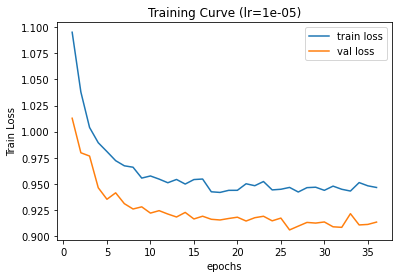

In [13]:
plt.plot(range(1, n_trained_epochs+1), train_avg_loss, label="train loss")
plt.plot(range(1, n_trained_epochs+1), val_avg_loss, label="val loss")
plt.title("Training Curve (lr={})".format(lr))
plt.xlabel("epochs")
plt.ylabel("Train Loss")
plt.legend(loc="best")
plt.show()

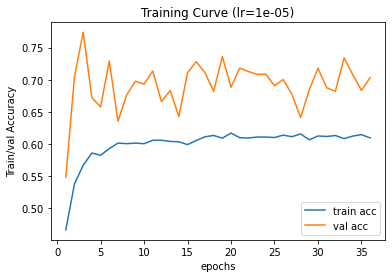

In [14]:
plt.plot(range(1, n_trained_epochs+1), train_avg_acc, label="train acc")
plt.plot(range(1, n_trained_epochs+1), val_avg_acc, label="val acc")
plt.title("Training Curve (lr={})".format(lr))
plt.xlabel("epochs")
plt.ylabel("Train/val Accuracy")
plt.legend(loc="best")
plt.show()

## Evaluation on the test dataset

In [15]:

############ test eval metrics ######################
test_true_labels = []
test_predict_labels = []
test_loss = []
test_acc = []
test_prec = []
test_rec = []
test_f1 = []

########################################################
for batch in tqdm(test_loader):
    batch = tuple(batch[t].to(device) for t in batch)      # batch to GPU
    t_input_ids, t_input_mask, t_token_type_ids, t_labels, t_bio_tags = batch     # unpack inputs from dataloader

    with torch.no_grad(): # tell model not to compute or store gradients -> saves memory + speeds up validation
        model.eval() # put model in evaluation mode for validation set
        logits = model(**{"input_ids":t_input_ids, "attention_mask":t_input_mask, "token_type_ids":t_token_type_ids}) # forward pass, calculates logit predictions

    ######################################################

    # similar to the class RobertaForToken classification in transformers: https://github.com/huggingface/transformers/blob/master/src/transformers/models/roberta/modeling_roberta.py
    t_active_loss = t_input_mask.view(-1) == 1  # either based on attention_mask (includes <CLS>, <SEP> token)
    t_active_logits = logits.view(-1, n_labels)[t_active_loss] # n_labels=3
    t_active_tags = t_bio_tags.view(-1)[t_active_loss]
    t_loss = loss_fn(t_active_logits, t_active_tags)             
    test_loss.append(t_loss.item())

    #########################################################
    logits = logits.detach().to('cpu').numpy()
    tags_ids = t_bio_tags.to('cpu').numpy()

    # calculate performance measures only on tokens and not subwords or special tokens
    tags_mask = tags_ids != -100 # only get token labels and not labels from subwords or special tokens
    pred = np.argmax(logits, axis=2)[tags_mask] #.flatten() # convert logits to list of predicted labels
    tags = tags_ids[tags_mask]#.flatten()                          
    test_true_labels.append(tags) # appends true labels for batch
    test_predict_labels.append(pred) # # appends predicted labels for batch
    
    metrics = compute_metrics(pred, tags)
    test_acc.append(metrics["accuracy"])
    test_prec.append(metrics["precision"])
    test_rec.append(metrics["recall"])
    test_f1.append(metrics["f1"])


print(F'\n\tTest Loss: {np.mean(test_loss)}')
print(F'\n\tTest acc: {np.mean(test_acc)}')
print(F'\n\tTest prec: {np.mean(test_prec)}')
print(F'\n\tTest rec: {np.mean(test_rec)}')
print(F'\n\tTest f1: {np.mean(test_f1)}')


  0%|          | 0/27 [00:00<?, ?it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
  4%|▎         | 1/27 [00:00<00:03,  7.61it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
  7%|▋         | 2/27 [00:00<00:04,  5.94it/s]<ipython-input-6-6ea249dd8a91>:23: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  , "labels" : torch.tensor(self.labels[idx], dtype=torch.long)
 11%|█         | 3/27 [00:00<00:03,  6.86it/s]<ipython


	Test Loss: 0.9142599436971877

	Test acc: 0.7010990119945745

	Test prec: 0.7935250633554427

	Test rec: 0.7010990119945745

	Test f1: 0.7346968904963964


### Classification reports

In [16]:

test_true_tag = [id2tag[ID] for ID in np.concatenate(test_true_labels)]#
test_predict_tag = [id2tag[ID] for ID in np.concatenate(test_predict_labels)]
print(classification_report(test_true_tag, test_predict_tag))

              precision    recall  f1-score   support

         I-C       0.48      0.46      0.47       495
         I-E       0.20      0.48      0.29       487
           O       0.91      0.77      0.83      4159

    accuracy                           0.71      5141
   macro avg       0.53      0.57      0.53      5141
weighted avg       0.80      0.71      0.74      5141



In [17]:
#The metrics we are seeing in this report are designed specifically for NLP tasks such as NER and POS tagging,
#in which all words of an entity need to be predicted correctly to be counted as one correct prediction. 
#Therefore, the metrics in this classification report are much lower than in scikit-learn's classification report.
test_true_tag = [[id2tag[ID] for ID in IDS] for IDS in test_true_labels]
test_predict_tag = [[id2tag[ID] for ID in IDS] for IDS in test_predict_labels]
print(classification_report_seqeval(test_true_tag, test_predict_tag))

              precision    recall  f1-score   support

           C       0.26      0.42      0.32       241
           E       0.07      0.23      0.10       236

   micro avg       0.13      0.33      0.19       477
   macro avg       0.16      0.33      0.21       477
weighted avg       0.17      0.33      0.21       477

